In [1]:
import numpy as np
import numpy.random
import scipy.stats as ss
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.mlab as mlab
import math
import pandas as pd
import rpy2.robjects as robjects
%reload_ext rpy2.ipython
import numpy as np
import scipy.stats as stats
import pylab as pl
import os,sys

from scipy.integrate import quad
from scipy.integrate import dblquad
import scipy.special as special
# Set-up.
n = 1000
numpy.random.seed(0x5eed)
mu, sigma = 0.5, 0.1 # mean and standard deviation
a = 2
b = 20





D:\Anaconda3\envs\wmi\lib\site-packages\rpy2\robjects\pandas2ri.py:17: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import Index as PandasIndex


(1000,)


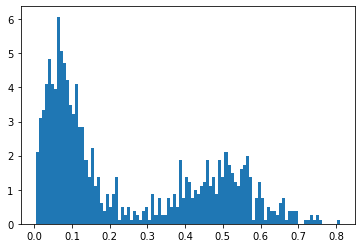

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import os
os.environ['KMP_DUPLICATE_LIB_OK'] = 'True'

distributions = [
    {"type": np.random.normal, "kwargs": {"loc": mu, "scale": sigma}},
    {"type": np.random.beta, "kwargs": {"a": a, "b": b}},
    #{"type": np.random.normal, "kwargs": {"loc": 2, "scale": 1}},
]
coefficients = np.array([0.4, 0.6])
#coefficients /= coefficients.sum()      # in case these did not add up to 1
sample_size = n

num_distr = len(distributions)
data = np.zeros((sample_size, num_distr))
for idx, distr in enumerate(distributions):
    data[:, idx] = distr["type"](size=(sample_size,), **distr["kwargs"])
random_idx = np.random.choice(np.arange(num_distr), size=(sample_size,), p=coefficients)
sample = data[np.arange(sample_size), random_idx]
print( sample.shape)

plt.hist(sample, bins=100, density=True)
plt.show()

In [11]:
#HERE TRY TO GET lfps.csv
from numpy import genfromtxt
my_data = genfromtxt('lfps.csv', delimiter=',')

print my_data.shape
print my_data[1,:]

feat_1 = my_data[:,0]
feat_20 = my_data[:,19]
print feat_1
print feat_1.min()
print feat_1.max()


real_AClfp = genfromtxt('big_lfps.csv', delimiter=',')
big_AC = genfromtxt('big_AC.csv', delimiter=',')

print("new guys")

print real_AClfp.shape
real_aclfp_feat0 = real_AClfp[:,0] #real values AC_LFP feature 0

real_aclfp_feat19 = real_AClfp[:,19] #real values AC_LFP feature 19

big_AC_feat0 = big_AC[:,0]#real values AC_ feature 0
big_AC_feat1 = big_AC[:,1]#real values AC_ feature 0
big_AC_feat2 = big_AC[:,2]#real values AC_ feature 0
big_AC_feat3 = big_AC[:,3]#real values AC_ feature 0
big_AC_feat4 = big_AC[:,4]#real values AC_ feature 0
big_AC_feat5 = big_AC[:,5]#real values AC_ feature 0
big_AC_feat6 = big_AC[:,6]#real values AC_ feature 0
big_AC_feat7 = big_AC[:,7]#real values AC_ feature 0
big_AC_feat8 = big_AC[:,8]#real values AC_ feature 0
big_AC_feat9 = big_AC[:,9]#real values AC_ feature 0
big_AC_feat10 = big_AC[:,10]#real values AC_ feature 0
big_AC_feat11 = big_AC[:,11]#real values AC_ feature 0
big_AC_feat12 = big_AC[:,12]#real values AC_ feature 0
big_AC_feat13 = big_AC[:,13]#real values AC_ feature 0
big_AC_feat14 = big_AC[:,14]#real values AC_ feature 0
big_AC_feat15 = big_AC[:,15]#real values AC_ feature 0
big_AC_feat16 = big_AC[:,16]#real values AC_ feature 0
big_AC_feat17 = big_AC[:,17]#real values AC_ feature 0


big_AC_feat19 = big_AC[:,19]#real values AC_ feature 20


print big_AC_feat0.shape

(36000, 32)
[ 0.65050201  0.65911183  0.63307396  0.63764805  0.61756822  0.63265864
  0.61027817  0.64732009  0.59194653  0.6092379   0.60118984  0.59401646
  0.59223242  0.57924006  0.57991951  0.57340724  0.58968499  0.58954541
  0.59086048  0.58909716  0.60020232  0.57520859  0.58330276  0.57605238
  0.58620147  0.57147856  0.59639126  0.57694742  0.60844954  0.58851237
  0.60017566  0.59563607]
[ 0.57530647  0.65050201  0.27179181 ...,  0.3655521   0.61788232
  0.65808532]
0.0
1.0
new guys
(36000, 32)
(36000,)


In [3]:
def automateHybrids(feature,name,discMethod='equal-width'):
    #contFeatures=preprocessHybridUCI(file,contIndices,namelist='')
    for i in range(2,21):
        file_ident=name+'_intevalnr'+str(i)
        runPolynomial(file_ident,feature,intervalNr=i,discMethod=discMethod)
        #runAllUCI(file_ident,file,intervalNr=i, discMethod=discMethod)

In [4]:
import os
import shutil
def runPolynomial(foldername,feature,intervalNr=10,discMethod='equal-width'):
    current_directory = os.getcwd()
    appendString=foldername
    
    final_directory = os.path.join(current_directory, appendString)
   
    if not os.path.exists(final_directory):
        os.makedirs(final_directory)
    else:
        shutil.rmtree(final_directory)           #removes all the subdirectories!
        os.makedirs(final_directory)
    os.chdir(final_directory)    
    datafile=foldername+'.data'
    with open(datafile,'w')as data:
        data.write('')
        data.close()
    functionfile=foldername+'.functions'
    with open(functionfile,'w')as functions:
        functions.write('')
        functions.close()
    valuefile=foldername+'.values'
    with open(valuefile,'w')as val:
        val.write('')
        val.close()
    
    
    check=foldername+'test'
    
    runPipelineExhaustive(feature,foldername,name='gauss',nintervals=intervalNr,discMethod=discMethod)
    
    os.chdir(current_directory)


In [8]:

def genericPolynomial(x,a_06):
    #print(len(a_06))

    return a_06[0]+a_06[1]*x+a_06[2]*(x**2)+a_06[3]*(x**3)+a_06[4]*(x**4)+a_06[5]*(x**5)+a_06[6]*(x**6)+a_06[7]*(x**7)+a_06[8]*(x**8)+a_06[9]*(x**9)
def runPipelineExhaustive(feature,fileident,name='',nintervals=10,discMethod='equal-width'):
    
    attrVec=sorted(feature)
    print(attrVec)
    BIC_train_scores = []
    best_BIC_score_train = -sys.float_info.max
    BIC_train_scores = []
    LL_train_scores = []   
    method=[]
    best_BIC_score_train = -99999
    start=True
    orders=[]
    #for ints in range(2,30):
    for poly in range(2,10):
            #for discMeth in ['equal-width','equal-freq']:
        print('Order:',poly)
        orders.append(poly)
        %R
        %R library("Rmop")
        print('okay')
        %R vec=attrVec
        print('super-okay')
        %R -i attrVec,poly,discMethod,nintervals n1 <- node.sequence(dim=1,order=poly,data =attrVec, nintervals = nintervals, minval = NULL, maxval = NULL, nodes = NULL, disc.method =discMethod)
        %R -i attrVec -o experiment experiment <- mop.approx(data=attrVec,order=poly,nodeseq=n1,debug=TRUE)
        #print(experiment)
        %R mop <- experiment$mop
        %R -o summary summary<- mop
        #print(summary)
        %R -o cur_polynomial cur_polynomial<-mop$polynomials

        %R -i attrVec -o score score <- mop.score(mop,attrVec)
        %R -o BIC_train BIC_train<-score$BIC
        BIC_train_scores.append(round(BIC_train[0],4))
        #method.append(discMeth)
        %R -o LL_train LL_train<-score$LL
        LL_train_scores.append(round(LL_train[0],4))
        %R -o pieces_train pieces_train<-score$npieces
        #nr_intervals_array.append(pieces_train[0])  
        print(BIC_train[0])
        if BIC_train[0] > best_BIC_score_train:
            accepted_difference=0.7 * abs(best_BIC_score_train) + best_BIC_score_train
            print('best: ',best_BIC_score_train,'accepted difference:',accepted_difference, 'cur BIC:', BIC_train[0])
            if (start) or (BIC_train[0]<= accepted_difference):
                print('m reached')
                #calculate the polynomial values
                cutpoints=[]
                values=[]
                start1=True
                for interval in cur_polynomial:
                    minVal=interval[1][0]
                    maxVal=interval[2][0]
                    if start:
                        start1=False
                        cutpoints.append(minVal)
                        cutpoints.append(maxVal)
                    else:
                        cutpoints.append(maxVal)

                    l=[0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0]
                    polString=''
                    i=0
                    for pol in interval[0]:
                        l[i]=pol
                        i+=1
                        polString+=str(pol)+' '
                    polString+='\n'

                    integral=quad(genericPolynomial,minVal,maxVal,args=(l))
                    val=integral[0]
                    values.append(val)
                probSum=sum(values)
                #if we have a valid probability
                print('Sum of Probabilities:', probSum)
                if 0.9<probSum <1.1:
                    print('chosen')
                    start=False
                    best= cur_polynomial
                    best_BIC_score_train=BIC_train[0]
                    %R -i attrVec mop.plot.experiment(experiment,data=attrVec)
    #fileident='gauss'
    datafile=fileident+'.data'
    functionfile=fileident+'.functions'
    valuefile=fileident+'.values'
    with open(datafile,'a') as data:
        with open(functionfile,'a')as functions:
            with open(valuefile,'a') as values:
                functions.write('# \n')
                cutpoints=[]
                valueString=''
                start=True
                for interval in best:
                    minVal=interval[1][0]
                    maxVal=interval[2][0]
                    if start:
                        start=False
                        cutpoints.append(minVal)
                        cutpoints.append(maxVal)
                    else:
                        cutpoints.append(maxVal)

                    l=[0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0]
                    polString=''
                    i=0
                    for pol in interval[0]:
                        l[i]=pol
                        i+=1
                        polString+=str(pol)+' '
                    polString+='\n'
                    functions.write(polString)
                    integral=quad(genericPolynomial,minVal,maxVal,args=(l))
                    val=integral[0]
                    valueString+=str(val)+'\n '
                    
                    
                #valueString+='\n'
                values.write(valueString)
                
                dataString=''
                for cut in cutpoints:
                    dataString+=str(cut)+' '
                dataString+='\n'
                data.write(dataString)
                    


    #if LL_train[0] > best_scores['LL_train'][0]:
        #best= cur_polynomial
        #best_scores['LL_train'] = [LL_train[0],disc_method,interval_method,poly]
        #stats.write('better LL train version found')
    if name!='':
        file =name+discMethod+'_in'+str(nintervals)+'_or'+str(poly)
        filename=file
        %R -i attrVec,filename mop.plot.experiment(experiment,data=attrVec,filename=filename,format='png')


In [9]:
def calcPolynomials(x,int_Dict):
    y=[]
    for val in x:
        max_index=len(int_Dict)-1
        ind=0
        for interval in int_Dict:
            min_Val=int_Dict[interval][0]
            max_Val=int_Dict[interval][1]
            pols=int_Dict[interval][2]
            order=len(pols)
            if min_Val<=val<max_Val:
                pol_val=0
                for i in range(0,order):
                    pol_val+= pols[i]*math.pow(val,i)
                #print(pol_val)
                y.append(pol_val)
            #last point
            if (ind==max_index) and (max_Val==val):
                pol_val=0
                for i in range(0,order):
                    pol_val+= pols[i]*math.pow(val,i)
                y.append(pol_val)
            
            
            ind+=1
    return y

In [10]:
import pandas
#preprocessing for R
#def rPipeline(plFile,pythonfile,discDict,valDict,testDict,probfoilfile,pfsettingsfile):
def rPipeline(discAttr,disc_method,nintervals,order=3):
    df_list = []
    nameArrray=[]

    #pack that into a vector
    attrVec = sorted(discAttr)



    %R 
    %R library("Rmop")
    %R vec=attrVec
    %R -i attrVec,disc_method,nintervals,order n1 <- node.sequence(dim=1,order=order,data =attrVec, nintervals = nintervals, minval = NULL, maxval = NULL, nodes = NULL, disc.method = disc_method)
    %R -i attrVec,order -o experiment experiment <- mop.approx(data=attrVec,order=order,nodeseq=n1,debug=TRUE)
    #print(experiment)
    %R mop <- experiment$mop
    %R -o summary summary<- mop
    
    %R -o supe supe<-mop$polynomials

    
    %R -i attrVec -o score score <- mop.score(mop,attrVec)
    %R -o scorelist scorelist<-c(score$LL,score$BIC,score$npieces)
    #print(scorelist)
    cutpoints=[]
    values=[]
    start=True
    for interval in supe:
        minVal=interval[1][0]
        maxVal=interval[2][0]
        if start:
            start=False
            cutpoints.append(minVal)
            cutpoints.append(maxVal)
        else:
            cutpoints.append(maxVal)

        l=[0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0]
        polString=''
        i=0
        for pol in interval[0]:
            l[i]=pol
            i+=1
            polString+=str(pol)+' '
        polString+='\n'

        integral=quad(genericPolynomial,minVal,maxVal,args=(l))
        val=integral[0]
        values.append(val)
    probSum=sum(values)
    fileident='expon'
    #if we have a valid probability
    print('Sum of Probabilities:', probSum)
    datafile=fileident+'.data'
    functionfile=fileident+'.functions'
    valuefile=fileident+'.values'
    with open(datafile,'a') as data:
        with open(functionfile,'a')as functions:
            with open(valuefile,'a') as values:
                functions.write('# \n')
                cutpoints=[]
                valueString=''
                start=True
                for interval in supe:
                    minVal=interval[1][0]
                    maxVal=interval[2][0]
                    if start:
                        start=False
                        cutpoints.append(minVal)
                        cutpoints.append(maxVal)
                    else:
                        cutpoints.append(maxVal)

                    l=[0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0]
                    polString=''
                    i=0
                    for pol in interval[0]:
                        l[i]=pol
                        i+=1
                        polString+=str(pol)+' '
                    polString+='\n'
                    functions.write(polString)
                    integral=quad(genericPolynomial,minVal,maxVal,args=(l))
                    val=integral[0]
                    valueString+=str(val)+'\n '
                    
                    
                #valueString+='\n'
                values.write(valueString)
                
                dataString=''
                for cut in cutpoints:
                    dataString+=str(cut)+' '
                dataString+='\n'
                data.write(dataString)
                    
    


    %R -i attrVec score <-mop.score(mop,attrVec)
    file ='BESTdiffPDF'+disc_method+str(nintervals)
    filename=file
    %R -i attrVec mop.plot.experiment(experiment,data=attrVec)
    #save plot in file

    %R -i attrVec,filename mop.plot.experiment(experiment,data=attrVec,filename=filename,format='png')


    %R -i attrVec mop.plot.experiment(experiment,data=attrVec)

    #%R -i attrVec_val mop.plot.experiment(experiment,data=attrVec_val)
    #%R -i attrVec_test mop.plot.experiment(experiment,data=attrVec_test)
    #print(supe)
    #built structures for RULES + Python MODULE 
    #return(int_Dict)
    int_Dict={}
    i=1
    for interval in supe:
        #for feature in interval:
        attrName='interval_'+str(i)
        int_Dict[attrName]=[interval[1][0],interval[2][0]]
        l=[]
        for pol in interval[0]:
            l.append(pol)
        int_Dict[attrName].append(l)
        i+=1
    return int_Dict


    
      

In [11]:
#arno0 = my_data[:5000,0]
print big_AC_feat19.min()
print big_AC_feat19.max()
automateHybrids(big_AC_feat19,'big_AC_feature19')
#runPipelineExhaustive(sample,'ac_feat0_ECBOOG')

SyntaxError: invalid syntax (<ipython-input-11-b91b7ed0ff12>, line 2)

In [12]:
automateHybrids(sample,'beta-gauss')


[0.004394521060443766, 0.004409276212848148, 0.005579102044038067, 0.007567607138112945, 0.008286681620657637, 0.008831150550684933, 0.009362958136677948, 0.009829297846341007, 0.009929975991322395, 0.01025820250278913, 0.011058057976763885, 0.011191967712931005, 0.011726691206247556, 0.01172804015053258, 0.01208912736709871, 0.01216316303722825, 0.012349434957805615, 0.013194804599479838, 0.013346582242295551, 0.013384917921197378, 0.013739102137815503, 0.013963541100361144, 0.013975963588996209, 0.014984775295198753, 0.015378990200436591, 0.015406854370962338, 0.016455754585781922, 0.01652788292912228, 0.017382855948629077, 0.017431497455263213, 0.017562945820907557, 0.017677984338833636, 0.017700111790188995, 0.01787138698184938, 0.018253999863482036, 0.01858825769389951, 0.01890911693878798, 0.01934321627354232, 0.019352043842128085, 0.019598268979460366, 0.020355021990057478, 0.020475907149078557, 0.0209524495709377, 0.021543716221872358, 0.021626722824879843, 0.02174971201263803,

PermissionError: [WinError 32] The process cannot access the file because it is being used by another process: 'C:\\Users\\Andreas\\AppData\\Local\\Temp\\tmp3va2nym8\\Rplots001.png'

lfps_0
('Order:', 2)


/home/andreas/miniconda2/envs/mlp/lib/python2.7/site-packages/rpy2/rinterface/__init__.py:186: RRuntimeWarning: Loading required package: mnormt

  warnings.warn(x, RRuntimeWarning)
/home/andreas/miniconda2/envs/mlp/lib/python2.7/site-packages/rpy2/rinterface/__init__.py:186: RRuntimeWarning: Loading required package: polynom

  warnings.warn(x, RRuntimeWarning)
/home/andreas/miniconda2/envs/mlp/lib/python2.7/site-packages/rpy2/rinterface/__init__.py:186: RRuntimeWarning: Loading required package: multipol

  warnings.warn(x, RRuntimeWarning)
/home/andreas/miniconda2/envs/mlp/lib/python2.7/site-packages/rpy2/rinterface/__init__.py:186: RRuntimeWarning: Loading required package: abind

  warnings.warn(x, RRuntimeWarning)
/home/andreas/miniconda2/envs/mlp/lib/python2.7/site-packages/rpy2/rinterface/__init__.py:186: RRuntimeWarning: 
Attaching package: ‘multipol’


  warnings.warn(x, RRuntimeWarning)
/home/andreas/miniconda2/envs/mlp/lib/python2.7/site-packages/rpy2/rinterface/__init__.py

okay

Error in withVisible({ : object 'attrVec' not found


/home/andreas/miniconda2/envs/mlp/lib/python2.7/site-packages/rpy2/rinterface/__init__.py:186: RRuntimeWarning: Loading required package: RColorBrewer

  warnings.warn(x, RRuntimeWarning)
/home/andreas/miniconda2/envs/mlp/lib/python2.7/site-packages/rpy2/rinterface/__init__.py:186: RRuntimeWarning: Error in withVisible({ : object 'attrVec' not found

  warnings.warn(x, RRuntimeWarning)


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.00941
mop.approx: Converged. Iteration 7. LL = 70.23438
[1] "Computing the linear combination of B-splines"


65.0357758363
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 65.035775836261251)
m reached
('Sum of Probabilities:', 0.9904935556360512)
chosen


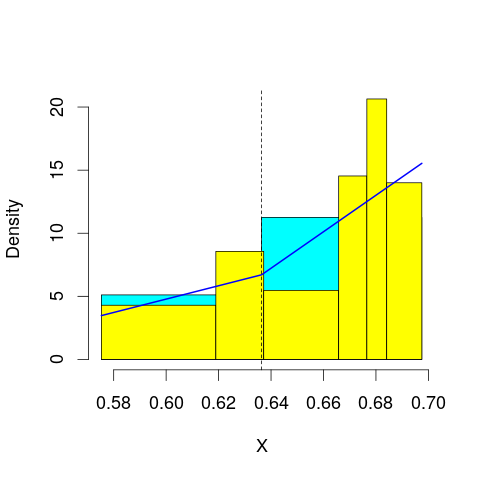

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.75069
mop.approx: Iteration 11. LL = 70.10349
mop.approx: Converged. Iteration 19. LL = 70.10511
[1] "Computing the linear combination of B-splines"


63.1736352733
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.49405
mop.approx: Iteration 11. LL = 69.70785
mop.approx: Converged. Iteration 11. LL = 69.70792
[1] "Computing the linear combination of B-splines"


61.0435762141
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.79129
mop.approx: Iteration 11. LL = 54.01939
mop.approx: Iteration 21. LL = 54.07094
mop.approx: Iteration 31. LL = 54.07481
mop.approx: Converged. Iteration 34. LL = 54.07509
[1] "Computing the linear combination of B-splines"


43.6778841483
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.18442
mop.approx: Iteration 11. LL = 54.27544
mop.approx: Iteration 21. LL = 54.42922
mop.approx: Converged. Iteration 30. LL = 54.4328
[1] "Computing the linear combination of B-splines"


42.3027230651
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.41504
mop.approx: Iteration 11. LL = 50.05717
mop.approx: Iteration 21. LL = 50.30614
mop.approx: Iteration 31. LL = 50.36635
mop.approx: Iteration 41. LL = 50.3887
mop.approx: Iteration 51. LL = 50.3987
mop.approx: Iteration 61. LL = 50.4036
mop.approx: Iteration 71. LL = 50.40612
mop.approx: Iteration 81. LL = 50.40744
mop.approx: Iteration 91. LL = 50.40814
mop.approx: Converged. Iteration 91. LL = 50.40819
[1] "Computing the linear combination of B-splines"


36.5452477885
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.26516
mop.approx: Iteration 11. LL = 50.28138
mop.approx: Iteration 21. LL = 50.50446
mop.approx: Iteration 31. LL = 50.51135
mop.approx: Converged. Iteration 32. LL = 50.51147
[1] "Computing the linear combination of B-splines"


34.9156534371
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.592199
mop.approx: Iteration 11. LL = 46.62578
mop.approx: Iteration 21. LL = 46.99752
mop.approx: Iteration 31. LL = 47.09366
mop.approx: Iteration 41. LL = 47.12507
mop.approx: Iteration 51. LL = 47.13628
mop.approx: Iteration 61. LL = 47.14041
mop.approx: Iteration 71. LL = 47.14195
mop.approx: Converged. Iteration 78. LL = 47.14246
[1] "Computing the linear combination of B-splines"


29.8137766657
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.00941
mop.approx: Iteration 11. LL = 70.79876
mop.approx: Converged. Iteration 14. LL = 70.7996
[1] "Computing the linear combination of B-splines"


63.8681232086
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 63.868123208635986)
m reached
('Sum of Probabilities:', 0.9883876112731338)
chosen


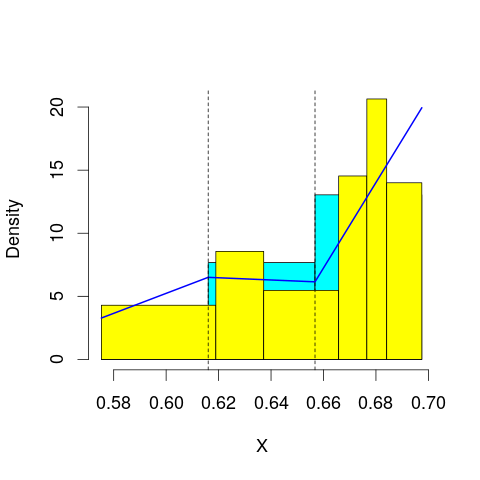

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.75069
mop.approx: Iteration 11. LL = 70.04112
mop.approx: Converged. Iteration 16. LL = 70.04206
[1] "Computing the linear combination of B-splines"


61.3777217467
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.49405
mop.approx: Iteration 11. LL = 70.38985
mop.approx: Iteration 21. LL = 70.60238
mop.approx: Iteration 31. LL = 70.69187
mop.approx: Iteration 41. LL = 70.73418
mop.approx: Iteration 51. LL = 70.75595
mop.approx: Iteration 61. LL = 70.76776
mop.approx: Iteration 71. LL = 70.77436
mop.approx: Iteration 81. LL = 70.77812
mop.approx: Iteration 91. LL = 70.7803
mop.approx: Iteration 101. LL = 70.78158
mop.approx: Converged. Iteration 107. LL = 70.78215
[1] "Computing the linear combination of B-splines"


60.3849455849
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.79129
mop.approx: Iteration 11. LL = 58.72779
mop.approx: Iteration 21. LL = 58.8122
mop.approx: Iteration 31. LL = 58.82165
mop.approx: Iteration 41. LL = 58.82348
mop.approx: Converged. Iteration 43. LL = 58.82367
[1] "Computing the linear combination of B-splines"


46.6935985304
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.18442
mop.approx: Iteration 11. LL = 57.39152
mop.approx: Iteration 21. LL = 57.40766
mop.approx: Converged. Iteration 23. LL = 57.40785
[1] "Computing the linear combination of B-splines"


43.5449051646
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.41504
mop.approx: Iteration 11. LL = 56.24341
mop.approx: Iteration 21. LL = 56.54057
mop.approx: Iteration 31. LL = 56.57113
mop.approx: Iteration 41. LL = 56.57457
mop.approx: Converged. Iteration 43. LL = 56.57478
[1] "Computing the linear combination of B-splines"


40.9789713563
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.26516
mop.approx: Iteration 11. LL = 53.23421
mop.approx: Iteration 21. LL = 53.42198
mop.approx: Iteration 31. LL = 53.46308
mop.approx: Iteration 41. LL = 53.47844
mop.approx: Iteration 51. LL = 53.48586
mop.approx: Iteration 61. LL = 53.49002
mop.approx: Iteration 71. LL = 53.49257
mop.approx: Iteration 81. LL = 53.49424
mop.approx: Iteration 91. LL = 53.49537
mop.approx: Iteration 101. LL = 53.49617
mop.approx: Converged. Iteration 108. LL = 53.49664
[1] "Computing the linear combination of B-splines"


36.1679631143
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.592199
mop.approx: Iteration 11. LL = 52.52406
mop.approx: Iteration 21. LL = 52.84677
mop.approx: Iteration 31. LL = 52.86806
mop.approx: Converged. Iteration 39. LL = 52.86948
[1] "Computing the linear combination of B-splines"


33.8079294951
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.00941
mop.approx: Iteration 11. LL = 70.69753
mop.approx: Converged. Iteration 14. LL = 70.69814
[1] "Computing the linear combination of B-splines"


62.0338014518
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 62.033801451768575)
m reached
('Sum of Probabilities:', 0.9872930176361372)
chosen


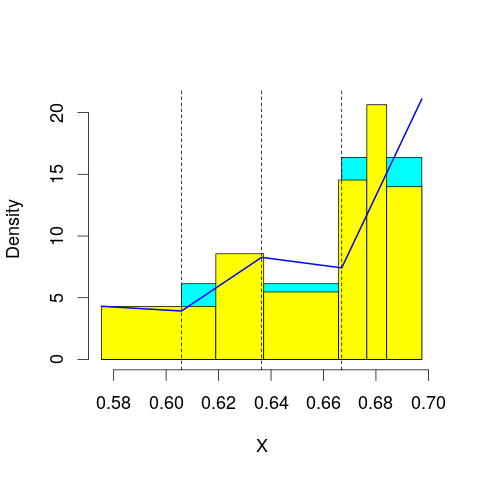

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.75069
mop.approx: Iteration 11. LL = 71.09534
mop.approx: Iteration 21. LL = 71.17796
mop.approx: Iteration 31. LL = 71.19242
mop.approx: Iteration 41. LL = 71.19618
mop.approx: Converged. Iteration 50. LL = 71.19737
[1] "Computing the linear combination of B-splines"


60.8001601448
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.49405
mop.approx: Iteration 11. LL = 71.06902
mop.approx: Iteration 21. LL = 71.22033
mop.approx: Iteration 31. LL = 71.2623
mop.approx: Iteration 41. LL = 71.27988
mop.approx: Iteration 51. LL = 71.2887
mop.approx: Iteration 61. LL = 71.29346
mop.approx: Iteration 71. LL = 71.29609
mop.approx: Iteration 81. LL = 71.29756
mop.approx: Converged. Iteration 88. LL = 71.29825
[1] "Computing the linear combination of B-splines"


59.1681759714
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.79129
mop.approx: Iteration 11. LL = 61.64009
mop.approx: Iteration 21. LL = 61.73068
mop.approx: Converged. Iteration 26. LL = 61.73185
[1] "Computing the linear combination of B-splines"


47.8689083543
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.18442
mop.approx: Iteration 11. LL = 59.39746
mop.approx: Iteration 21. LL = 59.46189
mop.approx: Converged. Iteration 27. LL = 59.46312
[1] "Computing the linear combination of B-splines"


43.8673057956
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.41504
mop.approx: Iteration 11. LL = 59.53632
mop.approx: Converged. Iteration 18. LL = 59.54453
[1] "Computing the linear combination of B-splines"


42.2158532342
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.26516
mop.approx: Iteration 11. LL = 57.46691
mop.approx: Iteration 21. LL = 57.73426
mop.approx: Iteration 31. LL = 57.79726
mop.approx: Iteration 41. LL = 57.82044
mop.approx: Iteration 51. LL = 57.83053
mop.approx: Iteration 61. LL = 57.83525
mop.approx: Iteration 71. LL = 57.83755
mop.approx: Iteration 81. LL = 57.83868
mop.approx: Converged. Iteration 85. LL = 57.83902
[1] "Computing the linear combination of B-splines"


38.77746798
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.592199
mop.approx: Iteration 11. LL = 55.69284
mop.approx: Iteration 21. LL = 55.83002
mop.approx: Iteration 31. LL = 55.85377
mop.approx: Iteration 41. LL = 55.86117
mop.approx: Iteration 51. LL = 55.8642
mop.approx: Iteration 61. LL = 55.86566
mop.approx: Iteration 71. LL = 55.86644
mop.approx: Converged. Iteration 72. LL = 55.86654
[1] "Computing the linear combination of B-splines"


35.0721296135
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.00941
mop.approx: Iteration 11. LL = 71.39485
mop.approx: Converged. Iteration 11. LL = 71.39489
[1] "Computing the linear combination of B-splines"


60.9976859545
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 60.997685954521472)
m reached
('Sum of Probabilities:', 0.9907488817645034)
chosen


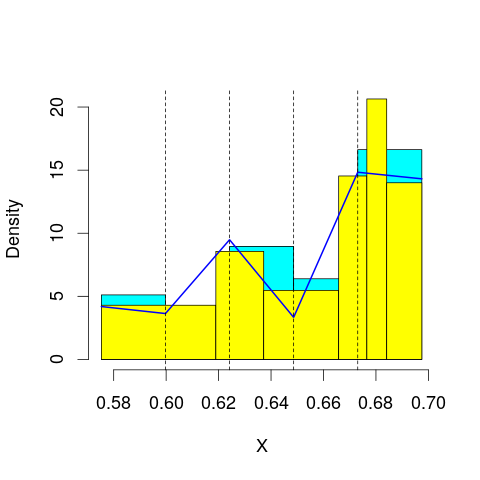

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.75069
mop.approx: Iteration 11. LL = 71.87218
mop.approx: Iteration 21. LL = 71.96428
mop.approx: Iteration 31. LL = 71.98384
mop.approx: Iteration 41. LL = 71.99086
mop.approx: Iteration 51. LL = 71.99416
mop.approx: Iteration 61. LL = 71.99598
mop.approx: Iteration 71. LL = 71.99707
mop.approx: Converged. Iteration 75. LL = 71.99746
[1] "Computing the linear combination of B-splines"


59.8673850986
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.49405
mop.approx: Iteration 11. LL = 71.00841
mop.approx: Iteration 21. LL = 71.03312
mop.approx: Iteration 31. LL = 71.03735
mop.approx: Iteration 41. LL = 71.03941
mop.approx: Iteration 51. LL = 71.04061
mop.approx: Converged. Iteration 58. LL = 71.04124
[1] "Computing the linear combination of B-splines"


57.1782991415
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.79129
mop.approx: Iteration 11. LL = 62.76044
mop.approx: Converged. Iteration 19. LL = 62.77547
[1] "Computing the linear combination of B-splines"


47.1796587448
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.18442
mop.approx: Iteration 11. LL = 60.34426
mop.approx: Iteration 21. LL = 60.54728
mop.approx: Iteration 31. LL = 60.59485
mop.approx: Iteration 41. LL = 60.61317
mop.approx: Iteration 51. LL = 60.62215
mop.approx: Iteration 61. LL = 60.62718
mop.approx: Iteration 71. LL = 60.63022
mop.approx: Iteration 81. LL = 60.63216
mop.approx: Iteration 91. LL = 60.63343
mop.approx: Iteration 101. LL = 60.63429
mop.approx: Converged. Iteration 105. LL = 60.63461
[1] "Computing the linear combination of B-splines"


43.3059266208
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.41504
mop.approx: Iteration 11. LL = 60.0449
mop.approx: Iteration 21. LL = 60.09549
mop.approx: Iteration 31. LL = 60.10464
mop.approx: Iteration 41. LL = 60.1075
mop.approx: Iteration 51. LL = 60.10869
mop.approx: Converged. Iteration 55. LL = 60.10902
[1] "Computing the linear combination of B-splines"


41.0474754508
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.26516
mop.approx: Iteration 11. LL = 60.78112
mop.approx: Converged. Iteration 19. LL = 60.8054
[1] "Computing the linear combination of B-splines"


40.0109836049
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.592199
mop.approx: Iteration 11. LL = 58.41413
mop.approx: Iteration 21. LL = 58.53881
mop.approx: Iteration 31. LL = 58.55167
mop.approx: Iteration 41. LL = 58.55409
mop.approx: Converged. Iteration 45. LL = 58.55446
[1] "Computing the linear combination of B-splines"


36.0271705887
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.00941
mop.approx: Iteration 11. LL = 72.43274
mop.approx: Converged. Iteration 11. LL = 72.43277
[1] "Computing the linear combination of B-splines"


60.3026900909
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 60.302690090916755)
m reached
('Sum of Probabilities:', 0.9922722661777368)
chosen


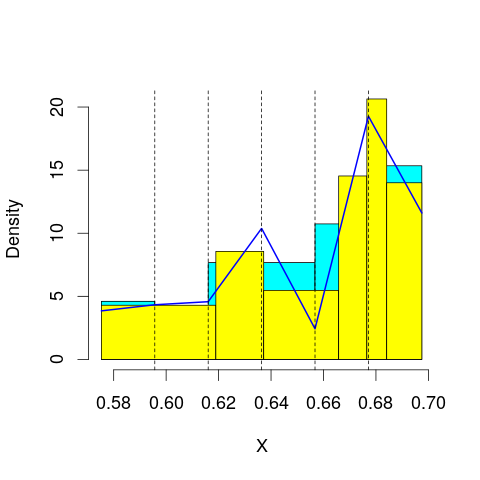

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.75069
mop.approx: Iteration 11. LL = 71.59354
mop.approx: Iteration 21. LL = 71.60713
mop.approx: Converged. Iteration 28. LL = 71.60834
[1] "Computing the linear combination of B-splines"


57.7453950293
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.49405
mop.approx: Iteration 11. LL = 71.90886
mop.approx: Iteration 21. LL = 72.08144
mop.approx: Iteration 31. LL = 72.10135
mop.approx: Converged. Iteration 40. LL = 72.10341
[1] "Computing the linear combination of B-splines"


56.5075985374
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.79129
mop.approx: Iteration 11. LL = 64.23356
mop.approx: Iteration 21. LL = 64.33485
mop.approx: Iteration 31. LL = 64.35821
mop.approx: Iteration 41. LL = 64.36562
mop.approx: Iteration 51. LL = 64.36822
mop.approx: Converged. Iteration 59. LL = 64.36911
[1] "Computing the linear combination of B-splines"


47.0404314922
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.18442
mop.approx: Iteration 11. LL = 62.43046
mop.approx: Iteration 21. LL = 62.70362
mop.approx: Iteration 31. LL = 62.72174
mop.approx: Iteration 41. LL = 62.72391
mop.approx: Converged. Iteration 43. LL = 62.72413
[1] "Computing the linear combination of B-splines"


43.6625776956
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.41504
mop.approx: Iteration 11. LL = 60.11398
mop.approx: Iteration 21. LL = 60.15618
mop.approx: Iteration 31. LL = 60.16779
mop.approx: Iteration 41. LL = 60.17255
mop.approx: Iteration 51. LL = 60.17483
mop.approx: Iteration 61. LL = 60.17602
mop.approx: Converged. Iteration 67. LL = 60.17652
[1] "Computing the linear combination of B-splines"


39.3821074498
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.26516
mop.approx: Iteration 11. LL = 60.82511
mop.approx: Converged. Iteration 17. LL = 60.82853
[1] "Computing the linear combination of B-splines"


38.3012356892
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.592199
mop.approx: Iteration 11. LL = 61.28261
mop.approx: Iteration 21. LL = 61.39221
mop.approx: Converged. Iteration 26. LL = 61.39354
[1] "Computing the linear combination of B-splines"


37.1332917533
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.00941
mop.approx: Converged. Iteration 9. LL = 72.66522
[1] "Computing the linear combination of B-splines"


58.8022714891
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 58.802271489130582)
m reached
('Sum of Probabilities:', 0.9927846848735633)
chosen


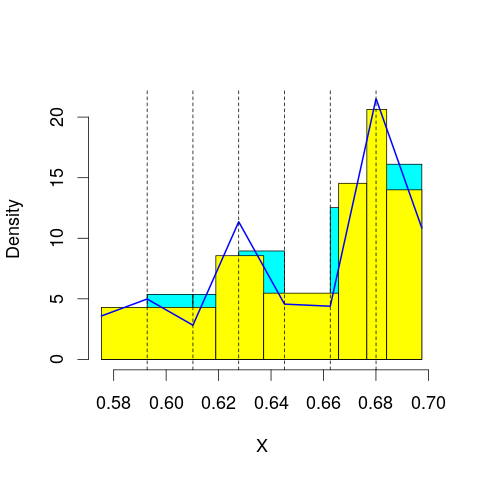

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.75069
mop.approx: Iteration 11. LL = 72.05996
mop.approx: Iteration 21. LL = 72.12584
mop.approx: Iteration 31. LL = 72.14126
mop.approx: Iteration 41. LL = 72.14622
mop.approx: Iteration 51. LL = 72.14821
mop.approx: Iteration 61. LL = 72.14919
mop.approx: Converged. Iteration 61. LL = 72.14926
[1] "Computing the linear combination of B-splines"


56.5534470647
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.49405
mop.approx: Iteration 11. LL = 72.7983
mop.approx: Iteration 21. LL = 72.93463
mop.approx: Iteration 31. LL = 72.96613
mop.approx: Iteration 41. LL = 72.97805
mop.approx: Iteration 51. LL = 72.98372
mop.approx: Iteration 61. LL = 72.9868
mop.approx: Iteration 71. LL = 72.98864
mop.approx: Iteration 81. LL = 72.98979
mop.approx: Converged. Iteration 87. LL = 72.99036
[1] "Computing the linear combination of B-splines"


55.6616761833
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.79129
mop.approx: Iteration 11. LL = 65.09107
mop.approx: Iteration 21. LL = 65.18101
mop.approx: Iteration 31. LL = 65.19181
mop.approx: Converged. Iteration 39. LL = 65.1931
[1] "Computing the linear combination of B-splines"


46.1315541299
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.18442
mop.approx: Iteration 11. LL = 64.30836
mop.approx: Iteration 21. LL = 64.46055
mop.approx: Iteration 31. LL = 64.47554
mop.approx: Iteration 41. LL = 64.47783
mop.approx: Converged. Iteration 42. LL = 64.47796
[1] "Computing the linear combination of B-splines"


43.6835464087
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.41504
mop.approx: Iteration 11. LL = 61.25411
mop.approx: Iteration 21. LL = 61.58901
mop.approx: Iteration 31. LL = 61.67336
mop.approx: Iteration 41. LL = 61.70416
mop.approx: Iteration 51. LL = 61.71738
mop.approx: Iteration 61. LL = 61.72344
mop.approx: Iteration 71. LL = 61.72631
mop.approx: Iteration 81. LL = 61.72769
mop.approx: Converged. Iteration 87. LL = 61.72821
[1] "Computing the linear combination of B-splines"


39.2009251128
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.26516
mop.approx: Iteration 11. LL = 61.09526
mop.approx: Iteration 21. LL = 61.18544
mop.approx: Iteration 31. LL = 61.20844
mop.approx: Iteration 41. LL = 61.21574
mop.approx: Iteration 51. LL = 61.21839
mop.approx: Iteration 61. LL = 61.21943
mop.approx: Converged. Iteration 62. LL = 61.21955
[1] "Computing the linear combination of B-splines"


36.9593907095
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.592199
mop.approx: Iteration 11. LL = 61.59423
mop.approx: Iteration 21. LL = 61.62086
mop.approx: Converged. Iteration 22. LL = 61.62097
[1] "Computing the linear combination of B-splines"


35.6280217061
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.00941
mop.approx: Iteration 11. LL = 72.79991
mop.approx: Converged. Iteration 14. LL = 72.80045
[1] "Computing the linear combination of B-splines"


57.2046431049
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 57.204643104865681)
m reached
('Sum of Probabilities:', 0.9926178961036953)
chosen


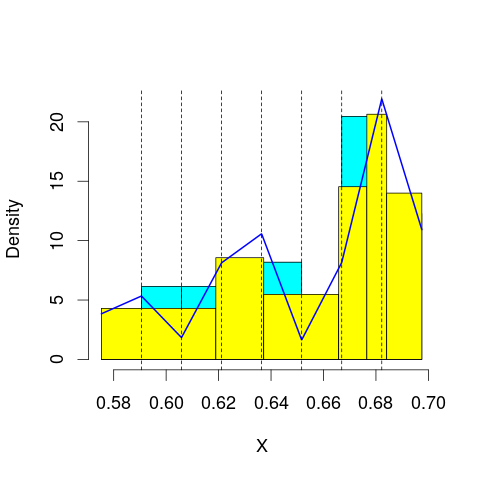

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.75069
mop.approx: Iteration 11. LL = 73.11486
mop.approx: Iteration 21. LL = 73.15356
mop.approx: Converged. Iteration 30. LL = 73.15584
[1] "Computing the linear combination of B-splines"


55.8271597892
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.49405
mop.approx: Iteration 11. LL = 72.94764
mop.approx: Iteration 21. LL = 73.00624
mop.approx: Iteration 31. LL = 73.01683
mop.approx: Iteration 41. LL = 73.02001
mop.approx: Iteration 51. LL = 73.02125
mop.approx: Converged. Iteration 52. LL = 73.0214
[1] "Computing the linear combination of B-splines"


53.9598525791
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.79129
mop.approx: Iteration 11. LL = 65.40773
mop.approx: Iteration 21. LL = 65.44827
mop.approx: Iteration 31. LL = 65.45388
mop.approx: Iteration 41. LL = 65.4554
mop.approx: Converged. Iteration 45. LL = 65.45576
[1] "Computing the linear combination of B-splines"


44.6613404691
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.18442
mop.approx: Iteration 11. LL = 65.7602
mop.approx: Iteration 21. LL = 65.8297
mop.approx: Converged. Iteration 29. LL = 65.83216
[1] "Computing the linear combination of B-splines"


43.30488021
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.41504
mop.approx: Iteration 11. LL = 63.06404
mop.approx: Iteration 21. LL = 63.445
mop.approx: Iteration 31. LL = 63.50138
mop.approx: Iteration 41. LL = 63.51198
mop.approx: Iteration 51. LL = 63.51422
mop.approx: Converged. Iteration 54. LL = 63.51451
[1] "Computing the linear combination of B-splines"


39.2543503604
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.26516
mop.approx: Iteration 11. LL = 61.33601
mop.approx: Iteration 21. LL = 61.45344
mop.approx: Iteration 31. LL = 61.49155
mop.approx: Iteration 41. LL = 61.50744
mop.approx: Iteration 51. LL = 61.51467
mop.approx: Iteration 61. LL = 61.51817
mop.approx: Iteration 71. LL = 61.51998
mop.approx: Iteration 81. LL = 61.521
mop.approx: Converged. Iteration 86. LL = 61.52141
[1] "Computing the linear combination of B-splines"


35.528031804
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.592199
mop.approx: Iteration 11. LL = 62.20915
mop.approx: Iteration 21. LL = 62.36292
mop.approx: Iteration 31. LL = 62.40641
mop.approx: Iteration 41. LL = 62.42401
mop.approx: Iteration 51. LL = 62.43278
mop.approx: Iteration 61. LL = 62.43778
mop.approx: Iteration 71. LL = 62.4409
mop.approx: Iteration 81. LL = 62.44298
mop.approx: Iteration 91. LL = 62.44443
mop.approx: Iteration 101. LL = 62.44547
mop.approx: Iteration 111. LL = 62.44625
mop.approx: Converged. Iteration 114. LL = 62.44651
[1] "Computing the linear combination of B-splines"


34.7222563654
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.00941
mop.approx: Iteration 11. LL = 72.25929
mop.approx: Converged. Iteration 16. LL = 72.26072
[1] "Computing the linear combination of B-splines"


54.9320438895
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 54.932043889492519)
m reached
('Sum of Probabilities:', 0.9916761149030682)
chosen


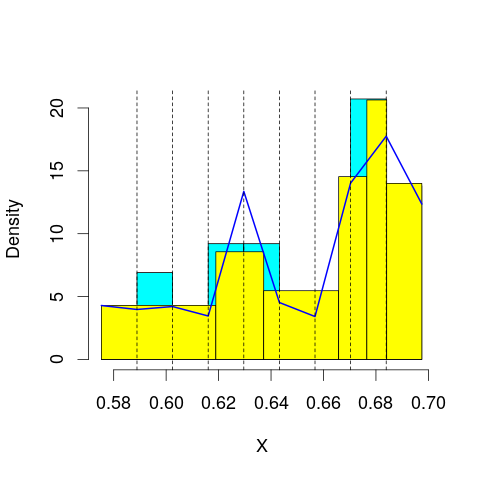

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.75069
mop.approx: Iteration 11. LL = 73.8405
mop.approx: Iteration 21. LL = 73.86586
mop.approx: Iteration 31. LL = 73.86891
mop.approx: Converged. Iteration 33. LL = 73.86916
[1] "Computing the linear combination of B-splines"


54.8076079428
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.49405
mop.approx: Iteration 11. LL = 72.89743
mop.approx: Iteration 21. LL = 72.92921
mop.approx: Iteration 31. LL = 72.93645
mop.approx: Iteration 41. LL = 72.93916
mop.approx: Iteration 51. LL = 72.9405
mop.approx: Converged. Iteration 56. LL = 72.94099
[1] "Computing the linear combination of B-splines"


52.1465777178
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.79129
mop.approx: Iteration 11. LL = 65.34672
mop.approx: Iteration 21. LL = 65.38782
mop.approx: Iteration 31. LL = 65.3984
mop.approx: Iteration 41. LL = 65.40146
mop.approx: Converged. Iteration 48. LL = 65.40227
[1] "Computing the linear combination of B-splines"


42.8749853439
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.18442
mop.approx: Iteration 11. LL = 66.91098
mop.approx: Iteration 21. LL = 67.02848
mop.approx: Iteration 31. LL = 67.05386
mop.approx: Iteration 41. LL = 67.06264
mop.approx: Iteration 51. LL = 67.06644
mop.approx: Iteration 61. LL = 67.0683
mop.approx: Iteration 71. LL = 67.06927
mop.approx: Converged. Iteration 72. LL = 67.0694
[1] "Computing the linear combination of B-splines"


42.8092467612
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.41504
mop.approx: Iteration 11. LL = 65.03687
mop.approx: Iteration 21. LL = 65.22804
mop.approx: Iteration 31. LL = 65.23458
mop.approx: Converged. Iteration 32. LL = 65.23471
[1] "Computing the linear combination of B-splines"


39.2416977994
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.26516
mop.approx: Iteration 11. LL = 62.04476
mop.approx: Iteration 21. LL = 62.21527
mop.approx: Iteration 31. LL = 62.24588
mop.approx: Iteration 41. LL = 62.25294
mop.approx: Iteration 51. LL = 62.25529
mop.approx: Iteration 61. LL = 62.25636
mop.approx: Converged. Iteration 65. LL = 62.2567
[1] "Computing the linear combination of B-splines"


34.5303649817
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.592199
mop.approx: Iteration 11. LL = 62.33607
mop.approx: Iteration 21. LL = 62.39309
mop.approx: Iteration 31. LL = 62.4005
mop.approx: Iteration 41. LL = 62.40257
mop.approx: Iteration 51. LL = 62.40351
mop.approx: Converged. Iteration 52. LL = 62.40363
[1] "Computing the linear combination of B-splines"


32.9423295502
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.00941
mop.approx: Iteration 11. LL = 73.3177
mop.approx: Iteration 21. LL = 73.3479
mop.approx: Iteration 31. LL = 73.35536
mop.approx: Iteration 41. LL = 73.35801
mop.approx: Converged. Iteration 50. LL = 73.3591
[1] "Computing the linear combination of B-splines"


54.2975534835
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 54.29755348352132)
m reached
('Sum of Probabilities:', 0.9906234479096093)
chosen


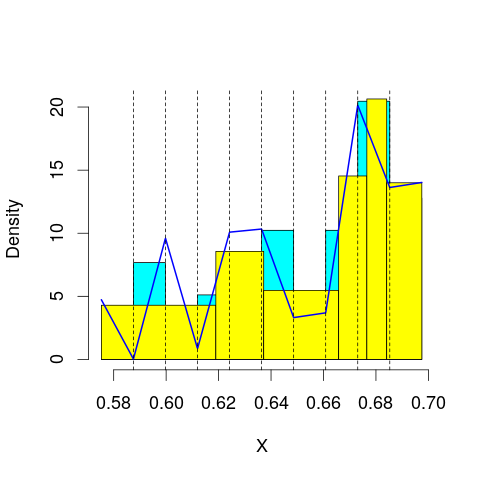

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.75069
mop.approx: Iteration 11. LL = 73.83725
mop.approx: Iteration 21. LL = 73.87059
mop.approx: Iteration 31. LL = 73.87547
mop.approx: Converged. Iteration 37. LL = 73.87627
[1] "Computing the linear combination of B-splines"


53.0818583006
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.49405
mop.approx: Iteration 11. LL = 73.11487
mop.approx: Iteration 21. LL = 73.17712
mop.approx: Iteration 31. LL = 73.19872
mop.approx: Iteration 41. LL = 73.20676
mop.approx: Iteration 51. LL = 73.20979
mop.approx: Iteration 61. LL = 73.21095
mop.approx: Converged. Iteration 61. LL = 73.21102
[1] "Computing the linear combination of B-splines"


50.6837350172
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.79129
mop.approx: Iteration 11. LL = 65.57161
mop.approx: Iteration 21. LL = 65.62692
mop.approx: Iteration 31. LL = 65.63943
mop.approx: Iteration 41. LL = 65.64337
mop.approx: Iteration 51. LL = 65.64489
mop.approx: Converged. Iteration 56. LL = 65.64535
[1] "Computing the linear combination of B-splines"


41.3852020869
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.18442
mop.approx: Iteration 11. LL = 67.1948
mop.approx: Iteration 21. LL = 67.22538
mop.approx: Iteration 31. LL = 67.23038
mop.approx: Iteration 41. LL = 67.23237
mop.approx: Iteration 51. LL = 67.2334
mop.approx: Converged. Iteration 54. LL = 67.23368
[1] "Computing the linear combination of B-splines"


41.2406562893
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.41504
mop.approx: Iteration 11. LL = 66.90673
mop.approx: Iteration 21. LL = 67.11217
mop.approx: Iteration 31. LL = 67.15492
mop.approx: Iteration 41. LL = 67.16974
mop.approx: Iteration 51. LL = 67.17546
mop.approx: Iteration 61. LL = 67.17786
mop.approx: Iteration 71. LL = 67.17896
mop.approx: Converged. Iteration 73. LL = 67.17917
[1] "Computing the linear combination of B-splines"


39.4532365602
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.26516
mop.approx: Iteration 11. LL = 63.48082
mop.approx: Iteration 21. LL = 63.71432
mop.approx: Iteration 31. LL = 63.7563
mop.approx: Iteration 41. LL = 63.76914
mop.approx: Iteration 51. LL = 63.77425
mop.approx: Iteration 61. LL = 63.7767
mop.approx: Iteration 71. LL = 63.77806
mop.approx: Iteration 81. LL = 63.7789
mop.approx: Converged. Iteration 82. LL = 63.77903
[1] "Computing the linear combination of B-splines"


34.3196257013
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.592199
mop.approx: Iteration 11. LL = 62.53577
mop.approx: Iteration 21. LL = 62.5938
mop.approx: Iteration 31. LL = 62.6121
mop.approx: Iteration 41. LL = 62.61946
mop.approx: Iteration 51. LL = 62.62241
mop.approx: Iteration 61. LL = 62.62358
mop.approx: Converged. Iteration 62. LL = 62.62371
[1] "Computing the linear combination of B-splines"


31.4277553899
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.00941
mop.approx: Iteration 11. LL = 74.00508
mop.approx: Iteration 21. LL = 74.0142
mop.approx: Converged. Iteration 21. LL = 74.01425
[1] "Computing the linear combination of B-splines"


53.2198318138
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 53.219831813759711)
m reached
('Sum of Probabilities:', 0.9896121366257805)
chosen


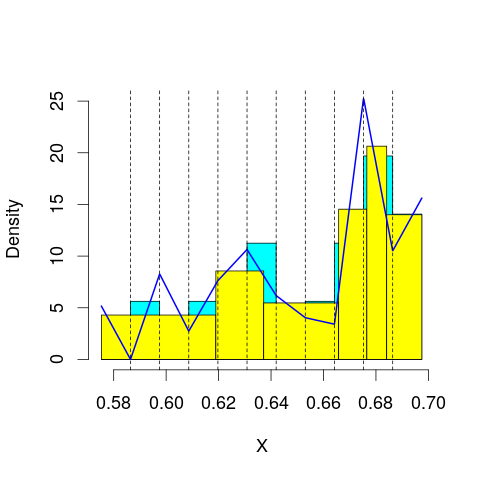

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.75069
mop.approx: Iteration 11. LL = 73.76218
mop.approx: Iteration 21. LL = 73.79148
mop.approx: Iteration 31. LL = 73.79572
mop.approx: Converged. Iteration 37. LL = 73.79646
[1] "Computing the linear combination of B-splines"


51.2691755031
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.49405
mop.approx: Iteration 11. LL = 73.64633
mop.approx: Iteration 21. LL = 73.75216
mop.approx: Iteration 31. LL = 73.77888
mop.approx: Iteration 41. LL = 73.78888
mop.approx: Iteration 51. LL = 73.7936
mop.approx: Iteration 61. LL = 73.79614
mop.approx: Iteration 71. LL = 73.79763
mop.approx: Iteration 81. LL = 73.79857
mop.approx: Converged. Iteration 81. LL = 73.79864
[1] "Computing the linear combination of B-splines"


49.5384909637
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.79129
mop.approx: Iteration 11. LL = 66.1704
mop.approx: Iteration 21. LL = 66.22963
mop.approx: Iteration 31. LL = 66.24834
mop.approx: Iteration 41. LL = 66.25577
mop.approx: Iteration 51. LL = 66.25874
mop.approx: Iteration 61. LL = 66.25993
mop.approx: Converged. Iteration 62. LL = 66.26007
[1] "Computing the linear combination of B-splines"


40.2670489777
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.18442
mop.approx: Iteration 11. LL = 67.16578
mop.approx: Iteration 21. LL = 67.17248
mop.approx: Converged. Iteration 30. LL = 67.17345
[1] "Computing the linear combination of B-splines"


39.4475622366
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.41504
mop.approx: Iteration 11. LL = 67.9101
mop.approx: Iteration 21. LL = 68.00558
mop.approx: Iteration 31. LL = 68.02309
mop.approx: Iteration 41. LL = 68.0293
mop.approx: Iteration 51. LL = 68.03208
mop.approx: Iteration 61. LL = 68.0335
mop.approx: Converged. Iteration 68. LL = 68.03416
[1] "Computing the linear combination of B-splines"


38.5753992082
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.26516
mop.approx: Iteration 11. LL = 65.62328
mop.approx: Iteration 21. LL = 66.06933
mop.approx: Iteration 31. LL = 66.16194
mop.approx: Iteration 41. LL = 66.1871
mop.approx: Iteration 51. LL = 66.19511
mop.approx: Iteration 61. LL = 66.19794
mop.approx: Iteration 71. LL = 66.199
mop.approx: Converged. Iteration 71. LL = 66.19906
[1] "Computing the linear combination of B-splines"


35.007687695
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.592199
mop.approx: Iteration 11. LL = 62.89299
mop.approx: Iteration 21. LL = 62.98095
mop.approx: Iteration 31. LL = 62.99772
mop.approx: Iteration 41. LL = 63.00358
mop.approx: Iteration 51. LL = 63.00614
mop.approx: Iteration 61. LL = 63.00737
mop.approx: Converged. Iteration 66. LL = 63.00779
[1] "Computing the linear combination of B-splines"


30.0147769631
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.00941
mop.approx: Iteration 11. LL = 75.31168
mop.approx: Iteration 21. LL = 75.34513
mop.approx: Iteration 31. LL = 75.35279
mop.approx: Iteration 41. LL = 75.35569
mop.approx: Iteration 51. LL = 75.35706
mop.approx: Converged. Iteration 55. LL = 75.35748
[1] "Computing the linear combination of B-splines"


52.8301990723
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 52.830199072327929)
m reached
('Sum of Probabilities:', 0.9891731592824708)
chosen


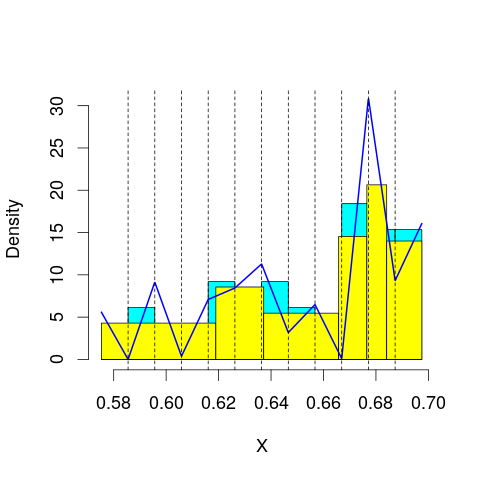

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.75069
mop.approx: Iteration 11. LL = 73.62433
mop.approx: Iteration 21. LL = 73.62951
mop.approx: Converged. Iteration 22. LL = 73.62964
[1] "Computing the linear combination of B-splines"


49.369491324
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.49405
mop.approx: Iteration 11. LL = 74.29172
mop.approx: Iteration 21. LL = 74.4766
mop.approx: Iteration 31. LL = 74.54004
mop.approx: Iteration 41. LL = 74.56519
mop.approx: Iteration 51. LL = 74.57592
mop.approx: Iteration 61. LL = 74.58082
mop.approx: Iteration 71. LL = 74.58326
mop.approx: Iteration 81. LL = 74.5846
mop.approx: Converged. Iteration 88. LL = 74.58528
[1] "Computing the linear combination of B-splines"


48.5922629159
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.79129
mop.approx: Iteration 11. LL = 66.92483
mop.approx: Iteration 21. LL = 66.9864
mop.approx: Iteration 31. LL = 67.0051
mop.approx: Iteration 41. LL = 67.01164
mop.approx: Iteration 51. LL = 67.01399
mop.approx: Converged. Iteration 58. LL = 67.01472
[1] "Computing the linear combination of B-splines"


39.288833394
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.18442
mop.approx: Iteration 11. LL = 67.13929
mop.approx: Iteration 21. LL = 67.15071
mop.approx: Iteration 31. LL = 67.15508
mop.approx: Iteration 41. LL = 67.15793
mop.approx: Iteration 51. LL = 67.16002
mop.approx: Iteration 61. LL = 67.16159
mop.approx: Iteration 71. LL = 67.1628
mop.approx: Iteration 81. LL = 67.16374
mop.approx: Converged. Iteration 90. LL = 67.16448
[1] "Computing the linear combination of B-splines"


37.705722317
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.41504
mop.approx: Iteration 11. LL = 68.2994
mop.approx: Iteration 21. LL = 68.33418
mop.approx: Iteration 31. LL = 68.3459
mop.approx: Iteration 41. LL = 68.3527
mop.approx: Iteration 51. LL = 68.35685
mop.approx: Iteration 61. LL = 68.35944
mop.approx: Iteration 71. LL = 68.36108
mop.approx: Iteration 81. LL = 68.36212
mop.approx: Converged. Iteration 85. LL = 68.36248
[1] "Computing the linear combination of B-splines"


37.1708672494
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.26516
mop.approx: Iteration 11. LL = 67.31577
mop.approx: Iteration 21. LL = 67.55614
mop.approx: Iteration 31. LL = 67.58243
mop.approx: Iteration 41. LL = 67.58913
mop.approx: Iteration 51. LL = 67.59125
mop.approx: Converged. Iteration 56. LL = 67.59177
[1] "Computing the linear combination of B-splines"


34.6637471355
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.592199
mop.approx: Iteration 11. LL = 64.74701
mop.approx: Iteration 21. LL = 65.06257
mop.approx: Iteration 31. LL = 65.13576
mop.approx: Iteration 41. LL = 65.15506
mop.approx: Iteration 51. LL = 65.16065
mop.approx: Iteration 61. LL = 65.16245
mop.approx: Converged. Iteration 65. LL = 65.16284
[1] "Computing the linear combination of B-splines"


30.4892842194
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.00941
mop.approx: Iteration 11. LL = 74.95933
mop.approx: Iteration 21. LL = 74.98122
mop.approx: Iteration 31. LL = 74.98655
mop.approx: Iteration 41. LL = 74.98823
mop.approx: Converged. Iteration 43. LL = 74.98847
[1] "Computing the linear combination of B-splines"


50.7283162946
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 50.728316294590208)
m reached
('Sum of Probabilities:', 0.9885939435158374)
chosen


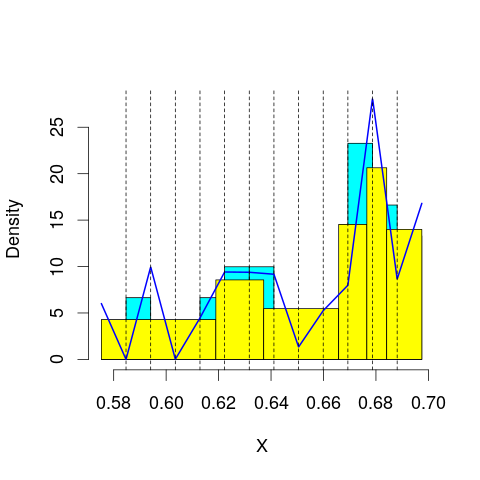

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.75069
mop.approx: Iteration 11. LL = 74.18778
mop.approx: Iteration 21. LL = 74.21359
mop.approx: Iteration 31. LL = 74.21818
mop.approx: Iteration 41. LL = 74.21953
mop.approx: Converged. Iteration 42. LL = 74.21968
[1] "Computing the linear combination of B-splines"


48.226655931
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.49405
mop.approx: Iteration 11. LL = 74.34685
mop.approx: Iteration 21. LL = 74.51322
mop.approx: Iteration 31. LL = 74.57326
mop.approx: Iteration 41. LL = 74.59877
mop.approx: Iteration 51. LL = 74.61072
mop.approx: Iteration 61. LL = 74.61672
mop.approx: Iteration 71. LL = 74.61993
mop.approx: Iteration 81. LL = 74.62176
mop.approx: Iteration 91. LL = 74.62286
mop.approx: Converged. Iteration 94. LL = 74.62318
[1] "Computing the linear combination of B-splines"


46.8972925622
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.79129
mop.approx: Iteration 11. LL = 67.80513
mop.approx: Iteration 21. LL = 67.91454
mop.approx: Iteration 31. LL = 67.94463
mop.approx: Iteration 41. LL = 67.95345
mop.approx: Iteration 51. LL = 67.95645
mop.approx: Iteration 61. LL = 67.95773
mop.approx: Converged. Iteration 66. LL = 67.95818
[1] "Computing the linear combination of B-splines"


38.4994274526
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.18442
mop.approx: Iteration 11. LL = 67.26828
mop.approx: Iteration 21. LL = 67.30462
mop.approx: Iteration 31. LL = 67.319
mop.approx: Iteration 41. LL = 67.32562
mop.approx: Iteration 51. LL = 67.32897
mop.approx: Iteration 61. LL = 67.33084
mop.approx: Iteration 71. LL = 67.33196
mop.approx: Converged. Iteration 77. LL = 67.33249
[1] "Computing the linear combination of B-splines"


36.1408627768
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.41504
mop.approx: Iteration 11. LL = 68.41275
mop.approx: Iteration 21. LL = 68.4356
mop.approx: Iteration 31. LL = 68.44931
mop.approx: Iteration 41. LL = 68.45953
mop.approx: Iteration 51. LL = 68.46735
mop.approx: Iteration 61. LL = 68.47339
mop.approx: Iteration 71. LL = 68.47807
mop.approx: Iteration 81. LL = 68.48171
mop.approx: Iteration 91. LL = 68.48454
mop.approx: Iteration 101. LL = 68.48676
mop.approx: Iteration 111. LL = 68.4885
mop.approx: Iteration 121. LL = 68.48987
mop.approx: Iteration 131. LL = 68.49095
mop.approx: Iteration 141. LL = 68.4918
mop.approx: Converged. Iteration 145. LL = 68.49216
[1] "Computing the linear combination of B-splines"


35.567670603
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.26516
mop.approx: Iteration 11. LL = 68.35984
mop.approx: Iteration 21. LL = 68.47599
mop.approx: Iteration 31. LL = 68.4884
mop.approx: Iteration 41. LL = 68.49251
mop.approx: Iteration 51. LL = 68.49434
mop.approx: Iteration 61. LL = 68.49531
mop.approx: Converged. Iteration 63. LL = 68.49552
[1] "Computing the linear combination of B-splines"


33.8358942619
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.592199
mop.approx: Iteration 11. LL = 66.01478
mop.approx: Iteration 21. LL = 66.2646
mop.approx: Iteration 31. LL = 66.30358
mop.approx: Iteration 41. LL = 66.31679
mop.approx: Iteration 51. LL = 66.32313
mop.approx: Iteration 61. LL = 66.32673
mop.approx: Iteration 71. LL = 66.32898
mop.approx: Iteration 81. LL = 66.3305
mop.approx: Iteration 91. LL = 66.33157
mop.approx: Iteration 101. LL = 66.33235
mop.approx: Converged. Iteration 101. LL = 66.33241
[1] "Computing the linear combination of B-splines"


29.0873060704
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.00941
mop.approx: Iteration 11. LL = 75.11307
mop.approx: Converged. Iteration 17. LL = 75.11462
[1] "Computing the linear combination of B-splines"


49.1215994424
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 49.121599442384252)
m reached
('Sum of Probabilities:', 0.9882189941390973)
chosen


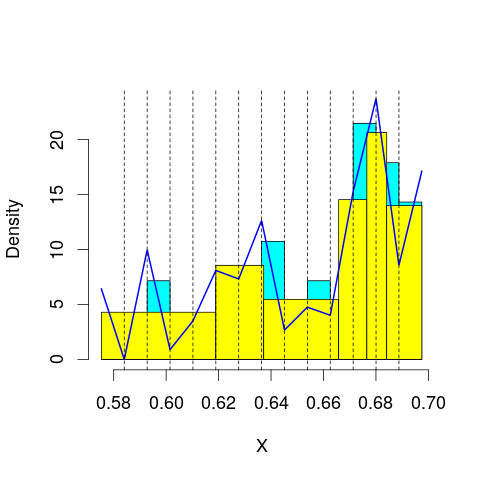

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.75069
mop.approx: Iteration 11. LL = 75.03073
mop.approx: Iteration 21. LL = 75.12651
mop.approx: Iteration 31. LL = 75.14155
mop.approx: Iteration 41. LL = 75.14572
mop.approx: Iteration 51. LL = 75.14748
mop.approx: Converged. Iteration 59. LL = 75.14831
[1] "Computing the linear combination of B-splines"


47.422423884
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.49405
mop.approx: Iteration 11. LL = 74.36123
mop.approx: Iteration 21. LL = 74.46648
mop.approx: Iteration 31. LL = 74.49619
mop.approx: Iteration 41. LL = 74.5078
mop.approx: Iteration 51. LL = 74.51325
mop.approx: Iteration 61. LL = 74.51611
mop.approx: Iteration 71. LL = 74.51771
mop.approx: Iteration 81. LL = 74.51866
mop.approx: Converged. Iteration 81. LL = 74.51873
[1] "Computing the linear combination of B-splines"


45.059977274
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.79129
mop.approx: Iteration 11. LL = 68.49652
mop.approx: Iteration 21. LL = 68.61406
mop.approx: Iteration 31. LL = 68.64353
mop.approx: Iteration 41. LL = 68.65272
mop.approx: Iteration 51. LL = 68.65627
mop.approx: Iteration 61. LL = 68.65784
mop.approx: Converged. Iteration 67. LL = 68.65841
[1] "Computing the linear combination of B-splines"


37.4667871418
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.18442
mop.approx: Iteration 11. LL = 67.68687
mop.approx: Iteration 21. LL = 67.77621
mop.approx: Iteration 31. LL = 67.80948
mop.approx: Iteration 41. LL = 67.82209
mop.approx: Iteration 51. LL = 67.8273
mop.approx: Iteration 61. LL = 67.82979
mop.approx: Iteration 71. LL = 67.83118
mop.approx: Iteration 81. LL = 67.83203
mop.approx: Converged. Iteration 81. LL = 67.8321
[1] "Computing the linear combination of B-splines"


34.9076154455
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.41504
mop.approx: Iteration 11. LL = 68.38436
mop.approx: Iteration 21. LL = 68.39357
mop.approx: Iteration 31. LL = 68.39897
mop.approx: Iteration 41. LL = 68.4032
mop.approx: Iteration 51. LL = 68.40663
mop.approx: Iteration 61. LL = 68.40943
mop.approx: Iteration 71. LL = 68.41172
mop.approx: Iteration 81. LL = 68.41359
mop.approx: Iteration 91. LL = 68.41511
mop.approx: Iteration 101. LL = 68.41635
mop.approx: Iteration 111. LL = 68.41736
mop.approx: Iteration 121. LL = 68.41817
mop.approx: Converged. Iteration 124. LL = 68.41845
[1] "Computing the linear combination of B-splines"


33.7609073664
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.26516
mop.approx: Iteration 11. LL = 68.91886
mop.approx: Iteration 21. LL = 68.9882
mop.approx: Iteration 31. LL = 69.00796
mop.approx: Iteration 41. LL = 69.01685
mop.approx: Iteration 51. LL = 69.02117
mop.approx: Iteration 61. LL = 69.02352
mop.approx: Iteration 71. LL = 69.02496
mop.approx: Iteration 81. LL = 69.02594
mop.approx: Converged. Iteration 87. LL = 69.02646
[1] "Computing the linear combination of B-splines"


32.6280671415
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.592199
mop.approx: Iteration 11. LL = 68.33075
mop.approx: Iteration 21. LL = 68.73206
mop.approx: Iteration 31. LL = 68.81163
mop.approx: Iteration 41. LL = 68.83167
mop.approx: Iteration 51. LL = 68.83716
mop.approx: Iteration 61. LL = 68.83874
mop.approx: Converged. Iteration 62. LL = 68.83889
[1] "Computing the linear combination of B-splines"


29.6252324492
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.00941
mop.approx: Iteration 11. LL = 75.44066
mop.approx: Iteration 21. LL = 75.47284
mop.approx: Iteration 31. LL = 75.48105
mop.approx: Iteration 41. LL = 75.48432
mop.approx: Iteration 51. LL = 75.48591
mop.approx: Converged. Iteration 58. LL = 75.48663
[1] "Computing the linear combination of B-splines"


47.7607429372
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 47.760742937248992)
m reached
('Sum of Probabilities:', 0.9881719983864699)
chosen


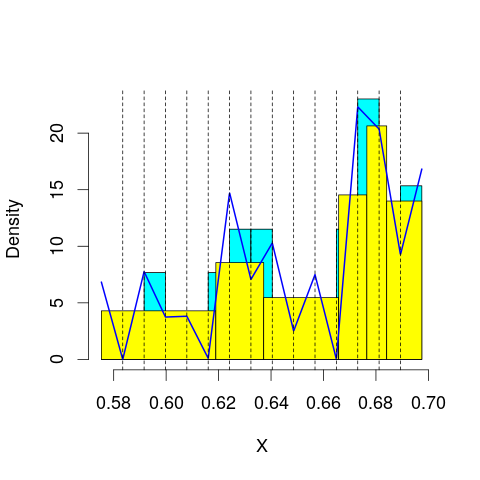

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.75069
mop.approx: Iteration 11. LL = 75.5029
mop.approx: Iteration 21. LL = 75.57243
mop.approx: Iteration 31. LL = 75.58306
mop.approx: Iteration 41. LL = 75.5864
mop.approx: Iteration 51. LL = 75.58788
mop.approx: Converged. Iteration 56. LL = 75.5884
[1] "Computing the linear combination of B-splines"


46.1296407436
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.49405
mop.approx: Iteration 11. LL = 74.50121
mop.approx: Iteration 21. LL = 74.61623
mop.approx: Iteration 31. LL = 74.65348
mop.approx: Iteration 41. LL = 74.66905
mop.approx: Iteration 51. LL = 74.67657
mop.approx: Iteration 61. LL = 74.68066
mop.approx: Iteration 71. LL = 74.68312
mop.approx: Iteration 81. LL = 74.68472
mop.approx: Iteration 91. LL = 74.68584
mop.approx: Converged. Iteration 99. LL = 74.68657
[1] "Computing the linear combination of B-splines"


43.4949513502
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.79129
mop.approx: Iteration 11. LL = 68.94866
mop.approx: Iteration 21. LL = 69.06628
mop.approx: Iteration 31. LL = 69.09588
mop.approx: Iteration 41. LL = 69.10554
mop.approx: Iteration 51. LL = 69.10922
mop.approx: Iteration 61. LL = 69.11083
mop.approx: Converged. Iteration 68. LL = 69.11151
[1] "Computing the linear combination of B-splines"


36.1870237802
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.18442
mop.approx: Iteration 11. LL = 68.2781
mop.approx: Iteration 21. LL = 68.37489
mop.approx: Iteration 31. LL = 68.40099
mop.approx: Iteration 41. LL = 68.41006
mop.approx: Iteration 51. LL = 68.41382
mop.approx: Iteration 61. LL = 68.4155
mop.approx: Converged. Iteration 67. LL = 68.4161
[1] "Computing the linear combination of B-splines"


33.7587361216
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.41504
mop.approx: Iteration 11. LL = 68.38365
mop.approx: Iteration 21. LL = 68.42622
mop.approx: Iteration 31. LL = 68.45593
mop.approx: Iteration 41. LL = 68.47598
mop.approx: Iteration 51. LL = 68.48909
mop.approx: Iteration 61. LL = 68.49746
mop.approx: Iteration 71. LL = 68.5027
mop.approx: Iteration 81. LL = 68.50594
mop.approx: Iteration 91. LL = 68.50792
mop.approx: Iteration 101. LL = 68.50913
mop.approx: Converged. Iteration 107. LL = 68.50968
[1] "Computing the linear combination of B-splines"


32.1194429367
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.26516
mop.approx: Iteration 11. LL = 69.28642
mop.approx: Iteration 21. LL = 69.35501
mop.approx: Iteration 31. LL = 69.37966
mop.approx: Iteration 41. LL = 69.39129
mop.approx: Iteration 51. LL = 69.39736
mop.approx: Iteration 61. LL = 69.40087
mop.approx: Iteration 71. LL = 69.40309
mop.approx: Iteration 81. LL = 69.40459
mop.approx: Iteration 91. LL = 69.40563
mop.approx: Converged. Iteration 98. LL = 69.40624
[1] "Computing the linear combination of B-splines"


31.2811907012
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.592199
mop.approx: Iteration 11. LL = 72.13805
mop.approx: Iteration 21. LL = 72.37167
mop.approx: Iteration 31. LL = 72.3963
mop.approx: Iteration 41. LL = 72.40018
mop.approx: Converged. Iteration 50. LL = 72.40124
[1] "Computing the linear combination of B-splines"


30.6279065815
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.00941
mop.approx: Iteration 11. LL = 76.23265
mop.approx: Iteration 21. LL = 76.27209
mop.approx: Iteration 31. LL = 76.28194
mop.approx: Iteration 41. LL = 76.28498
mop.approx: Converged. Iteration 47. LL = 76.28573
[1] "Computing the linear combination of B-splines"


46.826970092
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 46.826970091992969)
m reached
('Sum of Probabilities:', 0.9882274042298244)
chosen


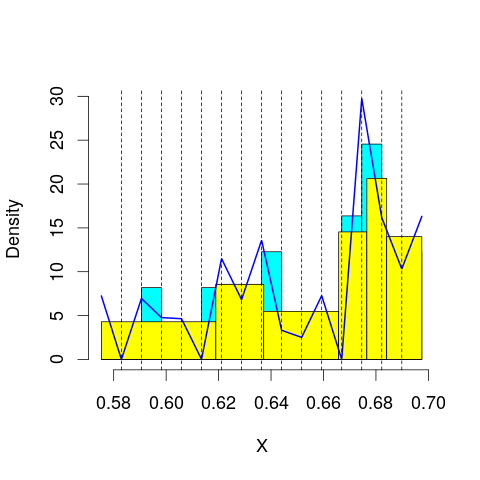

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.75069
mop.approx: Iteration 11. LL = 75.36813
mop.approx: Iteration 21. LL = 75.39985
mop.approx: Iteration 31. LL = 75.40268
mop.approx: Converged. Iteration 31. LL = 75.40274
[1] "Computing the linear combination of B-splines"


44.2111207235
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.49405
mop.approx: Iteration 11. LL = 74.9058
mop.approx: Iteration 21. LL = 74.9699
mop.approx: Iteration 31. LL = 74.97897
mop.approx: Iteration 41. LL = 74.98275
mop.approx: Iteration 51. LL = 74.98536
mop.approx: Iteration 61. LL = 74.9874
mop.approx: Iteration 71. LL = 74.98902
mop.approx: Iteration 81. LL = 74.99031
mop.approx: Iteration 91. LL = 74.99134
mop.approx: Converged. Iteration 100. LL = 74.99216
[1] "Computing the linear combination of B-splines"


42.067669408
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.79129
mop.approx: Iteration 11. LL = 68.97494
mop.approx: Iteration 21. LL = 69.04824
mop.approx: Iteration 31. LL = 69.06889
mop.approx: Iteration 41. LL = 69.07685
mop.approx: Iteration 51. LL = 69.0802
mop.approx: Iteration 61. LL = 69.08171
mop.approx: Converged. Iteration 67. LL = 69.08228
[1] "Computing the linear combination of B-splines"


34.4249237277
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.18442
mop.approx: Iteration 11. LL = 68.95386
mop.approx: Iteration 21. LL = 69.0632
mop.approx: Iteration 31. LL = 69.08517
mop.approx: Iteration 41. LL = 69.09281
mop.approx: Iteration 51. LL = 69.09696
mop.approx: Iteration 61. LL = 69.09966
mop.approx: Iteration 71. LL = 69.10154
mop.approx: Iteration 81. LL = 69.10288
mop.approx: Iteration 91. LL = 69.10385
mop.approx: Converged. Iteration 97. LL = 69.10437
[1] "Computing the linear combination of B-splines"


32.7141360707
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.41504
mop.approx: Iteration 11. LL = 68.51299
mop.approx: Iteration 21. LL = 68.58536
mop.approx: Iteration 31. LL = 68.61452
mop.approx: Iteration 41. LL = 68.6265
mop.approx: Iteration 51. LL = 68.63166
mop.approx: Iteration 61. LL = 68.63399
mop.approx: Iteration 71. LL = 68.63509
mop.approx: Converged. Iteration 72. LL = 68.63523
[1] "Computing the linear combination of B-splines"


30.5120589441
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.26516
mop.approx: Iteration 11. LL = 69.34315
mop.approx: Iteration 21. LL = 69.41842
mop.approx: Iteration 31. LL = 69.45309
mop.approx: Iteration 41. LL = 69.47177
mop.approx: Iteration 51. LL = 69.48251
mop.approx: Iteration 61. LL = 69.48907
mop.approx: Iteration 71. LL = 69.49333
mop.approx: Iteration 81. LL = 69.49626
mop.approx: Iteration 91. LL = 69.4984
mop.approx: Iteration 101. LL = 69.50005
mop.approx: Iteration 111. LL = 69.50137
mop.approx: Iteration 121. LL = 69.50246
mop.approx: Iteration 131. LL = 69.5034
mop.approx: Iteration 141. LL = 69.5042
mop.approx: Converged. Iteration 147. LL = 69.5047
[1] "Computing the linear combination of B-splines"


29.6052342047
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.592199
mop.approx: Iteration 11. LL = 71.53537
mop.approx: Iteration 21. LL = 71.70473
mop.approx: Iteration 31. LL = 71.7152
mop.approx: Converged. Iteration 37. LL = 71.71615
[1] "Computing the linear combination of B-splines"


5.40107287634
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.00941
mop.approx: Iteration 11. LL = 75.58676
mop.approx: Iteration 21. LL = 75.61328
mop.approx: Iteration 31. LL = 75.6167
mop.approx: Iteration 41. LL = 75.61786
mop.approx: Converged. Iteration 41. LL = 75.61793
[1] "Computing the linear combination of B-splines"


44.4263095532
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 44.426309553160223)
m reached
('Sum of Probabilities:', 0.9878450170961767)
chosen


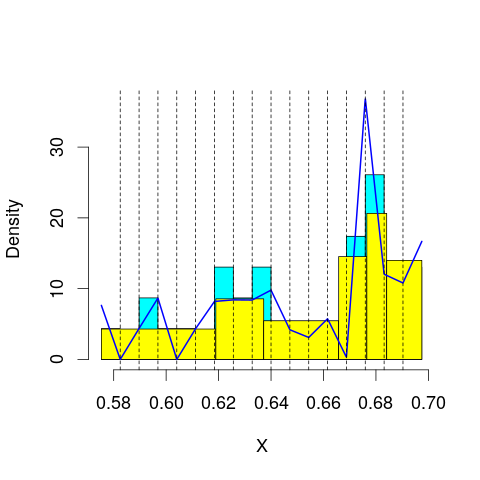

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.75069
mop.approx: Iteration 11. LL = 76.17029
mop.approx: Iteration 21. LL = 76.22158
mop.approx: Iteration 31. LL = 76.22662
mop.approx: Iteration 41. LL = 76.22839
mop.approx: Iteration 51. LL = 76.22957
mop.approx: Iteration 61. LL = 76.23046
mop.approx: Converged. Iteration 62. LL = 76.23062
[1] "Computing the linear combination of B-splines"


43.3061250739
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.49405
mop.approx: Iteration 11. LL = 75.04098
mop.approx: Iteration 21. LL = 75.15833
mop.approx: Iteration 31. LL = 75.17565
mop.approx: Iteration 41. LL = 75.17873
mop.approx: Converged. Iteration 44. LL = 75.1791
[1] "Computing the linear combination of B-splines"


40.5217447989
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.79129
mop.approx: Iteration 11. LL = 69.16111
mop.approx: Iteration 21. LL = 69.26486
mop.approx: Iteration 31. LL = 69.30056
mop.approx: Iteration 41. LL = 69.31373
mop.approx: Iteration 51. LL = 69.31869
mop.approx: Iteration 61. LL = 69.32072
mop.approx: Iteration 71. LL = 69.32167
mop.approx: Converged. Iteration 71. LL = 69.32174
[1] "Computing the linear combination of B-splines"


32.9315089575
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.18442
mop.approx: Iteration 11. LL = 69.38082
mop.approx: Iteration 21. LL = 69.49743
mop.approx: Iteration 31. LL = 69.5242
mop.approx: Iteration 41. LL = 69.5321
mop.approx: Iteration 51. LL = 69.53499
mop.approx: Iteration 61. LL = 69.53625
mop.approx: Converged. Iteration 64. LL = 69.53655
[1] "Computing the linear combination of B-splines"


31.4134452974
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.41504
mop.approx: Iteration 11. LL = 68.9228
mop.approx: Iteration 21. LL = 69.02754
mop.approx: Iteration 31. LL = 69.05497
mop.approx: Iteration 41. LL = 69.06584
mop.approx: Iteration 51. LL = 69.07219
mop.approx: Iteration 61. LL = 69.07675
mop.approx: Iteration 71. LL = 69.08036
mop.approx: Iteration 81. LL = 69.08331
mop.approx: Iteration 91. LL = 69.08578
mop.approx: Iteration 101. LL = 69.08785
mop.approx: Iteration 111. LL = 69.08959
mop.approx: Iteration 121. LL = 69.09104
mop.approx: Iteration 131. LL = 69.09226
mop.approx: Iteration 141. LL = 69.09328
mop.approx: Iteration 151. LL = 69.09412
mop.approx: Converged. Iteration 157. LL = 69.09463
[1] "Computing the linear combination of B-splines"


29.2389326547
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.26516
mop.approx: Iteration 11. LL = 69.32555
mop.approx: Iteration 21. LL = 69.36985
mop.approx: Iteration 31. LL = 69.3883
mop.approx: Iteration 41. LL = 69.3972
mop.approx: Iteration 51. LL = 69.40165
mop.approx: Iteration 61. LL = 69.40401
mop.approx: Iteration 71. LL = 69.40536
mop.approx: Iteration 81. LL = 69.40621
mop.approx: Converged. Iteration 81. LL = 69.40628
[1] "Computing the linear combination of B-splines"


27.7715495013
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.592199
mop.approx: Iteration 11. LL = 75.08278
mop.approx: Iteration 21. LL = 75.19952
mop.approx: Iteration 31. LL = 75.22292
mop.approx: Iteration 41. LL = 75.23142
mop.approx: Iteration 51. LL = 75.23502
mop.approx: Iteration 61. LL = 75.23673
mop.approx: Converged. Iteration 68. LL = 75.23748
[1] "Computing the linear combination of B-splines"


31.3791808818
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.00941
mop.approx: Iteration 11. LL = 76.77854
mop.approx: Iteration 21. LL = 76.84404
mop.approx: Iteration 31. LL = 76.8513
mop.approx: Converged. Iteration 36. LL = 76.85205
[1] "Computing the linear combination of B-splines"


43.9275611496
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 43.927561149562493)
m reached
('Sum of Probabilities:', 0.9872618991045143)
chosen


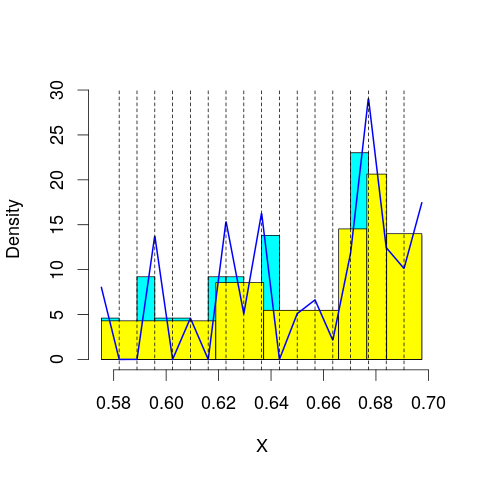

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.75069
mop.approx: Iteration 11. LL = 75.97098
mop.approx: Iteration 21. LL = 75.99375
mop.approx: Iteration 31. LL = 76.00116
mop.approx: Iteration 41. LL = 76.00609
mop.approx: Iteration 51. LL = 76.00926
mop.approx: Iteration 61. LL = 76.0112
mop.approx: Iteration 71. LL = 76.01235
mop.approx: Converged. Iteration 73. LL = 76.01258
[1] "Computing the linear combination of B-splines"


41.3552253851
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.49405
mop.approx: Iteration 11. LL = 75.68968
mop.approx: Iteration 21. LL = 75.82557
mop.approx: Iteration 31. LL = 75.84861
mop.approx: Iteration 41. LL = 75.85746
mop.approx: Iteration 51. LL = 75.86266
mop.approx: Iteration 61. LL = 75.86606
mop.approx: Iteration 71. LL = 75.86831
mop.approx: Iteration 81. LL = 75.86979
mop.approx: Iteration 91. LL = 75.87074
mop.approx: Converged. Iteration 91. LL = 75.87081
[1] "Computing the linear combination of B-splines"


39.480585703
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.79129
mop.approx: Iteration 11. LL = 69.08689
mop.approx: Iteration 21. LL = 69.13673
mop.approx: Iteration 31. LL = 69.14324
mop.approx: Iteration 41. LL = 69.14506
mop.approx: Iteration 51. LL = 69.14608
mop.approx: Converged. Iteration 60. LL = 69.14684
[1] "Computing the linear combination of B-splines"


31.0237405228
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.18442
mop.approx: Iteration 11. LL = 69.78389
mop.approx: Iteration 21. LL = 69.93514
mop.approx: Iteration 31. LL = 69.98395
mop.approx: Iteration 41. LL = 70.00535
mop.approx: Iteration 51. LL = 70.01566
mop.approx: Iteration 61. LL = 70.02088
mop.approx: Iteration 71. LL = 70.02367
mop.approx: Iteration 81. LL = 70.02526
mop.approx: Iteration 91. LL = 70.02623
mop.approx: Converged. Iteration 93. LL = 70.02645
[1] "Computing the linear combination of B-splines"


30.170488036
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.41504
mop.approx: Iteration 11. LL = 69.30246
mop.approx: Iteration 21. LL = 69.38872
mop.approx: Iteration 31. LL = 69.40585
mop.approx: Iteration 41. LL = 69.41143
mop.approx: Iteration 51. LL = 69.41407
mop.approx: Iteration 61. LL = 69.41548
mop.approx: Converged. Iteration 68. LL = 69.41614
[1] "Computing the linear combination of B-splines"


27.8280975508
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.26516
mop.approx: Iteration 11. LL = 69.40376
mop.approx: Iteration 21. LL = 69.50294
mop.approx: Iteration 31. LL = 69.54862
mop.approx: Iteration 41. LL = 69.57148
mop.approx: Iteration 51. LL = 69.58342
mop.approx: Iteration 61. LL = 69.58992
mop.approx: Iteration 71. LL = 69.59361
mop.approx: Iteration 81. LL = 69.59577
mop.approx: Iteration 91. LL = 69.59709
mop.approx: Converged. Iteration 99. LL = 69.59784
[1] "Computing the linear combination of B-splines"


26.1689392157
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.592199
[1] "Computing the linear combination of B-splines"


33.7414746943
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.00941
mop.approx: Iteration 11. LL = 77.32357
mop.approx: Iteration 21. LL = 77.35295
mop.approx: Iteration 31. LL = 77.35586
mop.approx: Converged. Iteration 34. LL = 77.35621
[1] "Computing the linear combination of B-splines"


42.6988464859
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 42.698846485931362)
m reached
('Sum of Probabilities:', 0.986623735202058)
chosen


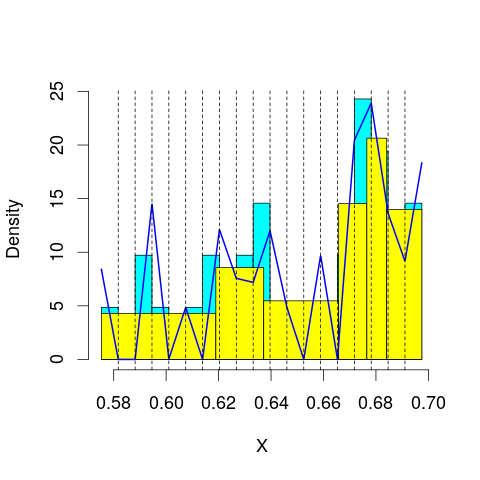

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.75069
mop.approx: Iteration 11. LL = 76.41041
mop.approx: Iteration 21. LL = 76.51896
mop.approx: Iteration 31. LL = 76.53184
mop.approx: Iteration 41. LL = 76.53432
mop.approx: Converged. Iteration 46. LL = 76.5349
[1] "Computing the linear combination of B-splines"


40.1446714055
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.49405
mop.approx: Iteration 11. LL = 75.82949
mop.approx: Iteration 21. LL = 75.91907
mop.approx: Iteration 31. LL = 75.9314
mop.approx: Iteration 41. LL = 75.93487
mop.approx: Iteration 51. LL = 75.93624
mop.approx: Converged. Iteration 53. LL = 75.93647
[1] "Computing the linear combination of B-splines"


37.8133790714
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.79129
mop.approx: Iteration 11. LL = 69.39847
mop.approx: Iteration 21. LL = 69.56687
mop.approx: Iteration 31. LL = 69.62293
mop.approx: Iteration 41. LL = 69.64684
mop.approx: Iteration 51. LL = 69.65845
mop.approx: Iteration 61. LL = 69.66436
mop.approx: Iteration 71. LL = 69.66743
mop.approx: Iteration 81. LL = 69.66905
mop.approx: Converged. Iteration 89. LL = 69.66984
[1] "Computing the linear combination of B-splines"


29.8138787017
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.18442
mop.approx: Iteration 11. LL = 69.78288
mop.approx: Iteration 21. LL = 69.86717
mop.approx: Iteration 31. LL = 69.88925
mop.approx: Iteration 41. LL = 69.89748
mop.approx: Iteration 51. LL = 69.90108
mop.approx: Iteration 61. LL = 69.90281
mop.approx: Converged. Iteration 69. LL = 69.90362
[1] "Computing the linear combination of B-splines"


28.3147762094
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.41504
mop.approx: Iteration 11. LL = 69.85403
mop.approx: Iteration 21. LL = 70.00827
mop.approx: Iteration 31. LL = 70.05814
mop.approx: Iteration 41. LL = 70.08138
mop.approx: Iteration 51. LL = 70.09385
mop.approx: Iteration 61. LL = 70.1009
mop.approx: Iteration 71. LL = 70.10497
mop.approx: Iteration 81. LL = 70.10734
mop.approx: Iteration 91. LL = 70.10873
mop.approx: Converged. Iteration 99. LL = 70.10949
[1] "Computing the linear combination of B-splines"


26.7874113045
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.26516
mop.approx: Iteration 11. LL = 69.2513
mop.approx: Iteration 21. LL = 69.3355
mop.approx: Iteration 31. LL = 69.37554
mop.approx: Iteration 41. LL = 69.39856
mop.approx: Iteration 51. LL = 69.41262
mop.approx: Iteration 61. LL = 69.42141
mop.approx: Iteration 71. LL = 69.42701
mop.approx: Iteration 81. LL = 69.43066
mop.approx: Iteration 91. LL = 69.43307
mop.approx: Iteration 101. LL = 69.43469
mop.approx: Iteration 111. LL = 69.4358
mop.approx: Converged. Iteration 118. LL = 69.43644
[1] "Computing the linear combination of B-splines"


24.0914942795
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.592199
mop.approx: Iteration 11. LL = 79.10959
mop.approx: Iteration 21. LL = 79.18232
mop.approx: Iteration 31. LL = 79.18913
mop.approx: Iteration 41. LL = 79.1919
mop.approx: Iteration 51. LL = 79.19371
mop.approx: Iteration 61. LL = 79.19498
mop.approx: Iteration 71. LL = 79.1959
mop.approx: Converged. Iteration 71. LL = 79.19598
[1] "Computing the linear combination of B-splines"


4.41170714203
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.00941
mop.approx: Iteration 11. LL = 77.47397
mop.approx: Iteration 21. LL = 77.49853
mop.approx: Iteration 31. LL = 77.50289
mop.approx: Converged. Iteration 36. LL = 77.50356
[1] "Computing the linear combination of B-splines"


41.1133333411
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 41.113333341114966)
m reached
('Sum of Probabilities:', 0.9864557120726087)
chosen


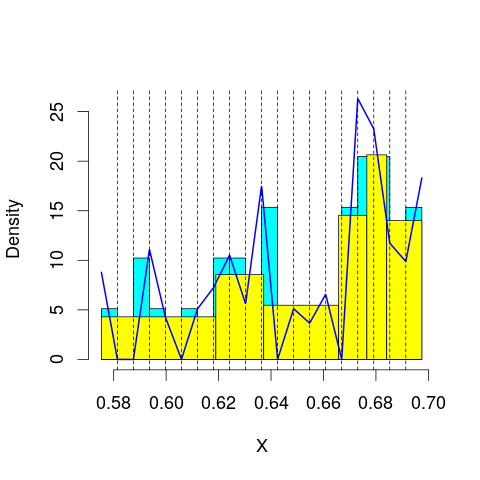

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.75069
mop.approx: Iteration 11. LL = 76.45048
mop.approx: Iteration 21. LL = 76.49497
mop.approx: Iteration 31. LL = 76.49977
mop.approx: Converged. Iteration 39. LL = 76.50084
[1] "Computing the linear combination of B-splines"


38.377744305
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.49405
mop.approx: Iteration 11. LL = 75.99441
mop.approx: Iteration 21. LL = 76.10238
mop.approx: Iteration 31. LL = 76.12638
mop.approx: Iteration 41. LL = 76.1341
mop.approx: Iteration 51. LL = 76.13769
mop.approx: Iteration 61. LL = 76.13981
mop.approx: Iteration 71. LL = 76.1412
mop.approx: Iteration 81. LL = 76.14213
mop.approx: Converged. Iteration 81. LL = 76.1422
[1] "Computing the linear combination of B-splines"


36.2862390615
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.79129
mop.approx: Iteration 11. LL = 69.55417
mop.approx: Iteration 21. LL = 69.68305
mop.approx: Iteration 31. LL = 69.71223
mop.approx: Iteration 41. LL = 69.72281
mop.approx: Iteration 51. LL = 69.7272
mop.approx: Iteration 61. LL = 69.72917
mop.approx: Converged. Iteration 70. LL = 69.73012
[1] "Computing the linear combination of B-splines"


28.1412875821
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.18442
mop.approx: Iteration 11. LL = 69.88226
mop.approx: Iteration 21. LL = 69.99489
mop.approx: Iteration 31. LL = 70.03984
mop.approx: Iteration 41. LL = 70.06367
mop.approx: Iteration 51. LL = 70.07706
mop.approx: Iteration 61. LL = 70.0846
mop.approx: Iteration 71. LL = 70.08887
mop.approx: Iteration 81. LL = 70.09134
mop.approx: Iteration 91. LL = 70.09282
mop.approx: Iteration 101. LL = 70.09374
mop.approx: Converged. Iteration 102. LL = 70.09388
[1] "Computing the linear combination of B-splines"


26.7722285397
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.41504
mop.approx: Iteration 11. LL = 70.20824
mop.approx: Iteration 21. LL = 70.3734
mop.approx: Iteration 31. LL = 70.41755
mop.approx: Iteration 41. LL = 70.43295
mop.approx: Iteration 51. LL = 70.43911
mop.approx: Iteration 61. LL = 70.44191
mop.approx: Iteration 71. LL = 70.44337
mop.approx: Converged. Iteration 80. LL = 70.44423
[1] "Computing the linear combination of B-splines"


25.392443924
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.26516
mop.approx: Iteration 11. LL = 70.38869
mop.approx: Iteration 21. LL = 70.51188
mop.approx: Iteration 31. LL = 70.57071
mop.approx: Iteration 41. LL = 70.60249
mop.approx: Iteration 51. LL = 70.61884
mop.approx: Iteration 61. LL = 70.62715
mop.approx: Iteration 71. LL = 70.63143
mop.approx: Iteration 81. LL = 70.63374
mop.approx: Iteration 91. LL = 70.63506
mop.approx: Converged. Iteration 99. LL = 70.63579
[1] "Computing the linear combination of B-splines"


23.5790548028
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.592199
[1] "Computing the linear combination of B-splines"


4.20176942595
lfps_1
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.54393
mop.approx: Iteration 11. LL = 83.83305
mop.approx: Converged. Iteration 16. LL = 83.83567
[1] "Computing the linear combination of B-splines"


78.6370653647
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 78.63706536474983)
m reached
('Sum of Probabilities:', 0.9822974978165455)
chosen


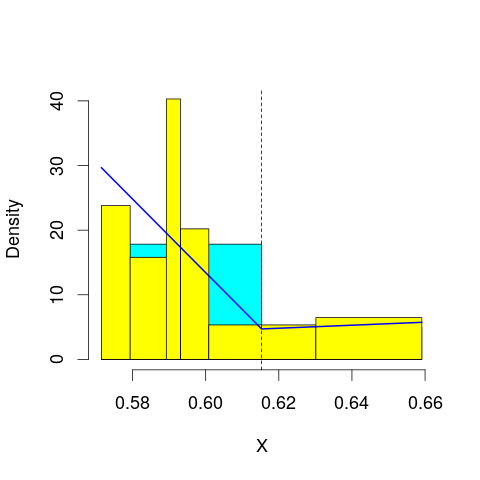

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.18492
mop.approx: Iteration 11. LL = 83.00512
mop.approx: Iteration 21. LL = 83.08318
mop.approx: Iteration 31. LL = 83.10468
mop.approx: Iteration 41. LL = 83.11335
mop.approx: Iteration 51. LL = 83.11754
mop.approx: Iteration 61. LL = 83.11977
mop.approx: Iteration 71. LL = 83.12102
mop.approx: Converged. Iteration 73. LL = 83.12128
[1] "Computing the linear combination of B-splines"


76.1898093256
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 76.82988
mop.approx: Iteration 11. LL = 83.10786
mop.approx: Iteration 21. LL = 83.25142
mop.approx: Iteration 31. LL = 83.3033
mop.approx: Iteration 41. LL = 83.32207
mop.approx: Iteration 51. LL = 83.32879
mop.approx: Iteration 61. LL = 83.33119
mop.approx: Converged. Iteration 66. LL = 83.33181
[1] "Computing the linear combination of B-splines"


74.6674678451
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.98213
mop.approx: Iteration 11. LL = 60.09206
mop.approx: Iteration 21. LL = 60.24329
mop.approx: Iteration 31. LL = 60.27429
mop.approx: Iteration 41. LL = 60.28493
mop.approx: Iteration 51. LL = 60.28935
mop.approx: Iteration 61. LL = 60.29135
mop.approx: Iteration 71. LL = 60.29228
mop.approx: Converged. Iteration 72. LL = 60.2924
[1] "Computing the linear combination of B-splines"


49.8951922941
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.01287
mop.approx: Iteration 11. LL = 59.72346
mop.approx: Iteration 21. LL = 59.77993
mop.approx: Converged. Iteration 23. LL = 59.78016
[1] "Computing the linear combination of B-splines"


47.6500798387
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.98399
mop.approx: Iteration 11. LL = 54.33762
mop.approx: Iteration 21. LL = 54.67951
mop.approx: Iteration 31. LL = 54.73536
mop.approx: Iteration 41. LL = 54.74597
mop.approx: Iteration 51. LL = 54.74806
mop.approx: Converged. Iteration 54. LL = 54.7483
[1] "Computing the linear combination of B-splines"


40.8853565861
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.639126
mop.approx: Iteration 11. LL = 54.37296
mop.approx: Iteration 21. LL = 54.49241
mop.approx: Converged. Iteration 26. LL = 54.4937
[1] "Computing the linear combination of B-splines"


38.897890823
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.814291
mop.approx: Iteration 11. LL = 49.83296
mop.approx: Iteration 21. LL = 50.2932
mop.approx: Iteration 31. LL = 50.38354
mop.approx: Iteration 41. LL = 50.40249
mop.approx: Iteration 51. LL = 50.40654
mop.approx: Converged. Iteration 59. LL = 50.40736
[1] "Computing the linear combination of B-splines"


33.0786834986
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.54393
mop.approx: Converged. Iteration 9. LL = 83.52632
[1] "Computing the linear combination of B-splines"


76.5948463979
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 76.594846397948743)
m reached
('Sum of Probabilities:', 0.9841885494219886)
chosen


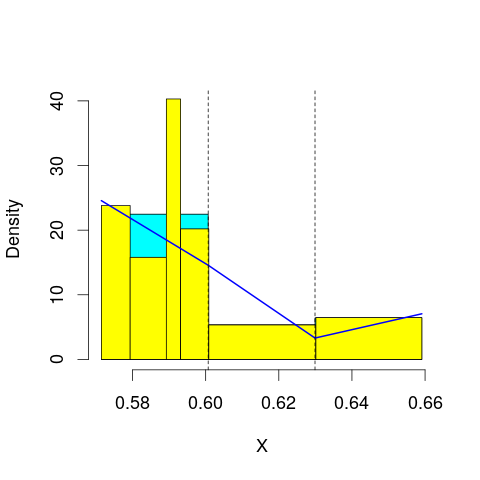

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.18492
mop.approx: Iteration 11. LL = 84.31036
mop.approx: Iteration 21. LL = 84.44292
mop.approx: Iteration 31. LL = 84.47492
mop.approx: Iteration 41. LL = 84.48698
mop.approx: Iteration 51. LL = 84.49273
mop.approx: Iteration 61. LL = 84.49586
mop.approx: Iteration 71. LL = 84.4977
mop.approx: Iteration 81. LL = 84.49884
mop.approx: Converged. Iteration 82. LL = 84.49902
[1] "Computing the linear combination of B-splines"


75.8346759887
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 76.82988
mop.approx: Iteration 11. LL = 83.62884
mop.approx: Iteration 21. LL = 83.66623
mop.approx: Iteration 31. LL = 83.66974
mop.approx: Iteration 41. LL = 83.67146
mop.approx: Iteration 51. LL = 83.6726
mop.approx: Converged. Iteration 54. LL = 83.67294
[1] "Computing the linear combination of B-splines"


73.2757347584
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.98213
mop.approx: Iteration 11. LL = 67.39203
mop.approx: Iteration 21. LL = 67.64414
mop.approx: Iteration 31. LL = 67.67584
mop.approx: Iteration 41. LL = 67.68041
mop.approx: Converged. Iteration 45. LL = 67.68089
[1] "Computing the linear combination of B-splines"


55.5508170406
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.01287
mop.approx: Iteration 11. LL = 64.44776
mop.approx: Iteration 21. LL = 64.52548
mop.approx: Iteration 31. LL = 64.53766
mop.approx: Iteration 41. LL = 64.54131
mop.approx: Iteration 51. LL = 64.54277
mop.approx: Converged. Iteration 57. LL = 64.5433
[1] "Computing the linear combination of B-splines"


50.6803581463
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.98399
mop.approx: Iteration 11. LL = 62.58339
mop.approx: Iteration 21. LL = 62.73114
mop.approx: Converged. Iteration 28. LL = 62.73398
[1] "Computing the linear combination of B-splines"


47.1381716769
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.639126
mop.approx: Iteration 11. LL = 58.17154
mop.approx: Iteration 21. LL = 58.46195
mop.approx: Iteration 31. LL = 58.50955
mop.approx: Iteration 41. LL = 58.51914
mop.approx: Iteration 51. LL = 58.52116
mop.approx: Converged. Iteration 53. LL = 58.52136
[1] "Computing the linear combination of B-splines"


41.1926825076
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.814291
mop.approx: Iteration 11. LL = 57.1592
mop.approx: Iteration 21. LL = 57.34379
mop.approx: Converged. Iteration 30. LL = 57.34779
[1] "Computing the linear combination of B-splines"


38.2862465289
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.54393
mop.approx: Iteration 11. LL = 84.97986
mop.approx: Converged. Iteration 12. LL = 84.97998
[1] "Computing the linear combination of B-splines"


76.3156391891
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 76.315639189058729)
m reached
('Sum of Probabilities:', 0.9881856811803158)
chosen


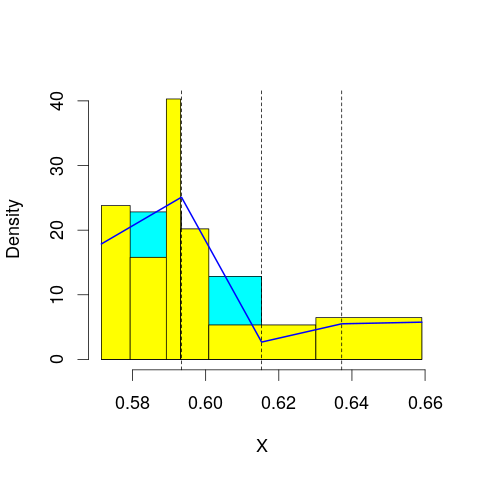

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.18492
mop.approx: Iteration 11. LL = 83.999
mop.approx: Iteration 21. LL = 84.00701
mop.approx: Converged. Iteration 28. LL = 84.00814
[1] "Computing the linear combination of B-splines"


73.6109285591
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 76.82988
mop.approx: Iteration 11. LL = 83.94431
mop.approx: Iteration 21. LL = 84.08308
mop.approx: Iteration 31. LL = 84.11741
mop.approx: Iteration 41. LL = 84.12591
mop.approx: Iteration 51. LL = 84.12801
mop.approx: Converged. Iteration 52. LL = 84.12818
[1] "Computing the linear combination of B-splines"


71.9981043676
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.98213
mop.approx: Iteration 11. LL = 73.11733
mop.approx: Converged. Iteration 16. LL = 73.12232
[1] "Computing the linear combination of B-splines"


59.2593764183
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.01287
mop.approx: Iteration 11. LL = 67.91514
mop.approx: Iteration 21. LL = 67.99086
mop.approx: Iteration 31. LL = 67.99859
mop.approx: Converged. Iteration 38. LL = 67.99968
[1] "Computing the linear combination of B-splines"


52.4038717784
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.98399
mop.approx: Iteration 11. LL = 67.55438
mop.approx: Iteration 21. LL = 67.58605
mop.approx: Converged. Iteration 29. LL = 67.58792
[1] "Computing the linear combination of B-splines"


50.2592372979
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.639126
mop.approx: Iteration 11. LL = 64.53409
mop.approx: Iteration 21. LL = 64.82287
mop.approx: Iteration 31. LL = 64.84291
mop.approx: Converged. Iteration 38. LL = 64.84426
[1] "Computing the linear combination of B-splines"


45.7827166633
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.814291
mop.approx: Iteration 11. LL = 61.31563
mop.approx: Iteration 21. LL = 61.5636
mop.approx: Iteration 31. LL = 61.60639
mop.approx: Iteration 41. LL = 61.61611
mop.approx: Iteration 51. LL = 61.61846
mop.approx: Converged. Iteration 55. LL = 61.61884
[1] "Computing the linear combination of B-splines"


40.8244252129
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.54393
mop.approx: Iteration 11. LL = 85.25565
mop.approx: Iteration 21. LL = 85.29386
mop.approx: Iteration 31. LL = 85.30287
mop.approx: Iteration 41. LL = 85.30563
mop.approx: Converged. Iteration 46. LL = 85.3063
[1] "Computing the linear combination of B-splines"


74.9090915058
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 74.909091505761523)
m reached
('Sum of Probabilities:', 0.9887516911071976)
chosen


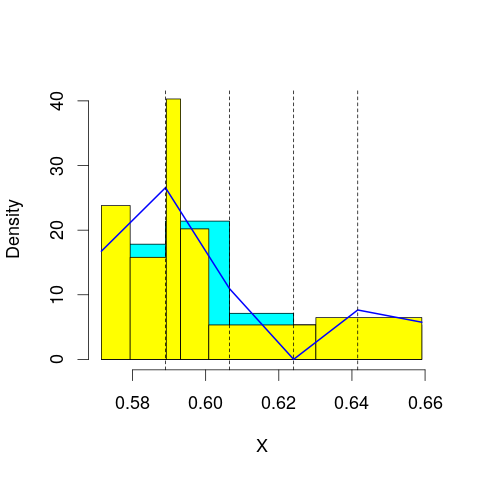

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.18492
mop.approx: Iteration 11. LL = 84.54759
mop.approx: Iteration 21. LL = 84.5888
mop.approx: Iteration 31. LL = 84.59732
mop.approx: Iteration 41. LL = 84.60032
mop.approx: Iteration 51. LL = 84.60173
mop.approx: Converged. Iteration 54. LL = 84.60209
[1] "Computing the linear combination of B-splines"


72.4720098675
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 76.82988
mop.approx: Iteration 11. LL = 84.30673
mop.approx: Iteration 21. LL = 84.3936
mop.approx: Iteration 31. LL = 84.41406
mop.approx: Iteration 41. LL = 84.41986
mop.approx: Iteration 51. LL = 84.42156
mop.approx: Converged. Iteration 51. LL = 84.42165
[1] "Computing the linear combination of B-splines"


70.5587024188
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.98213
mop.approx: Iteration 11. LL = 75.22803
mop.approx: Iteration 21. LL = 75.29939
mop.approx: Iteration 31. LL = 75.31407
mop.approx: Iteration 41. LL = 75.31857
mop.approx: Iteration 51. LL = 75.32013
mop.approx: Converged. Iteration 53. LL = 75.32036
[1] "Computing the linear combination of B-splines"


59.7245493171
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.01287
mop.approx: Iteration 11. LL = 73.29324
mop.approx: Iteration 21. LL = 73.38198
mop.approx: Converged. Iteration 26. LL = 73.38328
[1] "Computing the linear combination of B-splines"


56.0546047695
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.98399
mop.approx: Iteration 11. LL = 68.93778
mop.approx: Iteration 21. LL = 68.9711
mop.approx: Converged. Iteration 22. LL = 68.97126
[1] "Computing the linear combination of B-splines"


49.9097089178
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.639126
mop.approx: Iteration 11. LL = 69.76879
mop.approx: Iteration 21. LL = 69.7806
mop.approx: Converged. Iteration 21. LL = 69.78066
[1] "Computing the linear combination of B-splines"


48.9862382604
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.814291
mop.approx: Iteration 11. LL = 65.86104
mop.approx: Iteration 21. LL = 66.21742
mop.approx: Iteration 31. LL = 66.2857
mop.approx: Iteration 41. LL = 66.30142
mop.approx: Iteration 51. LL = 66.3052
mop.approx: Converged. Iteration 58. LL = 66.30602
[1] "Computing the linear combination of B-splines"


43.7786630407
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.54393
mop.approx: Iteration 11. LL = 84.7405
mop.approx: Converged. Iteration 12. LL = 84.74063
[1] "Computing the linear combination of B-splines"


72.6105588148
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 72.610558814791062)
m reached
('Sum of Probabilities:', 0.9868984641215153)
chosen


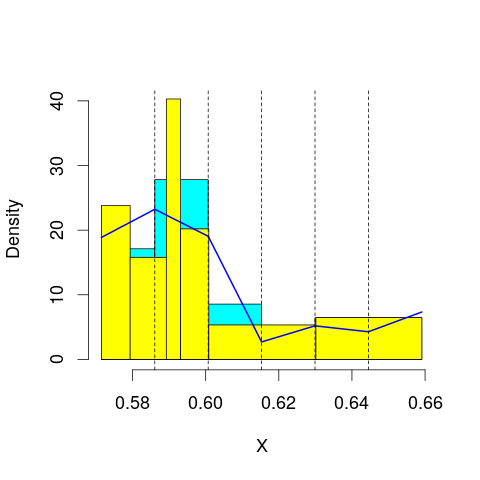

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.18492
mop.approx: Iteration 11. LL = 85.11026
mop.approx: Iteration 21. LL = 85.14454
mop.approx: Iteration 31. LL = 85.14825
mop.approx: Converged. Iteration 32. LL = 85.14844
[1] "Computing the linear combination of B-splines"


71.2854934831
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 76.82988
mop.approx: Iteration 11. LL = 84.37155
mop.approx: Iteration 21. LL = 84.44289
mop.approx: Iteration 31. LL = 84.46029
mop.approx: Iteration 41. LL = 84.46499
mop.approx: Converged. Iteration 49. LL = 84.46619
[1] "Computing the linear combination of B-splines"


68.8703748362
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.98213
mop.approx: Iteration 11. LL = 75.15355
mop.approx: Iteration 21. LL = 75.18463
mop.approx: Iteration 31. LL = 75.19424
mop.approx: Iteration 41. LL = 75.19806
mop.approx: Iteration 51. LL = 75.19975
mop.approx: Converged. Iteration 56. LL = 75.20029
[1] "Computing the linear combination of B-splines"


57.8716098836
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.01287
mop.approx: Iteration 11. LL = 76.84736
mop.approx: Iteration 21. LL = 76.89825
mop.approx: Converged. Iteration 26. LL = 76.8994
[1] "Computing the linear combination of B-splines"


57.837853785
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.98399
mop.approx: Iteration 11. LL = 72.31643
mop.approx: Iteration 21. LL = 72.60549
mop.approx: Iteration 31. LL = 72.65005
mop.approx: Iteration 41. LL = 72.65982
mop.approx: Iteration 51. LL = 72.6629
mop.approx: Iteration 61. LL = 72.66426
mop.approx: Converged. Iteration 66. LL = 72.66476
[1] "Computing the linear combination of B-splines"


51.8703472149
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.639126
mop.approx: Iteration 11. LL = 70.03768
mop.approx: Iteration 21. LL = 70.09762
mop.approx: Iteration 31. LL = 70.11155
mop.approx: Iteration 41. LL = 70.11596
mop.approx: Iteration 51. LL = 70.11752
mop.approx: Converged. Iteration 54. LL = 70.11783
[1] "Computing the linear combination of B-splines"


47.59049428
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.814291
mop.approx: Iteration 11. LL = 71.30708
mop.approx: Converged. Iteration 17. LL = 71.31479
[1] "Computing the linear combination of B-splines"


47.0543723693
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.54393
mop.approx: Iteration 11. LL = 85.6802
mop.approx: Converged. Iteration 16. LL = 85.68225
[1] "Computing the linear combination of B-splines"


71.8193051504
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 71.819305150356072)
m reached
('Sum of Probabilities:', 0.9854884453854178)
chosen


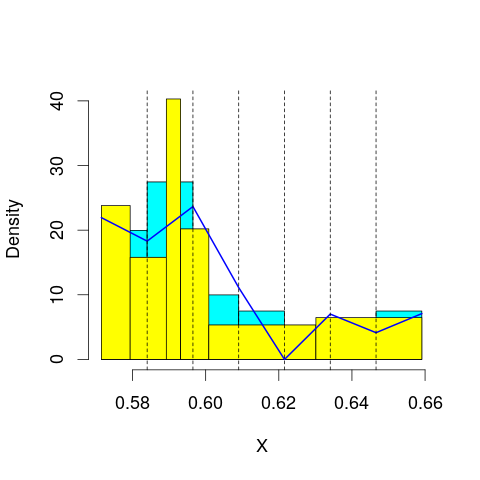

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.18492
mop.approx: Iteration 11. LL = 84.93455
mop.approx: Iteration 21. LL = 85.0023
mop.approx: Iteration 31. LL = 85.02103
mop.approx: Iteration 41. LL = 85.02644
mop.approx: Converged. Iteration 50. LL = 85.02797
[1] "Computing the linear combination of B-splines"


69.4321574261
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 76.82988
mop.approx: Iteration 11. LL = 84.55872
mop.approx: Iteration 21. LL = 84.60472
mop.approx: Iteration 31. LL = 84.61603
mop.approx: Iteration 41. LL = 84.62018
mop.approx: Iteration 51. LL = 84.62199
mop.approx: Converged. Iteration 56. LL = 84.62258
[1] "Computing the linear combination of B-splines"


67.2938968603
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.98213
mop.approx: Iteration 11. LL = 75.56758
mop.approx: Iteration 21. LL = 75.61038
mop.approx: Iteration 31. LL = 75.6149
mop.approx: Converged. Iteration 33. LL = 75.61518
[1] "Computing the linear combination of B-splines"


56.5536301548
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.01287
mop.approx: Iteration 11. LL = 77.44142
mop.approx: Iteration 21. LL = 77.46504
mop.approx: Iteration 31. LL = 77.47069
mop.approx: Iteration 41. LL = 77.47221
mop.approx: Converged. Iteration 41. LL = 77.47228
[1] "Computing the linear combination of B-splines"


56.6778602545
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.98399
mop.approx: Iteration 11. LL = 76.96884
mop.approx: Iteration 21. LL = 77.07552
mop.approx: Converged. Iteration 26. LL = 77.07665
[1] "Computing the linear combination of B-splines"


54.5494012478
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.639126
mop.approx: Iteration 11. LL = 71.48414
mop.approx: Iteration 21. LL = 71.58293
mop.approx: Iteration 31. LL = 71.59974
mop.approx: Iteration 41. LL = 71.60398
mop.approx: Converged. Iteration 50. LL = 71.60523
[1] "Computing the linear combination of B-splines"


47.34445305
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.814291
mop.approx: Iteration 11. LL = 71.3222
mop.approx: Converged. Iteration 13. LL = 71.32272
[1] "Computing the linear combination of B-splines"


45.3332023696
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.54393
mop.approx: Iteration 11. LL = 86.44316
mop.approx: Converged. Iteration 17. LL = 86.44708
[1] "Computing the linear combination of B-splines"


70.8512653823
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 70.851265382302387)
m reached
('Sum of Probabilities:', 0.9832235977535259)
chosen


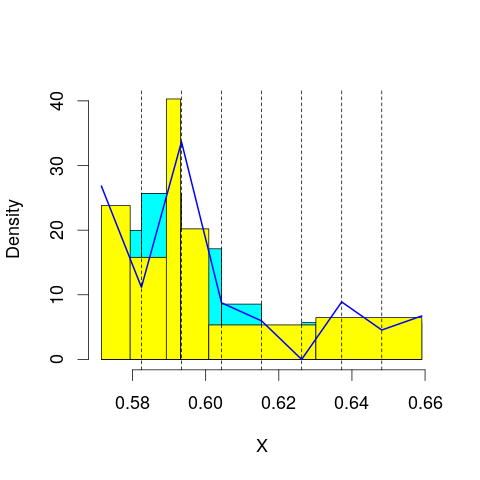

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.18492
mop.approx: Iteration 11. LL = 85.06914
mop.approx: Iteration 21. LL = 85.08589
mop.approx: Converged. Iteration 24. LL = 85.08635
[1] "Computing the linear combination of B-splines"


67.7576697571
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 76.82988
mop.approx: Iteration 11. LL = 85.1542
mop.approx: Iteration 21. LL = 85.29913
mop.approx: Iteration 31. LL = 85.33999
mop.approx: Iteration 41. LL = 85.35624
mop.approx: Iteration 51. LL = 85.36422
mop.approx: Iteration 61. LL = 85.36873
mop.approx: Iteration 71. LL = 85.37153
mop.approx: Iteration 81. LL = 85.3734
mop.approx: Iteration 91. LL = 85.3747
mop.approx: Converged. Iteration 99. LL = 85.37557
[1] "Computing the linear combination of B-splines"


66.3140225974
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.98213
mop.approx: Iteration 11. LL = 76.18547
mop.approx: Iteration 21. LL = 76.1982
mop.approx: Iteration 31. LL = 76.20079
mop.approx: Converged. Iteration 34. LL = 76.20116
[1] "Computing the linear combination of B-splines"


55.4067430922
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.01287
mop.approx: Iteration 11. LL = 77.47857
mop.approx: Iteration 21. LL = 77.50436
mop.approx: Iteration 31. LL = 77.50957
mop.approx: Iteration 41. LL = 77.51146
mop.approx: Converged. Iteration 50. LL = 77.51242
[1] "Computing the linear combination of B-splines"


54.9851315173
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.98399
mop.approx: Iteration 11. LL = 78.61337
mop.approx: Iteration 21. LL = 78.65548
mop.approx: Iteration 31. LL = 78.65817
mop.approx: Converged. Iteration 33. LL = 78.65841
[1] "Computing the linear combination of B-splines"


54.3982527125
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.639126
mop.approx: Iteration 11. LL = 75.95952
mop.approx: Iteration 21. LL = 76.2538
mop.approx: Iteration 31. LL = 76.29203
mop.approx: Iteration 41. LL = 76.29951
mop.approx: Iteration 51. LL = 76.30153
mop.approx: Converged. Iteration 55. LL = 76.30196
[1] "Computing the linear combination of B-splines"


50.30872155
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.814291
mop.approx: Iteration 11. LL = 71.8523
mop.approx: Iteration 21. LL = 71.87377
mop.approx: Iteration 31. LL = 71.87742
mop.approx: Converged. Iteration 36. LL = 71.878
[1] "Computing the linear combination of B-splines"


44.1438284037
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.54393
mop.approx: Iteration 11. LL = 86.31361
mop.approx: Iteration 21. LL = 86.32047
mop.approx: Converged. Iteration 21. LL = 86.32055
[1] "Computing the linear combination of B-splines"


68.9918724075
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 68.991872407484934)
m reached
('Sum of Probabilities:', 0.9821614003371366)
chosen


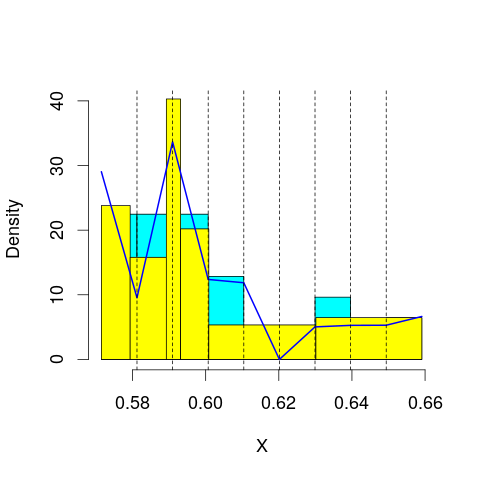

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.18492
mop.approx: Iteration 11. LL = 85.45954
mop.approx: Iteration 21. LL = 85.46353
mop.approx: Converged. Iteration 24. LL = 85.46391
[1] "Computing the linear combination of B-splines"


66.4023658405
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 76.82988
mop.approx: Iteration 11. LL = 85.8427
mop.approx: Iteration 21. LL = 86.08629
mop.approx: Iteration 31. LL = 86.13702
mop.approx: Iteration 41. LL = 86.1493
mop.approx: Iteration 51. LL = 86.1525
mop.approx: Converged. Iteration 56. LL = 86.15318
[1] "Computing the linear combination of B-splines"


65.3587603032
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.98213
mop.approx: Iteration 11. LL = 76.98516
mop.approx: Iteration 21. LL = 77.00485
mop.approx: Converged. Iteration 26. LL = 77.0058
[1] "Computing the linear combination of B-splines"


54.4785196218
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.01287
mop.approx: Iteration 11. LL = 77.50314
mop.approx: Iteration 21. LL = 77.51735
mop.approx: Iteration 31. LL = 77.51953
mop.approx: Converged. Iteration 31. LL = 77.5196
[1] "Computing the linear combination of B-splines"


53.25944312
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.98399
mop.approx: Iteration 11. LL = 78.87736
mop.approx: Iteration 21. LL = 78.90165
mop.approx: Iteration 31. LL = 78.90536
mop.approx: Converged. Iteration 35. LL = 78.90589
[1] "Computing the linear combination of B-splines"


52.912947032
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.639126
mop.approx: Iteration 11. LL = 78.71056
mop.approx: Iteration 21. LL = 78.89429
mop.approx: Iteration 31. LL = 78.90436
mop.approx: Converged. Iteration 39. LL = 78.90584
[1] "Computing the linear combination of B-splines"


51.1812395513
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.814291
mop.approx: Iteration 11. LL = 74.65814
mop.approx: Iteration 21. LL = 74.80516
mop.approx: Iteration 31. LL = 74.82364
mop.approx: Iteration 41. LL = 74.82817
mop.approx: Iteration 51. LL = 74.8296
mop.approx: Converged. Iteration 52. LL = 74.82974
[1] "Computing the linear combination of B-splines"


45.2889915496
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.54393
mop.approx: Iteration 11. LL = 87.36373
mop.approx: Converged. Iteration 20. LL = 87.37053
[1] "Computing the linear combination of B-splines"


68.3089776378
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 68.308977637815246)
m reached
('Sum of Probabilities:', 0.9834257075132147)
chosen


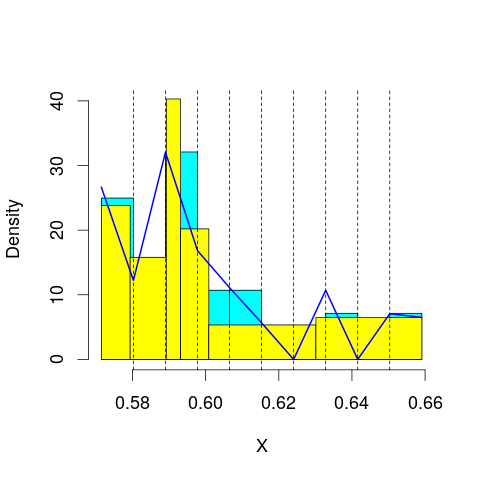

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.18492
mop.approx: Iteration 11. LL = 86.68762
mop.approx: Iteration 21. LL = 86.83982
mop.approx: Iteration 31. LL = 86.86814
mop.approx: Iteration 41. LL = 86.87773
mop.approx: Iteration 51. LL = 86.88203
mop.approx: Iteration 61. LL = 86.88428
mop.approx: Iteration 71. LL = 86.88559
mop.approx: Converged. Iteration 75. LL = 86.88604
[1] "Computing the linear combination of B-splines"


66.091628344
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 76.82988
mop.approx: Iteration 11. LL = 86.28574
mop.approx: Iteration 21. LL = 86.48306
mop.approx: Iteration 31. LL = 86.52458
mop.approx: Iteration 41. LL = 86.535
mop.approx: Iteration 51. LL = 86.53794
mop.approx: Converged. Iteration 57. LL = 86.53872
[1] "Computing the linear combination of B-splines"


64.0114328355
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.98213
mop.approx: Iteration 11. LL = 78.07765
mop.approx: Iteration 21. LL = 78.22245
mop.approx: Iteration 31. LL = 78.25011
mop.approx: Iteration 41. LL = 78.26015
mop.approx: Iteration 51. LL = 78.2647
mop.approx: Iteration 61. LL = 78.26695
mop.approx: Iteration 71. LL = 78.26811
mop.approx: Converged. Iteration 72. LL = 78.26827
[1] "Computing the linear combination of B-splines"


54.0081149061
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.01287
mop.approx: Iteration 11. LL = 77.85417
mop.approx: Iteration 21. LL = 77.86579
mop.approx: Converged. Iteration 26. LL = 77.86655
[1] "Computing the linear combination of B-splines"


51.8735278449
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.98399
mop.approx: Iteration 11. LL = 78.93236
mop.approx: Iteration 21. LL = 78.9754
mop.approx: Iteration 31. LL = 78.98332
mop.approx: Iteration 41. LL = 78.9852
mop.approx: Converged. Iteration 44. LL = 78.98554
[1] "Computing the linear combination of B-splines"


51.2595336922
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.639126
mop.approx: Iteration 11. LL = 79.45911
mop.approx: Iteration 21. LL = 79.51557
mop.approx: Iteration 31. LL = 79.52003
mop.approx: Converged. Iteration 40. LL = 79.5213
[1] "Computing the linear combination of B-splines"


50.0541672921
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.814291
mop.approx: Iteration 11. LL = 77.43361
mop.approx: Iteration 21. LL = 77.82582
mop.approx: Iteration 31. LL = 77.8879
mop.approx: Iteration 41. LL = 77.90071
mop.approx: Iteration 51. LL = 77.90393
mop.approx: Converged. Iteration 58. LL = 77.90481
[1] "Computing the linear combination of B-splines"


46.5937521011
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.54393
mop.approx: Iteration 11. LL = 87.736
mop.approx: Iteration 21. LL = 87.80612
mop.approx: Iteration 31. LL = 87.82089
mop.approx: Iteration 41. LL = 87.82559
mop.approx: Iteration 51. LL = 87.82727
mop.approx: Converged. Iteration 52. LL = 87.82745
[1] "Computing the linear combination of B-splines"


67.0330318397
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 67.033031839736154)
m reached
('Sum of Probabilities:', 0.984595798064515)
chosen


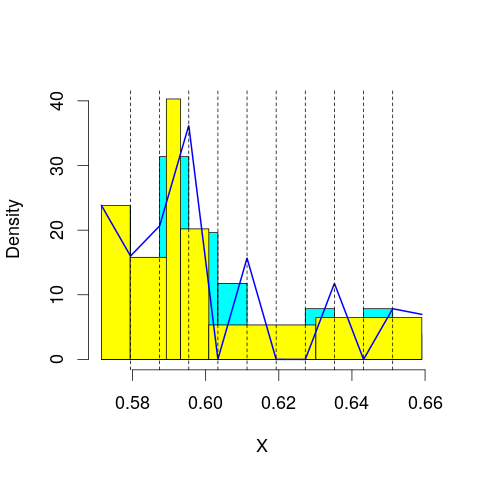

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.18492
mop.approx: Iteration 11. LL = 87.04443
mop.approx: Iteration 21. LL = 87.12439
mop.approx: Iteration 31. LL = 87.13882
mop.approx: Iteration 41. LL = 87.14397
mop.approx: Iteration 51. LL = 87.14642
mop.approx: Iteration 61. LL = 87.14778
mop.approx: Converged. Iteration 65. LL = 87.14824
[1] "Computing the linear combination of B-splines"


64.6209554702
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 76.82988
mop.approx: Iteration 11. LL = 87.12741
mop.approx: Iteration 21. LL = 87.34003
mop.approx: Iteration 31. LL = 87.38495
mop.approx: Iteration 41. LL = 87.4004
mop.approx: Iteration 51. LL = 87.40695
mop.approx: Iteration 61. LL = 87.41009
mop.approx: Iteration 71. LL = 87.41172
mop.approx: Converged. Iteration 76. LL = 87.41232
[1] "Computing the linear combination of B-splines"


63.1521729127
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.98213
mop.approx: Iteration 11. LL = 78.05488
mop.approx: Iteration 21. LL = 78.1039
mop.approx: Iteration 31. LL = 78.11293
mop.approx: Iteration 41. LL = 78.11533
mop.approx: Converged. Iteration 46. LL = 78.11589
[1] "Computing the linear combination of B-splines"


52.1228670669
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.01287
mop.approx: Iteration 11. LL = 78.77881
mop.approx: Iteration 21. LL = 78.91272
mop.approx: Iteration 31. LL = 78.94269
mop.approx: Iteration 41. LL = 78.95298
mop.approx: Iteration 51. LL = 78.95695
mop.approx: Iteration 61. LL = 78.95854
mop.approx: Converged. Iteration 63. LL = 78.9588
[1] "Computing the linear combination of B-splines"


51.2329105542
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.98399
mop.approx: Iteration 11. LL = 78.93166
mop.approx: Iteration 21. LL = 78.94133
mop.approx: Converged. Iteration 27. LL = 78.94217
[1] "Computing the linear combination of B-splines"


49.4832072986
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.639126
mop.approx: Iteration 11. LL = 79.99775
mop.approx: Iteration 21. LL = 80.11535
mop.approx: Iteration 31. LL = 80.13742
mop.approx: Iteration 41. LL = 80.14391
mop.approx: Iteration 51. LL = 80.14664
mop.approx: Iteration 61. LL = 80.14802
mop.approx: Converged. Iteration 65. LL = 80.14845
[1] "Computing the linear combination of B-splines"


48.9529667646
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.814291
mop.approx: Iteration 11. LL = 76.90676
mop.approx: Iteration 21. LL = 77.1115
mop.approx: Iteration 31. LL = 77.15017
mop.approx: Iteration 41. LL = 77.1634
mop.approx: Iteration 51. LL = 77.16917
mop.approx: Iteration 61. LL = 77.17203
mop.approx: Iteration 71. LL = 77.17352
mop.approx: Converged. Iteration 77. LL = 77.17414
[1] "Computing the linear combination of B-splines"


43.8957359958
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.54393
mop.approx: Iteration 11. LL = 86.60508
mop.approx: Iteration 21. LL = 86.63265
mop.approx: Iteration 31. LL = 86.63993
mop.approx: Iteration 41. LL = 86.6428
mop.approx: Iteration 51. LL = 86.64417
mop.approx: Converged. Iteration 53. LL = 86.64443
[1] "Computing the linear combination of B-splines"


64.1171460736
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 64.117146073639745)
m reached
('Sum of Probabilities:', 0.9846057970434696)
chosen


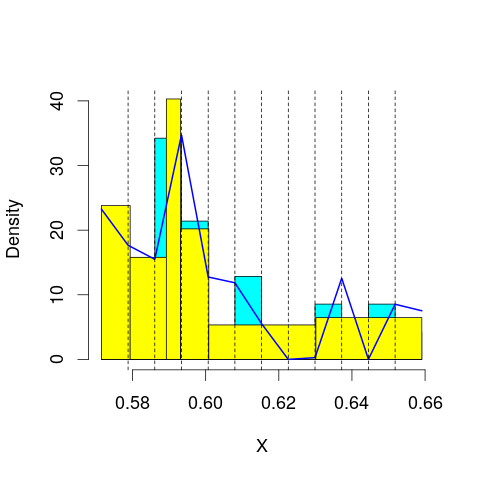

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.18492
mop.approx: Iteration 11. LL = 88.42747
mop.approx: Iteration 21. LL = 88.55965
mop.approx: Iteration 31. LL = 88.5889
mop.approx: Iteration 41. LL = 88.59883
mop.approx: Iteration 51. LL = 88.603
mop.approx: Iteration 61. LL = 88.60499
mop.approx: Converged. Iteration 68. LL = 88.60587
[1] "Computing the linear combination of B-splines"


64.3457157219
('best: ', 64.117146073639745, 'accepted difference:', 108.99914832518756, 'cur BIC:', 64.345715721948181)
m reached
('Sum of Probabilities:', 0.9786667754947861)
chosen


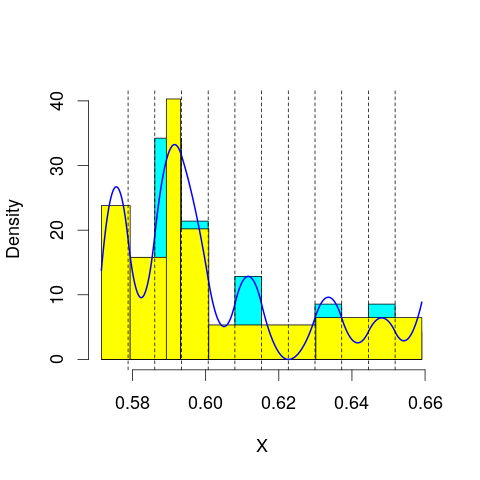

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 76.82988
mop.approx: Iteration 11. LL = 86.92901
mop.approx: Iteration 21. LL = 87.07998
mop.approx: Iteration 31. LL = 87.1057
mop.approx: Iteration 41. LL = 87.11231
mop.approx: Iteration 51. LL = 87.11449
mop.approx: Converged. Iteration 55. LL = 87.11501
[1] "Computing the linear combination of B-splines"


61.1219875987
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.98213
mop.approx: Iteration 11. LL = 78.48175
mop.approx: Iteration 21. LL = 78.52877
mop.approx: Iteration 31. LL = 78.54173
mop.approx: Iteration 41. LL = 78.54792
mop.approx: Iteration 51. LL = 78.55141
mop.approx: Iteration 61. LL = 78.55359
mop.approx: Iteration 71. LL = 78.55504
mop.approx: Iteration 81. LL = 78.55605
mop.approx: Converged. Iteration 84. LL = 78.55638
[1] "Computing the linear combination of B-splines"


50.8304905212
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.01287
mop.approx: Iteration 11. LL = 79.14987
mop.approx: Iteration 21. LL = 79.29618
mop.approx: Iteration 31. LL = 79.33274
mop.approx: Iteration 41. LL = 79.34418
mop.approx: Iteration 51. LL = 79.34822
mop.approx: Iteration 61. LL = 79.34975
mop.approx: Converged. Iteration 63. LL = 79.34999
[1] "Computing the linear combination of B-splines"


49.891225824
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.98399
mop.approx: Iteration 11. LL = 79.42528
mop.approx: Iteration 21. LL = 79.5217
mop.approx: Iteration 31. LL = 79.54845
mop.approx: Iteration 41. LL = 79.55972
mop.approx: Iteration 51. LL = 79.56521
mop.approx: Iteration 61. LL = 79.56808
mop.approx: Iteration 71. LL = 79.56962
mop.approx: Converged. Iteration 77. LL = 79.57026
[1] "Computing the linear combination of B-splines"


48.3789042517
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.639126
mop.approx: Iteration 11. LL = 79.99108
mop.approx: Iteration 21. LL = 80.0539
mop.approx: Iteration 31. LL = 80.07176
mop.approx: Iteration 41. LL = 80.0795
mop.approx: Iteration 51. LL = 80.08336
mop.approx: Iteration 61. LL = 80.08546
mop.approx: Iteration 71. LL = 80.08668
mop.approx: Converged. Iteration 74. LL = 80.08702
[1] "Computing the linear combination of B-splines"


47.1454214854
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.814291
mop.approx: Iteration 11. LL = 79.18525
mop.approx: Iteration 21. LL = 79.37038
mop.approx: Iteration 31. LL = 79.38834
mop.approx: Iteration 41. LL = 79.39315
mop.approx: Iteration 51. LL = 79.39545
mop.approx: Iteration 61. LL = 79.39676
mop.approx: Converged. Iteration 66. LL = 79.39728
[1] "Computing the linear combination of B-splines"


44.8760025931
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.54393
mop.approx: Iteration 11. LL = 88.0997
mop.approx: Iteration 21. LL = 88.1643
mop.approx: Iteration 31. LL = 88.18164
mop.approx: Iteration 41. LL = 88.18665
mop.approx: Converged. Iteration 50. LL = 88.18813
[1] "Computing the linear combination of B-splines"


63.9279737756
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 63.927973775593379)
m reached
('Sum of Probabilities:', 0.9852935697134584)
chosen


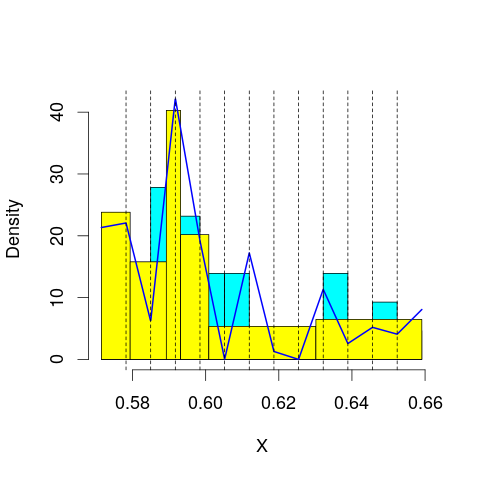

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.18492
mop.approx: Iteration 11. LL = 88.54951
mop.approx: Iteration 21. LL = 88.58436
mop.approx: Iteration 31. LL = 88.5907
mop.approx: Iteration 41. LL = 88.59294
mop.approx: Converged. Iteration 48. LL = 88.59381
[1] "Computing the linear combination of B-splines"


62.6007934604
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 76.82988
mop.approx: Iteration 11. LL = 87.35796
mop.approx: Iteration 21. LL = 87.46905
mop.approx: Iteration 31. LL = 87.49345
mop.approx: Iteration 41. LL = 87.50226
mop.approx: Iteration 51. LL = 87.50647
mop.approx: Iteration 61. LL = 87.50882
mop.approx: Iteration 71. LL = 87.51026
mop.approx: Converged. Iteration 78. LL = 87.51105
[1] "Computing the linear combination of B-splines"


59.7851599252
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.98213
mop.approx: Iteration 11. LL = 78.61431
mop.approx: Iteration 21. LL = 78.6794
mop.approx: Iteration 31. LL = 78.70006
mop.approx: Iteration 41. LL = 78.70907
mop.approx: Iteration 51. LL = 78.71351
mop.approx: Iteration 61. LL = 78.71585
mop.approx: Iteration 71. LL = 78.71713
mop.approx: Converged. Iteration 74. LL = 78.71747
[1] "Computing the linear combination of B-splines"


49.2587097094
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.01287
mop.approx: Iteration 11. LL = 79.41364
mop.approx: Iteration 21. LL = 79.44883
mop.approx: Iteration 31. LL = 79.45163
mop.approx: Converged. Iteration 36. LL = 79.45223
[1] "Computing the linear combination of B-splines"


48.2606028552
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.98399
mop.approx: Iteration 11. LL = 79.92431
mop.approx: Iteration 21. LL = 80.05585
mop.approx: Iteration 31. LL = 80.08417
mop.approx: Iteration 41. LL = 80.09111
mop.approx: Iteration 51. LL = 80.09284
mop.approx: Converged. Iteration 51. LL = 80.09291
[1] "Computing the linear combination of B-splines"


47.1683317962
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.639126
mop.approx: Iteration 11. LL = 80.24185
mop.approx: Iteration 21. LL = 80.27718
mop.approx: Iteration 31. LL = 80.28121
mop.approx: Converged. Iteration 36. LL = 80.28187
[1] "Computing the linear combination of B-splines"


45.5508192526
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.814291
mop.approx: Iteration 11. LL = 84.0406
mop.approx: Iteration 21. LL = 84.10263
mop.approx: Converged. Iteration 27. LL = 84.10407
[1] "Computing the linear combination of B-splines"


46.4054673017
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.54393
mop.approx: Iteration 11. LL = 89.87064
mop.approx: Iteration 21. LL = 89.89679
mop.approx: Iteration 31. LL = 89.90223
mop.approx: Iteration 41. LL = 89.90395
mop.approx: Converged. Iteration 42. LL = 89.90413
[1] "Computing the linear combination of B-splines"


63.9111155148
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 63.911115514754798)
m reached
('Sum of Probabilities:', 0.9854379417374967)
chosen


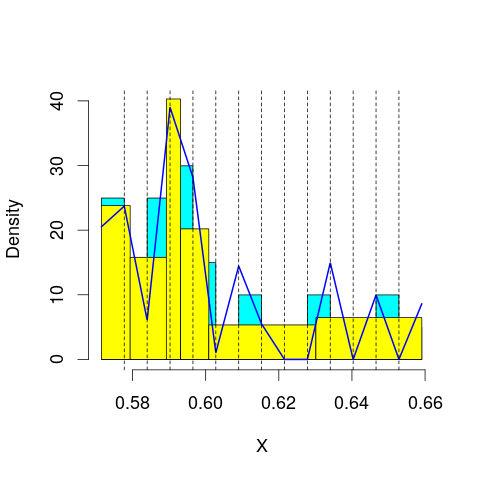

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.18492
mop.approx: Iteration 11. LL = 87.88731
mop.approx: Iteration 21. LL = 87.96581
mop.approx: Iteration 31. LL = 87.99418
mop.approx: Iteration 41. LL = 88.00593
mop.approx: Iteration 51. LL = 88.01107
mop.approx: Iteration 61. LL = 88.01339
mop.approx: Converged. Iteration 68. LL = 88.0143
[1] "Computing the linear combination of B-splines"


60.2884171905
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 76.82988
mop.approx: Iteration 11. LL = 88.24929
mop.approx: Iteration 21. LL = 88.34181
mop.approx: Iteration 31. LL = 88.36539
mop.approx: Iteration 41. LL = 88.37492
mop.approx: Iteration 51. LL = 88.37958
mop.approx: Iteration 61. LL = 88.38213
mop.approx: Iteration 71. LL = 88.38364
mop.approx: Converged. Iteration 77. LL = 88.38434
[1] "Computing the linear combination of B-splines"


58.925580523
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.98213
mop.approx: Iteration 11. LL = 78.41985
mop.approx: Iteration 21. LL = 78.47536
mop.approx: Iteration 31. LL = 78.48329
mop.approx: Iteration 41. LL = 78.48536
mop.approx: Converged. Iteration 48. LL = 78.48613
[1] "Computing the linear combination of B-splines"


47.2945115989
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.01287
mop.approx: Iteration 11. LL = 79.81596
mop.approx: Iteration 21. LL = 79.88671
mop.approx: Iteration 31. LL = 79.91173
mop.approx: Iteration 41. LL = 79.92283
mop.approx: Iteration 51. LL = 79.92814
mop.approx: Iteration 61. LL = 79.93076
mop.approx: Iteration 71. LL = 79.93209
mop.approx: Converged. Iteration 73. LL = 79.93234
[1] "Computing the linear combination of B-splines"


47.0078400288
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.98399
mop.approx: Iteration 11. LL = 80.15051
mop.approx: Iteration 21. LL = 80.23461
mop.approx: Iteration 31. LL = 80.24918
mop.approx: Iteration 41. LL = 80.25523
mop.approx: Iteration 51. LL = 80.25874
mop.approx: Iteration 61. LL = 80.26103
mop.approx: Iteration 71. LL = 80.26259
mop.approx: Iteration 81. LL = 80.26372
mop.approx: Converged. Iteration 87. LL = 80.26432
[1] "Computing the linear combination of B-splines"


45.6077238554
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.639126
mop.approx: Iteration 11. LL = 80.96967
mop.approx: Iteration 21. LL = 81.07824
mop.approx: Iteration 31. LL = 81.11044
mop.approx: Iteration 41. LL = 81.11991
mop.approx: Iteration 51. LL = 81.12259
mop.approx: Converged. Iteration 55. LL = 81.12308
[1] "Computing the linear combination of B-splines"


44.7537055951
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.814291
[1] "Computing the linear combination of B-splines"


50.1226445882
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.54393
mop.approx: Iteration 11. LL = 89.20208
mop.approx: Iteration 21. LL = 89.21231
mop.approx: Converged. Iteration 21. LL = 89.21238
[1] "Computing the linear combination of B-splines"


61.4864902755
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 61.486490275476655)
m reached
('Sum of Probabilities:', 0.9854158426275943)
chosen


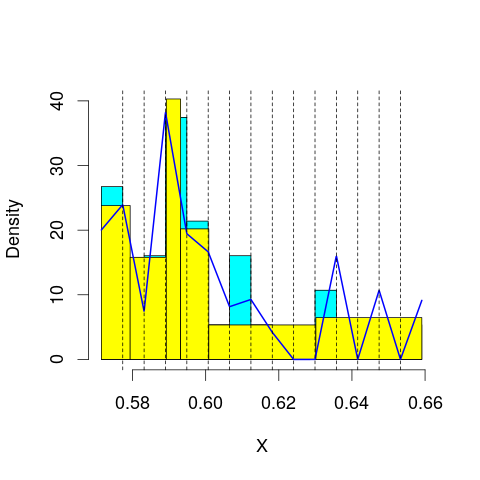

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.18492
mop.approx: Iteration 11. LL = 89.04278
mop.approx: Iteration 21. LL = 89.09167
mop.approx: Iteration 31. LL = 89.09756
mop.approx: Converged. Iteration 35. LL = 89.09817
[1] "Computing the linear combination of B-splines"


59.639414923
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 76.82988
mop.approx: Iteration 11. LL = 88.25984
mop.approx: Iteration 21. LL = 88.40094
mop.approx: Iteration 31. LL = 88.43994
mop.approx: Iteration 41. LL = 88.4537
mop.approx: Iteration 51. LL = 88.45858
mop.approx: Iteration 61. LL = 88.46041
mop.approx: Converged. Iteration 64. LL = 88.4608
[1] "Computing the linear combination of B-splines"


57.2691739817
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.98213
mop.approx: Iteration 11. LL = 79.11396
mop.approx: Iteration 21. LL = 79.1825
mop.approx: Iteration 31. LL = 79.20305
mop.approx: Iteration 41. LL = 79.21085
mop.approx: Iteration 51. LL = 79.2139
mop.approx: Converged. Iteration 60. LL = 79.2151
[1] "Computing the linear combination of B-splines"


46.2906133537
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.01287
mop.approx: Iteration 11. LL = 79.87353
mop.approx: Iteration 21. LL = 79.98262
mop.approx: Iteration 31. LL = 79.99713
mop.approx: Iteration 41. LL = 80.00003
mop.approx: Converged. Iteration 49. LL = 80.00099
[1] "Computing the linear combination of B-splines"


45.3436469306
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.98399
mop.approx: Iteration 11. LL = 80.49155
mop.approx: Iteration 21. LL = 80.55005
mop.approx: Iteration 31. LL = 80.57184
mop.approx: Iteration 41. LL = 80.58349
mop.approx: Iteration 51. LL = 80.58998
mop.approx: Iteration 61. LL = 80.59364
mop.approx: Iteration 71. LL = 80.59569
mop.approx: Iteration 81. LL = 80.59685
mop.approx: Converged. Iteration 82. LL = 80.59701
[1] "Computing the linear combination of B-splines"


44.2061769143
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.639126
mop.approx: Iteration 11. LL = 80.45741
mop.approx: Iteration 21. LL = 80.55251
mop.approx: Iteration 31. LL = 80.57481
mop.approx: Iteration 41. LL = 80.58424
mop.approx: Iteration 51. LL = 80.5895
mop.approx: Iteration 61. LL = 80.59282
mop.approx: Iteration 71. LL = 80.59504
mop.approx: Iteration 81. LL = 80.5966
mop.approx: Iteration 91. LL = 80.59773
mop.approx: Converged. Iteration 97. LL = 80.59833
[1] "Computing the linear combination of B-splines"


42.2330538776
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.814291
[1] "Computing the linear combination of B-splines"


15.3844844089
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.54393
mop.approx: Iteration 11. LL = 90.63621
mop.approx: Converged. Iteration 20. LL = 90.64618
[1] "Computing the linear combination of B-splines"


61.1874276493
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 61.187427649285475)
m reached
('Sum of Probabilities:', 0.986011817854637)
chosen


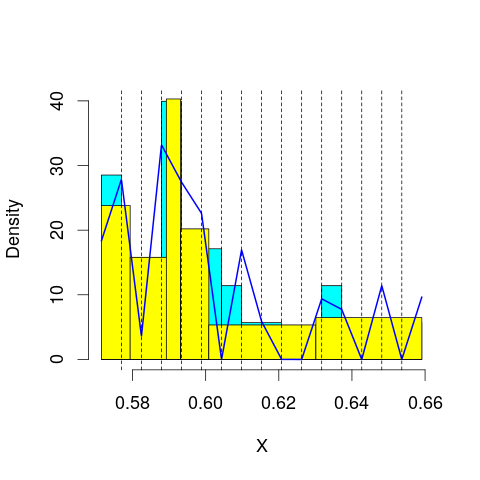

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.18492
mop.approx: Iteration 11. LL = 89.30239
mop.approx: Iteration 21. LL = 89.33969
mop.approx: Iteration 31. LL = 89.34982
mop.approx: Iteration 41. LL = 89.35406
mop.approx: Iteration 51. LL = 89.35624
mop.approx: Iteration 61. LL = 89.35751
mop.approx: Converged. Iteration 63. LL = 89.35779
[1] "Computing the linear combination of B-splines"


58.1661643826
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 76.82988
mop.approx: Iteration 11. LL = 88.59212
mop.approx: Iteration 21. LL = 88.70184
mop.approx: Iteration 31. LL = 88.71898
mop.approx: Iteration 41. LL = 88.72296
mop.approx: Converged. Iteration 48. LL = 88.72401
[1] "Computing the linear combination of B-splines"


55.7995179658
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.98213
mop.approx: Iteration 11. LL = 79.59205
mop.approx: Iteration 21. LL = 79.62373
mop.approx: Iteration 31. LL = 79.63599
mop.approx: Iteration 41. LL = 79.64181
mop.approx: Iteration 51. LL = 79.64418
mop.approx: Converged. Iteration 56. LL = 79.64478
[1] "Computing the linear combination of B-splines"


44.9874224157
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.01287
mop.approx: Iteration 11. LL = 79.77689
mop.approx: Iteration 21. LL = 79.8443
mop.approx: Iteration 31. LL = 79.86404
mop.approx: Iteration 41. LL = 79.87122
mop.approx: Iteration 51. LL = 79.87393
mop.approx: Converged. Iteration 58. LL = 79.87483
[1] "Computing the linear combination of B-splines"


43.4845694622
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.98399
mop.approx: Iteration 11. LL = 80.86839
mop.approx: Iteration 21. LL = 80.94363
mop.approx: Iteration 31. LL = 80.95938
mop.approx: Iteration 41. LL = 80.9654
mop.approx: Iteration 51. LL = 80.96893
mop.approx: Iteration 61. LL = 80.9713
mop.approx: Iteration 71. LL = 80.97296
mop.approx: Iteration 81. LL = 80.97415
mop.approx: Converged. Iteration 88. LL = 80.97486
[1] "Computing the linear combination of B-splines"


42.8520316207
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.639126
mop.approx: Iteration 11. LL = 83.07165
mop.approx: Iteration 21. LL = 83.22603
mop.approx: Iteration 31. LL = 83.25666
mop.approx: Iteration 41. LL = 83.26653
mop.approx: Iteration 51. LL = 83.27033
mop.approx: Iteration 61. LL = 83.2719
mop.approx: Converged. Iteration 63. LL = 83.27216
[1] "Computing the linear combination of B-splines"


43.4617795588
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.814291
[1] "Computing the linear combination of B-splines"


25.4348697552
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.54393
mop.approx: Iteration 11. LL = 90.86922
mop.approx: Iteration 21. LL = 90.88147
mop.approx: Converged. Iteration 21. LL = 90.88156
[1] "Computing the linear combination of B-splines"


59.6899387945
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 59.689938794543224)
m reached
('Sum of Probabilities:', 0.9859677173606578)
chosen


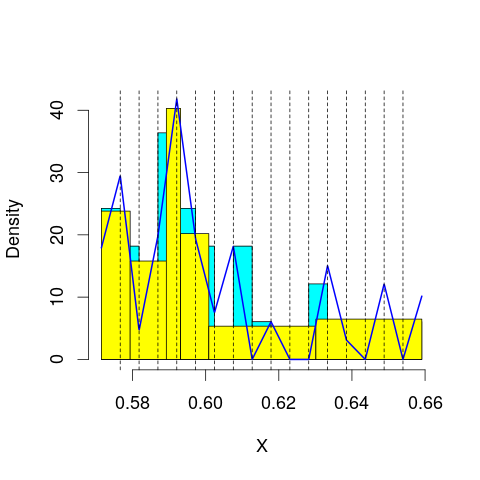

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.18492
mop.approx: Iteration 11. LL = 89.90438
mop.approx: Iteration 21. LL = 89.95744
mop.approx: Iteration 31. LL = 89.96724
mop.approx: Iteration 41. LL = 89.97095
mop.approx: Iteration 51. LL = 89.97276
mop.approx: Converged. Iteration 58. LL = 89.97361
[1] "Computing the linear combination of B-splines"


57.0491205509
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 76.82988
mop.approx: Iteration 11. LL = 88.97452
mop.approx: Iteration 21. LL = 89.05338
mop.approx: Iteration 31. LL = 89.08872
mop.approx: Iteration 41. LL = 89.10761
mop.approx: Iteration 51. LL = 89.11838
mop.approx: Iteration 61. LL = 89.12476
mop.approx: Iteration 71. LL = 89.12866
mop.approx: Iteration 81. LL = 89.13109
mop.approx: Iteration 91. LL = 89.13264
mop.approx: Converged. Iteration 99. LL = 89.13356
[1] "Computing the linear combination of B-splines"


54.4761993512
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.98213
mop.approx: Iteration 11. LL = 79.89109
mop.approx: Iteration 21. LL = 79.99449
mop.approx: Iteration 31. LL = 80.01076
mop.approx: Iteration 41. LL = 80.01362
mop.approx: Converged. Iteration 43. LL = 80.01389
[1] "Computing the linear combination of B-splines"


43.6236627724
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.01287
mop.approx: Iteration 11. LL = 80.18977
mop.approx: Iteration 21. LL = 80.25515
mop.approx: Iteration 31. LL = 80.27419
mop.approx: Iteration 41. LL = 80.28296
mop.approx: Iteration 51. LL = 80.28754
mop.approx: Iteration 61. LL = 80.29009
mop.approx: Iteration 71. LL = 80.2916
mop.approx: Converged. Iteration 80. LL = 80.29257
[1] "Computing the linear combination of B-splines"


42.1694267563
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.98399
mop.approx: Iteration 11. LL = 80.89127
mop.approx: Iteration 21. LL = 81.00039
mop.approx: Iteration 31. LL = 81.02712
mop.approx: Iteration 41. LL = 81.03551
mop.approx: Iteration 51. LL = 81.03838
mop.approx: Converged. Iteration 58. LL = 81.03928
[1] "Computing the linear combination of B-splines"


41.1804578554
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.639126
mop.approx: Iteration 11. LL = 82.84385
mop.approx: Iteration 21. LL = 82.92266
mop.approx: Iteration 31. LL = 82.93895
mop.approx: Iteration 41. LL = 82.94535
mop.approx: Iteration 51. LL = 82.94892
mop.approx: Iteration 61. LL = 82.95125
mop.approx: Iteration 71. LL = 82.95287
mop.approx: Iteration 81. LL = 82.95406
mop.approx: Converged. Iteration 88. LL = 82.95479
[1] "Computing the linear combination of B-splines"


41.6431337147
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.814291
[1] "Computing the linear combination of B-splines"


-11.8492742549
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.54393
mop.approx: Iteration 11. LL = 91.91604
mop.approx: Iteration 21. LL = 91.93577
mop.approx: Iteration 31. LL = 91.9417
mop.approx: Converged. Iteration 40. LL = 91.94337
[1] "Computing the linear combination of B-splines"


59.018876535
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 59.018876534976783)
m reached
('Sum of Probabilities:', 0.9858135241178684)
chosen


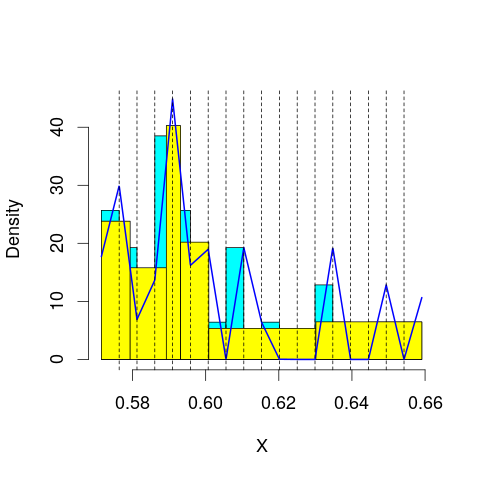

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.18492
mop.approx: Iteration 11. LL = 90.1531
mop.approx: Iteration 21. LL = 90.21903
mop.approx: Iteration 31. LL = 90.22507
mop.approx: Iteration 41. LL = 90.22686
mop.approx: Converged. Iteration 44. LL = 90.22724
[1] "Computing the linear combination of B-splines"


55.5698826513
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 76.82988
mop.approx: Iteration 11. LL = 90.06305
mop.approx: Iteration 21. LL = 90.13957
mop.approx: Iteration 31. LL = 90.15252
mop.approx: Iteration 41. LL = 90.15799
mop.approx: Iteration 51. LL = 90.16076
mop.approx: Iteration 61. LL = 90.1622
mop.approx: Converged. Iteration 63. LL = 90.16249
[1] "Computing the linear combination of B-splines"


53.7722612631
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.98213
mop.approx: Iteration 11. LL = 79.99561
mop.approx: Iteration 21. LL = 80.07345
mop.approx: Iteration 31. LL = 80.09504
mop.approx: Iteration 41. LL = 80.10352
mop.approx: Iteration 51. LL = 80.10786
mop.approx: Iteration 61. LL = 80.1103
mop.approx: Iteration 71. LL = 80.11171
mop.approx: Converged. Iteration 76. LL = 80.11225
[1] "Computing the linear combination of B-splines"


41.989157377
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.01287
mop.approx: Iteration 11. LL = 80.7415
mop.approx: Iteration 21. LL = 80.86096
mop.approx: Iteration 31. LL = 80.89513
mop.approx: Iteration 41. LL = 80.90772
mop.approx: Iteration 51. LL = 80.91314
mop.approx: Iteration 61. LL = 80.91583
mop.approx: Iteration 71. LL = 80.91729
mop.approx: Converged. Iteration 77. LL = 80.91794
[1] "Computing the linear combination of B-splines"


41.0619666246
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.98399
mop.approx: Iteration 11. LL = 80.86863
mop.approx: Iteration 21. LL = 80.92727
mop.approx: Iteration 31. LL = 80.94773
mop.approx: Iteration 41. LL = 80.95693
mop.approx: Iteration 51. LL = 80.96108
mop.approx: Iteration 61. LL = 80.96286
mop.approx: Converged. Iteration 65. LL = 80.96332
[1] "Computing the linear combination of B-splines"


39.3646762084
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.639126
mop.approx: Iteration 11. LL = 83.01174
mop.approx: Iteration 21. LL = 83.21415
mop.approx: Iteration 31. LL = 83.27688
mop.approx: Iteration 41. LL = 83.30796
mop.approx: Iteration 51. LL = 83.32531
mop.approx: Iteration 61. LL = 83.33542
mop.approx: Iteration 71. LL = 83.34143
mop.approx: Iteration 81. LL = 83.34506
mop.approx: Iteration 91. LL = 83.34727
mop.approx: Iteration 101. LL = 83.34864
mop.approx: Converged. Iteration 107. LL = 83.34929
[1] "Computing the linear combination of B-splines"


39.2190575171
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.814291
[1] "Computing the linear combination of B-splines"


76.2190116379
('best: ', 59.018876534976783, 'accepted difference:', 100.33209010946052, 'cur BIC:', 76.219011637867283)
m reached
('Sum of Probabilities:', 10.661031613204422)
('Order:', 2)
okay


/home/andreas/miniconda2/envs/mlp/lib/python2.7/site-packages/scipy/integrate/quadpack.py:385: IntegrationWarning: The maximum number of subdivisions (50) has been achieved.
  If increasing the limit yields no improvement it is advised to analyze 
  the integrand in order to determine the difficulties.  If the position of a 
  local difficulty can be determined (singularity, discontinuity) one will 
  probably gain from splitting up the interval and calling the integrator 
  on the subranges.  Perhaps a special-purpose integrator should be used.
  warnings.warn(msg, IntegrationWarning)


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.54393
mop.approx: Iteration 11. LL = 93.02698
mop.approx: Converged. Iteration 19. LL = 93.03264
[1] "Computing the linear combination of B-splines"


58.3752776511
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 58.375277651093505)
m reached
('Sum of Probabilities:', 0.9854182358343923)
chosen


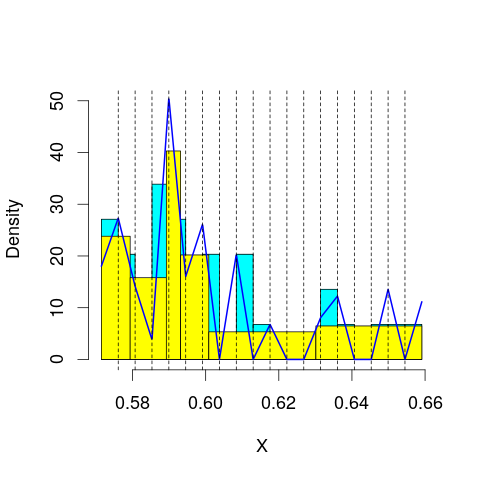

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.18492
mop.approx: Iteration 11. LL = 90.38334
mop.approx: Iteration 21. LL = 90.42642
mop.approx: Iteration 31. LL = 90.43631
mop.approx: Iteration 41. LL = 90.44049
mop.approx: Iteration 51. LL = 90.44238
mop.approx: Converged. Iteration 55. LL = 90.4429
[1] "Computing the linear combination of B-splines"


54.0526722255
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 76.82988
mop.approx: Iteration 11. LL = 90.38461
mop.approx: Iteration 21. LL = 90.49126
mop.approx: Iteration 31. LL = 90.5128
mop.approx: Iteration 41. LL = 90.52052
mop.approx: Iteration 51. LL = 90.52353
mop.approx: Converged. Iteration 59. LL = 90.52467
[1] "Computing the linear combination of B-splines"


52.4015755824
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.98213
mop.approx: Iteration 11. LL = 80.73545
mop.approx: Iteration 21. LL = 80.8446
mop.approx: Iteration 31. LL = 80.87187
mop.approx: Iteration 41. LL = 80.88197
mop.approx: Iteration 51. LL = 80.88683
mop.approx: Iteration 61. LL = 80.88953
mop.approx: Iteration 71. LL = 80.89113
mop.approx: Converged. Iteration 80. LL = 80.89213
[1] "Computing the linear combination of B-splines"


41.0361651439
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.01287
mop.approx: Iteration 11. LL = 80.82006
mop.approx: Iteration 21. LL = 80.97938
mop.approx: Iteration 31. LL = 81.02486
mop.approx: Iteration 41. LL = 81.04354
mop.approx: Iteration 51. LL = 81.05297
mop.approx: Iteration 61. LL = 81.05821
mop.approx: Iteration 71. LL = 81.06128
mop.approx: Iteration 81. LL = 81.06314
mop.approx: Iteration 91. LL = 81.06431
mop.approx: Converged. Iteration 94. LL = 81.06465
[1] "Computing the linear combination of B-splines"


39.4757256705
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.98399
mop.approx: Iteration 11. LL = 81.43293
mop.approx: Iteration 21. LL = 81.5413
mop.approx: Iteration 31. LL = 81.56603
mop.approx: Iteration 41. LL = 81.57446
mop.approx: Iteration 51. LL = 81.57815
mop.approx: Iteration 61. LL = 81.58012
mop.approx: Iteration 71. LL = 81.58136
mop.approx: Converged. Iteration 77. LL = 81.58199
[1] "Computing the linear combination of B-splines"


38.2457204413
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.639126
mop.approx: Iteration 11. LL = 87.05159
mop.approx: Iteration 21. LL = 87.41838
mop.approx: Iteration 31. LL = 87.50016
mop.approx: Iteration 41. LL = 87.52271
mop.approx: Iteration 51. LL = 87.53082
mop.approx: Iteration 61. LL = 87.53445
mop.approx: Iteration 71. LL = 87.53635
mop.approx: Converged. Iteration 80. LL = 87.53744
[1] "Computing the linear combination of B-splines"


41.6809848153
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.814291
[1] "Computing the linear combination of B-splines"


41.3225422316
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.54393
mop.approx: Iteration 11. LL = 91.5895
mop.approx: Iteration 21. LL = 91.61969
mop.approx: Iteration 31. LL = 91.62701
mop.approx: Iteration 41. LL = 91.63057
mop.approx: Iteration 51. LL = 91.63235
mop.approx: Converged. Iteration 55. LL = 91.63286
[1] "Computing the linear combination of B-splines"


55.2426380177
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 55.24263801774562)
m reached
('Sum of Probabilities:', 0.9849251984341607)
chosen


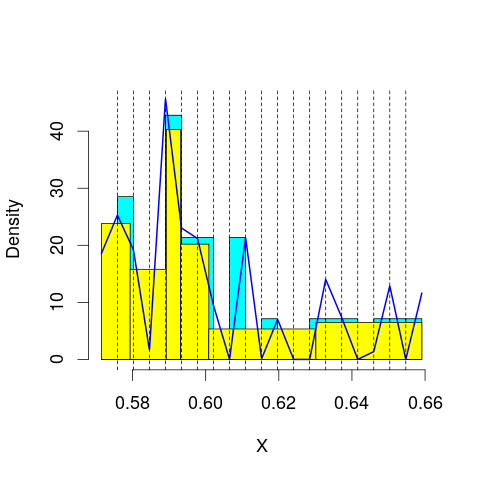

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 77.18492
mop.approx: Iteration 11. LL = 92.36765
mop.approx: Iteration 21. LL = 92.38721
mop.approx: Converged. Iteration 21. LL = 92.38729
[1] "Computing the linear combination of B-splines"


54.2641921793
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 76.82988
mop.approx: Iteration 11. LL = 89.65813
mop.approx: Iteration 21. LL = 89.8362
mop.approx: Iteration 31. LL = 89.88745
mop.approx: Iteration 41. LL = 89.90493
mop.approx: Iteration 51. LL = 89.91177
mop.approx: Iteration 61. LL = 89.91482
mop.approx: Iteration 71. LL = 89.91635
mop.approx: Converged. Iteration 75. LL = 89.91683
[1] "Computing the linear combination of B-splines"


50.0608657961
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.98213
mop.approx: Iteration 11. LL = 82.12972
mop.approx: Iteration 21. LL = 82.35217
mop.approx: Iteration 31. LL = 82.39915
mop.approx: Iteration 41. LL = 82.41436
mop.approx: Iteration 51. LL = 82.42023
mop.approx: Iteration 61. LL = 82.42282
mop.approx: Iteration 71. LL = 82.42413
mop.approx: Converged. Iteration 74. LL = 82.42448
[1] "Computing the linear combination of B-splines"


40.8356485595
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.01287
mop.approx: Iteration 11. LL = 80.97919
mop.approx: Iteration 21. LL = 81.14927
mop.approx: Iteration 31. LL = 81.21697
mop.approx: Iteration 41. LL = 81.24394
mop.approx: Iteration 51. LL = 81.25469
mop.approx: Iteration 61. LL = 81.25918
mop.approx: Iteration 71. LL = 81.26125
mop.approx: Iteration 81. LL = 81.26234
mop.approx: Converged. Iteration 81. LL = 81.26242
[1] "Computing the linear combination of B-splines"


37.9407075971
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.98399
mop.approx: Iteration 11. LL = 81.73334
mop.approx: Iteration 21. LL = 81.93745
mop.approx: Iteration 31. LL = 82.00494
mop.approx: Iteration 41. LL = 82.03708
mop.approx: Iteration 51. LL = 82.05505
mop.approx: Iteration 61. LL = 82.06598
mop.approx: Iteration 71. LL = 82.07297
mop.approx: Iteration 81. LL = 82.07761
mop.approx: Iteration 91. LL = 82.08077
mop.approx: Iteration 101. LL = 82.08298
mop.approx: Iteration 111. LL = 82.08454
mop.approx: Iteration 121. LL = 82.08567
mop.approx: Converged. Iteration 126. LL = 82.0862
[1] "Computing the linear combination of B-splines"


37.0329906744
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.639126
mop.approx: Iteration 11. LL = 82.23696
mop.approx: Iteration 21. LL = 82.42792
mop.approx: Iteration 31. LL = 82.47451
mop.approx: Iteration 41. LL = 82.48872
mop.approx: Iteration 51. LL = 82.49358
mop.approx: Iteration 61. LL = 82.4955
mop.approx: Converged. Iteration 67. LL = 82.49619
[1] "Computing the linear combination of B-splines"


35.9103082891
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.814291
[1] "Computing the linear combination of B-splines"


71.8182611214
('best: ', 55.24263801774562, 'accepted difference:', 93.91248463016754, 'cur BIC:', 71.818261121364202)
m reached
('Sum of Probabilities:', 21.417554100784354)
lfps_2
('Order:', 2)
okay


/home/andreas/miniconda2/envs/mlp/lib/python2.7/site-packages/scipy/integrate/quadpack.py:385: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  warnings.warn(msg, IntegrationWarning)


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.76775
mop.approx: Iteration 11. LL = 53.39246
mop.approx: Converged. Iteration 12. LL = 53.39263
[1] "Computing the linear combination of B-splines"


48.1940301799
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 48.194030179891783)
m reached
('Sum of Probabilities:', 0.9928735762524079)
chosen


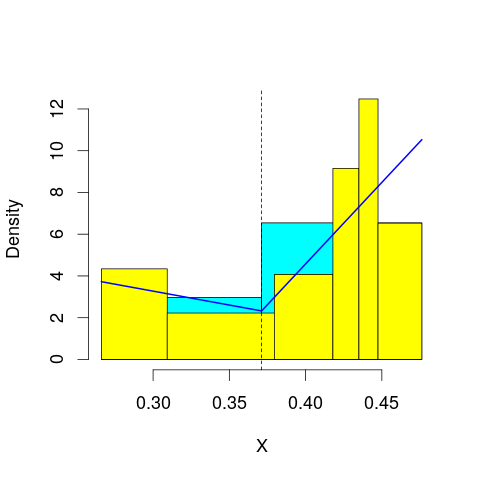

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.61655
mop.approx: Iteration 11. LL = 53.67749
mop.approx: Iteration 21. LL = 53.7849
mop.approx: Iteration 31. LL = 53.81503
mop.approx: Iteration 41. LL = 53.82605
mop.approx: Iteration 51. LL = 53.83056
mop.approx: Iteration 61. LL = 53.8325
mop.approx: Iteration 71. LL = 53.83335
mop.approx: Converged. Iteration 71. LL = 53.83341
[1] "Computing the linear combination of B-splines"


46.9019349401
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.46606
mop.approx: Iteration 11. LL = 53.76039
mop.approx: Iteration 21. LL = 53.804
mop.approx: Iteration 31. LL = 53.80917
mop.approx: Iteration 41. LL = 53.81143
mop.approx: Iteration 51. LL = 53.81308
mop.approx: Iteration 61. LL = 53.81437
mop.approx: Iteration 71. LL = 53.81537
mop.approx: Iteration 81. LL = 53.81617
mop.approx: Iteration 91. LL = 53.81679
mop.approx: Converged. Iteration 92. LL = 53.8169
[1] "Computing the linear combination of B-splines"


45.1525614858
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.81023
mop.approx: Iteration 11. LL = 41.81285
mop.approx: Converged. Iteration 16. LL = 41.81695
[1] "Computing the linear combination of B-splines"


31.4197467682
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.95346
mop.approx: Iteration 11. LL = 40.33126
mop.approx: Iteration 21. LL = 40.63788
mop.approx: Iteration 31. LL = 40.69057
mop.approx: Iteration 41. LL = 40.70976
mop.approx: Iteration 51. LL = 40.71898
mop.approx: Iteration 61. LL = 40.72416
mop.approx: Iteration 71. LL = 40.72738
mop.approx: Iteration 81. LL = 40.72953
mop.approx: Iteration 91. LL = 40.73104
mop.approx: Iteration 101. LL = 40.73213
mop.approx: Iteration 111. LL = 40.73296
mop.approx: Iteration 121. LL = 40.73359
mop.approx: Iteration 131. LL = 40.73408
mop.approx: Converged. Iteration 134. LL = 40.73425
[1] "Computing the linear combination of B-splines"


28.6041748512
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.737612
mop.approx: Iteration 11. LL = 39.97567
mop.approx: Iteration 21. LL = 40.01591
mop.approx: Converged. Iteration 27. LL = 40.01675
[1] "Computing the linear combination of B-splines"


26.1538031092
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.013081
mop.approx: Iteration 11. LL = 38.91749
mop.approx: Iteration 21. LL = 39.34268
mop.approx: Iteration 31. LL = 39.43464
mop.approx: Iteration 41. LL = 39.46814
mop.approx: Iteration 51. LL = 39.48246
mop.approx: Iteration 61. LL = 39.48902
mop.approx: Iteration 71. LL = 39.49213
mop.approx: Iteration 81. LL = 39.49363
mop.approx: Iteration 91. LL = 39.49436
mop.approx: Converged. Iteration 94. LL = 39.49453
[1] "Computing the linear combination of B-splines"


23.8987159353
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.32279
mop.approx: Iteration 11. LL = 38.27064
mop.approx: Iteration 21. LL = 38.41339
mop.approx: Iteration 31. LL = 38.4294
mop.approx: Iteration 41. LL = 38.43286
mop.approx: Iteration 51. LL = 38.43377
mop.approx: Converged. Iteration 52. LL = 38.43385
[1] "Computing the linear combination of B-splines"


21.105170637
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.76775
mop.approx: Iteration 11. LL = 54.16682
mop.approx: Converged. Iteration 16. LL = 54.16822
[1] "Computing the linear combination of B-splines"


47.2367443084
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 47.236744308377453)
m reached
('Sum of Probabilities:', 0.9925767361097604)
chosen


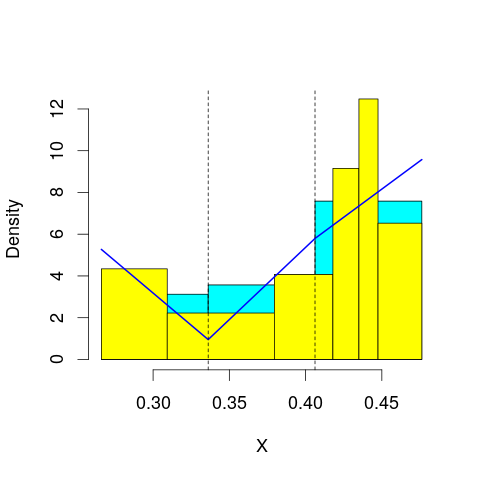

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.61655
mop.approx: Iteration 11. LL = 54.05539
mop.approx: Converged. Iteration 14. LL = 54.05598
[1] "Computing the linear combination of B-splines"


45.3916406261
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.46606
mop.approx: Iteration 11. LL = 53.85649
mop.approx: Iteration 21. LL = 53.85924
mop.approx: Iteration 31. LL = 53.86034
mop.approx: Iteration 41. LL = 53.86101
mop.approx: Converged. Iteration 41. LL = 53.86107
[1] "Computing the linear combination of B-splines"


43.4638577399
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.81023
mop.approx: Iteration 11. LL = 41.77679
mop.approx: Converged. Iteration 19. LL = 41.77799
[1] "Computing the linear combination of B-splines"


29.6479158583
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.95346
mop.approx: Iteration 11. LL = 42.94886
mop.approx: Iteration 21. LL = 43.02094
mop.approx: Converged. Iteration 28. LL = 43.02218
[1] "Computing the linear combination of B-splines"


29.1592394681
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.737612
mop.approx: Iteration 11. LL = 40.86245
mop.approx: Iteration 21. LL = 41.13187
mop.approx: Iteration 31. LL = 41.16297
mop.approx: Iteration 41. LL = 41.16563
mop.approx: Converged. Iteration 42. LL = 41.16572
[1] "Computing the linear combination of B-splines"


25.5699097496
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.013081
mop.approx: Iteration 11. LL = 41.53385
mop.approx: Iteration 21. LL = 41.60239
mop.approx: Converged. Iteration 24. LL = 41.60271
[1] "Computing the linear combination of B-splines"


24.2740347173
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.32279
mop.approx: Iteration 11. LL = 39.90845
mop.approx: Iteration 21. LL = 40.24349
mop.approx: Iteration 31. LL = 40.28294
mop.approx: Iteration 41. LL = 40.29259
mop.approx: Iteration 51. LL = 40.29579
mop.approx: Iteration 61. LL = 40.29701
mop.approx: Converged. Iteration 68. LL = 40.29744
[1] "Computing the linear combination of B-splines"


21.235888118
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.76775
mop.approx: Iteration 11. LL = 54.24193
mop.approx: Converged. Iteration 13. LL = 54.2422
[1] "Computing the linear combination of B-splines"


45.5778590774
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 45.577859077375329)
m reached
('Sum of Probabilities:', 0.9925764211548156)
chosen


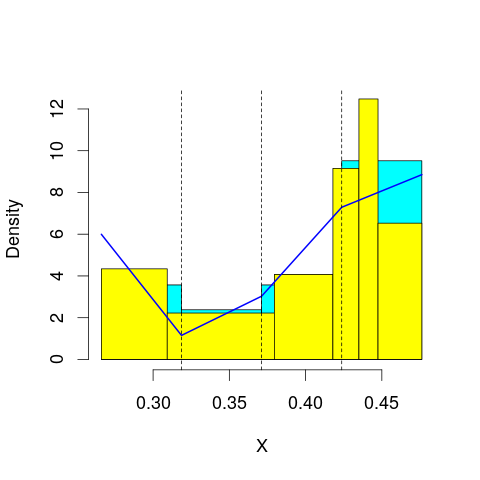

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.61655
mop.approx: Iteration 11. LL = 54.16371
mop.approx: Converged. Iteration 20. LL = 54.16559
[1] "Computing the linear combination of B-splines"


43.7683835234
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.46606
mop.approx: Iteration 11. LL = 53.83426
mop.approx: Iteration 21. LL = 53.83572
mop.approx: Converged. Iteration 23. LL = 53.83589
[1] "Computing the linear combination of B-splines"


41.7058122728
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.81023
mop.approx: Iteration 11. LL = 42.81495
mop.approx: Iteration 21. LL = 42.95332
mop.approx: Iteration 31. LL = 42.98891
mop.approx: Iteration 41. LL = 43.0018
mop.approx: Iteration 51. LL = 43.00764
mop.approx: Iteration 61. LL = 43.01071
mop.approx: Iteration 71. LL = 43.01252
mop.approx: Iteration 81. LL = 43.01366
mop.approx: Iteration 91. LL = 43.01443
mop.approx: Iteration 101. LL = 43.01496
mop.approx: Converged. Iteration 103. LL = 43.01509
[1] "Computing the linear combination of B-splines"


29.1521510513
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.95346
mop.approx: Iteration 11. LL = 44.04578
mop.approx: Iteration 21. LL = 44.11362
mop.approx: Iteration 31. LL = 44.12134
mop.approx: Iteration 41. LL = 44.12267
mop.approx: Converged. Iteration 42. LL = 44.12276
[1] "Computing the linear combination of B-splines"


28.5269522553
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.737612
mop.approx: Iteration 11. LL = 42.60343
mop.approx: Iteration 21. LL = 42.85599
mop.approx: Iteration 31. LL = 42.8836
mop.approx: Iteration 41. LL = 42.88713
mop.approx: Converged. Iteration 48. LL = 42.8877
[1] "Computing the linear combination of B-splines"


25.5590217279
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.013081
mop.approx: Iteration 11. LL = 41.58171
mop.approx: Iteration 21. LL = 41.6099
mop.approx: Iteration 31. LL = 41.61796
mop.approx: Iteration 41. LL = 41.62056
mop.approx: Iteration 51. LL = 41.62144
mop.approx: Converged. Iteration 53. LL = 41.62157
[1] "Computing the linear combination of B-splines"


22.5600255832
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.32279
mop.approx: Iteration 11. LL = 42.21557
mop.approx: Iteration 21. LL = 42.41363
mop.approx: Iteration 31. LL = 42.41924
mop.approx: Converged. Iteration 33. LL = 42.41939
[1] "Computing the linear combination of B-splines"


21.6249754584
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.76775
mop.approx: Converged. Iteration 9. LL = 54.47329
[1] "Computing the linear combination of B-splines"


44.0760857955
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 44.07608579550601)
m reached
('Sum of Probabilities:', 0.9935011420455586)
chosen


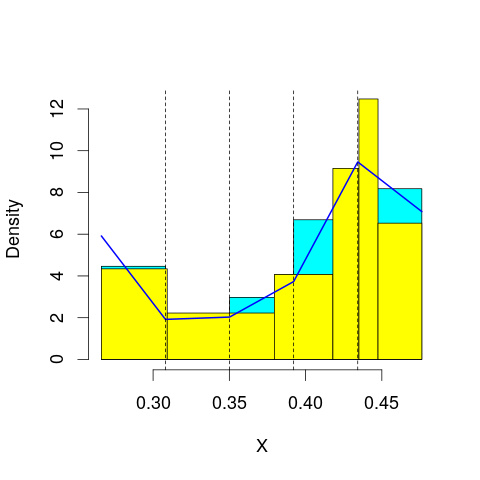

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.61655
mop.approx: Iteration 11. LL = 54.1074
mop.approx: Iteration 21. LL = 54.11294
mop.approx: Converged. Iteration 26. LL = 54.11344
[1] "Computing the linear combination of B-splines"


41.9833692423
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.46606
mop.approx: Iteration 11. LL = 53.98019
mop.approx: Iteration 21. LL = 54.02201
mop.approx: Iteration 31. LL = 54.0392
mop.approx: Iteration 41. LL = 54.04738
mop.approx: Iteration 51. LL = 54.05158
mop.approx: Iteration 61. LL = 54.05386
mop.approx: Iteration 71. LL = 54.05513
mop.approx: Iteration 81. LL = 54.05587
mop.approx: Converged. Iteration 82. LL = 54.05597
[1] "Computing the linear combination of B-splines"


40.1930286532
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.81023
mop.approx: Iteration 11. LL = 46.14288
mop.approx: Iteration 21. LL = 46.50857
mop.approx: Iteration 31. LL = 46.54942
mop.approx: Iteration 41. LL = 46.55411
mop.approx: Converged. Iteration 46. LL = 46.55457
[1] "Computing the linear combination of B-splines"


30.9587618432
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.95346
mop.approx: Iteration 11. LL = 44.33065
mop.approx: Iteration 21. LL = 44.40327
mop.approx: Iteration 31. LL = 44.42657
mop.approx: Iteration 41. LL = 44.4366
mop.approx: Iteration 51. LL = 44.44176
mop.approx: Iteration 61. LL = 44.4447
mop.approx: Iteration 71. LL = 44.4465
mop.approx: Iteration 81. LL = 44.44766
mop.approx: Iteration 91. LL = 44.44842
mop.approx: Converged. Iteration 100. LL = 44.44894
[1] "Computing the linear combination of B-splines"


27.1202555887
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.737612
mop.approx: Iteration 11. LL = 45.5449
mop.approx: Iteration 21. LL = 45.83128
mop.approx: Iteration 31. LL = 45.87511
mop.approx: Iteration 41. LL = 45.88981
mop.approx: Iteration 51. LL = 45.89605
mop.approx: Iteration 61. LL = 45.89895
mop.approx: Iteration 71. LL = 45.90035
mop.approx: Iteration 81. LL = 45.90104
mop.approx: Converged. Iteration 82. LL = 45.90113
[1] "Computing the linear combination of B-splines"


26.839585887
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.013081
mop.approx: Iteration 11. LL = 42.35617
mop.approx: Iteration 21. LL = 42.60737
mop.approx: Iteration 31. LL = 42.71929
mop.approx: Iteration 41. LL = 42.77603
mop.approx: Iteration 51. LL = 42.80709
mop.approx: Iteration 61. LL = 42.82499
mop.approx: Iteration 71. LL = 42.83566
mop.approx: Iteration 81. LL = 42.84217
mop.approx: Iteration 91. LL = 42.84621
mop.approx: Iteration 101. LL = 42.84876
mop.approx: Iteration 111. LL = 42.85039
mop.approx: Iteration 121. LL = 42.85146
mop.approx: Iteration 131. LL = 42.85218
mop.approx: Converged. Iteration 140. LL = 42.85268
[1] "Computing the linear combination of B-splines"


22.0582609941
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.32279
mop.approx: Iteration 11. LL = 42.77446
mop.approx: Iteration 21. LL = 42.84304
mop.approx: Iteration 31. LL = 42.85687
mop.approx: Iteration 41. LL = 42.86103
mop.approx: Iteration 51. LL = 42.86241
mop.approx: Converged. Iteration 57. LL = 42.8628
[1] "Computing the linear combination of B-splines"


20.3355175779
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.76775
mop.approx: Iteration 11. LL = 54.55588
mop.approx: Converged. Iteration 13. LL = 54.55608
[1] "Computing the linear combination of B-splines"


42.4260076135
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 42.426007613450935)
m reached
('Sum of Probabilities:', 0.9936621672008841)
chosen


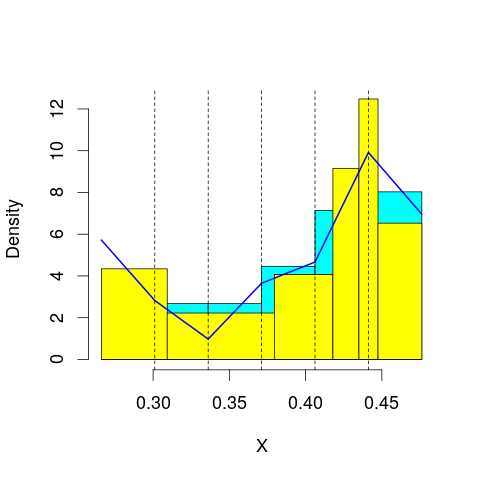

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.61655
mop.approx: Iteration 11. LL = 54.12835
mop.approx: Iteration 21. LL = 54.13513
mop.approx: Converged. Iteration 29. LL = 54.13614
[1] "Computing the linear combination of B-splines"


40.2732011865
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.46606
mop.approx: Iteration 11. LL = 54.38832
mop.approx: Iteration 21. LL = 54.50801
mop.approx: Iteration 31. LL = 54.54873
mop.approx: Iteration 41. LL = 54.56664
mop.approx: Iteration 51. LL = 54.57587
mop.approx: Iteration 61. LL = 54.58119
mop.approx: Iteration 71. LL = 54.58451
mop.approx: Iteration 81. LL = 54.58671
mop.approx: Iteration 91. LL = 54.58824
mop.approx: Iteration 101. LL = 54.58935
mop.approx: Iteration 111. LL = 54.59016
mop.approx: Iteration 121. LL = 54.59079
mop.approx: Converged. Iteration 121. LL = 54.59084
[1] "Computing the linear combination of B-splines"


38.9950274462
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.81023
mop.approx: Iteration 11. LL = 47.64003
mop.approx: Iteration 21. LL = 47.77772
mop.approx: Iteration 31. LL = 47.79566
mop.approx: Iteration 41. LL = 47.80033
mop.approx: Iteration 51. LL = 47.80168
mop.approx: Converged. Iteration 54. LL = 47.80189
[1] "Computing the linear combination of B-splines"


30.4732128397
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.95346
mop.approx: Iteration 11. LL = 45.25373
mop.approx: Iteration 21. LL = 45.38288
mop.approx: Iteration 31. LL = 45.41292
mop.approx: Iteration 41. LL = 45.42115
mop.approx: Iteration 51. LL = 45.42349
mop.approx: Converged. Iteration 59. LL = 45.42413
[1] "Computing the linear combination of B-splines"


26.3625797323
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.737612
mop.approx: Iteration 11. LL = 45.95739
mop.approx: Iteration 21. LL = 46.00712
mop.approx: Iteration 31. LL = 46.02035
mop.approx: Iteration 41. LL = 46.02691
mop.approx: Iteration 51. LL = 46.03059
mop.approx: Iteration 61. LL = 46.03284
mop.approx: Iteration 71. LL = 46.03429
mop.approx: Iteration 81. LL = 46.03528
mop.approx: Iteration 91. LL = 46.03596
mop.approx: Converged. Iteration 98. LL = 46.03636
[1] "Computing the linear combination of B-splines"


25.241946115
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.013081
mop.approx: Iteration 11. LL = 45.70496
mop.approx: Iteration 21. LL = 46.25893
mop.approx: Iteration 31. LL = 46.34056
mop.approx: Iteration 41. LL = 46.3571
mop.approx: Iteration 51. LL = 46.36119
mop.approx: Iteration 61. LL = 46.36234
mop.approx: Converged. Iteration 63. LL = 46.36249
[1] "Computing the linear combination of B-splines"


23.8352030311
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.32279
mop.approx: Iteration 11. LL = 43.13333
mop.approx: Iteration 21. LL = 43.2776
mop.approx: Iteration 31. LL = 43.33643
mop.approx: Iteration 41. LL = 43.36261
mop.approx: Iteration 51. LL = 43.37486
mop.approx: Iteration 61. LL = 43.38078
mop.approx: Iteration 71. LL = 43.38369
mop.approx: Iteration 81. LL = 43.38513
mop.approx: Iteration 91. LL = 43.38585
mop.approx: Converged. Iteration 93. LL = 43.38598
[1] "Computing the linear combination of B-splines"


19.1258304113
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.76775
mop.approx: Iteration 11. LL = 54.61309
mop.approx: Converged. Iteration 16. LL = 54.61408
[1] "Computing the linear combination of B-splines"


40.7511319493
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 40.751131949339339)
m reached
('Sum of Probabilities:', 0.9932907908130074)
chosen


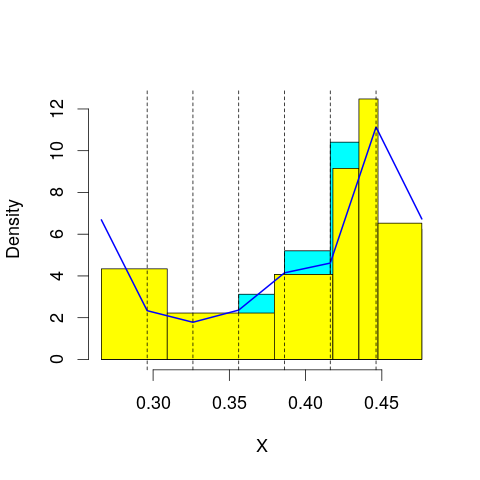

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.61655
mop.approx: Iteration 11. LL = 54.63856
mop.approx: Iteration 21. LL = 54.68135
mop.approx: Iteration 31. LL = 54.68865
mop.approx: Iteration 41. LL = 54.69033
mop.approx: Converged. Iteration 44. LL = 54.69058
[1] "Computing the linear combination of B-splines"


39.0947657673
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.46606
mop.approx: Iteration 11. LL = 54.54617
mop.approx: Iteration 21. LL = 54.63912
mop.approx: Iteration 31. LL = 54.66474
mop.approx: Iteration 41. LL = 54.67442
mop.approx: Iteration 51. LL = 54.6788
mop.approx: Iteration 61. LL = 54.68098
mop.approx: Iteration 71. LL = 54.68214
mop.approx: Converged. Iteration 78. LL = 54.68267
[1] "Computing the linear combination of B-splines"


37.3539868885
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.81023
mop.approx: Iteration 11. LL = 48.82687
mop.approx: Iteration 21. LL = 49.0099
mop.approx: Iteration 31. LL = 49.03331
mop.approx: Iteration 41. LL = 49.03702
mop.approx: Converged. Iteration 47. LL = 49.03754
[1] "Computing the linear combination of B-splines"


29.9759954086
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.95346
mop.approx: Iteration 11. LL = 46.38017
mop.approx: Iteration 21. LL = 46.5748
mop.approx: Iteration 31. LL = 46.63468
mop.approx: Iteration 41. LL = 46.66096
mop.approx: Iteration 51. LL = 46.6735
mop.approx: Iteration 61. LL = 46.6797
mop.approx: Iteration 71. LL = 46.6829
mop.approx: Iteration 81. LL = 46.68462
mop.approx: Iteration 91. LL = 46.6856
mop.approx: Iteration 101. LL = 46.6862
mop.approx: Converged. Iteration 102. LL = 46.68629
[1] "Computing the linear combination of B-splines"


25.8918773461
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.737612
mop.approx: Iteration 11. LL = 46.06648
mop.approx: Iteration 21. LL = 46.07587
mop.approx: Converged. Iteration 25. LL = 46.07621
[1] "Computing the linear combination of B-splines"


23.5489279223
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.013081
mop.approx: Iteration 11. LL = 46.7981
mop.approx: Iteration 21. LL = 46.96531
mop.approx: Iteration 31. LL = 46.97421
mop.approx: Iteration 41. LL = 46.97707
mop.approx: Iteration 51. LL = 46.97884
mop.approx: Iteration 61. LL = 46.98005
mop.approx: Iteration 71. LL = 46.9809
mop.approx: Iteration 81. LL = 46.98154
mop.approx: Converged. Iteration 86. LL = 46.98184
[1] "Computing the linear combination of B-splines"


22.7216853605
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.32279
mop.approx: Iteration 11. LL = 45.28843
mop.approx: Iteration 21. LL = 45.79461
mop.approx: Iteration 31. LL = 45.89807
mop.approx: Iteration 41. LL = 45.92224
mop.approx: Iteration 51. LL = 45.92938
mop.approx: Iteration 61. LL = 45.93185
mop.approx: Iteration 71. LL = 45.93275
mop.approx: Converged. Iteration 72. LL = 45.93284
[1] "Computing the linear combination of B-splines"


19.9398230834
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.76775
mop.approx: Converged. Iteration 9. LL = 54.37439
[1] "Computing the linear combination of B-splines"


38.7785747877
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 38.778574787707946)
m reached
('Sum of Probabilities:', 0.9925073017550564)
chosen


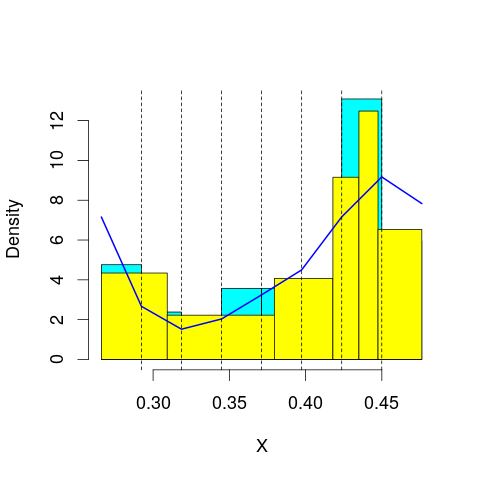

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.61655
mop.approx: Iteration 11. LL = 55.26942
mop.approx: Iteration 21. LL = 55.33185
mop.approx: Iteration 31. LL = 55.34711
mop.approx: Iteration 41. LL = 55.35311
mop.approx: Iteration 51. LL = 55.35601
mop.approx: Iteration 61. LL = 55.35757
mop.approx: Iteration 71. LL = 55.35846
mop.approx: Converged. Iteration 75. LL = 55.35875
[1] "Computing the linear combination of B-splines"


38.030073429
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.46606
mop.approx: Iteration 11. LL = 54.42779
mop.approx: Iteration 21. LL = 54.48036
mop.approx: Iteration 31. LL = 54.49859
mop.approx: Iteration 41. LL = 54.50718
mop.approx: Iteration 51. LL = 54.51167
mop.approx: Iteration 61. LL = 54.51416
mop.approx: Iteration 71. LL = 54.51561
mop.approx: Iteration 81. LL = 54.51647
mop.approx: Converged. Iteration 85. LL = 54.51677
[1] "Computing the linear combination of B-splines"


35.4552221309
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.81023
mop.approx: Iteration 11. LL = 49.3579
mop.approx: Iteration 21. LL = 49.41969
mop.approx: Iteration 31. LL = 49.42555
mop.approx: Converged. Iteration 39. LL = 49.42651
[1] "Computing the linear combination of B-splines"


28.6320946269
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.95346
mop.approx: Iteration 11. LL = 47.83911
mop.approx: Iteration 21. LL = 48.20304
mop.approx: Iteration 31. LL = 48.2772
mop.approx: Iteration 41. LL = 48.29474
mop.approx: Iteration 51. LL = 48.2994
mop.approx: Iteration 61. LL = 48.30074
mop.approx: Converged. Iteration 64. LL = 48.30097
[1] "Computing the linear combination of B-splines"


25.773683668
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.737612
mop.approx: Iteration 11. LL = 46.38461
mop.approx: Iteration 21. LL = 46.48022
mop.approx: Iteration 31. LL = 46.52632
mop.approx: Iteration 41. LL = 46.54859
mop.approx: Iteration 51. LL = 46.55933
mop.approx: Iteration 61. LL = 46.56449
mop.approx: Iteration 71. LL = 46.56695
mop.approx: Iteration 81. LL = 46.56812
mop.approx: Converged. Iteration 88. LL = 46.56859
[1] "Computing the linear combination of B-splines"


22.3084347298
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.013081
mop.approx: Iteration 11. LL = 47.07573
mop.approx: Iteration 21. LL = 47.17689
mop.approx: Iteration 31. LL = 47.20951
mop.approx: Iteration 41. LL = 47.2252
mop.approx: Iteration 51. LL = 47.23287
mop.approx: Iteration 61. LL = 47.23666
mop.approx: Iteration 71. LL = 47.23856
mop.approx: Iteration 81. LL = 47.23952
mop.approx: Converged. Iteration 86. LL = 47.23985
[1] "Computing the linear combination of B-splines"


21.2468299365
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.32279
mop.approx: Iteration 11. LL = 46.66352
mop.approx: Iteration 21. LL = 47.08368
mop.approx: Iteration 31. LL = 47.14747
mop.approx: Iteration 41. LL = 47.16477
mop.approx: Iteration 51. LL = 47.17065
mop.approx: Iteration 61. LL = 47.17277
mop.approx: Iteration 71. LL = 47.17356
mop.approx: Converged. Iteration 71. LL = 47.1736
[1] "Computing the linear combination of B-splines"


19.4477140064
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.76775
mop.approx: Iteration 11. LL = 55.53648
mop.approx: Iteration 21. LL = 55.57824
mop.approx: Iteration 31. LL = 55.58722
mop.approx: Iteration 41. LL = 55.59005
mop.approx: Iteration 51. LL = 55.5911
mop.approx: Converged. Iteration 52. LL = 55.59122
[1] "Computing the linear combination of B-splines"


38.2625396264
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 38.262539626448046)
m reached
('Sum of Probabilities:', 0.990337173805153)
chosen


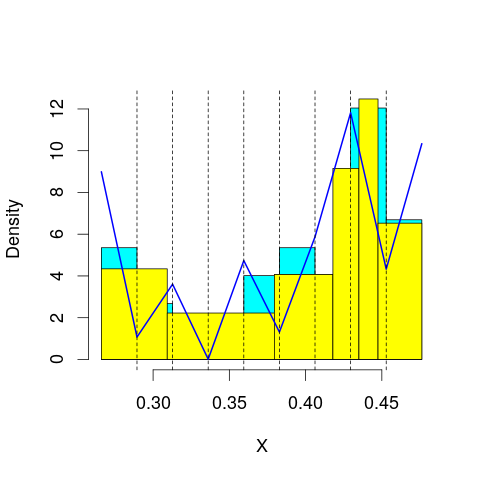

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.61655
mop.approx: Iteration 11. LL = 55.69195
mop.approx: Iteration 21. LL = 55.81975
mop.approx: Iteration 31. LL = 55.85067
mop.approx: Iteration 41. LL = 55.86082
mop.approx: Iteration 51. LL = 55.86487
mop.approx: Iteration 61. LL = 55.86679
mop.approx: Iteration 71. LL = 55.86786
mop.approx: Converged. Iteration 80. LL = 55.86852
[1] "Computing the linear combination of B-splines"


36.8069696338
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.46606
mop.approx: Iteration 11. LL = 54.39139
mop.approx: Iteration 21. LL = 54.41222
mop.approx: Iteration 31. LL = 54.42312
mop.approx: Iteration 41. LL = 54.43004
mop.approx: Iteration 51. LL = 54.43442
mop.approx: Iteration 61. LL = 54.43713
mop.approx: Iteration 71. LL = 54.43877
mop.approx: Iteration 81. LL = 54.43974
mop.approx: Converged. Iteration 86. LL = 54.44011
[1] "Computing the linear combination of B-splines"


33.6456921856
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.81023
mop.approx: Iteration 11. LL = 49.53054
mop.approx: Iteration 21. LL = 49.55496
mop.approx: Iteration 31. LL = 49.56156
mop.approx: Iteration 41. LL = 49.56454
mop.approx: Iteration 51. LL = 49.56599
mop.approx: Iteration 61. LL = 49.5667
mop.approx: Converged. Iteration 61. LL = 49.56675
[1] "Computing the linear combination of B-splines"


27.0394696381
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.95346
mop.approx: Iteration 11. LL = 48.86383
mop.approx: Iteration 21. LL = 49.06459
mop.approx: Iteration 31. LL = 49.09346
mop.approx: Iteration 41. LL = 49.10364
mop.approx: Iteration 51. LL = 49.10861
mop.approx: Iteration 61. LL = 49.11138
mop.approx: Iteration 71. LL = 49.11306
mop.approx: Iteration 81. LL = 49.11414
mop.approx: Iteration 91. LL = 49.11487
mop.approx: Converged. Iteration 97. LL = 49.11524
[1] "Computing the linear combination of B-splines"


24.8550931678
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.737612
mop.approx: Iteration 11. LL = 47.15926
mop.approx: Iteration 21. LL = 47.34521
mop.approx: Iteration 31. LL = 47.38863
mop.approx: Iteration 41. LL = 47.40059
mop.approx: Iteration 51. LL = 47.40476
mop.approx: Iteration 61. LL = 47.40671
mop.approx: Iteration 71. LL = 47.40784
mop.approx: Iteration 81. LL = 47.40859
mop.approx: Converged. Iteration 89. LL = 47.40908
[1] "Computing the linear combination of B-splines"


21.4160559782
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.013081
mop.approx: Iteration 11. LL = 47.26684
mop.approx: Iteration 21. LL = 47.35962
mop.approx: Iteration 31. LL = 47.3949
mop.approx: Iteration 41. LL = 47.41291
mop.approx: Iteration 51. LL = 47.42265
mop.approx: Iteration 61. LL = 47.42816
mop.approx: Iteration 71. LL = 47.43145
mop.approx: Iteration 81. LL = 47.43354
mop.approx: Iteration 91. LL = 47.43496
mop.approx: Iteration 101. LL = 47.43596
mop.approx: Iteration 111. LL = 47.43671
mop.approx: Iteration 121. LL = 47.43728
mop.approx: Converged. Iteration 123. LL = 47.43742
[1] "Computing the linear combination of B-splines"


19.7115333824
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.32279
mop.approx: Iteration 11. LL = 47.42571
mop.approx: Iteration 21. LL = 47.77993
mop.approx: Iteration 31. LL = 47.86984
mop.approx: Iteration 41. LL = 47.89961
mop.approx: Iteration 51. LL = 47.91104
mop.approx: Iteration 61. LL = 47.9163
mop.approx: Iteration 71. LL = 47.91918
mop.approx: Iteration 81. LL = 47.92098
mop.approx: Iteration 91. LL = 47.9222
mop.approx: Iteration 101. LL = 47.92308
mop.approx: Iteration 111. LL = 47.92373
mop.approx: Converged. Iteration 117. LL = 47.92409
[1] "Computing the linear combination of B-splines"


18.4653318693
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.76775
mop.approx: Iteration 11. LL = 56.76572
mop.approx: Iteration 21. LL = 56.80886
mop.approx: Iteration 31. LL = 56.81688
mop.approx: Iteration 41. LL = 56.81972
mop.approx: Iteration 51. LL = 56.82106
mop.approx: Iteration 61. LL = 56.8218
mop.approx: Converged. Iteration 61. LL = 56.82186
[1] "Computing the linear combination of B-splines"


37.7603122807
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 37.760312280738233)
m reached
('Sum of Probabilities:', 0.9887154895531012)
chosen


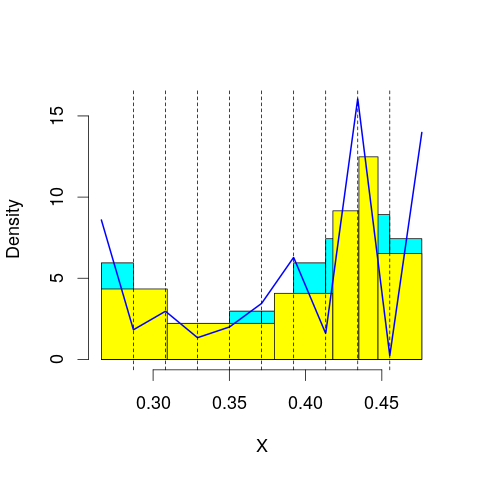

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.61655
mop.approx: Iteration 11. LL = 55.46483
mop.approx: Iteration 21. LL = 55.59321
mop.approx: Iteration 31. LL = 55.62554
mop.approx: Iteration 41. LL = 55.63656
mop.approx: Iteration 51. LL = 55.64101
mop.approx: Iteration 61. LL = 55.64307
mop.approx: Iteration 71. LL = 55.64416
mop.approx: Converged. Iteration 78. LL = 55.64469
[1] "Computing the linear combination of B-splines"


34.850273982
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.46606
mop.approx: Iteration 11. LL = 54.88274
mop.approx: Iteration 21. LL = 55.00864
mop.approx: Iteration 31. LL = 55.06296
mop.approx: Iteration 41. LL = 55.09087
mop.approx: Iteration 51. LL = 55.10701
mop.approx: Iteration 61. LL = 55.11712
mop.approx: Iteration 71. LL = 55.12381
mop.approx: Iteration 81. LL = 55.1284
mop.approx: Iteration 91. LL = 55.13166
mop.approx: Iteration 101. LL = 55.13402
mop.approx: Iteration 111. LL = 55.13577
mop.approx: Iteration 121. LL = 55.13708
mop.approx: Iteration 131. LL = 55.13809
mop.approx: Iteration 141. LL = 55.13887
mop.approx: Converged. Iteration 150. LL = 55.13948
[1] "Computing the linear combination of B-splines"


32.6121964841
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.81023
mop.approx: Iteration 11. LL = 49.57649
mop.approx: Iteration 21. LL = 49.59076
mop.approx: Iteration 31. LL = 49.59529
mop.approx: Iteration 41. LL = 49.59761
mop.approx: Iteration 51. LL = 49.59906
mop.approx: Iteration 61. LL = 49.60007
mop.approx: Iteration 71. LL = 49.60079
mop.approx: Converged. Iteration 79. LL = 49.60128
[1] "Computing the linear combination of B-splines"


25.3411333492
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.95346
mop.approx: Iteration 11. LL = 49.59856
mop.approx: Iteration 21. LL = 49.7718
mop.approx: Iteration 31. LL = 49.80906
mop.approx: Iteration 41. LL = 49.82403
mop.approx: Iteration 51. LL = 49.83179
mop.approx: Iteration 61. LL = 49.83642
mop.approx: Iteration 71. LL = 49.83943
mop.approx: Iteration 81. LL = 49.8415
mop.approx: Iteration 91. LL = 49.84299
mop.approx: Iteration 101. LL = 49.84409
mop.approx: Iteration 111. LL = 49.84492
mop.approx: Iteration 121. LL = 49.84557
mop.approx: Converged. Iteration 127. LL = 49.84594
[1] "Computing the linear combination of B-splines"


23.8529176367
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.737612
mop.approx: Iteration 11. LL = 47.97562
mop.approx: Iteration 21. LL = 48.17397
mop.approx: Iteration 31. LL = 48.22218
mop.approx: Iteration 41. LL = 48.23997
mop.approx: Iteration 51. LL = 48.24779
mop.approx: Iteration 61. LL = 48.25145
mop.approx: Iteration 71. LL = 48.25321
mop.approx: Iteration 81. LL = 48.25407
mop.approx: Converged. Iteration 84. LL = 48.25427
[1] "Computing the linear combination of B-splines"


20.5283831063
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.013081
mop.approx: Iteration 11. LL = 47.55708
mop.approx: Iteration 21. LL = 47.66683
mop.approx: Iteration 31. LL = 47.70015
mop.approx: Iteration 41. LL = 47.7119
mop.approx: Iteration 51. LL = 47.71626
mop.approx: Iteration 61. LL = 47.71795
mop.approx: Converged. Iteration 70. LL = 47.71862
[1] "Computing the linear combination of B-splines"


18.2598673661
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.32279
mop.approx: Iteration 11. LL = 47.9486
mop.approx: Iteration 21. LL = 48.15477
mop.approx: Iteration 31. LL = 48.17734
mop.approx: Iteration 41. LL = 48.18126
mop.approx: Converged. Iteration 50. LL = 48.18214
[1] "Computing the linear combination of B-splines"


16.9905169647
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.76775
mop.approx: Iteration 11. LL = 59.05552
mop.approx: Iteration 21. LL = 59.12693
mop.approx: Iteration 31. LL = 59.13909
mop.approx: Iteration 41. LL = 59.14328
mop.approx: Iteration 51. LL = 59.1451
mop.approx: Iteration 61. LL = 59.14599
mop.approx: Converged. Iteration 62. LL = 59.14612
[1] "Computing the linear combination of B-splines"


38.3516999112
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 38.351699911159891)
m reached
('Sum of Probabilities:', 0.9884325183419538)
chosen


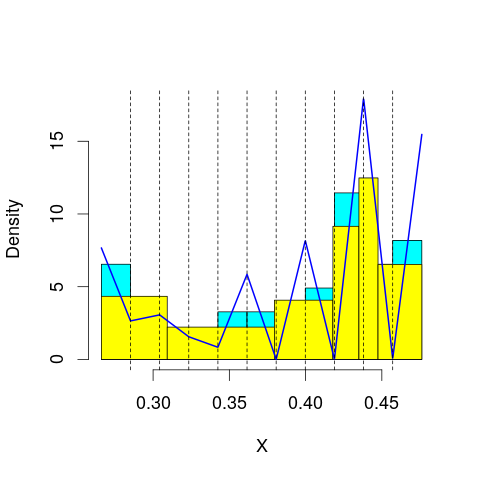

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.61655
mop.approx: Iteration 11. LL = 54.82687
mop.approx: Iteration 21. LL = 54.84713
mop.approx: Iteration 31. LL = 54.85448
mop.approx: Iteration 41. LL = 54.85876
mop.approx: Iteration 51. LL = 54.86163
mop.approx: Iteration 61. LL = 54.86365
mop.approx: Iteration 71. LL = 54.86513
mop.approx: Iteration 81. LL = 54.86622
mop.approx: Iteration 91. LL = 54.86704
mop.approx: Iteration 101. LL = 54.86767
mop.approx: Converged. Iteration 101. LL = 54.86772
[1] "Computing the linear combination of B-splines"


32.3404358189
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.46606
mop.approx: Iteration 11. LL = 56.22492
mop.approx: Iteration 21. LL = 56.5264
mop.approx: Iteration 31. LL = 56.57934
mop.approx: Iteration 41. LL = 56.5925
mop.approx: Iteration 51. LL = 56.59698
mop.approx: Iteration 61. LL = 56.59884
mop.approx: Iteration 71. LL = 56.59973
mop.approx: Converged. Iteration 73. LL = 56.5999
[1] "Computing the linear combination of B-splines"


32.3397518554
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.81023
mop.approx: Iteration 11. LL = 49.65851
mop.approx: Iteration 21. LL = 49.66958
mop.approx: Iteration 31. LL = 49.67336
mop.approx: Iteration 41. LL = 49.6748
mop.approx: Converged. Iteration 47. LL = 49.67524
[1] "Computing the linear combination of B-splines"


23.6822240765
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.95346
mop.approx: Iteration 11. LL = 50.20237
mop.approx: Iteration 21. LL = 50.43169
mop.approx: Iteration 31. LL = 50.50049
mop.approx: Iteration 41. LL = 50.53162
mop.approx: Iteration 51. LL = 50.54759
mop.approx: Iteration 61. LL = 50.55621
mop.approx: Iteration 71. LL = 50.561
mop.approx: Iteration 81. LL = 50.5637
mop.approx: Iteration 91. LL = 50.56523
mop.approx: Iteration 101. LL = 50.5661
mop.approx: Converged. Iteration 106. LL = 50.56644
[1] "Computing the linear combination of B-splines"


22.8405483374
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.737612
mop.approx: Iteration 11. LL = 48.68799
mop.approx: Iteration 21. LL = 48.89046
mop.approx: Iteration 31. LL = 48.94901
mop.approx: Iteration 41. LL = 48.97451
mop.approx: Iteration 51. LL = 48.98694
mop.approx: Iteration 61. LL = 48.99323
mop.approx: Iteration 71. LL = 48.99646
mop.approx: Iteration 81. LL = 48.99813
mop.approx: Iteration 91. LL = 48.999
mop.approx: Converged. Iteration 95. LL = 48.99926
[1] "Computing the linear combination of B-splines"


19.540508166
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.013081
mop.approx: Iteration 11. LL = 47.92212
mop.approx: Iteration 21. LL = 48.01654
mop.approx: Iteration 31. LL = 48.03991
mop.approx: Iteration 41. LL = 48.0496
mop.approx: Iteration 51. LL = 48.05463
mop.approx: Iteration 61. LL = 48.05752
mop.approx: Iteration 71. LL = 48.0593
mop.approx: Iteration 81. LL = 48.06045
mop.approx: Iteration 91. LL = 48.06121
mop.approx: Converged. Iteration 98. LL = 48.06163
[1] "Computing the linear combination of B-splines"


16.8700069697
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.32279
mop.approx: Iteration 11. LL = 48.25254
mop.approx: Iteration 21. LL = 48.37268
mop.approx: Iteration 31. LL = 48.39653
mop.approx: Iteration 41. LL = 48.4078
mop.approx: Iteration 51. LL = 48.41417
mop.approx: Iteration 61. LL = 48.41809
mop.approx: Iteration 71. LL = 48.42062
mop.approx: Iteration 81. LL = 48.42231
mop.approx: Iteration 91. LL = 48.42345
mop.approx: Iteration 101. LL = 48.42424
mop.approx: Converged. Iteration 109. LL = 48.42474
[1] "Computing the linear combination of B-splines"


15.5002402087
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.76775
mop.approx: Iteration 11. LL = 56.96542
mop.approx: Iteration 21. LL = 57.00743
mop.approx: Iteration 31. LL = 57.0173
mop.approx: Iteration 41. LL = 57.02158
mop.approx: Iteration 51. LL = 57.02387
mop.approx: Iteration 61. LL = 57.02523
mop.approx: Iteration 71. LL = 57.0261
mop.approx: Converged. Iteration 76. LL = 57.02647
[1] "Computing the linear combination of B-splines"


34.4991869859
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 34.499186985927437)
m reached
('Sum of Probabilities:', 0.9893743531849447)
chosen


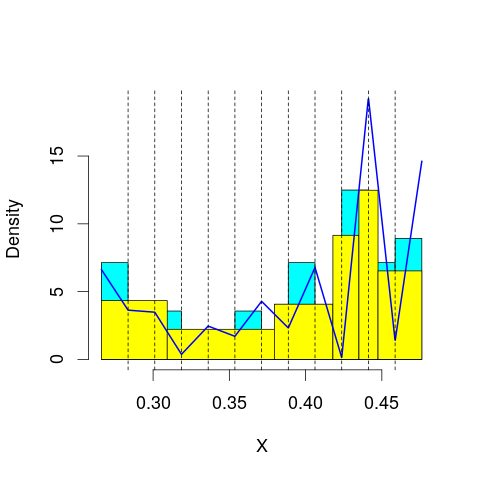

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.61655
mop.approx: Iteration 11. LL = 56.88503
mop.approx: Iteration 21. LL = 57.00297
mop.approx: Iteration 31. LL = 57.02872
mop.approx: Iteration 41. LL = 57.03788
mop.approx: Iteration 51. LL = 57.04157
mop.approx: Iteration 61. LL = 57.04312
mop.approx: Converged. Iteration 68. LL = 57.0437
[1] "Computing the linear combination of B-splines"


32.7835448148
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.46606
mop.approx: Iteration 11. LL = 55.97823
mop.approx: Iteration 21. LL = 56.18236
mop.approx: Iteration 31. LL = 56.21462
mop.approx: Iteration 41. LL = 56.22197
mop.approx: Iteration 51. LL = 56.22386
mop.approx: Converged. Iteration 55. LL = 56.2242
[1] "Computing the linear combination of B-splines"


30.2311788457
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.81023
mop.approx: Iteration 11. LL = 50.5812
mop.approx: Iteration 21. LL = 50.7729
mop.approx: Iteration 31. LL = 50.81656
mop.approx: Iteration 41. LL = 50.82749
mop.approx: Iteration 51. LL = 50.83069
mop.approx: Iteration 61. LL = 50.83185
mop.approx: Converged. Iteration 66. LL = 50.83221
[1] "Computing the linear combination of B-splines"


23.1063265337
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.95346
mop.approx: Iteration 11. LL = 50.26201
mop.approx: Iteration 21. LL = 50.35156
mop.approx: Iteration 31. LL = 50.37049
mop.approx: Iteration 41. LL = 50.38099
mop.approx: Iteration 51. LL = 50.38792
mop.approx: Iteration 61. LL = 50.39261
mop.approx: Iteration 71. LL = 50.39578
mop.approx: Iteration 81. LL = 50.39791
mop.approx: Iteration 91. LL = 50.39933
mop.approx: Iteration 101. LL = 50.40028
mop.approx: Iteration 111. LL = 50.40093
mop.approx: Converged. Iteration 113. LL = 50.40108
[1] "Computing the linear combination of B-splines"


20.9423271136
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.737612
mop.approx: Iteration 11. LL = 49.58048
mop.approx: Iteration 21. LL = 49.92638
mop.approx: Iteration 31. LL = 50.01959
mop.approx: Iteration 41. LL = 50.05007
mop.approx: Iteration 51. LL = 50.0616
mop.approx: Iteration 61. LL = 50.06646
mop.approx: Iteration 71. LL = 50.06867
mop.approx: Iteration 81. LL = 50.06975
mop.approx: Converged. Iteration 88. LL = 50.07023
[1] "Computing the linear combination of B-splines"


18.8786032196
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.013081
mop.approx: Iteration 11. LL = 48.27205
mop.approx: Iteration 21. LL = 48.33885
mop.approx: Iteration 31. LL = 48.35906
mop.approx: Iteration 41. LL = 48.37087
mop.approx: Iteration 51. LL = 48.37867
mop.approx: Iteration 61. LL = 48.38391
mop.approx: Iteration 71. LL = 48.38744
mop.approx: Iteration 81. LL = 48.38981
mop.approx: Iteration 91. LL = 48.3914
mop.approx: Iteration 101. LL = 48.39246
mop.approx: Iteration 111. LL = 48.39317
mop.approx: Converged. Iteration 115. LL = 48.39343
[1] "Computing the linear combination of B-splines"


15.4689422603
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.32279
mop.approx: Iteration 11. LL = 48.43859
mop.approx: Iteration 21. LL = 48.5116
mop.approx: Iteration 31. LL = 48.52554
mop.approx: Iteration 41. LL = 48.53036
mop.approx: Iteration 51. LL = 48.53244
mop.approx: Iteration 61. LL = 48.53356
mop.approx: Iteration 71. LL = 48.53429
mop.approx: Iteration 81. LL = 48.53484
mop.approx: Converged. Iteration 82. LL = 48.53494
[1] "Computing the linear combination of B-splines"


13.8775674389
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.76775
mop.approx: Iteration 11. LL = 56.58218
mop.approx: Iteration 21. LL = 56.62278
mop.approx: Iteration 31. LL = 56.63482
mop.approx: Iteration 41. LL = 56.63938
mop.approx: Iteration 51. LL = 56.64124
mop.approx: Converged. Iteration 60. LL = 56.64204
[1] "Computing the linear combination of B-splines"


32.3818927787
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 32.381892778725287)
m reached
('Sum of Probabilities:', 0.9902906974587682)
chosen


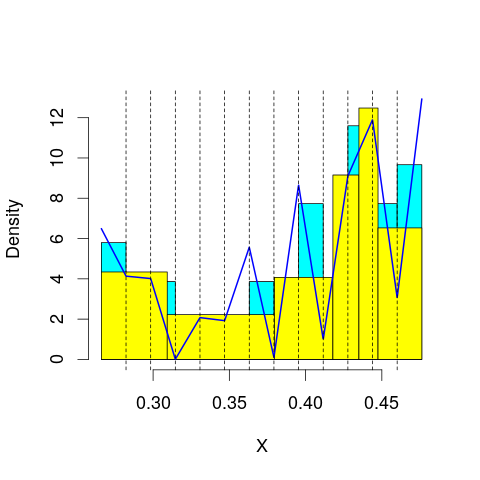

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.61655
mop.approx: Iteration 11. LL = 58.28328
mop.approx: Iteration 21. LL = 58.42101
mop.approx: Iteration 31. LL = 58.45529
mop.approx: Iteration 41. LL = 58.46685
mop.approx: Iteration 51. LL = 58.47125
mop.approx: Iteration 61. LL = 58.47308
mop.approx: Converged. Iteration 70. LL = 58.4739
[1] "Computing the linear combination of B-splines"


32.4808799417
('best: ', 32.381892778725287, 'accepted difference:', 55.049217723832989, 'cur BIC:', 32.480879941674452)
m reached
('Sum of Probabilities:', 0.9824771104979452)
chosen


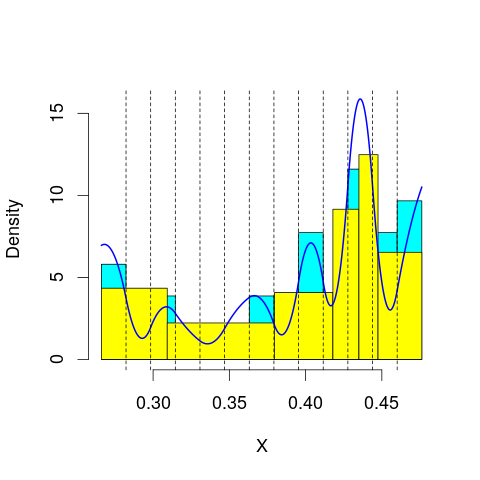

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.46606
mop.approx: Iteration 11. LL = 55.98855
mop.approx: Iteration 21. LL = 56.14814
mop.approx: Iteration 31. LL = 56.17547
mop.approx: Iteration 41. LL = 56.18499
mop.approx: Iteration 51. LL = 56.19021
mop.approx: Iteration 61. LL = 56.19364
mop.approx: Iteration 71. LL = 56.19606
mop.approx: Iteration 81. LL = 56.19783
mop.approx: Iteration 91. LL = 56.19915
mop.approx: Iteration 101. LL = 56.20015
mop.approx: Iteration 111. LL = 56.20091
mop.approx: Converged. Iteration 118. LL = 56.2014
[1] "Computing the linear combination of B-splines"


28.4755113813
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.81023
mop.approx: Iteration 11. LL = 51.17428
mop.approx: Iteration 21. LL = 51.29644
mop.approx: Iteration 31. LL = 51.31542
mop.approx: Iteration 41. LL = 51.32207
mop.approx: Iteration 51. LL = 51.32526
mop.approx: Iteration 61. LL = 51.32701
mop.approx: Iteration 71. LL = 51.32805
mop.approx: Iteration 81. LL = 51.32871
mop.approx: Converged. Iteration 82. LL = 51.32881
[1] "Computing the linear combination of B-splines"


21.870053997
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.95346
mop.approx: Iteration 11. LL = 50.59166
mop.approx: Iteration 21. LL = 50.78588
mop.approx: Iteration 31. LL = 50.85275
mop.approx: Iteration 41. LL = 50.87755
mop.approx: Iteration 51. LL = 50.88725
mop.approx: Iteration 61. LL = 50.89142
mop.approx: Iteration 71. LL = 50.89339
mop.approx: Iteration 81. LL = 50.89439
mop.approx: Converged. Iteration 87. LL = 50.89481
[1] "Computing the linear combination of B-splines"


19.7031903502
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.737612
mop.approx: Iteration 11. LL = 50.2621
mop.approx: Iteration 21. LL = 50.56645
mop.approx: Iteration 31. LL = 50.62255
mop.approx: Iteration 41. LL = 50.63893
mop.approx: Iteration 51. LL = 50.64579
mop.approx: Iteration 61. LL = 50.64947
mop.approx: Iteration 71. LL = 50.65172
mop.approx: Iteration 81. LL = 50.65321
mop.approx: Iteration 91. LL = 50.65423
mop.approx: Iteration 101. LL = 50.65496
mop.approx: Converged. Iteration 107. LL = 50.65535
[1] "Computing the linear combination of B-splines"


17.7308601544
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.013081
mop.approx: Iteration 11. LL = 48.85323
mop.approx: Iteration 21. LL = 49.04204
mop.approx: Iteration 31. LL = 49.1147
mop.approx: Iteration 41. LL = 49.14335
mop.approx: Iteration 51. LL = 49.15483
mop.approx: Iteration 61. LL = 49.15958
mop.approx: Iteration 71. LL = 49.1616
mop.approx: Iteration 81. LL = 49.16247
mop.approx: Converged. Iteration 83. LL = 49.16262
[1] "Computing the linear combination of B-splines"


14.5052689071
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.32279
mop.approx: Iteration 11. LL = 48.54549
mop.approx: Iteration 21. LL = 48.57244
mop.approx: Iteration 31. LL = 48.57627
mop.approx: Iteration 41. LL = 48.57872
mop.approx: Iteration 51. LL = 48.58071
mop.approx: Iteration 61. LL = 48.58236
mop.approx: Iteration 71. LL = 48.58372
mop.approx: Iteration 81. LL = 48.58484
mop.approx: Iteration 91. LL = 48.58576
mop.approx: Iteration 101. LL = 48.58653
mop.approx: Iteration 111. LL = 48.58716
mop.approx: Converged. Iteration 120. LL = 48.58768
[1] "Computing the linear combination of B-splines"


12.1974005845
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.76775
mop.approx: Iteration 11. LL = 58.87055
mop.approx: Iteration 21. LL = 58.88387
mop.approx: Converged. Iteration 29. LL = 58.88502
[1] "Computing the linear combination of B-splines"


32.89200221
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 32.892002210026433)
m reached
('Sum of Probabilities:', 0.9902417506100468)
chosen


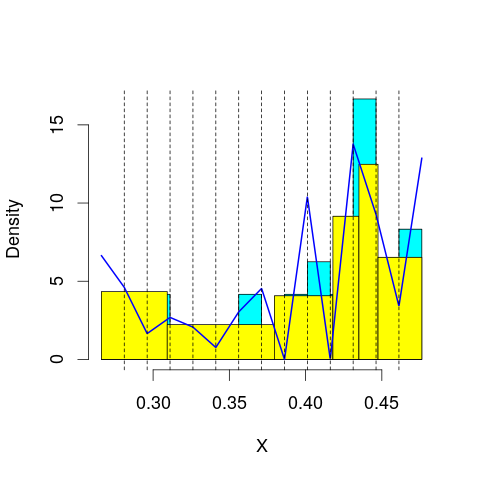

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.61655
mop.approx: Iteration 11. LL = 58.12487
mop.approx: Iteration 21. LL = 58.31279
mop.approx: Iteration 31. LL = 58.34731
mop.approx: Iteration 41. LL = 58.35846
mop.approx: Iteration 51. LL = 58.36289
mop.approx: Iteration 61. LL = 58.36489
mop.approx: Iteration 71. LL = 58.36588
mop.approx: Converged. Iteration 74. LL = 58.36612
[1] "Computing the linear combination of B-splines"


30.6402357786
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.46606
mop.approx: Iteration 11. LL = 57.04236
mop.approx: Iteration 21. LL = 57.14269
mop.approx: Iteration 31. LL = 57.15766
mop.approx: Iteration 41. LL = 57.16296
mop.approx: Iteration 51. LL = 57.16606
mop.approx: Iteration 61. LL = 57.1682
mop.approx: Iteration 71. LL = 57.16977
mop.approx: Iteration 81. LL = 57.17095
mop.approx: Iteration 91. LL = 57.17186
mop.approx: Iteration 101. LL = 57.17257
mop.approx: Converged. Iteration 106. LL = 57.17293
[1] "Computing the linear combination of B-splines"


27.7141737277
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.81023
mop.approx: Iteration 11. LL = 51.25431
mop.approx: Iteration 21. LL = 51.40677
mop.approx: Iteration 31. LL = 51.43723
mop.approx: Iteration 41. LL = 51.44814
mop.approx: Iteration 51. LL = 51.45442
mop.approx: Iteration 61. LL = 51.4587
mop.approx: Iteration 71. LL = 51.46167
mop.approx: Iteration 81. LL = 51.46371
mop.approx: Iteration 91. LL = 51.46508
mop.approx: Iteration 101. LL = 51.466
mop.approx: Converged. Iteration 109. LL = 51.46655
[1] "Computing the linear combination of B-splines"


20.2749262002
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.95346
mop.approx: Iteration 11. LL = 51.26058
mop.approx: Iteration 21. LL = 51.43584
mop.approx: Iteration 31. LL = 51.46702
mop.approx: Iteration 41. LL = 51.47696
mop.approx: Iteration 51. LL = 51.48128
mop.approx: Iteration 61. LL = 51.48351
mop.approx: Iteration 71. LL = 51.48476
mop.approx: Iteration 81. LL = 51.48551
mop.approx: Converged. Iteration 83. LL = 51.48567
[1] "Computing the linear combination of B-splines"


18.5611819587
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.737612
mop.approx: Iteration 11. LL = 50.62141
mop.approx: Iteration 21. LL = 50.89914
mop.approx: Iteration 31. LL = 50.97268
mop.approx: Iteration 41. LL = 51.00028
mop.approx: Iteration 51. LL = 51.01151
mop.approx: Iteration 61. LL = 51.01658
mop.approx: Iteration 71. LL = 51.01912
mop.approx: Iteration 81. LL = 51.0205
mop.approx: Iteration 91. LL = 51.02129
mop.approx: Converged. Iteration 94. LL = 51.02151
[1] "Computing the linear combination of B-splines"


16.3641479573
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.013081
mop.approx: Iteration 11. LL = 49.61693
mop.approx: Iteration 21. LL = 49.85931
mop.approx: Iteration 31. LL = 49.90533
mop.approx: Iteration 41. LL = 49.91859
mop.approx: Iteration 51. LL = 49.92443
mop.approx: Iteration 61. LL = 49.92756
mop.approx: Iteration 71. LL = 49.9294
mop.approx: Iteration 81. LL = 49.93052
mop.approx: Iteration 91. LL = 49.93123
mop.approx: Converged. Iteration 94. LL = 49.93144
[1] "Computing the linear combination of B-splines"


13.5412188214
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.32279
mop.approx: Iteration 11. LL = 48.79661
mop.approx: Iteration 21. LL = 48.88688
mop.approx: Iteration 31. LL = 48.93812
mop.approx: Iteration 41. LL = 48.96612
mop.approx: Iteration 51. LL = 48.98046
mop.approx: Iteration 61. LL = 48.98755
mop.approx: Iteration 71. LL = 48.99101
mop.approx: Iteration 81. LL = 48.9927
mop.approx: Iteration 91. LL = 48.99354
mop.approx: Converged. Iteration 94. LL = 48.99374
[1] "Computing the linear combination of B-splines"


10.8705813331
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.76775
mop.approx: Iteration 11. LL = 59.29061
mop.approx: Iteration 21. LL = 59.31884
mop.approx: Iteration 31. LL = 59.32226
mop.approx: Converged. Iteration 35. LL = 59.32264
[1] "Computing the linear combination of B-splines"


31.5967549392
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 31.596754939202295)
m reached
('Sum of Probabilities:', 0.9899216196514226)
chosen


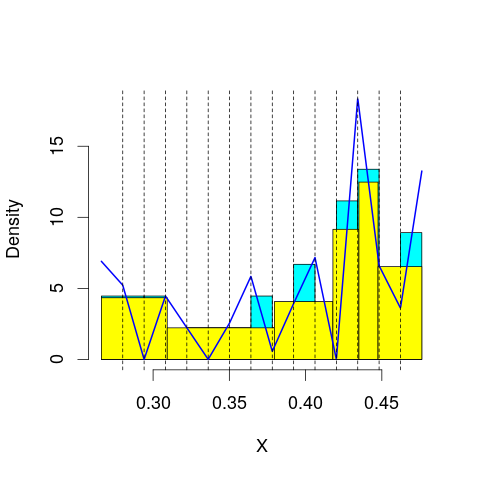

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.61655
mop.approx: Iteration 11. LL = 58.7112
mop.approx: Iteration 21. LL = 58.78213
mop.approx: Iteration 31. LL = 58.78509
mop.approx: Converged. Iteration 33. LL = 58.78528
[1] "Computing the linear combination of B-splines"


29.3265232104
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.46606
mop.approx: Iteration 11. LL = 57.61015
mop.approx: Iteration 21. LL = 57.72358
mop.approx: Iteration 31. LL = 57.74814
mop.approx: Iteration 41. LL = 57.75579
mop.approx: Iteration 51. LL = 57.75887
mop.approx: Iteration 61. LL = 57.76043
mop.approx: Iteration 71. LL = 57.76138
mop.approx: Iteration 81. LL = 57.76206
mop.approx: Converged. Iteration 82. LL = 57.76218
[1] "Computing the linear combination of B-splines"


26.570557318
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.81023
mop.approx: Iteration 11. LL = 51.6129
mop.approx: Iteration 21. LL = 51.7236
mop.approx: Iteration 31. LL = 51.74159
mop.approx: Iteration 41. LL = 51.74832
mop.approx: Iteration 51. LL = 51.75136
mop.approx: Iteration 61. LL = 51.75279
mop.approx: Converged. Iteration 70. LL = 51.75347
[1] "Computing the linear combination of B-splines"


18.8289830185
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.95346
mop.approx: Iteration 11. LL = 51.64022
mop.approx: Iteration 21. LL = 51.75149
mop.approx: Iteration 31. LL = 51.76721
mop.approx: Iteration 41. LL = 51.77216
mop.approx: Iteration 51. LL = 51.77446
mop.approx: Iteration 61. LL = 51.77597
mop.approx: Iteration 71. LL = 51.77718
mop.approx: Iteration 81. LL = 51.77823
mop.approx: Iteration 91. LL = 51.77916
mop.approx: Iteration 101. LL = 51.77997
mop.approx: Iteration 111. LL = 51.78068
mop.approx: Iteration 121. LL = 51.7813
mop.approx: Converged. Iteration 127. LL = 51.78167
[1] "Computing the linear combination of B-splines"


17.1243143081
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.737612
mop.approx: Iteration 11. LL = 51.06524
mop.approx: Iteration 21. LL = 51.35783
mop.approx: Iteration 31. LL = 51.40996
mop.approx: Iteration 41. LL = 51.42192
mop.approx: Iteration 51. LL = 51.42555
mop.approx: Iteration 61. LL = 51.42702
mop.approx: Iteration 71. LL = 51.42774
mop.approx: Converged. Iteration 71. LL = 51.42779
[1] "Computing the linear combination of B-splines"


15.0375661316
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.013081
mop.approx: Iteration 11. LL = 50.27699
mop.approx: Iteration 21. LL = 50.5438
mop.approx: Iteration 31. LL = 50.59454
mop.approx: Iteration 41. LL = 50.61173
mop.approx: Iteration 51. LL = 50.62001
mop.approx: Iteration 61. LL = 50.62478
mop.approx: Iteration 71. LL = 50.6278
mop.approx: Iteration 81. LL = 50.6298
mop.approx: Iteration 91. LL = 50.63114
mop.approx: Iteration 101. LL = 50.63204
mop.approx: Converged. Iteration 110. LL = 50.63265
[1] "Computing the linear combination of B-splines"


12.5095498637
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.32279
mop.approx: Iteration 11. LL = 49.30714
mop.approx: Iteration 21. LL = 49.47302
mop.approx: Iteration 31. LL = 49.51702
mop.approx: Iteration 41. LL = 49.5311
mop.approx: Iteration 51. LL = 49.53692
mop.approx: Iteration 61. LL = 49.53977
mop.approx: Iteration 71. LL = 49.54128
mop.approx: Iteration 81. LL = 49.54213
mop.approx: Converged. Iteration 85. LL = 49.5424
[1] "Computing the linear combination of B-splines"


9.6864959942
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.76775
mop.approx: Iteration 11. LL = 60.71256
mop.approx: Iteration 21. LL = 60.75389
mop.approx: Iteration 31. LL = 60.75609
mop.approx: Converged. Iteration 32. LL = 60.75621
[1] "Computing the linear combination of B-splines"


31.297454415
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 31.297454415020788)
m reached
('Sum of Probabilities:', 0.9900905665424288)
chosen


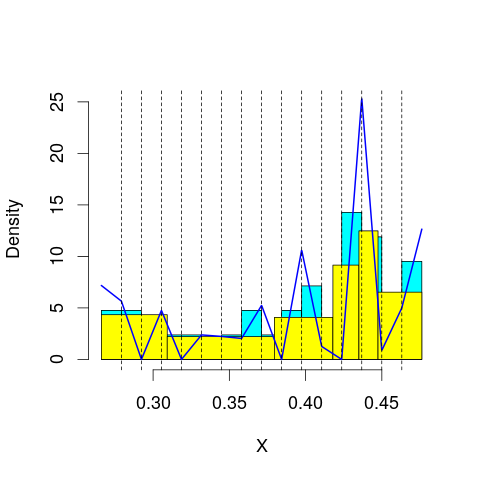

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.61655
mop.approx: Iteration 11. LL = 58.65261
mop.approx: Iteration 21. LL = 58.73699
mop.approx: Iteration 31. LL = 58.74927
mop.approx: Iteration 41. LL = 58.75155
mop.approx: Converged. Iteration 44. LL = 58.75182
[1] "Computing the linear combination of B-splines"


27.5601959281
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.46606
mop.approx: Iteration 11. LL = 59.01326
mop.approx: Iteration 21. LL = 59.20651
mop.approx: Iteration 31. LL = 59.23484
mop.approx: Iteration 41. LL = 59.24286
mop.approx: Iteration 51. LL = 59.24557
mop.approx: Iteration 61. LL = 59.24655
mop.approx: Converged. Iteration 61. LL = 59.2466
[1] "Computing the linear combination of B-splines"


26.3221106699
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.81023
mop.approx: Iteration 11. LL = 51.66008
mop.approx: Iteration 21. LL = 51.70612
mop.approx: Iteration 31. LL = 51.71944
mop.approx: Iteration 41. LL = 51.72659
mop.approx: Iteration 51. LL = 51.73073
mop.approx: Iteration 61. LL = 51.7332
mop.approx: Iteration 71. LL = 51.73469
mop.approx: Iteration 81. LL = 51.73561
mop.approx: Converged. Iteration 88. LL = 51.73608
[1] "Computing the linear combination of B-splines"


17.0787242242
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.95346
mop.approx: Iteration 11. LL = 52.26704
mop.approx: Iteration 21. LL = 52.44195
mop.approx: Iteration 31. LL = 52.47171
mop.approx: Iteration 41. LL = 52.48317
mop.approx: Iteration 51. LL = 52.48895
mop.approx: Iteration 61. LL = 52.4921
mop.approx: Iteration 71. LL = 52.49387
mop.approx: Iteration 81. LL = 52.4949
mop.approx: Converged. Iteration 89. LL = 52.49546
[1] "Computing the linear combination of B-splines"


16.1052315359
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.737612
mop.approx: Iteration 11. LL = 51.43682
mop.approx: Iteration 21. LL = 51.67147
mop.approx: Iteration 31. LL = 51.69942
mop.approx: Iteration 41. LL = 51.70606
mop.approx: Iteration 51. LL = 51.70903
mop.approx: Iteration 61. LL = 51.71095
mop.approx: Iteration 71. LL = 51.7124
mop.approx: Iteration 81. LL = 51.71358
mop.approx: Iteration 91. LL = 51.71456
mop.approx: Iteration 101. LL = 51.71538
mop.approx: Iteration 111. LL = 51.71607
mop.approx: Iteration 121. LL = 51.71664
mop.approx: Converged. Iteration 121. LL = 51.71669
[1] "Computing the linear combination of B-splines"


13.5935964198
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.013081
mop.approx: Iteration 11. LL = 50.91797
mop.approx: Iteration 21. LL = 51.3095
mop.approx: Iteration 31. LL = 51.38821
mop.approx: Iteration 41. LL = 51.41091
mop.approx: Iteration 51. LL = 51.41913
mop.approx: Iteration 61. LL = 51.42242
mop.approx: Iteration 71. LL = 51.42379
mop.approx: Converged. Iteration 77. LL = 51.42424
[1] "Computing the linear combination of B-splines"


11.5682834145
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.32279
mop.approx: Iteration 11. LL = 49.90617
mop.approx: Iteration 21. LL = 50.05777
mop.approx: Iteration 31. LL = 50.08348
mop.approx: Iteration 41. LL = 50.09134
mop.approx: Iteration 51. LL = 50.0946
mop.approx: Iteration 61. LL = 50.09616
mop.approx: Iteration 71. LL = 50.09703
mop.approx: Converged. Iteration 80. LL = 50.0976
[1] "Computing the linear combination of B-splines"


8.50873534024
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.76775
mop.approx: Iteration 11. LL = 60.79367
mop.approx: Iteration 21. LL = 60.8346
mop.approx: Iteration 31. LL = 60.83725
mop.approx: Converged. Iteration 32. LL = 60.83737
[1] "Computing the linear combination of B-splines"


29.6457506849
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 29.645750684945909)
m reached
('Sum of Probabilities:', 0.990237277444382)
chosen


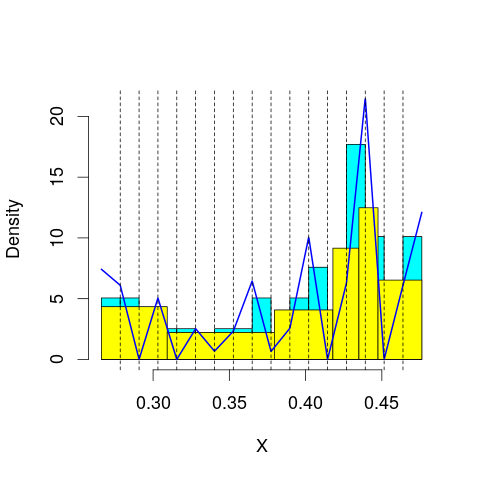

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.61655
mop.approx: Iteration 11. LL = 59.25069
mop.approx: Iteration 21. LL = 59.3348
mop.approx: Iteration 31. LL = 59.35085
mop.approx: Iteration 41. LL = 59.35545
mop.approx: Iteration 51. LL = 59.35717
mop.approx: Converged. Iteration 58. LL = 59.3578
[1] "Computing the linear combination of B-splines"


26.4333125619
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.46606
mop.approx: Iteration 11. LL = 59.32166
mop.approx: Iteration 21. LL = 59.49246
mop.approx: Iteration 31. LL = 59.51145
mop.approx: Iteration 41. LL = 59.51633
mop.approx: Iteration 51. LL = 59.51845
mop.approx: Iteration 61. LL = 59.51966
mop.approx: Iteration 71. LL = 59.52046
mop.approx: Converged. Iteration 75. LL = 59.52078
[1] "Computing the linear combination of B-splines"


24.8634177573
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.81023
mop.approx: Iteration 11. LL = 52.20964
mop.approx: Iteration 21. LL = 52.24995
mop.approx: Iteration 31. LL = 52.25725
mop.approx: Iteration 41. LL = 52.26137
mop.approx: Iteration 51. LL = 52.26402
mop.approx: Iteration 61. LL = 52.26584
mop.approx: Iteration 71. LL = 52.26713
mop.approx: Iteration 81. LL = 52.2681
mop.approx: Iteration 91. LL = 52.26884
mop.approx: Iteration 101. LL = 52.26943
mop.approx: Converged. Iteration 101. LL = 52.26948
[1] "Computing the linear combination of B-splines"


15.8792564795
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.95346
mop.approx: Iteration 11. LL = 52.49252
mop.approx: Iteration 21. LL = 52.66808
mop.approx: Iteration 31. LL = 52.70946
mop.approx: Iteration 41. LL = 52.72474
mop.approx: Iteration 51. LL = 52.73162
mop.approx: Iteration 61. LL = 52.73518
mop.approx: Iteration 71. LL = 52.73722
mop.approx: Iteration 81. LL = 52.7385
mop.approx: Iteration 91. LL = 52.73937
mop.approx: Iteration 101. LL = 52.73999
mop.approx: Converged. Iteration 102. LL = 52.74009
[1] "Computing the linear combination of B-splines"


14.6169963701
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.737612
mop.approx: Iteration 11. LL = 51.90271
mop.approx: Iteration 21. LL = 52.10085
mop.approx: Iteration 31. LL = 52.12357
mop.approx: Iteration 41. LL = 52.13141
mop.approx: Iteration 51. LL = 52.13575
mop.approx: Iteration 61. LL = 52.13858
mop.approx: Iteration 71. LL = 52.14052
mop.approx: Iteration 81. LL = 52.14186
mop.approx: Iteration 91. LL = 52.14279
mop.approx: Iteration 101. LL = 52.14342
mop.approx: Converged. Iteration 101. LL = 52.14347
[1] "Computing the linear combination of B-splines"


12.2875098838
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.013081
mop.approx: Iteration 11. LL = 51.29123
mop.approx: Iteration 21. LL = 51.66399
mop.approx: Iteration 31. LL = 51.72386
mop.approx: Iteration 41. LL = 51.73954
mop.approx: Iteration 51. LL = 51.74557
mop.approx: Iteration 61. LL = 51.74846
mop.approx: Iteration 71. LL = 51.75007
mop.approx: Iteration 81. LL = 51.7511
mop.approx: Iteration 91. LL = 51.75184
mop.approx: Iteration 101. LL = 51.75241
mop.approx: Converged. Iteration 101. LL = 51.75246
[1] "Computing the linear combination of B-splines"


10.1636067026
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.32279
mop.approx: Iteration 11. LL = 50.54342
mop.approx: Iteration 21. LL = 50.74481
mop.approx: Iteration 31. LL = 50.78483
mop.approx: Iteration 41. LL = 50.80029
mop.approx: Iteration 51. LL = 50.80829
mop.approx: Iteration 61. LL = 50.81284
mop.approx: Iteration 71. LL = 50.81552
mop.approx: Iteration 81. LL = 50.81715
mop.approx: Iteration 91. LL = 50.8182
mop.approx: Iteration 101. LL = 50.8189
mop.approx: Converged. Iteration 105. LL = 50.81916
[1] "Computing the linear combination of B-splines"


7.4968098282
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.76775
mop.approx: Iteration 11. LL = 61.47574
mop.approx: Iteration 21. LL = 61.49491
mop.approx: Converged. Iteration 22. LL = 61.49504
[1] "Computing the linear combination of B-splines"


28.570545662
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 28.57054566197283)
m reached
('Sum of Probabilities:', 0.990407984379394)
chosen


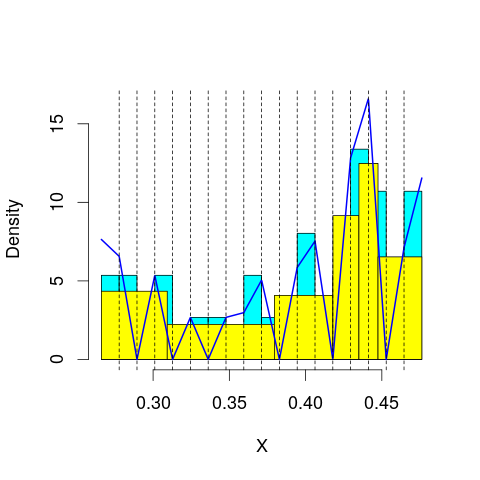

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.61655
mop.approx: Iteration 11. LL = 60.78343
mop.approx: Iteration 21. LL = 60.89522
mop.approx: Iteration 31. LL = 60.91232
mop.approx: Iteration 41. LL = 60.91649
mop.approx: Iteration 51. LL = 60.9178
mop.approx: Converged. Iteration 54. LL = 60.91806
[1] "Computing the linear combination of B-splines"


26.2607012702
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.46606
mop.approx: Iteration 11. LL = 58.99595
mop.approx: Iteration 21. LL = 59.10014
mop.approx: Iteration 31. LL = 59.10667
mop.approx: Converged. Iteration 38. LL = 59.10747
[1] "Computing the linear combination of B-splines"


22.7172440152
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.81023
mop.approx: Iteration 11. LL = 53.77941
mop.approx: Iteration 21. LL = 53.9714
mop.approx: Iteration 31. LL = 54.00468
mop.approx: Iteration 41. LL = 54.01649
mop.approx: Iteration 51. LL = 54.02175
mop.approx: Iteration 61. LL = 54.02431
mop.approx: Iteration 71. LL = 54.02562
mop.approx: Converged. Iteration 80. LL = 54.02632
[1] "Computing the linear combination of B-splines"


15.9032207861
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.95346
mop.approx: Iteration 11. LL = 52.17619
mop.approx: Iteration 21. LL = 52.23411
mop.approx: Iteration 31. LL = 52.24908
mop.approx: Iteration 41. LL = 52.2552
mop.approx: Iteration 51. LL = 52.25788
mop.approx: Iteration 61. LL = 52.25911
mop.approx: Converged. Iteration 67. LL = 52.25955
[1] "Computing the linear combination of B-splines"


12.4035900261
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.737612
mop.approx: Iteration 11. LL = 52.79472
mop.approx: Iteration 21. LL = 53.05427
mop.approx: Iteration 31. LL = 53.08238
mop.approx: Iteration 41. LL = 53.09029
mop.approx: Iteration 51. LL = 53.09369
mop.approx: Iteration 61. LL = 53.09558
mop.approx: Iteration 71. LL = 53.09684
mop.approx: Iteration 81. LL = 53.09778
mop.approx: Iteration 91. LL = 53.0985
mop.approx: Converged. Iteration 100. LL = 53.09908
[1] "Computing the linear combination of B-splines"


11.5102552232
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.013081
mop.approx: Iteration 11. LL = 51.32698
mop.approx: Iteration 21. LL = 51.55022
mop.approx: Iteration 31. LL = 51.57123
mop.approx: Iteration 41. LL = 51.57429
mop.approx: Iteration 51. LL = 51.57532
mop.approx: Iteration 61. LL = 51.57596
mop.approx: Converged. Iteration 66. LL = 51.57628
[1] "Computing the linear combination of B-splines"


8.25453625902
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.32279
mop.approx: Iteration 11. LL = 51.30572
mop.approx: Iteration 21. LL = 51.67447
mop.approx: Iteration 31. LL = 51.73522
mop.approx: Iteration 41. LL = 51.7498
mop.approx: Iteration 51. LL = 51.75411
mop.approx: Iteration 61. LL = 51.75552
mop.approx: Converged. Iteration 66. LL = 51.75588
[1] "Computing the linear combination of B-splines"


6.70127740136
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.76775
mop.approx: Iteration 11. LL = 61.31887
mop.approx: Iteration 21. LL = 61.41149
mop.approx: Iteration 31. LL = 61.42817
mop.approx: Iteration 41. LL = 61.43242
mop.approx: Iteration 51. LL = 61.43383
mop.approx: Converged. Iteration 55. LL = 61.43418
[1] "Computing the linear combination of B-splines"


26.7768221309
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 26.776822130870542)
m reached
('Sum of Probabilities:', 0.9906069773945323)
chosen


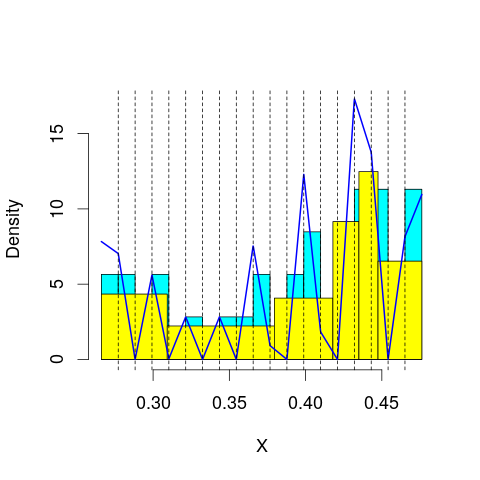

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.61655
mop.approx: Iteration 11. LL = 60.92579
mop.approx: Iteration 21. LL = 61.00852
mop.approx: Iteration 31. LL = 61.02289
mop.approx: Iteration 41. LL = 61.02734
mop.approx: Iteration 51. LL = 61.02918
mop.approx: Iteration 61. LL = 61.03009
mop.approx: Converged. Iteration 62. LL = 61.03021
[1] "Computing the linear combination of B-splines"


24.6399848089
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.46606
mop.approx: Iteration 11. LL = 59.55282
mop.approx: Iteration 21. LL = 59.74847
mop.approx: Iteration 31. LL = 59.78021
mop.approx: Iteration 41. LL = 59.79048
mop.approx: Iteration 51. LL = 59.79543
mop.approx: Iteration 61. LL = 59.79837
mop.approx: Iteration 71. LL = 59.80031
mop.approx: Iteration 81. LL = 59.80165
mop.approx: Iteration 91. LL = 59.80262
mop.approx: Iteration 101. LL = 59.80332
mop.approx: Converged. Iteration 101. LL = 59.80338
[1] "Computing the linear combination of B-splines"


21.6802820105
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.81023
mop.approx: Iteration 11. LL = 54.00473
mop.approx: Iteration 21. LL = 54.27261
mop.approx: Iteration 31. LL = 54.30266
mop.approx: Iteration 41. LL = 54.30644
mop.approx: Converged. Iteration 45. LL = 54.30681
[1] "Computing the linear combination of B-splines"


14.4508427847
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.95346
mop.approx: Iteration 11. LL = 53.09048
mop.approx: Iteration 21. LL = 53.23771
mop.approx: Iteration 31. LL = 53.27075
mop.approx: Iteration 41. LL = 53.28338
mop.approx: Iteration 51. LL = 53.28949
mop.approx: Iteration 61. LL = 53.29299
mop.approx: Iteration 71. LL = 53.29525
mop.approx: Iteration 81. LL = 53.29682
mop.approx: Iteration 91. LL = 53.29797
mop.approx: Iteration 101. LL = 53.29882
mop.approx: Iteration 111. LL = 53.29947
mop.approx: Converged. Iteration 113. LL = 53.29963
[1] "Computing the linear combination of B-splines"


11.7108009674
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.737612
mop.approx: Iteration 11. LL = 52.65296
mop.approx: Iteration 21. LL = 52.84073
mop.approx: Iteration 31. LL = 52.86955
mop.approx: Iteration 41. LL = 52.87761
mop.approx: Iteration 51. LL = 52.88044
mop.approx: Iteration 61. LL = 52.88158
mop.approx: Converged. Iteration 65. LL = 52.88188
[1] "Computing the linear combination of B-splines"


9.5601806707
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.013081
mop.approx: Iteration 11. LL = 52.10473
mop.approx: Iteration 21. LL = 52.47656
mop.approx: Iteration 31. LL = 52.54509
mop.approx: Iteration 41. LL = 52.56633
mop.approx: Iteration 51. LL = 52.57503
mop.approx: Iteration 61. LL = 52.57918
mop.approx: Iteration 71. LL = 52.58144
mop.approx: Iteration 81. LL = 52.58284
mop.approx: Iteration 91. LL = 52.58379
mop.approx: Iteration 101. LL = 52.58446
mop.approx: Converged. Iteration 104. LL = 52.58467
[1] "Computing the linear combination of B-splines"


7.53003328387
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.32279
mop.approx: Iteration 11. LL = 51.37254
mop.approx: Iteration 21. LL = 51.69173
mop.approx: Iteration 31. LL = 51.76117
mop.approx: Iteration 41. LL = 51.78066
mop.approx: Iteration 51. LL = 51.78691
mop.approx: Iteration 61. LL = 51.78918
mop.approx: Iteration 71. LL = 51.79013
mop.approx: Converged. Iteration 74. LL = 51.79034
[1] "Computing the linear combination of B-splines"


5.00194250144
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.76775
mop.approx: Iteration 11. LL = 62.48843
mop.approx: Iteration 21. LL = 62.5137
mop.approx: Converged. Iteration 26. LL = 62.51443
[1] "Computing the linear combination of B-splines"


26.1242068514
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 26.124206851424155)
m reached
('Sum of Probabilities:', 0.9899502198116857)
chosen


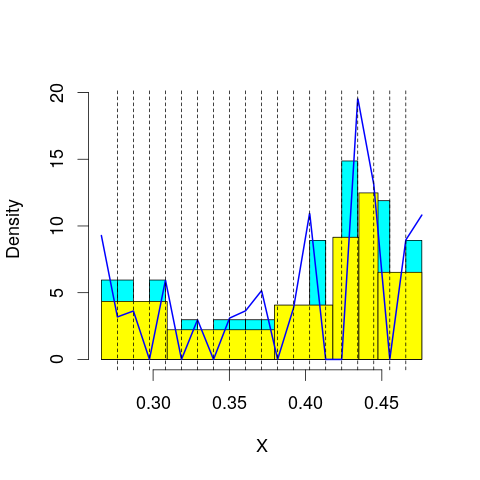

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.61655
mop.approx: Iteration 11. LL = 61.1599
mop.approx: Iteration 21. LL = 61.24386
mop.approx: Iteration 31. LL = 61.25839
mop.approx: Iteration 41. LL = 61.26358
mop.approx: Iteration 51. LL = 61.26587
mop.approx: Iteration 61. LL = 61.26697
mop.approx: Converged. Iteration 64. LL = 61.26723
[1] "Computing the linear combination of B-splines"


23.1441393441
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.46606
mop.approx: Iteration 11. LL = 60.22249
mop.approx: Iteration 21. LL = 60.37647
mop.approx: Iteration 31. LL = 60.39265
mop.approx: Iteration 41. LL = 60.39538
mop.approx: Converged. Iteration 47. LL = 60.39598
[1] "Computing the linear combination of B-splines"


20.5400220714
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.81023
mop.approx: Iteration 11. LL = 54.13857
mop.approx: Iteration 21. LL = 54.36772
mop.approx: Iteration 31. LL = 54.39339
mop.approx: Iteration 41. LL = 54.39702
mop.approx: Converged. Iteration 46. LL = 54.39751
[1] "Computing the linear combination of B-splines"


12.8086832268
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.95346
mop.approx: Iteration 11. LL = 53.82388
mop.approx: Iteration 21. LL = 53.95346
mop.approx: Iteration 31. LL = 53.97664
mop.approx: Iteration 41. LL = 53.98352
mop.approx: Iteration 51. LL = 53.98576
mop.approx: Converged. Iteration 59. LL = 53.98648
[1] "Computing the linear combination of B-splines"


10.6647795471
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.737612
mop.approx: Iteration 11. LL = 52.75844
mop.approx: Iteration 21. LL = 52.93942
mop.approx: Iteration 31. LL = 52.97906
mop.approx: Iteration 41. LL = 52.99381
mop.approx: Iteration 51. LL = 53.00024
mop.approx: Iteration 61. LL = 53.00332
mop.approx: Iteration 71. LL = 53.00487
mop.approx: Iteration 81. LL = 53.00568
mop.approx: Converged. Iteration 83. LL = 53.00584
[1] "Computing the linear combination of B-splines"


7.95127238875
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.013081
mop.approx: Iteration 11. LL = 52.52253
mop.approx: Iteration 21. LL = 52.83582
mop.approx: Iteration 31. LL = 52.88942
mop.approx: Iteration 41. LL = 52.90327
mop.approx: Iteration 51. LL = 52.90814
mop.approx: Iteration 61. LL = 52.91039
mop.approx: Iteration 71. LL = 52.9116
mop.approx: Iteration 81. LL = 52.9123
mop.approx: Converged. Iteration 81. LL = 52.91235
[1] "Computing the linear combination of B-splines"


6.12501199278
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.32279
mop.approx: Iteration 11. LL = 51.62259
mop.approx: Iteration 21. LL = 51.92216
mop.approx: Iteration 31. LL = 51.98808
mop.approx: Iteration 41. LL = 52.00988
mop.approx: Iteration 51. LL = 52.01934
mop.approx: Iteration 61. LL = 52.02431
mop.approx: Iteration 71. LL = 52.0273
mop.approx: Iteration 81. LL = 52.02929
mop.approx: Iteration 91. LL = 52.0307
mop.approx: Iteration 101. LL = 52.03175
mop.approx: Iteration 111. LL = 52.03256
mop.approx: Iteration 121. LL = 52.0332
mop.approx: Converged. Iteration 125. LL = 52.03347
[1] "Computing the linear combination of B-splines"


3.50916477658
lfps_3
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.62606
mop.approx: Converged. Iteration 9. LL = 48.41789
[1] "Computing the linear combination of B-splines"


43.2192816157
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 43.219281615742318)
m reached
('Sum of Probabilities:', 0.9949863130068036)
chosen


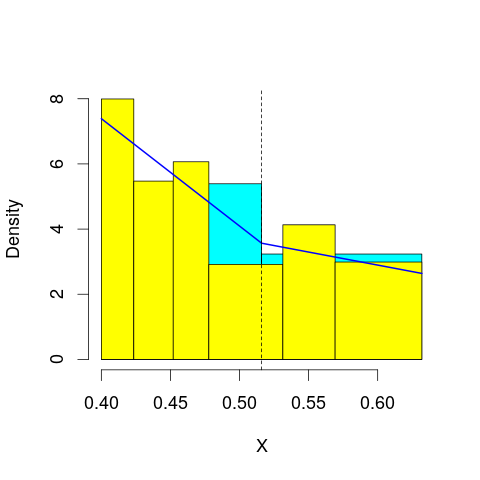

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.48897
mop.approx: Iteration 11. LL = 48.47684
mop.approx: Iteration 21. LL = 48.48487
mop.approx: Converged. Iteration 26. LL = 48.4854
[1] "Computing the linear combination of B-splines"


41.5539291136
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.35246
mop.approx: Iteration 11. LL = 48.24977
mop.approx: Iteration 21. LL = 48.25637
mop.approx: Iteration 31. LL = 48.25973
mop.approx: Iteration 41. LL = 48.26148
mop.approx: Iteration 51. LL = 48.2624
mop.approx: Converged. Iteration 56. LL = 48.26273
[1] "Computing the linear combination of B-splines"


39.5983884629
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.68781
mop.approx: Iteration 11. LL = 39.79991
mop.approx: Converged. Iteration 18. LL = 39.80859
[1] "Computing the linear combination of B-splines"


29.4113774032
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.986733
mop.approx: Iteration 11. LL = 39.12481
mop.approx: Iteration 21. LL = 39.37081
mop.approx: Iteration 31. LL = 39.40581
mop.approx: Iteration 41. LL = 39.41732
mop.approx: Iteration 51. LL = 39.42241
mop.approx: Iteration 61. LL = 39.42505
mop.approx: Iteration 71. LL = 39.42659
mop.approx: Iteration 81. LL = 39.42756
mop.approx: Iteration 91. LL = 39.4282
mop.approx: Converged. Iteration 99. LL = 39.4286
[1] "Computing the linear combination of B-splines"


27.2985274628
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.888646
mop.approx: Iteration 11. LL = 38.23729
mop.approx: Iteration 21. LL = 38.29516
mop.approx: Converged. Iteration 30. LL = 38.29693
[1] "Computing the linear combination of B-splines"


24.4339848539
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.2563
mop.approx: Iteration 11. LL = 37.74244
mop.approx: Iteration 21. LL = 38.12812
mop.approx: Iteration 31. LL = 38.20343
mop.approx: Iteration 41. LL = 38.23115
mop.approx: Iteration 51. LL = 38.24357
mop.approx: Iteration 61. LL = 38.24966
mop.approx: Iteration 71. LL = 38.25278
mop.approx: Iteration 81. LL = 38.25443
mop.approx: Iteration 91. LL = 38.2553
mop.approx: Converged. Iteration 99. LL = 38.25574
[1] "Computing the linear combination of B-splines"


22.6599240881
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.005446
mop.approx: Iteration 11. LL = 36.72743
mop.approx: Iteration 21. LL = 36.88379
mop.approx: Iteration 31. LL = 36.90111
mop.approx: Iteration 41. LL = 36.9047
mop.approx: Iteration 51. LL = 36.9056
mop.approx: Converged. Iteration 52. LL = 36.90567
[1] "Computing the linear combination of B-splines"


19.5769947658
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.62606
mop.approx: Converged. Iteration 10. LL = 48.58093
[1] "Computing the linear combination of B-splines"


41.6494617655
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 41.649461765534028)
m reached
('Sum of Probabilities:', 0.9947348292874718)
chosen


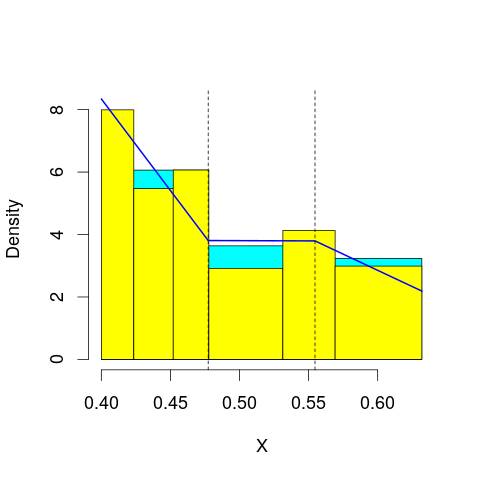

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.48897
mop.approx: Converged. Iteration 9. LL = 48.40978
[1] "Computing the linear combination of B-splines"


39.745435277
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.35246
mop.approx: Iteration 11. LL = 48.5105
mop.approx: Iteration 21. LL = 48.63413
mop.approx: Iteration 31. LL = 48.69342
mop.approx: Iteration 41. LL = 48.72466
mop.approx: Iteration 51. LL = 48.74241
mop.approx: Iteration 61. LL = 48.75307
mop.approx: Iteration 71. LL = 48.75973
mop.approx: Iteration 81. LL = 48.76398
mop.approx: Iteration 91. LL = 48.76675
mop.approx: Iteration 101. LL = 48.76857
mop.approx: Iteration 111. LL = 48.76978
mop.approx: Iteration 121. LL = 48.77059
mop.approx: Converged. Iteration 129. LL = 48.77109
[1] "Computing the linear combination of B-splines"


38.3738826539
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.68781
mop.approx: Iteration 11. LL = 40.21956
mop.approx: Iteration 21. LL = 40.26294
mop.approx: Iteration 31. LL = 40.26683
mop.approx: Converged. Iteration 36. LL = 40.26721
[1] "Computing the linear combination of B-splines"


28.1371304618
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.986733
mop.approx: Iteration 11. LL = 40.87688
mop.approx: Iteration 21. LL = 40.97462
mop.approx: Converged. Iteration 27. LL = 40.97587
[1] "Computing the linear combination of B-splines"


27.1129256363
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.888646
mop.approx: Iteration 11. LL = 39.71847
mop.approx: Iteration 21. LL = 39.95737
mop.approx: Iteration 31. LL = 39.97167
mop.approx: Converged. Iteration 37. LL = 39.97231
[1] "Computing the linear combination of B-splines"


24.3764941312
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.2563
mop.approx: Iteration 11. LL = 39.70559
mop.approx: Iteration 21. LL = 39.8089
mop.approx: Converged. Iteration 26. LL = 39.80983
[1] "Computing the linear combination of B-splines"


22.4811534001
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.005446
mop.approx: Iteration 11. LL = 38.73321
mop.approx: Iteration 21. LL = 39.04691
mop.approx: Iteration 31. LL = 39.07568
mop.approx: Iteration 41. LL = 39.08154
mop.approx: Iteration 51. LL = 39.08319
mop.approx: Converged. Iteration 58. LL = 39.08364
[1] "Computing the linear combination of B-splines"


20.022096912
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.62606
mop.approx: Converged. Iteration 7. LL = 48.69229
[1] "Computing the linear combination of B-splines"


40.027951467
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 40.027951466964481)
m reached
('Sum of Probabilities:', 0.9949269215977106)
chosen


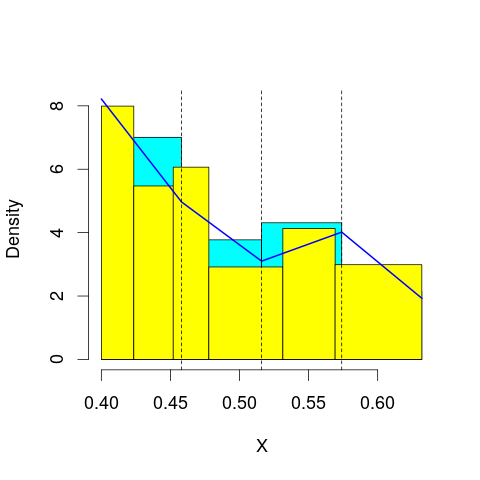

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.48897
mop.approx: Iteration 11. LL = 48.81653
mop.approx: Iteration 21. LL = 48.8681
mop.approx: Iteration 31. LL = 48.87795
mop.approx: Iteration 41. LL = 48.88048
mop.approx: Converged. Iteration 50. LL = 48.88126
[1] "Computing the linear combination of B-splines"


38.4840507709
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.35246
mop.approx: Iteration 11. LL = 49.03575
mop.approx: Iteration 21. LL = 49.1144
mop.approx: Iteration 31. LL = 49.12665
mop.approx: Iteration 41. LL = 49.12929
mop.approx: Converged. Iteration 49. LL = 49.12997
[1] "Computing the linear combination of B-splines"


36.9998950774
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.68781
mop.approx: Iteration 11. LL = 40.39639
mop.approx: Iteration 21. LL = 40.43111
mop.approx: Iteration 31. LL = 40.4386
mop.approx: Iteration 41. LL = 40.44116
mop.approx: Iteration 51. LL = 40.44227
mop.approx: Iteration 61. LL = 40.44284
mop.approx: Converged. Iteration 61. LL = 40.44288
[1] "Computing the linear combination of B-splines"


26.5799361951
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.986733
mop.approx: Iteration 11. LL = 41.11103
mop.approx: Iteration 21. LL = 41.12209
mop.approx: Converged. Iteration 22. LL = 41.12218
[1] "Computing the linear combination of B-splines"


25.5263728037
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.888646
mop.approx: Iteration 11. LL = 40.51258
mop.approx: Iteration 21. LL = 40.76349
mop.approx: Iteration 31. LL = 40.81924
mop.approx: Iteration 41. LL = 40.83576
mop.approx: Iteration 51. LL = 40.84112
mop.approx: Iteration 61. LL = 40.84291
mop.approx: Converged. Iteration 69. LL = 40.84348
[1] "Computing the linear combination of B-splines"


23.5148019844
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.2563
mop.approx: Iteration 11. LL = 40.08768
mop.approx: Iteration 21. LL = 40.22225
mop.approx: Iteration 31. LL = 40.25693
mop.approx: Iteration 41. LL = 40.26975
mop.approx: Iteration 51. LL = 40.27572
mop.approx: Iteration 61. LL = 40.27895
mop.approx: Iteration 71. LL = 40.28086
mop.approx: Iteration 81. LL = 40.28208
mop.approx: Iteration 91. LL = 40.28288
mop.approx: Iteration 101. LL = 40.28343
mop.approx: Converged. Iteration 104. LL = 40.2836
[1] "Computing the linear combination of B-splines"


21.2220476465
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.005446
mop.approx: Iteration 11. LL = 40.29817
mop.approx: Iteration 21. LL = 40.55433
mop.approx: Iteration 31. LL = 40.5648
mop.approx: Converged. Iteration 35. LL = 40.56513
[1] "Computing the linear combination of B-splines"


19.7707132085
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.62606
mop.approx: Iteration 11. LL = 48.85418
mop.approx: Converged. Iteration 12. LL = 48.8543
[1] "Computing the linear combination of B-splines"


38.4570909861
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 38.457090986144323)
m reached
('Sum of Probabilities:', 0.9945830431425772)
chosen


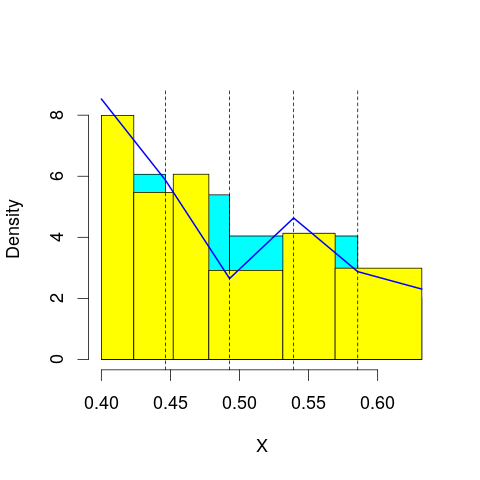

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.48897
mop.approx: Iteration 11. LL = 49.42882
mop.approx: Iteration 21. LL = 49.48415
mop.approx: Iteration 31. LL = 49.48933
mop.approx: Converged. Iteration 35. LL = 49.48971
[1] "Computing the linear combination of B-splines"


37.3596347633
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.35246
mop.approx: Iteration 11. LL = 49.19468
mop.approx: Iteration 21. LL = 49.2489
mop.approx: Iteration 31. LL = 49.26329
mop.approx: Iteration 41. LL = 49.26888
mop.approx: Iteration 51. LL = 49.27134
mop.approx: Iteration 61. LL = 49.27249
mop.approx: Converged. Iteration 68. LL = 49.27297
[1] "Computing the linear combination of B-splines"


35.4100226847
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.68781
mop.approx: Iteration 11. LL = 42.31231
mop.approx: Iteration 21. LL = 42.60674
mop.approx: Iteration 31. LL = 42.67025
mop.approx: Iteration 41. LL = 42.69188
mop.approx: Iteration 51. LL = 42.70053
mop.approx: Iteration 61. LL = 42.70421
mop.approx: Iteration 71. LL = 42.70581
mop.approx: Iteration 81. LL = 42.70651
mop.approx: Converged. Iteration 82. LL = 42.7066
[1] "Computing the linear combination of B-splines"


27.1107849164
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.986733
mop.approx: Iteration 11. LL = 41.50799
mop.approx: Iteration 21. LL = 41.57772
mop.approx: Iteration 31. LL = 41.59008
mop.approx: Iteration 41. LL = 41.59284
mop.approx: Converged. Iteration 49. LL = 41.5935
[1] "Computing the linear combination of B-splines"


24.2648173609
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.888646
mop.approx: Iteration 11. LL = 41.85311
mop.approx: Iteration 21. LL = 42.06575
mop.approx: Iteration 31. LL = 42.08308
mop.approx: Iteration 41. LL = 42.08621
mop.approx: Converged. Iteration 50. LL = 42.08699
[1] "Computing the linear combination of B-splines"


23.0254403572
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.2563
mop.approx: Iteration 11. LL = 40.24459
mop.approx: Iteration 21. LL = 40.30492
mop.approx: Iteration 31. LL = 40.31914
mop.approx: Iteration 41. LL = 40.3246
mop.approx: Iteration 51. LL = 40.32696
mop.approx: Iteration 61. LL = 40.32801
mop.approx: Converged. Iteration 67. LL = 40.32837
[1] "Computing the linear combination of B-splines"


19.5339551951
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.005446
mop.approx: Iteration 11. LL = 40.55041
mop.approx: Iteration 21. LL = 40.57772
mop.approx: Converged. Iteration 25. LL = 40.57806
[1] "Computing the linear combination of B-splines"


18.050775155
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.62606
mop.approx: Iteration 11. LL = 49.0844
mop.approx: Converged. Iteration 14. LL = 49.08492
[1] "Computing the linear combination of B-splines"


36.9548457385
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 36.954845738470823)
m reached
('Sum of Probabilities:', 0.993461317253381)
chosen


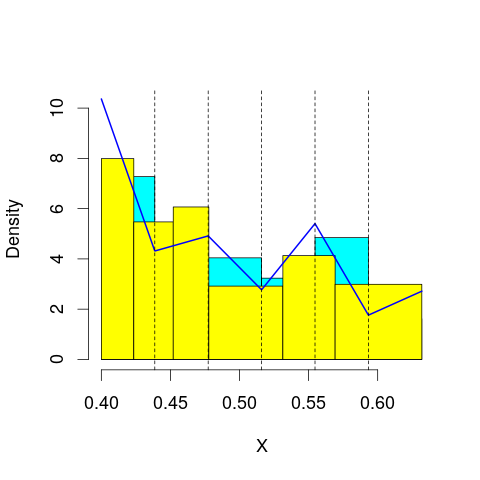

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.48897
mop.approx: Iteration 11. LL = 49.73353
mop.approx: Iteration 21. LL = 49.75326
mop.approx: Converged. Iteration 26. LL = 49.75393
[1] "Computing the linear combination of B-splines"


35.8909846794
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.35246
mop.approx: Iteration 11. LL = 49.31876
mop.approx: Iteration 21. LL = 49.36736
mop.approx: Iteration 31. LL = 49.37953
mop.approx: Iteration 41. LL = 49.38399
mop.approx: Iteration 51. LL = 49.38585
mop.approx: Iteration 61. LL = 49.38668
mop.approx: Converged. Iteration 62. LL = 49.38678
[1] "Computing the linear combination of B-splines"


33.7909710282
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.68781
mop.approx: Iteration 11. LL = 43.70143
mop.approx: Iteration 21. LL = 43.99611
mop.approx: Iteration 31. LL = 44.04469
mop.approx: Iteration 41. LL = 44.05547
mop.approx: Iteration 51. LL = 44.05836
mop.approx: Iteration 61. LL = 44.05923
mop.approx: Converged. Iteration 61. LL = 44.05927
[1] "Computing the linear combination of B-splines"


26.7305903379
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.986733
mop.approx: Iteration 11. LL = 42.26881
mop.approx: Iteration 21. LL = 42.42995
mop.approx: Iteration 31. LL = 42.47547
mop.approx: Iteration 41. LL = 42.49208
mop.approx: Iteration 51. LL = 42.49881
mop.approx: Iteration 61. LL = 42.50166
mop.approx: Iteration 71. LL = 42.50288
mop.approx: Converged. Iteration 78. LL = 42.50334
[1] "Computing the linear combination of B-splines"


23.4417889365
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.888646
mop.approx: Iteration 11. LL = 42.63832
mop.approx: Iteration 21. LL = 42.79992
mop.approx: Iteration 31. LL = 42.84212
mop.approx: Iteration 41. LL = 42.85946
mop.approx: Iteration 51. LL = 42.86813
mop.approx: Iteration 61. LL = 42.87301
mop.approx: Iteration 71. LL = 42.87597
mop.approx: Iteration 81. LL = 42.87784
mop.approx: Iteration 91. LL = 42.87906
mop.approx: Iteration 101. LL = 42.87988
mop.approx: Iteration 111. LL = 42.88043
mop.approx: Converged. Iteration 113. LL = 42.88056
[1] "Computing the linear combination of B-splines"


22.0861484626
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.2563
mop.approx: Iteration 11. LL = 41.82812
mop.approx: Iteration 21. LL = 42.35912
mop.approx: Iteration 31. LL = 42.49618
mop.approx: Iteration 41. LL = 42.53957
mop.approx: Iteration 51. LL = 42.55528
mop.approx: Iteration 61. LL = 42.5618
mop.approx: Iteration 71. LL = 42.56484
mop.approx: Iteration 81. LL = 42.56637
mop.approx: Iteration 91. LL = 42.56718
mop.approx: Converged. Iteration 96. LL = 42.56748
[1] "Computing the linear combination of B-splines"


20.0401928074
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.005446
mop.approx: Iteration 11. LL = 40.7352
mop.approx: Iteration 21. LL = 40.82135
mop.approx: Iteration 31. LL = 40.85409
mop.approx: Iteration 41. LL = 40.86856
mop.approx: Iteration 51. LL = 40.87559
mop.approx: Iteration 61. LL = 40.87928
mop.approx: Iteration 71. LL = 40.88134
mop.approx: Iteration 81. LL = 40.88256
mop.approx: Iteration 91. LL = 40.88331
mop.approx: Converged. Iteration 100. LL = 40.88379
[1] "Computing the linear combination of B-splines"


16.6236432715
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.62606
mop.approx: Iteration 11. LL = 50.40865
mop.approx: Iteration 21. LL = 50.42871
mop.approx: Iteration 31. LL = 50.43289
mop.approx: Iteration 41. LL = 50.4343
mop.approx: Converged. Iteration 47. LL = 50.43473
[1] "Computing the linear combination of B-splines"


36.5717824621
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 36.571782462080385)
m reached
('Sum of Probabilities:', 0.9927531932046654)
chosen


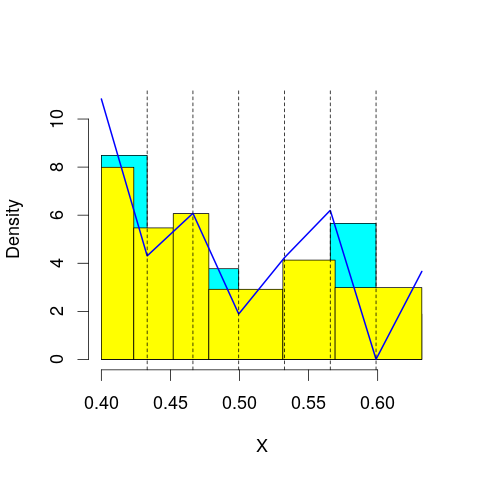

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.48897
mop.approx: Iteration 11. LL = 49.59594
mop.approx: Iteration 21. LL = 49.6021
mop.approx: Converged. Iteration 21. LL = 49.60213
[1] "Computing the linear combination of B-splines"


34.0063228139
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.35246
mop.approx: Iteration 11. LL = 49.62165
mop.approx: Iteration 21. LL = 49.69879
mop.approx: Iteration 31. LL = 49.72371
mop.approx: Iteration 41. LL = 49.73458
mop.approx: Iteration 51. LL = 49.7401
mop.approx: Iteration 61. LL = 49.74316
mop.approx: Iteration 71. LL = 49.74496
mop.approx: Iteration 81. LL = 49.74606
mop.approx: Iteration 91. LL = 49.74675
mop.approx: Converged. Iteration 93. LL = 49.7469
[1] "Computing the linear combination of B-splines"


32.4182236261
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.68781
mop.approx: Iteration 11. LL = 44.38295
mop.approx: Iteration 21. LL = 44.49995
mop.approx: Iteration 31. LL = 44.51583
mop.approx: Iteration 41. LL = 44.52186
mop.approx: Iteration 51. LL = 44.5247
mop.approx: Iteration 61. LL = 44.52622
mop.approx: Iteration 71. LL = 44.52711
mop.approx: Iteration 81. LL = 44.52766
mop.approx: Converged. Iteration 81. LL = 44.5277
[1] "Computing the linear combination of B-splines"


25.466154971
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.986733
mop.approx: Iteration 11. LL = 42.85169
mop.approx: Iteration 21. LL = 42.97937
mop.approx: Iteration 31. LL = 43.01202
mop.approx: Iteration 41. LL = 43.02393
mop.approx: Iteration 51. LL = 43.02886
mop.approx: Iteration 61. LL = 43.03105
mop.approx: Iteration 71. LL = 43.03208
mop.approx: Converged. Iteration 78. LL = 43.03251
[1] "Computing the linear combination of B-splines"


22.2380940361
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.888646
mop.approx: Iteration 11. LL = 43.01041
mop.approx: Iteration 21. LL = 43.0689
mop.approx: Iteration 31. LL = 43.08532
mop.approx: Iteration 41. LL = 43.09348
mop.approx: Iteration 51. LL = 43.09809
mop.approx: Iteration 61. LL = 43.10092
mop.approx: Iteration 71. LL = 43.10278
mop.approx: Iteration 81. LL = 43.10404
mop.approx: Iteration 91. LL = 43.10494
mop.approx: Iteration 101. LL = 43.10559
mop.approx: Converged. Iteration 110. LL = 43.10608
[1] "Computing the linear combination of B-splines"


20.5787956053
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.2563
mop.approx: Iteration 11. LL = 43.06789
mop.approx: Iteration 21. LL = 43.40523
mop.approx: Iteration 31. LL = 43.45751
mop.approx: Iteration 41. LL = 43.47182
mop.approx: Iteration 51. LL = 43.47638
mop.approx: Iteration 61. LL = 43.47789
mop.approx: Converged. Iteration 67. LL = 43.47829
[1] "Computing the linear combination of B-splines"


19.2181393524
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.005446
mop.approx: Iteration 11. LL = 41.78485
mop.approx: Iteration 21. LL = 42.16846
mop.approx: Iteration 31. LL = 42.2723
mop.approx: Iteration 41. LL = 42.30401
mop.approx: Iteration 51. LL = 42.31437
mop.approx: Iteration 61. LL = 42.31782
mop.approx: Iteration 71. LL = 42.31897
mop.approx: Converged. Iteration 75. LL = 42.31921
[1] "Computing the linear combination of B-splines"


16.3261905534
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.62606
mop.approx: Iteration 11. LL = 51.10363
mop.approx: Converged. Iteration 18. LL = 51.1082
[1] "Computing the linear combination of B-splines"


35.5123914064
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 35.512391406446497)
m reached
('Sum of Probabilities:', 0.9923970765858094)
chosen


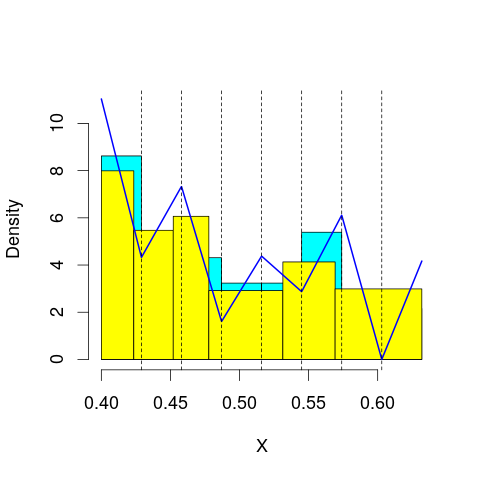

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.48897
mop.approx: Iteration 11. LL = 49.7601
mop.approx: Iteration 21. LL = 49.7736
mop.approx: Converged. Iteration 27. LL = 49.77439
[1] "Computing the linear combination of B-splines"


32.4457073042
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.35246
mop.approx: Iteration 11. LL = 49.89943
mop.approx: Iteration 21. LL = 50.05974
mop.approx: Iteration 31. LL = 50.11785
mop.approx: Iteration 41. LL = 50.14463
mop.approx: Iteration 51. LL = 50.15883
mop.approx: Iteration 61. LL = 50.16701
mop.approx: Iteration 71. LL = 50.17198
mop.approx: Iteration 81. LL = 50.17513
mop.approx: Iteration 91. LL = 50.17716
mop.approx: Iteration 101. LL = 50.17851
mop.approx: Iteration 111. LL = 50.17943
mop.approx: Iteration 121. LL = 50.18005
mop.approx: Converged. Iteration 122. LL = 50.18015
[1] "Computing the linear combination of B-splines"


31.1186070081
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.68781
mop.approx: Iteration 11. LL = 44.55593
mop.approx: Iteration 21. LL = 44.58864
mop.approx: Converged. Iteration 23. LL = 44.58884
[1] "Computing the linear combination of B-splines"


23.7944206031
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.986733
mop.approx: Iteration 11. LL = 43.46975
mop.approx: Iteration 21. LL = 43.67743
mop.approx: Iteration 31. LL = 43.74081
mop.approx: Iteration 41. LL = 43.75975
mop.approx: Iteration 51. LL = 43.76477
mop.approx: Iteration 61. LL = 43.766
mop.approx: Converged. Iteration 63. LL = 43.76614
[1] "Computing the linear combination of B-splines"


21.2388521603
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.888646
mop.approx: Iteration 11. LL = 43.15488
mop.approx: Iteration 21. LL = 43.18752
mop.approx: Iteration 31. LL = 43.19925
mop.approx: Iteration 41. LL = 43.20603
mop.approx: Iteration 51. LL = 43.21028
mop.approx: Iteration 61. LL = 43.21305
mop.approx: Iteration 71. LL = 43.21492
mop.approx: Iteration 81. LL = 43.2162
mop.approx: Iteration 91. LL = 43.2171
mop.approx: Iteration 101. LL = 43.21774
mop.approx: Converged. Iteration 108. LL = 43.21812
[1] "Computing the linear combination of B-splines"


18.9579697863
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.2563
mop.approx: Iteration 11. LL = 43.6364
mop.approx: Iteration 21. LL = 43.74042
mop.approx: Iteration 31. LL = 43.74422
mop.approx: Converged. Iteration 36. LL = 43.74458
[1] "Computing the linear combination of B-splines"


17.7515644357
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.005446
mop.approx: Iteration 11. LL = 42.80526
mop.approx: Iteration 21. LL = 43.22923
mop.approx: Iteration 31. LL = 43.33098
mop.approx: Iteration 41. LL = 43.36121
mop.approx: Iteration 51. LL = 43.37146
mop.approx: Iteration 61. LL = 43.37537
mop.approx: Iteration 71. LL = 43.37699
mop.approx: Iteration 81. LL = 43.37769
mop.approx: Converged. Iteration 82. LL = 43.37778
[1] "Computing the linear combination of B-splines"


15.6518901621
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.62606
mop.approx: Iteration 11. LL = 51.25087
mop.approx: Iteration 21. LL = 51.27859
mop.approx: Iteration 31. LL = 51.28362
mop.approx: Iteration 41. LL = 51.28523
mop.approx: Converged. Iteration 49. LL = 51.28585
[1] "Computing the linear combination of B-splines"


33.9571712608
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 33.957171260773265)
m reached
('Sum of Probabilities:', 0.9928024732525929)
chosen


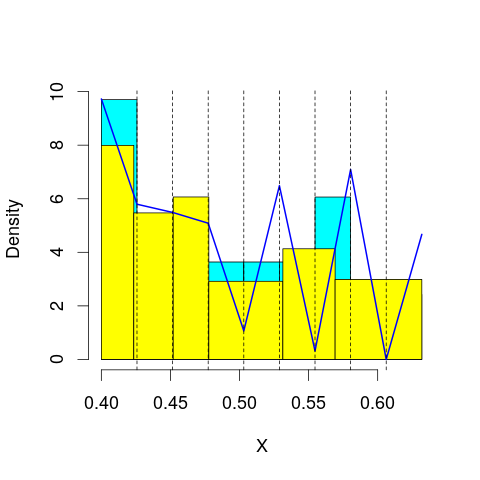

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.48897
mop.approx: Iteration 11. LL = 50.66936
mop.approx: Iteration 21. LL = 50.78967
mop.approx: Iteration 31. LL = 50.81898
mop.approx: Iteration 41. LL = 50.82984
mop.approx: Iteration 51. LL = 50.83494
mop.approx: Iteration 61. LL = 50.83772
mop.approx: Iteration 71. LL = 50.83939
mop.approx: Iteration 81. LL = 50.84047
mop.approx: Iteration 91. LL = 50.84119
mop.approx: Converged. Iteration 96. LL = 50.84152
[1] "Computing the linear combination of B-splines"


31.7799689279
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.35246
mop.approx: Iteration 11. LL = 49.87316
mop.approx: Iteration 21. LL = 49.95925
mop.approx: Iteration 31. LL = 49.97937
mop.approx: Iteration 41. LL = 49.98616
mop.approx: Iteration 51. LL = 49.98888
mop.approx: Iteration 61. LL = 49.99011
mop.approx: Converged. Iteration 69. LL = 49.99067
[1] "Computing the linear combination of B-splines"


29.1962592608
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.68781
mop.approx: Iteration 11. LL = 44.72342
mop.approx: Iteration 21. LL = 44.76438
mop.approx: Iteration 31. LL = 44.77629
mop.approx: Iteration 41. LL = 44.78259
mop.approx: Iteration 51. LL = 44.78624
mop.approx: Iteration 61. LL = 44.78848
mop.approx: Iteration 71. LL = 44.78994
mop.approx: Iteration 81. LL = 44.79093
mop.approx: Iteration 91. LL = 44.79163
mop.approx: Converged. Iteration 100. LL = 44.79213
[1] "Computing the linear combination of B-splines"


22.2648512473
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.986733
mop.approx: Iteration 11. LL = 43.90544
mop.approx: Iteration 21. LL = 44.15237
mop.approx: Iteration 31. LL = 44.21394
mop.approx: Iteration 41. LL = 44.23365
mop.approx: Iteration 51. LL = 44.24131
mop.approx: Iteration 61. LL = 44.2448
mop.approx: Iteration 71. LL = 44.24663
mop.approx: Iteration 81. LL = 44.24771
mop.approx: Iteration 91. LL = 44.24842
mop.approx: Converged. Iteration 99. LL = 44.24887
[1] "Computing the linear combination of B-splines"


19.9887169151
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.888646
mop.approx: Iteration 11. LL = 43.37668
mop.approx: Iteration 21. LL = 43.45149
mop.approx: Iteration 31. LL = 43.4871
mop.approx: Iteration 41. LL = 43.50389
mop.approx: Iteration 51. LL = 43.51125
mop.approx: Iteration 61. LL = 43.51431
mop.approx: Iteration 71. LL = 43.51553
mop.approx: Converged. Iteration 77. LL = 43.51591
[1] "Computing the linear combination of B-splines"


17.5228892633
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.2563
mop.approx: Iteration 11. LL = 43.72319
mop.approx: Iteration 21. LL = 43.74712
mop.approx: Iteration 31. LL = 43.74839
mop.approx: Iteration 41. LL = 43.74922
mop.approx: Iteration 51. LL = 43.74983
mop.approx: Converged. Iteration 57. LL = 43.75016
[1] "Computing the linear combination of B-splines"


16.0242683981
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.005446
mop.approx: Iteration 11. LL = 43.63346
mop.approx: Iteration 21. LL = 43.98517
mop.approx: Iteration 31. LL = 44.03569
mop.approx: Iteration 41. LL = 44.05027
mop.approx: Iteration 51. LL = 44.05708
mop.approx: Iteration 61. LL = 44.06056
mop.approx: Iteration 71. LL = 44.06234
mop.approx: Iteration 81. LL = 44.06324
mop.approx: Converged. Iteration 86. LL = 44.06354
[1] "Computing the linear combination of B-splines"


14.6047808109
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.62606
mop.approx: Iteration 11. LL = 50.41062
mop.approx: Converged. Iteration 16. LL = 50.41258
[1] "Computing the linear combination of B-splines"


31.351036519
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 31.351036518995294)
m reached
('Sum of Probabilities:', 0.992985275902416)
chosen


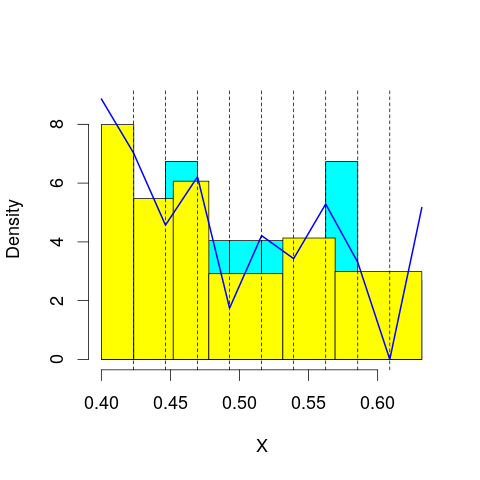

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.48897
mop.approx: Iteration 11. LL = 51.58284
mop.approx: Iteration 21. LL = 51.70399
mop.approx: Iteration 31. LL = 51.72769
mop.approx: Iteration 41. LL = 51.73562
mop.approx: Iteration 51. LL = 51.739
mop.approx: Iteration 61. LL = 51.74069
mop.approx: Iteration 71. LL = 51.74164
mop.approx: Converged. Iteration 79. LL = 51.74218
[1] "Computing the linear combination of B-splines"


30.9477640625
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.35246
mop.approx: Iteration 11. LL = 49.88689
mop.approx: Iteration 21. LL = 49.97305
mop.approx: Iteration 31. LL = 49.99443
mop.approx: Iteration 41. LL = 50.00129
mop.approx: Iteration 51. LL = 50.00364
mop.approx: Converged. Iteration 60. LL = 50.00447
[1] "Computing the linear combination of B-splines"


27.4771852201
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.68781
mop.approx: Iteration 11. LL = 45.0331
mop.approx: Iteration 21. LL = 45.15085
mop.approx: Iteration 31. LL = 45.19541
mop.approx: Iteration 41. LL = 45.21605
mop.approx: Iteration 51. LL = 45.22637
mop.approx: Iteration 61. LL = 45.23178
mop.approx: Iteration 71. LL = 45.23471
mop.approx: Iteration 81. LL = 45.23635
mop.approx: Iteration 91. LL = 45.23728
mop.approx: Converged. Iteration 100. LL = 45.23784
[1] "Computing the linear combination of B-splines"


20.9776861378
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.986733
mop.approx: Iteration 11. LL = 44.18382
mop.approx: Iteration 21. LL = 44.3809
mop.approx: Iteration 31. LL = 44.41295
mop.approx: Iteration 41. LL = 44.4208
mop.approx: Iteration 51. LL = 44.42397
mop.approx: Iteration 61. LL = 44.42583
mop.approx: Iteration 71. LL = 44.42713
mop.approx: Iteration 81. LL = 44.42811
mop.approx: Iteration 91. LL = 44.42886
mop.approx: Iteration 101. LL = 44.42945
mop.approx: Converged. Iteration 109. LL = 44.42989
[1] "Computing the linear combination of B-splines"


18.4368677365
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.888646
mop.approx: Iteration 11. LL = 43.60128
mop.approx: Iteration 21. LL = 43.71782
mop.approx: Iteration 31. LL = 43.76258
mop.approx: Iteration 41. LL = 43.78399
mop.approx: Iteration 51. LL = 43.7957
mop.approx: Iteration 61. LL = 43.80271
mop.approx: Iteration 71. LL = 43.8072
mop.approx: Iteration 81. LL = 43.81023
mop.approx: Iteration 91. LL = 43.81233
mop.approx: Iteration 101. LL = 43.81385
mop.approx: Iteration 111. LL = 43.81495
mop.approx: Iteration 121. LL = 43.81578
mop.approx: Iteration 131. LL = 43.8164
mop.approx: Converged. Iteration 139. LL = 43.81684
[1] "Computing the linear combination of B-splines"


16.0909491902
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.2563
mop.approx: Iteration 11. LL = 43.80488
mop.approx: Iteration 21. LL = 43.84799
mop.approx: Iteration 31. LL = 43.87158
mop.approx: Iteration 41. LL = 43.88611
mop.approx: Iteration 51. LL = 43.89466
mop.approx: Iteration 61. LL = 43.89949
mop.approx: Iteration 71. LL = 43.90215
mop.approx: Iteration 81. LL = 43.90358
mop.approx: Iteration 91. LL = 43.90433
mop.approx: Converged. Iteration 94. LL = 43.90452
[1] "Computing the linear combination of B-splines"


14.4457591254
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.005446
mop.approx: Iteration 11. LL = 43.99419
mop.approx: Iteration 21. LL = 44.17189
mop.approx: Iteration 31. LL = 44.18477
mop.approx: Iteration 41. LL = 44.18783
mop.approx: Iteration 51. LL = 44.18937
mop.approx: Iteration 61. LL = 44.19043
mop.approx: Iteration 71. LL = 44.19125
mop.approx: Iteration 81. LL = 44.19189
mop.approx: Iteration 91. LL = 44.19239
mop.approx: Converged. Iteration 92. LL = 44.19248
[1] "Computing the linear combination of B-splines"


13.0008594883
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.62606
mop.approx: Iteration 11. LL = 51.95157
mop.approx: Iteration 21. LL = 52.00891
mop.approx: Iteration 31. LL = 52.02148
mop.approx: Iteration 41. LL = 52.02614
mop.approx: Iteration 51. LL = 52.02836
mop.approx: Iteration 61. LL = 52.02957
mop.approx: Iteration 71. LL = 52.0303
mop.approx: Converged. Iteration 73. LL = 52.03046
[1] "Computing the linear combination of B-splines"


31.2360454905
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 31.236045490473337)
m reached
('Sum of Probabilities:', 0.9928486863053482)
chosen


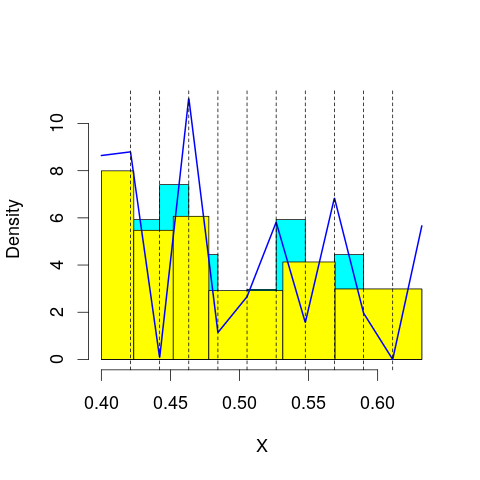

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.48897
mop.approx: Iteration 11. LL = 51.03614
mop.approx: Iteration 21. LL = 51.09172
mop.approx: Iteration 31. LL = 51.10189
mop.approx: Iteration 41. LL = 51.10543
mop.approx: Iteration 51. LL = 51.10712
mop.approx: Iteration 61. LL = 51.10807
mop.approx: Converged. Iteration 70. LL = 51.10868
[1] "Computing the linear combination of B-splines"


28.5813916512
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.35246
mop.approx: Iteration 11. LL = 50.92374
mop.approx: Iteration 21. LL = 51.10291
mop.approx: Iteration 31. LL = 51.14693
mop.approx: Iteration 41. LL = 51.16291
mop.approx: Iteration 51. LL = 51.1698
mop.approx: Iteration 61. LL = 51.17299
mop.approx: Iteration 71. LL = 51.17448
mop.approx: Converged. Iteration 80. LL = 51.17519
[1] "Computing the linear combination of B-splines"


26.9150381096
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.68781
mop.approx: Iteration 11. LL = 45.03412
mop.approx: Iteration 21. LL = 45.1036
mop.approx: Iteration 31. LL = 45.12196
mop.approx: Iteration 41. LL = 45.12841
mop.approx: Iteration 51. LL = 45.13091
mop.approx: Iteration 61. LL = 45.13193
mop.approx: Converged. Iteration 65. LL = 45.13218
[1] "Computing the linear combination of B-splines"


19.1391633945
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.986733
mop.approx: Iteration 11. LL = 44.64981
mop.approx: Iteration 21. LL = 44.89983
mop.approx: Iteration 31. LL = 44.96955
mop.approx: Iteration 41. LL = 44.99835
mop.approx: Iteration 51. LL = 45.01135
mop.approx: Iteration 61. LL = 45.01738
mop.approx: Iteration 71. LL = 45.02021
mop.approx: Iteration 81. LL = 45.02156
mop.approx: Iteration 91. LL = 45.02222
mop.approx: Converged. Iteration 91. LL = 45.02226
[1] "Computing the linear combination of B-splines"


17.2963716047
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.888646
mop.approx: Iteration 11. LL = 43.67917
mop.approx: Iteration 21. LL = 43.75513
mop.approx: Iteration 31. LL = 43.77151
mop.approx: Iteration 41. LL = 43.77718
mop.approx: Iteration 51. LL = 43.78013
mop.approx: Iteration 61. LL = 43.78206
mop.approx: Iteration 71. LL = 43.78343
mop.approx: Iteration 81. LL = 43.78445
mop.approx: Iteration 91. LL = 43.78522
mop.approx: Iteration 101. LL = 43.78581
mop.approx: Converged. Iteration 107. LL = 43.78614
[1] "Computing the linear combination of B-splines"


14.3273891877
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.2563
mop.approx: Iteration 11. LL = 43.94928
mop.approx: Iteration 21. LL = 44.03654
mop.approx: Iteration 31. LL = 44.07723
mop.approx: Iteration 41. LL = 44.09838
mop.approx: Iteration 51. LL = 44.11004
mop.approx: Iteration 61. LL = 44.11676
mop.approx: Iteration 71. LL = 44.12076
mop.approx: Iteration 81. LL = 44.12319
mop.approx: Iteration 91. LL = 44.12472
mop.approx: Iteration 101. LL = 44.12569
mop.approx: Iteration 111. LL = 44.12633
mop.approx: Converged. Iteration 115. LL = 44.12657
[1] "Computing the linear combination of B-splines"


12.9349406625
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.005446
mop.approx: Iteration 11. LL = 44.1443
mop.approx: Iteration 21. LL = 44.24052
mop.approx: Iteration 31. LL = 44.25617
mop.approx: Iteration 41. LL = 44.26625
mop.approx: Iteration 51. LL = 44.27331
mop.approx: Iteration 61. LL = 44.27826
mop.approx: Iteration 71. LL = 44.28171
mop.approx: Iteration 81. LL = 44.28408
mop.approx: Iteration 91. LL = 44.2857
mop.approx: Iteration 101. LL = 44.28679
mop.approx: Iteration 111. LL = 44.28752
mop.approx: Converged. Iteration 118. LL = 44.28793
[1] "Computing the linear combination of B-splines"


11.3634002977
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.62606
mop.approx: Iteration 11. LL = 53.31956
mop.approx: Iteration 21. LL = 53.37177
mop.approx: Iteration 31. LL = 53.37678
mop.approx: Converged. Iteration 36. LL = 53.37731
[1] "Computing the linear combination of B-splines"


30.850028465
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 30.850028465048862)
m reached
('Sum of Probabilities:', 0.9926778683779013)
chosen


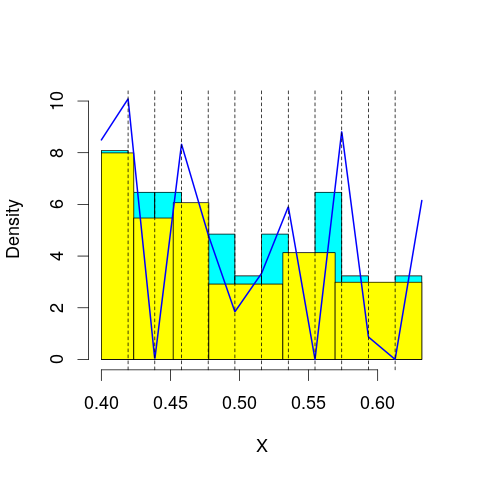

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.48897
mop.approx: Iteration 11. LL = 50.87508
mop.approx: Iteration 21. LL = 50.88948
mop.approx: Converged. Iteration 29. LL = 50.89052
[1] "Computing the linear combination of B-splines"


26.6303655575
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.35246
mop.approx: Iteration 11. LL = 51.63526
mop.approx: Iteration 21. LL = 51.8344
mop.approx: Iteration 31. LL = 51.86136
mop.approx: Iteration 41. LL = 51.86561
mop.approx: Converged. Iteration 47. LL = 51.86622
[1] "Computing the linear combination of B-splines"


25.8732001781
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.68781
mop.approx: Iteration 11. LL = 45.59716
mop.approx: Iteration 21. LL = 45.73935
mop.approx: Iteration 31. LL = 45.76692
mop.approx: Iteration 41. LL = 45.77439
mop.approx: Iteration 51. LL = 45.77722
mop.approx: Iteration 61. LL = 45.77868
mop.approx: Iteration 71. LL = 45.7796
mop.approx: Iteration 81. LL = 45.78023
mop.approx: Converged. Iteration 86. LL = 45.78052
[1] "Computing the linear combination of B-splines"


18.0546344338
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.986733
mop.approx: Iteration 11. LL = 44.97338
mop.approx: Iteration 21. LL = 45.18503
mop.approx: Iteration 31. LL = 45.2311
mop.approx: Iteration 41. LL = 45.24766
mop.approx: Iteration 51. LL = 45.25456
mop.approx: Iteration 61. LL = 45.25764
mop.approx: Iteration 71. LL = 45.25911
mop.approx: Iteration 81. LL = 45.25984
mop.approx: Converged. Iteration 83. LL = 45.25999
[1] "Computing the linear combination of B-splines"


15.8012306858
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.888646
mop.approx: Iteration 11. LL = 43.95352
mop.approx: Iteration 21. LL = 44.08461
mop.approx: Iteration 31. LL = 44.13321
mop.approx: Iteration 41. LL = 44.15874
mop.approx: Iteration 51. LL = 44.17353
mop.approx: Iteration 61. LL = 44.18239
mop.approx: Iteration 71. LL = 44.18778
mop.approx: Iteration 81. LL = 44.19106
mop.approx: Iteration 91. LL = 44.19304
mop.approx: Iteration 101. LL = 44.19422
mop.approx: Iteration 111. LL = 44.19491
mop.approx: Converged. Iteration 114. LL = 44.1951
[1] "Computing the linear combination of B-splines"


13.0034758174
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.2563
mop.approx: Iteration 11. LL = 43.97602
mop.approx: Iteration 21. LL = 44.0334
mop.approx: Iteration 31. LL = 44.0552
mop.approx: Iteration 41. LL = 44.06654
mop.approx: Iteration 51. LL = 44.07329
mop.approx: Iteration 61. LL = 44.07756
mop.approx: Iteration 71. LL = 44.08038
mop.approx: Iteration 81. LL = 44.0823
mop.approx: Iteration 91. LL = 44.08365
mop.approx: Iteration 101. LL = 44.08462
mop.approx: Iteration 111. LL = 44.08535
mop.approx: Iteration 121. LL = 44.0859
mop.approx: Converged. Iteration 125. LL = 44.08613
[1] "Computing the linear combination of B-splines"


11.1616370963
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.005446
mop.approx: Iteration 11. LL = 44.30016
mop.approx: Iteration 21. LL = 44.40306
mop.approx: Iteration 31. LL = 44.44031
mop.approx: Iteration 41. LL = 44.46067
mop.approx: Iteration 51. LL = 44.47206
mop.approx: Iteration 61. LL = 44.4786
mop.approx: Iteration 71. LL = 44.48249
mop.approx: Iteration 81. LL = 44.48491
mop.approx: Iteration 91. LL = 44.4865
mop.approx: Iteration 101. LL = 44.48761
mop.approx: Iteration 111. LL = 44.48841
mop.approx: Iteration 121. LL = 44.48903
mop.approx: Iteration 131. LL = 44.48953
mop.approx: Converged. Iteration 131. LL = 44.48957
[1] "Computing the linear combination of B-splines"


9.83203158607
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.62606
mop.approx: Iteration 11. LL = 52.33793
mop.approx: Iteration 21. LL = 52.38545
mop.approx: Iteration 31. LL = 52.39349
mop.approx: Iteration 41. LL = 52.3961
mop.approx: Iteration 51. LL = 52.39723
mop.approx: Converged. Iteration 57. LL = 52.39766
[1] "Computing the linear combination of B-splines"


28.1375123975
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 28.137512397524759)
m reached
('Sum of Probabilities:', 0.9927757607900071)
chosen


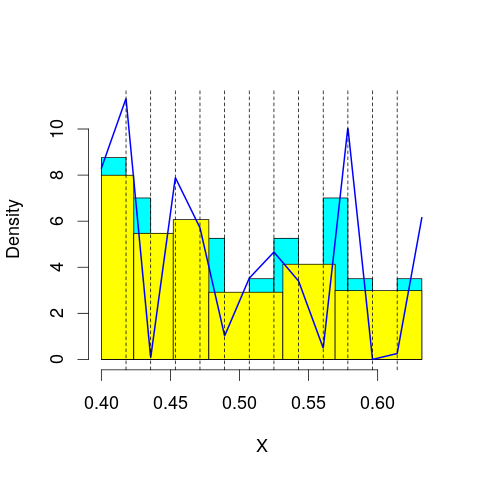

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.48897
mop.approx: Iteration 11. LL = 51.81665
mop.approx: Iteration 21. LL = 51.86178
mop.approx: Iteration 31. LL = 51.86875
mop.approx: Iteration 41. LL = 51.87068
mop.approx: Converged. Iteration 48. LL = 51.87127
[1] "Computing the linear combination of B-splines"


25.8782472421
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.35246
mop.approx: Iteration 11. LL = 51.46818
mop.approx: Iteration 21. LL = 51.61497
mop.approx: Iteration 31. LL = 51.63788
mop.approx: Iteration 41. LL = 51.64209
mop.approx: Iteration 51. LL = 51.64311
mop.approx: Converged. Iteration 52. LL = 51.64321
[1] "Computing the linear combination of B-splines"


23.9173245386
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.68781
mop.approx: Iteration 11. LL = 46.4204
mop.approx: Iteration 21. LL = 46.58274
mop.approx: Iteration 31. LL = 46.6216
mop.approx: Iteration 41. LL = 46.63778
mop.approx: Iteration 51. LL = 46.64554
mop.approx: Iteration 61. LL = 46.64932
mop.approx: Iteration 71. LL = 46.65114
mop.approx: Iteration 81. LL = 46.65203
mop.approx: Converged. Iteration 85. LL = 46.65228
[1] "Computing the linear combination of B-splines"


17.1935256176
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.986733
mop.approx: Iteration 11. LL = 45.21458
mop.approx: Iteration 21. LL = 45.37386
mop.approx: Iteration 31. LL = 45.4068
mop.approx: Iteration 41. LL = 45.42056
mop.approx: Iteration 51. LL = 45.42739
mop.approx: Iteration 61. LL = 45.43092
mop.approx: Iteration 71. LL = 45.43279
mop.approx: Iteration 81. LL = 45.43379
mop.approx: Converged. Iteration 89. LL = 45.43429
[1] "Computing the linear combination of B-splines"


14.242664517
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.888646
mop.approx: Iteration 11. LL = 44.32991
mop.approx: Iteration 21. LL = 44.54836
mop.approx: Iteration 31. LL = 44.63311
mop.approx: Iteration 41. LL = 44.6724
mop.approx: Iteration 51. LL = 44.69294
mop.approx: Iteration 61. LL = 44.70465
mop.approx: Iteration 71. LL = 44.71178
mop.approx: Iteration 81. LL = 44.71639
mop.approx: Iteration 91. LL = 44.71953
mop.approx: Iteration 101. LL = 44.72175
mop.approx: Iteration 111. LL = 44.72337
mop.approx: Iteration 121. LL = 44.72459
mop.approx: Iteration 131. LL = 44.72553
mop.approx: Iteration 141. LL = 44.72625
mop.approx: Iteration 151. LL = 44.72681
mop.approx: Converged. Iteration 156. LL = 44.72709
[1] "Computing the linear combination of B-splines"


11.8026015058
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.2563
mop.approx: Iteration 11. LL = 44.07465
mop.approx: Iteration 21. LL = 44.16374
mop.approx: Iteration 31. LL = 44.19978
mop.approx: Iteration 41. LL = 44.21576
mop.approx: Iteration 51. LL = 44.22292
mop.approx: Iteration 61. LL = 44.22616
mop.approx: Iteration 71. LL = 44.22769
mop.approx: Iteration 81. LL = 44.2285
mop.approx: Converged. Iteration 88. LL = 44.2289
[1] "Computing the linear combination of B-splines"


9.5715503713
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.005446
mop.approx: Iteration 11. LL = 44.38811
mop.approx: Iteration 21. LL = 44.47488
mop.approx: Iteration 31. LL = 44.50755
mop.approx: Iteration 41. LL = 44.52505
mop.approx: Iteration 51. LL = 44.53481
mop.approx: Iteration 61. LL = 44.54034
mop.approx: Iteration 71. LL = 44.54349
mop.approx: Iteration 81. LL = 44.54529
mop.approx: Iteration 91. LL = 44.54632
mop.approx: Iteration 101. LL = 44.54691
mop.approx: Converged. Iteration 101. LL = 44.54696
[1] "Computing the linear combination of B-splines"


8.15673958436
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.62606
mop.approx: Iteration 11. LL = 52.41227
mop.approx: Iteration 21. LL = 52.43932
mop.approx: Iteration 31. LL = 52.44562
mop.approx: Iteration 41. LL = 52.4477
mop.approx: Iteration 51. LL = 52.44852
mop.approx: Converged. Iteration 51. LL = 52.44856
[1] "Computing the linear combination of B-splines"


26.4555455844
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 26.455545584374988)
m reached
('Sum of Probabilities:', 0.9931024506089801)
chosen


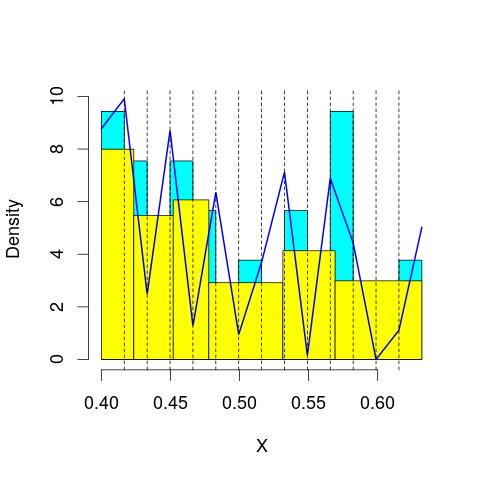

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.48897
mop.approx: Iteration 11. LL = 52.72674
mop.approx: Iteration 21. LL = 52.78925
mop.approx: Iteration 31. LL = 52.79304
mop.approx: Converged. Iteration 33. LL = 52.79321
[1] "Computing the linear combination of B-splines"


25.0673211995
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.35246
mop.approx: Iteration 11. LL = 51.65803
mop.approx: Iteration 21. LL = 51.77981
mop.approx: Iteration 31. LL = 51.79903
mop.approx: Iteration 41. LL = 51.80275
mop.approx: Converged. Iteration 49. LL = 51.80355
[1] "Computing the linear combination of B-splines"


22.3447962764
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.68781
mop.approx: Iteration 11. LL = 46.95061
mop.approx: Iteration 21. LL = 47.10364
mop.approx: Iteration 31. LL = 47.12827
mop.approx: Iteration 41. LL = 47.13351
mop.approx: Iteration 51. LL = 47.13478
mop.approx: Converged. Iteration 53. LL = 47.13493
[1] "Computing the linear combination of B-splines"


15.9433027964
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.986733
mop.approx: Iteration 11. LL = 45.72863
mop.approx: Iteration 21. LL = 45.92366
mop.approx: Iteration 31. LL = 45.96579
mop.approx: Iteration 41. LL = 45.98429
mop.approx: Iteration 51. LL = 45.99626
mop.approx: Iteration 61. LL = 46.00485
mop.approx: Iteration 71. LL = 46.01105
mop.approx: Iteration 81. LL = 46.01548
mop.approx: Iteration 91. LL = 46.01861
mop.approx: Iteration 101. LL = 46.02081
mop.approx: Iteration 111. LL = 46.02234
mop.approx: Iteration 121. LL = 46.02342
mop.approx: Iteration 131. LL = 46.02416
mop.approx: Converged. Iteration 139. LL = 46.02464
[1] "Computing the linear combination of B-splines"


13.1001485248
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.888646
mop.approx: Iteration 11. LL = 44.74258
mop.approx: Iteration 21. LL = 45.06244
mop.approx: Iteration 31. LL = 45.16927
mop.approx: Iteration 41. LL = 45.21293
mop.approx: Iteration 51. LL = 45.23299
mop.approx: Iteration 61. LL = 45.24296
mop.approx: Iteration 71. LL = 45.24825
mop.approx: Iteration 81. LL = 45.25123
mop.approx: Iteration 91. LL = 45.25303
mop.approx: Iteration 101. LL = 45.25418
mop.approx: Iteration 111. LL = 45.25496
mop.approx: Iteration 121. LL = 45.25552
mop.approx: Converged. Iteration 122. LL = 45.25561
[1] "Computing the linear combination of B-splines"


10.5982485594
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.2563
mop.approx: Iteration 11. LL = 44.30824
mop.approx: Iteration 21. LL = 44.40237
mop.approx: Iteration 31. LL = 44.425
mop.approx: Iteration 41. LL = 44.43248
mop.approx: Iteration 51. LL = 44.43625
mop.approx: Iteration 61. LL = 44.43862
mop.approx: Iteration 71. LL = 44.44022
mop.approx: Iteration 81. LL = 44.44129
mop.approx: Iteration 91. LL = 44.442
mop.approx: Converged. Iteration 97. LL = 44.44235
[1] "Computing the linear combination of B-splines"


8.05211593347
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.005446
mop.approx: Iteration 11. LL = 44.46986
mop.approx: Iteration 21. LL = 44.58246
mop.approx: Iteration 31. LL = 44.62513
mop.approx: Iteration 41. LL = 44.64532
mop.approx: Iteration 51. LL = 44.65622
mop.approx: Iteration 61. LL = 44.66274
mop.approx: Iteration 71. LL = 44.6669
mop.approx: Iteration 81. LL = 44.66967
mop.approx: Iteration 91. LL = 44.67155
mop.approx: Iteration 101. LL = 44.67283
mop.approx: Iteration 111. LL = 44.67373
mop.approx: Iteration 121. LL = 44.67436
mop.approx: Converged. Iteration 126. LL = 44.67464
[1] "Computing the linear combination of B-splines"


6.55056766895
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.62606
mop.approx: Iteration 11. LL = 53.0238
mop.approx: Converged. Iteration 20. LL = 53.02737
[1] "Computing the linear combination of B-splines"


25.3014799986
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 25.301479998617619)
m reached
('Sum of Probabilities:', 0.9933553992395235)
chosen


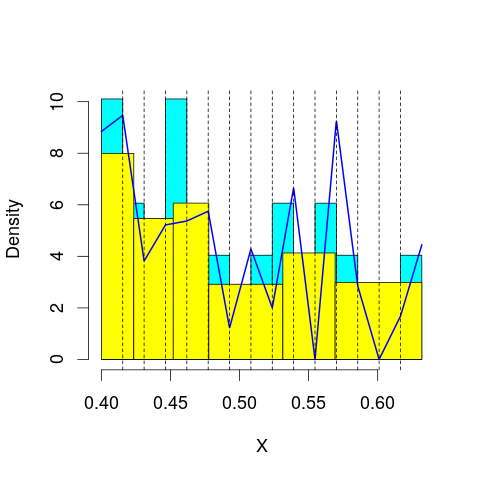

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.48897
mop.approx: Iteration 11. LL = 52.74468
mop.approx: Iteration 21. LL = 52.79471
mop.approx: Iteration 31. LL = 52.79991
mop.approx: Converged. Iteration 39. LL = 52.80082
[1] "Computing the linear combination of B-splines"


23.3420655022
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.35246
mop.approx: Iteration 11. LL = 52.01123
mop.approx: Iteration 21. LL = 52.11355
mop.approx: Iteration 31. LL = 52.13518
mop.approx: Iteration 41. LL = 52.14288
mop.approx: Iteration 51. LL = 52.14645
mop.approx: Iteration 61. LL = 52.1484
mop.approx: Iteration 71. LL = 52.14957
mop.approx: Iteration 81. LL = 52.15032
mop.approx: Converged. Iteration 85. LL = 52.15059
[1] "Computing the linear combination of B-splines"


20.9589712996
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.68781
mop.approx: Iteration 11. LL = 47.10805
mop.approx: Iteration 21. LL = 47.21988
mop.approx: Iteration 31. LL = 47.238
mop.approx: Iteration 41. LL = 47.24287
mop.approx: Iteration 51. LL = 47.24489
mop.approx: Iteration 61. LL = 47.24611
mop.approx: Iteration 71. LL = 47.24701
mop.approx: Iteration 81. LL = 47.24773
mop.approx: Iteration 91. LL = 47.24833
mop.approx: Converged. Iteration 99. LL = 47.24878
[1] "Computing the linear combination of B-splines"


14.3242912652
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.986733
mop.approx: Iteration 11. LL = 46.47765
mop.approx: Iteration 21. LL = 46.69227
mop.approx: Iteration 31. LL = 46.73586
mop.approx: Iteration 41. LL = 46.74969
mop.approx: Iteration 51. LL = 46.7548
mop.approx: Iteration 61. LL = 46.75686
mop.approx: Iteration 71. LL = 46.75778
mop.approx: Converged. Iteration 75. LL = 46.75804
[1] "Computing the linear combination of B-splines"


12.1006836383
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.888646
mop.approx: Iteration 11. LL = 44.96685
mop.approx: Iteration 21. LL = 45.23783
mop.approx: Iteration 31. LL = 45.3114
mop.approx: Iteration 41. LL = 45.33989
mop.approx: Iteration 51. LL = 45.35508
mop.approx: Iteration 61. LL = 45.36533
mop.approx: Iteration 71. LL = 45.37305
mop.approx: Iteration 81. LL = 45.37904
mop.approx: Iteration 91. LL = 45.38368
mop.approx: Iteration 101. LL = 45.38724
mop.approx: Iteration 111. LL = 45.38993
mop.approx: Iteration 121. LL = 45.39194
mop.approx: Iteration 131. LL = 45.39344
mop.approx: Iteration 141. LL = 45.39455
mop.approx: Iteration 151. LL = 45.39536
mop.approx: Iteration 161. LL = 45.39597
mop.approx: Converged. Iteration 166. LL = 45.39626
[1] "Computing the linear combination of B-splines"


9.00602979569
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.2563
mop.approx: Iteration 11. LL = 44.67871
mop.approx: Iteration 21. LL = 44.84641
mop.approx: Iteration 31. LL = 44.90103
mop.approx: Iteration 41. LL = 44.9258
mop.approx: Iteration 51. LL = 44.93937
mop.approx: Iteration 61. LL = 44.94762
mop.approx: Iteration 71. LL = 44.95297
mop.approx: Iteration 81. LL = 44.9566
mop.approx: Iteration 91. LL = 44.95916
mop.approx: Iteration 101. LL = 44.96101
mop.approx: Iteration 111. LL = 44.96238
mop.approx: Iteration 121. LL = 44.96343
mop.approx: Iteration 131. LL = 44.96423
mop.approx: Iteration 141. LL = 44.96486
mop.approx: Iteration 151. LL = 44.96536
mop.approx: Converged. Iteration 151. LL = 44.9654
[1] "Computing the linear combination of B-splines"


6.84218219814
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.005446
mop.approx: Iteration 11. LL = 44.59359
mop.approx: Iteration 21. LL = 44.69499
mop.approx: Iteration 31. LL = 44.72097
mop.approx: Iteration 41. LL = 44.72913
mop.approx: Iteration 51. LL = 44.73229
mop.approx: Iteration 61. LL = 44.73376
mop.approx: Iteration 71. LL = 44.73453
mop.approx: Converged. Iteration 75. LL = 44.73478
[1] "Computing the linear combination of B-splines"


4.87820244968
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.62606
mop.approx: Iteration 11. LL = 53.5591
mop.approx: Iteration 21. LL = 53.61757
mop.approx: Iteration 31. LL = 53.63002
mop.approx: Iteration 41. LL = 53.63406
mop.approx: Iteration 51. LL = 53.63555
mop.approx: Converged. Iteration 56. LL = 53.63595
[1] "Computing the linear combination of B-splines"


24.1771971261
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 24.177197126079903)
m reached
('Sum of Probabilities:', 0.9933575457963622)
chosen


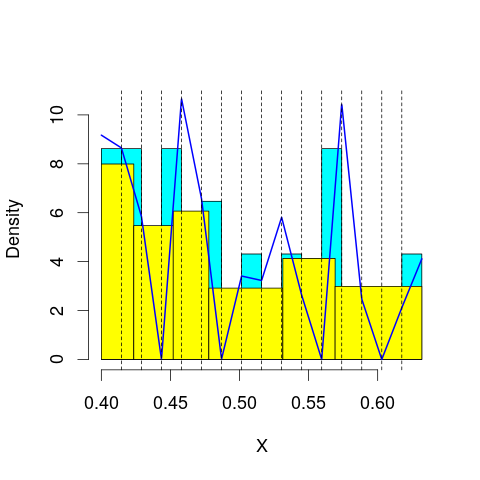

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.48897
mop.approx: Iteration 11. LL = 53.6953
mop.approx: Iteration 21. LL = 53.82472
mop.approx: Iteration 31. LL = 53.85117
mop.approx: Iteration 41. LL = 53.85975
mop.approx: Iteration 51. LL = 53.86292
mop.approx: Iteration 61. LL = 53.86417
mop.approx: Converged. Iteration 65. LL = 53.86448
[1] "Computing the linear combination of B-splines"


22.672855216
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.35246
mop.approx: Iteration 11. LL = 52.48896
mop.approx: Iteration 21. LL = 52.6161
mop.approx: Iteration 31. LL = 52.6419
mop.approx: Iteration 41. LL = 52.652
mop.approx: Iteration 51. LL = 52.65705
mop.approx: Iteration 61. LL = 52.65981
mop.approx: Iteration 71. LL = 52.66138
mop.approx: Iteration 81. LL = 52.66228
mop.approx: Converged. Iteration 86. LL = 52.66263
[1] "Computing the linear combination of B-splines"


19.7381426808
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.68781
mop.approx: Iteration 11. LL = 47.23226
mop.approx: Iteration 21. LL = 47.32529
mop.approx: Iteration 31. LL = 47.35242
mop.approx: Iteration 41. LL = 47.36433
mop.approx: Iteration 51. LL = 47.37026
mop.approx: Iteration 61. LL = 47.37346
mop.approx: Iteration 71. LL = 47.37528
mop.approx: Iteration 81. LL = 47.37634
mop.approx: Iteration 91. LL = 47.37697
mop.approx: Converged. Iteration 91. LL = 47.37702
[1] "Computing the linear combination of B-splines"


12.7196577315
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.986733
mop.approx: Iteration 11. LL = 47.21315
mop.approx: Iteration 21. LL = 47.44056
mop.approx: Iteration 31. LL = 47.47891
mop.approx: Iteration 41. LL = 47.49278
mop.approx: Iteration 51. LL = 47.50108
mop.approx: Iteration 61. LL = 47.50695
mop.approx: Iteration 71. LL = 47.51125
mop.approx: Iteration 81. LL = 47.5144
mop.approx: Iteration 91. LL = 47.51669
mop.approx: Iteration 101. LL = 47.51834
mop.approx: Iteration 111. LL = 47.51951
mop.approx: Iteration 121. LL = 47.52034
mop.approx: Iteration 131. LL = 47.52092
mop.approx: Converged. Iteration 131. LL = 47.52096
[1] "Computing the linear combination of B-splines"


11.1307352906
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.888646
mop.approx: Iteration 11. LL = 45.33491
mop.approx: Iteration 21. LL = 45.56179
mop.approx: Iteration 31. LL = 45.61126
mop.approx: Iteration 41. LL = 45.63056
mop.approx: Iteration 51. LL = 45.64113
mop.approx: Iteration 61. LL = 45.64768
mop.approx: Iteration 71. LL = 45.65187
mop.approx: Iteration 81. LL = 45.65457
mop.approx: Iteration 91. LL = 45.65633
mop.approx: Iteration 101. LL = 45.65748
mop.approx: Iteration 111. LL = 45.65826
mop.approx: Converged. Iteration 120. LL = 45.65878
[1] "Computing the linear combination of B-splines"


7.53568880223
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.2563
mop.approx: Iteration 11. LL = 44.97446
mop.approx: Iteration 21. LL = 45.1994
mop.approx: Iteration 31. LL = 45.26688
mop.approx: Iteration 41. LL = 45.29274
mop.approx: Iteration 51. LL = 45.30512
mop.approx: Iteration 61. LL = 45.31247
mop.approx: Iteration 71. LL = 45.31762
mop.approx: Iteration 81. LL = 45.32155
mop.approx: Iteration 91. LL = 45.32465
mop.approx: Iteration 101. LL = 45.32711
mop.approx: Iteration 111. LL = 45.32906
mop.approx: Iteration 121. LL = 45.33056
mop.approx: Iteration 131. LL = 45.33172
mop.approx: Iteration 141. LL = 45.33259
mop.approx: Iteration 151. LL = 45.33324
mop.approx: Converged. Iteration 157. LL = 45.33358
[1] "Computing the linear combination of B-splines"


5.47754909718
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.005446
mop.approx: Iteration 11. LL = 44.91414
mop.approx: Iteration 21. LL = 45.04667
mop.approx: Iteration 31. LL = 45.07665
mop.approx: Iteration 41. LL = 45.08683
mop.approx: Iteration 51. LL = 45.0916
mop.approx: Iteration 61. LL = 45.0944
mop.approx: Iteration 71. LL = 45.09629
mop.approx: Iteration 81. LL = 45.09766
mop.approx: Iteration 91. LL = 45.09871
mop.approx: Iteration 101. LL = 45.09952
mop.approx: Iteration 111. LL = 45.10017
mop.approx: Iteration 121. LL = 45.10069
mop.approx: Converged. Iteration 122. LL = 45.10078
[1] "Computing the linear combination of B-splines"


3.51076571555
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.62606
mop.approx: Iteration 11. LL = 54.53444
mop.approx: Iteration 21. LL = 54.60384
mop.approx: Iteration 31. LL = 54.61286
mop.approx: Iteration 41. LL = 54.61484
mop.approx: Converged. Iteration 46. LL = 54.61527
[1] "Computing the linear combination of B-splines"


23.4236438816
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 23.42364388163152)
m reached
('Sum of Probabilities:', 0.9928291162599832)
chosen


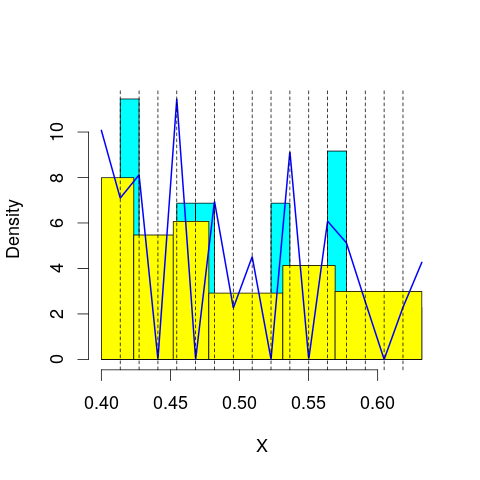

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.48897
mop.approx: Iteration 11. LL = 53.70229
mop.approx: Iteration 21. LL = 53.82999
mop.approx: Iteration 31. LL = 53.84838
mop.approx: Iteration 41. LL = 53.85266
mop.approx: Iteration 51. LL = 53.85435
mop.approx: Iteration 61. LL = 53.85527
mop.approx: Converged. Iteration 67. LL = 53.85569
[1] "Computing the linear combination of B-splines"


20.9311987259
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.35246
mop.approx: Iteration 11. LL = 53.01641
mop.approx: Iteration 21. LL = 53.2085
mop.approx: Iteration 31. LL = 53.26361
mop.approx: Iteration 41. LL = 53.28342
mop.approx: Iteration 51. LL = 53.29125
mop.approx: Iteration 61. LL = 53.29469
mop.approx: Iteration 71. LL = 53.29638
mop.approx: Iteration 81. LL = 53.29733
mop.approx: Converged. Iteration 88. LL = 53.29782
[1] "Computing the linear combination of B-splines"


18.6404620129
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.68781
mop.approx: Iteration 11. LL = 47.50974
mop.approx: Iteration 21. LL = 47.58762
mop.approx: Iteration 31. LL = 47.6124
mop.approx: Iteration 41. LL = 47.62267
mop.approx: Iteration 51. LL = 47.62675
mop.approx: Iteration 61. LL = 47.62833
mop.approx: Converged. Iteration 69. LL = 47.62891
[1] "Computing the linear combination of B-splines"


11.2386845374
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.986733
mop.approx: Iteration 11. LL = 47.49345
mop.approx: Iteration 21. LL = 47.6491
mop.approx: Iteration 31. LL = 47.68212
mop.approx: Iteration 41. LL = 47.69831
mop.approx: Iteration 51. LL = 47.70692
mop.approx: Iteration 61. LL = 47.71131
mop.approx: Iteration 71. LL = 47.71345
mop.approx: Iteration 81. LL = 47.71451
mop.approx: Converged. Iteration 88. LL = 47.71496
[1] "Computing the linear combination of B-splines"


9.59186557021
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.888646
mop.approx: Iteration 11. LL = 46.10798
mop.approx: Iteration 21. LL = 46.41538
mop.approx: Iteration 31. LL = 46.49762
mop.approx: Iteration 41. LL = 46.53148
mop.approx: Iteration 51. LL = 46.54853
mop.approx: Iteration 61. LL = 46.55824
mop.approx: Iteration 71. LL = 46.5642
mop.approx: Iteration 81. LL = 46.56801
mop.approx: Iteration 91. LL = 46.57051
mop.approx: Iteration 101. LL = 46.57218
mop.approx: Iteration 111. LL = 46.57331
mop.approx: Iteration 121. LL = 46.57409
mop.approx: Converged. Iteration 130. LL = 46.57463
[1] "Computing the linear combination of B-splines"


6.71867056508
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.2563
mop.approx: Iteration 11. LL = 44.97428
mop.approx: Iteration 21. LL = 45.13296
mop.approx: Iteration 31. LL = 45.18043
mop.approx: Iteration 41. LL = 45.19952
mop.approx: Iteration 51. LL = 45.20935
mop.approx: Iteration 61. LL = 45.21552
mop.approx: Iteration 71. LL = 45.21988
mop.approx: Iteration 81. LL = 45.22315
mop.approx: Iteration 91. LL = 45.22569
mop.approx: Iteration 101. LL = 45.22769
mop.approx: Iteration 111. LL = 45.22929
mop.approx: Iteration 121. LL = 45.2306
mop.approx: Iteration 131. LL = 45.23168
mop.approx: Iteration 141. LL = 45.23258
mop.approx: Iteration 151. LL = 45.23334
mop.approx: Iteration 161. LL = 45.23399
mop.approx: Iteration 171. LL = 45.23455
mop.approx: Iteration 181. LL = 45.23504
mop.approx: Converged. Iteration 182. LL = 45.23513
[1] "Computing the linear combination of B-splines"


3.64625471478
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.005446
mop.approx: Iteration 11. LL = 45.3152
mop.approx: Iteration 21. LL = 45.49068
mop.approx: Iteration 31. LL = 45.53113
mop.approx: Iteration 41. LL = 45.5463
mop.approx: Iteration 51. LL = 45.55418
mop.approx: Iteration 61. LL = 45.55919
mop.approx: Iteration 71. LL = 45.56281
mop.approx: Iteration 81. LL = 45.56561
mop.approx: Iteration 91. LL = 45.56787
mop.approx: Iteration 101. LL = 45.56971
mop.approx: Iteration 111. LL = 45.57122
mop.approx: Iteration 121. LL = 45.57246
mop.approx: Iteration 131. LL = 45.57347
mop.approx: Iteration 141. LL = 45.57429
mop.approx: Iteration 151. LL = 45.57496
mop.approx: Iteration 161. LL = 45.57551
mop.approx: Converged. Iteration 164. LL = 45.57569
[1] "Computing the linear combination of B-splines"


2.25253289835
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.62606
mop.approx: Iteration 11. LL = 56.35809
mop.approx: Iteration 21. LL = 56.38093
mop.approx: Iteration 31. LL = 56.3851
mop.approx: Iteration 41. LL = 56.38642
mop.approx: Converged. Iteration 43. LL = 56.3866
[1] "Computing the linear combination of B-splines"


23.462111678
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 23.462111678027867)
m reached
('Sum of Probabilities:', 0.9921980075577728)
chosen


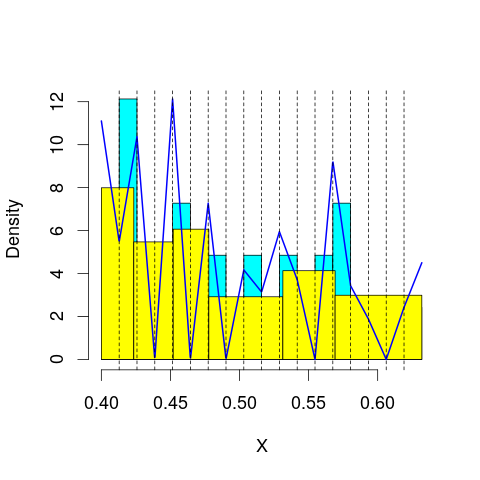

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.48897
mop.approx: Iteration 11. LL = 53.73834
mop.approx: Iteration 21. LL = 53.8847
mop.approx: Iteration 31. LL = 53.91266
mop.approx: Iteration 41. LL = 53.92233
mop.approx: Iteration 51. LL = 53.92708
mop.approx: Iteration 61. LL = 53.92984
mop.approx: Iteration 71. LL = 53.93161
mop.approx: Iteration 81. LL = 53.93281
mop.approx: Iteration 91. LL = 53.93367
mop.approx: Iteration 101. LL = 53.9343
mop.approx: Converged. Iteration 102. LL = 53.93441
[1] "Computing the linear combination of B-splines"


19.2770502343
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.35246
mop.approx: Iteration 11. LL = 53.62093
mop.approx: Iteration 21. LL = 53.73639
mop.approx: Iteration 31. LL = 53.75844
mop.approx: Iteration 41. LL = 53.76301
mop.approx: Converged. Iteration 49. LL = 53.76395
[1] "Computing the linear combination of B-splines"


17.3737237039
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.68781
mop.approx: Iteration 11. LL = 47.9902
mop.approx: Iteration 21. LL = 48.18667
mop.approx: Iteration 31. LL = 48.24181
mop.approx: Iteration 41. LL = 48.26553
mop.approx: Iteration 51. LL = 48.27628
mop.approx: Iteration 61. LL = 48.28094
mop.approx: Iteration 71. LL = 48.28289
mop.approx: Iteration 81. LL = 48.28372
mop.approx: Converged. Iteration 82. LL = 48.28382
[1] "Computing the linear combination of B-splines"


10.1607285843
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.986733
mop.approx: Iteration 11. LL = 47.90307
mop.approx: Iteration 21. LL = 48.03127
mop.approx: Iteration 31. LL = 48.0684
mop.approx: Iteration 41. LL = 48.08486
mop.approx: Iteration 51. LL = 48.09243
mop.approx: Iteration 61. LL = 48.09619
mop.approx: Iteration 71. LL = 48.09828
mop.approx: Iteration 81. LL = 48.0996
mop.approx: Iteration 91. LL = 48.1005
mop.approx: Iteration 101. LL = 48.10116
mop.approx: Converged. Iteration 107. LL = 48.10152
[1] "Computing the linear combination of B-splines"


8.24555856622
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.888646
mop.approx: Iteration 11. LL = 46.78227
mop.approx: Iteration 21. LL = 47.10842
mop.approx: Iteration 31. LL = 47.16225
mop.approx: Iteration 41. LL = 47.17894
mop.approx: Iteration 51. LL = 47.18756
mop.approx: Iteration 61. LL = 47.19301
mop.approx: Iteration 71. LL = 47.19667
mop.approx: Iteration 81. LL = 47.19916
mop.approx: Iteration 91. LL = 47.20085
mop.approx: Iteration 101. LL = 47.20201
mop.approx: Iteration 111. LL = 47.20281
mop.approx: Iteration 121. LL = 47.20337
mop.approx: Converged. Iteration 121. LL = 47.20342
[1] "Computing the linear combination of B-splines"


5.61459582295
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.2563
mop.approx: Iteration 11. LL = 45.25035
mop.approx: Iteration 21. LL = 45.3946
mop.approx: Iteration 31. LL = 45.44873
mop.approx: Iteration 41. LL = 45.48262
mop.approx: Iteration 51. LL = 45.50573
mop.approx: Iteration 61. LL = 45.52153
mop.approx: Iteration 71. LL = 45.53225
mop.approx: Iteration 81. LL = 45.53949
mop.approx: Iteration 91. LL = 45.54436
mop.approx: Iteration 101. LL = 45.54765
mop.approx: Iteration 111. LL = 45.54986
mop.approx: Iteration 121. LL = 45.55136
mop.approx: Iteration 131. LL = 45.55238
mop.approx: Iteration 141. LL = 45.55307
mop.approx: Converged. Iteration 147. LL = 45.55342
[1] "Computing the linear combination of B-splines"


2.23148744874
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.005446
mop.approx: Iteration 11. LL = 45.51445
mop.approx: Iteration 21. LL = 45.70185
mop.approx: Iteration 31. LL = 45.74341
mop.approx: Iteration 41. LL = 45.75452
mop.approx: Iteration 51. LL = 45.75832
mop.approx: Iteration 61. LL = 45.76015
mop.approx: Iteration 71. LL = 45.76131
mop.approx: Iteration 81. LL = 45.76215
mop.approx: Iteration 91. LL = 45.76278
mop.approx: Converged. Iteration 99. LL = 45.76324
[1] "Computing the linear combination of B-splines"


0.701441450653
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.62606
mop.approx: Iteration 11. LL = 56.50205
mop.approx: Iteration 21. LL = 56.53253
mop.approx: Converged. Iteration 30. LL = 56.53431
[1] "Computing the linear combination of B-splines"


21.8769497135
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 21.876949713463141)
m reached
('Sum of Probabilities:', 0.9914673499209281)
chosen


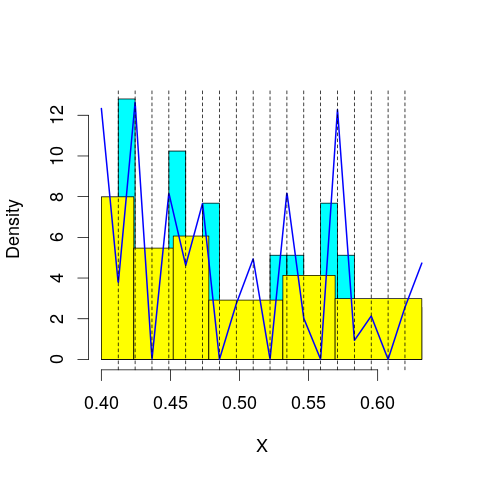

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.48897
mop.approx: Iteration 11. LL = 54.80219
mop.approx: Iteration 21. LL = 54.86012
mop.approx: Iteration 31. LL = 54.8694
mop.approx: Iteration 41. LL = 54.8723
mop.approx: Iteration 51. LL = 54.87355
mop.approx: Converged. Iteration 59. LL = 54.87415
[1] "Computing the linear combination of B-splines"


18.4839196489
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.35246
mop.approx: Iteration 11. LL = 54.048
mop.approx: Iteration 21. LL = 54.1623
mop.approx: Iteration 31. LL = 54.18883
mop.approx: Iteration 41. LL = 54.19736
mop.approx: Iteration 51. LL = 54.20053
mop.approx: Iteration 61. LL = 54.20183
mop.approx: Converged. Iteration 67. LL = 54.20228
[1] "Computing the linear combination of B-splines"


16.0791839787
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.68781
mop.approx: Iteration 11. LL = 48.30053
mop.approx: Iteration 21. LL = 48.46239
mop.approx: Iteration 31. LL = 48.49013
mop.approx: Iteration 41. LL = 48.49541
mop.approx: Converged. Iteration 50. LL = 48.49644
[1] "Computing the linear combination of B-splines"


8.6404788038
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.986733
mop.approx: Iteration 11. LL = 48.47633
mop.approx: Iteration 21. LL = 48.62718
mop.approx: Iteration 31. LL = 48.65791
mop.approx: Iteration 41. LL = 48.66783
mop.approx: Iteration 51. LL = 48.67178
mop.approx: Iteration 61. LL = 48.67364
mop.approx: Iteration 71. LL = 48.67469
mop.approx: Iteration 81. LL = 48.67541
mop.approx: Iteration 91. LL = 48.67596
mop.approx: Converged. Iteration 92. LL = 48.67606
[1] "Computing the linear combination of B-splines"


7.0872293808
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.888646
mop.approx: Iteration 11. LL = 47.15529
mop.approx: Iteration 21. LL = 47.37664
mop.approx: Iteration 31. LL = 47.42747
mop.approx: Iteration 41. LL = 47.44956
mop.approx: Iteration 51. LL = 47.46038
mop.approx: Iteration 61. LL = 47.46609
mop.approx: Iteration 71. LL = 47.46934
mop.approx: Iteration 81. LL = 47.4713
mop.approx: Iteration 91. LL = 47.47254
mop.approx: Iteration 101. LL = 47.47334
mop.approx: Converged. Iteration 108. LL = 47.47378
[1] "Computing the linear combination of B-splines"


4.15208388186
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.2563
mop.approx: Iteration 11. LL = 45.79746
mop.approx: Iteration 21. LL = 46.03439
mop.approx: Iteration 31. LL = 46.10378
mop.approx: Iteration 41. LL = 46.13237
mop.approx: Iteration 51. LL = 46.14587
mop.approx: Iteration 61. LL = 46.15286
mop.approx: Iteration 71. LL = 46.15677
mop.approx: Iteration 81. LL = 46.15911
mop.approx: Iteration 91. LL = 46.16058
mop.approx: Iteration 101. LL = 46.16154
mop.approx: Iteration 111. LL = 46.16218
mop.approx: Converged. Iteration 114. LL = 46.16237
[1] "Computing the linear combination of B-splines"


1.10808056075
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.005446
mop.approx: Iteration 11. LL = 45.49241
mop.approx: Iteration 21. LL = 45.60948
mop.approx: Iteration 31. LL = 45.64188
mop.approx: Iteration 41. LL = 45.65642
mop.approx: Iteration 51. LL = 45.6651
mop.approx: Iteration 61. LL = 45.67079
mop.approx: Iteration 71. LL = 45.67456
mop.approx: Iteration 81. LL = 45.67706
mop.approx: Iteration 91. LL = 45.67873
mop.approx: Iteration 101. LL = 45.67988
mop.approx: Iteration 111. LL = 45.68067
mop.approx: Iteration 121. LL = 45.68124
mop.approx: Converged. Iteration 123. LL = 45.68138
[1] "Computing the linear combination of B-splines"


-1.11734710676
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.62606
mop.approx: Iteration 11. LL = 55.39834
mop.approx: Iteration 21. LL = 55.46381
mop.approx: Iteration 31. LL = 55.47328
mop.approx: Iteration 41. LL = 55.47621
mop.approx: Iteration 51. LL = 55.47733
mop.approx: Converged. Iteration 54. LL = 55.47756
[1] "Computing the linear combination of B-splines"


19.0873353505
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 19.087335350464741)
m reached
('Sum of Probabilities:', 0.9906471303586756)
chosen


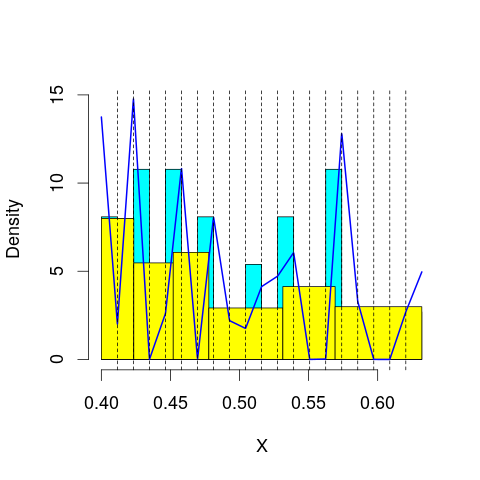

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.48897
mop.approx: Iteration 11. LL = 56.40702
mop.approx: Iteration 21. LL = 56.46706
mop.approx: Iteration 31. LL = 56.46996
mop.approx: Converged. Iteration 31. LL = 56.47002
[1] "Computing the linear combination of B-splines"


18.3469219526
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 46.35246
mop.approx: Iteration 11. LL = 54.17211
mop.approx: Iteration 21. LL = 54.38245
mop.approx: Iteration 31. LL = 54.41914
mop.approx: Iteration 41. LL = 54.42796
mop.approx: Iteration 51. LL = 54.4308
mop.approx: Iteration 61. LL = 54.43195
mop.approx: Converged. Iteration 66. LL = 54.43232
[1] "Computing the linear combination of B-splines"


14.5763553962
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.68781
mop.approx: Iteration 11. LL = 49.16687
mop.approx: Iteration 21. LL = 49.33781
mop.approx: Iteration 31. LL = 49.37223
mop.approx: Iteration 41. LL = 49.38015
mop.approx: Iteration 51. LL = 49.38207
mop.approx: Converged. Iteration 55. LL = 49.38239
[1] "Computing the linear combination of B-splines"


7.79355900908
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.986733
mop.approx: Iteration 11. LL = 48.69247
mop.approx: Iteration 21. LL = 48.94176
mop.approx: Iteration 31. LL = 49.00679
mop.approx: Iteration 41. LL = 49.02827
mop.approx: Iteration 51. LL = 49.03651
mop.approx: Iteration 61. LL = 49.04005
mop.approx: Iteration 71. LL = 49.04172
mop.approx: Iteration 81. LL = 49.04256
mop.approx: Converged. Iteration 85. LL = 49.04282
[1] "Computing the linear combination of B-splines"


5.72112509297
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.888646
mop.approx: Iteration 11. LL = 47.91465
mop.approx: Iteration 21. LL = 48.15879
mop.approx: Iteration 31. LL = 48.232
mop.approx: Iteration 41. LL = 48.26207
mop.approx: Iteration 51. LL = 48.27598
mop.approx: Iteration 61. LL = 48.28309
mop.approx: Iteration 71. LL = 48.287
mop.approx: Iteration 81. LL = 48.28925
mop.approx: Iteration 91. LL = 48.29059
mop.approx: Iteration 101. LL = 48.29141
mop.approx: Converged. Iteration 106. LL = 48.29173
[1] "Computing the linear combination of B-splines"


3.23714069373
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.2563
mop.approx: Iteration 11. LL = 46.19926
mop.approx: Iteration 21. LL = 46.51813
mop.approx: Iteration 31. LL = 46.59651
mop.approx: Iteration 41. LL = 46.62245
mop.approx: Iteration 51. LL = 46.63354
mop.approx: Iteration 61. LL = 46.63912
mop.approx: Iteration 71. LL = 46.64228
mop.approx: Iteration 81. LL = 46.64426
mop.approx: Iteration 91. LL = 46.64561
mop.approx: Iteration 101. LL = 46.64659
mop.approx: Iteration 111. LL = 46.64735
mop.approx: Iteration 121. LL = 46.64796
mop.approx: Converged. Iteration 130. LL = 46.64846
[1] "Computing the linear combination of B-splines"


-0.139562484012
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.005446
mop.approx: Iteration 11. LL = 45.67806
mop.approx: Iteration 21. LL = 45.79668
mop.approx: Iteration 31. LL = 45.83815
mop.approx: Iteration 41. LL = 45.8584
mop.approx: Iteration 51. LL = 45.86949
mop.approx: Iteration 61. LL = 45.87607
mop.approx: Iteration 71. LL = 45.88021
mop.approx: Iteration 81. LL = 45.8829
mop.approx: Iteration 91. LL = 45.8847
mop.approx: Iteration 101. LL = 45.88593
mop.approx: Iteration 111. LL = 45.88678
mop.approx: Iteration 121. LL = 45.88737
mop.approx: Converged. Iteration 123. LL = 45.88751
[1] "Computing the linear combination of B-splines"


-2.64157033291
lfps_4
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.55318
mop.approx: Converged. Iteration 8. LL = 75.40925
[1] "Computing the linear combination of B-splines"


70.2106493023
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 70.21064930225549)
m reached
('Sum of Probabilities:', 0.9917192597564017)
chosen


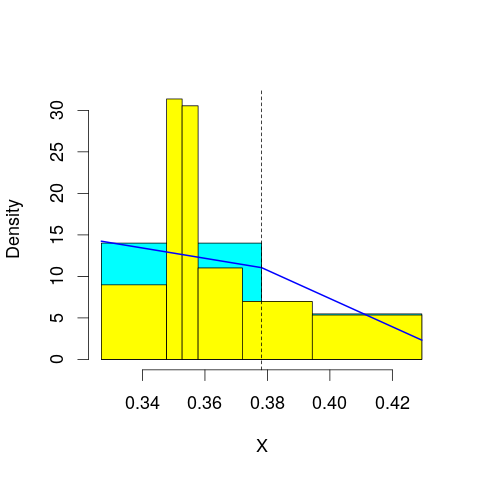

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.24576
mop.approx: Iteration 11. LL = 77.09434
mop.approx: Iteration 21. LL = 77.15077
mop.approx: Iteration 31. LL = 77.15554
mop.approx: Converged. Iteration 34. LL = 77.15595
[1] "Computing the linear combination of B-splines"


70.2244792701
('best: ', 70.21064930225549, 'accepted difference:', 119.35810381383433, 'cur BIC:', 70.224479270085126)
m reached
('Sum of Probabilities:', 0.9924497796209586)
chosen


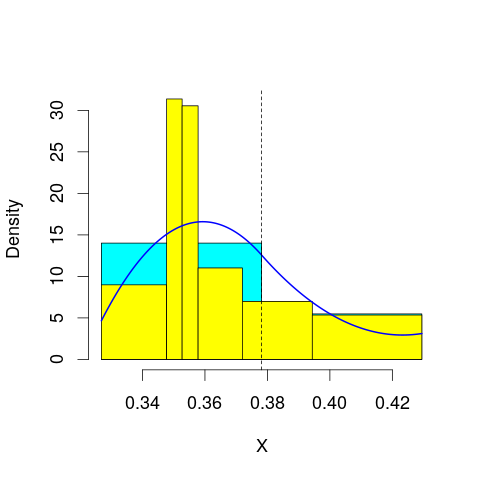

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 71.94126
mop.approx: Iteration 11. LL = 77.21546
mop.approx: Iteration 21. LL = 77.2232
mop.approx: Iteration 31. LL = 77.22634
mop.approx: Iteration 41. LL = 77.22832
mop.approx: Iteration 51. LL = 77.2296
mop.approx: Converged. Iteration 58. LL = 77.23031
[1] "Computing the linear combination of B-splines"


68.5659708878
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.01519
mop.approx: Iteration 11. LL = 57.49973
mop.approx: Iteration 21. LL = 57.64008
mop.approx: Iteration 31. LL = 57.66571
mop.approx: Iteration 41. LL = 57.67389
mop.approx: Iteration 51. LL = 57.67733
mop.approx: Iteration 61. LL = 57.67904
mop.approx: Iteration 71. LL = 57.67999
mop.approx: Converged. Iteration 75. LL = 57.68031
[1] "Computing the linear combination of B-splines"


47.2830974047
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.20843
mop.approx: Iteration 11. LL = 59.10349
mop.approx: Converged. Iteration 20. LL = 59.1302
[1] "Computing the linear combination of B-splines"


47.0001276629
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.29529
mop.approx: Iteration 11. LL = 52.35701
mop.approx: Iteration 21. LL = 52.70448
mop.approx: Iteration 31. LL = 52.79512
mop.approx: Iteration 41. LL = 52.82606
mop.approx: Iteration 51. LL = 52.83785
mop.approx: Iteration 61. LL = 52.84255
mop.approx: Iteration 71. LL = 52.84446
mop.approx: Converged. Iteration 80. LL = 52.84524
[1] "Computing the linear combination of B-splines"


38.9822978325
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.037047
mop.approx: Iteration 11. LL = 53.80536
mop.approx: Iteration 21. LL = 53.88182
mop.approx: Converged. Iteration 24. LL = 53.88223
[1] "Computing the linear combination of B-splines"


38.2864169483
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.279478
mop.approx: Iteration 11. LL = 48.30632
mop.approx: Iteration 21. LL = 48.73389
mop.approx: Iteration 31. LL = 48.86561
mop.approx: Iteration 41. LL = 48.91129
mop.approx: Iteration 51. LL = 48.92802
mop.approx: Iteration 61. LL = 48.93429
mop.approx: Iteration 71. LL = 48.93666
mop.approx: Iteration 81. LL = 48.93756
mop.approx: Converged. Iteration 82. LL = 48.93766
[1] "Computing the linear combination of B-splines"


31.6089763598
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.55318
mop.approx: Iteration 11. LL = 76.85161
mop.approx: Converged. Iteration 12. LL = 76.8518
[1] "Computing the linear combination of B-splines"


69.9203322354
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 69.920332235377046)
m reached
('Sum of Probabilities:', 0.9955476024816836)
chosen


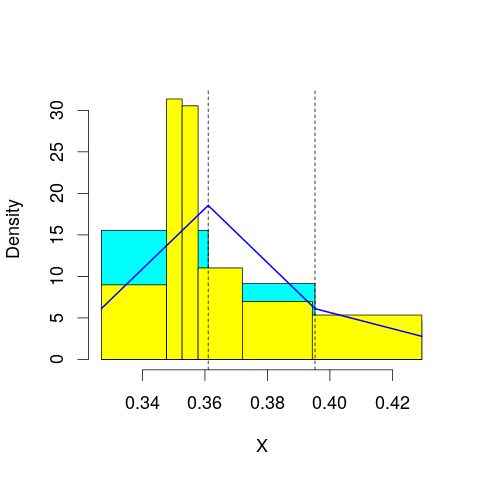

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.24576
mop.approx: Iteration 11. LL = 77.56835
mop.approx: Converged. Iteration 18. LL = 77.56987
[1] "Computing the linear combination of B-splines"


68.9055304993
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 71.94126
mop.approx: Iteration 11. LL = 77.26256
mop.approx: Iteration 21. LL = 77.30562
mop.approx: Iteration 31. LL = 77.31659
mop.approx: Iteration 41. LL = 77.31924
mop.approx: Converged. Iteration 44. LL = 77.31959
[1] "Computing the linear combination of B-splines"


66.9223857534
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.01519
mop.approx: Iteration 11. LL = 68.33893
mop.approx: Iteration 21. LL = 68.43113
mop.approx: Converged. Iteration 27. LL = 68.43265
[1] "Computing the linear combination of B-splines"


56.302578952
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.20843
mop.approx: Iteration 11. LL = 62.03795
mop.approx: Iteration 21. LL = 62.10523
mop.approx: Iteration 31. LL = 62.11154
mop.approx: Converged. Iteration 37. LL = 62.11233
[1] "Computing the linear combination of B-splines"


48.2493901306
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.29529
mop.approx: Iteration 11. LL = 62.31166
mop.approx: Iteration 21. LL = 62.3782
mop.approx: Converged. Iteration 24. LL = 62.37858
[1] "Computing the linear combination of B-splines"


46.7827706593
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.037047
mop.approx: Iteration 11. LL = 56.17865
mop.approx: Iteration 21. LL = 56.47343
mop.approx: Iteration 31. LL = 56.54677
mop.approx: Iteration 41. LL = 56.57293
mop.approx: Iteration 51. LL = 56.58381
mop.approx: Iteration 61. LL = 56.58866
mop.approx: Iteration 71. LL = 56.59089
mop.approx: Iteration 81. LL = 56.59193
mop.approx: Converged. Iteration 84. LL = 56.59217
[1] "Computing the linear combination of B-splines"


39.2634914803
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.279478
mop.approx: Iteration 11. LL = 56.74216
mop.approx: Iteration 21. LL = 56.85542
mop.approx: Converged. Iteration 26. LL = 56.85656
[1] "Computing the linear combination of B-splines"


37.7950163078
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.55318
mop.approx: Converged. Iteration 9. LL = 78.85689
[1] "Computing the linear combination of B-splines"


70.1925466908
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 70.192546690840558)
m reached
('Sum of Probabilities:', 0.9969213329779333)
chosen


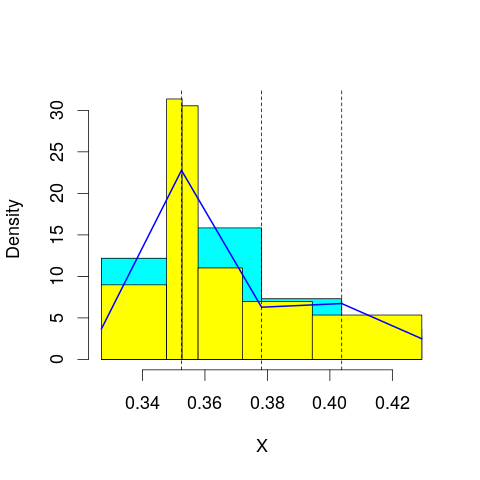

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.24576
mop.approx: Iteration 11. LL = 77.44603
mop.approx: Iteration 21. LL = 77.50111
mop.approx: Iteration 31. LL = 77.51699
mop.approx: Iteration 41. LL = 77.52255
mop.approx: Iteration 51. LL = 77.52467
mop.approx: Converged. Iteration 56. LL = 77.52526
[1] "Computing the linear combination of B-splines"


67.128052935
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 71.94126
mop.approx: Iteration 11. LL = 79.40975
mop.approx: Iteration 21. LL = 79.77398
mop.approx: Iteration 31. LL = 79.86706
mop.approx: Iteration 41. LL = 79.89785
mop.approx: Iteration 51. LL = 79.90998
mop.approx: Iteration 61. LL = 79.91551
mop.approx: Iteration 71. LL = 79.91833
mop.approx: Iteration 81. LL = 79.91987
mop.approx: Converged. Iteration 87. LL = 79.92053
[1] "Computing the linear combination of B-splines"


67.7904555566
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.01519
mop.approx: Iteration 11. LL = 71.75569
mop.approx: Converged. Iteration 13. LL = 71.75627
[1] "Computing the linear combination of B-splines"


57.8933232806
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.20843
mop.approx: Iteration 11. LL = 69.22148
mop.approx: Iteration 21. LL = 69.44412
mop.approx: Iteration 31. LL = 69.48154
mop.approx: Iteration 41. LL = 69.48992
mop.approx: Iteration 51. LL = 69.49193
mop.approx: Converged. Iteration 53. LL = 69.49215
[1] "Computing the linear combination of B-splines"


53.8963392708
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.29529
mop.approx: Iteration 11. LL = 65.38801
mop.approx: Iteration 21. LL = 65.4173
mop.approx: Converged. Iteration 26. LL = 65.41823
[1] "Computing the linear combination of B-splines"


48.0895517208
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.037047
mop.approx: Iteration 11. LL = 64.65722
mop.approx: Iteration 21. LL = 64.80022
mop.approx: Converged. Iteration 28. LL = 64.80309
[1] "Computing the linear combination of B-splines"


45.7415413123
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.279478
mop.approx: Iteration 11. LL = 59.34661
mop.approx: Iteration 21. LL = 59.59092
mop.approx: Iteration 31. LL = 59.64887
mop.approx: Iteration 41. LL = 59.67042
mop.approx: Iteration 51. LL = 59.68027
mop.approx: Iteration 61. LL = 59.68527
mop.approx: Iteration 71. LL = 59.68796
mop.approx: Iteration 81. LL = 59.68945
mop.approx: Iteration 91. LL = 59.69028
mop.approx: Converged. Iteration 92. LL = 59.6904
[1] "Computing the linear combination of B-splines"


38.8959868899
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.55318
mop.approx: Converged. Iteration 8. LL = 78.17061
[1] "Computing the linear combination of B-splines"


67.7734015271
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 67.773401527071243)
m reached
('Sum of Probabilities:', 0.9966839957722764)
chosen


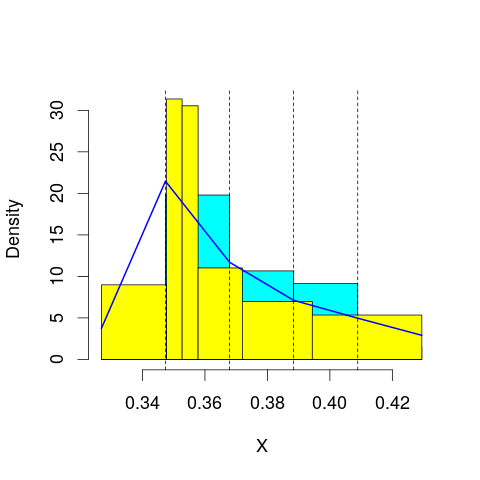

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.24576
mop.approx: Iteration 11. LL = 80.07799
mop.approx: Iteration 21. LL = 80.20775
mop.approx: Iteration 31. LL = 80.23273
mop.approx: Iteration 41. LL = 80.24095
mop.approx: Iteration 51. LL = 80.24448
mop.approx: Iteration 61. LL = 80.24626
mop.approx: Converged. Iteration 70. LL = 80.24726
[1] "Computing the linear combination of B-splines"


68.1171867082
('best: ', 67.773401527071243, 'accepted difference:', 115.21478259602111, 'cur BIC:', 68.117186708184917)
m reached
('Sum of Probabilities:', 0.9906106467714844)
chosen


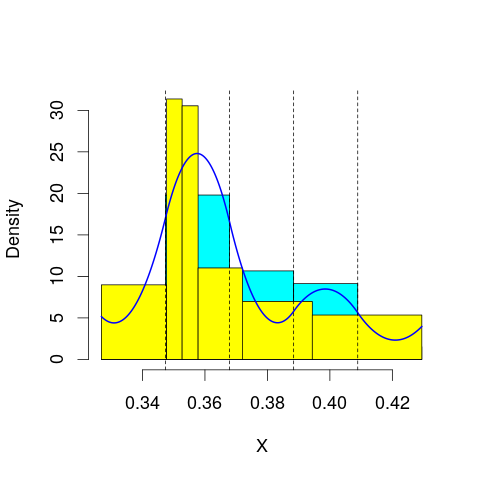

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 71.94126
mop.approx: Iteration 11. LL = 80.07431
mop.approx: Iteration 21. LL = 80.12946
mop.approx: Iteration 31. LL = 80.13487
mop.approx: Converged. Iteration 39. LL = 80.13612
[1] "Computing the linear combination of B-splines"


66.2731727812
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.01519
mop.approx: Iteration 11. LL = 71.83342
mop.approx: Converged. Iteration 15. LL = 71.83416
[1] "Computing the linear combination of B-splines"


56.2383532089
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.20843
mop.approx: Iteration 11. LL = 72.87379
mop.approx: Converged. Iteration 19. LL = 72.88869
[1] "Computing the linear combination of B-splines"


55.560005835
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.29529
mop.approx: Iteration 11. LL = 69.59491
mop.approx: Iteration 21. LL = 69.68799
mop.approx: Iteration 31. LL = 69.69624
mop.approx: Converged. Iteration 39. LL = 69.69748
[1] "Computing the linear combination of B-splines"


50.6359312337
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.037047
mop.approx: Iteration 11. LL = 67.88374
mop.approx: Iteration 21. LL = 67.89627
mop.approx: Converged. Iteration 21. LL = 67.89633
[1] "Computing the linear combination of B-splines"


47.1019100854
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.279478
mop.approx: Iteration 11. LL = 66.33337
mop.approx: Iteration 21. LL = 66.58191
mop.approx: Iteration 31. LL = 66.59666
mop.approx: Converged. Iteration 36. LL = 66.59745
[1] "Computing the linear combination of B-splines"


44.0701709673
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.55318
mop.approx: Iteration 11. LL = 78.90792
mop.approx: Iteration 21. LL = 78.93755
mop.approx: Converged. Iteration 29. LL = 78.93973
[1] "Computing the linear combination of B-splines"


66.8096560886
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 66.809656088616251)
m reached
('Sum of Probabilities:', 0.9962190004165736)
chosen


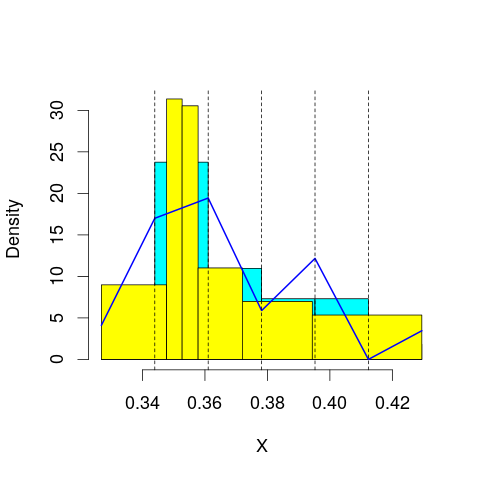

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.24576
mop.approx: Iteration 11. LL = 81.0058
mop.approx: Iteration 21. LL = 81.0589
mop.approx: Iteration 31. LL = 81.06383
mop.approx: Converged. Iteration 33. LL = 81.06412
[1] "Computing the linear combination of B-splines"


67.2011723775
('best: ', 66.809656088616251, 'accepted difference:', 113.57641535064762, 'cur BIC:', 67.201172377524017)
m reached
('Sum of Probabilities:', 0.9895096976313972)
chosen


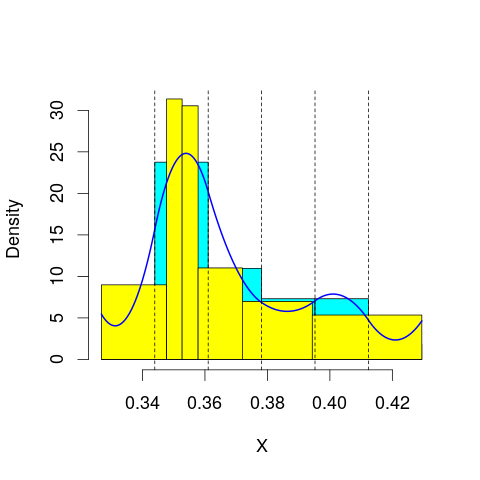

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 71.94126
mop.approx: Iteration 11. LL = 80.714
mop.approx: Iteration 21. LL = 80.88359
mop.approx: Iteration 31. LL = 80.92387
mop.approx: Iteration 41. LL = 80.93639
mop.approx: Iteration 51. LL = 80.94139
mop.approx: Iteration 61. LL = 80.94378
mop.approx: Iteration 71. LL = 80.94502
mop.approx: Converged. Iteration 73. LL = 80.94527
[1] "Computing the linear combination of B-splines"


65.3494548959
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.01519
mop.approx: Converged. Iteration 9. LL = 71.75966
[1] "Computing the linear combination of B-splines"


54.4309776278
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.20843
mop.approx: Iteration 11. LL = 73.89574
mop.approx: Iteration 21. LL = 73.93272
mop.approx: Iteration 31. LL = 73.93735
mop.approx: Converged. Iteration 37. LL = 73.93812
[1] "Computing the linear combination of B-splines"


54.8765761779
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.29529
mop.approx: Iteration 11. LL = 72.91427
mop.approx: Iteration 21. LL = 73.03223
mop.approx: Converged. Iteration 30. LL = 73.03563
[1] "Computing the linear combination of B-splines"


52.2412096148
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.037047
mop.approx: Iteration 11. LL = 70.04349
mop.approx: Iteration 21. LL = 70.12177
mop.approx: Converged. Iteration 27. LL = 70.12355
[1] "Computing the linear combination of B-splines"


47.5962670308
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.279478
mop.approx: Iteration 11. LL = 69.72954
mop.approx: Converged. Iteration 18. LL = 69.73597
[1] "Computing the linear combination of B-splines"


45.4758186043
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.55318
mop.approx: Iteration 11. LL = 81.16034
mop.approx: Converged. Iteration 15. LL = 81.1615
[1] "Computing the linear combination of B-splines"


67.2985542191
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 67.298554219134289)
m reached
('Sum of Probabilities:', 0.9955782756348758)
chosen


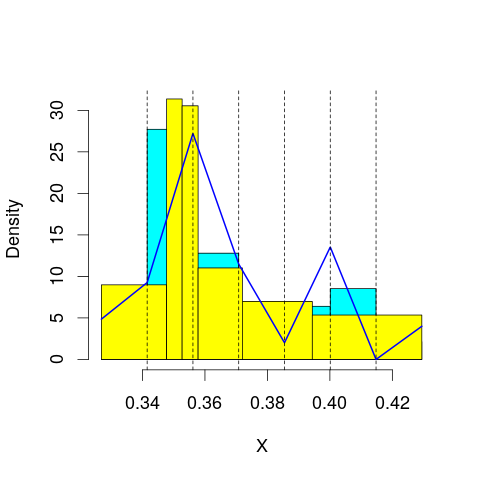

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.24576
mop.approx: Iteration 11. LL = 81.27418
mop.approx: Converged. Iteration 19. LL = 81.2825
[1] "Computing the linear combination of B-splines"


65.6866912795
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 71.94126
mop.approx: Iteration 11. LL = 81.50408
mop.approx: Iteration 21. LL = 81.53497
mop.approx: Iteration 31. LL = 81.54085
mop.approx: Iteration 41. LL = 81.54324
mop.approx: Iteration 51. LL = 81.54441
mop.approx: Converged. Iteration 51. LL = 81.54449
[1] "Computing the linear combination of B-splines"


64.2158123662
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.01519
mop.approx: Iteration 11. LL = 74.06641
mop.approx: Iteration 21. LL = 74.17307
mop.approx: Iteration 31. LL = 74.17883
mop.approx: Converged. Iteration 32. LL = 74.17898
[1] "Computing the linear combination of B-splines"


55.1174290038
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.20843
mop.approx: Iteration 11. LL = 73.79636
mop.approx: Converged. Iteration 12. LL = 73.7966
[1] "Computing the linear combination of B-splines"


53.0021887872
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.29529
mop.approx: Iteration 11. LL = 75.20035
mop.approx: Iteration 21. LL = 75.32371
mop.approx: Iteration 31. LL = 75.34476
mop.approx: Iteration 41. LL = 75.35046
mop.approx: Iteration 51. LL = 75.35214
mop.approx: Converged. Iteration 52. LL = 75.3523
[1] "Computing the linear combination of B-splines"


52.8250147715
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.037047
mop.approx: Iteration 11. LL = 72.17604
mop.approx: Iteration 21. LL = 72.41753
mop.approx: Iteration 31. LL = 72.45833
mop.approx: Iteration 41. LL = 72.46808
mop.approx: Iteration 51. LL = 72.47088
mop.approx: Converged. Iteration 59. LL = 72.47181
[1] "Computing the linear combination of B-splines"


48.2116610874
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.279478
mop.approx: Iteration 11. LL = 70.53531
mop.approx: Iteration 21. LL = 70.60524
mop.approx: Iteration 31. LL = 70.61801
mop.approx: Iteration 41. LL = 70.62229
mop.approx: Iteration 51. LL = 70.62419
mop.approx: Iteration 61. LL = 70.62517
mop.approx: Converged. Iteration 61. LL = 70.62524
[1] "Computing the linear combination of B-splines"


44.6322436358
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.55318
mop.approx: Iteration 11. LL = 83.18201
mop.approx: Converged. Iteration 15. LL = 83.18311
[1] "Computing the linear combination of B-splines"


67.5872935142
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 67.587293514249239)
m reached
('Sum of Probabilities:', 0.9945802470559189)
chosen


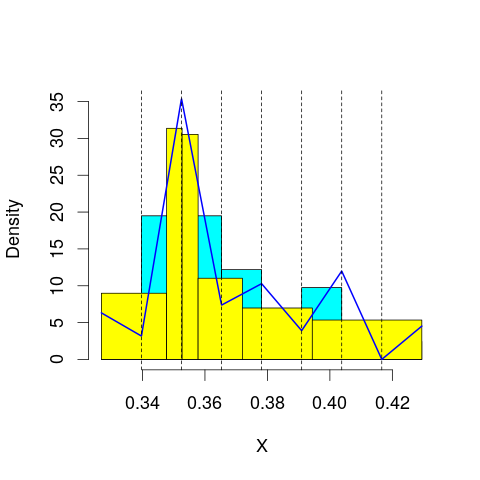

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.24576
mop.approx: Iteration 11. LL = 82.31467
mop.approx: Iteration 21. LL = 82.42069
mop.approx: Iteration 31. LL = 82.43203
mop.approx: Converged. Iteration 38. LL = 82.43334
[1] "Computing the linear combination of B-splines"


65.1046617163
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 71.94126
mop.approx: Iteration 11. LL = 82.12318
mop.approx: Iteration 21. LL = 82.18075
mop.approx: Iteration 31. LL = 82.19331
mop.approx: Iteration 41. LL = 82.19673
mop.approx: Converged. Iteration 47. LL = 82.19756
[1] "Computing the linear combination of B-splines"


63.1360154886
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.01519
mop.approx: Iteration 11. LL = 76.14801
mop.approx: Iteration 21. LL = 76.17188
mop.approx: Iteration 31. LL = 76.17854
mop.approx: Iteration 41. LL = 76.18224
mop.approx: Iteration 51. LL = 76.18443
mop.approx: Iteration 61. LL = 76.18578
mop.approx: Converged. Iteration 69. LL = 76.18657
[1] "Computing the linear combination of B-splines"


55.3921547503
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.20843
mop.approx: Iteration 11. LL = 74.36616
mop.approx: Iteration 21. LL = 74.4828
mop.approx: Iteration 31. LL = 74.50172
mop.approx: Iteration 41. LL = 74.50492
mop.approx: Converged. Iteration 44. LL = 74.50526
[1] "Computing the linear combination of B-splines"


51.9779735829
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.29529
mop.approx: Iteration 11. LL = 75.42877
mop.approx: Converged. Iteration 16. LL = 75.43255
[1] "Computing the linear combination of B-splines"


51.1724010835
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.037047
mop.approx: Iteration 11. LL = 75.5374
mop.approx: Iteration 21. LL = 75.74019
mop.approx: Iteration 31. LL = 75.74804
mop.approx: Converged. Iteration 33. LL = 75.74831
[1] "Computing the linear combination of B-splines"


49.7552851165
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.279478
mop.approx: Iteration 11. LL = 71.48093
mop.approx: Iteration 21. LL = 71.57814
mop.approx: Iteration 31. LL = 71.59223
mop.approx: Iteration 41. LL = 71.59546
mop.approx: Converged. Iteration 47. LL = 71.59619
[1] "Computing the linear combination of B-splines"


43.8701757889
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.55318
mop.approx: Iteration 11. LL = 83.80405
mop.approx: Iteration 21. LL = 83.83071
mop.approx: Iteration 31. LL = 83.8338
mop.approx: Converged. Iteration 32. LL = 83.83396
[1] "Computing the linear combination of B-splines"


66.5052843695
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 66.505284369451132)
m reached
('Sum of Probabilities:', 0.9941476624748001)
chosen


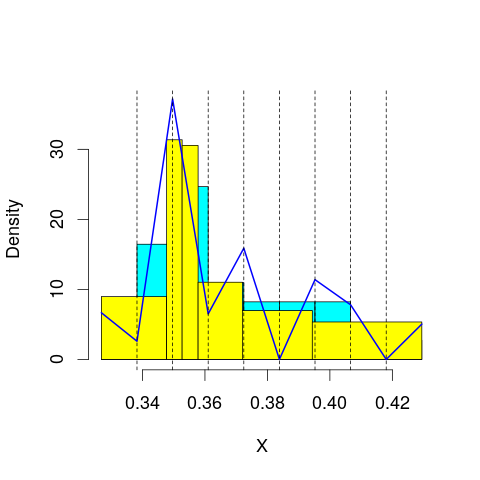

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.24576
mop.approx: Iteration 11. LL = 82.75719
mop.approx: Iteration 21. LL = 82.76789
mop.approx: Converged. Iteration 23. LL = 82.7682
[1] "Computing the linear combination of B-splines"


63.706655798
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 71.94126
mop.approx: Iteration 11. LL = 83.24408
mop.approx: Iteration 21. LL = 83.48665
mop.approx: Iteration 31. LL = 83.53028
mop.approx: Iteration 41. LL = 83.54198
mop.approx: Iteration 51. LL = 83.54651
mop.approx: Iteration 61. LL = 83.54879
mop.approx: Iteration 71. LL = 83.55012
mop.approx: Converged. Iteration 77. LL = 83.55076
[1] "Computing the linear combination of B-splines"


62.7563440613
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.01519
mop.approx: Iteration 11. LL = 77.67995
mop.approx: Iteration 21. LL = 77.7892
mop.approx: Iteration 31. LL = 77.82873
mop.approx: Iteration 41. LL = 77.84481
mop.approx: Iteration 51. LL = 77.85185
mop.approx: Iteration 61. LL = 77.85507
mop.approx: Iteration 71. LL = 77.85658
mop.approx: Converged. Iteration 75. LL = 77.85702
[1] "Computing the linear combination of B-splines"


55.3297373557
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.20843
mop.approx: Iteration 11. LL = 75.56724
mop.approx: Iteration 21. LL = 75.62375
mop.approx: Iteration 31. LL = 75.63233
mop.approx: Iteration 41. LL = 75.63522
mop.approx: Converged. Iteration 49. LL = 75.63622
[1] "Computing the linear combination of B-splines"


51.3760656393
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.29529
mop.approx: Iteration 11. LL = 75.43547
mop.approx: Iteration 21. LL = 75.48529
mop.approx: Iteration 31. LL = 75.50718
mop.approx: Iteration 41. LL = 75.51752
mop.approx: Iteration 51. LL = 75.52264
mop.approx: Iteration 61. LL = 75.52524
mop.approx: Iteration 71. LL = 75.52659
mop.approx: Converged. Iteration 75. LL = 75.527
[1] "Computing the linear combination of B-splines"


49.5339749234
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.037047
mop.approx: Iteration 11. LL = 76.45249
mop.approx: Iteration 21. LL = 76.48791
mop.approx: Converged. Iteration 24. LL = 76.48832
[1] "Computing the linear combination of B-splines"


48.7624104534
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.279478
mop.approx: Iteration 11. LL = 75.01259
mop.approx: Iteration 21. LL = 75.34074
mop.approx: Iteration 31. LL = 75.37293
mop.approx: Iteration 41. LL = 75.37815
mop.approx: Converged. Iteration 48. LL = 75.37912
[1] "Computing the linear combination of B-splines"


45.9201715175
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.55318
mop.approx: Iteration 11. LL = 81.86903
mop.approx: Converged. Iteration 14. LL = 81.8699
[1] "Computing the linear combination of B-splines"


62.8083496112
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 62.808349611187673)
m reached
('Sum of Probabilities:', 0.9941458216521201)
chosen


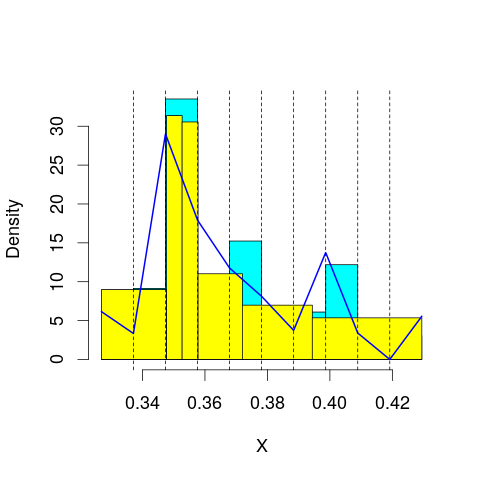

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.24576
mop.approx: Iteration 11. LL = 84.93555
mop.approx: Iteration 21. LL = 85.05128
mop.approx: Iteration 31. LL = 85.06843
mop.approx: Iteration 41. LL = 85.07188
mop.approx: Converged. Iteration 45. LL = 85.07242
[1] "Computing the linear combination of B-splines"


64.2780018816
('best: ', 62.808349611187673, 'accepted difference:', 106.77419433901903, 'cur BIC:', 64.278001881609185)
m reached
('Sum of Probabilities:', 0.9851083124852256)
chosen


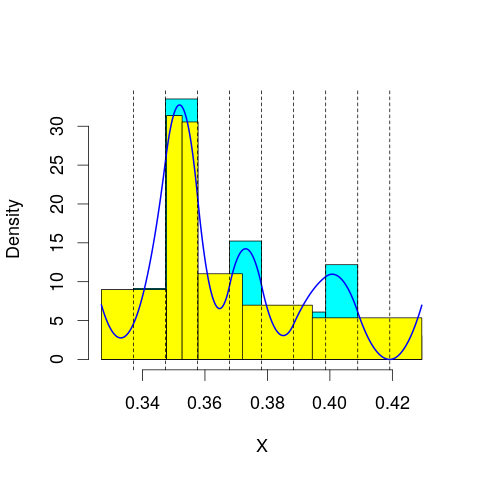

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 71.94126
mop.approx: Iteration 11. LL = 83.30566
mop.approx: Iteration 21. LL = 83.45442
mop.approx: Iteration 31. LL = 83.47256
mop.approx: Iteration 41. LL = 83.47555
mop.approx: Converged. Iteration 43. LL = 83.47583
[1] "Computing the linear combination of B-splines"


60.948548027
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.01519
mop.approx: Iteration 11. LL = 79.31219
mop.approx: Iteration 21. LL = 79.53469
mop.approx: Iteration 31. LL = 79.5783
mop.approx: Iteration 41. LL = 79.5874
mop.approx: Iteration 51. LL = 79.58937
mop.approx: Converged. Iteration 51. LL = 79.58945
[1] "Computing the linear combination of B-splines"


55.3293019931
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.20843
mop.approx: Iteration 11. LL = 76.916
mop.approx: Iteration 21. LL = 77.02846
mop.approx: Iteration 31. LL = 77.06404
mop.approx: Iteration 41. LL = 77.07607
mop.approx: Iteration 51. LL = 77.08102
mop.approx: Iteration 61. LL = 77.08352
mop.approx: Iteration 71. LL = 77.08496
mop.approx: Converged. Iteration 80. LL = 77.08587
[1] "Computing the linear combination of B-splines"


51.0928490163
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.29529
mop.approx: Iteration 11. LL = 75.80635
mop.approx: Iteration 21. LL = 75.86526
mop.approx: Iteration 31. LL = 75.87638
mop.approx: Iteration 41. LL = 75.87914
mop.approx: Converged. Iteration 45. LL = 75.87961
[1] "Computing the linear combination of B-splines"


48.1537224442
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.037047
mop.approx: Iteration 11. LL = 76.49279
mop.approx: Iteration 21. LL = 76.49917
mop.approx: Converged. Iteration 26. LL = 76.49969
[1] "Computing the linear combination of B-splines"


47.0409476312
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.279478
mop.approx: Iteration 11. LL = 76.79179
mop.approx: Iteration 21. LL = 76.96626
mop.approx: Iteration 31. LL = 76.97786
mop.approx: Iteration 41. LL = 76.98072
mop.approx: Iteration 51. LL = 76.98186
mop.approx: Converged. Iteration 51. LL = 76.98193
[1] "Computing the linear combination of B-splines"


45.7893257665
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.55318
mop.approx: Iteration 11. LL = 85.16323
mop.approx: Iteration 21. LL = 85.21419
mop.approx: Iteration 31. LL = 85.22108
mop.approx: Converged. Iteration 40. LL = 85.22269
[1] "Computing the linear combination of B-splines"


64.4282701808
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 64.428270180846397)
m reached
('Sum of Probabilities:', 0.9939476834870209)
chosen


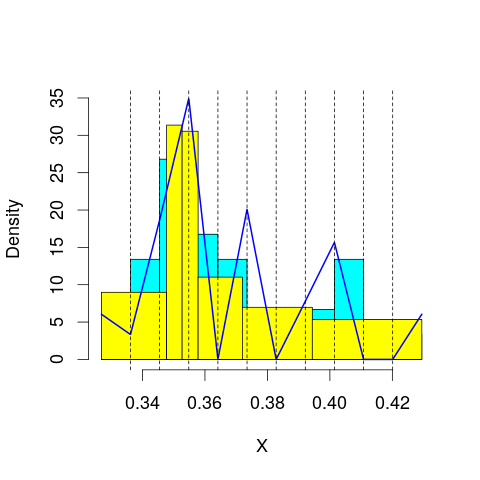

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.24576
mop.approx: Iteration 11. LL = 84.21096
mop.approx: Iteration 21. LL = 84.23351
mop.approx: Converged. Iteration 27. LL = 84.23467
[1] "Computing the linear combination of B-splines"


61.7073914907
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 71.94126
mop.approx: Iteration 11. LL = 84.48811
mop.approx: Iteration 21. LL = 84.63295
mop.approx: Iteration 31. LL = 84.65755
mop.approx: Iteration 41. LL = 84.66277
mop.approx: Converged. Iteration 48. LL = 84.66387
[1] "Computing the linear combination of B-splines"


60.4037228248
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.01519
mop.approx: Iteration 11. LL = 79.75529
mop.approx: Iteration 21. LL = 79.94952
mop.approx: Iteration 31. LL = 79.99494
mop.approx: Iteration 41. LL = 80.00909
mop.approx: Iteration 51. LL = 80.01411
mop.approx: Iteration 61. LL = 80.01601
mop.approx: Converged. Iteration 65. LL = 80.01646
[1] "Computing the linear combination of B-splines"


54.0234393482
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.20843
mop.approx: Iteration 11. LL = 78.67617
mop.approx: Iteration 21. LL = 78.87877
mop.approx: Iteration 31. LL = 78.91818
mop.approx: Iteration 41. LL = 78.92679
mop.approx: Iteration 51. LL = 78.92878
mop.approx: Converged. Iteration 52. LL = 78.92894
[1] "Computing the linear combination of B-splines"


51.2030500528
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.29529
mop.approx: Iteration 11. LL = 76.57019
mop.approx: Iteration 21. LL = 76.63352
mop.approx: Iteration 31. LL = 76.64836
mop.approx: Iteration 41. LL = 76.6531
mop.approx: Iteration 51. LL = 76.65506
mop.approx: Converged. Iteration 59. LL = 76.65593
[1] "Computing the linear combination of B-splines"


47.1971697335
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.037047
mop.approx: Iteration 11. LL = 76.60758
mop.approx: Iteration 21. LL = 76.67007
mop.approx: Iteration 31. LL = 76.6904
mop.approx: Iteration 41. LL = 76.69639
mop.approx: Iteration 51. LL = 76.69804
mop.approx: Converged. Iteration 51. LL = 76.69812
[1] "Computing the linear combination of B-splines"


45.5065674996
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.279478
mop.approx: Iteration 11. LL = 77.13374
mop.approx: Iteration 21. LL = 77.18062
mop.approx: Iteration 31. LL = 77.19139
mop.approx: Iteration 41. LL = 77.19937
mop.approx: Iteration 51. LL = 77.20535
mop.approx: Iteration 61. LL = 77.20978
mop.approx: Iteration 71. LL = 77.21306
mop.approx: Iteration 81. LL = 77.21549
mop.approx: Iteration 91. LL = 77.21731
mop.approx: Iteration 101. LL = 77.21866
mop.approx: Iteration 111. LL = 77.21968
mop.approx: Converged. Iteration 115. LL = 77.22009
[1] "Computing the linear combination of B-splines"


44.2939366385
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.55318
mop.approx: Iteration 11. LL = 85.36609
mop.approx: Converged. Iteration 11. LL = 85.36614
[1] "Computing the linear combination of B-splines"


62.8388554298
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 62.838855429836997)
m reached
('Sum of Probabilities:', 0.9934550901543006)
chosen


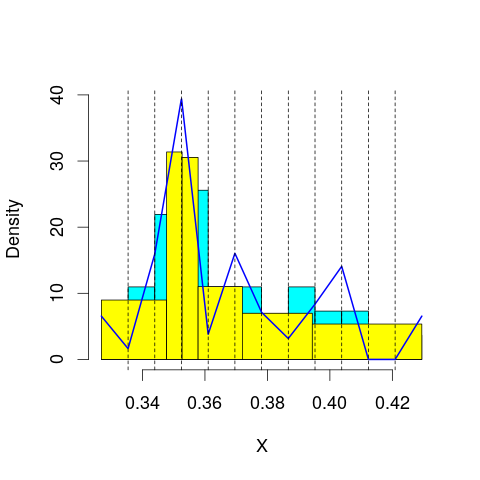

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.24576
mop.approx: Iteration 11. LL = 84.61319
mop.approx: Iteration 21. LL = 84.6641
mop.approx: Iteration 31. LL = 84.67377
mop.approx: Iteration 41. LL = 84.67758
mop.approx: Iteration 51. LL = 84.67948
mop.approx: Converged. Iteration 60. LL = 84.68055
[1] "Computing the linear combination of B-splines"


60.4203943916
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 71.94126
mop.approx: Iteration 11. LL = 85.00408
mop.approx: Iteration 21. LL = 85.09912
mop.approx: Iteration 31. LL = 85.10977
mop.approx: Converged. Iteration 39. LL = 85.11127
[1] "Computing the linear combination of B-splines"


59.1182544643
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.01519
mop.approx: Iteration 11. LL = 80.08857
mop.approx: Iteration 21. LL = 80.2368
mop.approx: Iteration 31. LL = 80.2704
mop.approx: Iteration 41. LL = 80.28165
mop.approx: Iteration 51. LL = 80.28643
mop.approx: Iteration 61. LL = 80.28884
mop.approx: Iteration 71. LL = 80.29018
mop.approx: Converged. Iteration 76. LL = 80.2907
[1] "Computing the linear combination of B-splines"


52.5648163604
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.20843
mop.approx: Iteration 11. LL = 79.8321
mop.approx: Iteration 21. LL = 80.01864
mop.approx: Iteration 31. LL = 80.04333
mop.approx: Iteration 41. LL = 80.04749
mop.approx: Converged. Iteration 48. LL = 80.04842
[1] "Computing the linear combination of B-splines"


50.5896618171
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.29529
mop.approx: Iteration 11. LL = 77.99153
mop.approx: Iteration 21. LL = 78.20051
mop.approx: Iteration 31. LL = 78.24342
mop.approx: Iteration 41. LL = 78.25325
mop.approx: Iteration 51. LL = 78.25575
mop.approx: Converged. Iteration 55. LL = 78.25622
[1] "Computing the linear combination of B-splines"


47.0645717337
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.037047
mop.approx: Iteration 11. LL = 76.90417
mop.approx: Iteration 21. LL = 76.96054
mop.approx: Iteration 31. LL = 76.96985
mop.approx: Iteration 41. LL = 76.97255
mop.approx: Iteration 51. LL = 76.97378
mop.approx: Converged. Iteration 53. LL = 76.97402
[1] "Computing the linear combination of B-splines"


44.049669012
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.279478
mop.approx: Iteration 11. LL = 77.4061
mop.approx: Iteration 21. LL = 77.51703
mop.approx: Iteration 31. LL = 77.56198
mop.approx: Iteration 41. LL = 77.58154
mop.approx: Iteration 51. LL = 77.59072
mop.approx: Iteration 61. LL = 77.5956
mop.approx: Iteration 71. LL = 77.59853
mop.approx: Iteration 81. LL = 77.60045
mop.approx: Iteration 91. LL = 77.6018
mop.approx: Iteration 101. LL = 77.60278
mop.approx: Converged. Iteration 104. LL = 77.6031
[1] "Computing the linear combination of B-splines"


42.9450330564
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.55318
mop.approx: Iteration 11. LL = 85.36997
mop.approx: Iteration 21. LL = 85.39145
mop.approx: Iteration 31. LL = 85.39401
mop.approx: Converged. Iteration 33. LL = 85.39428
[1] "Computing the linear combination of B-splines"


61.134128612
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 61.134128611975633)
m reached
('Sum of Probabilities:', 0.9929710197234506)
chosen


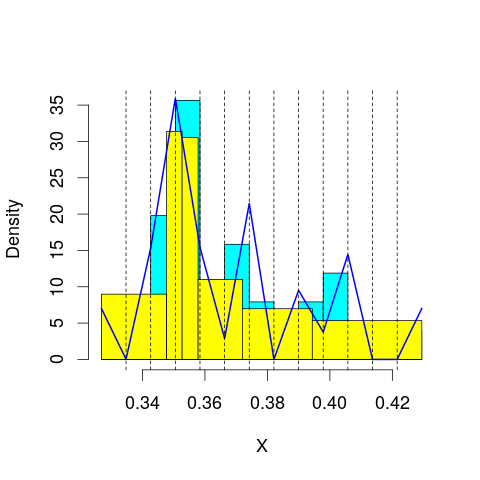

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.24576
mop.approx: Iteration 11. LL = 85.67191
mop.approx: Iteration 21. LL = 85.71991
mop.approx: Converged. Iteration 30. LL = 85.72284
[1] "Computing the linear combination of B-splines"


59.7298159155
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 71.94126
mop.approx: Iteration 11. LL = 85.00803
mop.approx: Iteration 21. LL = 85.03537
mop.approx: Converged. Iteration 26. LL = 85.03626
[1] "Computing the linear combination of B-splines"


57.3103709673
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.01519
mop.approx: Iteration 11. LL = 80.63675
mop.approx: Iteration 21. LL = 80.7443
mop.approx: Iteration 31. LL = 80.7524
mop.approx: Converged. Iteration 36. LL = 80.75312
[1] "Computing the linear combination of B-splines"


51.2943659404
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.20843
mop.approx: Iteration 11. LL = 80.39525
mop.approx: Iteration 21. LL = 80.52919
mop.approx: Iteration 31. LL = 80.54906
mop.approx: Iteration 41. LL = 80.55521
mop.approx: Iteration 51. LL = 80.55826
mop.approx: Iteration 61. LL = 80.56014
mop.approx: Iteration 71. LL = 80.56141
mop.approx: Converged. Iteration 80. LL = 80.56232
[1] "Computing the linear combination of B-splines"


49.3706993346
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.29529
mop.approx: Iteration 11. LL = 79.28623
mop.approx: Iteration 21. LL = 79.44233
mop.approx: Iteration 31. LL = 79.46051
mop.approx: Iteration 41. LL = 79.46401
mop.approx: Converged. Iteration 50. LL = 79.4652
[1] "Computing the linear combination of B-splines"


46.5406862144
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.037047
mop.approx: Iteration 11. LL = 77.72176
mop.approx: Iteration 21. LL = 77.92462
mop.approx: Iteration 31. LL = 77.98032
mop.approx: Iteration 41. LL = 77.99739
mop.approx: Iteration 51. LL = 78.00289
mop.approx: Iteration 61. LL = 78.00472
mop.approx: Converged. Iteration 63. LL = 78.00498
[1] "Computing the linear combination of B-splines"


43.3472808291
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.279478
mop.approx: Iteration 11. LL = 77.65221
mop.approx: Iteration 21. LL = 77.79457
mop.approx: Iteration 31. LL = 77.85064
mop.approx: Iteration 41. LL = 77.87977
mop.approx: Iteration 51. LL = 77.89672
mop.approx: Iteration 61. LL = 77.90716
mop.approx: Iteration 71. LL = 77.91381
mop.approx: Iteration 81. LL = 77.91815
mop.approx: Iteration 91. LL = 77.92102
mop.approx: Iteration 101. LL = 77.92294
mop.approx: Iteration 111. LL = 77.92424
mop.approx: Converged. Iteration 119. LL = 77.92505
[1] "Computing the linear combination of B-splines"


41.5289544493
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.55318
mop.approx: Iteration 11. LL = 85.56009
mop.approx: Iteration 21. LL = 85.59563
mop.approx: Iteration 31. LL = 85.60153
mop.approx: Converged. Iteration 39. LL = 85.60287
[1] "Computing the linear combination of B-splines"


59.6098539022
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 59.609853902205387)
m reached
('Sum of Probabilities:', 0.9924952528952522)
chosen


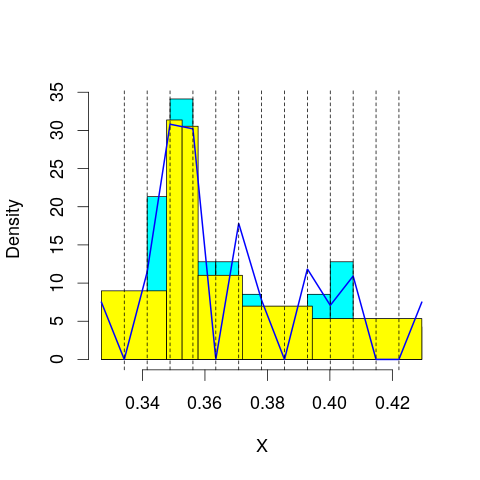

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.24576
mop.approx: Iteration 11. LL = 86.16779
mop.approx: Iteration 21. LL = 86.17755
mop.approx: Converged. Iteration 21. LL = 86.17764
[1] "Computing the linear combination of B-splines"


58.4517502195
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 71.94126
mop.approx: Iteration 11. LL = 85.14213
mop.approx: Iteration 21. LL = 85.2004
mop.approx: Iteration 31. LL = 85.20751
mop.approx: Iteration 41. LL = 85.20985
mop.approx: Converged. Iteration 49. LL = 85.21087
[1] "Computing the linear combination of B-splines"


55.7521178983
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.01519
mop.approx: Iteration 11. LL = 81.07816
mop.approx: Iteration 21. LL = 81.1736
mop.approx: Iteration 31. LL = 81.19069
mop.approx: Iteration 41. LL = 81.19622
mop.approx: Iteration 51. LL = 81.19822
mop.approx: Converged. Iteration 55. LL = 81.19868
[1] "Computing the linear combination of B-splines"


50.0070526454
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.20843
mop.approx: Iteration 11. LL = 80.57003
mop.approx: Iteration 21. LL = 80.71826
mop.approx: Iteration 31. LL = 80.7448
mop.approx: Iteration 41. LL = 80.75163
mop.approx: Iteration 51. LL = 80.7541
mop.approx: Converged. Iteration 60. LL = 80.75522
[1] "Computing the linear combination of B-splines"


47.8307282191
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.29529
mop.approx: Iteration 11. LL = 80.38543
mop.approx: Iteration 21. LL = 80.56113
mop.approx: Iteration 31. LL = 80.58549
mop.approx: Iteration 41. LL = 80.59036
mop.approx: Converged. Iteration 50. LL = 80.59168
[1] "Computing the linear combination of B-splines"


45.9342926883
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.037047
mop.approx: Iteration 11. LL = 78.74631
mop.approx: Iteration 21. LL = 78.89265
mop.approx: Iteration 31. LL = 78.91056
mop.approx: Iteration 41. LL = 78.91419
mop.approx: Iteration 51. LL = 78.91547
mop.approx: Converged. Iteration 52. LL = 78.91563
[1] "Computing the linear combination of B-splines"


42.5259068472
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.279478
mop.approx: Iteration 11. LL = 78.00779
mop.approx: Iteration 21. LL = 78.17061
mop.approx: Iteration 31. LL = 78.21208
mop.approx: Iteration 41. LL = 78.22756
mop.approx: Iteration 51. LL = 78.23483
mop.approx: Iteration 61. LL = 78.23864
mop.approx: Iteration 71. LL = 78.24074
mop.approx: Iteration 81. LL = 78.24192
mop.approx: Converged. Iteration 83. LL = 78.24217
[1] "Computing the linear combination of B-splines"


40.1064358436
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.55318
mop.approx: Iteration 11. LL = 86.09875
mop.approx: Iteration 21. LL = 86.10897
mop.approx: Converged. Iteration 22. LL = 86.10917
[1] "Computing the linear combination of B-splines"


58.3832848425
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 58.383284842505631)
m reached
('Sum of Probabilities:', 0.9920275778302836)
chosen


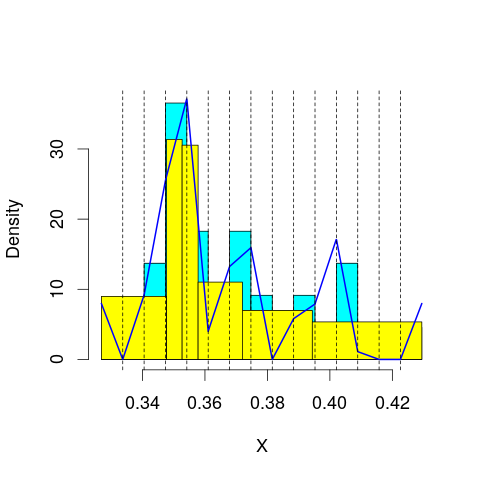

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.24576
mop.approx: Iteration 11. LL = 86.78046
mop.approx: Iteration 21. LL = 86.86779
mop.approx: Iteration 31. LL = 86.87818
mop.approx: Converged. Iteration 38. LL = 86.87957
[1] "Computing the linear combination of B-splines"


57.4208131441
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 71.94126
mop.approx: Iteration 11. LL = 85.83396
mop.approx: Iteration 21. LL = 85.92547
mop.approx: Iteration 31. LL = 85.93513
mop.approx: Converged. Iteration 38. LL = 85.93638
[1] "Computing the linear combination of B-splines"


54.7447577496
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.01519
mop.approx: Iteration 11. LL = 81.28782
mop.approx: Iteration 21. LL = 81.40859
mop.approx: Iteration 31. LL = 81.4297
mop.approx: Iteration 41. LL = 81.43531
mop.approx: Iteration 51. LL = 81.43735
mop.approx: Converged. Iteration 57. LL = 81.43806
[1] "Computing the linear combination of B-splines"


48.513567924
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.20843
mop.approx: Iteration 11. LL = 80.96083
mop.approx: Iteration 21. LL = 81.08301
mop.approx: Iteration 31. LL = 81.09616
mop.approx: Converged. Iteration 39. LL = 81.09789
[1] "Computing the linear combination of B-splines"


46.4405337813
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.29529
mop.approx: Iteration 11. LL = 80.86057
mop.approx: Iteration 21. LL = 81.04731
mop.approx: Iteration 31. LL = 81.08534
mop.approx: Iteration 41. LL = 81.09786
mop.approx: Iteration 51. LL = 81.10298
mop.approx: Iteration 61. LL = 81.10533
mop.approx: Iteration 71. LL = 81.1065
mop.approx: Converged. Iteration 71. LL = 81.10658
[1] "Computing the linear combination of B-splines"


44.7163648737
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.037047
mop.approx: Iteration 11. LL = 79.91801
mop.approx: Iteration 21. LL = 80.07878
mop.approx: Iteration 31. LL = 80.10035
mop.approx: Iteration 41. LL = 80.10496
mop.approx: Iteration 51. LL = 80.10658
mop.approx: Converged. Iteration 56. LL = 80.10712
[1] "Computing the linear combination of B-splines"


41.9862108917
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.279478
mop.approx: Iteration 11. LL = 78.55686
mop.approx: Iteration 21. LL = 78.71918
mop.approx: Iteration 31. LL = 78.74818
mop.approx: Iteration 41. LL = 78.75515
mop.approx: Iteration 51. LL = 78.75776
mop.approx: Iteration 61. LL = 78.75907
mop.approx: Converged. Iteration 65. LL = 78.7595
[1] "Computing the linear combination of B-splines"


38.8893442296
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.55318
mop.approx: Iteration 11. LL = 88.08135
mop.approx: Iteration 21. LL = 88.13435
mop.approx: Iteration 31. LL = 88.13955
mop.approx: Converged. Iteration 34. LL = 88.13997
[1] "Computing the linear combination of B-splines"


58.6812187288
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 58.68121872881364)
m reached
('Sum of Probabilities:', 0.9915677898341845)
chosen


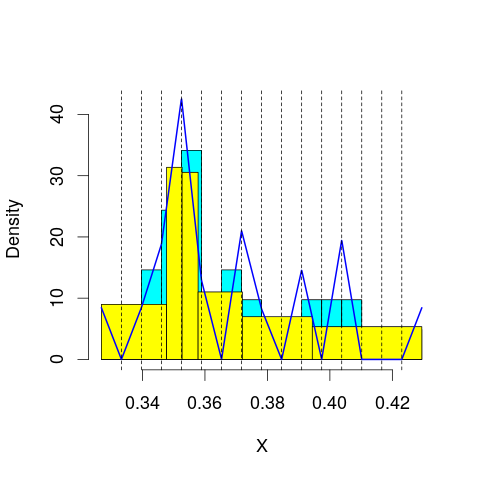

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.24576
mop.approx: Iteration 11. LL = 86.18095
mop.approx: Iteration 21. LL = 86.20219
mop.approx: Iteration 31. LL = 86.20547
mop.approx: Converged. Iteration 35. LL = 86.20602
[1] "Computing the linear combination of B-splines"


55.0143981974
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 71.94126
mop.approx: Iteration 11. LL = 86.65913
mop.approx: Iteration 21. LL = 86.76195
mop.approx: Iteration 31. LL = 86.78356
mop.approx: Iteration 41. LL = 86.78998
mop.approx: Iteration 51. LL = 86.79203
mop.approx: Converged. Iteration 53. LL = 86.79231
[1] "Computing the linear combination of B-splines"


53.8678233171
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.01519
mop.approx: Iteration 11. LL = 81.11787
mop.approx: Iteration 21. LL = 81.16797
mop.approx: Iteration 31. LL = 81.17228
mop.approx: Converged. Iteration 33. LL = 81.17254
[1] "Computing the linear combination of B-splines"


46.5151839186
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.20843
mop.approx: Iteration 11. LL = 81.60963
mop.approx: Iteration 21. LL = 81.81108
mop.approx: Iteration 31. LL = 81.85266
mop.approx: Iteration 41. LL = 81.86607
mop.approx: Iteration 51. LL = 81.87147
mop.approx: Iteration 61. LL = 81.87395
mop.approx: Iteration 71. LL = 81.87523
mop.approx: Converged. Iteration 73. LL = 81.87548
[1] "Computing the linear combination of B-splines"


45.4852552418
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.29529
mop.approx: Iteration 11. LL = 80.80389
mop.approx: Iteration 21. LL = 80.90935
mop.approx: Iteration 31. LL = 80.93361
mop.approx: Iteration 41. LL = 80.94344
mop.approx: Iteration 51. LL = 80.94868
mop.approx: Iteration 61. LL = 80.95179
mop.approx: Iteration 71. LL = 80.95373
mop.approx: Iteration 81. LL = 80.95495
mop.approx: Converged. Iteration 85. LL = 80.95538
[1] "Computing the linear combination of B-splines"


42.832136379
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.037047
mop.approx: Iteration 11. LL = 80.91892
mop.approx: Iteration 21. LL = 81.20407
mop.approx: Iteration 31. LL = 81.26273
mop.approx: Iteration 41. LL = 81.27758
mop.approx: Iteration 51. LL = 81.28179
mop.approx: Converged. Iteration 60. LL = 81.28311
[1] "Computing the linear combination of B-splines"


41.4257830692
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.279478
mop.approx: Iteration 11. LL = 79.47709
mop.approx: Iteration 21. LL = 79.64302
mop.approx: Iteration 31. LL = 79.67505
mop.approx: Iteration 41. LL = 79.68437
mop.approx: Iteration 51. LL = 79.68791
mop.approx: Iteration 61. LL = 79.68948
mop.approx: Converged. Iteration 66. LL = 79.69002
[1] "Computing the linear combination of B-splines"


38.0164533056
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.55318
mop.approx: Iteration 11. LL = 87.89375
mop.approx: Converged. Iteration 19. LL = 87.90344
[1] "Computing the linear combination of B-splines"


56.7118122649
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 56.711812264883577)
m reached
('Sum of Probabilities:', 0.9911156910589911)
chosen


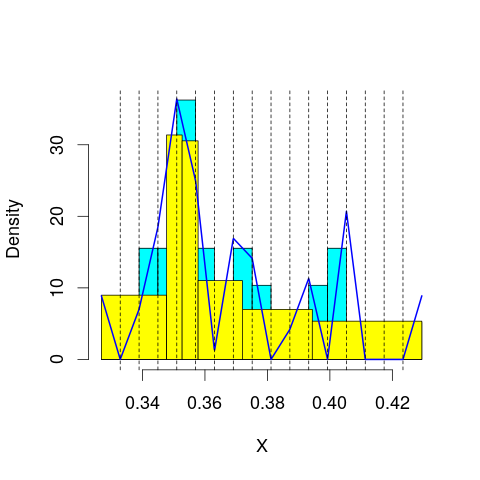

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.24576
mop.approx: Iteration 11. LL = 86.6518
mop.approx: Iteration 21. LL = 86.70007
mop.approx: Iteration 31. LL = 86.71353
mop.approx: Iteration 41. LL = 86.71805
mop.approx: Iteration 51. LL = 86.71962
mop.approx: Converged. Iteration 51. LL = 86.7197
[1] "Computing the linear combination of B-splines"


53.7952109995
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 71.94126
mop.approx: Iteration 11. LL = 86.619
mop.approx: Iteration 21. LL = 86.71228
mop.approx: Iteration 31. LL = 86.72366
mop.approx: Converged. Iteration 38. LL = 86.7251
[1] "Computing the linear combination of B-splines"


52.0677435886
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.01519
mop.approx: Iteration 11. LL = 81.95991
mop.approx: Iteration 21. LL = 82.12279
mop.approx: Iteration 31. LL = 82.15407
mop.approx: Iteration 41. LL = 82.16384
mop.approx: Iteration 51. LL = 82.16788
mop.approx: Iteration 61. LL = 82.16983
mop.approx: Converged. Iteration 69. LL = 82.17076
[1] "Computing the linear combination of B-splines"


45.7805317836
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.20843
mop.approx: Iteration 11. LL = 81.45272
mop.approx: Iteration 21. LL = 81.5701
mop.approx: Iteration 31. LL = 81.60454
mop.approx: Iteration 41. LL = 81.61992
mop.approx: Iteration 51. LL = 81.62765
mop.approx: Iteration 61. LL = 81.63172
mop.approx: Iteration 71. LL = 81.6339
mop.approx: Iteration 81. LL = 81.63509
mop.approx: Converged. Iteration 82. LL = 81.63525
[1] "Computing the linear combination of B-splines"


43.5121591353
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.29529
mop.approx: Iteration 11. LL = 81.47502
mop.approx: Iteration 21. LL = 81.75598
mop.approx: Iteration 31. LL = 81.81346
mop.approx: Iteration 41. LL = 81.8286
mop.approx: Iteration 51. LL = 81.83338
mop.approx: Iteration 61. LL = 81.83516
mop.approx: Converged. Iteration 65. LL = 81.83561
[1] "Computing the linear combination of B-splines"


41.9797371252
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.037047
mop.approx: Iteration 11. LL = 80.99143
mop.approx: Iteration 21. LL = 81.11909
mop.approx: Iteration 31. LL = 81.14356
mop.approx: Iteration 41. LL = 81.15223
mop.approx: Iteration 51. LL = 81.15643
mop.approx: Iteration 61. LL = 81.15874
mop.approx: Iteration 71. LL = 81.16004
mop.approx: Converged. Iteration 74. LL = 81.16039
[1] "Computing the linear combination of B-splines"


39.556979003
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.279478
mop.approx: Iteration 11. LL = 80.92407
mop.approx: Iteration 21. LL = 81.21737
mop.approx: Iteration 31. LL = 81.26751
mop.approx: Iteration 41. LL = 81.28237
mop.approx: Iteration 51. LL = 81.28989
mop.approx: Iteration 61. LL = 81.29505
mop.approx: Iteration 71. LL = 81.29904
mop.approx: Iteration 81. LL = 81.30225
mop.approx: Iteration 91. LL = 81.30485
mop.approx: Iteration 101. LL = 81.30697
mop.approx: Iteration 111. LL = 81.30869
mop.approx: Iteration 121. LL = 81.31007
mop.approx: Iteration 131. LL = 81.31119
mop.approx: Iteration 141. LL = 81.31209
mop.approx: Converged. Iteration 141. LL = 81.31217
[1] "Computing the linear combination of B-splines"


37.9588560304
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.55318
mop.approx: Iteration 11. LL = 86.48351
mop.approx: Iteration 21. LL = 86.48842
mop.approx: Converged. Iteration 25. LL = 86.48896
[1] "Computing the linear combination of B-splines"


53.5644734038
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 53.56447340375955)
m reached
('Sum of Probabilities:', 0.990671090219237)
chosen


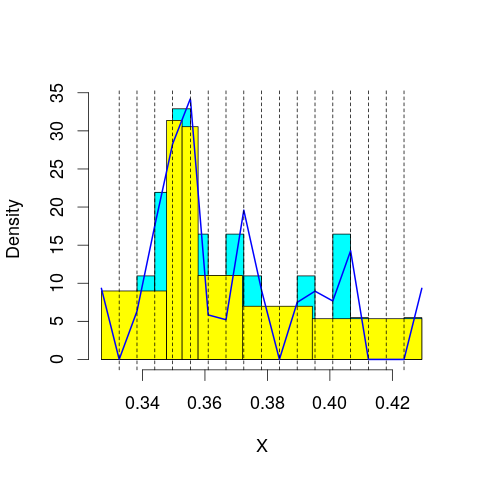

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.24576
mop.approx: Iteration 11. LL = 88.0832
mop.approx: Iteration 21. LL = 88.11312
mop.approx: Iteration 31. LL = 88.11648
mop.approx: Converged. Iteration 34. LL = 88.1169
[1] "Computing the linear combination of B-splines"


53.4595424854
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 71.94126
mop.approx: Iteration 11. LL = 86.23783
mop.approx: Iteration 21. LL = 86.28143
mop.approx: Iteration 31. LL = 86.29307
mop.approx: Iteration 41. LL = 86.29974
mop.approx: Iteration 51. LL = 86.30389
mop.approx: Iteration 61. LL = 86.30643
mop.approx: Iteration 71. LL = 86.30796
mop.approx: Converged. Iteration 77. LL = 86.30864
[1] "Computing the linear combination of B-splines"


49.9184177155
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.01519
mop.approx: Iteration 11. LL = 82.48929
mop.approx: Iteration 21. LL = 82.61187
mop.approx: Iteration 31. LL = 82.62438
mop.approx: Iteration 41. LL = 82.62631
mop.approx: Converged. Iteration 41. LL = 82.62639
[1] "Computing the linear combination of B-splines"


44.5032904308
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.20843
mop.approx: Iteration 11. LL = 81.66691
mop.approx: Iteration 21. LL = 81.82579
mop.approx: Iteration 31. LL = 81.86328
mop.approx: Iteration 41. LL = 81.87432
mop.approx: Iteration 51. LL = 81.87782
mop.approx: Converged. Iteration 59. LL = 81.87891
[1] "Computing the linear combination of B-splines"


42.0229509603
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.29529
mop.approx: Iteration 11. LL = 81.71417
mop.approx: Iteration 21. LL = 81.91378
mop.approx: Iteration 31. LL = 81.95735
mop.approx: Iteration 41. LL = 81.9693
mop.approx: Iteration 51. LL = 81.97296
mop.approx: Converged. Iteration 59. LL = 81.9741
[1] "Computing the linear combination of B-splines"


40.3851987544
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.037047
mop.approx: Iteration 11. LL = 81.22484
mop.approx: Iteration 21. LL = 81.45527
mop.approx: Iteration 31. LL = 81.52248
mop.approx: Iteration 41. LL = 81.54712
mop.approx: Iteration 51. LL = 81.55837
mop.approx: Iteration 61. LL = 81.56447
mop.approx: Iteration 71. LL = 81.56817
mop.approx: Iteration 81. LL = 81.5706
mop.approx: Iteration 91. LL = 81.57228
mop.approx: Iteration 101. LL = 81.5735
mop.approx: Converged. Iteration 110. LL = 81.57441
[1] "Computing the linear combination of B-splines"


38.2318722775
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.279478
mop.approx: Iteration 11. LL = 81.26806
mop.approx: Iteration 21. LL = 81.44351
mop.approx: Iteration 31. LL = 81.49481
mop.approx: Iteration 41. LL = 81.52139
mop.approx: Iteration 51. LL = 81.53786
mop.approx: Iteration 61. LL = 81.5488
mop.approx: Iteration 71. LL = 81.55636
mop.approx: Iteration 81. LL = 81.56175
mop.approx: Iteration 91. LL = 81.56566
mop.approx: Iteration 101. LL = 81.56853
mop.approx: Iteration 111. LL = 81.57066
mop.approx: Iteration 121. LL = 81.57224
mop.approx: Iteration 131. LL = 81.5734
mop.approx: Converged. Iteration 138. LL = 81.57412
[1] "Computing the linear combination of B-splines"


36.4051713545
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.55318
mop.approx: Iteration 11. LL = 88.23923
mop.approx: Iteration 21. LL = 88.27168
mop.approx: Iteration 31. LL = 88.27423
mop.approx: Converged. Iteration 34. LL = 88.27462
[1] "Computing the linear combination of B-splines"


53.6172633943
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 53.617263394281984)
m reached
('Sum of Probabilities:', 0.9902338023221172)
chosen


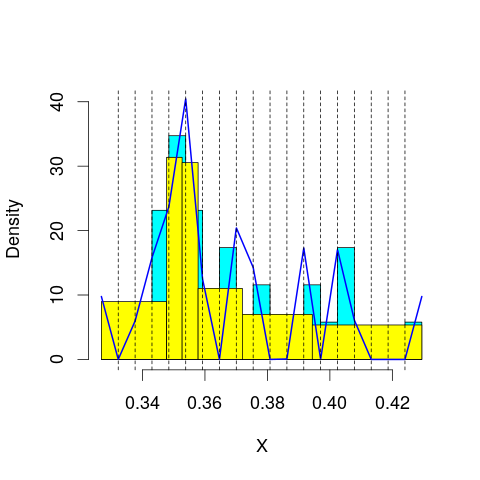

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.24576
mop.approx: Iteration 11. LL = 87.64373
mop.approx: Iteration 21. LL = 87.66061
mop.approx: Converged. Iteration 24. LL = 87.66107
[1] "Computing the linear combination of B-splines"


51.2708474127
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 71.94126
mop.approx: Iteration 11. LL = 87.08663
mop.approx: Iteration 21. LL = 87.16958
mop.approx: Iteration 31. LL = 87.17642
mop.approx: Converged. Iteration 38. LL = 87.17752
[1] "Computing the linear combination of B-splines"


49.0544203282
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.01519
mop.approx: Iteration 11. LL = 82.37239
mop.approx: Iteration 21. LL = 82.51566
mop.approx: Iteration 31. LL = 82.55318
mop.approx: Iteration 41. LL = 82.56674
mop.approx: Iteration 51. LL = 82.57263
mop.approx: Iteration 61. LL = 82.57549
mop.approx: Iteration 71. LL = 82.57699
mop.approx: Converged. Iteration 76. LL = 82.57755
[1] "Computing the linear combination of B-splines"


42.7215826119
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.20843
mop.approx: Iteration 11. LL = 82.20903
mop.approx: Iteration 21. LL = 82.40058
mop.approx: Iteration 31. LL = 82.43261
mop.approx: Iteration 41. LL = 82.44002
mop.approx: Iteration 51. LL = 82.44216
mop.approx: Converged. Iteration 54. LL = 82.44254
[1] "Computing the linear combination of B-splines"


40.8536990324
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.29529
mop.approx: Iteration 11. LL = 81.80558
mop.approx: Iteration 21. LL = 81.98533
mop.approx: Iteration 31. LL = 82.03377
mop.approx: Iteration 41. LL = 82.05247
mop.approx: Iteration 51. LL = 82.06129
mop.approx: Iteration 61. LL = 82.066
mop.approx: Iteration 71. LL = 82.06868
mop.approx: Iteration 81. LL = 82.07025
mop.approx: Converged. Iteration 89. LL = 82.07112
[1] "Computing the linear combination of B-splines"


38.7492714478
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.037047
mop.approx: Iteration 11. LL = 81.59696
mop.approx: Iteration 21. LL = 81.86336
mop.approx: Iteration 31. LL = 81.92098
mop.approx: Iteration 41. LL = 81.93679
mop.approx: Iteration 51. LL = 81.94219
mop.approx: Iteration 61. LL = 81.9443
mop.approx: Converged. Iteration 67. LL = 81.94499
[1] "Computing the linear combination of B-splines"


36.8847350243
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.279478
mop.approx: Iteration 11. LL = 82.44704
mop.approx: Iteration 21. LL = 82.71301
mop.approx: Iteration 31. LL = 82.78364
mop.approx: Iteration 41. LL = 82.81339
mop.approx: Iteration 51. LL = 82.82804
mop.approx: Iteration 61. LL = 82.83605
mop.approx: Iteration 71. LL = 82.84074
mop.approx: Iteration 81. LL = 82.84362
mop.approx: Iteration 91. LL = 82.84542
mop.approx: Iteration 101. LL = 82.84656
mop.approx: Converged. Iteration 103. LL = 82.84682
[1] "Computing the linear combination of B-splines"


35.4693624136
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.55318
mop.approx: Iteration 11. LL = 88.92028
mop.approx: Converged. Iteration 18. LL = 88.92402
[1] "Computing the linear combination of B-splines"


52.5337960623
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 52.53379606233699)
m reached
('Sum of Probabilities:', 0.9898036484108363)
chosen


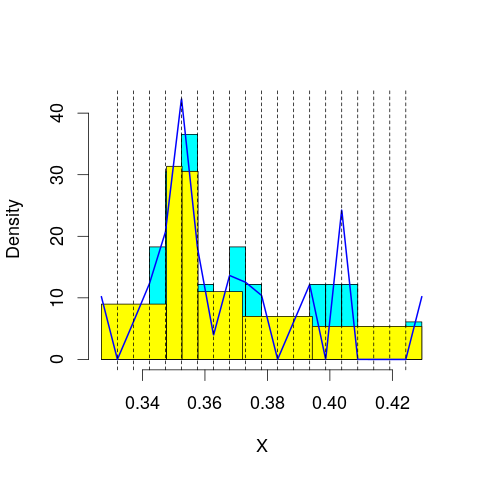

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 72.24576
mop.approx: Iteration 11. LL = 87.57064
mop.approx: Iteration 21. LL = 87.62517
mop.approx: Iteration 31. LL = 87.62891
mop.approx: Converged. Iteration 33. LL = 87.62921
[1] "Computing the linear combination of B-splines"


49.5061199204
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 71.94126
mop.approx: Iteration 11. LL = 87.45074
mop.approx: Iteration 21. LL = 87.48055
mop.approx: Iteration 31. LL = 87.48414
mop.approx: Converged. Iteration 39. LL = 87.48522
[1] "Computing the linear combination of B-splines"


47.6292540455
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 22.01519
mop.approx: Iteration 11. LL = 82.39328
mop.approx: Iteration 21. LL = 82.46182
mop.approx: Iteration 31. LL = 82.47423
mop.approx: Iteration 41. LL = 82.47889
mop.approx: Iteration 51. LL = 82.48097
mop.approx: Converged. Iteration 59. LL = 82.48192
[1] "Computing the linear combination of B-splines"


40.8930894185
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.20843
mop.approx: Iteration 11. LL = 82.55774
mop.approx: Iteration 21. LL = 82.71926
mop.approx: Iteration 31. LL = 82.75009
mop.approx: Iteration 41. LL = 82.75869
mop.approx: Iteration 51. LL = 82.76128
mop.approx: Converged. Iteration 55. LL = 82.7618
[1] "Computing the linear combination of B-splines"


39.4400893731
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.29529
mop.approx: Iteration 11. LL = 81.94653
mop.approx: Iteration 21. LL = 82.07841
mop.approx: Iteration 31. LL = 82.10789
mop.approx: Iteration 41. LL = 82.11871
mop.approx: Iteration 51. LL = 82.1233
mop.approx: Iteration 61. LL = 82.12541
mop.approx: Converged. Iteration 69. LL = 82.12636
[1] "Computing the linear combination of B-splines"


37.0717190764
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.037047
mop.approx: Iteration 11. LL = 81.92354
mop.approx: Iteration 21. LL = 82.16238
mop.approx: Iteration 31. LL = 82.20501
mop.approx: Iteration 41. LL = 82.21391
mop.approx: Iteration 51. LL = 82.21609
mop.approx: Converged. Iteration 54. LL = 82.21645
[1] "Computing the linear combination of B-splines"


35.4136848117
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.279478
mop.approx: Iteration 11. LL = 82.412
mop.approx: Iteration 21. LL = 82.60638
mop.approx: Iteration 31. LL = 82.63033
mop.approx: Iteration 41. LL = 82.63707
mop.approx: Iteration 51. LL = 82.64102
mop.approx: Iteration 61. LL = 82.64398
mop.approx: Iteration 71. LL = 82.64634
mop.approx: Iteration 81. LL = 82.64824
mop.approx: Iteration 91. LL = 82.64979
mop.approx: Iteration 101. LL = 82.65106
mop.approx: Iteration 111. LL = 82.65212
mop.approx: Converged. Iteration 119. LL = 82.65291
[1] "Computing the linear combination of B-splines"


34.0907629618
lfps_5
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.95825
mop.approx: Converged. Iteration 8. LL = 62.25345
[1] "Computing the linear combination of B-splines"


57.0548469195
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 57.054846919543898)
m reached
('Sum of Probabilities:', 0.9922453897804249)
chosen


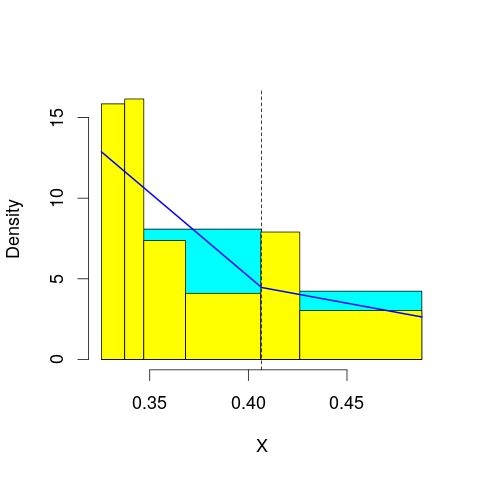

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.76308
mop.approx: Iteration 11. LL = 62.44596
mop.approx: Converged. Iteration 14. LL = 62.44626
[1] "Computing the linear combination of B-splines"


55.5147845446
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.56909
mop.approx: Iteration 11. LL = 62.64579
mop.approx: Iteration 21. LL = 62.81443
mop.approx: Iteration 31. LL = 62.87875
mop.approx: Iteration 41. LL = 62.90287
mop.approx: Iteration 51. LL = 62.91169
mop.approx: Iteration 61. LL = 62.91482
mop.approx: Iteration 71. LL = 62.91589
mop.approx: Converged. Iteration 71. LL = 62.91595
[1] "Computing the linear combination of B-splines"


54.251607275
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.41401
mop.approx: Iteration 11. LL = 49.17618
mop.approx: Iteration 21. LL = 49.2018
mop.approx: Converged. Iteration 26. LL = 49.20247
[1] "Computing the linear combination of B-splines"


38.8052656766
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.17751
mop.approx: Iteration 11. LL = 47.19586
mop.approx: Iteration 21. LL = 47.50752
mop.approx: Iteration 31. LL = 47.57819
mop.approx: Iteration 41. LL = 47.6001
mop.approx: Iteration 51. LL = 47.60759
mop.approx: Iteration 61. LL = 47.61024
mop.approx: Iteration 71. LL = 47.61119
mop.approx: Converged. Iteration 72. LL = 47.61128
[1] "Computing the linear combination of B-splines"


35.4812089942
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.678626
mop.approx: Iteration 11. LL = 46.3674
mop.approx: Iteration 21. LL = 46.55666
mop.approx: Iteration 31. LL = 46.59598
mop.approx: Iteration 41. LL = 46.61028
mop.approx: Iteration 51. LL = 46.61686
mop.approx: Iteration 61. LL = 46.62026
mop.approx: Iteration 71. LL = 46.62215
mop.approx: Iteration 81. LL = 46.62323
mop.approx: Iteration 91. LL = 46.62386
mop.approx: Converged. Iteration 92. LL = 46.62395
[1] "Computing the linear combination of B-splines"


32.7610095306
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.73498
mop.approx: Iteration 11. LL = 44.68019
mop.approx: Iteration 21. LL = 45.09761
mop.approx: Iteration 31. LL = 45.17874
mop.approx: Iteration 41. LL = 45.19731
mop.approx: Iteration 51. LL = 45.20171
mop.approx: Iteration 61. LL = 45.20276
mop.approx: Converged. Iteration 61. LL = 45.2028
[1] "Computing the linear combination of B-splines"


29.6069934154
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.224455
mop.approx: Iteration 11. LL = 43.71663
mop.approx: Iteration 21. LL = 44.04023
mop.approx: Iteration 31. LL = 44.10618
mop.approx: Iteration 41. LL = 44.12479
mop.approx: Iteration 51. LL = 44.13054
mop.approx: Iteration 61. LL = 44.13237
mop.approx: Converged. Iteration 68. LL = 44.13289
[1] "Computing the linear combination of B-splines"


26.8042075457
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.95825
mop.approx: Converged. Iteration 10. LL = 62.76562
[1] "Computing the linear combination of B-splines"


55.8341517989
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 55.834151798908238)
m reached
('Sum of Probabilities:', 0.9909440197900667)
chosen


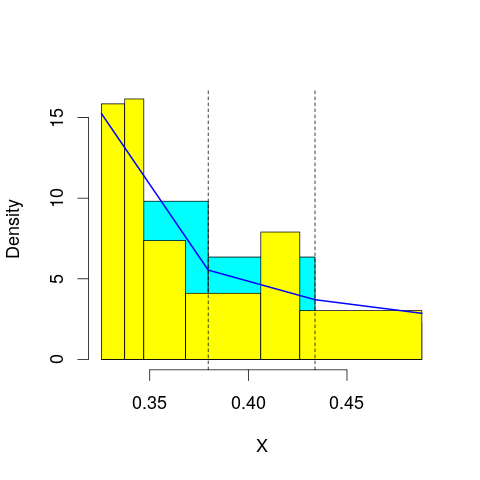

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.76308
mop.approx: Iteration 11. LL = 63.43949
mop.approx: Iteration 21. LL = 63.52446
mop.approx: Iteration 31. LL = 63.54141
mop.approx: Iteration 41. LL = 63.54637
mop.approx: Iteration 51. LL = 63.54804
mop.approx: Converged. Iteration 55. LL = 63.54841
[1] "Computing the linear combination of B-splines"


54.8840710157
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.56909
mop.approx: Iteration 11. LL = 62.93532
mop.approx: Iteration 21. LL = 62.97899
mop.approx: Iteration 31. LL = 62.9863
mop.approx: Converged. Iteration 40. LL = 62.98771
[1] "Computing the linear combination of B-splines"


52.5905060341
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.41401
mop.approx: Iteration 11. LL = 50.40196
mop.approx: Iteration 21. LL = 50.4616
mop.approx: Converged. Iteration 30. LL = 50.46397
[1] "Computing the linear combination of B-splines"


38.3338926928
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.17751
mop.approx: Iteration 11. LL = 51.40278
mop.approx: Converged. Iteration 20. LL = 51.4192
[1] "Computing the linear combination of B-splines"


37.5562516914
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.678626
mop.approx: Iteration 11. LL = 48.60963
mop.approx: Iteration 21. LL = 48.71114
mop.approx: Iteration 31. LL = 48.72104
mop.approx: Iteration 41. LL = 48.72263
mop.approx: Converged. Iteration 42. LL = 48.72273
[1] "Computing the linear combination of B-splines"


33.1269185692
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.73498
mop.approx: Iteration 11. LL = 48.78826
mop.approx: Iteration 21. LL = 48.92899
mop.approx: Iteration 31. LL = 48.95083
mop.approx: Iteration 41. LL = 48.95777
mop.approx: Iteration 51. LL = 48.96075
mop.approx: Iteration 61. LL = 48.96227
mop.approx: Iteration 71. LL = 48.96314
mop.approx: Converged. Iteration 78. LL = 48.96359
[1] "Computing the linear combination of B-splines"


31.6349060671
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.224455
mop.approx: Iteration 11. LL = 46.32879
mop.approx: Iteration 21. LL = 46.625
mop.approx: Iteration 31. LL = 46.70328
mop.approx: Iteration 41. LL = 46.73536
mop.approx: Iteration 51. LL = 46.75135
mop.approx: Iteration 61. LL = 46.76023
mop.approx: Iteration 71. LL = 46.76549
mop.approx: Iteration 81. LL = 46.76873
mop.approx: Iteration 91. LL = 46.77078
mop.approx: Iteration 101. LL = 46.7721
mop.approx: Iteration 111. LL = 46.77295
mop.approx: Converged. Iteration 120. LL = 46.77351
[1] "Computing the linear combination of B-splines"


27.7119588272
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.95825
mop.approx: Iteration 11. LL = 63.57638
mop.approx: Converged. Iteration 12. LL = 63.57649
[1] "Computing the linear combination of B-splines"


54.9121538228
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 54.91215382280776)
m reached
('Sum of Probabilities:', 0.9892468373944872)
chosen


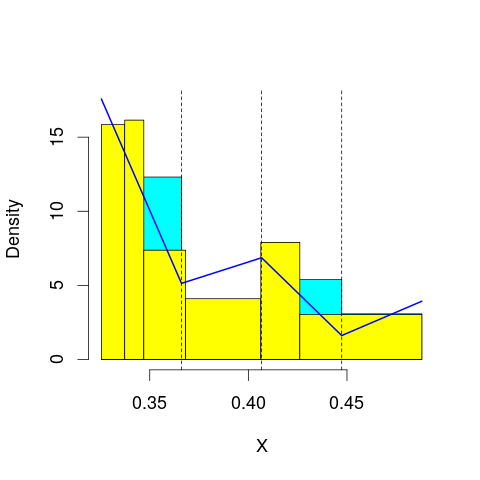

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.76308
mop.approx: Iteration 11. LL = 63.49219
mop.approx: Iteration 21. LL = 63.52547
mop.approx: Iteration 31. LL = 63.53014
mop.approx: Converged. Iteration 36. LL = 63.53072
[1] "Computing the linear combination of B-splines"


53.1335148143
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.56909
mop.approx: Iteration 11. LL = 63.30141
mop.approx: Iteration 21. LL = 63.38673
mop.approx: Iteration 31. LL = 63.41169
mop.approx: Iteration 41. LL = 63.42192
mop.approx: Iteration 51. LL = 63.42727
mop.approx: Iteration 61. LL = 63.4306
mop.approx: Iteration 71. LL = 63.43294
mop.approx: Iteration 81. LL = 63.43471
mop.approx: Iteration 91. LL = 63.43609
mop.approx: Iteration 101. LL = 63.43719
mop.approx: Iteration 111. LL = 63.43807
mop.approx: Iteration 121. LL = 63.43877
mop.approx: Converged. Iteration 121. LL = 63.43884
[1] "Computing the linear combination of B-splines"


51.3087612342
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.41401
mop.approx: Iteration 11. LL = 51.43438
mop.approx: Iteration 21. LL = 51.55848
mop.approx: Iteration 31. LL = 51.58251
mop.approx: Iteration 41. LL = 51.59023
mop.approx: Iteration 51. LL = 51.59341
mop.approx: Iteration 61. LL = 51.59493
mop.approx: Iteration 71. LL = 51.59573
mop.approx: Converged. Iteration 73. LL = 51.59589
[1] "Computing the linear combination of B-splines"


37.7329483333
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.17751
mop.approx: Iteration 11. LL = 51.49945
mop.approx: Iteration 21. LL = 51.50908
mop.approx: Converged. Iteration 25. LL = 51.50952
[1] "Computing the linear combination of B-splines"


35.9137063694
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.678626
mop.approx: Iteration 11. LL = 52.27442
mop.approx: Iteration 21. LL = 52.36762
mop.approx: Converged. Iteration 25. LL = 52.36837
[1] "Computing the linear combination of B-splines"


35.0396947941
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.73498
mop.approx: Iteration 11. LL = 49.87284
mop.approx: Iteration 21. LL = 49.94049
mop.approx: Converged. Iteration 26. LL = 49.94131
[1] "Computing the linear combination of B-splines"


30.8797672666
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.224455
mop.approx: Iteration 11. LL = 50.41357
mop.approx: Iteration 21. LL = 50.54353
mop.approx: Iteration 31. LL = 50.55282
mop.approx: Iteration 41. LL = 50.55451
mop.approx: Converged. Iteration 44. LL = 50.55473
[1] "Computing the linear combination of B-splines"


29.7603176879
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.95825
mop.approx: Iteration 11. LL = 64.08226
mop.approx: Converged. Iteration 15. LL = 64.08308
[1] "Computing the linear combination of B-splines"


53.6858759195
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 53.685875919474199)
m reached
('Sum of Probabilities:', 0.9886190207718061)
chosen


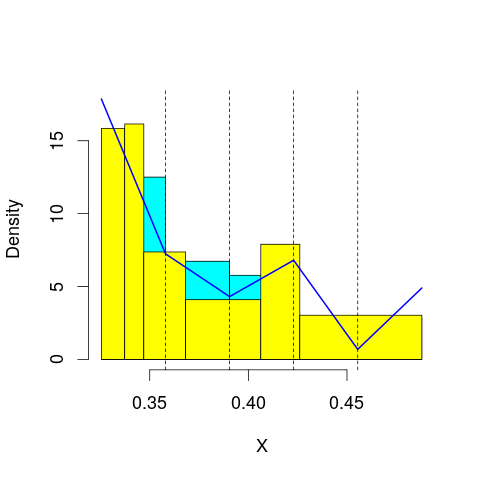

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.76308
mop.approx: Iteration 11. LL = 63.67063
mop.approx: Iteration 21. LL = 63.67922
mop.approx: Converged. Iteration 26. LL = 63.67982
[1] "Computing the linear combination of B-splines"


51.5497446703
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.56909
mop.approx: Iteration 11. LL = 63.45338
mop.approx: Iteration 21. LL = 63.46595
mop.approx: Iteration 31. LL = 63.46964
mop.approx: Iteration 41. LL = 63.47163
mop.approx: Iteration 51. LL = 63.47282
mop.approx: Iteration 61. LL = 63.4736
mop.approx: Converged. Iteration 61. LL = 63.47366
[1] "Computing the linear combination of B-splines"


49.6107189871
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.41401
mop.approx: Iteration 11. LL = 53.03668
mop.approx: Iteration 21. LL = 53.31099
mop.approx: Iteration 31. LL = 53.33017
mop.approx: Converged. Iteration 39. LL = 53.33154
[1] "Computing the linear combination of B-splines"


37.7357285001
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.17751
mop.approx: Iteration 11. LL = 51.51362
mop.approx: Iteration 21. LL = 51.51831
mop.approx: Converged. Iteration 29. LL = 51.5191
[1] "Computing the linear combination of B-splines"


34.1904198736
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.678626
mop.approx: Iteration 11. LL = 52.50455
mop.approx: Converged. Iteration 19. LL = 52.51708
[1] "Computing the linear combination of B-splines"


33.4555370641
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.73498
mop.approx: Iteration 11. LL = 52.05793
mop.approx: Iteration 21. LL = 52.36015
mop.approx: Iteration 31. LL = 52.39469
mop.approx: Iteration 41. LL = 52.39896
mop.approx: Converged. Iteration 45. LL = 52.39936
[1] "Computing the linear combination of B-splines"


31.6049397936
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.224455
mop.approx: Iteration 11. LL = 50.84784
mop.approx: Iteration 21. LL = 50.95353
mop.approx: Iteration 31. LL = 50.96425
mop.approx: Converged. Iteration 39. LL = 50.96533
[1] "Computing the linear combination of B-splines"


28.4380477089
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.95825
mop.approx: Iteration 11. LL = 63.91671
mop.approx: Converged. Iteration 15. LL = 63.91749
[1] "Computing the linear combination of B-splines"


51.7874179037
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 51.787417903654941)
m reached
('Sum of Probabilities:', 0.988212099424892)
chosen


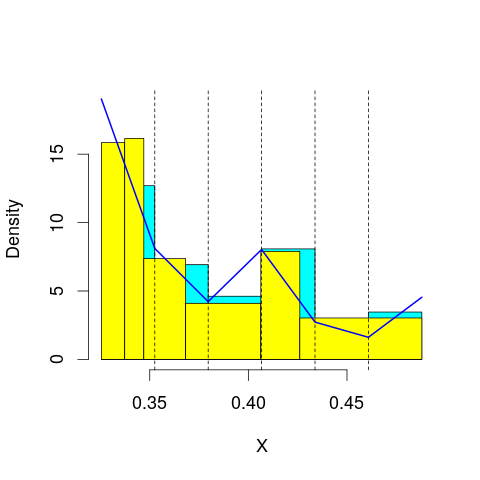

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.76308
mop.approx: Iteration 11. LL = 64.00902
mop.approx: Iteration 21. LL = 64.0151
mop.approx: Converged. Iteration 27. LL = 64.01586
[1] "Computing the linear combination of B-splines"


50.1529118846
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.56909
mop.approx: Iteration 11. LL = 63.63403
mop.approx: Iteration 21. LL = 63.67023
mop.approx: Iteration 31. LL = 63.6874
mop.approx: Iteration 41. LL = 63.69601
mop.approx: Iteration 51. LL = 63.70037
mop.approx: Iteration 61. LL = 63.70257
mop.approx: Iteration 71. LL = 63.70367
mop.approx: Converged. Iteration 74. LL = 63.70394
[1] "Computing the linear combination of B-splines"


48.1081299368
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.41401
mop.approx: Iteration 11. LL = 54.93233
mop.approx: Iteration 21. LL = 55.12002
mop.approx: Iteration 31. LL = 55.1476
mop.approx: Iteration 41. LL = 55.15633
mop.approx: Iteration 51. LL = 55.15957
mop.approx: Iteration 61. LL = 55.16084
mop.approx: Converged. Iteration 65. LL = 55.16114
[1] "Computing the linear combination of B-splines"


37.8324643924
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.17751
mop.approx: Iteration 11. LL = 51.82387
mop.approx: Iteration 21. LL = 51.95166
mop.approx: Iteration 31. LL = 51.99134
mop.approx: Iteration 41. LL = 52.00472
mop.approx: Iteration 51. LL = 52.00922
mop.approx: Iteration 61. LL = 52.01067
mop.approx: Converged. Iteration 64. LL = 52.01092
[1] "Computing the linear combination of B-splines"


32.9493694796
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.678626
mop.approx: Iteration 11. LL = 52.66407
mop.approx: Iteration 21. LL = 52.7025
mop.approx: Iteration 31. LL = 52.70932
mop.approx: Iteration 41. LL = 52.71073
mop.approx: Converged. Iteration 42. LL = 52.71083
[1] "Computing the linear combination of B-splines"


31.9164123042
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.73498
mop.approx: Iteration 11. LL = 53.01826
mop.approx: Iteration 21. LL = 53.14032
mop.approx: Converged. Iteration 27. LL = 53.14208
[1] "Computing the linear combination of B-splines"


30.6147929526
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.224455
mop.approx: Iteration 11. LL = 51.5532
mop.approx: Iteration 21. LL = 51.69297
mop.approx: Iteration 31. LL = 51.72415
mop.approx: Iteration 41. LL = 51.73468
mop.approx: Iteration 51. LL = 51.73917
mop.approx: Iteration 61. LL = 51.74143
mop.approx: Iteration 71. LL = 51.74273
mop.approx: Iteration 81. LL = 51.74357
mop.approx: Iteration 91. LL = 51.74418
mop.approx: Converged. Iteration 93. LL = 51.74434
[1] "Computing the linear combination of B-splines"


27.4841861621
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.95825
mop.approx: Iteration 11. LL = 65.24084
mop.approx: Iteration 21. LL = 65.24626
mop.approx: Converged. Iteration 21. LL = 65.24632
[1] "Computing the linear combination of B-splines"


51.3833745711
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 51.3833745711079)
m reached
('Sum of Probabilities:', 0.9868215559040407)
chosen


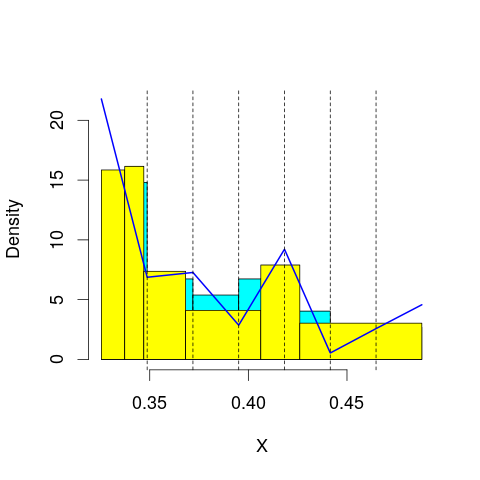

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.76308
mop.approx: Iteration 11. LL = 63.84122
mop.approx: Iteration 21. LL = 63.86171
mop.approx: Iteration 31. LL = 63.86804
mop.approx: Iteration 41. LL = 63.87073
mop.approx: Iteration 51. LL = 63.87209
mop.approx: Converged. Iteration 59. LL = 63.87278
[1] "Computing the linear combination of B-splines"


48.276972143
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.56909
mop.approx: Iteration 11. LL = 64.32914
mop.approx: Iteration 21. LL = 64.51221
mop.approx: Iteration 31. LL = 64.58105
mop.approx: Iteration 41. LL = 64.61071
mop.approx: Iteration 51. LL = 64.62524
mop.approx: Iteration 61. LL = 64.63324
mop.approx: Iteration 71. LL = 64.63807
mop.approx: Iteration 81. LL = 64.64121
mop.approx: Iteration 91. LL = 64.64335
mop.approx: Iteration 101. LL = 64.64488
mop.approx: Iteration 111. LL = 64.64598
mop.approx: Iteration 121. LL = 64.64681
mop.approx: Converged. Iteration 124. LL = 64.64708
[1] "Computing the linear combination of B-splines"


47.3183963674
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.41401
mop.approx: Iteration 11. LL = 55.96317
mop.approx: Iteration 21. LL = 56.1401
mop.approx: Iteration 31. LL = 56.17673
mop.approx: Iteration 41. LL = 56.18592
mop.approx: Iteration 51. LL = 56.18826
mop.approx: Converged. Iteration 56. LL = 56.18871
[1] "Computing the linear combination of B-splines"


37.1271664643
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.17751
mop.approx: Iteration 11. LL = 53.35516
mop.approx: Iteration 21. LL = 53.70429
mop.approx: Iteration 31. LL = 53.77551
mop.approx: Iteration 41. LL = 53.79617
mop.approx: Iteration 51. LL = 53.80482
mop.approx: Iteration 61. LL = 53.80939
mop.approx: Iteration 71. LL = 53.81209
mop.approx: Iteration 81. LL = 53.81379
mop.approx: Iteration 91. LL = 53.81491
mop.approx: Iteration 101. LL = 53.81567
mop.approx: Converged. Iteration 105. LL = 53.81595
[1] "Computing the linear combination of B-splines"


33.0215344463
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.678626
mop.approx: Iteration 11. LL = 52.65359
mop.approx: Iteration 21. LL = 52.66052
mop.approx: Converged. Iteration 23. LL = 52.6607
[1] "Computing the linear combination of B-splines"


30.1334136405
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.73498
mop.approx: Iteration 11. LL = 53.62434
mop.approx: Iteration 21. LL = 53.75653
mop.approx: Iteration 31. LL = 53.78573
mop.approx: Iteration 41. LL = 53.79661
mop.approx: Iteration 51. LL = 53.80162
mop.approx: Iteration 61. LL = 53.80426
mop.approx: Iteration 71. LL = 53.80579
mop.approx: Iteration 81. LL = 53.80674
mop.approx: Converged. Iteration 89. LL = 53.80731
[1] "Computing the linear combination of B-splines"


29.5471536657
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.224455
mop.approx: Iteration 11. LL = 52.78858
mop.approx: Iteration 21. LL = 53.21508
mop.approx: Iteration 31. LL = 53.26036
mop.approx: Iteration 41. LL = 53.26469
mop.approx: Converged. Iteration 44. LL = 53.26497
[1] "Computing the linear combination of B-splines"


27.2719459415
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.95825
mop.approx: Iteration 11. LL = 64.20117
mop.approx: Converged. Iteration 13. LL = 64.20146
[1] "Computing the linear combination of B-splines"


48.605650646
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 48.605650646024017)
m reached
('Sum of Probabilities:', 0.9865602792494846)
chosen


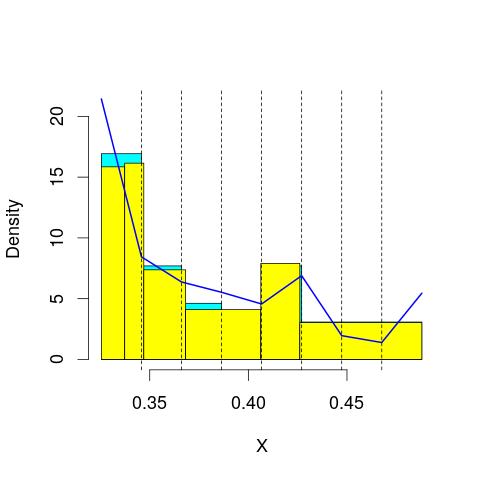

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.76308
mop.approx: Iteration 11. LL = 65.36734
mop.approx: Iteration 21. LL = 65.47842
mop.approx: Iteration 31. LL = 65.49176
mop.approx: Iteration 41. LL = 65.49462
mop.approx: Converged. Iteration 50. LL = 65.49559
[1] "Computing the linear combination of B-splines"


48.1669122364
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.56909
mop.approx: Iteration 11. LL = 64.13563
mop.approx: Iteration 21. LL = 64.24097
mop.approx: Iteration 31. LL = 64.27756
mop.approx: Iteration 41. LL = 64.29347
mop.approx: Iteration 51. LL = 64.30148
mop.approx: Iteration 61. LL = 64.30597
mop.approx: Iteration 71. LL = 64.30869
mop.approx: Iteration 81. LL = 64.31045
mop.approx: Iteration 91. LL = 64.31165
mop.approx: Iteration 101. LL = 64.3125
mop.approx: Converged. Iteration 105. LL = 64.31284
[1] "Computing the linear combination of B-splines"


45.2512879871
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.41401
mop.approx: Iteration 11. LL = 56.86361
mop.approx: Iteration 21. LL = 56.92545
mop.approx: Iteration 31. LL = 56.9328
mop.approx: Converged. Iteration 40. LL = 56.93398
[1] "Computing the linear combination of B-splines"


36.1395649643
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.17751
mop.approx: Iteration 11. LL = 54.81724
mop.approx: Iteration 21. LL = 55.19426
mop.approx: Iteration 31. LL = 55.245
mop.approx: Iteration 41. LL = 55.25493
mop.approx: Iteration 51. LL = 55.25791
mop.approx: Iteration 61. LL = 55.25903
mop.approx: Converged. Iteration 64. LL = 55.25927
[1] "Computing the linear combination of B-splines"


32.7319840161
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.678626
mop.approx: Iteration 11. LL = 53.24446
mop.approx: Iteration 21. LL = 53.38044
mop.approx: Iteration 31. LL = 53.4142
mop.approx: Iteration 41. LL = 53.42226
mop.approx: Iteration 51. LL = 53.42415
mop.approx: Converged. Iteration 54. LL = 53.4244
[1] "Computing the linear combination of B-splines"


29.1642502969
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.73498
mop.approx: Iteration 11. LL = 53.87544
mop.approx: Iteration 21. LL = 53.96984
mop.approx: Iteration 31. LL = 54.00291
mop.approx: Iteration 41. LL = 54.01833
mop.approx: Iteration 51. LL = 54.02634
mop.approx: Iteration 61. LL = 54.03089
mop.approx: Iteration 71. LL = 54.03367
mop.approx: Iteration 81. LL = 54.03547
mop.approx: Iteration 91. LL = 54.03671
mop.approx: Iteration 101. LL = 54.03759
mop.approx: Iteration 111. LL = 54.03823
mop.approx: Converged. Iteration 112. LL = 54.03834
[1] "Computing the linear combination of B-splines"


28.0453219957
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.224455
mop.approx: Iteration 11. LL = 53.95538
mop.approx: Iteration 21. LL = 54.2949
mop.approx: Iteration 31. LL = 54.34821
mop.approx: Iteration 41. LL = 54.3661
mop.approx: Iteration 51. LL = 54.37337
mop.approx: Iteration 61. LL = 54.37651
mop.approx: Iteration 71. LL = 54.3779
mop.approx: Converged. Iteration 77. LL = 54.37839
[1] "Computing the linear combination of B-splines"


26.6525068891
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.95825
mop.approx: Iteration 11. LL = 65.94459
mop.approx: Iteration 21. LL = 65.97763
mop.approx: Iteration 31. LL = 65.9818
mop.approx: Iteration 41. LL = 65.98299
mop.approx: Converged. Iteration 43. LL = 65.98319
[1] "Computing the linear combination of B-splines"


48.654511641
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 48.654511640950886)
m reached
('Sum of Probabilities:', 0.987127123696816)
chosen


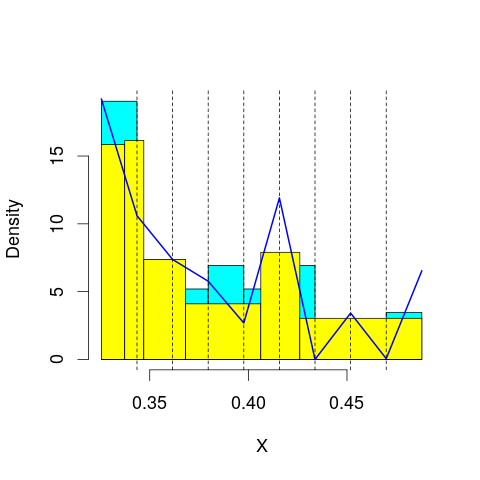

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.76308
mop.approx: Iteration 11. LL = 64.81972
mop.approx: Iteration 21. LL = 64.85825
mop.approx: Iteration 31. LL = 64.86327
mop.approx: Iteration 41. LL = 64.86482
mop.approx: Converged. Iteration 46. LL = 64.86528
[1] "Computing the linear combination of B-splines"


45.8037371504
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.56909
mop.approx: Iteration 11. LL = 65.11232
mop.approx: Iteration 21. LL = 65.29009
mop.approx: Iteration 31. LL = 65.32695
mop.approx: Iteration 41. LL = 65.33796
mop.approx: Iteration 51. LL = 65.34233
mop.approx: Iteration 61. LL = 65.34439
mop.approx: Iteration 71. LL = 65.34545
mop.approx: Converged. Iteration 74. LL = 65.34572
[1] "Computing the linear combination of B-splines"


44.5513077101
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.41401
mop.approx: Iteration 11. LL = 57.00092
mop.approx: Iteration 21. LL = 57.0519
mop.approx: Iteration 31. LL = 57.063
mop.approx: Iteration 41. LL = 57.06611
mop.approx: Iteration 51. LL = 57.06712
mop.approx: Converged. Iteration 51. LL = 57.06718
[1] "Computing the linear combination of B-splines"


34.5398960447
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.17751
mop.approx: Iteration 11. LL = 56.38056
mop.approx: Iteration 21. LL = 56.62617
mop.approx: Iteration 31. LL = 56.64194
mop.approx: Converged. Iteration 39. LL = 56.64336
[1] "Computing the linear combination of B-splines"


32.383205601
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.678626
mop.approx: Iteration 11. LL = 53.77952
mop.approx: Iteration 21. LL = 53.9194
mop.approx: Iteration 31. LL = 53.93838
mop.approx: Iteration 41. LL = 53.94074
mop.approx: Converged. Iteration 42. LL = 53.94085
[1] "Computing the linear combination of B-splines"


27.9478285483
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.73498
mop.approx: Iteration 11. LL = 54.30356
mop.approx: Iteration 21. LL = 54.41662
mop.approx: Iteration 31. LL = 54.45611
mop.approx: Iteration 41. LL = 54.47267
mop.approx: Iteration 51. LL = 54.47996
mop.approx: Iteration 61. LL = 54.48327
mop.approx: Iteration 71. LL = 54.48482
mop.approx: Converged. Iteration 80. LL = 54.48557
[1] "Computing the linear combination of B-splines"


26.7596778593
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.224455
mop.approx: Iteration 11. LL = 54.63509
mop.approx: Iteration 21. LL = 54.86319
mop.approx: Iteration 31. LL = 54.92157
mop.approx: Iteration 41. LL = 54.94235
mop.approx: Iteration 51. LL = 54.94969
mop.approx: Iteration 61. LL = 54.95223
mop.approx: Converged. Iteration 70. LL = 54.95309
[1] "Computing the linear combination of B-splines"


25.4942998195
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.95825
mop.approx: Iteration 11. LL = 66.17768
mop.approx: Iteration 21. LL = 66.20272
mop.approx: Converged. Iteration 30. LL = 66.20447
[1] "Computing the linear combination of B-splines"


47.1429246401
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 47.142924640125948)
m reached
('Sum of Probabilities:', 0.9874592836897308)
chosen


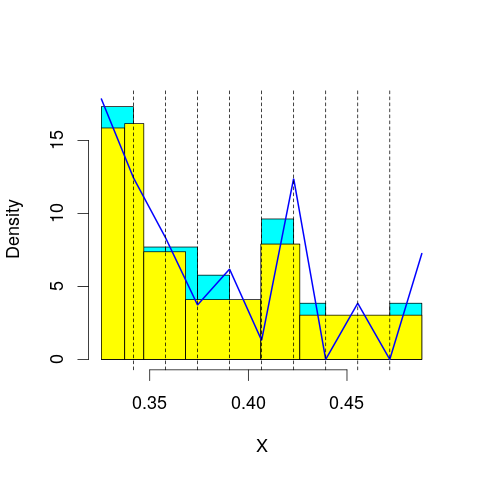

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.76308
mop.approx: Iteration 11. LL = 65.86963
mop.approx: Iteration 21. LL = 65.93343
mop.approx: Iteration 31. LL = 65.94404
mop.approx: Iteration 41. LL = 65.94728
mop.approx: Iteration 51. LL = 65.94862
mop.approx: Converged. Iteration 56. LL = 65.94906
[1] "Computing the linear combination of B-splines"


45.1546480316
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.56909
mop.approx: Iteration 11. LL = 65.03895
mop.approx: Iteration 21. LL = 65.16563
mop.approx: Iteration 31. LL = 65.20453
mop.approx: Iteration 41. LL = 65.22193
mop.approx: Iteration 51. LL = 65.23075
mop.approx: Iteration 61. LL = 65.23564
mop.approx: Iteration 71. LL = 65.23856
mop.approx: Iteration 81. LL = 65.2404
mop.approx: Iteration 91. LL = 65.24161
mop.approx: Iteration 101. LL = 65.24243
mop.approx: Converged. Iteration 102. LL = 65.24257
[1] "Computing the linear combination of B-splines"


42.7152840922
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.41401
mop.approx: Iteration 11. LL = 57.71076
mop.approx: Iteration 21. LL = 57.86609
mop.approx: Iteration 31. LL = 57.90127
mop.approx: Iteration 41. LL = 57.91067
mop.approx: Iteration 51. LL = 57.91391
mop.approx: Iteration 61. LL = 57.9153
mop.approx: Converged. Iteration 68. LL = 57.91586
[1] "Computing the linear combination of B-splines"


33.6557070606
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.17751
mop.approx: Iteration 11. LL = 57.11498
mop.approx: Iteration 21. LL = 57.28692
mop.approx: Iteration 31. LL = 57.32874
mop.approx: Iteration 41. LL = 57.34733
mop.approx: Iteration 51. LL = 57.35604
mop.approx: Iteration 61. LL = 57.36018
mop.approx: Iteration 71. LL = 57.36214
mop.approx: Iteration 81. LL = 57.36308
mop.approx: Converged. Iteration 82. LL = 57.3632
[1] "Computing the linear combination of B-splines"


31.3701825345
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.678626
mop.approx: Iteration 11. LL = 54.91132
mop.approx: Iteration 21. LL = 55.2568
mop.approx: Iteration 31. LL = 55.34112
mop.approx: Iteration 41. LL = 55.36897
mop.approx: Iteration 51. LL = 55.38114
mop.approx: Iteration 61. LL = 55.38765
mop.approx: Iteration 71. LL = 55.39159
mop.approx: Iteration 81. LL = 55.39414
mop.approx: Iteration 91. LL = 55.39587
mop.approx: Iteration 101. LL = 55.39708
mop.approx: Iteration 111. LL = 55.39796
mop.approx: Converged. Iteration 120. LL = 55.39859
[1] "Computing the linear combination of B-splines"


27.6727059744
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.73498
mop.approx: Iteration 11. LL = 54.41314
mop.approx: Iteration 21. LL = 54.48876
mop.approx: Iteration 31. LL = 54.51094
mop.approx: Iteration 41. LL = 54.51925
mop.approx: Iteration 51. LL = 54.52278
mop.approx: Iteration 61. LL = 54.52439
mop.approx: Converged. Iteration 70. LL = 54.52516
[1] "Computing the linear combination of B-splines"


25.0664099625
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.224455
mop.approx: Iteration 11. LL = 55.28818
mop.approx: Iteration 21. LL = 55.45313
mop.approx: Iteration 31. LL = 55.49426
mop.approx: Iteration 41. LL = 55.51283
mop.approx: Iteration 51. LL = 55.52272
mop.approx: Iteration 61. LL = 55.52832
mop.approx: Iteration 71. LL = 55.53157
mop.approx: Iteration 81. LL = 55.5335
mop.approx: Iteration 91. LL = 55.53464
mop.approx: Converged. Iteration 100. LL = 55.53533
[1] "Computing the linear combination of B-splines"


24.3437432081
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.95825
mop.approx: Iteration 11. LL = 66.74088
mop.approx: Iteration 21. LL = 66.75523
mop.approx: Converged. Iteration 28. LL = 66.75631
[1] "Computing the linear combination of B-splines"


45.9618918709
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 45.96189187087397)
m reached
('Sum of Probabilities:', 0.9879032691169286)
chosen


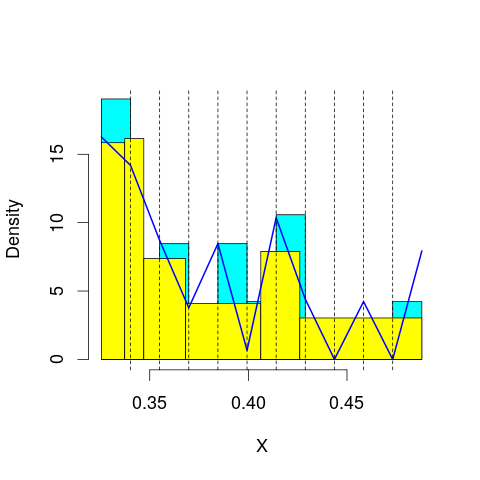

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.76308
mop.approx: Iteration 11. LL = 66.70413
mop.approx: Iteration 21. LL = 66.87978
mop.approx: Iteration 31. LL = 66.92524
mop.approx: Iteration 41. LL = 66.94145
mop.approx: Iteration 51. LL = 66.94857
mop.approx: Iteration 61. LL = 66.95223
mop.approx: Iteration 71. LL = 66.95433
mop.approx: Iteration 81. LL = 66.95561
mop.approx: Converged. Iteration 90. LL = 66.95643
[1] "Computing the linear combination of B-splines"


44.4291420155
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.56909
mop.approx: Iteration 11. LL = 65.50468
mop.approx: Iteration 21. LL = 65.63733
mop.approx: Iteration 31. LL = 65.65871
mop.approx: Iteration 41. LL = 65.66392
mop.approx: Iteration 51. LL = 65.66551
mop.approx: Converged. Iteration 54. LL = 65.6658
[1] "Computing the linear combination of B-splines"


41.4056485268
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.41401
mop.approx: Iteration 11. LL = 57.83531
mop.approx: Iteration 21. LL = 57.90216
mop.approx: Iteration 31. LL = 57.91624
mop.approx: Iteration 41. LL = 57.92323
mop.approx: Iteration 51. LL = 57.92736
mop.approx: Iteration 61. LL = 57.92992
mop.approx: Iteration 71. LL = 57.93155
mop.approx: Iteration 81. LL = 57.9326
mop.approx: Converged. Iteration 90. LL = 57.93329
[1] "Computing the linear combination of B-splines"


31.9402731569
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.17751
mop.approx: Iteration 11. LL = 58.18138
mop.approx: Iteration 21. LL = 58.43546
mop.approx: Iteration 31. LL = 58.48035
mop.approx: Iteration 41. LL = 58.49104
mop.approx: Iteration 51. LL = 58.4943
mop.approx: Iteration 61. LL = 58.49548
mop.approx: Converged. Iteration 63. LL = 58.49567
[1] "Computing the linear combination of B-splines"


30.7697815428
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.678626
mop.approx: Iteration 11. LL = 55.79465
mop.approx: Iteration 21. LL = 56.13869
mop.approx: Iteration 31. LL = 56.23846
mop.approx: Iteration 41. LL = 56.27566
mop.approx: Iteration 51. LL = 56.29023
mop.approx: Iteration 61. LL = 56.29635
mop.approx: Iteration 71. LL = 56.29924
mop.approx: Iteration 81. LL = 56.30081
mop.approx: Iteration 91. LL = 56.30178
mop.approx: Iteration 101. LL = 56.30244
mop.approx: Converged. Iteration 101. LL = 56.30249
[1] "Computing the linear combination of B-splines"


26.8437360177
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.73498
mop.approx: Iteration 11. LL = 54.8067
mop.approx: Iteration 21. LL = 54.94851
mop.approx: Iteration 31. LL = 54.99506
mop.approx: Iteration 41. LL = 55.01417
mop.approx: Iteration 51. LL = 55.02272
mop.approx: Iteration 61. LL = 55.02671
mop.approx: Iteration 71. LL = 55.02861
mop.approx: Iteration 81. LL = 55.02952
mop.approx: Converged. Iteration 83. LL = 55.02969
[1] "Computing the linear combination of B-splines"


23.8380493686
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.224455
mop.approx: Iteration 11. LL = 55.41748
mop.approx: Iteration 21. LL = 55.49977
mop.approx: Iteration 31. LL = 55.52045
mop.approx: Iteration 41. LL = 55.52803
mop.approx: Iteration 51. LL = 55.53107
mop.approx: Iteration 61. LL = 55.53237
mop.approx: Converged. Iteration 67. LL = 55.53284
[1] "Computing the linear combination of B-splines"


22.6082855655
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.95825
mop.approx: Iteration 11. LL = 67.66423
mop.approx: Iteration 21. LL = 67.70676
mop.approx: Iteration 31. LL = 67.70963
mop.approx: Converged. Iteration 31. LL = 67.70969
[1] "Computing the linear combination of B-splines"


45.1824041374
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 45.182404137380857)
m reached
('Sum of Probabilities:', 0.988360042107342)
chosen


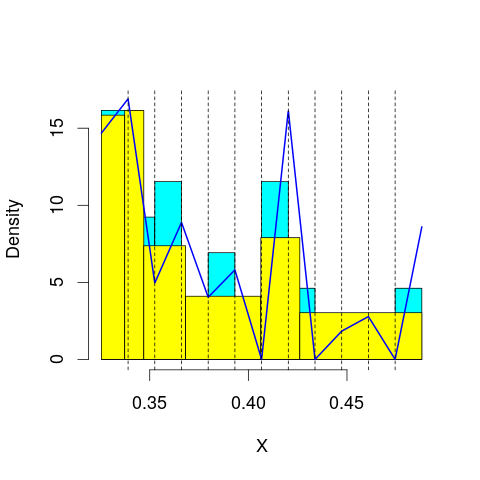

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.76308
mop.approx: Iteration 11. LL = 67.27723
mop.approx: Iteration 21. LL = 67.4312
mop.approx: Iteration 31. LL = 67.46359
mop.approx: Iteration 41. LL = 67.47478
mop.approx: Iteration 51. LL = 67.47953
mop.approx: Iteration 61. LL = 67.48176
mop.approx: Iteration 71. LL = 67.48287
mop.approx: Converged. Iteration 73. LL = 67.48308
[1] "Computing the linear combination of B-splines"


43.2229270636
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.56909
mop.approx: Iteration 11. LL = 65.89685
mop.approx: Iteration 21. LL = 65.99429
mop.approx: Iteration 31. LL = 66.00966
mop.approx: Iteration 41. LL = 66.01244
mop.approx: Converged. Iteration 44. LL = 66.01275
[1] "Computing the linear combination of B-splines"


40.0197306698
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.41401
mop.approx: Iteration 11. LL = 58.15805
mop.approx: Iteration 21. LL = 58.24186
mop.approx: Iteration 31. LL = 58.25378
mop.approx: Iteration 41. LL = 58.25748
mop.approx: Iteration 51. LL = 58.25917
mop.approx: Iteration 61. LL = 58.26006
mop.approx: Converged. Iteration 63. LL = 58.26025
[1] "Computing the linear combination of B-splines"


30.5343588095
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.17751
mop.approx: Iteration 11. LL = 58.73932
mop.approx: Iteration 21. LL = 58.89673
mop.approx: Iteration 31. LL = 58.92692
mop.approx: Iteration 41. LL = 58.93814
mop.approx: Iteration 51. LL = 58.94352
mop.approx: Iteration 61. LL = 58.94642
mop.approx: Iteration 71. LL = 58.94808
mop.approx: Iteration 81. LL = 58.94907
mop.approx: Converged. Iteration 86. LL = 58.94947
[1] "Computing the linear combination of B-splines"


29.4907165987
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.678626
mop.approx: Iteration 11. LL = 57.11432
mop.approx: Iteration 21. LL = 57.5748
mop.approx: Iteration 31. LL = 57.63491
mop.approx: Iteration 41. LL = 57.64417
mop.approx: Iteration 51. LL = 57.64608
mop.approx: Converged. Iteration 55. LL = 57.64642
[1] "Computing the linear combination of B-splines"


26.4547962223
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.73498
mop.approx: Iteration 11. LL = 55.21549
mop.approx: Iteration 21. LL = 55.31823
mop.approx: Iteration 31. LL = 55.34934
mop.approx: Iteration 41. LL = 55.37072
mop.approx: Iteration 51. LL = 55.38618
mop.approx: Iteration 61. LL = 55.3971
mop.approx: Iteration 71. LL = 55.4047
mop.approx: Iteration 81. LL = 55.40995
mop.approx: Iteration 91. LL = 55.41357
mop.approx: Iteration 101. LL = 55.41606
mop.approx: Iteration 111. LL = 55.41779
mop.approx: Iteration 121. LL = 55.41899
mop.approx: Iteration 131. LL = 55.41983
mop.approx: Converged. Iteration 138. LL = 55.42032
[1] "Computing the linear combination of B-splines"


22.4958358714
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.224455
mop.approx: Iteration 11. LL = 55.57923
mop.approx: Iteration 21. LL = 55.68028
mop.approx: Iteration 31. LL = 55.71243
mop.approx: Iteration 41. LL = 55.72478
mop.approx: Iteration 51. LL = 55.72976
mop.approx: Iteration 61. LL = 55.73193
mop.approx: Iteration 71. LL = 55.73299
mop.approx: Converged. Iteration 77. LL = 55.73343
[1] "Computing the linear combination of B-splines"


21.0760110752
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.95825
mop.approx: Iteration 11. LL = 69.83195
mop.approx: Iteration 21. LL = 69.89231
mop.approx: Iteration 31. LL = 69.89961
mop.approx: Iteration 41. LL = 69.90131
mop.approx: Converged. Iteration 42. LL = 69.90145
[1] "Computing the linear combination of B-splines"


45.6413020463
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 45.641302046316476)
m reached
('Sum of Probabilities:', 0.9886861306435348)
chosen


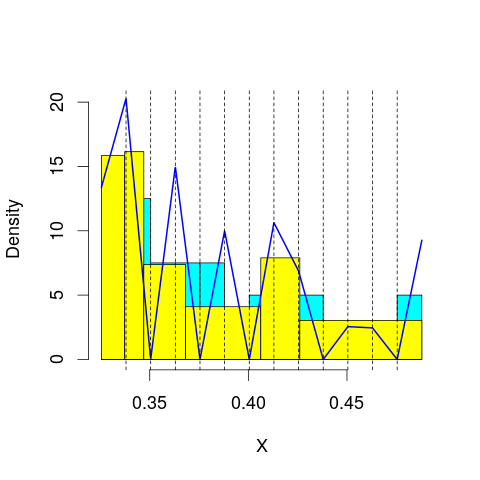

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.76308
mop.approx: Iteration 11. LL = 67.20897
mop.approx: Iteration 21. LL = 67.33179
mop.approx: Iteration 31. LL = 67.3404
mop.approx: Converged. Iteration 38. LL = 67.34135
[1] "Computing the linear combination of B-splines"


41.3483342559
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.56909
mop.approx: Iteration 11. LL = 66.65306
mop.approx: Iteration 21. LL = 66.83172
mop.approx: Iteration 31. LL = 66.86291
mop.approx: Iteration 41. LL = 66.87084
mop.approx: Iteration 51. LL = 66.87334
mop.approx: Converged. Iteration 58. LL = 66.87411
[1] "Computing the linear combination of B-splines"


39.1482262485
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.41401
mop.approx: Iteration 11. LL = 58.73748
mop.approx: Iteration 21. LL = 58.84639
mop.approx: Iteration 31. LL = 58.86375
mop.approx: Iteration 41. LL = 58.86752
mop.approx: Converged. Iteration 49. LL = 58.86839
[1] "Computing the linear combination of B-splines"


29.4096398158
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.17751
mop.approx: Iteration 11. LL = 58.80001
mop.approx: Iteration 21. LL = 58.8621
mop.approx: Iteration 31. LL = 58.86711
mop.approx: Iteration 41. LL = 58.86847
mop.approx: Converged. Iteration 48. LL = 58.86904
[1] "Computing the linear combination of B-splines"


27.6774173635
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.678626
mop.approx: Iteration 11. LL = 58.51567
mop.approx: Iteration 21. LL = 58.90393
mop.approx: Iteration 31. LL = 58.93774
mop.approx: Iteration 41. LL = 58.94389
mop.approx: Iteration 51. LL = 58.94588
mop.approx: Converged. Iteration 59. LL = 58.94663
[1] "Computing the linear combination of B-splines"


26.022141372
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.73498
mop.approx: Iteration 11. LL = 55.83119
mop.approx: Iteration 21. LL = 56.0778
mop.approx: Iteration 31. LL = 56.12738
mop.approx: Iteration 41. LL = 56.13645
mop.approx: Iteration 51. LL = 56.13806
mop.approx: Converged. Iteration 51. LL = 56.13811
[1] "Computing the linear combination of B-splines"


21.4807442189
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.224455
mop.approx: Iteration 11. LL = 55.87522
mop.approx: Iteration 21. LL = 56.00138
mop.approx: Iteration 31. LL = 56.03108
mop.approx: Iteration 41. LL = 56.04104
mop.approx: Iteration 51. LL = 56.04555
mop.approx: Iteration 61. LL = 56.04799
mop.approx: Iteration 71. LL = 56.04945
mop.approx: Iteration 81. LL = 56.05037
mop.approx: Converged. Iteration 88. LL = 56.05088
[1] "Computing the linear combination of B-splines"


19.6605362737
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.95825
mop.approx: Iteration 11. LL = 69.45836
mop.approx: Iteration 21. LL = 69.4995
mop.approx: Converged. Iteration 26. LL = 69.50053
[1] "Computing the linear combination of B-splines"


43.5075075195
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 43.507507519512856)
m reached
('Sum of Probabilities:', 0.9886479934902492)
chosen


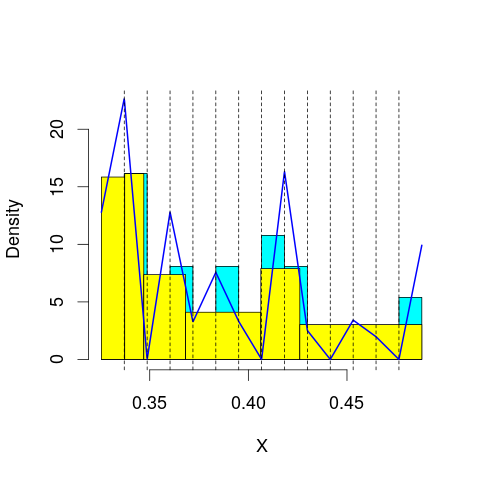

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.76308
mop.approx: Iteration 11. LL = 67.47701
mop.approx: Iteration 21. LL = 67.52482
mop.approx: Converged. Iteration 29. LL = 67.52701
[1] "Computing the linear combination of B-splines"


39.8011245698
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.56909
mop.approx: Iteration 11. LL = 67.6409
mop.approx: Iteration 21. LL = 67.87023
mop.approx: Iteration 31. LL = 67.89506
mop.approx: Iteration 41. LL = 67.89872
mop.approx: Converged. Iteration 46. LL = 67.89927
[1] "Computing the linear combination of B-splines"


38.4405135157
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.41401
mop.approx: Iteration 11. LL = 58.69386
mop.approx: Iteration 21. LL = 58.78282
mop.approx: Iteration 31. LL = 58.80657
mop.approx: Iteration 41. LL = 58.81487
mop.approx: Iteration 51. LL = 58.81789
mop.approx: Iteration 61. LL = 58.81901
mop.approx: Converged. Iteration 62. LL = 58.81912
[1] "Computing the linear combination of B-splines"


27.6275016532
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.17751
mop.approx: Iteration 11. LL = 59.58915
mop.approx: Iteration 21. LL = 59.74766
mop.approx: Iteration 31. LL = 59.77611
mop.approx: Iteration 41. LL = 59.78587
mop.approx: Iteration 51. LL = 59.79041
mop.approx: Iteration 61. LL = 59.79282
mop.approx: Iteration 71. LL = 59.79418
mop.approx: Iteration 81. LL = 59.79497
mop.approx: Converged. Iteration 81. LL = 59.79502
[1] "Computing the linear combination of B-splines"


26.8705331933
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.678626
mop.approx: Iteration 11. LL = 58.83017
mop.approx: Iteration 21. LL = 59.02552
mop.approx: Iteration 31. LL = 59.04205
mop.approx: Iteration 41. LL = 59.04771
mop.approx: Iteration 51. LL = 59.05052
mop.approx: Iteration 61. LL = 59.05199
mop.approx: Converged. Iteration 70. LL = 59.05276
[1] "Computing the linear combination of B-splines"


24.395398266
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.73498
mop.approx: Iteration 11. LL = 57.20109
mop.approx: Iteration 21. LL = 57.60679
mop.approx: Iteration 31. LL = 57.66106
mop.approx: Iteration 41. LL = 57.67359
mop.approx: Iteration 51. LL = 57.67809
mop.approx: Iteration 61. LL = 57.6801
mop.approx: Iteration 71. LL = 57.68112
mop.approx: Converged. Iteration 76. LL = 57.6815
[1] "Computing the linear combination of B-splines"


21.2911432223
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.224455
mop.approx: Iteration 11. LL = 56.00241
mop.approx: Iteration 21. LL = 56.11142
mop.approx: Iteration 31. LL = 56.14247
mop.approx: Iteration 41. LL = 56.15497
mop.approx: Iteration 51. LL = 56.16144
mop.approx: Iteration 61. LL = 56.16519
mop.approx: Iteration 71. LL = 56.16746
mop.approx: Iteration 81. LL = 56.16886
mop.approx: Iteration 91. LL = 56.16973
mop.approx: Converged. Iteration 95. LL = 56.17003
[1] "Computing the linear combination of B-splines"


18.0475885523
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.95825
mop.approx: Iteration 11. LL = 69.11026
mop.approx: Iteration 21. LL = 69.23098
mop.approx: Iteration 31. LL = 69.2468
mop.approx: Iteration 41. LL = 69.25168
mop.approx: Iteration 51. LL = 69.25393
mop.approx: Iteration 61. LL = 69.25511
mop.approx: Converged. Iteration 65. LL = 69.25548
[1] "Computing the linear combination of B-splines"


41.5295964566
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 41.529596456577565)
m reached
('Sum of Probabilities:', 0.988480179244196)
chosen


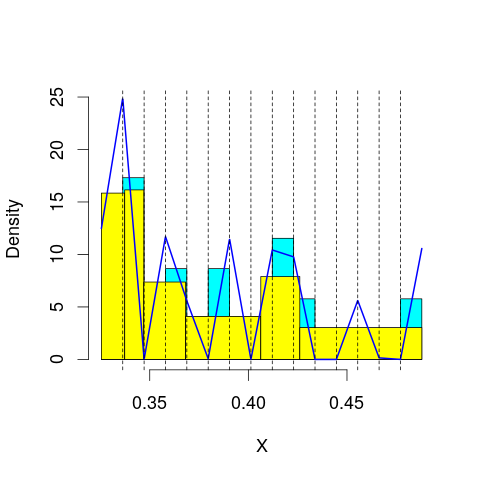

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.76308
mop.approx: Iteration 11. LL = 68.3154
mop.approx: Iteration 21. LL = 68.37057
mop.approx: Iteration 31. LL = 68.37342
mop.approx: Converged. Iteration 31. LL = 68.37348
[1] "Computing the linear combination of B-splines"


38.9147245018
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.56909
mop.approx: Iteration 11. LL = 67.46027
mop.approx: Iteration 21. LL = 67.61835
mop.approx: Iteration 31. LL = 67.63145
mop.approx: Iteration 41. LL = 67.63367
mop.approx: Converged. Iteration 46. LL = 67.63416
[1] "Computing the linear combination of B-splines"


36.4425402514
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.41401
mop.approx: Iteration 11. LL = 59.73591
mop.approx: Iteration 21. LL = 59.89649
mop.approx: Iteration 31. LL = 59.91508
mop.approx: Iteration 41. LL = 59.91905
mop.approx: Iteration 51. LL = 59.9205
mop.approx: Converged. Iteration 58. LL = 59.92109
[1] "Computing the linear combination of B-splines"


26.9965972795
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.17751
mop.approx: Iteration 11. LL = 59.37916
mop.approx: Iteration 21. LL = 59.43014
mop.approx: Iteration 31. LL = 59.43717
mop.approx: Iteration 41. LL = 59.43951
mop.approx: Iteration 51. LL = 59.44061
mop.approx: Converged. Iteration 56. LL = 59.44101
[1] "Computing the linear combination of B-splines"


24.7836486817
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.678626
mop.approx: Iteration 11. LL = 59.69607
mop.approx: Iteration 21. LL = 59.93611
mop.approx: Iteration 31. LL = 59.9721
mop.approx: Iteration 41. LL = 59.98326
mop.approx: Iteration 51. LL = 59.98784
mop.approx: Iteration 61. LL = 59.99003
mop.approx: Iteration 71. LL = 59.99119
mop.approx: Converged. Iteration 77. LL = 59.99168
[1] "Computing the linear combination of B-splines"


23.6014594738
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.73498
mop.approx: Iteration 11. LL = 57.84127
mop.approx: Iteration 21. LL = 58.22366
mop.approx: Iteration 31. LL = 58.28401
mop.approx: Iteration 41. LL = 58.29892
mop.approx: Iteration 51. LL = 58.30335
mop.approx: Iteration 61. LL = 58.30475
mop.approx: Converged. Iteration 63. LL = 58.30494
[1] "Computing the linear combination of B-splines"


20.1818332752
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.224455
mop.approx: Iteration 11. LL = 56.88136
mop.approx: Iteration 21. LL = 57.19669
mop.approx: Iteration 31. LL = 57.25305
mop.approx: Iteration 41. LL = 57.26388
mop.approx: Iteration 51. LL = 57.26632
mop.approx: Converged. Iteration 57. LL = 57.26686
[1] "Computing the linear combination of B-splines"


17.4117895583
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.95825
mop.approx: Iteration 11. LL = 69.91208
mop.approx: Iteration 21. LL = 69.97491
mop.approx: Iteration 31. LL = 69.98595
mop.approx: Iteration 41. LL = 69.98917
mop.approx: Iteration 51. LL = 69.99056
mop.approx: Converged. Iteration 57. LL = 69.99112
[1] "Computing the linear combination of B-splines"


40.5323628614
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 40.532362861401673)
m reached
('Sum of Probabilities:', 0.9885248035061462)
chosen


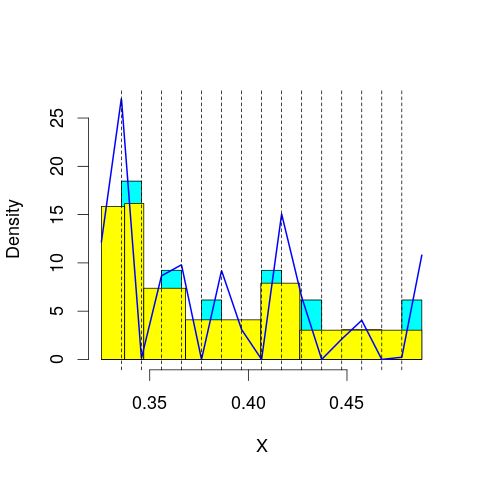

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.76308
mop.approx: Iteration 11. LL = 68.31894
mop.approx: Iteration 21. LL = 68.38355
mop.approx: Iteration 31. LL = 68.38715
mop.approx: Converged. Iteration 31. LL = 68.38721
[1] "Computing the linear combination of B-splines"


37.1955905189
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.56909
mop.approx: Iteration 11. LL = 68.18116
mop.approx: Iteration 21. LL = 68.37343
mop.approx: Iteration 31. LL = 68.39179
mop.approx: Converged. Iteration 40. LL = 68.39384
[1] "Computing the linear combination of B-splines"


35.4693526998
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.41401
mop.approx: Iteration 11. LL = 59.68977
mop.approx: Iteration 21. LL = 59.81905
mop.approx: Iteration 31. LL = 59.84651
mop.approx: Iteration 41. LL = 59.85555
mop.approx: Iteration 51. LL = 59.85911
mop.approx: Iteration 61. LL = 59.86073
mop.approx: Converged. Iteration 70. LL = 59.86153
[1] "Computing the linear combination of B-splines"


25.2041692948
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.17751
mop.approx: Iteration 11. LL = 60.26791
mop.approx: Iteration 21. LL = 60.43858
mop.approx: Iteration 31. LL = 60.45911
mop.approx: Iteration 41. LL = 60.46246
mop.approx: Converged. Iteration 48. LL = 60.46316
[1] "Computing the linear combination of B-splines"


24.0729297823
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.678626
mop.approx: Iteration 11. LL = 59.6269
mop.approx: Iteration 21. LL = 59.71264
mop.approx: Iteration 31. LL = 59.71981
mop.approx: Iteration 41. LL = 59.72295
mop.approx: Iteration 51. LL = 59.72491
mop.approx: Iteration 61. LL = 59.72625
mop.approx: Iteration 71. LL = 59.72719
mop.approx: Converged. Iteration 80. LL = 59.72787
[1] "Computing the linear combination of B-splines"


21.604770457
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.73498
mop.approx: Iteration 11. LL = 58.98337
mop.approx: Iteration 21. LL = 59.51275
mop.approx: Iteration 31. LL = 59.58903
mop.approx: Iteration 41. LL = 59.60613
mop.approx: Iteration 51. LL = 59.61211
mop.approx: Iteration 61. LL = 59.61486
mop.approx: Iteration 71. LL = 59.61633
mop.approx: Iteration 81. LL = 59.6172
mop.approx: Converged. Iteration 84. LL = 59.61744
[1] "Computing the linear combination of B-splines"


19.7613015723
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.224455
mop.approx: Iteration 11. LL = 57.23578
mop.approx: Iteration 21. LL = 57.40111
mop.approx: Iteration 31. LL = 57.41568
mop.approx: Iteration 41. LL = 57.41753
mop.approx: Converged. Iteration 42. LL = 57.41765
[1] "Computing the linear combination of B-splines"


15.8286849635
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.95825
mop.approx: Iteration 11. LL = 68.30033
mop.approx: Converged. Iteration 17. LL = 68.30401
[1] "Computing the linear combination of B-splines"


37.1123864451
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 37.112386445111312)
m reached
('Sum of Probabilities:', 0.988806222939025)
chosen


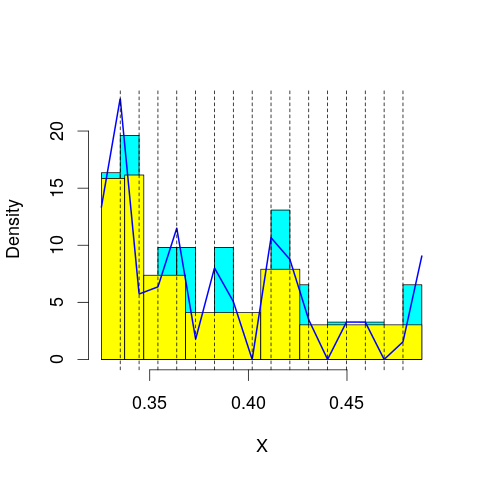

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.76308
mop.approx: Iteration 11. LL = 69.62973
mop.approx: Iteration 21. LL = 69.68433
mop.approx: Iteration 31. LL = 69.69277
mop.approx: Iteration 41. LL = 69.69462
mop.approx: Converged. Iteration 42. LL = 69.69475
[1] "Computing the linear combination of B-splines"


36.7702618625
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.56909
mop.approx: Iteration 11. LL = 67.96139
mop.approx: Iteration 21. LL = 68.16036
mop.approx: Iteration 31. LL = 68.19883
mop.approx: Iteration 41. LL = 68.20968
mop.approx: Iteration 51. LL = 68.21309
mop.approx: Converged. Iteration 60. LL = 68.2142
[1] "Computing the linear combination of B-splines"


33.5568427408
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.41401
mop.approx: Iteration 11. LL = 60.2489
mop.approx: Iteration 21. LL = 60.40058
mop.approx: Iteration 31. LL = 60.42363
mop.approx: Iteration 41. LL = 60.43055
mop.approx: Iteration 51. LL = 60.43359
mop.approx: Iteration 61. LL = 60.4352
mop.approx: Iteration 71. LL = 60.43615
mop.approx: Converged. Iteration 75. LL = 60.43647
[1] "Computing the linear combination of B-splines"


24.0462430206
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.17751
mop.approx: Iteration 11. LL = 60.5681
mop.approx: Iteration 21. LL = 60.72695
mop.approx: Iteration 31. LL = 60.7472
mop.approx: Iteration 41. LL = 60.75302
mop.approx: Iteration 51. LL = 60.7556
mop.approx: Iteration 61. LL = 60.75697
mop.approx: Converged. Iteration 70. LL = 60.75775
[1] "Computing the linear combination of B-splines"


22.6346531492
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.678626
mop.approx: Iteration 11. LL = 60.23265
mop.approx: Iteration 21. LL = 60.40712
mop.approx: Iteration 31. LL = 60.43852
mop.approx: Iteration 41. LL = 60.44663
mop.approx: Iteration 51. LL = 60.44874
mop.approx: Converged. Iteration 55. LL = 60.4491
[1] "Computing the linear combination of B-splines"


20.5931224999
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.73498
mop.approx: Iteration 11. LL = 59.24727
mop.approx: Iteration 21. LL = 59.57059
mop.approx: Iteration 31. LL = 59.60019
mop.approx: Iteration 41. LL = 59.60613
mop.approx: Iteration 51. LL = 59.60821
mop.approx: Iteration 61. LL = 59.60921
mop.approx: Converged. Iteration 64. LL = 59.60946
[1] "Computing the linear combination of B-splines"


18.0203085563
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.224455
mop.approx: Iteration 11. LL = 58.09939
mop.approx: Iteration 21. LL = 58.45236
mop.approx: Iteration 31. LL = 58.50575
mop.approx: Iteration 41. LL = 58.51778
mop.approx: Iteration 51. LL = 58.52158
mop.approx: Iteration 61. LL = 58.52301
mop.approx: Converged. Iteration 65. LL = 58.52336
[1] "Computing the linear combination of B-splines"


15.1939511949
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.95825
mop.approx: Iteration 11. LL = 69.73883
mop.approx: Iteration 21. LL = 69.76609
mop.approx: Converged. Iteration 26. LL = 69.76708
[1] "Computing the linear combination of B-splines"


36.8425882852
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 36.842588285205338)
m reached
('Sum of Probabilities:', 0.9886444493113772)
chosen


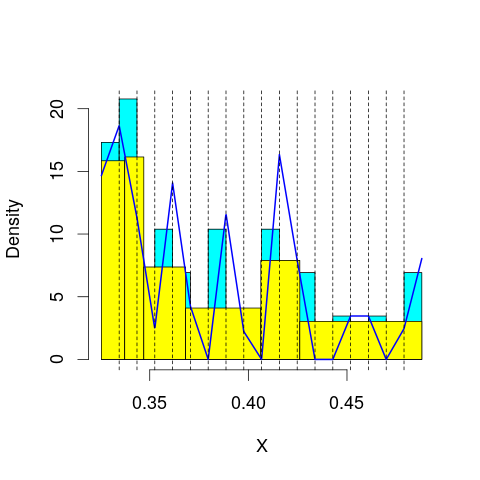

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.76308
mop.approx: Iteration 11. LL = 69.16877
mop.approx: Iteration 21. LL = 69.21154
mop.approx: Iteration 31. LL = 69.21626
mop.approx: Converged. Iteration 36. LL = 69.2169
[1] "Computing the linear combination of B-splines"


34.5595360463
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.56909
mop.approx: Iteration 11. LL = 68.76233
mop.approx: Iteration 21. LL = 68.91541
mop.approx: Iteration 31. LL = 68.94527
mop.approx: Iteration 41. LL = 68.95379
mop.approx: Iteration 51. LL = 68.95695
mop.approx: Iteration 61. LL = 68.95847
mop.approx: Iteration 71. LL = 68.95939
mop.approx: Converged. Iteration 74. LL = 68.95968
[1] "Computing the linear combination of B-splines"


32.569449572
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.41401
mop.approx: Iteration 11. LL = 59.9301
mop.approx: Iteration 21. LL = 60.08864
mop.approx: Iteration 31. LL = 60.12369
mop.approx: Iteration 41. LL = 60.13211
mop.approx: Iteration 51. LL = 60.13427
mop.approx: Converged. Iteration 57. LL = 60.13481
[1] "Computing the linear combination of B-splines"


22.0117170003
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.17751
mop.approx: Iteration 11. LL = 61.34473
mop.approx: Iteration 21. LL = 61.54204
mop.approx: Iteration 31. LL = 61.56951
mop.approx: Iteration 41. LL = 61.57578
mop.approx: Iteration 51. LL = 61.57789
mop.approx: Iteration 61. LL = 61.57883
mop.approx: Converged. Iteration 62. LL = 61.57895
[1] "Computing the linear combination of B-splines"


21.722989447
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.678626
mop.approx: Iteration 11. LL = 60.5574
mop.approx: Iteration 21. LL = 60.76747
mop.approx: Iteration 31. LL = 60.7987
mop.approx: Iteration 41. LL = 60.80741
mop.approx: Iteration 51. LL = 60.8111
mop.approx: Iteration 61. LL = 60.81299
mop.approx: Iteration 71. LL = 60.81408
mop.approx: Converged. Iteration 78. LL = 60.81464
[1] "Computing the linear combination of B-splines"


19.2257813035
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.73498
mop.approx: Iteration 11. LL = 59.71397
mop.approx: Iteration 21. LL = 59.94847
mop.approx: Iteration 31. LL = 59.97148
mop.approx: Iteration 41. LL = 59.98032
mop.approx: Iteration 51. LL = 59.98582
mop.approx: Iteration 61. LL = 59.98964
mop.approx: Iteration 71. LL = 59.99236
mop.approx: Iteration 81. LL = 59.99431
mop.approx: Iteration 91. LL = 59.99572
mop.approx: Iteration 101. LL = 59.99674
mop.approx: Iteration 111. LL = 59.99747
mop.approx: Converged. Iteration 112. LL = 59.99759
[1] "Computing the linear combination of B-splines"


16.675912541
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.224455
mop.approx: Iteration 11. LL = 58.54364
mop.approx: Iteration 21. LL = 58.94783
mop.approx: Iteration 31. LL = 59.03292
mop.approx: Iteration 41. LL = 59.0587
mop.approx: Iteration 51. LL = 59.06821
mop.approx: Iteration 61. LL = 59.07244
mop.approx: Iteration 71. LL = 59.0747
mop.approx: Iteration 81. LL = 59.07607
mop.approx: Iteration 91. LL = 59.07698
mop.approx: Converged. Iteration 98. LL = 59.0775
[1] "Computing the linear combination of B-splines"


14.0239264826
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.95825
mop.approx: Iteration 11. LL = 70.48645
mop.approx: Iteration 21. LL = 70.5077
mop.approx: Iteration 31. LL = 70.51441
mop.approx: Iteration 41. LL = 70.51782
mop.approx: Iteration 51. LL = 70.51947
mop.approx: Converged. Iteration 57. LL = 70.52006
[1] "Computing the linear combination of B-splines"


35.8627049807
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 35.862704980650769)
m reached
('Sum of Probabilities:', 0.9887616523366588)
chosen


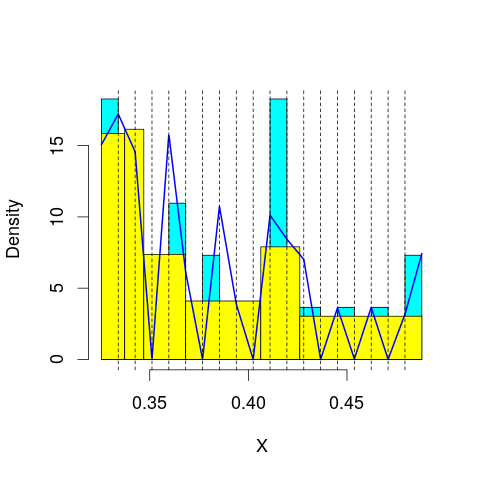

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.76308
mop.approx: Iteration 11. LL = 69.68434
mop.approx: Iteration 21. LL = 69.78708
mop.approx: Iteration 31. LL = 69.8143
mop.approx: Iteration 41. LL = 69.82529
mop.approx: Iteration 51. LL = 69.83039
mop.approx: Iteration 61. LL = 69.83316
mop.approx: Iteration 71. LL = 69.8349
mop.approx: Iteration 81. LL = 69.8361
mop.approx: Iteration 91. LL = 69.83699
mop.approx: Converged. Iteration 95. LL = 69.83735
[1] "Computing the linear combination of B-splines"


33.4471252199
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.56909
mop.approx: Iteration 11. LL = 68.39559
mop.approx: Iteration 21. LL = 68.49818
mop.approx: Iteration 31. LL = 68.51574
mop.approx: Iteration 41. LL = 68.52009
mop.approx: Iteration 51. LL = 68.52136
mop.approx: Converged. Iteration 51. LL = 68.52142
[1] "Computing the linear combination of B-splines"


30.398323579
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.41401
mop.approx: Iteration 11. LL = 60.56592
mop.approx: Iteration 21. LL = 60.70755
mop.approx: Iteration 31. LL = 60.73337
mop.approx: Iteration 41. LL = 60.74123
mop.approx: Iteration 51. LL = 60.74444
mop.approx: Iteration 61. LL = 60.74602
mop.approx: Iteration 71. LL = 60.74689
mop.approx: Converged. Iteration 72. LL = 60.74701
[1] "Computing the linear combination of B-splines"


20.8910464868
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.17751
mop.approx: Iteration 11. LL = 61.39157
mop.approx: Iteration 21. LL = 61.62776
mop.approx: Iteration 31. LL = 61.67357
mop.approx: Iteration 41. LL = 61.68641
mop.approx: Iteration 51. LL = 61.69094
mop.approx: Iteration 61. LL = 61.69288
mop.approx: Iteration 71. LL = 61.69389
mop.approx: Converged. Iteration 75. LL = 61.69422
[1] "Computing the linear combination of B-splines"


20.1053913612
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.678626
mop.approx: Iteration 11. LL = 61.2585
mop.approx: Iteration 21. LL = 61.48491
mop.approx: Iteration 31. LL = 61.52402
mop.approx: Iteration 41. LL = 61.53562
mop.approx: Iteration 51. LL = 61.54012
mop.approx: Iteration 61. LL = 61.54225
mop.approx: Iteration 71. LL = 61.54343
mop.approx: Converged. Iteration 80. LL = 61.54418
[1] "Computing the linear combination of B-splines"


18.2224775302
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.73498
mop.approx: Iteration 11. LL = 60.1099
mop.approx: Iteration 21. LL = 60.44171
mop.approx: Iteration 31. LL = 60.50039
mop.approx: Iteration 41. LL = 60.51581
mop.approx: Iteration 51. LL = 60.52137
mop.approx: Iteration 61. LL = 60.52385
mop.approx: Iteration 71. LL = 60.52508
mop.approx: Converged. Iteration 77. LL = 60.52557
[1] "Computing the linear combination of B-splines"


15.4710310915
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.224455
mop.approx: Iteration 11. LL = 58.8441
mop.approx: Iteration 21. LL = 59.14873
mop.approx: Iteration 31. LL = 59.21295
mop.approx: Iteration 41. LL = 59.23646
mop.approx: Iteration 51. LL = 59.24664
mop.approx: Iteration 61. LL = 59.25126
mop.approx: Iteration 71. LL = 59.25338
mop.approx: Iteration 81. LL = 59.25437
mop.approx: Converged. Iteration 83. LL = 59.25455
[1] "Computing the linear combination of B-splines"


12.4673521089
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.95825
mop.approx: Iteration 11. LL = 71.22188
mop.approx: Iteration 21. LL = 71.30516
mop.approx: Iteration 31. LL = 71.32953
mop.approx: Iteration 41. LL = 71.33776
mop.approx: Iteration 51. LL = 71.34071
mop.approx: Converged. Iteration 60. LL = 71.34182
[1] "Computing the linear combination of B-splines"


34.9515942932
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 34.951594293231892)
m reached
('Sum of Probabilities:', 0.9889625284486325)
chosen


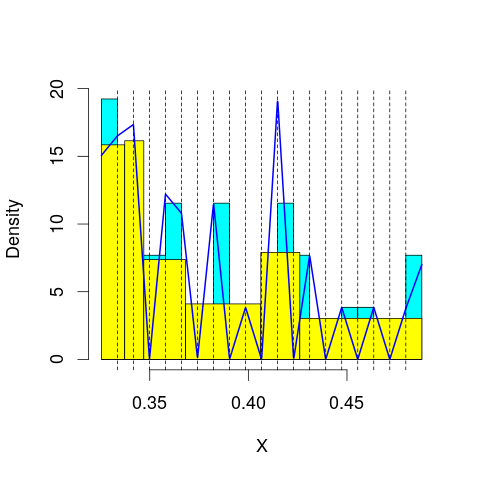

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.76308
mop.approx: Iteration 11. LL = 69.92503
mop.approx: Iteration 21. LL = 69.97592
mop.approx: Converged. Iteration 28. LL = 69.9778
[1] "Computing the linear combination of B-splines"


31.8547032531
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 57.56909
mop.approx: Iteration 11. LL = 68.92779
mop.approx: Iteration 21. LL = 69.03566
mop.approx: Iteration 31. LL = 69.05631
mop.approx: Iteration 41. LL = 69.06205
mop.approx: Iteration 51. LL = 69.06457
mop.approx: Iteration 61. LL = 69.06597
mop.approx: Converged. Iteration 70. LL = 69.06683
[1] "Computing the linear combination of B-splines"


29.2108702334
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.41401
mop.approx: Iteration 11. LL = 60.74155
mop.approx: Iteration 21. LL = 60.85938
mop.approx: Iteration 31. LL = 60.88092
mop.approx: Iteration 41. LL = 60.88715
mop.approx: Iteration 51. LL = 60.88936
mop.approx: Converged. Iteration 60. LL = 60.89023
[1] "Computing the linear combination of B-splines"


19.3014016888
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.17751
mop.approx: Iteration 11. LL = 61.58334
mop.approx: Iteration 21. LL = 61.7199
mop.approx: Iteration 31. LL = 61.74377
mop.approx: Iteration 41. LL = 61.75461
mop.approx: Iteration 51. LL = 61.76125
mop.approx: Iteration 61. LL = 61.76533
mop.approx: Iteration 71. LL = 61.76776
mop.approx: Iteration 81. LL = 61.76916
mop.approx: Converged. Iteration 90. LL = 61.76996
[1] "Computing the linear combination of B-splines"


18.4482569846
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.678626
mop.approx: Iteration 11. LL = 61.79927
mop.approx: Iteration 21. LL = 62.08853
mop.approx: Iteration 31. LL = 62.14771
mop.approx: Iteration 41. LL = 62.16522
mop.approx: Iteration 51. LL = 62.17154
mop.approx: Iteration 61. LL = 62.17416
mop.approx: Iteration 71. LL = 62.1754
mop.approx: Converged. Iteration 77. LL = 62.17591
[1] "Computing the linear combination of B-splines"


17.121377586
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.73498
mop.approx: Iteration 11. LL = 60.50913
mop.approx: Iteration 21. LL = 60.75983
mop.approx: Iteration 31. LL = 60.80083
mop.approx: Iteration 41. LL = 60.81398
mop.approx: Iteration 51. LL = 60.81973
mop.approx: Iteration 61. LL = 60.82264
mop.approx: Iteration 71. LL = 60.82421
mop.approx: Iteration 81. LL = 60.82512
mop.approx: Converged. Iteration 84. LL = 60.82537
[1] "Computing the linear combination of B-splines"


14.0378265709
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.224455
mop.approx: Iteration 11. LL = 59.42277
mop.approx: Iteration 21. LL = 59.87812
mop.approx: Iteration 31. LL = 59.98624
mop.approx: Iteration 41. LL = 60.01923
mop.approx: Iteration 51. LL = 60.03024
mop.approx: Iteration 61. LL = 60.03418
mop.approx: Iteration 71. LL = 60.03574
mop.approx: Converged. Iteration 78. LL = 60.03634
[1] "Computing the linear combination of B-splines"


11.5485578301
lfps_6
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.63716
mop.approx: Converged. Iteration 6. LL = 81.09262
[1] "Computing the linear combination of B-splines"


75.8940173407
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 75.894017340701879)
m reached
('Sum of Probabilities:', 0.9877928589827845)
chosen


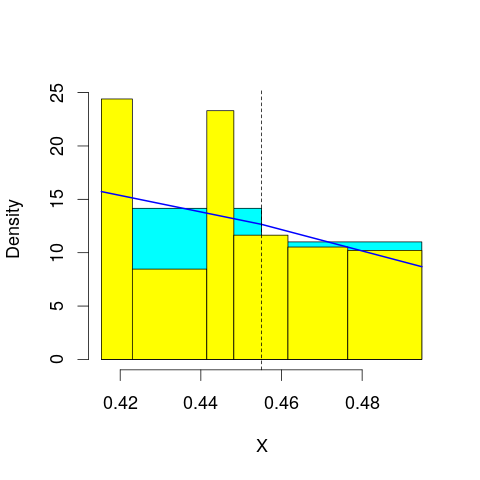

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.24193
mop.approx: Converged. Iteration 6. LL = 80.71237
[1] "Computing the linear combination of B-splines"


73.7808992806
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 79.85152
mop.approx: Iteration 11. LL = 80.50096
mop.approx: Iteration 21. LL = 80.5871
mop.approx: Iteration 31. LL = 80.62991
mop.approx: Iteration 41. LL = 80.65229
mop.approx: Iteration 51. LL = 80.66468
mop.approx: Iteration 61. LL = 80.67191
mop.approx: Iteration 71. LL = 80.67632
mop.approx: Iteration 81. LL = 80.67911
mop.approx: Iteration 91. LL = 80.68093
mop.approx: Iteration 101. LL = 80.68214
mop.approx: Converged. Iteration 106. LL = 80.68267
[1] "Computing the linear combination of B-splines"


72.0183295372
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.52258
mop.approx: Iteration 11. LL = 57.57217
mop.approx: Iteration 21. LL = 57.58812
mop.approx: Converged. Iteration 26. LL = 57.58877
[1] "Computing the linear combination of B-splines"


47.1915605478
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.4607
mop.approx: Iteration 11. LL = 61.68503
mop.approx: Converged. Iteration 16. LL = 61.69035
[1] "Computing the linear combination of B-splines"


49.5602711142
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.3663
mop.approx: Iteration 11. LL = 52.43944
mop.approx: Iteration 21. LL = 52.5213
mop.approx: Iteration 31. LL = 52.54447
mop.approx: Iteration 41. LL = 52.55201
mop.approx: Iteration 51. LL = 52.55469
mop.approx: Iteration 61. LL = 52.55571
mop.approx: Converged. Iteration 63. LL = 52.55587
[1] "Computing the linear combination of B-splines"


38.6929236255
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.972647
mop.approx: Iteration 11. LL = 55.76711
mop.approx: Converged. Iteration 20. LL = 55.79498
[1] "Computing the linear combination of B-splines"


40.1991701131
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.110064
mop.approx: Iteration 11. LL = 48.50062
mop.approx: Iteration 21. LL = 48.60602
mop.approx: Iteration 31. LL = 48.65574
mop.approx: Iteration 41. LL = 48.68122
mop.approx: Iteration 51. LL = 48.69533
mop.approx: Iteration 61. LL = 48.70366
mop.approx: Iteration 71. LL = 48.70885
mop.approx: Iteration 81. LL = 48.71221
mop.approx: Iteration 91. LL = 48.71448
mop.approx: Iteration 101. LL = 48.71604
mop.approx: Iteration 111. LL = 48.71715
mop.approx: Iteration 121. LL = 48.71795
mop.approx: Iteration 131. LL = 48.71854
mop.approx: Converged. Iteration 132. LL = 48.71864
[1] "Computing the linear combination of B-splines"


31.3899571693
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.63716
mop.approx: Converged. Iteration 6. LL = 81.11414
[1] "Computing the linear combination of B-splines"


74.1826643284
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 74.182664328380909)
m reached
('Sum of Probabilities:', 0.9883246567319048)
chosen


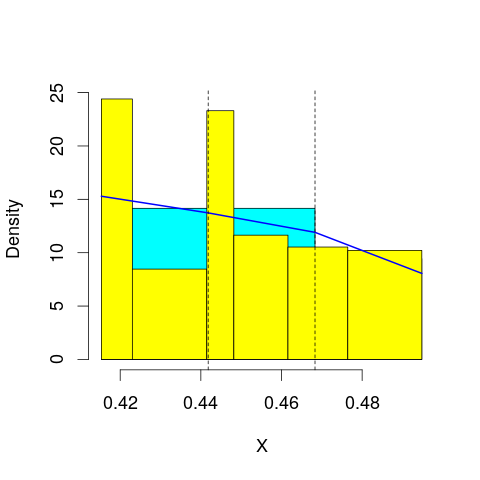

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.24193
mop.approx: Iteration 11. LL = 81.17966
mop.approx: Iteration 21. LL = 81.24032
mop.approx: Iteration 31. LL = 81.25244
mop.approx: Iteration 41. LL = 81.2555
mop.approx: Converged. Iteration 46. LL = 81.25615
[1] "Computing the linear combination of B-splines"


72.5918061886
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 79.85152
mop.approx: Iteration 11. LL = 80.73053
mop.approx: Iteration 21. LL = 80.75866
mop.approx: Iteration 31. LL = 80.76262
mop.approx: Converged. Iteration 35. LL = 80.76316
[1] "Computing the linear combination of B-splines"


70.3659479997
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.52258
mop.approx: Iteration 11. LL = 72.10971
mop.approx: Converged. Iteration 19. LL = 72.12489
[1] "Computing the linear combination of B-splines"


59.9948175929
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.4607
mop.approx: Iteration 11. LL = 62.06956
mop.approx: Converged. Iteration 20. LL = 62.07518
[1] "Computing the linear combination of B-splines"


48.2122354553
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.3663
mop.approx: Iteration 11. LL = 65.08722
mop.approx: Converged. Iteration 18. LL = 65.09979
[1] "Computing the linear combination of B-splines"


49.5039770605
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.972647
mop.approx: Iteration 11. LL = 56.14019
mop.approx: Iteration 21. LL = 56.20296
mop.approx: Iteration 31. LL = 56.21567
mop.approx: Iteration 41. LL = 56.21863
mop.approx: Converged. Iteration 48. LL = 56.2193
[1] "Computing the linear combination of B-splines"


38.8906181389
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.110064
mop.approx: Iteration 11. LL = 58.8398
mop.approx: Iteration 21. LL = 58.87779
mop.approx: Converged. Iteration 21. LL = 58.87782
[1] "Computing the linear combination of B-splines"


39.816273248
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.63716
mop.approx: Iteration 11. LL = 81.46659
mop.approx: Converged. Iteration 15. LL = 81.46798
[1] "Computing the linear combination of B-splines"


72.8036440208
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 72.803644020774996)
m reached
('Sum of Probabilities:', 0.9852402676816951)
chosen


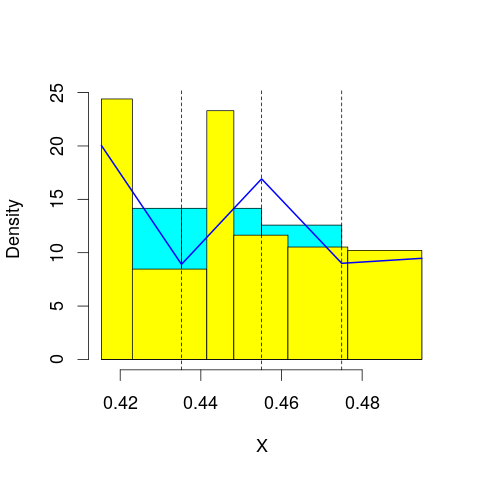

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.24193
mop.approx: Iteration 11. LL = 81.41641
mop.approx: Iteration 21. LL = 81.44548
mop.approx: Iteration 31. LL = 81.45055
mop.approx: Converged. Iteration 40. LL = 81.45189
[1] "Computing the linear combination of B-splines"


71.0546786123
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 79.85152
mop.approx: Iteration 11. LL = 80.74065
mop.approx: Iteration 21. LL = 80.75442
mop.approx: Iteration 31. LL = 80.75718
mop.approx: Converged. Iteration 39. LL = 80.75813
[1] "Computing the linear combination of B-splines"


68.6280567264
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.52258
mop.approx: Iteration 11. LL = 72.47719
mop.approx: Converged. Iteration 13. LL = 72.47772
[1] "Computing the linear combination of B-splines"


58.6147743095
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.4607
mop.approx: Iteration 11. LL = 73.28543
mop.approx: Iteration 21. LL = 73.37465
mop.approx: Converged. Iteration 28. LL = 73.37671
[1] "Computing the linear combination of B-splines"


57.7809034253
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.3663
mop.approx: Iteration 11. LL = 65.47809
mop.approx: Converged. Iteration 16. LL = 65.48009
[1] "Computing the linear combination of B-splines"


48.1514058735
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.972647
mop.approx: Iteration 11. LL = 67.67462
mop.approx: Converged. Iteration 20. LL = 67.70299
[1] "Computing the linear combination of B-splines"


48.6414384515
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.110064
mop.approx: Iteration 11. LL = 59.24419
mop.approx: Iteration 21. LL = 59.28988
mop.approx: Iteration 31. LL = 59.29627
mop.approx: Converged. Iteration 38. LL = 59.29719
[1] "Computing the linear combination of B-splines"


38.5027797522
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.63716
mop.approx: Iteration 11. LL = 82.7434
mop.approx: Iteration 21. LL = 82.76838
mop.approx: Iteration 31. LL = 82.77083
mop.approx: Converged. Iteration 31. LL = 82.77091
[1] "Computing the linear combination of B-splines"


72.373699679
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 72.373699678990434)
m reached
('Sum of Probabilities:', 0.9813026827329907)
chosen


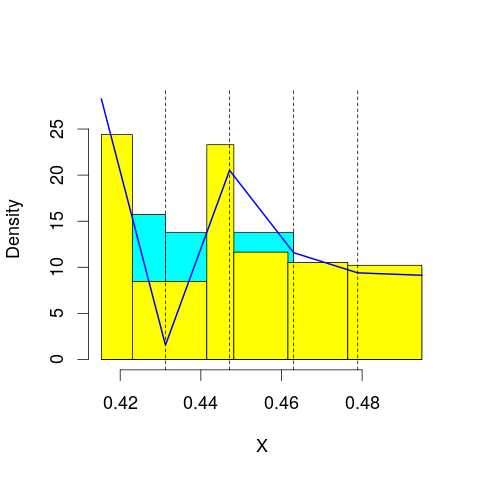

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.24193
mop.approx: Iteration 11. LL = 81.3105
mop.approx: Iteration 21. LL = 81.3295
mop.approx: Iteration 31. LL = 81.33209
mop.approx: Converged. Iteration 32. LL = 81.33225
[1] "Computing the linear combination of B-splines"


69.2021697747
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 79.85152
mop.approx: Iteration 11. LL = 81.32257
mop.approx: Iteration 21. LL = 81.52347
mop.approx: Iteration 31. LL = 81.58638
mop.approx: Iteration 41. LL = 81.60616
mop.approx: Iteration 51. LL = 81.61237
mop.approx: Iteration 61. LL = 81.61432
mop.approx: Converged. Iteration 63. LL = 81.61459
[1] "Computing the linear combination of B-splines"


67.7516422691
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.52258
mop.approx: Iteration 11. LL = 72.57692
mop.approx: Converged. Iteration 12. LL = 72.57703
[1] "Computing the linear combination of B-splines"


56.9812187257
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.4607
mop.approx: Iteration 11. LL = 73.76498
mop.approx: Converged. Iteration 18. LL = 73.77732
[1] "Computing the linear combination of B-splines"


56.4486376989
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.3663
mop.approx: Iteration 11. LL = 73.4794
mop.approx: Iteration 21. LL = 73.66697
mop.approx: Iteration 31. LL = 73.69228
mop.approx: Iteration 41. LL = 73.69833
mop.approx: Iteration 51. LL = 73.69992
mop.approx: Converged. Iteration 51. LL = 73.69999
[1] "Computing the linear combination of B-splines"


54.6384396864
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.972647
mop.approx: Iteration 11. LL = 68.08637
mop.approx: Converged. Iteration 14. LL = 68.08718
[1] "Computing the linear combination of B-splines"


47.2927611271
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.110064
mop.approx: Iteration 11. LL = 69.62879
mop.approx: Iteration 21. LL = 69.6881
mop.approx: Converged. Iteration 23. LL = 69.68837
[1] "Computing the linear combination of B-splines"


47.1610896966
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.63716
mop.approx: Iteration 11. LL = 83.34107
mop.approx: Iteration 21. LL = 83.366
mop.approx: Iteration 31. LL = 83.36873
mop.approx: Converged. Iteration 32. LL = 83.36891
[1] "Computing the linear combination of B-splines"


71.2388372955
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 71.238837295483847)
m reached
('Sum of Probabilities:', 0.9783270053477218)
chosen


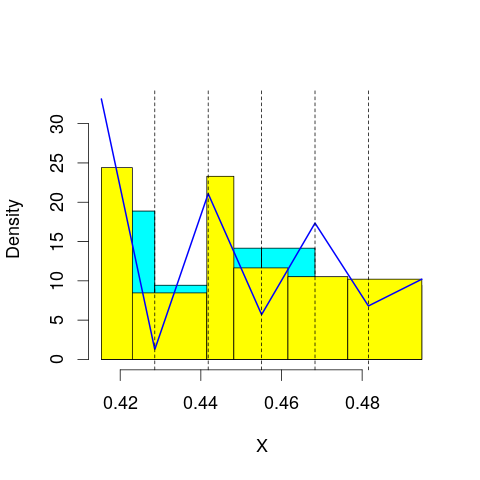

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.24193
mop.approx: Iteration 11. LL = 81.97787
mop.approx: Iteration 21. LL = 82.06995
mop.approx: Iteration 31. LL = 82.08999
mop.approx: Iteration 41. LL = 82.09672
mop.approx: Iteration 51. LL = 82.09961
mop.approx: Iteration 61. LL = 82.10106
mop.approx: Converged. Iteration 65. LL = 82.10151
[1] "Computing the linear combination of B-splines"


68.2385651218
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 79.85152
mop.approx: Iteration 11. LL = 81.89373
mop.approx: Iteration 21. LL = 82.03695
mop.approx: Iteration 31. LL = 82.0553
mop.approx: Iteration 41. LL = 82.05904
mop.approx: Iteration 51. LL = 82.06031
mop.approx: Converged. Iteration 51. LL = 82.06039
[1] "Computing the linear combination of B-splines"


66.4645739104
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.52258
mop.approx: Iteration 11. LL = 72.62457
mop.approx: Converged. Iteration 11. LL = 72.62461
[1] "Computing the linear combination of B-splines"


55.2959312615
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.4607
mop.approx: Iteration 11. LL = 73.84638
mop.approx: Converged. Iteration 17. LL = 73.85202
[1] "Computing the linear combination of B-splines"


54.7904712157
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.3663
mop.approx: Iteration 11. LL = 74.04387
mop.approx: Iteration 21. LL = 74.13887
mop.approx: Converged. Iteration 28. LL = 74.14108
[1] "Computing the linear combination of B-splines"


53.3466587888
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.972647
mop.approx: Iteration 11. LL = 73.19647
mop.approx: Iteration 21. LL = 73.38853
mop.approx: Iteration 31. LL = 73.40235
mop.approx: Converged. Iteration 39. LL = 73.40372
[1] "Computing the linear combination of B-splines"


50.8764385215
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.110064
mop.approx: Iteration 11. LL = 70.07768
mop.approx: Converged. Iteration 13. LL = 70.07829
[1] "Computing the linear combination of B-splines"


45.8181274851
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.63716
mop.approx: Iteration 11. LL = 81.89719
mop.approx: Converged. Iteration 11. LL = 81.89724
[1] "Computing the linear combination of B-splines"


68.034291552
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 68.03429155203527)
m reached
('Sum of Probabilities:', 0.9821378137633084)
chosen


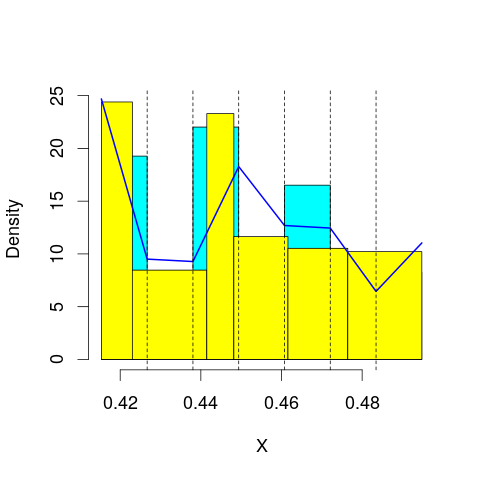

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.24193
mop.approx: Iteration 11. LL = 83.50626
mop.approx: Iteration 21. LL = 83.58705
mop.approx: Iteration 31. LL = 83.59376
mop.approx: Converged. Iteration 35. LL = 83.59438
[1] "Computing the linear combination of B-splines"


67.9985657982
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 79.85152
mop.approx: Iteration 11. LL = 81.85455
mop.approx: Iteration 21. LL = 81.96698
mop.approx: Iteration 31. LL = 81.98962
mop.approx: Iteration 41. LL = 81.99576
mop.approx: Iteration 51. LL = 81.99754
mop.approx: Converged. Iteration 52. LL = 81.9977
[1] "Computing the linear combination of B-splines"


64.6690168966
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.52258
mop.approx: Iteration 11. LL = 73.12439
mop.approx: Iteration 21. LL = 73.19118
mop.approx: Iteration 31. LL = 73.21088
mop.approx: Iteration 41. LL = 73.21907
mop.approx: Iteration 51. LL = 73.22323
mop.approx: Iteration 61. LL = 73.22563
mop.approx: Iteration 71. LL = 73.22715
mop.approx: Iteration 81. LL = 73.22817
mop.approx: Converged. Iteration 85. LL = 73.22856
[1] "Computing the linear combination of B-splines"


54.1670089127
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.4607
mop.approx: Iteration 11. LL = 73.8297
mop.approx: Converged. Iteration 14. LL = 73.83065
[1] "Computing the linear combination of B-splines"


53.0362351677
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.3663
mop.approx: Iteration 11. LL = 74.6735
mop.approx: Iteration 21. LL = 74.74169
mop.approx: Iteration 31. LL = 74.74461
mop.approx: Converged. Iteration 31. LL = 74.74468
[1] "Computing the linear combination of B-splines"


52.2173972273
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.972647
mop.approx: Iteration 11. LL = 73.58368
mop.approx: Iteration 21. LL = 73.77783
mop.approx: Iteration 31. LL = 73.8116
mop.approx: Iteration 41. LL = 73.82074
mop.approx: Iteration 51. LL = 73.82367
mop.approx: Converged. Iteration 58. LL = 73.82455
[1] "Computing the linear combination of B-splines"


49.5644189439
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.110064
mop.approx: Iteration 11. LL = 72.88606
mop.approx: Iteration 21. LL = 73.01322
mop.approx: Iteration 31. LL = 73.03658
mop.approx: Iteration 41. LL = 73.04453
mop.approx: Iteration 51. LL = 73.04811
mop.approx: Iteration 61. LL = 73.04998
mop.approx: Iteration 71. LL = 73.05104
mop.approx: Converged. Iteration 73. LL = 73.05126
[1] "Computing the linear combination of B-splines"


47.0585167182
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.63716
mop.approx: Iteration 11. LL = 84.20073
mop.approx: Iteration 21. LL = 84.25722
mop.approx: Iteration 31. LL = 84.26832
mop.approx: Iteration 41. LL = 84.27133
mop.approx: Converged. Iteration 46. LL = 84.27198
[1] "Computing the linear combination of B-splines"


68.6761723675
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 68.676172367526988)
m reached
('Sum of Probabilities:', 0.9837897361307272)
chosen


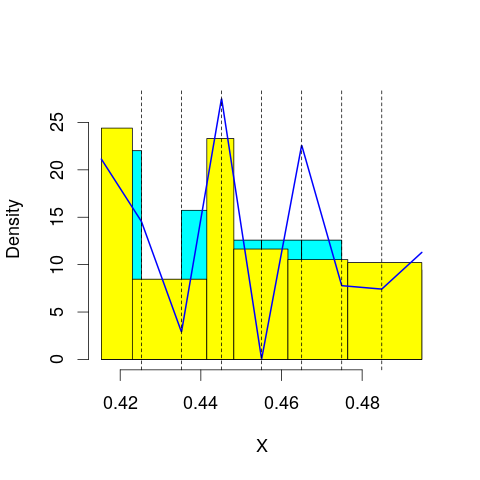

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.24193
mop.approx: Iteration 11. LL = 83.04372
mop.approx: Iteration 21. LL = 83.10937
mop.approx: Iteration 31. LL = 83.11664
mop.approx: Iteration 41. LL = 83.11831
mop.approx: Converged. Iteration 41. LL = 83.11839
[1] "Computing the linear combination of B-splines"


65.7897130831
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 79.85152
mop.approx: Iteration 11. LL = 82.99099
mop.approx: Iteration 21. LL = 83.21196
mop.approx: Iteration 31. LL = 83.26302
mop.approx: Iteration 41. LL = 83.27591
mop.approx: Iteration 51. LL = 83.27926
mop.approx: Converged. Iteration 56. LL = 83.27992
[1] "Computing the linear combination of B-splines"


64.2183719347
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.52258
mop.approx: Iteration 11. LL = 73.08534
mop.approx: Iteration 21. LL = 73.10883
mop.approx: Iteration 31. LL = 73.11535
mop.approx: Iteration 41. LL = 73.11747
mop.approx: Converged. Iteration 46. LL = 73.118
[1] "Computing the linear combination of B-splines"


52.3235799571
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.4607
mop.approx: Iteration 11. LL = 74.19048
mop.approx: Iteration 21. LL = 74.26921
mop.approx: Iteration 31. LL = 74.29724
mop.approx: Iteration 41. LL = 74.30991
mop.approx: Iteration 51. LL = 74.31643
mop.approx: Iteration 61. LL = 74.32005
mop.approx: Iteration 71. LL = 74.32215
mop.approx: Iteration 81. LL = 74.3234
mop.approx: Converged. Iteration 86. LL = 74.32389
[1] "Computing the linear combination of B-splines"


51.7966105701
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.3663
mop.approx: Iteration 11. LL = 74.68134
mop.approx: Converged. Iteration 19. LL = 74.69411
[1] "Computing the linear combination of B-splines"


50.433958523
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.972647
mop.approx: Iteration 11. LL = 74.91734
mop.approx: Iteration 21. LL = 75.19873
mop.approx: Iteration 31. LL = 75.23101
mop.approx: Iteration 41. LL = 75.24099
mop.approx: Iteration 51. LL = 75.24554
mop.approx: Iteration 61. LL = 75.24794
mop.approx: Iteration 71. LL = 75.2493
mop.approx: Converged. Iteration 77. LL = 75.2499
[1] "Computing the linear combination of B-splines"


49.2564161284
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.110064
mop.approx: Iteration 11. LL = 73.07729
mop.approx: Iteration 21. LL = 73.15925
mop.approx: Iteration 31. LL = 73.1743
mop.approx: Iteration 41. LL = 73.17984
mop.approx: Iteration 51. LL = 73.18261
mop.approx: Iteration 61. LL = 73.18418
mop.approx: Iteration 71. LL = 73.18515
mop.approx: Converged. Iteration 72. LL = 73.18529
[1] "Computing the linear combination of B-splines"


45.4580031909
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.63716
mop.approx: Iteration 11. LL = 84.03979
mop.approx: Iteration 21. LL = 84.04887
mop.approx: Iteration 31. LL = 84.05075
mop.approx: Converged. Iteration 33. LL = 84.05103
[1] "Computing the linear combination of B-splines"


66.7223456228
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 66.722345622831696)
m reached
('Sum of Probabilities:', 0.984196997954185)
chosen


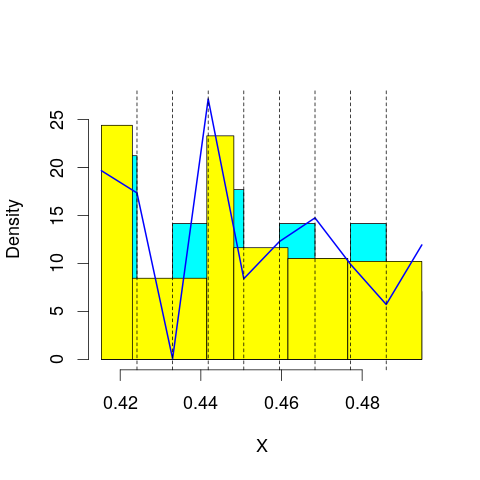

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.24193
mop.approx: Iteration 11. LL = 84.49595
mop.approx: Iteration 21. LL = 84.64195
mop.approx: Iteration 31. LL = 84.65935
mop.approx: Iteration 41. LL = 84.66426
mop.approx: Iteration 51. LL = 84.66652
mop.approx: Iteration 61. LL = 84.66773
mop.approx: Converged. Iteration 62. LL = 84.6679
[1] "Computing the linear combination of B-splines"


65.6063565538
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 79.85152
mop.approx: Iteration 11. LL = 82.88938
mop.approx: Iteration 21. LL = 82.95385
mop.approx: Iteration 31. LL = 82.96103
mop.approx: Converged. Iteration 37. LL = 82.96203
[1] "Computing the linear combination of B-splines"


62.1676168062
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.52258
mop.approx: Iteration 11. LL = 73.99177
mop.approx: Iteration 21. LL = 74.16929
mop.approx: Iteration 31. LL = 74.21146
mop.approx: Iteration 41. LL = 74.22299
mop.approx: Iteration 51. LL = 74.22693
mop.approx: Iteration 61. LL = 74.22867
mop.approx: Converged. Iteration 70. LL = 74.22961
[1] "Computing the linear combination of B-splines"


51.7023224129
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.4607
mop.approx: Iteration 11. LL = 74.15811
mop.approx: Iteration 21. LL = 74.16834
mop.approx: Iteration 31. LL = 74.17045
mop.approx: Converged. Iteration 39. LL = 74.17135
[1] "Computing the linear combination of B-splines"


49.9111934333
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.3663
mop.approx: Iteration 11. LL = 74.89097
mop.approx: Iteration 21. LL = 74.96721
mop.approx: Iteration 31. LL = 74.9951
mop.approx: Iteration 41. LL = 75.0076
mop.approx: Iteration 51. LL = 75.01362
mop.approx: Iteration 61. LL = 75.01662
mop.approx: Iteration 71. LL = 75.01814
mop.approx: Converged. Iteration 76. LL = 75.01867
[1] "Computing the linear combination of B-splines"


49.0256367
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.972647
mop.approx: Iteration 11. LL = 75.14237
mop.approx: Iteration 21. LL = 75.22686
mop.approx: Iteration 31. LL = 75.22965
mop.approx: Converged. Iteration 34. LL = 75.23
[1] "Computing the linear combination of B-splines"


47.5037362473
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.110064
mop.approx: Iteration 11. LL = 74.68074
mop.approx: Iteration 21. LL = 75.10682
mop.approx: Iteration 31. LL = 75.17362
mop.approx: Iteration 41. LL = 75.18824
mop.approx: Iteration 51. LL = 75.19237
mop.approx: Iteration 61. LL = 75.19372
mop.approx: Converged. Iteration 61. LL = 75.19379
[1] "Computing the linear combination of B-splines"


45.7242235752
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.63716
mop.approx: Iteration 11. LL = 85.54211
mop.approx: Iteration 21. LL = 85.57199
mop.approx: Converged. Iteration 24. LL = 85.57256
[1] "Computing the linear combination of B-splines"


66.5110103229
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 66.511010322873204)
m reached
('Sum of Probabilities:', 0.9842600414253518)
chosen


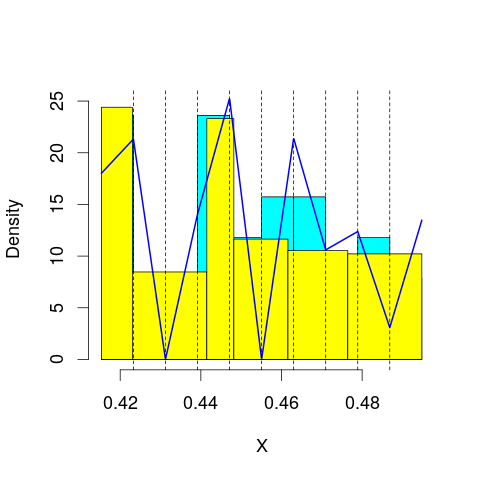

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.24193
mop.approx: Iteration 11. LL = 84.65435
mop.approx: Iteration 21. LL = 84.70566
mop.approx: Iteration 31. LL = 84.71257
mop.approx: Iteration 41. LL = 84.71467
mop.approx: Converged. Iteration 46. LL = 84.71528
[1] "Computing the linear combination of B-splines"


63.9208658026
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 79.85152
mop.approx: Iteration 11. LL = 83.67579
mop.approx: Iteration 21. LL = 83.84776
mop.approx: Iteration 31. LL = 83.87368
mop.approx: Iteration 41. LL = 83.88213
mop.approx: Iteration 51. LL = 83.8862
mop.approx: Iteration 61. LL = 83.88851
mop.approx: Iteration 71. LL = 83.88994
mop.approx: Converged. Iteration 79. LL = 83.8908
[1] "Computing the linear combination of B-splines"


61.3635182801
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.52258
mop.approx: Iteration 11. LL = 74.50767
mop.approx: Iteration 21. LL = 74.63123
mop.approx: Iteration 31. LL = 74.65677
mop.approx: Iteration 41. LL = 74.66577
mop.approx: Iteration 51. LL = 74.66981
mop.approx: Iteration 61. LL = 74.6718
mop.approx: Iteration 71. LL = 74.67284
mop.approx: Converged. Iteration 71. LL = 74.67291
[1] "Computing the linear combination of B-splines"


50.4127558499
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.4607
mop.approx: Iteration 11. LL = 74.72185
mop.approx: Iteration 21. LL = 74.89581
mop.approx: Iteration 31. LL = 74.93525
mop.approx: Iteration 41. LL = 74.94472
mop.approx: Iteration 51. LL = 74.94778
mop.approx: Iteration 61. LL = 74.94914
mop.approx: Converged. Iteration 66. LL = 74.94964
[1] "Computing the linear combination of B-splines"


48.9566172953
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.3663
mop.approx: Iteration 11. LL = 74.92935
mop.approx: Iteration 21. LL = 74.94807
mop.approx: Iteration 31. LL = 74.94989
mop.approx: Converged. Iteration 31. LL = 74.94996
[1] "Computing the linear combination of B-splines"


47.2240756098
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.972647
mop.approx: Iteration 11. LL = 75.25589
mop.approx: Iteration 21. LL = 75.35031
mop.approx: Iteration 31. LL = 75.37359
mop.approx: Iteration 41. LL = 75.38452
mop.approx: Iteration 51. LL = 75.38989
mop.approx: Iteration 61. LL = 75.39258
mop.approx: Iteration 71. LL = 75.39393
mop.approx: Converged. Iteration 74. LL = 75.39426
[1] "Computing the linear combination of B-splines"


45.9337213685
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.110064
mop.approx: Iteration 11. LL = 75.17658
mop.approx: Iteration 21. LL = 75.44248
mop.approx: Iteration 31. LL = 75.46897
mop.approx: Iteration 41. LL = 75.47566
mop.approx: Iteration 51. LL = 75.47885
mop.approx: Iteration 61. LL = 75.48072
mop.approx: Iteration 71. LL = 75.48191
mop.approx: Converged. Iteration 77. LL = 75.48251
[1] "Computing the linear combination of B-splines"


44.2671980983
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.63716
mop.approx: Iteration 11. LL = 86.27005
mop.approx: Iteration 21. LL = 86.35631
mop.approx: Iteration 31. LL = 86.37556
mop.approx: Iteration 41. LL = 86.38178
mop.approx: Iteration 51. LL = 86.38419
mop.approx: Converged. Iteration 58. LL = 86.38506
[1] "Computing the linear combination of B-splines"


65.5906429564
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 65.590642956426223)
m reached
('Sum of Probabilities:', 0.9839186295425677)
chosen


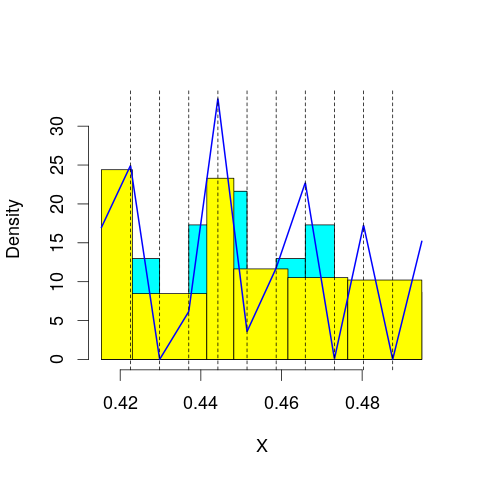

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.24193
mop.approx: Iteration 11. LL = 84.63065
mop.approx: Iteration 21. LL = 84.67522
mop.approx: Converged. Iteration 28. LL = 84.67719
[1] "Computing the linear combination of B-splines"


62.1499076431
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 79.85152
mop.approx: Iteration 11. LL = 84.87532
mop.approx: Iteration 21. LL = 85.16134
mop.approx: Iteration 31. LL = 85.22365
mop.approx: Iteration 41. LL = 85.23949
mop.approx: Iteration 51. LL = 85.24394
mop.approx: Iteration 61. LL = 85.24536
mop.approx: Converged. Iteration 61. LL = 85.24544
[1] "Computing the linear combination of B-splines"


60.9852898659
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.52258
mop.approx: Iteration 11. LL = 74.62472
mop.approx: Iteration 21. LL = 74.73332
mop.approx: Iteration 31. LL = 74.744
mop.approx: Converged. Iteration 36. LL = 74.74485
[1] "Computing the linear combination of B-splines"


48.7518313796
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.4607
mop.approx: Iteration 11. LL = 75.63564
mop.approx: Iteration 21. LL = 75.80358
mop.approx: Iteration 31. LL = 75.8286
mop.approx: Iteration 41. LL = 75.83399
mop.approx: Converged. Iteration 50. LL = 75.83539
[1] "Computing the linear combination of B-splines"


48.1095059225
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.3663
mop.approx: Iteration 11. LL = 75.1688
mop.approx: Iteration 21. LL = 75.2978
mop.approx: Iteration 31. LL = 75.32815
mop.approx: Iteration 41. LL = 75.3341
mop.approx: Converged. Iteration 48. LL = 75.33513
[1] "Computing the linear combination of B-splines"


45.8763042511
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.972647
mop.approx: Iteration 11. LL = 75.33703
mop.approx: Iteration 21. LL = 75.39466
mop.approx: Iteration 31. LL = 75.40299
mop.approx: Iteration 41. LL = 75.40692
mop.approx: Iteration 51. LL = 75.40951
mop.approx: Iteration 61. LL = 75.41144
mop.approx: Iteration 71. LL = 75.41293
mop.approx: Iteration 81. LL = 75.41411
mop.approx: Iteration 91. LL = 75.41504
mop.approx: Converged. Iteration 96. LL = 75.41551
[1] "Computing the linear combination of B-splines"


44.2155218199
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.110064
mop.approx: Iteration 11. LL = 75.40056
mop.approx: Iteration 21. LL = 75.5679
mop.approx: Iteration 31. LL = 75.5808
mop.approx: Iteration 41. LL = 75.58501
mop.approx: Iteration 51. LL = 75.58789
mop.approx: Iteration 61. LL = 75.59008
mop.approx: Iteration 71. LL = 75.59178
mop.approx: Iteration 81. LL = 75.59311
mop.approx: Iteration 91. LL = 75.59417
mop.approx: Iteration 101. LL = 75.59501
mop.approx: Converged. Iteration 101. LL = 75.59509
[1] "Computing the linear combination of B-splines"


42.6217007414
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.63716
mop.approx: Iteration 11. LL = 87.68106
mop.approx: Iteration 21. LL = 87.72687
mop.approx: Iteration 31. LL = 87.72993
mop.approx: Converged. Iteration 31. LL = 87.73
[1] "Computing the linear combination of B-splines"


65.2027190924
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 65.202719092372035)
m reached
('Sum of Probabilities:', 0.9831069084251961)
chosen


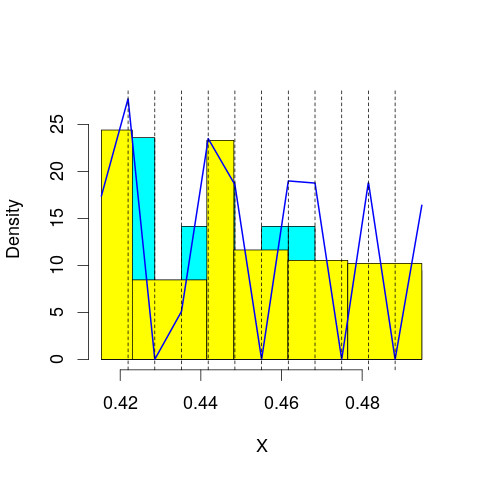

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.24193
mop.approx: Iteration 11. LL = 85.17871
mop.approx: Iteration 21. LL = 85.22334
mop.approx: Iteration 31. LL = 85.2281
mop.approx: Converged. Iteration 39. LL = 85.22925
[1] "Computing the linear combination of B-splines"


60.96909369
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 79.85152
mop.approx: Iteration 11. LL = 85.21481
mop.approx: Iteration 21. LL = 85.40872
mop.approx: Iteration 31. LL = 85.43348
mop.approx: Iteration 41. LL = 85.43907
mop.approx: Iteration 51. LL = 85.44077
mop.approx: Converged. Iteration 52. LL = 85.44093
[1] "Computing the linear combination of B-splines"


59.4479143398
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.52258
mop.approx: Iteration 11. LL = 75.39657
mop.approx: Iteration 21. LL = 75.57208
mop.approx: Iteration 31. LL = 75.62686
mop.approx: Iteration 41. LL = 75.65064
mop.approx: Iteration 51. LL = 75.66171
mop.approx: Iteration 61. LL = 75.66708
mop.approx: Iteration 71. LL = 75.66985
mop.approx: Iteration 81. LL = 75.67141
mop.approx: Iteration 91. LL = 75.67238
mop.approx: Converged. Iteration 92. LL = 75.67253
[1] "Computing the linear combination of B-splines"


47.9466427172
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.4607
mop.approx: Iteration 11. LL = 75.76728
mop.approx: Iteration 21. LL = 75.85423
mop.approx: Iteration 31. LL = 75.86422
mop.approx: Converged. Iteration 38. LL = 75.86548
[1] "Computing the linear combination of B-splines"


46.4067106433
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.3663
mop.approx: Iteration 11. LL = 76.18164
mop.approx: Iteration 21. LL = 76.45326
mop.approx: Iteration 31. LL = 76.51379
mop.approx: Iteration 41. LL = 76.53565
mop.approx: Iteration 51. LL = 76.54672
mop.approx: Iteration 61. LL = 76.55326
mop.approx: Iteration 71. LL = 76.55742
mop.approx: Iteration 81. LL = 76.56017
mop.approx: Iteration 91. LL = 76.56202
mop.approx: Iteration 101. LL = 76.56329
mop.approx: Converged. Iteration 109. LL = 76.56409
[1] "Computing the linear combination of B-splines"


45.3723401527
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.972647
mop.approx: Iteration 11. LL = 75.46778
mop.approx: Iteration 21. LL = 75.57183
mop.approx: Iteration 31. LL = 75.59636
mop.approx: Iteration 41. LL = 75.60178
mop.approx: Converged. Iteration 48. LL = 75.60277
[1] "Computing the linear combination of B-splines"


42.6719348079
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.110064
mop.approx: Iteration 11. LL = 77.353
mop.approx: Iteration 21. LL = 77.57144
mop.approx: Iteration 31. LL = 77.60701
mop.approx: Iteration 41. LL = 77.61805
mop.approx: Iteration 51. LL = 77.62179
mop.approx: Converged. Iteration 60. LL = 77.62309
[1] "Computing the linear combination of B-splines"


42.7925675648
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.63716
mop.approx: Iteration 11. LL = 86.44452
mop.approx: Iteration 21. LL = 86.47807
mop.approx: Iteration 31. LL = 86.48227
mop.approx: Converged. Iteration 37. LL = 86.48309
[1] "Computing the linear combination of B-splines"


62.2229433778
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 62.222943377783345)
m reached
('Sum of Probabilities:', 0.9820438916248033)
chosen


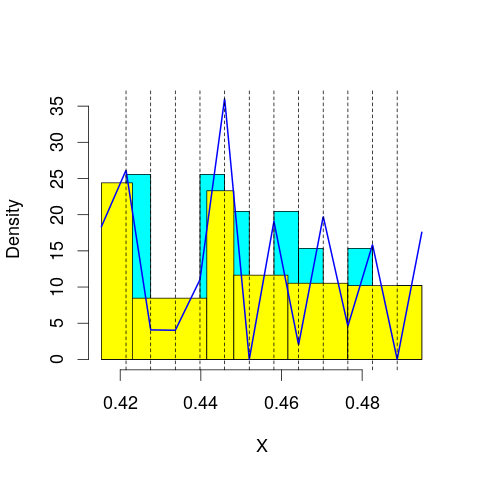

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.24193
mop.approx: Iteration 11. LL = 86.63941
mop.approx: Iteration 21. LL = 86.73834
mop.approx: Iteration 31. LL = 86.75056
mop.approx: Iteration 41. LL = 86.75421
mop.approx: Iteration 51. LL = 86.75582
mop.approx: Converged. Iteration 55. LL = 86.7563
[1] "Computing the linear combination of B-splines"


60.7632823197
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 79.85152
mop.approx: Iteration 11. LL = 85.37483
mop.approx: Iteration 21. LL = 85.4938
mop.approx: Iteration 31. LL = 85.50729
mop.approx: Iteration 41. LL = 85.51052
mop.approx: Converged. Iteration 46. LL = 85.51118
[1] "Computing the linear combination of B-splines"


57.7852924225
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.52258
mop.approx: Iteration 11. LL = 75.64084
mop.approx: Iteration 21. LL = 75.77317
mop.approx: Iteration 31. LL = 75.79935
mop.approx: Iteration 41. LL = 75.80517
mop.approx: Converged. Iteration 50. LL = 75.80653
[1] "Computing the linear combination of B-splines"


46.3477753584
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.4607
mop.approx: Iteration 11. LL = 76.3555
mop.approx: Iteration 21. LL = 76.52067
mop.approx: Iteration 31. LL = 76.57299
mop.approx: Iteration 41. LL = 76.59832
mop.approx: Iteration 51. LL = 76.61182
mop.approx: Iteration 61. LL = 76.61929
mop.approx: Iteration 71. LL = 76.62352
mop.approx: Iteration 81. LL = 76.62595
mop.approx: Iteration 91. LL = 76.62739
mop.approx: Converged. Iteration 99. LL = 76.6282
[1] "Computing the linear combination of B-splines"


45.4365708662
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.3663
mop.approx: Iteration 11. LL = 76.53566
mop.approx: Iteration 21. LL = 76.63192
mop.approx: Iteration 31. LL = 76.641
mop.approx: Converged. Iteration 39. LL = 76.64245
[1] "Computing the linear combination of B-splines"


43.7175808404
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.972647
mop.approx: Iteration 11. LL = 76.26224
mop.approx: Iteration 21. LL = 76.59922
mop.approx: Iteration 31. LL = 76.69614
mop.approx: Iteration 41. LL = 76.73055
mop.approx: Iteration 51. LL = 76.74391
mop.approx: Iteration 61. LL = 76.74932
mop.approx: Iteration 71. LL = 76.75162
mop.approx: Converged. Iteration 80. LL = 76.75267
[1] "Computing the linear combination of B-splines"


42.1051962479
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.110064
mop.approx: Iteration 11. LL = 75.41634
mop.approx: Iteration 21. LL = 75.55465
mop.approx: Iteration 31. LL = 75.58093
mop.approx: Iteration 41. LL = 75.59244
mop.approx: Iteration 51. LL = 75.5976
mop.approx: Iteration 61. LL = 75.59985
mop.approx: Converged. Iteration 68. LL = 75.60068
[1] "Computing the linear combination of B-splines"


37.7741392501
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.63716
mop.approx: Iteration 11. LL = 86.83927
mop.approx: Iteration 21. LL = 86.87745
mop.approx: Iteration 31. LL = 86.89264
mop.approx: Iteration 41. LL = 86.89968
mop.approx: Iteration 51. LL = 86.90321
mop.approx: Iteration 61. LL = 86.90505
mop.approx: Converged. Iteration 68. LL = 86.90589
[1] "Computing the linear combination of B-splines"


60.9128668097
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 60.912866809703729)
m reached
('Sum of Probabilities:', 0.9809757141939625)
chosen


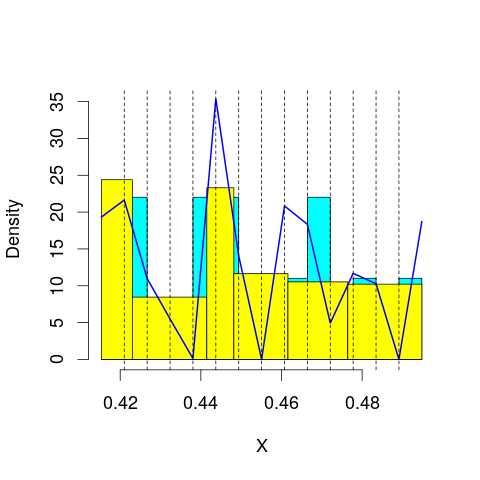

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.24193
mop.approx: Iteration 11. LL = 87.52068
mop.approx: Iteration 21. LL = 87.5935
mop.approx: Converged. Iteration 30. LL = 87.59666
[1] "Computing the linear combination of B-splines"


59.870776737
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 79.85152
mop.approx: Iteration 11. LL = 85.3863
mop.approx: Iteration 21. LL = 85.46265
mop.approx: Iteration 31. LL = 85.47795
mop.approx: Iteration 41. LL = 85.4871
mop.approx: Iteration 51. LL = 85.49367
mop.approx: Iteration 61. LL = 85.49858
mop.approx: Iteration 71. LL = 85.50229
mop.approx: Iteration 81. LL = 85.50512
mop.approx: Iteration 91. LL = 85.5073
mop.approx: Iteration 101. LL = 85.50899
mop.approx: Iteration 111. LL = 85.51032
mop.approx: Iteration 121. LL = 85.51137
mop.approx: Converged. Iteration 125. LL = 85.51181
[1] "Computing the linear combination of B-splines"


56.0530551469
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.52258
mop.approx: Iteration 11. LL = 75.9099
mop.approx: Iteration 21. LL = 76.0078
mop.approx: Iteration 31. LL = 76.02042
mop.approx: Iteration 41. LL = 76.02305
mop.approx: Converged. Iteration 45. LL = 76.02353
[1] "Computing the linear combination of B-splines"


44.8319072178
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.4607
mop.approx: Iteration 11. LL = 76.79253
mop.approx: Iteration 21. LL = 76.91293
mop.approx: Iteration 31. LL = 76.94424
mop.approx: Iteration 41. LL = 76.95853
mop.approx: Iteration 51. LL = 76.96658
mop.approx: Iteration 61. LL = 76.97151
mop.approx: Iteration 71. LL = 76.97459
mop.approx: Iteration 81. LL = 76.97651
mop.approx: Iteration 91. LL = 76.97772
mop.approx: Converged. Iteration 95. LL = 76.97813
[1] "Computing the linear combination of B-splines"


44.0536315896
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.3663
mop.approx: Iteration 11. LL = 76.93352
mop.approx: Iteration 21. LL = 77.07544
mop.approx: Iteration 31. LL = 77.11635
mop.approx: Iteration 41. LL = 77.13357
mop.approx: Iteration 51. LL = 77.14082
mop.approx: Iteration 61. LL = 77.14372
mop.approx: Converged. Iteration 69. LL = 77.14475
[1] "Computing the linear combination of B-splines"


42.4873121292
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.972647
mop.approx: Iteration 11. LL = 77.05755
mop.approx: Iteration 21. LL = 77.24847
mop.approx: Iteration 31. LL = 77.28324
mop.approx: Iteration 41. LL = 77.29629
mop.approx: Iteration 51. LL = 77.30257
mop.approx: Iteration 61. LL = 77.30594
mop.approx: Iteration 71. LL = 77.30785
mop.approx: Iteration 81. LL = 77.30898
mop.approx: Converged. Iteration 83. LL = 77.30922
[1] "Computing the linear combination of B-splines"


40.9148460598
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.110064
[1] "Computing the linear combination of B-splines"


39.9632724376
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.63716
mop.approx: Iteration 11. LL = 88.31701
mop.approx: Iteration 21. LL = 88.33392
mop.approx: Converged. Iteration 25. LL = 88.33457
[1] "Computing the linear combination of B-splines"


60.6086786801
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 60.608678680116299)
m reached
('Sum of Probabilities:', 0.9800731800406647)
chosen


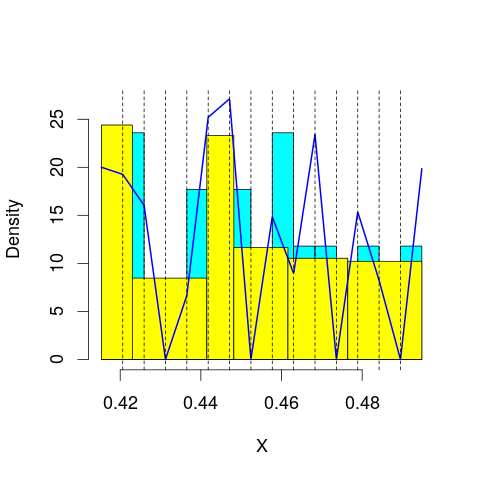

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.24193
mop.approx: Iteration 11. LL = 88.20418
mop.approx: Iteration 21. LL = 88.37
mop.approx: Iteration 31. LL = 88.40268
mop.approx: Iteration 41. LL = 88.4135
mop.approx: Iteration 51. LL = 88.418
mop.approx: Iteration 61. LL = 88.42014
mop.approx: Converged. Iteration 70. LL = 88.42126
[1] "Computing the linear combination of B-splines"


58.9625013057
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 79.85152
mop.approx: Iteration 11. LL = 85.76364
mop.approx: Iteration 21. LL = 85.83275
mop.approx: Iteration 31. LL = 85.83599
mop.approx: Converged. Iteration 31. LL = 85.83607
[1] "Computing the linear combination of B-splines"


54.6444424942
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.52258
mop.approx: Iteration 11. LL = 76.40441
mop.approx: Iteration 21. LL = 76.53933
mop.approx: Iteration 31. LL = 76.57283
mop.approx: Iteration 41. LL = 76.58616
mop.approx: Iteration 51. LL = 76.59281
mop.approx: Iteration 61. LL = 76.59664
mop.approx: Iteration 71. LL = 76.59896
mop.approx: Iteration 81. LL = 76.60035
mop.approx: Converged. Iteration 87. LL = 76.60096
[1] "Computing the linear combination of B-splines"


43.6764697853
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.4607
mop.approx: Iteration 11. LL = 76.98415
mop.approx: Iteration 21. LL = 77.08631
mop.approx: Iteration 31. LL = 77.10526
mop.approx: Iteration 41. LL = 77.11169
mop.approx: Iteration 51. LL = 77.11487
mop.approx: Iteration 61. LL = 77.11677
mop.approx: Iteration 71. LL = 77.11802
mop.approx: Converged. Iteration 79. LL = 77.11881
[1] "Computing the linear combination of B-splines"


42.4614625467
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.3663
mop.approx: Iteration 11. LL = 77.57061
mop.approx: Iteration 21. LL = 77.74349
mop.approx: Iteration 31. LL = 77.78158
mop.approx: Iteration 41. LL = 77.79525
mop.approx: Iteration 51. LL = 77.80158
mop.approx: Iteration 61. LL = 77.80507
mop.approx: Iteration 71. LL = 77.80724
mop.approx: Iteration 81. LL = 77.80872
mop.approx: Iteration 91. LL = 77.80977
mop.approx: Converged. Iteration 96. LL = 77.81027
[1] "Computing the linear combination of B-splines"


41.419546865
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.972647
mop.approx: Iteration 11. LL = 77.26128
mop.approx: Iteration 21. LL = 77.38912
mop.approx: Iteration 31. LL = 77.42033
mop.approx: Iteration 41. LL = 77.43187
mop.approx: Iteration 51. LL = 77.43647
mop.approx: Iteration 61. LL = 77.43835
mop.approx: Converged. Iteration 66. LL = 77.43889
[1] "Computing the linear combination of B-splines"


39.2710716809
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.110064
mop.approx: Iteration 11. LL = 81.61621
mop.approx: Iteration 21. LL = 81.87263
mop.approx: Iteration 31. LL = 81.89317
mop.approx: Iteration 41. LL = 81.89677
mop.approx: Iteration 51. LL = 81.89811
mop.approx: Converged. Iteration 53. LL = 81.89836
[1] "Computing the linear combination of B-splines"


41.6058399085
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.63716
mop.approx: Iteration 11. LL = 89.941
mop.approx: Converged. Iteration 15. LL = 89.94349
[1] "Computing the linear combination of B-splines"


60.4847388366
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 60.484738836567736)
m reached
('Sum of Probabilities:', 0.9791962205666682)
chosen


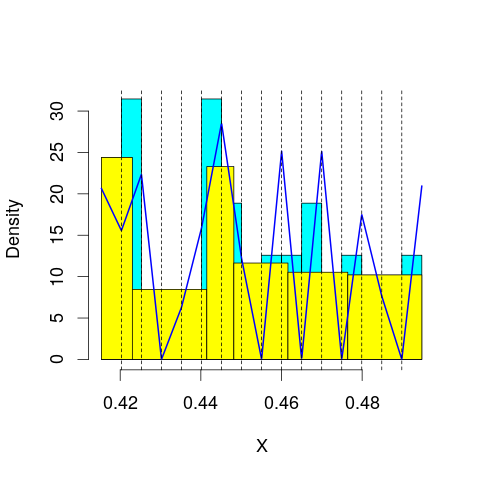

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.24193
mop.approx: Iteration 11. LL = 88.09538
mop.approx: Iteration 21. LL = 88.21835
mop.approx: Iteration 31. LL = 88.23015
mop.approx: Converged. Iteration 37. LL = 88.23135
[1] "Computing the linear combination of B-splines"


57.0397248494
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 79.85152
mop.approx: Iteration 11. LL = 86.88242
mop.approx: Iteration 21. LL = 87.01659
mop.approx: Iteration 31. LL = 87.03115
mop.approx: Iteration 41. LL = 87.03356
mop.approx: Converged. Iteration 42. LL = 87.03372
[1] "Computing the linear combination of B-splines"


54.1092287081
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.52258
mop.approx: Iteration 11. LL = 76.46776
mop.approx: Iteration 21. LL = 76.53241
mop.approx: Iteration 31. LL = 76.54561
mop.approx: Iteration 41. LL = 76.54931
mop.approx: Converged. Iteration 49. LL = 76.55036
[1] "Computing the linear combination of B-splines"


41.8930024466
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.4607
mop.approx: Iteration 11. LL = 77.53763
mop.approx: Iteration 21. LL = 77.7169
mop.approx: Iteration 31. LL = 77.7709
mop.approx: Iteration 41. LL = 77.79369
mop.approx: Iteration 51. LL = 77.80507
mop.approx: Iteration 61. LL = 77.81157
mop.approx: Iteration 71. LL = 77.81567
mop.approx: Iteration 81. LL = 77.81842
mop.approx: Iteration 91. LL = 77.82035
mop.approx: Iteration 101. LL = 77.82173
mop.approx: Iteration 111. LL = 77.82275
mop.approx: Converged. Iteration 115. LL = 77.82315
[1] "Computing the linear combination of B-splines"


41.4329358368
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.3663
mop.approx: Iteration 11. LL = 77.70303
mop.approx: Iteration 21. LL = 77.82638
mop.approx: Iteration 31. LL = 77.86057
mop.approx: Iteration 41. LL = 77.87378
mop.approx: Iteration 51. LL = 77.87954
mop.approx: Iteration 61. LL = 77.88221
mop.approx: Iteration 71. LL = 77.8835
mop.approx: Converged. Iteration 73. LL = 77.88374
[1] "Computing the linear combination of B-splines"


39.7590023416
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.972647
mop.approx: Iteration 11. LL = 77.87524
mop.approx: Iteration 21. LL = 78.08846
mop.approx: Iteration 31. LL = 78.13459
mop.approx: Iteration 41. LL = 78.14946
mop.approx: Iteration 51. LL = 78.15642
mop.approx: Iteration 61. LL = 78.16054
mop.approx: Iteration 71. LL = 78.16325
mop.approx: Iteration 81. LL = 78.16515
mop.approx: Iteration 91. LL = 78.16651
mop.approx: Iteration 101. LL = 78.16753
mop.approx: Converged. Iteration 106. LL = 78.16802
[1] "Computing the linear combination of B-splines"


38.1991009002
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.110064
[1] "Computing the linear combination of B-splines"


45.3465177468
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.63716
mop.approx: Iteration 11. LL = 88.68036
mop.approx: Iteration 21. LL = 88.7085
mop.approx: Iteration 31. LL = 88.71247
mop.approx: Iteration 41. LL = 88.71391
mop.approx: Converged. Iteration 42. LL = 88.71408
[1] "Computing the linear combination of B-splines"


57.5224602105
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 57.522460210458817)
m reached
('Sum of Probabilities:', 0.9780766887731518)
chosen


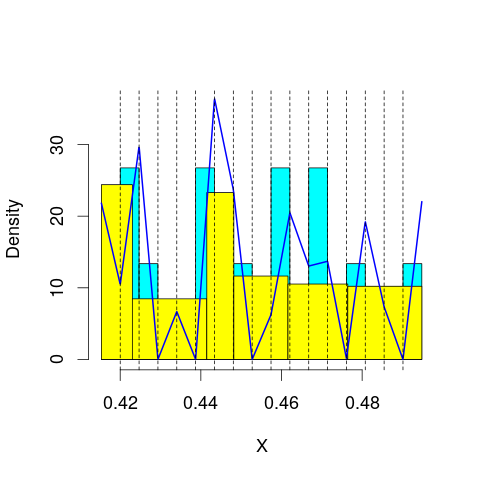

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.24193
mop.approx: Iteration 11. LL = 89.79285
mop.approx: Iteration 21. LL = 89.84041
mop.approx: Iteration 31. LL = 89.84527
mop.approx: Converged. Iteration 34. LL = 89.84572
[1] "Computing the linear combination of B-splines"


56.9212337772
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 79.85152
mop.approx: Iteration 11. LL = 86.57675
mop.approx: Iteration 21. LL = 86.70927
mop.approx: Iteration 31. LL = 86.7265
mop.approx: Iteration 41. LL = 86.72996
mop.approx: Converged. Iteration 45. LL = 86.73053
[1] "Computing the linear combination of B-splines"


52.0731727543
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.52258
mop.approx: Iteration 11. LL = 77.79927
mop.approx: Iteration 21. LL = 77.94912
mop.approx: Iteration 31. LL = 77.97415
mop.approx: Iteration 41. LL = 77.98027
mop.approx: Iteration 51. LL = 77.98229
mop.approx: Converged. Iteration 56. LL = 77.98286
[1] "Computing the linear combination of B-splines"


41.5926309114
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.4607
mop.approx: Iteration 11. LL = 77.3784
mop.approx: Iteration 21. LL = 77.4917
mop.approx: Iteration 31. LL = 77.52754
mop.approx: Iteration 41. LL = 77.54324
mop.approx: Iteration 51. LL = 77.5507
mop.approx: Iteration 61. LL = 77.55437
mop.approx: Iteration 71. LL = 77.55621
mop.approx: Converged. Iteration 79. LL = 77.55708
[1] "Computing the linear combination of B-splines"


39.4339805625
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.3663
mop.approx: Iteration 11. LL = 78.29734
mop.approx: Iteration 21. LL = 78.47775
mop.approx: Iteration 31. LL = 78.52134
mop.approx: Iteration 41. LL = 78.53728
mop.approx: Iteration 51. LL = 78.5449
mop.approx: Iteration 61. LL = 78.5491
mop.approx: Iteration 71. LL = 78.5516
mop.approx: Iteration 81. LL = 78.55314
mop.approx: Iteration 91. LL = 78.55412
mop.approx: Converged. Iteration 91. LL = 78.55419
[1] "Computing the linear combination of B-splines"


38.6954034211
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.972647
mop.approx: Iteration 11. LL = 78.27308
mop.approx: Iteration 21. LL = 78.39018
mop.approx: Iteration 31. LL = 78.42159
mop.approx: Iteration 41. LL = 78.43342
mop.approx: Iteration 51. LL = 78.43848
mop.approx: Iteration 61. LL = 78.44082
mop.approx: Iteration 71. LL = 78.44199
mop.approx: Converged. Iteration 72. LL = 78.44214
[1] "Computing the linear combination of B-splines"


36.7936610995
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.110064
[1] "Computing the linear combination of B-splines"


40.7369433096
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.63716
mop.approx: Iteration 11. LL = 92.06467
mop.approx: Converged. Iteration 16. LL = 92.06847
[1] "Computing the linear combination of B-splines"


59.1439742309
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 59.143974230900525)
m reached
('Sum of Probabilities:', 0.9769661099661546)
chosen


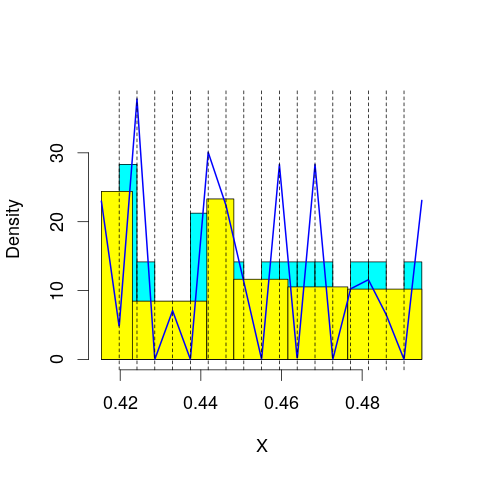

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.24193
mop.approx: Iteration 11. LL = 89.11175
mop.approx: Iteration 21. LL = 89.19601
mop.approx: Iteration 31. LL = 89.20832
mop.approx: Iteration 41. LL = 89.21143
mop.approx: Converged. Iteration 49. LL = 89.21254
[1] "Computing the linear combination of B-splines"


54.5551804005
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 79.85152
mop.approx: Iteration 11. LL = 88.27615
mop.approx: Iteration 21. LL = 88.41797
mop.approx: Iteration 31. LL = 88.43791
mop.approx: Iteration 41. LL = 88.44302
mop.approx: Iteration 51. LL = 88.44476
mop.approx: Converged. Iteration 53. LL = 88.44504
[1] "Computing the linear combination of B-splines"


52.0548133017
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.52258
mop.approx: Iteration 11. LL = 78.18313
mop.approx: Iteration 21. LL = 78.36865
mop.approx: Iteration 31. LL = 78.41962
mop.approx: Iteration 41. LL = 78.43719
mop.approx: Iteration 51. LL = 78.44386
mop.approx: Iteration 61. LL = 78.4466
mop.approx: Iteration 71. LL = 78.44778
mop.approx: Converged. Iteration 71. LL = 78.44786
[1] "Computing the linear combination of B-splines"


40.324763876
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.4607
mop.approx: Iteration 11. LL = 78.02744
mop.approx: Iteration 21. LL = 78.20945
mop.approx: Iteration 31. LL = 78.24165
mop.approx: Iteration 41. LL = 78.24923
mop.approx: Iteration 51. LL = 78.25178
mop.approx: Iteration 61. LL = 78.25311
mop.approx: Iteration 71. LL = 78.25407
mop.approx: Converged. Iteration 75. LL = 78.25447
[1] "Computing the linear combination of B-splines"


38.3985010579
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.3663
mop.approx: Iteration 11. LL = 78.42665
mop.approx: Iteration 21. LL = 78.60314
mop.approx: Iteration 31. LL = 78.6683
mop.approx: Iteration 41. LL = 78.69735
mop.approx: Iteration 51. LL = 78.71147
mop.approx: Iteration 61. LL = 78.71891
mop.approx: Iteration 71. LL = 78.72314
mop.approx: Iteration 81. LL = 78.72572
mop.approx: Iteration 91. LL = 78.72738
mop.approx: Iteration 101. LL = 78.72851
mop.approx: Converged. Iteration 106. LL = 78.72901
[1] "Computing the linear combination of B-splines"


37.1433443344
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.972647
mop.approx: Iteration 11. LL = 78.87282
mop.approx: Iteration 21. LL = 79.05485
mop.approx: Iteration 31. LL = 79.10343
mop.approx: Iteration 41. LL = 79.12225
mop.approx: Iteration 51. LL = 79.13001
mop.approx: Iteration 61. LL = 79.13334
mop.approx: Iteration 71. LL = 79.13482
mop.approx: Converged. Iteration 74. LL = 79.13516
[1] "Computing the linear combination of B-splines"


35.7236437544
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.110064
[1] "Computing the linear combination of B-splines"


-65.3181393859
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.63716
mop.approx: Iteration 11. LL = 92.17871
mop.approx: Iteration 21. LL = 92.22954
mop.approx: Iteration 31. LL = 92.24189
mop.approx: Iteration 41. LL = 92.24687
mop.approx: Iteration 51. LL = 92.24914
mop.approx: Converged. Iteration 58. LL = 92.25006
[1] "Computing the linear combination of B-splines"


57.5926996295
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 57.592699629530408)
m reached
('Sum of Probabilities:', 0.9758802035631959)
chosen


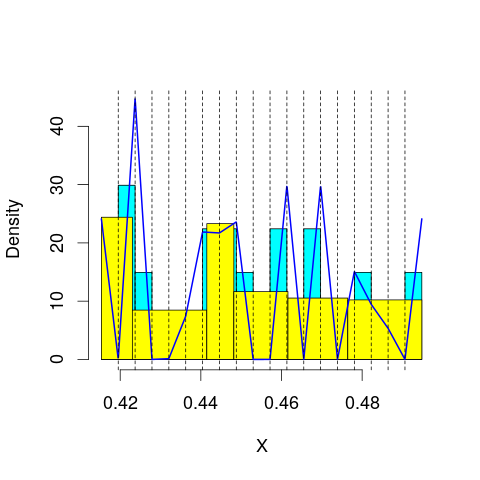

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.24193
mop.approx: Iteration 11. LL = 90.20392
mop.approx: Iteration 21. LL = 90.27336
mop.approx: Iteration 31. LL = 90.28093
mop.approx: Converged. Iteration 40. LL = 90.28267
[1] "Computing the linear combination of B-splines"


53.892444691
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 79.85152
mop.approx: Iteration 11. LL = 88.82291
mop.approx: Iteration 21. LL = 88.97158
mop.approx: Iteration 31. LL = 88.99073
mop.approx: Iteration 41. LL = 88.99481
mop.approx: Converged. Iteration 48. LL = 88.99583
[1] "Computing the linear combination of B-splines"


50.8727330657
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.52258
mop.approx: Iteration 11. LL = 79.45242
mop.approx: Iteration 21. LL = 79.65154
mop.approx: Iteration 31. LL = 79.6814
mop.approx: Iteration 41. LL = 79.68763
mop.approx: Iteration 51. LL = 79.68942
mop.approx: Converged. Iteration 54. LL = 79.68977
[1] "Computing the linear combination of B-splines"


39.833803354
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.4607
mop.approx: Iteration 11. LL = 78.2473
mop.approx: Iteration 21. LL = 78.4266
mop.approx: Iteration 31. LL = 78.45908
mop.approx: Iteration 41. LL = 78.46777
mop.approx: Iteration 51. LL = 78.47099
mop.approx: Iteration 61. LL = 78.47249
mop.approx: Converged. Iteration 66. LL = 78.47303
[1] "Computing the linear combination of B-splines"


36.8842040272
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.3663
mop.approx: Iteration 11. LL = 78.89938
mop.approx: Iteration 21. LL = 79.14826
mop.approx: Iteration 31. LL = 79.21639
mop.approx: Iteration 41. LL = 79.23949
mop.approx: Iteration 51. LL = 79.24821
mop.approx: Iteration 61. LL = 79.25172
mop.approx: Iteration 71. LL = 79.25321
mop.approx: Converged. Iteration 73. LL = 79.25346
[1] "Computing the linear combination of B-splines"


35.9294771387
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.972647
mop.approx: Iteration 11. LL = 80.97426
mop.approx: Iteration 21. LL = 81.22899
mop.approx: Iteration 31. LL = 81.27555
mop.approx: Iteration 41. LL = 81.28804
mop.approx: Iteration 51. LL = 81.29164
mop.approx: Converged. Iteration 58. LL = 81.29259
[1] "Computing the linear combination of B-splines"


36.300998334
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.110064
[1] "Computing the linear combination of B-splines"


21.5169424691
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.63716
mop.approx: Iteration 11. LL = 91.62296
mop.approx: Iteration 21. LL = 91.66956
mop.approx: Iteration 31. LL = 91.67471
mop.approx: Converged. Iteration 39. LL = 91.67597
[1] "Computing the linear combination of B-splines"


55.2857428238
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 55.285742823784432)
m reached
('Sum of Probabilities:', 0.9748659753770563)
chosen


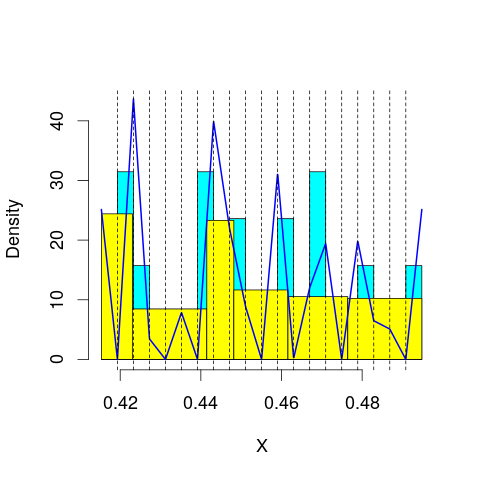

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 80.24193
mop.approx: Iteration 11. LL = 91.34962
mop.approx: Iteration 21. LL = 91.36644
mop.approx: Converged. Iteration 22. LL = 91.36666
[1] "Computing the linear combination of B-splines"


53.2435678493
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 79.85152
mop.approx: Iteration 11. LL = 89.03857
mop.approx: Iteration 21. LL = 89.21166
mop.approx: Iteration 31. LL = 89.23178
mop.approx: Iteration 41. LL = 89.23654
mop.approx: Iteration 51. LL = 89.23826
mop.approx: Converged. Iteration 54. LL = 89.23864
[1] "Computing the linear combination of B-splines"


49.3826738089
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.52258
mop.approx: Iteration 11. LL = 80.62092
mop.approx: Iteration 21. LL = 80.73492
mop.approx: Iteration 31. LL = 80.75467
mop.approx: Iteration 41. LL = 80.76039
mop.approx: Iteration 51. LL = 80.7624
mop.approx: Converged. Iteration 55. LL = 80.76289
[1] "Computing the linear combination of B-splines"


39.1740570554
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.4607
mop.approx: Iteration 11. LL = 78.49359
mop.approx: Iteration 21. LL = 78.64098
mop.approx: Iteration 31. LL = 78.67599
mop.approx: Iteration 41. LL = 78.68688
mop.approx: Iteration 51. LL = 78.69051
mop.approx: Converged. Iteration 60. LL = 78.69175
[1] "Computing the linear combination of B-splines"


35.3700941247
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.3663
mop.approx: Iteration 11. LL = 79.35008
mop.approx: Iteration 21. LL = 79.57625
mop.approx: Iteration 31. LL = 79.61411
mop.approx: Iteration 41. LL = 79.62507
mop.approx: Iteration 51. LL = 79.62953
mop.approx: Iteration 61. LL = 79.63178
mop.approx: Iteration 71. LL = 79.63312
mop.approx: Converged. Iteration 79. LL = 79.63393
[1] "Computing the linear combination of B-splines"


34.5778109909
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.972647
mop.approx: Iteration 11. LL = 81.07136
mop.approx: Iteration 21. LL = 81.19347
mop.approx: Iteration 31. LL = 81.22149
mop.approx: Iteration 41. LL = 81.23036
mop.approx: Iteration 51. LL = 81.2334
mop.approx: Converged. Iteration 59. LL = 81.23445
[1] "Computing the linear combination of B-splines"


34.2760410703
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.110064
[1] "Computing the linear combination of B-splines"


37.5220814307
lfps_7
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.4141
mop.approx: Converged. Iteration 6. LL = 51.44536
[1] "Computing the linear combination of B-splines"


46.2467569795
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 46.246756979506173)
m reached
('Sum of Probabilities:', 0.9948504785502341)
chosen


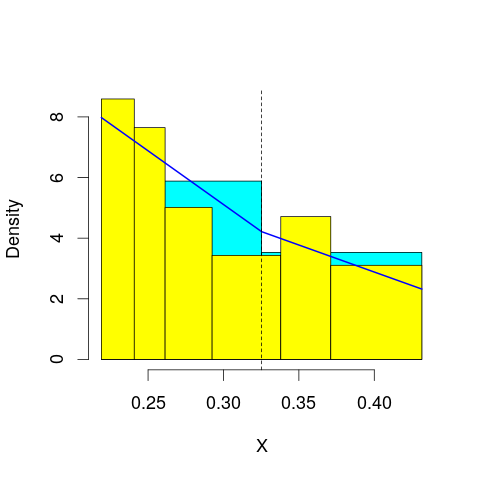

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.26456
mop.approx: Iteration 11. LL = 51.35413
mop.approx: Converged. Iteration 16. LL = 51.35475
[1] "Computing the linear combination of B-splines"


44.423280524
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.11571
mop.approx: Iteration 11. LL = 51.19614
mop.approx: Iteration 21. LL = 51.22704
mop.approx: Iteration 31. LL = 51.24234
mop.approx: Iteration 41. LL = 51.25002
mop.approx: Iteration 51. LL = 51.25398
mop.approx: Iteration 61. LL = 51.25606
mop.approx: Iteration 71. LL = 51.25719
mop.approx: Converged. Iteration 79. LL = 51.25776
[1] "Computing the linear combination of B-splines"


42.593419381
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.68741
mop.approx: Iteration 11. LL = 42.58387
mop.approx: Converged. Iteration 20. LL = 42.59276
[1] "Computing the linear combination of B-splines"


32.1955505648
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.84791
mop.approx: Iteration 11. LL = 42.00724
mop.approx: Iteration 21. LL = 42.28153
mop.approx: Iteration 31. LL = 42.33823
mop.approx: Iteration 41. LL = 42.35892
mop.approx: Iteration 51. LL = 42.3681
mop.approx: Iteration 61. LL = 42.37256
mop.approx: Iteration 71. LL = 42.37482
mop.approx: Iteration 81. LL = 42.376
mop.approx: Iteration 91. LL = 42.37662
mop.approx: Converged. Iteration 92. LL = 42.37671
[1] "Computing the linear combination of B-splines"


30.2466327883
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.645068
mop.approx: Iteration 11. LL = 40.69925
mop.approx: Iteration 21. LL = 40.77847
mop.approx: Iteration 31. LL = 40.78444
mop.approx: Converged. Iteration 38. LL = 40.78509
[1] "Computing the linear combination of B-splines"


26.9221419502
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.930692
mop.approx: Iteration 11. LL = 40.22594
mop.approx: Iteration 21. LL = 40.62613
mop.approx: Iteration 31. LL = 40.70528
mop.approx: Iteration 41. LL = 40.72807
mop.approx: Iteration 51. LL = 40.73524
mop.approx: Iteration 61. LL = 40.73755
mop.approx: Iteration 71. LL = 40.73831
mop.approx: Converged. Iteration 71. LL = 40.73835
[1] "Computing the linear combination of B-splines"


25.1425359476
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.3970326
mop.approx: Iteration 11. LL = 38.88852
mop.approx: Iteration 21. LL = 39.08596
mop.approx: Iteration 31. LL = 39.12211
mop.approx: Iteration 41. LL = 39.13374
mop.approx: Iteration 51. LL = 39.13854
mop.approx: Iteration 61. LL = 39.14083
mop.approx: Iteration 71. LL = 39.14204
mop.approx: Iteration 81. LL = 39.14273
mop.approx: Converged. Iteration 87. LL = 39.14304
[1] "Computing the linear combination of B-splines"


21.8143557597
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.4141
mop.approx: Converged. Iteration 9. LL = 51.53475
[1] "Computing the linear combination of B-splines"


44.6032769983
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 44.603276998302654)
m reached
('Sum of Probabilities:', 0.9946363311831827)
chosen


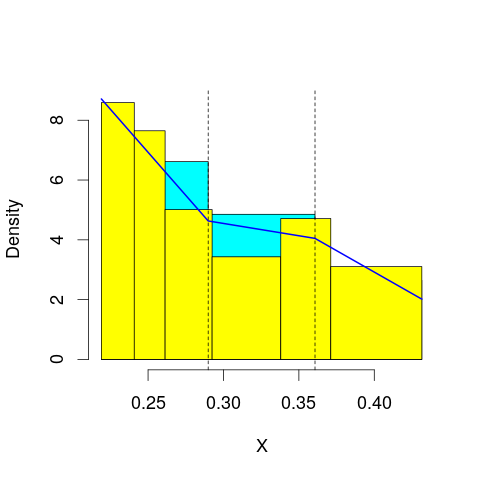

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.26456
mop.approx: Iteration 11. LL = 51.37428
mop.approx: Iteration 21. LL = 51.38102
mop.approx: Converged. Iteration 26. LL = 51.38151
[1] "Computing the linear combination of B-splines"


42.7171697584
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.11571
mop.approx: Iteration 11. LL = 51.6462
mop.approx: Iteration 21. LL = 51.78683
mop.approx: Iteration 31. LL = 51.8341
mop.approx: Iteration 41. LL = 51.85011
mop.approx: Iteration 51. LL = 51.8555
mop.approx: Iteration 61. LL = 51.85735
mop.approx: Converged. Iteration 68. LL = 51.85792
[1] "Computing the linear combination of B-splines"


41.4607136158
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.68741
mop.approx: Iteration 11. LL = 43.65468
mop.approx: Iteration 21. LL = 43.74909
mop.approx: Iteration 31. LL = 43.76633
mop.approx: Iteration 41. LL = 43.7721
mop.approx: Iteration 51. LL = 43.7746
mop.approx: Iteration 61. LL = 43.77583
mop.approx: Iteration 71. LL = 43.77646
mop.approx: Converged. Iteration 72. LL = 43.77655
[1] "Computing the linear combination of B-splines"


31.6464724826
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.84791
mop.approx: Iteration 11. LL = 44.25398
mop.approx: Iteration 21. LL = 44.29275
mop.approx: Converged. Iteration 22. LL = 44.29283
[1] "Computing the linear combination of B-splines"


30.4298837616
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.645068
mop.approx: Iteration 11. LL = 42.92138
mop.approx: Iteration 21. LL = 43.09201
mop.approx: Iteration 31. LL = 43.0986
mop.approx: Converged. Iteration 35. LL = 43.09897
[1] "Computing the linear combination of B-splines"


27.5031538838
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.930692
mop.approx: Iteration 11. LL = 42.58703
mop.approx: Iteration 21. LL = 42.664
mop.approx: Converged. Iteration 29. LL = 42.66565
[1] "Computing the linear combination of B-splines"


25.3369715967
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.3970326
mop.approx: Iteration 11. LL = 41.48864
mop.approx: Iteration 21. LL = 41.79184
mop.approx: Iteration 31. LL = 41.84243
mop.approx: Iteration 41. LL = 41.86033
mop.approx: Iteration 51. LL = 41.86868
mop.approx: Iteration 61. LL = 41.87324
mop.approx: Iteration 71. LL = 41.87601
mop.approx: Iteration 81. LL = 41.87783
mop.approx: Iteration 91. LL = 41.87908
mop.approx: Iteration 101. LL = 41.87999
mop.approx: Iteration 111. LL = 41.88066
mop.approx: Iteration 121. LL = 41.88118
mop.approx: Converged. Iteration 125. LL = 41.8814
[1] "Computing the linear combination of B-splines"


22.8198506359
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.4141
mop.approx: Converged. Iteration 9. LL = 51.57376
[1] "Computing the linear combination of B-splines"


42.9094209456
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 42.909420945621221)
m reached
('Sum of Probabilities:', 0.9943621801857713)
chosen


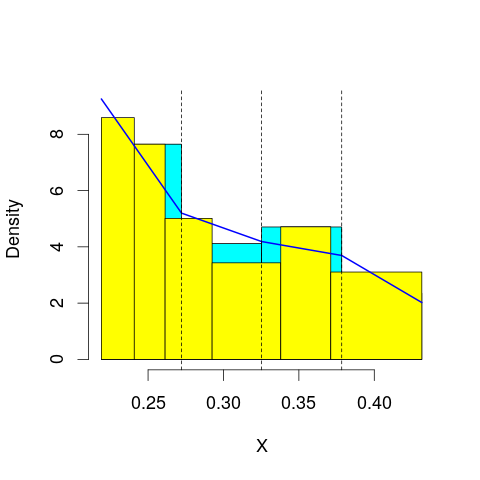

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.26456
mop.approx: Iteration 11. LL = 52.08972
mop.approx: Iteration 21. LL = 52.16076
mop.approx: Iteration 31. LL = 52.17599
mop.approx: Iteration 41. LL = 52.18101
mop.approx: Iteration 51. LL = 52.18297
mop.approx: Iteration 61. LL = 52.18378
mop.approx: Converged. Iteration 61. LL = 52.18383
[1] "Computing the linear combination of B-splines"


41.7866229778
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.11571
mop.approx: Iteration 11. LL = 51.92163
mop.approx: Iteration 21. LL = 51.95556
mop.approx: Iteration 31. LL = 51.95804
mop.approx: Converged. Iteration 32. LL = 51.95815
[1] "Computing the linear combination of B-splines"


39.8280764543
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.68741
mop.approx: Iteration 11. LL = 43.89308
mop.approx: Iteration 21. LL = 43.93168
mop.approx: Iteration 31. LL = 43.93833
mop.approx: Iteration 41. LL = 43.94092
mop.approx: Iteration 51. LL = 43.9422
mop.approx: Iteration 61. LL = 43.94289
mop.approx: Converged. Iteration 64. LL = 43.94308
[1] "Computing the linear combination of B-splines"


30.080132309
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.84791
mop.approx: Iteration 11. LL = 44.32581
mop.approx: Converged. Iteration 20. LL = 44.33043
[1] "Computing the linear combination of B-splines"


28.7346223644
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.645068
mop.approx: Iteration 11. LL = 44.47643
mop.approx: Iteration 21. LL = 44.69838
mop.approx: Iteration 31. LL = 44.71327
mop.approx: Converged. Iteration 38. LL = 44.71425
[1] "Computing the linear combination of B-splines"


27.3855704442
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.930692
mop.approx: Iteration 11. LL = 43.4977
mop.approx: Iteration 21. LL = 43.69504
mop.approx: Iteration 31. LL = 43.71915
mop.approx: Iteration 41. LL = 43.72218
mop.approx: Converged. Iteration 45. LL = 43.72246
[1] "Computing the linear combination of B-splines"


24.6609120939
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.3970326
mop.approx: Iteration 11. LL = 43.65754
mop.approx: Iteration 21. LL = 43.80814
mop.approx: Converged. Iteration 28. LL = 43.81015
[1] "Computing the linear combination of B-splines"


23.0157383914
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.4141
mop.approx: Iteration 11. LL = 52.19273
mop.approx: Converged. Iteration 11. LL = 52.19277
[1] "Computing the linear combination of B-splines"


41.7955592905
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 41.795559290510923)
m reached
('Sum of Probabilities:', 0.9946722732912506)
chosen


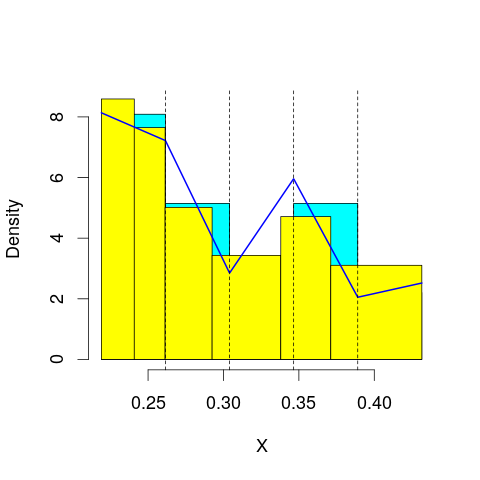

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.26456
mop.approx: Iteration 11. LL = 52.39237
mop.approx: Iteration 21. LL = 52.41856
mop.approx: Converged. Iteration 26. LL = 52.41938
[1] "Computing the linear combination of B-splines"


40.2893010193
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.11571
mop.approx: Iteration 11. LL = 52.3117
mop.approx: Iteration 21. LL = 52.43639
mop.approx: Iteration 31. LL = 52.47857
mop.approx: Iteration 41. LL = 52.49674
mop.approx: Iteration 51. LL = 52.50588
mop.approx: Iteration 61. LL = 52.51104
mop.approx: Iteration 71. LL = 52.5142
mop.approx: Iteration 81. LL = 52.51628
mop.approx: Iteration 91. LL = 52.5177
mop.approx: Iteration 101. LL = 52.51873
mop.approx: Iteration 111. LL = 52.51949
mop.approx: Converged. Iteration 120. LL = 52.52006
[1] "Computing the linear combination of B-splines"


38.6571213566
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.68741
mop.approx: Iteration 11. LL = 45.72968
mop.approx: Iteration 21. LL = 46.04936
mop.approx: Iteration 31. LL = 46.11799
mop.approx: Iteration 41. LL = 46.13962
mop.approx: Iteration 51. LL = 46.14758
mop.approx: Iteration 61. LL = 46.15093
mop.approx: Iteration 71. LL = 46.15255
mop.approx: Iteration 81. LL = 46.15346
mop.approx: Iteration 91. LL = 46.15403
mop.approx: Converged. Iteration 91. LL = 46.15407
[1] "Computing the linear combination of B-splines"


30.5582591555
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.84791
mop.approx: Iteration 11. LL = 44.52769
mop.approx: Iteration 21. LL = 44.56083
mop.approx: Iteration 31. LL = 44.56521
mop.approx: Converged. Iteration 37. LL = 44.56578
[1] "Computing the linear combination of B-splines"


27.237101912
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.645068
mop.approx: Iteration 11. LL = 45.05388
mop.approx: Iteration 21. LL = 45.11948
mop.approx: Converged. Iteration 29. LL = 45.12103
[1] "Computing the linear combination of B-splines"


26.0594847136
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.930692
mop.approx: Iteration 11. LL = 43.99602
mop.approx: Iteration 21. LL = 44.14976
mop.approx: Iteration 31. LL = 44.18532
mop.approx: Iteration 41. LL = 44.19807
mop.approx: Iteration 51. LL = 44.20385
mop.approx: Iteration 61. LL = 44.2069
mop.approx: Iteration 71. LL = 44.20868
mop.approx: Iteration 81. LL = 44.20981
mop.approx: Iteration 91. LL = 44.21056
mop.approx: Iteration 101. LL = 44.21108
mop.approx: Converged. Iteration 101. LL = 44.21112
[1] "Computing the linear combination of B-splines"


23.4167081279
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.3970326
mop.approx: Iteration 11. LL = 43.92768
mop.approx: Iteration 21. LL = 44.00222
mop.approx: Iteration 31. LL = 44.01748
mop.approx: Iteration 41. LL = 44.02206
mop.approx: Iteration 51. LL = 44.02373
mop.approx: Iteration 61. LL = 44.02442
mop.approx: Converged. Iteration 61. LL = 44.02446
[1] "Computing the linear combination of B-splines"


21.4971761374
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.4141
mop.approx: Iteration 11. LL = 52.49002
mop.approx: Iteration 21. LL = 52.49851
mop.approx: Converged. Iteration 24. LL = 52.49883
[1] "Computing the linear combination of B-splines"


40.3687562919
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 40.368756291912945)
m reached
('Sum of Probabilities:', 0.994243132818782)
chosen


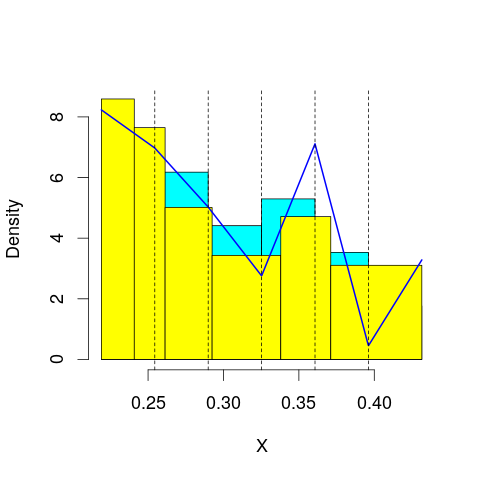

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.26456
mop.approx: Iteration 11. LL = 52.62398
mop.approx: Iteration 21. LL = 52.65154
mop.approx: Iteration 31. LL = 52.65363
mop.approx: Converged. Iteration 31. LL = 52.65368
[1] "Computing the linear combination of B-splines"


38.7907356672
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.11571
mop.approx: Iteration 11. LL = 52.61907
mop.approx: Iteration 21. LL = 52.70409
mop.approx: Iteration 31. LL = 52.72256
mop.approx: Iteration 41. LL = 52.72884
mop.approx: Iteration 51. LL = 52.73151
mop.approx: Iteration 61. LL = 52.73278
mop.approx: Converged. Iteration 69. LL = 52.73337
[1] "Computing the linear combination of B-splines"


37.1375549316
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.68741
mop.approx: Iteration 11. LL = 47.38998
mop.approx: Iteration 21. LL = 47.61752
mop.approx: Iteration 31. LL = 47.64647
mop.approx: Iteration 41. LL = 47.65378
mop.approx: Iteration 51. LL = 47.65595
mop.approx: Converged. Iteration 58. LL = 47.65654
[1] "Computing the linear combination of B-splines"


30.3278627894
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.84791
mop.approx: Iteration 11. LL = 45.32052
mop.approx: Iteration 21. LL = 45.53458
mop.approx: Iteration 31. LL = 45.59677
mop.approx: Iteration 41. LL = 45.61935
mop.approx: Iteration 51. LL = 45.62852
mop.approx: Iteration 61. LL = 45.63248
mop.approx: Iteration 71. LL = 45.63425
mop.approx: Iteration 81. LL = 45.63507
mop.approx: Converged. Iteration 83. LL = 45.63522
[1] "Computing the linear combination of B-splines"


26.5736701342
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.645068
mop.approx: Iteration 11. LL = 45.65965
mop.approx: Iteration 21. LL = 45.76968
mop.approx: Iteration 31. LL = 45.79358
mop.approx: Iteration 41. LL = 45.80144
mop.approx: Iteration 51. LL = 45.80461
mop.approx: Iteration 61. LL = 45.80607
mop.approx: Iteration 71. LL = 45.80679
mop.approx: Converged. Iteration 73. LL = 45.80694
[1] "Computing the linear combination of B-splines"


25.0125197171
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.930692
mop.approx: Iteration 11. LL = 45.25925
mop.approx: Iteration 21. LL = 45.62225
mop.approx: Iteration 31. LL = 45.66609
mop.approx: Iteration 41. LL = 45.67317
mop.approx: Iteration 51. LL = 45.67486
mop.approx: Converged. Iteration 57. LL = 45.67528
[1] "Computing the linear combination of B-splines"


23.148000932
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.3970326
mop.approx: Iteration 11. LL = 44.01507
mop.approx: Iteration 21. LL = 44.05125
mop.approx: Iteration 31. LL = 44.06257
mop.approx: Iteration 41. LL = 44.06809
mop.approx: Iteration 51. LL = 44.07112
mop.approx: Iteration 61. LL = 44.07292
mop.approx: Iteration 71. LL = 44.07405
mop.approx: Iteration 81. LL = 44.07479
mop.approx: Converged. Iteration 89. LL = 44.07525
[1] "Computing the linear combination of B-splines"


19.8150996354
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.4141
mop.approx: Iteration 11. LL = 53.08233
mop.approx: Iteration 21. LL = 53.10087
mop.approx: Converged. Iteration 26. LL = 53.10162
[1] "Computing the linear combination of B-splines"


39.2386753209
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 39.238675320866584)
m reached
('Sum of Probabilities:', 0.9939116496558539)
chosen


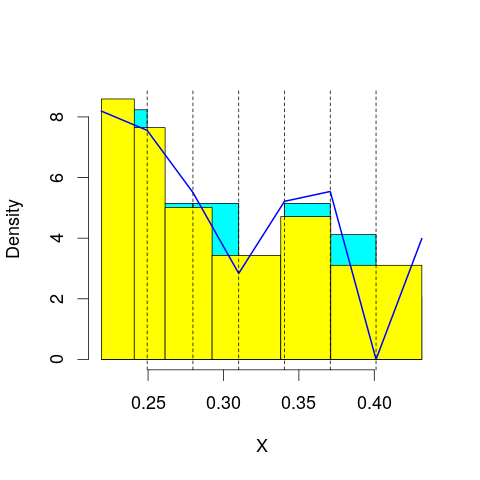

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.26456
mop.approx: Iteration 11. LL = 52.80361
mop.approx: Iteration 21. LL = 52.81819
mop.approx: Converged. Iteration 26. LL = 52.81881
[1] "Computing the linear combination of B-splines"


37.2230012707
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.11571
mop.approx: Iteration 11. LL = 52.71586
mop.approx: Iteration 21. LL = 52.76783
mop.approx: Iteration 31. LL = 52.77878
mop.approx: Iteration 41. LL = 52.78171
mop.approx: Converged. Iteration 50. LL = 52.78258
[1] "Computing the linear combination of B-splines"


35.4538989424
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.68741
mop.approx: Iteration 11. LL = 47.81141
mop.approx: Iteration 21. LL = 47.84652
mop.approx: Converged. Iteration 25. LL = 47.84692
[1] "Computing the linear combination of B-splines"


28.7853767641
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.84791
mop.approx: Iteration 11. LL = 46.32457
mop.approx: Iteration 21. LL = 46.54616
mop.approx: Iteration 31. LL = 46.58255
mop.approx: Iteration 41. LL = 46.58981
mop.approx: Iteration 51. LL = 46.59169
mop.approx: Converged. Iteration 60. LL = 46.59238
[1] "Computing the linear combination of B-splines"


25.7979633453
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.645068
mop.approx: Iteration 11. LL = 45.97846
mop.approx: Iteration 21. LL = 46.06267
mop.approx: Iteration 31. LL = 46.09219
mop.approx: Iteration 41. LL = 46.10602
mop.approx: Iteration 51. LL = 46.11332
mop.approx: Iteration 61. LL = 46.1175
mop.approx: Iteration 71. LL = 46.12002
mop.approx: Iteration 81. LL = 46.12158
mop.approx: Iteration 91. LL = 46.12257
mop.approx: Iteration 101. LL = 46.12321
mop.approx: Converged. Iteration 103. LL = 46.12336
[1] "Computing the linear combination of B-splines"


23.5960747178
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.930692
mop.approx: Iteration 11. LL = 46.37657
mop.approx: Iteration 21. LL = 46.62912
mop.approx: Iteration 31. LL = 46.67779
mop.approx: Iteration 41. LL = 46.69525
mop.approx: Iteration 51. LL = 46.70256
mop.approx: Iteration 61. LL = 46.70581
mop.approx: Iteration 71. LL = 46.7073
mop.approx: Iteration 81. LL = 46.708
mop.approx: Converged. Iteration 81. LL = 46.70804
[1] "Computing the linear combination of B-splines"


22.4478900466
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.3970326
mop.approx: Iteration 11. LL = 45.06926
mop.approx: Iteration 21. LL = 45.51994
mop.approx: Iteration 31. LL = 45.66085
mop.approx: Iteration 41. LL = 45.72006
mop.approx: Iteration 51. LL = 45.74911
mop.approx: Iteration 61. LL = 45.76454
mop.approx: Iteration 71. LL = 45.77313
mop.approx: Iteration 81. LL = 45.77804
mop.approx: Iteration 91. LL = 45.7809
mop.approx: Iteration 101. LL = 45.78259
mop.approx: Iteration 111. LL = 45.78359
mop.approx: Iteration 121. LL = 45.78419
mop.approx: Converged. Iteration 121. LL = 45.78424
[1] "Computing the linear combination of B-splines"


19.7912180414
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.4141
mop.approx: Iteration 11. LL = 53.50614
mop.approx: Converged. Iteration 16. LL = 53.50831
[1] "Computing the linear combination of B-splines"


37.9125000322
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 37.912500032167848)
m reached
('Sum of Probabilities:', 0.9934831373590177)
chosen


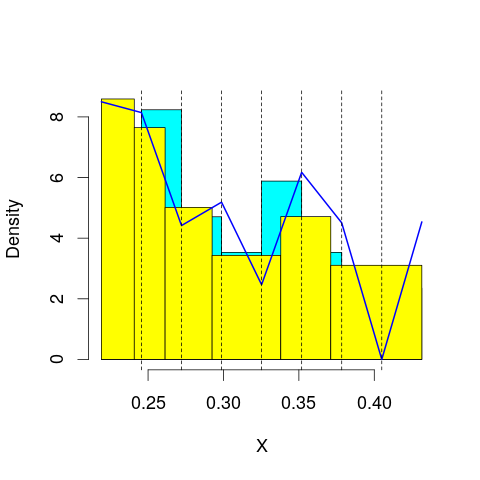

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.26456
mop.approx: Iteration 11. LL = 52.9705
mop.approx: Iteration 21. LL = 52.98297
mop.approx: Iteration 31. LL = 52.98507
mop.approx: Converged. Iteration 37. LL = 52.98558
[1] "Computing the linear combination of B-splines"


35.6568986067
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.11571
mop.approx: Iteration 11. LL = 53.01685
mop.approx: Iteration 21. LL = 53.17584
mop.approx: Iteration 31. LL = 53.23313
mop.approx: Iteration 41. LL = 53.25687
mop.approx: Iteration 51. LL = 53.26743
mop.approx: Iteration 61. LL = 53.27232
mop.approx: Iteration 71. LL = 53.27469
mop.approx: Iteration 81. LL = 53.2759
mop.approx: Converged. Iteration 90. LL = 53.27657
[1] "Computing the linear combination of B-splines"


34.215017608
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.68741
mop.approx: Iteration 11. LL = 47.9155
mop.approx: Iteration 21. LL = 47.94639
mop.approx: Iteration 31. LL = 47.95292
mop.approx: Iteration 41. LL = 47.95592
mop.approx: Iteration 51. LL = 47.95746
mop.approx: Iteration 61. LL = 47.95832
mop.approx: Converged. Iteration 67. LL = 47.9587
[1] "Computing the linear combination of B-splines"


27.1642828059
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.84791
mop.approx: Iteration 11. LL = 47.14013
mop.approx: Iteration 21. LL = 47.35294
mop.approx: Iteration 31. LL = 47.40553
mop.approx: Iteration 41. LL = 47.42705
mop.approx: Iteration 51. LL = 47.43743
mop.approx: Iteration 61. LL = 47.44287
mop.approx: Iteration 71. LL = 47.44594
mop.approx: Iteration 81. LL = 47.44776
mop.approx: Iteration 91. LL = 47.4489
mop.approx: Iteration 101. LL = 47.44962
mop.approx: Converged. Iteration 106. LL = 47.44993
[1] "Computing the linear combination of B-splines"


24.9226461566
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.645068
mop.approx: Iteration 11. LL = 46.27571
mop.approx: Iteration 21. LL = 46.36935
mop.approx: Iteration 31. LL = 46.39349
mop.approx: Iteration 41. LL = 46.40083
mop.approx: Iteration 51. LL = 46.40311
mop.approx: Converged. Iteration 59. LL = 46.40378
[1] "Computing the linear combination of B-splines"


22.143624085
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.930692
mop.approx: Iteration 11. LL = 46.77508
mop.approx: Iteration 21. LL = 46.836
mop.approx: Iteration 31. LL = 46.84341
mop.approx: Iteration 41. LL = 46.84747
mop.approx: Iteration 51. LL = 46.85007
mop.approx: Iteration 61. LL = 46.85181
mop.approx: Iteration 71. LL = 46.85303
mop.approx: Iteration 81. LL = 46.85391
mop.approx: Iteration 91. LL = 46.85457
mop.approx: Converged. Iteration 99. LL = 46.85503
[1] "Computing the linear combination of B-splines"


20.8620082008
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.3970326
mop.approx: Iteration 11. LL = 46.37203
mop.approx: Iteration 21. LL = 46.84113
mop.approx: Iteration 31. LL = 46.91217
mop.approx: Iteration 41. LL = 46.9243
mop.approx: Iteration 51. LL = 46.92658
mop.approx: Converged. Iteration 55. LL = 46.9269
[1] "Computing the linear combination of B-splines"


19.2010142874
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.4141
mop.approx: Iteration 11. LL = 53.53559
mop.approx: Converged. Iteration 17. LL = 53.53848
[1] "Computing the linear combination of B-splines"


36.2098024159
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 36.209802415894316)
m reached
('Sum of Probabilities:', 0.9927642811821573)
chosen


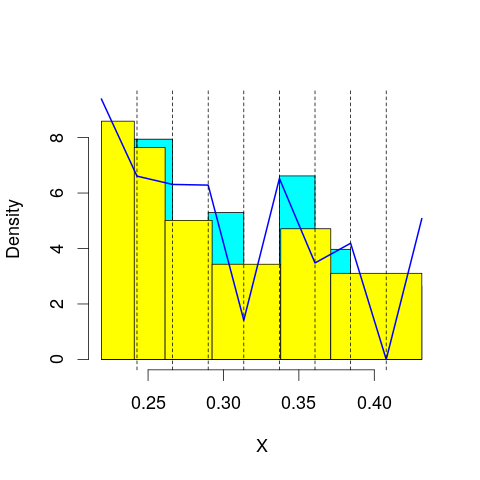

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.26456
mop.approx: Iteration 11. LL = 53.42025
mop.approx: Iteration 21. LL = 53.46617
mop.approx: Iteration 31. LL = 53.47315
mop.approx: Iteration 41. LL = 53.47486
mop.approx: Converged. Iteration 48. LL = 53.47541
[1] "Computing the linear combination of B-splines"


34.413863023
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.11571
mop.approx: Iteration 11. LL = 53.23712
mop.approx: Iteration 21. LL = 53.42732
mop.approx: Iteration 31. LL = 53.4776
mop.approx: Iteration 41. LL = 53.49248
mop.approx: Iteration 51. LL = 53.49759
mop.approx: Iteration 61. LL = 53.49964
mop.approx: Iteration 71. LL = 53.50055
mop.approx: Converged. Iteration 73. LL = 53.50071
[1] "Computing the linear combination of B-splines"


32.7062984774
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.68741
mop.approx: Iteration 11. LL = 48.16384
mop.approx: Iteration 21. LL = 48.24438
mop.approx: Iteration 31. LL = 48.27303
mop.approx: Iteration 41. LL = 48.2858
mop.approx: Iteration 51. LL = 48.29207
mop.approx: Iteration 61. LL = 48.29536
mop.approx: Iteration 71. LL = 48.29717
mop.approx: Iteration 81. LL = 48.29818
mop.approx: Converged. Iteration 89. LL = 48.29872
[1] "Computing the linear combination of B-splines"


25.7714409371
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.84791
mop.approx: Iteration 11. LL = 47.49888
mop.approx: Iteration 21. LL = 47.66457
mop.approx: Iteration 31. LL = 47.69287
mop.approx: Iteration 41. LL = 47.70105
mop.approx: Iteration 51. LL = 47.70449
mop.approx: Iteration 61. LL = 47.70627
mop.approx: Iteration 71. LL = 47.70731
mop.approx: Iteration 81. LL = 47.70799
mop.approx: Converged. Iteration 85. LL = 47.70824
[1] "Computing the linear combination of B-splines"


23.4480879519
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.645068
mop.approx: Iteration 11. LL = 46.67303
mop.approx: Iteration 21. LL = 46.75571
mop.approx: Iteration 31. LL = 46.77108
mop.approx: Iteration 41. LL = 46.77629
mop.approx: Iteration 51. LL = 46.77902
mop.approx: Iteration 61. LL = 46.78085
mop.approx: Iteration 71. LL = 46.78218
mop.approx: Iteration 81. LL = 46.78318
mop.approx: Iteration 91. LL = 46.78394
mop.approx: Iteration 101. LL = 46.78451
mop.approx: Converged. Iteration 103. LL = 46.78465
[1] "Computing the linear combination of B-splines"


20.7916292353
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.930692
mop.approx: Iteration 11. LL = 46.8337
mop.approx: Iteration 21. LL = 46.87855
mop.approx: Iteration 31. LL = 46.89572
mop.approx: Iteration 41. LL = 46.90419
mop.approx: Iteration 51. LL = 46.90841
mop.approx: Iteration 61. LL = 46.91052
mop.approx: Iteration 71. LL = 46.91158
mop.approx: Converged. Iteration 78. LL = 46.91204
[1] "Computing the linear combination of B-splines"


19.1861495222
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.3970326
mop.approx: Iteration 11. LL = 47.15443
mop.approx: Iteration 21. LL = 47.36922
mop.approx: Iteration 31. LL = 47.38122
mop.approx: Iteration 41. LL = 47.38296
mop.approx: Converged. Iteration 50. LL = 47.38357
[1] "Computing the linear combination of B-splines"


17.9248171065
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.4141
mop.approx: Iteration 11. LL = 53.62664
mop.approx: Converged. Iteration 17. LL = 53.62943
[1] "Computing the linear combination of B-splines"


34.5678821536
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 34.567882153585352)
m reached
('Sum of Probabilities:', 0.9923769077079108)
chosen


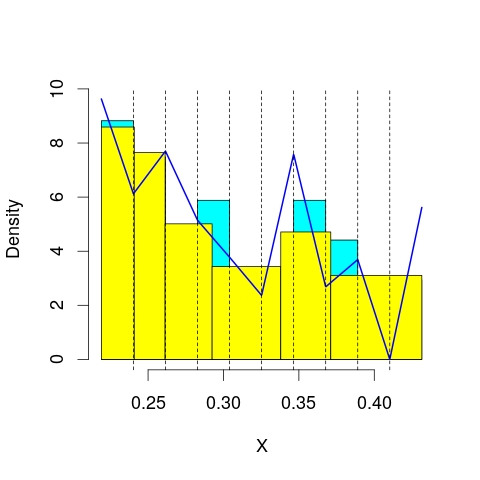

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.26456
mop.approx: Iteration 11. LL = 54.27129
mop.approx: Iteration 21. LL = 54.42485
mop.approx: Iteration 31. LL = 54.46123
mop.approx: Iteration 41. LL = 54.47475
mop.approx: Iteration 51. LL = 54.48096
mop.approx: Iteration 61. LL = 54.48424
mop.approx: Iteration 71. LL = 54.48618
mop.approx: Iteration 81. LL = 54.48743
mop.approx: Iteration 91. LL = 54.48828
mop.approx: Converged. Iteration 99. LL = 54.48884
[1] "Computing the linear combination of B-splines"


33.6944208109
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.11571
mop.approx: Iteration 11. LL = 53.24278
mop.approx: Iteration 21. LL = 53.3425
mop.approx: Iteration 31. LL = 53.36166
mop.approx: Iteration 41. LL = 53.36621
mop.approx: Iteration 51. LL = 53.3675
mop.approx: Converged. Iteration 54. LL = 53.36773
[1] "Computing the linear combination of B-splines"


30.8404416554
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.68741
mop.approx: Iteration 11. LL = 48.38255
mop.approx: Iteration 21. LL = 48.48141
mop.approx: Iteration 31. LL = 48.50694
mop.approx: Iteration 41. LL = 48.51426
mop.approx: Iteration 51. LL = 48.51628
mop.approx: Converged. Iteration 56. LL = 48.51668
[1] "Computing the linear combination of B-splines"


24.2565317596
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.84791
mop.approx: Iteration 11. LL = 47.95393
mop.approx: Iteration 21. LL = 48.16772
mop.approx: Iteration 31. LL = 48.22773
mop.approx: Iteration 41. LL = 48.25092
mop.approx: Iteration 51. LL = 48.26048
mop.approx: Iteration 61. LL = 48.26445
mop.approx: Iteration 71. LL = 48.26607
mop.approx: Converged. Iteration 79. LL = 48.2667
[1] "Computing the linear combination of B-splines"


22.2736765841
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.645068
mop.approx: Iteration 11. LL = 46.86014
mop.approx: Iteration 21. LL = 46.91932
mop.approx: Iteration 31. LL = 46.93004
mop.approx: Iteration 41. LL = 46.93363
mop.approx: Iteration 51. LL = 46.93536
mop.approx: Iteration 61. LL = 46.93644
mop.approx: Iteration 71. LL = 46.93721
mop.approx: Iteration 81. LL = 46.93782
mop.approx: Converged. Iteration 89. LL = 46.93827
[1] "Computing the linear combination of B-splines"


19.2123839961
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.930692
mop.approx: Iteration 11. LL = 46.97728
mop.approx: Iteration 21. LL = 47.02358
mop.approx: Iteration 31. LL = 47.03385
mop.approx: Iteration 41. LL = 47.03683
mop.approx: Iteration 51. LL = 47.03789
mop.approx: Converged. Iteration 56. LL = 47.03821
[1] "Computing the linear combination of B-splines"


17.5794571131
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.3970326
mop.approx: Iteration 11. LL = 47.29955
mop.approx: Iteration 21. LL = 47.37772
mop.approx: Iteration 31. LL = 47.38701
mop.approx: Iteration 41. LL = 47.39226
mop.approx: Iteration 51. LL = 47.39569
mop.approx: Iteration 61. LL = 47.39798
mop.approx: Iteration 71. LL = 47.39952
mop.approx: Iteration 81. LL = 47.40056
mop.approx: Iteration 91. LL = 47.40128
mop.approx: Converged. Iteration 97. LL = 47.40164
[1] "Computing the linear combination of B-splines"


16.2100110708
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.4141
mop.approx: Iteration 11. LL = 54.52787
mop.approx: Iteration 21. LL = 54.56558
mop.approx: Iteration 31. LL = 54.57181
mop.approx: Iteration 41. LL = 54.57376
mop.approx: Iteration 51. LL = 54.57459
mop.approx: Converged. Iteration 51. LL = 54.57465
[1] "Computing the linear combination of B-splines"


33.7802330976
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 33.780233097587988)
m reached
('Sum of Probabilities:', 0.9920477484040868)
chosen


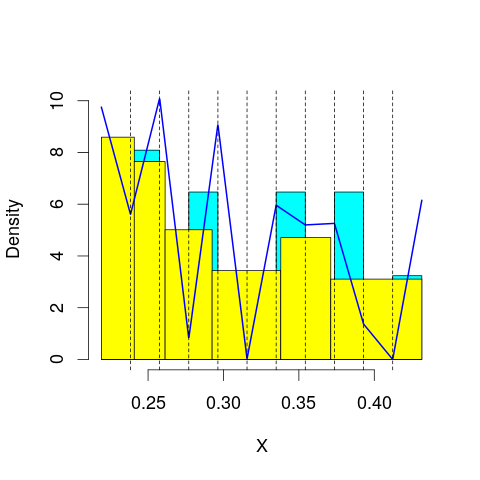

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.26456
mop.approx: Iteration 11. LL = 54.75805
mop.approx: Iteration 21. LL = 54.89207
mop.approx: Iteration 31. LL = 54.91837
mop.approx: Iteration 41. LL = 54.92559
mop.approx: Iteration 51. LL = 54.92793
mop.approx: Converged. Iteration 60. LL = 54.92878
[1] "Computing the linear combination of B-splines"


32.4014977149
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.11571
mop.approx: Iteration 11. LL = 53.87825
mop.approx: Iteration 21. LL = 54.07149
mop.approx: Iteration 31. LL = 54.11079
mop.approx: Iteration 41. LL = 54.12212
mop.approx: Iteration 51. LL = 54.12658
mop.approx: Iteration 61. LL = 54.12872
mop.approx: Iteration 71. LL = 54.12986
mop.approx: Converged. Iteration 80. LL = 54.13052
[1] "Computing the linear combination of B-splines"


29.8703653384
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.68741
mop.approx: Iteration 11. LL = 48.46006
mop.approx: Iteration 21. LL = 48.52858
mop.approx: Iteration 31. LL = 48.55386
mop.approx: Iteration 41. LL = 48.56724
mop.approx: Iteration 51. LL = 48.57513
mop.approx: Iteration 61. LL = 48.58006
mop.approx: Iteration 71. LL = 48.58326
mop.approx: Iteration 81. LL = 48.5854
mop.approx: Iteration 91. LL = 48.58686
mop.approx: Iteration 101. LL = 48.58788
mop.approx: Iteration 111. LL = 48.58862
mop.approx: Converged. Iteration 119. LL = 48.5891
[1] "Computing the linear combination of B-splines"


22.5960847169
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.84791
mop.approx: Iteration 11. LL = 48.50999
mop.approx: Iteration 21. LL = 48.75658
mop.approx: Iteration 31. LL = 48.81233
mop.approx: Iteration 41. LL = 48.82919
mop.approx: Iteration 51. LL = 48.83522
mop.approx: Iteration 61. LL = 48.83767
mop.approx: Iteration 71. LL = 48.83875
mop.approx: Converged. Iteration 76. LL = 48.83909
[1] "Computing the linear combination of B-splines"


21.1131999483
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.645068
mop.approx: Iteration 11. LL = 47.17519
mop.approx: Iteration 21. LL = 47.30853
mop.approx: Iteration 31. LL = 47.37096
mop.approx: Iteration 41. LL = 47.40512
mop.approx: Iteration 51. LL = 47.42319
mop.approx: Iteration 61. LL = 47.43244
mop.approx: Iteration 71. LL = 47.43714
mop.approx: Iteration 81. LL = 47.43957
mop.approx: Iteration 91. LL = 47.44089
mop.approx: Iteration 101. LL = 47.44164
mop.approx: Converged. Iteration 105. LL = 47.4419
[1] "Computing the linear combination of B-splines"


17.9831420084
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.930692
mop.approx: Iteration 11. LL = 46.99947
mop.approx: Iteration 21. LL = 47.01917
mop.approx: Iteration 31. LL = 47.0251
mop.approx: Iteration 41. LL = 47.02904
mop.approx: Iteration 51. LL = 47.03193
mop.approx: Iteration 61. LL = 47.03403
mop.approx: Iteration 71. LL = 47.03555
mop.approx: Iteration 81. LL = 47.03664
mop.approx: Iteration 91. LL = 47.03742
mop.approx: Iteration 101. LL = 47.03797
mop.approx: Converged. Iteration 101. LL = 47.03802
[1] "Computing the linear combination of B-splines"


15.8463962867
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.3970326
mop.approx: Iteration 11. LL = 47.41105
mop.approx: Iteration 21. LL = 47.47031
mop.approx: Iteration 31. LL = 47.48249
mop.approx: Iteration 41. LL = 47.48864
mop.approx: Iteration 51. LL = 47.49262
mop.approx: Iteration 61. LL = 47.49547
mop.approx: Iteration 71. LL = 47.49757
mop.approx: Iteration 81. LL = 47.49912
mop.approx: Iteration 91. LL = 47.50026
mop.approx: Iteration 101. LL = 47.50109
mop.approx: Iteration 111. LL = 47.50168
mop.approx: Converged. Iteration 112. LL = 47.50178
[1] "Computing the linear combination of B-splines"


14.5772826973
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.4141
mop.approx: Iteration 11. LL = 56.10395
mop.approx: Iteration 21. LL = 56.16827
mop.approx: Iteration 31. LL = 56.17892
mop.approx: Iteration 41. LL = 56.18142
mop.approx: Converged. Iteration 46. LL = 56.18191
[1] "Computing the linear combination of B-splines"


33.6546229162
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 33.654622916196374)
m reached
('Sum of Probabilities:', 0.9920940829617739)
chosen


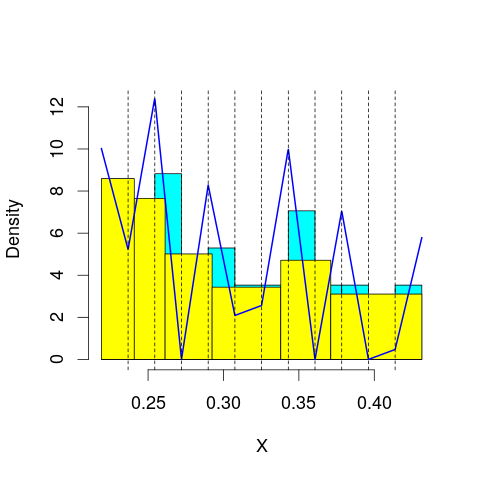

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.26456
mop.approx: Iteration 11. LL = 54.19787
mop.approx: Iteration 21. LL = 54.26797
mop.approx: Iteration 31. LL = 54.28529
mop.approx: Iteration 41. LL = 54.29186
mop.approx: Iteration 51. LL = 54.29481
mop.approx: Iteration 61. LL = 54.29625
mop.approx: Converged. Iteration 70. LL = 54.29698
[1] "Computing the linear combination of B-splines"


30.0368271524
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.11571
mop.approx: Iteration 11. LL = 54.98538
mop.approx: Iteration 21. LL = 55.22913
mop.approx: Iteration 31. LL = 55.27456
mop.approx: Iteration 41. LL = 55.28519
mop.approx: Iteration 51. LL = 55.28796
mop.approx: Converged. Iteration 58. LL = 55.28865
[1] "Computing the linear combination of B-splines"


29.2956316521
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.68741
mop.approx: Iteration 11. LL = 48.49894
mop.approx: Iteration 21. LL = 48.58047
mop.approx: Iteration 31. LL = 48.60021
mop.approx: Iteration 41. LL = 48.60527
mop.approx: Iteration 51. LL = 48.60687
mop.approx: Converged. Iteration 59. LL = 48.60748
[1] "Computing the linear combination of B-splines"


20.8815884036
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.84791
mop.approx: Iteration 11. LL = 49.06125
mop.approx: Iteration 21. LL = 49.3184
mop.approx: Iteration 31. LL = 49.3887
mop.approx: Iteration 41. LL = 49.41568
mop.approx: Iteration 51. LL = 49.42777
mop.approx: Iteration 61. LL = 49.43373
mop.approx: Iteration 71. LL = 49.43686
mop.approx: Iteration 81. LL = 49.43856
mop.approx: Iteration 91. LL = 49.43951
mop.approx: Converged. Iteration 97. LL = 49.43992
[1] "Computing the linear combination of B-splines"


19.9811624466
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.645068
mop.approx: Iteration 11. LL = 47.68918
mop.approx: Iteration 21. LL = 47.96366
mop.approx: Iteration 31. LL = 48.05439
mop.approx: Iteration 41. LL = 48.08721
mop.approx: Iteration 51. LL = 48.10019
mop.approx: Iteration 61. LL = 48.10586
mop.approx: Iteration 71. LL = 48.1086
mop.approx: Iteration 81. LL = 48.11007
mop.approx: Iteration 91. LL = 48.11091
mop.approx: Converged. Iteration 97. LL = 48.1113
[1] "Computing the linear combination of B-splines"


16.9196776365
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.930692
mop.approx: Iteration 11. LL = 47.1067
mop.approx: Iteration 21. LL = 47.1566
mop.approx: Iteration 31. LL = 47.18434
mop.approx: Iteration 41. LL = 47.20165
mop.approx: Iteration 51. LL = 47.21227
mop.approx: Iteration 61. LL = 47.21863
mop.approx: Iteration 71. LL = 47.22238
mop.approx: Iteration 81. LL = 47.22459
mop.approx: Iteration 91. LL = 47.22593
mop.approx: Iteration 101. LL = 47.22676
mop.approx: Converged. Iteration 109. LL = 47.22726
[1] "Computing the linear combination of B-splines"


14.302764666
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.3970326
mop.approx: Iteration 11. LL = 47.43975
mop.approx: Iteration 21. LL = 47.48826
mop.approx: Iteration 31. LL = 47.50475
mop.approx: Iteration 41. LL = 47.51325
mop.approx: Iteration 51. LL = 47.51775
mop.approx: Iteration 61. LL = 47.52015
mop.approx: Iteration 71. LL = 47.52144
mop.approx: Iteration 81. LL = 47.52214
mop.approx: Converged. Iteration 82. LL = 47.52223
[1] "Computing the linear combination of B-splines"


12.8648714148
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.4141
mop.approx: Iteration 11. LL = 55.66664
mop.approx: Iteration 21. LL = 55.67858
mop.approx: Iteration 31. LL = 55.67974
mop.approx: Converged. Iteration 31. LL = 55.67979
[1] "Computing the linear combination of B-splines"


31.4196383626
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 31.419638362619402)
m reached
('Sum of Probabilities:', 0.9924441185113266)
chosen


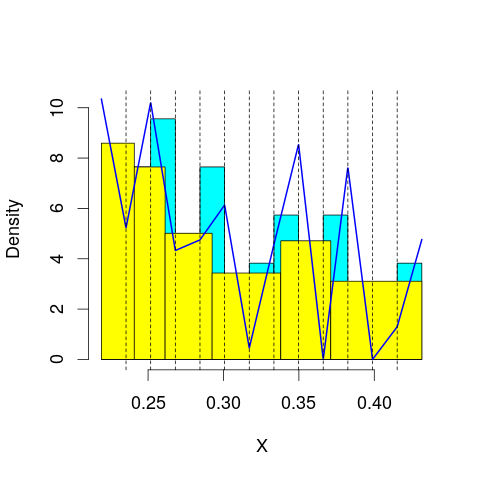

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.26456
mop.approx: Iteration 11. LL = 55.44272
mop.approx: Iteration 21. LL = 55.53747
mop.approx: Iteration 31. LL = 55.556
mop.approx: Iteration 41. LL = 55.56191
mop.approx: Iteration 51. LL = 55.56431
mop.approx: Iteration 61. LL = 55.56541
mop.approx: Converged. Iteration 65. LL = 55.56573
[1] "Computing the linear combination of B-splines"


29.5727092649
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.11571
mop.approx: Iteration 11. LL = 54.85136
mop.approx: Iteration 21. LL = 54.98915
mop.approx: Iteration 31. LL = 55.01668
mop.approx: Iteration 41. LL = 55.02623
mop.approx: Iteration 51. LL = 55.03082
mop.approx: Iteration 61. LL = 55.03343
mop.approx: Iteration 71. LL = 55.03505
mop.approx: Iteration 81. LL = 55.0361
mop.approx: Iteration 91. LL = 55.0368
mop.approx: Converged. Iteration 92. LL = 55.03691
[1] "Computing the linear combination of B-splines"


27.3110232783
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.68741
mop.approx: Iteration 11. LL = 49.46778
mop.approx: Iteration 21. LL = 49.70468
mop.approx: Iteration 31. LL = 49.75725
mop.approx: Iteration 41. LL = 49.77162
mop.approx: Iteration 51. LL = 49.77635
mop.approx: Iteration 61. LL = 49.77823
mop.approx: Iteration 71. LL = 49.77913
mop.approx: Converged. Iteration 76. LL = 49.77947
[1] "Computing the linear combination of B-splines"


20.3207179381
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.84791
mop.approx: Iteration 11. LL = 49.02945
mop.approx: Iteration 21. LL = 49.16301
mop.approx: Iteration 31. LL = 49.19608
mop.approx: Iteration 41. LL = 49.20874
mop.approx: Iteration 51. LL = 49.21462
mop.approx: Iteration 61. LL = 49.21767
mop.approx: Iteration 71. LL = 49.21936
mop.approx: Iteration 81. LL = 49.22033
mop.approx: Converged. Iteration 89. LL = 49.22085
[1] "Computing the linear combination of B-splines"


18.0292267618
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.645068
mop.approx: Iteration 11. LL = 48.56612
mop.approx: Iteration 21. LL = 48.94459
mop.approx: Iteration 31. LL = 49.03217
mop.approx: Iteration 41. LL = 49.06076
mop.approx: Iteration 51. LL = 49.07314
mop.approx: Iteration 61. LL = 49.07932
mop.approx: Iteration 71. LL = 49.0826
mop.approx: Iteration 81. LL = 49.08441
mop.approx: Iteration 91. LL = 49.08541
mop.approx: Converged. Iteration 98. LL = 49.08589
[1] "Computing the linear combination of B-splines"


16.1613938016
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.930692
mop.approx: Iteration 11. LL = 47.29318
mop.approx: Iteration 21. LL = 47.40603
mop.approx: Iteration 31. LL = 47.45963
mop.approx: Iteration 41. LL = 47.48593
mop.approx: Iteration 51. LL = 47.49992
mop.approx: Iteration 61. LL = 47.50807
mop.approx: Iteration 71. LL = 47.51319
mop.approx: Iteration 81. LL = 47.51657
mop.approx: Iteration 91. LL = 47.51889
mop.approx: Iteration 101. LL = 47.52054
mop.approx: Iteration 111. LL = 47.52172
mop.approx: Iteration 121. LL = 47.52259
mop.approx: Iteration 131. LL = 47.52323
mop.approx: Converged. Iteration 137. LL = 47.52359
[1] "Computing the linear combination of B-splines"


12.8662294968
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.3970326
mop.approx: Iteration 11. LL = 47.52037
mop.approx: Iteration 21. LL = 47.60319
mop.approx: Iteration 31. LL = 47.64233
mop.approx: Iteration 41. LL = 47.66476
mop.approx: Iteration 51. LL = 47.6783
mop.approx: Iteration 61. LL = 47.68679
mop.approx: Iteration 71. LL = 47.69233
mop.approx: Iteration 81. LL = 47.69606
mop.approx: Iteration 91. LL = 47.69867
mop.approx: Iteration 101. LL = 47.70056
mop.approx: Iteration 111. LL = 47.70196
mop.approx: Iteration 121. LL = 47.70304
mop.approx: Iteration 131. LL = 47.70388
mop.approx: Iteration 141. LL = 47.70455
mop.approx: Iteration 151. LL = 47.70509
mop.approx: Converged. Iteration 152. LL = 47.70518
[1] "Computing the linear combination of B-splines"


11.3149643643
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.4141
mop.approx: Iteration 11. LL = 54.31583
mop.approx: Converged. Iteration 12. LL = 54.31595
[1] "Computing the linear combination of B-splines"


28.3229310634
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 28.322931063375037)
m reached
('Sum of Probabilities:', 0.9925726426926089)
chosen


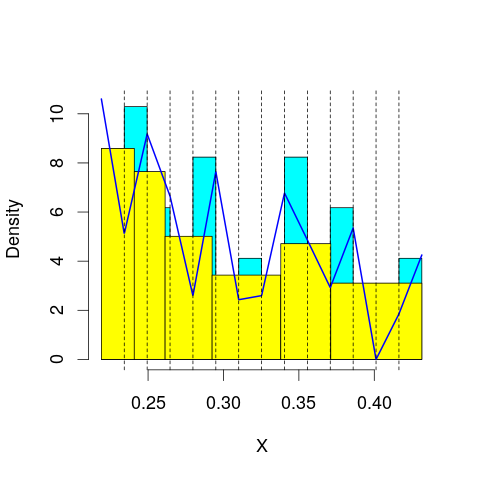

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.26456
mop.approx: Iteration 11. LL = 56.5828
mop.approx: Iteration 21. LL = 56.67718
mop.approx: Iteration 31. LL = 56.69199
mop.approx: Iteration 41. LL = 56.69548
mop.approx: Converged. Iteration 50. LL = 56.69646
[1] "Computing the linear combination of B-splines"


28.970576086
('best: ', 28.322931063375037, 'accepted difference:', 48.148982807737561, 'cur BIC:', 28.970576085991471)
m reached
('Sum of Probabilities:', 0.979083500948813)
chosen


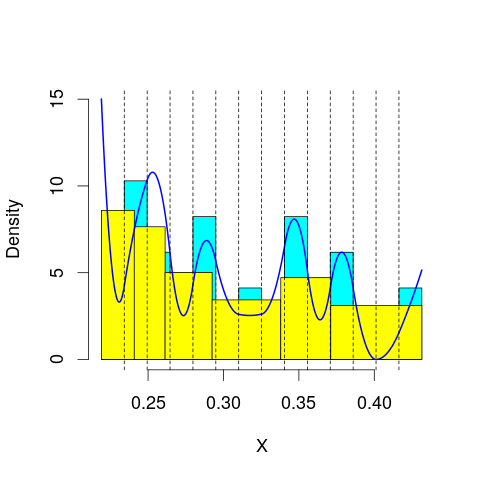

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.11571
mop.approx: Iteration 11. LL = 54.86889
mop.approx: Iteration 21. LL = 54.97134
mop.approx: Iteration 31. LL = 54.99252
mop.approx: Iteration 41. LL = 54.99958
mop.approx: Iteration 51. LL = 55.00245
mop.approx: Iteration 61. LL = 55.00378
mop.approx: Converged. Iteration 68. LL = 55.00433
[1] "Computing the linear combination of B-splines"


25.5455775926
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.68741
mop.approx: Iteration 11. LL = 50.10449
mop.approx: Iteration 21. LL = 50.24453
mop.approx: Iteration 31. LL = 50.25737
mop.approx: Iteration 41. LL = 50.25933
mop.approx: Converged. Iteration 48. LL = 50.25984
[1] "Computing the linear combination of B-splines"


19.0682207018
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.84791
mop.approx: Iteration 11. LL = 49.31956
mop.approx: Iteration 21. LL = 49.52069
mop.approx: Iteration 31. LL = 49.58736
mop.approx: Iteration 41. LL = 49.61607
mop.approx: Iteration 51. LL = 49.62982
mop.approx: Iteration 61. LL = 49.63688
mop.approx: Iteration 71. LL = 49.64072
mop.approx: Iteration 81. LL = 49.6429
mop.approx: Iteration 91. LL = 49.64419
mop.approx: Iteration 101. LL = 49.64498
mop.approx: Converged. Iteration 106. LL = 49.6453
[1] "Computing the linear combination of B-splines"


16.7208119216
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.645068
mop.approx: Iteration 11. LL = 49.10637
mop.approx: Iteration 21. LL = 49.39877
mop.approx: Iteration 31. LL = 49.44525
mop.approx: Iteration 41. LL = 49.45585
mop.approx: Iteration 51. LL = 49.459
mop.approx: Iteration 61. LL = 49.46012
mop.approx: Converged. Iteration 64. LL = 49.46034
[1] "Computing the linear combination of B-splines"


14.8029836155
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.930692
mop.approx: Iteration 11. LL = 47.87423
mop.approx: Iteration 21. LL = 48.13835
mop.approx: Iteration 31. LL = 48.22024
mop.approx: Iteration 41. LL = 48.2508
mop.approx: Iteration 51. LL = 48.26484
mop.approx: Iteration 61. LL = 48.27221
mop.approx: Iteration 71. LL = 48.27642
mop.approx: Iteration 81. LL = 48.27898
mop.approx: Iteration 91. LL = 48.28061
mop.approx: Iteration 101. LL = 48.28169
mop.approx: Iteration 111. LL = 48.28244
mop.approx: Converged. Iteration 118. LL = 48.28287
[1] "Computing the linear combination of B-splines"


11.8926439545
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.3970326
mop.approx: Iteration 11. LL = 47.56748
mop.approx: Iteration 21. LL = 47.63936
mop.approx: Iteration 31. LL = 47.67355
mop.approx: Iteration 41. LL = 47.69295
mop.approx: Iteration 51. LL = 47.7045
mop.approx: Iteration 61. LL = 47.71161
mop.approx: Iteration 71. LL = 47.71611
mop.approx: Iteration 81. LL = 47.71901
mop.approx: Iteration 91. LL = 47.7209
mop.approx: Iteration 101. LL = 47.72215
mop.approx: Iteration 111. LL = 47.72298
mop.approx: Converged. Iteration 119. LL = 47.72349
[1] "Computing the linear combination of B-splines"


9.60034112388
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.4141
mop.approx: Iteration 11. LL = 57.29196
mop.approx: Iteration 21. LL = 57.30248
mop.approx: Converged. Iteration 22. LL = 57.30259
[1] "Computing the linear combination of B-splines"


29.5766985288
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 29.576698528839696)
m reached
('Sum of Probabilities:', 0.9922573901987993)
chosen


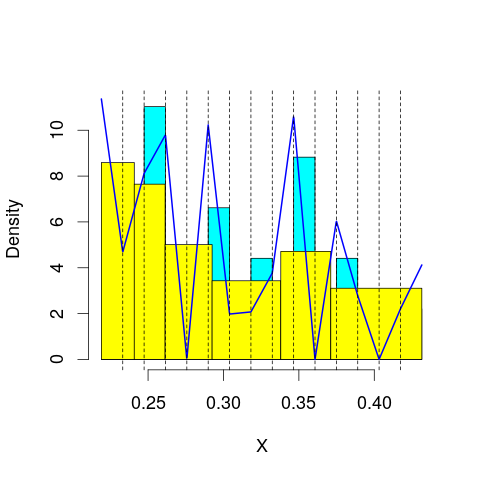

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.26456
mop.approx: Iteration 11. LL = 56.1295
mop.approx: Iteration 21. LL = 56.19498
mop.approx: Iteration 31. LL = 56.20136
mop.approx: Converged. Iteration 38. LL = 56.20224
[1] "Computing the linear combination of B-splines"


26.7434861432
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.11571
mop.approx: Iteration 11. LL = 55.99921
mop.approx: Iteration 21. LL = 56.10845
mop.approx: Iteration 31. LL = 56.12863
mop.approx: Iteration 41. LL = 56.13564
mop.approx: Iteration 51. LL = 56.13856
mop.approx: Iteration 61. LL = 56.13991
mop.approx: Converged. Iteration 69. LL = 56.14055
[1] "Computing the linear combination of B-splines"


24.9489307612
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.68741
mop.approx: Iteration 11. LL = 50.21087
mop.approx: Iteration 21. LL = 50.32104
mop.approx: Iteration 31. LL = 50.33881
mop.approx: Iteration 41. LL = 50.34434
mop.approx: Iteration 51. LL = 50.34691
mop.approx: Iteration 61. LL = 50.34835
mop.approx: Iteration 71. LL = 50.34925
mop.approx: Converged. Iteration 80. LL = 50.34984
[1] "Computing the linear combination of B-splines"


17.425349739
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.84791
mop.approx: Iteration 11. LL = 49.9085
mop.approx: Iteration 21. LL = 50.09598
mop.approx: Iteration 31. LL = 50.11891
mop.approx: Iteration 41. LL = 50.12349
mop.approx: Iteration 51. LL = 50.12525
mop.approx: Iteration 61. LL = 50.12628
mop.approx: Iteration 71. LL = 50.12699
mop.approx: Converged. Iteration 78. LL = 50.12742
[1] "Computing the linear combination of B-splines"


15.4700605984
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.645068
mop.approx: Iteration 11. LL = 49.4632
mop.approx: Iteration 21. LL = 49.72602
mop.approx: Iteration 31. LL = 49.77933
mop.approx: Iteration 41. LL = 49.79765
mop.approx: Iteration 51. LL = 49.80535
mop.approx: Iteration 61. LL = 49.809
mop.approx: Iteration 71. LL = 49.81089
mop.approx: Iteration 81. LL = 49.81193
mop.approx: Converged. Iteration 89. LL = 49.81247
[1] "Computing the linear combination of B-splines"


13.4222465753
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.930692
mop.approx: Iteration 11. LL = 48.54344
mop.approx: Iteration 21. LL = 48.79506
mop.approx: Iteration 31. LL = 48.83888
mop.approx: Iteration 41. LL = 48.84886
mop.approx: Iteration 51. LL = 48.85197
mop.approx: Iteration 61. LL = 48.85328
mop.approx: Iteration 71. LL = 48.85397
mop.approx: Converged. Iteration 72. LL = 48.85407
[1] "Computing the linear combination of B-splines"


10.7309729542
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.3970326
mop.approx: Iteration 11. LL = 47.80666
mop.approx: Iteration 21. LL = 47.98673
mop.approx: Iteration 31. LL = 48.06064
mop.approx: Iteration 41. LL = 48.08981
mop.approx: Iteration 51. LL = 48.10124
mop.approx: Iteration 61. LL = 48.10592
mop.approx: Iteration 71. LL = 48.10799
mop.approx: Iteration 81. LL = 48.10901
mop.approx: Converged. Iteration 88. LL = 48.10948
[1] "Computing the linear combination of B-splines"


8.25355837322
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.4141
mop.approx: Iteration 11. LL = 57.34635
mop.approx: Converged. Iteration 20. LL = 57.35361
[1] "Computing the linear combination of B-splines"


27.8948529415
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 27.894852941486)
m reached
('Sum of Probabilities:', 0.9918107109905457)
chosen


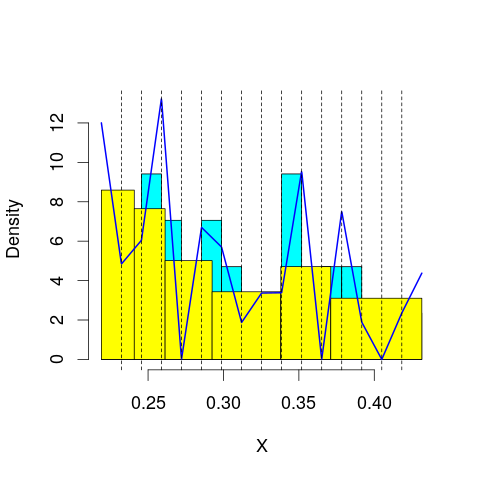

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.26456
mop.approx: Iteration 11. LL = 56.5258
mop.approx: Iteration 21. LL = 56.63654
mop.approx: Iteration 31. LL = 56.66062
mop.approx: Iteration 41. LL = 56.66918
mop.approx: Iteration 51. LL = 56.67292
mop.approx: Iteration 61. LL = 56.67466
mop.approx: Iteration 71. LL = 56.67549
mop.approx: Converged. Iteration 71. LL = 56.67554
[1] "Computing the linear combination of B-splines"


25.4839195707
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.11571
mop.approx: Iteration 11. LL = 56.34189
mop.approx: Iteration 21. LL = 56.43667
mop.approx: Iteration 31. LL = 56.45384
mop.approx: Iteration 41. LL = 56.45893
mop.approx: Iteration 51. LL = 56.46081
mop.approx: Iteration 61. LL = 56.46162
mop.approx: Converged. Iteration 61. LL = 56.46168
[1] "Computing the linear combination of B-splines"


23.5371847101
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.68741
mop.approx: Iteration 11. LL = 50.57556
mop.approx: Iteration 21. LL = 50.70805
mop.approx: Iteration 31. LL = 50.74757
mop.approx: Iteration 41. LL = 50.76424
mop.approx: Iteration 51. LL = 50.77244
mop.approx: Iteration 61. LL = 50.7768
mop.approx: Iteration 71. LL = 50.77919
mop.approx: Iteration 81. LL = 50.78053
mop.approx: Iteration 91. LL = 50.78129
mop.approx: Converged. Iteration 93. LL = 50.78145
[1] "Computing the linear combination of B-splines"


16.1240954772
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.84791
mop.approx: Iteration 11. LL = 50.2938
mop.approx: Iteration 21. LL = 50.44266
mop.approx: Iteration 31. LL = 50.45981
mop.approx: Iteration 41. LL = 50.46373
mop.approx: Iteration 51. LL = 50.46509
mop.approx: Converged. Iteration 57. LL = 50.46554
[1] "Computing the linear combination of B-splines"


14.0753107991
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.645068
mop.approx: Iteration 11. LL = 49.77646
mop.approx: Iteration 21. LL = 49.96819
mop.approx: Iteration 31. LL = 50.00209
mop.approx: Iteration 41. LL = 50.01425
mop.approx: Iteration 51. LL = 50.02079
mop.approx: Iteration 61. LL = 50.0253
mop.approx: Iteration 71. LL = 50.02872
mop.approx: Iteration 81. LL = 50.03137
mop.approx: Iteration 91. LL = 50.03342
mop.approx: Iteration 101. LL = 50.03499
mop.approx: Iteration 111. LL = 50.03618
mop.approx: Iteration 121. LL = 50.03708
mop.approx: Iteration 131. LL = 50.03774
mop.approx: Converged. Iteration 135. LL = 50.038
[1] "Computing the linear combination of B-splines"


11.9149054959
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.930692
mop.approx: Iteration 11. LL = 49.15173
mop.approx: Iteration 21. LL = 49.47224
mop.approx: Iteration 31. LL = 49.54587
mop.approx: Iteration 41. LL = 49.56953
mop.approx: Iteration 51. LL = 49.57883
mop.approx: Iteration 61. LL = 49.58305
mop.approx: Iteration 71. LL = 49.5852
mop.approx: Iteration 81. LL = 49.58641
mop.approx: Iteration 91. LL = 49.58713
mop.approx: Converged. Iteration 94. LL = 49.58733
[1] "Computing the linear combination of B-splines"


9.73137383967
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.3970326
mop.approx: Iteration 11. LL = 48.28093
mop.approx: Iteration 21. LL = 48.49938
mop.approx: Iteration 31. LL = 48.5502
mop.approx: Iteration 41. LL = 48.56245
mop.approx: Iteration 51. LL = 48.56562
mop.approx: Iteration 61. LL = 48.56655
mop.approx: Converged. Iteration 61. LL = 48.56659
[1] "Computing the linear combination of B-splines"


6.97778847683
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.4141
mop.approx: Iteration 11. LL = 56.92264
mop.approx: Iteration 21. LL = 56.93788
mop.approx: Converged. Iteration 24. LL = 56.93823
[1] "Computing the linear combination of B-splines"


25.7466041482
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 25.746604148170633)
m reached
('Sum of Probabilities:', 0.9912972552134316)
chosen


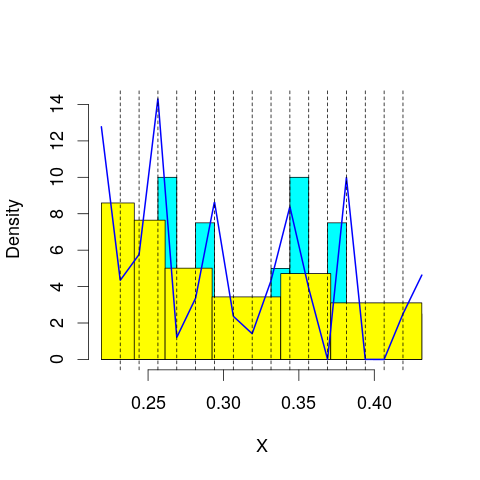

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.26456
mop.approx: Iteration 11. LL = 57.50247
mop.approx: Iteration 21. LL = 57.54756
mop.approx: Iteration 31. LL = 57.55207
mop.approx: Converged. Iteration 37. LL = 57.55274
[1] "Computing the linear combination of B-splines"


24.6282490131
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.11571
mop.approx: Iteration 11. LL = 56.73135
mop.approx: Iteration 21. LL = 56.88669
mop.approx: Iteration 31. LL = 56.93945
mop.approx: Iteration 41. LL = 56.96296
mop.approx: Iteration 51. LL = 56.97417
mop.approx: Iteration 61. LL = 56.97971
mop.approx: Iteration 71. LL = 56.98253
mop.approx: Iteration 81. LL = 56.98399
mop.approx: Iteration 91. LL = 56.98478
mop.approx: Converged. Iteration 91. LL = 56.98483
[1] "Computing the linear combination of B-splines"


22.3274744626
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.68741
mop.approx: Iteration 11. LL = 50.79708
mop.approx: Iteration 21. LL = 50.8451
mop.approx: Iteration 31. LL = 50.85074
mop.approx: Iteration 41. LL = 50.85289
mop.approx: Iteration 51. LL = 50.85408
mop.approx: Iteration 61. LL = 50.85483
mop.approx: Converged. Iteration 65. LL = 50.8551
[1] "Computing the linear combination of B-splines"


14.4648711378
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.84791
mop.approx: Iteration 11. LL = 50.88481
mop.approx: Iteration 21. LL = 51.09638
mop.approx: Iteration 31. LL = 51.15791
mop.approx: Iteration 41. LL = 51.18456
mop.approx: Iteration 51. LL = 51.19638
mop.approx: Iteration 61. LL = 51.20177
mop.approx: Iteration 71. LL = 51.20441
mop.approx: Iteration 81. LL = 51.20585
mop.approx: Iteration 91. LL = 51.20672
mop.approx: Converged. Iteration 98. LL = 51.20719
[1] "Computing the linear combination of B-splines"


13.0840992544
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.645068
mop.approx: Iteration 11. LL = 49.93841
mop.approx: Iteration 21. LL = 50.09407
mop.approx: Iteration 31. LL = 50.12059
mop.approx: Iteration 41. LL = 50.13061
mop.approx: Iteration 51. LL = 50.13587
mop.approx: Iteration 61. LL = 50.13908
mop.approx: Iteration 71. LL = 50.14117
mop.approx: Iteration 81. LL = 50.1426
mop.approx: Iteration 91. LL = 50.14361
mop.approx: Iteration 101. LL = 50.14433
mop.approx: Converged. Iteration 107. LL = 50.14471
[1] "Computing the linear combination of B-splines"


10.2887493617
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.930692
mop.approx: Iteration 11. LL = 49.84465
mop.approx: Iteration 21. LL = 50.29575
mop.approx: Iteration 31. LL = 50.4118
mop.approx: Iteration 41. LL = 50.45143
mop.approx: Iteration 51. LL = 50.46773
mop.approx: Iteration 61. LL = 50.47545
mop.approx: Iteration 71. LL = 50.47949
mop.approx: Iteration 81. LL = 50.48176
mop.approx: Iteration 91. LL = 50.4831
mop.approx: Iteration 101. LL = 50.48393
mop.approx: Converged. Iteration 107. LL = 50.48433
[1] "Computing the linear combination of B-splines"


8.89548876666
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.3970326
mop.approx: Iteration 11. LL = 48.77267
mop.approx: Iteration 21. LL = 48.98674
mop.approx: Iteration 31. LL = 49.03306
mop.approx: Iteration 41. LL = 49.04881
mop.approx: Iteration 51. LL = 49.05589
mop.approx: Iteration 61. LL = 49.0595
mop.approx: Iteration 71. LL = 49.06147
mop.approx: Iteration 81. LL = 49.06261
mop.approx: Iteration 91. LL = 49.06329
mop.approx: Converged. Iteration 93. LL = 49.06344
[1] "Computing the linear combination of B-splines"


5.74158388869
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.4141
mop.approx: Iteration 11. LL = 58.19804
mop.approx: Iteration 21. LL = 58.23211
mop.approx: Iteration 31. LL = 58.2361
mop.approx: Converged. Iteration 38. LL = 58.23682
[1] "Computing the linear combination of B-splines"


25.3123318929
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 25.312331892891713)
m reached
('Sum of Probabilities:', 0.9903844709487217)
chosen


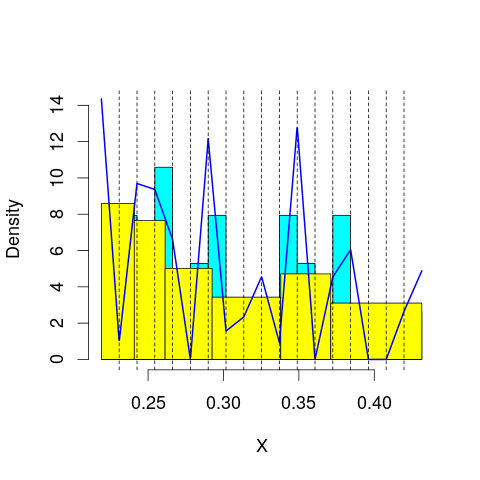

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.26456
mop.approx: Iteration 11. LL = 57.6755
mop.approx: Iteration 21. LL = 57.70894
mop.approx: Converged. Iteration 26. LL = 57.70974
[1] "Computing the linear combination of B-splines"


23.0523817344
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.11571
mop.approx: Iteration 11. LL = 57.04135
mop.approx: Iteration 21. LL = 57.09991
mop.approx: Iteration 31. LL = 57.10886
mop.approx: Iteration 41. LL = 57.11198
mop.approx: Iteration 51. LL = 57.11351
mop.approx: Iteration 61. LL = 57.11436
mop.approx: Converged. Iteration 64. LL = 57.1146
[1] "Computing the linear combination of B-splines"


20.7243753686
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.68741
mop.approx: Iteration 11. LL = 51.22485
mop.approx: Iteration 21. LL = 51.32187
mop.approx: Iteration 31. LL = 51.35049
mop.approx: Iteration 41. LL = 51.36349
mop.approx: Iteration 51. LL = 51.36986
mop.approx: Iteration 61. LL = 51.3731
mop.approx: Iteration 71. LL = 51.37483
mop.approx: Iteration 81. LL = 51.3758
mop.approx: Converged. Iteration 89. LL = 51.37634
[1] "Computing the linear combination of B-splines"


13.2532432525
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.84791
mop.approx: Iteration 11. LL = 50.98719
mop.approx: Iteration 21. LL = 51.08435
mop.approx: Iteration 31. LL = 51.09889
mop.approx: Iteration 41. LL = 51.10305
mop.approx: Iteration 51. LL = 51.1047
mop.approx: Iteration 61. LL = 51.10548
mop.approx: Converged. Iteration 63. LL = 51.10564
[1] "Computing the linear combination of B-splines"


11.2496733574
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.645068
mop.approx: Iteration 11. LL = 50.48798
mop.approx: Iteration 21. LL = 50.71215
mop.approx: Iteration 31. LL = 50.76362
mop.approx: Iteration 41. LL = 50.78679
mop.approx: Iteration 51. LL = 50.79916
mop.approx: Iteration 61. LL = 50.80621
mop.approx: Iteration 71. LL = 50.81047
mop.approx: Iteration 81. LL = 50.81317
mop.approx: Iteration 91. LL = 50.81496
mop.approx: Iteration 101. LL = 50.81617
mop.approx: Iteration 111. LL = 50.81701
mop.approx: Converged. Iteration 120. LL = 50.81759
[1] "Computing the linear combination of B-splines"


9.22876125806
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.930692
mop.approx: Iteration 11. LL = 49.9875
mop.approx: Iteration 21. LL = 50.28688
mop.approx: Iteration 31. LL = 50.34441
mop.approx: Iteration 41. LL = 50.36172
mop.approx: Iteration 51. LL = 50.3689
mop.approx: Iteration 61. LL = 50.37249
mop.approx: Iteration 71. LL = 50.37448
mop.approx: Iteration 81. LL = 50.37569
mop.approx: Iteration 91. LL = 50.37648
mop.approx: Converged. Iteration 98. LL = 50.37692
[1] "Computing the linear combination of B-splines"


7.05521713545
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.3970326
mop.approx: Iteration 11. LL = 49.52334
mop.approx: Iteration 21. LL = 49.87716
mop.approx: Iteration 31. LL = 49.96567
mop.approx: Iteration 41. LL = 49.997
mop.approx: Iteration 51. LL = 50.01043
mop.approx: Iteration 61. LL = 50.01684
mop.approx: Iteration 71. LL = 50.02015
mop.approx: Iteration 81. LL = 50.02199
mop.approx: Iteration 91. LL = 50.02307
mop.approx: Iteration 101. LL = 50.02377
mop.approx: Converged. Iteration 104. LL = 50.02398
[1] "Computing the linear combination of B-splines"


4.96910955284
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.4141
mop.approx: Iteration 11. LL = 58.18754
mop.approx: Iteration 21. LL = 58.22772
mop.approx: Iteration 31. LL = 58.23324
mop.approx: Converged. Iteration 38. LL = 58.23408
[1] "Computing the linear combination of B-splines"


23.5767217791
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 23.576721779082177)
m reached
('Sum of Probabilities:', 0.9897409145966567)
chosen


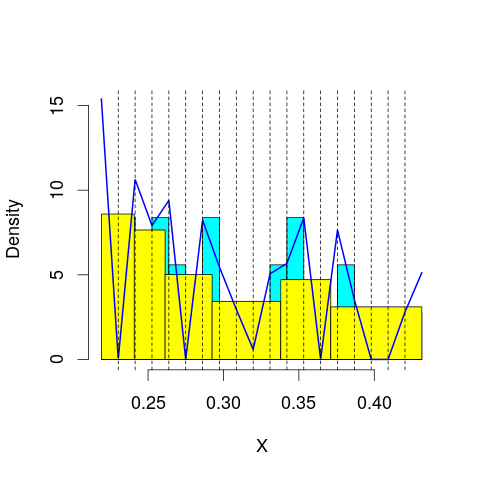

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.26456
mop.approx: Iteration 11. LL = 58.64998
mop.approx: Iteration 21. LL = 58.77603
mop.approx: Iteration 31. LL = 58.7957
mop.approx: Iteration 41. LL = 58.80212
mop.approx: Iteration 51. LL = 58.80473
mop.approx: Iteration 61. LL = 58.80593
mop.approx: Converged. Iteration 66. LL = 58.80633
[1] "Computing the linear combination of B-splines"


22.4161008378
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.11571
mop.approx: Iteration 11. LL = 56.76017
mop.approx: Iteration 21. LL = 56.78808
mop.approx: Iteration 31. LL = 56.79436
mop.approx: Iteration 41. LL = 56.79777
mop.approx: Iteration 51. LL = 56.79988
mop.approx: Iteration 61. LL = 56.80127
mop.approx: Iteration 71. LL = 56.80222
mop.approx: Iteration 81. LL = 56.80289
mop.approx: Converged. Iteration 81. LL = 56.80294
[1] "Computing the linear combination of B-splines"


18.6798493216
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.68741
mop.approx: Iteration 11. LL = 52.24931
mop.approx: Iteration 21. LL = 52.43837
mop.approx: Iteration 31. LL = 52.4728
mop.approx: Iteration 41. LL = 52.48509
mop.approx: Iteration 51. LL = 52.49068
mop.approx: Iteration 61. LL = 52.49357
mop.approx: Iteration 71. LL = 52.49518
mop.approx: Iteration 81. LL = 52.49613
mop.approx: Converged. Iteration 88. LL = 52.49662
[1] "Computing the linear combination of B-splines"


12.6406572936
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.84791
mop.approx: Iteration 11. LL = 50.97047
mop.approx: Iteration 21. LL = 51.02684
mop.approx: Iteration 31. LL = 51.04399
mop.approx: Iteration 41. LL = 51.054
mop.approx: Iteration 51. LL = 51.06003
mop.approx: Iteration 61. LL = 51.06364
mop.approx: Iteration 71. LL = 51.0658
mop.approx: Iteration 81. LL = 51.06713
mop.approx: Iteration 91. LL = 51.06797
mop.approx: Converged. Iteration 98. LL = 51.06844
[1] "Computing the linear combination of B-splines"


9.47960629006
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.645068
mop.approx: Iteration 11. LL = 51.09728
mop.approx: Iteration 21. LL = 51.36211
mop.approx: Iteration 31. LL = 51.41858
mop.approx: Iteration 41. LL = 51.43909
mop.approx: Iteration 51. LL = 51.44855
mop.approx: Iteration 61. LL = 51.45362
mop.approx: Iteration 71. LL = 51.45665
mop.approx: Iteration 81. LL = 51.4586
mop.approx: Iteration 91. LL = 51.45993
mop.approx: Iteration 101. LL = 51.46087
mop.approx: Iteration 111. LL = 51.46156
mop.approx: Converged. Iteration 116. LL = 51.46188
[1] "Computing the linear combination of B-splines"


8.1401843584
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.930692
mop.approx: Iteration 11. LL = 50.11624
mop.approx: Iteration 21. LL = 50.3314
mop.approx: Iteration 31. LL = 50.36815
mop.approx: Iteration 41. LL = 50.38315
mop.approx: Iteration 51. LL = 50.39212
mop.approx: Iteration 61. LL = 50.39788
mop.approx: Iteration 71. LL = 50.40161
mop.approx: Iteration 81. LL = 50.40405
mop.approx: Iteration 91. LL = 50.40567
mop.approx: Iteration 101. LL = 50.40675
mop.approx: Iteration 111. LL = 50.40749
mop.approx: Converged. Iteration 116. LL = 50.40781
[1] "Computing the linear combination of B-splines"


5.35323053864
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.3970326
mop.approx: Iteration 11. LL = 50.08605
mop.approx: Iteration 21. LL = 50.44766
mop.approx: Iteration 31. LL = 50.51445
mop.approx: Iteration 41. LL = 50.53264
mop.approx: Iteration 51. LL = 50.54034
mop.approx: Iteration 61. LL = 50.54473
mop.approx: Iteration 71. LL = 50.54762
mop.approx: Iteration 81. LL = 50.54966
mop.approx: Iteration 91. LL = 50.55115
mop.approx: Iteration 101. LL = 50.55226
mop.approx: Iteration 111. LL = 50.55313
mop.approx: Iteration 121. LL = 50.5538
mop.approx: Converged. Iteration 129. LL = 50.55429
[1] "Computing the linear combination of B-splines"


3.76680725272
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.4141
mop.approx: Iteration 11. LL = 59.51442
mop.approx: Iteration 21. LL = 59.55445
mop.approx: Iteration 31. LL = 59.56146
mop.approx: Iteration 41. LL = 59.56413
mop.approx: Iteration 51. LL = 59.56529
mop.approx: Converged. Iteration 54. LL = 59.56555
[1] "Computing the linear combination of B-splines"


23.1753193727
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 23.175319372683148)
m reached
('Sum of Probabilities:', 0.9892465976303918)
chosen


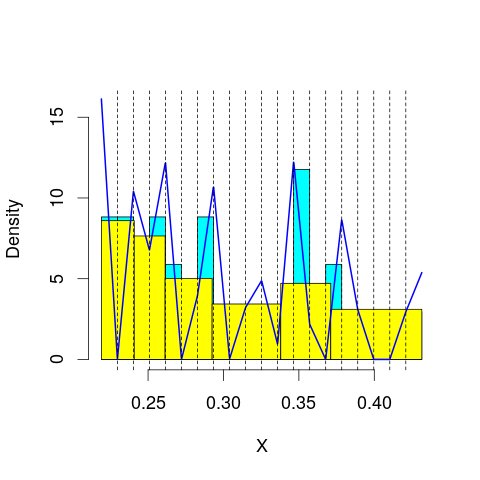

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.26456
mop.approx: Iteration 11. LL = 58.2401
mop.approx: Iteration 21. LL = 58.3002
mop.approx: Iteration 31. LL = 58.30448
mop.approx: Converged. Iteration 36. LL = 58.30497
[1] "Computing the linear combination of B-splines"


20.181872389
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 49.11571
mop.approx: Iteration 11. LL = 57.86873
mop.approx: Iteration 21. LL = 57.9922
mop.approx: Iteration 31. LL = 58.01797
mop.approx: Iteration 41. LL = 58.02612
mop.approx: Iteration 51. LL = 58.02946
mop.approx: Iteration 61. LL = 58.03119
mop.approx: Iteration 71. LL = 58.03223
mop.approx: Iteration 81. LL = 58.03292
mop.approx: Converged. Iteration 81. LL = 58.03298
[1] "Computing the linear combination of B-splines"


18.1770160374
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.68741
mop.approx: Iteration 11. LL = 51.69239
mop.approx: Iteration 21. LL = 51.75429
mop.approx: Iteration 31. LL = 51.76302
mop.approx: Iteration 41. LL = 51.76567
mop.approx: Iteration 51. LL = 51.76676
mop.approx: Converged. Iteration 56. LL = 51.76712
[1] "Computing the linear combination of B-splines"


10.1782870759
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.84791
mop.approx: Iteration 11. LL = 52.0039
mop.approx: Iteration 21. LL = 52.17699
mop.approx: Iteration 31. LL = 52.20849
mop.approx: Iteration 41. LL = 52.2194
mop.approx: Iteration 51. LL = 52.22455
mop.approx: Iteration 61. LL = 52.22724
mop.approx: Iteration 71. LL = 52.2287
mop.approx: Iteration 81. LL = 52.2295
mop.approx: Converged. Iteration 83. LL = 52.22966
[1] "Computing the linear combination of B-splines"


8.90795899561
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.645068
mop.approx: Iteration 11. LL = 50.85852
mop.approx: Iteration 21. LL = 50.96754
mop.approx: Iteration 31. LL = 50.98757
mop.approx: Iteration 41. LL = 50.99577
mop.approx: Iteration 51. LL = 51.00051
mop.approx: Iteration 61. LL = 51.00374
mop.approx: Iteration 71. LL = 51.00611
mop.approx: Iteration 81. LL = 51.00789
mop.approx: Iteration 91. LL = 51.00926
mop.approx: Iteration 101. LL = 51.01032
mop.approx: Iteration 111. LL = 51.01114
mop.approx: Iteration 121. LL = 51.01178
mop.approx: Converged. Iteration 125. LL = 51.01205
[1] "Computing the linear combination of B-splines"


5.95748360709
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.930692
mop.approx: Iteration 11. LL = 50.79401
mop.approx: Iteration 21. LL = 51.11549
mop.approx: Iteration 31. LL = 51.18266
mop.approx: Iteration 41. LL = 51.20692
mop.approx: Iteration 51. LL = 51.21836
mop.approx: Iteration 61. LL = 51.22443
mop.approx: Iteration 71. LL = 51.22785
mop.approx: Iteration 81. LL = 51.22984
mop.approx: Iteration 91. LL = 51.23103
mop.approx: Iteration 101. LL = 51.23175
mop.approx: Converged. Iteration 103. LL = 51.2319
[1] "Computing the linear combination of B-splines"


4.44445241353
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -0.3970326
mop.approx: Iteration 11. LL = 50.12163
mop.approx: Iteration 21. LL = 50.36969
mop.approx: Iteration 31. LL = 50.4189
mop.approx: Iteration 41. LL = 50.43506
mop.approx: Iteration 51. LL = 50.44289
mop.approx: Iteration 61. LL = 50.44769
mop.approx: Iteration 71. LL = 50.45098
mop.approx: Iteration 81. LL = 50.45333
mop.approx: Iteration 91. LL = 50.45503
mop.approx: Iteration 101. LL = 50.45628
mop.approx: Iteration 111. LL = 50.4572
mop.approx: Iteration 121. LL = 50.45788
mop.approx: Converged. Iteration 126. LL = 50.4582
[1] "Computing the linear combination of B-splines"


1.93733885192
lfps_8
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.77466
mop.approx: Iteration 11. LL = 80.3371
mop.approx: Converged. Iteration 14. LL = 80.33805
[1] "Computing the linear combination of B-splines"


75.1394510142
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 75.139451014171811)
m reached
('Sum of Probabilities:', 0.984247304542817)
chosen


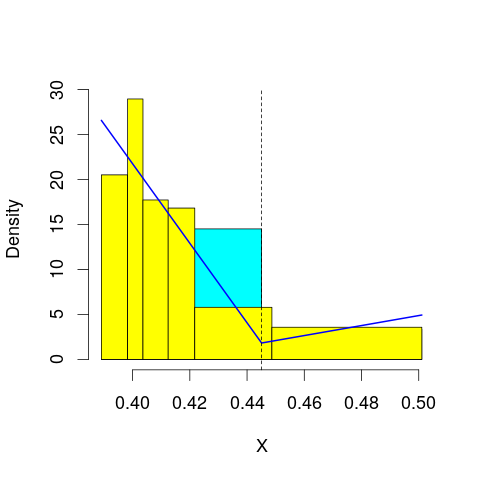

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.49269
mop.approx: Iteration 11. LL = 79.43088
mop.approx: Iteration 21. LL = 79.47138
mop.approx: Iteration 31. LL = 79.48406
mop.approx: Iteration 41. LL = 79.48877
mop.approx: Iteration 51. LL = 79.49063
mop.approx: Converged. Iteration 55. LL = 79.49109
[1] "Computing the linear combination of B-splines"


72.5596168638
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.21319
mop.approx: Iteration 11. LL = 79.05978
mop.approx: Iteration 21. LL = 79.15125
mop.approx: Iteration 31. LL = 79.16278
mop.approx: Converged. Iteration 38. LL = 79.16412
[1] "Computing the linear combination of B-splines"


70.499782363
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.42242
mop.approx: Iteration 11. LL = 57.61246
mop.approx: Iteration 21. LL = 57.70585
mop.approx: Iteration 31. LL = 57.72416
mop.approx: Iteration 41. LL = 57.73062
mop.approx: Iteration 51. LL = 57.73346
mop.approx: Iteration 61. LL = 57.73484
mop.approx: Converged. Iteration 69. LL = 57.7355
[1] "Computing the linear combination of B-splines"


47.3382939653
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.71327
mop.approx: Iteration 11. LL = 54.47569
mop.approx: Iteration 21. LL = 54.78803
mop.approx: Iteration 31. LL = 54.8079
mop.approx: Converged. Iteration 38. LL = 54.80911
[1] "Computing the linear combination of B-splines"


42.6790315952
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.87014
mop.approx: Iteration 11. LL = 52.83539
mop.approx: Iteration 21. LL = 53.06199
mop.approx: Iteration 31. LL = 53.08545
mop.approx: Iteration 41. LL = 53.08822
mop.approx: Converged. Iteration 43. LL = 53.0884
[1] "Computing the linear combination of B-splines"


39.2254537367
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.664562
mop.approx: Iteration 11. LL = 50.50614
mop.approx: Iteration 21. LL = 50.88193
mop.approx: Iteration 31. LL = 50.90871
mop.approx: Converged. Iteration 40. LL = 50.9106
[1] "Computing the linear combination of B-splines"


35.3147913056
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.948049
mop.approx: Iteration 11. LL = 48.81387
mop.approx: Iteration 21. LL = 49.1536
mop.approx: Iteration 31. LL = 49.19016
mop.approx: Iteration 41. LL = 49.1944
mop.approx: Converged. Iteration 45. LL = 49.19477
[1] "Computing the linear combination of B-splines"


31.8660866681
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.77466
mop.approx: Iteration 11. LL = 80.69685
mop.approx: Iteration 21. LL = 80.73768
mop.approx: Iteration 31. LL = 80.74546
mop.approx: Iteration 41. LL = 80.74727
mop.approx: Converged. Iteration 41. LL = 80.74735
[1] "Computing the linear combination of B-splines"


73.815876331
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 73.815876331004631)
m reached
('Sum of Probabilities:', 0.9817886093339137)
chosen


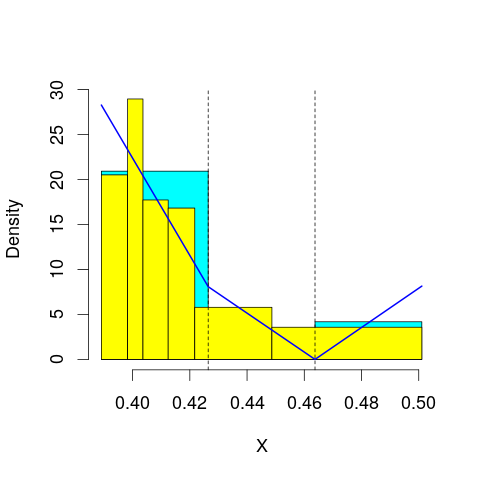

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.49269
mop.approx: Iteration 11. LL = 80.81773
mop.approx: Iteration 21. LL = 80.90492
mop.approx: Iteration 31. LL = 80.915
mop.approx: Converged. Iteration 38. LL = 80.91629
[1] "Computing the linear combination of B-splines"


72.2519488598
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.21319
mop.approx: Iteration 11. LL = 81.32177
mop.approx: Iteration 21. LL = 81.37178
mop.approx: Iteration 31. LL = 81.38269
mop.approx: Iteration 41. LL = 81.39208
mop.approx: Iteration 51. LL = 81.3999
mop.approx: Iteration 61. LL = 81.40603
mop.approx: Iteration 71. LL = 81.41063
mop.approx: Iteration 81. LL = 81.414
mop.approx: Iteration 91. LL = 81.41642
mop.approx: Iteration 101. LL = 81.41814
mop.approx: Iteration 111. LL = 81.41934
mop.approx: Converged. Iteration 117. LL = 81.41997
[1] "Computing the linear combination of B-splines"


71.0227575793
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.42242
mop.approx: Iteration 11. LL = 58.96352
mop.approx: Iteration 21. LL = 58.98815
mop.approx: Converged. Iteration 25. LL = 58.98875
[1] "Computing the linear combination of B-splines"


46.8586705545
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.71327
mop.approx: Iteration 11. LL = 61.02144
mop.approx: Iteration 21. LL = 61.0565
mop.approx: Iteration 31. LL = 61.0598
mop.approx: Converged. Iteration 35. LL = 61.0602
[1] "Computing the linear combination of B-splines"


47.1972524818
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.87014
mop.approx: Iteration 11. LL = 56.19567
mop.approx: Iteration 21. LL = 56.58242
mop.approx: Iteration 31. LL = 56.67915
mop.approx: Iteration 41. LL = 56.70866
mop.approx: Iteration 51. LL = 56.71825
mop.approx: Iteration 61. LL = 56.72143
mop.approx: Iteration 71. LL = 56.7225
mop.approx: Converged. Iteration 71. LL = 56.72255
[1] "Computing the linear combination of B-splines"


41.1267399073
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.664562
mop.approx: Iteration 11. LL = 56.18378
mop.approx: Iteration 21. LL = 56.37504
mop.approx: Iteration 31. LL = 56.39733
mop.approx: Iteration 41. LL = 56.40048
mop.approx: Converged. Iteration 44. LL = 56.40076
[1] "Computing the linear combination of B-splines"


39.0720851172
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.948049
mop.approx: Iteration 11. LL = 52.61693
mop.approx: Iteration 21. LL = 53.09183
mop.approx: Iteration 31. LL = 53.1671
mop.approx: Iteration 41. LL = 53.17941
mop.approx: Iteration 51. LL = 53.18144
mop.approx: Converged. Iteration 53. LL = 53.18161
[1] "Computing the linear combination of B-splines"


34.1200585646
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.77466
mop.approx: Converged. Iteration 6. LL = 80.49645
[1] "Computing the linear combination of B-splines"


71.8321084387
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 71.832108438672833)
m reached
('Sum of Probabilities:', 0.9860384666688491)
chosen


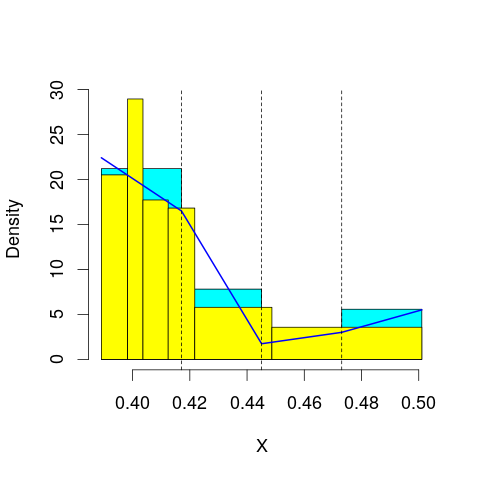

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.49269
mop.approx: Iteration 11. LL = 81.67578
mop.approx: Iteration 21. LL = 81.68245
mop.approx: Iteration 31. LL = 81.68573
mop.approx: Iteration 41. LL = 81.6876
mop.approx: Converged. Iteration 49. LL = 81.68854
[1] "Computing the linear combination of B-splines"


71.2913340894
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.21319
mop.approx: Iteration 11. LL = 81.44901
mop.approx: Iteration 21. LL = 81.52398
mop.approx: Iteration 31. LL = 81.55533
mop.approx: Iteration 41. LL = 81.57054
mop.approx: Iteration 51. LL = 81.57816
mop.approx: Iteration 61. LL = 81.58215
mop.approx: Iteration 71. LL = 81.58436
mop.approx: Iteration 81. LL = 81.58566
mop.approx: Converged. Iteration 85. LL = 81.5861
[1] "Computing the linear combination of B-splines"


69.4560283172
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.42242
mop.approx: Iteration 11. LL = 65.00839
mop.approx: Iteration 21. LL = 65.15766
mop.approx: Iteration 31. LL = 65.16466
mop.approx: Converged. Iteration 36. LL = 65.16531
[1] "Computing the linear combination of B-splines"


51.302368014
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.71327
mop.approx: Iteration 11. LL = 61.07875
mop.approx: Iteration 21. LL = 61.13213
mop.approx: Iteration 31. LL = 61.14292
mop.approx: Iteration 41. LL = 61.14535
mop.approx: Converged. Iteration 45. LL = 61.14573
[1] "Computing the linear combination of B-splines"


45.5499233367
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.87014
mop.approx: Iteration 11. LL = 63.0926
mop.approx: Iteration 21. LL = 63.10568
mop.approx: Converged. Iteration 21. LL = 63.10573
[1] "Computing the linear combination of B-splines"


45.777049977
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.664562
mop.approx: Iteration 11. LL = 57.66439
mop.approx: Iteration 21. LL = 57.78814
mop.approx: Iteration 31. LL = 57.81311
mop.approx: Iteration 41. LL = 57.82031
mop.approx: Iteration 51. LL = 57.82277
mop.approx: Iteration 61. LL = 57.82369
mop.approx: Converged. Iteration 61. LL = 57.82374
[1] "Computing the linear combination of B-splines"


38.7621962472
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.948049
mop.approx: Iteration 11. LL = 58.76141
mop.approx: Iteration 21. LL = 58.92792
mop.approx: Iteration 31. LL = 58.95082
mop.approx: Iteration 41. LL = 58.95505
mop.approx: Converged. Iteration 47. LL = 58.95574
[1] "Computing the linear combination of B-splines"


38.1613275557
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.77466
mop.approx: Iteration 11. LL = 82.44986
mop.approx: Iteration 21. LL = 82.45672
mop.approx: Converged. Iteration 30. LL = 82.45836
[1] "Computing the linear combination of B-splines"


72.0611555809
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 72.061155580859946)
m reached
('Sum of Probabilities:', 0.9892755979278459)
chosen


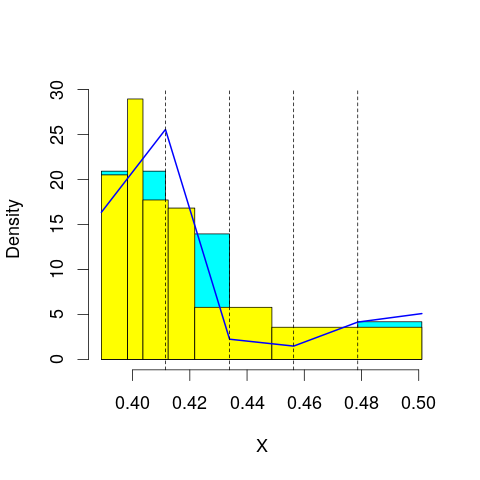

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.49269
mop.approx: Iteration 11. LL = 81.59942
mop.approx: Iteration 21. LL = 81.60739
mop.approx: Converged. Iteration 22. LL = 81.60756
[1] "Computing the linear combination of B-splines"


69.4774855868
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.21319
mop.approx: Iteration 11. LL = 81.95603
mop.approx: Iteration 21. LL = 81.98314
mop.approx: Converged. Iteration 27. LL = 81.98438
[1] "Computing the linear combination of B-splines"


68.121433299
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.42242
mop.approx: Iteration 11. LL = 70.72916
mop.approx: Converged. Iteration 19. LL = 70.74639
[1] "Computing the linear combination of B-splines"


55.1505739925
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.71327
mop.approx: Iteration 11. LL = 63.21993
mop.approx: Iteration 21. LL = 63.4773
mop.approx: Iteration 31. LL = 63.55028
mop.approx: Iteration 41. LL = 63.58016
mop.approx: Iteration 51. LL = 63.59475
mop.approx: Iteration 61. LL = 63.6026
mop.approx: Iteration 71. LL = 63.60707
mop.approx: Iteration 81. LL = 63.60971
mop.approx: Iteration 91. LL = 63.6113
mop.approx: Iteration 101. LL = 63.61227
mop.approx: Converged. Iteration 105. LL = 63.61261
[1] "Computing the linear combination of B-splines"


46.2839267247
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.87014
mop.approx: Iteration 11. LL = 63.4878
mop.approx: Iteration 21. LL = 63.51458
mop.approx: Iteration 31. LL = 63.51875
mop.approx: Converged. Iteration 36. LL = 63.51931
[1] "Computing the linear combination of B-splines"


44.4577599673
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.664562
mop.approx: Iteration 11. LL = 64.19469
mop.approx: Iteration 21. LL = 64.22857
mop.approx: Converged. Iteration 21. LL = 64.22861
[1] "Computing the linear combination of B-splines"


43.4341930955
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.948049
mop.approx: Iteration 11. LL = 59.29714
mop.approx: Iteration 21. LL = 59.32519
mop.approx: Converged. Iteration 26. LL = 59.32595
[1] "Computing the linear combination of B-splines"


36.7986665701
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.77466
mop.approx: Iteration 11. LL = 82.19164
mop.approx: Converged. Iteration 19. LL = 82.19822
[1] "Computing the linear combination of B-splines"


70.068147765
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 70.068147764977468)
m reached
('Sum of Probabilities:', 0.9900691165121249)
chosen


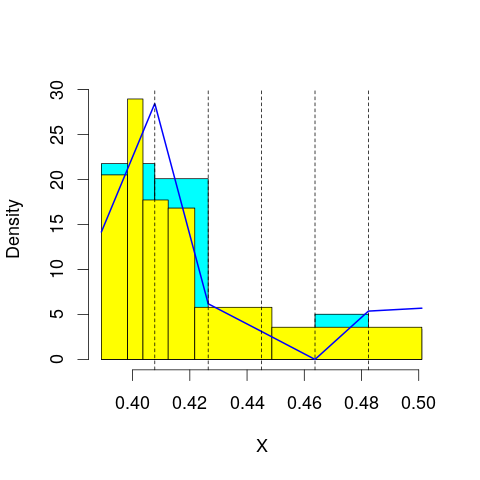

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.49269
mop.approx: Iteration 11. LL = 82.31392
mop.approx: Iteration 21. LL = 82.33629
mop.approx: Converged. Iteration 26. LL = 82.3373
[1] "Computing the linear combination of B-splines"


68.4743554878
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.21319
mop.approx: Iteration 11. LL = 82.63364
mop.approx: Iteration 21. LL = 82.81515
mop.approx: Iteration 31. LL = 82.86308
mop.approx: Iteration 41. LL = 82.88071
mop.approx: Iteration 51. LL = 82.88887
mop.approx: Iteration 61. LL = 82.89312
mop.approx: Iteration 71. LL = 82.89547
mop.approx: Iteration 81. LL = 82.89682
mop.approx: Converged. Iteration 85. LL = 82.89726
[1] "Computing the linear combination of B-splines"


67.3014483773
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.42242
mop.approx: Iteration 11. LL = 72.35059
mop.approx: Iteration 21. LL = 72.35499
mop.approx: Iteration 31. LL = 72.3578
mop.approx: Iteration 41. LL = 72.35992
mop.approx: Iteration 51. LL = 72.36148
mop.approx: Iteration 61. LL = 72.36261
mop.approx: Converged. Iteration 70. LL = 72.36344
[1] "Computing the linear combination of B-splines"


55.0347608924
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.71327
mop.approx: Iteration 11. LL = 69.82276
mop.approx: Iteration 21. LL = 69.99805
mop.approx: Iteration 31. LL = 70.00665
mop.approx: Converged. Iteration 37. LL = 70.00746
[1] "Computing the linear combination of B-splines"


50.9459153887
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.87014
mop.approx: Iteration 11. LL = 63.78746
mop.approx: Iteration 21. LL = 63.82312
mop.approx: Iteration 31. LL = 63.83523
mop.approx: Iteration 41. LL = 63.84049
mop.approx: Iteration 51. LL = 63.84319
mop.approx: Iteration 61. LL = 63.84475
mop.approx: Iteration 71. LL = 63.84573
mop.approx: Converged. Iteration 76. LL = 63.84615
[1] "Computing the linear combination of B-splines"


43.0517310462
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.664562
mop.approx: Iteration 11. LL = 66.10799
mop.approx: Iteration 21. LL = 66.25702
mop.approx: Iteration 31. LL = 66.29155
mop.approx: Iteration 41. LL = 66.30465
mop.approx: Iteration 51. LL = 66.31099
mop.approx: Iteration 61. LL = 66.3145
mop.approx: Iteration 71. LL = 66.31662
mop.approx: Iteration 81. LL = 66.31797
mop.approx: Iteration 91. LL = 66.31887
mop.approx: Converged. Iteration 94. LL = 66.31914
[1] "Computing the linear combination of B-splines"


43.791860775
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.948049
mop.approx: Iteration 11. LL = 64.48118
mop.approx: Iteration 21. LL = 64.63651
mop.approx: Iteration 31. LL = 64.64039
mop.approx: Converged. Iteration 31. LL = 64.64044
[1] "Computing the linear combination of B-splines"


40.380296845
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.77466
mop.approx: Iteration 11. LL = 82.31266
mop.approx: Iteration 21. LL = 82.32708
mop.approx: Iteration 31. LL = 82.33051
mop.approx: Iteration 41. LL = 82.33179
mop.approx: Converged. Iteration 41. LL = 82.33187
[1] "Computing the linear combination of B-splines"


68.4689256013
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 68.468925601349028)
m reached
('Sum of Probabilities:', 0.9898916237273881)
chosen


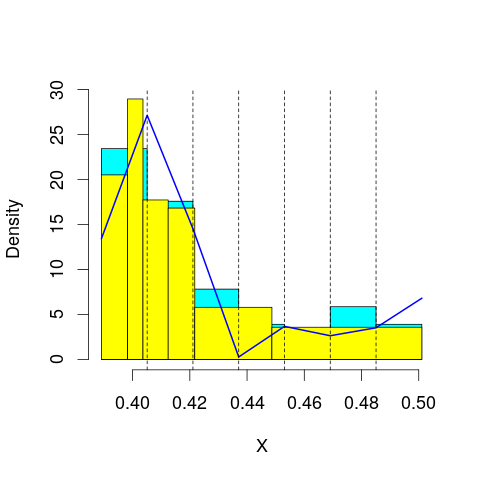

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.49269
mop.approx: Iteration 11. LL = 84.01935
mop.approx: Iteration 21. LL = 84.09938
mop.approx: Iteration 31. LL = 84.11073
mop.approx: Converged. Iteration 40. LL = 84.11263
[1] "Computing the linear combination of B-splines"


68.5168141391
('best: ', 68.468925601349028, 'accepted difference:', 116.39717352229334, 'cur BIC:', 68.516814139148465)
m reached
('Sum of Probabilities:', 0.9797842871124879)
chosen


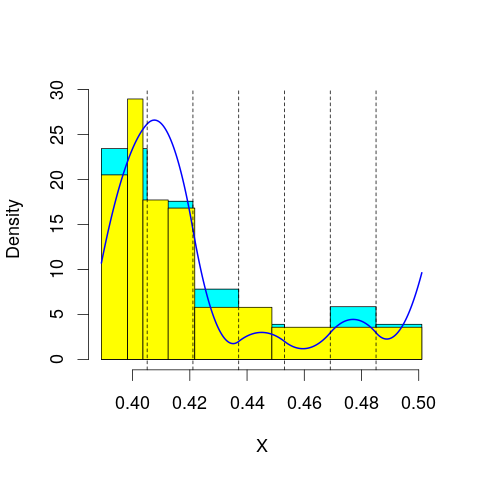

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.21319
mop.approx: Iteration 11. LL = 82.30227
mop.approx: Iteration 21. LL = 82.37008
mop.approx: Iteration 31. LL = 82.39054
mop.approx: Iteration 41. LL = 82.39788
mop.approx: Iteration 51. LL = 82.40064
mop.approx: Converged. Iteration 58. LL = 82.40156
[1] "Computing the linear combination of B-splines"


65.0728785816
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.42242
mop.approx: Iteration 11. LL = 72.87939
mop.approx: Iteration 21. LL = 72.96932
mop.approx: Iteration 31. LL = 72.98736
mop.approx: Iteration 41. LL = 72.9929
mop.approx: Iteration 51. LL = 72.99533
mop.approx: Iteration 61. LL = 72.99662
mop.approx: Converged. Iteration 67. LL = 72.99719
[1] "Computing the linear combination of B-splines"


53.9356427006
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.71327
mop.approx: Iteration 11. LL = 73.01332
mop.approx: Iteration 21. LL = 73.06019
mop.approx: Iteration 31. LL = 73.06587
mop.approx: Iteration 41. LL = 73.06869
mop.approx: Iteration 51. LL = 73.06997
mop.approx: Converged. Iteration 52. LL = 73.07012
[1] "Computing the linear combination of B-splines"


52.2757078558
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.87014
mop.approx: Iteration 11. LL = 67.711
mop.approx: Iteration 21. LL = 67.95451
mop.approx: Iteration 31. LL = 68.01365
mop.approx: Iteration 41. LL = 68.03677
mop.approx: Iteration 51. LL = 68.04794
mop.approx: Iteration 61. LL = 68.05398
mop.approx: Iteration 71. LL = 68.05745
mop.approx: Iteration 81. LL = 68.05952
mop.approx: Iteration 91. LL = 68.06079
mop.approx: Converged. Iteration 99. LL = 68.06151
[1] "Computing the linear combination of B-splines"


45.5342309299
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.664562
mop.approx: Iteration 11. LL = 66.19458
mop.approx: Iteration 21. LL = 66.2326
mop.approx: Iteration 31. LL = 66.24195
mop.approx: Iteration 41. LL = 66.24672
mop.approx: Iteration 51. LL = 66.24936
mop.approx: Iteration 61. LL = 66.25089
mop.approx: Iteration 71. LL = 66.25179
mop.approx: Converged. Iteration 72. LL = 66.25192
[1] "Computing the linear combination of B-splines"


41.9917675849
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.948049
mop.approx: Iteration 11. LL = 68.1097
mop.approx: Iteration 21. LL = 68.2967
mop.approx: Iteration 31. LL = 68.31986
mop.approx: Iteration 41. LL = 68.32373
mop.approx: Converged. Iteration 45. LL = 68.3242
[1] "Computing the linear combination of B-splines"


42.331165934
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.77466
mop.approx: Iteration 11. LL = 85.54483
mop.approx: Converged. Iteration 18. LL = 85.552
[1] "Computing the linear combination of B-splines"


69.9561851923
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 69.956185192345089)
m reached
('Sum of Probabilities:', 0.9897404761005696)
chosen


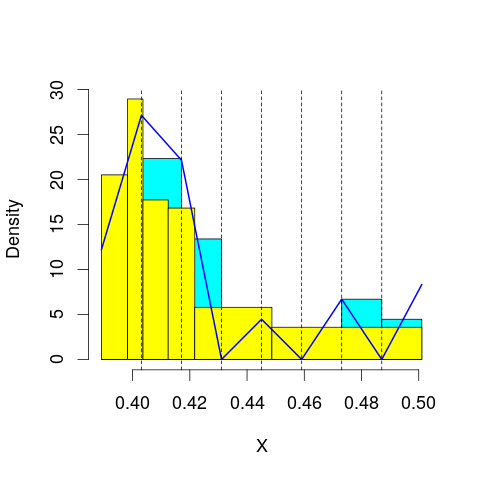

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.49269
mop.approx: Iteration 11. LL = 83.58793
mop.approx: Iteration 21. LL = 83.5997
mop.approx: Iteration 31. LL = 83.60201
mop.approx: Converged. Iteration 35. LL = 83.60249
[1] "Computing the linear combination of B-splines"


66.2738100986
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.21319
mop.approx: Iteration 11. LL = 83.5334
mop.approx: Iteration 21. LL = 83.61759
mop.approx: Iteration 31. LL = 83.625
mop.approx: Converged. Iteration 36. LL = 83.62582
[1] "Computing the linear combination of B-splines"


64.5642678575
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.42242
mop.approx: Iteration 11. LL = 72.63745
mop.approx: Iteration 21. LL = 72.68447
mop.approx: Iteration 31. LL = 72.69882
mop.approx: Iteration 41. LL = 72.70442
mop.approx: Iteration 51. LL = 72.70712
mop.approx: Iteration 61. LL = 72.70865
mop.approx: Iteration 71. LL = 72.70962
mop.approx: Converged. Iteration 73. LL = 72.70985
[1] "Computing the linear combination of B-splines"


51.9154327072
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.71327
mop.approx: Iteration 11. LL = 74.75515
mop.approx: Iteration 21. LL = 74.86567
mop.approx: Iteration 31. LL = 74.87311
mop.approx: Converged. Iteration 34. LL = 74.87349
[1] "Computing the linear combination of B-splines"


52.3462029253
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.87014
mop.approx: Iteration 11. LL = 71.85716
mop.approx: Iteration 21. LL = 72.14264
mop.approx: Iteration 31. LL = 72.16473
mop.approx: Iteration 41. LL = 72.16822
mop.approx: Converged. Iteration 46. LL = 72.16882
[1] "Computing the linear combination of B-splines"


47.908668847
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.664562
mop.approx: Iteration 11. LL = 67.3335
mop.approx: Iteration 21. LL = 67.35481
mop.approx: Converged. Iteration 30. LL = 67.35656
[1] "Computing the linear combination of B-splines"


41.3635422398
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.948049
mop.approx: Iteration 11. LL = 68.54105
mop.approx: Iteration 21. LL = 68.58131
mop.approx: Iteration 31. LL = 68.5844
mop.approx: Iteration 41. LL = 68.58586
mop.approx: Iteration 51. LL = 68.58686
mop.approx: Converged. Iteration 56. LL = 68.5873
[1] "Computing the linear combination of B-splines"


40.8615030257
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.77466
mop.approx: Iteration 11. LL = 85.23057
mop.approx: Iteration 21. LL = 85.24349
mop.approx: Iteration 31. LL = 85.24617
mop.approx: Converged. Iteration 34. LL = 85.24657
[1] "Computing the linear combination of B-splines"


67.9178925958
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 67.917892595792239)
m reached
('Sum of Probabilities:', 0.989269754791517)
chosen


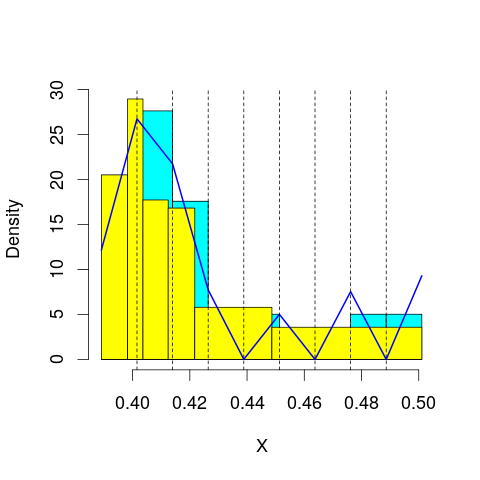

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.49269
mop.approx: Iteration 11. LL = 84.54906
mop.approx: Iteration 21. LL = 84.56967
mop.approx: Iteration 31. LL = 84.57558
mop.approx: Iteration 41. LL = 84.5781
mop.approx: Iteration 51. LL = 84.57941
mop.approx: Converged. Iteration 54. LL = 84.57976
[1] "Computing the linear combination of B-splines"


65.5182163369
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.21319
mop.approx: Iteration 11. LL = 83.81175
mop.approx: Iteration 21. LL = 83.88418
mop.approx: Iteration 31. LL = 83.90115
mop.approx: Iteration 41. LL = 83.9074
mop.approx: Iteration 51. LL = 83.91026
mop.approx: Iteration 61. LL = 83.91177
mop.approx: Converged. Iteration 67. LL = 83.91243
[1] "Computing the linear combination of B-splines"


63.1180107422
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.42242
mop.approx: Iteration 11. LL = 73.63474
mop.approx: Iteration 21. LL = 73.65782
mop.approx: Converged. Iteration 22. LL = 73.65796
[1] "Computing the linear combination of B-splines"


51.1306742895
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.71327
mop.approx: Iteration 11. LL = 75.25617
mop.approx: Iteration 21. LL = 75.31121
mop.approx: Iteration 31. LL = 75.31969
mop.approx: Iteration 41. LL = 75.32253
mop.approx: Iteration 51. LL = 75.3239
mop.approx: Converged. Iteration 58. LL = 75.32458
[1] "Computing the linear combination of B-splines"


51.0644293913
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.87014
mop.approx: Iteration 11. LL = 74.5599
mop.approx: Iteration 21. LL = 74.69528
mop.approx: Converged. Iteration 30. LL = 74.69912
[1] "Computing the linear combination of B-splines"


48.7061004039
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.664562
mop.approx: Iteration 11. LL = 69.88212
mop.approx: Iteration 21. LL = 70.11837
mop.approx: Iteration 31. LL = 70.16064
mop.approx: Iteration 41. LL = 70.17428
mop.approx: Iteration 51. LL = 70.18036
mop.approx: Iteration 61. LL = 70.18357
mop.approx: Iteration 71. LL = 70.18546
mop.approx: Iteration 81. LL = 70.18667
mop.approx: Converged. Iteration 90. LL = 70.18748
[1] "Computing the linear combination of B-splines"


42.4614882005
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.948049
mop.approx: Iteration 11. LL = 68.67504
mop.approx: Iteration 21. LL = 68.69029
mop.approx: Iteration 31. LL = 68.69289
mop.approx: Converged. Iteration 37. LL = 68.69354
[1] "Computing the linear combination of B-splines"


39.2343304705
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.77466
mop.approx: Converged. Iteration 10. LL = 86.82113
[1] "Computing the linear combination of B-splines"


67.7595844943
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 67.759584494318773)
m reached
('Sum of Probabilities:', 0.9888342855513728)
chosen


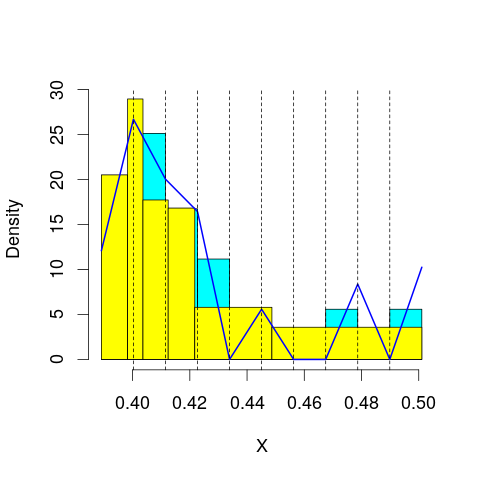

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.49269
mop.approx: Iteration 11. LL = 84.88454
mop.approx: Iteration 21. LL = 84.97023
mop.approx: Iteration 31. LL = 84.98187
mop.approx: Iteration 41. LL = 84.98439
mop.approx: Converged. Iteration 45. LL = 84.9849
[1] "Computing the linear combination of B-splines"


64.1904859494
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.21319
mop.approx: Iteration 11. LL = 84.63721
mop.approx: Iteration 21. LL = 84.65931
mop.approx: Iteration 31. LL = 84.66365
mop.approx: Iteration 41. LL = 84.66506
mop.approx: Converged. Iteration 41. LL = 84.66514
[1] "Computing the linear combination of B-splines"


62.1378567346
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.42242
mop.approx: Iteration 11. LL = 74.69668
mop.approx: Iteration 21. LL = 74.75207
mop.approx: Iteration 31. LL = 74.75915
mop.approx: Iteration 41. LL = 74.76184
mop.approx: Iteration 51. LL = 74.76313
mop.approx: Converged. Iteration 54. LL = 74.76345
[1] "Computing the linear combination of B-splines"


50.5033005906
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.71327
mop.approx: Iteration 11. LL = 75.59894
mop.approx: Iteration 21. LL = 75.64316
mop.approx: Converged. Iteration 27. LL = 75.64445
[1] "Computing the linear combination of B-splines"


49.6514321295
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.87014
mop.approx: Iteration 11. LL = 76.39406
mop.approx: Iteration 21. LL = 76.48124
mop.approx: Iteration 31. LL = 76.48976
mop.approx: Iteration 41. LL = 76.49318
mop.approx: Iteration 51. LL = 76.49508
mop.approx: Iteration 61. LL = 76.49626
mop.approx: Converged. Iteration 66. LL = 76.49676
[1] "Computing the linear combination of B-splines"


48.7708629828
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.664562
mop.approx: Iteration 11. LL = 72.86337
mop.approx: Iteration 21. LL = 73.17126
mop.approx: Iteration 31. LL = 73.20582
mop.approx: Iteration 41. LL = 73.21086
mop.approx: Converged. Iteration 46. LL = 73.2115
[1] "Computing the linear combination of B-splines"


43.7527158619
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.948049
mop.approx: Iteration 11. LL = 69.41316
mop.approx: Iteration 21. LL = 69.45398
mop.approx: Iteration 31. LL = 69.45979
mop.approx: Iteration 41. LL = 69.46121
mop.approx: Converged. Iteration 43. LL = 69.46143
[1] "Computing the linear combination of B-splines"


38.2692585004
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.77466
mop.approx: Iteration 11. LL = 86.44322
mop.approx: Iteration 21. LL = 86.47682
mop.approx: Iteration 31. LL = 86.4824
mop.approx: Converged. Iteration 39. LL = 86.48372
[1] "Computing the linear combination of B-splines"


65.689303519
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 65.689303519001328)
m reached
('Sum of Probabilities:', 0.9883670852383785)
chosen


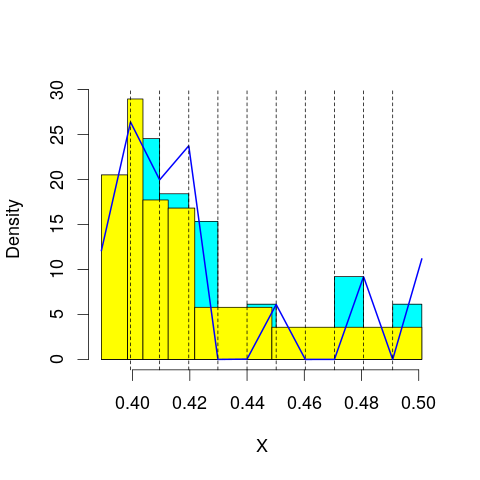

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.49269
mop.approx: Iteration 11. LL = 86.16273
mop.approx: Converged. Iteration 15. LL = 86.16473
[1] "Computing the linear combination of B-splines"


63.6374462811
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.21319
mop.approx: Iteration 11. LL = 84.79045
mop.approx: Iteration 21. LL = 84.90503
mop.approx: Iteration 31. LL = 84.92693
mop.approx: Iteration 41. LL = 84.93251
mop.approx: Iteration 51. LL = 84.93414
mop.approx: Converged. Iteration 51. LL = 84.93423
[1] "Computing the linear combination of B-splines"


60.6740743219
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.42242
mop.approx: Iteration 11. LL = 75.58723
mop.approx: Iteration 21. LL = 75.63928
mop.approx: Iteration 31. LL = 75.64735
mop.approx: Iteration 41. LL = 75.64978
mop.approx: Converged. Iteration 49. LL = 75.65069
[1] "Computing the linear combination of B-splines"


49.657665983
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.71327
mop.approx: Iteration 11. LL = 75.85436
mop.approx: Iteration 21. LL = 75.89845
mop.approx: Iteration 31. LL = 75.90591
mop.approx: Iteration 41. LL = 75.90874
mop.approx: Iteration 51. LL = 75.91
mop.approx: Converged. Iteration 52. LL = 75.91015
[1] "Computing the linear combination of B-splines"


48.184265933
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.87014
mop.approx: Iteration 11. LL = 77.22208
mop.approx: Iteration 21. LL = 77.28147
mop.approx: Iteration 31. LL = 77.28578
mop.approx: Converged. Iteration 37. LL = 77.28655
[1] "Computing the linear combination of B-splines"


47.8278030047
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.664562
mop.approx: Iteration 11. LL = 75.69264
mop.approx: Iteration 21. LL = 75.88208
mop.approx: Iteration 31. LL = 75.90206
mop.approx: Iteration 41. LL = 75.90887
mop.approx: Iteration 51. LL = 75.91176
mop.approx: Iteration 61. LL = 75.91305
mop.approx: Converged. Iteration 63. LL = 75.91328
[1] "Computing the linear combination of B-splines"


44.7216536322
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.948049
mop.approx: Iteration 11. LL = 71.21267
mop.approx: Iteration 21. LL = 71.3197
mop.approx: Iteration 31. LL = 71.3293
mop.approx: Converged. Iteration 39. LL = 71.33059
[1] "Computing the linear combination of B-splines"


38.4091079304
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.77466
mop.approx: Iteration 11. LL = 86.26671
mop.approx: Iteration 21. LL = 86.27235
mop.approx: Converged. Iteration 23. LL = 86.27263
[1] "Computing the linear combination of B-splines"


63.7453477145
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 63.745347714521316)
m reached
('Sum of Probabilities:', 0.9878998027808568)
chosen


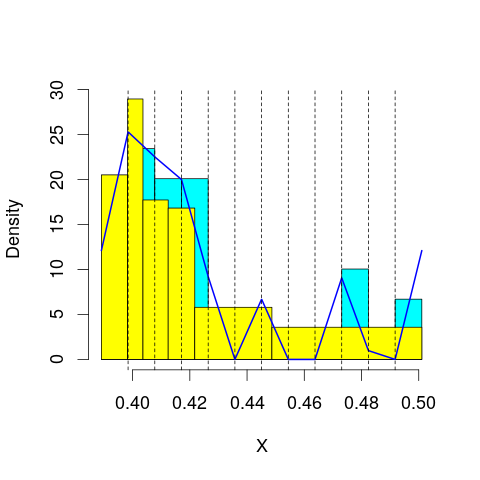

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.49269
mop.approx: Iteration 11. LL = 86.91668
mop.approx: Iteration 21. LL = 86.9328
mop.approx: Iteration 31. LL = 86.93509
mop.approx: Converged. Iteration 36. LL = 86.93569
[1] "Computing the linear combination of B-splines"


62.6755412789
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.21319
mop.approx: Iteration 11. LL = 85.01531
mop.approx: Iteration 21. LL = 85.17732
mop.approx: Iteration 31. LL = 85.23554
mop.approx: Iteration 41. LL = 85.26124
mop.approx: Iteration 51. LL = 85.27418
mop.approx: Iteration 61. LL = 85.28132
mop.approx: Iteration 71. LL = 85.28552
mop.approx: Iteration 81. LL = 85.28812
mop.approx: Iteration 91. LL = 85.28978
mop.approx: Iteration 101. LL = 85.29087
mop.approx: Converged. Iteration 102. LL = 85.29104
[1] "Computing the linear combination of B-splines"


59.2980238136
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.42242
mop.approx: Iteration 11. LL = 75.89993
mop.approx: Iteration 21. LL = 75.9236
mop.approx: Iteration 31. LL = 75.92846
mop.approx: Iteration 41. LL = 75.92996
mop.approx: Converged. Iteration 42. LL = 75.9301
[1] "Computing the linear combination of B-splines"


48.2042153052
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.71327
mop.approx: Iteration 11. LL = 76.63846
mop.approx: Iteration 21. LL = 76.72694
mop.approx: Iteration 31. LL = 76.73662
mop.approx: Converged. Iteration 38. LL = 76.7378
[1] "Computing the linear combination of B-splines"


47.2790408622
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.87014
mop.approx: Iteration 11. LL = 77.30285
mop.approx: Iteration 21. LL = 77.35113
mop.approx: Iteration 31. LL = 77.35887
mop.approx: Iteration 41. LL = 77.36173
mop.approx: Iteration 51. LL = 77.36294
mop.approx: Converged. Iteration 51. LL = 77.36301
[1] "Computing the linear combination of B-splines"


46.1713915277
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.664562
mop.approx: Iteration 11. LL = 77.73572
mop.approx: Iteration 21. LL = 77.8762
mop.approx: Iteration 31. LL = 77.88061
mop.approx: Converged. Iteration 31. LL = 77.88068
[1] "Computing the linear combination of B-splines"


44.9561462132
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.948049
mop.approx: Iteration 11. LL = 73.82303
mop.approx: Iteration 21. LL = 74.08124
mop.approx: Iteration 31. LL = 74.1413
mop.approx: Iteration 41. LL = 74.16267
mop.approx: Iteration 51. LL = 74.17142
mop.approx: Iteration 61. LL = 74.17523
mop.approx: Iteration 71. LL = 74.17694
mop.approx: Converged. Iteration 76. LL = 74.17748
[1] "Computing the linear combination of B-splines"


39.518325868
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.77466
mop.approx: Iteration 11. LL = 88.11182
mop.approx: Iteration 21. LL = 88.1161
mop.approx: Converged. Iteration 25. LL = 88.11662
[1] "Computing the linear combination of B-splines"


63.8564681511
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 63.856468151124908)
m reached
('Sum of Probabilities:', 0.9874688550344023)
chosen


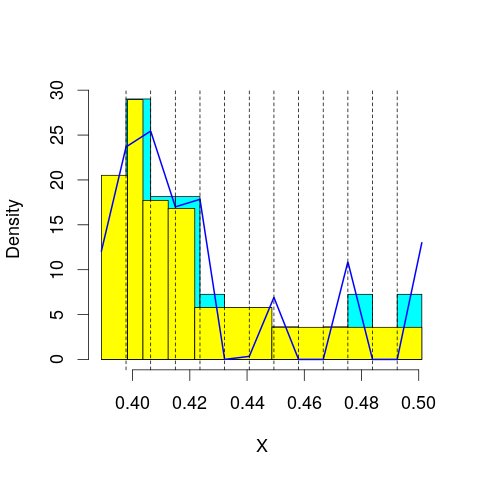

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.49269
mop.approx: Iteration 11. LL = 86.91179
mop.approx: Iteration 21. LL = 87.00928
mop.approx: Iteration 31. LL = 87.0172
mop.approx: Converged. Iteration 34. LL = 87.0177
[1] "Computing the linear combination of B-splines"


61.0246820143
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.21319
mop.approx: Iteration 11. LL = 85.88636
mop.approx: Iteration 21. LL = 85.92177
mop.approx: Iteration 31. LL = 85.93154
mop.approx: Iteration 41. LL = 85.93519
mop.approx: Iteration 51. LL = 85.93668
mop.approx: Converged. Iteration 52. LL = 85.93686
[1] "Computing the linear combination of B-splines"


58.2109716891
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.42242
mop.approx: Iteration 11. LL = 76.34289
mop.approx: Iteration 21. LL = 76.424
mop.approx: Iteration 31. LL = 76.43081
mop.approx: Converged. Iteration 34. LL = 76.43122
[1] "Computing the linear combination of B-splines"


46.9724619405
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.71327
mop.approx: Iteration 11. LL = 76.84286
mop.approx: Iteration 21. LL = 76.87177
mop.approx: Iteration 31. LL = 76.8772
mop.approx: Iteration 41. LL = 76.87872
mop.approx: Converged. Iteration 41. LL = 76.8788
[1] "Computing the linear combination of B-splines"


45.6871744676
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.87014
mop.approx: Iteration 11. LL = 77.69021
mop.approx: Iteration 21. LL = 77.75791
mop.approx: Iteration 31. LL = 77.76132
mop.approx: Converged. Iteration 31. LL = 77.76139
[1] "Computing the linear combination of B-splines"


44.8369091892
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.664562
mop.approx: Iteration 11. LL = 78.18495
mop.approx: Iteration 21. LL = 78.25407
mop.approx: Iteration 31. LL = 78.26192
mop.approx: Iteration 41. LL = 78.26471
mop.approx: Iteration 51. LL = 78.2659
mop.approx: Converged. Iteration 51. LL = 78.26598
[1] "Computing the linear combination of B-splines"


43.6086490092
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.948049
mop.approx: Iteration 11. LL = 76.70402
mop.approx: Iteration 21. LL = 76.95923
mop.approx: Iteration 31. LL = 76.97599
mop.approx: Converged. Iteration 38. LL = 76.97733
[1] "Computing the linear combination of B-splines"


40.5900896814
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.77466
mop.approx: Iteration 11. LL = 88.83105
mop.approx: Converged. Iteration 19. LL = 88.83896
[1] "Computing the linear combination of B-splines"


62.8459414919
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 62.845941491914203)
m reached
('Sum of Probabilities:', 0.98697277410337)
chosen


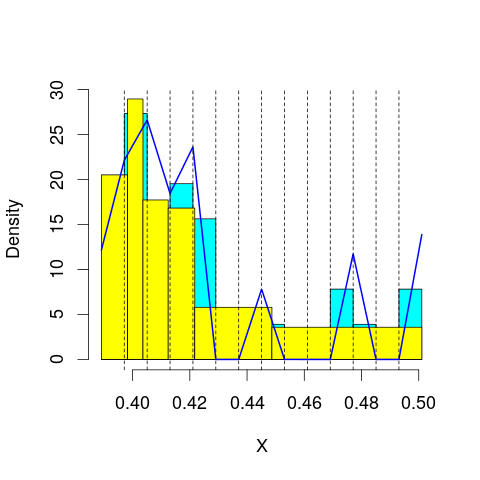

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.49269
mop.approx: Iteration 11. LL = 86.35582
mop.approx: Iteration 21. LL = 86.381
mop.approx: Iteration 31. LL = 86.38488
mop.approx: Converged. Iteration 39. LL = 86.38598
[1] "Computing the linear combination of B-splines"


58.6600895299
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.21319
mop.approx: Iteration 11. LL = 86.93783
mop.approx: Iteration 21. LL = 86.95919
mop.approx: Converged. Iteration 27. LL = 86.96015
[1] "Computing the linear combination of B-splines"


57.5013936981
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.42242
mop.approx: Iteration 11. LL = 76.42795
mop.approx: Iteration 21. LL = 76.4592
mop.approx: Iteration 31. LL = 76.46546
mop.approx: Iteration 41. LL = 76.46701
mop.approx: Converged. Iteration 41. LL = 76.46708
[1] "Computing the linear combination of B-splines"


45.2754529835
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.71327
mop.approx: Iteration 11. LL = 77.52682
mop.approx: Iteration 21. LL = 77.55147
mop.approx: Converged. Iteration 23. LL = 77.55182
[1] "Computing the linear combination of B-splines"


44.6273304281
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.87014
mop.approx: Iteration 11. LL = 77.73692
mop.approx: Iteration 21. LL = 77.7983
mop.approx: Iteration 31. LL = 77.81372
mop.approx: Iteration 41. LL = 77.81912
mop.approx: Iteration 51. LL = 77.82141
mop.approx: Iteration 61. LL = 77.82253
mop.approx: Converged. Iteration 62. LL = 77.82268
[1] "Computing the linear combination of B-splines"


43.1653365375
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.664562
mop.approx: Iteration 11. LL = 78.62416
mop.approx: Iteration 21. LL = 78.68593
mop.approx: Converged. Iteration 27. LL = 78.68739
[1] "Computing the linear combination of B-splines"


42.2973106501
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.948049
mop.approx: Iteration 11. LL = 78.11128
mop.approx: Iteration 21. LL = 78.35134
mop.approx: Iteration 31. LL = 78.37296
mop.approx: Iteration 41. LL = 78.37892
mop.approx: Iteration 51. LL = 78.38137
mop.approx: Iteration 61. LL = 78.3825
mop.approx: Converged. Iteration 61. LL = 78.38258
[1] "Computing the linear combination of B-splines"


40.257693633
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.77466
mop.approx: Iteration 11. LL = 88.09566
mop.approx: Converged. Iteration 18. LL = 88.10058
[1] "Computing the linear combination of B-splines"


60.3746926118
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 60.37469261175211)
m reached
('Sum of Probabilities:', 0.9864995650683649)
chosen


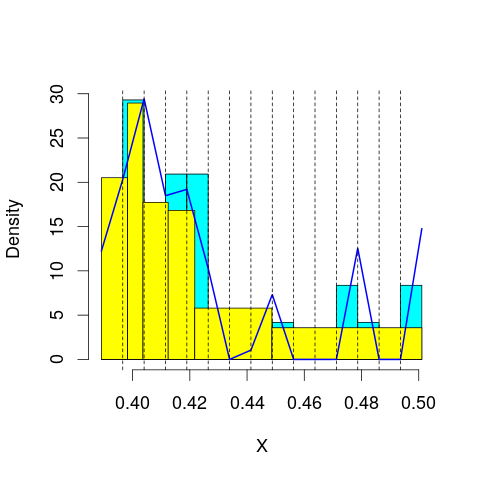

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.49269
mop.approx: Iteration 11. LL = 87.83438
mop.approx: Iteration 21. LL = 87.86718
mop.approx: Converged. Iteration 30. LL = 87.86978
[1] "Computing the linear combination of B-splines"


58.4110201943
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.21319
mop.approx: Iteration 11. LL = 86.54422
mop.approx: Iteration 21. LL = 86.63238
mop.approx: Iteration 31. LL = 86.65036
mop.approx: Iteration 41. LL = 86.65643
mop.approx: Iteration 51. LL = 86.65903
mop.approx: Iteration 61. LL = 86.66032
mop.approx: Converged. Iteration 62. LL = 86.66049
[1] "Computing the linear combination of B-splines"


55.4688685601
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.42242
mop.approx: Iteration 11. LL = 78.26627
mop.approx: Iteration 21. LL = 78.35993
mop.approx: Iteration 31. LL = 78.37398
mop.approx: Iteration 41. LL = 78.37819
mop.approx: Iteration 51. LL = 78.37992
mop.approx: Converged. Iteration 56. LL = 78.38049
[1] "Computing the linear combination of B-splines"


45.4559952822
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.71327
mop.approx: Iteration 11. LL = 77.44261
mop.approx: Iteration 21. LL = 77.54771
mop.approx: Iteration 31. LL = 77.57353
mop.approx: Iteration 41. LL = 77.58198
mop.approx: Iteration 51. LL = 77.58498
mop.approx: Converged. Iteration 59. LL = 77.58602
[1] "Computing the linear combination of B-splines"


42.9286634682
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.87014
mop.approx: Iteration 11. LL = 78.33505
mop.approx: Iteration 21. LL = 78.36076
mop.approx: Converged. Iteration 27. LL = 78.36197
[1] "Computing the linear combination of B-splines"


41.9717706166
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.664562
mop.approx: Iteration 11. LL = 78.61756
mop.approx: Iteration 21. LL = 78.73343
mop.approx: Iteration 31. LL = 78.75756
mop.approx: Iteration 41. LL = 78.76424
mop.approx: Iteration 51. LL = 78.7664
mop.approx: Converged. Iteration 56. LL = 78.76699
[1] "Computing the linear combination of B-splines"


40.6448454679
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.948049
mop.approx: Iteration 11. LL = 79.01956
mop.approx: Iteration 21. LL = 79.13753
mop.approx: Iteration 31. LL = 79.14168
mop.approx: Converged. Iteration 31. LL = 79.14176
[1] "Computing the linear combination of B-splines"


39.2579788659
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.77466
mop.approx: Iteration 11. LL = 88.59149
mop.approx: Iteration 21. LL = 88.59836
mop.approx: Iteration 31. LL = 88.59999
mop.approx: Converged. Iteration 32. LL = 88.60017
[1] "Computing the linear combination of B-splines"


59.1414132162
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 59.141413216161531)
m reached
('Sum of Probabilities:', 0.9859332724732965)
chosen


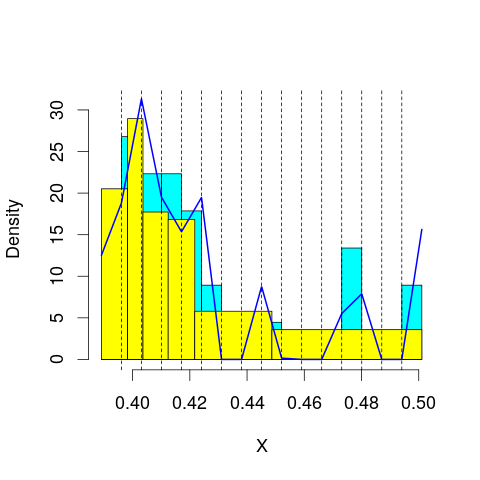

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.49269
mop.approx: Iteration 11. LL = 88.00066
mop.approx: Iteration 21. LL = 88.04901
mop.approx: Iteration 31. LL = 88.05675
mop.approx: Iteration 41. LL = 88.05852
mop.approx: Converged. Iteration 41. LL = 88.0586
[1] "Computing the linear combination of B-splines"


56.866978726
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.21319
mop.approx: Iteration 11. LL = 86.61527
mop.approx: Iteration 21. LL = 86.63355
mop.approx: Converged. Iteration 30. LL = 86.63578
[1] "Computing the linear combination of B-splines"


53.7112851383
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.42242
mop.approx: Iteration 11. LL = 79.28322
mop.approx: Iteration 21. LL = 79.44466
mop.approx: Iteration 31. LL = 79.47104
mop.approx: Iteration 41. LL = 79.48013
mop.approx: Iteration 51. LL = 79.48433
mop.approx: Iteration 61. LL = 79.48657
mop.approx: Iteration 71. LL = 79.48787
mop.approx: Converged. Iteration 76. LL = 79.48839
[1] "Computing the linear combination of B-splines"


44.8310346919
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.71327
mop.approx: Iteration 11. LL = 77.67768
mop.approx: Iteration 21. LL = 77.71771
mop.approx: Iteration 31. LL = 77.72511
mop.approx: Iteration 41. LL = 77.72698
mop.approx: Converged. Iteration 43. LL = 77.72722
[1] "Computing the linear combination of B-splines"


41.3369986306
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.87014
mop.approx: Iteration 11. LL = 78.75572
mop.approx: Iteration 21. LL = 78.83711
mop.approx: Iteration 31. LL = 78.84413
mop.approx: Converged. Iteration 38. LL = 78.84524
[1] "Computing the linear combination of B-splines"


40.7221548201
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.664562
mop.approx: Iteration 11. LL = 78.82569
mop.approx: Iteration 21. LL = 78.86309
mop.approx: Iteration 31. LL = 78.86575
mop.approx: Converged. Iteration 31. LL = 78.86582
[1] "Computing the linear combination of B-splines"


39.0115616964
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.948049
mop.approx: Iteration 11. LL = 79.49141
mop.approx: Iteration 21. LL = 79.60716
mop.approx: Iteration 31. LL = 79.61497
mop.approx: Converged. Iteration 40. LL = 79.61655
[1] "Computing the linear combination of B-splines"


37.9373346586
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.77466
mop.approx: Iteration 11. LL = 89.16945
mop.approx: Converged. Iteration 16. LL = 89.1728
[1] "Computing the linear combination of B-splines"


57.9811790271
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 57.981179027094086)
m reached
('Sum of Probabilities:', 0.9853166282505116)
chosen


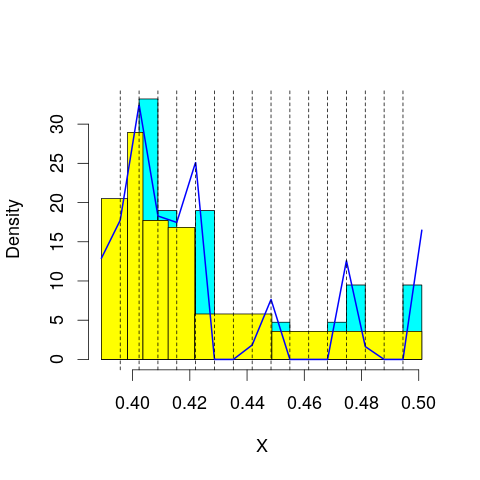

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.49269
mop.approx: Iteration 11. LL = 87.99018
mop.approx: Iteration 21. LL = 88.00537
mop.approx: Converged. Iteration 28. LL = 88.00678
[1] "Computing the linear combination of B-splines"


55.0822869466
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.21319
mop.approx: Iteration 11. LL = 87.41485
mop.approx: Iteration 21. LL = 87.44852
mop.approx: Iteration 31. LL = 87.45535
mop.approx: Iteration 41. LL = 87.45783
mop.approx: Converged. Iteration 48. LL = 87.45875
[1] "Computing the linear combination of B-splines"


52.8013928996
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.42242
mop.approx: Iteration 11. LL = 79.50248
mop.approx: Iteration 21. LL = 79.626
mop.approx: Iteration 31. LL = 79.65971
mop.approx: Iteration 41. LL = 79.67285
mop.approx: Iteration 51. LL = 79.67912
mop.approx: Iteration 61. LL = 79.68256
mop.approx: Iteration 71. LL = 79.68462
mop.approx: Iteration 81. LL = 79.68593
mop.approx: Converged. Iteration 88. LL = 79.68665
[1] "Computing the linear combination of B-splines"


43.2964272895
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.71327
mop.approx: Iteration 11. LL = 78.79384
mop.approx: Iteration 21. LL = 78.94448
mop.approx: Iteration 31. LL = 78.97898
mop.approx: Iteration 41. LL = 78.99136
mop.approx: Iteration 51. LL = 78.99704
mop.approx: Iteration 61. LL = 79.00012
mop.approx: Iteration 71. LL = 79.00197
mop.approx: Iteration 81. LL = 79.00317
mop.approx: Converged. Iteration 86. LL = 79.00368
[1] "Computing the linear combination of B-splines"


40.8805885263
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.87014
mop.approx: Iteration 11. LL = 78.74774
mop.approx: Iteration 21. LL = 78.8324
mop.approx: Iteration 31. LL = 78.85522
mop.approx: Iteration 41. LL = 78.86488
mop.approx: Iteration 51. LL = 78.86974
mop.approx: Iteration 61. LL = 78.87248
mop.approx: Iteration 71. LL = 78.87414
mop.approx: Iteration 81. LL = 78.87522
mop.approx: Converged. Iteration 84. LL = 78.87555
[1] "Computing the linear combination of B-splines"


39.0195426144
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.664562
mop.approx: Iteration 11. LL = 79.39854
mop.approx: Iteration 21. LL = 79.47257
mop.approx: Iteration 31. LL = 79.48073
mop.approx: Converged. Iteration 40. LL = 79.4824
[1] "Computing the linear combination of B-splines"


37.8920255819
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.948049
mop.approx: Iteration 11. LL = 78.98429
mop.approx: Iteration 21. LL = 79.1133
mop.approx: Iteration 31. LL = 79.13761
mop.approx: Iteration 41. LL = 79.14682
mop.approx: Iteration 51. LL = 79.15109
mop.approx: Iteration 61. LL = 79.15337
mop.approx: Iteration 71. LL = 79.15475
mop.approx: Converged. Iteration 80. LL = 79.15566
[1] "Computing the linear combination of B-splines"


35.7170052949
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.77466
mop.approx: Iteration 11. LL = 89.36828
mop.approx: Converged. Iteration 15. LL = 89.3701
[1] "Computing the linear combination of B-splines"


56.4456082198
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 56.44560821976458)
m reached
('Sum of Probabilities:', 0.9847613297160124)
chosen


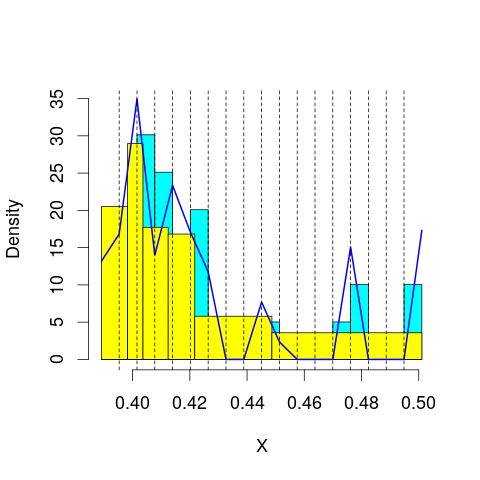

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.49269
mop.approx: Iteration 11. LL = 88.11454
mop.approx: Iteration 21. LL = 88.12251
mop.approx: Converged. Iteration 23. LL = 88.12284
[1] "Computing the linear combination of B-splines"


53.4654835765
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.21319
mop.approx: Iteration 11. LL = 87.66532
mop.approx: Iteration 21. LL = 87.68781
mop.approx: Iteration 31. LL = 87.69034
mop.approx: Converged. Iteration 33. LL = 87.69061
[1] "Computing the linear combination of B-splines"


51.3003836699
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.42242
mop.approx: Iteration 11. LL = 79.87922
mop.approx: Iteration 21. LL = 79.92292
mop.approx: Iteration 31. LL = 79.93416
mop.approx: Iteration 41. LL = 79.93797
mop.approx: Iteration 51. LL = 79.93944
mop.approx: Converged. Iteration 52. LL = 79.93961
[1] "Computing the linear combination of B-splines"


41.8165112528
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.71327
mop.approx: Iteration 11. LL = 79.48456
mop.approx: Iteration 21. LL = 79.72413
mop.approx: Iteration 31. LL = 79.78559
mop.approx: Iteration 41. LL = 79.80376
mop.approx: Iteration 51. LL = 79.80979
mop.approx: Iteration 61. LL = 79.812
mop.approx: Converged. Iteration 66. LL = 79.8126
[1] "Computing the linear combination of B-splines"


39.9566347425
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.87014
mop.approx: Iteration 11. LL = 78.91263
mop.approx: Iteration 21. LL = 78.96785
mop.approx: Iteration 31. LL = 78.98355
mop.approx: Iteration 41. LL = 78.98954
mop.approx: Iteration 51. LL = 78.99218
mop.approx: Iteration 61. LL = 78.99347
mop.approx: Converged. Iteration 64. LL = 78.9938
[1] "Computing the linear combination of B-splines"


37.4049337107
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.664562
mop.approx: Iteration 11. LL = 79.79661
mop.approx: Iteration 21. LL = 79.98337
mop.approx: Iteration 31. LL = 80.01438
mop.approx: Iteration 41. LL = 80.02001
mop.approx: Converged. Iteration 49. LL = 80.02121
[1] "Computing the linear combination of B-splines"


36.6859489713
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.948049
mop.approx: Iteration 11. LL = 80.28448
mop.approx: Iteration 21. LL = 80.38983
mop.approx: Iteration 31. LL = 80.40952
mop.approx: Iteration 41. LL = 80.41696
mop.approx: Iteration 51. LL = 80.4205
mop.approx: Iteration 61. LL = 80.4224
mop.approx: Iteration 71. LL = 80.42352
mop.approx: Converged. Iteration 73. LL = 80.42377
[1] "Computing the linear combination of B-splines"


35.120274816
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.77466
mop.approx: Iteration 11. LL = 89.88355
mop.approx: Converged. Iteration 18. LL = 89.88858
[1] "Computing the linear combination of B-splines"


55.231223196
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 55.231223196035849)
m reached
('Sum of Probabilities:', 0.9842939293586304)
chosen


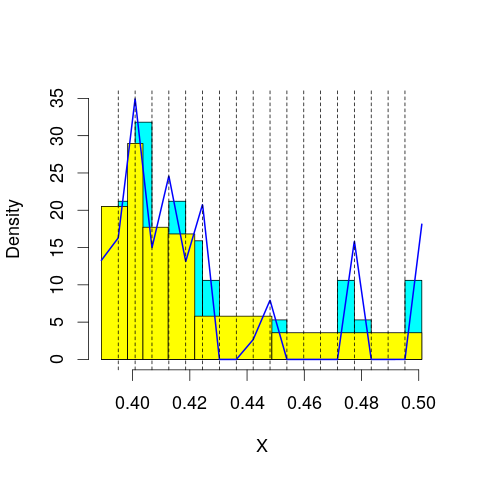

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.49269
mop.approx: Iteration 11. LL = 88.12179
mop.approx: Iteration 21. LL = 88.15855
mop.approx: Iteration 31. LL = 88.16583
mop.approx: Iteration 41. LL = 88.16784
mop.approx: Converged. Iteration 43. LL = 88.16811
[1] "Computing the linear combination of B-splines"


51.7778809707
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.21319
mop.approx: Iteration 11. LL = 88.15614
mop.approx: Iteration 21. LL = 88.1947
mop.approx: Iteration 31. LL = 88.205
mop.approx: Iteration 41. LL = 88.20903
mop.approx: Iteration 51. LL = 88.21081
mop.approx: Converged. Iteration 55. LL = 88.2113
[1] "Computing the linear combination of B-splines"


50.0882009913
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.42242
mop.approx: Iteration 11. LL = 80.49442
mop.approx: Iteration 21. LL = 80.55444
mop.approx: Iteration 31. LL = 80.56018
mop.approx: Converged. Iteration 40. LL = 80.5615
[1] "Computing the linear combination of B-splines"


40.7055397119
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.71327
mop.approx: Iteration 11. LL = 79.91151
mop.approx: Iteration 21. LL = 79.99543
mop.approx: Iteration 31. LL = 80.0229
mop.approx: Iteration 41. LL = 80.03518
mop.approx: Iteration 51. LL = 80.04151
mop.approx: Iteration 61. LL = 80.04515
mop.approx: Iteration 71. LL = 80.04741
mop.approx: Iteration 81. LL = 80.04891
mop.approx: Iteration 91. LL = 80.04994
mop.approx: Converged. Iteration 93. LL = 80.05019
[1] "Computing the linear combination of B-splines"


38.4613589822
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.87014
mop.approx: Iteration 11. LL = 79.48387
mop.approx: Iteration 21. LL = 79.65786
mop.approx: Iteration 31. LL = 79.70115
mop.approx: Iteration 41. LL = 79.71896
mop.approx: Iteration 51. LL = 79.72787
mop.approx: Iteration 61. LL = 79.73279
mop.approx: Iteration 71. LL = 79.73569
mop.approx: Iteration 81. LL = 79.73746
mop.approx: Iteration 91. LL = 79.73857
mop.approx: Converged. Iteration 93. LL = 79.73882
[1] "Computing the linear combination of B-splines"


36.4172924567
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.664562
mop.approx: Iteration 11. LL = 79.86013
mop.approx: Iteration 21. LL = 79.93771
mop.approx: Iteration 31. LL = 79.95579
mop.approx: Iteration 41. LL = 79.96345
mop.approx: Iteration 51. LL = 79.96714
mop.approx: Iteration 61. LL = 79.96905
mop.approx: Converged. Iteration 70. LL = 79.97008
[1] "Computing the linear combination of B-splines"


34.9191471532
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.948049
mop.approx: Iteration 11. LL = 80.86156
mop.approx: Iteration 21. LL = 81.09295
mop.approx: Iteration 31. LL = 81.1411
mop.approx: Iteration 41. LL = 81.15518
mop.approx: Iteration 51. LL = 81.1612
mop.approx: Iteration 61. LL = 81.16439
mop.approx: Iteration 71. LL = 81.16626
mop.approx: Iteration 81. LL = 81.16741
mop.approx: Converged. Iteration 84. LL = 81.16774
[1] "Computing the linear combination of B-splines"


34.1104619795
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.77466
mop.approx: Iteration 11. LL = 89.59715
mop.approx: Iteration 21. LL = 89.6076
mop.approx: Converged. Iteration 24. LL = 89.60809
[1] "Computing the linear combination of B-splines"


53.2178586908
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 53.217858690800327)
m reached
('Sum of Probabilities:', 0.9838246191432827)
chosen


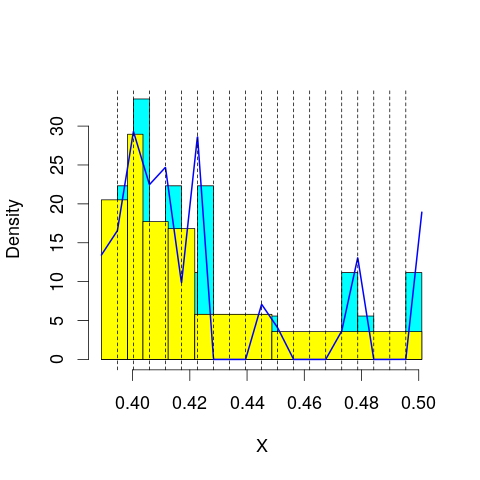

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.49269
mop.approx: Iteration 11. LL = 88.91281
mop.approx: Iteration 21. LL = 88.92988
mop.approx: Converged. Iteration 25. LL = 88.93066
[1] "Computing the linear combination of B-splines"


50.807563818
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 69.21319
mop.approx: Iteration 11. LL = 88.14662
mop.approx: Iteration 21. LL = 88.20192
mop.approx: Iteration 31. LL = 88.21524
mop.approx: Iteration 41. LL = 88.22063
mop.approx: Iteration 51. LL = 88.22323
mop.approx: Iteration 61. LL = 88.22458
mop.approx: Converged. Iteration 63. LL = 88.22485
[1] "Computing the linear combination of B-splines"


48.3688898011
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.42242
mop.approx: Iteration 11. LL = 81.21414
mop.approx: Iteration 21. LL = 81.28648
mop.approx: Iteration 31. LL = 81.30668
mop.approx: Iteration 41. LL = 81.31603
mop.approx: Iteration 51. LL = 81.32106
mop.approx: Iteration 61. LL = 81.32403
mop.approx: Iteration 71. LL = 81.32592
mop.approx: Iteration 81. LL = 81.32719
mop.approx: Converged. Iteration 89. LL = 81.32801
[1] "Computing the linear combination of B-splines"


39.7391793811
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.71327
mop.approx: Iteration 11. LL = 80.27523
mop.approx: Iteration 21. LL = 80.32661
mop.approx: Iteration 31. LL = 80.33804
mop.approx: Iteration 41. LL = 80.34243
mop.approx: Iteration 51. LL = 80.34436
mop.approx: Converged. Iteration 57. LL = 80.34505
[1] "Computing the linear combination of B-splines"


37.0233342299
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.87014
mop.approx: Iteration 11. LL = 79.95475
mop.approx: Iteration 21. LL = 80.13282
mop.approx: Iteration 31. LL = 80.19704
mop.approx: Iteration 41. LL = 80.22451
mop.approx: Iteration 51. LL = 80.2368
mop.approx: Iteration 61. LL = 80.24244
mop.approx: Iteration 71. LL = 80.24509
mop.approx: Iteration 81. LL = 80.24639
mop.approx: Converged. Iteration 83. LL = 80.24663
[1] "Computing the linear combination of B-splines"


35.1912691437
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.664562
mop.approx: Iteration 11. LL = 79.98476
mop.approx: Iteration 21. LL = 80.06283
mop.approx: Iteration 31. LL = 80.08033
mop.approx: Iteration 41. LL = 80.08778
mop.approx: Iteration 51. LL = 80.09138
mop.approx: Iteration 61. LL = 80.09321
mop.approx: Converged. Iteration 69. LL = 80.09411
[1] "Computing the linear combination of B-splines"


33.2477800004
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.948049
mop.approx: Iteration 11. LL = 81.12274
mop.approx: Iteration 21. LL = 81.19581
mop.approx: Iteration 31. LL = 81.2126
mop.approx: Iteration 41. LL = 81.2217
mop.approx: Iteration 51. LL = 81.22745
mop.approx: Iteration 61. LL = 81.23122
mop.approx: Iteration 71. LL = 81.23377
mop.approx: Iteration 81. LL = 81.23552
mop.approx: Iteration 91. LL = 81.23674
mop.approx: Converged. Iteration 98. LL = 81.23746
[1] "Computing the linear combination of B-splines"


32.413950681
lfps_9
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.25594
mop.approx: Converged. Iteration 7. LL = 68.91435
[1] "Computing the linear combination of B-splines"


63.7157438478
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 63.715743847750218)
m reached
('Sum of Probabilities:', 0.9914324242391956)
chosen


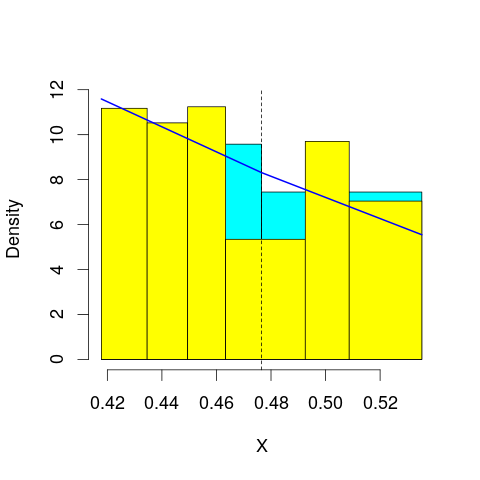

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.98699
mop.approx: Iteration 11. LL = 68.79477
mop.approx: Converged. Iteration 14. LL = 68.79523
[1] "Computing the linear combination of B-splines"


61.8637561926
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.72028
mop.approx: Iteration 11. LL = 68.71924
mop.approx: Iteration 21. LL = 68.76752
mop.approx: Iteration 31. LL = 68.79091
mop.approx: Iteration 41. LL = 68.80334
mop.approx: Iteration 51. LL = 68.81046
mop.approx: Iteration 61. LL = 68.81481
mop.approx: Iteration 71. LL = 68.81759
mop.approx: Iteration 81. LL = 68.81945
mop.approx: Iteration 91. LL = 68.82073
mop.approx: Iteration 101. LL = 68.82163
mop.approx: Converged. Iteration 104. LL = 68.82192
[1] "Computing the linear combination of B-splines"


60.1575768088
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.08101
mop.approx: Iteration 11. LL = 52.89779
mop.approx: Iteration 21. LL = 52.90639
mop.approx: Converged. Iteration 21. LL = 52.90644
[1] "Computing the linear combination of B-splines"


42.5092358251
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.4274
mop.approx: Iteration 11. LL = 56.08905
mop.approx: Iteration 21. LL = 56.12113
mop.approx: Converged. Iteration 21. LL = 56.12117
[1] "Computing the linear combination of B-splines"


43.9910924111
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.62426
mop.approx: Iteration 11. LL = 48.98655
mop.approx: Iteration 21. LL = 49.0582
mop.approx: Iteration 31. LL = 49.07044
mop.approx: Iteration 41. LL = 49.07298
mop.approx: Converged. Iteration 47. LL = 49.07346
[1] "Computing the linear combination of B-splines"


35.2105168603
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.448863
mop.approx: Iteration 11. LL = 51.63405
mop.approx: Iteration 21. LL = 51.71319
mop.approx: Converged. Iteration 24. LL = 51.71356
[1] "Computing the linear combination of B-splines"


36.1177452995
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.75593
mop.approx: Iteration 11. LL = 45.76771
mop.approx: Iteration 21. LL = 45.89636
mop.approx: Iteration 31. LL = 45.93938
mop.approx: Iteration 41. LL = 45.9566
mop.approx: Iteration 51. LL = 45.96444
mop.approx: Iteration 61. LL = 45.96834
mop.approx: Iteration 71. LL = 45.97041
mop.approx: Iteration 81. LL = 45.97157
mop.approx: Iteration 91. LL = 45.97223
mop.approx: Converged. Iteration 93. LL = 45.97237
[1] "Computing the linear combination of B-splines"


28.6436919613
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.25594
mop.approx: Converged. Iteration 9. LL = 69.07954
[1] "Computing the linear combination of B-splines"


62.1480650632
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 62.148065063205628)
m reached
('Sum of Probabilities:', 0.9927775202113001)
chosen


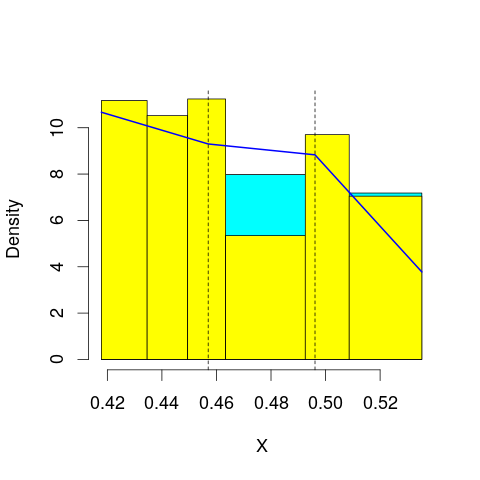

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.98699
mop.approx: Iteration 11. LL = 69.22257
mop.approx: Iteration 21. LL = 69.24808
mop.approx: Converged. Iteration 30. LL = 69.25037
[1] "Computing the linear combination of B-splines"


60.5860343867
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.72028
mop.approx: Iteration 11. LL = 68.72724
mop.approx: Iteration 21. LL = 68.76501
mop.approx: Iteration 31. LL = 68.78094
mop.approx: Iteration 41. LL = 68.78811
mop.approx: Iteration 51. LL = 68.79146
mop.approx: Iteration 61. LL = 68.79308
mop.approx: Converged. Iteration 68. LL = 68.79377
[1] "Computing the linear combination of B-splines"


58.3965621174
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.08101
mop.approx: Iteration 11. LL = 62.32015
mop.approx: Iteration 21. LL = 62.46984
mop.approx: Iteration 31. LL = 62.47856
mop.approx: Converged. Iteration 35. LL = 62.47903
[1] "Computing the linear combination of B-splines"


50.3489570343
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.4274
mop.approx: Iteration 11. LL = 56.67067
mop.approx: Converged. Iteration 17. LL = 56.67295
[1] "Computing the linear combination of B-splines"


42.81000544
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.62426
mop.approx: Iteration 11. LL = 58.65446
mop.approx: Iteration 21. LL = 58.7381
mop.approx: Converged. Iteration 25. LL = 58.73878
[1] "Computing the linear combination of B-splines"


43.1429728596
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.448863
mop.approx: Iteration 11. LL = 52.26481
mop.approx: Iteration 21. LL = 52.3104
mop.approx: Iteration 31. LL = 52.3151
mop.approx: Converged. Iteration 36. LL = 52.31556
[1] "Computing the linear combination of B-splines"


34.9868837634
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.75593
mop.approx: Iteration 11. LL = 54.21377
mop.approx: Iteration 21. LL = 54.33353
mop.approx: Converged. Iteration 26. LL = 54.33463
[1] "Computing the linear combination of B-splines"


35.2730829466
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.25594
mop.approx: Iteration 11. LL = 70.16343
mop.approx: Converged. Iteration 13. LL = 70.16392
[1] "Computing the linear combination of B-splines"


61.4995795689
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 61.499579568941591)
m reached
('Sum of Probabilities:', 0.99419857676797)
chosen


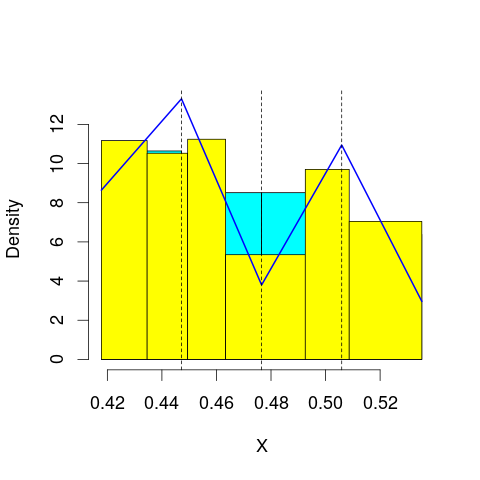

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.98699
mop.approx: Iteration 11. LL = 68.9748
mop.approx: Converged. Iteration 20. LL = 68.97867
[1] "Computing the linear combination of B-splines"


58.5814639337
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.72028
mop.approx: Iteration 11. LL = 70.17775
mop.approx: Iteration 21. LL = 70.53925
mop.approx: Iteration 31. LL = 70.61945
mop.approx: Iteration 41. LL = 70.64165
mop.approx: Iteration 51. LL = 70.64857
mop.approx: Iteration 61. LL = 70.65081
mop.approx: Converged. Iteration 66. LL = 70.65134
[1] "Computing the linear combination of B-splines"


58.5212670421
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.08101
mop.approx: Iteration 11. LL = 63.1032
mop.approx: Converged. Iteration 19. LL = 63.11986
[1] "Computing the linear combination of B-splines"


49.2569132195
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.4274
mop.approx: Iteration 11. LL = 62.10554
mop.approx: Iteration 21. LL = 62.29988
mop.approx: Iteration 31. LL = 62.31763
mop.approx: Iteration 41. LL = 62.3224
mop.approx: Iteration 51. LL = 62.32424
mop.approx: Converged. Iteration 60. LL = 62.32508
[1] "Computing the linear combination of B-splines"


46.7292728877
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.62426
mop.approx: Iteration 11. LL = 59.28686
mop.approx: Converged. Iteration 14. LL = 59.28791
[1] "Computing the linear combination of B-splines"


41.9592267899
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.448863
mop.approx: Iteration 11. LL = 60.3143
mop.approx: Iteration 21. LL = 60.4932
mop.approx: Iteration 31. LL = 60.4988
mop.approx: Converged. Iteration 31. LL = 60.49886
[1] "Computing the linear combination of B-splines"


41.4373099966
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.75593
mop.approx: Iteration 11. LL = 54.89773
mop.approx: Iteration 21. LL = 54.92604
mop.approx: Converged. Iteration 29. LL = 54.92766
[1] "Computing the linear combination of B-splines"


34.1332397425
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.25594
mop.approx: Converged. Iteration 8. LL = 69.71368
[1] "Computing the linear combination of B-splines"


59.3164729188
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 59.316472918817141)
m reached
('Sum of Probabilities:', 0.9941691350085807)
chosen


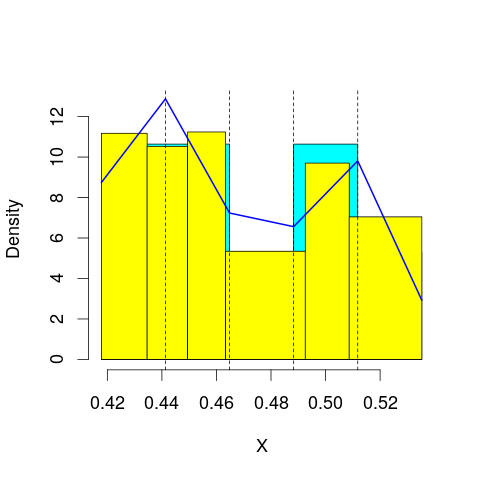

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.98699
mop.approx: Iteration 11. LL = 70.96599
mop.approx: Iteration 21. LL = 71.15103
mop.approx: Iteration 31. LL = 71.1888
mop.approx: Iteration 41. LL = 71.19897
mop.approx: Iteration 51. LL = 71.20196
mop.approx: Converged. Iteration 58. LL = 71.20275
[1] "Computing the linear combination of B-splines"


59.072677428
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.72028
mop.approx: Iteration 11. LL = 70.70877
mop.approx: Iteration 21. LL = 70.80617
mop.approx: Iteration 31. LL = 70.83368
mop.approx: Iteration 41. LL = 70.84585
mop.approx: Iteration 51. LL = 70.85202
mop.approx: Iteration 61. LL = 70.85544
mop.approx: Iteration 71. LL = 70.85746
mop.approx: Iteration 81. LL = 70.85871
mop.approx: Converged. Iteration 89. LL = 70.85945
[1] "Computing the linear combination of B-splines"


56.9965090725
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.08101
mop.approx: Iteration 11. LL = 64.20113
mop.approx: Iteration 21. LL = 64.24012
mop.approx: Iteration 31. LL = 64.24488
mop.approx: Converged. Iteration 38. LL = 64.24571
[1] "Computing the linear combination of B-splines"


48.6498993585
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.4274
mop.approx: Iteration 11. LL = 62.8544
mop.approx: Iteration 21. LL = 63.02023
mop.approx: Iteration 31. LL = 63.0345
mop.approx: Converged. Iteration 39. LL = 63.03599
[1] "Computing the linear combination of B-splines"


45.7073090862
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.62426
mop.approx: Iteration 11. LL = 61.59895
mop.approx: Iteration 21. LL = 61.80394
mop.approx: Iteration 31. LL = 61.83771
mop.approx: Iteration 41. LL = 61.84583
mop.approx: Iteration 51. LL = 61.84803
mop.approx: Converged. Iteration 55. LL = 61.84843
[1] "Computing the linear combination of B-splines"


42.7868844073
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.448863
mop.approx: Iteration 11. LL = 61.05228
mop.approx: Converged. Iteration 16. LL = 61.05586
[1] "Computing the linear combination of B-splines"


40.2614428657
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.75593
mop.approx: Iteration 11. LL = 61.28518
mop.approx: Iteration 21. LL = 61.57502
mop.approx: Iteration 31. LL = 61.60074
mop.approx: Iteration 41. LL = 61.60379
mop.approx: Converged. Iteration 43. LL = 61.60399
[1] "Computing the linear combination of B-splines"


39.0767019523
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.25594
mop.approx: Iteration 11. LL = 70.71636
mop.approx: Converged. Iteration 14. LL = 70.71705
[1] "Computing the linear combination of B-splines"


58.5869694881
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 58.586969488120232)
m reached
('Sum of Probabilities:', 0.99328858299381)
chosen


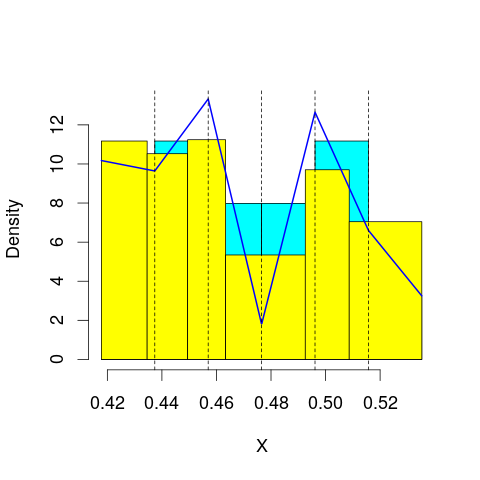

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.98699
mop.approx: Iteration 11. LL = 71.35742
mop.approx: Iteration 21. LL = 71.38665
mop.approx: Converged. Iteration 30. LL = 71.38847
[1] "Computing the linear combination of B-splines"


57.5255307557
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.72028
mop.approx: Iteration 11. LL = 71.1321
mop.approx: Iteration 21. LL = 71.23372
mop.approx: Iteration 31. LL = 71.25536
mop.approx: Iteration 41. LL = 71.2615
mop.approx: Iteration 51. LL = 71.26348
mop.approx: Converged. Iteration 55. LL = 71.26392
[1] "Computing the linear combination of B-splines"


55.6681097634
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.08101
mop.approx: Iteration 11. LL = 64.13522
mop.approx: Iteration 21. LL = 64.14737
mop.approx: Converged. Iteration 28. LL = 64.14848
[1] "Computing the linear combination of B-splines"


46.8197958194
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.4274
mop.approx: Iteration 11. LL = 65.64658
mop.approx: Iteration 21. LL = 65.79663
mop.approx: Iteration 31. LL = 65.8148
mop.approx: Iteration 41. LL = 65.8182
mop.approx: Converged. Iteration 45. LL = 65.81867
[1] "Computing the linear combination of B-splines"


46.7571189599
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.62426
mop.approx: Iteration 11. LL = 61.94244
mop.approx: Iteration 21. LL = 62.06699
mop.approx: Iteration 31. LL = 62.08496
mop.approx: Iteration 41. LL = 62.08864
mop.approx: Converged. Iteration 47. LL = 62.08934
[1] "Computing the linear combination of B-splines"


41.2949218638
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.448863
mop.approx: Iteration 11. LL = 61.55071
mop.approx: Iteration 21. LL = 61.59191
mop.approx: Iteration 31. LL = 61.59556
mop.approx: Converged. Iteration 33. LL = 61.59577
[1] "Computing the linear combination of B-splines"


39.0684863309
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.75593
mop.approx: Iteration 11. LL = 62.15033
mop.approx: Converged. Iteration 20. LL = 62.17043
[1] "Computing the linear combination of B-splines"


37.9102833319
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.25594
mop.approx: Converged. Iteration 10. LL = 70.72294
[1] "Computing the linear combination of B-splines"


56.8599977712
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 56.859997771219788)
m reached
('Sum of Probabilities:', 0.9930293010523605)
chosen


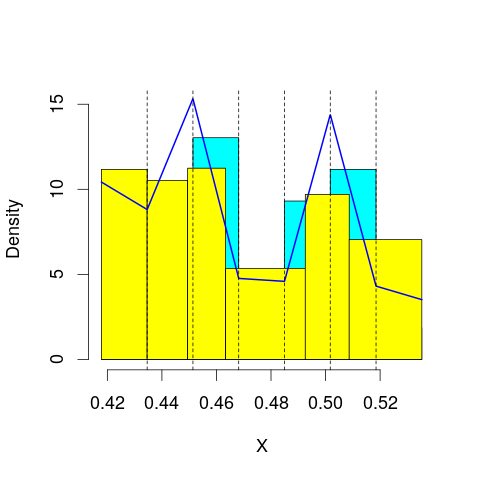

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.98699
mop.approx: Iteration 11. LL = 71.68034
mop.approx: Iteration 21. LL = 71.70511
mop.approx: Iteration 31. LL = 71.70977
mop.approx: Iteration 41. LL = 71.7115
mop.approx: Converged. Iteration 48. LL = 71.71221
[1] "Computing the linear combination of B-splines"


56.1164033141
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.72028
mop.approx: Iteration 11. LL = 71.4991
mop.approx: Iteration 21. LL = 71.53675
mop.approx: Iteration 31. LL = 71.54059
mop.approx: Converged. Iteration 40. LL = 71.54164
[1] "Computing the linear combination of B-splines"


54.2129593571
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.08101
mop.approx: Iteration 11. LL = 65.27221
mop.approx: Iteration 21. LL = 65.34409
mop.approx: Iteration 31. LL = 65.34877
mop.approx: Converged. Iteration 32. LL = 65.34891
[1] "Computing the linear combination of B-splines"


46.2873671341
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.4274
mop.approx: Iteration 11. LL = 66.00629
mop.approx: Iteration 21. LL = 66.04806
mop.approx: Iteration 31. LL = 66.06044
mop.approx: Iteration 41. LL = 66.06586
mop.approx: Iteration 51. LL = 66.06868
mop.approx: Iteration 61. LL = 66.07033
mop.approx: Iteration 71. LL = 66.07138
mop.approx: Converged. Iteration 78. LL = 66.07197
[1] "Computing the linear combination of B-splines"


45.2775564614
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.62426
mop.approx: Iteration 11. LL = 65.66562
mop.approx: Iteration 21. LL = 65.92555
mop.approx: Iteration 31. LL = 65.94452
mop.approx: Iteration 41. LL = 65.94659
mop.approx: Converged. Iteration 41. LL = 65.94665
[1] "Computing the linear combination of B-splines"


43.419362358
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.448863
mop.approx: Iteration 11. LL = 61.72591
mop.approx: Iteration 21. LL = 61.77418
mop.approx: Iteration 31. LL = 61.78231
mop.approx: Iteration 41. LL = 61.78429
mop.approx: Converged. Iteration 45. LL = 61.78465
[1] "Computing the linear combination of B-splines"


37.5244994261
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.75593
mop.approx: Iteration 11. LL = 62.17068
mop.approx: Converged. Iteration 17. LL = 62.17456
[1] "Computing the linear combination of B-splines"


36.1815685711
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.25594
mop.approx: Iteration 11. LL = 71.22288
mop.approx: Iteration 21. LL = 71.23368
mop.approx: Converged. Iteration 27. LL = 71.23459
[1] "Computing the linear combination of B-splines"


55.6387744964
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 55.638774496444896)
m reached
('Sum of Probabilities:', 0.9927881235666177)
chosen


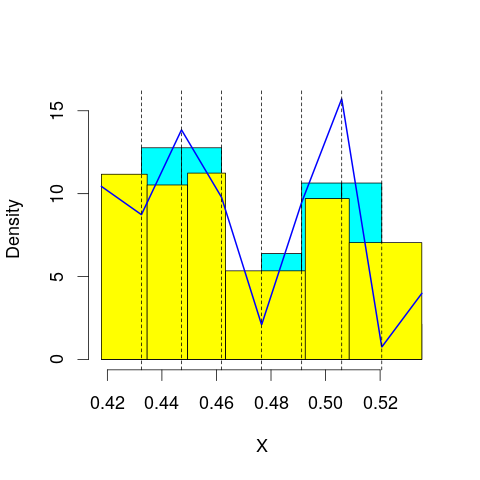

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.98699
mop.approx: Iteration 11. LL = 71.83428
mop.approx: Iteration 21. LL = 71.84345
mop.approx: Converged. Iteration 27. LL = 71.8443
[1] "Computing the linear combination of B-splines"


54.5156162226
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.72028
mop.approx: Iteration 11. LL = 71.76552
mop.approx: Iteration 21. LL = 71.84436
mop.approx: Iteration 31. LL = 71.86473
mop.approx: Iteration 41. LL = 71.87236
mop.approx: Iteration 51. LL = 71.87583
mop.approx: Iteration 61. LL = 71.87764
mop.approx: Iteration 71. LL = 71.87869
mop.approx: Converged. Iteration 74. LL = 71.87899
[1] "Computing the linear combination of B-splines"


52.8174469334
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.08101
mop.approx: Iteration 11. LL = 66.35205
mop.approx: Iteration 21. LL = 66.38262
mop.approx: Iteration 31. LL = 66.38579
mop.approx: Iteration 41. LL = 66.38741
mop.approx: Iteration 51. LL = 66.38857
mop.approx: Iteration 61. LL = 66.38943
mop.approx: Converged. Iteration 65. LL = 66.38978
[1] "Computing the linear combination of B-splines"


45.5953646405
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.4274
mop.approx: Iteration 11. LL = 66.2486
mop.approx: Iteration 21. LL = 66.31115
mop.approx: Iteration 31. LL = 66.32016
mop.approx: Converged. Iteration 39. LL = 66.32146
[1] "Computing the linear combination of B-splines"


43.7941785046
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.62426
mop.approx: Iteration 11. LL = 67.04782
mop.approx: Iteration 21. LL = 67.16047
mop.approx: Iteration 31. LL = 67.17446
mop.approx: Iteration 41. LL = 67.1796
mop.approx: Iteration 51. LL = 67.18159
mop.approx: Converged. Iteration 57. LL = 67.1822
[1] "Computing the linear combination of B-splines"


42.9220485893
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.448863
mop.approx: Iteration 11. LL = 64.92433
mop.approx: Iteration 21. LL = 65.12592
mop.approx: Iteration 31. LL = 65.14044
mop.approx: Converged. Iteration 40. LL = 65.1422
[1] "Computing the linear combination of B-splines"


39.1491560262
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.75593
mop.approx: Iteration 11. LL = 62.28824
mop.approx: Iteration 21. LL = 62.31985
mop.approx: Iteration 31. LL = 62.3245
mop.approx: Converged. Iteration 36. LL = 62.3251
[1] "Computing the linear combination of B-splines"


34.5986885892
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.25594
mop.approx: Iteration 11. LL = 72.49198
mop.approx: Iteration 21. LL = 72.51453
mop.approx: Iteration 31. LL = 72.51875
mop.approx: Iteration 41. LL = 72.52039
mop.approx: Converged. Iteration 48. LL = 72.52109
[1] "Computing the linear combination of B-splines"


55.1924112266
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 55.192411226643543)
m reached
('Sum of Probabilities:', 0.9923205167306651)
chosen


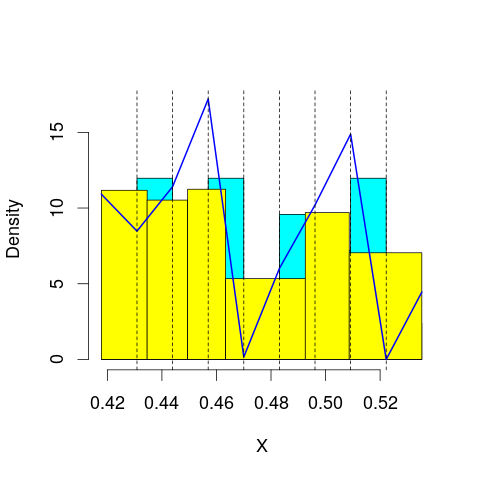

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.98699
mop.approx: Iteration 11. LL = 71.92093
mop.approx: Iteration 21. LL = 71.94934
mop.approx: Iteration 31. LL = 71.95569
mop.approx: Iteration 41. LL = 71.95783
mop.approx: Converged. Iteration 50. LL = 71.95878
[1] "Computing the linear combination of B-splines"


52.8972366907
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.72028
mop.approx: Iteration 11. LL = 72.16602
mop.approx: Iteration 21. LL = 72.26971
mop.approx: Iteration 31. LL = 72.30092
mop.approx: Iteration 41. LL = 72.31369
mop.approx: Iteration 51. LL = 72.31944
mop.approx: Iteration 61. LL = 72.3222
mop.approx: Iteration 71. LL = 72.32361
mop.approx: Converged. Iteration 77. LL = 72.32418
[1] "Computing the linear combination of B-splines"


51.5297655599
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.08101
mop.approx: Iteration 11. LL = 66.62799
mop.approx: Converged. Iteration 15. LL = 66.62913
[1] "Computing the linear combination of B-splines"


44.1018501728
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.4274
mop.approx: Iteration 11. LL = 66.81492
mop.approx: Iteration 21. LL = 66.8634
mop.approx: Iteration 31. LL = 66.87064
mop.approx: Iteration 41. LL = 66.87295
mop.approx: Iteration 51. LL = 66.87412
mop.approx: Converged. Iteration 60. LL = 66.87488
[1] "Computing the linear combination of B-splines"


42.6147306819
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.62426
mop.approx: Iteration 11. LL = 67.16381
mop.approx: Iteration 21. LL = 67.21769
mop.approx: Iteration 31. LL = 67.22766
mop.approx: Iteration 41. LL = 67.23096
mop.approx: Converged. Iteration 50. LL = 67.23207
[1] "Computing the linear combination of B-splines"


41.2390460324
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.448863
mop.approx: Iteration 11. LL = 67.10382
mop.approx: Iteration 21. LL = 67.38667
mop.approx: Iteration 31. LL = 67.42521
mop.approx: Iteration 41. LL = 67.43387
mop.approx: Iteration 51. LL = 67.43649
mop.approx: Iteration 61. LL = 67.43755
mop.approx: Converged. Iteration 62. LL = 67.43768
[1] "Computing the linear combination of B-splines"


39.7117845959
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.75593
mop.approx: Iteration 11. LL = 64.46526
mop.approx: Iteration 21. LL = 64.57712
mop.approx: Iteration 31. LL = 64.58596
mop.approx: Iteration 41. LL = 64.58801
mop.approx: Converged. Iteration 46. LL = 64.58849
[1] "Computing the linear combination of B-splines"


35.1282380654
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.25594
mop.approx: Iteration 11. LL = 72.66447
mop.approx: Converged. Iteration 12. LL = 72.66462
[1] "Computing the linear combination of B-splines"


53.603071552
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 53.60307155201523)
m reached
('Sum of Probabilities:', 0.991661643331129)
chosen


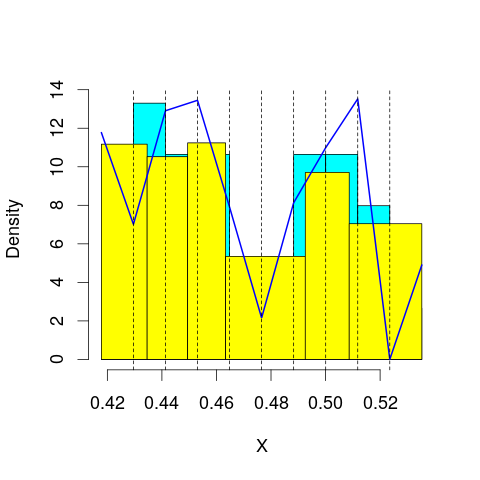

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.98699
mop.approx: Iteration 11. LL = 72.26535
mop.approx: Iteration 21. LL = 72.33418
mop.approx: Iteration 31. LL = 72.34926
mop.approx: Iteration 41. LL = 72.35342
mop.approx: Iteration 51. LL = 72.35474
mop.approx: Converged. Iteration 51. LL = 72.35481
[1] "Computing the linear combination of B-splines"


51.560391055
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.72028
mop.approx: Iteration 11. LL = 72.27433
mop.approx: Iteration 21. LL = 72.33226
mop.approx: Iteration 31. LL = 72.35027
mop.approx: Iteration 41. LL = 72.3577
mop.approx: Iteration 51. LL = 72.36126
mop.approx: Iteration 61. LL = 72.36312
mop.approx: Iteration 71. LL = 72.36417
mop.approx: Converged. Iteration 73. LL = 72.36439
[1] "Computing the linear combination of B-splines"


49.8371068201
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.08101
mop.approx: Iteration 11. LL = 66.88307
mop.approx: Iteration 21. LL = 66.92026
mop.approx: Iteration 31. LL = 66.93595
mop.approx: Iteration 41. LL = 66.9425
mop.approx: Iteration 51. LL = 66.94524
mop.approx: Iteration 61. LL = 66.94639
mop.approx: Converged. Iteration 62. LL = 66.94653
[1] "Computing the linear combination of B-splines"


42.686374942
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.4274
mop.approx: Iteration 11. LL = 66.97879
mop.approx: Converged. Iteration 18. LL = 66.98283
[1] "Computing the linear combination of B-splines"


40.9898147347
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.62426
mop.approx: Iteration 11. LL = 67.3679
mop.approx: Iteration 21. LL = 67.41551
mop.approx: Iteration 31. LL = 67.42394
mop.approx: Iteration 41. LL = 67.42684
mop.approx: Iteration 51. LL = 67.42818
mop.approx: Converged. Iteration 58. LL = 67.42881
[1] "Computing the linear combination of B-splines"


39.7029228067
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.448863
mop.approx: Iteration 11. LL = 67.60102
mop.approx: Iteration 21. LL = 67.75542
mop.approx: Iteration 31. LL = 67.76861
mop.approx: Iteration 41. LL = 67.77164
mop.approx: Iteration 51. LL = 67.77291
mop.approx: Converged. Iteration 56. LL = 67.77337
[1] "Computing the linear combination of B-splines"


38.3145565626
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.75593
mop.approx: Iteration 11. LL = 66.63175
mop.approx: Iteration 21. LL = 66.88789
mop.approx: Iteration 31. LL = 66.91058
mop.approx: Iteration 41. LL = 66.91296
mop.approx: Converged. Iteration 41. LL = 66.91302
[1] "Computing the linear combination of B-splines"


35.7182603329
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.25594
mop.approx: Iteration 11. LL = 73.52794
mop.approx: Iteration 21. LL = 73.54237
mop.approx: Converged. Iteration 23. LL = 73.54266
[1] "Computing the linear combination of B-splines"


52.7482430274
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 52.748243027375423)
m reached
('Sum of Probabilities:', 0.9908075202190059)
chosen


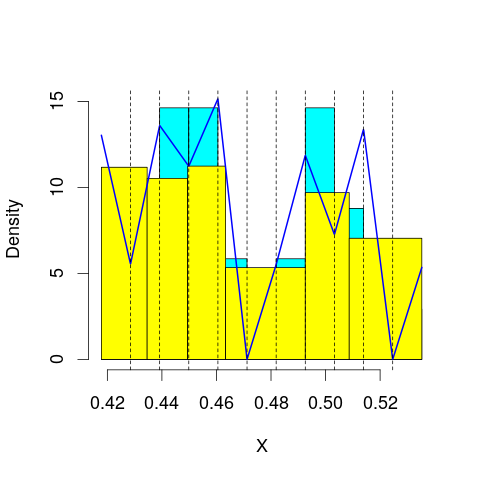

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.98699
mop.approx: Iteration 11. LL = 72.43734
mop.approx: Iteration 21. LL = 72.47501
mop.approx: Iteration 31. LL = 72.48092
mop.approx: Iteration 41. LL = 72.48239
mop.approx: Converged. Iteration 41. LL = 72.48246
[1] "Computing the linear combination of B-splines"


49.9551739496
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.72028
mop.approx: Iteration 11. LL = 72.52226
mop.approx: Iteration 21. LL = 72.5774
mop.approx: Iteration 31. LL = 72.58855
mop.approx: Iteration 41. LL = 72.59179
mop.approx: Iteration 51. LL = 72.59313
mop.approx: Converged. Iteration 56. LL = 72.59361
[1] "Computing the linear combination of B-splines"


48.3334543973
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.08101
mop.approx: Iteration 11. LL = 67.05882
mop.approx: Iteration 21. LL = 67.09368
mop.approx: Iteration 31. LL = 67.10518
mop.approx: Iteration 41. LL = 67.10957
mop.approx: Iteration 51. LL = 67.11132
mop.approx: Converged. Iteration 56. LL = 67.11181
[1] "Computing the linear combination of B-splines"


41.1187897965
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.4274
mop.approx: Iteration 11. LL = 67.1672
mop.approx: Iteration 21. LL = 67.20907
mop.approx: Iteration 31. LL = 67.22767
mop.approx: Iteration 41. LL = 67.23486
mop.approx: Iteration 51. LL = 67.23743
mop.approx: Converged. Iteration 58. LL = 67.23821
[1] "Computing the linear combination of B-splines"


39.5123196932
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.62426
mop.approx: Iteration 11. LL = 67.42941
mop.approx: Iteration 21. LL = 67.44042
mop.approx: Iteration 31. LL = 67.44227
mop.approx: Iteration 41. LL = 67.44334
mop.approx: Converged. Iteration 50. LL = 67.44409
[1] "Computing the linear combination of B-splines"


37.9853399115
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.448863
mop.approx: Iteration 11. LL = 67.71662
mop.approx: Iteration 21. LL = 67.79249
mop.approx: Iteration 31. LL = 67.79855
mop.approx: Iteration 41. LL = 67.80063
mop.approx: Iteration 51. LL = 67.8017
mop.approx: Converged. Iteration 55. LL = 67.80206
[1] "Computing the linear combination of B-splines"


36.6104881511
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.75593
mop.approx: Iteration 11. LL = 67.47786
mop.approx: Iteration 21. LL = 67.71471
mop.approx: Iteration 31. LL = 67.76502
mop.approx: Iteration 41. LL = 67.78307
mop.approx: Iteration 51. LL = 67.79068
mop.approx: Iteration 61. LL = 67.79418
mop.approx: Iteration 71. LL = 67.79591
mop.approx: Iteration 81. LL = 67.79682
mop.approx: Converged. Iteration 81. LL = 67.79689
[1] "Computing the linear combination of B-splines"


34.8692011927
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.25594
mop.approx: Iteration 11. LL = 73.14453
mop.approx: Iteration 21. LL = 73.17364
mop.approx: Iteration 31. LL = 73.18047
mop.approx: Iteration 41. LL = 73.18308
mop.approx: Iteration 51. LL = 73.18434
mop.approx: Converged. Iteration 55. LL = 73.18473
[1] "Computing the linear combination of B-splines"


50.6574516265
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 50.657451626520597)
m reached
('Sum of Probabilities:', 0.9901150327664531)
chosen


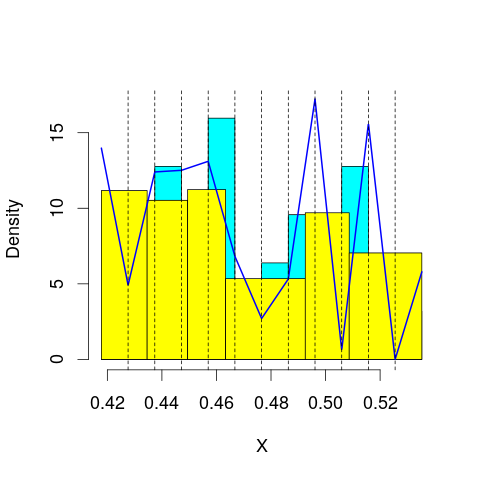

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.98699
mop.approx: Iteration 11. LL = 73.31881
mop.approx: Iteration 21. LL = 73.35864
mop.approx: Iteration 31. LL = 73.36113
mop.approx: Converged. Iteration 32. LL = 73.36128
[1] "Computing the linear combination of B-splines"


49.1011269662
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.72028
mop.approx: Iteration 11. LL = 72.45222
mop.approx: Iteration 21. LL = 72.47655
mop.approx: Iteration 31. LL = 72.47975
mop.approx: Converged. Iteration 37. LL = 72.48043
[1] "Computing the linear combination of B-splines"


46.4874068617
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.08101
mop.approx: Iteration 11. LL = 67.35153
mop.approx: Iteration 21. LL = 67.40357
mop.approx: Iteration 31. LL = 67.41238
mop.approx: Converged. Iteration 40. LL = 67.41391
[1] "Computing the linear combination of B-splines"


39.6880246174
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.4274
mop.approx: Iteration 11. LL = 67.39045
mop.approx: Iteration 21. LL = 67.45445
mop.approx: Iteration 31. LL = 67.47662
mop.approx: Iteration 41. LL = 67.48513
mop.approx: Iteration 51. LL = 67.48865
mop.approx: Iteration 61. LL = 67.49017
mop.approx: Converged. Iteration 66. LL = 67.49065
[1] "Computing the linear combination of B-splines"


38.0318963869
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.62426
mop.approx: Iteration 11. LL = 67.49276
mop.approx: Iteration 21. LL = 67.52232
mop.approx: Iteration 31. LL = 67.5357
mop.approx: Iteration 41. LL = 67.54163
mop.approx: Iteration 51. LL = 67.54408
mop.approx: Converged. Iteration 59. LL = 67.54499
[1] "Computing the linear combination of B-splines"


36.3533604177
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.448863
mop.approx: Iteration 11. LL = 67.76443
mop.approx: Iteration 21. LL = 67.80539
mop.approx: Iteration 31. LL = 67.80952
mop.approx: Iteration 41. LL = 67.81182
mop.approx: Iteration 51. LL = 67.81331
mop.approx: Iteration 61. LL = 67.81432
mop.approx: Converged. Iteration 67. LL = 67.81484
[1] "Computing the linear combination of B-splines"


34.8895049638
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.75593
mop.approx: Iteration 11. LL = 67.65712
mop.approx: Iteration 21. LL = 67.82146
mop.approx: Iteration 31. LL = 67.84402
mop.approx: Iteration 41. LL = 67.84883
mop.approx: Iteration 51. LL = 67.85033
mop.approx: Converged. Iteration 58. LL = 67.85097
[1] "Computing the linear combination of B-splines"


33.1891226608
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.25594
mop.approx: Iteration 11. LL = 73.31159
mop.approx: Converged. Iteration 17. LL = 73.3156
[1] "Computing the linear combination of B-splines"


49.0554529684
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 49.055452968363049)
m reached
('Sum of Probabilities:', 0.9893939804191618)
chosen


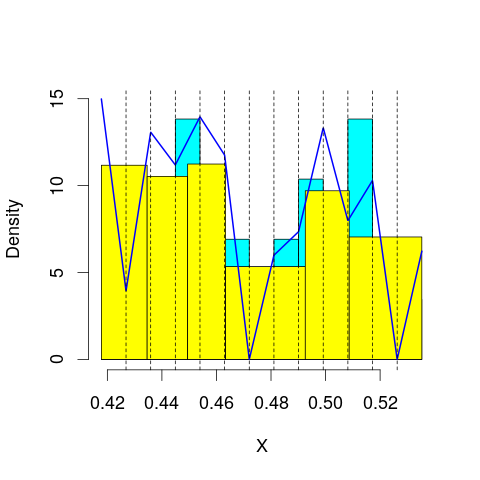

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.98699
mop.approx: Iteration 11. LL = 73.63687
mop.approx: Iteration 21. LL = 73.65927
mop.approx: Iteration 31. LL = 73.66249
mop.approx: Converged. Iteration 36. LL = 73.66307
[1] "Computing the linear combination of B-splines"


47.6700528664
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.72028
mop.approx: Iteration 11. LL = 72.53029
mop.approx: Iteration 21. LL = 72.55801
mop.approx: Iteration 31. LL = 72.56071
mop.approx: Converged. Iteration 40. LL = 72.56163
[1] "Computing the linear combination of B-splines"


44.8357467777
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.08101
mop.approx: Iteration 11. LL = 67.63061
mop.approx: Iteration 21. LL = 67.71998
mop.approx: Iteration 31. LL = 67.74588
mop.approx: Iteration 41. LL = 67.75657
mop.approx: Iteration 51. LL = 67.76205
mop.approx: Iteration 61. LL = 67.7652
mop.approx: Iteration 71. LL = 67.7671
mop.approx: Iteration 81. LL = 67.76827
mop.approx: Converged. Iteration 87. LL = 67.76882
[1] "Computing the linear combination of B-splines"


38.3100638576
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.4274
mop.approx: Iteration 11. LL = 67.61127
mop.approx: Iteration 21. LL = 67.66067
mop.approx: Iteration 31. LL = 67.67258
mop.approx: Iteration 41. LL = 67.67594
mop.approx: Converged. Iteration 50. LL = 67.67702
[1] "Computing the linear combination of B-splines"


36.4853926014
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.62426
mop.approx: Iteration 11. LL = 67.6475
mop.approx: Iteration 21. LL = 67.73927
mop.approx: Iteration 31. LL = 67.78049
mop.approx: Iteration 41. LL = 67.79958
mop.approx: Iteration 51. LL = 67.80845
mop.approx: Iteration 61. LL = 67.81254
mop.approx: Iteration 71. LL = 67.81441
mop.approx: Converged. Iteration 78. LL = 67.81513
[1] "Computing the linear combination of B-splines"


34.8906338024
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.448863
mop.approx: Iteration 11. LL = 67.81105
mop.approx: Iteration 21. LL = 67.85672
mop.approx: Iteration 31. LL = 67.86751
mop.approx: Iteration 41. LL = 67.87168
mop.approx: Iteration 51. LL = 67.87329
mop.approx: Converged. Iteration 55. LL = 67.87366
[1] "Computing the linear combination of B-splines"


33.216267249
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.75593
mop.approx: Iteration 11. LL = 67.78476
mop.approx: Iteration 21. LL = 67.90659
mop.approx: Iteration 31. LL = 67.92226
mop.approx: Iteration 41. LL = 67.92679
mop.approx: Iteration 51. LL = 67.92905
mop.approx: Iteration 61. LL = 67.93041
mop.approx: Iteration 71. LL = 67.93128
mop.approx: Converged. Iteration 71. LL = 67.93134
[1] "Computing the linear combination of B-splines"


31.52025717
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.25594
mop.approx: Iteration 11. LL = 72.97768
mop.approx: Converged. Iteration 12. LL = 72.97784
[1] "Computing the linear combination of B-splines"


46.9848157513
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 46.984815751305021)
m reached
('Sum of Probabilities:', 0.989088854012703)
chosen


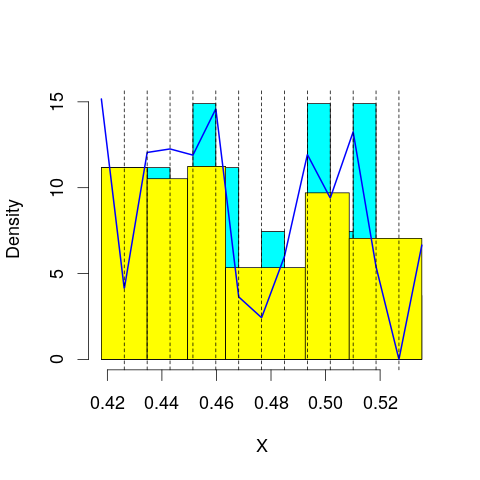

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.98699
mop.approx: Iteration 11. LL = 74.84347
mop.approx: Iteration 21. LL = 74.92078
mop.approx: Iteration 31. LL = 74.92816
mop.approx: Iteration 41. LL = 74.92973
mop.approx: Converged. Iteration 44. LL = 74.93004
[1] "Computing the linear combination of B-splines"


47.2041566437
('best: ', 46.984815751305021, 'accepted difference:', 79.87418677721854, 'cur BIC:', 47.20415664374849)
m reached
('Sum of Probabilities:', 0.9738707972028564)
chosen


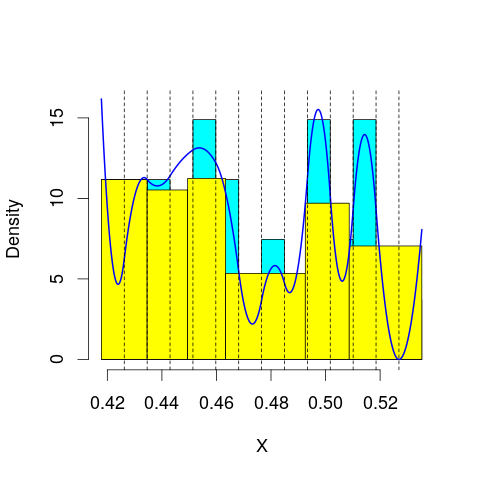

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.72028
mop.approx: Iteration 11. LL = 72.81887
mop.approx: Iteration 21. LL = 72.87435
mop.approx: Iteration 31. LL = 72.88735
mop.approx: Iteration 41. LL = 72.89258
mop.approx: Iteration 51. LL = 72.89518
mop.approx: Iteration 61. LL = 72.89659
mop.approx: Converged. Iteration 68. LL = 72.89727
[1] "Computing the linear combination of B-splines"


43.4385156029
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.08101
mop.approx: Iteration 11. LL = 67.80766
mop.approx: Iteration 21. LL = 67.92944
mop.approx: Iteration 31. LL = 67.96832
mop.approx: Iteration 41. LL = 67.98381
mop.approx: Iteration 51. LL = 67.99051
mop.approx: Iteration 61. LL = 67.99349
mop.approx: Iteration 71. LL = 67.99482
mop.approx: Converged. Iteration 74. LL = 67.99511
[1] "Computing the linear combination of B-splines"


36.8034861063
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.4274
mop.approx: Iteration 11. LL = 67.94881
mop.approx: Iteration 21. LL = 68.04592
mop.approx: Iteration 31. LL = 68.07565
mop.approx: Iteration 41. LL = 68.08572
mop.approx: Iteration 51. LL = 68.08926
mop.approx: Iteration 61. LL = 68.09058
mop.approx: Converged. Iteration 63. LL = 68.0908
[1] "Computing the linear combination of B-splines"


35.1663039162
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.62426
mop.approx: Iteration 11. LL = 67.7783
mop.approx: Iteration 21. LL = 67.83138
mop.approx: Iteration 31. LL = 67.84555
mop.approx: Iteration 41. LL = 67.85079
mop.approx: Iteration 51. LL = 67.85318
mop.approx: Iteration 61. LL = 67.85443
mop.approx: Converged. Iteration 66. LL = 67.8549
[1] "Computing the linear combination of B-splines"


33.1975488506
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.448863
mop.approx: Iteration 11. LL = 67.93257
mop.approx: Iteration 21. LL = 68.03584
mop.approx: Iteration 31. LL = 68.07663
mop.approx: Iteration 41. LL = 68.09413
mop.approx: Iteration 51. LL = 68.10134
mop.approx: Iteration 61. LL = 68.10423
mop.approx: Iteration 71. LL = 68.10537
mop.approx: Converged. Iteration 71. LL = 68.10543
[1] "Computing the linear combination of B-splines"


31.7133019862
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.75593
mop.approx: Iteration 11. LL = 67.95213
mop.approx: Iteration 21. LL = 68.09241
mop.approx: Iteration 31. LL = 68.12426
mop.approx: Iteration 41. LL = 68.13723
mop.approx: Iteration 51. LL = 68.14361
mop.approx: Iteration 61. LL = 68.14708
mop.approx: Iteration 71. LL = 68.14907
mop.approx: Iteration 81. LL = 68.15025
mop.approx: Converged. Iteration 87. LL = 68.1508
[1] "Computing the linear combination of B-splines"


30.00246836
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.25594
mop.approx: Iteration 11. LL = 75.27853
mop.approx: Iteration 21. LL = 75.32852
mop.approx: Iteration 31. LL = 75.33414
mop.approx: Converged. Iteration 35. LL = 75.33467
[1] "Computing the linear combination of B-splines"


47.6087858189
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 47.608785818936695)
m reached
('Sum of Probabilities:', 0.9890169808484596)
chosen


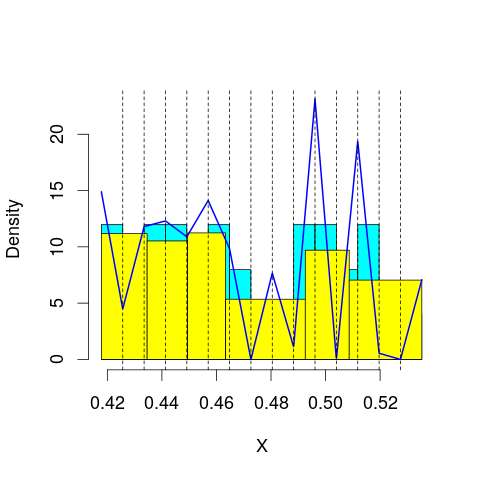

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.98699
mop.approx: Iteration 11. LL = 73.79189
mop.approx: Iteration 21. LL = 73.87655
mop.approx: Iteration 31. LL = 73.89904
mop.approx: Iteration 41. LL = 73.90689
mop.approx: Iteration 51. LL = 73.91005
mop.approx: Iteration 61. LL = 73.91145
mop.approx: Converged. Iteration 64. LL = 73.91177
[1] "Computing the linear combination of B-splines"


44.453014987
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.72028
mop.approx: Iteration 11. LL = 73.99028
mop.approx: Iteration 21. LL = 74.13842
mop.approx: Iteration 31. LL = 74.16066
mop.approx: Iteration 41. LL = 74.1661
mop.approx: Iteration 51. LL = 74.16814
mop.approx: Converged. Iteration 60. LL = 74.16912
[1] "Computing the linear combination of B-splines"


42.9774936567
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.08101
mop.approx: Iteration 11. LL = 67.67359
mop.approx: Iteration 21. LL = 67.7376
mop.approx: Iteration 31. LL = 67.75662
mop.approx: Iteration 41. LL = 67.76395
mop.approx: Iteration 51. LL = 67.76732
mop.approx: Iteration 61. LL = 67.76906
mop.approx: Iteration 71. LL = 67.77003
mop.approx: Converged. Iteration 72. LL = 67.77017
[1] "Computing the linear combination of B-splines"


34.8456802995
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.4274
mop.approx: Iteration 11. LL = 68.2679
mop.approx: Iteration 21. LL = 68.41946
mop.approx: Iteration 31. LL = 68.47317
mop.approx: Iteration 41. LL = 68.49399
mop.approx: Iteration 51. LL = 68.50264
mop.approx: Iteration 61. LL = 68.50655
mop.approx: Iteration 71. LL = 68.50852
mop.approx: Iteration 81. LL = 68.50962
mop.approx: Converged. Iteration 86. LL = 68.51007
[1] "Computing the linear combination of B-splines"


33.8527089136
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.62426
mop.approx: Iteration 11. LL = 68.05618
mop.approx: Iteration 21. LL = 68.14179
mop.approx: Iteration 31. LL = 68.16679
mop.approx: Iteration 41. LL = 68.17514
mop.approx: Iteration 51. LL = 68.1782
mop.approx: Iteration 61. LL = 68.17944
mop.approx: Converged. Iteration 63. LL = 68.17966
[1] "Computing the linear combination of B-splines"


31.7893554124
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.448863
mop.approx: Iteration 11. LL = 67.99873
mop.approx: Iteration 21. LL = 68.07229
mop.approx: Iteration 31. LL = 68.09472
mop.approx: Iteration 41. LL = 68.10369
mop.approx: Iteration 51. LL = 68.1078
mop.approx: Iteration 61. LL = 68.10987
mop.approx: Iteration 71. LL = 68.11099
mop.approx: Converged. Iteration 74. LL = 68.11128
[1] "Computing the linear combination of B-splines"


29.988084216
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.75593
mop.approx: Iteration 11. LL = 68.32723
mop.approx: Iteration 21. LL = 68.47141
mop.approx: Iteration 31. LL = 68.51392
mop.approx: Iteration 41. LL = 68.53464
mop.approx: Iteration 51. LL = 68.54525
mop.approx: Iteration 61. LL = 68.55062
mop.approx: Iteration 71. LL = 68.5533
mop.approx: Iteration 81. LL = 68.55462
mop.approx: Converged. Iteration 85. LL = 68.555
[1] "Computing the linear combination of B-splines"


28.6458238788
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.25594
mop.approx: Iteration 11. LL = 75.697
mop.approx: Iteration 21. LL = 75.72811
mop.approx: Iteration 31. LL = 75.73162
mop.approx: Converged. Iteration 33. LL = 75.73187
[1] "Computing the linear combination of B-splines"


46.2731101725
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 46.273110172537052)
m reached
('Sum of Probabilities:', 0.9891690989850287)
chosen


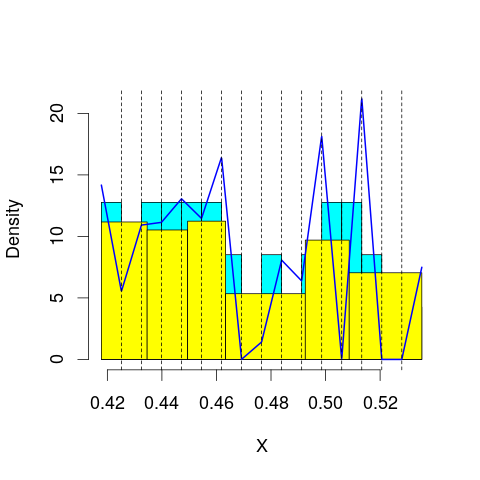

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.98699
mop.approx: Iteration 11. LL = 74.2012
mop.approx: Iteration 21. LL = 74.26623
mop.approx: Iteration 31. LL = 74.2814
mop.approx: Iteration 41. LL = 74.28585
mop.approx: Iteration 51. LL = 74.2873
mop.approx: Converged. Iteration 52. LL = 74.28744
[1] "Computing the linear combination of B-splines"


43.0958212976
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.72028
mop.approx: Iteration 11. LL = 74.36768
mop.approx: Iteration 21. LL = 74.48876
mop.approx: Iteration 31. LL = 74.5039
mop.approx: Iteration 41. LL = 74.5077
mop.approx: Iteration 51. LL = 74.50906
mop.approx: Converged. Iteration 52. LL = 74.50922
[1] "Computing the linear combination of B-splines"


41.584726688
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.08101
mop.approx: Iteration 11. LL = 67.9638
mop.approx: Iteration 21. LL = 68.07656
mop.approx: Iteration 31. LL = 68.11145
mop.approx: Iteration 41. LL = 68.1255
mop.approx: Iteration 51. LL = 68.13183
mop.approx: Iteration 61. LL = 68.1349
mop.approx: Iteration 71. LL = 68.13649
mop.approx: Converged. Iteration 80. LL = 68.13737
[1] "Computing the linear combination of B-splines"


33.4800126134
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.4274
mop.approx: Iteration 11. LL = 68.47951
mop.approx: Iteration 21. LL = 68.65085
mop.approx: Iteration 31. LL = 68.69877
mop.approx: Iteration 41. LL = 68.71238
mop.approx: Iteration 51. LL = 68.71629
mop.approx: Converged. Iteration 60. LL = 68.71744
[1] "Computing the linear combination of B-splines"


32.3272188405
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.62426
mop.approx: Iteration 11. LL = 68.36039
mop.approx: Iteration 21. LL = 68.48746
mop.approx: Iteration 31. LL = 68.5449
mop.approx: Iteration 41. LL = 68.57443
mop.approx: Iteration 51. LL = 68.59048
mop.approx: Iteration 61. LL = 68.59959
mop.approx: Iteration 71. LL = 68.60497
mop.approx: Iteration 81. LL = 68.6083
mop.approx: Iteration 91. LL = 68.61045
mop.approx: Iteration 101. LL = 68.6119
mop.approx: Iteration 111. LL = 68.6129
mop.approx: Converged. Iteration 117. LL = 68.61343
[1] "Computing the linear combination of B-splines"


30.4902008542
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.448863
mop.approx: Iteration 11. LL = 68.13542
mop.approx: Iteration 21. LL = 68.21095
mop.approx: Iteration 31. LL = 68.22884
mop.approx: Iteration 41. LL = 68.23417
mop.approx: Iteration 51. LL = 68.23596
mop.approx: Converged. Iteration 55. LL = 68.23637
[1] "Computing the linear combination of B-splines"


28.3798318919
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.75593
mop.approx: Iteration 11. LL = 68.37288
mop.approx: Iteration 21. LL = 68.59867
mop.approx: Iteration 31. LL = 68.67851
mop.approx: Iteration 41. LL = 68.71791
mop.approx: Iteration 51. LL = 68.73951
mop.approx: Iteration 61. LL = 68.75222
mop.approx: Iteration 71. LL = 68.76004
mop.approx: Iteration 81. LL = 68.76499
mop.approx: Iteration 91. LL = 68.76818
mop.approx: Iteration 101. LL = 68.77027
mop.approx: Iteration 111. LL = 68.77164
mop.approx: Iteration 121. LL = 68.77257
mop.approx: Converged. Iteration 123. LL = 68.77278
[1] "Computing the linear combination of B-splines"


27.2920494965
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.25594
mop.approx: Iteration 11. LL = 76.20891
mop.approx: Iteration 21. LL = 76.23641
mop.approx: Iteration 31. LL = 76.23965
mop.approx: Converged. Iteration 35. LL = 76.24014
[1] "Computing the linear combination of B-splines"


45.048515621
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 45.048515621027803)
m reached
('Sum of Probabilities:', 0.9885878010080742)
chosen


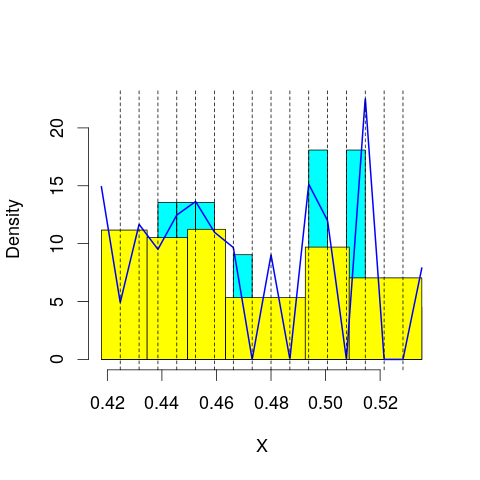

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.98699
mop.approx: Iteration 11. LL = 74.95086
mop.approx: Iteration 21. LL = 75.0346
mop.approx: Iteration 31. LL = 75.04398
mop.approx: Iteration 41. LL = 75.04612
mop.approx: Converged. Iteration 44. LL = 75.04646
[1] "Computing the linear combination of B-splines"


42.121967857
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.72028
mop.approx: Iteration 11. LL = 74.32978
mop.approx: Iteration 21. LL = 74.42175
mop.approx: Iteration 31. LL = 74.44136
mop.approx: Iteration 41. LL = 74.44761
mop.approx: Iteration 51. LL = 74.45018
mop.approx: Iteration 61. LL = 74.45142
mop.approx: Converged. Iteration 63. LL = 74.45165
[1] "Computing the linear combination of B-splines"


39.7942949419
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.08101
mop.approx: Iteration 11. LL = 68.68404
mop.approx: Iteration 21. LL = 68.88642
mop.approx: Iteration 31. LL = 68.91938
mop.approx: Iteration 41. LL = 68.92805
mop.approx: Iteration 51. LL = 68.93129
mop.approx: Iteration 61. LL = 68.93283
mop.approx: Converged. Iteration 70. LL = 68.93368
[1] "Computing the linear combination of B-splines"


32.5434575518
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.4274
mop.approx: Iteration 11. LL = 68.44932
mop.approx: Iteration 21. LL = 68.54568
mop.approx: Iteration 31. LL = 68.57552
mop.approx: Iteration 41. LL = 68.58896
mop.approx: Iteration 51. LL = 68.59599
mop.approx: Iteration 61. LL = 68.59995
mop.approx: Iteration 71. LL = 68.60228
mop.approx: Iteration 81. LL = 68.60368
mop.approx: Converged. Iteration 90. LL = 68.60454
[1] "Computing the linear combination of B-splines"


30.4814409962
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.62426
mop.approx: Iteration 11. LL = 68.7592
mop.approx: Iteration 21. LL = 68.94922
mop.approx: Iteration 31. LL = 69.00518
mop.approx: Iteration 41. LL = 69.02256
mop.approx: Iteration 51. LL = 69.02894
mop.approx: Iteration 61. LL = 69.03184
mop.approx: Iteration 71. LL = 69.03343
mop.approx: Iteration 81. LL = 69.0344
mop.approx: Converged. Iteration 84. LL = 69.03469
[1] "Computing the linear combination of B-splines"


29.1784593019
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.448863
mop.approx: Iteration 11. LL = 68.32886
mop.approx: Iteration 21. LL = 68.41846
mop.approx: Iteration 31. LL = 68.46031
mop.approx: Iteration 41. LL = 68.48695
mop.approx: Iteration 51. LL = 68.505
mop.approx: Iteration 61. LL = 68.51753
mop.approx: Iteration 71. LL = 68.52631
mop.approx: Iteration 81. LL = 68.53254
mop.approx: Iteration 91. LL = 68.53698
mop.approx: Iteration 101. LL = 68.54017
mop.approx: Iteration 111. LL = 68.54249
mop.approx: Iteration 121. LL = 68.54419
mop.approx: Iteration 131. LL = 68.54545
mop.approx: Iteration 141. LL = 68.5464
mop.approx: Converged. Iteration 148. LL = 68.54699
[1] "Computing the linear combination of B-splines"


26.9500003454
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.75593
mop.approx: Iteration 11. LL = 68.9756
mop.approx: Iteration 21. LL = 69.22951
mop.approx: Iteration 31. LL = 69.28858
mop.approx: Iteration 41. LL = 69.30798
mop.approx: Iteration 51. LL = 69.31493
mop.approx: Iteration 61. LL = 69.31748
mop.approx: Converged. Iteration 69. LL = 69.31836
[1] "Computing the linear combination of B-splines"


25.8885454473
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.25594
mop.approx: Iteration 11. LL = 74.7444
mop.approx: Iteration 21. LL = 74.77192
mop.approx: Iteration 31. LL = 74.77683
mop.approx: Iteration 41. LL = 74.77849
mop.approx: Converged. Iteration 45. LL = 74.77891
[1] "Computing the linear combination of B-splines"


41.8544237637
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 41.854423763724895)
m reached
('Sum of Probabilities:', 0.9878906912769089)
chosen


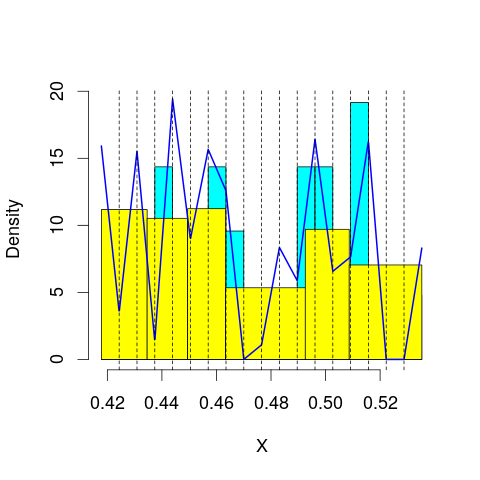

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.98699
mop.approx: Iteration 11. LL = 75.81109
mop.approx: Iteration 21. LL = 75.86035
mop.approx: Iteration 31. LL = 75.87116
mop.approx: Iteration 41. LL = 75.87457
mop.approx: Iteration 51. LL = 75.87593
mop.approx: Converged. Iteration 54. LL = 75.87625
[1] "Computing the linear combination of B-splines"


41.2188947567
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.72028
mop.approx: Iteration 11. LL = 74.35682
mop.approx: Iteration 21. LL = 74.52489
mop.approx: Iteration 31. LL = 74.56899
mop.approx: Iteration 41. LL = 74.58524
mop.approx: Iteration 51. LL = 74.5925
mop.approx: Iteration 61. LL = 74.5962
mop.approx: Iteration 71. LL = 74.59825
mop.approx: Iteration 81. LL = 74.59945
mop.approx: Converged. Iteration 85. LL = 74.59985
[1] "Computing the linear combination of B-splines"


38.209627877
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.08101
mop.approx: Iteration 11. LL = 69.07406
mop.approx: Iteration 21. LL = 69.15878
mop.approx: Iteration 31. LL = 69.17055
mop.approx: Iteration 41. LL = 69.17532
mop.approx: Iteration 51. LL = 69.17776
mop.approx: Iteration 61. LL = 69.1791
mop.approx: Converged. Iteration 68. LL = 69.17977
[1] "Computing the linear combination of B-splines"


31.0566709234
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.4274
mop.approx: Iteration 11. LL = 68.68117
mop.approx: Iteration 21. LL = 68.87126
mop.approx: Iteration 31. LL = 68.91789
mop.approx: Iteration 41. LL = 68.93013
mop.approx: Iteration 51. LL = 68.93357
mop.approx: Converged. Iteration 59. LL = 68.93455
[1] "Computing the linear combination of B-splines"


29.0785935012
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.62426
mop.approx: Iteration 11. LL = 68.93927
mop.approx: Iteration 21. LL = 69.07214
mop.approx: Iteration 31. LL = 69.10601
mop.approx: Iteration 41. LL = 69.12076
mop.approx: Iteration 51. LL = 69.1296
mop.approx: Iteration 61. LL = 69.13541
mop.approx: Iteration 71. LL = 69.13929
mop.approx: Iteration 81. LL = 69.14187
mop.approx: Iteration 91. LL = 69.14356
mop.approx: Iteration 101. LL = 69.14467
mop.approx: Converged. Iteration 107. LL = 69.14522
[1] "Computing the linear combination of B-splines"


27.5561411725
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.448863
mop.approx: Iteration 11. LL = 68.67403
mop.approx: Iteration 21. LL = 68.84216
mop.approx: Iteration 31. LL = 68.90719
mop.approx: Iteration 41. LL = 68.93217
mop.approx: Iteration 51. LL = 68.94201
mop.approx: Iteration 61. LL = 68.94619
mop.approx: Iteration 71. LL = 68.94812
mop.approx: Iteration 81. LL = 68.94908
mop.approx: Converged. Iteration 81. LL = 68.94915
[1] "Computing the linear combination of B-splines"


25.6038696989
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.75593
mop.approx: Iteration 11. LL = 69.37876
mop.approx: Iteration 21. LL = 69.57267
mop.approx: Iteration 31. LL = 69.61161
mop.approx: Iteration 41. LL = 69.62781
mop.approx: Iteration 51. LL = 69.63672
mop.approx: Iteration 61. LL = 69.64215
mop.approx: Iteration 71. LL = 69.64564
mop.approx: Iteration 81. LL = 69.64794
mop.approx: Iteration 91. LL = 69.64951
mop.approx: Iteration 101. LL = 69.65059
mop.approx: Converged. Iteration 109. LL = 69.65129
[1] "Computing the linear combination of B-splines"


24.6477032349
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.25594
mop.approx: Iteration 11. LL = 76.41047
mop.approx: Iteration 21. LL = 76.45703
mop.approx: Iteration 31. LL = 76.46787
mop.approx: Iteration 41. LL = 76.47147
mop.approx: Iteration 51. LL = 76.47281
mop.approx: Converged. Iteration 52. LL = 76.47296
[1] "Computing the linear combination of B-splines"


41.8156016627
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 41.815601662685559)
m reached
('Sum of Probabilities:', 0.9871238252848075)
chosen


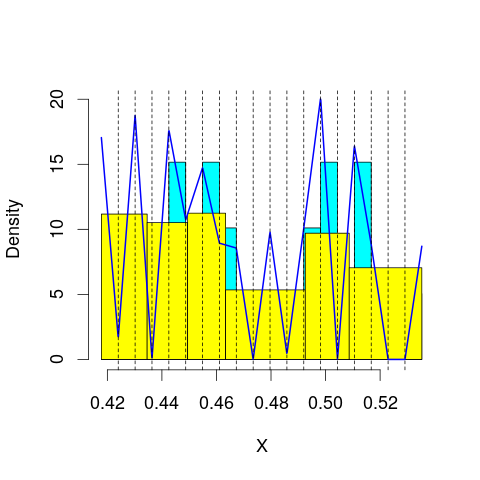

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.98699
mop.approx: Iteration 11. LL = 76.046
mop.approx: Iteration 21. LL = 76.10242
mop.approx: Iteration 31. LL = 76.11417
mop.approx: Iteration 41. LL = 76.11799
mop.approx: Iteration 51. LL = 76.11945
mop.approx: Converged. Iteration 53. LL = 76.11969
[1] "Computing the linear combination of B-splines"


39.7294667902
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.72028
mop.approx: Iteration 11. LL = 74.55278
mop.approx: Iteration 21. LL = 74.62953
mop.approx: Iteration 31. LL = 74.65191
mop.approx: Iteration 41. LL = 74.66096
mop.approx: Iteration 51. LL = 74.66494
mop.approx: Iteration 61. LL = 74.66691
mop.approx: Iteration 71. LL = 74.66801
mop.approx: Converged. Iteration 74. LL = 74.66833
[1] "Computing the linear combination of B-splines"


36.5452305852
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.08101
mop.approx: Iteration 11. LL = 69.55655
mop.approx: Iteration 21. LL = 69.69833
mop.approx: Iteration 31. LL = 69.71594
mop.approx: Iteration 41. LL = 69.71903
mop.approx: Converged. Iteration 47. LL = 69.71968
[1] "Computing the linear combination of B-splines"


29.8637196164
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.4274
mop.approx: Iteration 11. LL = 68.8461
mop.approx: Iteration 21. LL = 68.95253
mop.approx: Iteration 31. LL = 68.97644
mop.approx: Iteration 41. LL = 68.98901
mop.approx: Iteration 51. LL = 68.99657
mop.approx: Iteration 61. LL = 69.00105
mop.approx: Iteration 71. LL = 69.00361
mop.approx: Iteration 81. LL = 69.00502
mop.approx: Converged. Iteration 87. LL = 69.0056
[1] "Computing the linear combination of B-splines"


27.4167730853
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.62426
mop.approx: Iteration 11. LL = 69.20101
mop.approx: Iteration 21. LL = 69.38924
mop.approx: Iteration 31. LL = 69.42902
mop.approx: Iteration 41. LL = 69.43758
mop.approx: Iteration 51. LL = 69.43954
mop.approx: Converged. Iteration 53. LL = 69.43976
[1] "Computing the linear combination of B-splines"


26.1180416104
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.448863
mop.approx: Iteration 11. LL = 69.01788
mop.approx: Iteration 21. LL = 69.18215
mop.approx: Iteration 31. LL = 69.22716
mop.approx: Iteration 41. LL = 69.2421
mop.approx: Iteration 51. LL = 69.24843
mop.approx: Iteration 61. LL = 69.25173
mop.approx: Iteration 71. LL = 69.25371
mop.approx: Iteration 81. LL = 69.255
mop.approx: Iteration 91. LL = 69.25588
mop.approx: Converged. Iteration 93. LL = 69.25609
[1] "Computing the linear combination of B-splines"


24.1765276041
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.75593
mop.approx: Iteration 11. LL = 70.36049
mop.approx: Iteration 21. LL = 70.50591
mop.approx: Iteration 31. LL = 70.52956
mop.approx: Iteration 41. LL = 70.53386
mop.approx: Converged. Iteration 46. LL = 70.53446
[1] "Computing the linear combination of B-splines"


23.2655501146
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.25594
mop.approx: Iteration 11. LL = 77.15483
mop.approx: Iteration 21. LL = 77.18595
mop.approx: Iteration 31. LL = 77.19282
mop.approx: Iteration 41. LL = 77.19529
mop.approx: Iteration 51. LL = 77.19642
mop.approx: Converged. Iteration 52. LL = 77.19657
[1] "Computing the linear combination of B-splines"


40.8063468972
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 40.806346897246286)
m reached
('Sum of Probabilities:', 0.9864232227609988)
chosen


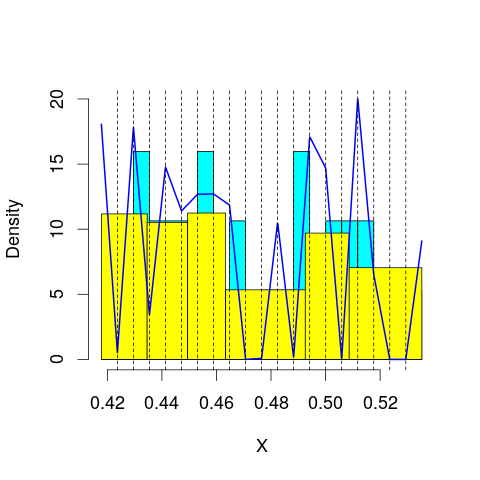

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.98699
mop.approx: Iteration 11. LL = 75.78618
mop.approx: Iteration 21. LL = 75.87745
mop.approx: Iteration 31. LL = 75.89867
mop.approx: Iteration 41. LL = 75.90566
mop.approx: Iteration 51. LL = 75.90838
mop.approx: Iteration 61. LL = 75.90957
mop.approx: Converged. Iteration 62. LL = 75.90972
[1] "Computing the linear combination of B-splines"


37.7866224756
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.72028
mop.approx: Iteration 11. LL = 75.17536
mop.approx: Iteration 21. LL = 75.26842
mop.approx: Iteration 31. LL = 75.28688
mop.approx: Iteration 41. LL = 75.29113
mop.approx: Converged. Iteration 47. LL = 75.29195
[1] "Computing the linear combination of B-splines"


35.4359836305
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.08101
mop.approx: Iteration 11. LL = 69.53559
mop.approx: Iteration 21. LL = 69.69494
mop.approx: Iteration 31. LL = 69.73546
mop.approx: Iteration 41. LL = 69.75078
mop.approx: Iteration 51. LL = 69.75802
mop.approx: Iteration 61. LL = 69.76194
mop.approx: Iteration 71. LL = 69.76428
mop.approx: Iteration 81. LL = 69.76577
mop.approx: Iteration 91. LL = 69.76678
mop.approx: Converged. Iteration 97. LL = 69.76731
[1] "Computing the linear combination of B-splines"


28.178478427
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.4274
mop.approx: Iteration 11. LL = 69.39804
mop.approx: Iteration 21. LL = 69.54166
mop.approx: Iteration 31. LL = 69.56138
mop.approx: Iteration 41. LL = 69.56571
mop.approx: Iteration 51. LL = 69.56714
mop.approx: Converged. Iteration 55. LL = 69.56752
[1] "Computing the linear combination of B-splines"


26.2458232696
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.62426
mop.approx: Iteration 11. LL = 69.26038
mop.approx: Iteration 21. LL = 69.45178
mop.approx: Iteration 31. LL = 69.5045
mop.approx: Iteration 41. LL = 69.52354
mop.approx: Iteration 51. LL = 69.53237
mop.approx: Iteration 61. LL = 69.53733
mop.approx: Iteration 71. LL = 69.54044
mop.approx: Iteration 81. LL = 69.5425
mop.approx: Iteration 91. LL = 69.54392
mop.approx: Iteration 101. LL = 69.54492
mop.approx: Converged. Iteration 106. LL = 69.54537
[1] "Computing the linear combination of B-splines"


24.4905643849
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.448863
mop.approx: Iteration 11. LL = 69.32198
mop.approx: Iteration 21. LL = 69.48849
mop.approx: Iteration 31. LL = 69.51821
mop.approx: Iteration 41. LL = 69.5236
mop.approx: Converged. Iteration 47. LL = 69.52445
[1] "Computing the linear combination of B-splines"


22.6632867202
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.75593
mop.approx: Iteration 11. LL = 70.78873
mop.approx: Iteration 21. LL = 71.05852
mop.approx: Iteration 31. LL = 71.10131
mop.approx: Iteration 41. LL = 71.11455
mop.approx: Iteration 51. LL = 71.12008
mop.approx: Iteration 61. LL = 71.12286
mop.approx: Iteration 71. LL = 71.12444
mop.approx: Iteration 81. LL = 71.1254
mop.approx: Converged. Iteration 82. LL = 71.12555
[1] "Computing the linear combination of B-splines"


21.3091054687
lfps_10
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.62855
mop.approx: Iteration 11. LL = 67.12004
mop.approx: Converged. Iteration 14. LL = 67.12078
[1] "Computing the linear combination of B-splines"


61.9221776548
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 61.922177654794226)
m reached
('Sum of Probabilities:', 0.9887079257116433)
chosen


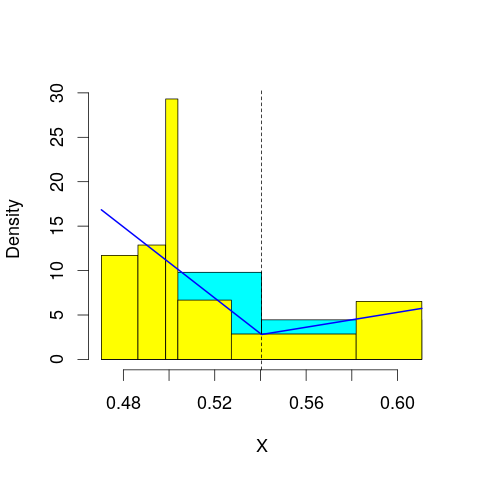

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.40282
mop.approx: Iteration 11. LL = 66.82909
mop.approx: Iteration 21. LL = 66.92971
mop.approx: Iteration 31. LL = 66.95916
mop.approx: Iteration 41. LL = 66.96985
mop.approx: Iteration 51. LL = 66.9741
mop.approx: Iteration 61. LL = 66.97585
mop.approx: Converged. Iteration 67. LL = 66.97642
[1] "Computing the linear combination of B-splines"


60.0449524308
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.17867
mop.approx: Iteration 11. LL = 66.98745
mop.approx: Iteration 21. LL = 67.09997
mop.approx: Iteration 31. LL = 67.1324
mop.approx: Iteration 41. LL = 67.14557
mop.approx: Iteration 51. LL = 67.15093
mop.approx: Iteration 61. LL = 67.1531
mop.approx: Converged. Iteration 68. LL = 67.15385
[1] "Computing the linear combination of B-splines"


58.4895126091
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.70246
mop.approx: Iteration 11. LL = 50.64592
mop.approx: Converged. Iteration 19. LL = 50.65185
[1] "Computing the linear combination of B-splines"


40.2546429492
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.26811
mop.approx: Iteration 11. LL = 50.60081
mop.approx: Iteration 21. LL = 50.86454
mop.approx: Iteration 31. LL = 50.87902
mop.approx: Converged. Iteration 37. LL = 50.87978
[1] "Computing the linear combination of B-splines"


38.7497041931
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.624055
mop.approx: Iteration 11. LL = 47.40779
mop.approx: Iteration 21. LL = 47.51909
mop.approx: Iteration 31. LL = 47.53605
mop.approx: Iteration 41. LL = 47.54026
mop.approx: Iteration 51. LL = 47.54157
mop.approx: Converged. Iteration 55. LL = 47.54186
[1] "Computing the linear combination of B-splines"


33.6789123367
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.569346
mop.approx: Iteration 11. LL = 47.47618
mop.approx: Iteration 21. LL = 47.80187
mop.approx: Iteration 31. LL = 47.82055
mop.approx: Converged. Iteration 38. LL = 47.82161
[1] "Computing the linear combination of B-splines"


32.2258005563
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.97111
mop.approx: Iteration 11. LL = 44.54401
mop.approx: Iteration 21. LL = 44.79558
mop.approx: Iteration 31. LL = 44.86039
mop.approx: Iteration 41. LL = 44.886
mop.approx: Iteration 51. LL = 44.89857
mop.approx: Iteration 61. LL = 44.90554
mop.approx: Iteration 71. LL = 44.90971
mop.approx: Iteration 81. LL = 44.91233
mop.approx: Iteration 91. LL = 44.91402
mop.approx: Iteration 101. LL = 44.91514
mop.approx: Iteration 111. LL = 44.91589
mop.approx: Converged. Iteration 119. LL = 44.91635
[1] "Computing the linear combination of B-splines"


27.5876713825
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.62855
mop.approx: Iteration 11. LL = 67.85456
mop.approx: Iteration 21. LL = 67.86947
mop.approx: Converged. Iteration 30. LL = 67.87108
[1] "Computing the linear combination of B-splines"


60.9396070766
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 60.939607076614685)
m reached
('Sum of Probabilities:', 0.9878003316838103)
chosen


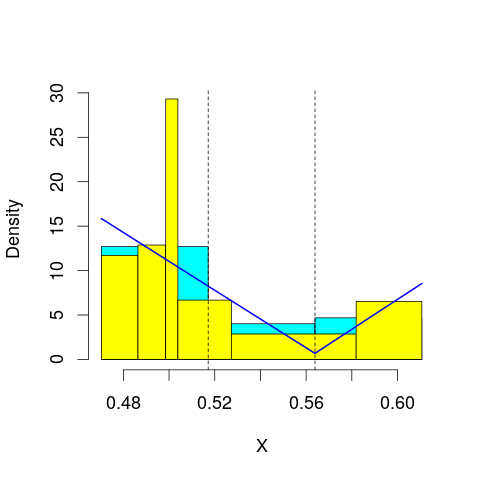

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.40282
mop.approx: Iteration 11. LL = 67.70167
mop.approx: Iteration 21. LL = 67.72676
mop.approx: Iteration 31. LL = 67.7302
mop.approx: Converged. Iteration 34. LL = 67.73054
[1] "Computing the linear combination of B-splines"


59.0662030613
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.17867
mop.approx: Iteration 11. LL = 67.6719
mop.approx: Iteration 21. LL = 67.68086
mop.approx: Converged. Iteration 25. LL = 67.68124
[1] "Computing the linear combination of B-splines"


57.2840281559
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.70246
mop.approx: Iteration 11. LL = 52.72139
mop.approx: Iteration 21. LL = 52.88892
mop.approx: Iteration 31. LL = 52.89557
mop.approx: Converged. Iteration 32. LL = 52.89569
[1] "Computing the linear combination of B-splines"


40.7656106834
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.26811
mop.approx: Iteration 11. LL = 53.39734
mop.approx: Converged. Iteration 15. LL = 53.39947
[1] "Computing the linear combination of B-splines"


39.5365241292
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.624055
mop.approx: Iteration 11. LL = 51.81186
mop.approx: Iteration 21. LL = 52.16937
mop.approx: Iteration 31. LL = 52.2403
mop.approx: Iteration 41. LL = 52.2599
mop.approx: Iteration 51. LL = 52.26577
mop.approx: Iteration 61. LL = 52.26758
mop.approx: Converged. Iteration 66. LL = 52.26799
[1] "Computing the linear combination of B-splines"


36.6721746117
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.569346
mop.approx: Iteration 11. LL = 50.12267
mop.approx: Iteration 21. LL = 50.18486
mop.approx: Iteration 31. LL = 50.18974
mop.approx: Converged. Iteration 36. LL = 50.19021
[1] "Computing the linear combination of B-splines"


32.8615291615
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.97111
mop.approx: Iteration 11. LL = 49.2395
mop.approx: Iteration 21. LL = 49.66775
mop.approx: Iteration 31. LL = 49.72127
mop.approx: Iteration 41. LL = 49.72877
mop.approx: Converged. Iteration 49. LL = 49.7298
[1] "Computing the linear combination of B-splines"


30.6682519965
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.62855
mop.approx: Converged. Iteration 9. LL = 67.86115
[1] "Computing the linear combination of B-splines"


59.1968096193
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 59.196809619290782)
m reached
('Sum of Probabilities:', 0.9903423791420496)
chosen


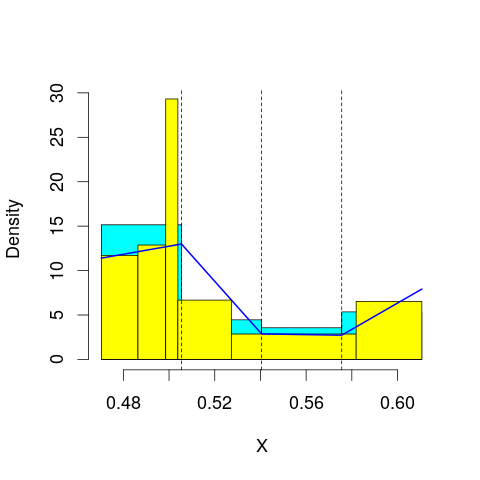

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.40282
mop.approx: Iteration 11. LL = 68.12982
mop.approx: Converged. Iteration 18. LL = 68.13114
[1] "Computing the linear combination of B-splines"


57.7339305325
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.17867
mop.approx: Iteration 11. LL = 67.57535
mop.approx: Iteration 21. LL = 67.57831
mop.approx: Iteration 31. LL = 67.57983
mop.approx: Iteration 41. LL = 67.58079
mop.approx: Converged. Iteration 43. LL = 67.581
[1] "Computing the linear combination of B-splines"


55.4509261619
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.70246
mop.approx: Iteration 11. LL = 55.33907
mop.approx: Iteration 21. LL = 55.54087
mop.approx: Iteration 31. LL = 55.5608
mop.approx: Iteration 41. LL = 55.56575
mop.approx: Iteration 51. LL = 55.5681
mop.approx: Iteration 61. LL = 55.5695
mop.approx: Iteration 71. LL = 55.5704
mop.approx: Converged. Iteration 79. LL = 55.57097
[1] "Computing the linear combination of B-splines"


41.7080289434
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.26811
mop.approx: Iteration 11. LL = 53.40124
mop.approx: Iteration 21. LL = 53.41034
mop.approx: Converged. Iteration 28. LL = 53.4113
[1] "Computing the linear combination of B-splines"


37.8154888135
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.624055
mop.approx: Iteration 11. LL = 54.86565
mop.approx: Converged. Iteration 20. LL = 54.8834
[1] "Computing the linear combination of B-splines"


37.5547186066
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.569346
mop.approx: Iteration 11. LL = 52.50898
mop.approx: Iteration 21. LL = 52.74648
mop.approx: Iteration 31. LL = 52.77414
mop.approx: Iteration 41. LL = 52.78117
mop.approx: Iteration 51. LL = 52.78348
mop.approx: Iteration 61. LL = 52.78434
mop.approx: Converged. Iteration 61. LL = 52.78439
[1] "Computing the linear combination of B-splines"


33.7228442463
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.97111
mop.approx: Iteration 11. LL = 52.10347
mop.approx: Iteration 21. LL = 52.14283
mop.approx: Converged. Iteration 27. LL = 52.14388
[1] "Computing the linear combination of B-splines"


31.3494618682
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.62855
mop.approx: Converged. Iteration 8. LL = 68.25608
[1] "Computing the linear combination of B-splines"


57.8588760881
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 57.858876088054544)
m reached
('Sum of Probabilities:', 0.9917383263357068)
chosen


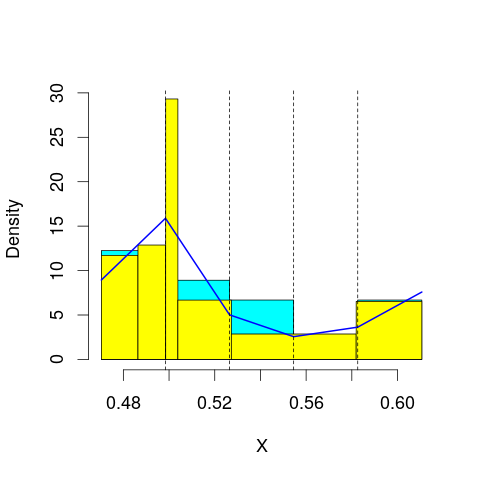

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.40282
mop.approx: Iteration 11. LL = 68.05538
mop.approx: Iteration 21. LL = 68.11577
mop.approx: Iteration 31. LL = 68.13154
mop.approx: Iteration 41. LL = 68.1376
mop.approx: Iteration 51. LL = 68.14052
mop.approx: Iteration 61. LL = 68.14215
mop.approx: Iteration 71. LL = 68.14313
mop.approx: Converged. Iteration 74. LL = 68.14342
[1] "Computing the linear combination of B-splines"


56.0133424862
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.17867
mop.approx: Iteration 11. LL = 67.69465
mop.approx: Iteration 21. LL = 67.7236
mop.approx: Iteration 31. LL = 67.73355
mop.approx: Iteration 41. LL = 67.73747
mop.approx: Iteration 51. LL = 67.73911
mop.approx: Converged. Iteration 56. LL = 67.73961
[1] "Computing the linear combination of B-splines"


53.8766645948
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.70246
mop.approx: Iteration 11. LL = 60.22154
mop.approx: Iteration 21. LL = 60.33392
mop.approx: Iteration 31. LL = 60.33814
mop.approx: Converged. Iteration 32. LL = 60.33825
[1] "Computing the linear combination of B-splines"


44.7424343993
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.26811
mop.approx: Iteration 11. LL = 54.49508
mop.approx: Iteration 21. LL = 54.64915
mop.approx: Iteration 31. LL = 54.69317
mop.approx: Iteration 41. LL = 54.70987
mop.approx: Iteration 51. LL = 54.71741
mop.approx: Iteration 61. LL = 54.72127
mop.approx: Iteration 71. LL = 54.72343
mop.approx: Iteration 81. LL = 54.72473
mop.approx: Iteration 91. LL = 54.72556
mop.approx: Converged. Iteration 96. LL = 54.72591
[1] "Computing the linear combination of B-splines"


37.3972317052
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.624055
mop.approx: Iteration 11. LL = 55.45153
mop.approx: Iteration 21. LL = 55.49035
mop.approx: Iteration 31. LL = 55.49405
mop.approx: Converged. Iteration 34. LL = 55.49434
[1] "Computing the linear combination of B-splines"


36.4327886765
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.569346
mop.approx: Iteration 11. LL = 55.32007
mop.approx: Iteration 21. LL = 55.43713
mop.approx: Iteration 31. LL = 55.44089
mop.approx: Converged. Iteration 32. LL = 55.44099
[1] "Computing the linear combination of B-splines"


34.6465752647
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.97111
mop.approx: Iteration 11. LL = 53.0397
mop.approx: Iteration 21. LL = 53.28064
mop.approx: Iteration 31. LL = 53.30027
mop.approx: Converged. Iteration 37. LL = 53.3013
[1] "Computing the linear combination of B-splines"


30.7740211982
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.62855
mop.approx: Iteration 11. LL = 69.86218
mop.approx: Iteration 21. LL = 69.90052
mop.approx: Converged. Iteration 27. LL = 69.90193
[1] "Computing the linear combination of B-splines"


57.7718519521
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 57.771851952144161)
m reached
('Sum of Probabilities:', 0.9928863256031608)
chosen


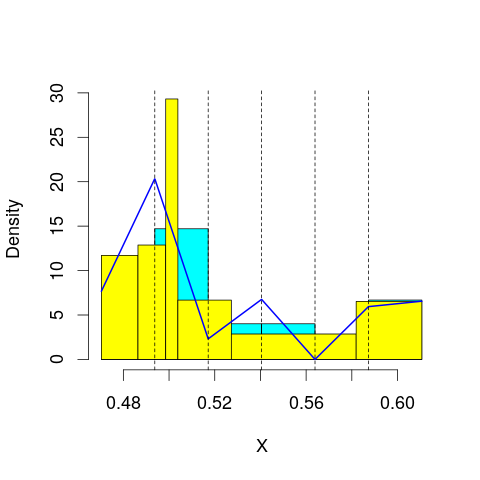

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.40282
mop.approx: Iteration 11. LL = 67.99126
mop.approx: Iteration 21. LL = 68.00272
mop.approx: Converged. Iteration 26. LL = 68.00342
[1] "Computing the linear combination of B-splines"


54.1404725128
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.17867
mop.approx: Iteration 11. LL = 68.66932
mop.approx: Iteration 21. LL = 68.92811
mop.approx: Iteration 31. LL = 68.98552
mop.approx: Iteration 41. LL = 69.0015
mop.approx: Iteration 51. LL = 69.0078
mop.approx: Iteration 61. LL = 69.01088
mop.approx: Iteration 71. LL = 69.01257
mop.approx: Iteration 81. LL = 69.01358
mop.approx: Converged. Iteration 84. LL = 69.01386
[1] "Computing the linear combination of B-splines"


53.4180512463
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.70246
mop.approx: Iteration 11. LL = 61.20889
mop.approx: Iteration 21. LL = 61.21603
mop.approx: Converged. Iteration 23. LL = 61.21623
[1] "Computing the linear combination of B-splines"


43.8875464073
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.26811
mop.approx: Iteration 11. LL = 58.86291
mop.approx: Iteration 21. LL = 59.16876
mop.approx: Iteration 31. LL = 59.19638
mop.approx: Iteration 41. LL = 59.20183
mop.approx: Iteration 51. LL = 59.20382
mop.approx: Iteration 61. LL = 59.20482
mop.approx: Converged. Iteration 65. LL = 59.20514
[1] "Computing the linear combination of B-splines"


40.143595114
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.624055
mop.approx: Iteration 11. LL = 55.7529
mop.approx: Iteration 21. LL = 55.82537
mop.approx: Iteration 31. LL = 55.85043
mop.approx: Iteration 41. LL = 55.86152
mop.approx: Iteration 51. LL = 55.86727
mop.approx: Iteration 61. LL = 55.87056
mop.approx: Iteration 71. LL = 55.87258
mop.approx: Iteration 81. LL = 55.87387
mop.approx: Iteration 91. LL = 55.87472
mop.approx: Converged. Iteration 96. LL = 55.87509
[1] "Computing the linear combination of B-splines"


35.0806735314
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.569346
mop.approx: Iteration 11. LL = 57.39197
mop.approx: Iteration 21. LL = 57.54061
mop.approx: Iteration 31. LL = 57.56762
mop.approx: Iteration 41. LL = 57.57725
mop.approx: Iteration 51. LL = 57.58176
mop.approx: Iteration 61. LL = 57.58425
mop.approx: Iteration 71. LL = 57.58577
mop.approx: Iteration 81. LL = 57.58678
mop.approx: Iteration 91. LL = 57.58748
mop.approx: Converged. Iteration 92. LL = 57.5876
[1] "Computing the linear combination of B-splines"


35.0603127805
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.97111
mop.approx: Iteration 11. LL = 54.9691
mop.approx: Iteration 21. LL = 55.2419
mop.approx: Iteration 31. LL = 55.27281
mop.approx: Iteration 41. LL = 55.27876
mop.approx: Iteration 51. LL = 55.28122
mop.approx: Iteration 61. LL = 55.28277
mop.approx: Iteration 71. LL = 55.28385
mop.approx: Iteration 81. LL = 55.28465
mop.approx: Converged. Iteration 89. LL = 55.2852
[1] "Computing the linear combination of B-splines"


31.0250542942
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.62855
mop.approx: Iteration 11. LL = 68.77311
mop.approx: Iteration 21. LL = 68.78224
mop.approx: Iteration 31. LL = 68.78394
mop.approx: Converged. Iteration 34. LL = 68.78425
[1] "Computing the linear combination of B-splines"


54.9213048516
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 54.92130485164828)
m reached
('Sum of Probabilities:', 0.9926438445384388)
chosen


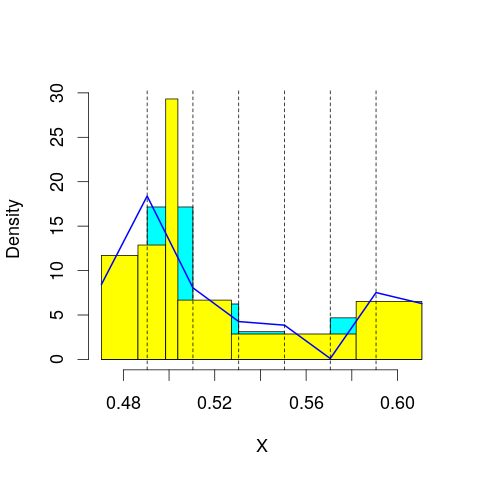

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.40282
mop.approx: Iteration 11. LL = 68.94824
mop.approx: Iteration 21. LL = 69.03213
mop.approx: Iteration 31. LL = 69.04045
mop.approx: Converged. Iteration 35. LL = 69.04099
[1] "Computing the linear combination of B-splines"


53.445177181
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.17867
mop.approx: Iteration 11. LL = 69.24647
mop.approx: Iteration 21. LL = 69.49389
mop.approx: Iteration 31. LL = 69.55948
mop.approx: Iteration 41. LL = 69.58639
mop.approx: Iteration 51. LL = 69.59978
mop.approx: Iteration 61. LL = 69.60709
mop.approx: Iteration 71. LL = 69.61129
mop.approx: Iteration 81. LL = 69.61378
mop.approx: Iteration 91. LL = 69.6153
mop.approx: Iteration 101. LL = 69.61625
mop.approx: Converged. Iteration 103. LL = 69.61646
[1] "Computing the linear combination of B-splines"


52.2877850405
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.70246
mop.approx: Iteration 11. LL = 61.83401
mop.approx: Iteration 21. LL = 61.9424
mop.approx: Iteration 31. LL = 61.96316
mop.approx: Iteration 41. LL = 61.96661
mop.approx: Converged. Iteration 45. LL = 61.96701
[1] "Computing the linear combination of B-splines"


42.905462255
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.26811
mop.approx: Iteration 11. LL = 61.24656
mop.approx: Iteration 21. LL = 61.4101
mop.approx: Iteration 31. LL = 61.42601
mop.approx: Iteration 41. LL = 61.43135
mop.approx: Iteration 51. LL = 61.43411
mop.approx: Iteration 61. LL = 61.4357
mop.approx: Iteration 71. LL = 61.43666
mop.approx: Converged. Iteration 75. LL = 61.43698
[1] "Computing the linear combination of B-splines"


40.6425691288
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.624055
mop.approx: Iteration 11. LL = 57.53265
mop.approx: Iteration 21. LL = 57.68238
mop.approx: Iteration 31. LL = 57.69385
mop.approx: Converged. Iteration 40. LL = 57.69524
[1] "Computing the linear combination of B-splines"


35.1679597437
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.569346
mop.approx: Iteration 11. LL = 57.57292
mop.approx: Iteration 21. LL = 57.60507
mop.approx: Iteration 31. LL = 57.61564
mop.approx: Iteration 41. LL = 57.62099
mop.approx: Iteration 51. LL = 57.62405
mop.approx: Iteration 61. LL = 57.62594
mop.approx: Iteration 71. LL = 57.6272
mop.approx: Iteration 81. LL = 57.62808
mop.approx: Converged. Iteration 89. LL = 57.62865
[1] "Computing the linear combination of B-splines"


33.3685030532
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.97111
mop.approx: Iteration 11. LL = 58.56945
mop.approx: Iteration 21. LL = 58.86149
mop.approx: Iteration 31. LL = 58.89596
mop.approx: Iteration 41. LL = 58.90379
mop.approx: Iteration 51. LL = 58.9058
mop.approx: Converged. Iteration 55. LL = 58.90615
[1] "Computing the linear combination of B-splines"


32.9130792697
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.62855
mop.approx: Iteration 11. LL = 68.65095
mop.approx: Iteration 21. LL = 68.65672
mop.approx: Converged. Iteration 24. LL = 68.65706
[1] "Computing the linear combination of B-splines"


53.0612496131
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 53.061249613129149)
m reached
('Sum of Probabilities:', 0.9916875780561221)
chosen


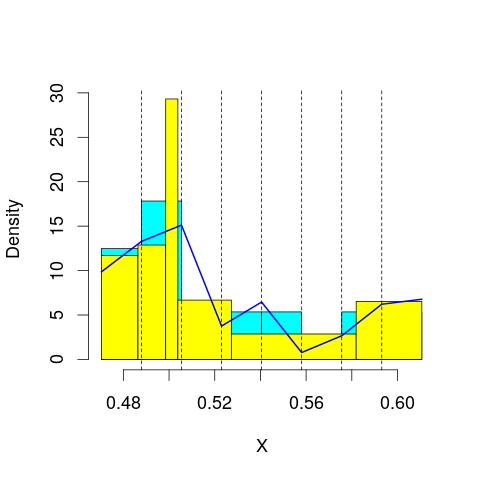

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.40282
mop.approx: Iteration 11. LL = 70.64474
mop.approx: Iteration 21. LL = 70.81376
mop.approx: Iteration 31. LL = 70.84478
mop.approx: Iteration 41. LL = 70.85225
mop.approx: Iteration 51. LL = 70.85437
mop.approx: Converged. Iteration 56. LL = 70.8549
[1] "Computing the linear combination of B-splines"


53.5262197225
('best: ', 53.061249613129149, 'accepted difference:', 90.204124342319545, 'cur BIC:', 53.526219722519414)
m reached
('Sum of Probabilities:', 0.9770271467852778)
chosen


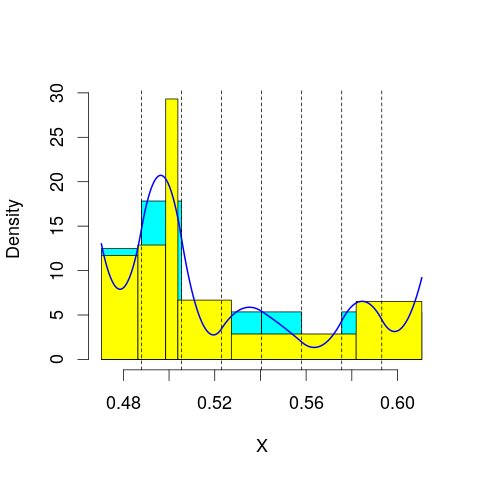

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.17867
mop.approx: Iteration 11. LL = 69.28409
mop.approx: Iteration 21. LL = 69.40944
mop.approx: Iteration 31. LL = 69.43353
mop.approx: Iteration 41. LL = 69.44131
mop.approx: Iteration 51. LL = 69.44425
mop.approx: Iteration 61. LL = 69.44546
mop.approx: Converged. Iteration 62. LL = 69.4456
[1] "Computing the linear combination of B-splines"


50.3840573259
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.70246
mop.approx: Iteration 11. LL = 62.05215
mop.approx: Iteration 21. LL = 62.08622
mop.approx: Iteration 31. LL = 62.08883
mop.approx: Converged. Iteration 31. LL = 62.08889
[1] "Computing the linear combination of B-splines"


41.2944716245
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.26811
mop.approx: Iteration 11. LL = 62.60108
mop.approx: Iteration 21. LL = 62.79324
mop.approx: Iteration 31. LL = 62.82683
mop.approx: Iteration 41. LL = 62.83568
mop.approx: Iteration 51. LL = 62.8389
mop.approx: Iteration 61. LL = 62.84027
mop.approx: Converged. Iteration 66. LL = 62.84071
[1] "Computing the linear combination of B-splines"


40.3134217687
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.624055
mop.approx: Iteration 11. LL = 59.81443
mop.approx: Iteration 21. LL = 60.16869
mop.approx: Iteration 31. LL = 60.22768
mop.approx: Iteration 41. LL = 60.24064
mop.approx: Iteration 51. LL = 60.24408
mop.approx: Iteration 61. LL = 60.2452
mop.approx: Converged. Iteration 62. LL = 60.24532
[1] "Computing the linear combination of B-splines"


35.9851696296
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.569346
mop.approx: Iteration 11. LL = 57.92575
mop.approx: Iteration 21. LL = 57.97616
mop.approx: Iteration 31. LL = 57.9889
mop.approx: Iteration 41. LL = 57.9924
mop.approx: Converged. Iteration 49. LL = 57.99331
[1] "Computing the linear combination of B-splines"


32.0002980006
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.97111
mop.approx: Iteration 11. LL = 59.07811
mop.approx: Iteration 21. LL = 59.11988
mop.approx: Iteration 31. LL = 59.12154
mop.approx: Iteration 41. LL = 59.12237
mop.approx: Converged. Iteration 43. LL = 59.12254
[1] "Computing the linear combination of B-splines"


31.396665434
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.62855
mop.approx: Iteration 11. LL = 71.27178
mop.approx: Iteration 21. LL = 71.30904
mop.approx: Converged. Iteration 27. LL = 71.3105
[1] "Computing the linear combination of B-splines"


53.981823047
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 53.981823046953949)
m reached
('Sum of Probabilities:', 0.9911075083098526)
chosen


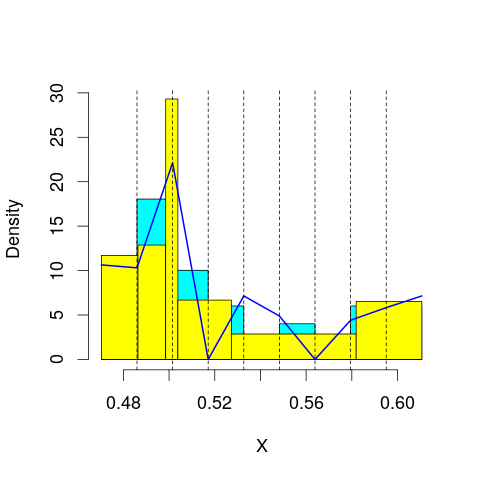

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.40282
mop.approx: Iteration 11. LL = 70.38922
mop.approx: Iteration 21. LL = 70.49967
mop.approx: Iteration 31. LL = 70.51453
mop.approx: Iteration 41. LL = 70.51902
mop.approx: Iteration 51. LL = 70.52103
mop.approx: Iteration 61. LL = 70.52211
mop.approx: Converged. Iteration 64. LL = 70.52241
[1] "Computing the linear combination of B-splines"


51.4608633331
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.17867
mop.approx: Iteration 11. LL = 69.95365
mop.approx: Iteration 21. LL = 70.07491
mop.approx: Iteration 31. LL = 70.09493
mop.approx: Iteration 41. LL = 70.0986
mop.approx: Converged. Iteration 45. LL = 70.09908
[1] "Computing the linear combination of B-splines"


49.3046600714
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.70246
mop.approx: Iteration 11. LL = 62.20794
mop.approx: Iteration 21. LL = 62.2848
mop.approx: Iteration 31. LL = 62.31073
mop.approx: Iteration 41. LL = 62.32271
mop.approx: Iteration 51. LL = 62.32921
mop.approx: Iteration 61. LL = 62.33309
mop.approx: Iteration 71. LL = 62.33557
mop.approx: Iteration 81. LL = 62.33721
mop.approx: Iteration 91. LL = 62.33834
mop.approx: Iteration 101. LL = 62.33913
mop.approx: Converged. Iteration 103. LL = 62.33931
[1] "Computing the linear combination of B-splines"


39.8120310482
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.26811
mop.approx: Iteration 11. LL = 63.51059
mop.approx: Iteration 21. LL = 63.61088
mop.approx: Iteration 31. LL = 63.6429
mop.approx: Iteration 41. LL = 63.65764
mop.approx: Iteration 51. LL = 63.66477
mop.approx: Iteration 61. LL = 63.66831
mop.approx: Iteration 71. LL = 63.6701
mop.approx: Iteration 81. LL = 63.67101
mop.approx: Converged. Iteration 81. LL = 63.67107
[1] "Computing the linear combination of B-splines"


39.4109193264
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.624055
mop.approx: Iteration 11. LL = 61.7431
mop.approx: Iteration 21. LL = 62.0493
mop.approx: Iteration 31. LL = 62.09417
mop.approx: Iteration 41. LL = 62.10426
mop.approx: Iteration 51. LL = 62.10744
mop.approx: Iteration 61. LL = 62.10884
mop.approx: Iteration 71. LL = 62.10963
mop.approx: Converged. Iteration 71. LL = 62.10969
[1] "Computing the linear combination of B-splines"


36.1166766668
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.569346
mop.approx: Iteration 11. LL = 58.88581
mop.approx: Iteration 21. LL = 59.01335
mop.approx: Iteration 31. LL = 59.02966
mop.approx: Iteration 41. LL = 59.03178
mop.approx: Converged. Iteration 42. LL = 59.03189
[1] "Computing the linear combination of B-splines"


31.3059913569
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.97111
mop.approx: Iteration 11. LL = 59.11259
mop.approx: Converged. Iteration 18. LL = 59.11811
[1] "Computing the linear combination of B-splines"


29.6593351702
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.62855
mop.approx: Iteration 11. LL = 71.55315
mop.approx: Converged. Iteration 12. LL = 71.55328
[1] "Computing the linear combination of B-splines"


52.4917342621
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 52.491734262102419)
m reached
('Sum of Probabilities:', 0.9902748589625349)
chosen


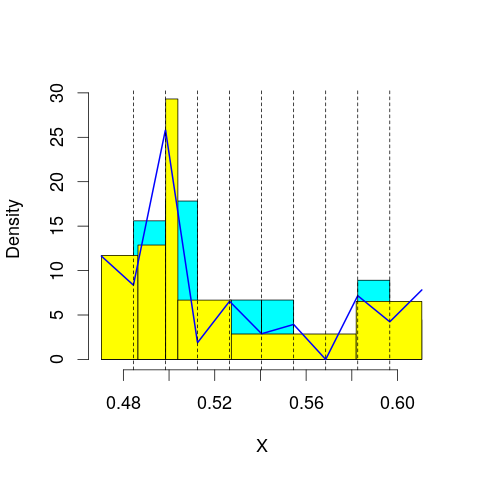

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.40282
mop.approx: Iteration 11. LL = 70.6833
mop.approx: Iteration 21. LL = 70.76282
mop.approx: Iteration 31. LL = 70.77731
mop.approx: Iteration 41. LL = 70.78071
mop.approx: Converged. Iteration 47. LL = 70.7814
[1] "Computing the linear combination of B-splines"


49.9869824243
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.17867
mop.approx: Iteration 11. LL = 70.90479
mop.approx: Iteration 21. LL = 71.04773
mop.approx: Iteration 31. LL = 71.06698
mop.approx: Iteration 41. LL = 71.07153
mop.approx: Iteration 51. LL = 71.07316
mop.approx: Converged. Iteration 56. LL = 71.07365
[1] "Computing the linear combination of B-splines"


48.5463644617
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.70246
mop.approx: Iteration 11. LL = 62.90723
mop.approx: Iteration 21. LL = 62.99681
mop.approx: Iteration 31. LL = 63.01876
mop.approx: Iteration 41. LL = 63.02453
mop.approx: Iteration 51. LL = 63.02606
mop.approx: Converged. Iteration 52. LL = 63.02619
[1] "Computing the linear combination of B-splines"


38.7660389785
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.26811
mop.approx: Iteration 11. LL = 63.91776
mop.approx: Iteration 21. LL = 63.97726
mop.approx: Iteration 31. LL = 63.9892
mop.approx: Iteration 41. LL = 63.99324
mop.approx: Iteration 51. LL = 63.99494
mop.approx: Converged. Iteration 60. LL = 63.99577
[1] "Computing the linear combination of B-splines"


38.0027543931
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.624055
mop.approx: Iteration 11. LL = 63.30923
mop.approx: Iteration 21. LL = 63.51164
mop.approx: Iteration 31. LL = 63.54827
mop.approx: Iteration 41. LL = 63.557
mop.approx: Iteration 51. LL = 63.55906
mop.approx: Converged. Iteration 54. LL = 63.55933
[1] "Computing the linear combination of B-splines"


35.8334399792
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.569346
mop.approx: Iteration 11. LL = 60.41473
mop.approx: Iteration 21. LL = 60.65927
mop.approx: Iteration 31. LL = 60.70179
mop.approx: Iteration 41. LL = 60.71511
mop.approx: Iteration 51. LL = 60.72126
mop.approx: Iteration 61. LL = 60.72468
mop.approx: Iteration 71. LL = 60.72679
mop.approx: Iteration 81. LL = 60.7282
mop.approx: Iteration 91. LL = 60.72918
mop.approx: Iteration 101. LL = 60.7299
mop.approx: Converged. Iteration 102. LL = 60.73002
[1] "Computing the linear combination of B-splines"


31.2710962006
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.97111
mop.approx: Iteration 11. LL = 59.364
mop.approx: Iteration 21. LL = 59.45151
mop.approx: Iteration 31. LL = 59.48539
mop.approx: Iteration 41. LL = 59.49837
mop.approx: Iteration 51. LL = 59.50394
mop.approx: Iteration 61. LL = 59.50675
mop.approx: Iteration 71. LL = 59.5084
mop.approx: Iteration 81. LL = 59.50948
mop.approx: Iteration 91. LL = 59.51023
mop.approx: Converged. Iteration 93. LL = 59.51041
[1] "Computing the linear combination of B-splines"


28.3167694174
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.62855
mop.approx: Iteration 11. LL = 70.94456
mop.approx: Iteration 21. LL = 70.97278
mop.approx: Iteration 31. LL = 70.97973
mop.approx: Iteration 41. LL = 70.98246
mop.approx: Iteration 51. LL = 70.98369
mop.approx: Converged. Iteration 53. LL = 70.98391
[1] "Computing the linear combination of B-splines"


50.1894934453
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 50.189493445334094)
m reached
('Sum of Probabilities:', 0.9889954554727325)
chosen


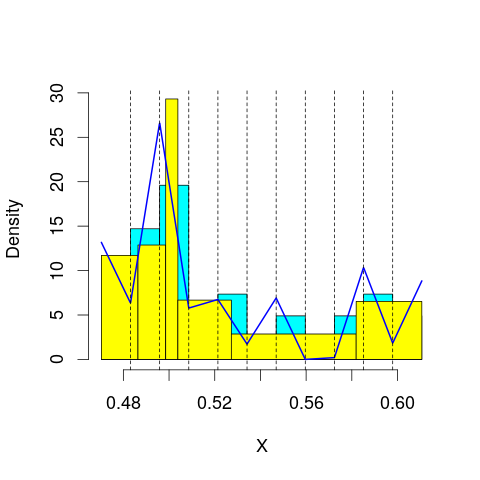

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.40282
mop.approx: Iteration 11. LL = 72.35777
mop.approx: Converged. Iteration 19. LL = 72.36728
[1] "Computing the linear combination of B-splines"


49.8399984955
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.17867
mop.approx: Iteration 11. LL = 70.93837
mop.approx: Iteration 21. LL = 71.1312
mop.approx: Iteration 31. LL = 71.18354
mop.approx: Iteration 41. LL = 71.20707
mop.approx: Iteration 51. LL = 71.21916
mop.approx: Iteration 61. LL = 71.22577
mop.approx: Iteration 71. LL = 71.22955
mop.approx: Iteration 81. LL = 71.23181
mop.approx: Iteration 91. LL = 71.23323
mop.approx: Iteration 101. LL = 71.23415
mop.approx: Converged. Iteration 102. LL = 71.23429
[1] "Computing the linear combination of B-splines"


46.9741382438
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.70246
mop.approx: Iteration 11. LL = 64.29718
mop.approx: Iteration 21. LL = 64.35539
mop.approx: Iteration 31. LL = 64.3588
mop.approx: Converged. Iteration 34. LL = 64.35911
[1] "Computing the linear combination of B-splines"


38.366092449
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.26811
mop.approx: Iteration 11. LL = 64.07596
mop.approx: Iteration 21. LL = 64.13127
mop.approx: Iteration 31. LL = 64.14381
mop.approx: Iteration 41. LL = 64.14988
mop.approx: Iteration 51. LL = 64.15374
mop.approx: Iteration 61. LL = 64.15638
mop.approx: Iteration 71. LL = 64.15826
mop.approx: Iteration 81. LL = 64.15961
mop.approx: Iteration 91. LL = 64.16059
mop.approx: Converged. Iteration 100. LL = 64.16132
[1] "Computing the linear combination of B-splines"


36.4354329628
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.624055
mop.approx: Iteration 11. LL = 64.54891
mop.approx: Iteration 21. LL = 64.71049
mop.approx: Iteration 31. LL = 64.73245
mop.approx: Iteration 41. LL = 64.73686
mop.approx: Converged. Iteration 50. LL = 64.73796
[1] "Computing the linear combination of B-splines"


35.2792060541
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.569346
mop.approx: Iteration 11. LL = 62.10377
mop.approx: Iteration 21. LL = 62.37732
mop.approx: Iteration 31. LL = 62.41203
mop.approx: Iteration 41. LL = 62.41757
mop.approx: Converged. Iteration 48. LL = 62.41842
[1] "Computing the linear combination of B-splines"


31.2267840074
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.97111
mop.approx: Iteration 11. LL = 60.05828
mop.approx: Iteration 21. LL = 60.16772
mop.approx: Iteration 31. LL = 60.18047
mop.approx: Iteration 41. LL = 60.18232
mop.approx: Converged. Iteration 44. LL = 60.18258
[1] "Computing the linear combination of B-splines"


27.2568143592
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.62855
mop.approx: Iteration 11. LL = 72.82411
mop.approx: Iteration 21. LL = 72.83913
mop.approx: Iteration 31. LL = 72.84249
mop.approx: Iteration 41. LL = 72.8438
mop.approx: Converged. Iteration 44. LL = 72.84411
[1] "Computing the linear combination of B-splines"


50.3168268003
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 50.316826800284232)
m reached
('Sum of Probabilities:', 0.9884028884715833)
chosen


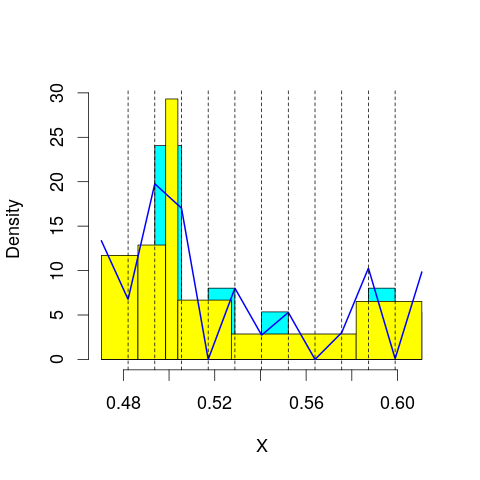

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.40282
mop.approx: Iteration 11. LL = 72.65815
mop.approx: Iteration 21. LL = 72.78718
mop.approx: Iteration 31. LL = 72.80164
mop.approx: Converged. Iteration 40. LL = 72.80345
[1] "Computing the linear combination of B-splines"


48.5432947771
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.17867
mop.approx: Iteration 11. LL = 71.52784
mop.approx: Iteration 21. LL = 71.647
mop.approx: Iteration 31. LL = 71.67116
mop.approx: Iteration 41. LL = 71.67919
mop.approx: Iteration 51. LL = 71.68268
mop.approx: Iteration 61. LL = 71.68454
mop.approx: Iteration 71. LL = 71.68567
mop.approx: Converged. Iteration 77. LL = 71.68622
[1] "Computing the linear combination of B-splines"


45.6931971005
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.70246
mop.approx: Iteration 11. LL = 65.29339
mop.approx: Iteration 21. LL = 65.40334
mop.approx: Iteration 31. LL = 65.42305
mop.approx: Iteration 41. LL = 65.43012
mop.approx: Iteration 51. LL = 65.43367
mop.approx: Iteration 61. LL = 65.43575
mop.approx: Iteration 71. LL = 65.43709
mop.approx: Iteration 81. LL = 65.43799
mop.approx: Converged. Iteration 85. LL = 65.43834
[1] "Computing the linear combination of B-splines"


37.7124511017
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.26811
mop.approx: Iteration 11. LL = 64.67558
mop.approx: Iteration 21. LL = 64.75997
mop.approx: Iteration 31. LL = 64.77096
mop.approx: Iteration 41. LL = 64.7742
mop.approx: Iteration 51. LL = 64.77567
mop.approx: Converged. Iteration 59. LL = 64.7764
[1] "Computing the linear combination of B-splines"


35.3176428731
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.624055
mop.approx: Iteration 11. LL = 65.27645
mop.approx: Iteration 21. LL = 65.40006
mop.approx: Iteration 31. LL = 65.42629
mop.approx: Iteration 41. LL = 65.43756
mop.approx: Iteration 51. LL = 65.44354
mop.approx: Iteration 61. LL = 65.44692
mop.approx: Iteration 71. LL = 65.44886
mop.approx: Iteration 81. LL = 65.44999
mop.approx: Converged. Iteration 86. LL = 65.45043
[1] "Computing the linear combination of B-splines"


34.258803348
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.569346
mop.approx: Iteration 11. LL = 63.69326
mop.approx: Iteration 21. LL = 63.90053
mop.approx: Iteration 31. LL = 63.91585
mop.approx: Iteration 41. LL = 63.91765
mop.approx: Converged. Iteration 41. LL = 63.91771
[1] "Computing the linear combination of B-splines"


30.9933056775
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.97111
mop.approx: Iteration 11. LL = 61.19761
mop.approx: Iteration 21. LL = 61.38682
mop.approx: Iteration 31. LL = 61.41521
mop.approx: Iteration 41. LL = 61.42105
mop.approx: Iteration 51. LL = 61.42269
mop.approx: Converged. Iteration 55. LL = 61.42305
[1] "Computing the linear combination of B-splines"


26.7593157101
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.62855
mop.approx: Iteration 11. LL = 73.84753
mop.approx: Iteration 21. LL = 73.88351
mop.approx: Converged. Iteration 25. LL = 73.88417
[1] "Computing the linear combination of B-splines"


49.624018271
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 49.624018270998796)
m reached
('Sum of Probabilities:', 0.9885626626995025)
chosen


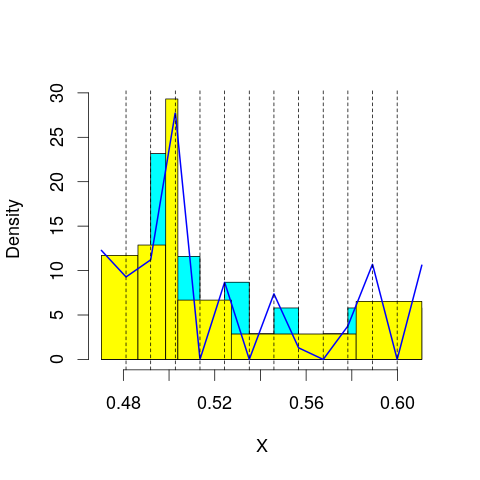

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.40282
mop.approx: Iteration 11. LL = 72.87775
mop.approx: Iteration 21. LL = 72.88978
mop.approx: Converged. Iteration 24. LL = 72.89016
[1] "Computing the linear combination of B-splines"


46.897143659
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.17867
mop.approx: Iteration 11. LL = 72.07271
mop.approx: Iteration 21. LL = 72.20458
mop.approx: Iteration 31. LL = 72.22648
mop.approx: Iteration 41. LL = 72.23138
mop.approx: Iteration 51. LL = 72.23284
mop.approx: Converged. Iteration 53. LL = 72.23307
[1] "Computing the linear combination of B-splines"


44.5071798465
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.70246
mop.approx: Iteration 11. LL = 66.02174
mop.approx: Iteration 21. LL = 66.1148
mop.approx: Iteration 31. LL = 66.12614
mop.approx: Iteration 41. LL = 66.12881
mop.approx: Converged. Iteration 48. LL = 66.12954
[1] "Computing the linear combination of B-splines"


36.67077989
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.26811
mop.approx: Iteration 11. LL = 65.49001
mop.approx: Iteration 21. LL = 65.59133
mop.approx: Iteration 31. LL = 65.62606
mop.approx: Iteration 41. LL = 65.64096
mop.approx: Iteration 51. LL = 65.64743
mop.approx: Iteration 61. LL = 65.65037
mop.approx: Iteration 71. LL = 65.65177
mop.approx: Converged. Iteration 77. LL = 65.65231
[1] "Computing the linear combination of B-splines"


34.4606844531
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.624055
mop.approx: Iteration 11. LL = 65.6373
mop.approx: Iteration 21. LL = 65.76002
mop.approx: Iteration 31. LL = 65.78537
mop.approx: Iteration 41. LL = 65.7933
mop.approx: Iteration 51. LL = 65.79656
mop.approx: Iteration 61. LL = 65.79817
mop.approx: Converged. Iteration 70. LL = 65.79903
[1] "Computing the linear combination of B-splines"


32.8745440468
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.569346
mop.approx: Iteration 11. LL = 65.18066
mop.approx: Iteration 21. LL = 65.38694
mop.approx: Iteration 31. LL = 65.41882
mop.approx: Iteration 41. LL = 65.42925
mop.approx: Iteration 51. LL = 65.43391
mop.approx: Iteration 61. LL = 65.4364
mop.approx: Iteration 71. LL = 65.43792
mop.approx: Iteration 81. LL = 65.43892
mop.approx: Converged. Iteration 88. LL = 65.4395
[1] "Computing the linear combination of B-splines"


30.7814049736
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.97111
mop.approx: Iteration 11. LL = 62.37519
mop.approx: Iteration 21. LL = 62.56473
mop.approx: Iteration 31. LL = 62.5951
mop.approx: Iteration 41. LL = 62.60394
mop.approx: Iteration 51. LL = 62.60785
mop.approx: Iteration 61. LL = 62.61
mop.approx: Iteration 71. LL = 62.61133
mop.approx: Iteration 81. LL = 62.61221
mop.approx: Converged. Iteration 85. LL = 62.61254
[1] "Computing the linear combination of B-splines"


26.1891712718
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.62855
mop.approx: Iteration 11. LL = 74.30333
mop.approx: Iteration 21. LL = 74.32281
mop.approx: Converged. Iteration 29. LL = 74.32437
[1] "Computing the linear combination of B-splines"


48.3313536243
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 48.331353624317217)
m reached
('Sum of Probabilities:', 0.9886077194697847)
chosen


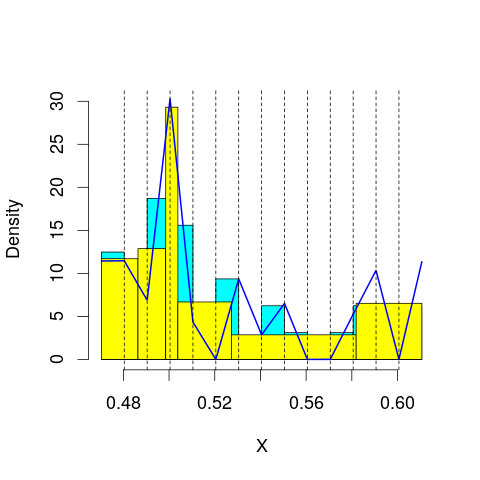

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.40282
mop.approx: Iteration 11. LL = 72.93565
mop.approx: Iteration 21. LL = 72.957
mop.approx: Converged. Iteration 23. LL = 72.95731
[1] "Computing the linear combination of B-splines"


45.231419604
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.17867
mop.approx: Iteration 11. LL = 73.0733
mop.approx: Iteration 21. LL = 73.23296
mop.approx: Iteration 31. LL = 73.27064
mop.approx: Iteration 41. LL = 73.28545
mop.approx: Iteration 51. LL = 73.29244
mop.approx: Iteration 61. LL = 73.29618
mop.approx: Iteration 71. LL = 73.29838
mop.approx: Iteration 81. LL = 73.29979
mop.approx: Iteration 91. LL = 73.30074
mop.approx: Converged. Iteration 93. LL = 73.30097
[1] "Computing the linear combination of B-splines"


43.8422116477
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.70246
mop.approx: Iteration 11. LL = 65.81703
mop.approx: Iteration 21. LL = 65.90217
mop.approx: Iteration 31. LL = 65.91672
mop.approx: Iteration 41. LL = 65.91907
mop.approx: Converged. Iteration 42. LL = 65.9192
[1] "Computing the linear combination of B-splines"


34.7275814778
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.26811
mop.approx: Iteration 11. LL = 66.70467
mop.approx: Iteration 21. LL = 66.85444
mop.approx: Iteration 31. LL = 66.87049
mop.approx: Iteration 41. LL = 66.87266
mop.approx: Converged. Iteration 41. LL = 66.87272
[1] "Computing the linear combination of B-splines"


33.9482334989
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.624055
mop.approx: Iteration 11. LL = 65.88103
mop.approx: Iteration 21. LL = 65.97989
mop.approx: Iteration 31. LL = 66.01296
mop.approx: Iteration 41. LL = 66.02761
mop.approx: Iteration 51. LL = 66.03402
mop.approx: Iteration 61. LL = 66.0369
mop.approx: Iteration 71. LL = 66.03829
mop.approx: Converged. Iteration 78. LL = 66.03891
[1] "Computing the linear combination of B-splines"


31.3815121478
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.569346
mop.approx: Iteration 11. LL = 66.29537
mop.approx: Iteration 21. LL = 66.55536
mop.approx: Iteration 31. LL = 66.60708
mop.approx: Iteration 41. LL = 66.62167
mop.approx: Iteration 51. LL = 66.62619
mop.approx: Iteration 61. LL = 66.62765
mop.approx: Converged. Iteration 63. LL = 66.62785
[1] "Computing the linear combination of B-splines"


30.2365883222
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.97111
mop.approx: Iteration 11. LL = 63.93299
mop.approx: Iteration 21. LL = 64.14072
mop.approx: Iteration 31. LL = 64.17428
mop.approx: Iteration 41. LL = 64.18708
mop.approx: Iteration 51. LL = 64.19472
mop.approx: Iteration 61. LL = 64.20016
mop.approx: Iteration 71. LL = 64.20421
mop.approx: Iteration 81. LL = 64.20724
mop.approx: Iteration 91. LL = 64.20949
mop.approx: Iteration 101. LL = 64.21116
mop.approx: Iteration 111. LL = 64.2124
mop.approx: Iteration 121. LL = 64.21333
mop.approx: Converged. Iteration 129. LL = 64.21397
[1] "Computing the linear combination of B-splines"


26.0882003489
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.62855
mop.approx: Iteration 11. LL = 75.37977
mop.approx: Converged. Iteration 17. LL = 75.38357
[1] "Computing the linear combination of B-splines"


47.6576781707
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 47.65767817069117)
m reached
('Sum of Probabilities:', 0.9880364152605566)
chosen


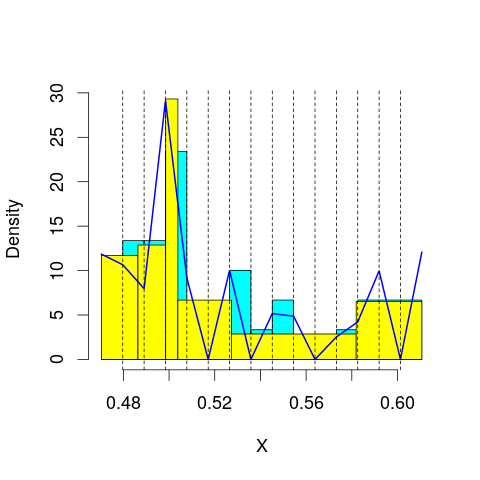

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.40282
mop.approx: Iteration 11. LL = 73.67953
mop.approx: Iteration 21. LL = 73.74108
mop.approx: Converged. Iteration 30. LL = 73.74416
[1] "Computing the linear combination of B-splines"


44.2854036104
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.17867
mop.approx: Iteration 11. LL = 72.87868
mop.approx: Iteration 21. LL = 72.97781
mop.approx: Iteration 31. LL = 73.00257
mop.approx: Iteration 41. LL = 73.0132
mop.approx: Iteration 51. LL = 73.01878
mop.approx: Iteration 61. LL = 73.02204
mop.approx: Iteration 71. LL = 73.02409
mop.approx: Iteration 81. LL = 73.02545
mop.approx: Iteration 91. LL = 73.0264
mop.approx: Converged. Iteration 94. LL = 73.0267
[1] "Computing the linear combination of B-splines"


41.8350814236
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.70246
mop.approx: Iteration 11. LL = 66.52887
mop.approx: Iteration 21. LL = 66.63652
mop.approx: Iteration 31. LL = 66.65061
mop.approx: Iteration 41. LL = 66.65264
mop.approx: Converged. Iteration 41. LL = 66.6527
[1] "Computing the linear combination of B-splines"


33.7282081113
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.26811
mop.approx: Iteration 11. LL = 66.76686
mop.approx: Iteration 21. LL = 66.87835
mop.approx: Iteration 31. LL = 66.89584
mop.approx: Iteration 41. LL = 66.89893
mop.approx: Converged. Iteration 45. LL = 66.89936
[1] "Computing the linear combination of B-splines"


32.2419971948
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.624055
mop.approx: Iteration 11. LL = 66.82104
mop.approx: Iteration 21. LL = 66.96859
mop.approx: Iteration 31. LL = 66.99422
mop.approx: Iteration 41. LL = 66.99949
mop.approx: Converged. Iteration 49. LL = 67.00057
[1] "Computing the linear combination of B-splines"


30.6103722673
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.569346
mop.approx: Iteration 11. LL = 66.56694
mop.approx: Iteration 21. LL = 66.70505
mop.approx: Iteration 31. LL = 66.732
mop.approx: Iteration 41. LL = 66.74151
mop.approx: Iteration 51. LL = 66.74477
mop.approx: Converged. Iteration 60. LL = 66.74583
[1] "Computing the linear combination of B-splines"


28.6217394678
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.97111
mop.approx: Iteration 11. LL = 66.02847
mop.approx: Iteration 21. LL = 66.27834
mop.approx: Iteration 31. LL = 66.32803
mop.approx: Iteration 41. LL = 66.34597
mop.approx: Iteration 51. LL = 66.35285
mop.approx: Iteration 61. LL = 66.35556
mop.approx: Iteration 71. LL = 66.35665
mop.approx: Converged. Iteration 71. LL = 66.35672
[1] "Computing the linear combination of B-splines"


26.4777066773
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.62855
mop.approx: Iteration 11. LL = 73.78057
mop.approx: Iteration 21. LL = 73.82842
mop.approx: Iteration 31. LL = 73.84865
mop.approx: Iteration 41. LL = 73.85672
mop.approx: Iteration 51. LL = 73.85977
mop.approx: Converged. Iteration 60. LL = 73.86089
[1] "Computing the linear combination of B-splines"


44.4021358325
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 44.402135832461589)
m reached
('Sum of Probabilities:', 0.9871085697013363)
chosen


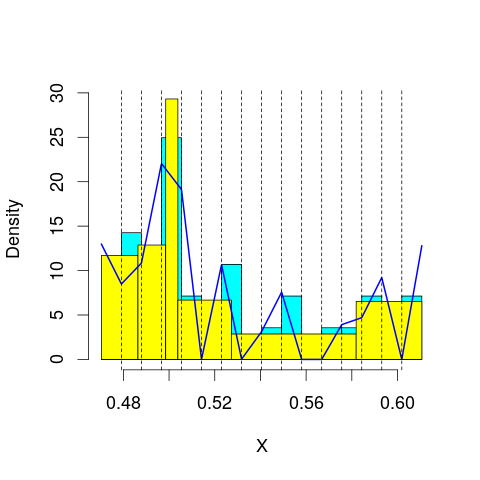

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.40282
mop.approx: Iteration 11. LL = 74.58956
mop.approx: Iteration 21. LL = 74.63744
mop.approx: Iteration 31. LL = 74.64325
mop.approx: Iteration 41. LL = 74.64482
mop.approx: Converged. Iteration 44. LL = 74.64514
[1] "Computing the linear combination of B-splines"


43.4535204076
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.17867
mop.approx: Iteration 11. LL = 72.63265
mop.approx: Iteration 21. LL = 72.70974
mop.approx: Iteration 31. LL = 72.74145
mop.approx: Iteration 41. LL = 72.75674
mop.approx: Iteration 51. LL = 72.76457
mop.approx: Iteration 61. LL = 72.76891
mop.approx: Iteration 71. LL = 72.77144
mop.approx: Iteration 81. LL = 72.77298
mop.approx: Iteration 91. LL = 72.77393
mop.approx: Converged. Iteration 92. LL = 72.77407
[1] "Computing the linear combination of B-splines"


39.8495823453
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.70246
mop.approx: Iteration 11. LL = 66.97811
mop.approx: Iteration 21. LL = 67.06335
mop.approx: Iteration 31. LL = 67.07447
mop.approx: Iteration 41. LL = 67.07683
mop.approx: Converged. Iteration 46. LL = 67.07733
[1] "Computing the linear combination of B-splines"


32.4199671911
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.26811
mop.approx: Iteration 11. LL = 66.80659
mop.approx: Iteration 21. LL = 66.87743
mop.approx: Iteration 31. LL = 66.89348
mop.approx: Iteration 41. LL = 66.90115
mop.approx: Iteration 51. LL = 66.90571
mop.approx: Iteration 61. LL = 66.90864
mop.approx: Iteration 71. LL = 66.9106
mop.approx: Iteration 81. LL = 66.91195
mop.approx: Iteration 91. LL = 66.91291
mop.approx: Converged. Iteration 97. LL = 66.91342
[1] "Computing the linear combination of B-splines"


30.5231903959
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.624055
mop.approx: Iteration 11. LL = 67.45965
mop.approx: Iteration 21. LL = 67.56563
mop.approx: Iteration 31. LL = 67.5787
mop.approx: Iteration 41. LL = 67.58096
mop.approx: Converged. Iteration 42. LL = 67.5811
[1] "Computing the linear combination of B-splines"


29.45793961
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.569346
mop.approx: Iteration 11. LL = 66.94542
mop.approx: Iteration 21. LL = 67.08484
mop.approx: Iteration 31. LL = 67.1117
mop.approx: Iteration 41. LL = 67.12284
mop.approx: Iteration 51. LL = 67.12881
mop.approx: Iteration 61. LL = 67.13235
mop.approx: Iteration 71. LL = 67.13455
mop.approx: Iteration 81. LL = 67.13595
mop.approx: Iteration 91. LL = 67.13685
mop.approx: Converged. Iteration 93. LL = 67.13706
[1] "Computing the linear combination of B-splines"


27.2793089268
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.97111
mop.approx: Iteration 11. LL = 67.24766
mop.approx: Iteration 21. LL = 67.4866
mop.approx: Iteration 31. LL = 67.52255
mop.approx: Iteration 41. LL = 67.53334
mop.approx: Iteration 51. LL = 67.53719
mop.approx: Iteration 61. LL = 67.53874
mop.approx: Converged. Iteration 67. LL = 67.5393
[1] "Computing the linear combination of B-splines"


25.925086229
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.62855
mop.approx: Iteration 11. LL = 75.48171
mop.approx: Converged. Iteration 18. LL = 75.48524
[1] "Computing the linear combination of B-splines"


44.2936168006
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 44.293616800550879)
m reached
('Sum of Probabilities:', 0.9863054719047012)
chosen


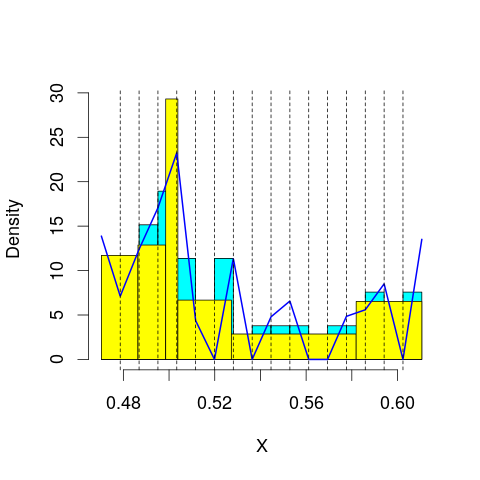

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.40282
mop.approx: Iteration 11. LL = 74.56604
mop.approx: Iteration 21. LL = 74.70742
mop.approx: Iteration 31. LL = 74.72965
mop.approx: Iteration 41. LL = 74.73675
mop.approx: Iteration 51. LL = 74.74009
mop.approx: Iteration 61. LL = 74.74195
mop.approx: Iteration 71. LL = 74.74309
mop.approx: Converged. Iteration 76. LL = 74.74357
[1] "Computing the linear combination of B-splines"


41.8190757936
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.17867
mop.approx: Iteration 11. LL = 73.57249
mop.approx: Iteration 21. LL = 73.61778
mop.approx: Iteration 31. LL = 73.62095
mop.approx: Converged. Iteration 33. LL = 73.62119
[1] "Computing the linear combination of B-splines"


38.9638341526
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.70246
mop.approx: Iteration 11. LL = 66.78826
mop.approx: Iteration 21. LL = 66.84827
mop.approx: Iteration 31. LL = 66.85745
mop.approx: Iteration 41. LL = 66.8612
mop.approx: Iteration 51. LL = 66.86321
mop.approx: Iteration 61. LL = 66.86445
mop.approx: Iteration 71. LL = 66.86526
mop.approx: Converged. Iteration 71. LL = 66.86533
[1] "Computing the linear combination of B-splines"


30.4750987844
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.26811
mop.approx: Iteration 11. LL = 67.41886
mop.approx: Iteration 21. LL = 67.47257
mop.approx: Iteration 31. LL = 67.47669
mop.approx: Converged. Iteration 33. LL = 67.47694
[1] "Computing the linear combination of B-splines"


29.353844459
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.624055
mop.approx: Iteration 11. LL = 67.52956
mop.approx: Iteration 21. LL = 67.64787
mop.approx: Iteration 31. LL = 67.66591
mop.approx: Iteration 41. LL = 67.67174
mop.approx: Iteration 51. LL = 67.67446
mop.approx: Iteration 61. LL = 67.67598
mop.approx: Iteration 71. LL = 67.67691
mop.approx: Converged. Iteration 73. LL = 67.67712
[1] "Computing the linear combination of B-splines"


27.8210674306
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.569346
mop.approx: Iteration 11. LL = 67.63359
mop.approx: Iteration 21. LL = 67.7226
mop.approx: Iteration 31. LL = 67.73109
mop.approx: Iteration 41. LL = 67.73332
mop.approx: Converged. Iteration 45. LL = 67.73372
[1] "Computing the linear combination of B-splines"


26.1394061493
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.97111
mop.approx: Iteration 11. LL = 67.38496
mop.approx: Iteration 21. LL = 67.59167
mop.approx: Iteration 31. LL = 67.61526
mop.approx: Iteration 41. LL = 67.61936
mop.approx: Converged. Iteration 46. LL = 67.61998
[1] "Computing the linear combination of B-splines"


24.2145845658
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.62855
mop.approx: Iteration 11. LL = 75.2368
mop.approx: Converged. Iteration 14. LL = 75.2373
[1] "Computing the linear combination of B-splines"


42.3128089038
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 42.312808903754316)
m reached
('Sum of Probabilities:', 0.98584526996826)
chosen


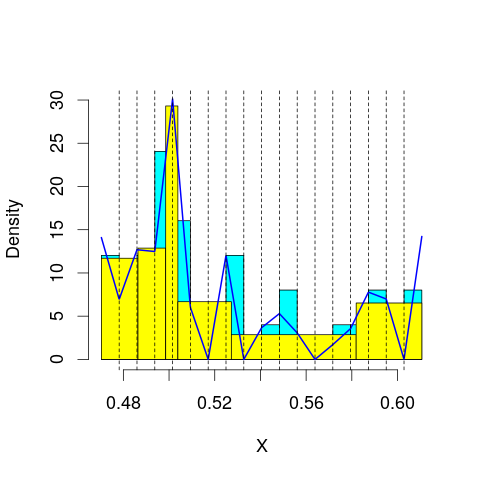

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.40282
mop.approx: Iteration 11. LL = 75.46454
mop.approx: Iteration 21. LL = 75.52164
mop.approx: Iteration 31. LL = 75.53319
mop.approx: Iteration 41. LL = 75.53745
mop.approx: Iteration 51. LL = 75.53943
mop.approx: Iteration 61. LL = 75.54047
mop.approx: Converged. Iteration 62. LL = 75.54062
[1] "Computing the linear combination of B-splines"


40.8832591653
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.17867
mop.approx: Iteration 11. LL = 73.48933
mop.approx: Iteration 21. LL = 73.60584
mop.approx: Iteration 31. LL = 73.62564
mop.approx: Iteration 41. LL = 73.63004
mop.approx: Converged. Iteration 49. LL = 73.6311
[1] "Computing the linear combination of B-splines"


37.2408743967
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.70246
mop.approx: Iteration 11. LL = 67.37694
mop.approx: Iteration 21. LL = 67.40945
mop.approx: Converged. Iteration 29. LL = 67.41141
[1] "Computing the linear combination of B-splines"


29.288312693
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.26811
mop.approx: Iteration 11. LL = 67.63887
mop.approx: Iteration 21. LL = 67.82716
mop.approx: Iteration 31. LL = 67.85893
mop.approx: Iteration 41. LL = 67.86632
mop.approx: Iteration 51. LL = 67.86848
mop.approx: Converged. Iteration 56. LL = 67.869
[1] "Computing the linear combination of B-splines"


28.0130367356
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.624055
mop.approx: Iteration 11. LL = 67.79021
mop.approx: Iteration 21. LL = 67.84391
mop.approx: Iteration 31. LL = 67.84876
mop.approx: Converged. Iteration 35. LL = 67.84926
[1] "Computing the linear combination of B-splines"


26.2602705099
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.569346
mop.approx: Iteration 11. LL = 68.0388
mop.approx: Iteration 21. LL = 68.21299
mop.approx: Iteration 31. LL = 68.2386
mop.approx: Iteration 41. LL = 68.24598
mop.approx: Iteration 51. LL = 68.24942
mop.approx: Iteration 61. LL = 68.25135
mop.approx: Iteration 71. LL = 68.25252
mop.approx: Converged. Iteration 77. LL = 68.25307
[1] "Computing the linear combination of B-splines"


24.9300366623
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.97111
mop.approx: Iteration 11. LL = 68.19998
mop.approx: Iteration 21. LL = 68.39926
mop.approx: Iteration 31. LL = 68.41993
mop.approx: Iteration 41. LL = 68.42385
mop.approx: Iteration 51. LL = 68.42507
mop.approx: Converged. Iteration 52. LL = 68.42521
[1] "Computing the linear combination of B-splines"


22.8873395609
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.62855
mop.approx: Iteration 11. LL = 76.66101
mop.approx: Iteration 21. LL = 76.67691
mop.approx: Iteration 31. LL = 76.67847
mop.approx: Converged. Iteration 31. LL = 76.67854
[1] "Computing the linear combination of B-splines"


42.0211825089
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 42.021182508884031)
m reached
('Sum of Probabilities:', 0.9855376968915683)
chosen


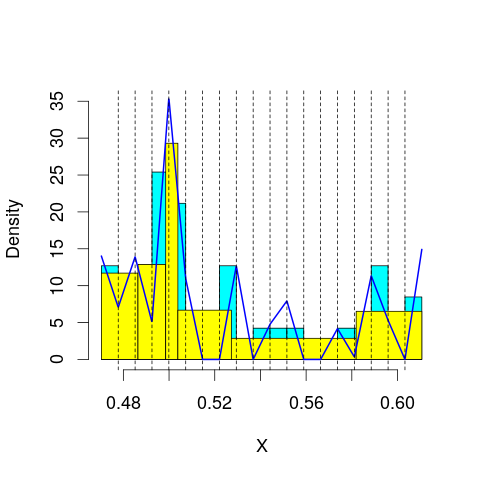

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.40282
mop.approx: Iteration 11. LL = 75.23618
mop.approx: Iteration 21. LL = 75.24428
mop.approx: Converged. Iteration 25. LL = 75.2448
[1] "Computing the linear combination of B-splines"


38.8545739023
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.17867
mop.approx: Iteration 11. LL = 74.24253
mop.approx: Iteration 21. LL = 74.37612
mop.approx: Iteration 31. LL = 74.41015
mop.approx: Iteration 41. LL = 74.42336
mop.approx: Iteration 51. LL = 74.42933
mop.approx: Iteration 61. LL = 74.43228
mop.approx: Iteration 71. LL = 74.43382
mop.approx: Converged. Iteration 78. LL = 74.43454
[1] "Computing the linear combination of B-splines"


36.3114424395
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.70246
mop.approx: Iteration 11. LL = 67.60154
mop.approx: Iteration 21. LL = 67.7171
mop.approx: Iteration 31. LL = 67.73906
mop.approx: Iteration 41. LL = 67.74627
mop.approx: Iteration 51. LL = 67.74917
mop.approx: Iteration 61. LL = 67.75043
mop.approx: Converged. Iteration 63. LL = 67.75064
[1] "Computing the linear combination of B-splines"


27.8946785849
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.26811
mop.approx: Iteration 11. LL = 67.91535
mop.approx: Iteration 21. LL = 67.99666
mop.approx: Iteration 31. LL = 68.00537
mop.approx: Iteration 41. LL = 68.00718
mop.approx: Converged. Iteration 46. LL = 68.00765
[1] "Computing the linear combination of B-splines"


26.4188179599
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.624055
mop.approx: Iteration 11. LL = 68.03346
mop.approx: Iteration 21. LL = 68.19078
mop.approx: Iteration 31. LL = 68.21716
mop.approx: Iteration 41. LL = 68.22203
mop.approx: Converged. Iteration 47. LL = 68.22281
[1] "Computing the linear combination of B-splines"


24.9009711519
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.569346
mop.approx: Iteration 11. LL = 68.24639
mop.approx: Iteration 21. LL = 68.35567
mop.approx: Iteration 31. LL = 68.36958
mop.approx: Iteration 41. LL = 68.37258
mop.approx: Converged. Iteration 48. LL = 68.37337
[1] "Computing the linear combination of B-splines"


23.2965888444
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.97111
mop.approx: Iteration 11. LL = 68.57323
mop.approx: Iteration 21. LL = 68.74693
mop.approx: Iteration 31. LL = 68.76105
mop.approx: Iteration 41. LL = 68.76296
mop.approx: Converged. Iteration 41. LL = 68.76303
[1] "Computing the linear combination of B-splines"


21.9246780741
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.62855
mop.approx: Iteration 11. LL = 77.73077
mop.approx: Iteration 21. LL = 77.78225
mop.approx: Iteration 31. LL = 77.78968
mop.approx: Iteration 41. LL = 77.79136
mop.approx: Converged. Iteration 42. LL = 77.79152
[1] "Computing the linear combination of B-splines"


41.4012918275
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 41.40129182747819)
m reached
('Sum of Probabilities:', 0.985374838228468)
chosen


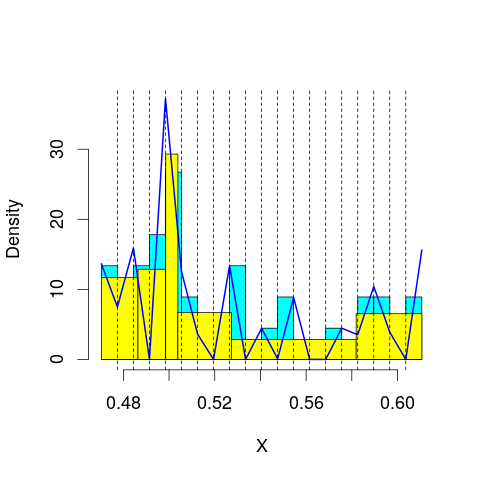

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.40282
mop.approx: Iteration 11. LL = 75.11742
mop.approx: Iteration 21. LL = 75.15405
mop.approx: Converged. Iteration 26. LL = 75.15509
[1] "Computing the linear combination of B-splines"


37.0319925529
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 62.17867
mop.approx: Iteration 11. LL = 74.78533
mop.approx: Iteration 21. LL = 74.93894
mop.approx: Iteration 31. LL = 74.97957
mop.approx: Iteration 41. LL = 74.99271
mop.approx: Iteration 51. LL = 74.99735
mop.approx: Iteration 61. LL = 74.9991
mop.approx: Converged. Iteration 65. LL = 74.99953
[1] "Computing the linear combination of B-splines"


35.1435707786
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.70246
mop.approx: Iteration 11. LL = 67.71914
mop.approx: Iteration 21. LL = 67.85463
mop.approx: Iteration 31. LL = 67.87555
mop.approx: Iteration 41. LL = 67.87901
mop.approx: Converged. Iteration 45. LL = 67.87944
[1] "Computing the linear combination of B-splines"


26.2906053034
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.26811
mop.approx: Iteration 11. LL = 68.18844
mop.approx: Iteration 21. LL = 68.29161
mop.approx: Iteration 31. LL = 68.31678
mop.approx: Iteration 41. LL = 68.32565
mop.approx: Iteration 51. LL = 68.32909
mop.approx: Iteration 61. LL = 68.33057
mop.approx: Converged. Iteration 67. LL = 68.33113
[1] "Computing the linear combination of B-splines"


25.0094278891
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.624055
mop.approx: Iteration 11. LL = 68.29263
mop.approx: Iteration 21. LL = 68.47979
mop.approx: Iteration 31. LL = 68.51687
mop.approx: Iteration 41. LL = 68.52481
mop.approx: Iteration 51. LL = 68.52657
mop.approx: Converged. Iteration 52. LL = 68.5267
[1] "Computing the linear combination of B-splines"


23.4715123295
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.569346
mop.approx: Iteration 11. LL = 68.4484
mop.approx: Iteration 21. LL = 68.57735
mop.approx: Iteration 31. LL = 68.60393
mop.approx: Iteration 41. LL = 68.6104
mop.approx: Iteration 51. LL = 68.61258
mop.approx: Iteration 61. LL = 68.61356
mop.approx: Converged. Iteration 61. LL = 68.61363
[1] "Computing the linear combination of B-splines"


21.8157391899
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.97111
mop.approx: Iteration 11. LL = 68.54082
mop.approx: Iteration 21. LL = 68.70418
mop.approx: Iteration 31. LL = 68.73148
mop.approx: Iteration 41. LL = 68.74413
mop.approx: Iteration 51. LL = 68.75064
mop.approx: Iteration 61. LL = 68.75395
mop.approx: Iteration 71. LL = 68.75566
mop.approx: Iteration 81. LL = 68.75659
mop.approx: Converged. Iteration 81. LL = 68.75666
[1] "Computing the linear combination of B-splines"


20.1215731751
lfps_11
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.70635
mop.approx: Iteration 11. LL = 46.37573
mop.approx: Converged. Iteration 12. LL = 46.37587
[1] "Computing the linear combination of B-splines"


41.1772641573
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 41.177264157278643)
m reached
('Sum of Probabilities:', 0.9939874516414019)
chosen


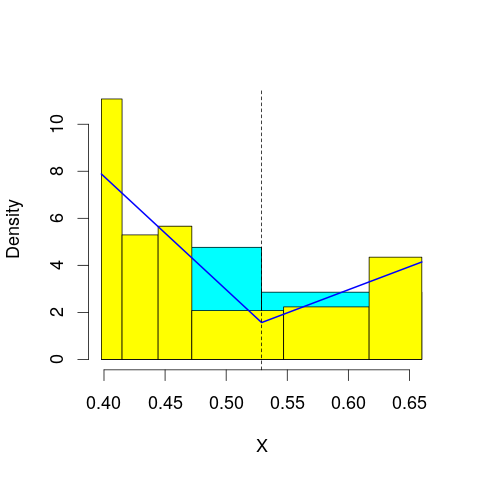

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.58503
mop.approx: Iteration 11. LL = 46.98259
mop.approx: Iteration 21. LL = 46.99757
mop.approx: Iteration 31. LL = 47.00107
mop.approx: Converged. Iteration 40. LL = 47.00193
[1] "Computing the linear combination of B-splines"


40.07045707
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.46417
mop.approx: Iteration 11. LL = 46.90066
mop.approx: Iteration 21. LL = 46.9266
mop.approx: Iteration 31. LL = 46.94257
mop.approx: Iteration 41. LL = 46.95262
mop.approx: Iteration 51. LL = 46.95898
mop.approx: Iteration 61. LL = 46.96304
mop.approx: Iteration 71. LL = 46.96568
mop.approx: Iteration 81. LL = 46.96742
mop.approx: Iteration 91. LL = 46.96859
mop.approx: Iteration 101. LL = 46.96938
mop.approx: Converged. Iteration 110. LL = 46.96992
[1] "Computing the linear combination of B-splines"


38.3055801145
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.1866
mop.approx: Iteration 11. LL = 33.55367
mop.approx: Iteration 21. LL = 33.62721
mop.approx: Converged. Iteration 26. LL = 33.6278
[1] "Computing the linear combination of B-splines"


23.2305956744
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.686523
mop.approx: Iteration 11. LL = 31.902
mop.approx: Iteration 21. LL = 32.2083
mop.approx: Iteration 31. LL = 32.28286
mop.approx: Iteration 41. LL = 32.30031
mop.approx: Iteration 51. LL = 32.30426
mop.approx: Iteration 61. LL = 32.30514
mop.approx: Converged. Iteration 62. LL = 32.3052
[1] "Computing the linear combination of B-splines"


20.1751284263
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.741961
mop.approx: Iteration 11. LL = 32.50574
mop.approx: Iteration 21. LL = 32.63509
mop.approx: Converged. Iteration 28. LL = 32.63663
[1] "Computing the linear combination of B-splines"


18.7736862543
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.230711
mop.approx: Iteration 11. LL = 31.39811
mop.approx: Iteration 21. LL = 31.84591
mop.approx: Iteration 31. LL = 31.90734
mop.approx: Iteration 41. LL = 31.91428
mop.approx: Iteration 51. LL = 31.91518
mop.approx: Converged. Iteration 51. LL = 31.91521
[1] "Computing the linear combination of B-splines"


16.3193962288
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.933074
mop.approx: Iteration 11. LL = 31.55244
mop.approx: Iteration 21. LL = 31.75223
mop.approx: Iteration 31. LL = 31.7562
mop.approx: Converged. Iteration 31. LL = 31.75623
[1] "Computing the linear combination of B-splines"


14.4275500302
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.70635
mop.approx: Iteration 11. LL = 47.30004
mop.approx: Converged. Iteration 13. LL = 47.30032
[1] "Computing the linear combination of B-splines"


40.3688456394
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 40.368845639439229)
m reached
('Sum of Probabilities:', 0.9928403211888206)
chosen


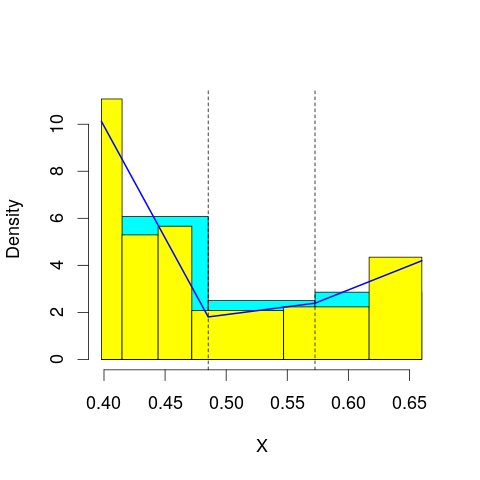

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.58503
mop.approx: Iteration 11. LL = 47.17912
mop.approx: Iteration 21. LL = 47.19191
mop.approx: Iteration 31. LL = 47.19369
mop.approx: Converged. Iteration 32. LL = 47.19378
[1] "Computing the linear combination of B-splines"


38.5294445238
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.46417
mop.approx: Iteration 11. LL = 47.10745
mop.approx: Iteration 21. LL = 47.21158
mop.approx: Iteration 31. LL = 47.26434
mop.approx: Iteration 41. LL = 47.29344
mop.approx: Iteration 51. LL = 47.31077
mop.approx: Iteration 61. LL = 47.32172
mop.approx: Iteration 71. LL = 47.32899
mop.approx: Iteration 81. LL = 47.33397
mop.approx: Iteration 91. LL = 47.33749
mop.approx: Iteration 101. LL = 47.34001
mop.approx: Iteration 111. LL = 47.34186
mop.approx: Iteration 121. LL = 47.34322
mop.approx: Iteration 131. LL = 47.34424
mop.approx: Iteration 141. LL = 47.345
mop.approx: Iteration 151. LL = 47.34557
mop.approx: Converged. Iteration 153. LL = 47.34572
[1] "Computing the linear combination of B-splines"


36.9485110671
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.1866
mop.approx: Iteration 11. LL = 34.63628
mop.approx: Iteration 21. LL = 34.68174
mop.approx: Iteration 31. LL = 34.68682
mop.approx: Converged. Iteration 40. LL = 34.68759
[1] "Computing the linear combination of B-splines"


22.5575154146
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.686523
mop.approx: Iteration 11. LL = 32.55876
mop.approx: Iteration 21. LL = 32.82018
mop.approx: Iteration 31. LL = 32.89149
mop.approx: Iteration 41. LL = 32.91823
mop.approx: Iteration 51. LL = 32.9297
mop.approx: Iteration 61. LL = 32.93496
mop.approx: Iteration 71. LL = 32.93746
mop.approx: Iteration 81. LL = 32.93867
mop.approx: Iteration 91. LL = 32.93926
mop.approx: Converged. Iteration 94. LL = 32.93941
[1] "Computing the linear combination of B-splines"


19.0764636287
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.741961
mop.approx: Iteration 11. LL = 32.6833
mop.approx: Converged. Iteration 19. LL = 32.68794
[1] "Computing the linear combination of B-splines"


17.0921278509
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.230711
mop.approx: Iteration 11. LL = 32.50325
mop.approx: Iteration 21. LL = 32.88065
mop.approx: Iteration 31. LL = 32.92543
mop.approx: Iteration 41. LL = 32.9308
mop.approx: Converged. Iteration 48. LL = 32.9314
[1] "Computing the linear combination of B-splines"


15.6027210988
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.933074
mop.approx: Iteration 11. LL = 31.83494
mop.approx: Iteration 21. LL = 32.0083
mop.approx: Iteration 31. LL = 32.08277
mop.approx: Iteration 41. LL = 32.11785
mop.approx: Iteration 51. LL = 32.13537
mop.approx: Iteration 61. LL = 32.14451
mop.approx: Iteration 71. LL = 32.14941
mop.approx: Iteration 81. LL = 32.15209
mop.approx: Iteration 91. LL = 32.15357
mop.approx: Iteration 101. LL = 32.1544
mop.approx: Iteration 111. LL = 32.15486
mop.approx: Converged. Iteration 112. LL = 32.15492
[1] "Computing the linear combination of B-splines"


13.093371475
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.70635
mop.approx: Iteration 11. LL = 47.27936
mop.approx: Converged. Iteration 12. LL = 47.27949
[1] "Computing the linear combination of B-splines"


38.6151470077
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 38.615147007732318)
m reached
('Sum of Probabilities:', 0.9920524345435517)
chosen


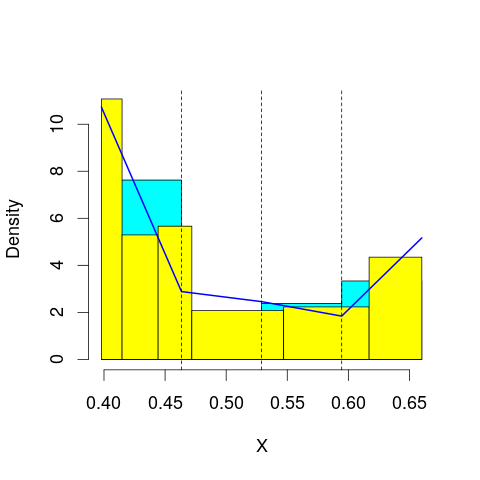

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.58503
mop.approx: Iteration 11. LL = 47.64
mop.approx: Iteration 21. LL = 47.70262
mop.approx: Iteration 31. LL = 47.71478
mop.approx: Iteration 41. LL = 47.71807
mop.approx: Iteration 51. LL = 47.71913
mop.approx: Converged. Iteration 53. LL = 47.71929
[1] "Computing the linear combination of B-splines"


37.3220772939
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.46417
mop.approx: Iteration 11. LL = 47.21982
mop.approx: Iteration 21. LL = 47.25844
mop.approx: Iteration 31. LL = 47.26523
mop.approx: Iteration 41. LL = 47.26681
mop.approx: Converged. Iteration 45. LL = 47.2671
[1] "Computing the linear combination of B-splines"


35.1370242221
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.1866
mop.approx: Iteration 11. LL = 34.7169
mop.approx: Iteration 21. LL = 34.74048
mop.approx: Iteration 31. LL = 34.7459
mop.approx: Iteration 41. LL = 34.74727
mop.approx: Converged. Iteration 46. LL = 34.74754
[1] "Computing the linear combination of B-splines"


20.8845970246
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.686523
mop.approx: Iteration 11. LL = 35.98763
mop.approx: Iteration 21. LL = 36.2848
mop.approx: Iteration 31. LL = 36.32829
mop.approx: Iteration 41. LL = 36.34213
mop.approx: Iteration 51. LL = 36.34733
mop.approx: Iteration 61. LL = 36.3494
mop.approx: Iteration 71. LL = 36.35025
mop.approx: Converged. Iteration 75. LL = 36.35046
[1] "Computing the linear combination of B-splines"


20.754647174
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.741961
mop.approx: Iteration 11. LL = 32.66655
mop.approx: Converged. Iteration 20. LL = 32.66765
[1] "Computing the linear combination of B-splines"


15.3389711538
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.230711
mop.approx: Iteration 11. LL = 33.92589
mop.approx: Iteration 21. LL = 34.12807
mop.approx: Iteration 31. LL = 34.17242
mop.approx: Iteration 41. LL = 34.19038
mop.approx: Iteration 51. LL = 34.19932
mop.approx: Iteration 61. LL = 34.2044
mop.approx: Iteration 71. LL = 34.20755
mop.approx: Iteration 81. LL = 34.20965
mop.approx: Iteration 91. LL = 34.21111
mop.approx: Iteration 101. LL = 34.21218
mop.approx: Iteration 111. LL = 34.21298
mop.approx: Iteration 121. LL = 34.21359
mop.approx: Iteration 131. LL = 34.21408
mop.approx: Iteration 141. LL = 34.21447
mop.approx: Converged. Iteration 142. LL = 34.21454
[1] "Computing the linear combination of B-splines"


15.1529883446
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.933074
mop.approx: Iteration 11. LL = 32.10204
mop.approx: Iteration 21. LL = 32.27812
mop.approx: Iteration 31. LL = 32.33317
mop.approx: Iteration 41. LL = 32.35661
mop.approx: Iteration 51. LL = 32.36861
mop.approx: Iteration 61. LL = 32.37554
mop.approx: Iteration 71. LL = 32.37991
mop.approx: Iteration 81. LL = 32.38284
mop.approx: Iteration 91. LL = 32.38492
mop.approx: Iteration 101. LL = 32.38645
mop.approx: Iteration 111. LL = 32.38761
mop.approx: Iteration 121. LL = 32.38852
mop.approx: Iteration 131. LL = 32.38924
mop.approx: Iteration 141. LL = 32.38983
mop.approx: Iteration 151. LL = 32.39032
mop.approx: Iteration 161. LL = 32.39074
mop.approx: Iteration 171. LL = 32.39109
mop.approx: Converged. Iteration 171. LL = 32.39112
[1] "Computing the linear combination of B-splines"


11.5967030514
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.70635
mop.approx: Iteration 11. LL = 47.83828
mop.approx: Converged. Iteration 14. LL = 47.83867
[1] "Computing the linear combination of B-splines"


37.4414583405
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 37.44145834049489)
m reached
('Sum of Probabilities:', 0.9920554236221837)
chosen


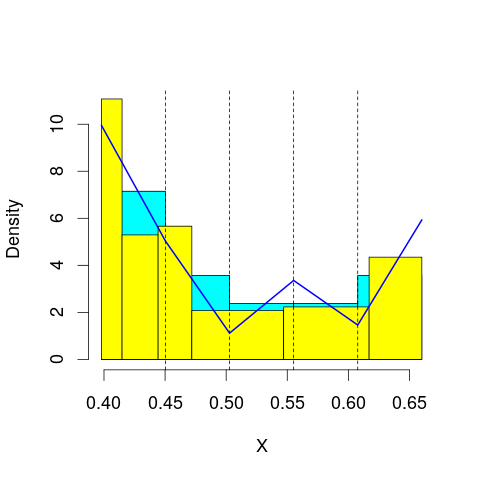

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.58503
mop.approx: Iteration 11. LL = 47.57298
mop.approx: Iteration 21. LL = 47.58324
mop.approx: Converged. Iteration 24. LL = 47.58354
[1] "Computing the linear combination of B-splines"


35.453460153
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.46417
mop.approx: Iteration 11. LL = 47.40195
mop.approx: Iteration 21. LL = 47.47012
mop.approx: Iteration 31. LL = 47.50007
mop.approx: Iteration 41. LL = 47.51566
mop.approx: Iteration 51. LL = 47.52454
mop.approx: Iteration 61. LL = 47.52993
mop.approx: Iteration 71. LL = 47.53337
mop.approx: Iteration 81. LL = 47.53562
mop.approx: Iteration 91. LL = 47.53715
mop.approx: Iteration 101. LL = 47.53819
mop.approx: Iteration 111. LL = 47.53891
mop.approx: Converged. Iteration 117. LL = 47.53928
[1] "Computing the linear combination of B-splines"


33.6763365563
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.1866
mop.approx: Iteration 11. LL = 35.24174
mop.approx: Iteration 21. LL = 35.37371
mop.approx: Iteration 31. LL = 35.41009
mop.approx: Iteration 41. LL = 35.42182
mop.approx: Iteration 51. LL = 35.42587
mop.approx: Iteration 61. LL = 35.42731
mop.approx: Converged. Iteration 69. LL = 35.42779
[1] "Computing the linear combination of B-splines"


19.8319780175
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.686523
mop.approx: Iteration 11. LL = 36.81972
mop.approx: Iteration 21. LL = 36.90995
mop.approx: Iteration 31. LL = 36.93925
mop.approx: Iteration 41. LL = 36.9525
mop.approx: Iteration 51. LL = 36.95947
mop.approx: Iteration 61. LL = 36.96351
mop.approx: Iteration 71. LL = 36.966
mop.approx: Iteration 81. LL = 36.96761
mop.approx: Iteration 91. LL = 36.96868
mop.approx: Iteration 101. LL = 36.9694
mop.approx: Iteration 111. LL = 36.96989
mop.approx: Converged. Iteration 114. LL = 36.97005
[1] "Computing the linear combination of B-splines"


19.6413670438
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.741961
mop.approx: Iteration 11. LL = 35.27362
mop.approx: Iteration 21. LL = 35.95447
mop.approx: Iteration 31. LL = 36.07401
mop.approx: Iteration 41. LL = 36.09966
mop.approx: Iteration 51. LL = 36.10669
mop.approx: Iteration 61. LL = 36.1089
mop.approx: Iteration 71. LL = 36.10962
mop.approx: Converged. Iteration 72. LL = 36.10969
[1] "Computing the linear combination of B-splines"


17.0481462283
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.230711
mop.approx: Iteration 11. LL = 34.22338
mop.approx: Iteration 21. LL = 34.26165
mop.approx: Iteration 31. LL = 34.27672
mop.approx: Iteration 41. LL = 34.28532
mop.approx: Iteration 51. LL = 34.2904
mop.approx: Iteration 61. LL = 34.29348
mop.approx: Iteration 71. LL = 34.29542
mop.approx: Iteration 81. LL = 34.29667
mop.approx: Iteration 91. LL = 34.29748
mop.approx: Iteration 101. LL = 34.29803
mop.approx: Converged. Iteration 108. LL = 34.29834
[1] "Computing the linear combination of B-splines"


13.503921659
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.933074
mop.approx: Iteration 11. LL = 34.51467
mop.approx: Iteration 21. LL = 35.08937
mop.approx: Iteration 31. LL = 35.17634
mop.approx: Iteration 41. LL = 35.19868
mop.approx: Iteration 51. LL = 35.20578
mop.approx: Iteration 61. LL = 35.20816
mop.approx: Iteration 71. LL = 35.20896
mop.approx: Converged. Iteration 73. LL = 35.20908
[1] "Computing the linear combination of B-splines"


12.6817940549
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.70635
mop.approx: Converged. Iteration 10. LL = 47.91301
[1] "Computing the linear combination of B-splines"


35.7829296579
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 35.782929657946582)
m reached
('Sum of Probabilities:', 0.9914895688907394)
chosen


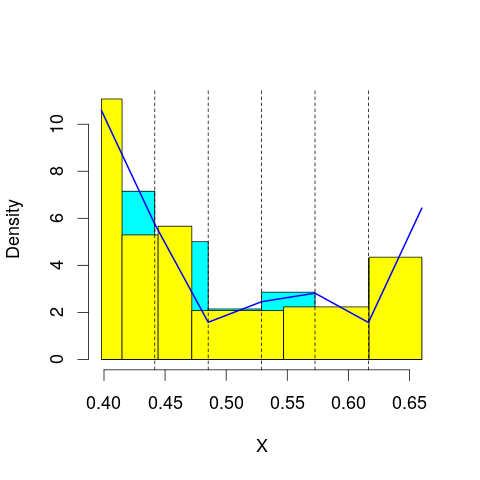

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.58503
mop.approx: Iteration 11. LL = 47.82523
mop.approx: Iteration 21. LL = 47.84424
mop.approx: Iteration 31. LL = 47.84754
mop.approx: Converged. Iteration 38. LL = 47.84816
[1] "Computing the linear combination of B-splines"


33.9852134875
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.46417
mop.approx: Iteration 11. LL = 47.50095
mop.approx: Iteration 21. LL = 47.55023
mop.approx: Iteration 31. LL = 47.5636
mop.approx: Iteration 41. LL = 47.56845
mop.approx: Iteration 51. LL = 47.57064
mop.approx: Iteration 61. LL = 47.57179
mop.approx: Iteration 71. LL = 47.57248
mop.approx: Converged. Iteration 74. LL = 47.57268
[1] "Computing the linear combination of B-splines"


31.976867585
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.1866
mop.approx: Iteration 11. LL = 36.34332
mop.approx: Iteration 21. LL = 36.48511
mop.approx: Iteration 31. LL = 36.5068
mop.approx: Iteration 41. LL = 36.51073
mop.approx: Converged. Iteration 50. LL = 36.51148
[1] "Computing the linear combination of B-splines"


19.1827976454
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.686523
mop.approx: Iteration 11. LL = 36.92279
mop.approx: Iteration 21. LL = 36.93961
mop.approx: Iteration 31. LL = 36.94309
mop.approx: Iteration 41. LL = 36.9447
mop.approx: Iteration 51. LL = 36.94548
mop.approx: Converged. Iteration 56. LL = 36.94574
[1] "Computing the linear combination of B-splines"


17.8841964159
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.741961
mop.approx: Iteration 11. LL = 37.29916
mop.approx: Iteration 21. LL = 37.5936
mop.approx: Iteration 31. LL = 37.62333
mop.approx: Iteration 41. LL = 37.63104
mop.approx: Iteration 51. LL = 37.63337
mop.approx: Iteration 61. LL = 37.63409
mop.approx: Converged. Iteration 61. LL = 37.63413
[1] "Computing the linear combination of B-splines"


16.839711203
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.230711
mop.approx: Iteration 11. LL = 34.94514
mop.approx: Iteration 21. LL = 35.21468
mop.approx: Iteration 31. LL = 35.27885
mop.approx: Iteration 41. LL = 35.29093
mop.approx: Iteration 51. LL = 35.29309
mop.approx: Converged. Iteration 57. LL = 35.29345
[1] "Computing the linear combination of B-splines"


12.7661684445
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.933074
mop.approx: Iteration 11. LL = 35.65061
mop.approx: Iteration 21. LL = 35.77708
mop.approx: Iteration 31. LL = 35.81138
mop.approx: Iteration 41. LL = 35.83105
mop.approx: Iteration 51. LL = 35.84289
mop.approx: Iteration 61. LL = 35.85032
mop.approx: Iteration 71. LL = 35.85516
mop.approx: Iteration 81. LL = 35.85838
mop.approx: Iteration 91. LL = 35.86057
mop.approx: Iteration 101. LL = 35.86208
mop.approx: Iteration 111. LL = 35.86313
mop.approx: Iteration 121. LL = 35.86387
mop.approx: Iteration 131. LL = 35.86439
mop.approx: Converged. Iteration 137. LL = 35.86466
[1] "Computing the linear combination of B-splines"


11.6045088971
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.70635
mop.approx: Iteration 11. LL = 48.1367
mop.approx: Converged. Iteration 12. LL = 48.13679
[1] "Computing the linear combination of B-splines"


34.2738476471
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 34.273847647110131)
m reached
('Sum of Probabilities:', 0.9909968321462264)
chosen


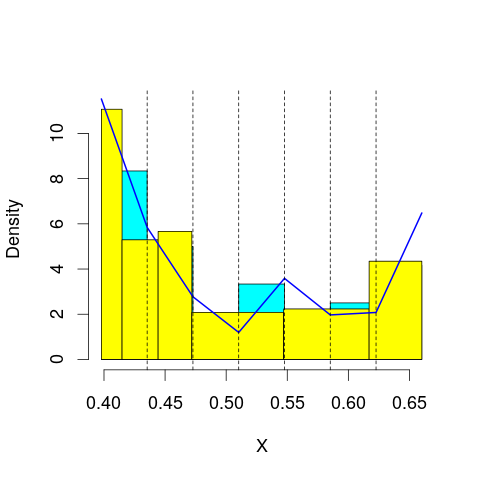

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.58503
mop.approx: Iteration 11. LL = 48.03053
mop.approx: Iteration 21. LL = 48.04436
mop.approx: Converged. Iteration 29. LL = 48.04552
[1] "Computing the linear combination of B-splines"


32.4497067667
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.46417
mop.approx: Iteration 11. LL = 47.52362
mop.approx: Iteration 21. LL = 47.53422
mop.approx: Iteration 31. LL = 47.53633
mop.approx: Iteration 41. LL = 47.53726
mop.approx: Converged. Iteration 45. LL = 47.53753
[1] "Computing the linear combination of B-splines"


30.2088532516
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.1866
mop.approx: Iteration 11. LL = 38.12237
mop.approx: Iteration 21. LL = 38.46171
mop.approx: Iteration 31. LL = 38.52951
mop.approx: Iteration 41. LL = 38.55092
mop.approx: Iteration 51. LL = 38.55935
mop.approx: Iteration 61. LL = 38.56302
mop.approx: Iteration 71. LL = 38.56472
mop.approx: Iteration 81. LL = 38.56555
mop.approx: Converged. Iteration 87. LL = 38.56587
[1] "Computing the linear combination of B-splines"


19.5043241921
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.686523
mop.approx: Iteration 11. LL = 37.05304
mop.approx: Iteration 21. LL = 37.11685
mop.approx: Iteration 31. LL = 37.13902
mop.approx: Iteration 41. LL = 37.14678
mop.approx: Iteration 51. LL = 37.14949
mop.approx: Iteration 61. LL = 37.15044
mop.approx: Converged. Iteration 64. LL = 37.15061
[1] "Computing the linear combination of B-splines"


16.3561955531
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.741961
mop.approx: Iteration 11. LL = 38.15181
mop.approx: Iteration 21. LL = 38.32602
mop.approx: Iteration 31. LL = 38.37093
mop.approx: Iteration 41. LL = 38.38552
mop.approx: Iteration 51. LL = 38.39003
mop.approx: Iteration 61. LL = 38.39137
mop.approx: Converged. Iteration 66. LL = 38.39166
[1] "Computing the linear combination of B-splines"


15.8643809328
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.230711
mop.approx: Iteration 11. LL = 36.26488
mop.approx: Iteration 21. LL = 36.74865
mop.approx: Iteration 31. LL = 36.87449
mop.approx: Iteration 41. LL = 36.91466
mop.approx: Iteration 51. LL = 36.93001
mop.approx: Iteration 61. LL = 36.93691
mop.approx: Iteration 71. LL = 36.94042
mop.approx: Iteration 81. LL = 36.94236
mop.approx: Iteration 91. LL = 36.94347
mop.approx: Iteration 101. LL = 36.94412
mop.approx: Converged. Iteration 107. LL = 36.94442
[1] "Computing the linear combination of B-splines"


12.6842649923
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.933074
mop.approx: Iteration 11. LL = 35.87771
mop.approx: Iteration 21. LL = 35.95784
mop.approx: Iteration 31. LL = 35.98214
mop.approx: Iteration 41. LL = 35.9947
mop.approx: Iteration 51. LL = 36.00209
mop.approx: Iteration 61. LL = 36.00653
mop.approx: Iteration 71. LL = 36.0092
mop.approx: Iteration 81. LL = 36.01082
mop.approx: Iteration 91. LL = 36.01179
mop.approx: Iteration 101. LL = 36.01238
mop.approx: Converged. Iteration 106. LL = 36.01261
[1] "Computing the linear combination of B-splines"


10.0195945215
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.70635
mop.approx: Iteration 11. LL = 48.19566
mop.approx: Converged. Iteration 14. LL = 48.19601
[1] "Computing the linear combination of B-splines"


32.6002009785
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 32.600200978517378)
m reached
('Sum of Probabilities:', 0.9900755661315055)
chosen


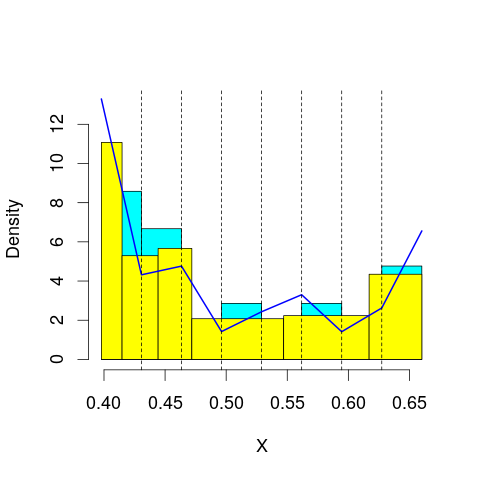

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.58503
mop.approx: Iteration 11. LL = 48.052
mop.approx: Iteration 21. LL = 48.05851
mop.approx: Converged. Iteration 24. LL = 48.05878
[1] "Computing the linear combination of B-splines"


30.7301018345
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.46417
mop.approx: Iteration 11. LL = 47.56475
mop.approx: Iteration 21. LL = 47.59299
mop.approx: Iteration 31. LL = 47.60347
mop.approx: Iteration 41. LL = 47.60814
mop.approx: Iteration 51. LL = 47.61052
mop.approx: Iteration 61. LL = 47.61188
mop.approx: Iteration 71. LL = 47.61272
mop.approx: Converged. Iteration 80. LL = 47.61328
[1] "Computing the linear combination of B-splines"


28.5517330002
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.1866
mop.approx: Iteration 11. LL = 39.78005
mop.approx: Iteration 21. LL = 40.09756
mop.approx: Iteration 31. LL = 40.14066
mop.approx: Iteration 41. LL = 40.1515
mop.approx: Iteration 51. LL = 40.15564
mop.approx: Iteration 61. LL = 40.15763
mop.approx: Iteration 71. LL = 40.15871
mop.approx: Iteration 81. LL = 40.15934
mop.approx: Converged. Iteration 85. LL = 40.15956
[1] "Computing the linear combination of B-splines"


19.365145055
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.686523
mop.approx: Iteration 11. LL = 37.43772
mop.approx: Iteration 21. LL = 37.49967
mop.approx: Iteration 31. LL = 37.50823
mop.approx: Iteration 41. LL = 37.50941
mop.approx: Converged. Iteration 41. LL = 37.50945
[1] "Computing the linear combination of B-splines"


14.9821649842
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.741961
mop.approx: Iteration 11. LL = 38.58684
mop.approx: Iteration 21. LL = 38.70667
mop.approx: Iteration 31. LL = 38.73334
mop.approx: Iteration 41. LL = 38.74425
mop.approx: Iteration 51. LL = 38.75028
mop.approx: Iteration 61. LL = 38.75414
mop.approx: Iteration 71. LL = 38.75679
mop.approx: Iteration 81. LL = 38.75867
mop.approx: Iteration 91. LL = 38.76003
mop.approx: Iteration 101. LL = 38.76103
mop.approx: Iteration 111. LL = 38.76176
mop.approx: Iteration 121. LL = 38.7623
mop.approx: Converged. Iteration 127. LL = 38.76259
[1] "Computing the linear combination of B-splines"


14.5024351592
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.230711
mop.approx: Iteration 11. LL = 37.75884
mop.approx: Iteration 21. LL = 38.24564
mop.approx: Iteration 31. LL = 38.3148
mop.approx: Iteration 41. LL = 38.32547
mop.approx: Iteration 51. LL = 38.32754
mop.approx: Converged. Iteration 58. LL = 38.32801
[1] "Computing the linear combination of B-splines"


12.3349935242
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.933074
mop.approx: Iteration 11. LL = 36.13987
mop.approx: Iteration 21. LL = 36.23466
mop.approx: Iteration 31. LL = 36.26043
mop.approx: Iteration 41. LL = 36.26804
mop.approx: Iteration 51. LL = 36.2704
mop.approx: Iteration 61. LL = 36.27117
mop.approx: Converged. Iteration 62. LL = 36.27125
[1] "Computing the linear combination of B-splines"


8.54535929933
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.70635
mop.approx: Iteration 11. LL = 48.81387
mop.approx: Converged. Iteration 17. LL = 48.81598
[1] "Computing the linear combination of B-splines"


31.4872981303
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 31.487298130341518)
m reached
('Sum of Probabilities:', 0.9887425436224727)
chosen


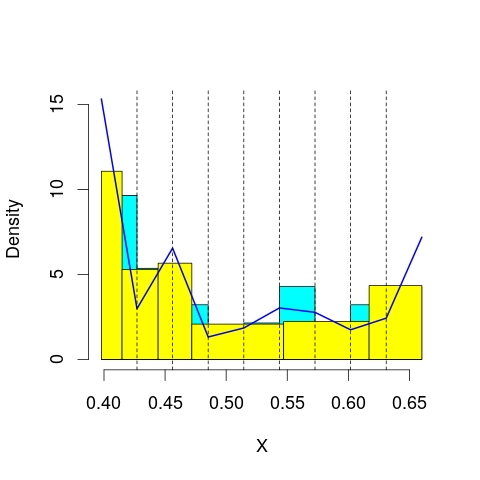

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.58503
mop.approx: Iteration 11. LL = 48.01315
mop.approx: Iteration 21. LL = 48.03081
mop.approx: Iteration 31. LL = 48.03473
mop.approx: Iteration 41. LL = 48.03586
mop.approx: Converged. Iteration 43. LL = 48.03602
[1] "Computing the linear combination of B-splines"


28.9744695288
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.46417
mop.approx: Iteration 11. LL = 47.81192
mop.approx: Iteration 21. LL = 47.88677
mop.approx: Iteration 31. LL = 47.9151
mop.approx: Iteration 41. LL = 47.92849
mop.approx: Iteration 51. LL = 47.93578
mop.approx: Iteration 61. LL = 47.94016
mop.approx: Iteration 71. LL = 47.94299
mop.approx: Iteration 81. LL = 47.94493
mop.approx: Iteration 91. LL = 47.94632
mop.approx: Iteration 101. LL = 47.94735
mop.approx: Iteration 111. LL = 47.94813
mop.approx: Iteration 121. LL = 47.94874
mop.approx: Converged. Iteration 126. LL = 47.94904
[1] "Computing the linear combination of B-splines"


27.1546221473
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.1866
mop.approx: Iteration 11. LL = 40.69407
mop.approx: Iteration 21. LL = 40.8959
mop.approx: Iteration 31. LL = 40.93898
mop.approx: Iteration 41. LL = 40.95613
mop.approx: Iteration 51. LL = 40.96378
mop.approx: Iteration 61. LL = 40.96753
mop.approx: Iteration 71. LL = 40.96953
mop.approx: Iteration 81. LL = 40.97067
mop.approx: Iteration 91. LL = 40.97135
mop.approx: Converged. Iteration 96. LL = 40.97162
[1] "Computing the linear combination of B-splines"


18.4443377583
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.686523
mop.approx: Iteration 11. LL = 38.13989
mop.approx: Iteration 21. LL = 38.25127
mop.approx: Iteration 31. LL = 38.27587
mop.approx: Iteration 41. LL = 38.28432
mop.approx: Iteration 51. LL = 38.28809
mop.approx: Iteration 61. LL = 38.29008
mop.approx: Iteration 71. LL = 38.29126
mop.approx: Iteration 81. LL = 38.29201
mop.approx: Iteration 91. LL = 38.29252
mop.approx: Converged. Iteration 94. LL = 38.29268
[1] "Computing the linear combination of B-splines"


14.0325250484
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.741961
mop.approx: Iteration 11. LL = 38.67999
mop.approx: Iteration 21. LL = 38.73676
mop.approx: Iteration 31. LL = 38.75201
mop.approx: Iteration 41. LL = 38.75829
mop.approx: Iteration 51. LL = 38.76122
mop.approx: Iteration 61. LL = 38.76269
mop.approx: Iteration 71. LL = 38.76347
mop.approx: Converged. Iteration 78. LL = 38.76383
[1] "Computing the linear combination of B-splines"


12.7708135657
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.230711
mop.approx: Iteration 11. LL = 39.04032
mop.approx: Iteration 21. LL = 39.44205
mop.approx: Iteration 31. LL = 39.50957
mop.approx: Iteration 41. LL = 39.53324
mop.approx: Iteration 51. LL = 39.54382
mop.approx: Iteration 61. LL = 39.54906
mop.approx: Iteration 71. LL = 39.5518
mop.approx: Iteration 81. LL = 39.5533
mop.approx: Iteration 91. LL = 39.55416
mop.approx: Iteration 101. LL = 39.55466
mop.approx: Converged. Iteration 101. LL = 39.5547
[1] "Computing the linear combination of B-splines"


11.8288103565
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.933074
mop.approx: Iteration 11. LL = 36.8511
mop.approx: Iteration 21. LL = 37.07342
mop.approx: Iteration 31. LL = 37.12448
mop.approx: Iteration 41. LL = 37.1421
mop.approx: Iteration 51. LL = 37.15114
mop.approx: Iteration 61. LL = 37.15674
mop.approx: Iteration 71. LL = 37.16053
mop.approx: Iteration 81. LL = 37.16322
mop.approx: Iteration 91. LL = 37.16519
mop.approx: Iteration 101. LL = 37.16667
mop.approx: Iteration 111. LL = 37.16782
mop.approx: Iteration 121. LL = 37.16871
mop.approx: Iteration 131. LL = 37.16942
mop.approx: Iteration 141. LL = 37.16999
mop.approx: Iteration 151. LL = 37.17046
mop.approx: Converged. Iteration 158. LL = 37.17078
[1] "Computing the linear combination of B-splines"


7.71202404229
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.70635
mop.approx: Iteration 11. LL = 48.96623
mop.approx: Converged. Iteration 15. LL = 48.96699
[1] "Computing the linear combination of B-splines"


29.9054475332
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 29.905447533174538)
m reached
('Sum of Probabilities:', 0.9883045531191901)
chosen


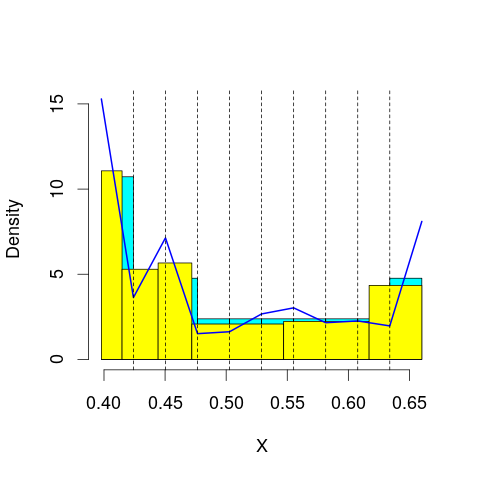

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.58503
mop.approx: Iteration 11. LL = 48.00622
mop.approx: Iteration 21. LL = 48.02434
mop.approx: Iteration 31. LL = 48.02782
mop.approx: Iteration 41. LL = 48.02874
mop.approx: Converged. Iteration 41. LL = 48.02878
[1] "Computing the linear combination of B-splines"


27.2343643798
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.46417
mop.approx: Iteration 11. LL = 48.02137
mop.approx: Iteration 21. LL = 48.13243
mop.approx: Iteration 31. LL = 48.1722
mop.approx: Iteration 41. LL = 48.1895
mop.approx: Iteration 51. LL = 48.19776
mop.approx: Iteration 61. LL = 48.2019
mop.approx: Iteration 71. LL = 48.20405
mop.approx: Iteration 81. LL = 48.20518
mop.approx: Converged. Iteration 89. LL = 48.20574
[1] "Computing the linear combination of B-splines"


25.6784533492
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.1866
mop.approx: Iteration 11. LL = 41.15193
mop.approx: Iteration 21. LL = 41.25304
mop.approx: Iteration 31. LL = 41.26577
mop.approx: Iteration 41. LL = 41.26867
mop.approx: Converged. Iteration 50. LL = 41.2694
[1] "Computing the linear combination of B-splines"


17.0092477756
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.686523
mop.approx: Iteration 11. LL = 38.88399
mop.approx: Iteration 21. LL = 39.07983
mop.approx: Iteration 31. LL = 39.13667
mop.approx: Iteration 41. LL = 39.15548
mop.approx: Iteration 51. LL = 39.1619
mop.approx: Iteration 61. LL = 39.16425
mop.approx: Iteration 71. LL = 39.16517
mop.approx: Converged. Iteration 75. LL = 39.16539
[1] "Computing the linear combination of B-splines"


13.1723715784
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.741961
mop.approx: Iteration 11. LL = 38.80835
mop.approx: Iteration 21. LL = 38.83993
mop.approx: Iteration 31. LL = 38.8467
mop.approx: Iteration 41. LL = 38.84956
mop.approx: Iteration 51. LL = 38.85103
mop.approx: Iteration 61. LL = 38.8518
mop.approx: Converged. Iteration 66. LL = 38.85208
[1] "Computing the linear combination of B-splines"


11.1261898434
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.230711
mop.approx: Iteration 11. LL = 39.58648
mop.approx: Iteration 21. LL = 39.7607
mop.approx: Iteration 31. LL = 39.78426
mop.approx: Iteration 41. LL = 39.79449
mop.approx: Iteration 51. LL = 39.80066
mop.approx: Iteration 61. LL = 39.80487
mop.approx: Iteration 71. LL = 39.8079
mop.approx: Iteration 81. LL = 39.81016
mop.approx: Iteration 91. LL = 39.81186
mop.approx: Iteration 101. LL = 39.81317
mop.approx: Iteration 111. LL = 39.8142
mop.approx: Iteration 121. LL = 39.815
mop.approx: Iteration 131. LL = 39.81565
mop.approx: Iteration 141. LL = 39.81618
mop.approx: Converged. Iteration 150. LL = 39.81661
[1] "Computing the linear combination of B-splines"


10.3578585607
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.933074
mop.approx: Iteration 11. LL = 38.11618
mop.approx: Iteration 21. LL = 38.69729
mop.approx: Iteration 31. LL = 38.87048
mop.approx: Iteration 41. LL = 38.93202
mop.approx: Iteration 51. LL = 38.9554
mop.approx: Iteration 61. LL = 38.96457
mop.approx: Iteration 71. LL = 38.96828
mop.approx: Iteration 81. LL = 38.96984
mop.approx: Iteration 91. LL = 38.97051
mop.approx: Converged. Iteration 92. LL = 38.97059
[1] "Computing the linear combination of B-splines"


7.77895212868
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.70635
mop.approx: Iteration 11. LL = 48.73288
mop.approx: Iteration 21. LL = 48.74029
mop.approx: Converged. Iteration 23. LL = 48.74048
[1] "Computing the linear combination of B-splines"


27.9460629518
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 27.946062951805636)
m reached
('Sum of Probabilities:', 0.9884824450941059)
chosen


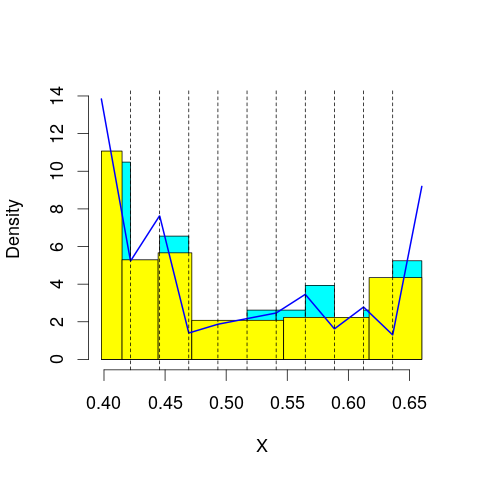

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.58503
mop.approx: Iteration 11. LL = 48.54553
mop.approx: Iteration 21. LL = 48.58423
mop.approx: Iteration 31. LL = 48.58955
mop.approx: Converged. Iteration 40. LL = 48.59056
[1] "Computing the linear combination of B-splines"


26.0632798541
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.46417
mop.approx: Iteration 11. LL = 48.04714
mop.approx: Iteration 21. LL = 48.17425
mop.approx: Iteration 31. LL = 48.21808
mop.approx: Iteration 41. LL = 48.23634
mop.approx: Iteration 51. LL = 48.24475
mop.approx: Iteration 61. LL = 48.24885
mop.approx: Iteration 71. LL = 48.25092
mop.approx: Iteration 81. LL = 48.252
mop.approx: Converged. Iteration 89. LL = 48.25254
[1] "Computing the linear combination of B-splines"


23.9923921394
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.1866
mop.approx: Iteration 11. LL = 41.37959
mop.approx: Iteration 21. LL = 41.43092
mop.approx: Iteration 31. LL = 41.43945
mop.approx: Iteration 41. LL = 41.44214
mop.approx: Iteration 51. LL = 41.44308
mop.approx: Converged. Iteration 54. LL = 41.44325
[1] "Computing the linear combination of B-splines"


15.4502329675
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.686523
mop.approx: Iteration 11. LL = 39.66623
mop.approx: Iteration 21. LL = 39.99948
mop.approx: Iteration 31. LL = 40.08343
mop.approx: Iteration 41. LL = 40.10629
mop.approx: Iteration 51. LL = 40.11298
mop.approx: Iteration 61. LL = 40.11508
mop.approx: Iteration 71. LL = 40.11579
mop.approx: Converged. Iteration 71. LL = 40.11583
[1] "Computing the linear combination of B-splines"


12.3899379601
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.741961
mop.approx: Iteration 11. LL = 38.98244
mop.approx: Iteration 21. LL = 39.01445
mop.approx: Iteration 31. LL = 39.02921
mop.approx: Iteration 41. LL = 39.03745
mop.approx: Iteration 51. LL = 39.04184
mop.approx: Iteration 61. LL = 39.04416
mop.approx: Iteration 71. LL = 39.04541
mop.approx: Iteration 81. LL = 39.04611
mop.approx: Converged. Iteration 87. LL = 39.04643
[1] "Computing the linear combination of B-splines"


9.58767549518
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.230711
mop.approx: Iteration 11. LL = 39.77098
mop.approx: Iteration 21. LL = 39.84751
mop.approx: Iteration 31. LL = 39.86587
mop.approx: Iteration 41. LL = 39.87607
mop.approx: Iteration 51. LL = 39.88226
mop.approx: Iteration 61. LL = 39.88617
mop.approx: Iteration 71. LL = 39.88872
mop.approx: Iteration 81. LL = 39.89042
mop.approx: Iteration 91. LL = 39.89158
mop.approx: Iteration 101. LL = 39.8924
mop.approx: Iteration 111. LL = 39.89298
mop.approx: Converged. Iteration 119. LL = 39.89338
[1] "Computing the linear combination of B-splines"


8.70175828203
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.933074
mop.approx: Iteration 11. LL = 39.22115
mop.approx: Iteration 21. LL = 39.75686
mop.approx: Iteration 31. LL = 39.84532
mop.approx: Iteration 41. LL = 39.86501
mop.approx: Iteration 51. LL = 39.87054
mop.approx: Iteration 61. LL = 39.87233
mop.approx: Converged. Iteration 70. LL = 39.87294
[1] "Computing the linear combination of B-splines"


6.94845780801
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.70635
mop.approx: Iteration 11. LL = 49.04721
mop.approx: Iteration 21. LL = 49.10485
mop.approx: Iteration 31. LL = 49.11744
mop.approx: Iteration 41. LL = 49.12112
mop.approx: Iteration 51. LL = 49.12232
mop.approx: Converged. Iteration 54. LL = 49.12255
[1] "Computing the linear combination of B-splines"


26.595261936
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 26.595261935985217)
m reached
('Sum of Probabilities:', 0.9881339059044506)
chosen


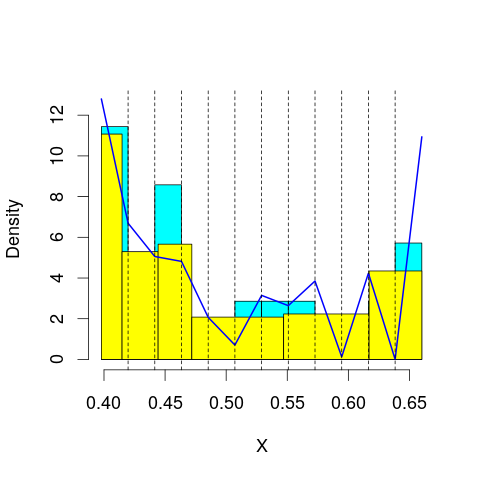

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.58503
mop.approx: Iteration 11. LL = 48.94821
mop.approx: Iteration 21. LL = 49.00407
mop.approx: Iteration 31. LL = 49.01513
mop.approx: Iteration 41. LL = 49.0189
mop.approx: Iteration 51. LL = 49.02059
mop.approx: Iteration 61. LL = 49.02149
mop.approx: Converged. Iteration 68. LL = 49.02194
[1] "Computing the linear combination of B-splines"


24.7617887759
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.46417
mop.approx: Iteration 11. LL = 47.9999
mop.approx: Iteration 21. LL = 48.10036
mop.approx: Iteration 31. LL = 48.13455
mop.approx: Iteration 41. LL = 48.14859
mop.approx: Iteration 51. LL = 48.15507
mop.approx: Iteration 61. LL = 48.15834
mop.approx: Iteration 71. LL = 48.16013
mop.approx: Iteration 81. LL = 48.16117
mop.approx: Iteration 91. LL = 48.16181
mop.approx: Converged. Iteration 92. LL = 48.1619
[1] "Computing the linear combination of B-splines"


22.168884279
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.1866
mop.approx: Iteration 11. LL = 41.52924
mop.approx: Iteration 21. LL = 41.55702
mop.approx: Iteration 31. LL = 41.56467
mop.approx: Iteration 41. LL = 41.56883
mop.approx: Iteration 51. LL = 41.57134
mop.approx: Iteration 61. LL = 41.57294
mop.approx: Iteration 71. LL = 41.57398
mop.approx: Iteration 81. LL = 41.57469
mop.approx: Converged. Iteration 90. LL = 41.57517
[1] "Computing the linear combination of B-splines"


13.849284217
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.686523
mop.approx: Iteration 11. LL = 40.32267
mop.approx: Iteration 21. LL = 40.67692
mop.approx: Iteration 31. LL = 40.74319
mop.approx: Iteration 41. LL = 40.76276
mop.approx: Iteration 51. LL = 40.77147
mop.approx: Iteration 61. LL = 40.7762
mop.approx: Iteration 71. LL = 40.77897
mop.approx: Iteration 81. LL = 40.78062
mop.approx: Iteration 91. LL = 40.78162
mop.approx: Iteration 101. LL = 40.78223
mop.approx: Converged. Iteration 104. LL = 40.7824
[1] "Computing the linear combination of B-splines"


11.3236448764
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.741961
mop.approx: Iteration 11. LL = 39.21867
mop.approx: Iteration 21. LL = 39.29439
mop.approx: Iteration 31. LL = 39.3263
mop.approx: Iteration 41. LL = 39.34069
mop.approx: Iteration 51. LL = 39.34766
mop.approx: Iteration 61. LL = 39.35134
mop.approx: Iteration 71. LL = 39.35344
mop.approx: Iteration 81. LL = 39.35469
mop.approx: Iteration 91. LL = 39.35546
mop.approx: Converged. Iteration 100. LL = 39.35594
[1] "Computing the linear combination of B-splines"


8.16431512066
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.230711
mop.approx: Iteration 11. LL = 39.85269
mop.approx: Iteration 21. LL = 39.89836
mop.approx: Iteration 31. LL = 39.91405
mop.approx: Iteration 41. LL = 39.92302
mop.approx: Iteration 51. LL = 39.92855
mop.approx: Iteration 61. LL = 39.93212
mop.approx: Iteration 71. LL = 39.9345
mop.approx: Iteration 81. LL = 39.93612
mop.approx: Iteration 91. LL = 39.93724
mop.approx: Iteration 101. LL = 39.93803
mop.approx: Iteration 111. LL = 39.93859
mop.approx: Converged. Iteration 116. LL = 39.93885
[1] "Computing the linear combination of B-splines"


7.01436188938
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.933074
mop.approx: Iteration 11. LL = 39.91588
mop.approx: Iteration 21. LL = 40.26917
mop.approx: Iteration 31. LL = 40.32636
mop.approx: Iteration 41. LL = 40.34808
mop.approx: Iteration 51. LL = 40.35779
mop.approx: Iteration 61. LL = 40.36244
mop.approx: Iteration 71. LL = 40.36483
mop.approx: Iteration 81. LL = 40.36613
mop.approx: Iteration 91. LL = 40.36686
mop.approx: Converged. Iteration 97. LL = 40.36719
[1] "Computing the linear combination of B-splines"


5.70982193811
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.70635
mop.approx: Iteration 11. LL = 49.55515
mop.approx: Iteration 21. LL = 49.59737
mop.approx: Iteration 31. LL = 49.60142
mop.approx: Converged. Iteration 34. LL = 49.60169
[1] "Computing the linear combination of B-splines"


25.3415410833
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 25.341541083302289)
m reached
('Sum of Probabilities:', 0.9880908194145106)
chosen


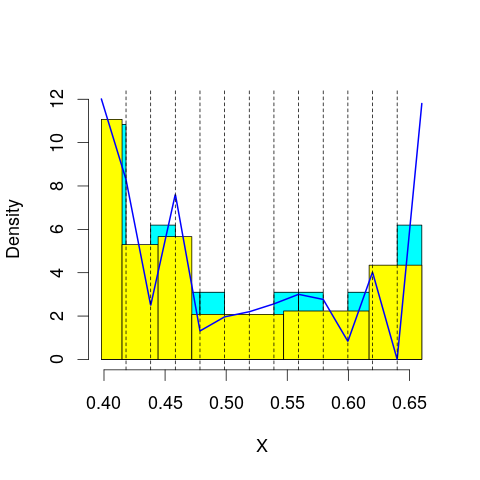

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.58503
mop.approx: Iteration 11. LL = 49.12335
mop.approx: Iteration 21. LL = 49.26988
mop.approx: Iteration 31. LL = 49.30623
mop.approx: Iteration 41. LL = 49.31761
mop.approx: Iteration 51. LL = 49.32169
mop.approx: Iteration 61. LL = 49.32335
mop.approx: Iteration 71. LL = 49.32411
mop.approx: Converged. Iteration 72. LL = 49.32421
[1] "Computing the linear combination of B-splines"


23.3311906122
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.46417
mop.approx: Iteration 11. LL = 48.32179
mop.approx: Iteration 21. LL = 48.42896
mop.approx: Iteration 31. LL = 48.45843
mop.approx: Iteration 41. LL = 48.46856
mop.approx: Iteration 51. LL = 48.47287
mop.approx: Iteration 61. LL = 48.47503
mop.approx: Iteration 71. LL = 48.47626
mop.approx: Iteration 81. LL = 48.477
mop.approx: Converged. Iteration 85. LL = 48.47726
[1] "Computing the linear combination of B-splines"


20.7513722065
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.1866
mop.approx: Iteration 11. LL = 41.61369
mop.approx: Iteration 21. LL = 41.62802
mop.approx: Iteration 31. LL = 41.63475
mop.approx: Iteration 41. LL = 41.63939
mop.approx: Iteration 51. LL = 41.64268
mop.approx: Iteration 61. LL = 41.64507
mop.approx: Iteration 71. LL = 41.64685
mop.approx: Iteration 81. LL = 41.64821
mop.approx: Iteration 91. LL = 41.64926
mop.approx: Iteration 101. LL = 41.65008
mop.approx: Iteration 111. LL = 41.65074
mop.approx: Iteration 121. LL = 41.65126
mop.approx: Converged. Iteration 128. LL = 41.65162
[1] "Computing the linear combination of B-splines"


12.1928621461
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.686523
mop.approx: Iteration 11. LL = 40.78908
mop.approx: Iteration 21. LL = 41.06163
mop.approx: Iteration 31. LL = 41.08803
mop.approx: Iteration 41. LL = 41.09153
mop.approx: Converged. Iteration 48. LL = 41.09209
[1] "Computing the linear combination of B-splines"


9.90046522821
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.741961
mop.approx: Iteration 11. LL = 39.49077
mop.approx: Iteration 21. LL = 39.60877
mop.approx: Iteration 31. LL = 39.64685
mop.approx: Iteration 41. LL = 39.66124
mop.approx: Iteration 51. LL = 39.66706
mop.approx: Iteration 61. LL = 39.66955
mop.approx: Iteration 71. LL = 39.67072
mop.approx: Iteration 81. LL = 39.67133
mop.approx: Converged. Iteration 84. LL = 39.67149
[1] "Computing the linear combination of B-splines"


6.74700234074
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.230711
mop.approx: Iteration 11. LL = 39.92971
mop.approx: Iteration 21. LL = 39.96721
mop.approx: Iteration 31. LL = 39.97993
mop.approx: Iteration 41. LL = 39.98601
mop.approx: Iteration 51. LL = 39.98919
mop.approx: Iteration 61. LL = 39.99096
mop.approx: Iteration 71. LL = 39.99196
mop.approx: Iteration 81. LL = 39.99256
mop.approx: Converged. Iteration 83. LL = 39.99268
[1] "Computing the linear combination of B-splines"


5.33532173767
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.933074
mop.approx: Iteration 11. LL = 40.30053
mop.approx: Iteration 21. LL = 40.52297
mop.approx: Iteration 31. LL = 40.55614
mop.approx: Iteration 41. LL = 40.56655
mop.approx: Iteration 51. LL = 40.5704
mop.approx: Iteration 61. LL = 40.57203
mop.approx: Iteration 71. LL = 40.57282
mop.approx: Converged. Iteration 77. LL = 40.57315
[1] "Computing the linear combination of B-splines"


4.18285362618
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.70635
mop.approx: Iteration 11. LL = 50.64857
mop.approx: Iteration 21. LL = 50.71885
mop.approx: Iteration 31. LL = 50.72876
mop.approx: Iteration 41. LL = 50.7309
mop.approx: Converged. Iteration 48. LL = 50.73145
[1] "Computing the linear combination of B-splines"


24.7384259587
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 24.73842595865932)
m reached
('Sum of Probabilities:', 0.9879706469943762)
chosen


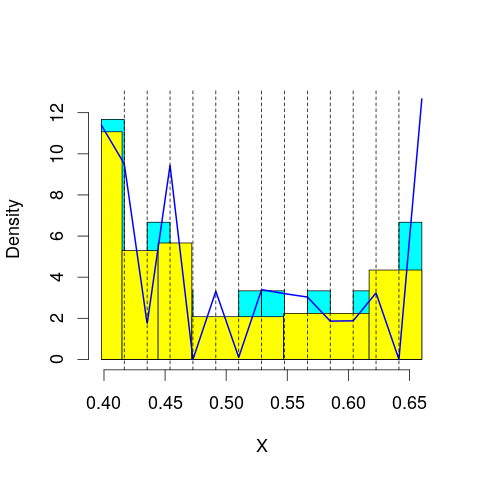

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.58503
mop.approx: Iteration 11. LL = 48.74523
mop.approx: Iteration 21. LL = 48.84542
mop.approx: Iteration 31. LL = 48.87316
mop.approx: Iteration 41. LL = 48.88259
mop.approx: Iteration 51. LL = 48.8862
mop.approx: Iteration 61. LL = 48.8878
mop.approx: Iteration 71. LL = 48.88862
mop.approx: Converged. Iteration 75. LL = 48.88889
[1] "Computing the linear combination of B-splines"


21.1630049395
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.46417
mop.approx: Iteration 11. LL = 48.97767
mop.approx: Iteration 21. LL = 49.17539
mop.approx: Iteration 31. LL = 49.21884
mop.approx: Iteration 41. LL = 49.23076
mop.approx: Iteration 51. LL = 49.23499
mop.approx: Iteration 61. LL = 49.2368
mop.approx: Iteration 71. LL = 49.23769
mop.approx: Converged. Iteration 75. LL = 49.23797
[1] "Computing the linear combination of B-splines"


19.7792111673
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.1866
mop.approx: Iteration 11. LL = 41.72201
mop.approx: Iteration 21. LL = 41.74273
mop.approx: Iteration 31. LL = 41.7527
mop.approx: Iteration 41. LL = 41.7585
mop.approx: Iteration 51. LL = 41.76217
mop.approx: Iteration 61. LL = 41.76465
mop.approx: Iteration 71. LL = 41.76639
mop.approx: Iteration 81. LL = 41.76765
mop.approx: Iteration 91. LL = 41.76858
mop.approx: Iteration 101. LL = 41.76929
mop.approx: Iteration 111. LL = 41.76982
mop.approx: Converged. Iteration 115. LL = 41.77004
[1] "Computing the linear combination of B-splines"


10.5784212121
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.686523
mop.approx: Iteration 11. LL = 41.15339
mop.approx: Iteration 21. LL = 41.36292
mop.approx: Iteration 31. LL = 41.39067
mop.approx: Iteration 41. LL = 41.40322
mop.approx: Iteration 51. LL = 41.41126
mop.approx: Iteration 61. LL = 41.41676
mop.approx: Iteration 71. LL = 41.42059
mop.approx: Iteration 81. LL = 41.42328
mop.approx: Iteration 91. LL = 41.42517
mop.approx: Iteration 101. LL = 41.42649
mop.approx: Iteration 111. LL = 41.42742
mop.approx: Iteration 121. LL = 41.42807
mop.approx: Converged. Iteration 128. LL = 41.42844
[1] "Computing the linear combination of B-splines"


8.50395229965
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.741961
mop.approx: Iteration 11. LL = 39.73755
mop.approx: Iteration 21. LL = 39.89308
mop.approx: Iteration 31. LL = 39.93913
mop.approx: Iteration 41. LL = 39.95767
mop.approx: Iteration 51. LL = 39.96607
mop.approx: Iteration 61. LL = 39.97
mop.approx: Iteration 71. LL = 39.97186
mop.approx: Iteration 81. LL = 39.97276
mop.approx: Converged. Iteration 87. LL = 39.9731
[1] "Computing the linear combination of B-splines"


5.31574083855
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.230711
mop.approx: Iteration 11. LL = 40.01649
mop.approx: Iteration 21. LL = 40.05703
mop.approx: Iteration 31. LL = 40.07327
mop.approx: Iteration 41. LL = 40.08271
mop.approx: Iteration 51. LL = 40.08887
mop.approx: Iteration 61. LL = 40.09314
mop.approx: Iteration 71. LL = 40.09622
mop.approx: Iteration 81. LL = 40.09854
mop.approx: Iteration 91. LL = 40.10033
mop.approx: Iteration 101. LL = 40.10175
mop.approx: Iteration 111. LL = 40.10291
mop.approx: Iteration 121. LL = 40.10387
mop.approx: Iteration 131. LL = 40.10467
mop.approx: Iteration 141. LL = 40.10535
mop.approx: Iteration 151. LL = 40.10593
mop.approx: Iteration 161. LL = 40.10642
mop.approx: Converged. Iteration 170. LL = 40.10684
[1] "Computing the linear combination of B-splines"


3.71660527021
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.933074
mop.approx: Iteration 11. LL = 40.50966
mop.approx: Iteration 21. LL = 40.64122
mop.approx: Iteration 31. LL = 40.6595
mop.approx: Iteration 41. LL = 40.66633
mop.approx: Iteration 51. LL = 40.66957
mop.approx: Iteration 61. LL = 40.67132
mop.approx: Iteration 71. LL = 40.67238
mop.approx: Iteration 81. LL = 40.67307
mop.approx: Iteration 91. LL = 40.67358
mop.approx: Converged. Iteration 94. LL = 40.67374
[1] "Computing the linear combination of B-splines"


2.5506616747
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.70635
mop.approx: Iteration 11. LL = 50.4617
mop.approx: Iteration 21. LL = 50.52914
mop.approx: Iteration 31. LL = 50.54001
mop.approx: Iteration 41. LL = 50.54283
mop.approx: Converged. Iteration 49. LL = 50.54361
[1] "Computing the linear combination of B-splines"


22.8177186403
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 22.817718640282568)
m reached
('Sum of Probabilities:', 0.9877338830619168)
chosen


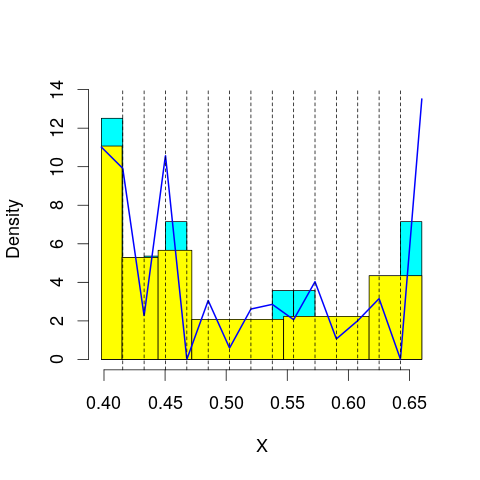

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.58503
mop.approx: Iteration 11. LL = 48.93959
mop.approx: Iteration 21. LL = 49.00796
mop.approx: Iteration 31. LL = 49.02682
mop.approx: Iteration 41. LL = 49.03424
mop.approx: Iteration 51. LL = 49.0377
mop.approx: Iteration 61. LL = 49.03944
mop.approx: Iteration 71. LL = 49.04037
mop.approx: Converged. Iteration 76. LL = 49.04071
[1] "Computing the linear combination of B-splines"


19.5819522008
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.46417
mop.approx: Iteration 11. LL = 49.36209
mop.approx: Iteration 21. LL = 49.57853
mop.approx: Iteration 31. LL = 49.60602
mop.approx: Iteration 41. LL = 49.61017
mop.approx: Iteration 51. LL = 49.61126
mop.approx: Converged. Iteration 56. LL = 49.61159
[1] "Computing the linear combination of B-splines"


18.419968781
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.1866
mop.approx: Iteration 11. LL = 42.17875
mop.approx: Iteration 21. LL = 42.26836
mop.approx: Iteration 31. LL = 42.29431
mop.approx: Iteration 41. LL = 42.30323
mop.approx: Iteration 51. LL = 42.30689
mop.approx: Iteration 61. LL = 42.3087
mop.approx: Iteration 71. LL = 42.30974
mop.approx: Iteration 81. LL = 42.3104
mop.approx: Converged. Iteration 87. LL = 42.31073
[1] "Computing the linear combination of B-splines"


9.38623485818
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.686523
mop.approx: Iteration 11. LL = 41.39798
mop.approx: Iteration 21. LL = 41.52464
mop.approx: Iteration 31. LL = 41.53683
mop.approx: Iteration 41. LL = 41.54267
mop.approx: Iteration 51. LL = 41.54633
mop.approx: Iteration 61. LL = 41.54878
mop.approx: Iteration 71. LL = 41.55049
mop.approx: Iteration 81. LL = 41.55174
mop.approx: Iteration 91. LL = 41.55266
mop.approx: Iteration 101. LL = 41.55338
mop.approx: Iteration 111. LL = 41.55393
mop.approx: Converged. Iteration 119. LL = 41.55434
[1] "Computing the linear combination of B-splines"


6.89697944682
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.741961
mop.approx: Iteration 11. LL = 39.9606
mop.approx: Iteration 21. LL = 40.14838
mop.approx: Iteration 31. LL = 40.2047
mop.approx: Iteration 41. LL = 40.22918
mop.approx: Iteration 51. LL = 40.24224
mop.approx: Iteration 61. LL = 40.24992
mop.approx: Iteration 71. LL = 40.25463
mop.approx: Iteration 81. LL = 40.25757
mop.approx: Iteration 91. LL = 40.25943
mop.approx: Iteration 101. LL = 40.26061
mop.approx: Iteration 111. LL = 40.26138
mop.approx: Iteration 121. LL = 40.26189
mop.approx: Converged. Iteration 122. LL = 40.26196
[1] "Computing the linear combination of B-splines"


3.87173801493
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.230711
mop.approx: Iteration 11. LL = 40.08721
mop.approx: Iteration 21. LL = 40.13498
mop.approx: Iteration 31. LL = 40.15688
mop.approx: Iteration 41. LL = 40.17041
mop.approx: Iteration 51. LL = 40.17928
mop.approx: Iteration 61. LL = 40.18508
mop.approx: Iteration 71. LL = 40.18885
mop.approx: Iteration 81. LL = 40.1913
mop.approx: Iteration 91. LL = 40.1929
mop.approx: Iteration 101. LL = 40.19398
mop.approx: Iteration 111. LL = 40.19472
mop.approx: Iteration 121. LL = 40.19526
mop.approx: Converged. Iteration 127. LL = 40.19556
[1] "Computing the linear combination of B-splines"


2.0724603784
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.933074
mop.approx: Iteration 11. LL = 40.63633
mop.approx: Iteration 21. LL = 40.7168
mop.approx: Iteration 31. LL = 40.73202
mop.approx: Iteration 41. LL = 40.7406
mop.approx: Iteration 51. LL = 40.74661
mop.approx: Iteration 61. LL = 40.75114
mop.approx: Iteration 71. LL = 40.75465
mop.approx: Iteration 81. LL = 40.75739
mop.approx: Iteration 91. LL = 40.75955
mop.approx: Iteration 101. LL = 40.76127
mop.approx: Iteration 111. LL = 40.76263
mop.approx: Iteration 121. LL = 40.76373
mop.approx: Iteration 131. LL = 40.76462
mop.approx: Iteration 141. LL = 40.76536
mop.approx: Iteration 151. LL = 40.76596
mop.approx: Iteration 161. LL = 40.76647
mop.approx: Converged. Iteration 169. LL = 40.76686
[1] "Computing the linear combination of B-splines"


0.911083116344
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.70635
mop.approx: Iteration 11. LL = 49.9773
mop.approx: Iteration 21. LL = 50.04504
mop.approx: Iteration 31. LL = 50.05945
mop.approx: Iteration 41. LL = 50.06336
mop.approx: Iteration 51. LL = 50.06481
mop.approx: Iteration 61. LL = 50.06555
mop.approx: Converged. Iteration 63. LL = 50.0657
[1] "Computing the linear combination of B-splines"


20.6069465114
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 20.606946511425789)
m reached
('Sum of Probabilities:', 0.9876534459959488)
chosen


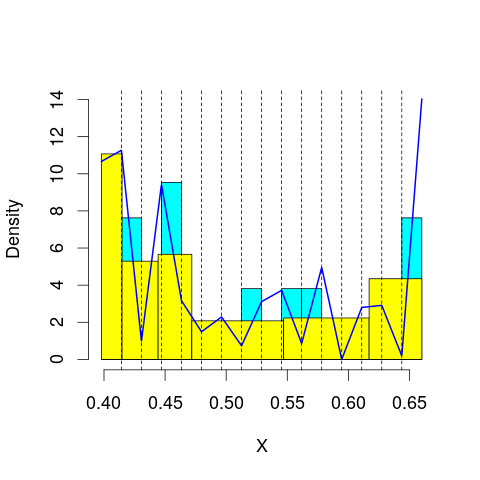

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.58503
mop.approx: Iteration 11. LL = 50.08795
mop.approx: Iteration 21. LL = 50.16477
mop.approx: Iteration 31. LL = 50.1765
mop.approx: Iteration 41. LL = 50.17893
mop.approx: Converged. Iteration 48. LL = 50.17951
[1] "Computing the linear combination of B-splines"


18.9878888617
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.46417
mop.approx: Iteration 11. LL = 49.29546
mop.approx: Iteration 21. LL = 49.48611
mop.approx: Iteration 31. LL = 49.51362
mop.approx: Iteration 41. LL = 49.51886
mop.approx: Iteration 51. LL = 49.52003
mop.approx: Converged. Iteration 51. LL = 49.52008
[1] "Computing the linear combination of B-splines"


16.5955892706
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.1866
mop.approx: Iteration 11. LL = 42.82382
mop.approx: Iteration 21. LL = 42.96038
mop.approx: Iteration 31. LL = 42.98631
mop.approx: Iteration 41. LL = 42.99444
mop.approx: Iteration 51. LL = 42.99781
mop.approx: Iteration 61. LL = 42.9994
mop.approx: Iteration 71. LL = 43.0002
mop.approx: Converged. Iteration 76. LL = 43.00048
[1] "Computing the linear combination of B-splines"


8.34312418866
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.686523
mop.approx: Iteration 11. LL = 41.64496
mop.approx: Iteration 21. LL = 41.74807
mop.approx: Iteration 31. LL = 41.76835
mop.approx: Iteration 41. LL = 41.77859
mop.approx: Iteration 51. LL = 41.78423
mop.approx: Iteration 61. LL = 41.7875
mop.approx: Iteration 71. LL = 41.78951
mop.approx: Iteration 81. LL = 41.79082
mop.approx: Iteration 91. LL = 41.79173
mop.approx: Iteration 101. LL = 41.79239
mop.approx: Iteration 111. LL = 41.79289
mop.approx: Converged. Iteration 114. LL = 41.79306
[1] "Computing the linear combination of B-splines"


5.40283702286
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.741961
mop.approx: Iteration 11. LL = 40.19249
mop.approx: Iteration 21. LL = 40.40686
mop.approx: Iteration 31. LL = 40.47115
mop.approx: Iteration 41. LL = 40.49813
mop.approx: Iteration 51. LL = 40.512
mop.approx: Iteration 61. LL = 40.52006
mop.approx: Iteration 71. LL = 40.52511
mop.approx: Iteration 81. LL = 40.52844
mop.approx: Iteration 91. LL = 40.53074
mop.approx: Iteration 101. LL = 40.53239
mop.approx: Iteration 111. LL = 40.5336
mop.approx: Iteration 121. LL = 40.53452
mop.approx: Iteration 131. LL = 40.53523
mop.approx: Iteration 141. LL = 40.53579
mop.approx: Iteration 151. LL = 40.53624
mop.approx: Converged. Iteration 151. LL = 40.53628
[1] "Computing the linear combination of B-splines"


2.41318865876
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.230711
mop.approx: Iteration 11. LL = 40.13223
mop.approx: Iteration 21. LL = 40.18627
mop.approx: Iteration 31. LL = 40.20994
mop.approx: Iteration 41. LL = 40.22302
mop.approx: Iteration 51. LL = 40.23079
mop.approx: Iteration 61. LL = 40.23556
mop.approx: Iteration 71. LL = 40.23859
mop.approx: Iteration 81. LL = 40.24054
mop.approx: Iteration 91. LL = 40.24183
mop.approx: Iteration 101. LL = 40.24268
mop.approx: Iteration 111. LL = 40.24325
mop.approx: Converged. Iteration 115. LL = 40.24346
[1] "Computing the linear combination of B-splines"


0.387489510759
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.933074
mop.approx: Iteration 11. LL = 40.71479
mop.approx: Iteration 21. LL = 40.7672
mop.approx: Iteration 31. LL = 40.7811
mop.approx: Iteration 41. LL = 40.79032
mop.approx: Iteration 51. LL = 40.79692
mop.approx: Iteration 61. LL = 40.80167
mop.approx: Iteration 71. LL = 40.80509
mop.approx: Iteration 81. LL = 40.80757
mop.approx: Iteration 91. LL = 40.80943
mop.approx: Iteration 101. LL = 40.81086
mop.approx: Iteration 111. LL = 40.812
mop.approx: Iteration 121. LL = 40.81293
mop.approx: Iteration 131. LL = 40.81373
mop.approx: Iteration 141. LL = 40.81442
mop.approx: Iteration 151. LL = 40.81503
mop.approx: Iteration 161. LL = 40.81558
mop.approx: Iteration 171. LL = 40.81608
mop.approx: Iteration 181. LL = 40.81653
mop.approx: Converged. Iteration 188. LL = 40.81687
[1] "Computing the linear combination of B-splines"


-0.771903804562
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.70635
mop.approx: Iteration 11. LL = 50.72149
mop.approx: Iteration 21. LL = 50.76802
mop.approx: Iteration 31. LL = 50.77693
mop.approx: Iteration 41. LL = 50.78007
mop.approx: Iteration 51. LL = 50.78137
mop.approx: Converged. Iteration 57. LL = 50.78182
[1] "Computing the linear combination of B-splines"


19.5901926228
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 19.59019262282402)
m reached
('Sum of Probabilities:', 0.9892634100976679)
chosen


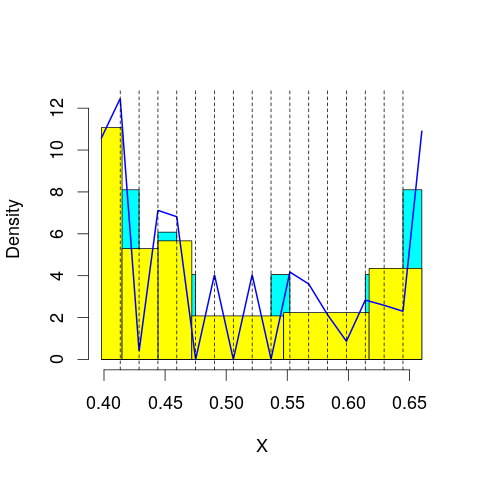

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.58503
mop.approx: Iteration 11. LL = 50.47958
mop.approx: Iteration 21. LL = 50.61205
mop.approx: Iteration 31. LL = 50.63537
mop.approx: Iteration 41. LL = 50.6418
mop.approx: Iteration 51. LL = 50.64407
mop.approx: Iteration 61. LL = 50.64507
mop.approx: Converged. Iteration 66. LL = 50.64541
[1] "Computing the linear combination of B-splines"


17.7209199225
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.46417
mop.approx: Iteration 11. LL = 49.65699
mop.approx: Iteration 21. LL = 49.89515
mop.approx: Iteration 31. LL = 49.93558
mop.approx: Iteration 41. LL = 49.94626
mop.approx: Iteration 51. LL = 49.95037
mop.approx: Iteration 61. LL = 49.95231
mop.approx: Iteration 71. LL = 49.95333
mop.approx: Converged. Iteration 78. LL = 49.95381
[1] "Computing the linear combination of B-splines"


15.2964466577
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.1866
mop.approx: Iteration 11. LL = 43.19675
mop.approx: Iteration 21. LL = 43.36712
mop.approx: Iteration 31. LL = 43.40603
mop.approx: Iteration 41. LL = 43.41992
mop.approx: Iteration 51. LL = 43.42615
mop.approx: Iteration 61. LL = 43.42927
mop.approx: Iteration 71. LL = 43.43098
mop.approx: Iteration 81. LL = 43.43201
mop.approx: Iteration 91. LL = 43.43268
mop.approx: Converged. Iteration 97. LL = 43.43302
[1] "Computing the linear combination of B-splines"


7.0427908701
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.686523
mop.approx: Iteration 11. LL = 42.17328
mop.approx: Iteration 21. LL = 42.33443
mop.approx: Iteration 31. LL = 42.37078
mop.approx: Iteration 41. LL = 42.38514
mop.approx: Iteration 51. LL = 42.39244
mop.approx: Iteration 61. LL = 42.39658
mop.approx: Iteration 71. LL = 42.39907
mop.approx: Iteration 81. LL = 42.40064
mop.approx: Iteration 91. LL = 42.40166
mop.approx: Iteration 101. LL = 42.40235
mop.approx: Converged. Iteration 109. LL = 42.40278
[1] "Computing the linear combination of B-splines"


4.27968500326
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.741961
mop.approx: Iteration 11. LL = 40.41595
mop.approx: Iteration 21. LL = 40.64971
mop.approx: Iteration 31. LL = 40.72148
mop.approx: Iteration 41. LL = 40.753
mop.approx: Iteration 51. LL = 40.76976
mop.approx: Iteration 61. LL = 40.77978
mop.approx: Iteration 71. LL = 40.78621
mop.approx: Iteration 81. LL = 40.79055
mop.approx: Iteration 91. LL = 40.79358
mop.approx: Iteration 101. LL = 40.79575
mop.approx: Iteration 111. LL = 40.79733
mop.approx: Iteration 121. LL = 40.7985
mop.approx: Iteration 131. LL = 40.79938
mop.approx: Iteration 141. LL = 40.80005
mop.approx: Iteration 151. LL = 40.80056
mop.approx: Converged. Iteration 156. LL = 40.80082
[1] "Computing the linear combination of B-splines"


0.94485497701
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.230711
mop.approx: Iteration 11. LL = 40.18517
mop.approx: Iteration 21. LL = 40.248
mop.approx: Iteration 31. LL = 40.27613
mop.approx: Iteration 41. LL = 40.29028
mop.approx: Iteration 51. LL = 40.29768
mop.approx: Iteration 61. LL = 40.3017
mop.approx: Iteration 71. LL = 40.30401
mop.approx: Iteration 81. LL = 40.3054
mop.approx: Iteration 91. LL = 40.30629
mop.approx: Iteration 101. LL = 40.30688
mop.approx: Converged. Iteration 107. LL = 40.30719
[1] "Computing the linear combination of B-splines"


-1.28166081817
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.933074
mop.approx: Iteration 11. LL = 40.75405
mop.approx: Iteration 21. LL = 40.79267
mop.approx: Iteration 31. LL = 40.80787
mop.approx: Iteration 41. LL = 40.81843
mop.approx: Iteration 51. LL = 40.82608
mop.approx: Iteration 61. LL = 40.83169
mop.approx: Iteration 71. LL = 40.83583
mop.approx: Iteration 81. LL = 40.83891
mop.approx: Iteration 91. LL = 40.84121
mop.approx: Iteration 101. LL = 40.84292
mop.approx: Iteration 111. LL = 40.84421
mop.approx: Iteration 121. LL = 40.84519
mop.approx: Iteration 131. LL = 40.84592
mop.approx: Iteration 141. LL = 40.84648
mop.approx: Converged. Iteration 148. LL = 40.84683
[1] "Computing the linear combination of B-splines"


-2.47489187468
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.70635
mop.approx: Iteration 11. LL = 51.01356
mop.approx: Iteration 21. LL = 51.03628
mop.approx: Iteration 31. LL = 51.03856
mop.approx: Converged. Iteration 37. LL = 51.03905
[1] "Computing the linear combination of B-splines"


18.1145626409
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 18.114562640917121)
m reached
('Sum of Probabilities:', 0.9905316139464031)
chosen


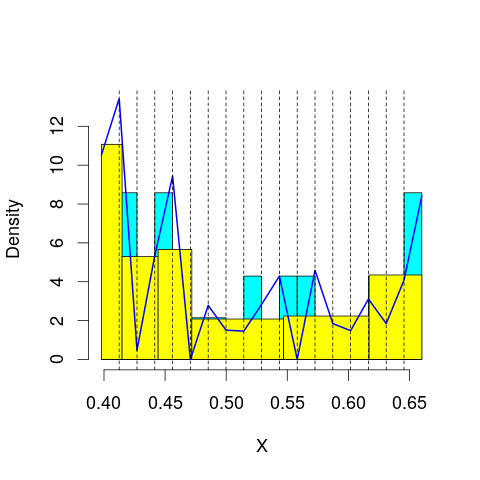

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.58503
mop.approx: Iteration 11. LL = 50.739
mop.approx: Iteration 21. LL = 50.84029
mop.approx: Iteration 31. LL = 50.85862
mop.approx: Iteration 41. LL = 50.863
mop.approx: Iteration 51. LL = 50.86409
mop.approx: Converged. Iteration 51. LL = 50.86414
[1] "Computing the linear combination of B-splines"


16.2067822177
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.46417
mop.approx: Iteration 11. LL = 50.08562
mop.approx: Iteration 21. LL = 50.33401
mop.approx: Iteration 31. LL = 50.39682
mop.approx: Iteration 41. LL = 50.4153
mop.approx: Iteration 51. LL = 50.42139
mop.approx: Iteration 61. LL = 50.42365
mop.approx: Iteration 71. LL = 50.42461
mop.approx: Converged. Iteration 74. LL = 50.42483
[1] "Computing the linear combination of B-splines"


14.0345985261
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.1866
mop.approx: Iteration 11. LL = 43.34392
mop.approx: Iteration 21. LL = 43.52169
mop.approx: Iteration 31. LL = 43.55854
mop.approx: Iteration 41. LL = 43.57021
mop.approx: Iteration 51. LL = 43.57491
mop.approx: Iteration 61. LL = 43.5771
mop.approx: Iteration 71. LL = 43.57826
mop.approx: Iteration 81. LL = 43.57895
mop.approx: Converged. Iteration 87. LL = 43.57928
[1] "Computing the linear combination of B-splines"


5.45618947809
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.686523
mop.approx: Iteration 11. LL = 42.85766
mop.approx: Iteration 21. LL = 43.04789
mop.approx: Iteration 31. LL = 43.09161
mop.approx: Iteration 41. LL = 43.11083
mop.approx: Iteration 51. LL = 43.12155
mop.approx: Iteration 61. LL = 43.12806
mop.approx: Iteration 71. LL = 43.13213
mop.approx: Iteration 81. LL = 43.13471
mop.approx: Iteration 91. LL = 43.13635
mop.approx: Iteration 101. LL = 43.1374
mop.approx: Iteration 111. LL = 43.13807
mop.approx: Converged. Iteration 116. LL = 43.13835
[1] "Computing the linear combination of B-splines"


3.28238468161
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.741961
mop.approx: Iteration 11. LL = 40.69316
mop.approx: Iteration 21. LL = 40.97363
mop.approx: Iteration 31. LL = 41.05797
mop.approx: Iteration 41. LL = 41.08908
mop.approx: Iteration 51. LL = 41.10117
mop.approx: Iteration 61. LL = 41.10612
mop.approx: Iteration 71. LL = 41.10833
mop.approx: Iteration 81. LL = 41.10944
mop.approx: Iteration 91. LL = 41.11007
mop.approx: Converged. Iteration 95. LL = 41.11028
[1] "Computing the linear combination of B-splines"


-0.478542861804
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.230711
mop.approx: Iteration 11. LL = 40.26569
mop.approx: Iteration 21. LL = 40.33664
mop.approx: Iteration 31. LL = 40.36602
mop.approx: Iteration 41. LL = 40.37993
mop.approx: Iteration 51. LL = 40.38756
mop.approx: Iteration 61. LL = 40.39243
mop.approx: Iteration 71. LL = 40.39589
mop.approx: Iteration 81. LL = 40.39847
mop.approx: Iteration 91. LL = 40.40046
mop.approx: Iteration 101. LL = 40.402
mop.approx: Iteration 111. LL = 40.40321
mop.approx: Iteration 121. LL = 40.40417
mop.approx: Iteration 131. LL = 40.40492
mop.approx: Iteration 141. LL = 40.40551
mop.approx: Iteration 151. LL = 40.40598
mop.approx: Converged. Iteration 152. LL = 40.40606
[1] "Computing the linear combination of B-splines"


-2.91569886263
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.933074
mop.approx: Iteration 11. LL = 40.76471
mop.approx: Iteration 21. LL = 40.80359
mop.approx: Iteration 31. LL = 40.82391
mop.approx: Iteration 41. LL = 40.83643
mop.approx: Iteration 51. LL = 40.84409
mop.approx: Iteration 61. LL = 40.84877
mop.approx: Iteration 71. LL = 40.85164
mop.approx: Iteration 81. LL = 40.85341
mop.approx: Iteration 91. LL = 40.85452
mop.approx: Iteration 101. LL = 40.85521
mop.approx: Converged. Iteration 108. LL = 40.85559
[1] "Computing the linear combination of B-splines"


-4.2001143977
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.70635
mop.approx: Iteration 11. LL = 51.89461
mop.approx: Iteration 21. LL = 51.93503
mop.approx: Iteration 31. LL = 51.94205
mop.approx: Iteration 41. LL = 51.9437
mop.approx: Converged. Iteration 44. LL = 51.94393
[1] "Computing the linear combination of B-splines"


17.2865674473
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 17.286567447307839)
m reached
('Sum of Probabilities:', 0.9910278251371512)
chosen


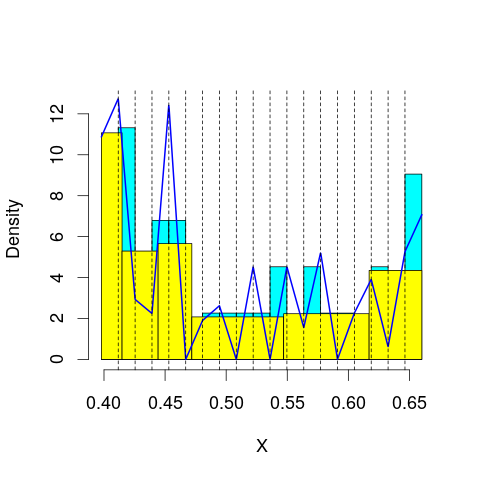

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.58503
mop.approx: Iteration 11. LL = 50.96463
mop.approx: Iteration 21. LL = 51.01613
mop.approx: Iteration 31. LL = 51.02158
mop.approx: Iteration 41. LL = 51.0232
mop.approx: Converged. Iteration 49. LL = 51.02383
[1] "Computing the linear combination of B-splines"


14.633603541
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.46417
mop.approx: Iteration 11. LL = 50.63579
mop.approx: Iteration 21. LL = 50.88848
mop.approx: Iteration 31. LL = 50.95844
mop.approx: Iteration 41. LL = 50.98442
mop.approx: Iteration 51. LL = 50.99544
mop.approx: Iteration 61. LL = 51.00068
mop.approx: Iteration 71. LL = 51.00343
mop.approx: Iteration 81. LL = 51.00497
mop.approx: Iteration 91. LL = 51.00591
mop.approx: Converged. Iteration 100. LL = 51.00651
[1] "Computing the linear combination of B-splines"


12.8834127093
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.1866
mop.approx: Iteration 11. LL = 43.37788
mop.approx: Iteration 21. LL = 43.51811
mop.approx: Iteration 31. LL = 43.55745
mop.approx: Iteration 41. LL = 43.57209
mop.approx: Iteration 51. LL = 43.57803
mop.approx: Iteration 61. LL = 43.5806
mop.approx: Iteration 71. LL = 43.58177
mop.approx: Converged. Iteration 80. LL = 43.58234
[1] "Computing the linear combination of B-splines"


3.72638079872
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.686523
mop.approx: Iteration 11. LL = 43.50145
mop.approx: Iteration 21. LL = 43.71381
mop.approx: Iteration 31. LL = 43.75779
mop.approx: Iteration 41. LL = 43.77343
mop.approx: Iteration 51. LL = 43.78027
mop.approx: Iteration 61. LL = 43.78361
mop.approx: Iteration 71. LL = 43.78544
mop.approx: Iteration 81. LL = 43.78655
mop.approx: Iteration 91. LL = 43.7873
mop.approx: Iteration 101. LL = 43.78783
mop.approx: Converged. Iteration 102. LL = 43.78792
[1] "Computing the linear combination of B-splines"


2.19908467531
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.741961
mop.approx: Iteration 11. LL = 41.18139
mop.approx: Iteration 21. LL = 41.53988
mop.approx: Iteration 31. LL = 41.6274
mop.approx: Iteration 41. LL = 41.65842
mop.approx: Iteration 51. LL = 41.67363
mop.approx: Iteration 61. LL = 41.68259
mop.approx: Iteration 71. LL = 41.68837
mop.approx: Iteration 81. LL = 41.69226
mop.approx: Iteration 91. LL = 41.69495
mop.approx: Iteration 101. LL = 41.69683
mop.approx: Iteration 111. LL = 41.69816
mop.approx: Iteration 121. LL = 41.69909
mop.approx: Iteration 131. LL = 41.69976
mop.approx: Converged. Iteration 140. LL = 41.70023
[1] "Computing the linear combination of B-splines"


-1.62147304664
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.230711
mop.approx: Iteration 11. LL = 40.35349
mop.approx: Iteration 21. LL = 40.4422
mop.approx: Iteration 31. LL = 40.47764
mop.approx: Iteration 41. LL = 40.49415
mop.approx: Iteration 51. LL = 40.50275
mop.approx: Iteration 61. LL = 40.50775
mop.approx: Iteration 71. LL = 40.51094
mop.approx: Iteration 81. LL = 40.5131
mop.approx: Iteration 91. LL = 40.51464
mop.approx: Iteration 101. LL = 40.51576
mop.approx: Iteration 111. LL = 40.5166
mop.approx: Iteration 121. LL = 40.51723
mop.approx: Iteration 131. LL = 40.51771
mop.approx: Converged. Iteration 133. LL = 40.51783
[1] "Computing the linear combination of B-splines"


-4.53683091328
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.933074
mop.approx: Iteration 11. LL = 40.81319
mop.approx: Iteration 21. LL = 40.86426
mop.approx: Iteration 31. LL = 40.88528
mop.approx: Iteration 41. LL = 40.89422
mop.approx: Iteration 51. LL = 40.89868
mop.approx: Iteration 61. LL = 40.90148
mop.approx: Iteration 71. LL = 40.90353
mop.approx: Iteration 81. LL = 40.90515
mop.approx: Iteration 91. LL = 40.90647
mop.approx: Iteration 101. LL = 40.90757
mop.approx: Iteration 111. LL = 40.90849
mop.approx: Iteration 121. LL = 40.90926
mop.approx: Iteration 131. LL = 40.9099
mop.approx: Iteration 141. LL = 40.91044
mop.approx: Iteration 151. LL = 40.9109
mop.approx: Converged. Iteration 152. LL = 40.91098
[1] "Computing the linear combination of B-splines"


-5.87633080318
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.70635
mop.approx: Iteration 11. LL = 51.47579
mop.approx: Iteration 21. LL = 51.53057
mop.approx: Iteration 31. LL = 51.53489
mop.approx: Converged. Iteration 37. LL = 51.53546
[1] "Computing the linear combination of B-splines"


15.145233736
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 15.145233735984618)
m reached
('Sum of Probabilities:', 0.9911734248776518)
chosen


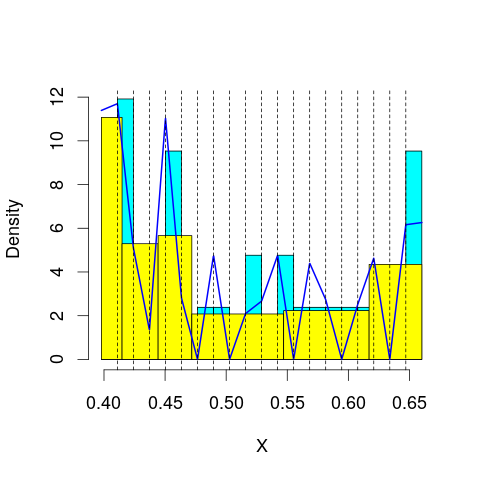

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.58503
mop.approx: Iteration 11. LL = 51.82055
mop.approx: Iteration 21. LL = 51.89186
mop.approx: Iteration 31. LL = 51.90231
mop.approx: Iteration 41. LL = 51.90453
mop.approx: Converged. Iteration 45. LL = 51.90487
[1] "Computing the linear combination of B-splines"


13.781779773
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 42.46417
mop.approx: Iteration 11. LL = 50.60175
mop.approx: Iteration 21. LL = 50.82028
mop.approx: Iteration 31. LL = 50.85731
mop.approx: Iteration 41. LL = 50.86756
mop.approx: Iteration 51. LL = 50.87166
mop.approx: Iteration 61. LL = 50.87372
mop.approx: Iteration 71. LL = 50.87486
mop.approx: Iteration 81. LL = 50.87553
mop.approx: Converged. Iteration 81. LL = 50.87558
[1] "Computing the linear combination of B-splines"


11.0196175548
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.1866
mop.approx: Iteration 11. LL = 43.82997
mop.approx: Iteration 21. LL = 43.99795
mop.approx: Iteration 31. LL = 44.04482
mop.approx: Iteration 41. LL = 44.06059
mop.approx: Iteration 51. LL = 44.06659
mop.approx: Iteration 61. LL = 44.06926
mop.approx: Iteration 71. LL = 44.07065
mop.approx: Iteration 81. LL = 44.07146
mop.approx: Converged. Iteration 90. LL = 44.07199
[1] "Computing the linear combination of B-splines"


2.48315420019
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.686523
mop.approx: Iteration 11. LL = 43.81145
mop.approx: Iteration 21. LL = 44.01317
mop.approx: Iteration 31. LL = 44.06059
mop.approx: Iteration 41. LL = 44.08048
mop.approx: Iteration 51. LL = 44.09039
mop.approx: Iteration 61. LL = 44.09555
mop.approx: Iteration 71. LL = 44.09827
mop.approx: Iteration 81. LL = 44.0997
mop.approx: Iteration 91. LL = 44.10046
mop.approx: Converged. Iteration 94. LL = 44.10065
[1] "Computing the linear combination of B-splines"


0.778954016875
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.741961
mop.approx: Iteration 11. LL = 41.96875
mop.approx: Iteration 21. LL = 42.4066
mop.approx: Iteration 31. LL = 42.50348
mop.approx: Iteration 41. LL = 42.53666
mop.approx: Iteration 51. LL = 42.55151
mop.approx: Iteration 61. LL = 42.55911
mop.approx: Iteration 71. LL = 42.56332
mop.approx: Iteration 81. LL = 42.5658
mop.approx: Iteration 91. LL = 42.56733
mop.approx: Iteration 101. LL = 42.56831
mop.approx: Iteration 111. LL = 42.56896
mop.approx: Converged. Iteration 117. LL = 42.56929
[1] "Computing the linear combination of B-splines"


-2.48528935191
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.230711
mop.approx: Iteration 11. LL = 40.39962
mop.approx: Iteration 21. LL = 40.48459
mop.approx: Iteration 31. LL = 40.51157
mop.approx: Iteration 41. LL = 40.5224
mop.approx: Iteration 51. LL = 40.52789
mop.approx: Iteration 61. LL = 40.53123
mop.approx: Iteration 71. LL = 40.53353
mop.approx: Iteration 81. LL = 40.53524
mop.approx: Iteration 91. LL = 40.53658
mop.approx: Iteration 101. LL = 40.53767
mop.approx: Iteration 111. LL = 40.53856
mop.approx: Iteration 121. LL = 40.5393
mop.approx: Iteration 131. LL = 40.53993
mop.approx: Iteration 141. LL = 40.54044
mop.approx: Converged. Iteration 150. LL = 40.54088
[1] "Computing the linear combination of B-splines"


-6.24663147313
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.933074
mop.approx: Iteration 11. LL = 40.93972
mop.approx: Iteration 21. LL = 41.03404
mop.approx: Iteration 31. LL = 41.07239
mop.approx: Iteration 41. LL = 41.09112
mop.approx: Iteration 51. LL = 41.10202
mop.approx: Iteration 61. LL = 41.10909
mop.approx: Iteration 71. LL = 41.11394
mop.approx: Iteration 81. LL = 41.11737
mop.approx: Iteration 91. LL = 41.11983
mop.approx: Iteration 101. LL = 41.12162
mop.approx: Iteration 111. LL = 41.12292
mop.approx: Iteration 121. LL = 41.12387
mop.approx: Iteration 131. LL = 41.12456
mop.approx: Iteration 141. LL = 41.12507
mop.approx: Converged. Iteration 143. LL = 41.1252
[1] "Computing the linear combination of B-splines"


-7.39632031019
lfps_12
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.42729
mop.approx: Iteration 11. LL = 67.66096
mop.approx: Converged. Iteration 13. LL = 67.66134
[1] "Computing the linear combination of B-splines"


62.4627317236
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 62.462731723564517)
m reached
('Sum of Probabilities:', 0.9955372195576959)
chosen


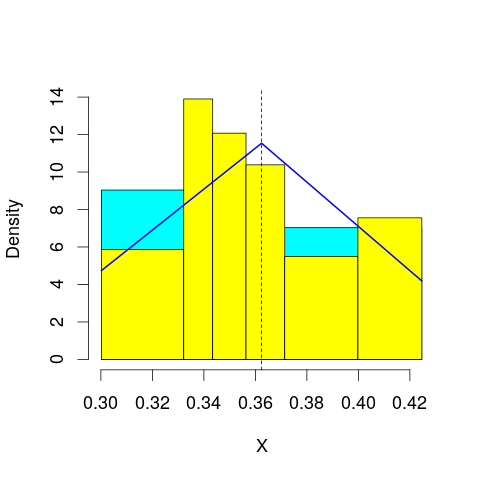

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.17322
mop.approx: Iteration 11. LL = 68.14457
mop.approx: Iteration 21. LL = 68.17608
mop.approx: Iteration 31. LL = 68.17878
mop.approx: Converged. Iteration 31. LL = 68.17884
[1] "Computing the linear combination of B-splines"


61.2473679294
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.92115
mop.approx: Iteration 11. LL = 68.03884
mop.approx: Iteration 21. LL = 68.16117
mop.approx: Iteration 31. LL = 68.20602
mop.approx: Iteration 41. LL = 68.22574
mop.approx: Iteration 51. LL = 68.23583
mop.approx: Iteration 61. LL = 68.24161
mop.approx: Iteration 71. LL = 68.24518
mop.approx: Iteration 81. LL = 68.24751
mop.approx: Iteration 91. LL = 68.2491
mop.approx: Iteration 101. LL = 68.25021
mop.approx: Converged. Iteration 110. LL = 68.251
[1] "Computing the linear combination of B-splines"


59.5866601219
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.653
mop.approx: Iteration 11. LL = 52.27546
mop.approx: Converged. Iteration 19. LL = 52.27804
[1] "Computing the linear combination of B-splines"


41.8808318088
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06832
mop.approx: Iteration 11. LL = 56.24271
mop.approx: Converged. Iteration 18. LL = 56.25776
[1] "Computing the linear combination of B-splines"


44.127686165
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31499
mop.approx: Iteration 11. LL = 48.41743
mop.approx: Iteration 21. LL = 48.43248
mop.approx: Iteration 31. LL = 48.43481
mop.approx: Converged. Iteration 34. LL = 48.43504
[1] "Computing the linear combination of B-splines"


34.572094342
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.177265
mop.approx: Iteration 11. LL = 51.67317
mop.approx: Iteration 21. LL = 51.727
mop.approx: Converged. Iteration 22. LL = 51.72708
[1] "Computing the linear combination of B-splines"


36.1312702046
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.513823
mop.approx: Iteration 11. LL = 45.30067
mop.approx: Iteration 21. LL = 45.32517
mop.approx: Iteration 31. LL = 45.33338
mop.approx: Iteration 41. LL = 45.33622
mop.approx: Iteration 51. LL = 45.33722
mop.approx: Converged. Iteration 53. LL = 45.33737
[1] "Computing the linear combination of B-splines"


28.0086943304
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.42729
mop.approx: Iteration 11. LL = 68.74729
mop.approx: Converged. Iteration 13. LL = 68.74756
[1] "Computing the linear combination of B-splines"


61.8160894388
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 61.816089438830566)
m reached
('Sum of Probabilities:', 0.9954081677267684)
chosen


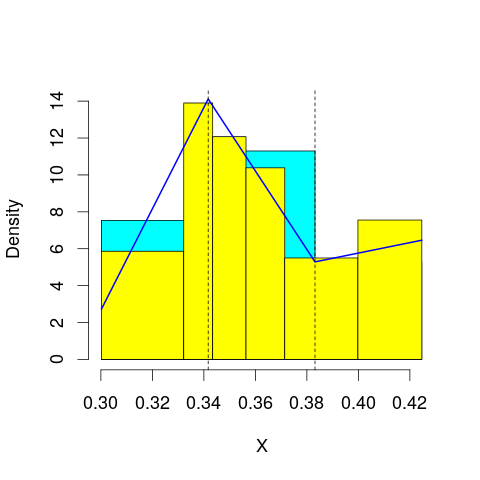

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.17322
mop.approx: Iteration 11. LL = 68.40163
mop.approx: Iteration 21. LL = 68.43621
mop.approx: Iteration 31. LL = 68.44177
mop.approx: Iteration 41. LL = 68.44311
mop.approx: Converged. Iteration 41. LL = 68.44317
[1] "Computing the linear combination of B-splines"


59.7788340975
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.92115
mop.approx: Iteration 11. LL = 68.70577
mop.approx: Iteration 21. LL = 68.93025
mop.approx: Iteration 31. LL = 69.02274
mop.approx: Iteration 41. LL = 69.06658
mop.approx: Iteration 51. LL = 69.08889
mop.approx: Iteration 61. LL = 69.1008
mop.approx: Iteration 71. LL = 69.10742
mop.approx: Iteration 81. LL = 69.11128
mop.approx: Iteration 91. LL = 69.11365
mop.approx: Iteration 101. LL = 69.11519
mop.approx: Iteration 111. LL = 69.11626
mop.approx: Converged. Iteration 119. LL = 69.11696
[1] "Computing the linear combination of B-splines"


58.7197504537
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.653
mop.approx: Iteration 11. LL = 63.87126
mop.approx: Iteration 21. LL = 63.91671
mop.approx: Converged. Iteration 22. LL = 63.91681
[1] "Computing the linear combination of B-splines"


51.7867350798
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06832
mop.approx: Iteration 11. LL = 56.35014
mop.approx: Converged. Iteration 15. LL = 56.35091
[1] "Computing the linear combination of B-splines"


42.4879649234
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31499
mop.approx: Iteration 11. LL = 59.14542
mop.approx: Converged. Iteration 20. LL = 59.18206
[1] "Computing the linear combination of B-splines"


43.5862523887
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.177265
mop.approx: Iteration 11. LL = 51.80915
mop.approx: Iteration 21. LL = 51.81938
mop.approx: Converged. Iteration 28. LL = 51.82026
[1] "Computing the linear combination of B-splines"


34.4915838195
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.513823
mop.approx: Iteration 11. LL = 54.41418
mop.approx: Iteration 21. LL = 54.49131
mop.approx: Converged. Iteration 23. LL = 54.49152
[1] "Computing the linear combination of B-splines"


35.4299736837
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.42729
mop.approx: Iteration 11. LL = 69.03738
mop.approx: Converged. Iteration 16. LL = 69.03893
[1] "Computing the linear combination of B-splines"


60.3745936622
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 60.374593662207765)
m reached
('Sum of Probabilities:', 0.994252608318613)
chosen


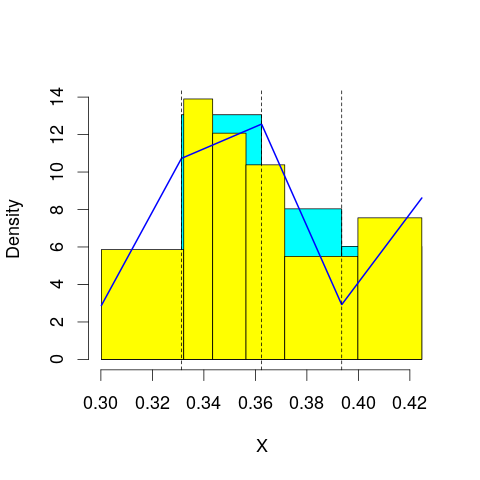

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.17322
mop.approx: Iteration 11. LL = 68.86884
mop.approx: Iteration 21. LL = 68.90402
mop.approx: Iteration 31. LL = 68.90749
mop.approx: Converged. Iteration 33. LL = 68.90772
[1] "Computing the linear combination of B-splines"


58.5105095514
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.92115
mop.approx: Iteration 11. LL = 69.14271
mop.approx: Iteration 21. LL = 69.24077
mop.approx: Iteration 31. LL = 69.26015
mop.approx: Iteration 41. LL = 69.26844
mop.approx: Iteration 51. LL = 69.27314
mop.approx: Iteration 61. LL = 69.27609
mop.approx: Iteration 71. LL = 69.27807
mop.approx: Iteration 81. LL = 69.27945
mop.approx: Iteration 91. LL = 69.28046
mop.approx: Converged. Iteration 99. LL = 69.28115
[1] "Computing the linear combination of B-splines"


57.1510786766
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.653
mop.approx: Iteration 11. LL = 64.18231
mop.approx: Converged. Iteration 18. LL = 64.19001
[1] "Computing the linear combination of B-splines"


50.3270664309
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06832
mop.approx: Iteration 11. LL = 64.3701
mop.approx: Iteration 21. LL = 64.58762
mop.approx: Iteration 31. LL = 64.59693
mop.approx: Converged. Iteration 33. LL = 64.5972
[1] "Computing the linear combination of B-splines"


49.0013909536
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31499
mop.approx: Iteration 11. LL = 59.30193
mop.approx: Converged. Iteration 13. LL = 59.30224
[1] "Computing the linear combination of B-splines"


41.9735615467
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.177265
mop.approx: Iteration 11. LL = 61.19248
mop.approx: Iteration 21. LL = 61.27584
mop.approx: Converged. Iteration 23. LL = 61.27616
[1] "Computing the linear combination of B-splines"


42.2146089897
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.513823
mop.approx: Iteration 11. LL = 54.5847
mop.approx: Iteration 21. LL = 54.59136
mop.approx: Converged. Iteration 23. LL = 54.59158
[1] "Computing the linear combination of B-splines"


33.7971660906
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.42729
mop.approx: Converged. Iteration 8. LL = 68.58179
[1] "Computing the linear combination of B-splines"


58.1845862284
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 58.184586228427492)
m reached
('Sum of Probabilities:', 0.9947793754293608)
chosen


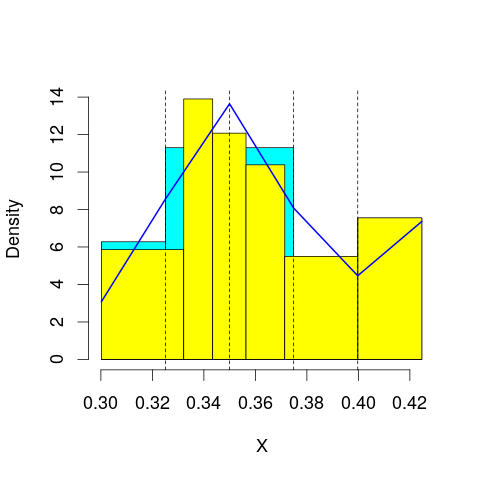

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.17322
mop.approx: Iteration 11. LL = 69.38042
mop.approx: Iteration 21. LL = 69.43423
mop.approx: Iteration 31. LL = 69.44392
mop.approx: Iteration 41. LL = 69.44711
mop.approx: Iteration 51. LL = 69.44859
mop.approx: Converged. Iteration 60. LL = 69.44944
[1] "Computing the linear combination of B-splines"


57.3193674262
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.92115
mop.approx: Iteration 11. LL = 69.28928
mop.approx: Iteration 21. LL = 69.30185
mop.approx: Converged. Iteration 24. LL = 69.30219
[1] "Computing the linear combination of B-splines"


55.4392510827
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.653
mop.approx: Iteration 11. LL = 64.21416
mop.approx: Converged. Iteration 16. LL = 64.21747
[1] "Computing the linear combination of B-splines"


48.6216564459
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06832
mop.approx: Iteration 11. LL = 64.89648
mop.approx: Iteration 21. LL = 64.97304
mop.approx: Iteration 31. LL = 64.98053
mop.approx: Converged. Iteration 37. LL = 64.98132
[1] "Computing the linear combination of B-splines"


47.6526388497
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31499
mop.approx: Iteration 11. LL = 63.97545
mop.approx: Iteration 21. LL = 64.24748
mop.approx: Iteration 31. LL = 64.30411
mop.approx: Iteration 41. LL = 64.32321
mop.approx: Iteration 51. LL = 64.33095
mop.approx: Iteration 61. LL = 64.33435
mop.approx: Iteration 71. LL = 64.3359
mop.approx: Converged. Iteration 77. LL = 64.33646
[1] "Computing the linear combination of B-splines"


45.2749169218
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.177265
mop.approx: Iteration 11. LL = 61.43133
mop.approx: Converged. Iteration 14. LL = 61.43248
[1] "Computing the linear combination of B-splines"


40.6380656346
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.513823
mop.approx: Iteration 11. LL = 62.5666
mop.approx: Iteration 21. LL = 62.73748
mop.approx: Converged. Iteration 27. LL = 62.73964
[1] "Computing the linear combination of B-splines"


40.2123597497
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.42729
mop.approx: Iteration 11. LL = 69.25408
mop.approx: Converged. Iteration 14. LL = 69.2548
[1] "Computing the linear combination of B-splines"


57.1247247712
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 57.124724771199212)
m reached
('Sum of Probabilities:', 0.9955477691092689)
chosen


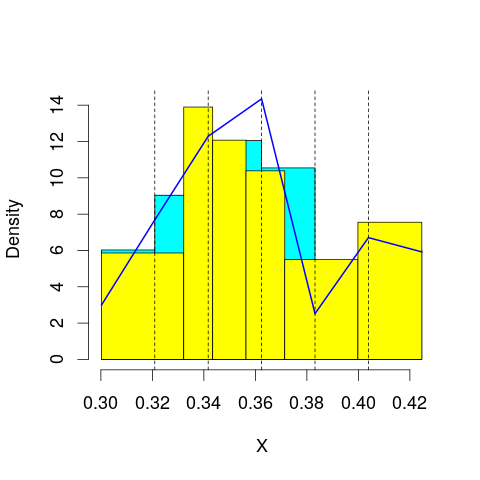

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.17322
mop.approx: Iteration 11. LL = 69.73694
mop.approx: Iteration 21. LL = 69.80066
mop.approx: Iteration 31. LL = 69.80889
mop.approx: Iteration 41. LL = 69.81114
mop.approx: Converged. Iteration 47. LL = 69.81178
[1] "Computing the linear combination of B-splines"


55.9488388128
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.92115
mop.approx: Iteration 11. LL = 69.84032
mop.approx: Iteration 21. LL = 69.97131
mop.approx: Iteration 31. LL = 70.01867
mop.approx: Iteration 41. LL = 70.03839
mop.approx: Iteration 51. LL = 70.04738
mop.approx: Iteration 61. LL = 70.05177
mop.approx: Iteration 71. LL = 70.05404
mop.approx: Iteration 81. LL = 70.05528
mop.approx: Converged. Iteration 86. LL = 70.05574
[1] "Computing the linear combination of B-splines"


54.4599329326
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.653
mop.approx: Iteration 11. LL = 64.7833
mop.approx: Iteration 21. LL = 64.81133
mop.approx: Converged. Iteration 29. LL = 64.81314
[1] "Computing the linear combination of B-splines"


47.4844593799
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06832
mop.approx: Iteration 11. LL = 65.01177
mop.approx: Iteration 21. LL = 65.06897
mop.approx: Converged. Iteration 27. LL = 65.07053
[1] "Computing the linear combination of B-splines"


46.0089804837
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31499
mop.approx: Iteration 11. LL = 64.81788
mop.approx: Iteration 21. LL = 64.88966
mop.approx: Converged. Iteration 30. LL = 64.89252
[1] "Computing the linear combination of B-splines"


44.098107882
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.177265
mop.approx: Iteration 11. LL = 63.64532
mop.approx: Iteration 21. LL = 63.72404
mop.approx: Iteration 31. LL = 63.73023
mop.approx: Converged. Iteration 35. LL = 63.73072
[1] "Computing the linear combination of B-splines"


41.2034399584
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.513823
mop.approx: Iteration 11. LL = 62.92414
mop.approx: Converged. Iteration 18. LL = 62.93142
[1] "Computing the linear combination of B-splines"


38.671272643
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.42729
mop.approx: Converged. Iteration 10. LL = 69.76154
[1] "Computing the linear combination of B-splines"


55.8985915181
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 55.898591518147391)
m reached
('Sum of Probabilities:', 0.9954331617913511)
chosen


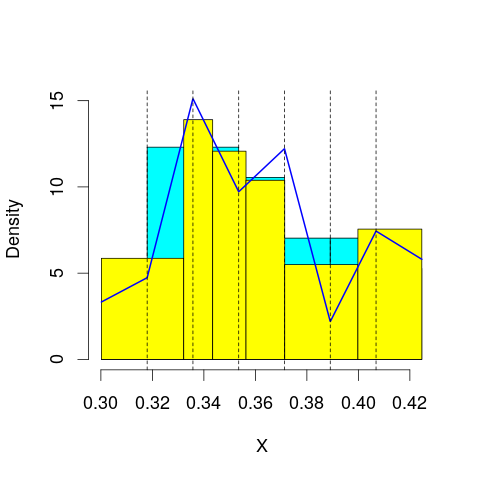

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.17322
mop.approx: Iteration 11. LL = 70.05481
mop.approx: Iteration 21. LL = 70.08532
mop.approx: Iteration 31. LL = 70.09195
mop.approx: Iteration 41. LL = 70.09391
mop.approx: Converged. Iteration 45. LL = 70.09432
[1] "Computing the linear combination of B-splines"


54.4985096272
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.92115
mop.approx: Iteration 11. LL = 70.62304
mop.approx: Iteration 21. LL = 70.78189
mop.approx: Iteration 31. LL = 70.80605
mop.approx: Iteration 41. LL = 70.80998
mop.approx: Converged. Iteration 45. LL = 70.81045
[1] "Computing the linear combination of B-splines"


53.481774003
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.653
mop.approx: Iteration 11. LL = 65.09276
mop.approx: Iteration 21. LL = 65.10734
mop.approx: Iteration 31. LL = 65.1109
mop.approx: Converged. Iteration 39. LL = 65.11187
[1] "Computing the linear combination of B-splines"


46.0503273805
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06832
mop.approx: Iteration 11. LL = 65.27116
mop.approx: Iteration 21. LL = 65.31891
mop.approx: Iteration 31. LL = 65.32243
mop.approx: Converged. Iteration 34. LL = 65.32274
[1] "Computing the linear combination of B-splines"


44.5283249206
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31499
mop.approx: Iteration 11. LL = 65.21877
mop.approx: Iteration 21. LL = 65.37138
mop.approx: Iteration 31. LL = 65.40518
mop.approx: Iteration 41. LL = 65.41564
mop.approx: Iteration 51. LL = 65.41919
mop.approx: Iteration 61. LL = 65.42044
mop.approx: Converged. Iteration 62. LL = 65.42056
[1] "Computing the linear combination of B-splines"


42.893281365
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.177265
mop.approx: Iteration 11. LL = 64.70619
mop.approx: Iteration 21. LL = 64.85558
mop.approx: Iteration 31. LL = 64.88348
mop.approx: Iteration 41. LL = 64.89008
mop.approx: Iteration 51. LL = 64.89177
mop.approx: Converged. Iteration 53. LL = 64.89197
[1] "Computing the linear combination of B-splines"


40.6318165152
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.513823
mop.approx: Iteration 11. LL = 63.73266
mop.approx: Iteration 21. LL = 63.74841
mop.approx: Converged. Iteration 22. LL = 63.74857
[1] "Computing the linear combination of B-splines"


37.7555412515
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.42729
mop.approx: Iteration 11. LL = 70.10185
mop.approx: Iteration 21. LL = 70.13218
mop.approx: Iteration 31. LL = 70.13884
mop.approx: Iteration 41. LL = 70.14145
mop.approx: Iteration 51. LL = 70.14275
mop.approx: Converged. Iteration 57. LL = 70.14331
[1] "Computing the linear combination of B-splines"


54.5475025646
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 54.547502564551607)
m reached
('Sum of Probabilities:', 0.994964646240372)
chosen


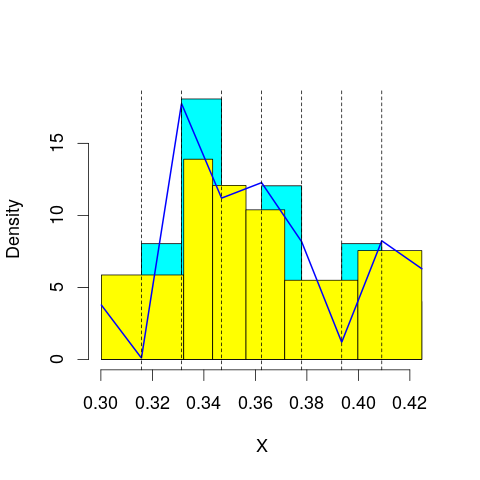

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.17322
mop.approx: Iteration 11. LL = 71.33204
mop.approx: Iteration 21. LL = 71.41873
mop.approx: Iteration 31. LL = 71.42802
mop.approx: Converged. Iteration 38. LL = 71.42917
[1] "Computing the linear combination of B-splines"


54.1004919384
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.92115
mop.approx: Iteration 11. LL = 70.91739
mop.approx: Iteration 21. LL = 71.0702
mop.approx: Iteration 31. LL = 71.10112
mop.approx: Iteration 41. LL = 71.10991
mop.approx: Iteration 51. LL = 71.11301
mop.approx: Iteration 61. LL = 71.11434
mop.approx: Converged. Iteration 65. LL = 71.11472
[1] "Computing the linear combination of B-splines"


52.0531763861
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.653
mop.approx: Iteration 11. LL = 65.97819
mop.approx: Iteration 21. LL = 66.12839
mop.approx: Iteration 31. LL = 66.16459
mop.approx: Iteration 41. LL = 66.1749
mop.approx: Iteration 51. LL = 66.17807
mop.approx: Converged. Iteration 60. LL = 66.1791
[1] "Computing the linear combination of B-splines"


45.3846828096
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06832
mop.approx: Iteration 11. LL = 65.53301
mop.approx: Iteration 21. LL = 65.58272
mop.approx: Iteration 31. LL = 65.59845
mop.approx: Iteration 41. LL = 65.6053
mop.approx: Iteration 51. LL = 65.60875
mop.approx: Iteration 61. LL = 65.61068
mop.approx: Iteration 71. LL = 65.61186
mop.approx: Converged. Iteration 80. LL = 65.61263
[1] "Computing the linear combination of B-splines"


43.0853487976
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31499
mop.approx: Iteration 11. LL = 65.3992
mop.approx: Iteration 21. LL = 65.51551
mop.approx: Iteration 31. LL = 65.53555
mop.approx: Iteration 41. LL = 65.5393
mop.approx: Converged. Iteration 46. LL = 65.53985
[1] "Computing the linear combination of B-splines"


41.2796940196
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.177265
mop.approx: Iteration 11. LL = 65.18397
mop.approx: Iteration 21. LL = 65.34722
mop.approx: Iteration 31. LL = 65.37449
mop.approx: Iteration 41. LL = 65.38217
mop.approx: Iteration 51. LL = 65.3849
mop.approx: Iteration 61. LL = 65.38596
mop.approx: Converged. Iteration 61. LL = 65.38602
[1] "Computing the linear combination of B-splines"


39.392998322
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.513823
mop.approx: Iteration 11. LL = 64.6979
mop.approx: Iteration 21. LL = 64.83676
mop.approx: Iteration 31. LL = 64.86294
mop.approx: Iteration 41. LL = 64.86978
mop.approx: Iteration 51. LL = 64.87194
mop.approx: Converged. Iteration 57. LL = 64.87254
[1] "Computing the linear combination of B-splines"


37.1466295858
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.42729
mop.approx: Iteration 11. LL = 70.93351
mop.approx: Iteration 21. LL = 70.95717
mop.approx: Converged. Iteration 28. LL = 70.95841
[1] "Computing the linear combination of B-splines"


53.6297334863
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 53.629733486327666)
m reached
('Sum of Probabilities:', 0.994218021925606)
chosen


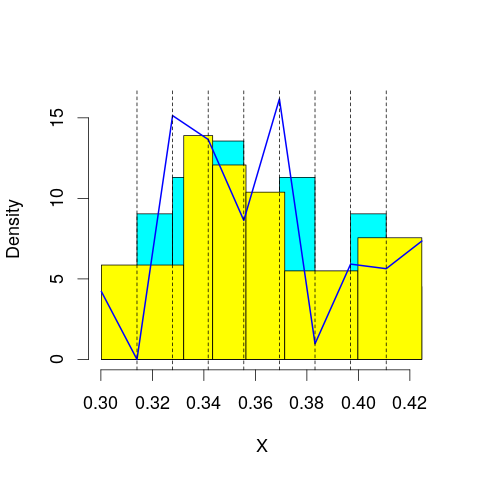

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.17322
mop.approx: Iteration 11. LL = 71.51699
mop.approx: Iteration 21. LL = 71.54426
mop.approx: Iteration 31. LL = 71.54783
mop.approx: Converged. Iteration 40. LL = 71.54893
[1] "Computing the linear combination of B-splines"


52.4873864688
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.92115
mop.approx: Iteration 11. LL = 71.3607
mop.approx: Iteration 21. LL = 71.45699
mop.approx: Iteration 31. LL = 71.47436
mop.approx: Iteration 41. LL = 71.48014
mop.approx: Iteration 51. LL = 71.48235
mop.approx: Converged. Iteration 58. LL = 71.4831
[1] "Computing the linear combination of B-splines"


50.688688418
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.653
mop.approx: Iteration 11. LL = 66.28259
mop.approx: Iteration 21. LL = 66.35391
mop.approx: Iteration 31. LL = 66.3668
mop.approx: Iteration 41. LL = 66.37024
mop.approx: Iteration 51. LL = 66.37137
mop.approx: Converged. Iteration 51. LL = 66.37143
[1] "Computing the linear combination of B-splines"


43.8441507162
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06832
mop.approx: Iteration 11. LL = 66.31075
mop.approx: Iteration 21. LL = 66.47954
mop.approx: Iteration 31. LL = 66.51827
mop.approx: Iteration 41. LL = 66.52987
mop.approx: Iteration 51. LL = 66.53459
mop.approx: Iteration 61. LL = 66.53697
mop.approx: Iteration 71. LL = 66.53832
mop.approx: Iteration 81. LL = 66.53916
mop.approx: Converged. Iteration 81. LL = 66.53922
[1] "Computing the linear combination of B-splines"


42.2790708091
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31499
mop.approx: Iteration 11. LL = 65.70124
mop.approx: Iteration 21. LL = 65.8462
mop.approx: Iteration 31. LL = 65.88408
mop.approx: Iteration 41. LL = 65.9002
mop.approx: Iteration 51. LL = 65.90844
mop.approx: Iteration 61. LL = 65.91307
mop.approx: Iteration 71. LL = 65.91583
mop.approx: Iteration 81. LL = 65.91754
mop.approx: Iteration 91. LL = 65.91863
mop.approx: Converged. Iteration 98. LL = 65.91922
[1] "Computing the linear combination of B-splines"


39.9262025663
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.177265
mop.approx: Iteration 11. LL = 65.38775
mop.approx: Iteration 21. LL = 65.45791
mop.approx: Iteration 31. LL = 65.46355
mop.approx: Iteration 41. LL = 65.46482
mop.approx: Converged. Iteration 42. LL = 65.46495
[1] "Computing the linear combination of B-splines"


37.7390643682
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.513823
mop.approx: Iteration 11. LL = 65.09999
mop.approx: Iteration 21. LL = 65.25029
mop.approx: Iteration 31. LL = 65.29181
mop.approx: Iteration 41. LL = 65.30797
mop.approx: Iteration 51. LL = 65.31482
mop.approx: Iteration 61. LL = 65.3178
mop.approx: Iteration 71. LL = 65.31911
mop.approx: Converged. Iteration 74. LL = 65.3194
[1] "Computing the linear combination of B-splines"


35.8606593218
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.42729
mop.approx: Iteration 11. LL = 71.78608
mop.approx: Iteration 21. LL = 71.85562
mop.approx: Iteration 31. LL = 71.86983
mop.approx: Iteration 41. LL = 71.87342
mop.approx: Converged. Iteration 48. LL = 71.8743
[1] "Computing the linear combination of B-splines"


52.8127490256
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 52.812749025643377)
m reached
('Sum of Probabilities:', 0.9930277086183271)
chosen


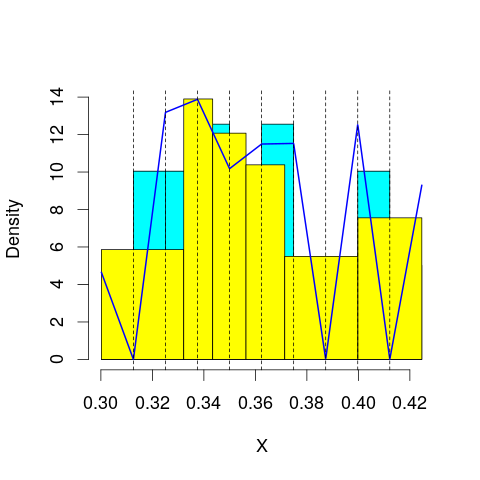

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.17322
mop.approx: Iteration 11. LL = 71.92338
mop.approx: Iteration 21. LL = 71.9324
mop.approx: Converged. Iteration 26. LL = 71.93304
[1] "Computing the linear combination of B-splines"


51.1386259446
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.92115
mop.approx: Iteration 11. LL = 71.47898
mop.approx: Iteration 21. LL = 71.53908
mop.approx: Iteration 31. LL = 71.54542
mop.approx: Converged. Iteration 37. LL = 71.54628
[1] "Computing the linear combination of B-splines"


49.018992185
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.653
mop.approx: Iteration 11. LL = 66.64542
mop.approx: Iteration 21. LL = 66.71319
mop.approx: Iteration 31. LL = 66.73633
mop.approx: Iteration 41. LL = 66.7446
mop.approx: Iteration 51. LL = 66.74752
mop.approx: Converged. Iteration 59. LL = 66.74848
[1] "Computing the linear combination of B-splines"


42.488325478
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06832
mop.approx: Iteration 11. LL = 66.69782
mop.approx: Iteration 21. LL = 66.80177
mop.approx: Iteration 31. LL = 66.83026
mop.approx: Iteration 41. LL = 66.84244
mop.approx: Iteration 51. LL = 66.84883
mop.approx: Iteration 61. LL = 66.85262
mop.approx: Iteration 71. LL = 66.85505
mop.approx: Iteration 81. LL = 66.85671
mop.approx: Iteration 91. LL = 66.85789
mop.approx: Iteration 101. LL = 66.85877
mop.approx: Converged. Iteration 106. LL = 66.85918
[1] "Computing the linear combination of B-splines"


40.8661644896
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31499
mop.approx: Iteration 11. LL = 66.40239
mop.approx: Iteration 21. LL = 66.59441
mop.approx: Iteration 31. LL = 66.63439
mop.approx: Iteration 41. LL = 66.64779
mop.approx: Iteration 51. LL = 66.65405
mop.approx: Iteration 61. LL = 66.65757
mop.approx: Iteration 71. LL = 66.65975
mop.approx: Iteration 81. LL = 66.66121
mop.approx: Iteration 91. LL = 66.66222
mop.approx: Converged. Iteration 99. LL = 66.66289
[1] "Computing the linear combination of B-splines"


38.9370068507
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.177265
mop.approx: Iteration 11. LL = 65.62416
mop.approx: Iteration 21. LL = 65.7871
mop.approx: Iteration 31. LL = 65.85673
mop.approx: Iteration 41. LL = 65.89257
mop.approx: Iteration 51. LL = 65.91187
mop.approx: Iteration 61. LL = 65.9225
mop.approx: Iteration 71. LL = 65.92842
mop.approx: Iteration 81. LL = 65.93172
mop.approx: Iteration 91. LL = 65.93357
mop.approx: Iteration 101. LL = 65.93461
mop.approx: Converged. Iteration 104. LL = 65.93489
[1] "Computing the linear combination of B-splines"


36.4761234107
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.513823
mop.approx: Iteration 11. LL = 65.45518
mop.approx: Iteration 21. LL = 65.60921
mop.approx: Iteration 31. LL = 65.64685
mop.approx: Iteration 41. LL = 65.66148
mop.approx: Iteration 51. LL = 65.66894
mop.approx: Iteration 61. LL = 65.67328
mop.approx: Iteration 71. LL = 65.67599
mop.approx: Iteration 81. LL = 65.67777
mop.approx: Iteration 91. LL = 65.67899
mop.approx: Iteration 101. LL = 65.67986
mop.approx: Converged. Iteration 105. LL = 65.6802
[1] "Computing the linear combination of B-splines"


34.4881257617
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.42729
mop.approx: Iteration 11. LL = 72.69923
mop.approx: Converged. Iteration 19. LL = 72.70624
[1] "Computing the linear combination of B-splines"


51.9118227635
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 51.911822763462709)
m reached
('Sum of Probabilities:', 0.9923866381085445)
chosen


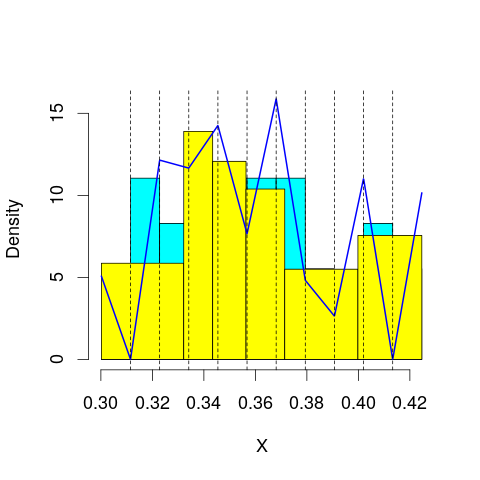

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.17322
mop.approx: Iteration 11. LL = 71.79615
mop.approx: Iteration 21. LL = 71.80274
mop.approx: Converged. Iteration 28. LL = 71.80362
[1] "Computing the linear combination of B-splines"


49.2763415449
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.92115
mop.approx: Iteration 11. LL = 72.04131
mop.approx: Iteration 21. LL = 72.13106
mop.approx: Iteration 31. LL = 72.14532
mop.approx: Iteration 41. LL = 72.14814
mop.approx: Converged. Iteration 45. LL = 72.14859
[1] "Computing the linear combination of B-splines"


47.8884365924
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.653
mop.approx: Iteration 11. LL = 66.86517
mop.approx: Iteration 21. LL = 66.8973
mop.approx: Iteration 31. LL = 66.89984
mop.approx: Converged. Iteration 31. LL = 66.8999
[1] "Computing the linear combination of B-splines"


40.9068782266
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06832
mop.approx: Iteration 11. LL = 67.03676
mop.approx: Iteration 21. LL = 67.07807
mop.approx: Iteration 31. LL = 67.08628
mop.approx: Iteration 41. LL = 67.09114
mop.approx: Iteration 51. LL = 67.09468
mop.approx: Iteration 61. LL = 67.09738
mop.approx: Iteration 71. LL = 67.09947
mop.approx: Iteration 81. LL = 67.1011
mop.approx: Iteration 91. LL = 67.10239
mop.approx: Iteration 101. LL = 67.10341
mop.approx: Iteration 111. LL = 67.10423
mop.approx: Converged. Iteration 115. LL = 67.10458
[1] "Computing the linear combination of B-splines"


39.3786943719
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31499
mop.approx: Iteration 11. LL = 66.88094
mop.approx: Iteration 21. LL = 66.9797
mop.approx: Iteration 31. LL = 67.00576
mop.approx: Iteration 41. LL = 67.01947
mop.approx: Iteration 51. LL = 67.0277
mop.approx: Iteration 61. LL = 67.03297
mop.approx: Iteration 71. LL = 67.0365
mop.approx: Iteration 81. LL = 67.03896
mop.approx: Iteration 91. LL = 67.04073
mop.approx: Iteration 101. LL = 67.04203
mop.approx: Iteration 111. LL = 67.04299
mop.approx: Converged. Iteration 119. LL = 67.04366
[1] "Computing the linear combination of B-splines"


37.5849091627
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.177265
mop.approx: Iteration 11. LL = 66.19934
mop.approx: Iteration 21. LL = 66.43242
mop.approx: Iteration 31. LL = 66.48663
mop.approx: Iteration 41. LL = 66.50437
mop.approx: Iteration 51. LL = 66.51232
mop.approx: Iteration 61. LL = 66.51661
mop.approx: Iteration 71. LL = 66.5192
mop.approx: Iteration 81. LL = 66.52088
mop.approx: Iteration 91. LL = 66.52204
mop.approx: Iteration 101. LL = 66.52288
mop.approx: Converged. Iteration 104. LL = 66.52315
[1] "Computing the linear combination of B-splines"


35.331530102
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.513823
mop.approx: Iteration 11. LL = 65.69709
mop.approx: Iteration 21. LL = 65.84511
mop.approx: Iteration 31. LL = 65.89951
mop.approx: Iteration 41. LL = 65.93117
mop.approx: Iteration 51. LL = 65.9512
mop.approx: Iteration 61. LL = 65.96442
mop.approx: Iteration 71. LL = 65.97343
mop.approx: Iteration 81. LL = 65.97975
mop.approx: Iteration 91. LL = 65.98428
mop.approx: Iteration 101. LL = 65.98758
mop.approx: Iteration 111. LL = 65.99002
mop.approx: Iteration 121. LL = 65.99185
mop.approx: Iteration 131. LL = 65.99323
mop.approx: Iteration 141. LL = 65.99428
mop.approx: Iteration 151. LL = 65.99509
mop.approx: Converged. Iteration 154. LL = 65.99535
[1] "Computing the linear combination of B-splines"


33.0706662574
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.42729
mop.approx: Iteration 11. LL = 73.86021
mop.approx: Iteration 21. LL = 73.86503
mop.approx: Converged. Iteration 27. LL = 73.86577
[1] "Computing the linear combination of B-splines"


51.3384872115
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 51.338487211501899)
m reached
('Sum of Probabilities:', 0.9917551843749555)
chosen


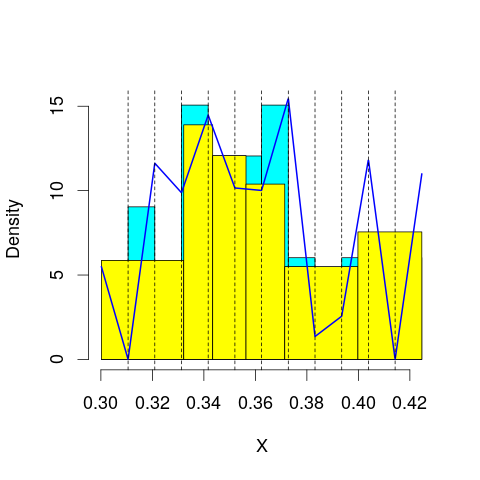

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.17322
mop.approx: Iteration 11. LL = 72.09414
mop.approx: Iteration 21. LL = 72.16713
mop.approx: Iteration 31. LL = 72.17219
mop.approx: Converged. Iteration 32. LL = 72.17234
[1] "Computing the linear combination of B-splines"


47.9121890364
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.92115
mop.approx: Iteration 11. LL = 72.2932
mop.approx: Iteration 21. LL = 72.32112
mop.approx: Iteration 31. LL = 72.32497
mop.approx: Iteration 41. LL = 72.32632
mop.approx: Converged. Iteration 45. LL = 72.32671
[1] "Computing the linear combination of B-splines"


46.3336898287
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.653
mop.approx: Iteration 11. LL = 67.35974
mop.approx: Iteration 21. LL = 67.4408
mop.approx: Iteration 31. LL = 67.4643
mop.approx: Iteration 41. LL = 67.47364
mop.approx: Iteration 51. LL = 67.4781
mop.approx: Iteration 61. LL = 67.48052
mop.approx: Iteration 71. LL = 67.48196
mop.approx: Iteration 81. LL = 67.48288
mop.approx: Converged. Iteration 83. LL = 67.48309
[1] "Computing the linear combination of B-splines"


39.7572045093
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06832
mop.approx: Iteration 11. LL = 67.13633
mop.approx: Iteration 21. LL = 67.1671
mop.approx: Iteration 31. LL = 67.17967
mop.approx: Iteration 41. LL = 67.1849
mop.approx: Iteration 51. LL = 67.18711
mop.approx: Converged. Iteration 60. LL = 67.18809
[1] "Computing the linear combination of B-splines"


37.7293315874
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31499
mop.approx: Iteration 11. LL = 67.31821
mop.approx: Iteration 21. LL = 67.40643
mop.approx: Iteration 31. LL = 67.43037
mop.approx: Iteration 41. LL = 67.44304
mop.approx: Iteration 51. LL = 67.45115
mop.approx: Iteration 61. LL = 67.45671
mop.approx: Iteration 71. LL = 67.46066
mop.approx: Iteration 81. LL = 67.46355
mop.approx: Iteration 91. LL = 67.46571
mop.approx: Iteration 101. LL = 67.46736
mop.approx: Iteration 111. LL = 67.46864
mop.approx: Iteration 121. LL = 67.46964
mop.approx: Iteration 131. LL = 67.47044
mop.approx: Converged. Iteration 133. LL = 67.47064
[1] "Computing the linear combination of B-splines"


36.2790194995
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.177265
mop.approx: Iteration 11. LL = 66.74185
mop.approx: Iteration 21. LL = 66.88871
mop.approx: Iteration 31. LL = 66.91732
mop.approx: Iteration 41. LL = 66.93088
mop.approx: Iteration 51. LL = 66.93933
mop.approx: Iteration 61. LL = 66.94502
mop.approx: Iteration 71. LL = 66.94898
mop.approx: Iteration 81. LL = 66.95181
mop.approx: Iteration 91. LL = 66.95387
mop.approx: Iteration 101. LL = 66.95539
mop.approx: Iteration 111. LL = 66.95652
mop.approx: Iteration 121. LL = 66.95738
mop.approx: Converged. Iteration 125. LL = 66.95772
[1] "Computing the linear combination of B-splines"


34.0333032393
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.513823
mop.approx: Iteration 11. LL = 66.06797
mop.approx: Iteration 21. LL = 66.25914
mop.approx: Iteration 31. LL = 66.30505
mop.approx: Iteration 41. LL = 66.32019
mop.approx: Iteration 51. LL = 66.3268
mop.approx: Iteration 61. LL = 66.33052
mop.approx: Iteration 71. LL = 66.33295
mop.approx: Iteration 81. LL = 66.33466
mop.approx: Iteration 91. LL = 66.33591
mop.approx: Iteration 101. LL = 66.33686
mop.approx: Converged. Iteration 110. LL = 66.33759
[1] "Computing the linear combination of B-splines"


31.6792306028
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.42729
mop.approx: Iteration 11. LL = 74.33434
mop.approx: Iteration 21. LL = 74.38981
mop.approx: Iteration 31. LL = 74.40024
mop.approx: Iteration 41. LL = 74.40421
mop.approx: Iteration 51. LL = 74.40621
mop.approx: Iteration 61. LL = 74.40734
mop.approx: Converged. Iteration 64. LL = 74.40766
[1] "Computing the linear combination of B-splines"


50.1475082849
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 50.147508284931781)
m reached
('Sum of Probabilities:', 0.9911330994811645)
chosen


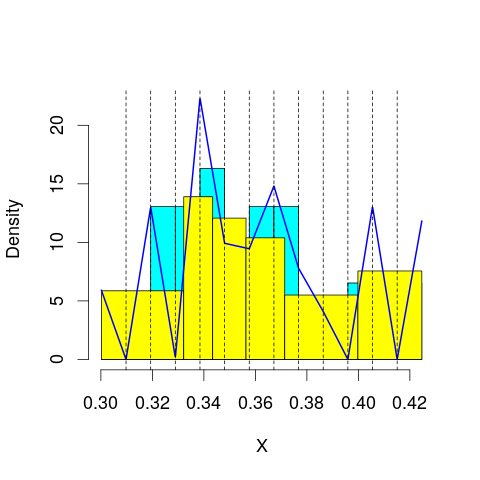

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.17322
mop.approx: Iteration 11. LL = 72.86667
mop.approx: Iteration 21. LL = 72.88712
mop.approx: Converged. Iteration 29. LL = 72.88855
[1] "Computing the linear combination of B-splines"


46.8955276612
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.92115
mop.approx: Iteration 11. LL = 72.38132
mop.approx: Iteration 21. LL = 72.4373
mop.approx: Iteration 31. LL = 72.4569
mop.approx: Iteration 41. LL = 72.46383
mop.approx: Iteration 51. LL = 72.46621
mop.approx: Converged. Iteration 57. LL = 72.46688
[1] "Computing the linear combination of B-splines"


44.7409948153
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.653
mop.approx: Iteration 11. LL = 67.7648
mop.approx: Iteration 21. LL = 67.79553
mop.approx: Iteration 31. LL = 67.80053
mop.approx: Iteration 41. LL = 67.8023
mop.approx: Iteration 51. LL = 67.80327
mop.approx: Converged. Iteration 54. LL = 67.80356
[1] "Computing the linear combination of B-splines"


38.3448048049
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06832
mop.approx: Iteration 11. LL = 67.33723
mop.approx: Iteration 21. LL = 67.42848
mop.approx: Iteration 31. LL = 67.46915
mop.approx: Iteration 41. LL = 67.48975
mop.approx: Iteration 51. LL = 67.50118
mop.approx: Iteration 61. LL = 67.50794
mop.approx: Iteration 71. LL = 67.51214
mop.approx: Iteration 81. LL = 67.51484
mop.approx: Iteration 91. LL = 67.51661
mop.approx: Iteration 101. LL = 67.51779
mop.approx: Converged. Iteration 110. LL = 67.51859
[1] "Computing the linear combination of B-splines"


36.3269662535
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31499
mop.approx: Iteration 11. LL = 67.49343
mop.approx: Iteration 21. LL = 67.5263
mop.approx: Iteration 31. LL = 67.53289
mop.approx: Iteration 41. LL = 67.53578
mop.approx: Iteration 51. LL = 67.53754
mop.approx: Iteration 61. LL = 67.53876
mop.approx: Iteration 71. LL = 67.53962
mop.approx: Converged. Iteration 73. LL = 67.53983
[1] "Computing the linear combination of B-splines"


34.615335444
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.177265
mop.approx: Iteration 11. LL = 67.29113
mop.approx: Iteration 21. LL = 67.4334
mop.approx: Iteration 31. LL = 67.4687
mop.approx: Iteration 41. LL = 67.48727
mop.approx: Iteration 51. LL = 67.49923
mop.approx: Iteration 61. LL = 67.50739
mop.approx: Iteration 71. LL = 67.51307
mop.approx: Iteration 81. LL = 67.51706
mop.approx: Iteration 91. LL = 67.51987
mop.approx: Iteration 101. LL = 67.52187
mop.approx: Iteration 111. LL = 67.52329
mop.approx: Iteration 121. LL = 67.52429
mop.approx: Converged. Iteration 128. LL = 67.52489
[1] "Computing the linear combination of B-splines"


32.8674243403
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.513823
mop.approx: Iteration 11. LL = 66.47681
mop.approx: Iteration 21. LL = 66.5955
mop.approx: Iteration 31. LL = 66.61379
mop.approx: Iteration 41. LL = 66.62295
mop.approx: Iteration 51. LL = 66.62936
mop.approx: Iteration 61. LL = 66.63408
mop.approx: Iteration 71. LL = 66.63764
mop.approx: Iteration 81. LL = 66.64036
mop.approx: Iteration 91. LL = 66.64245
mop.approx: Iteration 101. LL = 66.64408
mop.approx: Iteration 111. LL = 66.64537
mop.approx: Iteration 121. LL = 66.64638
mop.approx: Iteration 131. LL = 66.64719
mop.approx: Converged. Iteration 135. LL = 66.64753
[1] "Computing the linear combination of B-splines"


30.2555644009
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.42729
mop.approx: Iteration 11. LL = 74.56004
mop.approx: Iteration 21. LL = 74.62182
mop.approx: Iteration 31. LL = 74.63357
mop.approx: Iteration 41. LL = 74.63635
mop.approx: Converged. Iteration 45. LL = 74.6368
[1] "Computing the linear combination of B-splines"


48.6437795126
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 48.643779512606457)
m reached
('Sum of Probabilities:', 0.9905200010475154)
chosen


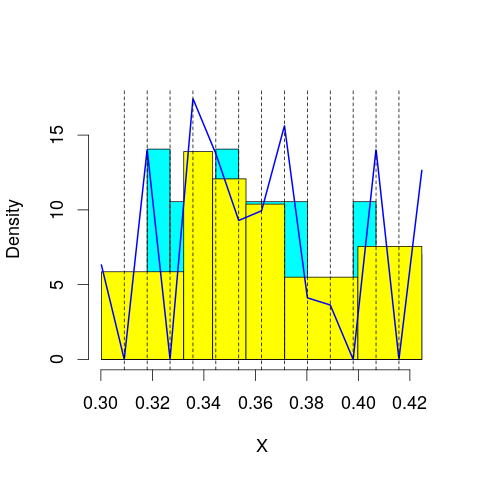

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.17322
mop.approx: Iteration 11. LL = 73.42321
mop.approx: Iteration 21. LL = 73.46253
mop.approx: Iteration 31. LL = 73.46711
mop.approx: Iteration 41. LL = 73.46842
mop.approx: Converged. Iteration 46. LL = 73.4689
[1] "Computing the linear combination of B-splines"


45.7430101392
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.92115
mop.approx: Iteration 11. LL = 72.50669
mop.approx: Iteration 21. LL = 72.57374
mop.approx: Iteration 31. LL = 72.59089
mop.approx: Iteration 41. LL = 72.59584
mop.approx: Iteration 51. LL = 72.59738
mop.approx: Converged. Iteration 53. LL = 72.5976
[1] "Computing the linear combination of B-splines"


43.1388490455
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.653
mop.approx: Iteration 11. LL = 67.92938
mop.approx: Iteration 21. LL = 67.95482
mop.approx: Iteration 31. LL = 67.9616
mop.approx: Iteration 41. LL = 67.96485
mop.approx: Iteration 51. LL = 67.96689
mop.approx: Iteration 61. LL = 67.96831
mop.approx: Iteration 71. LL = 67.96933
mop.approx: Converged. Iteration 79. LL = 67.97002
[1] "Computing the linear combination of B-splines"


36.7783948453
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06832
mop.approx: Iteration 11. LL = 67.70593
mop.approx: Iteration 21. LL = 67.7856
mop.approx: Iteration 31. LL = 67.80393
mop.approx: Iteration 41. LL = 67.81013
mop.approx: Iteration 51. LL = 67.81279
mop.approx: Iteration 61. LL = 67.81411
mop.approx: Converged. Iteration 67. LL = 67.81466
[1] "Computing the linear combination of B-splines"


34.8901728822
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31499
mop.approx: Iteration 11. LL = 67.54858
mop.approx: Iteration 21. LL = 67.58759
mop.approx: Iteration 31. LL = 67.61309
mop.approx: Iteration 41. LL = 67.63091
mop.approx: Iteration 51. LL = 67.64339
mop.approx: Iteration 61. LL = 67.65218
mop.approx: Iteration 71. LL = 67.65842
mop.approx: Iteration 81. LL = 67.66287
mop.approx: Iteration 91. LL = 67.66607
mop.approx: Iteration 101. LL = 67.66837
mop.approx: Iteration 111. LL = 67.67003
mop.approx: Iteration 121. LL = 67.67122
mop.approx: Iteration 131. LL = 67.67208
mop.approx: Converged. Iteration 133. LL = 67.67229
[1] "Computing the linear combination of B-splines"


33.0149250775
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.177265
mop.approx: Iteration 11. LL = 67.6781
mop.approx: Iteration 21. LL = 67.76956
mop.approx: Iteration 31. LL = 67.78645
mop.approx: Iteration 41. LL = 67.79131
mop.approx: Iteration 51. LL = 67.7928
mop.approx: Converged. Iteration 52. LL = 67.79294
[1] "Computing the linear combination of B-splines"


31.40271484
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.513823
mop.approx: Iteration 11. LL = 66.95247
mop.approx: Iteration 21. LL = 67.118
mop.approx: Iteration 31. LL = 67.16999
mop.approx: Iteration 41. LL = 67.19666
mop.approx: Iteration 51. LL = 67.21281
mop.approx: Iteration 61. LL = 67.22336
mop.approx: Iteration 71. LL = 67.23044
mop.approx: Iteration 81. LL = 67.23524
mop.approx: Iteration 91. LL = 67.23849
mop.approx: Iteration 101. LL = 67.24069
mop.approx: Iteration 111. LL = 67.24217
mop.approx: Iteration 121. LL = 67.24317
mop.approx: Converged. Iteration 126. LL = 67.24361
[1] "Computing the linear combination of B-splines"


29.1140671828
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.42729
mop.approx: Iteration 11. LL = 73.50216
mop.approx: Iteration 21. LL = 73.51859
mop.approx: Converged. Iteration 30. LL = 73.52025
[1] "Computing the linear combination of B-splines"


45.7943660895
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 45.794366089464219)
m reached
('Sum of Probabilities:', 0.9899156957461533)
chosen


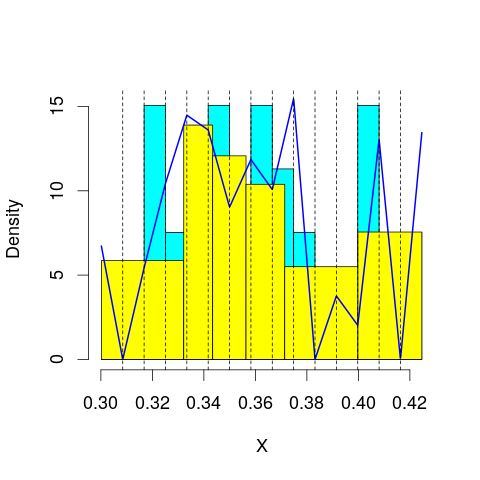

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.17322
mop.approx: Iteration 11. LL = 74.78799
mop.approx: Iteration 21. LL = 74.85203
mop.approx: Iteration 31. LL = 74.86853
mop.approx: Iteration 41. LL = 74.87519
mop.approx: Iteration 51. LL = 74.87835
mop.approx: Iteration 61. LL = 74.87996
mop.approx: Converged. Iteration 68. LL = 74.88069
[1] "Computing the linear combination of B-splines"


45.4219388314
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.92115
mop.approx: Iteration 11. LL = 72.45134
mop.approx: Iteration 21. LL = 72.57816
mop.approx: Iteration 31. LL = 72.60778
mop.approx: Iteration 41. LL = 72.61459
mop.approx: Iteration 51. LL = 72.61622
mop.approx: Converged. Iteration 51. LL = 72.61629
[1] "Computing the linear combination of B-splines"


41.4246656831
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.653
mop.approx: Iteration 11. LL = 68.31601
mop.approx: Iteration 21. LL = 68.42778
mop.approx: Iteration 31. LL = 68.46856
mop.approx: Iteration 41. LL = 68.48772
mop.approx: Iteration 51. LL = 68.49828
mop.approx: Iteration 61. LL = 68.50445
mop.approx: Iteration 71. LL = 68.50815
mop.approx: Iteration 81. LL = 68.5104
mop.approx: Iteration 91. LL = 68.51178
mop.approx: Iteration 101. LL = 68.51265
mop.approx: Converged. Iteration 101. LL = 68.51271
[1] "Computing the linear combination of B-splines"


35.5882206929
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06832
mop.approx: Iteration 11. LL = 67.9288
mop.approx: Iteration 21. LL = 67.96614
mop.approx: Iteration 31. LL = 67.97342
mop.approx: Iteration 41. LL = 67.97631
mop.approx: Iteration 51. LL = 67.97809
mop.approx: Iteration 61. LL = 67.9794
mop.approx: Iteration 71. LL = 67.9804
mop.approx: Converged. Iteration 80. LL = 67.98116
[1] "Computing the linear combination of B-splines"


33.3238045842
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31499
mop.approx: Iteration 11. LL = 67.73716
mop.approx: Iteration 21. LL = 67.81581
mop.approx: Iteration 31. LL = 67.84596
mop.approx: Iteration 41. LL = 67.85935
mop.approx: Iteration 51. LL = 67.86616
mop.approx: Iteration 61. LL = 67.87002
mop.approx: Iteration 71. LL = 67.87242
mop.approx: Iteration 81. LL = 67.87402
mop.approx: Iteration 91. LL = 67.87515
mop.approx: Iteration 101. LL = 67.876
mop.approx: Converged. Iteration 104. LL = 67.87628
[1] "Computing the linear combination of B-splines"


31.4860399854
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.177265
mop.approx: Iteration 11. LL = 67.8101
mop.approx: Iteration 21. LL = 67.85255
mop.approx: Iteration 31. LL = 67.86223
mop.approx: Iteration 41. LL = 67.8672
mop.approx: Iteration 51. LL = 67.87057
mop.approx: Iteration 61. LL = 67.87316
mop.approx: Iteration 71. LL = 67.87526
mop.approx: Iteration 81. LL = 67.877
mop.approx: Iteration 91. LL = 67.87846
mop.approx: Iteration 101. LL = 67.87971
mop.approx: Iteration 111. LL = 67.88076
mop.approx: Iteration 121. LL = 67.88166
mop.approx: Iteration 131. LL = 67.88244
mop.approx: Converged. Iteration 135. LL = 67.88278
[1] "Computing the linear combination of B-splines"


29.7593521913
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.513823
mop.approx: Iteration 11. LL = 67.46252
mop.approx: Iteration 21. LL = 67.62908
mop.approx: Iteration 31. LL = 67.66334
mop.approx: Iteration 41. LL = 67.67206
mop.approx: Iteration 51. LL = 67.67428
mop.approx: Converged. Iteration 54. LL = 67.6746
[1] "Computing the linear combination of B-splines"


27.818963602
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.42729
mop.approx: Iteration 11. LL = 73.96422
mop.approx: Iteration 21. LL = 73.99626
mop.approx: Iteration 31. LL = 74.00459
mop.approx: Iteration 41. LL = 74.00657
mop.approx: Converged. Iteration 42. LL = 74.00672
[1] "Computing the linear combination of B-splines"


44.5479639137
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 44.547963913708934)
m reached
('Sum of Probabilities:', 0.9893199957557021)
chosen


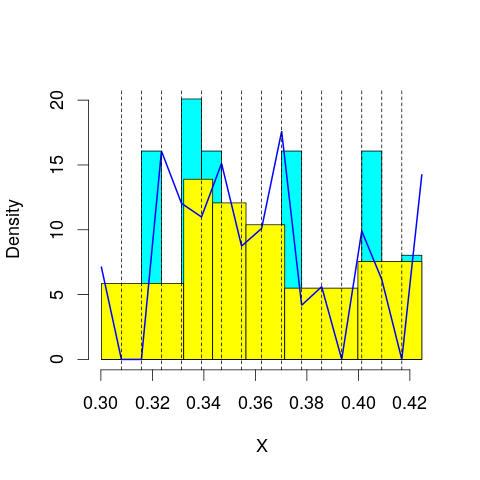

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.17322
mop.approx: Iteration 11. LL = 75.71455
mop.approx: Iteration 21. LL = 75.76476
mop.approx: Iteration 31. LL = 75.76933
mop.approx: Converged. Iteration 37. LL = 75.77013
[1] "Computing the linear combination of B-splines"


44.578504846
('best: ', 44.547963913708934, 'accepted difference:', 75.731538653305194, 'cur BIC:', 44.578504846028395)
m reached
('Sum of Probabilities:', 0.9746825712275943)
chosen


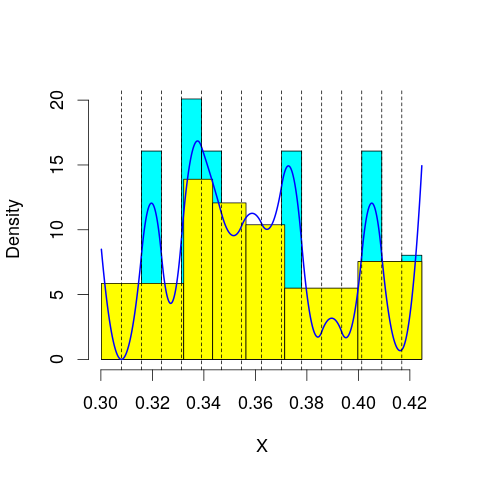

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.92115
mop.approx: Iteration 11. LL = 72.96787
mop.approx: Iteration 21. LL = 73.03334
mop.approx: Iteration 31. LL = 73.05068
mop.approx: Iteration 41. LL = 73.05512
mop.approx: Converged. Iteration 47. LL = 73.05596
[1] "Computing the linear combination of B-splines"


40.1314696075
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.653
mop.approx: Iteration 11. LL = 68.48794
mop.approx: Iteration 21. LL = 68.61244
mop.approx: Iteration 31. LL = 68.64879
mop.approx: Iteration 41. LL = 68.66246
mop.approx: Iteration 51. LL = 68.66824
mop.approx: Iteration 61. LL = 68.67083
mop.approx: Iteration 71. LL = 68.67202
mop.approx: Converged. Iteration 73. LL = 68.67224
[1] "Computing the linear combination of B-splines"


34.0148778556
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06832
mop.approx: Iteration 11. LL = 68.25483
mop.approx: Iteration 21. LL = 68.31291
mop.approx: Iteration 31. LL = 68.34685
mop.approx: Iteration 41. LL = 68.36853
mop.approx: Iteration 51. LL = 68.38248
mop.approx: Iteration 61. LL = 68.3918
mop.approx: Iteration 71. LL = 68.39831
mop.approx: Iteration 81. LL = 68.40301
mop.approx: Iteration 91. LL = 68.40648
mop.approx: Iteration 101. LL = 68.40908
mop.approx: Iteration 111. LL = 68.41104
mop.approx: Iteration 121. LL = 68.41253
mop.approx: Iteration 131. LL = 68.41367
mop.approx: Iteration 141. LL = 68.41454
mop.approx: Converged. Iteration 145. LL = 68.41489
[1] "Computing the linear combination of B-splines"


32.0246640181
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31499
mop.approx: Iteration 11. LL = 67.87929
mop.approx: Iteration 21. LL = 67.9401
mop.approx: Iteration 31. LL = 67.95785
mop.approx: Iteration 41. LL = 67.96533
mop.approx: Iteration 51. LL = 67.96939
mop.approx: Iteration 61. LL = 67.97199
mop.approx: Iteration 71. LL = 67.97384
mop.approx: Iteration 81. LL = 67.97524
mop.approx: Iteration 91. LL = 67.97632
mop.approx: Iteration 101. LL = 67.97719
mop.approx: Converged. Iteration 108. LL = 67.97777
[1] "Computing the linear combination of B-splines"


29.8546628276
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.177265
mop.approx: Iteration 11. LL = 67.91723
mop.approx: Iteration 21. LL = 67.9554
mop.approx: Iteration 31. LL = 67.97259
mop.approx: Iteration 41. LL = 67.98365
mop.approx: Iteration 51. LL = 67.99151
mop.approx: Iteration 61. LL = 67.99744
mop.approx: Iteration 71. LL = 68.00207
mop.approx: Iteration 81. LL = 68.00575
mop.approx: Iteration 91. LL = 68.0087
mop.approx: Iteration 101. LL = 68.01105
mop.approx: Iteration 111. LL = 68.01293
mop.approx: Iteration 121. LL = 68.01443
mop.approx: Iteration 131. LL = 68.01562
mop.approx: Iteration 141. LL = 68.01658
mop.approx: Iteration 151. LL = 68.01734
mop.approx: Converged. Iteration 151. LL = 68.01741
[1] "Computing the linear combination of B-splines"


28.1617101247
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.513823
mop.approx: Iteration 11. LL = 67.79099
mop.approx: Iteration 21. LL = 67.90356
mop.approx: Iteration 31. LL = 67.91986
mop.approx: Iteration 41. LL = 67.92527
mop.approx: Iteration 51. LL = 67.92818
mop.approx: Iteration 61. LL = 67.93018
mop.approx: Iteration 71. LL = 67.93173
mop.approx: Iteration 81. LL = 67.93302
mop.approx: Iteration 91. LL = 67.93412
mop.approx: Iteration 101. LL = 67.93508
mop.approx: Iteration 111. LL = 67.93592
mop.approx: Iteration 121. LL = 67.93665
mop.approx: Converged. Iteration 122. LL = 67.93679
[1] "Computing the linear combination of B-splines"


26.3407805878
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.42729
mop.approx: Iteration 11. LL = 76.16335
mop.approx: Iteration 21. LL = 76.2192
mop.approx: Iteration 31. LL = 76.22863
mop.approx: Iteration 41. LL = 76.23056
mop.approx: Converged. Iteration 41. LL = 76.23063
[1] "Computing the linear combination of B-splines"


45.0390075124
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 45.039007512375122)
m reached
('Sum of Probabilities:', 0.9887327185661312)
chosen


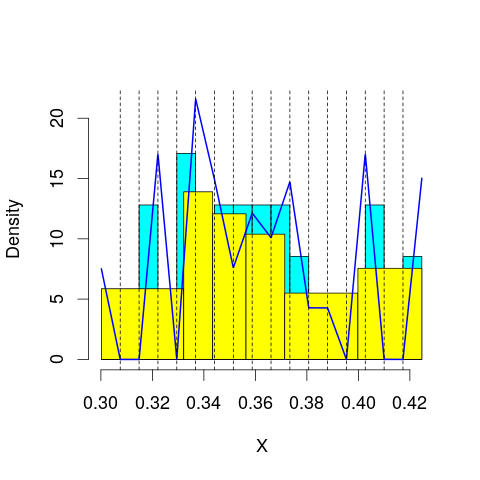

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.17322
mop.approx: Iteration 11. LL = 75.01057
mop.approx: Iteration 21. LL = 75.08988
mop.approx: Iteration 31. LL = 75.09667
mop.approx: Converged. Iteration 35. LL = 75.09717
[1] "Computing the linear combination of B-splines"


42.1726795546
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.92115
mop.approx: Iteration 11. LL = 74.37922
mop.approx: Iteration 21. LL = 74.52397
mop.approx: Iteration 31. LL = 74.55121
mop.approx: Iteration 41. LL = 74.5578
mop.approx: Iteration 51. LL = 74.55958
mop.approx: Converged. Iteration 53. LL = 74.55981
[1] "Computing the linear combination of B-splines"


39.9024492912
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.653
mop.approx: Iteration 11. LL = 68.2611
mop.approx: Iteration 21. LL = 68.32522
mop.approx: Iteration 31. LL = 68.34438
mop.approx: Iteration 41. LL = 68.35388
mop.approx: Iteration 51. LL = 68.36
mop.approx: Iteration 61. LL = 68.36436
mop.approx: Iteration 71. LL = 68.36758
mop.approx: Iteration 81. LL = 68.37001
mop.approx: Iteration 91. LL = 68.37186
mop.approx: Iteration 101. LL = 68.37328
mop.approx: Iteration 111. LL = 68.37437
mop.approx: Iteration 121. LL = 68.37523
mop.approx: Converged. Iteration 125. LL = 68.37559
[1] "Computing the linear combination of B-splines"


31.9853581063
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06832
mop.approx: Iteration 11. LL = 68.68941
mop.approx: Iteration 21. LL = 68.82375
mop.approx: Iteration 31. LL = 68.86759
mop.approx: Iteration 41. LL = 68.88344
mop.approx: Iteration 51. LL = 68.88951
mop.approx: Iteration 61. LL = 68.89195
mop.approx: Converged. Iteration 70. LL = 68.89297
[1] "Computing the linear combination of B-splines"


30.7698723032
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31499
mop.approx: Iteration 11. LL = 68.0766
mop.approx: Iteration 21. LL = 68.1123
mop.approx: Iteration 31. LL = 68.12344
mop.approx: Iteration 41. LL = 68.13117
mop.approx: Iteration 51. LL = 68.13744
mop.approx: Iteration 61. LL = 68.14269
mop.approx: Iteration 71. LL = 68.14713
mop.approx: Iteration 81. LL = 68.15091
mop.approx: Iteration 91. LL = 68.15417
mop.approx: Iteration 101. LL = 68.15698
mop.approx: Iteration 111. LL = 68.15943
mop.approx: Iteration 121. LL = 68.16159
mop.approx: Iteration 131. LL = 68.1635
mop.approx: Iteration 141. LL = 68.1652
mop.approx: Iteration 151. LL = 68.16672
mop.approx: Iteration 161. LL = 68.16808
mop.approx: Iteration 171. LL = 68.16931
mop.approx: Iteration 181. LL = 68.17043
mop.approx: Iteration 191. LL = 68.17143
mop.approx: Iteration 201. LL = 68.17234
mop.approx: Iteration 211. LL = 68.

28.3183048764
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.177265
mop.approx: Iteration 11. LL = 67.99245
mop.approx: Iteration 21. LL = 68.04725
mop.approx: Iteration 31. LL = 68.07581
mop.approx: Iteration 41. LL = 68.09247
mop.approx: Iteration 51. LL = 68.10265
mop.approx: Iteration 61. LL = 68.10915
mop.approx: Iteration 71. LL = 68.11351
mop.approx: Iteration 81. LL = 68.11657
mop.approx: Iteration 91. LL = 68.11881
mop.approx: Iteration 101. LL = 68.12052
mop.approx: Iteration 111. LL = 68.12188
mop.approx: Iteration 121. LL = 68.12297
mop.approx: Iteration 131. LL = 68.12388
mop.approx: Iteration 141. LL = 68.12464
mop.approx: Converged. Iteration 143. LL = 68.12485
[1] "Computing the linear combination of B-splines"


26.5353611723
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.513823
mop.approx: Iteration 11. LL = 68.05247
mop.approx: Iteration 21. LL = 68.13034
mop.approx: Iteration 31. LL = 68.14232
mop.approx: Iteration 41. LL = 68.14798
mop.approx: Iteration 51. LL = 68.15198
mop.approx: Iteration 61. LL = 68.1552
mop.approx: Iteration 71. LL = 68.15794
mop.approx: Iteration 81. LL = 68.16031
mop.approx: Iteration 91. LL = 68.16241
mop.approx: Iteration 101. LL = 68.16427
mop.approx: Iteration 111. LL = 68.16593
mop.approx: Iteration 121. LL = 68.16742
mop.approx: Iteration 131. LL = 68.16876
mop.approx: Iteration 141. LL = 68.16997
mop.approx: Iteration 151. LL = 68.17105
mop.approx: Iteration 161. LL = 68.17202
mop.approx: Iteration 171. LL = 68.17289
mop.approx: Iteration 181. LL = 68.17367
mop.approx: Converged. Iteration 188. LL = 68.17423
[1] "Computing the linear combination of B-splines"


24.8275457893
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.42729
mop.approx: Iteration 11. LL = 78.50061
mop.approx: Converged. Iteration 18. LL = 78.5055
[1] "Computing the linear combination of B-splines"


45.5810108234
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 45.5810108234041)
m reached
('Sum of Probabilities:', 0.9881536929034598)
chosen


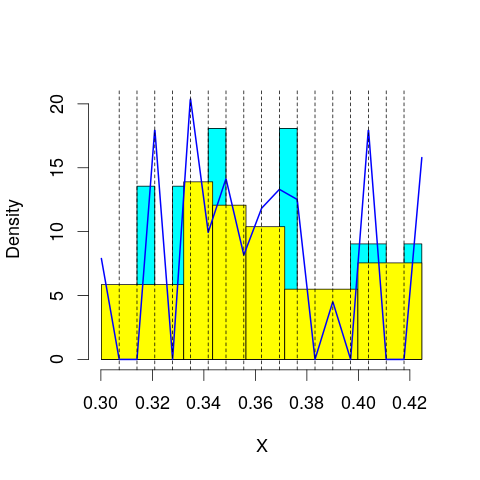

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.17322
mop.approx: Iteration 11. LL = 73.95811
mop.approx: Iteration 21. LL = 73.99238
mop.approx: Iteration 31. LL = 73.99562
mop.approx: Converged. Iteration 31. LL = 73.99569
[1] "Computing the linear combination of B-splines"


39.3383277585
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.92115
mop.approx: Iteration 11. LL = 75.42755
mop.approx: Iteration 21. LL = 75.4934
mop.approx: Iteration 31. LL = 75.50119
mop.approx: Iteration 41. LL = 75.50315
mop.approx: Converged. Iteration 44. LL = 75.50349
[1] "Computing the linear combination of B-splines"


39.1132617285
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.653
mop.approx: Iteration 11. LL = 68.31762
mop.approx: Iteration 21. LL = 68.49121
mop.approx: Iteration 31. LL = 68.55707
mop.approx: Iteration 41. LL = 68.58197
mop.approx: Iteration 51. LL = 68.59149
mop.approx: Iteration 61. LL = 68.5952
mop.approx: Iteration 71. LL = 68.5967
mop.approx: Converged. Iteration 75. LL = 68.59708
[1] "Computing the linear combination of B-splines"


30.473986193
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06832
mop.approx: Iteration 11. LL = 69.02628
mop.approx: Iteration 21. LL = 69.14673
mop.approx: Iteration 31. LL = 69.17449
mop.approx: Iteration 41. LL = 69.18233
mop.approx: Iteration 51. LL = 69.18497
mop.approx: Iteration 61. LL = 69.18608
mop.approx: Converged. Iteration 62. LL = 69.18622
[1] "Computing the linear combination of B-splines"


29.3302581599
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31499
mop.approx: Iteration 11. LL = 68.38374
mop.approx: Iteration 21. LL = 68.46883
mop.approx: Iteration 31. LL = 68.51411
mop.approx: Iteration 41. LL = 68.538
mop.approx: Iteration 51. LL = 68.55065
mop.approx: Iteration 61. LL = 68.55762
mop.approx: Iteration 71. LL = 68.56169
mop.approx: Iteration 81. LL = 68.5642
mop.approx: Iteration 91. LL = 68.56581
mop.approx: Iteration 101. LL = 68.56689
mop.approx: Converged. Iteration 108. LL = 68.5675
[1] "Computing the linear combination of B-splines"


26.9786251696
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.177265
mop.approx: Iteration 11. LL = 68.09048
mop.approx: Iteration 21. LL = 68.15177
mop.approx: Iteration 31. LL = 68.17486
mop.approx: Iteration 41. LL = 68.18728
mop.approx: Iteration 51. LL = 68.19558
mop.approx: Iteration 61. LL = 68.20179
mop.approx: Iteration 71. LL = 68.20672
mop.approx: Iteration 81. LL = 68.21076
mop.approx: Iteration 91. LL = 68.21415
mop.approx: Iteration 101. LL = 68.21703
mop.approx: Iteration 111. LL = 68.21951
mop.approx: Iteration 121. LL = 68.22165
mop.approx: Iteration 131. LL = 68.22353
mop.approx: Iteration 141. LL = 68.22517
mop.approx: Iteration 151. LL = 68.22663
mop.approx: Iteration 161. LL = 68.22792
mop.approx: Iteration 171. LL = 68.22907
mop.approx: Iteration 181. LL = 68.23009
mop.approx: Iteration 191. LL = 68.23102
mop.approx: Iteration 201. LL = 68.23184
mop.approx: Iteration 211. LL =

24.9109417851
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.513823
mop.approx: Iteration 11. LL = 68.21272
mop.approx: Iteration 21. LL = 68.257
mop.approx: Iteration 31. LL = 68.27169
mop.approx: Iteration 41. LL = 68.28212
mop.approx: Iteration 51. LL = 68.28954
mop.approx: Iteration 61. LL = 68.29479
mop.approx: Iteration 71. LL = 68.29854
mop.approx: Iteration 81. LL = 68.30133
mop.approx: Iteration 91. LL = 68.30348
mop.approx: Iteration 101. LL = 68.30522
mop.approx: Iteration 111. LL = 68.30668
mop.approx: Iteration 121. LL = 68.30793
mop.approx: Iteration 131. LL = 68.30904
mop.approx: Iteration 141. LL = 68.31001
mop.approx: Iteration 151. LL = 68.31089
mop.approx: Iteration 161. LL = 68.31168
mop.approx: Iteration 171. LL = 68.3124
mop.approx: Converged. Iteration 171. LL = 68.31247
[1] "Computing the linear combination of B-splines"


23.2468286309
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.42729
mop.approx: Iteration 11. LL = 79.09038
mop.approx: Iteration 21. LL = 79.10047
mop.approx: Converged. Iteration 22. LL = 79.10063
[1] "Computing the linear combination of B-splines"


44.4432712821
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 44.44327128210049)
m reached
('Sum of Probabilities:', 0.9875827357010395)
chosen


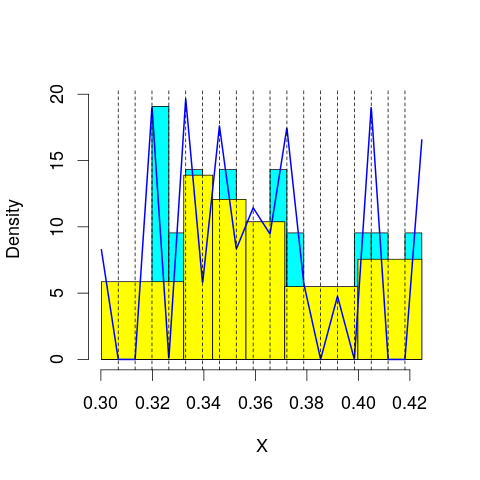

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.17322
mop.approx: Iteration 11. LL = 75.1324
mop.approx: Iteration 21. LL = 75.2124
mop.approx: Iteration 31. LL = 75.2225
mop.approx: Converged. Iteration 39. LL = 75.22403
[1] "Computing the linear combination of B-splines"


38.8337997243
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.92115
mop.approx: Iteration 11. LL = 75.83022
mop.approx: Iteration 21. LL = 75.9042
mop.approx: Iteration 31. LL = 75.91858
mop.approx: Iteration 41. LL = 75.92378
mop.approx: Iteration 51. LL = 75.92616
mop.approx: Iteration 61. LL = 75.92742
mop.approx: Converged. Iteration 65. LL = 75.92783
[1] "Computing the linear combination of B-splines"


37.8047310131
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.653
mop.approx: Iteration 11. LL = 69.0438
mop.approx: Iteration 21. LL = 69.1843
mop.approx: Iteration 31. LL = 69.2047
mop.approx: Iteration 41. LL = 69.20971
mop.approx: Iteration 51. LL = 69.21165
mop.approx: Iteration 61. LL = 69.21264
mop.approx: Converged. Iteration 62. LL = 69.21278
[1] "Computing the linear combination of B-splines"


29.3568154868
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06832
mop.approx: Iteration 11. LL = 69.21152
mop.approx: Iteration 21. LL = 69.35687
mop.approx: Iteration 31. LL = 69.40787
mop.approx: Iteration 41. LL = 69.43392
mop.approx: Iteration 51. LL = 69.44978
mop.approx: Iteration 61. LL = 69.4602
mop.approx: Iteration 71. LL = 69.46724
mop.approx: Iteration 81. LL = 69.47203
mop.approx: Iteration 91. LL = 69.47533
mop.approx: Iteration 101. LL = 69.47764
mop.approx: Iteration 111. LL = 69.4793
mop.approx: Iteration 121. LL = 69.48052
mop.approx: Iteration 131. LL = 69.48144
mop.approx: Converged. Iteration 137. LL = 69.48195
[1] "Computing the linear combination of B-splines"


27.8931244028
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31499
mop.approx: Iteration 11. LL = 68.78324
mop.approx: Iteration 21. LL = 68.90431
mop.approx: Iteration 31. LL = 68.93966
mop.approx: Iteration 41. LL = 68.95083
mop.approx: Iteration 51. LL = 68.95446
mop.approx: Iteration 61. LL = 68.9557
mop.approx: Converged. Iteration 61. LL = 68.95577
[1] "Computing the linear combination of B-splines"


25.6340047778
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.177265
mop.approx: Iteration 11. LL = 68.25132
mop.approx: Iteration 21. LL = 68.31147
mop.approx: Iteration 31. LL = 68.34026
mop.approx: Iteration 41. LL = 68.35931
mop.approx: Iteration 51. LL = 68.37249
mop.approx: Iteration 61. LL = 68.38173
mop.approx: Iteration 71. LL = 68.38829
mop.approx: Iteration 81. LL = 68.39303
mop.approx: Iteration 91. LL = 68.39655
mop.approx: Iteration 101. LL = 68.39924
mop.approx: Iteration 111. LL = 68.40136
mop.approx: Iteration 121. LL = 68.40307
mop.approx: Iteration 131. LL = 68.40448
mop.approx: Iteration 141. LL = 68.40566
mop.approx: Iteration 151. LL = 68.40667
mop.approx: Iteration 161. LL = 68.40753
mop.approx: Iteration 171. LL = 68.40828
mop.approx: Converged. Iteration 173. LL = 68.40849
[1] "Computing the linear combination of B-splines"


23.3511621219
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.513823
mop.approx: Iteration 11. LL = 68.10921
mop.approx: Iteration 21. LL = 68.1684
mop.approx: Iteration 31. LL = 68.19155
mop.approx: Iteration 41. LL = 68.2025
mop.approx: Iteration 51. LL = 68.20865
mop.approx: Iteration 61. LL = 68.21296
mop.approx: Iteration 71. LL = 68.21646
mop.approx: Iteration 81. LL = 68.21951
mop.approx: Iteration 91. LL = 68.22224
mop.approx: Iteration 101. LL = 68.22471
mop.approx: Iteration 111. LL = 68.22695
mop.approx: Iteration 121. LL = 68.22898
mop.approx: Iteration 131. LL = 68.2308
mop.approx: Iteration 141. LL = 68.23244
mop.approx: Iteration 151. LL = 68.2339
mop.approx: Iteration 161. LL = 68.23519
mop.approx: Iteration 171. LL = 68.23634
mop.approx: Iteration 181. LL = 68.23734
mop.approx: Iteration 191. LL = 68.23822
mop.approx: Iteration 201. LL = 68.23899
mop.approx: Converged. Iteration 20

21.3428064796
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.42729
mop.approx: Iteration 11. LL = 77.05417
mop.approx: Iteration 21. LL = 77.09328
mop.approx: Converged. Iteration 29. LL = 77.09528
[1] "Computing the linear combination of B-splines"


40.7050567312
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 40.705056731204067)
m reached
('Sum of Probabilities:', 0.9870196844408624)
chosen


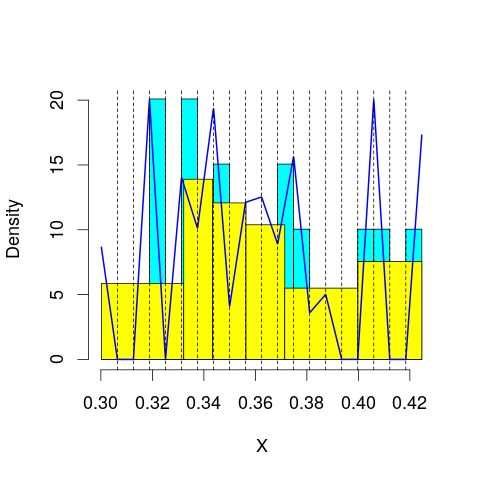

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.17322
mop.approx: Iteration 11. LL = 77.40095
mop.approx: Iteration 21. LL = 77.43296
mop.approx: Iteration 31. LL = 77.43618
mop.approx: Converged. Iteration 34. LL = 77.43654
[1] "Computing the linear combination of B-splines"


39.3134491298
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.92115
mop.approx: Iteration 11. LL = 75.21163
mop.approx: Iteration 21. LL = 75.32236
mop.approx: Iteration 31. LL = 75.33486
mop.approx: Converged. Iteration 40. LL = 75.33659
[1] "Computing the linear combination of B-splines"


35.4806239929
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.653
mop.approx: Iteration 11. LL = 70.25755
mop.approx: Iteration 21. LL = 70.42778
mop.approx: Iteration 31. LL = 70.48013
mop.approx: Iteration 41. LL = 70.50373
mop.approx: Iteration 51. LL = 70.51602
mop.approx: Iteration 61. LL = 70.52306
mop.approx: Iteration 71. LL = 70.52735
mop.approx: Iteration 81. LL = 70.53009
mop.approx: Iteration 91. LL = 70.5319
mop.approx: Iteration 101. LL = 70.53313
mop.approx: Iteration 111. LL = 70.53397
mop.approx: Converged. Iteration 111. LL = 70.53404
[1] "Computing the linear combination of B-splines"


28.94520759
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06832
mop.approx: Iteration 11. LL = 69.06927
mop.approx: Iteration 21. LL = 69.19921
mop.approx: Iteration 31. LL = 69.22884
mop.approx: Iteration 41. LL = 69.2387
mop.approx: Iteration 51. LL = 69.24347
mop.approx: Iteration 61. LL = 69.24627
mop.approx: Iteration 71. LL = 69.24805
mop.approx: Iteration 81. LL = 69.24923
mop.approx: Converged. Iteration 89. LL = 69.24996
[1] "Computing the linear combination of B-splines"


25.9282541191
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31499
mop.approx: Iteration 11. LL = 69.31708
mop.approx: Iteration 21. LL = 69.46403
mop.approx: Iteration 31. LL = 69.51316
mop.approx: Iteration 41. LL = 69.54053
mop.approx: Iteration 51. LL = 69.55881
mop.approx: Iteration 61. LL = 69.57161
mop.approx: Iteration 71. LL = 69.58068
mop.approx: Iteration 81. LL = 69.58713
mop.approx: Iteration 91. LL = 69.5917
mop.approx: Iteration 101. LL = 69.59495
mop.approx: Iteration 111. LL = 69.59725
mop.approx: Iteration 121. LL = 69.59888
mop.approx: Iteration 131. LL = 69.60004
mop.approx: Iteration 141. LL = 69.60086
mop.approx: Converged. Iteration 141. LL = 69.60093
[1] "Computing the linear combination of B-splines"


24.546355793
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.177265
mop.approx: Iteration 11. LL = 68.4309
mop.approx: Iteration 21. LL = 68.51028
mop.approx: Iteration 31. LL = 68.54636
mop.approx: Iteration 41. LL = 68.56362
mop.approx: Iteration 51. LL = 68.57234
mop.approx: Iteration 61. LL = 68.57702
mop.approx: Iteration 71. LL = 68.57964
mop.approx: Iteration 81. LL = 68.58113
mop.approx: Converged. Iteration 90. LL = 68.58201
[1] "Computing the linear combination of B-splines"


21.7921592811
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.513823
mop.approx: Iteration 11. LL = 68.31483
mop.approx: Iteration 21. LL = 68.38232
mop.approx: Iteration 31. LL = 68.41669
mop.approx: Iteration 41. LL = 68.43845
mop.approx: Iteration 51. LL = 68.45308
mop.approx: Iteration 61. LL = 68.46323
mop.approx: Iteration 71. LL = 68.47042
mop.approx: Iteration 81. LL = 68.47563
mop.approx: Iteration 91. LL = 68.47948
mop.approx: Iteration 101. LL = 68.48239
mop.approx: Iteration 111. LL = 68.48465
mop.approx: Iteration 121. LL = 68.48642
mop.approx: Iteration 131. LL = 68.48785
mop.approx: Iteration 141. LL = 68.48901
mop.approx: Iteration 151. LL = 68.48996
mop.approx: Iteration 161. LL = 68.49075
mop.approx: Converged. Iteration 164. LL = 68.49103
[1] "Computing the linear combination of B-splines"


19.8532288543
lfps_13
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.01747
mop.approx: Iteration 11. LL = 71.9305
mop.approx: Converged. Iteration 11. LL = 71.93054
[1] "Computing the linear combination of B-splines"


66.7319377439
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 66.731937743883023)
m reached
('Sum of Probabilities:', 0.9975774665633046)
chosen


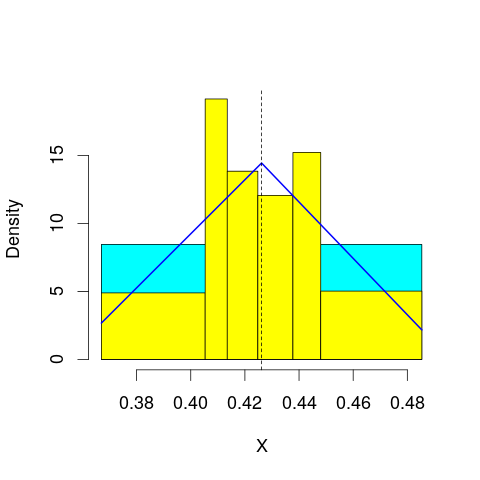

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.75051
mop.approx: Iteration 11. LL = 71.1537
mop.approx: Converged. Iteration 11. LL = 71.15374
[1] "Computing the linear combination of B-splines"


64.2222716781
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.48575
mop.approx: Iteration 11. LL = 72.72125
mop.approx: Iteration 21. LL = 73.30037
mop.approx: Iteration 31. LL = 73.44815
mop.approx: Iteration 41. LL = 73.49255
mop.approx: Iteration 51. LL = 73.50721
mop.approx: Iteration 61. LL = 73.51242
mop.approx: Iteration 71. LL = 73.51439
mop.approx: Converged. Iteration 76. LL = 73.51493
[1] "Computing the linear combination of B-splines"


64.8505947372
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.02625
mop.approx: Iteration 11. LL = 53.60733
mop.approx: Converged. Iteration 17. LL = 53.60818
[1] "Computing the linear combination of B-splines"


43.2109770113
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.3815
mop.approx: Iteration 11. LL = 58.2436
mop.approx: Converged. Iteration 16. LL = 58.2498
[1] "Computing the linear combination of B-splines"


46.1197219581
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.58476
mop.approx: Iteration 11. LL = 49.45479
mop.approx: Iteration 21. LL = 49.4578
mop.approx: Converged. Iteration 30. LL = 49.45865
[1] "Computing the linear combination of B-splines"


35.5957028121
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.41419
mop.approx: Iteration 11. LL = 53.10042
mop.approx: Converged. Iteration 20. LL = 53.13384
[1] "Computing the linear combination of B-splines"


37.5380245811
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.725035
mop.approx: Iteration 11. LL = 46.15068
mop.approx: Iteration 21. LL = 46.15453
mop.approx: Iteration 31. LL = 46.15634
mop.approx: Iteration 41. LL = 46.15721
mop.approx: Converged. Iteration 44. LL = 46.15742
[1] "Computing the linear combination of B-splines"


28.8287395815
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.01747
mop.approx: Converged. Iteration 6. LL = 71.99437
[1] "Computing the linear combination of B-splines"


65.0628979504
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 65.062897950369191)
m reached
('Sum of Probabilities:', 0.9977272013522416)
chosen


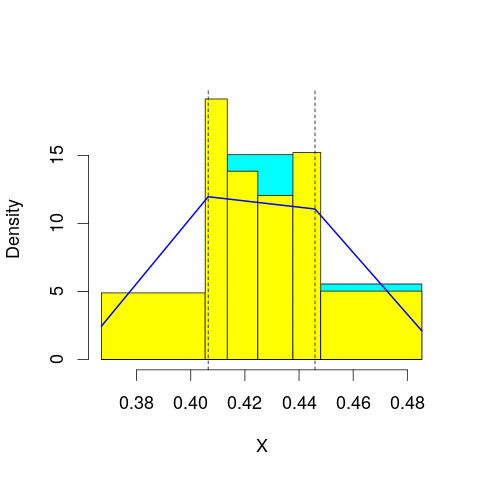

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.75051
mop.approx: Iteration 11. LL = 73.49707
mop.approx: Iteration 21. LL = 73.70346
mop.approx: Iteration 31. LL = 73.75236
mop.approx: Iteration 41. LL = 73.77106
mop.approx: Iteration 51. LL = 73.77989
mop.approx: Iteration 61. LL = 73.78452
mop.approx: Iteration 71. LL = 73.7871
mop.approx: Iteration 81. LL = 73.78859
mop.approx: Converged. Iteration 89. LL = 73.7894
[1] "Computing the linear combination of B-splines"


65.125062832
('best: ', 65.062897950369191, 'accepted difference:', 110.60692651562762, 'cur BIC:', 65.12506283195485)
m reached
('Sum of Probabilities:', 0.9927985984294823)
chosen


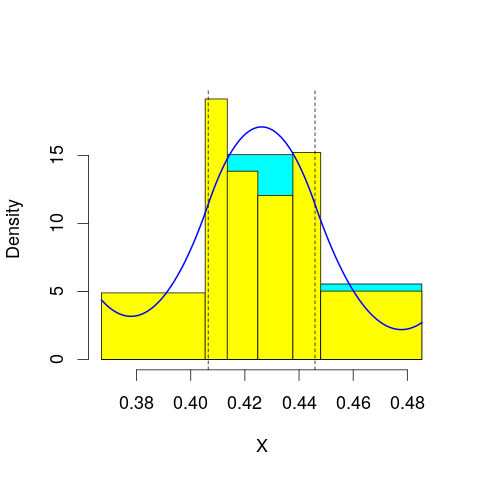

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.48575
mop.approx: Iteration 11. LL = 73.71801
mop.approx: Iteration 21. LL = 73.81164
mop.approx: Iteration 31. LL = 73.81954
mop.approx: Converged. Iteration 37. LL = 73.82041
[1] "Computing the linear combination of B-splines"


63.4232057644
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.02625
mop.approx: Iteration 11. LL = 68.43588
mop.approx: Converged. Iteration 16. LL = 68.44225
[1] "Computing the linear combination of B-splines"


56.3121713463
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.3815
mop.approx: Iteration 11. LL = 58.16354
mop.approx: Converged. Iteration 14. LL = 58.16387
[1] "Computing the linear combination of B-splines"


44.300927399
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.58476
mop.approx: Iteration 11. LL = 61.72743
mop.approx: Converged. Iteration 18. LL = 61.74014
[1] "Computing the linear combination of B-splines"


46.1443285183
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.41419
mop.approx: Iteration 11. LL = 53.10261
mop.approx: Iteration 21. LL = 53.10498
mop.approx: Converged. Iteration 24. LL = 53.10526
[1] "Computing the linear combination of B-splines"


35.7765801796
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.725035
mop.approx: Iteration 11. LL = 56.15826
mop.approx: Iteration 21. LL = 56.20189
mop.approx: Converged. Iteration 21. LL = 56.20192
[1] "Computing the linear combination of B-splines"


37.1403734435
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.01747
mop.approx: Iteration 11. LL = 72.3056
mop.approx: Converged. Iteration 12. LL = 72.30575
[1] "Computing the linear combination of B-splines"


63.6414084789
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 63.641408478923232)
m reached
('Sum of Probabilities:', 0.9970870587389149)
chosen


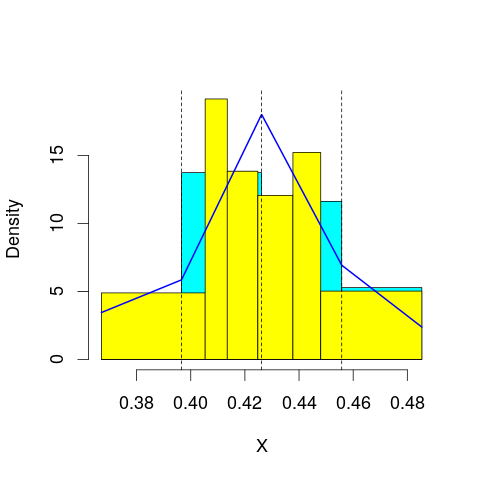

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.75051
mop.approx: Iteration 11. LL = 74.09105
mop.approx: Iteration 21. LL = 74.17716
mop.approx: Iteration 31. LL = 74.18784
mop.approx: Iteration 41. LL = 74.18988
mop.approx: Converged. Iteration 42. LL = 74.19004
[1] "Computing the linear combination of B-splines"


63.7928286164
('best: ', 63.641408478923232, 'accepted difference:', 108.19039441416949, 'cur BIC:', 63.792828616419783)
m reached
('Sum of Probabilities:', 0.9919852470392493)
chosen


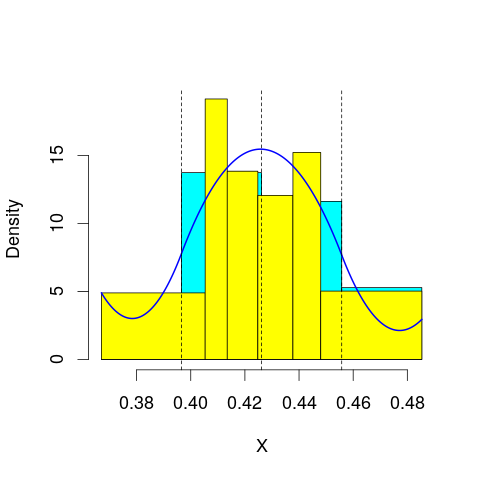

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.48575
mop.approx: Iteration 11. LL = 74.0371
mop.approx: Iteration 21. LL = 74.06288
mop.approx: Iteration 31. LL = 74.06564
mop.approx: Converged. Iteration 35. LL = 74.0661
[1] "Computing the linear combination of B-splines"


61.936024584
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.02625
mop.approx: Iteration 11. LL = 68.27172
mop.approx: Converged. Iteration 12. LL = 68.27184
[1] "Computing the linear combination of B-splines"


54.4088990472
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.3815
mop.approx: Iteration 11. LL = 70.3104
mop.approx: Iteration 21. LL = 70.34982
mop.approx: Converged. Iteration 21. LL = 70.34988
[1] "Computing the linear combination of B-splines"


54.7540673013
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.58476
mop.approx: Iteration 11. LL = 61.65143
mop.approx: Converged. Iteration 12. LL = 61.65155
[1] "Computing the linear combination of B-splines"


44.3228728573
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.41419
mop.approx: Iteration 11. LL = 64.40892
mop.approx: Converged. Iteration 19. LL = 64.43458
[1] "Computing the linear combination of B-splines"


45.3730320873
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.725035
mop.approx: Iteration 11. LL = 56.16546
mop.approx: Iteration 21. LL = 56.16727
mop.approx: Converged. Iteration 21. LL = 56.16732
[1] "Computing the linear combination of B-splines"


35.3729070039
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.01747
mop.approx: Iteration 11. LL = 74.04501
mop.approx: Converged. Iteration 13. LL = 74.04543
[1] "Computing the linear combination of B-splines"


63.6482187338
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 63.648218733775835)
m reached
('Sum of Probabilities:', 0.9961368824471765)
chosen


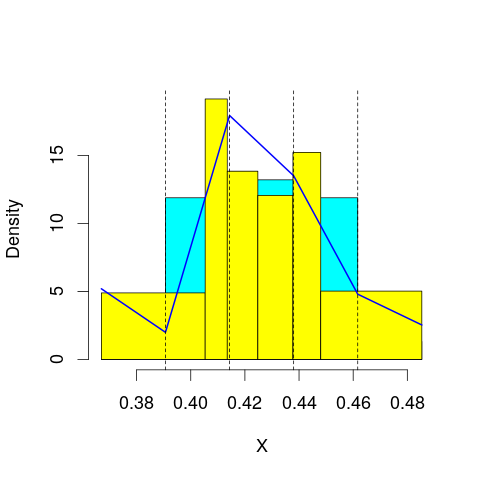

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.75051
mop.approx: Iteration 11. LL = 74.36672
mop.approx: Iteration 21. LL = 74.39189
mop.approx: Iteration 31. LL = 74.39493
mop.approx: Converged. Iteration 33. LL = 74.39517
[1] "Computing the linear combination of B-splines"


62.2650898316
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.48575
mop.approx: Iteration 11. LL = 74.37122
mop.approx: Iteration 21. LL = 74.37573
mop.approx: Iteration 31. LL = 74.37688
mop.approx: Converged. Iteration 35. LL = 74.37727
[1] "Computing the linear combination of B-splines"


60.5143297745
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.02625
mop.approx: Iteration 11. LL = 70.55811
mop.approx: Converged. Iteration 15. LL = 70.55972
[1] "Computing the linear combination of B-splines"


54.9639106435
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.3815
mop.approx: Iteration 11. LL = 70.2657
mop.approx: Converged. Iteration 16. LL = 70.2692
[1] "Computing the linear combination of B-splines"


52.940521414
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.58476
mop.approx: Iteration 11. LL = 71.17417
mop.approx: Iteration 21. LL = 71.3103
mop.approx: Converged. Iteration 30. LL = 71.31436
[1] "Computing the linear combination of B-splines"


52.2528109039
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.41419
mop.approx: Iteration 11. LL = 64.35853
mop.approx: Converged. Iteration 12. LL = 64.35864
[1] "Computing the linear combination of B-splines"


43.5642235749
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.725035
mop.approx: Iteration 11. LL = 66.4759
mop.approx: Iteration 21. LL = 66.52578
mop.approx: Converged. Iteration 21. LL = 66.52584
[1] "Computing the linear combination of B-splines"


43.998553745
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.01747
mop.approx: Iteration 11. LL = 75.43898
mop.approx: Iteration 21. LL = 75.46425
mop.approx: Converged. Iteration 24. LL = 75.46467
[1] "Computing the linear combination of B-splines"


63.334590265
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 63.334590265005289)
m reached
('Sum of Probabilities:', 0.9961745210771924)
chosen


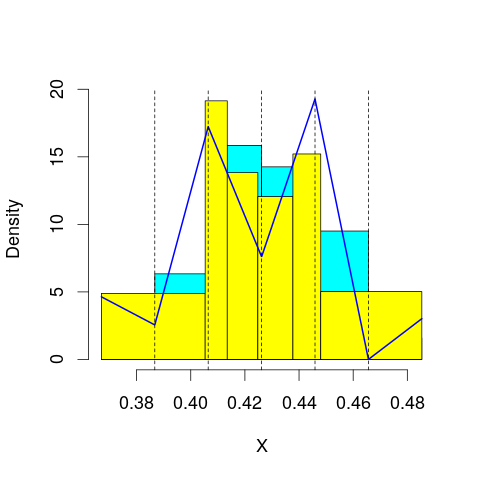

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.75051
mop.approx: Iteration 11. LL = 74.69188
mop.approx: Converged. Iteration 15. LL = 74.69246
[1] "Computing the linear combination of B-splines"


60.8295191715
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.48575
mop.approx: Iteration 11. LL = 75.15835
mop.approx: Iteration 21. LL = 75.32572
mop.approx: Iteration 31. LL = 75.35896
mop.approx: Iteration 41. LL = 75.36881
mop.approx: Iteration 51. LL = 75.37256
mop.approx: Iteration 61. LL = 75.37411
mop.approx: Converged. Iteration 64. LL = 75.37444
[1] "Computing the linear combination of B-splines"


59.7786277697
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.02625
mop.approx: Iteration 11. LL = 70.91505
mop.approx: Converged. Iteration 13. LL = 70.91536
[1] "Computing the linear combination of B-splines"


53.5866794773
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.3815
mop.approx: Iteration 11. LL = 70.87684
mop.approx: Converged. Iteration 16. LL = 70.87951
[1] "Computing the linear combination of B-splines"


51.8179648934
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.58476
mop.approx: Iteration 11. LL = 71.27713
mop.approx: Iteration 21. LL = 71.3101
mop.approx: Converged. Iteration 22. LL = 71.31026
[1] "Computing the linear combination of B-splines"


50.5158430269
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.41419
mop.approx: Iteration 11. LL = 71.33859
mop.approx: Iteration 21. LL = 71.5612
mop.approx: Iteration 31. LL = 71.59004
mop.approx: Iteration 41. LL = 71.5959
mop.approx: Iteration 51. LL = 71.59742
mop.approx: Converged. Iteration 51. LL = 71.59749
[1] "Computing the linear combination of B-splines"


49.0702066903
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.725035
mop.approx: Iteration 11. LL = 66.46523
mop.approx: Converged. Iteration 13. LL = 66.46556
[1] "Computing the linear combination of B-splines"


42.2054044188
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.01747
mop.approx: Iteration 11. LL = 75.16207
mop.approx: Converged. Iteration 13. LL = 75.16267
[1] "Computing the linear combination of B-splines"


61.299722474
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 61.299722473955121)
m reached
('Sum of Probabilities:', 0.9955964572981076)
chosen


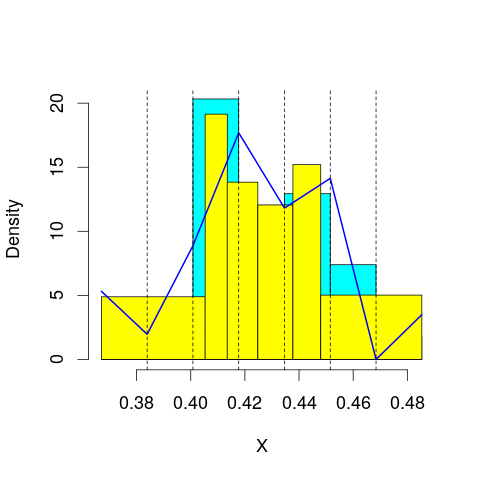

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.75051
mop.approx: Iteration 11. LL = 75.96752
mop.approx: Iteration 21. LL = 76.02269
mop.approx: Iteration 31. LL = 76.02998
mop.approx: Converged. Iteration 40. LL = 76.0314
[1] "Computing the linear combination of B-splines"


60.4355920745
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.48575
mop.approx: Iteration 11. LL = 75.36346
mop.approx: Iteration 21. LL = 75.40016
mop.approx: Iteration 31. LL = 75.40919
mop.approx: Iteration 41. LL = 75.41371
mop.approx: Iteration 51. LL = 75.41615
mop.approx: Iteration 61. LL = 75.41749
mop.approx: Converged. Iteration 66. LL = 75.418
[1] "Computing the linear combination of B-splines"


58.0893168484
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.02625
mop.approx: Iteration 11. LL = 72.19679
mop.approx: Iteration 21. LL = 72.31631
mop.approx: Iteration 31. LL = 72.34599
mop.approx: Iteration 41. LL = 72.3573
mop.approx: Iteration 51. LL = 72.36273
mop.approx: Iteration 61. LL = 72.36575
mop.approx: Iteration 71. LL = 72.36759
mop.approx: Iteration 81. LL = 72.3688
mop.approx: Converged. Iteration 90. LL = 72.36964
[1] "Computing the linear combination of B-splines"


53.3080890694
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.3815
mop.approx: Iteration 11. LL = 71.10965
mop.approx: Converged. Iteration 15. LL = 71.11115
[1] "Computing the linear combination of B-splines"


50.3167336876
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.58476
mop.approx: Iteration 11. LL = 71.30754
mop.approx: Converged. Iteration 20. LL = 71.32262
[1] "Computing the linear combination of B-splines"


48.795339044
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.41419
mop.approx: Iteration 11. LL = 71.53999
mop.approx: Iteration 21. LL = 71.64793
mop.approx: Iteration 31. LL = 71.65745
mop.approx: Converged. Iteration 37. LL = 71.65836
[1] "Computing the linear combination of B-splines"


47.3982078521
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.725035
mop.approx: Iteration 11. LL = 71.19861
mop.approx: Iteration 21. LL = 71.35252
mop.approx: Iteration 31. LL = 71.37485
mop.approx: Iteration 41. LL = 71.38133
mop.approx: Iteration 51. LL = 71.38397
mop.approx: Iteration 61. LL = 71.38529
mop.approx: Converged. Iteration 67. LL = 71.38586
[1] "Computing the linear combination of B-splines"


45.3928072878
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.01747
mop.approx: Iteration 11. LL = 77.24076
mop.approx: Converged. Iteration 17. LL = 77.24297
[1] "Computing the linear combination of B-splines"


61.6471602669
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 61.647160266910902)
m reached
('Sum of Probabilities:', 0.9954281261892566)
chosen


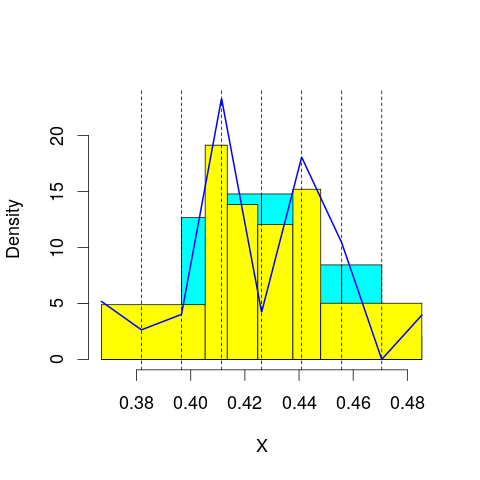

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.75051
mop.approx: Iteration 11. LL = 75.36019
mop.approx: Iteration 21. LL = 75.40983
mop.approx: Iteration 31. LL = 75.4211
mop.approx: Iteration 41. LL = 75.42539
mop.approx: Iteration 51. LL = 75.42749
mop.approx: Iteration 61. LL = 75.42867
mop.approx: Converged. Iteration 64. LL = 75.42899
[1] "Computing the linear combination of B-splines"


58.100311796
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.48575
mop.approx: Iteration 11. LL = 76.83915
mop.approx: Iteration 21. LL = 77.05696
mop.approx: Iteration 31. LL = 77.10761
mop.approx: Iteration 41. LL = 77.12456
mop.approx: Iteration 51. LL = 77.13162
mop.approx: Iteration 61. LL = 77.13512
mop.approx: Iteration 71. LL = 77.1371
mop.approx: Iteration 81. LL = 77.13833
mop.approx: Converged. Iteration 87. LL = 77.13892
[1] "Computing the linear combination of B-splines"


58.0773766096
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.02625
mop.approx: Iteration 11. LL = 72.16015
mop.approx: Iteration 21. LL = 72.19287
mop.approx: Iteration 31. LL = 72.2002
mop.approx: Iteration 41. LL = 72.20213
mop.approx: Converged. Iteration 43. LL = 72.20237
[1] "Computing the linear combination of B-splines"


51.4079522648
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.3815
mop.approx: Iteration 11. LL = 72.33047
mop.approx: Iteration 21. LL = 72.52107
mop.approx: Iteration 31. LL = 72.57543
mop.approx: Iteration 41. LL = 72.59562
mop.approx: Iteration 51. LL = 72.60401
mop.approx: Iteration 61. LL = 72.60768
mop.approx: Iteration 71. LL = 72.60932
mop.approx: Converged. Iteration 76. LL = 72.60983
[1] "Computing the linear combination of B-splines"


50.0825498772
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.58476
mop.approx: Iteration 11. LL = 71.44489
mop.approx: Iteration 21. LL = 71.45788
mop.approx: Converged. Iteration 23. LL = 71.45811
[1] "Computing the linear combination of B-splines"


47.1979530689
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.41419
mop.approx: Iteration 11. LL = 71.69403
mop.approx: Iteration 21. LL = 71.78276
mop.approx: Converged. Iteration 30. LL = 71.78623
[1] "Computing the linear combination of B-splines"


45.7932156306
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.725035
mop.approx: Iteration 11. LL = 71.37926
mop.approx: Iteration 21. LL = 71.46058
mop.approx: Iteration 31. LL = 71.47388
mop.approx: Iteration 41. LL = 71.47814
mop.approx: Iteration 51. LL = 71.47999
mop.approx: Iteration 61. LL = 71.48095
mop.approx: Converged. Iteration 61. LL = 71.48102
[1] "Computing the linear combination of B-splines"


43.7552864041
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.01747
mop.approx: Iteration 11. LL = 77.09645
mop.approx: Iteration 21. LL = 77.11835
mop.approx: Iteration 31. LL = 77.12256
mop.approx: Converged. Iteration 39. LL = 77.12364
[1] "Computing the linear combination of B-splines"


59.7949589568
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 59.794958956819769)
m reached
('Sum of Probabilities:', 0.9953844673618372)
chosen


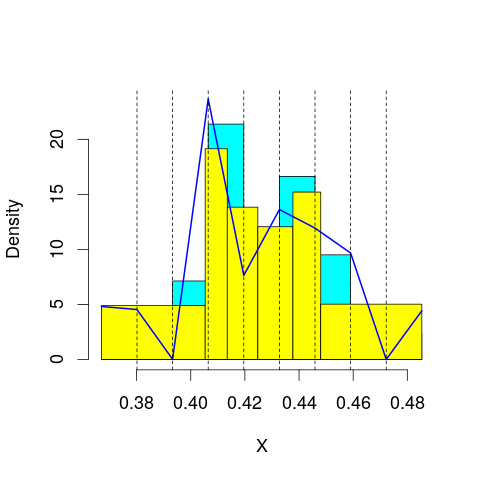

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.75051
mop.approx: Iteration 11. LL = 77.45881
mop.approx: Iteration 21. LL = 77.5393
mop.approx: Iteration 31. LL = 77.5534
mop.approx: Iteration 41. LL = 77.55826
mop.approx: Iteration 51. LL = 77.56045
mop.approx: Iteration 61. LL = 77.5616
mop.approx: Converged. Iteration 63. LL = 77.56183
[1] "Computing the linear combination of B-splines"


58.5002854595
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.48575
mop.approx: Iteration 11. LL = 76.62388
mop.approx: Iteration 21. LL = 76.69381
mop.approx: Iteration 31. LL = 76.70008
mop.approx: Converged. Iteration 35. LL = 76.70059
[1] "Computing the linear combination of B-splines"


55.9061727944
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.02625
mop.approx: Iteration 11. LL = 73.05704
mop.approx: Iteration 21. LL = 73.23323
mop.approx: Iteration 31. LL = 73.2823
mop.approx: Iteration 41. LL = 73.29895
mop.approx: Iteration 51. LL = 73.30503
mop.approx: Iteration 61. LL = 73.30731
mop.approx: Converged. Iteration 67. LL = 73.308
[1] "Computing the linear combination of B-splines"


50.7807124526
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.3815
mop.approx: Iteration 11. LL = 72.49466
mop.approx: Iteration 21. LL = 72.53363
mop.approx: Iteration 31. LL = 72.54457
mop.approx: Iteration 41. LL = 72.54996
mop.approx: Iteration 51. LL = 72.55283
mop.approx: Iteration 61. LL = 72.55443
mop.approx: Iteration 71. LL = 72.55537
mop.approx: Converged. Iteration 71. LL = 72.55544
[1] "Computing the linear combination of B-splines"


48.2952869191
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.58476
mop.approx: Iteration 11. LL = 72.39675
mop.approx: Iteration 21. LL = 72.58951
mop.approx: Iteration 31. LL = 72.64246
mop.approx: Iteration 41. LL = 72.65969
mop.approx: Iteration 51. LL = 72.66561
mop.approx: Iteration 61. LL = 72.66768
mop.approx: Converged. Iteration 66. LL = 72.6682
[1] "Computing the linear combination of B-splines"


46.6751800442
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.41419
mop.approx: Iteration 11. LL = 71.77643
mop.approx: Iteration 21. LL = 71.82302
mop.approx: Iteration 31. LL = 71.82581
mop.approx: Converged. Iteration 32. LL = 71.82595
[1] "Computing the linear combination of B-splines"


44.1000141523
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.725035
mop.approx: Iteration 11. LL = 71.90296
mop.approx: Iteration 21. LL = 72.13944
mop.approx: Iteration 31. LL = 72.18124
mop.approx: Iteration 41. LL = 72.19002
mop.approx: Iteration 51. LL = 72.19242
mop.approx: Converged. Iteration 57. LL = 72.19308
[1] "Computing the linear combination of B-splines"


42.7347085225
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.01747
mop.approx: Iteration 11. LL = 78.12826
mop.approx: Iteration 21. LL = 78.17379
mop.approx: Iteration 31. LL = 78.18268
mop.approx: Iteration 41. LL = 78.18558
mop.approx: Converged. Iteration 50. LL = 78.18671
[1] "Computing the linear combination of B-splines"


59.125165463
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 59.125165463011022)
m reached
('Sum of Probabilities:', 0.9951311770335121)
chosen


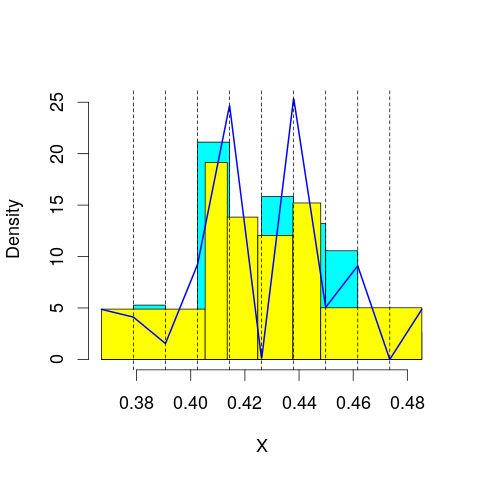

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.75051
mop.approx: Iteration 11. LL = 78.4946
mop.approx: Iteration 21. LL = 78.58825
mop.approx: Iteration 31. LL = 78.598
mop.approx: Iteration 41. LL = 78.60001
mop.approx: Converged. Iteration 44. LL = 78.60035
[1] "Computing the linear combination of B-splines"


57.8059363
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.48575
mop.approx: Iteration 11. LL = 77.40955
mop.approx: Iteration 21. LL = 77.52054
mop.approx: Iteration 31. LL = 77.54492
mop.approx: Iteration 41. LL = 77.5511
mop.approx: Iteration 51. LL = 77.55279
mop.approx: Converged. Iteration 52. LL = 77.55295
[1] "Computing the linear combination of B-splines"


55.0256621397
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.02625
mop.approx: Iteration 11. LL = 73.25529
mop.approx: Iteration 21. LL = 73.39158
mop.approx: Iteration 31. LL = 73.433
mop.approx: Iteration 41. LL = 73.44948
mop.approx: Iteration 51. LL = 73.45729
mop.approx: Iteration 61. LL = 73.4616
mop.approx: Iteration 71. LL = 73.46425
mop.approx: Iteration 81. LL = 73.46599
mop.approx: Iteration 91. LL = 73.46719
mop.approx: Converged. Iteration 100. LL = 73.46805
[1] "Computing the linear combination of B-splines"


49.2078944245
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.3815
mop.approx: Iteration 11. LL = 73.04842
mop.approx: Iteration 21. LL = 73.21422
mop.approx: Iteration 31. LL = 73.26234
mop.approx: Iteration 41. LL = 73.27708
mop.approx: Iteration 51. LL = 73.2816
mop.approx: Iteration 61. LL = 73.28299
mop.approx: Converged. Iteration 61. LL = 73.28306
[1] "Computing the linear combination of B-splines"


47.2900364958
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.58476
mop.approx: Iteration 11. LL = 72.70691
mop.approx: Iteration 21. LL = 72.77009
mop.approx: Iteration 31. LL = 72.77534
mop.approx: Iteration 41. LL = 72.77666
mop.approx: Converged. Iteration 47. LL = 72.77723
[1] "Computing the linear combination of B-splines"


45.0513304929
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.41419
mop.approx: Iteration 11. LL = 72.45235
mop.approx: Iteration 21. LL = 72.63641
mop.approx: Iteration 31. LL = 72.68565
mop.approx: Iteration 41. LL = 72.70078
mop.approx: Iteration 51. LL = 72.70562
mop.approx: Iteration 61. LL = 72.7072
mop.approx: Converged. Iteration 62. LL = 72.70735
[1] "Computing the linear combination of B-splines"


43.2484975407
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.725035
mop.approx: Iteration 11. LL = 72.02725
mop.approx: Iteration 21. LL = 72.13331
mop.approx: Iteration 31. LL = 72.14404
mop.approx: Iteration 41. LL = 72.14616
mop.approx: Converged. Iteration 44. LL = 72.14648
[1] "Computing the linear combination of B-splines"


40.9543957511
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.01747
mop.approx: Iteration 11. LL = 77.59635
mop.approx: Iteration 21. LL = 77.63946
mop.approx: Iteration 31. LL = 77.65735
mop.approx: Iteration 41. LL = 77.66574
mop.approx: Iteration 51. LL = 77.67003
mop.approx: Iteration 61. LL = 77.67235
mop.approx: Iteration 71. LL = 77.67365
mop.approx: Converged. Iteration 75. LL = 77.67407
[1] "Computing the linear combination of B-splines"


56.879650193
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 56.879650193010249)
m reached
('Sum of Probabilities:', 0.9946856938025642)
chosen


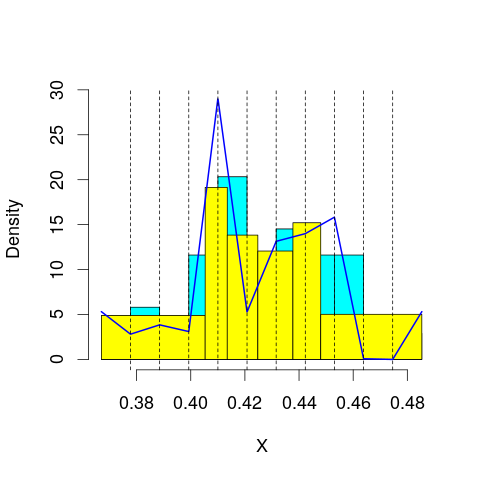

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.75051
mop.approx: Iteration 11. LL = 78.82727
mop.approx: Iteration 21. LL = 78.92076
mop.approx: Iteration 31. LL = 78.93269
mop.approx: Converged. Iteration 40. LL = 78.93456
[1] "Computing the linear combination of B-splines"


56.407279479
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.48575
mop.approx: Iteration 11. LL = 78.43573
mop.approx: Iteration 21. LL = 78.67251
mop.approx: Iteration 31. LL = 78.71379
mop.approx: Iteration 41. LL = 78.72249
mop.approx: Iteration 51. LL = 78.72473
mop.approx: Converged. Iteration 54. LL = 78.72508
[1] "Computing the linear combination of B-splines"


54.4649329968
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.02625
mop.approx: Iteration 11. LL = 73.40907
mop.approx: Iteration 21. LL = 73.55984
mop.approx: Iteration 31. LL = 73.58551
mop.approx: Iteration 41. LL = 73.58973
mop.approx: Converged. Iteration 46. LL = 73.59034
[1] "Computing the linear combination of B-splines"


47.5973212473
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.3815
mop.approx: Iteration 11. LL = 73.73811
mop.approx: Iteration 21. LL = 73.94896
mop.approx: Iteration 31. LL = 74.00573
mop.approx: Iteration 41. LL = 74.02389
mop.approx: Iteration 51. LL = 74.03004
mop.approx: Iteration 61. LL = 74.0322
mop.approx: Converged. Iteration 66. LL = 74.03276
[1] "Computing the linear combination of B-splines"


46.306870417
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.58476
mop.approx: Iteration 11. LL = 72.90868
mop.approx: Iteration 21. LL = 73.04334
mop.approx: Iteration 31. LL = 73.0836
mop.approx: Iteration 41. LL = 73.09657
mop.approx: Iteration 51. LL = 73.10067
mop.approx: Converged. Iteration 60. LL = 73.10195
[1] "Computing the linear combination of B-splines"


43.6431783869
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.41419
mop.approx: Iteration 11. LL = 72.86982
mop.approx: Iteration 21. LL = 72.97732
mop.approx: Iteration 31. LL = 72.99527
mop.approx: Iteration 41. LL = 73.00051
mop.approx: Iteration 51. LL = 73.00293
mop.approx: Iteration 61. LL = 73.00449
mop.approx: Iteration 71. LL = 73.0057
mop.approx: Iteration 81. LL = 73.00669
mop.approx: Iteration 91. LL = 73.00753
mop.approx: Converged. Iteration 95. LL = 73.0079
[1] "Computing the linear combination of B-splines"


41.816422042
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.725035
mop.approx: Iteration 11. LL = 72.50731
mop.approx: Iteration 21. LL = 72.67428
mop.approx: Iteration 31. LL = 72.71905
mop.approx: Iteration 41. LL = 72.73355
mop.approx: Iteration 51. LL = 72.73858
mop.approx: Iteration 61. LL = 72.74045
mop.approx: Converged. Iteration 66. LL = 72.74098
[1] "Computing the linear combination of B-splines"


39.8193460682
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.01747
mop.approx: Iteration 11. LL = 78.33042
mop.approx: Iteration 21. LL = 78.36068
mop.approx: Iteration 31. LL = 78.36725
mop.approx: Iteration 41. LL = 78.36962
mop.approx: Converged. Iteration 49. LL = 78.37057
[1] "Computing the linear combination of B-splines"


55.8432902456
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 55.843290245612295)
m reached
('Sum of Probabilities:', 0.9942470448250993)
chosen


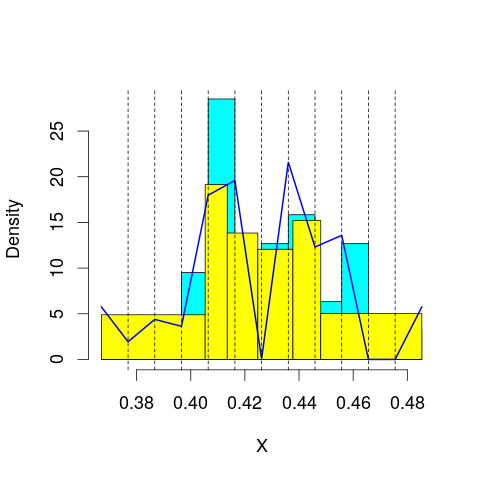

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.75051
mop.approx: Iteration 11. LL = 79.90844
mop.approx: Iteration 21. LL = 79.99805
mop.approx: Iteration 31. LL = 80.0164
mop.approx: Iteration 41. LL = 80.02269
mop.approx: Iteration 51. LL = 80.02556
mop.approx: Iteration 61. LL = 80.02711
mop.approx: Converged. Iteration 69. LL = 80.02796
[1] "Computing the linear combination of B-splines"


55.7678062001
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.48575
mop.approx: Iteration 11. LL = 78.79432
mop.approx: Iteration 21. LL = 78.91481
mop.approx: Iteration 31. LL = 78.92636
mop.approx: Converged. Iteration 37. LL = 78.92744
[1] "Computing the linear combination of B-splines"


52.9344168979
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.02625
mop.approx: Iteration 11. LL = 74.15747
mop.approx: Iteration 21. LL = 74.3311
mop.approx: Iteration 31. LL = 74.36902
mop.approx: Iteration 41. LL = 74.38227
mop.approx: Iteration 51. LL = 74.38891
mop.approx: Iteration 61. LL = 74.39287
mop.approx: Iteration 71. LL = 74.39545
mop.approx: Iteration 81. LL = 74.39722
mop.approx: Iteration 91. LL = 74.39848
mop.approx: Iteration 101. LL = 74.3994
mop.approx: Converged. Iteration 103. LL = 74.39963
[1] "Computing the linear combination of B-splines"


46.6737390109
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.3815
mop.approx: Iteration 11. LL = 73.85163
mop.approx: Iteration 21. LL = 74.03314
mop.approx: Iteration 31. LL = 74.06546
mop.approx: Iteration 41. LL = 74.07105
mop.approx: Converged. Iteration 47. LL = 74.07187
[1] "Computing the linear combination of B-splines"


44.6131143841
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.58476
mop.approx: Iteration 11. LL = 73.73092
mop.approx: Iteration 21. LL = 73.97369
mop.approx: Iteration 31. LL = 74.03305
mop.approx: Iteration 41. LL = 74.04969
mop.approx: Iteration 51. LL = 74.05443
mop.approx: Converged. Iteration 60. LL = 74.05579
[1] "Computing the linear combination of B-splines"


42.8641766031
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.41419
mop.approx: Iteration 11. LL = 72.82926
mop.approx: Iteration 21. LL = 72.94241
mop.approx: Iteration 31. LL = 72.97957
mop.approx: Iteration 41. LL = 72.99196
mop.approx: Iteration 51. LL = 72.99598
mop.approx: Iteration 61. LL = 72.99728
mop.approx: Converged. Iteration 61. LL = 72.99735
[1] "Computing the linear combination of B-splines"


40.0723246106
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.725035
mop.approx: Iteration 11. LL = 72.99729
mop.approx: Iteration 21. LL = 73.12877
mop.approx: Iteration 31. LL = 73.15762
mop.approx: Iteration 41. LL = 73.16839
mop.approx: Iteration 51. LL = 73.1737
mop.approx: Iteration 61. LL = 73.17671
mop.approx: Iteration 71. LL = 73.17854
mop.approx: Iteration 81. LL = 73.17969
mop.approx: Converged. Iteration 86. LL = 73.18017
[1] "Computing the linear combination of B-splines"


38.5049189273
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.01747
mop.approx: Iteration 11. LL = 80.20654
mop.approx: Iteration 21. LL = 80.21849
mop.approx: Iteration 31. LL = 80.22115
mop.approx: Converged. Iteration 38. LL = 80.222
[1] "Computing the linear combination of B-splines"


55.9618494724
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 55.961849472377288)
m reached
('Sum of Probabilities:', 0.9938150740296909)
chosen


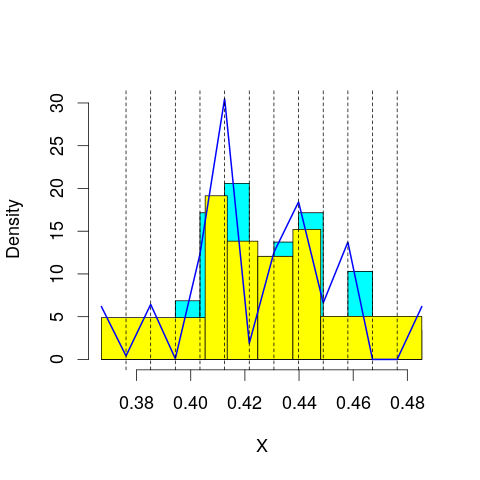

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.75051
mop.approx: Iteration 11. LL = 78.87586
mop.approx: Iteration 21. LL = 78.92775
mop.approx: Iteration 31. LL = 78.9414
mop.approx: Iteration 41. LL = 78.94677
mop.approx: Iteration 51. LL = 78.94946
mop.approx: Iteration 61. LL = 78.95106
mop.approx: Iteration 71. LL = 78.9521
mop.approx: Converged. Iteration 73. LL = 78.95235
[1] "Computing the linear combination of B-splines"


52.9593273538
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.48575
mop.approx: Iteration 11. LL = 79.85802
mop.approx: Iteration 21. LL = 79.97398
mop.approx: Iteration 31. LL = 79.99639
mop.approx: Iteration 41. LL = 80.00417
mop.approx: Iteration 51. LL = 80.00768
mop.approx: Iteration 61. LL = 80.00951
mop.approx: Iteration 71. LL = 80.01059
mop.approx: Converged. Iteration 72. LL = 80.01076
[1] "Computing the linear combination of B-splines"


52.2848682643
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.02625
mop.approx: Iteration 11. LL = 74.23914
mop.approx: Iteration 21. LL = 74.47852
mop.approx: Iteration 31. LL = 74.54122
mop.approx: Iteration 41. LL = 74.55739
mop.approx: Iteration 51. LL = 74.5612
mop.approx: Converged. Iteration 56. LL = 74.56185
[1] "Computing the linear combination of B-splines"


45.1030983126
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.3815
mop.approx: Iteration 11. LL = 74.53245
mop.approx: Iteration 21. LL = 74.73532
mop.approx: Iteration 31. LL = 74.78637
mop.approx: Iteration 41. LL = 74.80604
mop.approx: Iteration 51. LL = 74.81495
mop.approx: Iteration 61. LL = 74.81922
mop.approx: Iteration 71. LL = 74.82131
mop.approx: Converged. Iteration 80. LL = 74.82235
[1] "Computing the linear combination of B-splines"


43.6307269202
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.58476
mop.approx: Iteration 11. LL = 74.06095
mop.approx: Iteration 21. LL = 74.28171
mop.approx: Iteration 31. LL = 74.32179
mop.approx: Iteration 41. LL = 74.33096
mop.approx: Iteration 51. LL = 74.33335
mop.approx: Converged. Iteration 55. LL = 74.33378
[1] "Computing the linear combination of B-splines"


41.4092885663
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.41419
mop.approx: Iteration 11. LL = 73.48424
mop.approx: Iteration 21. LL = 73.75802
mop.approx: Iteration 31. LL = 73.82359
mop.approx: Iteration 41. LL = 73.84378
mop.approx: Iteration 51. LL = 73.85158
mop.approx: Iteration 61. LL = 73.85522
mop.approx: Iteration 71. LL = 73.85712
mop.approx: Iteration 81. LL = 73.8582
mop.approx: Converged. Iteration 83. LL = 73.85842
[1] "Computing the linear combination of B-splines"


39.1997691104
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.725035
mop.approx: Iteration 11. LL = 73.03008
mop.approx: Iteration 21. LL = 73.10175
mop.approx: Iteration 31. LL = 73.12703
mop.approx: Iteration 41. LL = 73.13815
mop.approx: Iteration 51. LL = 73.14296
mop.approx: Iteration 61. LL = 73.145
mop.approx: Converged. Iteration 68. LL = 73.14574
[1] "Computing the linear combination of B-splines"


36.7377847128
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.01747
mop.approx: Iteration 11. LL = 81.40965
mop.approx: Iteration 21. LL = 81.46605
mop.approx: Iteration 31. LL = 81.47426
mop.approx: Iteration 41. LL = 81.47644
mop.approx: Converged. Iteration 44. LL = 81.47682
[1] "Computing the linear combination of B-splines"


55.48380074
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 55.483800739995942)
m reached
('Sum of Probabilities:', 0.9933896300611519)
chosen


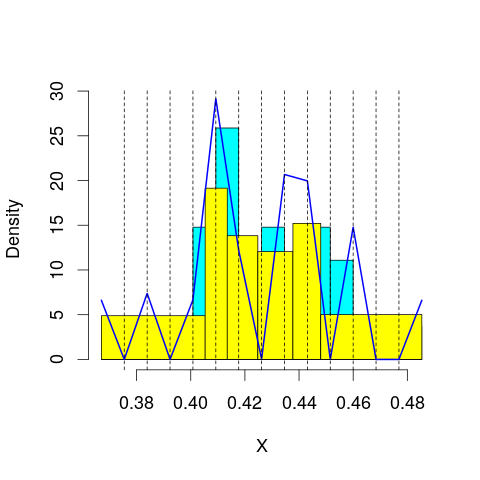

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.75051
mop.approx: Iteration 11. LL = 80.16139
mop.approx: Iteration 21. LL = 80.1923
mop.approx: Converged. Iteration 24. LL = 80.19277
[1] "Computing the linear combination of B-splines"


52.466884079
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.48575
mop.approx: Iteration 11. LL = 79.97487
mop.approx: Iteration 21. LL = 80.09409
mop.approx: Iteration 31. LL = 80.12157
mop.approx: Iteration 41. LL = 80.1297
mop.approx: Iteration 51. LL = 80.1324
mop.approx: Converged. Iteration 58. LL = 80.13326
[1] "Computing the linear combination of B-splines"


50.6745085106
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.02625
mop.approx: Iteration 11. LL = 75.12513
mop.approx: Iteration 21. LL = 75.27799
mop.approx: Iteration 31. LL = 75.30408
mop.approx: Iteration 41. LL = 75.31327
mop.approx: Iteration 51. LL = 75.31753
mop.approx: Iteration 61. LL = 75.31982
mop.approx: Iteration 71. LL = 75.32119
mop.approx: Converged. Iteration 80. LL = 75.32207
[1] "Computing the linear combination of B-splines"


44.1304499774
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.3815
mop.approx: Iteration 11. LL = 74.71255
mop.approx: Iteration 21. LL = 74.88467
mop.approx: Iteration 31. LL = 74.92309
mop.approx: Iteration 41. LL = 74.93641
mop.approx: Iteration 51. LL = 74.94238
mop.approx: Iteration 61. LL = 74.94574
mop.approx: Iteration 71. LL = 74.94796
mop.approx: Iteration 81. LL = 74.94958
mop.approx: Iteration 91. LL = 74.95082
mop.approx: Iteration 101. LL = 74.95179
mop.approx: Converged. Iteration 108. LL = 74.95243
[1] "Computing the linear combination of B-splines"


42.0279355373
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.58476
mop.approx: Iteration 11. LL = 74.59773
mop.approx: Iteration 21. LL = 74.84507
mop.approx: Iteration 31. LL = 74.91325
mop.approx: Iteration 41. LL = 74.93957
mop.approx: Iteration 51. LL = 74.95083
mop.approx: Iteration 61. LL = 74.95574
mop.approx: Iteration 71. LL = 74.95788
mop.approx: Converged. Iteration 78. LL = 74.95867
[1] "Computing the linear combination of B-splines"


40.3013437103
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.41419
mop.approx: Iteration 11. LL = 74.02589
mop.approx: Iteration 21. LL = 74.34395
mop.approx: Iteration 31. LL = 74.41237
mop.approx: Iteration 41. LL = 74.43361
mop.approx: Iteration 51. LL = 74.44225
mop.approx: Iteration 61. LL = 74.44643
mop.approx: Iteration 71. LL = 74.44871
mop.approx: Iteration 81. LL = 74.45007
mop.approx: Converged. Iteration 89. LL = 74.45087
[1] "Computing the linear combination of B-splines"


38.0598709245
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.725035
mop.approx: Iteration 11. LL = 73.15816
mop.approx: Iteration 21. LL = 73.42009
mop.approx: Iteration 31. LL = 73.51318
mop.approx: Iteration 41. LL = 73.554
mop.approx: Iteration 51. LL = 73.5754
mop.approx: Iteration 61. LL = 73.58788
mop.approx: Iteration 71. LL = 73.59558
mop.approx: Iteration 81. LL = 73.60048
mop.approx: Iteration 91. LL = 73.60364
mop.approx: Iteration 101. LL = 73.6057
mop.approx: Iteration 111. LL = 73.60704
mop.approx: Converged. Iteration 120. LL = 73.60791
[1] "Computing the linear combination of B-splines"


35.4126665053
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.01747
mop.approx: Iteration 11. LL = 81.56121
mop.approx: Iteration 21. LL = 81.60131
mop.approx: Converged. Iteration 28. LL = 81.60322
[1] "Computing the linear combination of B-splines"


53.8773357663
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 53.877335766276403)
m reached
('Sum of Probabilities:', 0.9929705661038077)
chosen


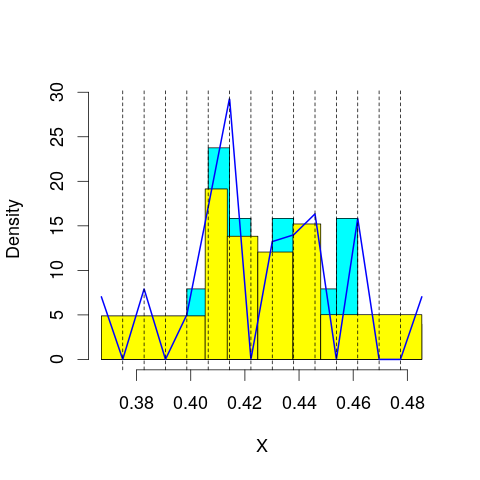

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.75051
mop.approx: Iteration 11. LL = 81.02325
mop.approx: Iteration 21. LL = 81.07538
mop.approx: Iteration 31. LL = 81.08827
mop.approx: Iteration 41. LL = 81.09303
mop.approx: Iteration 51. LL = 81.09511
mop.approx: Converged. Iteration 58. LL = 81.09595
[1] "Computing the linear combination of B-splines"


51.6371917457
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.48575
mop.approx: Iteration 11. LL = 79.87629
mop.approx: Iteration 21. LL = 79.96979
mop.approx: Iteration 31. LL = 79.9975
mop.approx: Iteration 41. LL = 80.00894
mop.approx: Iteration 51. LL = 80.01392
mop.approx: Iteration 61. LL = 80.01615
mop.approx: Converged. Iteration 69. LL = 80.01709
[1] "Computing the linear combination of B-splines"


48.8254668031
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.02625
mop.approx: Iteration 11. LL = 75.82324
mop.approx: Iteration 21. LL = 75.93634
mop.approx: Iteration 31. LL = 75.95942
mop.approx: Iteration 41. LL = 75.96764
mop.approx: Iteration 51. LL = 75.97124
mop.approx: Iteration 61. LL = 75.97307
mop.approx: Iteration 71. LL = 75.97412
mop.approx: Converged. Iteration 73. LL = 75.97435
[1] "Computing the linear combination of B-splines"


43.0498573358
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.3815
mop.approx: Iteration 11. LL = 74.68326
mop.approx: Iteration 21. LL = 74.82192
mop.approx: Iteration 31. LL = 74.87554
mop.approx: Iteration 41. LL = 74.90878
mop.approx: Iteration 51. LL = 74.93093
mop.approx: Iteration 61. LL = 74.94572
mop.approx: Iteration 71. LL = 74.95552
mop.approx: Iteration 81. LL = 74.962
mop.approx: Iteration 91. LL = 74.96626
mop.approx: Iteration 101. LL = 74.96906
mop.approx: Iteration 111. LL = 74.9709
mop.approx: Iteration 121. LL = 74.97211
mop.approx: Converged. Iteration 128. LL = 74.97278
[1] "Computing the linear combination of B-splines"


40.3154209161
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.58476
mop.approx: Iteration 11. LL = 75.15725
mop.approx: Iteration 21. LL = 75.40887
mop.approx: Iteration 31. LL = 75.46915
mop.approx: Iteration 41. LL = 75.49287
mop.approx: Iteration 51. LL = 75.50478
mop.approx: Iteration 61. LL = 75.51164
mop.approx: Iteration 71. LL = 75.51589
mop.approx: Iteration 81. LL = 75.51861
mop.approx: Iteration 91. LL = 75.52039
mop.approx: Iteration 101. LL = 75.52158
mop.approx: Converged. Iteration 108. LL = 75.52226
[1] "Computing the linear combination of B-splines"


39.1320082396
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.41419
mop.approx: Iteration 11. LL = 74.41029
mop.approx: Iteration 21. LL = 74.68039
mop.approx: Iteration 31. LL = 74.75835
mop.approx: Iteration 41. LL = 74.7911
mop.approx: Iteration 51. LL = 74.80683
mop.approx: Iteration 61. LL = 74.81482
mop.approx: Iteration 71. LL = 74.81902
mop.approx: Iteration 81. LL = 74.82132
mop.approx: Iteration 91. LL = 74.82264
mop.approx: Converged. Iteration 97. LL = 74.82324
[1] "Computing the linear combination of B-splines"


36.6987865107
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.725035
mop.approx: Iteration 11. LL = 73.91044
mop.approx: Iteration 21. LL = 74.2852
mop.approx: Iteration 31. LL = 74.38769
mop.approx: Iteration 41. LL = 74.42154
mop.approx: Iteration 51. LL = 74.43559
mop.approx: Iteration 61. LL = 74.44245
mop.approx: Iteration 71. LL = 74.44611
mop.approx: Iteration 81. LL = 74.44813
mop.approx: Iteration 91. LL = 74.44927
mop.approx: Converged. Iteration 93. LL = 74.44951
[1] "Computing the linear combination of B-splines"


34.6248032679
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.01747
mop.approx: Iteration 11. LL = 80.23072
mop.approx: Iteration 21. LL = 80.31743
mop.approx: Iteration 31. LL = 80.33242
mop.approx: Iteration 41. LL = 80.33524
mop.approx: Converged. Iteration 43. LL = 80.33551
[1] "Computing the linear combination of B-splines"


50.876751952
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 50.87675195199413)
m reached
('Sum of Probabilities:', 0.9925577397125832)
chosen


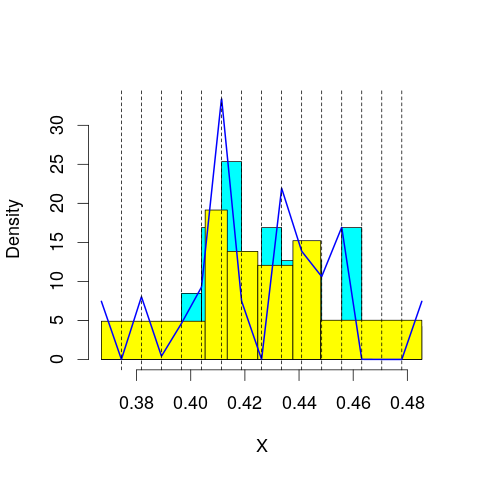

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.75051
mop.approx: Iteration 11. LL = 82.06216
mop.approx: Iteration 21. LL = 82.09045
mop.approx: Converged. Iteration 30. LL = 82.09269
[1] "Computing the linear combination of B-splines"


50.9010647995
('best: ', 50.87675195199413, 'accepted difference:', 86.490478318390018, 'cur BIC:', 50.90106479948841)
m reached
('Sum of Probabilities:', 0.9808408169768041)
chosen


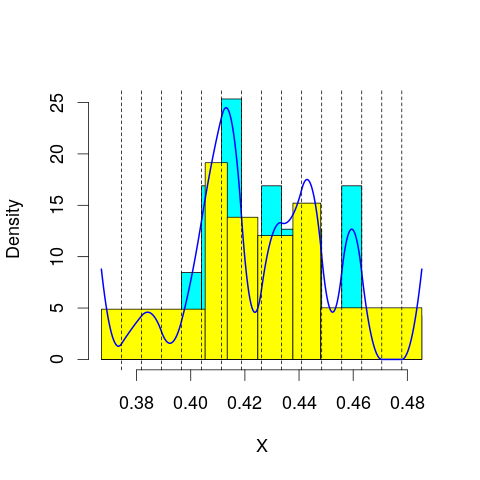

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.48575
mop.approx: Iteration 11. LL = 80.3713
mop.approx: Iteration 21. LL = 80.50442
mop.approx: Iteration 31. LL = 80.5236
mop.approx: Iteration 41. LL = 80.5278
mop.approx: Iteration 51. LL = 80.52922
mop.approx: Converged. Iteration 52. LL = 80.52939
[1] "Computing the linear combination of B-splines"


47.6048963941
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.02625
mop.approx: Iteration 11. LL = 75.90912
mop.approx: Iteration 21. LL = 75.99779
mop.approx: Iteration 31. LL = 76.00983
mop.approx: Iteration 41. LL = 76.01207
mop.approx: Converged. Iteration 43. LL = 76.01231
[1] "Computing the linear combination of B-splines"


41.3549551412
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.3815
mop.approx: Iteration 11. LL = 75.56328
mop.approx: Iteration 21. LL = 75.80259
mop.approx: Iteration 31. LL = 75.84884
mop.approx: Iteration 41. LL = 75.86592
mop.approx: Iteration 51. LL = 75.87429
mop.approx: Iteration 61. LL = 75.87874
mop.approx: Iteration 71. LL = 75.88118
mop.approx: Iteration 81. LL = 75.88253
mop.approx: Converged. Iteration 86. LL = 75.88304
[1] "Computing the linear combination of B-splines"


39.4928154726
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.58476
mop.approx: Iteration 11. LL = 75.05504
mop.approx: Iteration 21. LL = 75.19138
mop.approx: Iteration 31. LL = 75.22068
mop.approx: Iteration 41. LL = 75.23244
mop.approx: Iteration 51. LL = 75.2387
mop.approx: Iteration 61. LL = 75.24245
mop.approx: Iteration 71. LL = 75.24481
mop.approx: Iteration 81. LL = 75.24633
mop.approx: Iteration 91. LL = 75.24734
mop.approx: Converged. Iteration 93. LL = 75.24756
[1] "Computing the linear combination of B-splines"


37.1245234071
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.41419
mop.approx: Iteration 11. LL = 75.15958
mop.approx: Iteration 21. LL = 75.45373
mop.approx: Iteration 31. LL = 75.51612
mop.approx: Iteration 41. LL = 75.53515
mop.approx: Iteration 51. LL = 75.54237
mop.approx: Iteration 61. LL = 75.54553
mop.approx: Iteration 71. LL = 75.54703
mop.approx: Converged. Iteration 76. LL = 75.54754
[1] "Computing the linear combination of B-splines"


35.6913998051
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.725035
mop.approx: Iteration 11. LL = 74.58424
mop.approx: Iteration 21. LL = 74.96065
mop.approx: Iteration 31. LL = 75.05259
mop.approx: Iteration 41. LL = 75.07991
mop.approx: Iteration 51. LL = 75.08879
mop.approx: Iteration 61. LL = 75.09186
mop.approx: Converged. Iteration 70. LL = 75.09297
[1] "Computing the linear combination of B-splines"


33.378381826
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.01747
mop.approx: Iteration 11. LL = 82.75531
mop.approx: Converged. Iteration 20. LL = 82.76349
[1] "Computing the linear combination of B-splines"


51.5718718332
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 51.57187183317582)
m reached
('Sum of Probabilities:', 0.9921510126514528)
chosen


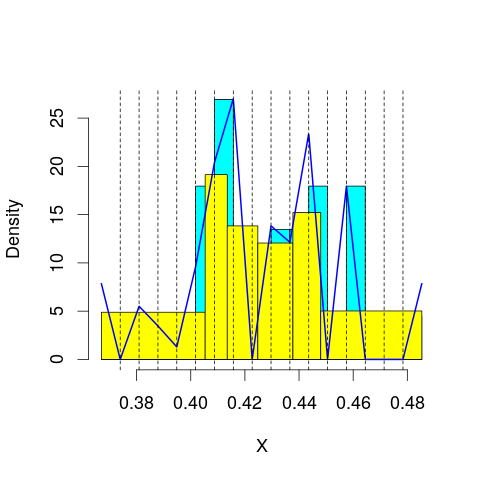

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.75051
mop.approx: Iteration 11. LL = 81.9805
mop.approx: Iteration 21. LL = 82.02951
mop.approx: Iteration 31. LL = 82.0329
mop.approx: Converged. Iteration 31. LL = 82.03298
[1] "Computing the linear combination of B-splines"


49.1084908069
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.48575
mop.approx: Iteration 11. LL = 81.33682
mop.approx: Iteration 21. LL = 81.37713
mop.approx: Converged. Iteration 25. LL = 81.37802
[1] "Computing the linear combination of B-splines"


46.7206597906
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.02625
mop.approx: Iteration 11. LL = 76.18815
mop.approx: Iteration 21. LL = 76.34859
mop.approx: Iteration 31. LL = 76.38666
mop.approx: Iteration 41. LL = 76.39676
mop.approx: Iteration 51. LL = 76.39983
mop.approx: Converged. Iteration 60. LL = 76.40096
[1] "Computing the linear combination of B-splines"


40.0107339773
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.3815
mop.approx: Iteration 11. LL = 75.82896
mop.approx: Iteration 21. LL = 75.92399
mop.approx: Iteration 31. LL = 75.93537
mop.approx: Converged. Iteration 40. LL = 75.93716
[1] "Computing the linear combination of B-splines"


37.8140641733
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.58476
mop.approx: Iteration 11. LL = 75.37378
mop.approx: Iteration 21. LL = 75.51493
mop.approx: Iteration 31. LL = 75.53801
mop.approx: Iteration 41. LL = 75.54322
mop.approx: Iteration 51. LL = 75.54482
mop.approx: Converged. Iteration 55. LL = 75.54524
[1] "Computing the linear combination of B-splines"


35.6891275748
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.41419
mop.approx: Iteration 11. LL = 75.2735
mop.approx: Iteration 21. LL = 75.45521
mop.approx: Iteration 31. LL = 75.49543
mop.approx: Iteration 41. LL = 75.50952
mop.approx: Iteration 51. LL = 75.51551
mop.approx: Iteration 61. LL = 75.51835
mop.approx: Iteration 71. LL = 75.51981
mop.approx: Converged. Iteration 77. LL = 75.52042
[1] "Computing the linear combination of B-splines"


33.9311338804
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.725035
mop.approx: Iteration 11. LL = 74.34943
mop.approx: Iteration 21. LL = 74.59415
mop.approx: Iteration 31. LL = 74.64352
mop.approx: Iteration 41. LL = 74.65985
mop.approx: Iteration 51. LL = 74.667
mop.approx: Iteration 61. LL = 74.67081
mop.approx: Iteration 71. LL = 74.67317
mop.approx: Iteration 81. LL = 74.67477
mop.approx: Iteration 91. LL = 74.67594
mop.approx: Iteration 101. LL = 74.67681
mop.approx: Converged. Iteration 102. LL = 74.67696
[1] "Computing the linear combination of B-splines"


31.2079656367
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.01747
mop.approx: Iteration 11. LL = 84.90991
mop.approx: Iteration 21. LL = 84.92501
mop.approx: Converged. Iteration 22. LL = 84.9252
[1] "Computing the linear combination of B-splines"


52.0007121039
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 52.000712103895978)
m reached
('Sum of Probabilities:', 0.9917502507392675)
chosen


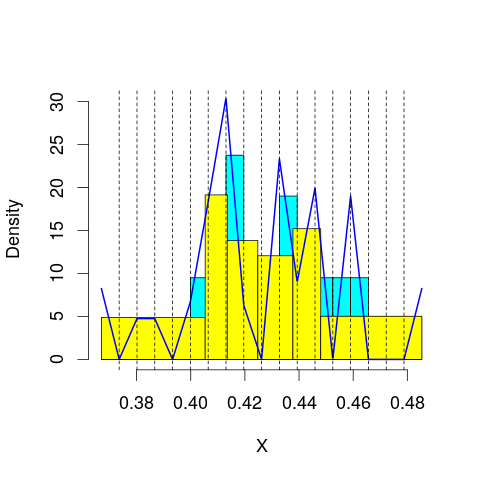

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.75051
mop.approx: Iteration 11. LL = 80.98876
mop.approx: Iteration 21. LL = 81.07002
mop.approx: Iteration 31. LL = 81.08678
mop.approx: Iteration 41. LL = 81.09386
mop.approx: Iteration 51. LL = 81.09751
mop.approx: Iteration 61. LL = 81.09956
mop.approx: Iteration 71. LL = 81.10077
mop.approx: Converged. Iteration 74. LL = 81.1011
[1] "Computing the linear combination of B-splines"


46.443742035
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.48575
mop.approx: Iteration 11. LL = 82.28552
mop.approx: Iteration 21. LL = 82.34868
mop.approx: Iteration 31. LL = 82.3546
mop.approx: Converged. Iteration 34. LL = 82.35503
[1] "Computing the linear combination of B-splines"


45.9648076116
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.02625
mop.approx: Iteration 11. LL = 76.02006
mop.approx: Iteration 21. LL = 76.19603
mop.approx: Iteration 31. LL = 76.25036
mop.approx: Iteration 41. LL = 76.26916
mop.approx: Iteration 51. LL = 76.27656
mop.approx: Iteration 61. LL = 76.27975
mop.approx: Iteration 71. LL = 76.28121
mop.approx: Converged. Iteration 74. LL = 76.28155
[1] "Computing the linear combination of B-splines"


38.1584533227
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.3815
mop.approx: Iteration 11. LL = 76.50953
mop.approx: Iteration 21. LL = 76.67639
mop.approx: Iteration 31. LL = 76.7035
mop.approx: Iteration 41. LL = 76.70827
mop.approx: Converged. Iteration 46. LL = 76.70896
[1] "Computing the linear combination of B-splines"


36.8529961761
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.58476
mop.approx: Iteration 11. LL = 75.46795
mop.approx: Iteration 21. LL = 75.67768
mop.approx: Iteration 31. LL = 75.73433
mop.approx: Iteration 41. LL = 75.75431
mop.approx: Iteration 51. LL = 75.76359
mop.approx: Iteration 61. LL = 75.76886
mop.approx: Iteration 71. LL = 75.7722
mop.approx: Iteration 81. LL = 75.77442
mop.approx: Iteration 91. LL = 75.77592
mop.approx: Iteration 101. LL = 75.77696
mop.approx: Converged. Iteration 104. LL = 75.77727
[1] "Computing the linear combination of B-splines"


34.1881858914
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.41419
mop.approx: Iteration 11. LL = 75.63957
mop.approx: Iteration 21. LL = 75.81025
mop.approx: Iteration 31. LL = 75.84671
mop.approx: Iteration 41. LL = 75.85885
mop.approx: Iteration 51. LL = 75.86371
mop.approx: Iteration 61. LL = 75.86582
mop.approx: Converged. Iteration 69. LL = 75.86673
[1] "Computing the linear combination of B-splines"


32.5424206395
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.725035
mop.approx: Iteration 11. LL = 76.06803
mop.approx: Iteration 21. LL = 76.38087
mop.approx: Iteration 31. LL = 76.44502
mop.approx: Iteration 41. LL = 76.46816
mop.approx: Iteration 51. LL = 76.47926
mop.approx: Iteration 61. LL = 76.48523
mop.approx: Iteration 71. LL = 76.48857
mop.approx: Iteration 81. LL = 76.49046
mop.approx: Iteration 91. LL = 76.49152
mop.approx: Converged. Iteration 92. LL = 76.49167
[1] "Computing the linear combination of B-splines"


31.4752192692
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.01747
mop.approx: Iteration 11. LL = 83.24308
mop.approx: Converged. Iteration 14. LL = 83.24411
[1] "Computing the linear combination of B-splines"


48.5867530666
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 48.586753066627899)
m reached
('Sum of Probabilities:', 0.991355323702026)
chosen


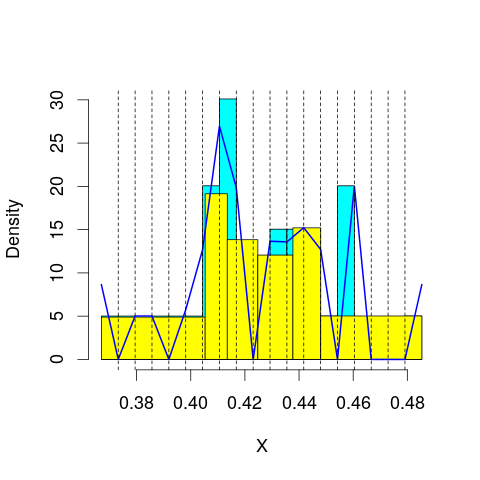

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.75051
mop.approx: Iteration 11. LL = 83.33615
mop.approx: Iteration 21. LL = 83.39821
mop.approx: Iteration 31. LL = 83.40292
mop.approx: Converged. Iteration 37. LL = 83.40367
[1] "Computing the linear combination of B-splines"


47.0134465182
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.48575
mop.approx: Iteration 11. LL = 81.6448
mop.approx: Iteration 21. LL = 81.68314
mop.approx: Converged. Iteration 27. LL = 81.68464
[1] "Computing the linear combination of B-splines"


43.561541254
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.02625
mop.approx: Iteration 11. LL = 77.51083
mop.approx: Iteration 21. LL = 77.64281
mop.approx: Iteration 31. LL = 77.66358
mop.approx: Iteration 41. LL = 77.67036
mop.approx: Iteration 51. LL = 77.67324
mop.approx: Iteration 61. LL = 77.67462
mop.approx: Converged. Iteration 64. LL = 77.67496
[1] "Computing the linear combination of B-splines"


37.8189945114
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.3815
mop.approx: Iteration 11. LL = 76.27985
mop.approx: Iteration 21. LL = 76.42277
mop.approx: Iteration 31. LL = 76.46157
mop.approx: Iteration 41. LL = 76.47542
mop.approx: Iteration 51. LL = 76.48164
mop.approx: Iteration 61. LL = 76.48491
mop.approx: Iteration 71. LL = 76.48679
mop.approx: Iteration 81. LL = 76.48795
mop.approx: Converged. Iteration 85. LL = 76.48836
[1] "Computing the linear combination of B-splines"


34.8995199112
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.58476
mop.approx: Iteration 11. LL = 76.29697
mop.approx: Iteration 21. LL = 76.48112
mop.approx: Iteration 31. LL = 76.50451
mop.approx: Iteration 41. LL = 76.50985
mop.approx: Iteration 51. LL = 76.51205
mop.approx: Iteration 61. LL = 76.51326
mop.approx: Converged. Iteration 64. LL = 76.51359
[1] "Computing the linear combination of B-splines"


33.1915628637
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.41419
mop.approx: Iteration 11. LL = 75.57143
mop.approx: Iteration 21. LL = 75.71033
mop.approx: Iteration 31. LL = 75.7625
mop.approx: Iteration 41. LL = 75.79251
mop.approx: Iteration 51. LL = 75.81163
mop.approx: Iteration 61. LL = 75.82442
mop.approx: Iteration 71. LL = 75.83322
mop.approx: Iteration 81. LL = 75.83937
mop.approx: Iteration 91. LL = 75.84372
mop.approx: Iteration 101. LL = 75.84683
mop.approx: Iteration 111. LL = 75.84907
mop.approx: Iteration 121. LL = 75.85071
mop.approx: Iteration 131. LL = 75.85191
mop.approx: Iteration 141. LL = 75.8528
mop.approx: Converged. Iteration 142. LL = 75.85295
[1] "Computing the linear combination of B-splines"


30.7901618245
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.725035
mop.approx: Iteration 11. LL = 75.30884
mop.approx: Iteration 21. LL = 75.4919
mop.approx: Iteration 31. LL = 75.549
mop.approx: Iteration 41. LL = 75.57914
mop.approx: Iteration 51. LL = 75.59732
mop.approx: Iteration 61. LL = 75.60872
mop.approx: Iteration 71. LL = 75.61601
mop.approx: Iteration 81. LL = 75.62072
mop.approx: Iteration 91. LL = 75.62381
mop.approx: Iteration 101. LL = 75.62586
mop.approx: Iteration 111. LL = 75.62726
mop.approx: Iteration 121. LL = 75.62821
mop.approx: Converged. Iteration 122. LL = 75.62837
[1] "Computing the linear combination of B-splines"


28.5370560752
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.01747
mop.approx: Iteration 11. LL = 82.8821
mop.approx: Iteration 21. LL = 82.95238
mop.approx: Iteration 31. LL = 82.96839
mop.approx: Iteration 41. LL = 82.97307
mop.approx: Converged. Iteration 50. LL = 82.97452
[1] "Computing the linear combination of B-splines"


46.5842910237
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 46.584291023657656)
m reached
('Sum of Probabilities:', 0.9909661050317866)
chosen


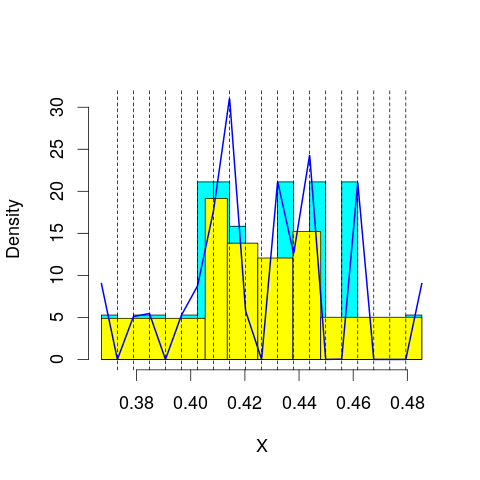

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.75051
mop.approx: Iteration 11. LL = 83.48563
mop.approx: Iteration 21. LL = 83.51174
mop.approx: Converged. Iteration 27. LL = 83.51295
[1] "Computing the linear combination of B-splines"


45.3898514323
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.48575
mop.approx: Iteration 11. LL = 82.11117
mop.approx: Iteration 21. LL = 82.21688
mop.approx: Iteration 31. LL = 82.2376
mop.approx: Iteration 41. LL = 82.24719
mop.approx: Iteration 51. LL = 82.25244
mop.approx: Iteration 61. LL = 82.25548
mop.approx: Iteration 71. LL = 82.25729
mop.approx: Iteration 81. LL = 82.2584
mop.approx: Converged. Iteration 82. LL = 82.25856
[1] "Computing the linear combination of B-splines"


42.4025975234
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.02625
mop.approx: Iteration 11. LL = 77.45213
mop.approx: Iteration 21. LL = 77.50361
mop.approx: Iteration 31. LL = 77.51122
mop.approx: Converged. Iteration 40. LL = 77.51272
[1] "Computing the linear combination of B-splines"


35.9238903486
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.3815
mop.approx: Iteration 11. LL = 76.75682
mop.approx: Iteration 21. LL = 76.92387
mop.approx: Iteration 31. LL = 76.94397
mop.approx: Iteration 41. LL = 76.94833
mop.approx: Iteration 51. LL = 76.95004
mop.approx: Converged. Iteration 59. LL = 76.95088
[1] "Computing the linear combination of B-splines"


33.6291665394
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.58476
mop.approx: Iteration 11. LL = 76.48663
mop.approx: Iteration 21. LL = 76.6142
mop.approx: Iteration 31. LL = 76.64515
mop.approx: Iteration 41. LL = 76.65695
mop.approx: Iteration 51. LL = 76.66203
mop.approx: Iteration 61. LL = 76.66444
mop.approx: Iteration 71. LL = 76.66568
mop.approx: Converged. Iteration 74. LL = 76.66601
[1] "Computing the linear combination of B-splines"


31.611403807
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.41419
mop.approx: Iteration 11. LL = 75.79637
mop.approx: Iteration 21. LL = 75.9923
mop.approx: Iteration 31. LL = 76.04473
mop.approx: Iteration 41. LL = 76.06415
mop.approx: Iteration 51. LL = 76.07405
mop.approx: Iteration 61. LL = 76.08009
mop.approx: Iteration 71. LL = 76.08412
mop.approx: Iteration 81. LL = 76.08693
mop.approx: Iteration 91. LL = 76.08897
mop.approx: Iteration 101. LL = 76.09048
mop.approx: Iteration 111. LL = 76.09162
mop.approx: Iteration 121. LL = 76.0925
mop.approx: Converged. Iteration 122. LL = 76.09265
[1] "Computing the linear combination of B-splines"


29.2877805287
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.725035
mop.approx: Iteration 11. LL = 76.57896
mop.approx: Iteration 21. LL = 76.82873
mop.approx: Iteration 31. LL = 76.88993
mop.approx: Iteration 41. LL = 76.9103
mop.approx: Iteration 51. LL = 76.91865
mop.approx: Iteration 61. LL = 76.92302
mop.approx: Iteration 71. LL = 76.92584
mop.approx: Iteration 81. LL = 76.92794
mop.approx: Iteration 91. LL = 76.92962
mop.approx: Iteration 101. LL = 76.93102
mop.approx: Iteration 111. LL = 76.93219
mop.approx: Iteration 121. LL = 76.93319
mop.approx: Iteration 131. LL = 76.93403
mop.approx: Converged. Iteration 131. LL = 76.9341
[1] "Computing the linear combination of B-splines"


28.6721207867
lfps_14
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.24732
mop.approx: Iteration 11. LL = 50.92605
mop.approx: Converged. Iteration 15. LL = 50.92706
[1] "Computing the linear combination of B-splines"


45.7284591492
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 45.728459149188332)
m reached
('Sum of Probabilities:', 0.9937320550414359)
chosen


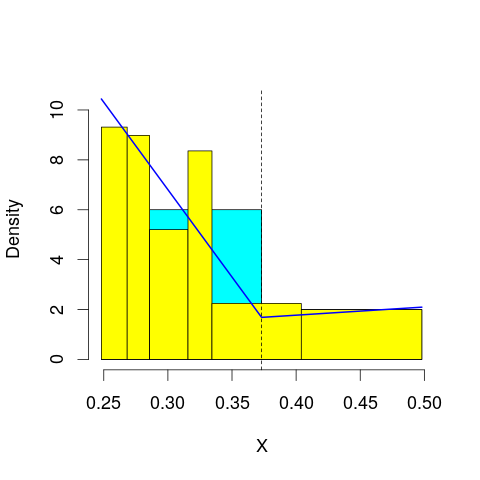

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.12003
mop.approx: Iteration 11. LL = 50.43332
mop.approx: Iteration 21. LL = 50.45905
mop.approx: Iteration 31. LL = 50.46486
mop.approx: Iteration 41. LL = 50.46659
mop.approx: Converged. Iteration 47. LL = 50.46706
[1] "Computing the linear combination of B-splines"


43.535590359
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.99325
mop.approx: Iteration 11. LL = 50.30822
mop.approx: Iteration 21. LL = 50.3317
mop.approx: Iteration 31. LL = 50.34374
mop.approx: Iteration 41. LL = 50.3517
mop.approx: Iteration 51. LL = 50.35708
mop.approx: Iteration 61. LL = 50.36083
mop.approx: Iteration 71. LL = 50.36351
mop.approx: Iteration 81. LL = 50.36548
mop.approx: Iteration 91. LL = 50.36697
mop.approx: Iteration 101. LL = 50.36811
mop.approx: Iteration 111. LL = 50.36901
mop.approx: Iteration 121. LL = 50.36973
mop.approx: Iteration 131. LL = 50.37031
mop.approx: Converged. Iteration 133. LL = 50.37046
[1] "Computing the linear combination of B-splines"


41.7061219588
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.79032
mop.approx: Iteration 11. LL = 40.2345
mop.approx: Iteration 21. LL = 40.26492
mop.approx: Converged. Iteration 21. LL = 40.26496
[1] "Computing the linear combination of B-splines"


29.8677494055
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.210394
mop.approx: Iteration 11. LL = 37.11388
mop.approx: Iteration 21. LL = 37.17272
mop.approx: Converged. Iteration 27. LL = 37.17374
[1] "Computing the linear combination of B-splines"


25.0436610775
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.204636
mop.approx: Iteration 11. LL = 38.68707
mop.approx: Iteration 21. LL = 38.86677
mop.approx: Iteration 31. LL = 38.88439
mop.approx: Iteration 41. LL = 38.88978
mop.approx: Iteration 51. LL = 38.89208
mop.approx: Iteration 61. LL = 38.89326
mop.approx: Iteration 71. LL = 38.89394
mop.approx: Converged. Iteration 78. LL = 38.89429
[1] "Computing the linear combination of B-splines"


25.0313465112
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.644991
mop.approx: Iteration 11. LL = 35.83759
mop.approx: Iteration 21. LL = 35.91159
mop.approx: Iteration 31. LL = 35.9157
mop.approx: Converged. Iteration 36. LL = 35.91603
[1] "Computing the linear combination of B-splines"


20.3202156977
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.558023
mop.approx: Iteration 11. LL = 37.11848
mop.approx: Iteration 21. LL = 37.48182
mop.approx: Iteration 31. LL = 37.52574
mop.approx: Iteration 41. LL = 37.53762
mop.approx: Iteration 51. LL = 37.54138
mop.approx: Iteration 61. LL = 37.54262
mop.approx: Converged. Iteration 66. LL = 37.54292
[1] "Computing the linear combination of B-splines"


20.2142443469
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.24732
mop.approx: Converged. Iteration 8. LL = 50.38745
[1] "Computing the linear combination of B-splines"


43.4559751875
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 43.455975187542343)
m reached
('Sum of Probabilities:', 0.9940074730061121)
chosen


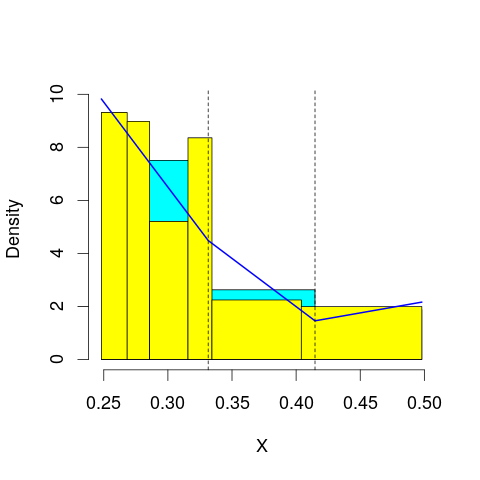

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.12003
mop.approx: Iteration 11. LL = 50.62014
mop.approx: Iteration 21. LL = 50.63171
mop.approx: Iteration 31. LL = 50.63328
mop.approx: Converged. Iteration 31. LL = 50.63333
[1] "Computing the linear combination of B-splines"


41.968990082
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.99325
mop.approx: Iteration 11. LL = 50.54363
mop.approx: Iteration 21. LL = 50.59514
mop.approx: Iteration 31. LL = 50.62061
mop.approx: Iteration 41. LL = 50.63448
mop.approx: Iteration 51. LL = 50.64248
mop.approx: Iteration 61. LL = 50.64734
mop.approx: Iteration 71. LL = 50.65044
mop.approx: Iteration 81. LL = 50.6525
mop.approx: Iteration 91. LL = 50.65391
mop.approx: Iteration 101. LL = 50.65491
mop.approx: Iteration 111. LL = 50.65563
mop.approx: Converged. Iteration 118. LL = 50.65607
[1] "Computing the linear combination of B-splines"


40.2588665865
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.79032
mop.approx: Iteration 11. LL = 40.50902
mop.approx: Iteration 21. LL = 40.51351
mop.approx: Converged. Iteration 24. LL = 40.51372
[1] "Computing the linear combination of B-splines"


28.3836462843
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.210394
mop.approx: Iteration 11. LL = 40.45026
mop.approx: Iteration 21. LL = 40.71051
mop.approx: Iteration 31. LL = 40.72623
mop.approx: Iteration 41. LL = 40.72768
mop.approx: Converged. Iteration 43. LL = 40.7278
[1] "Computing the linear combination of B-splines"


26.8648592534
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.204636
mop.approx: Iteration 11. LL = 38.80443
mop.approx: Iteration 21. LL = 38.87294
mop.approx: Iteration 31. LL = 38.89238
mop.approx: Iteration 41. LL = 38.89859
mop.approx: Iteration 51. LL = 38.90069
mop.approx: Iteration 61. LL = 38.90141
mop.approx: Converged. Iteration 61. LL = 38.90144
[1] "Computing the linear combination of B-splines"


23.3056328998
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.644991
mop.approx: Iteration 11. LL = 39.59321
mop.approx: Iteration 21. LL = 39.92185
mop.approx: Iteration 31. LL = 39.93552
mop.approx: Converged. Iteration 39. LL = 39.93645
[1] "Computing the linear combination of B-splines"


22.6077746427
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.558023
mop.approx: Iteration 11. LL = 37.48392
mop.approx: Iteration 21. LL = 37.56663
mop.approx: Iteration 31. LL = 37.57073
mop.approx: Converged. Iteration 32. LL = 37.57081
[1] "Computing the linear combination of B-splines"


18.5092591099
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.24732
mop.approx: Iteration 11. LL = 51.03295
mop.approx: Converged. Iteration 12. LL = 51.03308
[1] "Computing the linear combination of B-splines"


42.368741705
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 42.36874170495728)
m reached
('Sum of Probabilities:', 0.9943593273377647)
chosen


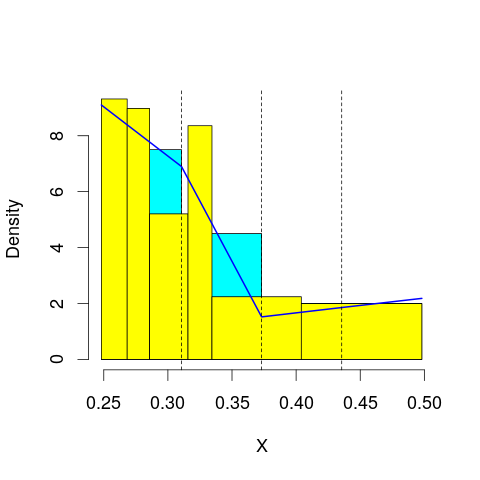

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.12003
mop.approx: Iteration 11. LL = 50.70792
mop.approx: Iteration 21. LL = 50.72587
mop.approx: Converged. Iteration 30. LL = 50.72749
[1] "Computing the linear combination of B-splines"


40.3302852328
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.99325
mop.approx: Iteration 11. LL = 50.98448
mop.approx: Iteration 21. LL = 51.13731
mop.approx: Iteration 31. LL = 51.1775
mop.approx: Iteration 41. LL = 51.19204
mop.approx: Iteration 51. LL = 51.19899
mop.approx: Iteration 61. LL = 51.20284
mop.approx: Iteration 71. LL = 51.20515
mop.approx: Iteration 81. LL = 51.2066
mop.approx: Iteration 91. LL = 51.20754
mop.approx: Iteration 101. LL = 51.20817
mop.approx: Converged. Iteration 101. LL = 51.20822
[1] "Computing the linear combination of B-splines"


39.0781446584
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.79032
mop.approx: Iteration 11. LL = 40.59445
mop.approx: Iteration 21. LL = 40.60508
mop.approx: Iteration 31. LL = 40.60659
mop.approx: Converged. Iteration 32. LL = 40.60668
[1] "Computing the linear combination of B-splines"


26.7437358917
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.210394
mop.approx: Iteration 11. LL = 42.61253
mop.approx: Iteration 21. LL = 42.74639
mop.approx: Iteration 31. LL = 42.77011
mop.approx: Iteration 41. LL = 42.7781
mop.approx: Iteration 51. LL = 42.78156
mop.approx: Iteration 61. LL = 42.7833
mop.approx: Iteration 71. LL = 42.78426
mop.approx: Iteration 81. LL = 42.78484
mop.approx: Converged. Iteration 82. LL = 42.78492
[1] "Computing the linear combination of B-splines"


27.1891132988
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.204636
mop.approx: Iteration 11. LL = 39.72913
mop.approx: Iteration 21. LL = 39.92896
mop.approx: Iteration 31. LL = 40.00875
mop.approx: Iteration 41. LL = 40.05225
mop.approx: Iteration 51. LL = 40.07808
mop.approx: Iteration 61. LL = 40.09437
mop.approx: Iteration 71. LL = 40.1052
mop.approx: Iteration 81. LL = 40.11269
mop.approx: Iteration 91. LL = 40.11807
mop.approx: Iteration 101. LL = 40.12203
mop.approx: Iteration 111. LL = 40.125
mop.approx: Iteration 121. LL = 40.12728
mop.approx: Iteration 131. LL = 40.12905
mop.approx: Iteration 141. LL = 40.13044
mop.approx: Iteration 151. LL = 40.13154
mop.approx: Iteration 161. LL = 40.13242
mop.approx: Iteration 171. LL = 40.13312
mop.approx: Iteration 181. LL = 40.1337
mop.approx: Iteration 191. LL = 40.13416
mop.approx: Converged. Iteration 193. LL = 40.13428
[1] "Computing the linea

22.8056034777
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.644991
mop.approx: Iteration 11. LL = 40.22645
mop.approx: Iteration 21. LL = 40.25262
mop.approx: Iteration 31. LL = 40.25694
mop.approx: Iteration 41. LL = 40.25816
mop.approx: Converged. Iteration 44. LL = 40.25835
[1] "Computing the linear combination of B-splines"


21.1968047921
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.558023
mop.approx: Iteration 11. LL = 39.56955
mop.approx: Iteration 21. LL = 40.07161
mop.approx: Iteration 31. LL = 40.15356
mop.approx: Iteration 41. LL = 40.16701
mop.approx: Iteration 51. LL = 40.16929
mop.approx: Converged. Iteration 56. LL = 40.16962
[1] "Computing the linear combination of B-splines"


19.3752061951
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.24732
mop.approx: Iteration 11. LL = 50.88551
mop.approx: Converged. Iteration 12. LL = 50.88559
[1] "Computing the linear combination of B-splines"


40.4883818354
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 40.488381835375044)
m reached
('Sum of Probabilities:', 0.9946186058941409)
chosen


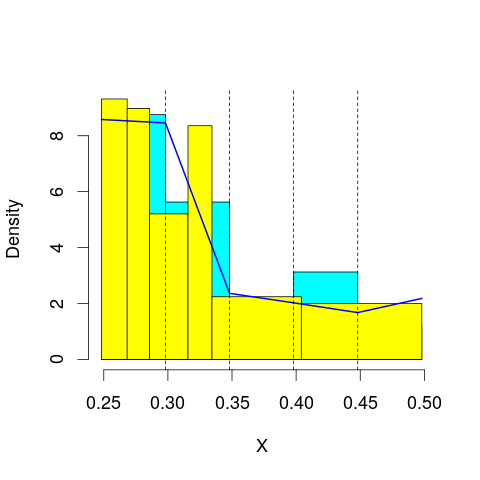

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.12003
mop.approx: Iteration 11. LL = 51.66346
mop.approx: Iteration 21. LL = 51.74595
mop.approx: Iteration 31. LL = 51.75679
mop.approx: Iteration 41. LL = 51.75972
mop.approx: Iteration 51. LL = 51.76097
mop.approx: Converged. Iteration 60. LL = 51.76163
[1] "Computing the linear combination of B-splines"


39.6315551853
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.99325
mop.approx: Iteration 11. LL = 51.3888
mop.approx: Iteration 21. LL = 51.49292
mop.approx: Iteration 31. LL = 51.52271
mop.approx: Iteration 41. LL = 51.53495
mop.approx: Iteration 51. LL = 51.54092
mop.approx: Iteration 61. LL = 51.5442
mop.approx: Iteration 71. LL = 51.54616
mop.approx: Iteration 81. LL = 51.54742
mop.approx: Iteration 91. LL = 51.54828
mop.approx: Iteration 101. LL = 51.54888
mop.approx: Converged. Iteration 101. LL = 51.54893
[1] "Computing the linear combination of B-splines"


37.6859910918
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.79032
mop.approx: Iteration 11. LL = 43.27358
mop.approx: Iteration 21. LL = 43.50367
mop.approx: Iteration 31. LL = 43.52162
mop.approx: Iteration 41. LL = 43.52331
mop.approx: Converged. Iteration 42. LL = 43.52339
[1] "Computing the linear combination of B-splines"


27.9275780602
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.210394
mop.approx: Iteration 11. LL = 42.69559
mop.approx: Iteration 21. LL = 42.70726
mop.approx: Iteration 31. LL = 42.70882
mop.approx: Converged. Iteration 34. LL = 42.70902
[1] "Computing the linear combination of B-splines"


25.3803420804
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.204636
mop.approx: Iteration 11. LL = 43.30298
mop.approx: Iteration 21. LL = 43.77074
mop.approx: Iteration 31. LL = 43.82032
mop.approx: Iteration 41. LL = 43.82938
mop.approx: Iteration 51. LL = 43.83139
mop.approx: Converged. Iteration 56. LL = 43.83174
[1] "Computing the linear combination of B-splines"


24.7701920845
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.644991
mop.approx: Iteration 11. LL = 40.30742
mop.approx: Iteration 21. LL = 40.34463
mop.approx: Iteration 31. LL = 40.36135
mop.approx: Iteration 41. LL = 40.3697
mop.approx: Iteration 51. LL = 40.3742
mop.approx: Iteration 61. LL = 40.37679
mop.approx: Iteration 71. LL = 40.37836
mop.approx: Iteration 81. LL = 40.37935
mop.approx: Iteration 91. LL = 40.38001
mop.approx: Converged. Iteration 98. LL = 40.38037
[1] "Computing the linear combination of B-splines"


19.5859562108
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.558023
mop.approx: Iteration 11. LL = 41.41224
mop.approx: Iteration 21. LL = 41.6468
mop.approx: Iteration 31. LL = 41.69628
mop.approx: Iteration 41. LL = 41.71652
mop.approx: Iteration 51. LL = 41.72684
mop.approx: Iteration 61. LL = 41.73283
mop.approx: Iteration 71. LL = 41.73663
mop.approx: Iteration 81. LL = 41.7392
mop.approx: Iteration 91. LL = 41.74102
mop.approx: Iteration 101. LL = 41.74235
mop.approx: Iteration 111. LL = 41.74336
mop.approx: Iteration 121. LL = 41.74414
mop.approx: Iteration 131. LL = 41.74475
mop.approx: Iteration 141. LL = 41.74523
mop.approx: Converged. Iteration 143. LL = 41.74536
[1] "Computing the linear combination of B-splines"


19.2180774959
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.24732
mop.approx: Iteration 11. LL = 51.67016
mop.approx: Converged. Iteration 17. LL = 51.67228
[1] "Computing the linear combination of B-splines"


39.5422033781
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 39.542203378088402)
m reached
('Sum of Probabilities:', 0.9939527697399262)
chosen


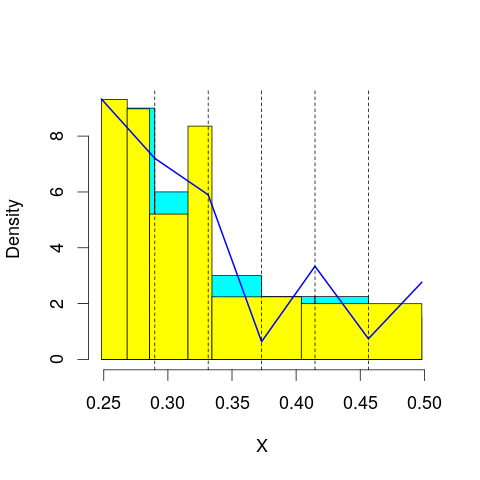

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.12003
mop.approx: Iteration 11. LL = 51.90007
mop.approx: Iteration 21. LL = 51.93399
mop.approx: Iteration 31. LL = 51.93688
mop.approx: Converged. Iteration 34. LL = 51.93714
[1] "Computing the linear combination of B-splines"


38.0741955109
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.99325
mop.approx: Iteration 11. LL = 51.69452
mop.approx: Iteration 21. LL = 51.7836
mop.approx: Iteration 31. LL = 51.80251
mop.approx: Iteration 41. LL = 51.80755
mop.approx: Iteration 51. LL = 51.80891
mop.approx: Converged. Iteration 53. LL = 51.80907
[1] "Computing the linear combination of B-splines"


36.2132603828
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.79032
mop.approx: Iteration 11. LL = 45.64495
mop.approx: Iteration 21. LL = 45.96489
mop.approx: Iteration 31. LL = 46.00519
mop.approx: Iteration 41. LL = 46.01216
mop.approx: Iteration 51. LL = 46.01375
mop.approx: Converged. Iteration 56. LL = 46.01408
[1] "Computing the linear combination of B-splines"


28.6854030578
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.210394
mop.approx: Iteration 11. LL = 43.3579
mop.approx: Iteration 21. LL = 43.45373
mop.approx: Iteration 31. LL = 43.46554
mop.approx: Iteration 41. LL = 43.467
mop.approx: Converged. Iteration 41. LL = 43.46704
[1] "Computing the linear combination of B-splines"


24.4054893288
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.204636
mop.approx: Iteration 11. LL = 44.41867
mop.approx: Iteration 21. LL = 44.54471
mop.approx: Iteration 31. LL = 44.57322
mop.approx: Iteration 41. LL = 44.58645
mop.approx: Iteration 51. LL = 44.59353
mop.approx: Iteration 61. LL = 44.59772
mop.approx: Iteration 71. LL = 44.60039
mop.approx: Iteration 81. LL = 44.60217
mop.approx: Iteration 91. LL = 44.60342
mop.approx: Iteration 101. LL = 44.60431
mop.approx: Iteration 111. LL = 44.60496
mop.approx: Converged. Iteration 119. LL = 44.6054
[1] "Computing the linear combination of B-splines"


23.8109842199
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.644991
mop.approx: Iteration 11. LL = 42.72029
mop.approx: Iteration 21. LL = 43.26943
mop.approx: Iteration 31. LL = 43.37474
mop.approx: Iteration 41. LL = 43.40475
mop.approx: Iteration 51. LL = 43.41731
mop.approx: Iteration 61. LL = 43.42357
mop.approx: Iteration 71. LL = 43.42692
mop.approx: Iteration 81. LL = 43.42878
mop.approx: Iteration 91. LL = 43.42984
mop.approx: Iteration 101. LL = 43.43045
mop.approx: Converged. Iteration 102. LL = 43.43054
[1] "Computing the linear combination of B-splines"


20.903255329
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.558023
mop.approx: Iteration 11. LL = 41.66645
mop.approx: Iteration 21. LL = 41.69158
mop.approx: Converged. Iteration 24. LL = 41.69182
[1] "Computing the linear combination of B-splines"


17.4316639275
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.24732
mop.approx: Iteration 11. LL = 51.99171
mop.approx: Iteration 21. LL = 52.02644
mop.approx: Iteration 31. LL = 52.03022
mop.approx: Converged. Iteration 34. LL = 52.03051
[1] "Computing the linear combination of B-splines"


38.1675628236
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 38.167562823632807)
m reached
('Sum of Probabilities:', 0.9937710689482433)
chosen


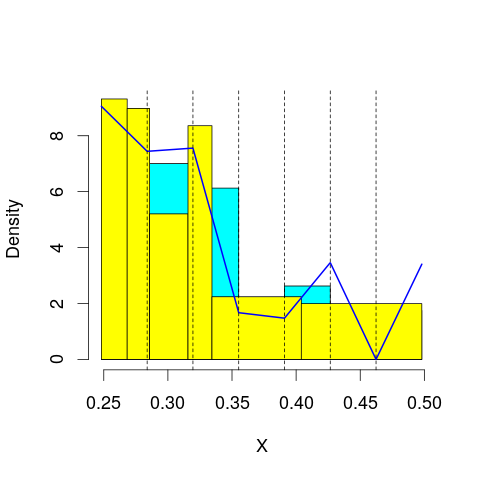

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.12003
mop.approx: Iteration 11. LL = 52.08818
mop.approx: Iteration 21. LL = 52.10943
mop.approx: Iteration 31. LL = 52.11304
mop.approx: Iteration 41. LL = 52.11436
mop.approx: Converged. Iteration 49. LL = 52.11495
[1] "Computing the linear combination of B-splines"


36.5191372612
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.99325
mop.approx: Iteration 11. LL = 51.95636
mop.approx: Iteration 21. LL = 52.03795
mop.approx: Iteration 31. LL = 52.05829
mop.approx: Iteration 41. LL = 52.06593
mop.approx: Iteration 51. LL = 52.06946
mop.approx: Iteration 61. LL = 52.07132
mop.approx: Iteration 71. LL = 52.07239
mop.approx: Converged. Iteration 80. LL = 52.07303
[1] "Computing the linear combination of B-splines"


34.7443536765
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.79032
mop.approx: Iteration 11. LL = 46.25394
mop.approx: Iteration 21. LL = 46.35625
mop.approx: Iteration 31. LL = 46.36345
mop.approx: Iteration 41. LL = 46.36568
mop.approx: Iteration 51. LL = 46.36658
mop.approx: Converged. Iteration 54. LL = 46.36678
[1] "Computing the linear combination of B-splines"


27.3052285808
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.210394
mop.approx: Iteration 11. LL = 44.52346
mop.approx: Iteration 21. LL = 44.63802
mop.approx: Iteration 31. LL = 44.64995
mop.approx: Iteration 41. LL = 44.65147
mop.approx: Converged. Iteration 41. LL = 44.65151
[1] "Computing the linear combination of B-splines"


23.8570981233
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.204636
mop.approx: Iteration 11. LL = 44.56226
mop.approx: Iteration 21. LL = 44.61881
mop.approx: Iteration 31. LL = 44.63081
mop.approx: Iteration 41. LL = 44.63425
mop.approx: Iteration 51. LL = 44.63525
mop.approx: Converged. Iteration 52. LL = 44.63534
[1] "Computing the linear combination of B-splines"


22.1080518594
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.644991
mop.approx: Iteration 11. LL = 44.89394
mop.approx: Iteration 21. LL = 45.32696
mop.approx: Iteration 31. LL = 45.3663
mop.approx: Iteration 41. LL = 45.37362
mop.approx: Iteration 51. LL = 45.37544
mop.approx: Converged. Iteration 56. LL = 45.3758
[1] "Computing the linear combination of B-splines"


21.1156486998
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.558023
mop.approx: Iteration 11. LL = 42.64886
mop.approx: Iteration 21. LL = 42.87426
mop.approx: Iteration 31. LL = 42.90579
mop.approx: Iteration 41. LL = 42.9091
mop.approx: Converged. Iteration 44. LL = 42.90931
[1] "Computing the linear combination of B-splines"


16.9162916769
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.24732
mop.approx: Iteration 11. LL = 52.40967
mop.approx: Iteration 21. LL = 52.41955
mop.approx: Converged. Iteration 21. LL = 52.4196
[1] "Computing the linear combination of B-splines"


36.8237854957
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 36.823785495656388)
m reached
('Sum of Probabilities:', 0.9934395832640519)
chosen


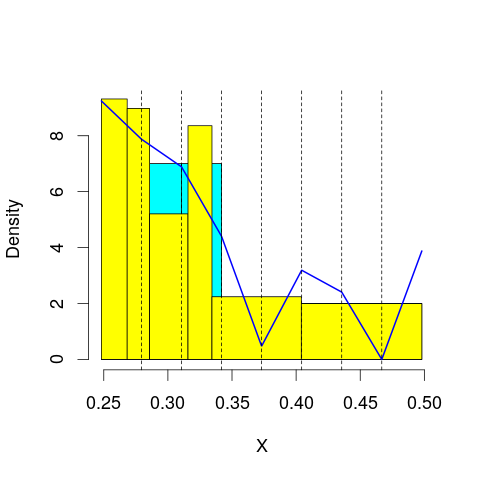

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.12003
mop.approx: Iteration 11. LL = 52.49856
mop.approx: Iteration 21. LL = 52.53889
mop.approx: Iteration 31. LL = 52.54648
mop.approx: Iteration 41. LL = 52.54854
mop.approx: Converged. Iteration 47. LL = 52.54904
[1] "Computing the linear combination of B-splines"


35.2203577896
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.99325
mop.approx: Iteration 11. LL = 51.90687
mop.approx: Iteration 21. LL = 51.95161
mop.approx: Iteration 31. LL = 51.96186
mop.approx: Iteration 41. LL = 51.96521
mop.approx: Iteration 51. LL = 51.96652
mop.approx: Converged. Iteration 57. LL = 51.96698
[1] "Computing the linear combination of B-splines"


32.9054316345
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.79032
mop.approx: Iteration 11. LL = 46.44171
mop.approx: Iteration 21. LL = 46.54486
mop.approx: Iteration 31. LL = 46.56735
mop.approx: Iteration 41. LL = 46.57448
mop.approx: Iteration 51. LL = 46.577
mop.approx: Iteration 61. LL = 46.57794
mop.approx: Converged. Iteration 63. LL = 46.57809
[1] "Computing the linear combination of B-splines"


25.7836720863
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.210394
mop.approx: Iteration 11. LL = 45.34849
mop.approx: Iteration 21. LL = 45.54133
mop.approx: Iteration 31. LL = 45.58098
mop.approx: Iteration 41. LL = 45.59438
mop.approx: Iteration 51. LL = 45.60035
mop.approx: Iteration 61. LL = 45.60356
mop.approx: Iteration 71. LL = 45.60551
mop.approx: Iteration 81. LL = 45.60682
mop.approx: Iteration 91. LL = 45.60773
mop.approx: Iteration 101. LL = 45.60839
mop.approx: Converged. Iteration 107. LL = 45.60874
[1] "Computing the linear combination of B-splines"


23.0814563211
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.204636
mop.approx: Iteration 11. LL = 44.92084
mop.approx: Iteration 21. LL = 44.97964
mop.approx: Iteration 31. LL = 44.9903
mop.approx: Iteration 41. LL = 44.99269
mop.approx: Converged. Iteration 47. LL = 44.99314
[1] "Computing the linear combination of B-splines"


20.7329920567
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.644991
mop.approx: Iteration 11. LL = 45.4937
mop.approx: Iteration 21. LL = 45.64286
mop.approx: Iteration 31. LL = 45.65082
mop.approx: Iteration 41. LL = 45.65289
mop.approx: Iteration 51. LL = 45.65398
mop.approx: Iteration 61. LL = 45.65467
mop.approx: Converged. Iteration 65. LL = 45.65491
[1] "Computing the linear combination of B-splines"


19.6618914934
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.558023
mop.approx: Iteration 11. LL = 44.35687
mop.approx: Iteration 21. LL = 44.85624
mop.approx: Iteration 31. LL = 44.96717
mop.approx: Iteration 41. LL = 45.00407
mop.approx: Iteration 51. LL = 45.01984
mop.approx: Iteration 61. LL = 45.02765
mop.approx: Iteration 71. LL = 45.03194
mop.approx: Iteration 81. LL = 45.03446
mop.approx: Iteration 91. LL = 45.03602
mop.approx: Iteration 101. LL = 45.03702
mop.approx: Iteration 111. LL = 45.03767
mop.approx: Converged. Iteration 115. LL = 45.03791
[1] "Computing the linear combination of B-splines"


17.3120244229
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.24732
mop.approx: Iteration 11. LL = 53.22569
mop.approx: Iteration 21. LL = 53.23853
mop.approx: Iteration 31. LL = 53.24094
mop.approx: Iteration 41. LL = 53.2418
mop.approx: Converged. Iteration 42. LL = 53.2419
[1] "Computing the linear combination of B-splines"


35.9132207897
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 35.913220789681219)
m reached
('Sum of Probabilities:', 0.993310215416344)
chosen


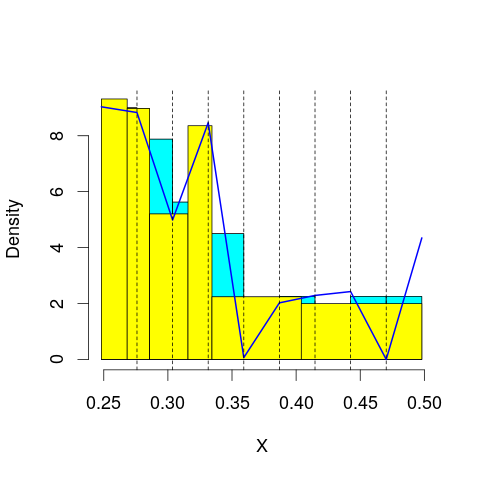

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.12003
mop.approx: Iteration 11. LL = 52.30421
mop.approx: Iteration 21. LL = 52.32386
mop.approx: Iteration 31. LL = 52.32937
mop.approx: Iteration 41. LL = 52.33169
mop.approx: Iteration 51. LL = 52.33283
mop.approx: Converged. Iteration 59. LL = 52.33341
[1] "Computing the linear combination of B-splines"


33.2718590818
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.99325
mop.approx: Iteration 11. LL = 52.3337
mop.approx: Iteration 21. LL = 52.45014
mop.approx: Iteration 31. LL = 52.47523
mop.approx: Iteration 41. LL = 52.48257
mop.approx: Iteration 51. LL = 52.48526
mop.approx: Iteration 61. LL = 52.48637
mop.approx: Converged. Iteration 65. LL = 52.48666
[1] "Computing the linear combination of B-splines"


31.6922427456
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.79032
mop.approx: Iteration 11. LL = 46.75214
mop.approx: Iteration 21. LL = 46.85916
mop.approx: Iteration 31. LL = 46.87625
mop.approx: Iteration 41. LL = 46.88048
mop.approx: Iteration 51. LL = 46.88177
mop.approx: Converged. Iteration 56. LL = 46.88211
[1] "Computing the linear combination of B-splines"


24.3548224342
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.210394
mop.approx: Iteration 11. LL = 45.63178
mop.approx: Iteration 21. LL = 45.80208
mop.approx: Iteration 31. LL = 45.84245
mop.approx: Iteration 41. LL = 45.85744
mop.approx: Iteration 51. LL = 45.86419
mop.approx: Iteration 61. LL = 45.86756
mop.approx: Iteration 71. LL = 45.86934
mop.approx: Iteration 81. LL = 45.87032
mop.approx: Converged. Iteration 89. LL = 45.87083
[1] "Computing the linear combination of B-splines"


21.6106834345
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.204636
mop.approx: Iteration 11. LL = 45.31003
mop.approx: Iteration 21. LL = 45.40775
mop.approx: Iteration 31. LL = 45.43025
mop.approx: Iteration 41. LL = 45.43821
mop.approx: Iteration 51. LL = 45.44184
mop.approx: Iteration 61. LL = 45.44378
mop.approx: Iteration 71. LL = 45.44493
mop.approx: Iteration 81. LL = 45.44566
mop.approx: Converged. Iteration 87. LL = 45.44601
[1] "Computing the linear combination of B-splines"


19.4529904147
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.644991
mop.approx: Iteration 11. LL = 45.60193
mop.approx: Iteration 21. LL = 45.66659
mop.approx: Iteration 31. LL = 45.67632
mop.approx: Iteration 41. LL = 45.67963
mop.approx: Iteration 51. LL = 45.68076
mop.approx: Converged. Iteration 54. LL = 45.68095
[1] "Computing the linear combination of B-splines"


17.9550661897
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.558023
mop.approx: Iteration 11. LL = 45.51738
mop.approx: Iteration 21. LL = 45.98773
mop.approx: Iteration 31. LL = 46.05407
mop.approx: Iteration 41. LL = 46.06973
mop.approx: Iteration 51. LL = 46.07571
mop.approx: Iteration 61. LL = 46.07857
mop.approx: Iteration 71. LL = 46.08007
mop.approx: Iteration 81. LL = 46.0809
mop.approx: Converged. Iteration 86. LL = 46.08121
[1] "Computing the linear combination of B-splines"


16.6224571549
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.24732
mop.approx: Iteration 11. LL = 53.58394
mop.approx: Iteration 21. LL = 53.58844
mop.approx: Converged. Iteration 24. LL = 53.58872
[1] "Computing the linear combination of B-splines"


34.5271757031
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 34.527175703061815)
m reached
('Sum of Probabilities:', 0.9928764578273178)
chosen


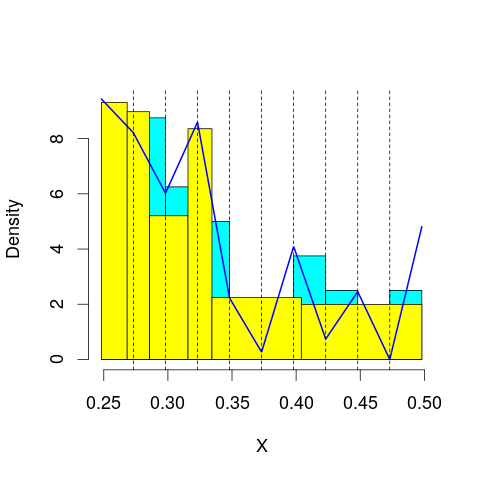

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.12003
mop.approx: Iteration 11. LL = 52.7709
mop.approx: Iteration 21. LL = 52.84135
mop.approx: Iteration 31. LL = 52.84798
mop.approx: Converged. Iteration 37. LL = 52.84862
[1] "Computing the linear combination of B-splines"


32.0542037105
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.99325
mop.approx: Iteration 11. LL = 52.7013
mop.approx: Iteration 21. LL = 52.86352
mop.approx: Iteration 31. LL = 52.91133
mop.approx: Iteration 41. LL = 52.92979
mop.approx: Iteration 51. LL = 52.93831
mop.approx: Iteration 61. LL = 52.94281
mop.approx: Iteration 71. LL = 52.94543
mop.approx: Iteration 81. LL = 52.94708
mop.approx: Iteration 91. LL = 52.94819
mop.approx: Iteration 101. LL = 52.94895
mop.approx: Converged. Iteration 107. LL = 52.94936
[1] "Computing the linear combination of B-splines"


30.4220756889
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.79032
mop.approx: Iteration 11. LL = 47.12069
mop.approx: Iteration 21. LL = 47.21147
mop.approx: Iteration 31. LL = 47.21903
mop.approx: Converged. Iteration 37. LL = 47.21972
[1] "Computing the linear combination of B-splines"


22.9595719393
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.210394
mop.approx: Iteration 11. LL = 46.01983
mop.approx: Iteration 21. LL = 46.24278
mop.approx: Iteration 31. LL = 46.29937
mop.approx: Iteration 41. LL = 46.31689
mop.approx: Iteration 51. LL = 46.32338
mop.approx: Iteration 61. LL = 46.3264
mop.approx: Iteration 71. LL = 46.32808
mop.approx: Iteration 81. LL = 46.32913
mop.approx: Iteration 91. LL = 46.32981
mop.approx: Converged. Iteration 96. LL = 46.33011
[1] "Computing the linear combination of B-splines"


20.3370931537
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.204636
mop.approx: Iteration 11. LL = 45.39108
mop.approx: Iteration 21. LL = 45.42976
mop.approx: Iteration 31. LL = 45.43499
mop.approx: Iteration 41. LL = 45.43709
mop.approx: Iteration 51. LL = 45.43825
mop.approx: Iteration 61. LL = 45.4389
mop.approx: Converged. Iteration 62. LL = 45.43899
[1] "Computing the linear combination of B-splines"


17.713103101
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.644991
mop.approx: Iteration 11. LL = 45.80693
mop.approx: Iteration 21. LL = 45.9047
mop.approx: Iteration 31. LL = 45.92935
mop.approx: Iteration 41. LL = 45.9385
mop.approx: Iteration 51. LL = 45.94253
mop.approx: Iteration 61. LL = 45.94455
mop.approx: Iteration 71. LL = 45.94567
mop.approx: Iteration 81. LL = 45.94635
mop.approx: Converged. Iteration 84. LL = 45.94654
[1] "Computing the linear combination of B-splines"


16.4877829519
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.558023
mop.approx: Iteration 11. LL = 45.86173
mop.approx: Iteration 21. LL = 46.08304
mop.approx: Iteration 31. LL = 46.10801
mop.approx: Iteration 41. LL = 46.11648
mop.approx: Iteration 51. LL = 46.11972
mop.approx: Iteration 61. LL = 46.12096
mop.approx: Converged. Iteration 66. LL = 46.1213
[1] "Computing the linear combination of B-splines"


14.9296767785
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.24732
mop.approx: Iteration 11. LL = 53.73039
mop.approx: Iteration 21. LL = 53.75924
mop.approx: Converged. Iteration 30. LL = 53.76124
[1] "Computing the linear combination of B-splines"


32.9668224014
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 32.966822401417971)
m reached
('Sum of Probabilities:', 0.992664414579478)
chosen


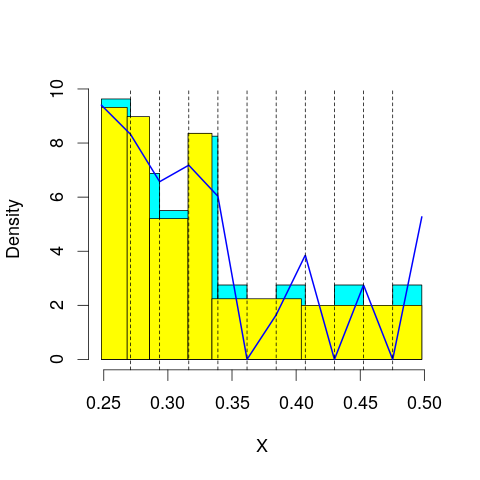

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.12003
mop.approx: Iteration 11. LL = 53.41808
mop.approx: Iteration 21. LL = 53.46629
mop.approx: Iteration 31. LL = 53.47325
mop.approx: Iteration 41. LL = 53.47505
mop.approx: Converged. Iteration 49. LL = 53.4757
[1] "Computing the linear combination of B-splines"


30.9484138158
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.99325
mop.approx: Iteration 11. LL = 52.63036
mop.approx: Iteration 21. LL = 52.75058
mop.approx: Iteration 31. LL = 52.78545
mop.approx: Iteration 41. LL = 52.79918
mop.approx: Iteration 51. LL = 52.80563
mop.approx: Iteration 61. LL = 52.80901
mop.approx: Iteration 71. LL = 52.81094
mop.approx: Iteration 81. LL = 52.81211
mop.approx: Iteration 91. LL = 52.81287
mop.approx: Converged. Iteration 95. LL = 52.81314
[1] "Computing the linear combination of B-splines"


28.5529936441
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.79032
mop.approx: Iteration 11. LL = 47.65985
mop.approx: Iteration 21. LL = 47.80899
mop.approx: Iteration 31. LL = 47.84028
mop.approx: Iteration 41. LL = 47.85068
mop.approx: Iteration 51. LL = 47.85502
mop.approx: Iteration 61. LL = 47.85713
mop.approx: Iteration 71. LL = 47.85826
mop.approx: Iteration 81. LL = 47.8589
mop.approx: Converged. Iteration 81. LL = 47.85894
[1] "Computing the linear combination of B-splines"


21.8659235031
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.210394
mop.approx: Iteration 11. LL = 46.54847
mop.approx: Iteration 21. LL = 46.83067
mop.approx: Iteration 31. LL = 46.88509
mop.approx: Iteration 41. LL = 46.89872
mop.approx: Iteration 51. LL = 46.9028
mop.approx: Iteration 61. LL = 46.90425
mop.approx: Converged. Iteration 70. LL = 46.90487
[1] "Computing the linear combination of B-splines"


19.1789813717
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.204636
mop.approx: Iteration 11. LL = 45.53177
mop.approx: Iteration 21. LL = 45.58831
mop.approx: Iteration 31. LL = 45.60392
mop.approx: Iteration 41. LL = 45.6099
mop.approx: Iteration 51. LL = 45.61237
mop.approx: Iteration 61. LL = 45.61349
mop.approx: Converged. Iteration 69. LL = 45.61401
[1] "Computing the linear combination of B-splines"


16.1552551412
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.644991
mop.approx: Iteration 11. LL = 45.85572
mop.approx: Iteration 21. LL = 45.90201
mop.approx: Iteration 31. LL = 45.91045
mop.approx: Iteration 41. LL = 45.91327
mop.approx: Iteration 51. LL = 45.91435
mop.approx: Converged. Iteration 55. LL = 45.91462
[1] "Computing the linear combination of B-splines"


14.7229953181
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.558023
mop.approx: Iteration 11. LL = 46.08454
mop.approx: Iteration 21. LL = 46.27683
mop.approx: Iteration 31. LL = 46.31497
mop.approx: Iteration 41. LL = 46.32811
mop.approx: Iteration 51. LL = 46.33378
mop.approx: Iteration 61. LL = 46.33662
mop.approx: Iteration 71. LL = 46.3382
mop.approx: Iteration 81. LL = 46.33914
mop.approx: Iteration 91. LL = 46.33972
mop.approx: Converged. Iteration 91. LL = 46.33977
[1] "Computing the linear combination of B-splines"


13.4152725567
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.24732
mop.approx: Iteration 11. LL = 53.10808
mop.approx: Iteration 21. LL = 53.11152
mop.approx: Converged. Iteration 26. LL = 53.11191
[1] "Computing the linear combination of B-splines"


30.5846224718
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 30.584622471838916)
m reached
('Sum of Probabilities:', 0.992511839205645)
chosen


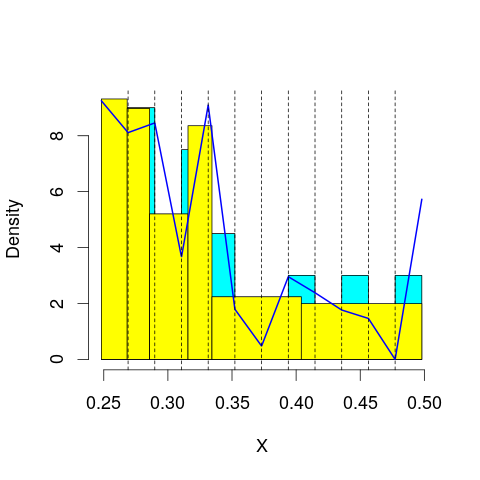

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.12003
mop.approx: Iteration 11. LL = 53.72731
mop.approx: Iteration 21. LL = 53.77743
mop.approx: Iteration 31. LL = 53.78503
mop.approx: Iteration 41. LL = 53.7867
mop.approx: Converged. Iteration 44. LL = 53.78694
[1] "Computing the linear combination of B-splines"


29.5267845489
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.99325
mop.approx: Iteration 11. LL = 52.88007
mop.approx: Iteration 21. LL = 53.00957
mop.approx: Iteration 31. LL = 53.05156
mop.approx: Iteration 41. LL = 53.06683
mop.approx: Iteration 51. LL = 53.07225
mop.approx: Iteration 61. LL = 53.0742
mop.approx: Converged. Iteration 69. LL = 53.07489
[1] "Computing the linear combination of B-splines"


27.0818698909
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.79032
mop.approx: Iteration 11. LL = 47.71727
mop.approx: Iteration 21. LL = 47.80215
mop.approx: Iteration 31. LL = 47.81612
mop.approx: Iteration 41. LL = 47.81958
mop.approx: Iteration 51. LL = 47.82054
mop.approx: Converged. Iteration 51. LL = 47.82059
[1] "Computing the linear combination of B-splines"


20.0947035311
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.210394
mop.approx: Iteration 11. LL = 47.39036
mop.approx: Iteration 21. LL = 47.75641
mop.approx: Iteration 31. LL = 47.83404
mop.approx: Iteration 41. LL = 47.85895
mop.approx: Iteration 51. LL = 47.86895
mop.approx: Iteration 61. LL = 47.87356
mop.approx: Iteration 71. LL = 47.87591
mop.approx: Iteration 81. LL = 47.8772
mop.approx: Iteration 91. LL = 47.87794
mop.approx: Converged. Iteration 94. LL = 47.87814
[1] "Computing the linear combination of B-splines"


18.4193881888
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.204636
mop.approx: Iteration 11. LL = 45.75235
mop.approx: Iteration 21. LL = 45.87727
mop.approx: Iteration 31. LL = 45.91791
mop.approx: Iteration 41. LL = 45.93169
mop.approx: Iteration 51. LL = 45.93639
mop.approx: Iteration 61. LL = 45.938
mop.approx: Converged. Iteration 67. LL = 45.93844
[1] "Computing the linear combination of B-splines"


14.7468212238
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.644991
mop.approx: Iteration 11. LL = 45.93681
mop.approx: Iteration 21. LL = 46.00505
mop.approx: Iteration 31. LL = 46.02772
mop.approx: Iteration 41. LL = 46.03608
mop.approx: Iteration 51. LL = 46.03909
mop.approx: Iteration 61. LL = 46.04016
mop.approx: Converged. Iteration 64. LL = 46.04036
[1] "Computing the linear combination of B-splines"


13.1158719517
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.558023
mop.approx: Iteration 11. LL = 46.23774
mop.approx: Iteration 21. LL = 46.38845
mop.approx: Iteration 31. LL = 46.41982
mop.approx: Iteration 41. LL = 46.43265
mop.approx: Iteration 51. LL = 46.43916
mop.approx: Iteration 61. LL = 46.44289
mop.approx: Iteration 71. LL = 46.44522
mop.approx: Iteration 81. LL = 46.44678
mop.approx: Iteration 91. LL = 46.44786
mop.approx: Iteration 101. LL = 46.44865
mop.approx: Iteration 111. LL = 46.44923
mop.approx: Converged. Iteration 114. LL = 46.44942
[1] "Computing the linear combination of B-splines"


11.7920564041
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.24732
mop.approx: Iteration 11. LL = 54.659
mop.approx: Iteration 21. LL = 54.67865
mop.approx: Converged. Iteration 27. LL = 54.67953
[1] "Computing the linear combination of B-splines"


30.4193748085
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 30.419374808543544)
m reached
('Sum of Probabilities:', 0.9921401257078291)
chosen


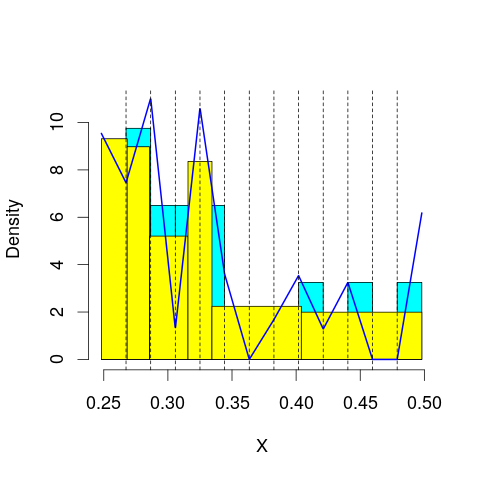

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.12003
mop.approx: Iteration 11. LL = 53.71058
mop.approx: Iteration 21. LL = 53.7317
mop.approx: Iteration 31. LL = 53.73444
mop.approx: Converged. Iteration 38. LL = 53.73508
[1] "Computing the linear combination of B-splines"


27.7420560976
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.99325
mop.approx: Iteration 11. LL = 53.56775
mop.approx: Iteration 21. LL = 53.66609
mop.approx: Iteration 31. LL = 53.68695
mop.approx: Iteration 41. LL = 53.69479
mop.approx: Iteration 51. LL = 53.69854
mop.approx: Iteration 61. LL = 53.70062
mop.approx: Iteration 71. LL = 53.7019
mop.approx: Iteration 81. LL = 53.70275
mop.approx: Converged. Iteration 89. LL = 53.7033
[1] "Computing the linear combination of B-splines"


25.9774089961
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.79032
mop.approx: Iteration 11. LL = 47.75155
mop.approx: Iteration 21. LL = 47.82887
mop.approx: Iteration 31. LL = 47.84562
mop.approx: Iteration 41. LL = 47.85051
mop.approx: Iteration 51. LL = 47.85215
mop.approx: Converged. Iteration 59. LL = 47.85274
[1] "Computing the linear combination of B-splines"


18.3939810993
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.210394
mop.approx: Iteration 11. LL = 47.95004
mop.approx: Iteration 21. LL = 48.22117
mop.approx: Iteration 31. LL = 48.27793
mop.approx: Iteration 41. LL = 48.29495
mop.approx: Iteration 51. LL = 48.30055
mop.approx: Iteration 61. LL = 48.30249
mop.approx: Converged. Iteration 69. LL = 48.30315
[1] "Computing the linear combination of B-splines"


17.1115228258
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.204636
mop.approx: Iteration 11. LL = 46.29159
mop.approx: Iteration 21. LL = 46.58832
mop.approx: Iteration 31. LL = 46.67617
mop.approx: Iteration 41. LL = 46.70863
mop.approx: Iteration 51. LL = 46.72341
mop.approx: Iteration 61. LL = 46.73103
mop.approx: Iteration 71. LL = 46.73523
mop.approx: Iteration 81. LL = 46.73766
mop.approx: Iteration 91. LL = 46.7391
mop.approx: Iteration 101. LL = 46.73997
mop.approx: Converged. Iteration 109. LL = 46.74047
[1] "Computing the linear combination of B-splines"


13.8159781126
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.644991
mop.approx: Iteration 11. LL = 46.01285
mop.approx: Iteration 21. LL = 46.08006
mop.approx: Iteration 31. LL = 46.10462
mop.approx: Iteration 41. LL = 46.11506
mop.approx: Iteration 51. LL = 46.11966
mop.approx: Iteration 61. LL = 46.12172
mop.approx: Iteration 71. LL = 46.12264
mop.approx: Converged. Iteration 74. LL = 46.12285
[1] "Computing the linear combination of B-splines"


11.4654903005
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.558023
mop.approx: Iteration 11. LL = 46.40625
mop.approx: Iteration 21. LL = 46.56011
mop.approx: Iteration 31. LL = 46.59016
mop.approx: Iteration 41. LL = 46.59709
mop.approx: Iteration 51. LL = 46.59862
mop.approx: Converged. Iteration 53. LL = 46.59878
[1] "Computing the linear combination of B-splines"


10.2085523866
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.24732
mop.approx: Iteration 11. LL = 54.67242
mop.approx: Iteration 21. LL = 54.71527
mop.approx: Iteration 31. LL = 54.72606
mop.approx: Iteration 41. LL = 54.72921
mop.approx: Converged. Iteration 50. LL = 54.73017
[1] "Computing the linear combination of B-splines"


28.7371542065
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 28.737154206467849)
m reached
('Sum of Probabilities:', 0.9918374137777876)
chosen


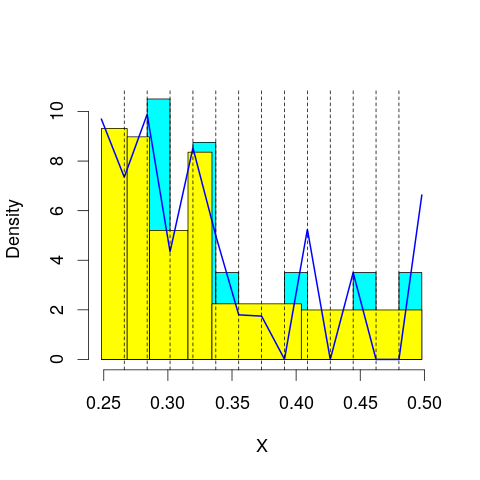

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.12003
mop.approx: Iteration 11. LL = 53.83407
mop.approx: Iteration 21. LL = 53.88972
mop.approx: Iteration 31. LL = 53.89625
mop.approx: Converged. Iteration 38. LL = 53.89704
[1] "Computing the linear combination of B-splines"


26.1711503659
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.99325
mop.approx: Iteration 11. LL = 53.8097
mop.approx: Iteration 21. LL = 53.86258
mop.approx: Iteration 31. LL = 53.87114
mop.approx: Iteration 41. LL = 53.87477
mop.approx: Iteration 51. LL = 53.87686
mop.approx: Iteration 61. LL = 53.87821
mop.approx: Iteration 71. LL = 53.87913
mop.approx: Iteration 81. LL = 53.87979
mop.approx: Converged. Iteration 82. LL = 53.8799
[1] "Computing the linear combination of B-splines"


24.4211400847
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.79032
mop.approx: Iteration 11. LL = 47.90823
mop.approx: Iteration 21. LL = 47.98756
mop.approx: Iteration 31. LL = 48.01092
mop.approx: Iteration 41. LL = 48.0213
mop.approx: Iteration 51. LL = 48.02691
mop.approx: Iteration 61. LL = 48.03031
mop.approx: Iteration 71. LL = 48.03255
mop.approx: Iteration 81. LL = 48.03412
mop.approx: Iteration 91. LL = 48.03527
mop.approx: Iteration 101. LL = 48.03615
mop.approx: Iteration 111. LL = 48.03684
mop.approx: Iteration 121. LL = 48.03739
mop.approx: Converged. Iteration 123. LL = 48.03753
[1] "Computing the linear combination of B-splines"


16.8459113647
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.210394
mop.approx: Iteration 11. LL = 48.18249
mop.approx: Iteration 21. LL = 48.3553
mop.approx: Iteration 31. LL = 48.39472
mop.approx: Iteration 41. LL = 48.40934
mop.approx: Iteration 51. LL = 48.41588
mop.approx: Iteration 61. LL = 48.41912
mop.approx: Iteration 71. LL = 48.42084
mop.approx: Iteration 81. LL = 48.42181
mop.approx: Converged. Iteration 88. LL = 48.42227
[1] "Computing the linear combination of B-splines"


15.4977838367
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.204636
mop.approx: Iteration 11. LL = 47.03306
mop.approx: Iteration 21. LL = 47.41424
mop.approx: Iteration 31. LL = 47.5001
mop.approx: Iteration 41. LL = 47.52324
mop.approx: Iteration 51. LL = 47.53147
mop.approx: Iteration 61. LL = 47.53529
mop.approx: Iteration 71. LL = 47.53737
mop.approx: Iteration 81. LL = 47.53861
mop.approx: Iteration 91. LL = 47.53938
mop.approx: Converged. Iteration 97. LL = 47.53975
[1] "Computing the linear combination of B-splines"


12.8823900685
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.644991
mop.approx: Iteration 11. LL = 46.14116
mop.approx: Iteration 21. LL = 46.24466
mop.approx: Iteration 31. LL = 46.27556
mop.approx: Iteration 41. LL = 46.28473
mop.approx: Iteration 51. LL = 46.28759
mop.approx: Iteration 61. LL = 46.28853
mop.approx: Converged. Iteration 62. LL = 46.28862
[1] "Computing the linear combination of B-splines"


9.89839519622
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.558023
mop.approx: Iteration 11. LL = 46.59541
mop.approx: Iteration 21. LL = 46.76224
mop.approx: Iteration 31. LL = 46.81417
mop.approx: Iteration 41. LL = 46.83764
mop.approx: Iteration 51. LL = 46.84959
mop.approx: Iteration 61. LL = 46.85614
mop.approx: Iteration 71. LL = 46.85993
mop.approx: Iteration 81. LL = 46.8622
mop.approx: Iteration 91. LL = 46.86362
mop.approx: Iteration 101. LL = 46.86453
mop.approx: Iteration 111. LL = 46.86513
mop.approx: Converged. Iteration 113. LL = 46.86527
[1] "Computing the linear combination of B-splines"


8.74218978353
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.24732
mop.approx: Iteration 11. LL = 54.87998
mop.approx: Converged. Iteration 19. LL = 54.88329
[1] "Computing the linear combination of B-splines"


27.1573978707
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 27.157397870668891)
m reached
('Sum of Probabilities:', 0.9917728123107116)
chosen


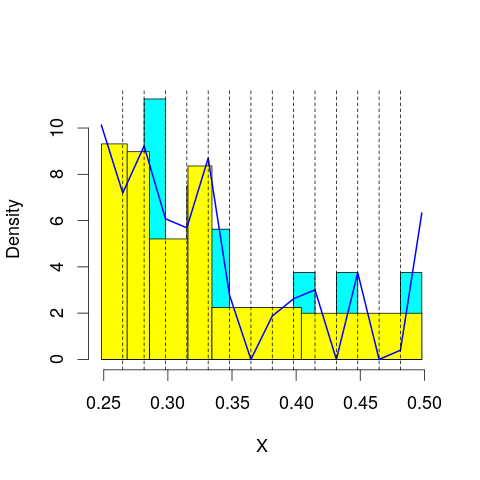

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.12003
mop.approx: Iteration 11. LL = 54.44408
mop.approx: Iteration 21. LL = 54.56234
mop.approx: Iteration 31. LL = 54.58285
mop.approx: Iteration 41. LL = 54.58842
mop.approx: Iteration 51. LL = 54.59054
mop.approx: Iteration 61. LL = 54.59151
mop.approx: Converged. Iteration 64. LL = 54.59174
[1] "Computing the linear combination of B-splines"


25.1329891796
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.99325
mop.approx: Iteration 11. LL = 53.79209
mop.approx: Iteration 21. LL = 53.84559
mop.approx: Iteration 31. LL = 53.85474
mop.approx: Iteration 41. LL = 53.85735
mop.approx: Iteration 51. LL = 53.85844
mop.approx: Converged. Iteration 57. LL = 53.85887
[1] "Computing the linear combination of B-splines"


22.6672432065
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.79032
mop.approx: Iteration 11. LL = 48.44528
mop.approx: Iteration 21. LL = 48.58419
mop.approx: Iteration 31. LL = 48.61411
mop.approx: Iteration 41. LL = 48.6249
mop.approx: Iteration 51. LL = 48.63013
mop.approx: Iteration 61. LL = 48.63314
mop.approx: Iteration 71. LL = 48.63511
mop.approx: Iteration 81. LL = 48.6365
mop.approx: Iteration 91. LL = 48.63755
mop.approx: Iteration 101. LL = 48.63836
mop.approx: Iteration 111. LL = 48.639
mop.approx: Converged. Iteration 118. LL = 48.63942
[1] "Computing the linear combination of B-splines"


15.7149304864
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.210394
mop.approx: Iteration 11. LL = 48.28962
mop.approx: Iteration 21. LL = 48.3796
mop.approx: Iteration 31. LL = 48.39632
mop.approx: Iteration 41. LL = 48.40179
mop.approx: Iteration 51. LL = 48.4039
mop.approx: Iteration 61. LL = 48.40477
mop.approx: Converged. Iteration 63. LL = 48.40492
[1] "Computing the linear combination of B-splines"


13.7475602379
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.204636
mop.approx: Iteration 11. LL = 47.66294
mop.approx: Iteration 21. LL = 47.98739
mop.approx: Iteration 31. LL = 48.03955
mop.approx: Iteration 41. LL = 48.05021
mop.approx: Iteration 51. LL = 48.05322
mop.approx: Iteration 61. LL = 48.05444
mop.approx: Iteration 71. LL = 48.0551
mop.approx: Converged. Iteration 72. LL = 48.0552
[1] "Computing the linear combination of B-splines"


11.6649746742
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.644991
mop.approx: Iteration 11. LL = 46.5039
mop.approx: Iteration 21. LL = 46.72949
mop.approx: Iteration 31. LL = 46.80888
mop.approx: Iteration 41. LL = 46.84038
mop.approx: Iteration 51. LL = 46.85384
mop.approx: Iteration 61. LL = 46.85991
mop.approx: Iteration 71. LL = 46.86279
mop.approx: Iteration 81. LL = 46.86423
mop.approx: Iteration 91. LL = 46.86499
mop.approx: Converged. Iteration 94. LL = 46.8652
[1] "Computing the linear combination of B-splines"


8.74210340424
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.558023
mop.approx: Iteration 11. LL = 46.6627
mop.approx: Iteration 21. LL = 46.76419
mop.approx: Iteration 31. LL = 46.78647
mop.approx: Iteration 41. LL = 46.7934
mop.approx: Iteration 51. LL = 46.79575
mop.approx: Iteration 61. LL = 46.79659
mop.approx: Converged. Iteration 61. LL = 46.79664
[1] "Computing the linear combination of B-splines"


6.94073542337
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.24732
mop.approx: Iteration 11. LL = 55.1331
mop.approx: Iteration 21. LL = 55.16552
mop.approx: Iteration 31. LL = 55.16901
mop.approx: Converged. Iteration 36. LL = 55.16946
[1] "Computing the linear combination of B-splines"


25.7107007792
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 25.71070077921712)
m reached
('Sum of Probabilities:', 0.9920955800586527)
chosen


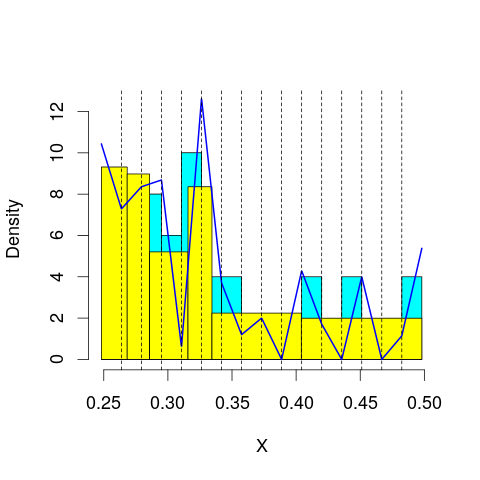

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.12003
mop.approx: Iteration 11. LL = 54.79777
mop.approx: Iteration 21. LL = 54.81082
mop.approx: Converged. Iteration 24. LL = 54.81117
[1] "Computing the linear combination of B-splines"


23.619546876
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.99325
mop.approx: Iteration 11. LL = 54.03981
mop.approx: Iteration 21. LL = 54.17695
mop.approx: Iteration 31. LL = 54.22875
mop.approx: Iteration 41. LL = 54.25238
mop.approx: Iteration 51. LL = 54.2637
mop.approx: Iteration 61. LL = 54.26931
mop.approx: Iteration 71. LL = 54.27219
mop.approx: Iteration 81. LL = 54.27373
mop.approx: Iteration 91. LL = 54.27459
mop.approx: Converged. Iteration 94. LL = 54.27483
[1] "Computing the linear combination of B-splines"


21.35033617
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.79032
mop.approx: Iteration 11. LL = 48.78884
mop.approx: Iteration 21. LL = 48.86022
mop.approx: Iteration 31. LL = 48.87885
mop.approx: Iteration 41. LL = 48.88627
mop.approx: Iteration 51. LL = 48.88981
mop.approx: Iteration 61. LL = 48.89167
mop.approx: Iteration 71. LL = 48.89272
mop.approx: Converged. Iteration 80. LL = 48.89332
[1] "Computing the linear combination of B-splines"


14.2359601087
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.210394
mop.approx: Iteration 11. LL = 48.44223
mop.approx: Iteration 21. LL = 48.56154
mop.approx: Iteration 31. LL = 48.60364
mop.approx: Iteration 41. LL = 48.62545
mop.approx: Iteration 51. LL = 48.63897
mop.approx: Iteration 61. LL = 48.64801
mop.approx: Iteration 71. LL = 48.65419
mop.approx: Iteration 81. LL = 48.65841
mop.approx: Iteration 91. LL = 48.66128
mop.approx: Iteration 101. LL = 48.66322
mop.approx: Iteration 111. LL = 48.66453
mop.approx: Iteration 121. LL = 48.66541
mop.approx: Iteration 131. LL = 48.66601
mop.approx: Converged. Iteration 131. LL = 48.66606
[1] "Computing the linear combination of B-splines"


12.2758320372
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.204636
mop.approx: Iteration 11. LL = 48.183
mop.approx: Iteration 21. LL = 48.45595
mop.approx: Iteration 31. LL = 48.49669
mop.approx: Iteration 41. LL = 48.50778
mop.approx: Iteration 51. LL = 48.51256
mop.approx: Iteration 61. LL = 48.51521
mop.approx: Iteration 71. LL = 48.5169
mop.approx: Iteration 81. LL = 48.51805
mop.approx: Iteration 91. LL = 48.51887
mop.approx: Iteration 101. LL = 48.51947
mop.approx: Converged. Iteration 103. LL = 48.51961
[1] "Computing the linear combination of B-splines"


10.3965197231
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.644991
mop.approx: Iteration 11. LL = 46.93115
mop.approx: Iteration 21. LL = 47.14577
mop.approx: Iteration 31. LL = 47.18885
mop.approx: Iteration 41. LL = 47.19862
mop.approx: Iteration 51. LL = 47.20139
mop.approx: Iteration 61. LL = 47.20243
mop.approx: Converged. Iteration 67. LL = 47.20281
[1] "Computing the linear combination of B-splines"


7.34685107712
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.558023
mop.approx: Iteration 11. LL = 46.7853
mop.approx: Iteration 21. LL = 46.90491
mop.approx: Iteration 31. LL = 46.94162
mop.approx: Iteration 41. LL = 46.9566
mop.approx: Iteration 51. LL = 46.96315
mop.approx: Iteration 61. LL = 46.96621
mop.approx: Iteration 71. LL = 46.96777
mop.approx: Iteration 81. LL = 46.96863
mop.approx: Converged. Iteration 88. LL = 46.96907
[1] "Computing the linear combination of B-splines"


5.38019668895
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.24732
mop.approx: Iteration 11. LL = 55.54481
mop.approx: Iteration 21. LL = 55.59911
mop.approx: Iteration 31. LL = 55.60262
mop.approx: Converged. Iteration 34. LL = 55.6029
[1] "Computing the linear combination of B-splines"


24.4112782083
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 24.41127820834199)
m reached
('Sum of Probabilities:', 0.9922779463754459)
chosen


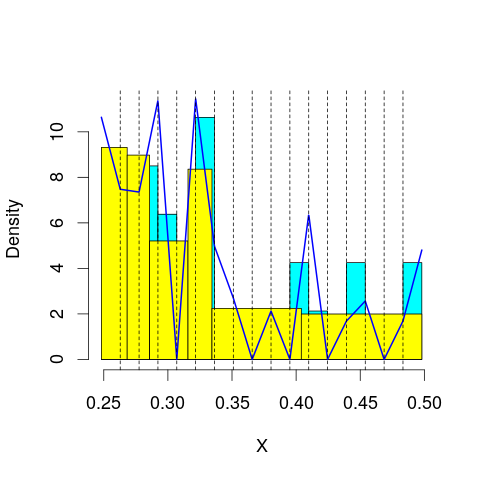

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.12003
mop.approx: Iteration 11. LL = 54.99809
mop.approx: Iteration 21. LL = 55.04108
mop.approx: Iteration 31. LL = 55.0495
mop.approx: Iteration 41. LL = 55.05119
mop.approx: Converged. Iteration 42. LL = 55.05131
[1] "Computing the linear combination of B-splines"


22.1268214021
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.99325
mop.approx: Iteration 11. LL = 54.41138
mop.approx: Iteration 21. LL = 54.60062
mop.approx: Iteration 31. LL = 54.64343
mop.approx: Iteration 41. LL = 54.65578
mop.approx: Iteration 51. LL = 54.6604
mop.approx: Iteration 61. LL = 54.66254
mop.approx: Iteration 71. LL = 54.6637
mop.approx: Iteration 81. LL = 54.66442
mop.approx: Converged. Iteration 82. LL = 54.66453
[1] "Computing the linear combination of B-splines"


20.0071661814
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.79032
mop.approx: Iteration 11. LL = 49.05093
mop.approx: Iteration 21. LL = 49.06971
mop.approx: Iteration 31. LL = 49.07485
mop.approx: Iteration 41. LL = 49.07903
mop.approx: Iteration 51. LL = 49.08239
mop.approx: Iteration 61. LL = 49.08499
mop.approx: Iteration 71. LL = 49.08693
mop.approx: Iteration 81. LL = 49.08834
mop.approx: Iteration 91. LL = 49.08936
mop.approx: Iteration 101. LL = 49.09008
mop.approx: Converged. Iteration 107. LL = 49.09045
[1] "Computing the linear combination of B-splines"


12.7002227297
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.210394
mop.approx: Iteration 11. LL = 48.59244
mop.approx: Iteration 21. LL = 48.74237
mop.approx: Iteration 31. LL = 48.78824
mop.approx: Iteration 41. LL = 48.80628
mop.approx: Iteration 51. LL = 48.81427
mop.approx: Iteration 61. LL = 48.81814
mop.approx: Iteration 71. LL = 48.82015
mop.approx: Iteration 81. LL = 48.82127
mop.approx: Iteration 91. LL = 48.82192
mop.approx: Converged. Iteration 92. LL = 48.82201
[1] "Computing the linear combination of B-splines"


10.6989195012
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.204636
mop.approx: Iteration 11. LL = 48.60009
mop.approx: Iteration 21. LL = 48.79083
mop.approx: Iteration 31. LL = 48.81447
mop.approx: Iteration 41. LL = 48.82352
mop.approx: Iteration 51. LL = 48.829
mop.approx: Iteration 61. LL = 48.83286
mop.approx: Iteration 71. LL = 48.83579
mop.approx: Iteration 81. LL = 48.83809
mop.approx: Iteration 91. LL = 48.83997
mop.approx: Iteration 101. LL = 48.84151
mop.approx: Iteration 111. LL = 48.8428
mop.approx: Iteration 121. LL = 48.84389
mop.approx: Iteration 131. LL = 48.8448
mop.approx: Iteration 141. LL = 48.84557
mop.approx: Iteration 151. LL = 48.84622
mop.approx: Iteration 161. LL = 48.84677
mop.approx: Converged. Iteration 163. LL = 48.84692
[1] "Computing the linear combination of B-splines"


8.99095347453
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.644991
mop.approx: Iteration 11. LL = 47.40284
mop.approx: Iteration 21. LL = 47.61542
mop.approx: Iteration 31. LL = 47.6557
mop.approx: Iteration 41. LL = 47.66905
mop.approx: Iteration 51. LL = 47.67583
mop.approx: Iteration 61. LL = 47.67989
mop.approx: Iteration 71. LL = 47.68246
mop.approx: Iteration 81. LL = 47.68413
mop.approx: Iteration 91. LL = 47.68522
mop.approx: Iteration 101. LL = 47.68594
mop.approx: Converged. Iteration 106. LL = 47.68625
[1] "Computing the linear combination of B-splines"


6.09740963997
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.558023
mop.approx: Iteration 11. LL = 46.99529
mop.approx: Iteration 21. LL = 47.1536
mop.approx: Iteration 31. LL = 47.20729
mop.approx: Iteration 41. LL = 47.22927
mop.approx: Iteration 51. LL = 47.23882
mop.approx: Iteration 61. LL = 47.24314
mop.approx: Iteration 71. LL = 47.24519
mop.approx: Iteration 81. LL = 47.24623
mop.approx: Converged. Iteration 90. LL = 47.24681
[1] "Computing the linear combination of B-splines"


3.92513517723
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.24732
mop.approx: Iteration 11. LL = 55.2869
mop.approx: Iteration 21. LL = 55.3067
mop.approx: Converged. Iteration 30. LL = 55.30846
[1] "Computing the linear combination of B-splines"


22.3839649257
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 22.383964925661715)
m reached
('Sum of Probabilities:', 0.9923335300599373)
chosen


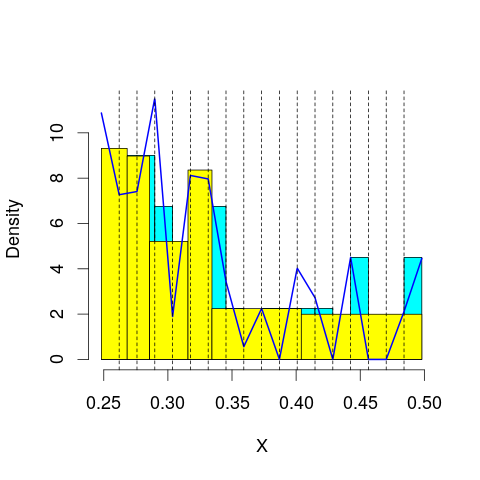

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.12003
mop.approx: Iteration 11. LL = 56.05817
mop.approx: Iteration 21. LL = 56.14656
mop.approx: Iteration 31. LL = 56.16006
mop.approx: Iteration 41. LL = 56.1635
mop.approx: Iteration 51. LL = 56.16456
mop.approx: Converged. Iteration 52. LL = 56.16467
[1] "Computing the linear combination of B-splines"


21.5073140763
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.99325
mop.approx: Iteration 11. LL = 54.6011
mop.approx: Iteration 21. LL = 54.76444
mop.approx: Iteration 31. LL = 54.82015
mop.approx: Iteration 41. LL = 54.84102
mop.approx: Iteration 51. LL = 54.8493
mop.approx: Iteration 61. LL = 54.85293
mop.approx: Iteration 71. LL = 54.85474
mop.approx: Iteration 81. LL = 54.85576
mop.approx: Converged. Iteration 88. LL = 54.85628
[1] "Computing the linear combination of B-splines"


18.4660490516
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.79032
mop.approx: Iteration 11. LL = 49.6989
mop.approx: Iteration 21. LL = 49.8645
mop.approx: Iteration 31. LL = 49.89582
mop.approx: Iteration 41. LL = 49.90327
mop.approx: Iteration 51. LL = 49.90519
mop.approx: Converged. Iteration 56. LL = 49.90556
[1] "Computing the linear combination of B-splines"


11.7824693805
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.210394
mop.approx: Iteration 11. LL = 48.91258
mop.approx: Iteration 21. LL = 49.00412
mop.approx: Iteration 31. LL = 49.025
mop.approx: Iteration 41. LL = 49.03412
mop.approx: Iteration 51. LL = 49.03873
mop.approx: Iteration 61. LL = 49.04115
mop.approx: Iteration 71. LL = 49.04248
mop.approx: Iteration 81. LL = 49.04322
mop.approx: Converged. Iteration 83. LL = 49.04337
[1] "Computing the linear combination of B-splines"


9.1874078685
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.204636
mop.approx: Iteration 11. LL = 48.86922
mop.approx: Iteration 21. LL = 49.07965
mop.approx: Iteration 31. LL = 49.13092
mop.approx: Iteration 41. LL = 49.15402
mop.approx: Iteration 51. LL = 49.16613
mop.approx: Iteration 61. LL = 49.17284
mop.approx: Iteration 71. LL = 49.17665
mop.approx: Iteration 81. LL = 49.17884
mop.approx: Iteration 91. LL = 49.18013
mop.approx: Iteration 101. LL = 49.18089
mop.approx: Converged. Iteration 104. LL = 49.1811
[1] "Computing the linear combination of B-splines"


7.59226411127
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.644991
mop.approx: Iteration 11. LL = 47.99555
mop.approx: Iteration 21. LL = 48.2489
mop.approx: Iteration 31. LL = 48.29343
mop.approx: Iteration 41. LL = 48.30349
mop.approx: Iteration 51. LL = 48.30625
mop.approx: Iteration 61. LL = 48.30714
mop.approx: Converged. Iteration 62. LL = 48.30723
[1] "Computing the linear combination of B-splines"


4.98553279016
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.558023
mop.approx: Iteration 11. LL = 47.21676
mop.approx: Iteration 21. LL = 47.37178
mop.approx: Iteration 31. LL = 47.41496
mop.approx: Iteration 41. LL = 47.43192
mop.approx: Iteration 51. LL = 47.44097
mop.approx: Iteration 61. LL = 47.44681
mop.approx: Iteration 71. LL = 47.45089
mop.approx: Iteration 81. LL = 47.45383
mop.approx: Iteration 91. LL = 47.45596
mop.approx: Iteration 101. LL = 47.45753
mop.approx: Iteration 111. LL = 47.45868
mop.approx: Iteration 121. LL = 47.45955
mop.approx: Iteration 131. LL = 47.4602
mop.approx: Converged. Iteration 138. LL = 47.46061
[1] "Computing the linear combination of B-splines"


2.40607016748
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.24732
mop.approx: Iteration 11. LL = 56.57053
mop.approx: Converged. Iteration 11. LL = 56.57058
[1] "Computing the linear combination of B-splines"


21.9132206633
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 21.913220663336048)
m reached
('Sum of Probabilities:', 0.992286108724694)
chosen


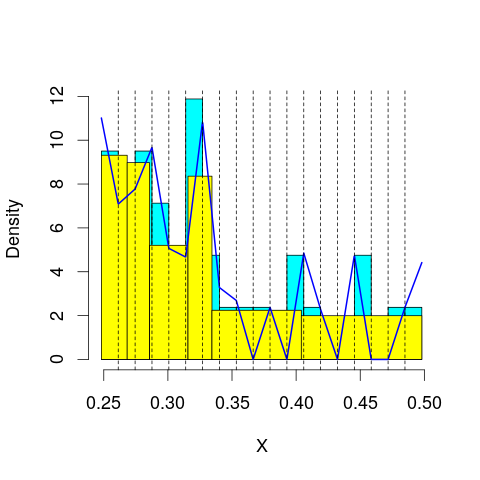

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.12003
mop.approx: Iteration 11. LL = 55.48537
mop.approx: Iteration 21. LL = 55.60781
mop.approx: Iteration 31. LL = 55.62452
mop.approx: Iteration 41. LL = 55.62979
mop.approx: Iteration 51. LL = 55.63201
mop.approx: Iteration 61. LL = 55.63302
mop.approx: Converged. Iteration 64. LL = 55.63326
[1] "Computing the linear combination of B-splines"


19.243036507
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.99325
mop.approx: Iteration 11. LL = 55.63374
mop.approx: Iteration 21. LL = 55.74838
mop.approx: Iteration 31. LL = 55.77537
mop.approx: Iteration 41. LL = 55.78409
mop.approx: Iteration 51. LL = 55.78704
mop.approx: Iteration 61. LL = 55.78803
mop.approx: Converged. Iteration 61. LL = 55.78808
[1] "Computing the linear combination of B-splines"


17.6649877804
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.79032
mop.approx: Iteration 11. LL = 49.38479
mop.approx: Iteration 21. LL = 49.51383
mop.approx: Iteration 31. LL = 49.54053
mop.approx: Iteration 41. LL = 49.54662
mop.approx: Iteration 51. LL = 49.5487
mop.approx: Iteration 61. LL = 49.54988
mop.approx: Iteration 71. LL = 49.55078
mop.approx: Iteration 81. LL = 49.55152
mop.approx: Iteration 91. LL = 49.55216
mop.approx: Converged. Iteration 100. LL = 49.55269
[1] "Computing the linear combination of B-splines"


9.6967229936
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.210394
mop.approx: Iteration 11. LL = 49.5848
mop.approx: Iteration 21. LL = 49.74098
mop.approx: Iteration 31. LL = 49.77809
mop.approx: Iteration 41. LL = 49.79382
mop.approx: Iteration 51. LL = 49.80297
mop.approx: Iteration 61. LL = 49.80897
mop.approx: Iteration 71. LL = 49.81311
mop.approx: Iteration 81. LL = 49.81605
mop.approx: Iteration 91. LL = 49.81819
mop.approx: Iteration 101. LL = 49.81976
mop.approx: Iteration 111. LL = 49.82094
mop.approx: Iteration 121. LL = 49.82183
mop.approx: Iteration 131. LL = 49.82251
mop.approx: Converged. Iteration 138. LL = 49.82294
[1] "Computing the linear combination of B-splines"


8.23411009138
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.204636
mop.approx: Iteration 11. LL = 48.72966
mop.approx: Iteration 21. LL = 48.84171
mop.approx: Iteration 31. LL = 48.87845
mop.approx: Iteration 41. LL = 48.89826
mop.approx: Iteration 51. LL = 48.90938
mop.approx: Iteration 61. LL = 48.91583
mop.approx: Iteration 71. LL = 48.91968
mop.approx: Iteration 81. LL = 48.92204
mop.approx: Iteration 91. LL = 48.9235
mop.approx: Iteration 101. LL = 48.92443
mop.approx: Converged. Iteration 110. LL = 48.92503
[1] "Computing the linear combination of B-splines"


5.60332632887
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.644991
mop.approx: Iteration 11. LL = 48.64905
mop.approx: Iteration 21. LL = 49.0112
mop.approx: Iteration 31. LL = 49.11172
mop.approx: Iteration 41. LL = 49.15289
mop.approx: Iteration 51. LL = 49.17351
mop.approx: Iteration 61. LL = 49.18523
mop.approx: Iteration 71. LL = 49.19247
mop.approx: Iteration 81. LL = 49.1972
mop.approx: Iteration 91. LL = 49.20041
mop.approx: Iteration 101. LL = 49.20265
mop.approx: Iteration 111. LL = 49.20425
mop.approx: Iteration 121. LL = 49.2054
mop.approx: Iteration 131. LL = 49.20625
mop.approx: Iteration 141. LL = 49.20688
mop.approx: Converged. Iteration 144. LL = 49.20708
[1] "Computing the linear combination of B-splines"


4.15251942439
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.558023
mop.approx: Iteration 11. LL = 47.49953
mop.approx: Iteration 21. LL = 47.64712
mop.approx: Iteration 31. LL = 47.68387
mop.approx: Iteration 41. LL = 47.69827
mop.approx: Iteration 51. LL = 47.7054
mop.approx: Iteration 61. LL = 47.70928
mop.approx: Iteration 71. LL = 47.71146
mop.approx: Iteration 81. LL = 47.71273
mop.approx: Iteration 91. LL = 47.71348
mop.approx: Converged. Iteration 95. LL = 47.71374
[1] "Computing the linear combination of B-splines"


0.92610701846
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.24732
mop.approx: Iteration 11. LL = 56.69017
mop.approx: Iteration 21. LL = 56.74515
mop.approx: Iteration 31. LL = 56.75905
mop.approx: Iteration 41. LL = 56.76518
mop.approx: Iteration 51. LL = 56.76826
mop.approx: Iteration 61. LL = 56.76984
mop.approx: Iteration 71. LL = 56.77066
mop.approx: Converged. Iteration 71. LL = 56.77072
[1] "Computing the linear combination of B-splines"


20.3804919509
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 20.380491950908549)
m reached
('Sum of Probabilities:', 0.9918999756234158)
chosen


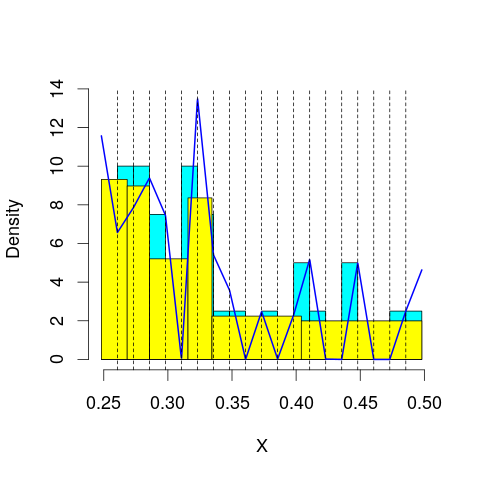

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.12003
mop.approx: Iteration 11. LL = 56.17734
mop.approx: Iteration 21. LL = 56.29239
mop.approx: Iteration 31. LL = 56.31721
mop.approx: Iteration 41. LL = 56.32451
mop.approx: Iteration 51. LL = 56.32702
mop.approx: Iteration 61. LL = 56.32802
mop.approx: Converged. Iteration 63. LL = 56.3282
[1] "Computing the linear combination of B-splines"


18.2051029209
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.99325
mop.approx: Iteration 11. LL = 55.7907
mop.approx: Iteration 21. LL = 55.92843
mop.approx: Iteration 31. LL = 55.95158
mop.approx: Iteration 41. LL = 55.95955
mop.approx: Iteration 51. LL = 55.9634
mop.approx: Iteration 61. LL = 55.96567
mop.approx: Iteration 71. LL = 55.96719
mop.approx: Iteration 81. LL = 55.96831
mop.approx: Iteration 91. LL = 55.96917
mop.approx: Iteration 101. LL = 55.96983
mop.approx: Converged. Iteration 103. LL = 55.97
[1] "Computing the linear combination of B-splines"


16.1140345865
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.79032
mop.approx: Iteration 11. LL = 49.92034
mop.approx: Iteration 21. LL = 50.04437
mop.approx: Iteration 31. LL = 50.06869
mop.approx: Iteration 41. LL = 50.07579
mop.approx: Iteration 51. LL = 50.07832
mop.approx: Iteration 61. LL = 50.07935
mop.approx: Converged. Iteration 65. LL = 50.07962
[1] "Computing the linear combination of B-splines"


8.49079193618
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.210394
mop.approx: Iteration 11. LL = 49.85488
mop.approx: Iteration 21. LL = 50.01289
mop.approx: Iteration 31. LL = 50.04986
mop.approx: Iteration 41. LL = 50.06269
mop.approx: Iteration 51. LL = 50.06845
mop.approx: Iteration 61. LL = 50.07147
mop.approx: Iteration 71. LL = 50.07316
mop.approx: Iteration 81. LL = 50.07415
mop.approx: Converged. Iteration 89. LL = 50.07469
[1] "Computing the linear combination of B-splines"


6.75298813019
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.204636
mop.approx: Iteration 11. LL = 49.06965
mop.approx: Iteration 21. LL = 49.22076
mop.approx: Iteration 31. LL = 49.25382
mop.approx: Iteration 41. LL = 49.26588
mop.approx: Iteration 51. LL = 49.27208
mop.approx: Iteration 61. LL = 49.27587
mop.approx: Iteration 71. LL = 49.27838
mop.approx: Iteration 81. LL = 49.28013
mop.approx: Iteration 91. LL = 49.28138
mop.approx: Iteration 101. LL = 49.2823
mop.approx: Iteration 111. LL = 49.28299
mop.approx: Converged. Iteration 119. LL = 49.28348
[1] "Computing the linear combination of B-splines"


4.22890997227
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.644991
mop.approx: Iteration 11. LL = 48.96454
mop.approx: Iteration 21. LL = 49.29758
mop.approx: Iteration 31. LL = 49.37464
mop.approx: Iteration 41. LL = 49.40205
mop.approx: Iteration 51. LL = 49.4143
mop.approx: Iteration 61. LL = 49.42057
mop.approx: Iteration 71. LL = 49.42402
mop.approx: Iteration 81. LL = 49.42598
mop.approx: Iteration 91. LL = 49.42713
mop.approx: Iteration 101. LL = 49.42781
mop.approx: Converged. Iteration 102. LL = 49.42791
[1] "Computing the linear combination of B-splines"


2.64046212969
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.558023
mop.approx: Iteration 11. LL = 48.06365
mop.approx: Iteration 21. LL = 48.28978
mop.approx: Iteration 31. LL = 48.34619
mop.approx: Iteration 41. LL = 48.36772
mop.approx: Iteration 51. LL = 48.37866
mop.approx: Iteration 61. LL = 48.38542
mop.approx: Iteration 71. LL = 48.39015
mop.approx: Iteration 81. LL = 48.39368
mop.approx: Iteration 91. LL = 48.39639
mop.approx: Iteration 101. LL = 48.39851
mop.approx: Iteration 111. LL = 48.40017
mop.approx: Iteration 121. LL = 48.40148
mop.approx: Iteration 131. LL = 48.4025
mop.approx: Iteration 141. LL = 48.4033
mop.approx: Iteration 151. LL = 48.40393
mop.approx: Converged. Iteration 156. LL = 48.40424
[1] "Computing the linear combination of B-splines"


-0.116256372343
lfps_15
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.69041
mop.approx: Iteration 11. LL = 54.61254
mop.approx: Converged. Iteration 13. LL = 54.61281
[1] "Computing the linear combination of B-splines"


49.4142026177
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 49.414202617728691)
m reached
('Sum of Probabilities:', 0.9922919671461427)
chosen


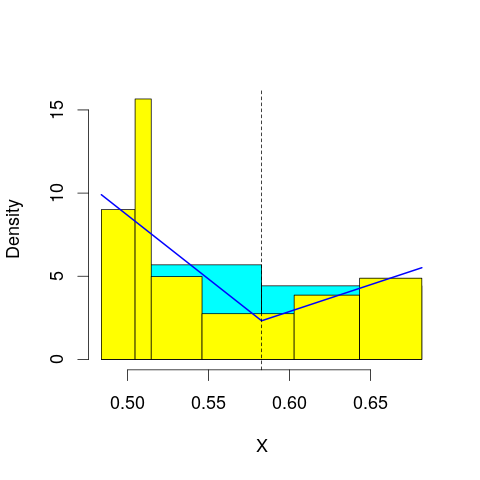

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.52986
mop.approx: Iteration 11. LL = 54.94642
mop.approx: Iteration 21. LL = 55.0013
mop.approx: Iteration 31. LL = 55.01519
mop.approx: Iteration 41. LL = 55.01944
mop.approx: Iteration 51. LL = 55.0209
mop.approx: Converged. Iteration 55. LL = 55.02124
[1] "Computing the linear combination of B-splines"


48.0897635271
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.37012
mop.approx: Iteration 11. LL = 54.49183
mop.approx: Iteration 21. LL = 54.50069
mop.approx: Iteration 31. LL = 54.50299
mop.approx: Iteration 41. LL = 54.50436
mop.approx: Iteration 51. LL = 54.50523
mop.approx: Converged. Iteration 56. LL = 54.50559
[1] "Computing the linear combination of B-splines"


45.8412524693
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.46258
mop.approx: Iteration 11. LL = 41.44331
mop.approx: Converged. Iteration 16. LL = 41.4468
[1] "Computing the linear combination of B-splines"


31.0495965457
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.51314
mop.approx: Iteration 11. LL = 40.91274
mop.approx: Iteration 21. LL = 41.31945
mop.approx: Iteration 31. LL = 41.38517
mop.approx: Iteration 41. LL = 41.40713
mop.approx: Iteration 51. LL = 41.41603
mop.approx: Iteration 61. LL = 41.41991
mop.approx: Iteration 71. LL = 41.42166
mop.approx: Iteration 81. LL = 41.42246
mop.approx: Converged. Iteration 84. LL = 41.42264
[1] "Computing the linear combination of B-splines"


29.2925645291
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.227672
mop.approx: Iteration 11. LL = 39.62357
mop.approx: Iteration 21. LL = 39.64471
mop.approx: Converged. Iteration 23. LL = 39.64484
[1] "Computing the linear combination of B-splines"


25.7818968723
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.448928
mop.approx: Iteration 11. LL = 39.56194
mop.approx: Iteration 21. LL = 40.06602
mop.approx: Iteration 31. LL = 40.14282
mop.approx: Iteration 41. LL = 40.1611
mop.approx: Iteration 51. LL = 40.16579
mop.approx: Iteration 61. LL = 40.16701
mop.approx: Converged. Iteration 64. LL = 40.16719
[1] "Computing the linear combination of B-splines"


24.5713784083
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.06964362
mop.approx: Iteration 11. LL = 37.94849
mop.approx: Iteration 21. LL = 38.02343
mop.approx: Iteration 31. LL = 38.0278
mop.approx: Converged. Iteration 36. LL = 38.02815
[1] "Computing the linear combination of B-splines"


20.6994742911
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.69041
mop.approx: Iteration 11. LL = 55.89572
mop.approx: Converged. Iteration 17. LL = 55.89847
[1] "Computing the linear combination of B-splines"


48.9669938362
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 48.966993836158998)
m reached
('Sum of Probabilities:', 0.99072914263396)
chosen


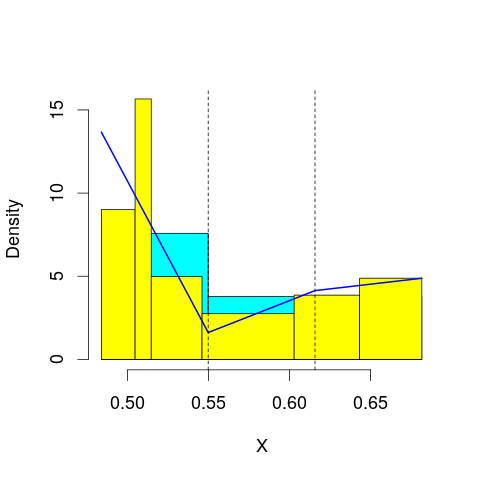

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.52986
mop.approx: Iteration 11. LL = 54.83933
mop.approx: Iteration 21. LL = 54.8472
mop.approx: Converged. Iteration 28. LL = 54.84806
[1] "Computing the linear combination of B-splines"


46.1837165539
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.37012
mop.approx: Iteration 11. LL = 55.554
mop.approx: Iteration 21. LL = 55.83568
mop.approx: Iteration 31. LL = 55.90102
mop.approx: Iteration 41. LL = 55.91811
mop.approx: Iteration 51. LL = 55.92379
mop.approx: Iteration 61. LL = 55.92628
mop.approx: Iteration 71. LL = 55.9276
mop.approx: Iteration 81. LL = 55.92837
mop.approx: Converged. Iteration 82. LL = 55.92848
[1] "Computing the linear combination of B-splines"


45.5312752929
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.46258
mop.approx: Iteration 11. LL = 41.46847
mop.approx: Iteration 21. LL = 41.47249
mop.approx: Converged. Iteration 22. LL = 41.47258
[1] "Computing the linear combination of B-splines"


29.3425086372
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.51314
mop.approx: Iteration 11. LL = 42.41363
mop.approx: Iteration 21. LL = 42.48845
mop.approx: Converged. Iteration 25. LL = 42.48908
[1] "Computing the linear combination of B-splines"


28.6261324451
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.227672
mop.approx: Iteration 11. LL = 40.92264
mop.approx: Iteration 21. LL = 41.30003
mop.approx: Iteration 31. LL = 41.35677
mop.approx: Iteration 41. LL = 41.36363
mop.approx: Converged. Iteration 48. LL = 41.36432
[1] "Computing the linear combination of B-splines"


25.7685066323
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.448928
mop.approx: Iteration 11. LL = 41.11994
mop.approx: Iteration 21. LL = 41.17502
mop.approx: Converged. Iteration 23. LL = 41.1752
[1] "Computing the linear combination of B-splines"


23.8465210739
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.06964362
mop.approx: Iteration 11. LL = 40.27511
mop.approx: Iteration 21. LL = 40.78071
mop.approx: Iteration 31. LL = 40.85459
mop.approx: Iteration 41. LL = 40.8789
mop.approx: Iteration 51. LL = 40.8904
mop.approx: Iteration 61. LL = 40.8968
mop.approx: Iteration 71. LL = 40.90074
mop.approx: Iteration 81. LL = 40.90332
mop.approx: Iteration 91. LL = 40.9051
mop.approx: Iteration 101. LL = 40.90636
mop.approx: Iteration 111. LL = 40.90728
mop.approx: Iteration 121. LL = 40.90797
mop.approx: Iteration 131. LL = 40.90848
mop.approx: Converged. Iteration 134. LL = 40.90865
[1] "Computing the linear combination of B-splines"


21.8471005765
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.69041
mop.approx: Iteration 11. LL = 55.35018
mop.approx: Converged. Iteration 13. LL = 55.35055
[1] "Computing the linear combination of B-splines"


46.6862053867
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 46.686205386680165)
m reached
('Sum of Probabilities:', 0.9899639330061585)
chosen


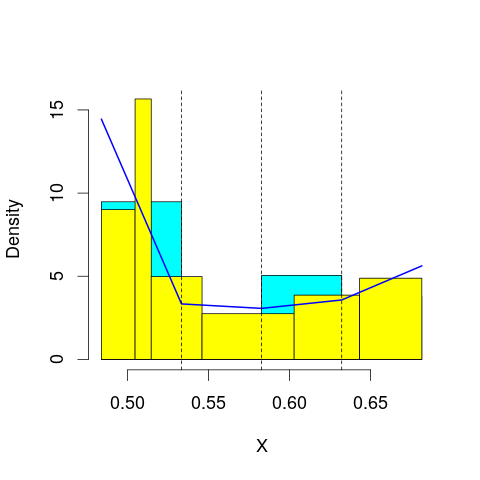

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.52986
mop.approx: Iteration 11. LL = 56.71083
mop.approx: Iteration 21. LL = 56.85097
mop.approx: Iteration 31. LL = 56.87974
mop.approx: Iteration 41. LL = 56.88836
mop.approx: Iteration 51. LL = 56.89151
mop.approx: Iteration 61. LL = 56.89288
mop.approx: Converged. Iteration 70. LL = 56.8936
[1] "Computing the linear combination of B-splines"


46.4963907358
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.37012
mop.approx: Iteration 11. LL = 56.81985
mop.approx: Iteration 21. LL = 56.96293
mop.approx: Iteration 31. LL = 56.99372
mop.approx: Iteration 41. LL = 57.00431
mop.approx: Iteration 51. LL = 57.00856
mop.approx: Iteration 61. LL = 57.01036
mop.approx: Converged. Iteration 69. LL = 57.01108
[1] "Computing the linear combination of B-splines"


44.8810069262
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.46258
mop.approx: Iteration 11. LL = 41.52741
mop.approx: Iteration 21. LL = 41.53669
mop.approx: Iteration 31. LL = 41.53848
mop.approx: Converged. Iteration 35. LL = 41.53876
[1] "Computing the linear combination of B-splines"


27.6758166864
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.51314
mop.approx: Iteration 11. LL = 43.2937
mop.approx: Iteration 21. LL = 43.3332
mop.approx: Iteration 31. LL = 43.33644
mop.approx: Converged. Iteration 34. LL = 43.33668
[1] "Computing the linear combination of B-splines"


27.7408646039
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.227672
mop.approx: Iteration 11. LL = 41.81494
mop.approx: Iteration 21. LL = 42.12624
mop.approx: Iteration 31. LL = 42.182
mop.approx: Iteration 41. LL = 42.19362
mop.approx: Iteration 51. LL = 42.19621
mop.approx: Converged. Iteration 58. LL = 42.19675
[1] "Computing the linear combination of B-splines"


24.8680728654
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.448928
mop.approx: Iteration 11. LL = 41.24002
mop.approx: Iteration 21. LL = 41.29867
mop.approx: Iteration 31. LL = 41.31358
mop.approx: Iteration 41. LL = 41.31788
mop.approx: Iteration 51. LL = 41.31921
mop.approx: Converged. Iteration 56. LL = 41.31952
[1] "Computing the linear combination of B-splines"


22.2579761717
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.06964362
mop.approx: Iteration 11. LL = 41.74362
mop.approx: Iteration 21. LL = 41.93085
mop.approx: Iteration 31. LL = 41.9355
mop.approx: Converged. Iteration 31. LL = 41.93553
[1] "Computing the linear combination of B-splines"


21.1411172765
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.69041
mop.approx: Converged. Iteration 10. LL = 56.08748
[1] "Computing the linear combination of B-splines"


45.6902754543
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 45.69027545430307)
m reached
('Sum of Probabilities:', 0.9907314777996299)
chosen


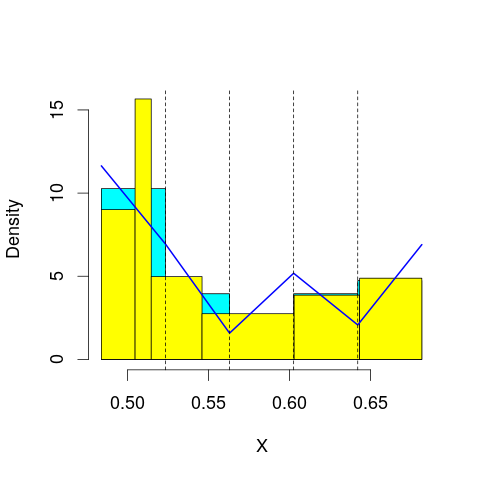

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.52986
mop.approx: Iteration 11. LL = 57.21672
mop.approx: Iteration 21. LL = 57.28463
mop.approx: Iteration 31. LL = 57.29935
mop.approx: Iteration 41. LL = 57.30474
mop.approx: Iteration 51. LL = 57.30724
mop.approx: Iteration 61. LL = 57.30856
mop.approx: Iteration 71. LL = 57.30933
mop.approx: Converged. Iteration 72. LL = 57.30944
[1] "Computing the linear combination of B-splines"


45.1793665899
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.37012
mop.approx: Iteration 11. LL = 57.14227
mop.approx: Iteration 21. LL = 57.18985
mop.approx: Iteration 31. LL = 57.19723
mop.approx: Iteration 41. LL = 57.19926
mop.approx: Converged. Iteration 48. LL = 57.19989
[1] "Computing the linear combination of B-splines"


43.3369415207
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.46258
mop.approx: Iteration 11. LL = 44.39985
mop.approx: Iteration 21. LL = 44.83279
mop.approx: Iteration 31. LL = 44.90416
mop.approx: Iteration 41. LL = 44.92442
mop.approx: Iteration 51. LL = 44.93294
mop.approx: Iteration 61. LL = 44.93733
mop.approx: Iteration 71. LL = 44.93986
mop.approx: Iteration 81. LL = 44.9414
mop.approx: Iteration 91. LL = 44.94239
mop.approx: Iteration 101. LL = 44.94303
mop.approx: Converged. Iteration 104. LL = 44.94322
[1] "Computing the linear combination of B-splines"


29.3474068399
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.51314
mop.approx: Iteration 11. LL = 43.80003
mop.approx: Iteration 21. LL = 43.91726
mop.approx: Iteration 31. LL = 43.9524
mop.approx: Iteration 41. LL = 43.967
mop.approx: Iteration 51. LL = 43.97441
mop.approx: Iteration 61. LL = 43.97869
mop.approx: Iteration 71. LL = 43.98137
mop.approx: Iteration 81. LL = 43.98316
mop.approx: Iteration 91. LL = 43.98441
mop.approx: Iteration 101. LL = 43.98531
mop.approx: Iteration 111. LL = 43.98598
mop.approx: Iteration 121. LL = 43.98648
mop.approx: Converged. Iteration 121. LL = 43.98652
[1] "Computing the linear combination of B-splines"


26.6578426405
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.227672
mop.approx: Iteration 11. LL = 44.51701
mop.approx: Iteration 21. LL = 44.76265
mop.approx: Iteration 31. LL = 44.80058
mop.approx: Iteration 41. LL = 44.81477
mop.approx: Iteration 51. LL = 44.82164
mop.approx: Iteration 61. LL = 44.82545
mop.approx: Iteration 71. LL = 44.82773
mop.approx: Iteration 81. LL = 44.82916
mop.approx: Iteration 91. LL = 44.83009
mop.approx: Iteration 101. LL = 44.83071
mop.approx: Converged. Iteration 104. LL = 44.83089
[1] "Computing the linear combination of B-splines"


25.7693458538
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.448928
mop.approx: Iteration 11. LL = 41.33119
mop.approx: Iteration 21. LL = 41.36131
mop.approx: Iteration 31. LL = 41.36491
mop.approx: Converged. Iteration 38. LL = 41.36549
[1] "Computing the linear combination of B-splines"


20.5710701214
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.06964362
mop.approx: Iteration 11. LL = 42.12426
mop.approx: Iteration 21. LL = 42.15497
mop.approx: Iteration 31. LL = 42.1588
mop.approx: Iteration 41. LL = 42.15968
mop.approx: Converged. Iteration 41. LL = 42.15972
[1] "Computing the linear combination of B-splines"


19.6324337899
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.69041
mop.approx: Iteration 11. LL = 56.98299
mop.approx: Iteration 21. LL = 56.98786
mop.approx: Converged. Iteration 23. LL = 56.98806
[1] "Computing the linear combination of B-splines"


44.8579887378
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 44.857988737813756)
m reached
('Sum of Probabilities:', 0.9919006183796302)
chosen


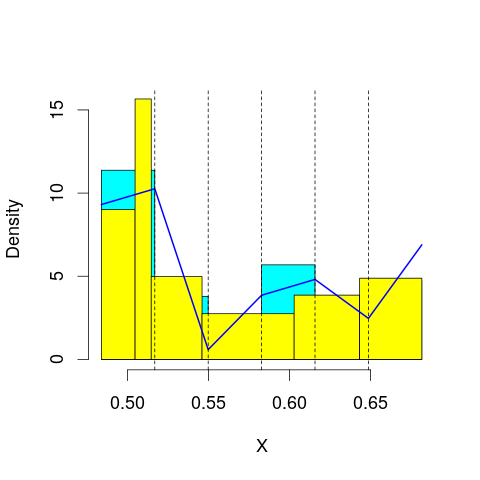

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.52986
mop.approx: Iteration 11. LL = 57.67099
mop.approx: Iteration 21. LL = 57.74839
mop.approx: Iteration 31. LL = 57.76465
mop.approx: Iteration 41. LL = 57.76853
mop.approx: Converged. Iteration 50. LL = 57.76953
[1] "Computing the linear combination of B-splines"


43.9065856404
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.37012
mop.approx: Iteration 11. LL = 57.28447
mop.approx: Iteration 21. LL = 57.32889
mop.approx: Iteration 31. LL = 57.3421
mop.approx: Iteration 41. LL = 57.34762
mop.approx: Iteration 51. LL = 57.35046
mop.approx: Iteration 61. LL = 57.35213
mop.approx: Iteration 71. LL = 57.35318
mop.approx: Iteration 81. LL = 57.35387
mop.approx: Converged. Iteration 81. LL = 57.35393
[1] "Computing the linear combination of B-splines"


41.7581175284
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.46258
mop.approx: Iteration 11. LL = 47.15982
mop.approx: Iteration 21. LL = 47.38386
mop.approx: Iteration 31. LL = 47.39616
mop.approx: Converged. Iteration 38. LL = 47.39705
[1] "Computing the linear combination of B-splines"


30.068365932
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.51314
mop.approx: Iteration 11. LL = 44.26836
mop.approx: Iteration 21. LL = 44.37436
mop.approx: Iteration 31. LL = 44.40008
mop.approx: Iteration 41. LL = 44.40706
mop.approx: Iteration 51. LL = 44.40896
mop.approx: Converged. Iteration 57. LL = 44.40939
[1] "Computing the linear combination of B-splines"


25.3478430353
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.227672
mop.approx: Iteration 11. LL = 45.61552
mop.approx: Iteration 21. LL = 45.7636
mop.approx: Iteration 31. LL = 45.7919
mop.approx: Iteration 41. LL = 45.79849
mop.approx: Iteration 51. LL = 45.80008
mop.approx: Converged. Iteration 54. LL = 45.8003
[1] "Computing the linear combination of B-splines"


25.0058875292
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.448928
mop.approx: Iteration 11. LL = 44.41536
mop.approx: Iteration 21. LL = 45.07436
mop.approx: Iteration 31. LL = 45.15482
mop.approx: Iteration 41. LL = 45.16585
mop.approx: Iteration 51. LL = 45.16751
mop.approx: Converged. Iteration 52. LL = 45.16761
[1] "Computing the linear combination of B-splines"


22.6403238964
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.06964362
mop.approx: Iteration 11. LL = 42.23488
mop.approx: Iteration 21. LL = 42.29066
mop.approx: Iteration 31. LL = 42.31827
mop.approx: Iteration 41. LL = 42.33315
mop.approx: Iteration 51. LL = 42.34158
mop.approx: Iteration 61. LL = 42.34659
mop.approx: Iteration 71. LL = 42.34968
mop.approx: Iteration 81. LL = 42.35165
mop.approx: Iteration 91. LL = 42.35294
mop.approx: Iteration 101. LL = 42.3538
mop.approx: Iteration 111. LL = 42.35439
mop.approx: Converged. Iteration 115. LL = 42.35462
[1] "Computing the linear combination of B-splines"


18.0944653986
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.69041
mop.approx: Iteration 11. LL = 58.40328
mop.approx: Iteration 21. LL = 58.45396
mop.approx: Iteration 31. LL = 58.4606
mop.approx: Converged. Iteration 38. LL = 58.46151
[1] "Computing the linear combination of B-splines"


44.5985678255
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 44.598567825520497)
m reached
('Sum of Probabilities:', 0.9921734219214864)
chosen


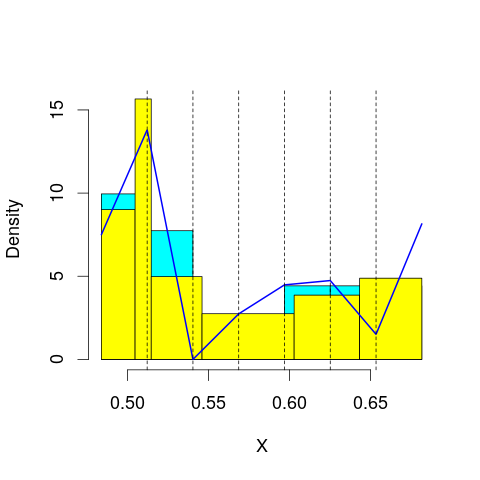

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.52986
mop.approx: Iteration 11. LL = 57.67065
mop.approx: Iteration 21. LL = 57.70208
mop.approx: Converged. Iteration 30. LL = 57.70429
[1] "Computing the linear combination of B-splines"


42.1084797654
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.37012
mop.approx: Iteration 11. LL = 57.68672
mop.approx: Iteration 21. LL = 57.81588
mop.approx: Iteration 31. LL = 57.84912
mop.approx: Iteration 41. LL = 57.85697
mop.approx: Iteration 51. LL = 57.85876
mop.approx: Converged. Iteration 53. LL = 57.85895
[1] "Computing the linear combination of B-splines"


40.5302734443
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.46258
mop.approx: Iteration 11. LL = 48.8342
mop.approx: Iteration 21. LL = 48.94326
mop.approx: Iteration 31. LL = 48.95196
mop.approx: Converged. Iteration 37. LL = 48.95265
[1] "Computing the linear combination of B-splines"


29.8910989086
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.51314
mop.approx: Iteration 11. LL = 45.20443
mop.approx: Iteration 21. LL = 45.29411
mop.approx: Iteration 31. LL = 45.30079
mop.approx: Converged. Iteration 37. LL = 45.30141
[1] "Computing the linear combination of B-splines"


24.5069906743
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.227672
mop.approx: Iteration 11. LL = 46.00711
mop.approx: Iteration 21. LL = 46.04671
mop.approx: Iteration 31. LL = 46.04881
mop.approx: Converged. Iteration 31. LL = 46.04885
[1] "Computing the linear combination of B-splines"


23.5215648394
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.448928
mop.approx: Iteration 11. LL = 46.28851
mop.approx: Iteration 21. LL = 46.50681
mop.approx: Iteration 31. LL = 46.51761
mop.approx: Converged. Iteration 38. LL = 46.51851
[1] "Computing the linear combination of B-splines"


22.2583571742
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.06964362
mop.approx: Iteration 11. LL = 43.84444
mop.approx: Iteration 21. LL = 44.33569
mop.approx: Iteration 31. LL = 44.43683
mop.approx: Iteration 41. LL = 44.46009
mop.approx: Iteration 51. LL = 44.46722
mop.approx: Iteration 61. LL = 44.4699
mop.approx: Iteration 71. LL = 44.47102
mop.approx: Converged. Iteration 77. LL = 44.47141
[1] "Computing the linear combination of B-splines"


18.4784005159
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.69041
mop.approx: Iteration 11. LL = 58.16112
mop.approx: Iteration 21. LL = 58.17476
mop.approx: Iteration 31. LL = 58.17774
mop.approx: Iteration 41. LL = 58.1788
mop.approx: Converged. Iteration 43. LL = 58.17898
[1] "Computing the linear combination of B-splines"


42.5831709381
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 42.583170938059205)
m reached
('Sum of Probabilities:', 0.9914727066649638)
chosen


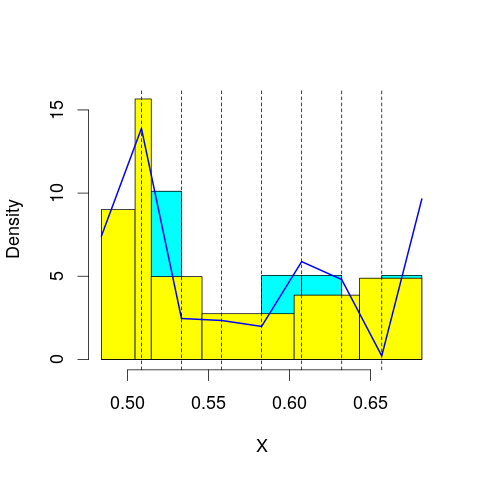

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.52986
mop.approx: Iteration 11. LL = 58.14937
mop.approx: Iteration 21. LL = 58.22158
mop.approx: Iteration 31. LL = 58.23081
mop.approx: Converged. Iteration 40. LL = 58.23216
[1] "Computing the linear combination of B-splines"


40.9034808385
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.37012
mop.approx: Iteration 11. LL = 58.22472
mop.approx: Iteration 21. LL = 58.41355
mop.approx: Iteration 31. LL = 58.45129
mop.approx: Iteration 41. LL = 58.46053
mop.approx: Iteration 51. LL = 58.46352
mop.approx: Iteration 61. LL = 58.4648
mop.approx: Converged. Iteration 68. LL = 58.46536
[1] "Computing the linear combination of B-splines"


39.4038119538
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.46258
mop.approx: Iteration 11. LL = 49.88343
mop.approx: Iteration 21. LL = 49.97628
mop.approx: Iteration 31. LL = 49.98916
mop.approx: Iteration 41. LL = 49.99243
mop.approx: Converged. Iteration 50. LL = 49.99333
[1] "Computing the linear combination of B-splines"


29.1989188886
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.51314
mop.approx: Iteration 11. LL = 47.0126
mop.approx: Iteration 21. LL = 47.2346
mop.approx: Iteration 31. LL = 47.27931
mop.approx: Iteration 41. LL = 47.29426
mop.approx: Iteration 51. LL = 47.30015
mop.approx: Iteration 61. LL = 47.30262
mop.approx: Iteration 71. LL = 47.30369
mop.approx: Converged. Iteration 76. LL = 47.30402
[1] "Computing the linear combination of B-splines"


24.7767352752
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.227672
mop.approx: Iteration 11. LL = 46.06555
mop.approx: Iteration 21. LL = 46.09875
mop.approx: Iteration 31. LL = 46.10541
mop.approx: Iteration 41. LL = 46.10682
mop.approx: Converged. Iteration 42. LL = 46.10692
[1] "Computing the linear combination of B-splines"


21.8467657852
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.448928
mop.approx: Iteration 11. LL = 47.21034
mop.approx: Iteration 21. LL = 47.31656
mop.approx: Iteration 31. LL = 47.33105
mop.approx: Iteration 41. LL = 47.33566
mop.approx: Iteration 51. LL = 47.33738
mop.approx: Converged. Iteration 59. LL = 47.33799
[1] "Computing the linear combination of B-splines"


21.3449728964
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.06964362
mop.approx: Iteration 11. LL = 45.75962
mop.approx: Iteration 21. LL = 46.27364
mop.approx: Iteration 31. LL = 46.33895
mop.approx: Iteration 41. LL = 46.34795
mop.approx: Iteration 51. LL = 46.34928
mop.approx: Converged. Iteration 51. LL = 46.34932
[1] "Computing the linear combination of B-splines"


18.6234330348
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.69041
mop.approx: Iteration 11. LL = 58.45354
mop.approx: Iteration 21. LL = 58.48477
mop.approx: Iteration 31. LL = 58.48846
mop.approx: Iteration 41. LL = 58.48981
mop.approx: Converged. Iteration 49. LL = 58.49047
[1] "Computing the linear combination of B-splines"


41.1617856911
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 41.161785691068786)
m reached
('Sum of Probabilities:', 0.9906836509755702)
chosen


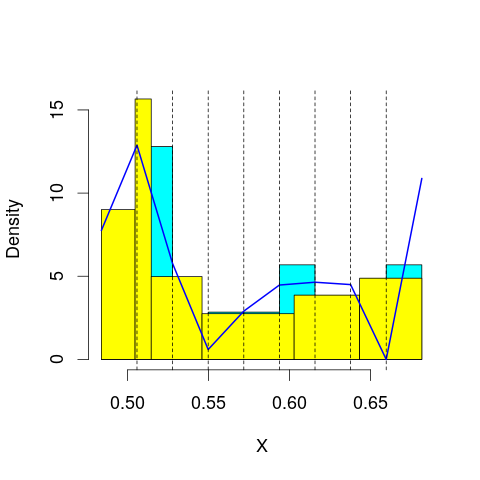

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.52986
mop.approx: Iteration 11. LL = 59.34318
mop.approx: Iteration 21. LL = 59.39241
mop.approx: Converged. Iteration 28. LL = 59.39385
[1] "Computing the linear combination of B-splines"


40.3323062605
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.37012
mop.approx: Iteration 11. LL = 57.96905
mop.approx: Iteration 21. LL = 58.07538
mop.approx: Iteration 31. LL = 58.10257
mop.approx: Iteration 41. LL = 58.11351
mop.approx: Iteration 51. LL = 58.11891
mop.approx: Iteration 61. LL = 58.12192
mop.approx: Iteration 71. LL = 58.12374
mop.approx: Iteration 81. LL = 58.12492
mop.approx: Iteration 91. LL = 58.12572
mop.approx: Converged. Iteration 95. LL = 58.12603
[1] "Computing the linear combination of B-splines"


37.331614553
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.46258
mop.approx: Iteration 11. LL = 50.88692
mop.approx: Iteration 21. LL = 51.06875
mop.approx: Iteration 31. LL = 51.10971
mop.approx: Iteration 41. LL = 51.12408
mop.approx: Iteration 51. LL = 51.13058
mop.approx: Iteration 61. LL = 51.13392
mop.approx: Iteration 71. LL = 51.13574
mop.approx: Iteration 81. LL = 51.13675
mop.approx: Converged. Iteration 88. LL = 51.13724
[1] "Computing the linear combination of B-splines"


28.6099591261
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.51314
mop.approx: Iteration 11. LL = 48.58662
mop.approx: Iteration 21. LL = 48.79998
mop.approx: Iteration 31. LL = 48.83253
mop.approx: Iteration 41. LL = 48.84305
mop.approx: Iteration 51. LL = 48.84791
mop.approx: Iteration 61. LL = 48.85053
mop.approx: Iteration 71. LL = 48.85208
mop.approx: Iteration 81. LL = 48.85306
mop.approx: Iteration 91. LL = 48.85371
mop.approx: Converged. Iteration 93. LL = 48.85386
[1] "Computing the linear combination of B-splines"


24.5937065815
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.227672
mop.approx: Iteration 11. LL = 46.48982
mop.approx: Iteration 21. LL = 46.56695
mop.approx: Iteration 31. LL = 46.58678
mop.approx: Iteration 41. LL = 46.59451
mop.approx: Iteration 51. LL = 46.59833
mop.approx: Iteration 61. LL = 46.60049
mop.approx: Iteration 71. LL = 46.6018
mop.approx: Iteration 81. LL = 46.60264
mop.approx: Converged. Iteration 90. LL = 46.60319
[1] "Computing the linear combination of B-splines"


20.6101724198
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.448928
mop.approx: Iteration 11. LL = 47.48504
mop.approx: Iteration 21. LL = 47.55245
mop.approx: Iteration 31. LL = 47.5632
mop.approx: Iteration 41. LL = 47.56607
mop.approx: Iteration 51. LL = 47.56715
mop.approx: Converged. Iteration 60. LL = 47.56774
[1] "Computing the linear combination of B-splines"


19.8418474913
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.06964362
mop.approx: Iteration 11. LL = 47.34352
mop.approx: Iteration 21. LL = 47.62174
mop.approx: Iteration 31. LL = 47.63991
mop.approx: Iteration 41. LL = 47.64255
mop.approx: Iteration 51. LL = 47.64343
mop.approx: Converged. Iteration 56. LL = 47.64375
[1] "Computing the linear combination of B-splines"


18.1849662283
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.69041
mop.approx: Iteration 11. LL = 60.20547
mop.approx: Converged. Iteration 17. LL = 60.20919
[1] "Computing the linear combination of B-splines"


41.1476382957
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 41.147638295707949)
m reached
('Sum of Probabilities:', 0.9897733671465301)
chosen


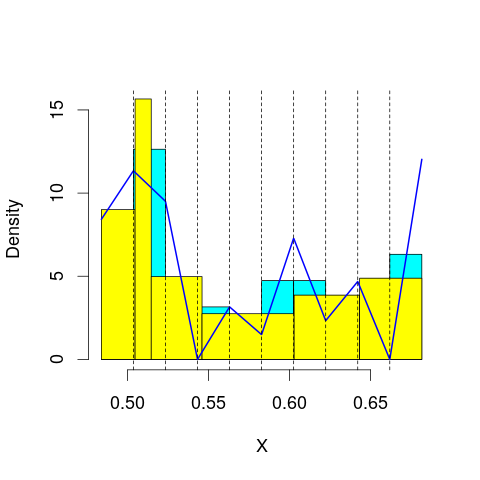

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.52986
mop.approx: Iteration 11. LL = 59.1209
mop.approx: Iteration 21. LL = 59.2491
mop.approx: Iteration 31. LL = 59.2757
mop.approx: Iteration 41. LL = 59.28275
mop.approx: Iteration 51. LL = 59.28477
mop.approx: Converged. Iteration 56. LL = 59.28521
[1] "Computing the linear combination of B-splines"


38.4907960817
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.37012
mop.approx: Iteration 11. LL = 58.59415
mop.approx: Iteration 21. LL = 58.73202
mop.approx: Iteration 31. LL = 58.75464
mop.approx: Iteration 41. LL = 58.76092
mop.approx: Iteration 51. LL = 58.76323
mop.approx: Iteration 61. LL = 58.76419
mop.approx: Converged. Iteration 61. LL = 58.76425
[1] "Computing the linear combination of B-splines"


36.2369637103
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.46258
mop.approx: Iteration 11. LL = 50.92349
mop.approx: Iteration 21. LL = 51.01064
mop.approx: Iteration 31. LL = 51.03003
mop.approx: Iteration 41. LL = 51.03738
mop.approx: Iteration 51. LL = 51.04095
mop.approx: Iteration 61. LL = 51.04297
mop.approx: Iteration 71. LL = 51.04422
mop.approx: Iteration 81. LL = 51.04504
mop.approx: Converged. Iteration 89. LL = 51.04556
[1] "Computing the linear combination of B-splines"


26.7854074574
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.51314
mop.approx: Iteration 11. LL = 50.23008
mop.approx: Iteration 21. LL = 50.53411
mop.approx: Iteration 31. LL = 50.61497
mop.approx: Iteration 41. LL = 50.64436
mop.approx: Iteration 51. LL = 50.65566
mop.approx: Iteration 61. LL = 50.66012
mop.approx: Iteration 71. LL = 50.66193
mop.approx: Converged. Iteration 80. LL = 50.66267
[1] "Computing the linear combination of B-splines"


24.669652899
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.227672
mop.approx: Iteration 11. LL = 47.19563
mop.approx: Iteration 21. LL = 47.28558
mop.approx: Iteration 31. LL = 47.30055
mop.approx: Iteration 41. LL = 47.30468
mop.approx: Iteration 51. LL = 47.30639
mop.approx: Iteration 61. LL = 47.30729
mop.approx: Converged. Iteration 69. LL = 47.30779
[1] "Computing the linear combination of B-splines"


19.581898875
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.448928
mop.approx: Iteration 11. LL = 47.61506
mop.approx: Iteration 21. LL = 47.6625
mop.approx: Iteration 31. LL = 47.67625
mop.approx: Iteration 41. LL = 47.68321
mop.approx: Iteration 51. LL = 47.68736
mop.approx: Iteration 61. LL = 47.69009
mop.approx: Iteration 71. LL = 47.69203
mop.approx: Iteration 81. LL = 47.69346
mop.approx: Iteration 91. LL = 47.69456
mop.approx: Iteration 101. LL = 47.69541
mop.approx: Iteration 111. LL = 47.69608
mop.approx: Converged. Iteration 119. LL = 47.69655
[1] "Computing the linear combination of B-splines"


18.2377993242
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.06964362
mop.approx: Iteration 11. LL = 48.15289
mop.approx: Iteration 21. LL = 48.35729
mop.approx: Iteration 31. LL = 48.39016
mop.approx: Iteration 41. LL = 48.40036
mop.approx: Iteration 51. LL = 48.40437
mop.approx: Iteration 61. LL = 48.40614
mop.approx: Iteration 71. LL = 48.40698
mop.approx: Converged. Iteration 74. LL = 48.40718
[1] "Computing the linear combination of B-splines"


17.2153131322
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.69041
mop.approx: Iteration 11. LL = 60.64989
mop.approx: Converged. Iteration 20. LL = 60.66154
[1] "Computing the linear combination of B-splines"


39.8671280969
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 39.867128096922116)
m reached
('Sum of Probabilities:', 0.9887100774336274)
chosen


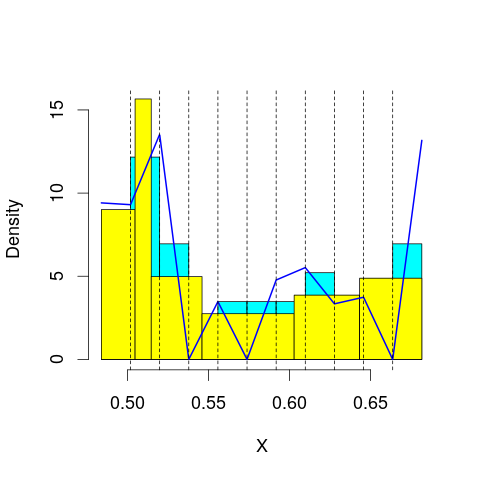

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.52986
mop.approx: Iteration 11. LL = 59.4857
mop.approx: Iteration 21. LL = 59.61248
mop.approx: Iteration 31. LL = 59.64782
mop.approx: Iteration 41. LL = 59.66186
mop.approx: Iteration 51. LL = 59.66825
mop.approx: Iteration 61. LL = 59.67136
mop.approx: Iteration 71. LL = 59.67294
mop.approx: Iteration 81. LL = 59.67378
mop.approx: Converged. Iteration 81. LL = 59.67383
[1] "Computing the linear combination of B-splines"


37.1465513394
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.37012
mop.approx: Iteration 11. LL = 58.75398
mop.approx: Iteration 21. LL = 58.82297
mop.approx: Iteration 31. LL = 58.83408
mop.approx: Iteration 41. LL = 58.83702
mop.approx: Converged. Iteration 48. LL = 58.83775
[1] "Computing the linear combination of B-splines"


34.5775983845
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.46258
mop.approx: Iteration 11. LL = 51.1471
mop.approx: Iteration 21. LL = 51.22708
mop.approx: Iteration 31. LL = 51.23935
mop.approx: Iteration 41. LL = 51.2423
mop.approx: Converged. Iteration 50. LL = 51.24316
[1] "Computing the linear combination of B-splines"


25.2501375769
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.51314
mop.approx: Iteration 11. LL = 51.36244
mop.approx: Iteration 21. LL = 51.57205
mop.approx: Iteration 31. LL = 51.60698
mop.approx: Iteration 41. LL = 51.61554
mop.approx: Iteration 51. LL = 51.6183
mop.approx: Iteration 61. LL = 51.61942
mop.approx: Converged. Iteration 67. LL = 51.61985
[1] "Computing the linear combination of B-splines"


23.893961519
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.227672
mop.approx: Iteration 11. LL = 48.46133
mop.approx: Iteration 21. LL = 48.69093
mop.approx: Iteration 31. LL = 48.75425
mop.approx: Iteration 41. LL = 48.7793
mop.approx: Iteration 51. LL = 48.79061
mop.approx: Iteration 61. LL = 48.79628
mop.approx: Iteration 71. LL = 48.79944
mop.approx: Iteration 81. LL = 48.80139
mop.approx: Iteration 91. LL = 48.80269
mop.approx: Iteration 101. LL = 48.80361
mop.approx: Iteration 111. LL = 48.80429
mop.approx: Converged. Iteration 118. LL = 48.80472
[1] "Computing the linear combination of B-splines"


19.3459615503
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.448928
mop.approx: Iteration 11. LL = 47.64774
mop.approx: Iteration 21. LL = 47.67298
mop.approx: Iteration 31. LL = 47.68003
mop.approx: Iteration 41. LL = 47.68369
mop.approx: Iteration 51. LL = 47.68629
mop.approx: Iteration 61. LL = 47.68837
mop.approx: Iteration 71. LL = 47.69006
mop.approx: Iteration 81. LL = 47.69143
mop.approx: Iteration 91. LL = 47.69252
mop.approx: Iteration 101. LL = 47.69336
mop.approx: Iteration 111. LL = 47.69401
mop.approx: Converged. Iteration 116. LL = 47.69431
[1] "Computing the linear combination of B-splines"


16.5026953926
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.06964362
mop.approx: Iteration 11. LL = 48.60137
mop.approx: Iteration 21. LL = 48.75761
mop.approx: Iteration 31. LL = 48.81654
mop.approx: Iteration 41. LL = 48.85233
mop.approx: Iteration 51. LL = 48.87267
mop.approx: Iteration 61. LL = 48.88367
mop.approx: Iteration 71. LL = 48.88947
mop.approx: Iteration 81. LL = 48.89249
mop.approx: Iteration 91. LL = 48.89407
mop.approx: Iteration 101. LL = 48.89489
mop.approx: Converged. Iteration 104. LL = 48.89509
[1] "Computing the linear combination of B-splines"


15.9700409425
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.69041
mop.approx: Iteration 11. LL = 59.86426
mop.approx: Converged. Iteration 20. LL = 59.87107
[1] "Computing the linear combination of B-splines"


37.343787528
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 37.343787528049901)
m reached
('Sum of Probabilities:', 0.9878822639934574)
chosen


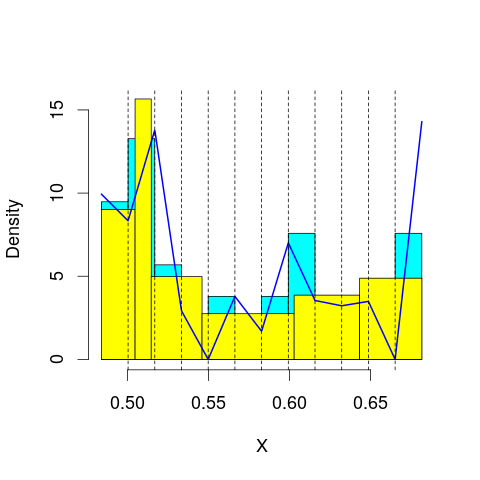

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.52986
mop.approx: Iteration 11. LL = 60.11771
mop.approx: Iteration 21. LL = 60.15958
mop.approx: Converged. Iteration 28. LL = 60.16105
[1] "Computing the linear combination of B-splines"


35.9008954284
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.37012
mop.approx: Iteration 11. LL = 59.09479
mop.approx: Iteration 21. LL = 59.23509
mop.approx: Iteration 31. LL = 59.25898
mop.approx: Iteration 41. LL = 59.26354
mop.approx: Converged. Iteration 48. LL = 59.26433
[1] "Computing the linear combination of B-splines"


33.2713086314
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.46258
mop.approx: Iteration 11. LL = 51.43301
mop.approx: Iteration 21. LL = 51.4731
mop.approx: Iteration 31. LL = 51.48095
mop.approx: Iteration 41. LL = 51.48275
mop.approx: Converged. Iteration 44. LL = 51.48299
[1] "Computing the linear combination of B-splines"


23.7571012584
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.51314
mop.approx: Iteration 11. LL = 52.12095
mop.approx: Iteration 21. LL = 52.35102
mop.approx: Iteration 31. LL = 52.38345
mop.approx: Iteration 41. LL = 52.39042
mop.approx: Iteration 51. LL = 52.39271
mop.approx: Iteration 61. LL = 52.3938
mop.approx: Iteration 71. LL = 52.39444
mop.approx: Converged. Iteration 71. LL = 52.3945
[1] "Computing the linear combination of B-splines"


22.9357407667
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.227672
mop.approx: Iteration 11. LL = 49.99041
mop.approx: Iteration 21. LL = 50.23048
mop.approx: Iteration 31. LL = 50.28084
mop.approx: Iteration 41. LL = 50.29684
mop.approx: Iteration 51. LL = 50.30325
mop.approx: Iteration 61. LL = 50.30632
mop.approx: Iteration 71. LL = 50.308
mop.approx: Iteration 81. LL = 50.30902
mop.approx: Iteration 91. LL = 50.30968
mop.approx: Converged. Iteration 93. LL = 50.30984
[1] "Computing the linear combination of B-splines"


19.118210238
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.448928
mop.approx: Iteration 11. LL = 48.00397
mop.approx: Iteration 21. LL = 48.09248
mop.approx: Iteration 31. LL = 48.11985
mop.approx: Iteration 41. LL = 48.12894
mop.approx: Iteration 51. LL = 48.13213
mop.approx: Iteration 61. LL = 48.13326
mop.approx: Converged. Iteration 64. LL = 48.13348
[1] "Computing the linear combination of B-splines"


15.2088986708
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.06964362
mop.approx: Iteration 11. LL = 48.79429
mop.approx: Iteration 21. LL = 48.95583
mop.approx: Iteration 31. LL = 49.0189
mop.approx: Iteration 41. LL = 49.04977
mop.approx: Iteration 51. LL = 49.0662
mop.approx: Iteration 61. LL = 49.0756
mop.approx: Iteration 71. LL = 49.0813
mop.approx: Iteration 81. LL = 49.0849
mop.approx: Iteration 91. LL = 49.08725
mop.approx: Iteration 101. LL = 49.08882
mop.approx: Iteration 111. LL = 49.0899
mop.approx: Iteration 121. LL = 49.09066
mop.approx: Converged. Iteration 129. LL = 49.09116
[1] "Computing the linear combination of B-splines"


14.4340449178
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.69041
mop.approx: Iteration 11. LL = 61.49368
mop.approx: Iteration 21. LL = 61.50818
mop.approx: Iteration 31. LL = 61.51256
mop.approx: Iteration 41. LL = 61.51432
mop.approx: Converged. Iteration 49. LL = 61.51505
[1] "Computing the linear combination of B-splines"


37.2549014942
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 37.254901494180736)
m reached
('Sum of Probabilities:', 0.9871864312941813)
chosen


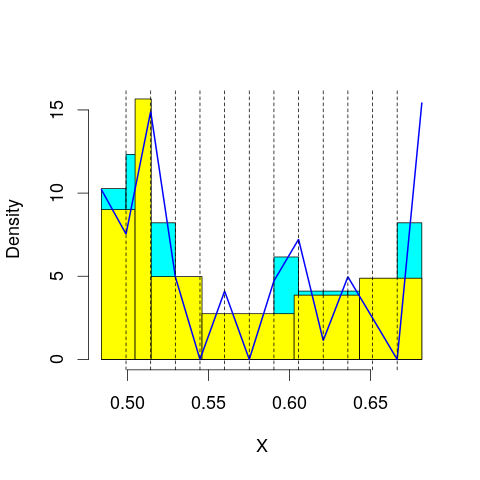

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.52986
mop.approx: Iteration 11. LL = 59.68316
mop.approx: Iteration 21. LL = 59.72505
mop.approx: Iteration 31. LL = 59.73425
mop.approx: Iteration 41. LL = 59.7382
mop.approx: Iteration 51. LL = 59.74027
mop.approx: Iteration 61. LL = 59.74149
mop.approx: Iteration 71. LL = 59.74225
mop.approx: Converged. Iteration 72. LL = 59.74237
[1] "Computing the linear combination of B-splines"


33.7493540971
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.37012
mop.approx: Iteration 11. LL = 59.44164
mop.approx: Iteration 21. LL = 59.53606
mop.approx: Iteration 31. LL = 59.56826
mop.approx: Iteration 41. LL = 59.58248
mop.approx: Iteration 51. LL = 59.5889
mop.approx: Iteration 61. LL = 59.59177
mop.approx: Iteration 71. LL = 59.59303
mop.approx: Converged. Iteration 75. LL = 59.59336
[1] "Computing the linear combination of B-splines"


31.8674773982
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.46258
mop.approx: Iteration 11. LL = 51.87082
mop.approx: Iteration 21. LL = 51.95929
mop.approx: Iteration 31. LL = 51.98179
mop.approx: Iteration 41. LL = 51.98838
mop.approx: Iteration 51. LL = 51.99073
mop.approx: Iteration 61. LL = 51.99167
mop.approx: Converged. Iteration 63. LL = 51.99183
[1] "Computing the linear combination of B-splines"


22.5330739535
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.51314
mop.approx: Iteration 11. LL = 52.28076
mop.approx: Iteration 21. LL = 52.38552
mop.approx: Iteration 31. LL = 52.39852
mop.approx: Iteration 41. LL = 52.40319
mop.approx: Iteration 51. LL = 52.40565
mop.approx: Iteration 61. LL = 52.40718
mop.approx: Iteration 71. LL = 52.40822
mop.approx: Iteration 81. LL = 52.40897
mop.approx: Converged. Iteration 87. LL = 52.40937
[1] "Computing the linear combination of B-splines"


21.2177422535
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.227672
mop.approx: Iteration 11. LL = 51.38501
mop.approx: Iteration 21. LL = 51.61196
mop.approx: Iteration 31. LL = 51.65559
mop.approx: Iteration 41. LL = 51.6697
mop.approx: Iteration 51. LL = 51.67538
mop.approx: Iteration 61. LL = 51.67806
mop.approx: Iteration 71. LL = 51.67948
mop.approx: Iteration 81. LL = 51.6803
mop.approx: Converged. Iteration 85. LL = 51.68058
[1] "Computing the linear combination of B-splines"


18.756091024
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.448928
mop.approx: Iteration 11. LL = 48.83731
mop.approx: Iteration 21. LL = 48.93056
mop.approx: Iteration 31. LL = 48.95544
mop.approx: Iteration 41. LL = 48.96735
mop.approx: Iteration 51. LL = 48.97392
mop.approx: Iteration 61. LL = 48.97782
mop.approx: Iteration 71. LL = 48.98026
mop.approx: Iteration 81. LL = 48.98184
mop.approx: Iteration 91. LL = 48.98289
mop.approx: Iteration 101. LL = 48.98361
mop.approx: Converged. Iteration 106. LL = 48.98393
[1] "Computing the linear combination of B-splines"


14.3265462741
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.06964362
mop.approx: Iteration 11. LL = 48.9041
mop.approx: Iteration 21. LL = 49.03214
mop.approx: Iteration 31. LL = 49.06986
mop.approx: Iteration 41. LL = 49.08368
mop.approx: Iteration 51. LL = 49.08919
mop.approx: Iteration 61. LL = 49.09153
mop.approx: Iteration 71. LL = 49.09258
mop.approx: Converged. Iteration 75. LL = 49.09286
[1] "Computing the linear combination of B-splines"


12.7019280523
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.69041
mop.approx: Iteration 11. LL = 60.47774
mop.approx: Iteration 21. LL = 60.51694
mop.approx: Iteration 31. LL = 60.52231
mop.approx: Iteration 41. LL = 60.52375
mop.approx: Converged. Iteration 45. LL = 60.52409
[1] "Computing the linear combination of B-splines"


34.5310677907
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 34.531067790741169)
m reached
('Sum of Probabilities:', 0.9868349205327521)
chosen


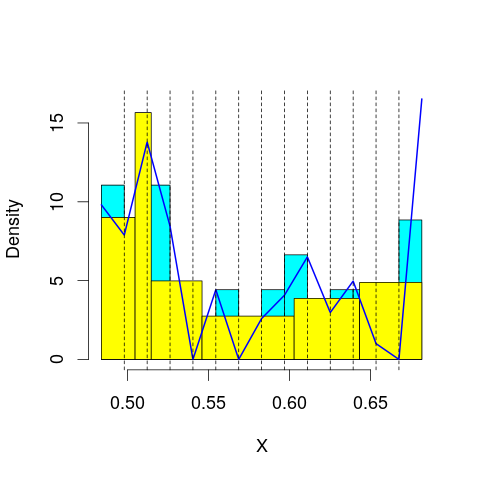

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.52986
mop.approx: Iteration 11. LL = 60.61853
mop.approx: Iteration 21. LL = 60.64276
mop.approx: Iteration 31. LL = 60.64903
mop.approx: Iteration 41. LL = 60.6517
mop.approx: Iteration 51. LL = 60.65308
mop.approx: Iteration 61. LL = 60.65388
mop.approx: Converged. Iteration 62. LL = 60.654
[1] "Computing the linear combination of B-splines"


32.9281112496
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.37012
mop.approx: Iteration 11. LL = 59.27605
mop.approx: Iteration 21. LL = 59.40237
mop.approx: Iteration 31. LL = 59.42999
mop.approx: Iteration 41. LL = 59.43732
mop.approx: Iteration 51. LL = 59.44007
mop.approx: Iteration 61. LL = 59.44146
mop.approx: Iteration 71. LL = 59.44226
mop.approx: Converged. Iteration 72. LL = 59.44238
[1] "Computing the linear combination of B-splines"


29.9836254815
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.46258
mop.approx: Iteration 11. LL = 52.63148
mop.approx: Iteration 21. LL = 52.70272
mop.approx: Iteration 31. LL = 52.71872
mop.approx: Iteration 41. LL = 52.72687
mop.approx: Iteration 51. LL = 52.73173
mop.approx: Iteration 61. LL = 52.7348
mop.approx: Iteration 71. LL = 52.73683
mop.approx: Iteration 81. LL = 52.73821
mop.approx: Iteration 91. LL = 52.73918
mop.approx: Iteration 101. LL = 52.73986
mop.approx: Converged. Iteration 104. LL = 52.74008
[1] "Computing the linear combination of B-splines"


21.5484560501
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.51314
mop.approx: Iteration 11. LL = 52.29337
mop.approx: Iteration 21. LL = 52.3969
mop.approx: Iteration 31. LL = 52.42095
mop.approx: Iteration 41. LL = 52.43005
mop.approx: Iteration 51. LL = 52.43435
mop.approx: Iteration 61. LL = 52.43677
mop.approx: Iteration 71. LL = 52.4383
mop.approx: Iteration 81. LL = 52.43932
mop.approx: Iteration 91. LL = 52.44004
mop.approx: Converged. Iteration 95. LL = 52.44031
[1] "Computing the linear combination of B-splines"


19.5158181465
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.227672
mop.approx: Iteration 11. LL = 52.43761
mop.approx: Iteration 21. LL = 52.58657
mop.approx: Iteration 31. LL = 52.60221
mop.approx: Iteration 41. LL = 52.60658
mop.approx: Iteration 51. LL = 52.60847
mop.approx: Iteration 61. LL = 52.6096
mop.approx: Iteration 71. LL = 52.61042
mop.approx: Iteration 81. LL = 52.61107
mop.approx: Converged. Iteration 88. LL = 52.61151
[1] "Computing the linear combination of B-splines"


17.9541467335
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.448928
mop.approx: Iteration 11. LL = 49.94006
mop.approx: Iteration 21. LL = 50.05024
mop.approx: Iteration 31. LL = 50.07574
mop.approx: Iteration 41. LL = 50.08623
mop.approx: Iteration 51. LL = 50.09221
mop.approx: Iteration 61. LL = 50.09619
mop.approx: Iteration 71. LL = 50.09902
mop.approx: Iteration 81. LL = 50.10108
mop.approx: Iteration 91. LL = 50.10259
mop.approx: Iteration 101. LL = 50.1037
mop.approx: Iteration 111. LL = 50.10453
mop.approx: Iteration 121. LL = 50.10516
mop.approx: Converged. Iteration 123. LL = 50.10531
[1] "Computing the linear combination of B-splines"


13.7148224477
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.06964362
mop.approx: Iteration 11. LL = 49.17718
mop.approx: Iteration 21. LL = 49.27158
mop.approx: Iteration 31. LL = 49.29055
mop.approx: Iteration 41. LL = 49.29891
mop.approx: Iteration 51. LL = 49.30377
mop.approx: Iteration 61. LL = 49.30689
mop.approx: Iteration 71. LL = 49.30903
mop.approx: Iteration 81. LL = 49.31057
mop.approx: Iteration 91. LL = 49.31171
mop.approx: Iteration 101. LL = 49.31258
mop.approx: Iteration 111. LL = 49.31326
mop.approx: Iteration 121. LL = 49.31381
mop.approx: Converged. Iteration 121. LL = 49.31386
[1] "Computing the linear combination of B-splines"


11.1912815132
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.69041
mop.approx: Iteration 11. LL = 61.75397
mop.approx: Iteration 21. LL = 61.792
mop.approx: Iteration 31. LL = 61.79752
mop.approx: Iteration 41. LL = 61.79923
mop.approx: Converged. Iteration 47. LL = 61.79978
[1] "Computing the linear combination of B-splines"


34.0738882014
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 34.07388820136407)
m reached
('Sum of Probabilities:', 0.9861254897471982)
chosen


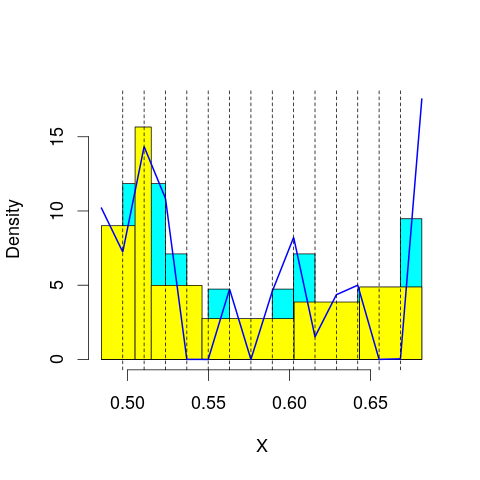

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.52986
mop.approx: Iteration 11. LL = 60.31571
mop.approx: Iteration 21. LL = 60.32618
mop.approx: Converged. Iteration 27. LL = 60.32693
[1] "Computing the linear combination of B-splines"


30.8681781301
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.37012
mop.approx: Iteration 11. LL = 60.1125
mop.approx: Iteration 21. LL = 60.17777
mop.approx: Iteration 31. LL = 60.18221
mop.approx: Converged. Iteration 38. LL = 60.183
[1] "Computing the linear combination of B-splines"


28.991376451
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.46258
mop.approx: Iteration 11. LL = 52.58532
mop.approx: Iteration 21. LL = 52.67448
mop.approx: Iteration 31. LL = 52.69811
mop.approx: Iteration 41. LL = 52.70861
mop.approx: Iteration 51. LL = 52.71467
mop.approx: Iteration 61. LL = 52.71858
mop.approx: Iteration 71. LL = 52.72122
mop.approx: Iteration 81. LL = 52.72306
mop.approx: Iteration 91. LL = 52.72434
mop.approx: Iteration 101. LL = 52.72525
mop.approx: Iteration 111. LL = 52.72589
mop.approx: Converged. Iteration 112. LL = 52.72599
[1] "Computing the linear combination of B-splines"


19.8015027359
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.51314
mop.approx: Iteration 11. LL = 52.88351
mop.approx: Iteration 21. LL = 52.97954
mop.approx: Iteration 31. LL = 52.99919
mop.approx: Iteration 41. LL = 53.00921
mop.approx: Iteration 51. LL = 53.01515
mop.approx: Iteration 61. LL = 53.01893
mop.approx: Iteration 71. LL = 53.02146
mop.approx: Iteration 81. LL = 53.02324
mop.approx: Iteration 91. LL = 53.02452
mop.approx: Iteration 101. LL = 53.02547
mop.approx: Iteration 111. LL = 53.02619
mop.approx: Converged. Iteration 118. LL = 53.02664
[1] "Computing the linear combination of B-splines"


18.3692824732
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.227672
mop.approx: Iteration 11. LL = 52.63114
mop.approx: Iteration 21. LL = 52.81159
mop.approx: Iteration 31. LL = 52.87285
mop.approx: Iteration 41. LL = 52.90329
mop.approx: Iteration 51. LL = 52.91876
mop.approx: Iteration 61. LL = 52.9265
mop.approx: Iteration 71. LL = 52.93038
mop.approx: Iteration 81. LL = 52.93235
mop.approx: Iteration 91. LL = 52.93341
mop.approx: Converged. Iteration 98. LL = 52.9339
[1] "Computing the linear combination of B-splines"


16.5436781128
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.448928
mop.approx: Iteration 11. LL = 51.37672
mop.approx: Iteration 21. LL = 51.56258
mop.approx: Iteration 31. LL = 51.5986
mop.approx: Iteration 41. LL = 51.61331
mop.approx: Iteration 51. LL = 51.62166
mop.approx: Iteration 61. LL = 51.62712
mop.approx: Iteration 71. LL = 51.63095
mop.approx: Iteration 81. LL = 51.63375
mop.approx: Iteration 91. LL = 51.63586
mop.approx: Iteration 101. LL = 51.63747
mop.approx: Iteration 111. LL = 51.63873
mop.approx: Iteration 121. LL = 51.63973
mop.approx: Iteration 131. LL = 51.64052
mop.approx: Iteration 141. LL = 51.64115
mop.approx: Converged. Iteration 146. LL = 51.64147
[1] "Computing the linear combination of B-splines"


13.5183066684
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.06964362
mop.approx: Iteration 11. LL = 49.57923
mop.approx: Iteration 21. LL = 49.62645
mop.approx: Iteration 31. LL = 49.63841
mop.approx: Iteration 41. LL = 49.64334
mop.approx: Iteration 51. LL = 49.64571
mop.approx: Iteration 61. LL = 49.64705
mop.approx: Iteration 71. LL = 49.64793
mop.approx: Iteration 81. LL = 49.64856
mop.approx: Converged. Iteration 85. LL = 49.64882
[1] "Computing the linear combination of B-splines"


9.79288635943
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.69041
mop.approx: Iteration 11. LL = 62.15785
mop.approx: Iteration 21. LL = 62.17687
mop.approx: Converged. Iteration 25. LL = 62.17737
[1] "Computing the linear combination of B-splines"


32.7186165788
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 32.718616578793444)
m reached
('Sum of Probabilities:', 0.9867330468997847)
chosen


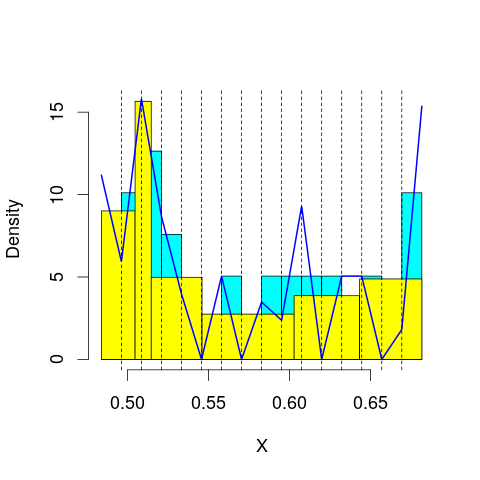

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.52986
mop.approx: Iteration 11. LL = 60.86569
mop.approx: Iteration 21. LL = 60.91008
mop.approx: Iteration 31. LL = 60.91821
mop.approx: Iteration 41. LL = 60.91992
mop.approx: Converged. Iteration 42. LL = 60.92005
[1] "Computing the linear combination of B-splines"


29.7284233666
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.37012
mop.approx: Iteration 11. LL = 60.17585
mop.approx: Iteration 21. LL = 60.26376
mop.approx: Iteration 31. LL = 60.28074
mop.approx: Iteration 41. LL = 60.28612
mop.approx: Iteration 51. LL = 60.28817
mop.approx: Converged. Iteration 59. LL = 60.28893
[1] "Computing the linear combination of B-splines"


27.3644382163
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.46258
mop.approx: Iteration 11. LL = 52.85658
mop.approx: Iteration 21. LL = 52.89667
mop.approx: Iteration 31. LL = 52.9062
mop.approx: Iteration 41. LL = 52.91186
mop.approx: Iteration 51. LL = 52.91584
mop.approx: Iteration 61. LL = 52.91874
mop.approx: Iteration 71. LL = 52.9209
mop.approx: Iteration 81. LL = 52.92251
mop.approx: Iteration 91. LL = 52.92372
mop.approx: Iteration 101. LL = 52.92464
mop.approx: Iteration 111. LL = 52.92533
mop.approx: Converged. Iteration 115. LL = 52.92561
[1] "Computing the linear combination of B-splines"


18.2682462643
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.51314
mop.approx: Iteration 11. LL = 53.13998
mop.approx: Iteration 21. LL = 53.26102
mop.approx: Iteration 31. LL = 53.28404
mop.approx: Iteration 41. LL = 53.29362
mop.approx: Iteration 51. LL = 53.29902
mop.approx: Iteration 61. LL = 53.30243
mop.approx: Iteration 71. LL = 53.30468
mop.approx: Iteration 81. LL = 53.3062
mop.approx: Iteration 91. LL = 53.30724
mop.approx: Iteration 101. LL = 53.30795
mop.approx: Converged. Iteration 104. LL = 53.30817
[1] "Computing the linear combination of B-splines"


16.9179460154
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.227672
mop.approx: Iteration 11. LL = 52.85011
mop.approx: Iteration 21. LL = 53.04319
mop.approx: Iteration 31. LL = 53.1044
mop.approx: Iteration 41. LL = 53.12833
mop.approx: Iteration 51. LL = 53.13846
mop.approx: Iteration 61. LL = 53.14322
mop.approx: Iteration 71. LL = 53.14577
mop.approx: Iteration 81. LL = 53.14731
mop.approx: Iteration 91. LL = 53.14833
mop.approx: Iteration 101. LL = 53.14906
mop.approx: Converged. Iteration 107. LL = 53.14945
[1] "Computing the linear combination of B-splines"


15.0263467286
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.448928
mop.approx: Iteration 11. LL = 52.35635
mop.approx: Iteration 21. LL = 52.55736
mop.approx: Iteration 31. LL = 52.58663
mop.approx: Iteration 41. LL = 52.59245
mop.approx: Iteration 51. LL = 52.59374
mop.approx: Converged. Iteration 52. LL = 52.59384
[1] "Computing the linear combination of B-splines"


12.7374179994
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.06964362
mop.approx: Iteration 11. LL = 50.44954
mop.approx: Iteration 21. LL = 50.55193
mop.approx: Iteration 31. LL = 50.57578
mop.approx: Iteration 41. LL = 50.58786
mop.approx: Iteration 51. LL = 50.59626
mop.approx: Iteration 61. LL = 50.6025
mop.approx: Iteration 71. LL = 50.60722
mop.approx: Iteration 81. LL = 50.61081
mop.approx: Iteration 91. LL = 50.61356
mop.approx: Iteration 101. LL = 50.61569
mop.approx: Iteration 111. LL = 50.61733
mop.approx: Iteration 121. LL = 50.61862
mop.approx: Iteration 131. LL = 50.61963
mop.approx: Iteration 141. LL = 50.62042
mop.approx: Iteration 151. LL = 50.62105
mop.approx: Converged. Iteration 155. LL = 50.62131
[1] "Computing the linear combination of B-splines"


9.01606928546
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.69041
mop.approx: Iteration 11. LL = 61.72976
mop.approx: Iteration 21. LL = 61.769
mop.approx: Iteration 31. LL = 61.78084
mop.approx: Iteration 41. LL = 61.78554
mop.approx: Iteration 51. LL = 61.78764
mop.approx: Iteration 61. LL = 61.78864
mop.approx: Converged. Iteration 62. LL = 61.78876
[1] "Computing the linear combination of B-splines"


30.5971400406
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 30.597140040621241)
m reached
('Sum of Probabilities:', 0.9870557559252833)
chosen


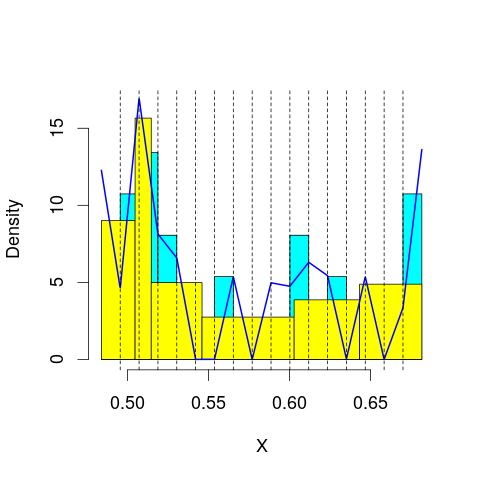

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.52986
mop.approx: Iteration 11. LL = 61.4875
mop.approx: Iteration 21. LL = 61.52873
mop.approx: Iteration 31. LL = 61.53218
mop.approx: Converged. Iteration 34. LL = 61.53246
[1] "Computing the linear combination of B-splines"


28.6079716285
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.37012
mop.approx: Iteration 11. LL = 59.92876
mop.approx: Iteration 21. LL = 60.01296
mop.approx: Iteration 31. LL = 60.04303
mop.approx: Iteration 41. LL = 60.05527
mop.approx: Iteration 51. LL = 60.06074
mop.approx: Iteration 61. LL = 60.06345
mop.approx: Iteration 71. LL = 60.06494
mop.approx: Iteration 81. LL = 60.06584
mop.approx: Converged. Iteration 86. LL = 60.06623
[1] "Computing the linear combination of B-splines"


25.4088706062
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.46258
mop.approx: Iteration 11. LL = 53.42856
mop.approx: Iteration 21. LL = 53.51609
mop.approx: Iteration 31. LL = 53.53977
mop.approx: Iteration 41. LL = 53.54784
mop.approx: Iteration 51. LL = 53.5508
mop.approx: Iteration 61. LL = 53.55194
mop.approx: Converged. Iteration 64. LL = 53.55217
[1] "Computing the linear combination of B-splines"


17.1619474182
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.51314
mop.approx: Iteration 11. LL = 53.02351
mop.approx: Iteration 21. LL = 53.09223
mop.approx: Iteration 31. LL = 53.10875
mop.approx: Iteration 41. LL = 53.11549
mop.approx: Iteration 51. LL = 53.11884
mop.approx: Iteration 61. LL = 53.12082
mop.approx: Iteration 71. LL = 53.12219
mop.approx: Iteration 81. LL = 53.12323
mop.approx: Iteration 91. LL = 53.12407
mop.approx: Iteration 101. LL = 53.12478
mop.approx: Iteration 111. LL = 53.12538
mop.approx: Converged. Iteration 115. LL = 53.12565
[1] "Computing the linear combination of B-splines"


15.0025547398
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.227672
mop.approx: Iteration 11. LL = 53.24916
mop.approx: Iteration 21. LL = 53.46925
mop.approx: Iteration 31. LL = 53.52115
mop.approx: Iteration 41. LL = 53.5365
mop.approx: Iteration 51. LL = 53.54245
mop.approx: Iteration 61. LL = 53.54546
mop.approx: Iteration 71. LL = 53.54731
mop.approx: Iteration 81. LL = 53.54856
mop.approx: Iteration 91. LL = 53.54946
mop.approx: Iteration 101. LL = 53.55011
mop.approx: Converged. Iteration 103. LL = 53.55027
[1] "Computing the linear combination of B-splines"


13.6942898896
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.448928
mop.approx: Iteration 11. LL = 52.8042
mop.approx: Iteration 21. LL = 53.00353
mop.approx: Iteration 31. LL = 53.0367
mop.approx: Iteration 41. LL = 53.05143
mop.approx: Iteration 51. LL = 53.06059
mop.approx: Iteration 61. LL = 53.06717
mop.approx: Iteration 71. LL = 53.07224
mop.approx: Iteration 81. LL = 53.0763
mop.approx: Iteration 91. LL = 53.07959
mop.approx: Iteration 101. LL = 53.08227
mop.approx: Iteration 111. LL = 53.08445
mop.approx: Iteration 121. LL = 53.08622
mop.approx: Iteration 131. LL = 53.08766
mop.approx: Iteration 141. LL = 53.08883
mop.approx: Iteration 151. LL = 53.08978
mop.approx: Iteration 161. LL = 53.09054
mop.approx: Iteration 171. LL = 53.09117
mop.approx: Converged. Iteration 174. LL = 53.09138
[1] "Computing the linear combination of B-splines"


11.5025253909
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.06964362
mop.approx: Iteration 11. LL = 51.47581
mop.approx: Iteration 21. LL = 51.57184
mop.approx: Iteration 31. LL = 51.58702
mop.approx: Iteration 41. LL = 51.59055
mop.approx: Iteration 51. LL = 51.59193
mop.approx: Iteration 61. LL = 51.59284
mop.approx: Iteration 71. LL = 51.59358
mop.approx: Iteration 81. LL = 51.59421
mop.approx: Converged. Iteration 90. LL = 51.59475
[1] "Computing the linear combination of B-splines"


8.25233889853
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.69041
mop.approx: Iteration 11. LL = 63.89402
mop.approx: Iteration 21. LL = 63.9168
mop.approx: Iteration 31. LL = 63.92035
mop.approx: Converged. Iteration 37. LL = 63.92102
[1] "Computing the linear combination of B-splines"


30.9965245484
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 30.996524548392721)
m reached
('Sum of Probabilities:', 0.986967902108516)
chosen


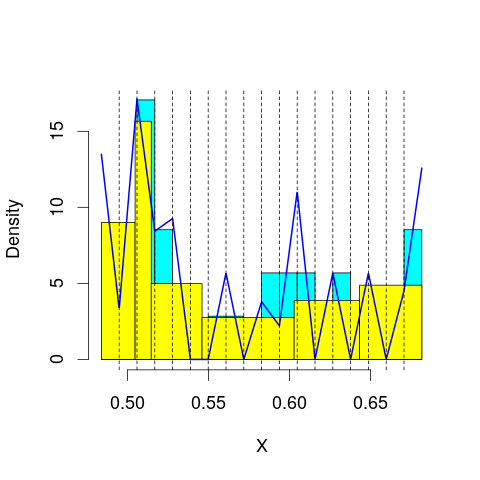

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.52986
mop.approx: Iteration 11. LL = 61.18862
mop.approx: Iteration 21. LL = 61.23515
mop.approx: Iteration 31. LL = 61.23859
mop.approx: Converged. Iteration 35. LL = 61.23897
[1] "Computing the linear combination of B-splines"


26.5816132002
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.37012
mop.approx: Iteration 11. LL = 60.99514
mop.approx: Iteration 21. LL = 61.10717
mop.approx: Iteration 31. LL = 61.13481
mop.approx: Iteration 41. LL = 61.14407
mop.approx: Iteration 51. LL = 61.14798
mop.approx: Iteration 61. LL = 61.14997
mop.approx: Iteration 71. LL = 61.15113
mop.approx: Iteration 81. LL = 61.15187
mop.approx: Converged. Iteration 81. LL = 61.15193
[1] "Computing the linear combination of B-splines"


24.7617000399
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.46258
mop.approx: Iteration 11. LL = 53.34908
mop.approx: Iteration 21. LL = 53.42883
mop.approx: Iteration 31. LL = 53.45161
mop.approx: Iteration 41. LL = 53.46024
mop.approx: Iteration 51. LL = 53.46383
mop.approx: Iteration 61. LL = 53.46549
mop.approx: Iteration 71. LL = 53.46637
mop.approx: Converged. Iteration 75. LL = 53.46666
[1] "Computing the linear combination of B-splines"


15.3435631112
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.51314
mop.approx: Iteration 11. LL = 53.54935
mop.approx: Iteration 21. LL = 53.60126
mop.approx: Iteration 31. LL = 53.61746
mop.approx: Iteration 41. LL = 53.62637
mop.approx: Iteration 51. LL = 53.63206
mop.approx: Iteration 61. LL = 53.63595
mop.approx: Iteration 71. LL = 53.63874
mop.approx: Iteration 81. LL = 53.64078
mop.approx: Iteration 91. LL = 53.6423
mop.approx: Iteration 101. LL = 53.64345
mop.approx: Iteration 111. LL = 53.64433
mop.approx: Iteration 121. LL = 53.64502
mop.approx: Converged. Iteration 126. LL = 53.64535
[1] "Computing the linear combination of B-splines"


13.7893873421
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.227672
mop.approx: Iteration 11. LL = 53.16773
mop.approx: Iteration 21. LL = 53.35202
mop.approx: Iteration 31. LL = 53.38846
mop.approx: Iteration 41. LL = 53.40128
mop.approx: Iteration 51. LL = 53.40816
mop.approx: Iteration 61. LL = 53.41245
mop.approx: Iteration 71. LL = 53.41526
mop.approx: Iteration 81. LL = 53.41714
mop.approx: Iteration 91. LL = 53.41841
mop.approx: Iteration 101. LL = 53.41929
mop.approx: Converged. Iteration 109. LL = 53.41985
[1] "Computing the linear combination of B-splines"


11.8309923726
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.448928
mop.approx: Iteration 11. LL = 53.22949
mop.approx: Iteration 21. LL = 53.38186
mop.approx: Iteration 31. LL = 53.41551
mop.approx: Iteration 41. LL = 53.43276
mop.approx: Iteration 51. LL = 53.44246
mop.approx: Iteration 61. LL = 53.44808
mop.approx: Iteration 71. LL = 53.45142
mop.approx: Iteration 81. LL = 53.45349
mop.approx: Iteration 91. LL = 53.45482
mop.approx: Iteration 101. LL = 53.45572
mop.approx: Iteration 111. LL = 53.45636
mop.approx: Converged. Iteration 111. LL = 53.45641
[1] "Computing the linear combination of B-splines"


10.1347654187
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.06964362
mop.approx: Iteration 11. LL = 52.15109
mop.approx: Iteration 21. LL = 52.24602
mop.approx: Iteration 31. LL = 52.25887
mop.approx: Iteration 41. LL = 52.26322
mop.approx: Iteration 51. LL = 52.2654
mop.approx: Iteration 61. LL = 52.26675
mop.approx: Iteration 71. LL = 52.26768
mop.approx: Iteration 81. LL = 52.26838
mop.approx: Converged. Iteration 89. LL = 52.26888
[1] "Computing the linear combination of B-splines"


7.19764329299
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.69041
mop.approx: Iteration 11. LL = 63.97323
mop.approx: Iteration 21. LL = 63.99276
mop.approx: Iteration 31. LL = 63.99432
mop.approx: Converged. Iteration 31. LL = 63.99438
[1] "Computing the linear combination of B-splines"


29.3370170134
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 29.337017013396746)
m reached
('Sum of Probabilities:', 0.9865335354561482)
chosen


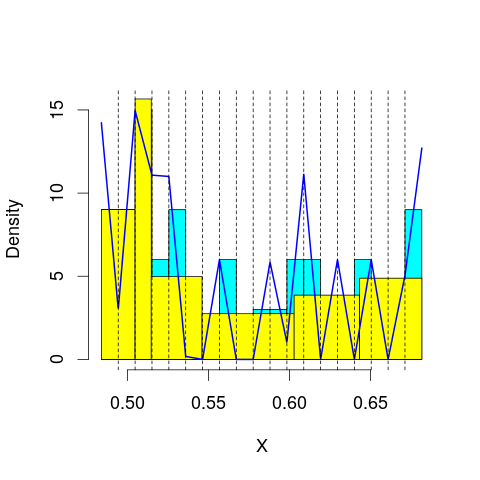

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.52986
mop.approx: Iteration 11. LL = 62.01784
mop.approx: Iteration 21. LL = 62.05537
mop.approx: Iteration 31. LL = 62.06214
mop.approx: Iteration 41. LL = 62.06378
mop.approx: Converged. Iteration 42. LL = 62.06391
[1] "Computing the linear combination of B-splines"


25.6736833007
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.37012
mop.approx: Iteration 11. LL = 61.35828
mop.approx: Iteration 21. LL = 61.5267
mop.approx: Iteration 31. LL = 61.56327
mop.approx: Iteration 41. LL = 61.57728
mop.approx: Iteration 51. LL = 61.58407
mop.approx: Iteration 61. LL = 61.58775
mop.approx: Iteration 71. LL = 61.58988
mop.approx: Iteration 81. LL = 61.59116
mop.approx: Iteration 91. LL = 61.59197
mop.approx: Converged. Iteration 92. LL = 61.59209
[1] "Computing the linear combination of B-splines"


23.4689981501
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.46258
mop.approx: Iteration 11. LL = 54.06331
mop.approx: Iteration 21. LL = 54.10507
mop.approx: Iteration 31. LL = 54.12181
mop.approx: Iteration 41. LL = 54.13015
mop.approx: Iteration 51. LL = 54.1344
mop.approx: Iteration 61. LL = 54.13659
mop.approx: Iteration 71. LL = 54.13773
mop.approx: Converged. Iteration 77. LL = 54.13818
[1] "Computing the linear combination of B-splines"


14.2822161625
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.51314
mop.approx: Iteration 11. LL = 53.66161
mop.approx: Iteration 21. LL = 53.77458
mop.approx: Iteration 31. LL = 53.797
mop.approx: Iteration 41. LL = 53.8022
mop.approx: Iteration 51. LL = 53.8037
mop.approx: Converged. Iteration 57. LL = 53.80416
[1] "Computing the linear combination of B-splines"


12.2153291289
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.227672
mop.approx: Iteration 11. LL = 53.56959
mop.approx: Iteration 21. LL = 53.72408
mop.approx: Iteration 31. LL = 53.74473
mop.approx: Iteration 41. LL = 53.75017
mop.approx: Iteration 51. LL = 53.75256
mop.approx: Iteration 61. LL = 53.75394
mop.approx: Iteration 71. LL = 53.75487
mop.approx: Iteration 81. LL = 53.75558
mop.approx: Iteration 91. LL = 53.75616
mop.approx: Converged. Iteration 91. LL = 53.75622
[1] "Computing the linear combination of B-splines"


10.4345492153
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.448928
mop.approx: Iteration 11. LL = 53.24239
mop.approx: Iteration 21. LL = 53.39583
mop.approx: Iteration 31. LL = 53.44534
mop.approx: Iteration 41. LL = 53.46673
mop.approx: Iteration 51. LL = 53.47598
mop.approx: Iteration 61. LL = 53.48009
mop.approx: Iteration 71. LL = 53.48202
mop.approx: Iteration 81. LL = 53.48295
mop.approx: Converged. Iteration 84. LL = 53.48318
[1] "Computing the linear combination of B-splines"


8.43116206378
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.06964362
mop.approx: Iteration 11. LL = 52.97655
mop.approx: Iteration 21. LL = 53.21089
mop.approx: Iteration 31. LL = 53.25756
mop.approx: Iteration 41. LL = 53.27677
mop.approx: Iteration 51. LL = 53.28685
mop.approx: Iteration 61. LL = 53.29269
mop.approx: Iteration 71. LL = 53.29627
mop.approx: Iteration 81. LL = 53.29854
mop.approx: Iteration 91. LL = 53.30003
mop.approx: Iteration 101. LL = 53.30101
mop.approx: Iteration 111. LL = 53.30168
mop.approx: Converged. Iteration 112. LL = 53.30178
[1] "Computing the linear combination of B-splines"


6.51464972724
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.69041
mop.approx: Iteration 11. LL = 62.60832
mop.approx: Iteration 21. LL = 62.62382
mop.approx: Iteration 31. LL = 62.62574
mop.approx: Converged. Iteration 35. LL = 62.6261
[1] "Computing the linear combination of B-splines"


26.2358726538
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 26.235872653825069)
m reached
('Sum of Probabilities:', 0.9863887278483385)
chosen


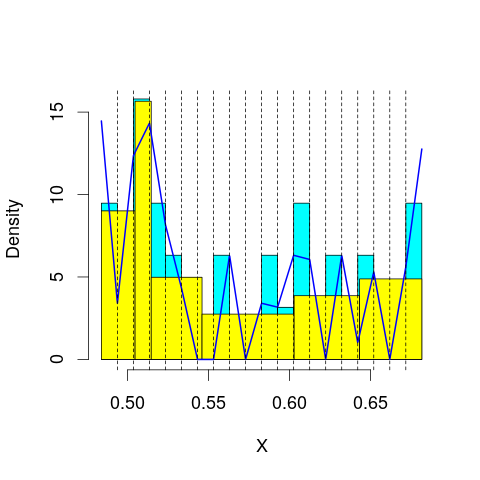

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.52986
mop.approx: Iteration 11. LL = 64.11967
mop.approx: Iteration 21. LL = 64.17687
mop.approx: Iteration 31. LL = 64.18119
mop.approx: Converged. Iteration 34. LL = 64.18152
[1] "Computing the linear combination of B-splines"


26.0584263307
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 51.37012
mop.approx: Iteration 11. LL = 60.78565
mop.approx: Iteration 21. LL = 60.87848
mop.approx: Iteration 31. LL = 60.90141
mop.approx: Iteration 41. LL = 60.90878
mop.approx: Iteration 51. LL = 60.91186
mop.approx: Iteration 61. LL = 60.91349
mop.approx: Iteration 71. LL = 60.91448
mop.approx: Converged. Iteration 78. LL = 60.91503
[1] "Computing the linear combination of B-splines"


21.0590691267
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.46258
mop.approx: Iteration 11. LL = 55.22081
mop.approx: Iteration 21. LL = 55.35171
mop.approx: Iteration 31. LL = 55.37032
mop.approx: Iteration 41. LL = 55.37551
mop.approx: Iteration 51. LL = 55.37749
mop.approx: Iteration 61. LL = 55.37835
mop.approx: Converged. Iteration 61. LL = 55.3784
[1] "Computing the linear combination of B-splines"


13.7895715627
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.51314
mop.approx: Iteration 11. LL = 53.76694
mop.approx: Iteration 21. LL = 53.85109
mop.approx: Iteration 31. LL = 53.88106
mop.approx: Iteration 41. LL = 53.89586
mop.approx: Iteration 51. LL = 53.90372
mop.approx: Iteration 61. LL = 53.90807
mop.approx: Iteration 71. LL = 53.91056
mop.approx: Iteration 81. LL = 53.91203
mop.approx: Iteration 91. LL = 53.91291
mop.approx: Converged. Iteration 96. LL = 53.91327
[1] "Computing the linear combination of B-splines"


10.5915695103
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.227672
mop.approx: Iteration 11. LL = 53.84414
mop.approx: Iteration 21. LL = 54.02783
mop.approx: Iteration 31. LL = 54.06441
mop.approx: Iteration 41. LL = 54.07707
mop.approx: Iteration 51. LL = 54.08271
mop.approx: Iteration 61. LL = 54.08564
mop.approx: Iteration 71. LL = 54.0873
mop.approx: Iteration 81. LL = 54.0883
mop.approx: Converged. Iteration 89. LL = 54.08887
[1] "Computing the linear combination of B-splines"


9.03427227435
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.448928
mop.approx: Iteration 11. LL = 53.46183
mop.approx: Iteration 21. LL = 53.62638
mop.approx: Iteration 31. LL = 53.67198
mop.approx: Iteration 41. LL = 53.6884
mop.approx: Iteration 51. LL = 53.69418
mop.approx: Iteration 61. LL = 53.69626
mop.approx: Iteration 71. LL = 53.69714
mop.approx: Converged. Iteration 74. LL = 53.69737
[1] "Computing the linear combination of B-splines"


6.90699714065
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.06964362
mop.approx: Iteration 11. LL = 53.21466
mop.approx: Iteration 21. LL = 53.48519
mop.approx: Iteration 31. LL = 53.54774
mop.approx: Iteration 41. LL = 53.56861
mop.approx: Iteration 51. LL = 53.57723
mop.approx: Iteration 61. LL = 53.58137
mop.approx: Iteration 71. LL = 53.58358
mop.approx: Iteration 81. LL = 53.58484
mop.approx: Iteration 91. LL = 53.58559
mop.approx: Converged. Iteration 93. LL = 53.58575
[1] "Computing the linear combination of B-splines"


4.99894367029
lfps_16
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.25355
mop.approx: Iteration 11. LL = 69.87951
mop.approx: Converged. Iteration 17. LL = 69.88389
[1] "Computing the linear combination of B-splines"


64.6852863662
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 64.685286366183277)
m reached
('Sum of Probabilities:', 0.9884780430631974)
chosen


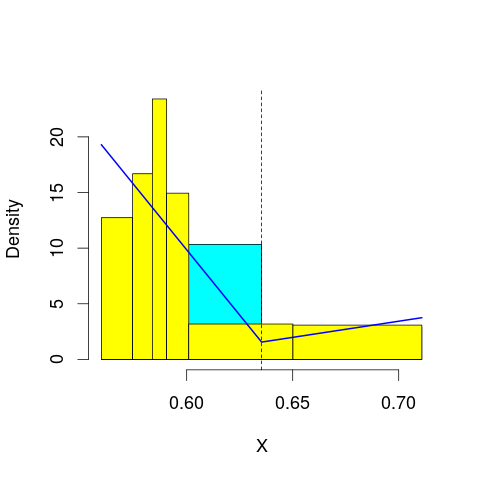

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.04391
mop.approx: Iteration 11. LL = 68.74426
mop.approx: Iteration 21. LL = 68.76298
mop.approx: Iteration 31. LL = 68.77089
mop.approx: Iteration 41. LL = 68.77499
mop.approx: Iteration 51. LL = 68.77738
mop.approx: Iteration 61. LL = 68.7789
mop.approx: Iteration 71. LL = 68.77991
mop.approx: Converged. Iteration 77. LL = 68.78044
[1] "Computing the linear combination of B-splines"


61.8489710565
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.83564
mop.approx: Iteration 11. LL = 68.82904
mop.approx: Iteration 21. LL = 68.936
mop.approx: Iteration 31. LL = 68.95931
mop.approx: Iteration 41. LL = 68.9652
mop.approx: Iteration 51. LL = 68.96667
mop.approx: Converged. Iteration 51. LL = 68.96673
[1] "Computing the linear combination of B-splines"


60.3023899437
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06425
mop.approx: Iteration 11. LL = 52.71628
mop.approx: Iteration 21. LL = 52.7711
mop.approx: Iteration 31. LL = 52.77889
mop.approx: Iteration 41. LL = 52.78108
mop.approx: Iteration 51. LL = 52.78191
mop.approx: Converged. Iteration 51. LL = 52.78196
[1] "Computing the linear combination of B-splines"


42.3847537649
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.72875
mop.approx: Iteration 11. LL = 48.47158
mop.approx: Iteration 21. LL = 48.84571
mop.approx: Iteration 31. LL = 48.94665
mop.approx: Iteration 41. LL = 48.98095
mop.approx: Iteration 51. LL = 48.99361
mop.approx: Iteration 61. LL = 48.99843
mop.approx: Iteration 71. LL = 49.00028
mop.approx: Converged. Iteration 80. LL = 49.001
[1] "Computing the linear combination of B-splines"


36.8709262996
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.157025
mop.approx: Iteration 11. LL = 49.20475
mop.approx: Iteration 21. LL = 49.39698
mop.approx: Iteration 31. LL = 49.42028
mop.approx: Iteration 41. LL = 49.42378
mop.approx: Converged. Iteration 46. LL = 49.42421
[1] "Computing the linear combination of B-splines"


35.5612686945
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.157542
mop.approx: Iteration 11. LL = 45.72338
mop.approx: Iteration 21. LL = 46.18798
mop.approx: Iteration 31. LL = 46.30382
mop.approx: Iteration 41. LL = 46.33601
mop.approx: Iteration 51. LL = 46.34524
mop.approx: Iteration 61. LL = 46.34791
mop.approx: Converged. Iteration 70. LL = 46.34869
[1] "Computing the linear combination of B-splines"


30.7528753087
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.602852
mop.approx: Iteration 11. LL = 46.01228
mop.approx: Iteration 21. LL = 46.30011
mop.approx: Iteration 31. LL = 46.32849
mop.approx: Iteration 41. LL = 46.33168
mop.approx: Converged. Iteration 44. LL = 46.33191
[1] "Computing the linear combination of B-splines"


29.0032347108
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.25355
mop.approx: Iteration 11. LL = 69.52385
mop.approx: Converged. Iteration 16. LL = 69.52492
[1] "Computing the linear combination of B-splines"


62.5934439858
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 62.593443985832501)
m reached
('Sum of Probabilities:', 0.9873522929052998)
chosen


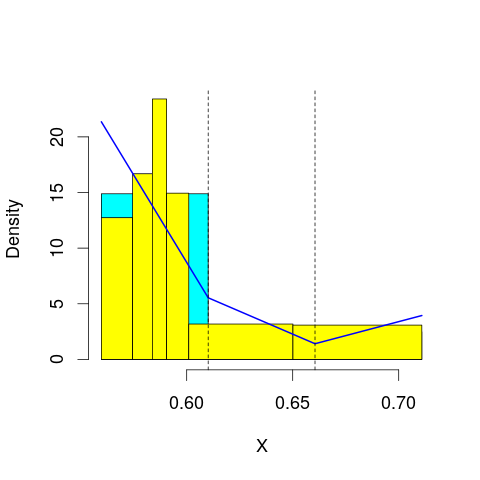

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.04391
mop.approx: Iteration 11. LL = 69.768
mop.approx: Iteration 21. LL = 69.80442
mop.approx: Iteration 31. LL = 69.81065
mop.approx: Iteration 41. LL = 69.81206
mop.approx: Converged. Iteration 41. LL = 69.81212
[1] "Computing the linear combination of B-splines"


61.1477834746
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.83564
mop.approx: Iteration 11. LL = 71.38146
mop.approx: Iteration 21. LL = 71.60998
mop.approx: Iteration 31. LL = 71.67079
mop.approx: Iteration 41. LL = 71.68493
mop.approx: Iteration 51. LL = 71.68805
mop.approx: Converged. Iteration 55. LL = 71.68851
[1] "Computing the linear combination of B-splines"


61.291306825
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06425
mop.approx: Iteration 11. LL = 52.93723
mop.approx: Iteration 21. LL = 52.98571
mop.approx: Converged. Iteration 30. LL = 52.98824
[1] "Computing the linear combination of B-splines"


40.8581663865
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.72875
mop.approx: Iteration 11. LL = 55.23949
mop.approx: Iteration 21. LL = 55.25766
mop.approx: Converged. Iteration 23. LL = 55.25788
[1] "Computing the linear combination of B-splines"


41.3949333298
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.157025
mop.approx: Iteration 11. LL = 50.25972
mop.approx: Iteration 21. LL = 50.33422
mop.approx: Iteration 31. LL = 50.34401
mop.approx: Iteration 41. LL = 50.34575
mop.approx: Converged. Iteration 43. LL = 50.34592
[1] "Computing the linear combination of B-splines"


34.7501057362
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.157542
mop.approx: Iteration 11. LL = 51.93276
mop.approx: Iteration 21. LL = 52.09926
mop.approx: Iteration 31. LL = 52.12332
mop.approx: Iteration 41. LL = 52.12839
mop.approx: Iteration 51. LL = 52.12953
mop.approx: Converged. Iteration 51. LL = 52.12958
[1] "Computing the linear combination of B-splines"


34.8008976485
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.602852
mop.approx: Iteration 11. LL = 47.57781
mop.approx: Iteration 21. LL = 47.83654
mop.approx: Iteration 31. LL = 47.92235
mop.approx: Iteration 41. LL = 47.96122
mop.approx: Iteration 51. LL = 47.98212
mop.approx: Iteration 61. LL = 47.99463
mop.approx: Iteration 71. LL = 48.00268
mop.approx: Iteration 81. LL = 48.00813
mop.approx: Iteration 91. LL = 48.01196
mop.approx: Iteration 101. LL = 48.01471
mop.approx: Iteration 111. LL = 48.01673
mop.approx: Iteration 121. LL = 48.01823
mop.approx: Iteration 131. LL = 48.01937
mop.approx: Iteration 141. LL = 48.02023
mop.approx: Iteration 151. LL = 48.02089
mop.approx: Converged. Iteration 158. LL = 48.0213
[1] "Computing the linear combination of B-splines"


28.9597558427
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.25355
mop.approx: Iteration 11. LL = 70.25274
mop.approx: Iteration 21. LL = 70.25824
mop.approx: Converged. Iteration 23. LL = 70.2585
[1] "Computing the linear combination of B-splines"


61.5941560723
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 61.594156072305601)
m reached
('Sum of Probabilities:', 0.9912243285286294)
chosen


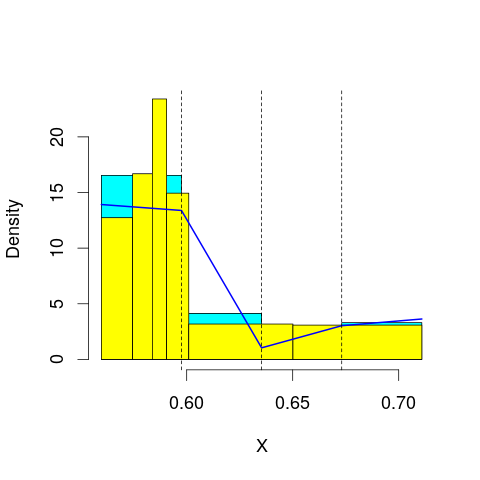

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.04391
mop.approx: Iteration 11. LL = 72.79731
mop.approx: Iteration 21. LL = 72.93936
mop.approx: Iteration 31. LL = 72.95543
mop.approx: Iteration 41. LL = 72.95763
mop.approx: Converged. Iteration 41. LL = 72.9577
[1] "Computing the linear combination of B-splines"


62.5604891143
('best: ', 61.594156072305601, 'accepted difference:', 104.71006532291952, 'cur BIC:', 62.560489114323161)
m reached
('Sum of Probabilities:', 0.9907654912586447)
chosen


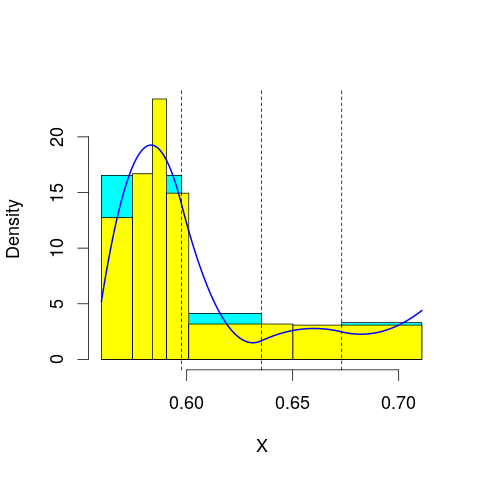

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.83564
mop.approx: Iteration 11. LL = 71.68335
mop.approx: Iteration 21. LL = 71.78829
mop.approx: Iteration 31. LL = 71.81814
mop.approx: Iteration 41. LL = 71.83424
mop.approx: Iteration 51. LL = 71.84382
mop.approx: Iteration 61. LL = 71.84968
mop.approx: Iteration 71. LL = 71.85331
mop.approx: Iteration 81. LL = 71.85559
mop.approx: Iteration 91. LL = 71.85702
mop.approx: Iteration 101. LL = 71.85793
mop.approx: Converged. Iteration 101. LL = 71.858
[1] "Computing the linear combination of B-splines"


59.7279284419
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06425
mop.approx: Iteration 11. LL = 56.06063
mop.approx: Iteration 21. LL = 56.39258
mop.approx: Iteration 31. LL = 56.45153
mop.approx: Iteration 41. LL = 56.46376
mop.approx: Iteration 51. LL = 56.46635
mop.approx: Converged. Iteration 55. LL = 56.46672
[1] "Computing the linear combination of B-splines"


42.603780726
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.72875
mop.approx: Iteration 11. LL = 55.49407
mop.approx: Iteration 21. LL = 55.49995
mop.approx: Converged. Iteration 25. LL = 55.50041
[1] "Computing the linear combination of B-splines"


39.9045948435
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.157025
mop.approx: Iteration 11. LL = 56.35117
mop.approx: Iteration 21. LL = 56.40894
mop.approx: Converged. Iteration 23. LL = 56.40916
[1] "Computing the linear combination of B-splines"


39.0804764451
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.157542
mop.approx: Iteration 11. LL = 52.20888
mop.approx: Iteration 21. LL = 52.23935
mop.approx: Converged. Iteration 24. LL = 52.23967
[1] "Computing the linear combination of B-splines"


33.1781256947
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.602852
mop.approx: Iteration 11. LL = 53.82569
mop.approx: Iteration 21. LL = 53.98591
mop.approx: Iteration 31. LL = 54.00925
mop.approx: Iteration 41. LL = 54.0162
mop.approx: Iteration 51. LL = 54.01863
mop.approx: Iteration 61. LL = 54.01953
mop.approx: Converged. Iteration 61. LL = 54.01958
[1] "Computing the linear combination of B-splines"


33.2251619328
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.25355
mop.approx: Converged. Iteration 10. LL = 72.68822
[1] "Computing the linear combination of B-splines"


62.2910142208
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 62.291014220815498)
m reached
('Sum of Probabilities:', 0.9941846850123113)
chosen


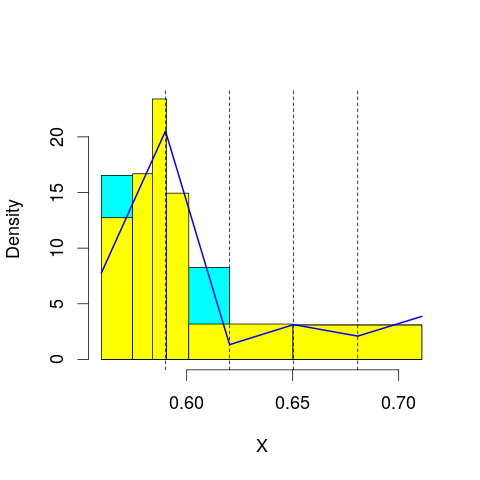

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.04391
mop.approx: Iteration 11. LL = 72.33336
mop.approx: Iteration 21. LL = 72.37522
mop.approx: Iteration 31. LL = 72.393
mop.approx: Iteration 41. LL = 72.40272
mop.approx: Iteration 51. LL = 72.40843
mop.approx: Iteration 61. LL = 72.41194
mop.approx: Iteration 71. LL = 72.41417
mop.approx: Iteration 81. LL = 72.41561
mop.approx: Iteration 91. LL = 72.41654
mop.approx: Converged. Iteration 92. LL = 72.41669
[1] "Computing the linear combination of B-splines"


60.2866106505
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.83564
mop.approx: Iteration 11. LL = 72.14809
mop.approx: Iteration 21. LL = 72.21514
mop.approx: Converged. Iteration 30. LL = 72.21829
[1] "Computing the linear combination of B-splines"


58.355343658
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06425
mop.approx: Iteration 11. LL = 62.19902
mop.approx: Iteration 21. LL = 62.29564
mop.approx: Converged. Iteration 27. LL = 62.29704
[1] "Computing the linear combination of B-splines"


46.7012249244
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.72875
mop.approx: Iteration 11. LL = 55.69428
mop.approx: Iteration 21. LL = 55.72718
mop.approx: Iteration 31. LL = 55.73778
mop.approx: Iteration 41. LL = 55.74163
mop.approx: Iteration 51. LL = 55.74317
mop.approx: Converged. Iteration 58. LL = 55.74373
[1] "Computing the linear combination of B-splines"


38.4150493561
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.157025
mop.approx: Iteration 11. LL = 58.10913
mop.approx: Iteration 21. LL = 58.18779
mop.approx: Iteration 31. LL = 58.19963
mop.approx: Iteration 41. LL = 58.20248
mop.approx: Converged. Iteration 49. LL = 58.20328
[1] "Computing the linear combination of B-splines"


39.1417368233
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.157542
mop.approx: Iteration 11. LL = 56.30108
mop.approx: Iteration 21. LL = 56.57777
mop.approx: Iteration 31. LL = 56.59237
mop.approx: Iteration 41. LL = 56.59403
mop.approx: Converged. Iteration 45. LL = 56.59435
[1] "Computing the linear combination of B-splines"


35.7999360956
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.602852
mop.approx: Iteration 11. LL = 53.91783
mop.approx: Iteration 21. LL = 53.97615
mop.approx: Iteration 31. LL = 53.9863
mop.approx: Iteration 41. LL = 53.98795
mop.approx: Converged. Iteration 41. LL = 53.98801
[1] "Computing the linear combination of B-splines"


31.4607213406
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.25355
mop.approx: Iteration 11. LL = 73.53513
mop.approx: Iteration 21. LL = 73.57508
mop.approx: Iteration 31. LL = 73.58652
mop.approx: Iteration 41. LL = 73.59
mop.approx: Converged. Iteration 49. LL = 73.59102
[1] "Computing the linear combination of B-splines"


61.4609444993
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 61.4609444992943)
m reached
('Sum of Probabilities:', 0.9951604455402648)
chosen


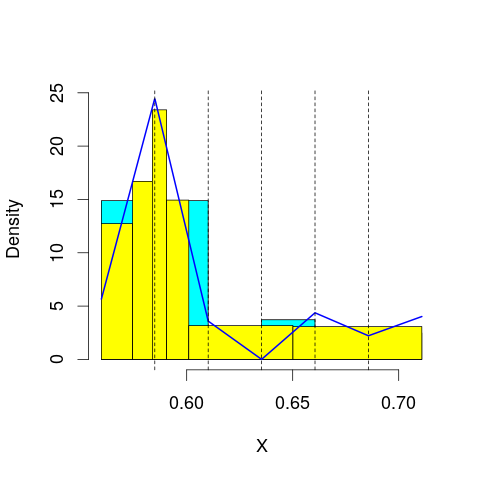

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.04391
mop.approx: Iteration 11. LL = 72.9207
mop.approx: Converged. Iteration 20. LL = 72.9286
[1] "Computing the linear combination of B-splines"


59.0656589363
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.83564
mop.approx: Iteration 11. LL = 73.21374
mop.approx: Iteration 21. LL = 73.31252
mop.approx: Iteration 31. LL = 73.32386
mop.approx: Iteration 41. LL = 73.32671
mop.approx: Iteration 51. LL = 73.32809
mop.approx: Iteration 61. LL = 73.32906
mop.approx: Converged. Iteration 68. LL = 73.32968
[1] "Computing the linear combination of B-splines"


57.7338733189
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06425
mop.approx: Iteration 11. LL = 65.30949
mop.approx: Iteration 21. LL = 65.33551
mop.approx: Converged. Iteration 22. LL = 65.33564
[1] "Computing the linear combination of B-splines"


48.0069647503
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.72875
mop.approx: Iteration 11. LL = 59.9553
mop.approx: Iteration 21. LL = 60.30389
mop.approx: Iteration 31. LL = 60.37231
mop.approx: Iteration 41. LL = 60.39329
mop.approx: Iteration 51. LL = 60.4007
mop.approx: Iteration 61. LL = 60.40354
mop.approx: Iteration 71. LL = 60.40472
mop.approx: Converged. Iteration 74. LL = 60.40499
[1] "Computing the linear combination of B-splines"


41.3434382229
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.157025
mop.approx: Iteration 11. LL = 58.15219
mop.approx: Iteration 21. LL = 58.20596
mop.approx: Iteration 31. LL = 58.22649
mop.approx: Iteration 41. LL = 58.23541
mop.approx: Iteration 51. LL = 58.23961
mop.approx: Iteration 61. LL = 58.24172
mop.approx: Iteration 71. LL = 58.24285
mop.approx: Converged. Iteration 77. LL = 58.24331
[1] "Computing the linear combination of B-splines"


37.4488980096
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.157542
mop.approx: Iteration 11. LL = 59.89194
mop.approx: Iteration 21. LL = 60.0641
mop.approx: Iteration 31. LL = 60.09375
mop.approx: Iteration 41. LL = 60.10325
mop.approx: Iteration 51. LL = 60.1068
mop.approx: Iteration 61. LL = 60.1082
mop.approx: Converged. Iteration 65. LL = 60.10855
[1] "Computing the linear combination of B-splines"


37.5812590588
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.602852
mop.approx: Iteration 11. LL = 55.60752
mop.approx: Iteration 21. LL = 55.99967
mop.approx: Iteration 31. LL = 56.13429
mop.approx: Iteration 41. LL = 56.19172
mop.approx: Iteration 51. LL = 56.21784
mop.approx: Iteration 61. LL = 56.23041
mop.approx: Iteration 71. LL = 56.23695
mop.approx: Iteration 81. LL = 56.24069
mop.approx: Iteration 91. LL = 56.24302
mop.approx: Iteration 101. LL = 56.24458
mop.approx: Iteration 111. LL = 56.24568
mop.approx: Iteration 121. LL = 56.24647
mop.approx: Converged. Iteration 128. LL = 56.24696
[1] "Computing the linear combination of B-splines"


31.9868077036
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.25355
mop.approx: Iteration 11. LL = 74.37156
mop.approx: Iteration 21. LL = 74.39076
mop.approx: Converged. Iteration 24. LL = 74.39118
[1] "Computing the linear combination of B-splines"


60.5282379872
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 60.528237987159848)
m reached
('Sum of Probabilities:', 0.9951185908524803)
chosen


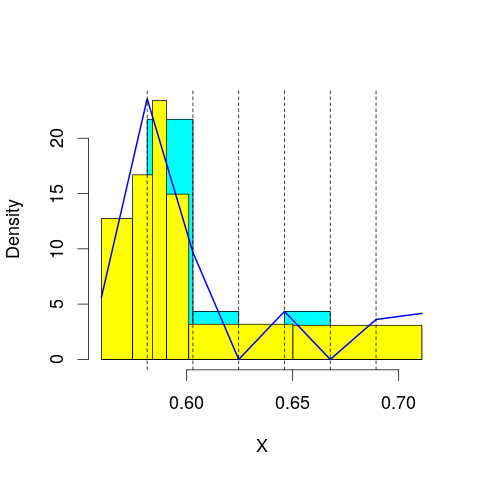

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.04391
mop.approx: Iteration 11. LL = 73.31796
mop.approx: Iteration 21. LL = 73.34441
mop.approx: Iteration 31. LL = 73.34856
mop.approx: Converged. Iteration 35. LL = 73.34903
[1] "Computing the linear combination of B-splines"


57.7532225528
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.83564
mop.approx: Iteration 11. LL = 73.89024
mop.approx: Iteration 21. LL = 74.06024
mop.approx: Iteration 31. LL = 74.08913
mop.approx: Iteration 41. LL = 74.09617
mop.approx: Iteration 51. LL = 74.0987
mop.approx: Iteration 61. LL = 74.09989
mop.approx: Converged. Iteration 63. LL = 74.10012
[1] "Computing the linear combination of B-splines"


56.77144491
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06425
mop.approx: Iteration 11. LL = 66.50245
mop.approx: Iteration 21. LL = 66.56047
mop.approx: Iteration 31. LL = 66.57112
mop.approx: Iteration 41. LL = 66.57475
mop.approx: Iteration 51. LL = 66.57631
mop.approx: Converged. Iteration 58. LL = 66.57696
[1] "Computing the linear combination of B-splines"


47.5154105942
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.72875
mop.approx: Iteration 11. LL = 64.52766
mop.approx: Iteration 21. LL = 64.68507
mop.approx: Iteration 31. LL = 64.69051
mop.approx: Converged. Iteration 32. LL = 64.69064
[1] "Computing the linear combination of B-splines"


43.8962203316
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.157025
mop.approx: Iteration 11. LL = 59.07954
mop.approx: Iteration 21. LL = 59.11964
mop.approx: Converged. Iteration 25. LL = 59.12035
[1] "Computing the linear combination of B-splines"


36.5930625871
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.157542
mop.approx: Iteration 11. LL = 60.71008
mop.approx: Iteration 21. LL = 60.8878
mop.approx: Iteration 31. LL = 60.93229
mop.approx: Iteration 41. LL = 60.94434
mop.approx: Iteration 51. LL = 60.9477
mop.approx: Converged. Iteration 59. LL = 60.94859
[1] "Computing the linear combination of B-splines"


36.6884417476
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.602852
mop.approx: Iteration 11. LL = 60.60853
mop.approx: Iteration 21. LL = 60.92022
mop.approx: Iteration 31. LL = 60.9381
mop.approx: Converged. Iteration 40. LL = 60.93994
[1] "Computing the linear combination of B-splines"


34.9470504609
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.25355
mop.approx: Iteration 11. LL = 73.89216
mop.approx: Iteration 21. LL = 73.9009
mop.approx: Iteration 31. LL = 73.90263
mop.approx: Converged. Iteration 32. LL = 73.90278
[1] "Computing the linear combination of B-splines"


58.3069675513
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 58.30696755134457)
m reached
('Sum of Probabilities:', 0.994713972081407)
chosen


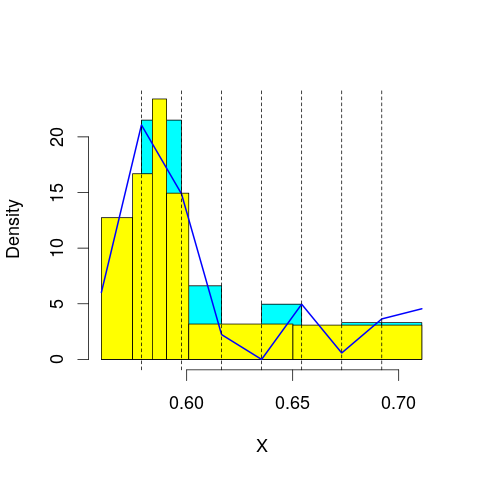

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.04391
mop.approx: Iteration 11. LL = 74.58612
mop.approx: Iteration 21. LL = 74.60537
mop.approx: Converged. Iteration 26. LL = 74.6061
[1] "Computing the linear combination of B-splines"


57.2774217731
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.83564
mop.approx: Iteration 11. LL = 74.14363
mop.approx: Iteration 21. LL = 74.30039
mop.approx: Iteration 31. LL = 74.32855
mop.approx: Iteration 41. LL = 74.33719
mop.approx: Iteration 51. LL = 74.34097
mop.approx: Iteration 61. LL = 74.34294
mop.approx: Iteration 71. LL = 74.34404
mop.approx: Converged. Iteration 73. LL = 74.34427
[1] "Computing the linear combination of B-splines"


55.2827271107
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06425
mop.approx: Iteration 11. LL = 66.59453
mop.approx: Iteration 21. LL = 66.65823
mop.approx: Iteration 31. LL = 66.67163
mop.approx: Iteration 41. LL = 66.67487
mop.approx: Converged. Iteration 47. LL = 66.67553
[1] "Computing the linear combination of B-splines"


45.88111249
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.72875
mop.approx: Iteration 11. LL = 67.47188
mop.approx: Iteration 21. LL = 67.54828
mop.approx: Iteration 31. LL = 67.55176
mop.approx: Converged. Iteration 31. LL = 67.55181
[1] "Computing the linear combination of B-splines"


45.0245314223
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.157025
mop.approx: Iteration 11. LL = 62.16669
mop.approx: Iteration 21. LL = 62.41487
mop.approx: Iteration 31. LL = 62.47728
mop.approx: Iteration 41. LL = 62.50177
mop.approx: Iteration 51. LL = 62.51385
mop.approx: Iteration 61. LL = 62.52072
mop.approx: Iteration 71. LL = 62.52501
mop.approx: Iteration 81. LL = 62.52788
mop.approx: Iteration 91. LL = 62.52988
mop.approx: Iteration 101. LL = 62.53135
mop.approx: Iteration 111. LL = 62.53244
mop.approx: Iteration 121. LL = 62.53328
mop.approx: Converged. Iteration 128. LL = 62.53382
[1] "Computing the linear combination of B-splines"


38.2736701969
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.157542
mop.approx: Iteration 11. LL = 60.97146
mop.approx: Iteration 21. LL = 61.06001
mop.approx: Iteration 31. LL = 61.06904
mop.approx: Converged. Iteration 40. LL = 61.07041
[1] "Computing the linear combination of B-splines"


35.0773917306
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.602852
mop.approx: Iteration 11. LL = 62.35624
mop.approx: Iteration 21. LL = 62.50435
mop.approx: Iteration 31. LL = 62.51391
mop.approx: Converged. Iteration 36. LL = 62.51453
[1] "Computing the linear combination of B-splines"


34.7882317037
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.25355
mop.approx: Iteration 11. LL = 74.60937
mop.approx: Iteration 21. LL = 74.63095
mop.approx: Iteration 31. LL = 74.63479
mop.approx: Iteration 41. LL = 74.63636
mop.approx: Converged. Iteration 47. LL = 74.63696
[1] "Computing the linear combination of B-splines"


57.3082852768
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 57.308285276838248)
m reached
('Sum of Probabilities:', 0.9932260929329791)
chosen


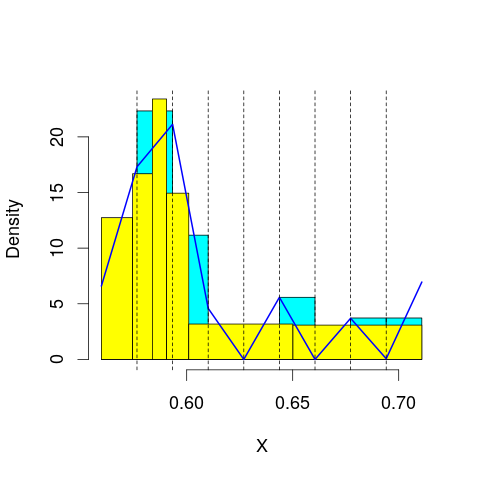

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.04391
mop.approx: Iteration 11. LL = 75.27014
mop.approx: Iteration 21. LL = 75.27797
mop.approx: Converged. Iteration 21. LL = 75.27803
[1] "Computing the linear combination of B-splines"


56.216484143
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.83564
mop.approx: Iteration 11. LL = 74.08967
mop.approx: Iteration 21. LL = 74.24927
mop.approx: Iteration 31. LL = 74.28066
mop.approx: Iteration 41. LL = 74.28924
mop.approx: Iteration 51. LL = 74.29243
mop.approx: Iteration 61. LL = 74.29378
mop.approx: Converged. Iteration 63. LL = 74.29401
[1] "Computing the linear combination of B-splines"


53.4995992565
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06425
mop.approx: Iteration 11. LL = 67.34137
mop.approx: Iteration 21. LL = 67.38788
mop.approx: Converged. Iteration 29. LL = 67.38999
[1] "Computing the linear combination of B-splines"


44.8627063543
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.72875
mop.approx: Iteration 11. LL = 68.36784
mop.approx: Iteration 21. LL = 68.48627
mop.approx: Iteration 31. LL = 68.51277
mop.approx: Iteration 41. LL = 68.51949
mop.approx: Iteration 51. LL = 68.52124
mop.approx: Converged. Iteration 53. LL = 68.52146
[1] "Computing the linear combination of B-splines"


44.2613044644
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.157025
mop.approx: Iteration 11. LL = 66.16623
mop.approx: Iteration 21. LL = 66.37634
mop.approx: Iteration 31. LL = 66.39003
mop.approx: Converged. Iteration 39. LL = 66.39134
[1] "Computing the linear combination of B-splines"


40.39831541
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.157542
mop.approx: Iteration 11. LL = 61.64076
mop.approx: Iteration 21. LL = 61.67304
mop.approx: Iteration 31. LL = 61.68449
mop.approx: Iteration 41. LL = 61.68964
mop.approx: Iteration 51. LL = 61.69228
mop.approx: Iteration 61. LL = 61.69379
mop.approx: Iteration 71. LL = 61.69472
mop.approx: Converged. Iteration 75. LL = 61.69505
[1] "Computing the linear combination of B-splines"


33.9691942654
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.602852
mop.approx: Iteration 11. LL = 63.1921
mop.approx: Iteration 21. LL = 63.36917
mop.approx: Iteration 31. LL = 63.3983
mop.approx: Iteration 41. LL = 63.40569
mop.approx: Iteration 51. LL = 63.4078
mop.approx: Converged. Iteration 55. LL = 63.4082
[1] "Computing the linear combination of B-splines"


33.9490039569
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.25355
mop.approx: Iteration 11. LL = 76.65004
mop.approx: Iteration 21. LL = 76.6587
mop.approx: Iteration 31. LL = 76.66081
mop.approx: Converged. Iteration 37. LL = 76.66147
[1] "Computing the linear combination of B-splines"


57.5999237144
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 57.59992371444168)
m reached
('Sum of Probabilities:', 0.992660904923957)
chosen


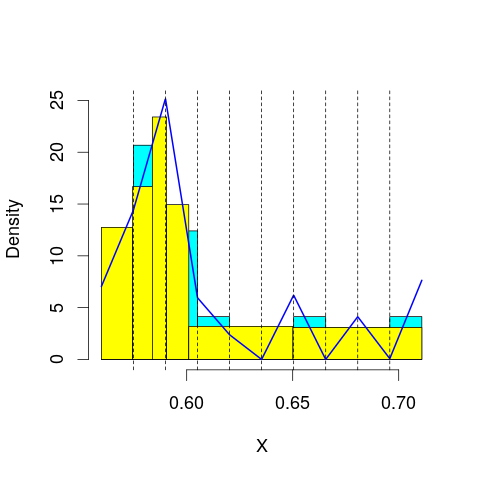

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.04391
mop.approx: Iteration 11. LL = 74.54896
mop.approx: Iteration 21. LL = 74.6276
mop.approx: Iteration 31. LL = 74.6444
mop.approx: Iteration 41. LL = 74.64994
mop.approx: Iteration 51. LL = 74.65188
mop.approx: Converged. Iteration 55. LL = 74.65231
[1] "Computing the linear combination of B-splines"


53.8578915309
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.83564
mop.approx: Iteration 11. LL = 75.04091
mop.approx: Iteration 21. LL = 75.09206
mop.approx: Iteration 31. LL = 75.1127
mop.approx: Iteration 41. LL = 75.12251
mop.approx: Iteration 51. LL = 75.12726
mop.approx: Iteration 61. LL = 75.12957
mop.approx: Iteration 71. LL = 75.13069
mop.approx: Converged. Iteration 71. LL = 75.13076
[1] "Computing the linear combination of B-splines"


52.6034797039
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06425
mop.approx: Iteration 11. LL = 67.45264
mop.approx: Iteration 21. LL = 67.50211
mop.approx: Iteration 31. LL = 67.52161
mop.approx: Iteration 41. LL = 67.53191
mop.approx: Iteration 51. LL = 67.53768
mop.approx: Iteration 61. LL = 67.54098
mop.approx: Iteration 71. LL = 67.5429
mop.approx: Iteration 81. LL = 67.54402
mop.approx: Converged. Iteration 85. LL = 67.5444
[1] "Computing the linear combination of B-splines"


43.2842436798
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.72875
mop.approx: Iteration 11. LL = 69.11447
mop.approx: Iteration 21. LL = 69.14812
mop.approx: Iteration 31. LL = 69.15058
mop.approx: Converged. Iteration 34. LL = 69.15088
[1] "Computing the linear combination of B-splines"


43.1578637533
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.157025
mop.approx: Iteration 11. LL = 68.34549
mop.approx: Iteration 21. LL = 68.45754
mop.approx: Iteration 31. LL = 68.47643
mop.approx: Iteration 41. LL = 68.48791
mop.approx: Iteration 51. LL = 68.4957
mop.approx: Iteration 61. LL = 68.50106
mop.approx: Iteration 71. LL = 68.50478
mop.approx: Iteration 81. LL = 68.50736
mop.approx: Iteration 91. LL = 68.50916
mop.approx: Iteration 101. LL = 68.51041
mop.approx: Iteration 111. LL = 68.51129
mop.approx: Converged. Iteration 113. LL = 68.5115
[1] "Computing the linear combination of B-splines"


40.7856077267
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.157542
mop.approx: Iteration 11. LL = 64.22166
mop.approx: Iteration 21. LL = 64.31481
mop.approx: Iteration 31. LL = 64.32455
mop.approx: Iteration 41. LL = 64.32615
mop.approx: Converged. Iteration 41. LL = 64.32621
[1] "Computing the linear combination of B-splines"


34.8674142491
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.602852
mop.approx: Iteration 11. LL = 63.13807
mop.approx: Iteration 21. LL = 63.17375
mop.approx: Iteration 31. LL = 63.17724
mop.approx: Iteration 41. LL = 63.17847
mop.approx: Converged. Iteration 48. LL = 63.17905
[1] "Computing the linear combination of B-splines"


31.9869537739
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.25355
mop.approx: Iteration 11. LL = 75.7923
mop.approx: Iteration 21. LL = 75.83291
mop.approx: Iteration 31. LL = 75.84384
mop.approx: Iteration 41. LL = 75.84715
mop.approx: Converged. Iteration 48. LL = 75.84807
[1] "Computing the linear combination of B-splines"


55.0536516902
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 55.053651690219539)
m reached
('Sum of Probabilities:', 0.993176781821053)
chosen


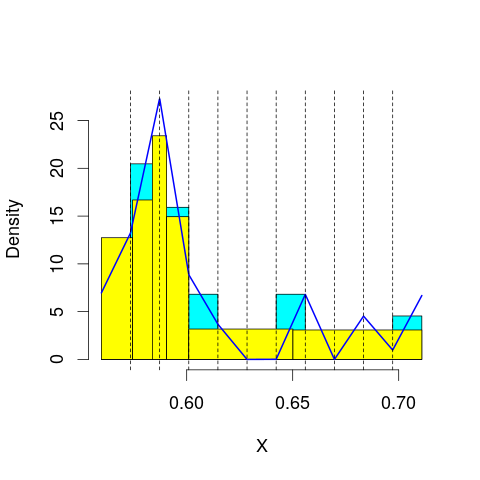

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.04391
mop.approx: Iteration 11. LL = 75.58185
mop.approx: Iteration 21. LL = 75.59164
mop.approx: Iteration 31. LL = 75.59344
mop.approx: Converged. Iteration 33. LL = 75.59368
[1] "Computing the linear combination of B-splines"


53.0663919663
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.83564
mop.approx: Iteration 11. LL = 74.86645
mop.approx: Iteration 21. LL = 74.94682
mop.approx: Iteration 31. LL = 74.98004
mop.approx: Iteration 41. LL = 74.99481
mop.approx: Iteration 51. LL = 75.00144
mop.approx: Iteration 61. LL = 75.00443
mop.approx: Iteration 71. LL = 75.00579
mop.approx: Converged. Iteration 73. LL = 75.00602
[1] "Computing the linear combination of B-splines"


50.7458731071
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06425
mop.approx: Iteration 11. LL = 68.96115
mop.approx: Iteration 21. LL = 69.00924
mop.approx: Iteration 31. LL = 69.02899
mop.approx: Iteration 41. LL = 69.03813
mop.approx: Iteration 51. LL = 69.04288
mop.approx: Iteration 61. LL = 69.04558
mop.approx: Iteration 71. LL = 69.0472
mop.approx: Iteration 81. LL = 69.04821
mop.approx: Converged. Iteration 84. LL = 69.0485
[1] "Computing the linear combination of B-splines"


43.0554842038
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.72875
mop.approx: Iteration 11. LL = 68.97451
mop.approx: Iteration 21. LL = 68.99905
mop.approx: Iteration 31. LL = 69.00823
mop.approx: Iteration 41. LL = 69.01434
mop.approx: Iteration 51. LL = 69.01854
mop.approx: Iteration 61. LL = 69.02145
mop.approx: Iteration 71. LL = 69.02347
mop.approx: Iteration 81. LL = 69.02487
mop.approx: Iteration 91. LL = 69.02586
mop.approx: Converged. Iteration 96. LL = 69.0263
[1] "Computing the linear combination of B-splines"


41.3004169934
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.157025
mop.approx: Iteration 11. LL = 69.79418
mop.approx: Iteration 21. LL = 69.86368
mop.approx: Iteration 31. LL = 69.87027
mop.approx: Converged. Iteration 40. LL = 69.87168
[1] "Computing the linear combination of B-splines"


40.4129219234
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.157542
mop.approx: Iteration 11. LL = 66.92031
mop.approx: Iteration 21. LL = 67.18197
mop.approx: Iteration 31. LL = 67.23768
mop.approx: Iteration 41. LL = 67.25574
mop.approx: Iteration 51. LL = 67.26249
mop.approx: Iteration 61. LL = 67.26524
mop.approx: Iteration 71. LL = 67.26642
mop.approx: Converged. Iteration 73. LL = 67.26662
[1] "Computing the linear combination of B-splines"


36.0748427286
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.602852
mop.approx: Iteration 11. LL = 64.09976
mop.approx: Iteration 21. LL = 64.13095
mop.approx: Iteration 31. LL = 64.13847
mop.approx: Iteration 41. LL = 64.14157
mop.approx: Iteration 51. LL = 64.14307
mop.approx: Converged. Iteration 60. LL = 64.14389
[1] "Computing the linear combination of B-splines"


31.2197822868
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.25355
mop.approx: Iteration 11. LL = 76.91465
mop.approx: Converged. Iteration 16. LL = 76.91671
[1] "Computing the linear combination of B-splines"


54.3894280946
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 54.389428094567805)
m reached
('Sum of Probabilities:', 0.9938025036862392)
chosen


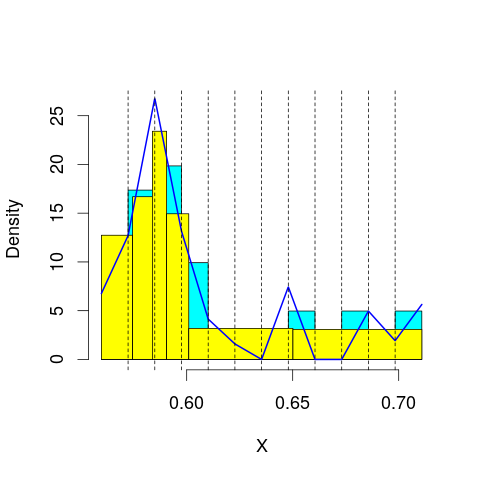

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.04391
mop.approx: Iteration 11. LL = 75.79612
mop.approx: Iteration 21. LL = 75.84141
mop.approx: Iteration 31. LL = 75.84833
mop.approx: Converged. Iteration 39. LL = 75.8496
[1] "Computing the linear combination of B-splines"


51.5894518213
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.83564
mop.approx: Iteration 11. LL = 75.99841
mop.approx: Iteration 21. LL = 76.07251
mop.approx: Iteration 31. LL = 76.0921
mop.approx: Iteration 41. LL = 76.0983
mop.approx: Iteration 51. LL = 76.10047
mop.approx: Converged. Iteration 56. LL = 76.10105
[1] "Computing the linear combination of B-splines"


50.1080275203
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06425
mop.approx: Iteration 11. LL = 69.79029
mop.approx: Iteration 21. LL = 69.86886
mop.approx: Iteration 31. LL = 69.87811
mop.approx: Iteration 41. LL = 69.87999
mop.approx: Converged. Iteration 44. LL = 69.88029
[1] "Computing the linear combination of B-splines"


42.1544053265
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.72875
mop.approx: Iteration 11. LL = 69.76702
mop.approx: Iteration 21. LL = 69.79183
mop.approx: Converged. Iteration 28. LL = 69.7931
[1] "Computing the linear combination of B-splines"


40.3343411782
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.157025
mop.approx: Iteration 11. LL = 70.19638
mop.approx: Iteration 21. LL = 70.28701
mop.approx: Iteration 31. LL = 70.30423
mop.approx: Iteration 41. LL = 70.30806
mop.approx: Converged. Iteration 47. LL = 70.30878
[1] "Computing the linear combination of B-splines"


39.1171757122
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.157542
mop.approx: Iteration 11. LL = 69.21861
mop.approx: Iteration 21. LL = 69.42682
mop.approx: Iteration 31. LL = 69.43846
mop.approx: Iteration 41. LL = 69.44035
mop.approx: Converged. Iteration 44. LL = 69.44067
[1] "Computing the linear combination of B-splines"


36.5159003177
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.602852
mop.approx: Iteration 11. LL = 65.67432
mop.approx: Iteration 21. LL = 65.7845
mop.approx: Iteration 31. LL = 65.80389
mop.approx: Iteration 41. LL = 65.80799
mop.approx: Converged. Iteration 48. LL = 65.80882
[1] "Computing the linear combination of B-splines"


31.1437461635
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.25355
mop.approx: Iteration 11. LL = 76.35154
mop.approx: Converged. Iteration 13. LL = 76.35181
[1] "Computing the linear combination of B-splines"


52.0916631479
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 52.091663147851271)
m reached
('Sum of Probabilities:', 0.994269798542677)
chosen


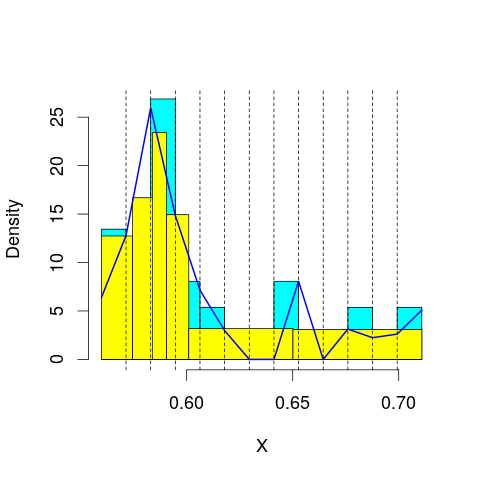

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.04391
mop.approx: Iteration 11. LL = 76.78355
mop.approx: Iteration 21. LL = 76.83382
mop.approx: Iteration 31. LL = 76.84502
mop.approx: Iteration 41. LL = 76.84825
mop.approx: Converged. Iteration 50. LL = 76.84941
[1] "Computing the linear combination of B-splines"


50.8563859139
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.83564
mop.approx: Iteration 11. LL = 76.01619
mop.approx: Iteration 21. LL = 76.08668
mop.approx: Iteration 31. LL = 76.10104
mop.approx: Iteration 41. LL = 76.10573
mop.approx: Iteration 51. LL = 76.10778
mop.approx: Converged. Iteration 60. LL = 76.1088
[1] "Computing the linear combination of B-splines"


48.3829106833
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06425
mop.approx: Iteration 11. LL = 70.93753
mop.approx: Iteration 21. LL = 71.01771
mop.approx: Iteration 31. LL = 71.02859
mop.approx: Iteration 41. LL = 71.03104
mop.approx: Converged. Iteration 47. LL = 71.03168
[1] "Computing the linear combination of B-splines"


41.5729212955
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.72875
mop.approx: Iteration 11. LL = 70.18215
mop.approx: Iteration 21. LL = 70.26449
mop.approx: Iteration 31. LL = 70.28285
mop.approx: Iteration 41. LL = 70.29006
mop.approx: Iteration 51. LL = 70.29349
mop.approx: Iteration 61. LL = 70.29527
mop.approx: Iteration 71. LL = 70.29624
mop.approx: Converged. Iteration 71. LL = 70.29631
[1] "Computing the linear combination of B-splines"


39.1046829326
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.157025
mop.approx: Iteration 11. LL = 70.85218
mop.approx: Iteration 21. LL = 70.90694
mop.approx: Iteration 31. LL = 70.91033
mop.approx: Converged. Iteration 31. LL = 70.9104
[1] "Computing the linear combination of B-splines"


37.9859037007
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.157542
mop.approx: Iteration 11. LL = 70.34291
mop.approx: Iteration 21. LL = 70.5196
mop.approx: Iteration 31. LL = 70.5504
mop.approx: Iteration 41. LL = 70.55996
mop.approx: Iteration 51. LL = 70.56351
mop.approx: Iteration 61. LL = 70.56493
mop.approx: Converged. Iteration 63. LL = 70.56516
[1] "Computing the linear combination of B-splines"


35.9065750838
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.602852
mop.approx: Iteration 11. LL = 67.88324
mop.approx: Iteration 21. LL = 68.12799
mop.approx: Iteration 31. LL = 68.16456
mop.approx: Iteration 41. LL = 68.17526
mop.approx: Iteration 51. LL = 68.17982
mop.approx: Iteration 61. LL = 68.18223
mop.approx: Iteration 71. LL = 68.18367
mop.approx: Iteration 81. LL = 68.18461
mop.approx: Converged. Iteration 84. LL = 68.18489
[1] "Computing the linear combination of B-splines"


31.8303434878
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.25355
mop.approx: Iteration 11. LL = 76.88878
mop.approx: Converged. Iteration 19. LL = 76.89509
[1] "Computing the linear combination of B-splines"


50.9020729321
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 50.902072932060989)
m reached
('Sum of Probabilities:', 0.9941984697066566)
chosen


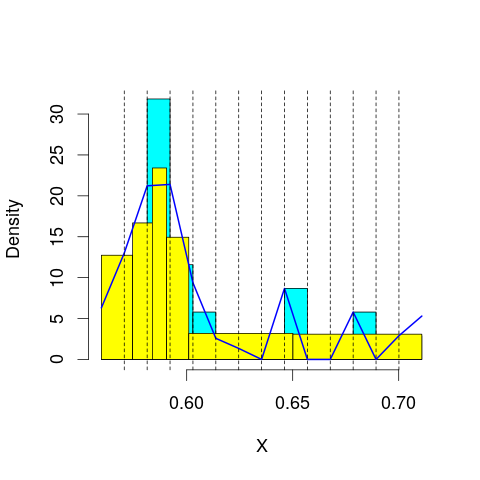

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.04391
mop.approx: Iteration 11. LL = 77.30171
mop.approx: Iteration 21. LL = 77.31816
mop.approx: Iteration 31. LL = 77.32748
mop.approx: Iteration 41. LL = 77.33228
mop.approx: Iteration 51. LL = 77.33456
mop.approx: Converged. Iteration 59. LL = 77.33553
[1] "Computing the linear combination of B-splines"


49.6096407544
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.83564
mop.approx: Iteration 11. LL = 76.39706
mop.approx: Iteration 21. LL = 76.49446
mop.approx: Iteration 31. LL = 76.50661
mop.approx: Iteration 41. LL = 76.50961
mop.approx: Converged. Iteration 48. LL = 76.51047
[1] "Computing the linear combination of B-splines"


47.05171107
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06425
mop.approx: Iteration 11. LL = 71.62226
mop.approx: Iteration 21. LL = 71.67306
mop.approx: Iteration 31. LL = 71.68994
mop.approx: Iteration 41. LL = 71.69676
mop.approx: Iteration 51. LL = 71.69986
mop.approx: Iteration 61. LL = 71.70139
mop.approx: Converged. Iteration 68. LL = 71.70208
[1] "Computing the linear combination of B-splines"


40.5104603698
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.72875
mop.approx: Iteration 11. LL = 70.76559
mop.approx: Iteration 21. LL = 70.87291
mop.approx: Iteration 31. LL = 70.88889
mop.approx: Iteration 41. LL = 70.89364
mop.approx: Iteration 51. LL = 70.8958
mop.approx: Iteration 61. LL = 70.897
mop.approx: Converged. Iteration 67. LL = 70.89755
[1] "Computing the linear combination of B-splines"


37.9730604062
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.157025
mop.approx: Iteration 11. LL = 71.22713
mop.approx: Iteration 21. LL = 71.2596
mop.approx: Iteration 31. LL = 71.26507
mop.approx: Iteration 41. LL = 71.26824
mop.approx: Iteration 51. LL = 71.27025
mop.approx: Iteration 61. LL = 71.27158
mop.approx: Iteration 71. LL = 71.2725
mop.approx: Converged. Iteration 73. LL = 71.27272
[1] "Computing the linear combination of B-splines"


36.6152928248
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.157542
mop.approx: Iteration 11. LL = 71.15902
mop.approx: Iteration 21. LL = 71.321
mop.approx: Iteration 31. LL = 71.34852
mop.approx: Iteration 41. LL = 71.35639
mop.approx: Iteration 51. LL = 71.35967
mop.approx: Iteration 61. LL = 71.36137
mop.approx: Iteration 71. LL = 71.36235
mop.approx: Converged. Iteration 72. LL = 71.3625
[1] "Computing the linear combination of B-splines"


34.9727969084
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.602852
mop.approx: Iteration 11. LL = 69.38414
mop.approx: Iteration 21. LL = 69.68812
mop.approx: Iteration 31. LL = 69.74135
mop.approx: Iteration 41. LL = 69.75167
mop.approx: Iteration 51. LL = 69.7537
mop.approx: Converged. Iteration 52. LL = 69.75383
[1] "Computing the linear combination of B-splines"


31.5401159183
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.25355
mop.approx: Iteration 11. LL = 79.03053
mop.approx: Converged. Iteration 14. LL = 79.03106
[1] "Computing the linear combination of B-splines"


51.3051727984
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 51.305172798413935)
m reached
('Sum of Probabilities:', 0.9940347763111788)
chosen


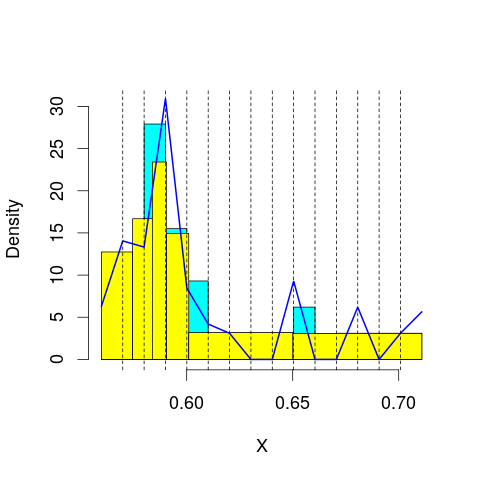

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.04391
mop.approx: Iteration 11. LL = 76.30089
mop.approx: Iteration 21. LL = 76.39684
mop.approx: Iteration 31. LL = 76.42184
mop.approx: Iteration 41. LL = 76.4293
mop.approx: Iteration 51. LL = 76.43179
mop.approx: Converged. Iteration 57. LL = 76.43251
[1] "Computing the linear combination of B-splines"


46.9737552035
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.83564
mop.approx: Iteration 11. LL = 77.72779
mop.approx: Iteration 21. LL = 77.78502
mop.approx: Iteration 31. LL = 77.79637
mop.approx: Iteration 41. LL = 77.80072
mop.approx: Iteration 51. LL = 77.80255
mop.approx: Converged. Iteration 56. LL = 77.80311
[1] "Computing the linear combination of B-splines"


46.6114840382
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06425
mop.approx: Iteration 11. LL = 71.33753
mop.approx: Iteration 21. LL = 71.43481
mop.approx: Iteration 31. LL = 71.45696
mop.approx: Iteration 41. LL = 71.4634
mop.approx: Iteration 51. LL = 71.46548
mop.approx: Converged. Iteration 55. LL = 71.46592
[1] "Computing the linear combination of B-splines"


38.541425701
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.72875
mop.approx: Iteration 11. LL = 71.75486
mop.approx: Iteration 21. LL = 71.82277
mop.approx: Iteration 31. LL = 71.86123
mop.approx: Iteration 41. LL = 71.88284
mop.approx: Iteration 51. LL = 71.89512
mop.approx: Iteration 61. LL = 71.90226
mop.approx: Iteration 71. LL = 71.90647
mop.approx: Iteration 81. LL = 71.909
mop.approx: Iteration 91. LL = 71.91053
mop.approx: Iteration 101. LL = 71.91145
mop.approx: Converged. Iteration 101. LL = 71.91152
[1] "Computing the linear combination of B-splines"


37.2541652682
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.157025
mop.approx: Iteration 11. LL = 71.10424
mop.approx: Iteration 21. LL = 71.2112
mop.approx: Iteration 31. LL = 71.24581
mop.approx: Iteration 41. LL = 71.2605
mop.approx: Iteration 51. LL = 71.26732
mop.approx: Iteration 61. LL = 71.2707
mop.approx: Iteration 71. LL = 71.2725
mop.approx: Iteration 81. LL = 71.27353
mop.approx: Converged. Iteration 83. LL = 71.27375
[1] "Computing the linear combination of B-splines"


34.8836409834
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.157542
mop.approx: Iteration 11. LL = 71.96276
mop.approx: Iteration 21. LL = 72.03098
mop.approx: Iteration 31. LL = 72.0501
mop.approx: Iteration 41. LL = 72.06118
mop.approx: Iteration 51. LL = 72.06796
mop.approx: Iteration 61. LL = 72.07197
mop.approx: Iteration 71. LL = 72.0742
mop.approx: Iteration 81. LL = 72.07536
mop.approx: Converged. Iteration 83. LL = 72.07558
[1] "Computing the linear combination of B-splines"


33.9485742421
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.602852
mop.approx: Iteration 11. LL = 71.0812
mop.approx: Iteration 21. LL = 71.31697
mop.approx: Iteration 31. LL = 71.33842
mop.approx: Iteration 41. LL = 71.34169
mop.approx: Converged. Iteration 48. LL = 71.34247
[1] "Computing the linear combination of B-splines"


31.4231195701
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.25355
mop.approx: Iteration 11. LL = 77.87757
mop.approx: Iteration 21. LL = 77.89226
mop.approx: Converged. Iteration 27. LL = 77.89332
[1] "Computing the linear combination of B-splines"


48.4345653029
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 48.434565302926565)
m reached
('Sum of Probabilities:', 0.993860750063295)
chosen


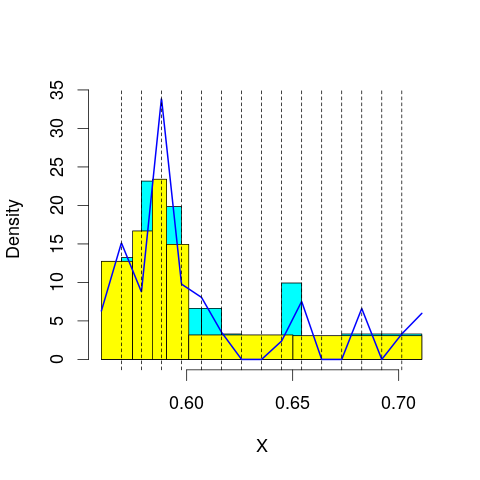

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.04391
mop.approx: Iteration 11. LL = 77.86381
mop.approx: Iteration 21. LL = 77.94287
mop.approx: Iteration 31. LL = 77.96546
mop.approx: Iteration 41. LL = 77.97439
mop.approx: Iteration 51. LL = 77.97839
mop.approx: Iteration 61. LL = 77.98031
mop.approx: Converged. Iteration 69. LL = 77.98119
[1] "Computing the linear combination of B-splines"


46.7895683373
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.83564
mop.approx: Iteration 11. LL = 77.63596
mop.approx: Iteration 21. LL = 77.75318
mop.approx: Iteration 31. LL = 77.78319
mop.approx: Iteration 41. LL = 77.7945
mop.approx: Iteration 51. LL = 77.79956
mop.approx: Iteration 61. LL = 77.8021
mop.approx: Iteration 71. LL = 77.80348
mop.approx: Converged. Iteration 76. LL = 77.80401
[1] "Computing the linear combination of B-splines"


44.8795153679
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06425
mop.approx: Iteration 11. LL = 72.15755
mop.approx: Iteration 21. LL = 72.17634
mop.approx: Iteration 31. LL = 72.18442
mop.approx: Iteration 41. LL = 72.18996
mop.approx: Iteration 51. LL = 72.19397
mop.approx: Iteration 61. LL = 72.19694
mop.approx: Iteration 71. LL = 72.19916
mop.approx: Iteration 81. LL = 72.20085
mop.approx: Iteration 91. LL = 72.20215
mop.approx: Iteration 101. LL = 72.20316
mop.approx: Converged. Iteration 110. LL = 72.20395
[1] "Computing the linear combination of B-splines"


37.5465890384
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.72875
mop.approx: Iteration 11. LL = 71.73849
mop.approx: Iteration 21. LL = 71.80153
mop.approx: Iteration 31. LL = 71.82709
mop.approx: Iteration 41. LL = 71.84006
mop.approx: Iteration 51. LL = 71.84747
mop.approx: Iteration 61. LL = 71.85208
mop.approx: Iteration 71. LL = 71.85515
mop.approx: Iteration 81. LL = 71.85729
mop.approx: Iteration 91. LL = 71.85884
mop.approx: Iteration 101. LL = 71.86001
mop.approx: Iteration 111. LL = 71.8609
mop.approx: Converged. Iteration 115. LL = 71.86127
[1] "Computing the linear combination of B-splines"


35.4710518592
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.157025
mop.approx: Iteration 11. LL = 71.92402
mop.approx: Iteration 21. LL = 71.98201
mop.approx: Iteration 31. LL = 72.01477
mop.approx: Iteration 41. LL = 72.03396
mop.approx: Iteration 51. LL = 72.04428
mop.approx: Iteration 61. LL = 72.04964
mop.approx: Iteration 71. LL = 72.05246
mop.approx: Iteration 81. LL = 72.054
mop.approx: Converged. Iteration 90. LL = 72.0549
[1] "Computing the linear combination of B-splines"


33.9317423981
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.157542
mop.approx: Iteration 11. LL = 71.87374
mop.approx: Iteration 21. LL = 71.91262
mop.approx: Iteration 31. LL = 71.91712
mop.approx: Iteration 41. LL = 71.9197
mop.approx: Iteration 51. LL = 71.9216
mop.approx: Iteration 61. LL = 71.92303
mop.approx: Iteration 71. LL = 71.92413
mop.approx: Iteration 81. LL = 71.92499
mop.approx: Converged. Iteration 83. LL = 71.92521
[1] "Computing the linear combination of B-splines"


32.0567865275
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.602852
mop.approx: Iteration 11. LL = 72.73558
mop.approx: Iteration 21. LL = 72.92903
mop.approx: Iteration 31. LL = 72.96053
mop.approx: Iteration 41. LL = 72.96846
mop.approx: Iteration 51. LL = 72.97046
mop.approx: Converged. Iteration 53. LL = 72.97069
[1] "Computing the linear combination of B-splines"


31.3120650513
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.25355
mop.approx: Iteration 11. LL = 80.08577
mop.approx: Converged. Iteration 18. LL = 80.09238
[1] "Computing the linear combination of B-splines"


48.9007523363
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 48.90075233628562)
m reached
('Sum of Probabilities:', 0.993623770603739)
chosen


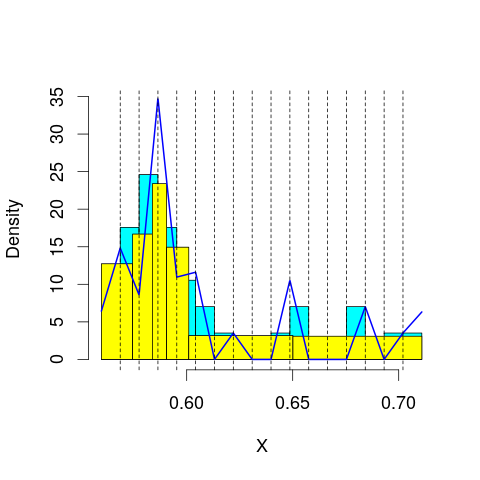

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.04391
mop.approx: Iteration 11. LL = 78.22663
mop.approx: Iteration 21. LL = 78.29584
mop.approx: Iteration 31. LL = 78.30082
mop.approx: Converged. Iteration 32. LL = 78.30099
[1] "Computing the linear combination of B-splines"


45.3764942185
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.83564
mop.approx: Iteration 11. LL = 78.86471
mop.approx: Iteration 21. LL = 79.03673
mop.approx: Iteration 31. LL = 79.07954
mop.approx: Iteration 41. LL = 79.0936
mop.approx: Iteration 51. LL = 79.09954
mop.approx: Iteration 61. LL = 79.10264
mop.approx: Iteration 71. LL = 79.1045
mop.approx: Iteration 81. LL = 79.10571
mop.approx: Converged. Iteration 87. LL = 79.10632
[1] "Computing the linear combination of B-splines"


44.4489644553
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06425
mop.approx: Iteration 11. LL = 72.21385
mop.approx: Iteration 21. LL = 72.28381
mop.approx: Iteration 31. LL = 72.29288
mop.approx: Converged. Iteration 38. LL = 72.29408
[1] "Computing the linear combination of B-splines"


35.9038537365
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.72875
mop.approx: Iteration 11. LL = 72.62103
mop.approx: Iteration 21. LL = 72.67628
mop.approx: Iteration 31. LL = 72.68547
mop.approx: Iteration 41. LL = 72.68837
mop.approx: Iteration 51. LL = 72.68974
mop.approx: Iteration 61. LL = 72.69064
mop.approx: Converged. Iteration 66. LL = 72.69109
[1] "Computing the linear combination of B-splines"


34.5679873585
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.157025
mop.approx: Iteration 11. LL = 72.05913
mop.approx: Iteration 21. LL = 72.15566
mop.approx: Iteration 31. LL = 72.18996
mop.approx: Iteration 41. LL = 72.20619
mop.approx: Iteration 51. LL = 72.21515
mop.approx: Iteration 61. LL = 72.22054
mop.approx: Iteration 71. LL = 72.22392
mop.approx: Iteration 81. LL = 72.22609
mop.approx: Iteration 91. LL = 72.2275
mop.approx: Iteration 101. LL = 72.22843
mop.approx: Converged. Iteration 102. LL = 72.22858
[1] "Computing the linear combination of B-splines"


32.3723717608
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.157542
mop.approx: Iteration 11. LL = 72.5191
mop.approx: Iteration 21. LL = 72.60238
mop.approx: Iteration 31. LL = 72.62313
mop.approx: Iteration 41. LL = 72.63158
mop.approx: Iteration 51. LL = 72.63516
mop.approx: Iteration 61. LL = 72.6369
mop.approx: Iteration 71. LL = 72.63787
mop.approx: Converged. Iteration 72. LL = 72.63802
[1] "Computing the linear combination of B-splines"


31.0546213207
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.602852
mop.approx: Iteration 11. LL = 71.61604
mop.approx: Iteration 21. LL = 71.84927
mop.approx: Iteration 31. LL = 71.91665
mop.approx: Iteration 41. LL = 71.94461
mop.approx: Iteration 51. LL = 71.95636
mop.approx: Iteration 61. LL = 71.96143
mop.approx: Iteration 71. LL = 71.96371
mop.approx: Iteration 81. LL = 71.96476
mop.approx: Converged. Iteration 81. LL = 71.96483
[1] "Computing the linear combination of B-splines"


28.3102317922
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.25355
mop.approx: Iteration 11. LL = 78.81877
mop.approx: Converged. Iteration 18. LL = 78.82262
[1] "Computing the linear combination of B-splines"


45.8981294218
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 45.89812942176458)
m reached
('Sum of Probabilities:', 0.9933488884364917)
chosen


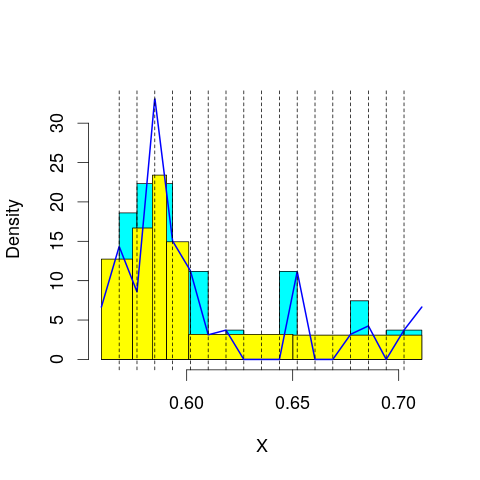

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.04391
mop.approx: Iteration 11. LL = 80.20069
mop.approx: Iteration 21. LL = 80.24992
mop.approx: Converged. Iteration 28. LL = 80.25162
[1] "Computing the linear combination of B-splines"


45.5942653703
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.83564
mop.approx: Iteration 11. LL = 78.48446
mop.approx: Iteration 21. LL = 78.61375
mop.approx: Iteration 31. LL = 78.65504
mop.approx: Iteration 41. LL = 78.67363
mop.approx: Iteration 51. LL = 78.68322
mop.approx: Iteration 61. LL = 78.6886
mop.approx: Iteration 71. LL = 78.6918
mop.approx: Iteration 81. LL = 78.69379
mop.approx: Iteration 91. LL = 78.69507
mop.approx: Converged. Iteration 98. LL = 78.69578
[1] "Computing the linear combination of B-splines"


42.3055486331
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06425
mop.approx: Iteration 11. LL = 73.02889
mop.approx: Iteration 21. LL = 73.06254
mop.approx: Iteration 31. LL = 73.07521
mop.approx: Iteration 41. LL = 73.08322
mop.approx: Iteration 51. LL = 73.08817
mop.approx: Iteration 61. LL = 73.09113
mop.approx: Iteration 71. LL = 73.09284
mop.approx: Iteration 81. LL = 73.09381
mop.approx: Converged. Iteration 81. LL = 73.09388
[1] "Computing the linear combination of B-splines"


34.9707890888
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.72875
mop.approx: Iteration 11. LL = 72.55804
mop.approx: Iteration 21. LL = 72.62301
mop.approx: Iteration 31. LL = 72.64748
mop.approx: Iteration 41. LL = 72.66252
mop.approx: Iteration 51. LL = 72.67211
mop.approx: Iteration 61. LL = 72.67823
mop.approx: Iteration 71. LL = 72.68211
mop.approx: Iteration 81. LL = 72.68454
mop.approx: Iteration 91. LL = 72.68605
mop.approx: Iteration 101. LL = 72.68697
mop.approx: Converged. Iteration 101. LL = 72.68704
[1] "Computing the linear combination of B-splines"


32.8310730043
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.157025
mop.approx: Iteration 11. LL = 72.82778
mop.approx: Iteration 21. LL = 72.92084
mop.approx: Iteration 31. LL = 72.94787
mop.approx: Iteration 41. LL = 72.95982
mop.approx: Iteration 51. LL = 72.9661
mop.approx: Iteration 61. LL = 72.96978
mop.approx: Iteration 71. LL = 72.9721
mop.approx: Iteration 81. LL = 72.97363
mop.approx: Iteration 91. LL = 72.97468
mop.approx: Converged. Iteration 96. LL = 72.97515
[1] "Computing the linear combination of B-splines"


31.3861374446
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.157542
mop.approx: Iteration 11. LL = 72.53762
mop.approx: Iteration 21. LL = 72.622
mop.approx: Iteration 31. LL = 72.63868
mop.approx: Iteration 41. LL = 72.64903
mop.approx: Iteration 51. LL = 72.65664
mop.approx: Iteration 61. LL = 72.66225
mop.approx: Iteration 71. LL = 72.66633
mop.approx: Iteration 81. LL = 72.66927
mop.approx: Iteration 91. LL = 72.67137
mop.approx: Iteration 101. LL = 72.67287
mop.approx: Iteration 111. LL = 72.67393
mop.approx: Converged. Iteration 117. LL = 72.67448
[1] "Computing the linear combination of B-splines"


29.3486160236
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.602852
mop.approx: Iteration 11. LL = 74.67921
mop.approx: Iteration 21. LL = 74.76886
mop.approx: Iteration 31. LL = 74.78482
mop.approx: Iteration 41. LL = 74.79187
mop.approx: Iteration 51. LL = 74.79536
mop.approx: Iteration 61. LL = 74.79717
mop.approx: Converged. Iteration 70. LL = 74.79814
[1] "Computing the linear combination of B-splines"


29.7839901074
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.25355
mop.approx: Iteration 11. LL = 79.71353
mop.approx: Iteration 21. LL = 79.74387
mop.approx: Converged. Iteration 29. LL = 79.74613
[1] "Computing the linear combination of B-splines"


45.0887692228
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 45.088769222798383)
m reached
('Sum of Probabilities:', 0.9930206448781289)
chosen


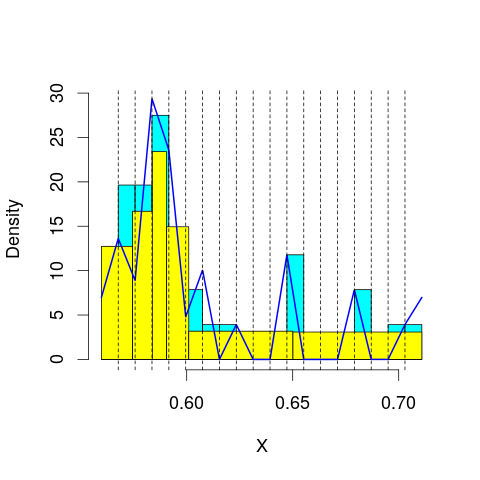

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.04391
mop.approx: Iteration 11. LL = 81.14468
mop.approx: Iteration 21. LL = 81.23035
mop.approx: Iteration 31. LL = 81.23844
mop.approx: Iteration 41. LL = 81.24014
mop.approx: Converged. Iteration 41. LL = 81.24022
[1] "Computing the linear combination of B-splines"


44.8499950014
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.83564
mop.approx: Iteration 11. LL = 78.69854
mop.approx: Iteration 21. LL = 78.80104
mop.approx: Iteration 31. LL = 78.82135
mop.approx: Iteration 41. LL = 78.82776
mop.approx: Iteration 51. LL = 78.83002
mop.approx: Converged. Iteration 56. LL = 78.83062
[1] "Computing the linear combination of B-splines"


40.7075221243
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06425
mop.approx: Iteration 11. LL = 73.52472
mop.approx: Iteration 21. LL = 73.60944
mop.approx: Iteration 31. LL = 73.62779
mop.approx: Iteration 41. LL = 73.63172
mop.approx: Converged. Iteration 46. LL = 73.63236
[1] "Computing the linear combination of B-splines"


33.7764017262
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.72875
mop.approx: Iteration 11. LL = 72.78273
mop.approx: Iteration 21. LL = 72.85148
mop.approx: Iteration 31. LL = 72.86555
mop.approx: Iteration 41. LL = 72.87053
mop.approx: Iteration 51. LL = 72.8725
mop.approx: Converged. Iteration 57. LL = 72.87313
[1] "Computing the linear combination of B-splines"


31.2842969563
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.157025
mop.approx: Iteration 11. LL = 73.25765
mop.approx: Iteration 21. LL = 73.35197
mop.approx: Iteration 31. LL = 73.39146
mop.approx: Iteration 41. LL = 73.41498
mop.approx: Iteration 51. LL = 73.42903
mop.approx: Iteration 61. LL = 73.43733
mop.approx: Iteration 71. LL = 73.44225
mop.approx: Iteration 81. LL = 73.4452
mop.approx: Iteration 91. LL = 73.44702
mop.approx: Iteration 101. LL = 73.44817
mop.approx: Converged. Iteration 107. LL = 73.44874
[1] "Computing the linear combination of B-splines"


30.1258847463
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.157542
mop.approx: Iteration 11. LL = 72.78423
mop.approx: Iteration 21. LL = 72.89981
mop.approx: Iteration 31. LL = 72.92504
mop.approx: Iteration 41. LL = 72.93662
mop.approx: Iteration 51. LL = 72.94353
mop.approx: Iteration 61. LL = 72.94795
mop.approx: Iteration 71. LL = 72.95086
mop.approx: Iteration 81. LL = 72.95281
mop.approx: Iteration 91. LL = 72.95414
mop.approx: Iteration 101. LL = 72.95505
mop.approx: Converged. Iteration 102. LL = 72.9552
[1] "Computing the linear combination of B-splines"


27.87506808
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.602852
mop.approx: Iteration 11. LL = 75.13116
mop.approx: Iteration 21. LL = 75.24886
mop.approx: Iteration 31. LL = 75.27633
mop.approx: Iteration 41. LL = 75.28461
mop.approx: Iteration 51. LL = 75.28721
mop.approx: Converged. Iteration 57. LL = 75.28792
[1] "Computing the linear combination of B-splines"


28.5219937666
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.25355
mop.approx: Iteration 11. LL = 80.90053
mop.approx: Iteration 21. LL = 80.90864
mop.approx: Iteration 31. LL = 80.91423
mop.approx: Iteration 41. LL = 80.91772
mop.approx: Iteration 51. LL = 80.91976
mop.approx: Iteration 61. LL = 80.92089
mop.approx: Converged. Iteration 61. LL = 80.92097
[1] "Computing the linear combination of B-splines"


44.5307464747
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 44.530746474717887)
m reached
('Sum of Probabilities:', 0.9926962371807141)
chosen


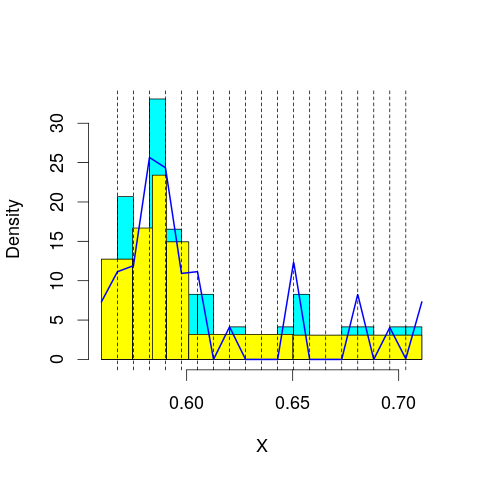

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 60.04391
mop.approx: Iteration 11. LL = 80.25889
mop.approx: Iteration 21. LL = 80.36654
mop.approx: Iteration 31. LL = 80.39412
mop.approx: Iteration 41. LL = 80.4047
mop.approx: Iteration 51. LL = 80.40951
mop.approx: Iteration 61. LL = 80.4119
mop.approx: Iteration 71. LL = 80.41317
mop.approx: Converged. Iteration 73. LL = 80.41342
[1] "Computing the linear combination of B-splines"


42.2903228243
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.83564
mop.approx: Iteration 11. LL = 79.92205
mop.approx: Iteration 21. LL = 79.98877
mop.approx: Iteration 31. LL = 79.99733
mop.approx: Converged. Iteration 40. LL = 79.99891
[1] "Computing the linear combination of B-splines"


40.142951835
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06425
mop.approx: Iteration 11. LL = 72.85068
mop.approx: Iteration 21. LL = 72.946
mop.approx: Iteration 31. LL = 72.97578
mop.approx: Iteration 41. LL = 72.98624
mop.approx: Iteration 51. LL = 72.99014
mop.approx: Iteration 61. LL = 72.99171
mop.approx: Converged. Iteration 65. LL = 72.99212
[1] "Computing the linear combination of B-splines"


31.403290729
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.72875
mop.approx: Iteration 11. LL = 73.70725
mop.approx: Iteration 21. LL = 73.79572
mop.approx: Iteration 31. LL = 73.82137
mop.approx: Iteration 41. LL = 73.83082
mop.approx: Iteration 51. LL = 73.8352
mop.approx: Iteration 61. LL = 73.83764
mop.approx: Iteration 71. LL = 73.83917
mop.approx: Iteration 81. LL = 73.8402
mop.approx: Converged. Iteration 86. LL = 73.84067
[1] "Computing the linear combination of B-splines"


30.5189707347
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.157025
mop.approx: Iteration 11. LL = 72.98278
mop.approx: Iteration 21. LL = 73.10286
mop.approx: Iteration 31. LL = 73.14967
mop.approx: Iteration 41. LL = 73.1733
mop.approx: Iteration 51. LL = 73.18723
mop.approx: Iteration 61. LL = 73.19632
mop.approx: Iteration 71. LL = 73.20266
mop.approx: Iteration 81. LL = 73.20723
mop.approx: Iteration 91. LL = 73.21062
mop.approx: Iteration 101. LL = 73.21315
mop.approx: Iteration 111. LL = 73.21505
mop.approx: Iteration 121. LL = 73.21649
mop.approx: Iteration 131. LL = 73.21758
mop.approx: Converged. Iteration 140. LL = 73.21841
[1] "Computing the linear combination of B-splines"


28.1634883157
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.157542
mop.approx: Iteration 11. LL = 73.59499
mop.approx: Iteration 21. LL = 73.69925
mop.approx: Iteration 31. LL = 73.73685
mop.approx: Iteration 41. LL = 73.7566
mop.approx: Iteration 51. LL = 73.76772
mop.approx: Iteration 61. LL = 73.77413
mop.approx: Iteration 71. LL = 73.77788
mop.approx: Iteration 81. LL = 73.7801
mop.approx: Iteration 91. LL = 73.78144
mop.approx: Converged. Iteration 98. LL = 73.78213
[1] "Computing the linear combination of B-splines"


26.9835815111
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.602852
mop.approx: Iteration 11. LL = 74.49513
mop.approx: Iteration 21. LL = 74.66109
mop.approx: Iteration 31. LL = 74.68891
mop.approx: Iteration 41. LL = 74.69945
mop.approx: Iteration 51. LL = 74.7045
mop.approx: Iteration 61. LL = 74.70716
mop.approx: Iteration 71. LL = 74.70865
mop.approx: Converged. Iteration 78. LL = 74.70937
[1] "Computing the linear combination of B-splines"


26.0129079435
lfps_17
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.00663
mop.approx: Iteration 11. LL = 47.68257
mop.approx: Converged. Iteration 12. LL = 47.68265
[1] "Computing the linear combination of B-splines"


42.4840442264
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 42.484044226421332)
m reached
('Sum of Probabilities:', 0.9946828436552144)
chosen


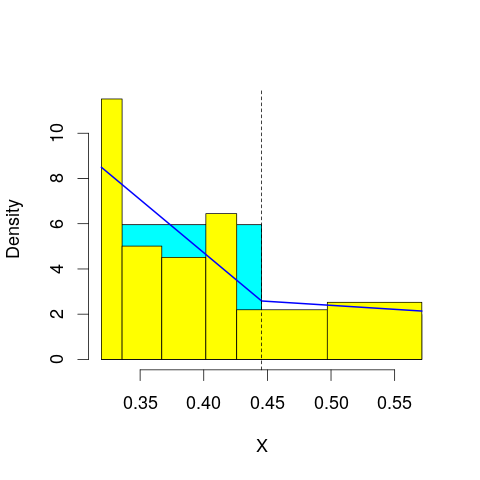

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.88029
mop.approx: Iteration 11. LL = 47.96795
mop.approx: Iteration 21. LL = 48.04577
mop.approx: Iteration 31. LL = 48.06664
mop.approx: Iteration 41. LL = 48.07495
mop.approx: Iteration 51. LL = 48.07908
mop.approx: Iteration 61. LL = 48.08143
mop.approx: Iteration 71. LL = 48.08291
mop.approx: Iteration 81. LL = 48.08389
mop.approx: Iteration 91. LL = 48.08459
mop.approx: Converged. Iteration 98. LL = 48.08501
[1] "Computing the linear combination of B-splines"


41.1535404559
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.75445
mop.approx: Iteration 11. LL = 47.87347
mop.approx: Iteration 21. LL = 47.9187
mop.approx: Iteration 31. LL = 47.93977
mop.approx: Iteration 41. LL = 47.95167
mop.approx: Iteration 51. LL = 47.95851
mop.approx: Iteration 61. LL = 47.96247
mop.approx: Iteration 71. LL = 47.96479
mop.approx: Iteration 81. LL = 47.96616
mop.approx: Iteration 91. LL = 47.96697
mop.approx: Converged. Iteration 96. LL = 47.96729
[1] "Computing the linear combination of B-splines"


39.3029468617
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.69719
mop.approx: Iteration 11. LL = 38.52856
mop.approx: Converged. Iteration 20. LL = 38.54959
[1] "Computing the linear combination of B-splines"


28.1523848597
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.129662
mop.approx: Iteration 11. LL = 36.40501
mop.approx: Iteration 21. LL = 36.53517
mop.approx: Iteration 31. LL = 36.53919
mop.approx: Converged. Iteration 33. LL = 36.53931
[1] "Computing the linear combination of B-splines"


24.4092313088
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.133392
mop.approx: Iteration 11. LL = 37.13221
mop.approx: Iteration 21. LL = 37.23824
mop.approx: Iteration 31. LL = 37.24146
mop.approx: Converged. Iteration 33. LL = 37.24159
[1] "Computing the linear combination of B-splines"


23.3786496289
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.581241
mop.approx: Iteration 11. LL = 35.27955
mop.approx: Iteration 21. LL = 35.46911
mop.approx: Iteration 31. LL = 35.48657
mop.approx: Iteration 41. LL = 35.48965
mop.approx: Converged. Iteration 49. LL = 35.49027
[1] "Computing the linear combination of B-splines"


19.8944561505
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.615707
mop.approx: Iteration 11. LL = 35.75614
mop.approx: Iteration 21. LL = 36.01911
mop.approx: Iteration 31. LL = 36.04927
mop.approx: Iteration 41. LL = 36.05847
mop.approx: Iteration 51. LL = 36.06232
mop.approx: Iteration 61. LL = 36.06422
mop.approx: Iteration 71. LL = 36.06528
mop.approx: Iteration 81. LL = 36.06591
mop.approx: Converged. Iteration 88. LL = 36.06625
[1] "Computing the linear combination of B-splines"


18.7375672467
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.00663
mop.approx: Iteration 11. LL = 48.42776
mop.approx: Converged. Iteration 16. LL = 48.42913
[1] "Computing the linear combination of B-splines"


41.497656726
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 41.497656725977571)
m reached
('Sum of Probabilities:', 0.994515933185669)
chosen


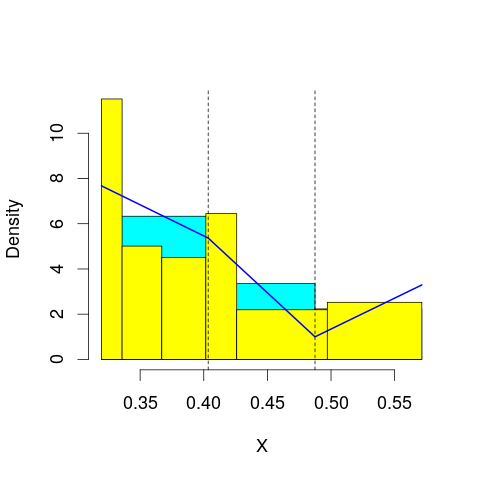

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.88029
mop.approx: Iteration 11. LL = 48.14575
mop.approx: Iteration 21. LL = 48.17575
mop.approx: Iteration 31. LL = 48.18355
mop.approx: Iteration 41. LL = 48.18638
mop.approx: Iteration 51. LL = 48.18764
mop.approx: Converged. Iteration 60. LL = 48.18828
[1] "Computing the linear combination of B-splines"


39.5239449789
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.75445
mop.approx: Iteration 11. LL = 48.32028
mop.approx: Iteration 21. LL = 48.44063
mop.approx: Iteration 31. LL = 48.49308
mop.approx: Iteration 41. LL = 48.52017
mop.approx: Iteration 51. LL = 48.53507
mop.approx: Iteration 61. LL = 48.5436
mop.approx: Iteration 71. LL = 48.54861
mop.approx: Iteration 81. LL = 48.5516
mop.approx: Iteration 91. LL = 48.55341
mop.approx: Iteration 101. LL = 48.5545
mop.approx: Iteration 111. LL = 48.55517
mop.approx: Converged. Iteration 112. LL = 48.55527
[1] "Computing the linear combination of B-splines"


38.1580621216
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.69719
mop.approx: Iteration 11. LL = 38.52201
mop.approx: Converged. Iteration 13. LL = 38.52234
[1] "Computing the linear combination of B-splines"


26.3922610676
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.129662
mop.approx: Iteration 11. LL = 38.88994
mop.approx: Iteration 21. LL = 39.10064
mop.approx: Iteration 31. LL = 39.11301
mop.approx: Converged. Iteration 39. LL = 39.11394
[1] "Computing the linear combination of B-splines"


25.2509987957
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.133392
mop.approx: Iteration 11. LL = 37.41515
mop.approx: Iteration 21. LL = 37.54122
mop.approx: Iteration 31. LL = 37.57107
mop.approx: Iteration 41. LL = 37.57929
mop.approx: Iteration 51. LL = 37.5817
mop.approx: Iteration 61. LL = 37.58242
mop.approx: Converged. Iteration 61. LL = 37.58245
[1] "Computing the linear combination of B-splines"


21.986640765
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.581241
mop.approx: Iteration 11. LL = 38.10439
mop.approx: Iteration 21. LL = 38.33284
mop.approx: Iteration 31. LL = 38.33827
mop.approx: Converged. Iteration 32. LL = 38.33834
[1] "Computing the linear combination of B-splines"


21.0096580764
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.615707
mop.approx: Iteration 11. LL = 36.45293
mop.approx: Iteration 21. LL = 36.63014
mop.approx: Iteration 31. LL = 36.64077
mop.approx: Converged. Iteration 36. LL = 36.64119
[1] "Computing the linear combination of B-splines"


17.5796434326
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.00663
mop.approx: Converged. Iteration 9. LL = 48.13073
[1] "Computing the linear combination of B-splines"


39.4663856736
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 39.466385673591077)
m reached
('Sum of Probabilities:', 0.9939672411915028)
chosen


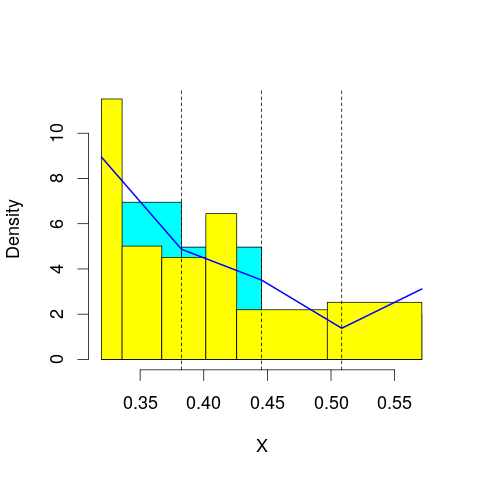

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.88029
mop.approx: Iteration 11. LL = 49.03513
mop.approx: Iteration 21. LL = 49.10244
mop.approx: Iteration 31. LL = 49.11683
mop.approx: Iteration 41. LL = 49.12092
mop.approx: Iteration 51. LL = 49.12227
mop.approx: Converged. Iteration 56. LL = 49.12262
[1] "Computing the linear combination of B-splines"


38.7254076179
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.75445
mop.approx: Iteration 11. LL = 48.34769
mop.approx: Iteration 21. LL = 48.39193
mop.approx: Iteration 31. LL = 48.40085
mop.approx: Iteration 41. LL = 48.40352
mop.approx: Iteration 51. LL = 48.4046
mop.approx: Converged. Iteration 57. LL = 48.40499
[1] "Computing the linear combination of B-splines"


36.2749156664
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.69719
mop.approx: Iteration 11. LL = 38.97988
mop.approx: Iteration 21. LL = 39.02228
mop.approx: Iteration 31. LL = 39.03068
mop.approx: Iteration 41. LL = 39.03276
mop.approx: Converged. Iteration 49. LL = 39.03331
[1] "Computing the linear combination of B-splines"


25.1703704447
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.129662
mop.approx: Iteration 11. LL = 40.05185
mop.approx: Iteration 21. LL = 40.13878
mop.approx: Iteration 31. LL = 40.14501
mop.approx: Converged. Iteration 39. LL = 40.14582
[1] "Computing the linear combination of B-splines"


24.5500133594
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.133392
mop.approx: Iteration 11. LL = 38.28062
mop.approx: Iteration 21. LL = 38.43516
mop.approx: Iteration 31. LL = 38.49108
mop.approx: Iteration 41. LL = 38.52304
mop.approx: Iteration 51. LL = 38.54312
mop.approx: Iteration 61. LL = 38.55621
mop.approx: Iteration 71. LL = 38.56502
mop.approx: Iteration 81. LL = 38.57113
mop.approx: Iteration 91. LL = 38.57547
mop.approx: Iteration 101. LL = 38.57862
mop.approx: Iteration 111. LL = 38.58095
mop.approx: Iteration 121. LL = 38.58268
mop.approx: Iteration 131. LL = 38.58399
mop.approx: Iteration 141. LL = 38.58499
mop.approx: Iteration 151. LL = 38.58575
mop.approx: Iteration 161. LL = 38.58633
mop.approx: Iteration 171. LL = 38.58678
mop.approx: Converged. Iteration 171. LL = 38.58682
[1] "Computing the linear combination of B-splines"


21.258138154
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.581241
mop.approx: Iteration 11. LL = 38.3574
mop.approx: Converged. Iteration 20. LL = 38.36872
[1] "Computing the linear combination of B-splines"


19.3071694086
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.615707
mop.approx: Iteration 11. LL = 38.19165
mop.approx: Iteration 21. LL = 38.58576
mop.approx: Iteration 31. LL = 38.63995
mop.approx: Iteration 41. LL = 38.64799
mop.approx: Iteration 51. LL = 38.64932
mop.approx: Converged. Iteration 53. LL = 38.64944
[1] "Computing the linear combination of B-splines"


17.8550227149
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.00663
mop.approx: Iteration 11. LL = 49.58632
mop.approx: Converged. Iteration 13. LL = 49.58651
[1] "Computing the linear combination of B-splines"


39.1893027142
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 39.189302714180577)
m reached
('Sum of Probabilities:', 0.9927016854734905)
chosen


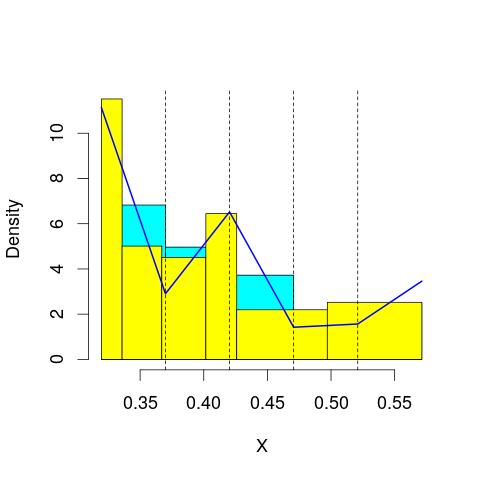

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.88029
mop.approx: Iteration 11. LL = 48.87429
mop.approx: Iteration 21. LL = 48.908
mop.approx: Iteration 31. LL = 48.91288
mop.approx: Converged. Iteration 40. LL = 48.91386
[1] "Computing the linear combination of B-splines"


36.783779638
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.75445
mop.approx: Iteration 11. LL = 48.91871
mop.approx: Iteration 21. LL = 49.08434
mop.approx: Iteration 31. LL = 49.14075
mop.approx: Iteration 41. LL = 49.16068
mop.approx: Iteration 51. LL = 49.16789
mop.approx: Iteration 61. LL = 49.1706
mop.approx: Iteration 71. LL = 49.1717
mop.approx: Converged. Iteration 76. LL = 49.17204
[1] "Computing the linear combination of B-splines"


35.3090945236
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.69719
mop.approx: Iteration 11. LL = 39.98217
mop.approx: Iteration 21. LL = 40.23684
mop.approx: Iteration 31. LL = 40.31019
mop.approx: Iteration 41. LL = 40.33702
mop.approx: Iteration 51. LL = 40.34799
mop.approx: Iteration 61. LL = 40.35269
mop.approx: Iteration 71. LL = 40.35474
mop.approx: Iteration 81. LL = 40.35565
mop.approx: Converged. Iteration 86. LL = 40.35593
[1] "Computing the linear combination of B-splines"


24.7601156404
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.129662
mop.approx: Iteration 11. LL = 40.32014
mop.approx: Iteration 21. LL = 40.37922
mop.approx: Iteration 31. LL = 40.39597
mop.approx: Iteration 41. LL = 40.40292
mop.approx: Iteration 51. LL = 40.40642
mop.approx: Iteration 61. LL = 40.40843
mop.approx: Iteration 71. LL = 40.40969
mop.approx: Iteration 81. LL = 40.41053
mop.approx: Iteration 91. LL = 40.41112
mop.approx: Converged. Iteration 98. LL = 40.41148
[1] "Computing the linear combination of B-splines"


23.0827975357
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.133392
mop.approx: Iteration 11. LL = 40.48423
mop.approx: Iteration 21. LL = 40.98046
mop.approx: Iteration 31. LL = 41.05081
mop.approx: Iteration 41. LL = 41.07054
mop.approx: Iteration 51. LL = 41.0792
mop.approx: Iteration 61. LL = 41.08377
mop.approx: Iteration 71. LL = 41.08642
mop.approx: Iteration 81. LL = 41.08803
mop.approx: Iteration 91. LL = 41.08904
mop.approx: Iteration 101. LL = 41.08969
mop.approx: Converged. Iteration 106. LL = 41.08997
[1] "Computing the linear combination of B-splines"


22.0284180217
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.581241
mop.approx: Iteration 11. LL = 38.62421
mop.approx: Iteration 21. LL = 38.7094
mop.approx: Iteration 31. LL = 38.74746
mop.approx: Iteration 41. LL = 38.7667
mop.approx: Iteration 51. LL = 38.77746
mop.approx: Iteration 61. LL = 38.784
mop.approx: Iteration 71. LL = 38.78824
mop.approx: Iteration 81. LL = 38.79115
mop.approx: Iteration 91. LL = 38.79322
mop.approx: Iteration 101. LL = 38.79475
mop.approx: Iteration 111. LL = 38.7959
mop.approx: Iteration 121. LL = 38.7968
mop.approx: Iteration 131. LL = 38.79751
mop.approx: Iteration 141. LL = 38.79808
mop.approx: Iteration 151. LL = 38.79854
mop.approx: Converged. Iteration 155. LL = 38.79874
[1] "Computing the linear combination of B-splines"


18.004320432
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.615707
mop.approx: Iteration 11. LL = 39.2296
mop.approx: Iteration 21. LL = 39.40345
mop.approx: Iteration 31. LL = 39.42827
mop.approx: Iteration 41. LL = 39.43543
mop.approx: Iteration 51. LL = 39.43795
mop.approx: Iteration 61. LL = 39.43892
mop.approx: Converged. Iteration 66. LL = 39.4392
[1] "Computing the linear combination of B-splines"


16.9119145034
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.00663
mop.approx: Iteration 11. LL = 49.68038
mop.approx: Converged. Iteration 15. LL = 49.68105
[1] "Computing the linear combination of B-splines"


37.5509704262
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 37.550970426209403)
m reached
('Sum of Probabilities:', 0.9921345548443591)
chosen


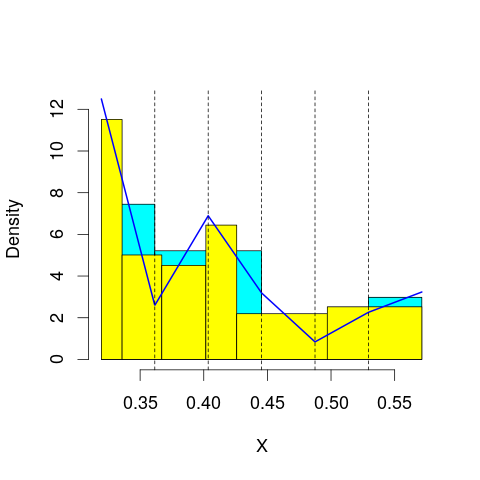

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.88029
mop.approx: Iteration 11. LL = 49.50937
mop.approx: Iteration 21. LL = 49.5365
mop.approx: Iteration 31. LL = 49.54042
mop.approx: Converged. Iteration 40. LL = 49.54132
[1] "Computing the linear combination of B-splines"


35.6783714621
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.75445
mop.approx: Iteration 11. LL = 49.18998
mop.approx: Iteration 21. LL = 49.34052
mop.approx: Iteration 31. LL = 49.38265
mop.approx: Iteration 41. LL = 49.39922
mop.approx: Iteration 51. LL = 49.40703
mop.approx: Iteration 61. LL = 49.41116
mop.approx: Iteration 71. LL = 49.41356
mop.approx: Iteration 81. LL = 49.41504
mop.approx: Iteration 91. LL = 49.41603
mop.approx: Iteration 101. LL = 49.4167
mop.approx: Converged. Iteration 105. LL = 49.41696
[1] "Computing the linear combination of B-splines"


33.8211517882
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.69719
mop.approx: Iteration 11. LL = 40.64656
mop.approx: Iteration 21. LL = 40.8651
mop.approx: Iteration 31. LL = 40.91818
mop.approx: Iteration 41. LL = 40.93799
mop.approx: Iteration 51. LL = 40.9472
mop.approx: Iteration 61. LL = 40.95211
mop.approx: Iteration 71. LL = 40.955
mop.approx: Iteration 81. LL = 40.95682
mop.approx: Iteration 91. LL = 40.95805
mop.approx: Iteration 101. LL = 40.9589
mop.approx: Iteration 111. LL = 40.95951
mop.approx: Converged. Iteration 119. LL = 40.95993
[1] "Computing the linear combination of B-splines"


23.6312485966
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.129662
mop.approx: Iteration 11. LL = 40.43888
mop.approx: Iteration 21. LL = 40.46252
mop.approx: Iteration 31. LL = 40.4689
mop.approx: Iteration 41. LL = 40.47151
mop.approx: Iteration 51. LL = 40.47265
mop.approx: Converged. Iteration 59. LL = 40.47314
[1] "Computing the linear combination of B-splines"


21.4115914565
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.133392
mop.approx: Iteration 11. LL = 41.10372
mop.approx: Iteration 21. LL = 41.2444
mop.approx: Iteration 31. LL = 41.26517
mop.approx: Iteration 41. LL = 41.27404
mop.approx: Iteration 51. LL = 41.27848
mop.approx: Iteration 61. LL = 41.28087
mop.approx: Iteration 71. LL = 41.28221
mop.approx: Iteration 81. LL = 41.28298
mop.approx: Converged. Iteration 87. LL = 41.28331
[1] "Computing the linear combination of B-splines"


20.48889819
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.581241
mop.approx: Iteration 11. LL = 40.00744
mop.approx: Iteration 21. LL = 40.572
mop.approx: Iteration 31. LL = 40.75687
mop.approx: Iteration 41. LL = 40.8169
mop.approx: Iteration 51. LL = 40.83676
mop.approx: Iteration 61. LL = 40.84381
mop.approx: Iteration 71. LL = 40.84658
mop.approx: Iteration 81. LL = 40.84779
mop.approx: Iteration 91. LL = 40.84837
mop.approx: Converged. Iteration 91. LL = 40.84841
[1] "Computing the linear combination of B-splines"


18.3211220886
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.615707
mop.approx: Iteration 11. LL = 39.49132
mop.approx: Iteration 21. LL = 39.58314
mop.approx: Iteration 31. LL = 39.61567
mop.approx: Iteration 41. LL = 39.63219
mop.approx: Iteration 51. LL = 39.64153
mop.approx: Iteration 61. LL = 39.64722
mop.approx: Iteration 71. LL = 39.65089
mop.approx: Iteration 81. LL = 39.65335
mop.approx: Iteration 91. LL = 39.65504
mop.approx: Iteration 101. LL = 39.65623
mop.approx: Iteration 111. LL = 39.65708
mop.approx: Iteration 121. LL = 39.6577
mop.approx: Converged. Iteration 130. LL = 39.65815
[1] "Computing the linear combination of B-splines"


15.3979948394
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.00663
mop.approx: Iteration 11. LL = 49.94123
mop.approx: Converged. Iteration 13. LL = 49.94151
[1] "Computing the linear combination of B-splines"


36.0785709135
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 36.078570913538783)
m reached
('Sum of Probabilities:', 0.9915450652575636)
chosen


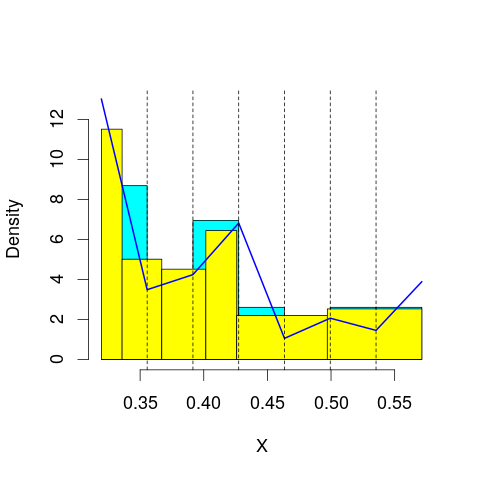

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.88029
mop.approx: Iteration 11. LL = 49.65384
mop.approx: Iteration 21. LL = 49.67869
mop.approx: Iteration 31. LL = 49.68306
mop.approx: Iteration 41. LL = 49.6847
mop.approx: Iteration 51. LL = 49.68552
mop.approx: Converged. Iteration 54. LL = 49.68573
[1] "Computing the linear combination of B-splines"


34.0899165119
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.75445
mop.approx: Iteration 11. LL = 49.46587
mop.approx: Iteration 21. LL = 49.52658
mop.approx: Iteration 31. LL = 49.54245
mop.approx: Iteration 41. LL = 49.5492
mop.approx: Iteration 51. LL = 49.55275
mop.approx: Iteration 61. LL = 49.55484
mop.approx: Iteration 71. LL = 49.55618
mop.approx: Iteration 81. LL = 49.55709
mop.approx: Iteration 91. LL = 49.55774
mop.approx: Converged. Iteration 95. LL = 49.55799
[1] "Computing the linear combination of B-splines"


32.2293135696
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.69719
mop.approx: Iteration 11. LL = 41.37091
mop.approx: Iteration 21. LL = 41.67513
mop.approx: Iteration 31. LL = 41.72774
mop.approx: Iteration 41. LL = 41.73699
mop.approx: Iteration 51. LL = 41.73871
mop.approx: Converged. Iteration 54. LL = 41.73891
[1] "Computing the linear combination of B-splines"


22.6773615442
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.129662
mop.approx: Iteration 11. LL = 40.64873
mop.approx: Iteration 21. LL = 40.71546
mop.approx: Iteration 31. LL = 40.73414
mop.approx: Iteration 41. LL = 40.73964
mop.approx: Iteration 51. LL = 40.74126
mop.approx: Converged. Iteration 57. LL = 40.74165
[1] "Computing the linear combination of B-splines"


19.9472361745
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.133392
mop.approx: Iteration 11. LL = 41.26675
mop.approx: Iteration 21. LL = 41.31207
mop.approx: Iteration 31. LL = 41.32216
mop.approx: Iteration 41. LL = 41.32759
mop.approx: Iteration 51. LL = 41.33078
mop.approx: Iteration 61. LL = 41.33278
mop.approx: Iteration 71. LL = 41.3341
mop.approx: Iteration 81. LL = 41.33502
mop.approx: Iteration 91. LL = 41.33569
mop.approx: Iteration 101. LL = 41.33618
mop.approx: Converged. Iteration 102. LL = 41.33626
[1] "Computing the linear combination of B-splines"


18.8089788189
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.581241
mop.approx: Iteration 11. LL = 40.84134
mop.approx: Iteration 21. LL = 41.28775
mop.approx: Iteration 31. LL = 41.35546
mop.approx: Iteration 41. LL = 41.36863
mop.approx: Iteration 51. LL = 41.3724
mop.approx: Iteration 61. LL = 41.37384
mop.approx: Iteration 71. LL = 41.37446
mop.approx: Converged. Iteration 71. LL = 41.3745
[1] "Computing the linear combination of B-splines"


17.1143525479
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.615707
mop.approx: Iteration 11. LL = 40.04829
mop.approx: Iteration 21. LL = 40.24356
mop.approx: Iteration 31. LL = 40.32121
mop.approx: Iteration 41. LL = 40.35656
mop.approx: Iteration 51. LL = 40.37232
mop.approx: Iteration 61. LL = 40.37917
mop.approx: Iteration 71. LL = 40.38212
mop.approx: Iteration 81. LL = 40.38337
mop.approx: Converged. Iteration 89. LL = 40.38387
[1] "Computing the linear combination of B-splines"


14.3908549607
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.00663
mop.approx: Iteration 11. LL = 49.89937
mop.approx: Converged. Iteration 13. LL = 49.8996
[1] "Computing the linear combination of B-splines"


34.3037842036
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 34.303784203553704)
m reached
('Sum of Probabilities:', 0.9914814813959182)
chosen


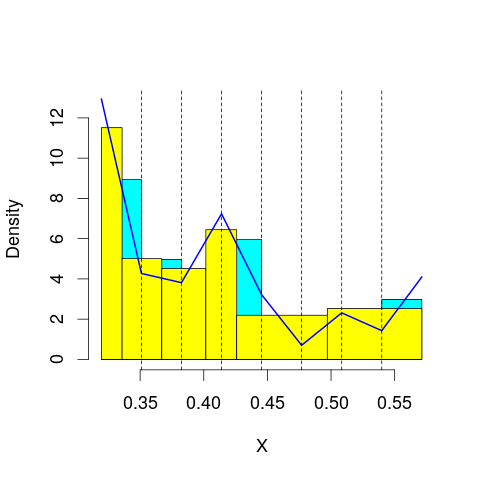

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.88029
mop.approx: Iteration 11. LL = 49.53345
mop.approx: Iteration 21. LL = 49.53964
mop.approx: Converged. Iteration 25. LL = 49.54003
[1] "Computing the linear combination of B-splines"


32.2113473486
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.75445
mop.approx: Iteration 11. LL = 49.60681
mop.approx: Iteration 21. LL = 49.62644
mop.approx: Iteration 31. LL = 49.63484
mop.approx: Iteration 41. LL = 49.63929
mop.approx: Iteration 51. LL = 49.64182
mop.approx: Iteration 61. LL = 49.64334
mop.approx: Iteration 71. LL = 49.6443
mop.approx: Iteration 81. LL = 49.64494
mop.approx: Converged. Iteration 82. LL = 49.64504
[1] "Computing the linear combination of B-splines"


30.5834900569
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.69719
mop.approx: Iteration 11. LL = 42.66084
mop.approx: Iteration 21. LL = 42.95218
mop.approx: Iteration 31. LL = 42.98924
mop.approx: Iteration 41. LL = 43.00094
mop.approx: Iteration 51. LL = 43.00669
mop.approx: Iteration 61. LL = 43.01006
mop.approx: Iteration 71. LL = 43.01224
mop.approx: Iteration 81. LL = 43.01373
mop.approx: Iteration 91. LL = 43.01479
mop.approx: Iteration 101. LL = 43.01556
mop.approx: Iteration 111. LL = 43.01614
mop.approx: Converged. Iteration 117. LL = 43.01647
[1] "Computing the linear combination of B-splines"


22.2220523928
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.129662
mop.approx: Iteration 11. LL = 40.81914
mop.approx: Iteration 21. LL = 40.86506
mop.approx: Iteration 31. LL = 40.87495
mop.approx: Iteration 41. LL = 40.87727
mop.approx: Converged. Iteration 47. LL = 40.87772
[1] "Computing the linear combination of B-splines"


18.3504331381
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.133392
mop.approx: Iteration 11. LL = 41.56398
mop.approx: Iteration 21. LL = 41.67031
mop.approx: Iteration 31. LL = 41.6998
mop.approx: Iteration 41. LL = 41.70861
mop.approx: Iteration 51. LL = 41.71116
mop.approx: Converged. Iteration 60. LL = 41.71189
[1] "Computing the linear combination of B-splines"


17.4517349836
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.581241
mop.approx: Iteration 11. LL = 41.36208
mop.approx: Iteration 21. LL = 41.63618
mop.approx: Iteration 31. LL = 41.6747
mop.approx: Iteration 41. LL = 41.68428
mop.approx: Iteration 51. LL = 41.68694
mop.approx: Converged. Iteration 60. LL = 41.68767
[1] "Computing the linear combination of B-splines"


15.6946544023
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.615707
mop.approx: Iteration 11. LL = 40.39368
mop.approx: Iteration 21. LL = 40.62435
mop.approx: Iteration 31. LL = 40.7001
mop.approx: Iteration 41. LL = 40.73013
mop.approx: Iteration 51. LL = 40.74391
mop.approx: Iteration 61. LL = 40.75097
mop.approx: Iteration 71. LL = 40.75493
mop.approx: Iteration 81. LL = 40.7573
mop.approx: Iteration 91. LL = 40.75882
mop.approx: Iteration 101. LL = 40.75983
mop.approx: Iteration 111. LL = 40.76054
mop.approx: Iteration 121. LL = 40.76104
mop.approx: Converged. Iteration 123. LL = 40.76117
[1] "Computing the linear combination of B-splines"


13.0352806361
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.00663
mop.approx: Iteration 11. LL = 49.66972
mop.approx: Iteration 21. LL = 49.69905
mop.approx: Iteration 31. LL = 49.70677
mop.approx: Iteration 41. LL = 49.70917
mop.approx: Converged. Iteration 50. LL = 49.70996
[1] "Computing the linear combination of B-splines"


32.3812769229
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 32.381276922948445)
m reached
('Sum of Probabilities:', 0.9917260771207916)
chosen


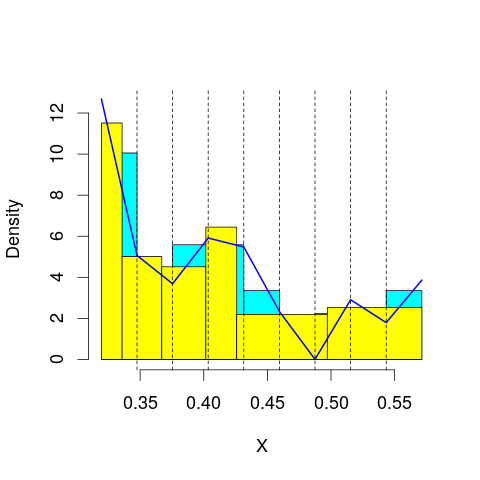

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.88029
mop.approx: Iteration 11. LL = 49.8358
mop.approx: Iteration 21. LL = 49.84768
mop.approx: Iteration 31. LL = 49.84947
mop.approx: Converged. Iteration 32. LL = 49.84958
[1] "Computing the linear combination of B-splines"


30.7880330432
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.75445
mop.approx: Iteration 11. LL = 49.57928
mop.approx: Iteration 21. LL = 49.59754
mop.approx: Iteration 31. LL = 49.60437
mop.approx: Iteration 41. LL = 49.60776
mop.approx: Iteration 51. LL = 49.60974
mop.approx: Iteration 61. LL = 49.61102
mop.approx: Iteration 71. LL = 49.61193
mop.approx: Iteration 81. LL = 49.6126
mop.approx: Converged. Iteration 88. LL = 49.61303
[1] "Computing the linear combination of B-splines"


28.8186129967
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.69719
mop.approx: Iteration 11. LL = 43.57919
mop.approx: Iteration 21. LL = 43.75441
mop.approx: Iteration 31. LL = 43.78236
mop.approx: Iteration 41. LL = 43.79177
mop.approx: Iteration 51. LL = 43.79534
mop.approx: Iteration 61. LL = 43.79674
mop.approx: Converged. Iteration 68. LL = 43.79722
[1] "Computing the linear combination of B-splines"


21.2699401868
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.129662
mop.approx: Iteration 11. LL = 41.26312
mop.approx: Iteration 21. LL = 41.42847
mop.approx: Iteration 31. LL = 41.48182
mop.approx: Iteration 41. LL = 41.50384
mop.approx: Iteration 51. LL = 41.51452
mop.approx: Iteration 61. LL = 41.52035
mop.approx: Iteration 71. LL = 41.52385
mop.approx: Iteration 81. LL = 41.52609
mop.approx: Iteration 91. LL = 41.52761
mop.approx: Iteration 101. LL = 41.52869
mop.approx: Iteration 111. LL = 41.52948
mop.approx: Iteration 121. LL = 41.53008
mop.approx: Iteration 131. LL = 41.53054
mop.approx: Converged. Iteration 131. LL = 41.53058
[1] "Computing the linear combination of B-splines"


17.2704323506
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.133392
mop.approx: Iteration 11. LL = 41.78936
mop.approx: Iteration 21. LL = 41.87726
mop.approx: Iteration 31. LL = 41.89784
mop.approx: Iteration 41. LL = 41.90434
mop.approx: Iteration 51. LL = 41.90682
mop.approx: Iteration 61. LL = 41.9079
mop.approx: Converged. Iteration 69. LL = 41.90839
[1] "Computing the linear combination of B-splines"


15.9153710072
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.581241
mop.approx: Iteration 11. LL = 41.99929
mop.approx: Iteration 21. LL = 42.28657
mop.approx: Iteration 31. LL = 42.34744
mop.approx: Iteration 41. LL = 42.36966
mop.approx: Iteration 51. LL = 42.37912
mop.approx: Iteration 61. LL = 42.38353
mop.approx: Iteration 71. LL = 42.38578
mop.approx: Iteration 81. LL = 42.38701
mop.approx: Iteration 91. LL = 42.38774
mop.approx: Converged. Iteration 97. LL = 42.38808
[1] "Computing the linear combination of B-splines"


14.6621920167
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.615707
mop.approx: Iteration 11. LL = 40.78547
mop.approx: Iteration 21. LL = 41.09257
mop.approx: Iteration 31. LL = 41.20942
mop.approx: Iteration 41. LL = 41.25979
mop.approx: Iteration 51. LL = 41.28275
mop.approx: Iteration 61. LL = 41.29361
mop.approx: Iteration 71. LL = 41.29881
mop.approx: Iteration 81. LL = 41.3013
mop.approx: Iteration 91. LL = 41.30249
mop.approx: Converged. Iteration 100. LL = 41.30306
[1] "Computing the linear combination of B-splines"


11.8443031234
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.00663
mop.approx: Iteration 11. LL = 50.04157
mop.approx: Converged. Iteration 16. LL = 50.04247
[1] "Computing the linear combination of B-splines"


30.9809237034
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 30.980923703373968)
m reached
('Sum of Probabilities:', 0.992430669332965)
chosen


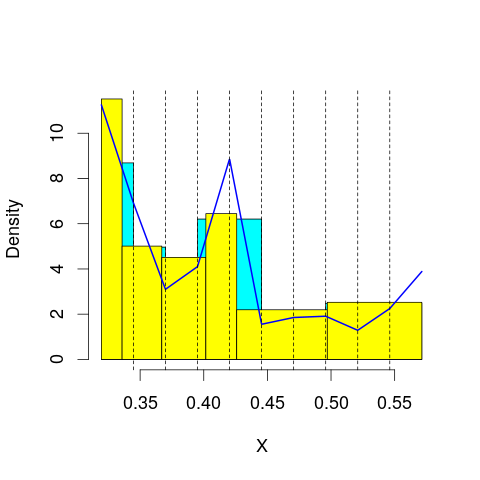

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.88029
mop.approx: Iteration 11. LL = 50.03165
mop.approx: Iteration 21. LL = 50.06956
mop.approx: Iteration 31. LL = 50.07619
mop.approx: Iteration 41. LL = 50.07759
mop.approx: Converged. Iteration 42. LL = 50.07769
[1] "Computing the linear combination of B-splines"


29.2832758647
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.75445
mop.approx: Iteration 11. LL = 49.66775
mop.approx: Iteration 21. LL = 49.69182
mop.approx: Iteration 31. LL = 49.70088
mop.approx: Iteration 41. LL = 49.70469
mop.approx: Iteration 51. LL = 49.70642
mop.approx: Iteration 61. LL = 49.70727
mop.approx: Converged. Iteration 64. LL = 49.70749
[1] "Computing the linear combination of B-splines"


27.1802016916
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.69719
mop.approx: Iteration 11. LL = 43.98707
mop.approx: Iteration 21. LL = 44.08885
mop.approx: Iteration 31. LL = 44.11303
mop.approx: Iteration 41. LL = 44.12311
mop.approx: Iteration 51. LL = 44.12801
mop.approx: Iteration 61. LL = 44.13063
mop.approx: Iteration 71. LL = 44.13215
mop.approx: Iteration 81. LL = 44.13308
mop.approx: Iteration 91. LL = 44.13368
mop.approx: Converged. Iteration 93. LL = 44.13381
[1] "Computing the linear combination of B-splines"


19.8736612039
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.129662
mop.approx: Iteration 11. LL = 41.97207
mop.approx: Iteration 21. LL = 42.27323
mop.approx: Iteration 31. LL = 42.3658
mop.approx: Iteration 41. LL = 42.40072
mop.approx: Iteration 51. LL = 42.41503
mop.approx: Iteration 61. LL = 42.42135
mop.approx: Iteration 71. LL = 42.42433
mop.approx: Iteration 81. LL = 42.4258
mop.approx: Iteration 91. LL = 42.42656
mop.approx: Converged. Iteration 94. LL = 42.42674
[1] "Computing the linear combination of B-splines"


16.4337228539
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.133392
mop.approx: Iteration 11. LL = 41.86928
mop.approx: Iteration 21. LL = 41.90261
mop.approx: Iteration 31. LL = 41.90697
mop.approx: Iteration 41. LL = 41.90859
mop.approx: Iteration 51. LL = 41.90959
mop.approx: Iteration 61. LL = 41.91029
mop.approx: Iteration 71. LL = 41.91078
mop.approx: Converged. Iteration 71. LL = 41.91082
[1] "Computing the linear combination of B-splines"


14.1849318082
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.581241
mop.approx: Iteration 11. LL = 42.47511
mop.approx: Iteration 21. LL = 42.67446
mop.approx: Iteration 31. LL = 42.72342
mop.approx: Iteration 41. LL = 42.74388
mop.approx: Iteration 51. LL = 42.75411
mop.approx: Iteration 61. LL = 42.75983
mop.approx: Iteration 71. LL = 42.76328
mop.approx: Iteration 81. LL = 42.76548
mop.approx: Iteration 91. LL = 42.76693
mop.approx: Iteration 101. LL = 42.76792
mop.approx: Iteration 111. LL = 42.76862
mop.approx: Iteration 121. LL = 42.76912
mop.approx: Converged. Iteration 121. LL = 42.76916
[1] "Computing the linear combination of B-splines"


13.3104086692
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.615707
mop.approx: Iteration 11. LL = 41.5234
mop.approx: Iteration 21. LL = 42.10903
mop.approx: Iteration 31. LL = 42.28386
mop.approx: Iteration 41. LL = 42.34014
mop.approx: Iteration 51. LL = 42.36145
mop.approx: Iteration 61. LL = 42.37105
mop.approx: Iteration 71. LL = 42.37606
mop.approx: Iteration 81. LL = 42.37898
mop.approx: Iteration 91. LL = 42.38081
mop.approx: Iteration 101. LL = 42.38203
mop.approx: Iteration 111. LL = 42.38286
mop.approx: Iteration 121. LL = 42.38344
mop.approx: Converged. Iteration 125. LL = 42.38366
[1] "Computing the linear combination of B-splines"


11.1920390614
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.00663
mop.approx: Iteration 11. LL = 50.48627
mop.approx: Iteration 21. LL = 50.49256
mop.approx: Converged. Iteration 22. LL = 50.49267
[1] "Computing the linear combination of B-splines"


29.6982529856
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 29.698252985621394)
m reached
('Sum of Probabilities:', 0.992301563232109)
chosen


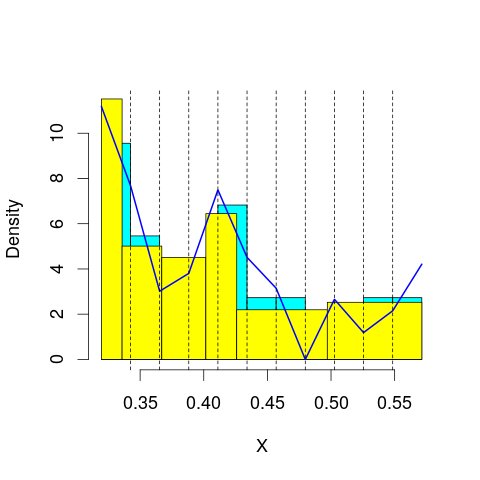

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.88029
mop.approx: Iteration 11. LL = 50.18726
mop.approx: Iteration 21. LL = 50.25305
mop.approx: Iteration 31. LL = 50.26359
mop.approx: Iteration 41. LL = 50.26531
mop.approx: Converged. Iteration 42. LL = 50.26541
[1] "Computing the linear combination of B-splines"


27.7381309824
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.75445
mop.approx: Iteration 11. LL = 49.78147
mop.approx: Iteration 21. LL = 49.84317
mop.approx: Iteration 31. LL = 49.86426
mop.approx: Iteration 41. LL = 49.87293
mop.approx: Iteration 51. LL = 49.87711
mop.approx: Iteration 61. LL = 49.87942
mop.approx: Iteration 71. LL = 49.88083
mop.approx: Iteration 81. LL = 49.88174
mop.approx: Iteration 91. LL = 49.88235
mop.approx: Converged. Iteration 91. LL = 49.8824
[1] "Computing the linear combination of B-splines"


25.622253038
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.69719
mop.approx: Iteration 11. LL = 44.28303
mop.approx: Iteration 21. LL = 44.31975
mop.approx: Iteration 31. LL = 44.32882
mop.approx: Iteration 41. LL = 44.33348
mop.approx: Iteration 51. LL = 44.33643
mop.approx: Iteration 61. LL = 44.33847
mop.approx: Iteration 71. LL = 44.33994
mop.approx: Iteration 81. LL = 44.34104
mop.approx: Iteration 91. LL = 44.34188
mop.approx: Iteration 101. LL = 44.34253
mop.approx: Iteration 111. LL = 44.34304
mop.approx: Converged. Iteration 112. LL = 44.34312
[1] "Computing the linear combination of B-splines"


18.3501053562
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.129662
mop.approx: Iteration 11. LL = 42.63313
mop.approx: Iteration 21. LL = 42.98433
mop.approx: Iteration 31. LL = 43.06108
mop.approx: Iteration 41. LL = 43.08319
mop.approx: Iteration 51. LL = 43.0917
mop.approx: Iteration 61. LL = 43.09561
mop.approx: Iteration 71. LL = 43.09758
mop.approx: Iteration 81. LL = 43.09864
mop.approx: Iteration 91. LL = 43.09923
mop.approx: Converged. Iteration 92. LL = 43.09932
[1] "Computing the linear combination of B-splines"


15.3734278243
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.133392
mop.approx: Iteration 11. LL = 42.02174
mop.approx: Iteration 21. LL = 42.08048
mop.approx: Iteration 31. LL = 42.11382
mop.approx: Iteration 41. LL = 42.13671
mop.approx: Iteration 51. LL = 42.15236
mop.approx: Iteration 61. LL = 42.16305
mop.approx: Iteration 71. LL = 42.17045
mop.approx: Iteration 81. LL = 42.17569
mop.approx: Iteration 91. LL = 42.17951
mop.approx: Iteration 101. LL = 42.18235
mop.approx: Iteration 111. LL = 42.18453
mop.approx: Iteration 121. LL = 42.18623
mop.approx: Iteration 131. LL = 42.18757
mop.approx: Iteration 141. LL = 42.18866
mop.approx: Iteration 151. LL = 42.18953
mop.approx: Iteration 161. LL = 42.19025
mop.approx: Iteration 171. LL = 42.19084
mop.approx: Iteration 181. LL = 42.19133
mop.approx: Converged. Iteration 184. LL = 42.19151
[1] "Computing the linear combination of B-splines"


12.7327522855
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.581241
mop.approx: Iteration 11. LL = 42.68344
mop.approx: Iteration 21. LL = 42.78902
mop.approx: Iteration 31. LL = 42.81709
mop.approx: Iteration 41. LL = 42.8316
mop.approx: Iteration 51. LL = 42.84072
mop.approx: Iteration 61. LL = 42.8469
mop.approx: Iteration 71. LL = 42.85126
mop.approx: Iteration 81. LL = 42.85438
mop.approx: Iteration 91. LL = 42.85665
mop.approx: Iteration 101. LL = 42.8583
mop.approx: Iteration 111. LL = 42.8595
mop.approx: Iteration 121. LL = 42.86038
mop.approx: Iteration 131. LL = 42.86102
mop.approx: Converged. Iteration 139. LL = 42.86145
[1] "Computing the linear combination of B-splines"


11.6698268538
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.615707
mop.approx: Iteration 11. LL = 42.31516
mop.approx: Iteration 21. LL = 42.80205
mop.approx: Iteration 31. LL = 42.88611
mop.approx: Iteration 41. LL = 42.9108
mop.approx: Iteration 51. LL = 42.92133
mop.approx: Iteration 61. LL = 42.92688
mop.approx: Iteration 71. LL = 42.93035
mop.approx: Iteration 81. LL = 42.93279
mop.approx: Iteration 91. LL = 42.93467
mop.approx: Iteration 101. LL = 42.93618
mop.approx: Iteration 111. LL = 42.93743
mop.approx: Iteration 121. LL = 42.93846
mop.approx: Iteration 131. LL = 42.93933
mop.approx: Iteration 141. LL = 42.94007
mop.approx: Iteration 151. LL = 42.94069
mop.approx: Iteration 161. LL = 42.94122
mop.approx: Converged. Iteration 170. LL = 42.94168
[1] "Computing the linear combination of B-splines"


10.0171719719
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.00663
mop.approx: Iteration 11. LL = 51.08644
mop.approx: Iteration 21. LL = 51.092
mop.approx: Converged. Iteration 24. LL = 51.09225
[1] "Computing the linear combination of B-splines"


28.5649648571
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 28.564964857079769)
m reached
('Sum of Probabilities:', 0.9922446182885696)
chosen


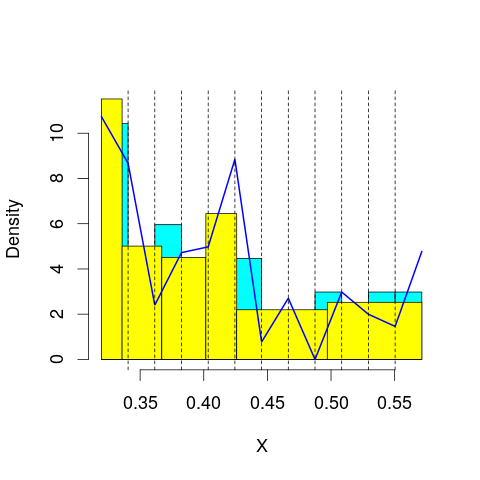

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.88029
mop.approx: Iteration 11. LL = 50.23386
mop.approx: Iteration 21. LL = 50.31019
mop.approx: Iteration 31. LL = 50.32648
mop.approx: Iteration 41. LL = 50.33063
mop.approx: Iteration 51. LL = 50.33177
mop.approx: Converged. Iteration 52. LL = 50.33187
[1] "Computing the linear combination of B-splines"


26.0717232747
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.75445
mop.approx: Iteration 11. LL = 50.20082
mop.approx: Iteration 21. LL = 50.32006
mop.approx: Iteration 31. LL = 50.35191
mop.approx: Iteration 41. LL = 50.36496
mop.approx: Iteration 51. LL = 50.37141
mop.approx: Iteration 61. LL = 50.37496
mop.approx: Iteration 71. LL = 50.37708
mop.approx: Iteration 81. LL = 50.3784
mop.approx: Iteration 91. LL = 50.37927
mop.approx: Converged. Iteration 100. LL = 50.37987
[1] "Computing the linear combination of B-splines"


24.386846732
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.69719
mop.approx: Iteration 11. LL = 44.55751
mop.approx: Iteration 21. LL = 44.61171
mop.approx: Iteration 31. LL = 44.62966
mop.approx: Iteration 41. LL = 44.63692
mop.approx: Iteration 51. LL = 44.64013
mop.approx: Iteration 61. LL = 44.64169
mop.approx: Iteration 71. LL = 44.64253
mop.approx: Converged. Iteration 78. LL = 44.64295
[1] "Computing the linear combination of B-splines"


16.9170586925
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.129662
mop.approx: Iteration 11. LL = 43.33197
mop.approx: Iteration 21. LL = 43.66862
mop.approx: Iteration 31. LL = 43.73212
mop.approx: Iteration 41. LL = 43.74918
mop.approx: Iteration 51. LL = 43.75532
mop.approx: Iteration 61. LL = 43.75808
mop.approx: Iteration 71. LL = 43.75955
mop.approx: Iteration 81. LL = 43.76044
mop.approx: Iteration 91. LL = 43.76104
mop.approx: Converged. Iteration 95. LL = 43.76127
[1] "Computing the linear combination of B-splines"


14.3025171932
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.133392
mop.approx: Iteration 11. LL = 42.16702
mop.approx: Iteration 21. LL = 42.29252
mop.approx: Iteration 31. LL = 42.34923
mop.approx: Iteration 41. LL = 42.37496
mop.approx: Iteration 51. LL = 42.38672
mop.approx: Iteration 61. LL = 42.39227
mop.approx: Iteration 71. LL = 42.39501
mop.approx: Iteration 81. LL = 42.39643
mop.approx: Iteration 91. LL = 42.3972
mop.approx: Converged. Iteration 96. LL = 42.39748
[1] "Computing the linear combination of B-splines"


11.2058584051
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.581241
mop.approx: Iteration 11. LL = 42.81144
mop.approx: Iteration 21. LL = 42.86015
mop.approx: Iteration 31. LL = 42.87815
mop.approx: Iteration 41. LL = 42.88934
mop.approx: Iteration 51. LL = 42.89642
mop.approx: Iteration 61. LL = 42.90094
mop.approx: Iteration 71. LL = 42.9039
mop.approx: Iteration 81. LL = 42.90589
mop.approx: Iteration 91. LL = 42.90729
mop.approx: Iteration 101. LL = 42.90831
mop.approx: Iteration 111. LL = 42.90908
mop.approx: Iteration 121. LL = 42.90968
mop.approx: Iteration 131. LL = 42.91016
mop.approx: Converged. Iteration 132. LL = 42.91024
[1] "Computing the linear combination of B-splines"


9.98575357726
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.615707
mop.approx: Iteration 11. LL = 42.85316
mop.approx: Iteration 21. LL = 43.16365
mop.approx: Iteration 31. LL = 43.21537
mop.approx: Iteration 41. LL = 43.23339
mop.approx: Iteration 51. LL = 43.24062
mop.approx: Iteration 61. LL = 43.24383
mop.approx: Iteration 71. LL = 43.2455
mop.approx: Iteration 81. LL = 43.24654
mop.approx: Iteration 91. LL = 43.24729
mop.approx: Iteration 101. LL = 43.24787
mop.approx: Converged. Iteration 110. LL = 43.24833
[1] "Computing the linear combination of B-splines"


8.59097492525
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.00663
mop.approx: Iteration 11. LL = 50.50154
mop.approx: Iteration 21. LL = 50.53313
mop.approx: Iteration 31. LL = 50.54403
mop.approx: Iteration 41. LL = 50.54783
mop.approx: Iteration 51. LL = 50.54916
mop.approx: Converged. Iteration 55. LL = 50.54945
[1] "Computing the linear combination of B-splines"


26.2892951829
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 26.289295182912369)
m reached
('Sum of Probabilities:', 0.9925142509938901)
chosen


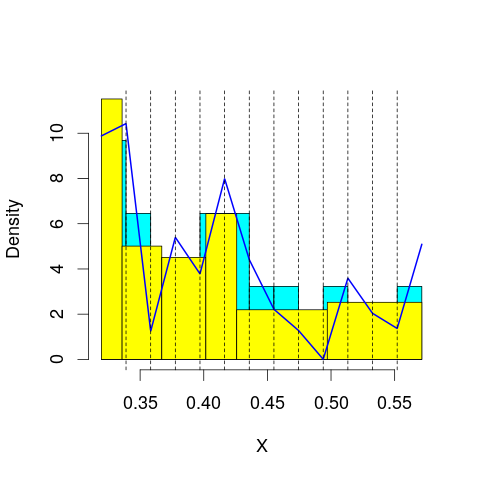

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.88029
mop.approx: Iteration 11. LL = 50.89345
mop.approx: Iteration 21. LL = 50.94108
mop.approx: Iteration 31. LL = 50.95205
mop.approx: Iteration 41. LL = 50.95604
mop.approx: Iteration 51. LL = 50.9578
mop.approx: Iteration 61. LL = 50.95868
mop.approx: Converged. Iteration 65. LL = 50.95895
[1] "Computing the linear combination of B-splines"


24.9659302869
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.75445
mop.approx: Iteration 11. LL = 50.09463
mop.approx: Iteration 21. LL = 50.26597
mop.approx: Iteration 31. LL = 50.32316
mop.approx: Iteration 41. LL = 50.34359
mop.approx: Iteration 51. LL = 50.35148
mop.approx: Iteration 61. LL = 50.35478
mop.approx: Iteration 71. LL = 50.35626
mop.approx: Converged. Iteration 80. LL = 50.35695
[1] "Computing the linear combination of B-splines"


22.6310593887
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.69719
mop.approx: Iteration 11. LL = 45.1495
mop.approx: Iteration 21. LL = 45.28305
mop.approx: Iteration 31. LL = 45.32952
mop.approx: Iteration 41. LL = 45.35101
mop.approx: Iteration 51. LL = 45.36195
mop.approx: Iteration 61. LL = 45.36782
mop.approx: Iteration 71. LL = 45.37107
mop.approx: Iteration 81. LL = 45.3729
mop.approx: Iteration 91. LL = 45.37394
mop.approx: Iteration 101. LL = 45.37455
mop.approx: Converged. Iteration 101. LL = 45.37459
[1] "Computing the linear combination of B-splines"


15.91583517
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.129662
mop.approx: Iteration 11. LL = 43.84293
mop.approx: Iteration 21. LL = 44.0606
mop.approx: Iteration 31. LL = 44.09182
mop.approx: Iteration 41. LL = 44.10332
mop.approx: Iteration 51. LL = 44.10914
mop.approx: Iteration 61. LL = 44.11233
mop.approx: Iteration 71. LL = 44.11411
mop.approx: Iteration 81. LL = 44.11511
mop.approx: Converged. Iteration 90. LL = 44.11566
[1] "Computing the linear combination of B-splines"


12.9240393348
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.133392
mop.approx: Iteration 11. LL = 42.39437
mop.approx: Iteration 21. LL = 42.54547
mop.approx: Iteration 31. LL = 42.59434
mop.approx: Iteration 41. LL = 42.61132
mop.approx: Iteration 51. LL = 42.61817
mop.approx: Iteration 61. LL = 42.6215
mop.approx: Iteration 71. LL = 42.6234
mop.approx: Iteration 81. LL = 42.62462
mop.approx: Iteration 91. LL = 42.62546
mop.approx: Iteration 101. LL = 42.62607
mop.approx: Converged. Iteration 107. LL = 42.62639
[1] "Computing the linear combination of B-splines"


9.70190090663
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.581241
mop.approx: Iteration 11. LL = 42.87729
mop.approx: Iteration 21. LL = 42.93617
mop.approx: Iteration 31. LL = 42.97036
mop.approx: Iteration 41. LL = 42.99525
mop.approx: Iteration 51. LL = 43.01373
mop.approx: Iteration 61. LL = 43.02751
mop.approx: Iteration 71. LL = 43.03782
mop.approx: Iteration 81. LL = 43.04554
mop.approx: Iteration 91. LL = 43.05134
mop.approx: Iteration 101. LL = 43.05572
mop.approx: Iteration 111. LL = 43.05903
mop.approx: Iteration 121. LL = 43.06154
mop.approx: Iteration 131. LL = 43.06346
mop.approx: Iteration 141. LL = 43.06492
mop.approx: Iteration 151. LL = 43.06604
mop.approx: Iteration 161. LL = 43.06691
mop.approx: Iteration 171. LL = 43.06759
mop.approx: Iteration 181. LL = 43.06811
mop.approx: Converged. Iteration 184. LL = 43.06829
[1] "Computing the linear combination of B-splines"


8.4109319115
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.615707
mop.approx: Iteration 11. LL = 43.20944
mop.approx: Iteration 21. LL = 43.3983
mop.approx: Iteration 31. LL = 43.4425
mop.approx: Iteration 41. LL = 43.46425
mop.approx: Iteration 51. LL = 43.47619
mop.approx: Iteration 61. LL = 43.48316
mop.approx: Iteration 71. LL = 43.48744
mop.approx: Iteration 81. LL = 43.49017
mop.approx: Iteration 91. LL = 43.49199
mop.approx: Iteration 101. LL = 43.49325
mop.approx: Iteration 111. LL = 43.49416
mop.approx: Iteration 121. LL = 43.49484
mop.approx: Iteration 131. LL = 43.49536
mop.approx: Converged. Iteration 133. LL = 43.49549
[1] "Computing the linear combination of B-splines"


7.10528088709
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.00663
mop.approx: Iteration 11. LL = 52.28615
mop.approx: Iteration 21. LL = 52.34109
mop.approx: Iteration 31. LL = 52.35258
mop.approx: Iteration 41. LL = 52.35691
mop.approx: Iteration 51. LL = 52.35895
mop.approx: Iteration 61. LL = 52.36006
mop.approx: Converged. Iteration 70. LL = 52.36071
[1] "Computing the linear combination of B-splines"


26.3676877243
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 26.367687724328178)
m reached
('Sum of Probabilities:', 0.9923582557401494)
chosen


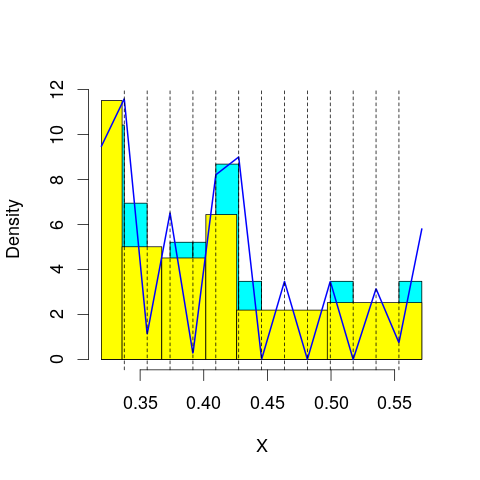

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.88029
mop.approx: Iteration 11. LL = 50.67376
mop.approx: Iteration 21. LL = 50.68244
mop.approx: Converged. Iteration 25. LL = 50.68286
[1] "Computing the linear combination of B-splines"


22.9569777421
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.75445
mop.approx: Iteration 11. LL = 50.70955
mop.approx: Iteration 21. LL = 50.87482
mop.approx: Iteration 31. LL = 50.92188
mop.approx: Iteration 41. LL = 50.93838
mop.approx: Iteration 51. LL = 50.94477
mop.approx: Iteration 61. LL = 50.9475
mop.approx: Iteration 71. LL = 50.94881
mop.approx: Iteration 81. LL = 50.94951
mop.approx: Converged. Iteration 82. LL = 50.94961
[1] "Computing the linear combination of B-splines"


21.4908565341
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.69719
mop.approx: Iteration 11. LL = 45.42089
mop.approx: Iteration 21. LL = 45.55282
mop.approx: Iteration 31. LL = 45.58794
mop.approx: Iteration 41. LL = 45.60111
mop.approx: Iteration 51. LL = 45.60666
mop.approx: Iteration 61. LL = 45.60913
mop.approx: Iteration 71. LL = 45.61028
mop.approx: Converged. Iteration 79. LL = 45.6108
[1] "Computing the linear combination of B-splines"


14.4191726386
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.129662
mop.approx: Iteration 11. LL = 44.4856
mop.approx: Iteration 21. LL = 44.69869
mop.approx: Iteration 31. LL = 44.74479
mop.approx: Iteration 41. LL = 44.76675
mop.approx: Iteration 51. LL = 44.77884
mop.approx: Iteration 61. LL = 44.78564
mop.approx: Iteration 71. LL = 44.78946
mop.approx: Iteration 81. LL = 44.79158
mop.approx: Iteration 91. LL = 44.79274
mop.approx: Iteration 101. LL = 44.79338
mop.approx: Converged. Iteration 102. LL = 44.79347
[1] "Computing the linear combination of B-splines"


11.8689796871
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.133392
mop.approx: Iteration 11. LL = 42.7011
mop.approx: Iteration 21. LL = 42.89935
mop.approx: Iteration 31. LL = 42.9641
mop.approx: Iteration 41. LL = 42.99178
mop.approx: Iteration 51. LL = 43.00612
mop.approx: Iteration 61. LL = 43.01453
mop.approx: Iteration 71. LL = 43.01984
mop.approx: Iteration 81. LL = 43.02335
mop.approx: Iteration 91. LL = 43.0257
mop.approx: Iteration 101. LL = 43.0273
mop.approx: Iteration 111. LL = 43.02838
mop.approx: Iteration 121. LL = 43.02913
mop.approx: Converged. Iteration 130. LL = 43.02964
[1] "Computing the linear combination of B-splines"


8.37227829172
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.581241
mop.approx: Iteration 11. LL = 42.92119
mop.approx: Iteration 21. LL = 42.98638
mop.approx: Iteration 31. LL = 43.01607
mop.approx: Iteration 41. LL = 43.03082
mop.approx: Iteration 51. LL = 43.03907
mop.approx: Iteration 61. LL = 43.0442
mop.approx: Iteration 71. LL = 43.04762
mop.approx: Iteration 81. LL = 43.05001
mop.approx: Iteration 91. LL = 43.05172
mop.approx: Iteration 101. LL = 43.05298
mop.approx: Iteration 111. LL = 43.05392
mop.approx: Iteration 121. LL = 43.05463
mop.approx: Iteration 131. LL = 43.05517
mop.approx: Converged. Iteration 134. LL = 43.05535
[1] "Computing the linear combination of B-splines"


6.66511731938
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.615707
mop.approx: Iteration 11. LL = 43.43823
mop.approx: Iteration 21. LL = 43.56766
mop.approx: Iteration 31. LL = 43.60326
mop.approx: Iteration 41. LL = 43.62346
mop.approx: Iteration 51. LL = 43.63673
mop.approx: Iteration 61. LL = 43.64592
mop.approx: Iteration 71. LL = 43.65244
mop.approx: Iteration 81. LL = 43.65713
mop.approx: Iteration 91. LL = 43.66052
mop.approx: Iteration 101. LL = 43.66299
mop.approx: Iteration 111. LL = 43.6648
mop.approx: Iteration 121. LL = 43.66613
mop.approx: Iteration 131. LL = 43.6671
mop.approx: Iteration 141. LL = 43.66782
mop.approx: Iteration 151. LL = 43.66835
mop.approx: Converged. Iteration 152. LL = 43.66844
[1] "Computing the linear combination of B-splines"


5.54528061874
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.00663
mop.approx: Iteration 11. LL = 52.01966
mop.approx: Iteration 21. LL = 52.0246
mop.approx: Converged. Iteration 21. LL = 52.02464
[1] "Computing the linear combination of B-splines"


24.2987534121
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 24.298753412117701)
m reached
('Sum of Probabilities:', 0.9921580680356212)
chosen


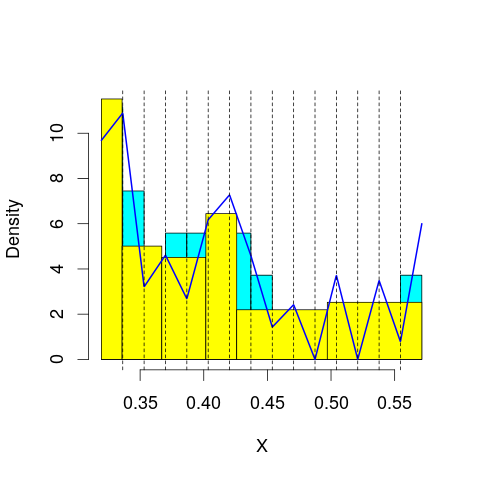

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.88029
mop.approx: Iteration 11. LL = 50.85898
mop.approx: Iteration 21. LL = 50.90483
mop.approx: Iteration 31. LL = 50.91372
mop.approx: Iteration 41. LL = 50.91668
mop.approx: Iteration 51. LL = 50.918
mop.approx: Iteration 61. LL = 50.91872
mop.approx: Converged. Iteration 63. LL = 50.91888
[1] "Computing the linear combination of B-splines"


21.4601212354
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.75445
mop.approx: Iteration 11. LL = 50.84807
mop.approx: Iteration 21. LL = 50.96103
mop.approx: Iteration 31. LL = 50.99728
mop.approx: Iteration 41. LL = 51.01092
mop.approx: Iteration 51. LL = 51.01604
mop.approx: Iteration 61. LL = 51.01795
mop.approx: Converged. Iteration 69. LL = 51.01863
[1] "Computing the linear combination of B-splines"


19.8270027698
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.69719
mop.approx: Iteration 11. LL = 45.68222
mop.approx: Iteration 21. LL = 45.85217
mop.approx: Iteration 31. LL = 45.90565
mop.approx: Iteration 41. LL = 45.92635
mop.approx: Iteration 51. LL = 45.93465
mop.approx: Iteration 61. LL = 45.93807
mop.approx: Iteration 71. LL = 45.93954
mop.approx: Iteration 81. LL = 45.94023
mop.approx: Converged. Iteration 81. LL = 45.94028
[1] "Computing the linear combination of B-splines"


13.0157865432
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.129662
mop.approx: Iteration 11. LL = 45.12053
mop.approx: Iteration 21. LL = 45.30586
mop.approx: Iteration 31. LL = 45.3528
mop.approx: Iteration 41. LL = 45.37158
mop.approx: Iteration 51. LL = 45.37968
mop.approx: Iteration 61. LL = 45.3835
mop.approx: Iteration 71. LL = 45.38552
mop.approx: Iteration 81. LL = 45.3867
mop.approx: Iteration 91. LL = 45.38744
mop.approx: Converged. Iteration 98. LL = 45.38785
[1] "Computing the linear combination of B-splines"


10.7304870917
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.133392
mop.approx: Iteration 11. LL = 43.04145
mop.approx: Iteration 21. LL = 43.26369
mop.approx: Iteration 31. LL = 43.32329
mop.approx: Iteration 41. LL = 43.34617
mop.approx: Iteration 51. LL = 43.35716
mop.approx: Iteration 61. LL = 43.36305
mop.approx: Iteration 71. LL = 43.36642
mop.approx: Iteration 81. LL = 43.36844
mop.approx: Iteration 91. LL = 43.36972
mop.approx: Iteration 101. LL = 43.37056
mop.approx: Iteration 111. LL = 43.37116
mop.approx: Converged. Iteration 116. LL = 43.37143
[1] "Computing the linear combination of B-splines"


6.98120677982
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.581241
mop.approx: Iteration 11. LL = 43.02246
mop.approx: Iteration 21. LL = 43.09927
mop.approx: Iteration 31. LL = 43.12834
mop.approx: Iteration 41. LL = 43.14374
mop.approx: Iteration 51. LL = 43.15354
mop.approx: Iteration 61. LL = 43.16016
mop.approx: Iteration 71. LL = 43.16472
mop.approx: Iteration 81. LL = 43.16789
mop.approx: Iteration 91. LL = 43.17011
mop.approx: Iteration 101. LL = 43.17168
mop.approx: Iteration 111. LL = 43.1728
mop.approx: Iteration 121. LL = 43.1736
mop.approx: Iteration 131. LL = 43.17418
mop.approx: Converged. Iteration 136. LL = 43.17446
[1] "Computing the linear combination of B-splines"


5.05134549769
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.615707
mop.approx: Iteration 11. LL = 43.53982
mop.approx: Iteration 21. LL = 43.62257
mop.approx: Iteration 31. LL = 43.64353
mop.approx: Iteration 41. LL = 43.65256
mop.approx: Iteration 51. LL = 43.65737
mop.approx: Iteration 61. LL = 43.66033
mop.approx: Iteration 71. LL = 43.66231
mop.approx: Iteration 81. LL = 43.66369
mop.approx: Iteration 91. LL = 43.66468
mop.approx: Iteration 101. LL = 43.6654
mop.approx: Iteration 111. LL = 43.66593
mop.approx: Converged. Iteration 113. LL = 43.66607
[1] "Computing the linear combination of B-splines"


3.81009636746
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.00663
mop.approx: Iteration 11. LL = 51.74075
mop.approx: Iteration 21. LL = 51.79665
mop.approx: Iteration 31. LL = 51.80349
mop.approx: Iteration 41. LL = 51.80497
mop.approx: Converged. Iteration 45. LL = 51.80527
[1] "Computing the linear combination of B-splines"


22.346515805
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 22.346515805023898)
m reached
('Sum of Probabilities:', 0.992357900109784)
chosen


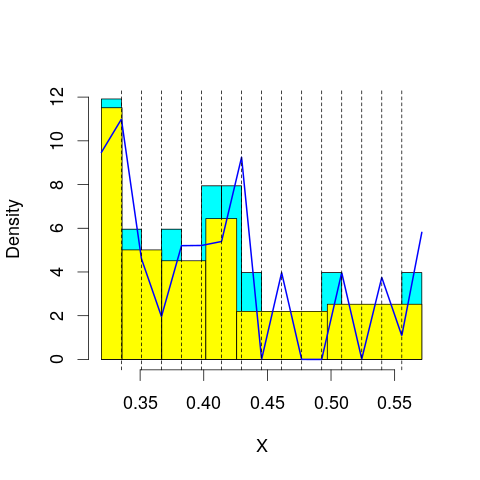

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.88029
mop.approx: Iteration 11. LL = 51.78878
mop.approx: Iteration 21. LL = 51.87798
mop.approx: Iteration 31. LL = 51.89427
mop.approx: Iteration 41. LL = 51.89806
mop.approx: Iteration 51. LL = 51.89928
mop.approx: Converged. Iteration 57. LL = 51.8997
[1] "Computing the linear combination of B-splines"


20.7080736156
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.75445
mop.approx: Iteration 11. LL = 51.10708
mop.approx: Iteration 21. LL = 51.25009
mop.approx: Iteration 31. LL = 51.28276
mop.approx: Iteration 41. LL = 51.2947
mop.approx: Iteration 51. LL = 51.30031
mop.approx: Iteration 61. LL = 51.30338
mop.approx: Iteration 71. LL = 51.30524
mop.approx: Iteration 81. LL = 51.30645
mop.approx: Iteration 91. LL = 51.30727
mop.approx: Converged. Iteration 100. LL = 51.30786
[1] "Computing the linear combination of B-splines"


18.3833680265
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.69719
mop.approx: Iteration 11. LL = 45.92408
mop.approx: Iteration 21. LL = 46.02792
mop.approx: Iteration 31. LL = 46.06365
mop.approx: Iteration 41. LL = 46.07931
mop.approx: Iteration 51. LL = 46.08702
mop.approx: Iteration 61. LL = 46.09117
mop.approx: Iteration 71. LL = 46.09358
mop.approx: Iteration 81. LL = 46.09505
mop.approx: Iteration 91. LL = 46.09599
mop.approx: Iteration 101. LL = 46.0966
mop.approx: Converged. Iteration 102. LL = 46.09669
[1] "Computing the linear combination of B-splines"


11.4393327512
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.129662
mop.approx: Iteration 11. LL = 45.76592
mop.approx: Iteration 21. LL = 45.99641
mop.approx: Iteration 31. LL = 46.03218
mop.approx: Iteration 41. LL = 46.03997
mop.approx: Iteration 51. LL = 46.04213
mop.approx: Converged. Iteration 60. LL = 46.04285
[1] "Computing the linear combination of B-splines"


9.65262765161
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.133392
mop.approx: Iteration 11. LL = 43.57885
mop.approx: Iteration 21. LL = 43.84514
mop.approx: Iteration 31. LL = 43.92182
mop.approx: Iteration 41. LL = 43.95478
mop.approx: Iteration 51. LL = 43.9711
mop.approx: Iteration 61. LL = 43.97958
mop.approx: Iteration 71. LL = 43.98417
mop.approx: Iteration 81. LL = 43.98681
mop.approx: Iteration 91. LL = 43.98844
mop.approx: Iteration 101. LL = 43.98952
mop.approx: Iteration 111. LL = 43.99027
mop.approx: Iteration 121. LL = 43.99082
mop.approx: Converged. Iteration 124. LL = 43.991
[1] "Computing the linear combination of B-splines"


5.86790285099
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.581241
mop.approx: Iteration 11. LL = 43.13275
mop.approx: Iteration 21. LL = 43.25814
mop.approx: Iteration 31. LL = 43.2932
mop.approx: Iteration 41. LL = 43.30353
mop.approx: Iteration 51. LL = 43.30735
mop.approx: Iteration 61. LL = 43.30909
mop.approx: Iteration 71. LL = 43.30998
mop.approx: Converged. Iteration 78. LL = 43.3104
[1] "Computing the linear combination of B-splines"


3.45444666828
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.615707
mop.approx: Iteration 11. LL = 43.65836
mop.approx: Iteration 21. LL = 43.73099
mop.approx: Iteration 31. LL = 43.75246
mop.approx: Iteration 41. LL = 43.76453
mop.approx: Iteration 51. LL = 43.77317
mop.approx: Iteration 61. LL = 43.77978
mop.approx: Iteration 71. LL = 43.78491
mop.approx: Iteration 81. LL = 43.78889
mop.approx: Iteration 91. LL = 43.79197
mop.approx: Iteration 101. LL = 43.79435
mop.approx: Iteration 111. LL = 43.79619
mop.approx: Iteration 121. LL = 43.79763
mop.approx: Iteration 131. LL = 43.79874
mop.approx: Iteration 141. LL = 43.79962
mop.approx: Iteration 151. LL = 43.80031
mop.approx: Iteration 161. LL = 43.80087
mop.approx: Converged. Iteration 167. LL = 43.80119
[1] "Computing the linear combination of B-splines"


2.2121568121
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.00663
mop.approx: Iteration 11. LL = 51.70193
mop.approx: Iteration 21. LL = 51.75978
mop.approx: Iteration 31. LL = 51.77263
mop.approx: Iteration 41. LL = 51.77685
mop.approx: Iteration 51. LL = 51.77874
mop.approx: Iteration 61. LL = 51.77976
mop.approx: Converged. Iteration 69. LL = 51.78032
[1] "Computing the linear combination of B-splines"


20.5886928679
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 20.588692867918787)
m reached
('Sum of Probabilities:', 0.992711937372267)
chosen


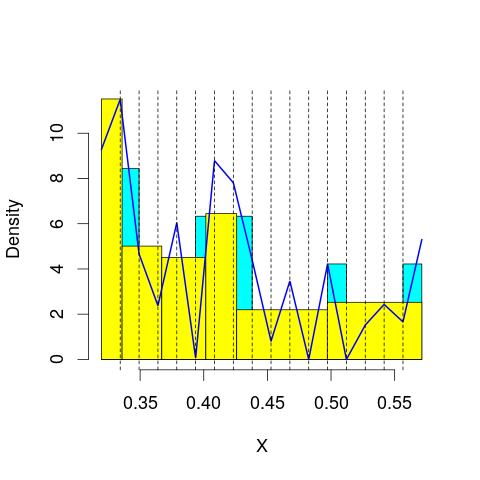

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.88029
mop.approx: Iteration 11. LL = 52.01723
mop.approx: Iteration 21. LL = 52.12884
mop.approx: Iteration 31. LL = 52.14853
mop.approx: Iteration 41. LL = 52.15351
mop.approx: Iteration 51. LL = 52.15501
mop.approx: Converged. Iteration 55. LL = 52.15532
[1] "Computing the linear combination of B-splines"


19.2308327215
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.75445
mop.approx: Iteration 11. LL = 51.01966
mop.approx: Iteration 21. LL = 51.11689
mop.approx: Iteration 31. LL = 51.14816
mop.approx: Iteration 41. LL = 51.16148
mop.approx: Iteration 51. LL = 51.168
mop.approx: Iteration 61. LL = 51.17149
mop.approx: Iteration 71. LL = 51.17349
mop.approx: Iteration 81. LL = 51.17472
mop.approx: Iteration 91. LL = 51.17552
mop.approx: Converged. Iteration 98. LL = 51.17597
[1] "Computing the linear combination of B-splines"


16.5186143885
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.69719
mop.approx: Iteration 11. LL = 46.25732
mop.approx: Iteration 21. LL = 46.39563
mop.approx: Iteration 31. LL = 46.43424
mop.approx: Iteration 41. LL = 46.44867
mop.approx: Iteration 51. LL = 46.45503
mop.approx: Iteration 61. LL = 46.45806
mop.approx: Iteration 71. LL = 46.45956
mop.approx: Iteration 81. LL = 46.46033
mop.approx: Converged. Iteration 84. LL = 46.46052
[1] "Computing the linear combination of B-splines"


10.0702940173
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.129662
mop.approx: Iteration 11. LL = 46.04147
mop.approx: Iteration 21. LL = 46.15537
mop.approx: Iteration 31. LL = 46.17892
mop.approx: Iteration 41. LL = 46.18991
mop.approx: Iteration 51. LL = 46.19672
mop.approx: Iteration 61. LL = 46.20142
mop.approx: Iteration 71. LL = 46.20482
mop.approx: Iteration 81. LL = 46.20735
mop.approx: Iteration 91. LL = 46.20927
mop.approx: Iteration 101. LL = 46.21074
mop.approx: Iteration 111. LL = 46.21188
mop.approx: Iteration 121. LL = 46.21278
mop.approx: Iteration 131. LL = 46.21348
mop.approx: Iteration 141. LL = 46.21404
mop.approx: Converged. Iteration 145. LL = 46.21428
[1] "Computing the linear combination of B-splines"


8.09118601444
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.133392
mop.approx: Iteration 11. LL = 44.32865
mop.approx: Iteration 21. LL = 44.68066
mop.approx: Iteration 31. LL = 44.76794
mop.approx: Iteration 41. LL = 44.7931
mop.approx: Iteration 51. LL = 44.80072
mop.approx: Iteration 61. LL = 44.80323
mop.approx: Iteration 71. LL = 44.80419
mop.approx: Converged. Iteration 75. LL = 44.80444
[1] "Computing the linear combination of B-splines"


4.9484799834
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.581241
mop.approx: Iteration 11. LL = 43.16847
mop.approx: Iteration 21. LL = 43.21788
mop.approx: Iteration 31. LL = 43.22883
mop.approx: Iteration 41. LL = 43.23514
mop.approx: Iteration 51. LL = 43.24025
mop.approx: Iteration 61. LL = 43.24468
mop.approx: Iteration 71. LL = 43.24858
mop.approx: Iteration 81. LL = 43.25203
mop.approx: Iteration 91. LL = 43.25509
mop.approx: Iteration 101. LL = 43.2578
mop.approx: Iteration 111. LL = 43.2602
mop.approx: Iteration 121. LL = 43.26233
mop.approx: Iteration 131. LL = 43.26422
mop.approx: Iteration 141. LL = 43.26589
mop.approx: Iteration 151. LL = 43.26736
mop.approx: Iteration 161. LL = 43.26866
mop.approx: Iteration 171. LL = 43.26981
mop.approx: Iteration 181. LL = 43.27082
mop.approx: Iteration 191. LL = 43.27171
mop.approx: Iteration 201. LL = 43.27248
mop.approx: Iteration 211. LL = 4

1.68583365381
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.615707
mop.approx: Iteration 11. LL = 43.81325
mop.approx: Iteration 21. LL = 43.93359
mop.approx: Iteration 31. LL = 43.97299
mop.approx: Iteration 41. LL = 43.98989
mop.approx: Iteration 51. LL = 43.99887
mop.approx: Iteration 61. LL = 44.00446
mop.approx: Iteration 71. LL = 44.00828
mop.approx: Iteration 81. LL = 44.01106
mop.approx: Iteration 91. LL = 44.01315
mop.approx: Iteration 101. LL = 44.01477
mop.approx: Iteration 111. LL = 44.01606
mop.approx: Iteration 121. LL = 44.01709
mop.approx: Iteration 131. LL = 44.01794
mop.approx: Iteration 141. LL = 44.01864
mop.approx: Iteration 151. LL = 44.01922
mop.approx: Iteration 161. LL = 44.01971
mop.approx: Converged. Iteration 162. LL = 44.0198
[1] "Computing the linear combination of B-splines"


0.69778957215
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.00663
mop.approx: Iteration 11. LL = 53.45879
mop.approx: Iteration 21. LL = 53.4888
mop.approx: Converged. Iteration 29. LL = 53.49043
[1] "Computing the linear combination of B-splines"


20.5659359007
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 20.565935900650452)
m reached
('Sum of Probabilities:', 0.9928561256060913)
chosen


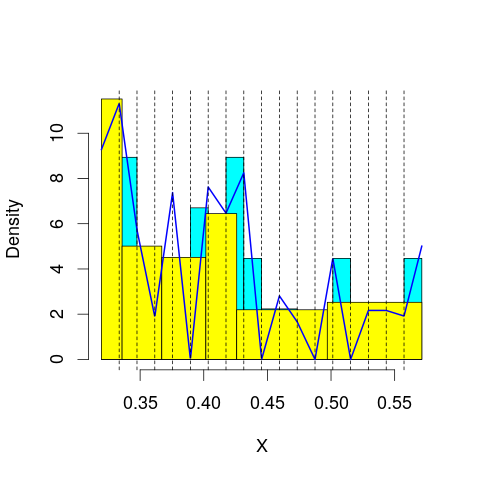

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.88029
mop.approx: Iteration 11. LL = 51.76411
mop.approx: Iteration 21. LL = 51.80025
mop.approx: Iteration 31. LL = 51.80695
mop.approx: Iteration 41. LL = 51.80912
mop.approx: Iteration 51. LL = 51.81003
mop.approx: Converged. Iteration 53. LL = 51.81019
[1] "Computing the linear combination of B-splines"


17.1528322814
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.75445
mop.approx: Iteration 11. LL = 51.96472
mop.approx: Iteration 21. LL = 52.13938
mop.approx: Iteration 31. LL = 52.16309
mop.approx: Iteration 41. LL = 52.16795
mop.approx: Iteration 51. LL = 52.16966
mop.approx: Iteration 61. LL = 52.17049
mop.approx: Converged. Iteration 64. LL = 52.1707
[1] "Computing the linear combination of B-splines"


15.7804768455
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.69719
mop.approx: Iteration 11. LL = 46.26508
mop.approx: Iteration 21. LL = 46.31069
mop.approx: Iteration 31. LL = 46.31636
mop.approx: Iteration 41. LL = 46.31859
mop.approx: Iteration 51. LL = 46.31977
mop.approx: Iteration 61. LL = 46.32047
mop.approx: Converged. Iteration 65. LL = 46.32071
[1] "Computing the linear combination of B-splines"


8.19761695566
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.129662
mop.approx: Iteration 11. LL = 46.58691
mop.approx: Iteration 21. LL = 46.74891
mop.approx: Iteration 31. LL = 46.79222
mop.approx: Iteration 41. LL = 46.80784
mop.approx: Iteration 51. LL = 46.81477
mop.approx: Iteration 61. LL = 46.81831
mop.approx: Iteration 71. LL = 46.82023
mop.approx: Iteration 81. LL = 46.8213
mop.approx: Iteration 91. LL = 46.82192
mop.approx: Converged. Iteration 91. LL = 46.82196
[1] "Computing the linear combination of B-splines"


6.96599757175
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.133392
mop.approx: Iteration 11. LL = 45.0137
mop.approx: Iteration 21. LL = 45.33392
mop.approx: Iteration 31. LL = 45.3744
mop.approx: Iteration 41. LL = 45.3805
mop.approx: Iteration 51. LL = 45.3817
mop.approx: Converged. Iteration 53. LL = 45.38185
[1] "Computing the linear combination of B-splines"


3.79301698903
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.581241
mop.approx: Iteration 11. LL = 43.45225
mop.approx: Iteration 21. LL = 43.57663
mop.approx: Iteration 31. LL = 43.61647
mop.approx: Iteration 41. LL = 43.63288
mop.approx: Iteration 51. LL = 43.64128
mop.approx: Iteration 61. LL = 43.64651
mop.approx: Iteration 71. LL = 43.65025
mop.approx: Iteration 81. LL = 43.65311
mop.approx: Iteration 91. LL = 43.65538
mop.approx: Iteration 101. LL = 43.65718
mop.approx: Iteration 111. LL = 43.65862
mop.approx: Iteration 121. LL = 43.65976
mop.approx: Iteration 131. LL = 43.66065
mop.approx: Iteration 141. LL = 43.66135
mop.approx: Iteration 151. LL = 43.66189
mop.approx: Converged. Iteration 154. LL = 43.66207
[1] "Computing the linear combination of B-splines"


0.340374219978
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.615707
mop.approx: Iteration 11. LL = 43.90115
mop.approx: Iteration 21. LL = 44.01854
mop.approx: Iteration 31. LL = 44.04811
mop.approx: Iteration 41. LL = 44.0584
mop.approx: Iteration 51. LL = 44.06319
mop.approx: Iteration 61. LL = 44.06586
mop.approx: Iteration 71. LL = 44.06755
mop.approx: Iteration 81. LL = 44.06872
mop.approx: Iteration 91. LL = 44.06958
mop.approx: Iteration 101. LL = 44.07023
mop.approx: Iteration 111. LL = 44.07075
mop.approx: Converged. Iteration 114. LL = 44.07093
[1] "Computing the linear combination of B-splines"


-0.98427545893
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.00663
mop.approx: Iteration 11. LL = 53.41747
mop.approx: Iteration 21. LL = 53.4705
mop.approx: Iteration 31. LL = 53.48213
mop.approx: Iteration 41. LL = 53.4862
mop.approx: Iteration 51. LL = 53.48799
mop.approx: Iteration 61. LL = 53.48887
mop.approx: Converged. Iteration 63. LL = 53.48904
[1] "Computing the linear combination of B-splines"


18.831676792
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 18.831676792022883)
m reached
('Sum of Probabilities:', 0.9929072441779954)
chosen


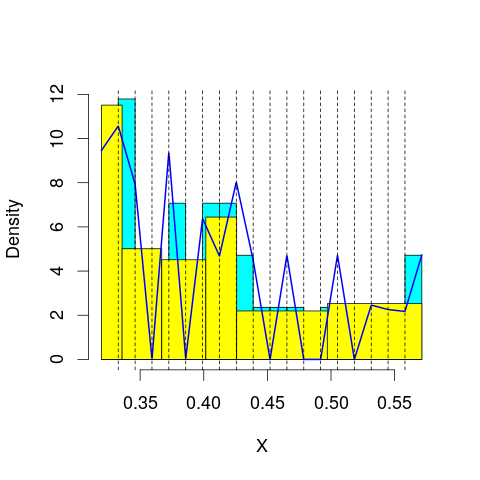

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.88029
mop.approx: Iteration 11. LL = 52.25457
mop.approx: Iteration 21. LL = 52.36374
mop.approx: Iteration 31. LL = 52.38214
mop.approx: Iteration 41. LL = 52.38974
mop.approx: Iteration 51. LL = 52.39337
mop.approx: Iteration 61. LL = 52.3951
mop.approx: Iteration 71. LL = 52.39597
mop.approx: Converged. Iteration 74. LL = 52.3962
[1] "Computing the linear combination of B-splines"


16.0059692795
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.75445
mop.approx: Iteration 11. LL = 52.27678
mop.approx: Iteration 21. LL = 52.42111
mop.approx: Iteration 31. LL = 52.4559
mop.approx: Iteration 41. LL = 52.46707
mop.approx: Iteration 51. LL = 52.47132
mop.approx: Iteration 61. LL = 52.47318
mop.approx: Iteration 71. LL = 52.47409
mop.approx: Converged. Iteration 75. LL = 52.47437
[1] "Computing the linear combination of B-splines"


14.3512751623
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.69719
mop.approx: Iteration 11. LL = 46.2975
mop.approx: Iteration 21. LL = 46.4661
mop.approx: Iteration 31. LL = 46.5106
mop.approx: Iteration 41. LL = 46.52323
mop.approx: Iteration 51. LL = 46.52772
mop.approx: Iteration 61. LL = 46.52967
mop.approx: Iteration 71. LL = 46.53064
mop.approx: Converged. Iteration 78. LL = 46.53109
[1] "Computing the linear combination of B-splines"


6.67512359676
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.129662
mop.approx: Iteration 11. LL = 47.06807
mop.approx: Iteration 21. LL = 47.16843
mop.approx: Iteration 31. LL = 47.19209
mop.approx: Iteration 41. LL = 47.20348
mop.approx: Iteration 51. LL = 47.21027
mop.approx: Iteration 61. LL = 47.21465
mop.approx: Iteration 71. LL = 47.2176
mop.approx: Iteration 81. LL = 47.21967
mop.approx: Iteration 91. LL = 47.22116
mop.approx: Iteration 101. LL = 47.22225
mop.approx: Iteration 111. LL = 47.22308
mop.approx: Iteration 121. LL = 47.22371
mop.approx: Converged. Iteration 128. LL = 47.22412
[1] "Computing the linear combination of B-splines"


5.63528491367
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.133392
mop.approx: Iteration 11. LL = 45.53403
mop.approx: Iteration 21. LL = 45.80566
mop.approx: Iteration 31. LL = 45.85316
mop.approx: Iteration 41. LL = 45.87178
mop.approx: Iteration 51. LL = 45.88161
mop.approx: Iteration 61. LL = 45.8874
mop.approx: Iteration 71. LL = 45.89099
mop.approx: Iteration 81. LL = 45.8933
mop.approx: Iteration 91. LL = 45.89481
mop.approx: Iteration 101. LL = 45.89584
mop.approx: Iteration 111. LL = 45.89654
mop.approx: Converged. Iteration 118. LL = 45.89696
[1] "Computing the linear combination of B-splines"


2.57525773511
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.581241
mop.approx: Iteration 11. LL = 43.92135
mop.approx: Iteration 21. LL = 44.0569
mop.approx: Iteration 31. LL = 44.09463
mop.approx: Iteration 41. LL = 44.1118
mop.approx: Iteration 51. LL = 44.11994
mop.approx: Iteration 61. LL = 44.12393
mop.approx: Iteration 71. LL = 44.12605
mop.approx: Iteration 81. LL = 44.12731
mop.approx: Iteration 91. LL = 44.12816
mop.approx: Iteration 101. LL = 44.12878
mop.approx: Iteration 111. LL = 44.12927
mop.approx: Converged. Iteration 111. LL = 44.12931
[1] "Computing the linear combination of B-splines"


-0.925224426685
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.615707
mop.approx: Iteration 11. LL = 43.87855
mop.approx: Iteration 21. LL = 43.95009
mop.approx: Iteration 31. LL = 43.97894
mop.approx: Iteration 41. LL = 43.99285
mop.approx: Iteration 51. LL = 44.00029
mop.approx: Iteration 61. LL = 44.0048
mop.approx: Iteration 71. LL = 44.0079
mop.approx: Iteration 81. LL = 44.01023
mop.approx: Iteration 91. LL = 44.0121
mop.approx: Iteration 101. LL = 44.01364
mop.approx: Iteration 111. LL = 44.01495
mop.approx: Iteration 121. LL = 44.01606
mop.approx: Iteration 131. LL = 44.01702
mop.approx: Iteration 141. LL = 44.01784
mop.approx: Iteration 151. LL = 44.01855
mop.approx: Iteration 161. LL = 44.01916
mop.approx: Iteration 171. LL = 44.0197
mop.approx: Converged. Iteration 179. LL = 44.02011
[1] "Computing the linear combination of B-splines"


-2.76839091061
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 44.00663
mop.approx: Iteration 11. LL = 52.72047
mop.approx: Iteration 21. LL = 52.75383
mop.approx: Iteration 31. LL = 52.75696
mop.approx: Converged. Iteration 37. LL = 52.75751
[1] "Computing the linear combination of B-splines"


16.367282223
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 16.367282222981693)
m reached
('Sum of Probabilities:', 0.9928737166474482)
chosen


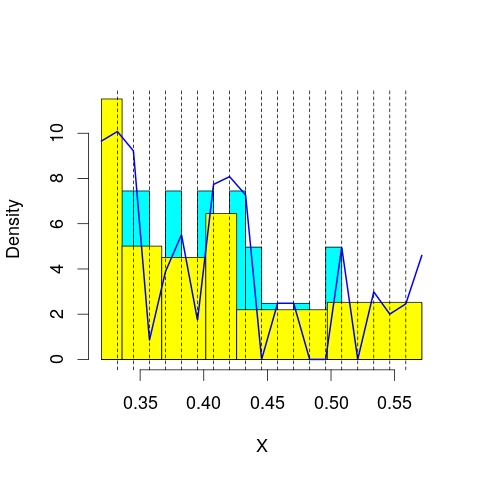

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.88029
mop.approx: Iteration 11. LL = 53.27775
mop.approx: Iteration 21. LL = 53.33309
mop.approx: Iteration 31. LL = 53.34469
mop.approx: Iteration 41. LL = 53.34914
mop.approx: Iteration 51. LL = 53.35073
mop.approx: Converged. Iteration 55. LL = 53.35107
[1] "Computing the linear combination of B-splines"


15.2279719186
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 43.75445
mop.approx: Iteration 11. LL = 51.92712
mop.approx: Iteration 21. LL = 52.06673
mop.approx: Iteration 31. LL = 52.09911
mop.approx: Iteration 41. LL = 52.11138
mop.approx: Iteration 51. LL = 52.1174
mop.approx: Iteration 61. LL = 52.12073
mop.approx: Iteration 71. LL = 52.12269
mop.approx: Iteration 81. LL = 52.1239
mop.approx: Iteration 91. LL = 52.12466
mop.approx: Converged. Iteration 95. LL = 52.12494
[1] "Computing the linear combination of B-splines"


12.2689732808
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.69719
mop.approx: Iteration 11. LL = 47.10823
mop.approx: Iteration 21. LL = 47.2687
mop.approx: Iteration 31. LL = 47.29909
mop.approx: Iteration 41. LL = 47.30751
mop.approx: Iteration 51. LL = 47.31059
mop.approx: Iteration 61. LL = 47.31192
mop.approx: Converged. Iteration 70. LL = 47.31257
[1] "Computing the linear combination of B-splines"


5.72373817196
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.129662
mop.approx: Iteration 11. LL = 47.02743
mop.approx: Iteration 21. LL = 47.17145
mop.approx: Iteration 31. LL = 47.21092
mop.approx: Iteration 41. LL = 47.22532
mop.approx: Iteration 51. LL = 47.23176
mop.approx: Iteration 61. LL = 47.23497
mop.approx: Iteration 71. LL = 47.23664
mop.approx: Iteration 81. LL = 47.23753
mop.approx: Converged. Iteration 86. LL = 47.23785
[1] "Computing the linear combination of B-splines"


3.91615117949
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.133392
mop.approx: Iteration 11. LL = 46.4938
mop.approx: Iteration 21. LL = 46.74705
mop.approx: Iteration 31. LL = 46.79705
mop.approx: Iteration 41. LL = 46.82257
mop.approx: Iteration 51. LL = 46.83777
mop.approx: Iteration 61. LL = 46.84721
mop.approx: Iteration 71. LL = 46.85328
mop.approx: Iteration 81. LL = 46.85732
mop.approx: Iteration 91. LL = 46.8601
mop.approx: Iteration 101. LL = 46.86207
mop.approx: Iteration 111. LL = 46.8635
mop.approx: Iteration 121. LL = 46.86457
mop.approx: Iteration 131. LL = 46.86538
mop.approx: Iteration 141. LL = 46.866
mop.approx: Converged. Iteration 147. LL = 46.86635
[1] "Computing the linear combination of B-splines"


1.8117824622
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.581241
mop.approx: Iteration 11. LL = 44.18469
mop.approx: Iteration 21. LL = 44.3792
mop.approx: Iteration 31. LL = 44.42745
mop.approx: Iteration 41. LL = 44.44334
mop.approx: Iteration 51. LL = 44.45066
mop.approx: Iteration 61. LL = 44.45504
mop.approx: Iteration 71. LL = 44.45801
mop.approx: Iteration 81. LL = 44.46012
mop.approx: Iteration 91. LL = 44.46165
mop.approx: Iteration 101. LL = 44.46275
mop.approx: Iteration 111. LL = 44.46355
mop.approx: Iteration 121. LL = 44.46413
mop.approx: Converged. Iteration 124. LL = 44.46431
[1] "Computing the linear combination of B-splines"


-2.32315315928
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = -1.615707
mop.approx: Iteration 11. LL = 44.18012
mop.approx: Iteration 21. LL = 44.28926
mop.approx: Iteration 31. LL = 44.31763
mop.approx: Iteration 41. LL = 44.33127
mop.approx: Iteration 51. LL = 44.34041
mop.approx: Iteration 61. LL = 44.34745
mop.approx: Iteration 71. LL = 44.35317
mop.approx: Iteration 81. LL = 44.3579
mop.approx: Iteration 91. LL = 44.36181
mop.approx: Iteration 101. LL = 44.36505
mop.approx: Iteration 111. LL = 44.36773
mop.approx: Iteration 121. LL = 44.36994
mop.approx: Iteration 131. LL = 44.37177
mop.approx: Iteration 141. LL = 44.37326
mop.approx: Iteration 151. LL = 44.37449
mop.approx: Iteration 161. LL = 44.3755
mop.approx: Iteration 171. LL = 44.37633
mop.approx: Iteration 181. LL = 44.37701
mop.approx: Iteration 191. LL = 44.37757
mop.approx: Converged. Iteration 198. LL = 44.37795
[1] "Computing the li

-4.14124414375
lfps_18
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.49756
mop.approx: Iteration 11. LL = 74.00266
mop.approx: Converged. Iteration 17. LL = 74.00596
[1] "Computing the linear combination of B-splines"


68.8073572112
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 68.807357211198379)
m reached
('Sum of Probabilities:', 0.9853576836034653)
chosen


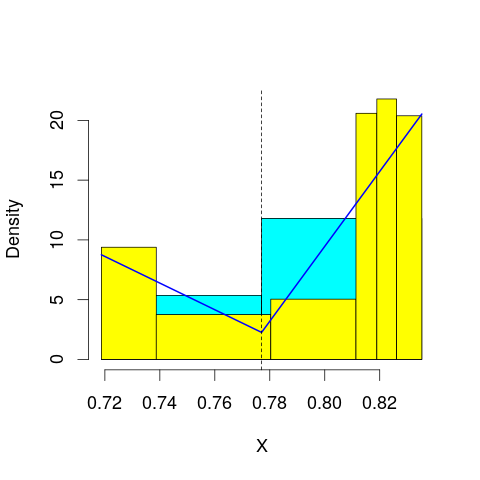

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.22658
mop.approx: Iteration 11. LL = 73.66702
mop.approx: Iteration 21. LL = 73.67626
mop.approx: Iteration 31. LL = 73.67867
mop.approx: Converged. Iteration 34. LL = 73.67903
[1] "Computing the linear combination of B-splines"


66.7475585277
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.95787
mop.approx: Iteration 11. LL = 73.09105
mop.approx: Iteration 21. LL = 73.15752
mop.approx: Iteration 31. LL = 73.18766
mop.approx: Iteration 41. LL = 73.20238
mop.approx: Iteration 51. LL = 73.20963
mop.approx: Iteration 61. LL = 73.21322
mop.approx: Iteration 71. LL = 73.215
mop.approx: Converged. Iteration 78. LL = 73.21575
[1] "Computing the linear combination of B-splines"


64.5514101907
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.13617
mop.approx: Iteration 11. LL = 52.92812
mop.approx: Iteration 21. LL = 52.9369
mop.approx: Converged. Iteration 21. LL = 52.93693
[1] "Computing the linear combination of B-splines"


42.5397237686
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.47362
mop.approx: Iteration 11. LL = 53.56013
mop.approx: Iteration 21. LL = 53.73702
mop.approx: Iteration 31. LL = 53.74194
mop.approx: Converged. Iteration 31. LL = 53.74199
[1] "Computing the linear combination of B-splines"


41.61191179
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.66403
mop.approx: Iteration 11. LL = 49.26837
mop.approx: Iteration 21. LL = 49.40603
mop.approx: Iteration 31. LL = 49.43228
mop.approx: Iteration 41. LL = 49.44038
mop.approx: Iteration 51. LL = 49.44355
mop.approx: Iteration 61. LL = 49.44498
mop.approx: Iteration 71. LL = 49.44569
mop.approx: Converged. Iteration 71. LL = 49.44574
[1] "Computing the linear combination of B-splines"


35.5827939439
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.483769
mop.approx: Iteration 11. LL = 49.88464
mop.approx: Iteration 21. LL = 50.11726
mop.approx: Iteration 31. LL = 50.12467
mop.approx: Converged. Iteration 33. LL = 50.12483
[1] "Computing the linear combination of B-splines"


34.5290233484
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.78703
mop.approx: Iteration 11. LL = 46.06204
mop.approx: Iteration 21. LL = 46.3377
mop.approx: Iteration 31. LL = 46.41591
mop.approx: Iteration 41. LL = 46.44778
mop.approx: Iteration 51. LL = 46.46343
mop.approx: Iteration 61. LL = 46.47196
mop.approx: Iteration 71. LL = 46.4769
mop.approx: Iteration 81. LL = 46.47987
mop.approx: Iteration 91. LL = 46.48169
mop.approx: Iteration 101. LL = 46.48283
mop.approx: Iteration 111. LL = 46.48355
mop.approx: Converged. Iteration 115. LL = 46.4838
[1] "Computing the linear combination of B-splines"


29.1551245221
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.49756
mop.approx: Converged. Iteration 8. LL = 74.36542
[1] "Computing the linear combination of B-splines"


67.4339441901
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 67.433944190080382)
m reached
('Sum of Probabilities:', 0.9835329677299497)
chosen


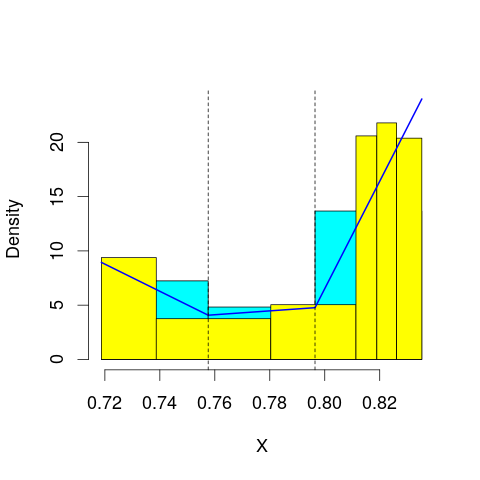

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.22658
mop.approx: Iteration 11. LL = 73.87106
mop.approx: Iteration 21. LL = 73.88333
mop.approx: Iteration 31. LL = 73.88638
mop.approx: Converged. Iteration 37. LL = 73.88708
[1] "Computing the linear combination of B-splines"


65.2227399989
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.95787
mop.approx: Iteration 11. LL = 73.65256
mop.approx: Iteration 21. LL = 73.6725
mop.approx: Iteration 31. LL = 73.67611
mop.approx: Iteration 41. LL = 73.67821
mop.approx: Iteration 51. LL = 73.67953
mop.approx: Converged. Iteration 59. LL = 73.68032
[1] "Computing the linear combination of B-splines"


63.2831095971
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.13617
mop.approx: Iteration 11. LL = 56.15432
mop.approx: Iteration 21. LL = 56.26961
mop.approx: Iteration 31. LL = 56.27304
mop.approx: Converged. Iteration 31. LL = 56.2731
[1] "Computing the linear combination of B-splines"


44.1430200583
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.47362
mop.approx: Iteration 11. LL = 55.85042
mop.approx: Converged. Iteration 16. LL = 55.85242
[1] "Computing the linear combination of B-splines"


41.9894758276
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.66403
mop.approx: Iteration 11. LL = 55.0381
mop.approx: Iteration 21. LL = 55.36996
mop.approx: Iteration 31. LL = 55.41186
mop.approx: Iteration 41. LL = 55.41799
mop.approx: Converged. Iteration 48. LL = 55.41883
[1] "Computing the linear combination of B-splines"


39.8230170831
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.483769
mop.approx: Iteration 11. LL = 52.15765
mop.approx: Iteration 21. LL = 52.23988
mop.approx: Iteration 31. LL = 52.24941
mop.approx: Iteration 41. LL = 52.25111
mop.approx: Converged. Iteration 43. LL = 52.25127
[1] "Computing the linear combination of B-splines"


34.9225947657
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.78703
mop.approx: Iteration 11. LL = 51.88767
mop.approx: Iteration 21. LL = 52.23003
mop.approx: Iteration 31. LL = 52.25411
mop.approx: Converged. Iteration 40. LL = 52.2559
[1] "Computing the linear combination of B-splines"


33.1943493607
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.49756
mop.approx: Iteration 11. LL = 75.08092
mop.approx: Iteration 21. LL = 75.09348
mop.approx: Converged. Iteration 23. LL = 75.09376
[1] "Computing the linear combination of B-splines"


66.4294215414
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 66.429421541370701)
m reached
('Sum of Probabilities:', 0.9800885457035948)
chosen


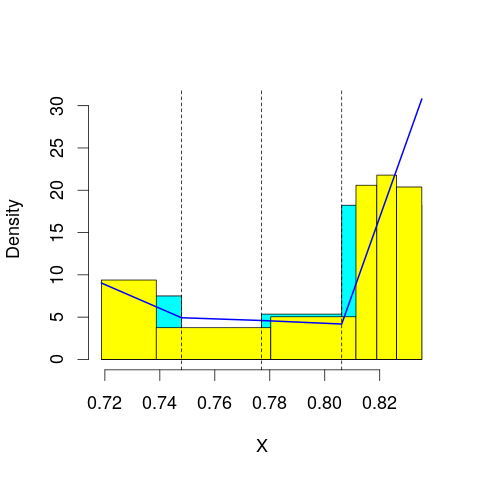

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.22658
mop.approx: Iteration 11. LL = 73.97966
mop.approx: Converged. Iteration 20. LL = 73.98238
[1] "Computing the linear combination of B-splines"


63.5851707553
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.95787
mop.approx: Iteration 11. LL = 74.46423
mop.approx: Iteration 21. LL = 74.57266
mop.approx: Iteration 31. LL = 74.62554
mop.approx: Iteration 41. LL = 74.65309
mop.approx: Iteration 51. LL = 74.66832
mop.approx: Iteration 61. LL = 74.67708
mop.approx: Iteration 71. LL = 74.68224
mop.approx: Iteration 81. LL = 74.68532
mop.approx: Iteration 91. LL = 74.68715
mop.approx: Iteration 101. LL = 74.68825
mop.approx: Converged. Iteration 103. LL = 74.68848
[1] "Computing the linear combination of B-splines"


62.558405311
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.13617
mop.approx: Iteration 11. LL = 57.98368
mop.approx: Iteration 21. LL = 58.24763
mop.approx: Iteration 31. LL = 58.26585
mop.approx: Converged. Iteration 38. LL = 58.26714
[1] "Computing the linear combination of B-splines"


44.4041988322
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.47362
mop.approx: Iteration 11. LL = 56.27673
mop.approx: Iteration 21. LL = 56.37685
mop.approx: Iteration 31. LL = 56.40213
mop.approx: Iteration 41. LL = 56.41154
mop.approx: Iteration 51. LL = 56.41599
mop.approx: Iteration 61. LL = 56.41843
mop.approx: Iteration 71. LL = 56.41993
mop.approx: Iteration 81. LL = 56.4209
mop.approx: Iteration 91. LL = 56.42158
mop.approx: Converged. Iteration 91. LL = 56.42164
[1] "Computing the linear combination of B-splines"


40.8258242436
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.66403
mop.approx: Iteration 11. LL = 57.5307
mop.approx: Converged. Iteration 17. LL = 57.53808
[1] "Computing the linear combination of B-splines"


40.2093974775
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.483769
mop.approx: Iteration 11. LL = 55.8086
mop.approx: Iteration 21. LL = 56.08165
mop.approx: Iteration 31. LL = 56.13796
mop.approx: Iteration 41. LL = 56.15983
mop.approx: Iteration 51. LL = 56.17062
mop.approx: Iteration 61. LL = 56.17668
mop.approx: Iteration 71. LL = 56.18035
mop.approx: Iteration 81. LL = 56.1827
mop.approx: Iteration 91. LL = 56.18425
mop.approx: Iteration 101. LL = 56.18529
mop.approx: Iteration 111. LL = 56.18601
mop.approx: Converged. Iteration 112. LL = 56.18612
[1] "Computing the linear combination of B-splines"


37.1245728186
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.78703
mop.approx: Iteration 11. LL = 54.3274
mop.approx: Iteration 21. LL = 54.3766
mop.approx: Iteration 31. LL = 54.37934
mop.approx: Converged. Iteration 31. LL = 54.37939
[1] "Computing the linear combination of B-splines"


33.5849839837
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.49756
mop.approx: Iteration 11. LL = 74.51368
mop.approx: Converged. Iteration 13. LL = 74.51397
[1] "Computing the linear combination of B-splines"


64.1167669804
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 64.116766980371125)
m reached
('Sum of Probabilities:', 0.9822718789728533)
chosen


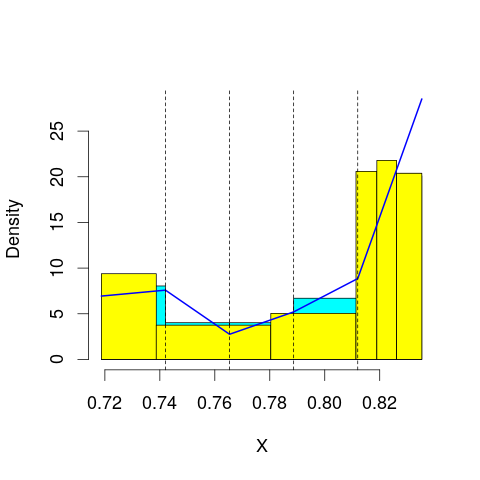

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.22658
mop.approx: Iteration 11. LL = 74.76806
mop.approx: Iteration 21. LL = 74.80454
mop.approx: Iteration 31. LL = 74.809
mop.approx: Converged. Iteration 35. LL = 74.80949
[1] "Computing the linear combination of B-splines"


62.6794099905
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.95787
mop.approx: Iteration 11. LL = 75.49432
mop.approx: Iteration 21. LL = 75.75212
mop.approx: Iteration 31. LL = 75.81989
mop.approx: Iteration 41. LL = 75.84056
mop.approx: Iteration 51. LL = 75.84816
mop.approx: Iteration 61. LL = 75.85159
mop.approx: Iteration 71. LL = 75.8534
mop.approx: Iteration 81. LL = 75.85443
mop.approx: Converged. Iteration 82. LL = 75.85458
[1] "Computing the linear combination of B-splines"


61.991640636
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.13617
mop.approx: Iteration 11. LL = 62.88604
mop.approx: Iteration 21. LL = 62.95084
mop.approx: Converged. Iteration 26. LL = 62.95189
[1] "Computing the linear combination of B-splines"


47.3560803065
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.47362
mop.approx: Iteration 11. LL = 56.46034
mop.approx: Iteration 21. LL = 56.54289
mop.approx: Iteration 31. LL = 56.56291
mop.approx: Iteration 41. LL = 56.57124
mop.approx: Iteration 51. LL = 56.57558
mop.approx: Iteration 61. LL = 56.57808
mop.approx: Iteration 71. LL = 56.5796
mop.approx: Iteration 81. LL = 56.58055
mop.approx: Converged. Iteration 88. LL = 56.58106
[1] "Computing the linear combination of B-splines"


39.2523812062
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.66403
mop.approx: Iteration 11. LL = 57.69916
mop.approx: Iteration 21. LL = 57.70641
mop.approx: Converged. Iteration 25. LL = 57.70688
[1] "Computing the linear combination of B-splines"


38.6453303088
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.483769
mop.approx: Iteration 11. LL = 58.25911
mop.approx: Iteration 21. LL = 58.31772
mop.approx: Converged. Iteration 23. LL = 58.31798
[1] "Computing the linear combination of B-splines"


37.5235479447
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.78703
mop.approx: Iteration 11. LL = 56.33564
mop.approx: Iteration 21. LL = 56.54065
mop.approx: Iteration 31. LL = 56.54994
mop.approx: Converged. Iteration 37. LL = 56.55068
[1] "Computing the linear combination of B-splines"


34.0234559562
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.49756
mop.approx: Converged. Iteration 9. LL = 74.65826
[1] "Computing the linear combination of B-splines"


62.52818788
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 62.528187879992942)
m reached
('Sum of Probabilities:', 0.9857344755734613)
chosen


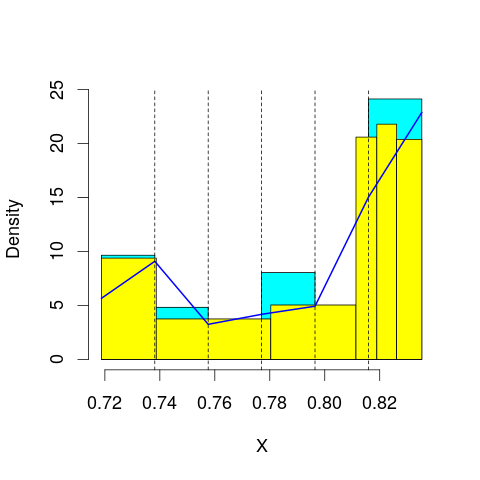

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.22658
mop.approx: Iteration 11. LL = 76.81385
mop.approx: Iteration 21. LL = 76.93003
mop.approx: Iteration 31. LL = 76.93888
mop.approx: Converged. Iteration 40. LL = 76.94026
[1] "Computing the linear combination of B-splines"


63.0773162502
('best: ', 62.528187879992942, 'accepted difference:', 106.297919395988, 'cur BIC:', 63.077316250150936)
m reached
('Sum of Probabilities:', 0.9843360671559243)
chosen


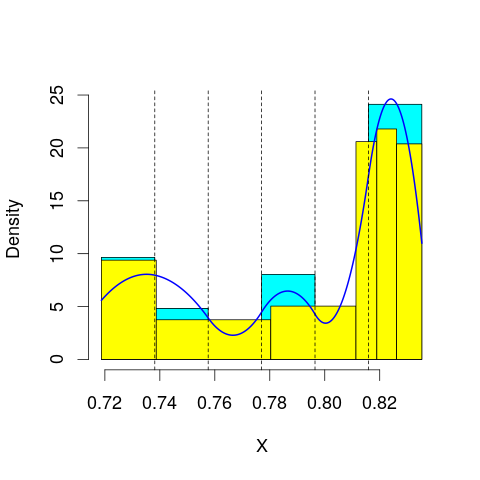

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.95787
mop.approx: Iteration 11. LL = 75.64414
mop.approx: Iteration 21. LL = 75.84024
mop.approx: Iteration 31. LL = 75.8912
mop.approx: Iteration 41. LL = 75.91089
mop.approx: Iteration 51. LL = 75.92039
mop.approx: Iteration 61. LL = 75.92564
mop.approx: Iteration 71. LL = 75.92882
mop.approx: Iteration 81. LL = 75.93088
mop.approx: Iteration 91. LL = 75.93226
mop.approx: Iteration 101. LL = 75.93323
mop.approx: Converged. Iteration 103. LL = 75.93347
[1] "Computing the linear combination of B-splines"


60.3376552657
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.13617
mop.approx: Iteration 11. LL = 64.05136
mop.approx: Converged. Iteration 16. LL = 64.0543
[1] "Computing the linear combination of B-splines"


46.7256161916
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.47362
mop.approx: Iteration 11. LL = 61.39473
mop.approx: Iteration 21. LL = 61.75337
mop.approx: Iteration 31. LL = 61.78801
mop.approx: Iteration 41. LL = 61.79237
mop.approx: Converged. Iteration 45. LL = 61.79279
[1] "Computing the linear combination of B-splines"


42.7312410154
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.66403
mop.approx: Iteration 11. LL = 57.71727
mop.approx: Iteration 21. LL = 57.74621
mop.approx: Iteration 31. LL = 57.75311
mop.approx: Iteration 41. LL = 57.75486
mop.approx: Converged. Iteration 44. LL = 57.75512
[1] "Computing the linear combination of B-splines"


36.9607017233
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.483769
mop.approx: Iteration 11. LL = 59.5997
mop.approx: Iteration 21. LL = 59.69144
mop.approx: Iteration 31. LL = 59.70653
mop.approx: Iteration 41. LL = 59.71057
mop.approx: Iteration 51. LL = 59.7119
mop.approx: Converged. Iteration 54. LL = 59.71216
[1] "Computing the linear combination of B-splines"


37.1848286419
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.78703
mop.approx: Iteration 11. LL = 58.138
mop.approx: Iteration 21. LL = 58.38642
mop.approx: Iteration 31. LL = 58.39966
mop.approx: Converged. Iteration 36. LL = 58.40028
[1] "Computing the linear combination of B-splines"


34.1400099564
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.49756
mop.approx: Iteration 11. LL = 77.45897
mop.approx: Iteration 21. LL = 77.47608
mop.approx: Converged. Iteration 22. LL = 77.47623
[1] "Computing the linear combination of B-splines"


63.6132843372
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 63.613284337170434)
m reached
('Sum of Probabilities:', 0.9895706477134626)
chosen


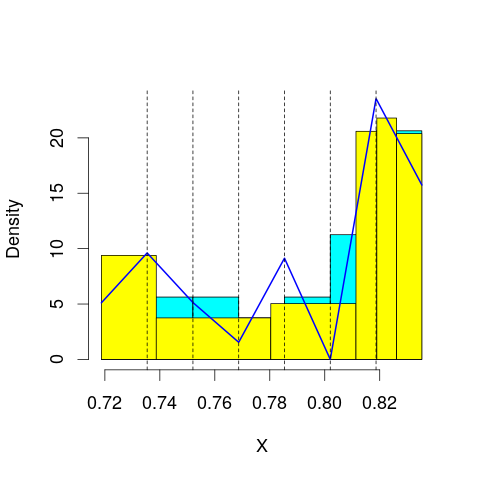

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.22658
mop.approx: Iteration 11. LL = 76.57913
mop.approx: Iteration 21. LL = 76.68385
mop.approx: Iteration 31. LL = 76.69877
mop.approx: Iteration 41. LL = 76.70153
mop.approx: Converged. Iteration 43. LL = 76.70179
[1] "Computing the linear combination of B-splines"


61.1059796065
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.95787
mop.approx: Iteration 11. LL = 76.05721
mop.approx: Iteration 21. LL = 76.1925
mop.approx: Iteration 31. LL = 76.21584
mop.approx: Iteration 41. LL = 76.22209
mop.approx: Iteration 51. LL = 76.22447
mop.approx: Iteration 61. LL = 76.22563
mop.approx: Converged. Iteration 63. LL = 76.22586
[1] "Computing the linear combination of B-splines"


58.8971804181
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.13617
mop.approx: Iteration 11. LL = 64.66031
mop.approx: Iteration 21. LL = 64.70432
mop.approx: Iteration 31. LL = 64.71807
mop.approx: Iteration 41. LL = 64.72327
mop.approx: Iteration 51. LL = 64.72554
mop.approx: Iteration 61. LL = 64.72664
mop.approx: Converged. Iteration 64. LL = 64.72691
[1] "Computing the linear combination of B-splines"


45.6653612119
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.47362
mop.approx: Iteration 11. LL = 64.06993
mop.approx: Iteration 21. LL = 64.19513
mop.approx: Iteration 31. LL = 64.20009
mop.approx: Iteration 41. LL = 64.20139
mop.approx: Converged. Iteration 46. LL = 64.20182
[1] "Computing the linear combination of B-splines"


43.4074012058
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.66403
mop.approx: Iteration 11. LL = 59.72327
mop.approx: Iteration 21. LL = 59.87558
mop.approx: Iteration 31. LL = 59.89679
mop.approx: Iteration 41. LL = 59.90414
mop.approx: Iteration 51. LL = 59.90768
mop.approx: Iteration 61. LL = 59.90964
mop.approx: Iteration 71. LL = 59.91081
mop.approx: Iteration 81. LL = 59.91156
mop.approx: Converged. Iteration 81. LL = 59.91161
[1] "Computing the linear combination of B-splines"


37.3843179884
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.483769
mop.approx: Iteration 11. LL = 59.72987
mop.approx: Iteration 21. LL = 59.7542
mop.approx: Iteration 31. LL = 59.75957
mop.approx: Iteration 41. LL = 59.76122
mop.approx: Converged. Iteration 45. LL = 59.76156
[1] "Computing the linear combination of B-splines"


35.5013844611
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.78703
mop.approx: Iteration 11. LL = 61.05731
mop.approx: Iteration 21. LL = 61.26959
mop.approx: Iteration 31. LL = 61.30702
mop.approx: Iteration 41. LL = 61.31905
mop.approx: Iteration 51. LL = 61.32351
mop.approx: Iteration 61. LL = 61.32526
mop.approx: Converged. Iteration 67. LL = 61.32581
[1] "Computing the linear combination of B-splines"


35.3311345192
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.49756
mop.approx: Iteration 11. LL = 78.50896
mop.approx: Converged. Iteration 15. LL = 78.51086
[1] "Computing the linear combination of B-splines"


62.9150532066
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 62.915053206608789)
m reached
('Sum of Probabilities:', 0.990834402448882)
chosen


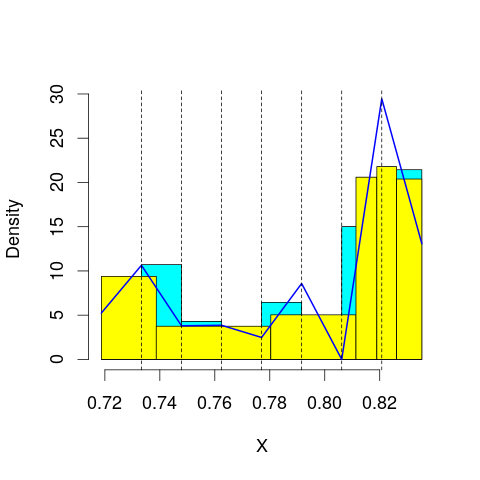

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.22658
mop.approx: Iteration 11. LL = 76.56362
mop.approx: Iteration 21. LL = 76.60201
mop.approx: Iteration 31. LL = 76.60989
mop.approx: Iteration 41. LL = 76.6131
mop.approx: Iteration 51. LL = 76.61474
mop.approx: Converged. Iteration 60. LL = 76.6157
[1] "Computing the linear combination of B-splines"


59.2870168408
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.95787
mop.approx: Iteration 11. LL = 76.80246
mop.approx: Iteration 21. LL = 76.88443
mop.approx: Iteration 31. LL = 76.89531
mop.approx: Iteration 41. LL = 76.89792
mop.approx: Converged. Iteration 46. LL = 76.89848
[1] "Computing the linear combination of B-splines"


57.8369361322
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.13617
mop.approx: Iteration 11. LL = 65.68022
mop.approx: Iteration 21. LL = 65.80775
mop.approx: Iteration 31. LL = 65.83235
mop.approx: Iteration 41. LL = 65.83733
mop.approx: Converged. Iteration 48. LL = 65.83825
[1] "Computing the linear combination of B-splines"


45.0438384392
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.47362
mop.approx: Iteration 11. LL = 65.20381
mop.approx: Iteration 21. LL = 65.32791
mop.approx: Iteration 31. LL = 65.36342
mop.approx: Iteration 41. LL = 65.37623
mop.approx: Iteration 51. LL = 65.38127
mop.approx: Iteration 61. LL = 65.38341
mop.approx: Iteration 71. LL = 65.38438
mop.approx: Converged. Iteration 71. LL = 65.38444
[1] "Computing the linear combination of B-splines"


42.8571613365
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.66403
mop.approx: Iteration 11. LL = 62.31749
mop.approx: Iteration 21. LL = 62.84607
mop.approx: Iteration 31. LL = 62.93889
mop.approx: Iteration 41. LL = 62.96124
mop.approx: Iteration 51. LL = 62.96756
mop.approx: Iteration 61. LL = 62.96947
mop.approx: Converged. Iteration 65. LL = 62.96985
[1] "Computing the linear combination of B-splines"


38.7096853448
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.483769
mop.approx: Iteration 11. LL = 60.24991
mop.approx: Iteration 21. LL = 60.30567
mop.approx: Iteration 31. LL = 60.3101
mop.approx: Converged. Iteration 33. LL = 60.31028
[1] "Computing the linear combination of B-splines"


34.3160274258
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.78703
mop.approx: Iteration 11. LL = 61.51116
mop.approx: Iteration 21. LL = 61.54729
mop.approx: Iteration 31. LL = 61.55277
mop.approx: Iteration 41. LL = 61.55524
mop.approx: Iteration 51. LL = 61.55646
mop.approx: Converged. Iteration 56. LL = 61.55689
[1] "Computing the linear combination of B-splines"


33.8336445386
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.49756
mop.approx: Iteration 11. LL = 77.98315
mop.approx: Iteration 21. LL = 78.01239
mop.approx: Iteration 31. LL = 78.01579
mop.approx: Converged. Iteration 34. LL = 78.01616
[1] "Computing the linear combination of B-splines"


60.687482909
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 60.687482909011123)
m reached
('Sum of Probabilities:', 0.9914349622409322)
chosen


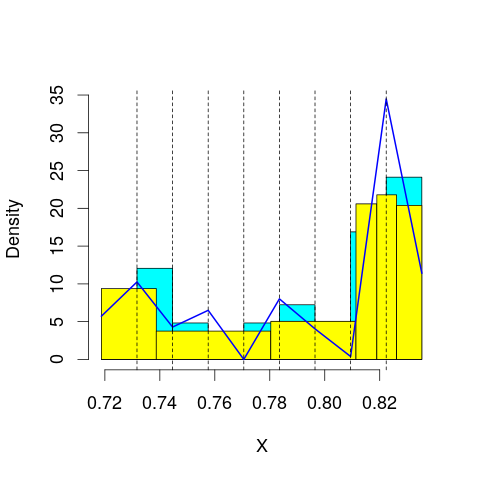

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.22658
mop.approx: Iteration 11. LL = 77.44452
mop.approx: Iteration 21. LL = 77.46574
mop.approx: Iteration 31. LL = 77.46822
mop.approx: Converged. Iteration 33. LL = 77.46846
[1] "Computing the linear combination of B-splines"


58.4069114717
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.95787
mop.approx: Iteration 11. LL = 77.97551
mop.approx: Iteration 21. LL = 78.19543
mop.approx: Iteration 31. LL = 78.22745
mop.approx: Iteration 41. LL = 78.23676
mop.approx: Iteration 51. LL = 78.24063
mop.approx: Iteration 61. LL = 78.24255
mop.approx: Iteration 71. LL = 78.24361
mop.approx: Converged. Iteration 71. LL = 78.24369
[1] "Computing the linear combination of B-splines"


57.4492709272
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.13617
mop.approx: Iteration 11. LL = 66.4695
mop.approx: Iteration 21. LL = 66.52089
mop.approx: Iteration 31. LL = 66.52336
mop.approx: Converged. Iteration 36. LL = 66.52382
[1] "Computing the linear combination of B-splines"


43.996540513
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.47362
mop.approx: Iteration 11. LL = 66.40877
mop.approx: Iteration 21. LL = 66.5092
mop.approx: Iteration 31. LL = 66.52968
mop.approx: Iteration 41. LL = 66.53527
mop.approx: Iteration 51. LL = 66.53714
mop.approx: Converged. Iteration 56. LL = 66.53763
[1] "Computing the linear combination of B-splines"


42.2774837108
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.66403
mop.approx: Iteration 11. LL = 64.13537
mop.approx: Iteration 21. LL = 64.51363
mop.approx: Iteration 31. LL = 64.56047
mop.approx: Iteration 41. LL = 64.57006
mop.approx: Iteration 51. LL = 64.57273
mop.approx: Converged. Iteration 58. LL = 64.57347
[1] "Computing the linear combination of B-splines"


38.5804393804
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.483769
mop.approx: Iteration 11. LL = 61.16955
mop.approx: Iteration 21. LL = 61.3512
mop.approx: Iteration 31. LL = 61.39115
mop.approx: Iteration 41. LL = 61.40404
mop.approx: Iteration 51. LL = 61.40904
mop.approx: Iteration 61. LL = 61.41115
mop.approx: Iteration 71. LL = 61.41208
mop.approx: Converged. Iteration 71. LL = 61.41214
[1] "Computing the linear combination of B-splines"


33.685786019
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.78703
mop.approx: Iteration 11. LL = 61.51458
mop.approx: Iteration 21. LL = 61.53233
mop.approx: Iteration 31. LL = 61.53906
mop.approx: Iteration 41. LL = 61.54231
mop.approx: Iteration 51. LL = 61.54392
mop.approx: Converged. Iteration 60. LL = 61.54472
[1] "Computing the linear combination of B-splines"


32.0732067868
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.49756
mop.approx: Iteration 11. LL = 78.079
mop.approx: Iteration 21. LL = 78.093
mop.approx: Iteration 31. LL = 78.09574
mop.approx: Converged. Iteration 39. LL = 78.0967
[1] "Computing the linear combination of B-splines"


59.0351540084
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 59.035154008369823)
m reached
('Sum of Probabilities:', 0.9910739581247352)
chosen


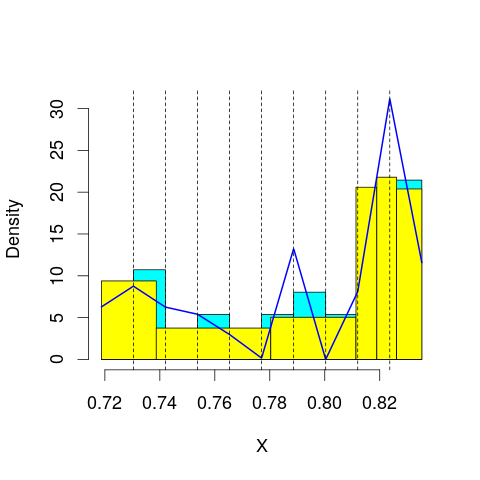

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.22658
mop.approx: Iteration 11. LL = 78.63327
mop.approx: Iteration 21. LL = 78.71879
mop.approx: Iteration 31. LL = 78.73207
mop.approx: Iteration 41. LL = 78.73511
mop.approx: Converged. Iteration 45. LL = 78.73561
[1] "Computing the linear combination of B-splines"


57.9411897237
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.95787
mop.approx: Iteration 11. LL = 78.79511
mop.approx: Iteration 21. LL = 79.10163
mop.approx: Iteration 31. LL = 79.15488
mop.approx: Iteration 41. LL = 79.16665
mop.approx: Iteration 51. LL = 79.1696
mop.approx: Converged. Iteration 56. LL = 79.17021
[1] "Computing the linear combination of B-splines"


56.6429311634
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.13617
mop.approx: Iteration 11. LL = 66.7409
mop.approx: Iteration 21. LL = 66.80593
mop.approx: Iteration 31. LL = 66.81385
mop.approx: Converged. Iteration 38. LL = 66.81493
[1] "Computing the linear combination of B-splines"


42.5547798938
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.47362
mop.approx: Iteration 11. LL = 67.56268
mop.approx: Iteration 21. LL = 67.61235
mop.approx: Iteration 31. LL = 67.61914
mop.approx: Iteration 41. LL = 67.62261
mop.approx: Iteration 51. LL = 67.62475
mop.approx: Iteration 61. LL = 67.62614
mop.approx: Iteration 71. LL = 67.62708
mop.approx: Converged. Iteration 75. LL = 67.62743
[1] "Computing the linear combination of B-splines"


41.6344131088
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.66403
mop.approx: Iteration 11. LL = 65.85402
mop.approx: Iteration 21. LL = 66.0408
mop.approx: Iteration 31. LL = 66.05126
mop.approx: Iteration 41. LL = 66.05303
mop.approx: Iteration 51. LL = 66.05391
mop.approx: Converged. Iteration 55. LL = 66.05426
[1] "Computing the linear combination of B-splines"


38.3284471555
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.483769
mop.approx: Iteration 11. LL = 62.34966
mop.approx: Iteration 21. LL = 62.65375
mop.approx: Iteration 31. LL = 62.7319
mop.approx: Iteration 41. LL = 62.76156
mop.approx: Iteration 51. LL = 62.77414
mop.approx: Iteration 61. LL = 62.77958
mop.approx: Iteration 71. LL = 62.78194
mop.approx: Iteration 81. LL = 62.78296
mop.approx: Converged. Iteration 82. LL = 62.78308
[1] "Computing the linear combination of B-splines"


33.3263092746
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.78703
mop.approx: Iteration 11. LL = 61.79902
mop.approx: Iteration 21. LL = 61.83619
mop.approx: Iteration 31. LL = 61.84562
mop.approx: Iteration 41. LL = 61.84821
mop.approx: Converged. Iteration 46. LL = 61.84873
[1] "Computing the linear combination of B-splines"


30.6002000729
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.49756
mop.approx: Iteration 11. LL = 79.16582
mop.approx: Iteration 21. LL = 79.17411
mop.approx: Converged. Iteration 21. LL = 79.17417
[1] "Computing the linear combination of B-splines"


58.3797544971
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 58.379754497063004)
m reached
('Sum of Probabilities:', 0.9905888324002605)
chosen


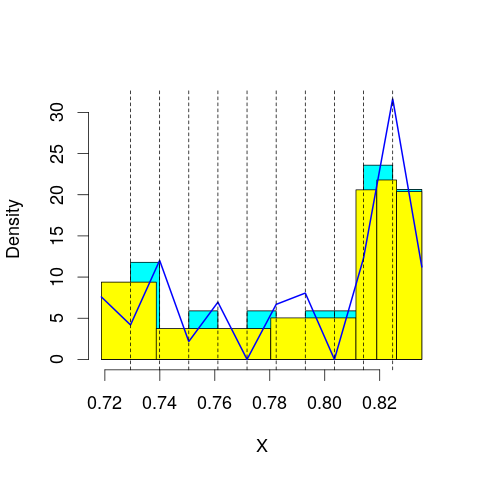

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.22658
mop.approx: Iteration 11. LL = 79.6736
mop.approx: Iteration 21. LL = 79.80012
mop.approx: Iteration 31. LL = 79.81368
mop.approx: Iteration 41. LL = 79.81678
mop.approx: Converged. Iteration 47. LL = 79.81751
[1] "Computing the linear combination of B-splines"


57.2902270357
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.95787
mop.approx: Iteration 11. LL = 78.62028
mop.approx: Iteration 21. LL = 78.77727
mop.approx: Iteration 31. LL = 78.79271
mop.approx: Converged. Iteration 39. LL = 78.79447
[1] "Computing the linear combination of B-splines"


54.534317846
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.13617
mop.approx: Iteration 11. LL = 67.10235
mop.approx: Iteration 21. LL = 67.21538
mop.approx: Iteration 31. LL = 67.23247
mop.approx: Iteration 41. LL = 67.23681
mop.approx: Iteration 51. LL = 67.23841
mop.approx: Converged. Iteration 58. LL = 67.23907
[1] "Computing the linear combination of B-splines"


41.2460528655
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.47362
mop.approx: Iteration 11. LL = 68.43686
mop.approx: Iteration 21. LL = 68.47902
mop.approx: Iteration 31. LL = 68.48489
mop.approx: Converged. Iteration 36. LL = 68.48552
[1] "Computing the linear combination of B-splines"


40.7596227348
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.66403
mop.approx: Iteration 11. LL = 67.23651
mop.approx: Iteration 21. LL = 67.31422
mop.approx: Iteration 31. LL = 67.32241
mop.approx: Iteration 41. LL = 67.32672
mop.approx: Iteration 51. LL = 67.32948
mop.approx: Iteration 61. LL = 67.33131
mop.approx: Iteration 71. LL = 67.33255
mop.approx: Iteration 81. LL = 67.33339
mop.approx: Converged. Iteration 82. LL = 67.33353
[1] "Computing the linear combination of B-splines"


37.8750156694
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.483769
mop.approx: Iteration 11. LL = 64.07045
mop.approx: Iteration 21. LL = 64.53912
mop.approx: Iteration 31. LL = 64.62525
mop.approx: Iteration 41. LL = 64.65017
mop.approx: Iteration 51. LL = 64.65925
mop.approx: Iteration 61. LL = 64.66285
mop.approx: Iteration 71. LL = 64.66435
mop.approx: Converged. Iteration 76. LL = 64.66479
[1] "Computing the linear combination of B-splines"


33.4798189416
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.78703
mop.approx: Iteration 11. LL = 63.40148
mop.approx: Iteration 21. LL = 63.5334
mop.approx: Iteration 31. LL = 63.5501
mop.approx: Iteration 41. LL = 63.55372
mop.approx: Converged. Iteration 50. LL = 63.55474
[1] "Computing the linear combination of B-splines"


30.4467328468
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.49756
mop.approx: Iteration 11. LL = 79.81015
mop.approx: Iteration 21. LL = 79.86602
mop.approx: Iteration 31. LL = 79.87625
mop.approx: Iteration 41. LL = 79.87866
mop.approx: Converged. Iteration 43. LL = 79.87893
[1] "Computing the linear combination of B-splines"


57.351643391
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 57.351643390987789)
m reached
('Sum of Probabilities:', 0.989891372028857)
chosen


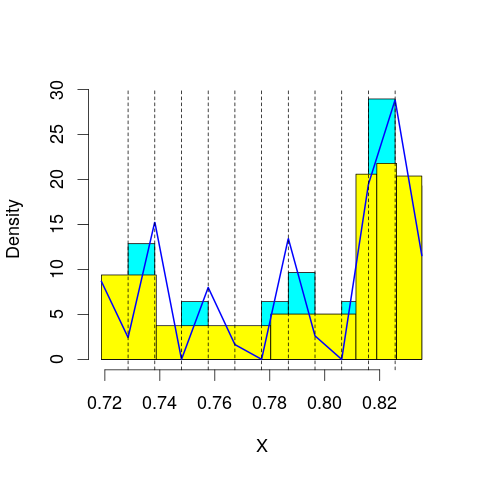

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.22658
mop.approx: Iteration 11. LL = 80.04069
mop.approx: Iteration 21. LL = 80.15183
mop.approx: Iteration 31. LL = 80.17487
mop.approx: Iteration 41. LL = 80.18303
mop.approx: Iteration 51. LL = 80.18649
mop.approx: Iteration 61. LL = 80.1881
mop.approx: Converged. Iteration 66. LL = 80.18865
[1] "Computing the linear combination of B-splines"


55.928498714
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.95787
mop.approx: Iteration 11. LL = 79.4234
mop.approx: Iteration 21. LL = 79.65822
mop.approx: Iteration 31. LL = 79.68371
mop.approx: Iteration 41. LL = 79.68876
mop.approx: Iteration 51. LL = 79.69038
mop.approx: Converged. Iteration 53. LL = 79.69064
[1] "Computing the linear combination of B-splines"


53.6976190981
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.13617
mop.approx: Iteration 11. LL = 67.12825
mop.approx: Iteration 21. LL = 67.16138
mop.approx: Converged. Iteration 29. LL = 67.1636
[1] "Computing the linear combination of B-splines"


39.4377101369
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.47362
mop.approx: Iteration 11. LL = 69.50109
mop.approx: Iteration 21. LL = 69.68025
mop.approx: Iteration 31. LL = 69.71501
mop.approx: Iteration 41. LL = 69.72366
mop.approx: Iteration 51. LL = 69.72628
mop.approx: Converged. Iteration 59. LL = 69.72717
[1] "Computing the linear combination of B-splines"


40.2684262731
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.66403
mop.approx: Iteration 11. LL = 68.48184
mop.approx: Iteration 21. LL = 68.52923
mop.approx: Iteration 31. LL = 68.53677
mop.approx: Converged. Iteration 39. LL = 68.53807
[1] "Computing the linear combination of B-splines"


37.3458297143
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.483769
mop.approx: Iteration 11. LL = 65.71786
mop.approx: Iteration 21. LL = 66.04697
mop.approx: Iteration 31. LL = 66.08269
mop.approx: Iteration 41. LL = 66.09178
mop.approx: Iteration 51. LL = 66.09645
mop.approx: Iteration 61. LL = 66.0995
mop.approx: Iteration 71. LL = 66.10158
mop.approx: Iteration 81. LL = 66.10303
mop.approx: Iteration 91. LL = 66.10404
mop.approx: Converged. Iteration 98. LL = 66.10462
[1] "Computing the linear combination of B-splines"


33.2004906208
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.78703
mop.approx: Iteration 11. LL = 63.57356
mop.approx: Iteration 21. LL = 63.70959
mop.approx: Iteration 31. LL = 63.74166
mop.approx: Iteration 41. LL = 63.75181
mop.approx: Iteration 51. LL = 63.75576
mop.approx: Iteration 61. LL = 63.75758
mop.approx: Iteration 71. LL = 63.75851
mop.approx: Converged. Iteration 72. LL = 63.75864
[1] "Computing the linear combination of B-splines"


29.3116532691
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.49756
mop.approx: Iteration 11. LL = 81.32153
mop.approx: Iteration 21. LL = 81.3343
mop.approx: Converged. Iteration 27. LL = 81.33525
[1] "Computing the linear combination of B-splines"


57.0750989986
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 57.075098998554161)
m reached
('Sum of Probabilities:', 0.9899358349384142)
chosen


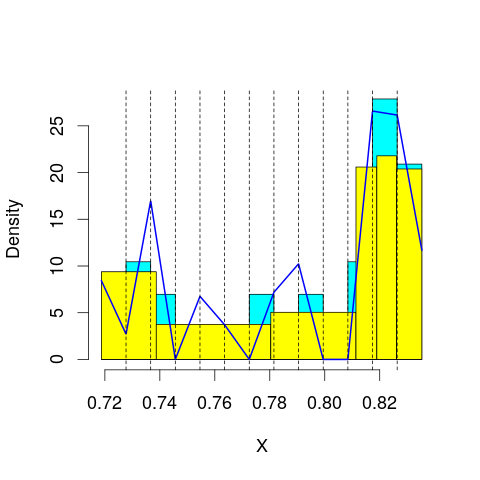

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.22658
mop.approx: Iteration 11. LL = 79.72482
mop.approx: Iteration 21. LL = 79.91763
mop.approx: Iteration 31. LL = 79.96211
mop.approx: Iteration 41. LL = 79.97492
mop.approx: Iteration 51. LL = 79.97906
mop.approx: Iteration 61. LL = 79.98047
mop.approx: Converged. Iteration 61. LL = 79.98055
[1] "Computing the linear combination of B-splines"


53.9875301824
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.95787
mop.approx: Iteration 11. LL = 80.0789
mop.approx: Iteration 21. LL = 80.17469
mop.approx: Iteration 31. LL = 80.18103
mop.approx: Converged. Iteration 33. LL = 80.18132
[1] "Computing the linear combination of B-splines"


52.4554345374
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.13617
mop.approx: Iteration 11. LL = 68.17012
mop.approx: Iteration 21. LL = 68.32452
mop.approx: Iteration 31. LL = 68.3385
mop.approx: Converged. Iteration 38. LL = 68.33967
[1] "Computing the linear combination of B-splines"


38.8809179714
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.47362
mop.approx: Iteration 11. LL = 69.78509
mop.approx: Iteration 21. LL = 69.83686
mop.approx: Iteration 31. LL = 69.83998
mop.approx: Converged. Iteration 32. LL = 69.84012
[1] "Computing the linear combination of B-splines"


38.6484871658
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.66403
mop.approx: Iteration 11. LL = 69.93024
mop.approx: Iteration 21. LL = 70.11882
mop.approx: Iteration 31. LL = 70.15745
mop.approx: Iteration 41. LL = 70.16835
mop.approx: Iteration 51. LL = 70.17292
mop.approx: Iteration 61. LL = 70.17523
mop.approx: Iteration 71. LL = 70.17651
mop.approx: Converged. Iteration 77. LL = 70.17707
[1] "Computing the linear combination of B-splines"


37.2523049021
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.483769
mop.approx: Iteration 11. LL = 67.47712
mop.approx: Iteration 21. LL = 67.64793
mop.approx: Iteration 31. LL = 67.66255
mop.approx: Iteration 41. LL = 67.66634
mop.approx: Converged. Iteration 50. LL = 67.66751
[1] "Computing the linear combination of B-splines"


33.0022187611
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.78703
mop.approx: Iteration 11. LL = 67.7673
mop.approx: Iteration 21. LL = 67.89747
mop.approx: Iteration 31. LL = 67.9281
mop.approx: Iteration 41. LL = 67.93922
mop.approx: Iteration 51. LL = 67.94439
mop.approx: Iteration 61. LL = 67.94715
mop.approx: Iteration 71. LL = 67.94874
mop.approx: Iteration 81. LL = 67.9497
mop.approx: Converged. Iteration 83. LL = 67.94991
[1] "Computing the linear combination of B-splines"


32.247689399
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.49756
mop.approx: Iteration 11. LL = 79.77471
mop.approx: Iteration 21. LL = 79.79009
mop.approx: Iteration 31. LL = 79.79903
mop.approx: Iteration 41. LL = 79.80364
mop.approx: Iteration 51. LL = 79.80582
mop.approx: Converged. Iteration 58. LL = 79.80667
[1] "Computing the linear combination of B-splines"


53.8136504318
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 53.813650431846639)
m reached
('Sum of Probabilities:', 0.9901832190216336)
chosen


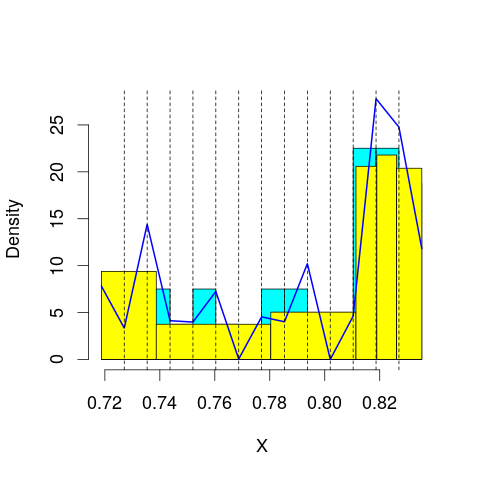

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.22658
mop.approx: Iteration 11. LL = 80.77767
mop.approx: Iteration 21. LL = 80.89184
mop.approx: Iteration 31. LL = 80.90309
mop.approx: Converged. Iteration 38. LL = 80.90436
[1] "Computing the linear combination of B-splines"


53.1784712141
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.95787
mop.approx: Iteration 11. LL = 80.12796
mop.approx: Iteration 21. LL = 80.29617
mop.approx: Iteration 31. LL = 80.31666
mop.approx: Iteration 41. LL = 80.32009
mop.approx: Converged. Iteration 45. LL = 80.32059
[1] "Computing the linear combination of B-splines"


50.8618381979
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.13617
mop.approx: Iteration 11. LL = 69.73025
mop.approx: Iteration 21. LL = 69.78058
mop.approx: Converged. Iteration 26. LL = 69.78155
[1] "Computing the linear combination of B-splines"


38.5899241443
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.47362
mop.approx: Iteration 11. LL = 69.71871
mop.approx: Iteration 21. LL = 69.83811
mop.approx: Iteration 31. LL = 69.8544
mop.approx: Iteration 41. LL = 69.85796
mop.approx: Iteration 51. LL = 69.85928
mop.approx: Converged. Iteration 54. LL = 69.85958
[1] "Computing the linear combination of B-splines"


36.9350689626
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.66403
mop.approx: Iteration 11. LL = 71.07352
mop.approx: Iteration 21. LL = 71.1785
mop.approx: Iteration 31. LL = 71.19541
mop.approx: Iteration 41. LL = 71.19985
mop.approx: Converged. Iteration 50. LL = 71.2011
[1] "Computing the linear combination of B-splines"


36.5444323067
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.483769
mop.approx: Iteration 11. LL = 69.21503
mop.approx: Iteration 21. LL = 69.40995
mop.approx: Iteration 31. LL = 69.44068
mop.approx: Iteration 41. LL = 69.44751
mop.approx: Iteration 51. LL = 69.44995
mop.approx: Iteration 61. LL = 69.45118
mop.approx: Converged. Iteration 66. LL = 69.45164
[1] "Computing the linear combination of B-splines"


33.0442068649
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.78703
[1] "Computing the linear combination of B-splines"


36.0126721266
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.49756
mop.approx: Iteration 11. LL = 80.1473
mop.approx: Iteration 21. LL = 80.17176
mop.approx: Iteration 31. LL = 80.17444
mop.approx: Converged. Iteration 31. LL = 80.17451
[1] "Computing the linear combination of B-splines"


52.4486226304
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 52.448622630392009)
m reached
('Sum of Probabilities:', 0.9901995144320881)
chosen


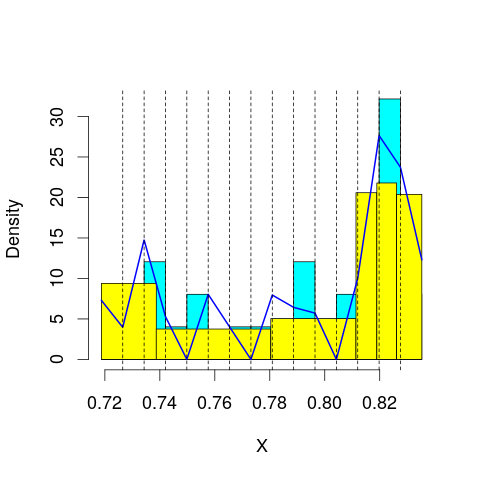

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.22658
mop.approx: Iteration 11. LL = 81.2202
mop.approx: Iteration 21. LL = 81.31402
mop.approx: Iteration 31. LL = 81.33011
mop.approx: Iteration 41. LL = 81.33555
mop.approx: Iteration 51. LL = 81.33811
mop.approx: Iteration 61. LL = 81.33957
mop.approx: Converged. Iteration 69. LL = 81.34043
[1] "Computing the linear combination of B-splines"


51.8816713348
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.95787
mop.approx: Iteration 11. LL = 80.05673
mop.approx: Iteration 21. LL = 80.16077
mop.approx: Iteration 31. LL = 80.18046
mop.approx: Iteration 41. LL = 80.18677
mop.approx: Iteration 51. LL = 80.18947
mop.approx: Iteration 61. LL = 80.19086
mop.approx: Converged. Iteration 66. LL = 80.1914
[1] "Computing the linear combination of B-splines"


48.9997770958
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.13617
mop.approx: Iteration 11. LL = 71.17283
mop.approx: Iteration 21. LL = 71.23861
mop.approx: Iteration 31. LL = 71.24678
mop.approx: Converged. Iteration 38. LL = 71.24786
[1] "Computing the linear combination of B-splines"


38.3233687291
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.47362
mop.approx: Iteration 11. LL = 70.01928
mop.approx: Iteration 21. LL = 70.16116
mop.approx: Iteration 31. LL = 70.17557
mop.approx: Converged. Iteration 37. LL = 70.17668
[1] "Computing the linear combination of B-splines"


35.519301684
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.66403
mop.approx: Iteration 11. LL = 71.67097
mop.approx: Iteration 21. LL = 71.75852
mop.approx: Iteration 31. LL = 71.77119
mop.approx: Iteration 41. LL = 71.77443
mop.approx: Iteration 51. LL = 71.77587
mop.approx: Converged. Iteration 59. LL = 71.77663
[1] "Computing the linear combination of B-splines"


35.3847282567
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.483769
mop.approx: Iteration 11. LL = 70.99437
mop.approx: Iteration 21. LL = 71.17955
mop.approx: Iteration 31. LL = 71.21146
mop.approx: Iteration 41. LL = 71.21706
mop.approx: Iteration 51. LL = 71.21836
mop.approx: Converged. Iteration 51. LL = 71.21843
[1] "Computing the linear combination of B-splines"


33.0703279223
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.78703
mop.approx: Iteration 11. LL = 72.29522
mop.approx: Iteration 21. LL = 72.35794
mop.approx: Iteration 31. LL = 72.36523
mop.approx: Converged. Iteration 39. LL = 72.36642
[1] "Computing the linear combination of B-splines"


29.9644062062
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.49756
mop.approx: Iteration 11. LL = 80.83909
mop.approx: Iteration 21. LL = 80.86035
mop.approx: Iteration 31. LL = 80.86461
mop.approx: Iteration 41. LL = 80.86632
mop.approx: Converged. Iteration 50. LL = 80.86728
[1] "Computing the linear combination of B-splines"


51.408526651
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 51.408526650998304)
m reached
('Sum of Probabilities:', 0.9895981112065849)
chosen


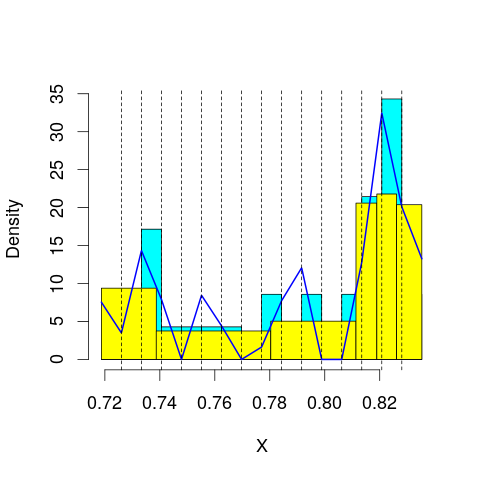

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.22658
mop.approx: Iteration 11. LL = 81.41924
mop.approx: Iteration 21. LL = 81.47334
mop.approx: Iteration 31. LL = 81.4826
mop.approx: Iteration 41. LL = 81.48634
mop.approx: Iteration 51. LL = 81.48824
mop.approx: Iteration 61. LL = 81.48932
mop.approx: Converged. Iteration 61. LL = 81.4894
[1] "Computing the linear combination of B-splines"


50.2977773939
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.95787
mop.approx: Iteration 11. LL = 80.51541
mop.approx: Iteration 21. LL = 80.6054
mop.approx: Iteration 31. LL = 80.6186
mop.approx: Iteration 41. LL = 80.62161
mop.approx: Converged. Iteration 45. LL = 80.62214
[1] "Computing the linear combination of B-splines"


47.6976459971
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.13617
mop.approx: Iteration 11. LL = 72.31399
mop.approx: Iteration 21. LL = 72.38889
mop.approx: Iteration 31. LL = 72.41493
mop.approx: Iteration 41. LL = 72.426
mop.approx: Iteration 51. LL = 72.43074
mop.approx: Iteration 61. LL = 72.43278
mop.approx: Converged. Iteration 68. LL = 72.43355
[1] "Computing the linear combination of B-splines"


37.7761879463
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.47362
mop.approx: Iteration 11. LL = 70.79932
mop.approx: Iteration 21. LL = 70.86208
mop.approx: Iteration 31. LL = 70.86881
mop.approx: Converged. Iteration 37. LL = 70.86961
[1] "Computing the linear combination of B-splines"


34.479396907
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.66403
mop.approx: Iteration 11. LL = 71.87197
mop.approx: Iteration 21. LL = 72.04804
mop.approx: Iteration 31. LL = 72.10754
mop.approx: Iteration 41. LL = 72.12989
mop.approx: Iteration 51. LL = 72.13805
mop.approx: Iteration 61. LL = 72.14107
mop.approx: Iteration 71. LL = 72.14225
mop.approx: Converged. Iteration 71. LL = 72.14232
[1] "Computing the linear combination of B-splines"


34.0189705417
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.483769
mop.approx: Iteration 11. LL = 72.0545
mop.approx: Iteration 21. LL = 72.13139
mop.approx: Iteration 31. LL = 72.1414
mop.approx: Iteration 41. LL = 72.14353
mop.approx: Converged. Iteration 43. LL = 72.14375
[1] "Computing the linear combination of B-splines"


32.1550083475
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.78703
[1] "Computing the linear combination of B-splines"


45.7964551089
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.49756
mop.approx: Iteration 11. LL = 82.48292
mop.approx: Iteration 21. LL = 82.49761
mop.approx: Converged. Iteration 22. LL = 82.49777
[1] "Computing the linear combination of B-splines"


51.3061449382
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 51.306144938202451)
m reached
('Sum of Probabilities:', 0.9888211997354569)
chosen


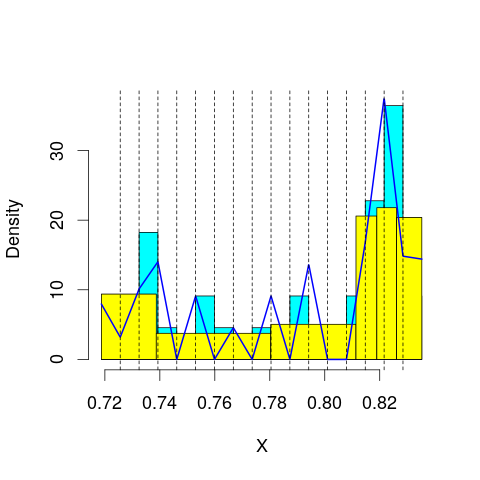

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.22658
mop.approx: Iteration 11. LL = 81.83072
mop.approx: Iteration 21. LL = 81.89374
mop.approx: Iteration 31. LL = 81.90425
mop.approx: Iteration 41. LL = 81.90771
mop.approx: Converged. Iteration 50. LL = 81.90897
[1] "Computing the linear combination of B-splines"


48.9844814303
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.95787
mop.approx: Iteration 11. LL = 80.94422
mop.approx: Iteration 21. LL = 81.043
mop.approx: Iteration 31. LL = 81.06583
mop.approx: Iteration 41. LL = 81.07406
mop.approx: Iteration 51. LL = 81.07739
mop.approx: Iteration 61. LL = 81.07878
mop.approx: Converged. Iteration 62. LL = 81.07894
[1] "Computing the linear combination of B-splines"


46.4215846153
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.13617
mop.approx: Iteration 11. LL = 73.51768
mop.approx: Iteration 21. LL = 73.61439
mop.approx: Iteration 31. LL = 73.62395
mop.approx: Converged. Iteration 40. LL = 73.62554
[1] "Computing the linear combination of B-splines"


37.2353117558
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.47362
mop.approx: Iteration 11. LL = 71.57765
mop.approx: Iteration 21. LL = 71.61994
mop.approx: Iteration 31. LL = 71.63668
mop.approx: Iteration 41. LL = 71.64272
mop.approx: Iteration 51. LL = 71.64437
mop.approx: Converged. Iteration 51. LL = 71.64443
[1] "Computing the linear combination of B-splines"


33.5213135119
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.66403
mop.approx: Iteration 11. LL = 72.01822
mop.approx: Iteration 21. LL = 72.11904
mop.approx: Iteration 31. LL = 72.13005
mop.approx: Converged. Iteration 39. LL = 72.1314
[1] "Computing the linear combination of B-splines"


32.2759499766
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.483769
mop.approx: Iteration 11. LL = 72.74568
mop.approx: Iteration 21. LL = 72.83756
mop.approx: Iteration 31. LL = 72.84928
mop.approx: Iteration 41. LL = 72.85197
mop.approx: Converged. Iteration 48. LL = 72.85278
[1] "Computing the linear combination of B-splines"


30.9933746876
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.78703
[1] "Computing the linear combination of B-splines"


7.25832716122
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.49756
mop.approx: Iteration 11. LL = 80.70499
mop.approx: Iteration 21. LL = 80.80113
mop.approx: Iteration 31. LL = 80.82213
mop.approx: Iteration 41. LL = 80.82872
mop.approx: Iteration 51. LL = 80.83151
mop.approx: Iteration 61. LL = 80.83298
mop.approx: Converged. Iteration 68. LL = 80.83372
[1] "Computing the linear combination of B-splines"


47.9092262727
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 47.909226272738891)
m reached
('Sum of Probabilities:', 0.9878825671896508)
chosen


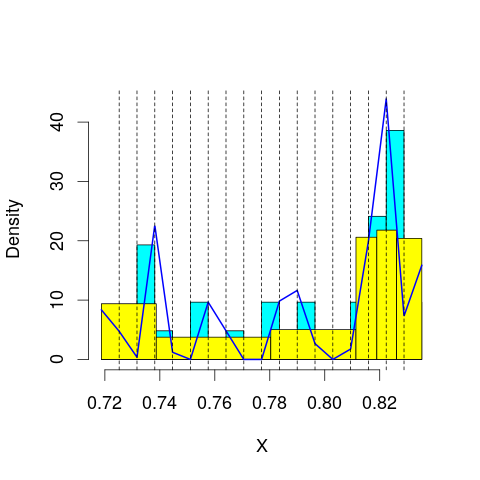

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.22658
mop.approx: Iteration 11. LL = 83.4975
mop.approx: Iteration 21. LL = 83.52404
mop.approx: Converged. Iteration 23. LL = 83.52434
[1] "Computing the linear combination of B-splines"


48.8669842907
('best: ', 47.909226272738891, 'accepted difference:', 81.445684663656124, 'cur BIC:', 48.866984290730677)
m reached
('Sum of Probabilities:', 0.968865403592015)
chosen


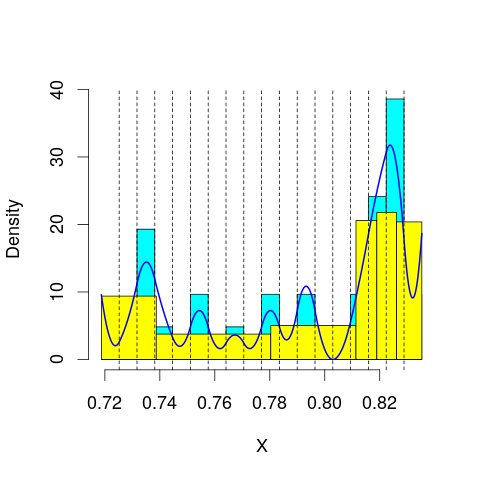

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.95787
mop.approx: Iteration 11. LL = 80.6695
mop.approx: Iteration 21. LL = 80.82697
mop.approx: Iteration 31. LL = 80.85908
mop.approx: Iteration 41. LL = 80.86824
mop.approx: Iteration 51. LL = 80.87148
mop.approx: Iteration 61. LL = 80.87287
mop.approx: Converged. Iteration 63. LL = 80.87313
[1] "Computing the linear combination of B-splines"


44.482901184
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.13617
mop.approx: Iteration 11. LL = 74.31534
mop.approx: Iteration 21. LL = 74.40493
mop.approx: Iteration 31. LL = 74.42778
mop.approx: Iteration 41. LL = 74.43708
mop.approx: Iteration 51. LL = 74.44168
mop.approx: Iteration 61. LL = 74.44418
mop.approx: Iteration 71. LL = 74.44562
mop.approx: Converged. Iteration 78. LL = 74.44633
[1] "Computing the linear combination of B-splines"


36.3232348827
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.47362
mop.approx: Iteration 11. LL = 72.61217
mop.approx: Iteration 21. LL = 72.74019
mop.approx: Iteration 31. LL = 72.76209
mop.approx: Iteration 41. LL = 72.76626
mop.approx: Converged. Iteration 46. LL = 72.76689
[1] "Computing the linear combination of B-splines"


32.9109049418
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.66403
mop.approx: Iteration 11. LL = 72.13634
mop.approx: Iteration 21. LL = 72.1758
mop.approx: Iteration 31. LL = 72.18689
mop.approx: Iteration 41. LL = 72.1916
mop.approx: Iteration 51. LL = 72.19363
mop.approx: Iteration 61. LL = 72.19461
mop.approx: Converged. Iteration 61. LL = 72.19468
[1] "Computing the linear combination of B-splines"


30.598466239
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.483769
mop.approx: Iteration 11. LL = 73.12901
mop.approx: Iteration 21. LL = 73.23824
mop.approx: Iteration 31. LL = 73.26529
mop.approx: Iteration 41. LL = 73.27467
mop.approx: Iteration 51. LL = 73.27889
mop.approx: Iteration 61. LL = 73.28116
mop.approx: Iteration 71. LL = 73.28253
mop.approx: Converged. Iteration 80. LL = 73.2834
[1] "Computing the linear combination of B-splines"


29.4506566984
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.78703
[1] "Computing the linear combination of B-splines"


0.0806563187318
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.49756
mop.approx: Iteration 11. LL = 84.78745
mop.approx: Iteration 21. LL = 84.88168
mop.approx: Iteration 31. LL = 84.89928
mop.approx: Iteration 41. LL = 84.90376
mop.approx: Converged. Iteration 50. LL = 84.9051
[1] "Computing the linear combination of B-splines"


50.2477423156
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 50.247742315624514)
m reached
('Sum of Probabilities:', 0.9868653865276957)
chosen


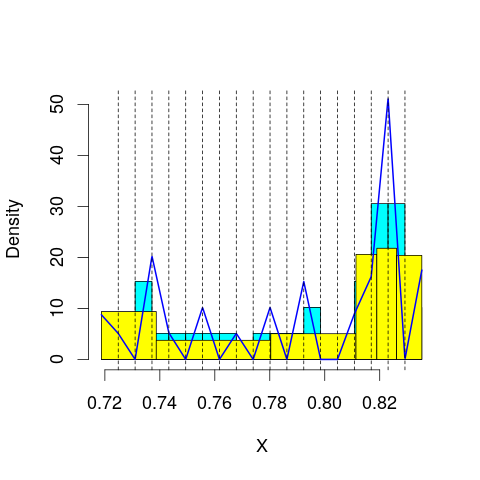

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.22658
mop.approx: Iteration 11. LL = 82.33617
mop.approx: Iteration 21. LL = 82.40027
mop.approx: Iteration 31. LL = 82.40473
mop.approx: Converged. Iteration 32. LL = 82.40488
[1] "Computing the linear combination of B-splines"


46.0146577683
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.95787
mop.approx: Iteration 11. LL = 82.14428
mop.approx: Iteration 21. LL = 82.33439
mop.approx: Iteration 31. LL = 82.39298
mop.approx: Iteration 41. LL = 82.41581
mop.approx: Iteration 51. LL = 82.42535
mop.approx: Iteration 61. LL = 82.42947
mop.approx: Iteration 71. LL = 82.43127
mop.approx: Converged. Iteration 75. LL = 82.43176
[1] "Computing the linear combination of B-splines"


44.308660401
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.13617
mop.approx: Iteration 11. LL = 74.31442
mop.approx: Iteration 21. LL = 74.36889
mop.approx: Iteration 31. LL = 74.38098
mop.approx: Iteration 41. LL = 74.38678
mop.approx: Iteration 51. LL = 74.39026
mop.approx: Iteration 61. LL = 74.39244
mop.approx: Iteration 71. LL = 74.39383
mop.approx: Converged. Iteration 80. LL = 74.39472
[1] "Computing the linear combination of B-splines"


34.5387595345
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.47362
mop.approx: Iteration 11. LL = 73.71113
mop.approx: Iteration 21. LL = 73.80857
mop.approx: Iteration 31. LL = 73.82513
mop.approx: Iteration 41. LL = 73.83031
mop.approx: Iteration 51. LL = 73.8326
mop.approx: Iteration 61. LL = 73.83392
mop.approx: Iteration 71. LL = 73.83481
mop.approx: Converged. Iteration 71. LL = 73.83488
[1] "Computing the linear combination of B-splines"


32.2458700363
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.66403
mop.approx: Iteration 11. LL = 72.53934
mop.approx: Iteration 21. LL = 72.61247
mop.approx: Iteration 31. LL = 72.63871
mop.approx: Iteration 41. LL = 72.65374
mop.approx: Iteration 51. LL = 72.66259
mop.approx: Iteration 61. LL = 72.66765
mop.approx: Iteration 71. LL = 72.67047
mop.approx: Iteration 81. LL = 72.67201
mop.approx: Converged. Iteration 88. LL = 72.67272
[1] "Computing the linear combination of B-splines"


29.3441450016
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.483769
mop.approx: Iteration 11. LL = 74.38709
mop.approx: Iteration 21. LL = 74.56429
mop.approx: Iteration 31. LL = 74.61612
mop.approx: Iteration 41. LL = 74.63006
mop.approx: Iteration 51. LL = 74.63353
mop.approx: Converged. Iteration 60. LL = 74.63464
[1] "Computing the linear combination of B-splines"


29.5258238102
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.78703
[1] "Computing the linear combination of B-splines"


83.1998115987
('best: ', 50.247742315624514, 'accepted difference:', 85.421161936561674, 'cur BIC:', 83.199811598733916)
m reached
('Sum of Probabilities:', 15.606927928036539)
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.49756
mop.approx: Iteration 11. LL = 84.9667
mop.approx: Iteration 21. LL = 85.04252
mop.approx: Iteration 31. LL = 85.04671
mop.approx: Converged. Iteration 31. LL = 85.04678
[1] "Computing the linear combination of B-splines"


48.6565546867
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 48.65655468665895)
m reached
('Sum of Probabilities:', 0.9862732102803516)
chosen


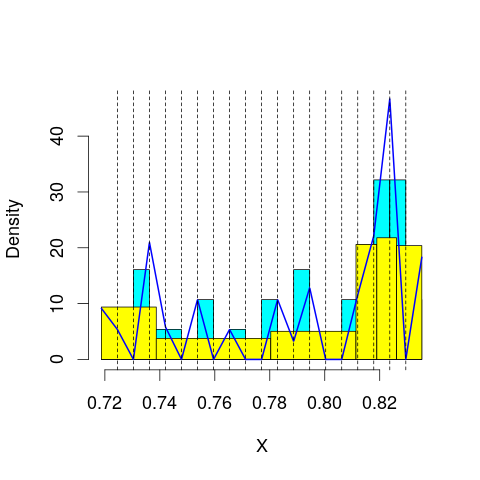

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 68.22658
mop.approx: Iteration 11. LL = 83.4856
mop.approx: Iteration 21. LL = 83.54321
mop.approx: Iteration 31. LL = 83.54995
mop.approx: Converged. Iteration 37. LL = 83.55084
[1] "Computing the linear combination of B-splines"


45.4277491873
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 67.95787
mop.approx: Iteration 11. LL = 82.26712
mop.approx: Iteration 21. LL = 82.4809
mop.approx: Iteration 31. LL = 82.52168
mop.approx: Iteration 41. LL = 82.5319
mop.approx: Iteration 51. LL = 82.53484
mop.approx: Converged. Iteration 57. LL = 82.53562
[1] "Computing the linear combination of B-splines"


42.6796579307
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 21.13617
mop.approx: Iteration 11. LL = 75.44603
mop.approx: Iteration 21. LL = 75.52717
mop.approx: Iteration 31. LL = 75.53533
mop.approx: Iteration 41. LL = 75.53731
mop.approx: Iteration 51. LL = 75.53847
mop.approx: Iteration 61. LL = 75.53937
mop.approx: Converged. Iteration 65. LL = 75.53976
[1] "Computing the linear combination of B-splines"


33.9509248927
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.47362
mop.approx: Iteration 11. LL = 74.0092
mop.approx: Iteration 21. LL = 74.15022
mop.approx: Iteration 31. LL = 74.17778
mop.approx: Iteration 41. LL = 74.18586
mop.approx: Iteration 51. LL = 74.18889
mop.approx: Iteration 61. LL = 74.19029
mop.approx: Converged. Iteration 66. LL = 74.19079
[1] "Computing the linear combination of B-splines"


30.8691053078
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.66403
mop.approx: Iteration 11. LL = 73.58261
mop.approx: Iteration 21. LL = 73.69787
mop.approx: Iteration 31. LL = 73.71963
mop.approx: Iteration 41. LL = 73.72555
mop.approx: Iteration 51. LL = 73.72728
mop.approx: Converged. Iteration 53. LL = 73.72751
[1] "Computing the linear combination of B-splines"


28.6697594615
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.483769
mop.approx: Iteration 11. LL = 76.42239
mop.approx: Iteration 21. LL = 76.4701
mop.approx: Iteration 31. LL = 76.48958
mop.approx: Iteration 41. LL = 76.49942
mop.approx: Iteration 51. LL = 76.50477
mop.approx: Iteration 61. LL = 76.50779
mop.approx: Iteration 71. LL = 76.50953
mop.approx: Iteration 81. LL = 76.51056
mop.approx: Converged. Iteration 81. LL = 76.51063
[1] "Computing the linear combination of B-splines"


29.5915569802
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.78703
[1] "Computing the linear combination of B-splines"


87.0831945949
('best: ', 48.65655468665895, 'accepted difference:', 82.716142967320209, 'cur BIC:', 87.083194594942327)
lfps_19
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.80356
mop.approx: Converged. Iteration 10. LL = 57.67927
[1] "Computing the linear combination of B-splines"


52.4806626894
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 52.48066268943542)
m reached
('Sum of Probabilities:', 0.9928969654611743)
chosen


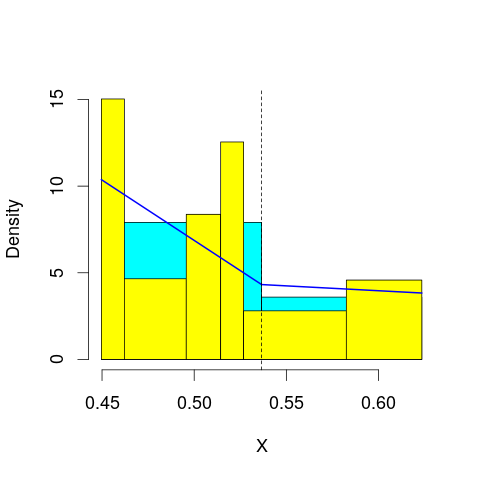

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.62106
mop.approx: Iteration 11. LL = 58.22814
mop.approx: Iteration 21. LL = 58.32465
mop.approx: Iteration 31. LL = 58.34943
mop.approx: Iteration 41. LL = 58.35925
mop.approx: Iteration 51. LL = 58.36415
mop.approx: Iteration 61. LL = 58.36696
mop.approx: Iteration 71. LL = 58.36873
mop.approx: Iteration 81. LL = 58.36992
mop.approx: Iteration 91. LL = 58.37076
mop.approx: Converged. Iteration 98. LL = 58.37127
[1] "Computing the linear combination of B-splines"


51.4397960025
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.43959
mop.approx: Iteration 11. LL = 58.22133
mop.approx: Iteration 21. LL = 58.34294
mop.approx: Iteration 31. LL = 58.38629
mop.approx: Iteration 41. LL = 58.40021
mop.approx: Iteration 51. LL = 58.40419
mop.approx: Converged. Iteration 60. LL = 58.40525
[1] "Computing the linear combination of B-splines"


49.740910386
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.77273
mop.approx: Iteration 11. LL = 45.97406
mop.approx: Converged. Iteration 17. LL = 45.97698
[1] "Computing the linear combination of B-splines"


35.5797749108
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.63221
mop.approx: Iteration 11. LL = 46.15992
mop.approx: Iteration 21. LL = 46.46976
mop.approx: Iteration 31. LL = 46.50494
mop.approx: Iteration 41. LL = 46.50981
mop.approx: Converged. Iteration 47. LL = 46.51041
[1] "Computing the linear combination of B-splines"


34.3803304928
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.204319
mop.approx: Iteration 11. LL = 43.52341
mop.approx: Iteration 21. LL = 43.5741
mop.approx: Iteration 31. LL = 43.57712
mop.approx: Converged. Iteration 33. LL = 43.57725
[1] "Computing the linear combination of B-splines"


29.7143086736
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.315309
mop.approx: Iteration 11. LL = 43.83758
mop.approx: Iteration 21. LL = 44.22344
mop.approx: Iteration 31. LL = 44.25991
mop.approx: Iteration 41. LL = 44.26389
mop.approx: Converged. Iteration 45. LL = 44.26422
[1] "Computing the linear combination of B-splines"


28.668406225
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.8481329
mop.approx: Iteration 11. LL = 41.30347
mop.approx: Iteration 21. LL = 41.45395
mop.approx: Iteration 31. LL = 41.48123
mop.approx: Iteration 41. LL = 41.48884
mop.approx: Iteration 51. LL = 41.49146
mop.approx: Iteration 61. LL = 41.49246
mop.approx: Converged. Iteration 66. LL = 41.49275
[1] "Computing the linear combination of B-splines"


24.1640725298
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.80356
mop.approx: Converged. Iteration 10. LL = 58.50056
[1] "Computing the linear combination of B-splines"


51.5690839751
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 51.569083975125167)
m reached
('Sum of Probabilities:', 0.9928738031199635)
chosen


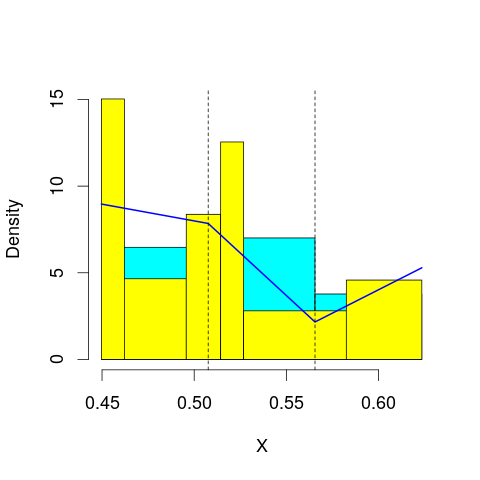

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.62106
mop.approx: Iteration 11. LL = 58.86825
mop.approx: Iteration 21. LL = 58.96848
mop.approx: Iteration 31. LL = 58.98954
mop.approx: Iteration 41. LL = 58.99461
mop.approx: Iteration 51. LL = 58.99588
mop.approx: Converged. Iteration 51. LL = 58.99593
[1] "Computing the linear combination of B-splines"


50.3315951333
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.43959
mop.approx: Iteration 11. LL = 59.33273
mop.approx: Iteration 21. LL = 59.52242
mop.approx: Iteration 31. LL = 59.58405
mop.approx: Iteration 41. LL = 59.61222
mop.approx: Iteration 51. LL = 59.62651
mop.approx: Iteration 61. LL = 59.63408
mop.approx: Iteration 71. LL = 59.63826
mop.approx: Iteration 81. LL = 59.64068
mop.approx: Iteration 91. LL = 59.64217
mop.approx: Iteration 101. LL = 59.64314
mop.approx: Converged. Iteration 109. LL = 59.64374
[1] "Computing the linear combination of B-splines"


49.2465311121
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.77273
mop.approx: Iteration 11. LL = 47.53119
mop.approx: Iteration 21. LL = 47.64432
mop.approx: Iteration 31. LL = 47.66552
mop.approx: Iteration 41. LL = 47.67242
mop.approx: Iteration 51. LL = 47.67523
mop.approx: Iteration 61. LL = 47.67648
mop.approx: Converged. Iteration 68. LL = 47.67698
[1] "Computing the linear combination of B-splines"


35.5469032019
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.63221
mop.approx: Iteration 11. LL = 48.17269
mop.approx: Converged. Iteration 18. LL = 48.1813
[1] "Computing the linear combination of B-splines"


34.3183594389
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.204319
mop.approx: Iteration 11. LL = 47.03017
mop.approx: Iteration 21. LL = 47.30491
mop.approx: Iteration 31. LL = 47.34625
mop.approx: Iteration 41. LL = 47.36069
mop.approx: Iteration 51. LL = 47.36749
mop.approx: Iteration 61. LL = 47.37126
mop.approx: Iteration 71. LL = 47.37358
mop.approx: Iteration 81. LL = 47.37513
mop.approx: Iteration 91. LL = 47.37621
mop.approx: Iteration 101. LL = 47.377
mop.approx: Iteration 111. LL = 47.37759
mop.approx: Converged. Iteration 115. LL = 47.37784
[1] "Computing the linear combination of B-splines"


31.7820235186
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.315309
mop.approx: Iteration 11. LL = 45.80213
mop.approx: Iteration 21. LL = 45.83516
mop.approx: Converged. Iteration 26. LL = 45.83573
[1] "Computing the linear combination of B-splines"


28.5070478891
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.8481329
mop.approx: Iteration 11. LL = 45.24529
mop.approx: Iteration 21. LL = 45.67229
mop.approx: Iteration 31. LL = 45.74713
mop.approx: Iteration 41. LL = 45.76657
mop.approx: Iteration 51. LL = 45.77201
mop.approx: Iteration 61. LL = 45.77357
mop.approx: Converged. Iteration 65. LL = 45.77386
[1] "Computing the linear combination of B-splines"


26.7123155681
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.80356
mop.approx: Iteration 11. LL = 58.82607
mop.approx: Converged. Iteration 14. LL = 58.82659
[1] "Computing the linear combination of B-splines"


50.1622456277
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 50.162245627702717)
m reached
('Sum of Probabilities:', 0.9910873732699641)
chosen


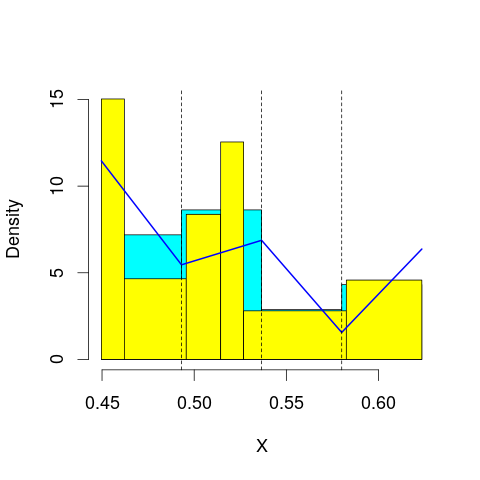

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.62106
mop.approx: Iteration 11. LL = 60.56154
mop.approx: Iteration 21. LL = 60.69493
mop.approx: Iteration 31. LL = 60.72154
mop.approx: Iteration 41. LL = 60.72816
mop.approx: Iteration 51. LL = 60.72992
mop.approx: Converged. Iteration 54. LL = 60.73018
[1] "Computing the linear combination of B-splines"


50.3329762973
('best: ', 50.162245627702717, 'accepted difference:', 85.275817567094606, 'cur BIC:', 50.332976297325544)
m reached
('Sum of Probabilities:', 0.9752489815729948)
chosen


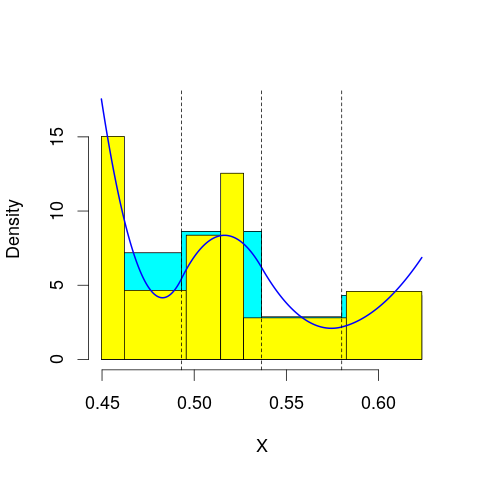

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.43959
mop.approx: Iteration 11. LL = 59.30422
mop.approx: Iteration 21. LL = 59.38219
mop.approx: Iteration 31. LL = 59.40754
mop.approx: Iteration 41. LL = 59.41915
mop.approx: Iteration 51. LL = 59.42532
mop.approx: Iteration 61. LL = 59.42887
mop.approx: Iteration 71. LL = 59.43099
mop.approx: Iteration 81. LL = 59.43228
mop.approx: Iteration 91. LL = 59.43307
mop.approx: Converged. Iteration 92. LL = 59.43319
[1] "Computing the linear combination of B-splines"


47.3031161578
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.77273
mop.approx: Iteration 11. LL = 48.78003
mop.approx: Iteration 21. LL = 48.89863
mop.approx: Iteration 31. LL = 48.93064
mop.approx: Iteration 41. LL = 48.94346
mop.approx: Iteration 51. LL = 48.94963
mop.approx: Iteration 61. LL = 48.95296
mop.approx: Iteration 71. LL = 48.95489
mop.approx: Iteration 81. LL = 48.95607
mop.approx: Iteration 91. LL = 48.95681
mop.approx: Converged. Iteration 95. LL = 48.95707
[1] "Computing the linear combination of B-splines"


35.0941286475
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.63221
mop.approx: Iteration 11. LL = 48.21688
mop.approx: Converged. Iteration 17. LL = 48.21875
[1] "Computing the linear combination of B-splines"


32.6229413209
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.204319
mop.approx: Iteration 11. LL = 49.0575
mop.approx: Iteration 21. LL = 49.13585
mop.approx: Converged. Iteration 28. LL = 49.13729
[1] "Computing the linear combination of B-splines"


31.8086063268
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.315309
mop.approx: Iteration 11. LL = 47.48821
mop.approx: Iteration 21. LL = 47.73736
mop.approx: Iteration 31. LL = 47.75521
mop.approx: Converged. Iteration 38. LL = 47.75621
[1] "Computing the linear combination of B-splines"


28.6946650641
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.8481329
mop.approx: Iteration 11. LL = 47.33762
mop.approx: Iteration 21. LL = 47.38355
mop.approx: Converged. Iteration 23. LL = 47.38372
[1] "Computing the linear combination of B-splines"


26.5893038642
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.80356
mop.approx: Iteration 11. LL = 61.75449
mop.approx: Converged. Iteration 18. LL = 61.75815
[1] "Computing the linear combination of B-splines"


51.3609388765
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 51.360938876505536)
m reached
('Sum of Probabilities:', 0.9893036809424613)
chosen


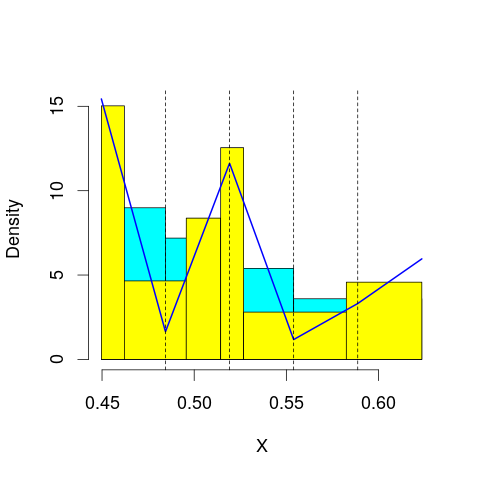

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.62106
mop.approx: Iteration 11. LL = 60.27823
mop.approx: Iteration 21. LL = 60.39558
mop.approx: Iteration 31. LL = 60.42268
mop.approx: Iteration 41. LL = 60.43071
mop.approx: Iteration 51. LL = 60.43333
mop.approx: Converged. Iteration 60. LL = 60.43424
[1] "Computing the linear combination of B-splines"


48.3041604785
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.43959
mop.approx: Iteration 11. LL = 60.51812
mop.approx: Iteration 21. LL = 60.78589
mop.approx: Iteration 31. LL = 60.86569
mop.approx: Iteration 41. LL = 60.89212
mop.approx: Iteration 51. LL = 60.90152
mop.approx: Iteration 61. LL = 60.90509
mop.approx: Iteration 71. LL = 60.90654
mop.approx: Converged. Iteration 76. LL = 60.90698
[1] "Computing the linear combination of B-splines"


47.0440402685
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.77273
mop.approx: Iteration 11. LL = 50.46232
mop.approx: Iteration 21. LL = 50.82289
mop.approx: Iteration 31. LL = 50.87741
mop.approx: Iteration 41. LL = 50.89149
mop.approx: Iteration 51. LL = 50.89608
mop.approx: Iteration 61. LL = 50.89791
mop.approx: Iteration 71. LL = 50.89881
mop.approx: Converged. Iteration 76. LL = 50.89914
[1] "Computing the linear combination of B-splines"


35.3033281281
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.63221
mop.approx: Iteration 11. LL = 49.02629
mop.approx: Iteration 21. LL = 49.08291
mop.approx: Iteration 31. LL = 49.09289
mop.approx: Iteration 41. LL = 49.09521
mop.approx: Converged. Iteration 47. LL = 49.09572
[1] "Computing the linear combination of B-splines"


31.7670377846
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.204319
mop.approx: Iteration 11. LL = 49.2938
mop.approx: Iteration 21. LL = 49.32759
mop.approx: Converged. Iteration 25. LL = 49.3281
[1] "Computing the linear combination of B-splines"


30.2665527958
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.315309
mop.approx: Iteration 11. LL = 48.94509
mop.approx: Iteration 21. LL = 49.14788
mop.approx: Iteration 31. LL = 49.17431
mop.approx: Iteration 41. LL = 49.18031
mop.approx: Iteration 51. LL = 49.18276
mop.approx: Iteration 61. LL = 49.18414
mop.approx: Iteration 71. LL = 49.185
mop.approx: Converged. Iteration 79. LL = 49.18551
[1] "Computing the linear combination of B-splines"


28.3910981866
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.8481329
mop.approx: Iteration 11. LL = 47.84916
mop.approx: Iteration 21. LL = 47.98344
mop.approx: Iteration 31. LL = 48.01733
mop.approx: Iteration 41. LL = 48.02973
mop.approx: Iteration 51. LL = 48.03543
mop.approx: Iteration 61. LL = 48.03842
mop.approx: Iteration 71. LL = 48.04012
mop.approx: Iteration 81. LL = 48.04114
mop.approx: Iteration 91. LL = 48.04176
mop.approx: Converged. Iteration 91. LL = 48.04181
[1] "Computing the linear combination of B-splines"


25.5145285357
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.80356
mop.approx: Iteration 11. LL = 61.87109
mop.approx: Iteration 21. LL = 61.88538
mop.approx: Converged. Iteration 27. LL = 61.88617
[1] "Computing the linear combination of B-splines"


49.7560986719
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 49.756098671902635)
m reached
('Sum of Probabilities:', 0.987051955732663)
chosen


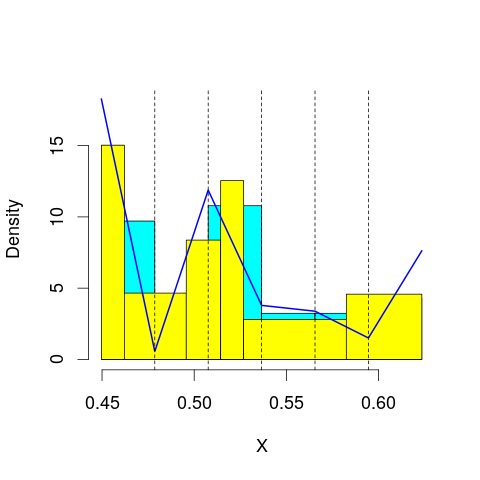

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.62106
mop.approx: Iteration 11. LL = 61.9045
mop.approx: Iteration 21. LL = 62.02595
mop.approx: Iteration 31. LL = 62.04978
mop.approx: Iteration 41. LL = 62.05539
mop.approx: Iteration 51. LL = 62.05676
mop.approx: Converged. Iteration 51. LL = 62.05682
[1] "Computing the linear combination of B-splines"


48.1938752276
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.43959
mop.approx: Iteration 11. LL = 60.78394
mop.approx: Iteration 21. LL = 60.86008
mop.approx: Iteration 31. LL = 60.86371
mop.approx: Converged. Iteration 32. LL = 60.86385
[1] "Computing the linear combination of B-splines"


45.2680347356
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.77273
mop.approx: Iteration 11. LL = 51.36324
mop.approx: Iteration 21. LL = 51.55996
mop.approx: Iteration 31. LL = 51.57503
mop.approx: Iteration 41. LL = 51.57739
mop.approx: Converged. Iteration 45. LL = 51.5777
[1] "Computing the linear combination of B-splines"


34.249022405
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.63221
mop.approx: Iteration 11. LL = 49.73142
mop.approx: Iteration 21. LL = 49.99153
mop.approx: Iteration 31. LL = 50.07571
mop.approx: Iteration 41. LL = 50.10903
mop.approx: Iteration 51. LL = 50.12349
mop.approx: Iteration 61. LL = 50.12999
mop.approx: Iteration 71. LL = 50.13295
mop.approx: Iteration 81. LL = 50.13429
mop.approx: Converged. Iteration 88. LL = 50.13482
[1] "Computing the linear combination of B-splines"


31.0732685032
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.204319
mop.approx: Iteration 11. LL = 49.95986
mop.approx: Iteration 21. LL = 50.0414
mop.approx: Iteration 31. LL = 50.06143
mop.approx: Iteration 41. LL = 50.06921
mop.approx: Iteration 51. LL = 50.07301
mop.approx: Iteration 61. LL = 50.07516
mop.approx: Iteration 71. LL = 50.07649
mop.approx: Iteration 81. LL = 50.07738
mop.approx: Iteration 91. LL = 50.07801
mop.approx: Converged. Iteration 93. LL = 50.07816
[1] "Computing the linear combination of B-splines"


29.2837431451
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.315309
mop.approx: Iteration 11. LL = 50.01101
mop.approx: Iteration 21. LL = 50.24106
mop.approx: Iteration 31. LL = 50.25662
mop.approx: Iteration 41. LL = 50.25831
mop.approx: Converged. Iteration 41. LL = 50.25836
[1] "Computing the linear combination of B-splines"


27.7310760193
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.8481329
mop.approx: Iteration 11. LL = 48.68044
mop.approx: Iteration 21. LL = 48.8459
mop.approx: Iteration 31. LL = 48.91476
mop.approx: Iteration 41. LL = 48.95089
mop.approx: Iteration 51. LL = 48.97118
mop.approx: Iteration 61. LL = 48.98312
mop.approx: Iteration 71. LL = 48.99038
mop.approx: Iteration 81. LL = 48.99489
mop.approx: Iteration 91. LL = 48.99772
mop.approx: Iteration 101. LL = 48.9995
mop.approx: Iteration 111. LL = 49.00063
mop.approx: Iteration 121. LL = 49.00134
mop.approx: Converged. Iteration 124. LL = 49.00155
[1] "Computing the linear combination of B-splines"


24.7413987936
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.80356
mop.approx: Iteration 11. LL = 63.23655
mop.approx: Iteration 21. LL = 63.31025
mop.approx: Iteration 31. LL = 63.32187
mop.approx: Iteration 41. LL = 63.32414
mop.approx: Converged. Iteration 43. LL = 63.32436
[1] "Computing the linear combination of B-splines"


49.4614155452
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 49.461415545168791)
m reached
('Sum of Probabilities:', 0.985828512884275)
chosen


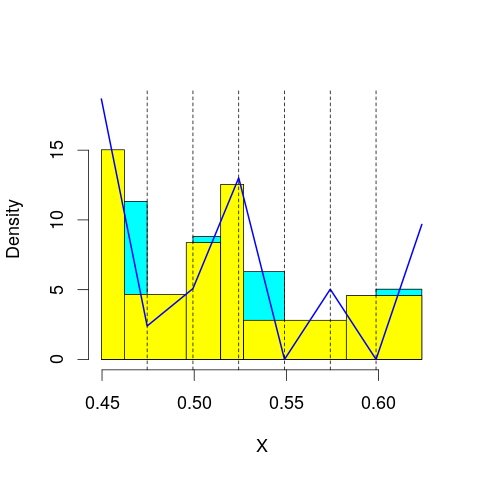

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.62106
mop.approx: Iteration 11. LL = 62.09453
mop.approx: Iteration 21. LL = 62.16312
mop.approx: Iteration 31. LL = 62.17229
mop.approx: Converged. Iteration 40. LL = 62.17382
[1] "Computing the linear combination of B-splines"


46.5780072832
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.43959
mop.approx: Iteration 11. LL = 61.74608
mop.approx: Iteration 21. LL = 61.88413
mop.approx: Iteration 31. LL = 61.90643
mop.approx: Iteration 41. LL = 61.91222
mop.approx: Iteration 51. LL = 61.91459
mop.approx: Iteration 61. LL = 61.91586
mop.approx: Iteration 71. LL = 61.91665
mop.approx: Converged. Iteration 72. LL = 61.91677
[1] "Computing the linear combination of B-splines"


44.5880888489
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.77273
mop.approx: Iteration 11. LL = 51.61819
mop.approx: Iteration 21. LL = 51.69046
mop.approx: Iteration 31. LL = 51.69779
mop.approx: Iteration 41. LL = 51.70083
mop.approx: Iteration 51. LL = 51.70241
mop.approx: Iteration 61. LL = 51.70333
mop.approx: Converged. Iteration 69. LL = 51.70387
[1] "Computing the linear combination of B-splines"


32.6423215341
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.63221
mop.approx: Iteration 11. LL = 50.24956
mop.approx: Iteration 21. LL = 50.44622
mop.approx: Iteration 31. LL = 50.48639
mop.approx: Iteration 41. LL = 50.49941
mop.approx: Iteration 51. LL = 50.50529
mop.approx: Iteration 61. LL = 50.50851
mop.approx: Iteration 71. LL = 50.51049
mop.approx: Iteration 81. LL = 50.5118
mop.approx: Iteration 91. LL = 50.51271
mop.approx: Iteration 101. LL = 50.51337
mop.approx: Converged. Iteration 105. LL = 50.51364
[1] "Computing the linear combination of B-splines"


29.7192219693
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.204319
mop.approx: Iteration 11. LL = 50.16392
mop.approx: Iteration 21. LL = 50.21792
mop.approx: Iteration 31. LL = 50.23564
mop.approx: Iteration 41. LL = 50.24399
mop.approx: Iteration 51. LL = 50.24838
mop.approx: Iteration 61. LL = 50.2509
mop.approx: Iteration 71. LL = 50.25245
mop.approx: Iteration 81. LL = 50.25346
mop.approx: Iteration 91. LL = 50.25414
mop.approx: Converged. Iteration 94. LL = 50.25435
[1] "Computing the linear combination of B-splines"


27.7270672945
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.315309
mop.approx: Iteration 11. LL = 50.69053
mop.approx: Iteration 21. LL = 50.8327
mop.approx: Iteration 31. LL = 50.85925
mop.approx: Iteration 41. LL = 50.8689
mop.approx: Iteration 51. LL = 50.87293
mop.approx: Iteration 61. LL = 50.87471
mop.approx: Iteration 71. LL = 50.87552
mop.approx: Converged. Iteration 72. LL = 50.87562
[1] "Computing the linear combination of B-splines"


26.6154688831
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.8481329
mop.approx: Iteration 11. LL = 50.11106
mop.approx: Iteration 21. LL = 50.6422
mop.approx: Iteration 31. LL = 50.75647
mop.approx: Iteration 41. LL = 50.79128
mop.approx: Iteration 51. LL = 50.80415
mop.approx: Iteration 61. LL = 50.80986
mop.approx: Iteration 71. LL = 50.81291
mop.approx: Iteration 81. LL = 50.81477
mop.approx: Iteration 91. LL = 50.81601
mop.approx: Iteration 101. LL = 50.81689
mop.approx: Iteration 111. LL = 50.81754
mop.approx: Converged. Iteration 115. LL = 50.8178
[1] "Computing the linear combination of B-splines"


24.8247796378
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.80356
mop.approx: Iteration 11. LL = 63.34149
mop.approx: Iteration 21. LL = 63.37253
mop.approx: Iteration 31. LL = 63.37656
mop.approx: Converged. Iteration 35. LL = 63.37701
[1] "Computing the linear combination of B-splines"


47.7812025064
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 47.781202506402515)
m reached
('Sum of Probabilities:', 0.9850422185893797)
chosen


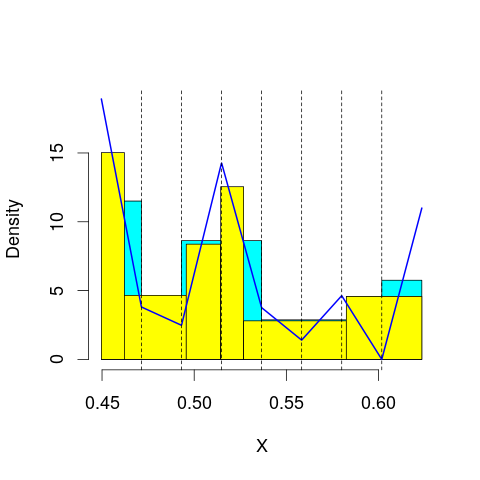

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.62106
mop.approx: Iteration 11. LL = 62.41879
mop.approx: Iteration 21. LL = 62.48666
mop.approx: Iteration 31. LL = 62.49675
mop.approx: Iteration 41. LL = 62.49868
mop.approx: Converged. Iteration 43. LL = 62.49888
[1] "Computing the linear combination of B-splines"


45.1701955683
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.43959
mop.approx: Iteration 11. LL = 62.50073
mop.approx: Iteration 21. LL = 62.56699
mop.approx: Iteration 31. LL = 62.58047
mop.approx: Iteration 41. LL = 62.58407
mop.approx: Converged. Iteration 49. LL = 62.585
[1] "Computing the linear combination of B-splines"


43.5234539511
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.77273
mop.approx: Iteration 11. LL = 52.55925
mop.approx: Iteration 21. LL = 52.69471
mop.approx: Iteration 31. LL = 52.71092
mop.approx: Iteration 41. LL = 52.7133
mop.approx: Converged. Iteration 44. LL = 52.71356
[1] "Computing the linear combination of B-splines"


31.9191398929
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.63221
mop.approx: Iteration 11. LL = 50.68042
mop.approx: Iteration 21. LL = 50.88916
mop.approx: Iteration 31. LL = 50.94886
mop.approx: Iteration 41. LL = 50.97239
mop.approx: Iteration 51. LL = 50.98328
mop.approx: Iteration 61. LL = 50.98904
mop.approx: Iteration 71. LL = 50.9924
mop.approx: Iteration 81. LL = 50.99448
mop.approx: Iteration 91. LL = 50.99584
mop.approx: Iteration 101. LL = 50.99674
mop.approx: Iteration 111. LL = 50.99735
mop.approx: Converged. Iteration 111. LL = 50.9974
[1] "Computing the linear combination of B-splines"


28.4701174145
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.204319
mop.approx: Iteration 11. LL = 50.44848
mop.approx: Iteration 21. LL = 50.52002
mop.approx: Iteration 31. LL = 50.53068
mop.approx: Iteration 41. LL = 50.5322
mop.approx: Converged. Iteration 41. LL = 50.53225
[1] "Computing the linear combination of B-splines"


26.2720949222
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.315309
mop.approx: Iteration 11. LL = 50.86681
mop.approx: Iteration 21. LL = 50.90153
mop.approx: Converged. Iteration 28. LL = 50.90257
[1] "Computing the linear combination of B-splines"


24.9095513089
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.8481329
mop.approx: Iteration 11. LL = 50.88507
mop.approx: Iteration 21. LL = 51.20913
mop.approx: Iteration 31. LL = 51.24168
mop.approx: Iteration 41. LL = 51.24781
mop.approx: Iteration 51. LL = 51.24933
mop.approx: Converged. Iteration 54. LL = 51.24956
[1] "Computing the linear combination of B-splines"


23.52368895
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.80356
mop.approx: Iteration 11. LL = 63.17414
mop.approx: Iteration 21. LL = 63.17839
mop.approx: Converged. Iteration 22. LL = 63.17853
[1] "Computing the linear combination of B-splines"


45.8498529043
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 45.84985290433363)
m reached
('Sum of Probabilities:', 0.9849833846199908)
chosen


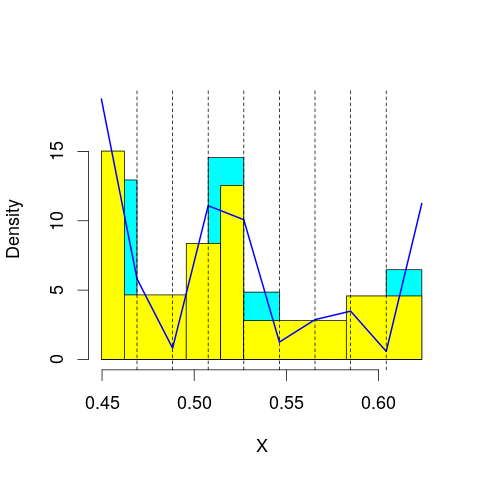

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.62106
mop.approx: Iteration 11. LL = 62.94496
mop.approx: Iteration 21. LL = 63.0252
mop.approx: Iteration 31. LL = 63.05303
mop.approx: Iteration 41. LL = 63.06317
mop.approx: Iteration 51. LL = 63.06693
mop.approx: Iteration 61. LL = 63.06834
mop.approx: Converged. Iteration 64. LL = 63.06861
[1] "Computing the linear combination of B-splines"


44.0070666687
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.43959
mop.approx: Iteration 11. LL = 62.50251
mop.approx: Iteration 21. LL = 62.56956
mop.approx: Iteration 31. LL = 62.58439
mop.approx: Iteration 41. LL = 62.58835
mop.approx: Converged. Iteration 50. LL = 62.58947
[1] "Computing the linear combination of B-splines"


41.7950503709
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.77273
mop.approx: Iteration 11. LL = 53.96067
mop.approx: Iteration 21. LL = 54.0871
mop.approx: Iteration 31. LL = 54.10448
mop.approx: Iteration 41. LL = 54.11022
mop.approx: Iteration 51. LL = 54.1133
mop.approx: Iteration 61. LL = 54.11521
mop.approx: Iteration 71. LL = 54.11645
mop.approx: Iteration 81. LL = 54.11729
mop.approx: Converged. Iteration 88. LL = 54.11778
[1] "Computing the linear combination of B-splines"


31.5904954849
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.63221
mop.approx: Iteration 11. LL = 51.37726
mop.approx: Iteration 21. LL = 51.77495
mop.approx: Iteration 31. LL = 51.84807
mop.approx: Iteration 41. LL = 51.86145
mop.approx: Iteration 51. LL = 51.86392
mop.approx: Converged. Iteration 55. LL = 51.86425
[1] "Computing the linear combination of B-splines"


27.604095482
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.204319
mop.approx: Iteration 11. LL = 50.93537
mop.approx: Iteration 21. LL = 51.06132
mop.approx: Iteration 31. LL = 51.09591
mop.approx: Iteration 41. LL = 51.10857
mop.approx: Iteration 51. LL = 51.11405
mop.approx: Iteration 61. LL = 51.11672
mop.approx: Iteration 71. LL = 51.11816
mop.approx: Iteration 81. LL = 51.119
mop.approx: Converged. Iteration 86. LL = 51.11934
[1] "Computing the linear combination of B-splines"


25.1263246368
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.315309
mop.approx: Iteration 11. LL = 51.1313
mop.approx: Iteration 21. LL = 51.21762
mop.approx: Iteration 31. LL = 51.23317
mop.approx: Iteration 41. LL = 51.23572
mop.approx: Converged. Iteration 44. LL = 51.23597
[1] "Computing the linear combination of B-splines"


23.510064491
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.8481329
mop.approx: Iteration 11. LL = 51.2445
mop.approx: Iteration 21. LL = 51.39012
mop.approx: Iteration 31. LL = 51.40134
mop.approx: Iteration 41. LL = 51.40591
mop.approx: Iteration 51. LL = 51.40863
mop.approx: Iteration 61. LL = 51.41035
mop.approx: Iteration 71. LL = 51.41146
mop.approx: Iteration 81. LL = 51.41219
mop.approx: Converged. Iteration 84. LL = 51.41241
[1] "Computing the linear combination of B-splines"


21.9535860671
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.80356
mop.approx: Iteration 11. LL = 62.92164
mop.approx: Iteration 21. LL = 62.94316
mop.approx: Converged. Iteration 30. LL = 62.94507
[1] "Computing the linear combination of B-splines"


43.8835242402
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 43.883524240162203)
m reached
('Sum of Probabilities:', 0.9854997721394284)
chosen


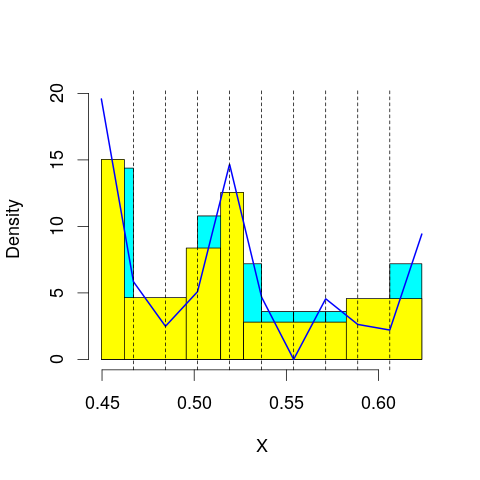

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.62106
mop.approx: Iteration 11. LL = 63.01091
mop.approx: Iteration 21. LL = 63.05345
mop.approx: Iteration 31. LL = 63.0576
mop.approx: Converged. Iteration 34. LL = 63.05791
[1] "Computing the linear combination of B-splines"


42.26349205
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.43959
mop.approx: Iteration 11. LL = 62.73241
mop.approx: Iteration 21. LL = 62.7873
mop.approx: Iteration 31. LL = 62.80995
mop.approx: Iteration 41. LL = 62.82032
mop.approx: Iteration 51. LL = 62.8254
mop.approx: Iteration 61. LL = 62.82802
mop.approx: Iteration 71. LL = 62.82945
mop.approx: Converged. Iteration 80. LL = 62.83025
[1] "Computing the linear combination of B-splines"


40.3029691372
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.77273
mop.approx: Iteration 11. LL = 54.35803
mop.approx: Iteration 21. LL = 54.43297
mop.approx: Iteration 31. LL = 54.44195
mop.approx: Iteration 41. LL = 54.44373
mop.approx: Converged. Iteration 44. LL = 54.44397
[1] "Computing the linear combination of B-splines"


30.1838212561
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.63221
mop.approx: Iteration 11. LL = 52.90871
mop.approx: Iteration 21. LL = 53.29518
mop.approx: Iteration 31. LL = 53.3326
mop.approx: Iteration 41. LL = 53.33915
mop.approx: Iteration 51. LL = 53.3424
mop.approx: Iteration 61. LL = 53.3449
mop.approx: Iteration 71. LL = 53.3469
mop.approx: Iteration 81. LL = 53.34846
mop.approx: Iteration 91. LL = 53.34964
mop.approx: Iteration 101. LL = 53.35052
mop.approx: Iteration 111. LL = 53.35116
mop.approx: Converged. Iteration 112. LL = 53.35127
[1] "Computing the linear combination of B-splines"


27.3582505891
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.204319
mop.approx: Iteration 11. LL = 50.96346
mop.approx: Iteration 21. LL = 51.04874
mop.approx: Iteration 31. LL = 51.06719
mop.approx: Iteration 41. LL = 51.07283
mop.approx: Iteration 51. LL = 51.07509
mop.approx: Iteration 61. LL = 51.0762
mop.approx: Converged. Iteration 70. LL = 51.07683
[1] "Computing the linear combination of B-splines"


23.3509369512
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.315309
mop.approx: Iteration 11. LL = 51.84271
mop.approx: Iteration 21. LL = 52.08229
mop.approx: Iteration 31. LL = 52.15613
mop.approx: Iteration 41. LL = 52.18562
mop.approx: Iteration 51. LL = 52.19928
mop.approx: Iteration 61. LL = 52.20624
mop.approx: Iteration 71. LL = 52.21009
mop.approx: Iteration 81. LL = 52.21238
mop.approx: Iteration 91. LL = 52.21385
mop.approx: Iteration 101. LL = 52.21485
mop.approx: Iteration 111. LL = 52.21557
mop.approx: Converged. Iteration 117. LL = 52.21597
[1] "Computing the linear combination of B-splines"


22.7572037316
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.8481329
mop.approx: Iteration 11. LL = 51.58655
mop.approx: Iteration 21. LL = 51.73849
mop.approx: Iteration 31. LL = 51.75991
mop.approx: Iteration 41. LL = 51.76403
mop.approx: Converged. Iteration 48. LL = 51.76475
[1] "Computing the linear combination of B-splines"


20.5724169968
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.80356
mop.approx: Iteration 11. LL = 62.45174
mop.approx: Iteration 21. LL = 62.48143
mop.approx: Iteration 31. LL = 62.49293
mop.approx: Iteration 41. LL = 62.49826
mop.approx: Iteration 51. LL = 62.50108
mop.approx: Iteration 61. LL = 62.50272
mop.approx: Iteration 71. LL = 62.50374
mop.approx: Converged. Iteration 77. LL = 62.50422
[1] "Computing the linear combination of B-splines"


41.7098044322
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 41.709804432247346)
m reached
('Sum of Probabilities:', 0.9868502347791538)
chosen


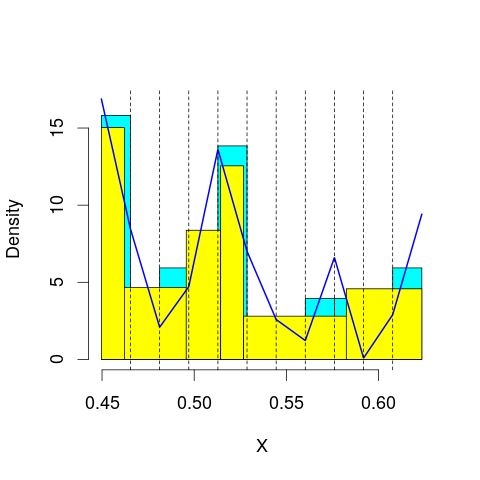

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.62106
mop.approx: Iteration 11. LL = 63.49608
mop.approx: Iteration 21. LL = 63.56905
mop.approx: Iteration 31. LL = 63.58209
mop.approx: Iteration 41. LL = 63.5856
mop.approx: Iteration 51. LL = 63.58687
mop.approx: Converged. Iteration 54. LL = 63.58715
[1] "Computing the linear combination of B-splines"


41.0598686543
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.43959
mop.approx: Iteration 11. LL = 62.70475
mop.approx: Iteration 21. LL = 62.7808
mop.approx: Iteration 31. LL = 62.81055
mop.approx: Iteration 41. LL = 62.82339
mop.approx: Iteration 51. LL = 62.82896
mop.approx: Iteration 61. LL = 62.83136
mop.approx: Iteration 71. LL = 62.83242
mop.approx: Converged. Iteration 72. LL = 62.83254
[1] "Computing the linear combination of B-splines"


38.5723926872
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.77273
mop.approx: Iteration 11. LL = 54.87301
mop.approx: Iteration 21. LL = 54.91276
mop.approx: Iteration 31. LL = 54.92066
mop.approx: Iteration 41. LL = 54.92371
mop.approx: Iteration 51. LL = 54.92515
mop.approx: Converged. Iteration 59. LL = 54.92581
[1] "Computing the linear combination of B-splines"


28.932786742
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.63221
mop.approx: Iteration 11. LL = 53.68785
mop.approx: Iteration 21. LL = 53.88511
mop.approx: Iteration 31. LL = 53.90512
mop.approx: Iteration 41. LL = 53.91102
mop.approx: Iteration 51. LL = 53.91317
mop.approx: Converged. Iteration 60. LL = 53.91399
[1] "Computing the linear combination of B-splines"


26.1881039796
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.204319
mop.approx: Iteration 11. LL = 51.61274
mop.approx: Iteration 21. LL = 51.87068
mop.approx: Iteration 31. LL = 51.95126
mop.approx: Iteration 41. LL = 51.97787
mop.approx: Iteration 51. LL = 51.98651
mop.approx: Iteration 61. LL = 51.98939
mop.approx: Iteration 71. LL = 51.99047
mop.approx: Converged. Iteration 75. LL = 51.99076
[1] "Computing the linear combination of B-splines"


22.5320057573
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.315309
mop.approx: Iteration 11. LL = 51.94635
mop.approx: Iteration 21. LL = 52.08402
mop.approx: Iteration 31. LL = 52.12172
mop.approx: Iteration 41. LL = 52.13685
mop.approx: Iteration 51. LL = 52.14434
mop.approx: Iteration 61. LL = 52.14858
mop.approx: Iteration 71. LL = 52.15119
mop.approx: Iteration 81. LL = 52.15289
mop.approx: Iteration 91. LL = 52.15406
mop.approx: Iteration 101. LL = 52.15488
mop.approx: Converged. Iteration 110. LL = 52.15547
[1] "Computing the linear combination of B-splines"


20.9638267339
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.8481329
mop.approx: Iteration 11. LL = 52.42204
mop.approx: Iteration 21. LL = 52.73528
mop.approx: Iteration 31. LL = 52.82243
mop.approx: Iteration 41. LL = 52.85424
mop.approx: Iteration 51. LL = 52.86747
mop.approx: Iteration 61. LL = 52.87354
mop.approx: Iteration 71. LL = 52.87657
mop.approx: Iteration 81. LL = 52.87817
mop.approx: Iteration 91. LL = 52.87905
mop.approx: Converged. Iteration 95. LL = 52.87933
[1] "Computing the linear combination of B-splines"


19.9531358192
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.80356
mop.approx: Iteration 11. LL = 63.74031
mop.approx: Iteration 21. LL = 63.76076
mop.approx: Converged. Iteration 24. LL = 63.7612
[1] "Computing the linear combination of B-splines"


41.2339169761
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 41.233916976119829)
m reached
('Sum of Probabilities:', 0.9884800213479906)
chosen


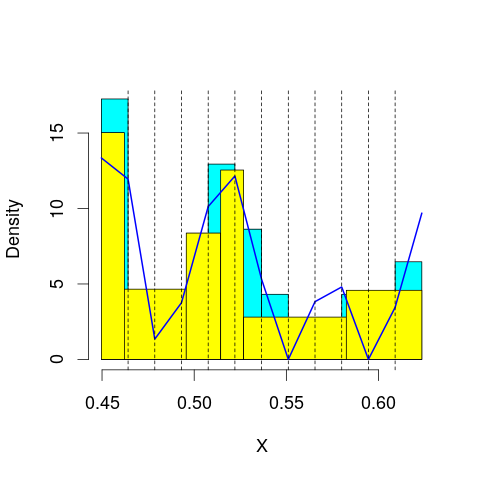

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.62106
mop.approx: Iteration 11. LL = 63.43998
mop.approx: Iteration 21. LL = 63.49395
mop.approx: Iteration 31. LL = 63.50227
mop.approx: Iteration 41. LL = 63.50412
mop.approx: Converged. Iteration 45. LL = 63.50448
[1] "Computing the linear combination of B-splines"


39.2443321067
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.43959
mop.approx: Iteration 11. LL = 62.76078
mop.approx: Iteration 21. LL = 62.82726
mop.approx: Iteration 31. LL = 62.8392
mop.approx: Iteration 41. LL = 62.84173
mop.approx: Converged. Iteration 46. LL = 62.84222
[1] "Computing the linear combination of B-splines"


36.8491987071
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.77273
mop.approx: Iteration 11. LL = 55.21039
mop.approx: Iteration 21. LL = 55.26143
mop.approx: Iteration 31. LL = 55.28056
mop.approx: Iteration 41. LL = 55.28891
mop.approx: Iteration 51. LL = 55.29258
mop.approx: Iteration 61. LL = 55.29416
mop.approx: Converged. Iteration 68. LL = 55.29473
[1] "Computing the linear combination of B-splines"


27.5688404059
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.63221
mop.approx: Iteration 11. LL = 54.44517
mop.approx: Iteration 21. LL = 54.56362
mop.approx: Iteration 31. LL = 54.57437
mop.approx: Iteration 41. LL = 54.5778
mop.approx: Iteration 51. LL = 54.57942
mop.approx: Iteration 61. LL = 54.58026
mop.approx: Converged. Iteration 63. LL = 54.58042
[1] "Computing the linear combination of B-splines"


25.1216667749
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.204319
mop.approx: Iteration 11. LL = 52.19132
mop.approx: Iteration 21. LL = 52.429
mop.approx: Iteration 31. LL = 52.48026
mop.approx: Iteration 41. LL = 52.50122
mop.approx: Iteration 51. LL = 52.51301
mop.approx: Iteration 61. LL = 52.52026
mop.approx: Iteration 71. LL = 52.5249
mop.approx: Iteration 81. LL = 52.52798
mop.approx: Iteration 91. LL = 52.53008
mop.approx: Iteration 101. LL = 52.53157
mop.approx: Iteration 111. LL = 52.53267
mop.approx: Iteration 121. LL = 52.53349
mop.approx: Iteration 131. LL = 52.53412
mop.approx: Converged. Iteration 134. LL = 52.53434
[1] "Computing the linear combination of B-splines"


21.3427145442
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.315309
mop.approx: Iteration 11. LL = 52.15753
mop.approx: Iteration 21. LL = 52.25506
mop.approx: Iteration 31. LL = 52.27505
mop.approx: Iteration 41. LL = 52.28292
mop.approx: Iteration 51. LL = 52.28702
mop.approx: Iteration 61. LL = 52.2894
mop.approx: Iteration 71. LL = 52.29083
mop.approx: Iteration 81. LL = 52.2917
mop.approx: Converged. Iteration 86. LL = 52.29205
[1] "Computing the linear combination of B-splines"


19.3676516079
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.8481329
mop.approx: Iteration 11. LL = 52.76894
mop.approx: Iteration 21. LL = 52.97209
mop.approx: Iteration 31. LL = 53.01775
mop.approx: Iteration 41. LL = 53.03166
mop.approx: Iteration 51. LL = 53.03644
mop.approx: Iteration 61. LL = 53.03822
mop.approx: Converged. Iteration 69. LL = 53.03888
[1] "Computing the linear combination of B-splines"


18.3819358187
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.80356
mop.approx: Iteration 11. LL = 64.98232
mop.approx: Iteration 21. LL = 65.06326
mop.approx: Iteration 31. LL = 65.08099
mop.approx: Iteration 41. LL = 65.08611
mop.approx: Iteration 51. LL = 65.08775
mop.approx: Converged. Iteration 55. LL = 65.08812
[1] "Computing the linear combination of B-splines"


40.8279668905
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 40.827966890490977)
m reached
('Sum of Probabilities:', 0.989588223564669)
chosen


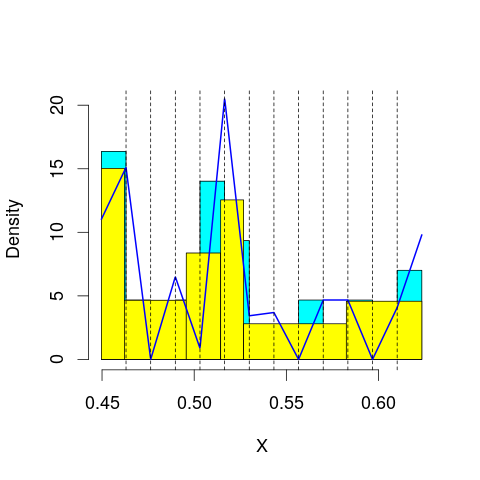

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.62106
mop.approx: Iteration 11. LL = 63.49912
mop.approx: Iteration 21. LL = 63.57698
mop.approx: Iteration 31. LL = 63.59694
mop.approx: Iteration 41. LL = 63.60342
mop.approx: Iteration 51. LL = 63.60579
mop.approx: Converged. Iteration 60. LL = 63.60674
[1] "Computing the linear combination of B-splines"


37.6137215082
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.43959
mop.approx: Iteration 11. LL = 63.15216
mop.approx: Iteration 21. LL = 63.28776
mop.approx: Iteration 31. LL = 63.33191
mop.approx: Iteration 41. LL = 63.3475
mop.approx: Iteration 51. LL = 63.35296
mop.approx: Iteration 61. LL = 63.35502
mop.approx: Iteration 71. LL = 63.35593
mop.approx: Converged. Iteration 71. LL = 63.35599
[1] "Computing the linear combination of B-splines"


35.6301014025
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.77273
mop.approx: Iteration 11. LL = 55.38225
mop.approx: Iteration 21. LL = 55.437
mop.approx: Iteration 31. LL = 55.46057
mop.approx: Iteration 41. LL = 55.47224
mop.approx: Iteration 51. LL = 55.47836
mop.approx: Iteration 61. LL = 55.48163
mop.approx: Iteration 71. LL = 55.48338
mop.approx: Iteration 81. LL = 55.48433
mop.approx: Converged. Iteration 84. LL = 55.48457
[1] "Computing the linear combination of B-splines"


26.0258105835
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.63221
mop.approx: Iteration 11. LL = 55.04346
mop.approx: Iteration 21. LL = 55.1171
mop.approx: Iteration 31. LL = 55.133
mop.approx: Iteration 41. LL = 55.13975
mop.approx: Iteration 51. LL = 55.14259
mop.approx: Iteration 61. LL = 55.14375
mop.approx: Converged. Iteration 64. LL = 55.14399
[1] "Computing the linear combination of B-splines"


23.9523666591
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.204319
mop.approx: Iteration 11. LL = 52.89234
mop.approx: Iteration 21. LL = 53.25525
mop.approx: Iteration 31. LL = 53.35592
mop.approx: Iteration 41. LL = 53.39042
mop.approx: Iteration 51. LL = 53.4029
mop.approx: Iteration 61. LL = 53.40751
mop.approx: Iteration 71. LL = 53.40926
mop.approx: Converged. Iteration 78. LL = 53.40984
[1] "Computing the linear combination of B-splines"


20.4853423362
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.315309
mop.approx: Iteration 11. LL = 52.36459
mop.approx: Iteration 21. LL = 52.44902
mop.approx: Iteration 31. LL = 52.4748
mop.approx: Iteration 41. LL = 52.48623
mop.approx: Iteration 51. LL = 52.49155
mop.approx: Iteration 61. LL = 52.49417
mop.approx: Iteration 71. LL = 52.49557
mop.approx: Iteration 81. LL = 52.49641
mop.approx: Converged. Iteration 89. LL = 52.49693
[1] "Computing the linear combination of B-splines"


17.839532016
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.8481329
mop.approx: Iteration 11. LL = 52.97598
mop.approx: Iteration 21. LL = 53.11815
mop.approx: Iteration 31. LL = 53.15332
mop.approx: Iteration 41. LL = 53.16689
mop.approx: Iteration 51. LL = 53.1732
mop.approx: Iteration 61. LL = 53.17645
mop.approx: Iteration 71. LL = 53.17826
mop.approx: Iteration 81. LL = 53.17931
mop.approx: Converged. Iteration 90. LL = 53.17996
[1] "Computing the linear combination of B-splines"


16.7878051059
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.80356
mop.approx: Iteration 11. LL = 65.293
mop.approx: Iteration 21. LL = 65.31501
mop.approx: Iteration 31. LL = 65.31756
mop.approx: Converged. Iteration 33. LL = 65.31779
[1] "Computing the linear combination of B-splines"


39.3247737735
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 39.324773773547861)
m reached
('Sum of Probabilities:', 0.9899220378740891)
chosen


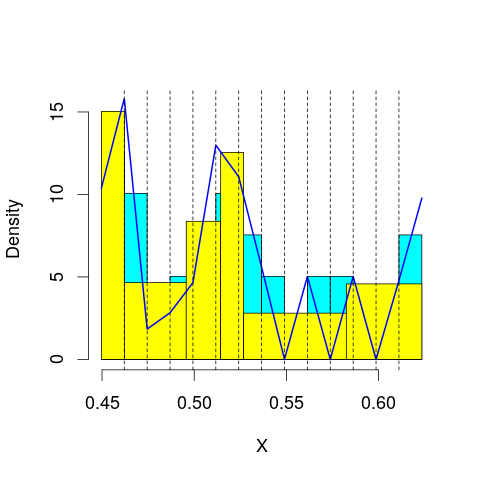

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.62106
mop.approx: Iteration 11. LL = 63.83237
mop.approx: Iteration 21. LL = 63.92855
mop.approx: Iteration 31. LL = 63.94958
mop.approx: Iteration 41. LL = 63.95604
mop.approx: Iteration 51. LL = 63.95855
mop.approx: Iteration 61. LL = 63.95971
mop.approx: Converged. Iteration 64. LL = 63.95998
[1] "Computing the linear combination of B-splines"


36.2340968988
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.43959
mop.approx: Iteration 11. LL = 63.36522
mop.approx: Iteration 21. LL = 63.49789
mop.approx: Iteration 31. LL = 63.53281
mop.approx: Iteration 41. LL = 63.54266
mop.approx: Iteration 51. LL = 63.54595
mop.approx: Iteration 61. LL = 63.54736
mop.approx: Converged. Iteration 70. LL = 63.54813
[1] "Computing the linear combination of B-splines"


34.0893791736
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.77273
mop.approx: Iteration 11. LL = 55.769
mop.approx: Iteration 21. LL = 55.88388
mop.approx: Iteration 31. LL = 55.92675
mop.approx: Iteration 41. LL = 55.94666
mop.approx: Iteration 51. LL = 55.95685
mop.approx: Iteration 61. LL = 55.96231
mop.approx: Iteration 71. LL = 55.96537
mop.approx: Iteration 81. LL = 55.96718
mop.approx: Iteration 91. LL = 55.96832
mop.approx: Iteration 101. LL = 55.96907
mop.approx: Converged. Iteration 103. LL = 55.96925
[1] "Computing the linear combination of B-splines"


24.7776247619
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.63221
mop.approx: Iteration 11. LL = 55.39678
mop.approx: Iteration 21. LL = 55.45107
mop.approx: Iteration 31. LL = 55.46514
mop.approx: Iteration 41. LL = 55.47148
mop.approx: Iteration 51. LL = 55.47492
mop.approx: Iteration 61. LL = 55.47704
mop.approx: Iteration 71. LL = 55.47848
mop.approx: Iteration 81. LL = 55.4795
mop.approx: Iteration 91. LL = 55.48026
mop.approx: Converged. Iteration 97. LL = 55.48067
[1] "Computing the linear combination of B-splines"


22.5561814119
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.204319
mop.approx: Iteration 11. LL = 53.78341
mop.approx: Iteration 21. LL = 54.15544
mop.approx: Iteration 31. LL = 54.22361
mop.approx: Iteration 41. LL = 54.24303
mop.approx: Iteration 51. LL = 54.2508
mop.approx: Iteration 61. LL = 54.25452
mop.approx: Iteration 71. LL = 54.25651
mop.approx: Iteration 81. LL = 54.25766
mop.approx: Iteration 91. LL = 54.25836
mop.approx: Converged. Iteration 92. LL = 54.25847
[1] "Computing the linear combination of B-splines"


19.6011032343
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.315309
mop.approx: Iteration 11. LL = 52.46611
mop.approx: Iteration 21. LL = 52.53861
mop.approx: Iteration 31. LL = 52.55881
mop.approx: Iteration 41. LL = 52.56672
mop.approx: Iteration 51. LL = 52.57097
mop.approx: Iteration 61. LL = 52.57371
mop.approx: Iteration 71. LL = 52.57562
mop.approx: Iteration 81. LL = 52.57701
mop.approx: Iteration 91. LL = 52.57806
mop.approx: Iteration 101. LL = 52.57886
mop.approx: Iteration 111. LL = 52.57949
mop.approx: Converged. Iteration 114. LL = 52.5797
[1] "Computing the linear combination of B-splines"


16.1891086282
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.8481329
mop.approx: Iteration 11. LL = 53.22316
mop.approx: Iteration 21. LL = 53.30222
mop.approx: Iteration 31. LL = 53.31157
mop.approx: Iteration 41. LL = 53.31522
mop.approx: Iteration 51. LL = 53.31796
mop.approx: Iteration 61. LL = 53.32021
mop.approx: Iteration 71. LL = 53.32202
mop.approx: Iteration 81. LL = 53.32343
mop.approx: Iteration 91. LL = 53.32451
mop.approx: Iteration 101. LL = 53.32535
mop.approx: Iteration 111. LL = 53.32598
mop.approx: Converged. Iteration 113. LL = 53.32615
[1] "Computing the linear combination of B-splines"


15.2079741223
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.80356
mop.approx: Iteration 11. LL = 65.36092
mop.approx: Iteration 21. LL = 65.38177
mop.approx: Iteration 31. LL = 65.38446
mop.approx: Converged. Iteration 35. LL = 65.38486
[1] "Computing the linear combination of B-splines"


37.6589678637
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 37.658967863664813)
m reached
('Sum of Probabilities:', 0.9899693677875675)
chosen


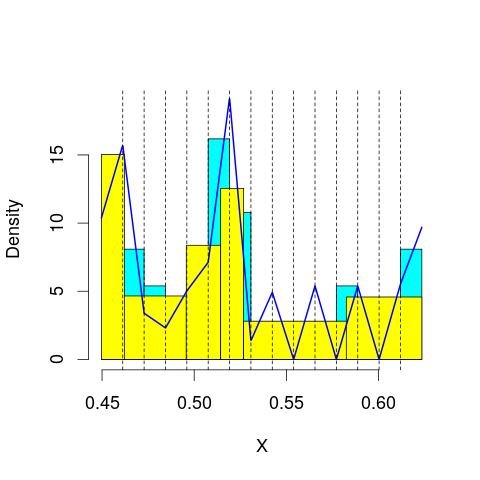

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.62106
mop.approx: Iteration 11. LL = 63.80163
mop.approx: Iteration 21. LL = 63.82623
mop.approx: Iteration 31. LL = 63.83506
mop.approx: Iteration 41. LL = 63.8406
mop.approx: Iteration 51. LL = 63.84442
mop.approx: Iteration 61. LL = 63.84718
mop.approx: Iteration 71. LL = 63.84921
mop.approx: Iteration 81. LL = 63.85076
mop.approx: Iteration 91. LL = 63.85196
mop.approx: Iteration 101. LL = 63.8529
mop.approx: Iteration 111. LL = 63.85366
mop.approx: Converged. Iteration 114. LL = 63.85392
[1] "Computing the linear combination of B-splines"


34.3951667965
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.43959
mop.approx: Iteration 11. LL = 64.12425
mop.approx: Iteration 21. LL = 64.33653
mop.approx: Iteration 31. LL = 64.38794
mop.approx: Iteration 41. LL = 64.40468
mop.approx: Iteration 51. LL = 64.41164
mop.approx: Iteration 61. LL = 64.4152
mop.approx: Iteration 71. LL = 64.41729
mop.approx: Iteration 81. LL = 64.41865
mop.approx: Iteration 91. LL = 64.41959
mop.approx: Converged. Iteration 97. LL = 64.42008
[1] "Computing the linear combination of B-splines"


33.2284588211
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.77273
mop.approx: Iteration 11. LL = 55.96766
mop.approx: Iteration 21. LL = 56.04885
mop.approx: Iteration 31. LL = 56.08386
mop.approx: Iteration 41. LL = 56.10025
mop.approx: Iteration 51. LL = 56.10754
mop.approx: Iteration 61. LL = 56.11074
mop.approx: Iteration 71. LL = 56.1122
mop.approx: Converged. Iteration 80. LL = 56.11292
[1] "Computing the linear combination of B-splines"


23.1884329524
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.63221
mop.approx: Iteration 11. LL = 55.84996
mop.approx: Iteration 21. LL = 55.90557
mop.approx: Iteration 31. LL = 55.91879
mop.approx: Iteration 41. LL = 55.92521
mop.approx: Iteration 51. LL = 55.92917
mop.approx: Iteration 61. LL = 55.93179
mop.approx: Iteration 71. LL = 55.93357
mop.approx: Iteration 81. LL = 55.93481
mop.approx: Iteration 91. LL = 55.93569
mop.approx: Converged. Iteration 100. LL = 55.93633
[1] "Computing the linear combination of B-splines"


21.2789666841
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.204319
mop.approx: Iteration 11. LL = 54.3962
mop.approx: Iteration 21. LL = 54.66717
mop.approx: Iteration 31. LL = 54.71111
mop.approx: Iteration 41. LL = 54.72769
mop.approx: Iteration 51. LL = 54.73609
mop.approx: Iteration 61. LL = 54.74071
mop.approx: Iteration 71. LL = 54.74337
mop.approx: Iteration 81. LL = 54.74495
mop.approx: Iteration 91. LL = 54.74592
mop.approx: Converged. Iteration 98. LL = 54.74642
[1] "Computing the linear combination of B-splines"


18.3561853744
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.315309
mop.approx: Iteration 11. LL = 52.76813
mop.approx: Iteration 21. LL = 52.90609
mop.approx: Iteration 31. LL = 52.95735
mop.approx: Iteration 41. LL = 52.98085
mop.approx: Iteration 51. LL = 52.99297
mop.approx: Iteration 61. LL = 52.99981
mop.approx: Iteration 71. LL = 53.004
mop.approx: Iteration 81. LL = 53.00677
mop.approx: Iteration 91. LL = 53.00871
mop.approx: Iteration 101. LL = 53.01014
mop.approx: Iteration 111. LL = 53.01122
mop.approx: Iteration 121. LL = 53.01206
mop.approx: Iteration 131. LL = 53.01273
mop.approx: Converged. Iteration 137. LL = 53.01312
[1] "Computing the linear combination of B-splines"


14.8899753604
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.8481329
mop.approx: Iteration 11. LL = 53.2743
mop.approx: Iteration 21. LL = 53.33213
mop.approx: Iteration 31. LL = 53.35429
mop.approx: Iteration 41. LL = 53.3698
mop.approx: Iteration 51. LL = 53.38072
mop.approx: Iteration 61. LL = 53.38815
mop.approx: Iteration 71. LL = 53.39306
mop.approx: Iteration 81. LL = 53.39624
mop.approx: Iteration 91. LL = 53.39827
mop.approx: Iteration 101. LL = 53.39955
mop.approx: Iteration 111. LL = 53.40037
mop.approx: Converged. Iteration 115. LL = 53.40066
[1] "Computing the linear combination of B-splines"


13.5424755571
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.80356
mop.approx: Iteration 11. LL = 65.22969
mop.approx: Iteration 21. LL = 65.30622
mop.approx: Iteration 31. LL = 65.32657
mop.approx: Iteration 41. LL = 65.33448
mop.approx: Iteration 51. LL = 65.33794
mop.approx: Iteration 61. LL = 65.33953
mop.approx: Converged. Iteration 67. LL = 65.3401
[1] "Computing the linear combination of B-splines"


35.8813420362
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 35.881342036201026)
m reached
('Sum of Probabilities:', 0.9901136584699605)
chosen


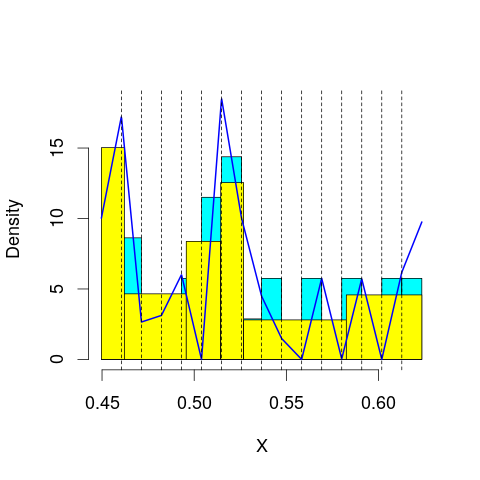

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.62106
mop.approx: Iteration 11. LL = 65.02551
mop.approx: Iteration 21. LL = 65.08053
mop.approx: Iteration 31. LL = 65.09409
mop.approx: Iteration 41. LL = 65.09987
mop.approx: Iteration 51. LL = 65.10293
mop.approx: Iteration 61. LL = 65.10475
mop.approx: Iteration 71. LL = 65.1059
mop.approx: Converged. Iteration 80. LL = 65.10668
[1] "Computing the linear combination of B-splines"


33.9150524733
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.43959
mop.approx: Iteration 11. LL = 64.1616
mop.approx: Iteration 21. LL = 64.3935
mop.approx: Iteration 31. LL = 64.46107
mop.approx: Iteration 41. LL = 64.48763
mop.approx: Iteration 51. LL = 64.49975
mop.approx: Iteration 61. LL = 64.50596
mop.approx: Iteration 71. LL = 64.50948
mop.approx: Iteration 81. LL = 64.51168
mop.approx: Iteration 91. LL = 64.51315
mop.approx: Iteration 101. LL = 64.51419
mop.approx: Iteration 111. LL = 64.51494
mop.approx: Converged. Iteration 111. LL = 64.51501
[1] "Computing the linear combination of B-splines"


31.5905154791
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.77273
mop.approx: Iteration 11. LL = 56.50668
mop.approx: Iteration 21. LL = 56.61127
mop.approx: Iteration 31. LL = 56.64114
mop.approx: Iteration 41. LL = 56.65304
mop.approx: Iteration 51. LL = 56.6589
mop.approx: Iteration 61. LL = 56.66224
mop.approx: Iteration 71. LL = 56.66432
mop.approx: Iteration 81. LL = 56.6657
mop.approx: Iteration 91. LL = 56.66665
mop.approx: Iteration 101. LL = 56.66733
mop.approx: Converged. Iteration 101. LL = 56.66739
[1] "Computing the linear combination of B-splines"


22.0100284289
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.63221
mop.approx: Iteration 11. LL = 56.19686
mop.approx: Iteration 21. LL = 56.31272
mop.approx: Iteration 31. LL = 56.35905
mop.approx: Iteration 41. LL = 56.38063
mop.approx: Iteration 51. LL = 56.39177
mop.approx: Iteration 61. LL = 56.39816
mop.approx: Iteration 71. LL = 56.40218
mop.approx: Iteration 81. LL = 56.4049
mop.approx: Iteration 91. LL = 56.40685
mop.approx: Iteration 101. LL = 56.40829
mop.approx: Iteration 111. LL = 56.40938
mop.approx: Iteration 121. LL = 56.41023
mop.approx: Iteration 131. LL = 56.4109
mop.approx: Converged. Iteration 133. LL = 56.41107
[1] "Computing the linear combination of B-splines"


20.0208428071
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.204319
mop.approx: Iteration 11. LL = 54.99524
mop.approx: Iteration 21. LL = 55.16471
mop.approx: Iteration 31. LL = 55.18109
mop.approx: Iteration 41. LL = 55.18738
mop.approx: Iteration 51. LL = 55.19146
mop.approx: Iteration 61. LL = 55.19436
mop.approx: Iteration 71. LL = 55.1965
mop.approx: Iteration 81. LL = 55.19811
mop.approx: Iteration 91. LL = 55.19934
mop.approx: Iteration 101. LL = 55.20029
mop.approx: Iteration 111. LL = 55.20104
mop.approx: Converged. Iteration 120. LL = 55.20164
[1] "Computing the linear combination of B-splines"


17.0785599245
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.315309
mop.approx: Iteration 11. LL = 53.13993
mop.approx: Iteration 21. LL = 53.37365
mop.approx: Iteration 31. LL = 53.46297
mop.approx: Iteration 41. LL = 53.50119
mop.approx: Iteration 51. LL = 53.51862
mop.approx: Iteration 61. LL = 53.52722
mop.approx: Iteration 71. LL = 53.53186
mop.approx: Iteration 81. LL = 53.53458
mop.approx: Iteration 91. LL = 53.53631
mop.approx: Iteration 101. LL = 53.53746
mop.approx: Iteration 111. LL = 53.53826
mop.approx: Converged. Iteration 119. LL = 53.5388
[1] "Computing the linear combination of B-splines"


13.6825719708
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.8481329
mop.approx: Iteration 11. LL = 53.30157
mop.approx: Iteration 21. LL = 53.3368
mop.approx: Iteration 31. LL = 53.3531
mop.approx: Iteration 41. LL = 53.36245
mop.approx: Iteration 51. LL = 53.36815
mop.approx: Iteration 61. LL = 53.3719
mop.approx: Iteration 71. LL = 53.37453
mop.approx: Iteration 81. LL = 53.37646
mop.approx: Iteration 91. LL = 53.37792
mop.approx: Iteration 101. LL = 53.37904
mop.approx: Iteration 111. LL = 53.37993
mop.approx: Iteration 121. LL = 53.38065
mop.approx: Converged. Iteration 130. LL = 53.38123
[1] "Computing the linear combination of B-splines"


11.7805405557
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.80356
mop.approx: Iteration 11. LL = 66.24647
mop.approx: Iteration 21. LL = 66.29684
mop.approx: Iteration 31. LL = 66.30817
mop.approx: Iteration 41. LL = 66.31235
mop.approx: Iteration 51. LL = 66.31431
mop.approx: Iteration 61. LL = 66.31533
mop.approx: Converged. Iteration 63. LL = 66.31554
[1] "Computing the linear combination of B-splines"


35.1239135081
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 35.123913508104096)
m reached
('Sum of Probabilities:', 0.9900073246954277)
chosen


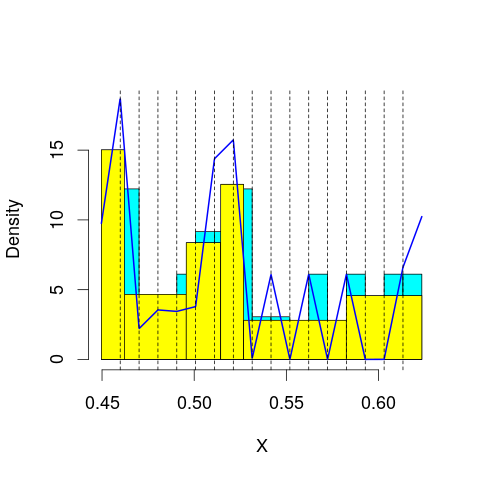

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.62106
mop.approx: Iteration 11. LL = 65.35218
mop.approx: Iteration 21. LL = 65.43046
mop.approx: Iteration 31. LL = 65.4502
mop.approx: Iteration 41. LL = 65.45771
mop.approx: Iteration 51. LL = 65.46131
mop.approx: Iteration 61. LL = 65.4633
mop.approx: Iteration 71. LL = 65.46449
mop.approx: Converged. Iteration 79. LL = 65.46519
[1] "Computing the linear combination of B-splines"


32.5407012632
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.43959
mop.approx: Iteration 11. LL = 64.90047
mop.approx: Iteration 21. LL = 65.08492
mop.approx: Iteration 31. LL = 65.11926
mop.approx: Iteration 41. LL = 65.12946
mop.approx: Iteration 51. LL = 65.1333
mop.approx: Iteration 61. LL = 65.13508
mop.approx: Iteration 71. LL = 65.13605
mop.approx: Converged. Iteration 74. LL = 65.13632
[1] "Computing the linear combination of B-splines"


30.4789640718
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.77273
mop.approx: Iteration 11. LL = 56.79457
mop.approx: Iteration 21. LL = 56.95457
mop.approx: Iteration 31. LL = 57.0106
mop.approx: Iteration 41. LL = 57.03547
mop.approx: Iteration 51. LL = 57.04692
mop.approx: Iteration 61. LL = 57.05218
mop.approx: Iteration 71. LL = 57.05459
mop.approx: Iteration 81. LL = 57.0557
mop.approx: Converged. Iteration 84. LL = 57.05595
[1] "Computing the linear combination of B-splines"


20.6657231685
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.63221
mop.approx: Iteration 11. LL = 56.67346
mop.approx: Iteration 21. LL = 56.77558
mop.approx: Iteration 31. LL = 56.80486
mop.approx: Iteration 41. LL = 56.81695
mop.approx: Iteration 51. LL = 56.82302
mop.approx: Iteration 61. LL = 56.82654
mop.approx: Iteration 71. LL = 56.82879
mop.approx: Iteration 81. LL = 56.8303
mop.approx: Iteration 91. LL = 56.83137
mop.approx: Iteration 101. LL = 56.83214
mop.approx: Converged. Iteration 106. LL = 56.83249
[1] "Computing the linear combination of B-splines"


18.7093999752
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.204319
mop.approx: Iteration 11. LL = 55.59144
mop.approx: Iteration 21. LL = 55.76205
mop.approx: Iteration 31. LL = 55.80829
mop.approx: Iteration 41. LL = 55.83484
mop.approx: Iteration 51. LL = 55.85197
mop.approx: Iteration 61. LL = 55.86361
mop.approx: Iteration 71. LL = 55.87186
mop.approx: Iteration 81. LL = 55.87791
mop.approx: Iteration 91. LL = 55.88246
mop.approx: Iteration 101. LL = 55.88595
mop.approx: Iteration 111. LL = 55.88865
mop.approx: Iteration 121. LL = 55.89077
mop.approx: Iteration 131. LL = 55.89243
mop.approx: Iteration 141. LL = 55.89375
mop.approx: Iteration 151. LL = 55.8948
mop.approx: Iteration 161. LL = 55.89563
mop.approx: Iteration 171. LL = 55.8963
mop.approx: Converged. Iteration 173. LL = 55.89647
[1] "Computing the linear combination of B-splines"


16.040495556
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.315309
mop.approx: Iteration 11. LL = 53.51902
mop.approx: Iteration 21. LL = 53.75896
mop.approx: Iteration 31. LL = 53.83301
mop.approx: Iteration 41. LL = 53.86454
mop.approx: Iteration 51. LL = 53.88082
mop.approx: Iteration 61. LL = 53.89021
mop.approx: Iteration 71. LL = 53.89598
mop.approx: Iteration 81. LL = 53.89969
mop.approx: Iteration 91. LL = 53.90216
mop.approx: Iteration 101. LL = 53.90385
mop.approx: Iteration 111. LL = 53.90503
mop.approx: Iteration 121. LL = 53.90588
mop.approx: Iteration 131. LL = 53.90651
mop.approx: Converged. Iteration 131. LL = 53.90656
[1] "Computing the linear combination of B-splines"


12.3172525539
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.8481329
mop.approx: Iteration 11. LL = 53.463
mop.approx: Iteration 21. LL = 53.56571
mop.approx: Iteration 31. LL = 53.6188
mop.approx: Iteration 41. LL = 53.64702
mop.approx: Iteration 51. LL = 53.66284
mop.approx: Iteration 61. LL = 53.67243
mop.approx: Iteration 71. LL = 53.67871
mop.approx: Iteration 81. LL = 53.68309
mop.approx: Iteration 91. LL = 53.6863
mop.approx: Iteration 101. LL = 53.68874
mop.approx: Iteration 111. LL = 53.69065
mop.approx: Iteration 121. LL = 53.69219
mop.approx: Iteration 131. LL = 53.69345
mop.approx: Iteration 141. LL = 53.6945
mop.approx: Iteration 151. LL = 53.69538
mop.approx: Iteration 161. LL = 53.69613
mop.approx: Iteration 171. LL = 53.69677
mop.approx: Converged. Iteration 177. LL = 53.69716
[1] "Computing the linear combination of B-splines"


10.3509948529
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.80356
mop.approx: Iteration 11. LL = 67.02003
mop.approx: Iteration 21. LL = 67.06654
mop.approx: Iteration 31. LL = 67.07226
mop.approx: Iteration 41. LL = 67.07406
mop.approx: Converged. Iteration 47. LL = 67.07464
[1] "Computing the linear combination of B-splines"


34.1501504775
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 34.150150477520441)
m reached
('Sum of Probabilities:', 0.9895957964050766)
chosen


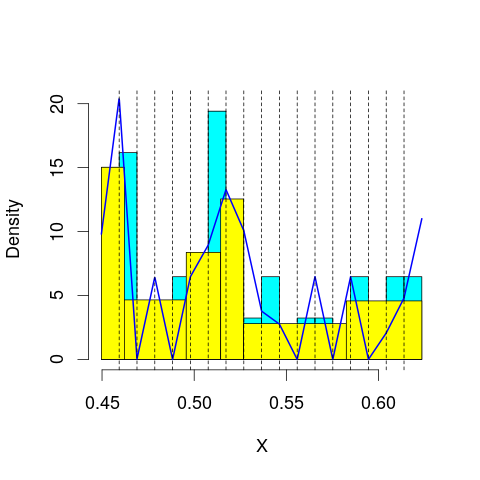

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.62106
mop.approx: Iteration 11. LL = 65.88973
mop.approx: Iteration 21. LL = 66.04173
mop.approx: Iteration 31. LL = 66.06583
mop.approx: Iteration 41. LL = 66.07229
mop.approx: Iteration 51. LL = 66.07438
mop.approx: Converged. Iteration 56. LL = 66.07489
[1] "Computing the linear combination of B-splines"


31.4175338674
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.43959
mop.approx: Iteration 11. LL = 65.48404
mop.approx: Iteration 21. LL = 65.70776
mop.approx: Iteration 31. LL = 65.77199
mop.approx: Iteration 41. LL = 65.79333
mop.approx: Iteration 51. LL = 65.80075
mop.approx: Iteration 61. LL = 65.80345
mop.approx: Iteration 71. LL = 65.8045
mop.approx: Converged. Iteration 71. LL = 65.80456
[1] "Computing the linear combination of B-splines"


29.4143313332
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.77273
mop.approx: Iteration 11. LL = 56.64189
mop.approx: Iteration 21. LL = 56.75897
mop.approx: Iteration 31. LL = 56.80551
mop.approx: Iteration 41. LL = 56.82703
mop.approx: Iteration 51. LL = 56.83753
mop.approx: Iteration 61. LL = 56.84287
mop.approx: Iteration 71. LL = 56.84568
mop.approx: Iteration 81. LL = 56.84722
mop.approx: Iteration 91. LL = 56.84807
mop.approx: Converged. Iteration 93. LL = 56.84825
[1] "Computing the linear combination of B-splines"


18.7251561218
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.63221
mop.approx: Iteration 11. LL = 57.34805
mop.approx: Iteration 21. LL = 57.51007
mop.approx: Iteration 31. LL = 57.57814
mop.approx: Iteration 41. LL = 57.6151
mop.approx: Iteration 51. LL = 57.63681
mop.approx: Iteration 61. LL = 57.65003
mop.approx: Iteration 71. LL = 57.65825
mop.approx: Iteration 81. LL = 57.66341
mop.approx: Iteration 91. LL = 57.66669
mop.approx: Iteration 101. LL = 57.66878
mop.approx: Iteration 111. LL = 57.67011
mop.approx: Iteration 121. LL = 57.67097
mop.approx: Converged. Iteration 125. LL = 57.67128
[1] "Computing the linear combination of B-splines"


17.8153174894
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.204319
mop.approx: Iteration 11. LL = 55.97482
mop.approx: Iteration 21. LL = 56.07347
mop.approx: Iteration 31. LL = 56.09402
mop.approx: Iteration 41. LL = 56.10524
mop.approx: Iteration 51. LL = 56.1123
mop.approx: Iteration 61. LL = 56.11701
mop.approx: Iteration 71. LL = 56.12029
mop.approx: Iteration 81. LL = 56.12263
mop.approx: Iteration 91. LL = 56.12434
mop.approx: Iteration 101. LL = 56.12561
mop.approx: Iteration 111. LL = 56.12656
mop.approx: Iteration 121. LL = 56.12728
mop.approx: Converged. Iteration 125. LL = 56.12758
[1] "Computing the linear combination of B-splines"


14.5387328471
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.315309
mop.approx: Iteration 11. LL = 54.15969
mop.approx: Iteration 21. LL = 54.48738
mop.approx: Iteration 31. LL = 54.59103
mop.approx: Iteration 41. LL = 54.6386
mop.approx: Iteration 51. LL = 54.66483
mop.approx: Iteration 61. LL = 54.68095
mop.approx: Iteration 71. LL = 54.69156
mop.approx: Iteration 81. LL = 54.69886
mop.approx: Iteration 91. LL = 54.70401
mop.approx: Iteration 101. LL = 54.70771
mop.approx: Iteration 111. LL = 54.71038
mop.approx: Iteration 121. LL = 54.71232
mop.approx: Iteration 131. LL = 54.71373
mop.approx: Iteration 141. LL = 54.71476
mop.approx: Iteration 151. LL = 54.71552
mop.approx: Converged. Iteration 157. LL = 54.71593
[1] "Computing the linear combination of B-splines"


11.394037953
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.8481329
mop.approx: Iteration 11. LL = 53.52085
mop.approx: Iteration 21. LL = 53.56932
mop.approx: Iteration 31. LL = 53.58612
mop.approx: Iteration 41. LL = 53.59471
mop.approx: Iteration 51. LL = 53.60022
mop.approx: Iteration 61. LL = 53.60403
mop.approx: Iteration 71. LL = 53.60674
mop.approx: Iteration 81. LL = 53.60869
mop.approx: Iteration 91. LL = 53.61009
mop.approx: Iteration 101. LL = 53.61112
mop.approx: Iteration 111. LL = 53.61187
mop.approx: Converged. Iteration 117. LL = 53.61227
[1] "Computing the linear combination of B-splines"


8.50295776486
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.80356
mop.approx: Iteration 11. LL = 69.14029
mop.approx: Iteration 21. LL = 69.25461
mop.approx: Iteration 31. LL = 69.26453
mop.approx: Converged. Iteration 37. LL = 69.26544
[1] "Computing the linear combination of B-splines"


34.6080812585
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 34.60808125853179)
m reached
('Sum of Probabilities:', 0.9891487704065124)
chosen


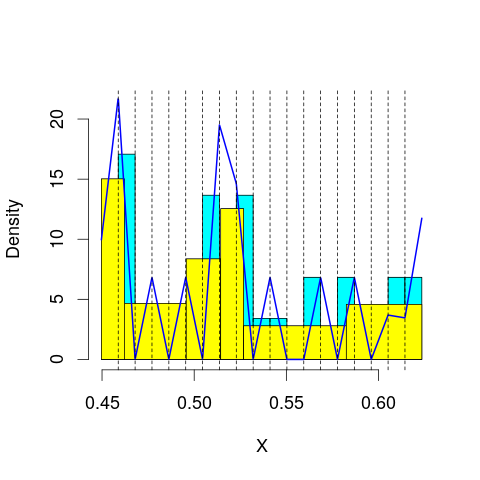

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.62106
mop.approx: Iteration 11. LL = 66.09782
mop.approx: Iteration 21. LL = 66.17795
mop.approx: Iteration 31. LL = 66.20131
mop.approx: Iteration 41. LL = 66.21219
mop.approx: Iteration 51. LL = 66.21804
mop.approx: Iteration 61. LL = 66.22145
mop.approx: Iteration 71. LL = 66.22356
mop.approx: Iteration 81. LL = 66.22492
mop.approx: Iteration 91. LL = 66.22584
mop.approx: Converged. Iteration 95. LL = 66.22618
[1] "Computing the linear combination of B-splines"


29.8359541583
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.43959
mop.approx: Iteration 11. LL = 66.15358
mop.approx: Iteration 21. LL = 66.44581
mop.approx: Iteration 31. LL = 66.50918
mop.approx: Iteration 41. LL = 66.52439
mop.approx: Iteration 51. LL = 66.5285
mop.approx: Iteration 61. LL = 66.52977
mop.approx: Converged. Iteration 61. LL = 66.52984
[1] "Computing the linear combination of B-splines"


28.4067425445
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.77273
mop.approx: Iteration 11. LL = 57.01657
mop.approx: Iteration 21. LL = 57.09952
mop.approx: Iteration 31. LL = 57.11905
mop.approx: Iteration 41. LL = 57.12805
mop.approx: Iteration 51. LL = 57.13295
mop.approx: Iteration 61. LL = 57.13582
mop.approx: Iteration 71. LL = 57.1376
mop.approx: Iteration 81. LL = 57.13876
mop.approx: Iteration 91. LL = 57.13955
mop.approx: Converged. Iteration 95. LL = 57.13985
[1] "Computing the linear combination of B-splines"


17.2838881021
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.63221
mop.approx: Iteration 11. LL = 57.77891
mop.approx: Iteration 21. LL = 57.96373
mop.approx: Iteration 31. LL = 58.01242
mop.approx: Iteration 41. LL = 58.0293
mop.approx: Iteration 51. LL = 58.036
mop.approx: Iteration 61. LL = 58.03895
mop.approx: Iteration 71. LL = 58.04038
mop.approx: Converged. Iteration 80. LL = 58.04112
[1] "Computing the linear combination of B-splines"


16.4522931342
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.204319
mop.approx: Iteration 11. LL = 56.68673
mop.approx: Iteration 21. LL = 56.87483
mop.approx: Iteration 31. LL = 56.93889
mop.approx: Iteration 41. LL = 56.97471
mop.approx: Iteration 51. LL = 56.99634
mop.approx: Iteration 61. LL = 57.00934
mop.approx: Iteration 71. LL = 57.01703
mop.approx: Iteration 81. LL = 57.02154
mop.approx: Iteration 91. LL = 57.0242
mop.approx: Iteration 101. LL = 57.0258
mop.approx: Iteration 111. LL = 57.02681
mop.approx: Converged. Iteration 119. LL = 57.02741
[1] "Computing the linear combination of B-splines"


13.7056490295
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.315309
mop.approx: Iteration 11. LL = 54.74037
mop.approx: Iteration 21. LL = 55.05482
mop.approx: Iteration 31. LL = 55.12582
mop.approx: Iteration 41. LL = 55.15042
mop.approx: Iteration 51. LL = 55.16202
mop.approx: Iteration 61. LL = 55.16871
mop.approx: Iteration 71. LL = 55.17305
mop.approx: Iteration 81. LL = 55.17608
mop.approx: Iteration 91. LL = 55.1783
mop.approx: Iteration 101. LL = 55.17999
mop.approx: Iteration 111. LL = 55.18132
mop.approx: Iteration 121. LL = 55.18238
mop.approx: Iteration 131. LL = 55.18324
mop.approx: Iteration 141. LL = 55.18395
mop.approx: Converged. Iteration 150. LL = 55.18455
[1] "Computing the linear combination of B-splines"


10.1277421992
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.8481329
mop.approx: Iteration 11. LL = 53.71058
mop.approx: Iteration 21. LL = 53.8187
mop.approx: Iteration 31. LL = 53.87626
mop.approx: Iteration 41. LL = 53.91356
mop.approx: Iteration 51. LL = 53.93829
mop.approx: Iteration 61. LL = 53.95445
mop.approx: Iteration 71. LL = 53.96479
mop.approx: Iteration 81. LL = 53.97132
mop.approx: Iteration 91. LL = 53.97542
mop.approx: Iteration 101. LL = 53.978
mop.approx: Iteration 111. LL = 53.97964
mop.approx: Iteration 121. LL = 53.9807
mop.approx: Iteration 131. LL = 53.98142
mop.approx: Converged. Iteration 133. LL = 53.98159
[1] "Computing the linear combination of B-splines"


7.16554453935
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.80356
mop.approx: Iteration 11. LL = 67.76704
mop.approx: Iteration 21. LL = 67.86773
mop.approx: Iteration 31. LL = 67.88617
mop.approx: Iteration 41. LL = 67.89101
mop.approx: Iteration 51. LL = 67.89277
mop.approx: Converged. Iteration 59. LL = 67.89353
[1] "Computing the linear combination of B-splines"


31.5033067206
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 31.503306720608194)
m reached
('Sum of Probabilities:', 0.9886851904865402)
chosen


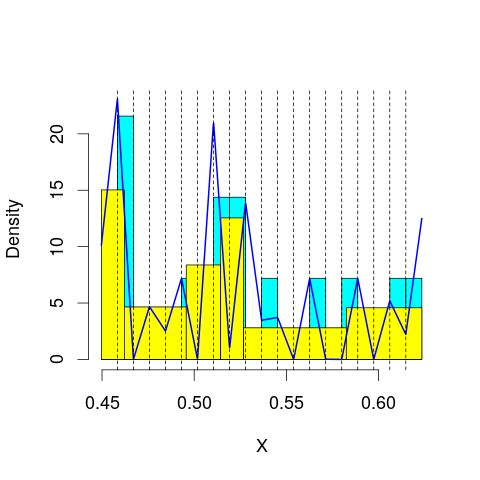

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.62106
mop.approx: Iteration 11. LL = 68.40609
mop.approx: Iteration 21. LL = 68.54391
mop.approx: Iteration 31. LL = 68.56581
mop.approx: Iteration 41. LL = 68.57173
mop.approx: Iteration 51. LL = 68.57374
mop.approx: Converged. Iteration 57. LL = 68.57437
[1] "Computing the linear combination of B-splines"


30.4512708668
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 55.43959
mop.approx: Iteration 11. LL = 65.52589
mop.approx: Iteration 21. LL = 65.7618
mop.approx: Iteration 31. LL = 65.81758
mop.approx: Iteration 41. LL = 65.83137
mop.approx: Iteration 51. LL = 65.83473
mop.approx: Converged. Iteration 57. LL = 65.8354
[1] "Computing the linear combination of B-splines"


25.9794390435
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.77273
mop.approx: Iteration 11. LL = 57.92036
mop.approx: Iteration 21. LL = 58.06349
mop.approx: Iteration 31. LL = 58.10605
mop.approx: Iteration 41. LL = 58.12287
mop.approx: Iteration 51. LL = 58.12989
mop.approx: Iteration 61. LL = 58.13286
mop.approx: Iteration 71. LL = 58.13414
mop.approx: Converged. Iteration 75. LL = 58.13447
[1] "Computing the linear combination of B-splines"


16.5456379237
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.63221
mop.approx: Iteration 11. LL = 57.75455
mop.approx: Iteration 21. LL = 57.90382
mop.approx: Iteration 31. LL = 57.95979
mop.approx: Iteration 41. LL = 57.98425
mop.approx: Iteration 51. LL = 57.99625
mop.approx: Iteration 61. LL = 58.00279
mop.approx: Iteration 71. LL = 58.00668
mop.approx: Iteration 81. LL = 58.00918
mop.approx: Iteration 91. LL = 58.01087
mop.approx: Iteration 101. LL = 58.01206
mop.approx: Iteration 111. LL = 58.01292
mop.approx: Converged. Iteration 119. LL = 58.0135
[1] "Computing the linear combination of B-splines"


14.6917973129
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.204319
mop.approx: Iteration 11. LL = 57.52367
mop.approx: Iteration 21. LL = 57.70628
mop.approx: Iteration 31. LL = 57.75261
mop.approx: Iteration 41. LL = 57.77207
mop.approx: Iteration 51. LL = 57.78106
mop.approx: Iteration 61. LL = 57.7854
mop.approx: Iteration 71. LL = 57.78757
mop.approx: Iteration 81. LL = 57.7887
mop.approx: Converged. Iteration 87. LL = 57.78916
[1] "Computing the linear combination of B-splines"


12.7344974306
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.315309
mop.approx: Iteration 11. LL = 55.25384
mop.approx: Iteration 21. LL = 55.49343
mop.approx: Iteration 31. LL = 55.55779
mop.approx: Iteration 41. LL = 55.59342
mop.approx: Iteration 51. LL = 55.61623
mop.approx: Iteration 61. LL = 55.63119
mop.approx: Iteration 71. LL = 55.64105
mop.approx: Iteration 81. LL = 55.64757
mop.approx: Iteration 91. LL = 55.65193
mop.approx: Iteration 101. LL = 55.65489
mop.approx: Iteration 111. LL = 55.65694
mop.approx: Iteration 121. LL = 55.6584
mop.approx: Iteration 131. LL = 55.65946
mop.approx: Iteration 141. LL = 55.66024
mop.approx: Converged. Iteration 148. LL = 55.66072
[1] "Computing the linear combination of B-splines"


8.86813111005
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.8481329
mop.approx: Iteration 11. LL = 53.8862
mop.approx: Iteration 21. LL = 54.08542
mop.approx: Iteration 31. LL = 54.15636
mop.approx: Iteration 41. LL = 54.18546
mop.approx: Iteration 51. LL = 54.19804
mop.approx: Iteration 61. LL = 54.20359
mop.approx: Iteration 71. LL = 54.20608
mop.approx: Iteration 81. LL = 54.20723
mop.approx: Converged. Iteration 86. LL = 54.2076
[1] "Computing the linear combination of B-splines"


5.42932096543
lfps_20
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 53.11259
mop.approx: Iteration 11. LL = 54.76061
mop.approx: Converged. Iteration 14. LL = 54.7613
[1] "Computing the linear combination of B-splines"


49.5626958893
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 49.562695889265513)
m reached
('Sum of Probabilities:', 0.9921455884062863)
chosen


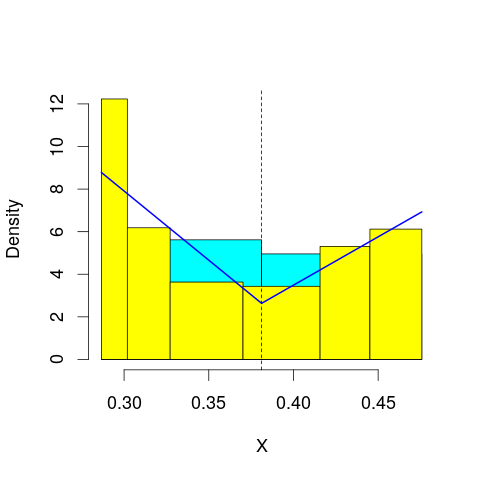

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.94478
mop.approx: Iteration 11. LL = 54.82424
mop.approx: Iteration 21. LL = 54.85728
mop.approx: Iteration 31. LL = 54.86358
mop.approx: Iteration 41. LL = 54.86501
mop.approx: Converged. Iteration 42. LL = 54.86512
[1] "Computing the linear combination of B-splines"


47.9336496609
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.77783
mop.approx: Iteration 11. LL = 54.57855
mop.approx: Iteration 21. LL = 54.58262
mop.approx: Converged. Iteration 21. LL = 54.58267
[1] "Computing the linear combination of B-splines"


45.9183309375
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.92859
mop.approx: Iteration 11. LL = 41.98194
mop.approx: Converged. Iteration 15. LL = 41.98356
[1] "Computing the linear combination of B-splines"


31.5863536354
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.91195
mop.approx: Iteration 11. LL = 42.74749
mop.approx: Iteration 21. LL = 43.1556
mop.approx: Iteration 31. LL = 43.18534
mop.approx: Iteration 41. LL = 43.1886
mop.approx: Converged. Iteration 45. LL = 43.18889
[1] "Computing the linear combination of B-splines"


31.0588133762
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.576226
mop.approx: Iteration 11. LL = 40.01776
mop.approx: Converged. Iteration 19. LL = 40.02516
[1] "Computing the linear combination of B-splines"


26.1622125763
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.758471
mop.approx: Iteration 11. LL = 41.12339
mop.approx: Iteration 21. LL = 41.58143
mop.approx: Iteration 31. LL = 41.6068
mop.approx: Iteration 41. LL = 41.60867
mop.approx: Converged. Iteration 41. LL = 41.60871
[1] "Computing the linear combination of B-splines"


26.0128989066
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.3480302
mop.approx: Iteration 11. LL = 38.24768
mop.approx: Iteration 21. LL = 38.27098
mop.approx: Converged. Iteration 27. LL = 38.2717
[1] "Computing the linear combination of B-splines"


20.9430220925
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 53.11259
mop.approx: Iteration 11. LL = 55.1408
mop.approx: Converged. Iteration 12. LL = 55.14092
[1] "Computing the linear combination of B-splines"


48.2094433632
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 48.209443363213694)
m reached
('Sum of Probabilities:', 0.9915906918355379)
chosen


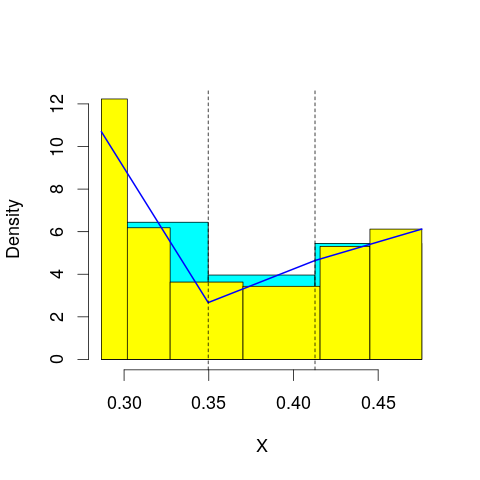

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.94478
mop.approx: Iteration 11. LL = 54.86481
mop.approx: Converged. Iteration 12. LL = 54.8649
[1] "Computing the linear combination of B-splines"


46.2005617912
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.77783
mop.approx: Iteration 11. LL = 54.58249
mop.approx: Iteration 21. LL = 54.59595
mop.approx: Iteration 31. LL = 54.60292
mop.approx: Iteration 41. LL = 54.60672
mop.approx: Iteration 51. LL = 54.60885
mop.approx: Iteration 61. LL = 54.61008
mop.approx: Iteration 71. LL = 54.61079
mop.approx: Converged. Iteration 71. LL = 54.61085
[1] "Computing the linear combination of B-splines"


44.2136390472
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.92859
mop.approx: Iteration 11. LL = 42.32046
mop.approx: Iteration 21. LL = 42.3527
mop.approx: Iteration 31. LL = 42.35503
mop.approx: Converged. Iteration 32. LL = 42.35511
[1] "Computing the linear combination of B-splines"


30.2250362784
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.91195
mop.approx: Iteration 11. LL = 43.35316
mop.approx: Iteration 21. LL = 43.39266
mop.approx: Converged. Iteration 23. LL = 43.39282
[1] "Computing the linear combination of B-splines"


29.5298762513
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.576226
mop.approx: Iteration 11. LL = 42.57267
mop.approx: Iteration 21. LL = 43.13262
mop.approx: Iteration 31. LL = 43.21854
mop.approx: Iteration 41. LL = 43.23775
mop.approx: Iteration 51. LL = 43.24507
mop.approx: Iteration 61. LL = 43.24885
mop.approx: Iteration 71. LL = 43.25111
mop.approx: Iteration 81. LL = 43.25257
mop.approx: Iteration 91. LL = 43.25357
mop.approx: Iteration 101. LL = 43.25428
mop.approx: Iteration 111. LL = 43.2548
mop.approx: Converged. Iteration 112. LL = 43.25489
[1] "Computing the linear combination of B-splines"


27.6590800916
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.758471
mop.approx: Iteration 11. LL = 41.76244
mop.approx: Iteration 21. LL = 41.78851
mop.approx: Converged. Iteration 21. LL = 41.78853
[1] "Computing the linear combination of B-splines"


24.4598519142
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.3480302
mop.approx: Iteration 11. LL = 41.89086
mop.approx: Iteration 21. LL = 42.5291
mop.approx: Iteration 31. LL = 42.60062
mop.approx: Iteration 41. LL = 42.61341
mop.approx: Iteration 51. LL = 42.61609
mop.approx: Converged. Iteration 57. LL = 42.61658
[1] "Computing the linear combination of B-splines"


23.5550327937
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 53.11259
mop.approx: Converged. Iteration 8. LL = 55.0683
[1] "Computing the linear combination of B-splines"


46.403956753
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 46.403956752968398)
m reached
('Sum of Probabilities:', 0.9915254868416963)
chosen


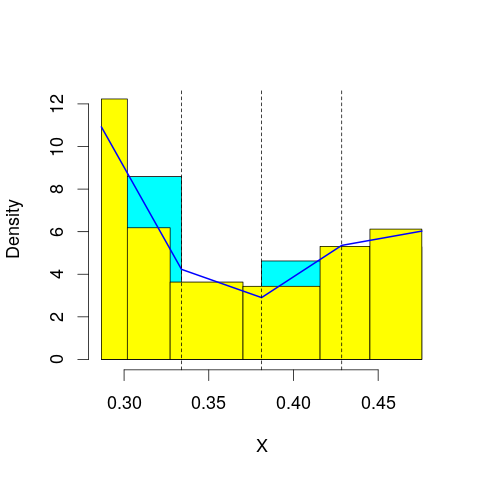

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.94478
mop.approx: Iteration 11. LL = 54.90617
mop.approx: Iteration 21. LL = 54.91309
mop.approx: Converged. Iteration 26. LL = 54.91364
[1] "Computing the linear combination of B-splines"


44.5164299979
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.77783
mop.approx: Iteration 11. LL = 54.66795
mop.approx: Iteration 21. LL = 54.69455
mop.approx: Iteration 31. LL = 54.70726
mop.approx: Iteration 41. LL = 54.7139
mop.approx: Iteration 51. LL = 54.71749
mop.approx: Iteration 61. LL = 54.71947
mop.approx: Iteration 71. LL = 54.72059
mop.approx: Converged. Iteration 79. LL = 54.72119
[1] "Computing the linear combination of B-splines"


42.591115169
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.92859
mop.approx: Iteration 11. LL = 42.60212
mop.approx: Iteration 21. LL = 42.65266
mop.approx: Iteration 31. LL = 42.66407
mop.approx: Iteration 41. LL = 42.66763
mop.approx: Iteration 51. LL = 42.66892
mop.approx: Converged. Iteration 58. LL = 42.66937
[1] "Computing the linear combination of B-splines"


28.8064268072
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.91195
mop.approx: Iteration 11. LL = 43.67738
mop.approx: Iteration 21. LL = 43.69392
mop.approx: Converged. Iteration 28. LL = 43.69477
[1] "Computing the linear combination of B-splines"


28.098962813
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.576226
mop.approx: Iteration 11. LL = 43.2419
mop.approx: Iteration 21. LL = 43.47347
mop.approx: Iteration 31. LL = 43.49931
mop.approx: Iteration 41. LL = 43.50274
mop.approx: Converged. Iteration 46. LL = 43.50313
[1] "Computing the linear combination of B-splines"


26.1744481827
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.758471
mop.approx: Iteration 11. LL = 42.35165
mop.approx: Iteration 21. LL = 42.5754
mop.approx: Iteration 31. LL = 42.64251
mop.approx: Iteration 41. LL = 42.6684
mop.approx: Iteration 51. LL = 42.68047
mop.approx: Iteration 61. LL = 42.68693
mop.approx: Iteration 71. LL = 42.69074
mop.approx: Iteration 81. LL = 42.69318
mop.approx: Iteration 91. LL = 42.69482
mop.approx: Iteration 101. LL = 42.69598
mop.approx: Iteration 111. LL = 42.69683
mop.approx: Iteration 121. LL = 42.69747
mop.approx: Iteration 131. LL = 42.69796
mop.approx: Converged. Iteration 132. LL = 42.69805
[1] "Computing the linear combination of B-splines"


23.6364977119
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.3480302
mop.approx: Iteration 11. LL = 42.70211
mop.approx: Iteration 21. LL = 42.80286
mop.approx: Converged. Iteration 27. LL = 42.80417
[1] "Computing the linear combination of B-splines"


22.0097570638
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 53.11259
mop.approx: Converged. Iteration 8. LL = 54.95699
[1] "Computing the linear combination of B-splines"


44.5597857334
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 44.559785733378639)
m reached
('Sum of Probabilities:', 0.9913629245175763)
chosen


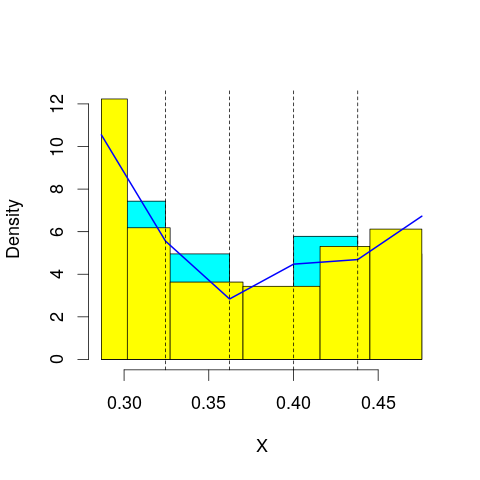

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.94478
mop.approx: Iteration 11. LL = 55.0774
mop.approx: Iteration 21. LL = 55.09504
mop.approx: Iteration 31. LL = 55.09804
mop.approx: Converged. Iteration 35. LL = 55.09844
[1] "Computing the linear combination of B-splines"


42.9683611337
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.77783
mop.approx: Iteration 11. LL = 54.83959
mop.approx: Iteration 21. LL = 54.88917
mop.approx: Iteration 31. LL = 54.90594
mop.approx: Iteration 41. LL = 54.91267
mop.approx: Iteration 51. LL = 54.91564
mop.approx: Iteration 61. LL = 54.91703
mop.approx: Converged. Iteration 69. LL = 54.91767
[1] "Computing the linear combination of B-splines"


41.0547227327
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.92859
mop.approx: Iteration 11. LL = 45.87226
mop.approx: Iteration 21. LL = 46.25797
mop.approx: Iteration 31. LL = 46.30813
mop.approx: Iteration 41. LL = 46.3211
mop.approx: Iteration 51. LL = 46.32658
mop.approx: Iteration 61. LL = 46.32942
mop.approx: Iteration 71. LL = 46.33104
mop.approx: Iteration 81. LL = 46.332
mop.approx: Iteration 91. LL = 46.33259
mop.approx: Converged. Iteration 91. LL = 46.33263
[1] "Computing the linear combination of B-splines"


30.7368208067
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.91195
mop.approx: Iteration 11. LL = 43.89962
mop.approx: Iteration 21. LL = 43.9457
mop.approx: Iteration 31. LL = 43.95495
mop.approx: Iteration 41. LL = 43.95718
mop.approx: Converged. Iteration 48. LL = 43.95771
[1] "Computing the linear combination of B-splines"


26.6290303146
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.576226
mop.approx: Iteration 11. LL = 45.06735
mop.approx: Iteration 21. LL = 45.24565
mop.approx: Iteration 31. LL = 45.27043
mop.approx: Iteration 41. LL = 45.27823
mop.approx: Iteration 51. LL = 45.28144
mop.approx: Iteration 61. LL = 45.28298
mop.approx: Iteration 71. LL = 45.28379
mop.approx: Converged. Iteration 76. LL = 45.2841
[1] "Computing the linear combination of B-splines"


26.2225495643
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.758471
mop.approx: Iteration 11. LL = 42.64201
mop.approx: Iteration 21. LL = 42.76373
mop.approx: Iteration 31. LL = 42.79271
mop.approx: Iteration 41. LL = 42.80285
mop.approx: Iteration 51. LL = 42.80697
mop.approx: Iteration 61. LL = 42.80873
mop.approx: Iteration 71. LL = 42.80949
mop.approx: Converged. Iteration 73. LL = 42.80962
[1] "Computing the linear combination of B-splines"


22.0152057751
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.3480302
mop.approx: Iteration 11. LL = 42.79577
mop.approx: Iteration 21. LL = 42.80514
mop.approx: Converged. Iteration 27. LL = 42.80559
[1] "Computing the linear combination of B-splines"


20.2783017551
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 53.11259
mop.approx: Iteration 11. LL = 55.46269
mop.approx: Converged. Iteration 15. LL = 55.46358
[1] "Computing the linear combination of B-splines"


43.3335047914
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 43.333504791363254)
m reached
('Sum of Probabilities:', 0.9899791172928781)
chosen


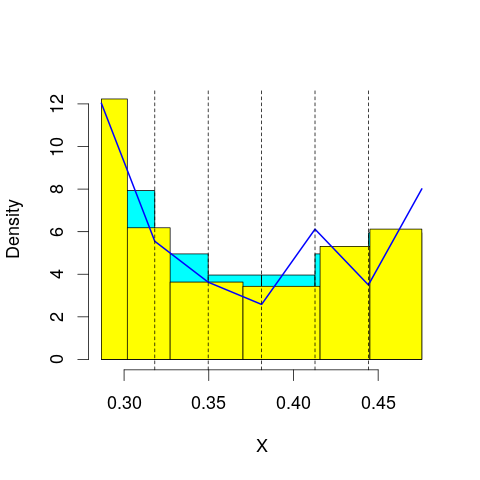

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.94478
mop.approx: Iteration 11. LL = 55.18322
mop.approx: Iteration 21. LL = 55.19443
mop.approx: Converged. Iteration 28. LL = 55.19538
[1] "Computing the linear combination of B-splines"


41.3324350667
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.77783
mop.approx: Iteration 11. LL = 55.01536
mop.approx: Iteration 21. LL = 55.05358
mop.approx: Iteration 31. LL = 55.06069
mop.approx: Iteration 41. LL = 55.06257
mop.approx: Converged. Iteration 47. LL = 55.06308
[1] "Computing the linear combination of B-splines"


39.4672679917
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.92859
mop.approx: Iteration 11. LL = 47.32524
mop.approx: Iteration 21. LL = 47.5103
mop.approx: Iteration 31. LL = 47.53043
mop.approx: Iteration 41. LL = 47.53665
mop.approx: Iteration 51. LL = 47.53965
mop.approx: Iteration 61. LL = 47.54131
mop.approx: Iteration 71. LL = 47.54229
mop.approx: Iteration 81. LL = 47.54291
mop.approx: Converged. Iteration 81. LL = 47.54295
[1] "Computing the linear combination of B-splines"


30.2142727819
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.91195
mop.approx: Iteration 11. LL = 45.01767
mop.approx: Iteration 21. LL = 45.20539
mop.approx: Iteration 31. LL = 45.23214
mop.approx: Iteration 41. LL = 45.23566
mop.approx: Converged. Iteration 45. LL = 45.236
[1] "Computing the linear combination of B-splines"


26.1744485817
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.576226
mop.approx: Iteration 11. LL = 45.47765
mop.approx: Iteration 21. LL = 45.54962
mop.approx: Iteration 31. LL = 45.56933
mop.approx: Iteration 41. LL = 45.57736
mop.approx: Iteration 51. LL = 45.58131
mop.approx: Iteration 61. LL = 45.58351
mop.approx: Iteration 71. LL = 45.58485
mop.approx: Iteration 81. LL = 45.58572
mop.approx: Iteration 91. LL = 45.58632
mop.approx: Converged. Iteration 94. LL = 45.58651
[1] "Computing the linear combination of B-splines"


24.7920942476
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.758471
mop.approx: Iteration 11. LL = 45.4841
mop.approx: Iteration 21. LL = 46.02352
mop.approx: Iteration 31. LL = 46.09496
mop.approx: Iteration 41. LL = 46.10983
mop.approx: Iteration 51. LL = 46.11381
mop.approx: Iteration 61. LL = 46.11497
mop.approx: Converged. Iteration 63. LL = 46.11513
[1] "Computing the linear combination of B-splines"


23.5878419269
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.3480302
mop.approx: Iteration 11. LL = 42.93043
mop.approx: Iteration 21. LL = 42.99823
mop.approx: Iteration 31. LL = 43.02882
mop.approx: Iteration 41. LL = 43.04393
mop.approx: Iteration 51. LL = 43.05185
mop.approx: Iteration 61. LL = 43.05621
mop.approx: Iteration 71. LL = 43.05871
mop.approx: Iteration 81. LL = 43.06018
mop.approx: Iteration 91. LL = 43.06108
mop.approx: Iteration 101. LL = 43.06163
mop.approx: Converged. Iteration 101. LL = 43.06167
[1] "Computing the linear combination of B-splines"


18.8015227105
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 53.11259
mop.approx: Iteration 11. LL = 55.5504
mop.approx: Converged. Iteration 14. LL = 55.55078
[1] "Computing the linear combination of B-splines"


41.6878412934
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 41.687841293426473)
m reached
('Sum of Probabilities:', 0.9892703461676098)
chosen


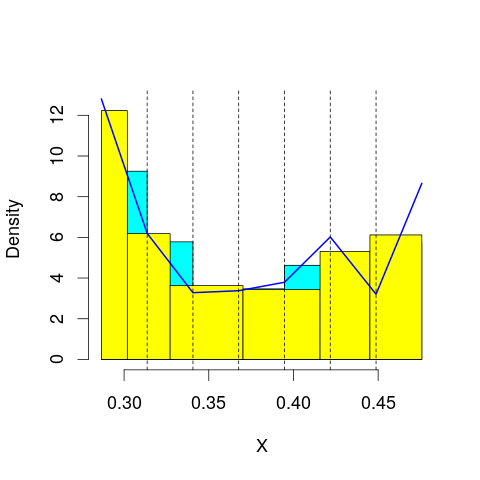

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.94478
mop.approx: Iteration 11. LL = 55.37581
mop.approx: Iteration 21. LL = 55.38258
mop.approx: Converged. Iteration 23. LL = 55.38276
[1] "Computing the linear combination of B-splines"


39.7869434982
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.77783
mop.approx: Iteration 11. LL = 55.14434
mop.approx: Iteration 21. LL = 55.24586
mop.approx: Iteration 31. LL = 55.29193
mop.approx: Iteration 41. LL = 55.3161
mop.approx: Iteration 51. LL = 55.32991
mop.approx: Iteration 61. LL = 55.33832
mop.approx: Iteration 71. LL = 55.34371
mop.approx: Iteration 81. LL = 55.34732
mop.approx: Iteration 91. LL = 55.34981
mop.approx: Iteration 101. LL = 55.35156
mop.approx: Iteration 111. LL = 55.35284
mop.approx: Iteration 121. LL = 55.35377
mop.approx: Iteration 131. LL = 55.35447
mop.approx: Converged. Iteration 134. LL = 55.3547
[1] "Computing the linear combination of B-splines"


38.026020679
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.92859
mop.approx: Iteration 11. LL = 48.00187
mop.approx: Iteration 21. LL = 48.10118
mop.approx: Iteration 31. LL = 48.12349
mop.approx: Iteration 41. LL = 48.13302
mop.approx: Iteration 51. LL = 48.13778
mop.approx: Iteration 61. LL = 48.14044
mop.approx: Iteration 71. LL = 48.14206
mop.approx: Iteration 81. LL = 48.14311
mop.approx: Iteration 91. LL = 48.14382
mop.approx: Converged. Iteration 97. LL = 48.14418
[1] "Computing the linear combination of B-splines"


29.0826348903
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.91195
mop.approx: Iteration 11. LL = 45.98196
mop.approx: Iteration 21. LL = 46.19225
mop.approx: Iteration 31. LL = 46.2336
mop.approx: Iteration 41. LL = 46.24632
mop.approx: Iteration 51. LL = 46.25141
mop.approx: Iteration 61. LL = 46.25385
mop.approx: Iteration 71. LL = 46.25518
mop.approx: Iteration 81. LL = 46.25598
mop.approx: Converged. Iteration 88. LL = 46.25641
[1] "Computing the linear combination of B-splines"


25.4619930584
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.576226
mop.approx: Iteration 11. LL = 45.75015
mop.approx: Iteration 21. LL = 45.80506
mop.approx: Iteration 31. LL = 45.82522
mop.approx: Iteration 41. LL = 45.83443
mop.approx: Iteration 51. LL = 45.83887
mop.approx: Iteration 61. LL = 45.84107
mop.approx: Iteration 71. LL = 45.84217
mop.approx: Converged. Iteration 79. LL = 45.8427
[1] "Computing the linear combination of B-splines"


23.3154145503
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.758471
mop.approx: Iteration 11. LL = 46.44875
mop.approx: Iteration 21. LL = 46.6059
mop.approx: Iteration 31. LL = 46.63052
mop.approx: Iteration 41. LL = 46.64094
mop.approx: Iteration 51. LL = 46.64602
mop.approx: Iteration 61. LL = 46.64866
mop.approx: Iteration 71. LL = 46.65009
mop.approx: Iteration 81. LL = 46.65087
mop.approx: Converged. Iteration 85. LL = 46.65112
[1] "Computing the linear combination of B-splines"


22.3909706387
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.3480302
mop.approx: Iteration 11. LL = 45.13056
mop.approx: Iteration 21. LL = 45.73787
mop.approx: Iteration 31. LL = 45.8459
mop.approx: Iteration 41. LL = 45.87025
mop.approx: Iteration 51. LL = 45.8789
mop.approx: Iteration 61. LL = 45.88324
mop.approx: Iteration 71. LL = 45.88583
mop.approx: Iteration 81. LL = 45.88752
mop.approx: Iteration 91. LL = 45.88869
mop.approx: Iteration 101. LL = 45.88953
mop.approx: Iteration 111. LL = 45.89016
mop.approx: Converged. Iteration 118. LL = 45.89055
[1] "Computing the linear combination of B-splines"


19.8975322087
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 53.11259
mop.approx: Iteration 11. LL = 55.83716
mop.approx: Converged. Iteration 16. LL = 55.83859
[1] "Computing the linear combination of B-splines"


40.2427803194
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 40.24278031942135)
m reached
('Sum of Probabilities:', 0.9878074066458142)
chosen


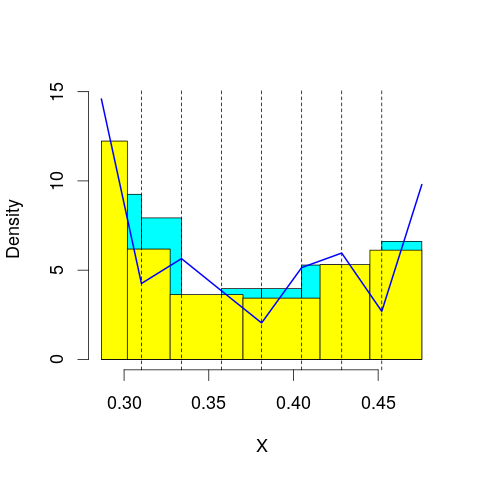

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.94478
mop.approx: Iteration 11. LL = 55.80817
mop.approx: Iteration 21. LL = 55.86612
mop.approx: Iteration 31. LL = 55.87749
mop.approx: Iteration 41. LL = 55.88095
mop.approx: Iteration 51. LL = 55.88232
mop.approx: Converged. Iteration 57. LL = 55.8828
[1] "Computing the linear combination of B-splines"


38.5541212207
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.77783
mop.approx: Iteration 11. LL = 55.12681
mop.approx: Iteration 21. LL = 55.18376
mop.approx: Iteration 31. LL = 55.20392
mop.approx: Iteration 41. LL = 55.21279
mop.approx: Iteration 51. LL = 55.21723
mop.approx: Iteration 61. LL = 55.21968
mop.approx: Iteration 71. LL = 55.22113
mop.approx: Iteration 81. LL = 55.22205
mop.approx: Converged. Iteration 88. LL = 55.22255
[1] "Computing the linear combination of B-splines"


36.1609979453
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.92859
mop.approx: Iteration 11. LL = 48.47697
mop.approx: Iteration 21. LL = 48.55834
mop.approx: Iteration 31. LL = 48.58334
mop.approx: Iteration 41. LL = 48.59417
mop.approx: Iteration 51. LL = 48.59926
mop.approx: Iteration 61. LL = 48.60177
mop.approx: Iteration 71. LL = 48.60304
mop.approx: Converged. Iteration 80. LL = 48.60369
[1] "Computing the linear combination of B-splines"


27.8092715584
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.91195
mop.approx: Iteration 11. LL = 46.79388
mop.approx: Iteration 21. LL = 47.08985
mop.approx: Iteration 31. LL = 47.1718
mop.approx: Iteration 41. LL = 47.19828
mop.approx: Iteration 51. LL = 47.20709
mop.approx: Iteration 61. LL = 47.21024
mop.approx: Iteration 71. LL = 47.21157
mop.approx: Iteration 81. LL = 47.21226
mop.approx: Converged. Iteration 83. LL = 47.21241
[1] "Computing the linear combination of B-splines"


24.6851219814
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.576226
mop.approx: Iteration 11. LL = 45.9692
mop.approx: Iteration 21. LL = 46.00583
mop.approx: Iteration 31. LL = 46.01021
mop.approx: Converged. Iteration 37. LL = 46.01078
[1] "Computing the linear combination of B-splines"


21.7506268914
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.758471
mop.approx: Iteration 11. LL = 46.68605
mop.approx: Iteration 21. LL = 46.71676
mop.approx: Converged. Iteration 24. LL = 46.71706
[1] "Computing the linear combination of B-splines"


20.7240390421
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.3480302
mop.approx: Iteration 11. LL = 46.51957
mop.approx: Iteration 21. LL = 46.95153
mop.approx: Iteration 31. LL = 47.00162
mop.approx: Iteration 41. LL = 47.0115
mop.approx: Iteration 51. LL = 47.01433
mop.approx: Iteration 61. LL = 47.01529
mop.approx: Converged. Iteration 62. LL = 47.01539
[1] "Computing the linear combination of B-splines"


19.2894989647
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 53.11259
mop.approx: Iteration 11. LL = 56.18841
mop.approx: Converged. Iteration 16. LL = 56.1895
[1] "Computing the linear combination of B-splines"


38.8608199194
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 38.860819919375189)
m reached
('Sum of Probabilities:', 0.9870488658475719)
chosen


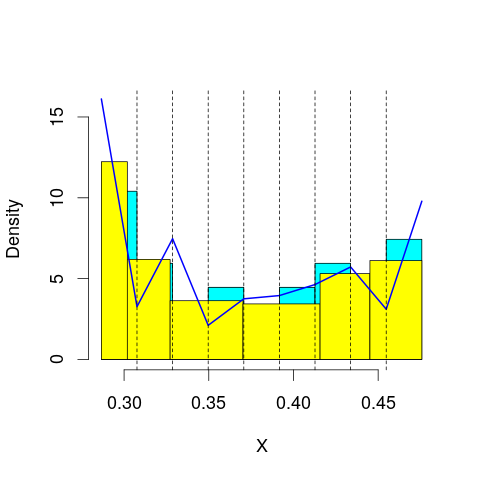

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.94478
mop.approx: Iteration 11. LL = 56.11062
mop.approx: Iteration 21. LL = 56.22191
mop.approx: Iteration 31. LL = 56.24913
mop.approx: Iteration 41. LL = 56.25825
mop.approx: Iteration 51. LL = 56.26168
mop.approx: Iteration 61. LL = 56.26302
mop.approx: Converged. Iteration 65. LL = 56.26335
[1] "Computing the linear combination of B-splines"


37.201800886
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.77783
mop.approx: Iteration 11. LL = 55.29566
mop.approx: Iteration 21. LL = 55.36791
mop.approx: Iteration 31. LL = 55.39145
mop.approx: Iteration 41. LL = 55.40134
mop.approx: Iteration 51. LL = 55.40619
mop.approx: Iteration 61. LL = 55.40884
mop.approx: Iteration 71. LL = 55.4104
mop.approx: Iteration 81. LL = 55.41139
mop.approx: Converged. Iteration 90. LL = 55.41204
[1] "Computing the linear combination of B-splines"


34.6176232723
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.92859
mop.approx: Iteration 11. LL = 48.77399
mop.approx: Iteration 21. LL = 48.86874
mop.approx: Iteration 31. LL = 48.9025
mop.approx: Iteration 41. LL = 48.91783
mop.approx: Iteration 51. LL = 48.92551
mop.approx: Iteration 61. LL = 48.92961
mop.approx: Iteration 71. LL = 48.9319
mop.approx: Iteration 81. LL = 48.93323
mop.approx: Iteration 91. LL = 48.93403
mop.approx: Converged. Iteration 97. LL = 48.93441
[1] "Computing the linear combination of B-splines"


26.4071252224
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.91195
mop.approx: Iteration 11. LL = 47.68736
mop.approx: Iteration 21. LL = 47.9835
mop.approx: Iteration 31. LL = 48.0336
mop.approx: Iteration 41. LL = 48.04494
mop.approx: Iteration 51. LL = 48.04772
mop.approx: Converged. Iteration 58. LL = 48.04834
[1] "Computing the linear combination of B-splines"


23.7881906902
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.576226
mop.approx: Iteration 11. LL = 46.20341
mop.approx: Iteration 21. LL = 46.2798
mop.approx: Iteration 31. LL = 46.3202
mop.approx: Iteration 41. LL = 46.34528
mop.approx: Iteration 51. LL = 46.3609
mop.approx: Iteration 61. LL = 46.37068
mop.approx: Iteration 71. LL = 46.37686
mop.approx: Iteration 81. LL = 46.38081
mop.approx: Iteration 91. LL = 46.38335
mop.approx: Iteration 101. LL = 46.38502
mop.approx: Iteration 111. LL = 46.38613
mop.approx: Iteration 121. LL = 46.3869
mop.approx: Converged. Iteration 130. LL = 46.38744
[1] "Computing the linear combination of B-splines"


20.3944163154
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.758471
mop.approx: Iteration 11. LL = 46.74214
mop.approx: Iteration 21. LL = 46.75875
mop.approx: Iteration 31. LL = 46.76634
mop.approx: Iteration 41. LL = 46.77169
mop.approx: Iteration 51. LL = 46.77542
mop.approx: Iteration 61. LL = 46.77803
mop.approx: Iteration 71. LL = 46.77988
mop.approx: Iteration 81. LL = 46.78119
mop.approx: Iteration 91. LL = 46.78215
mop.approx: Iteration 101. LL = 46.78285
mop.approx: Converged. Iteration 110. LL = 46.78337
[1] "Computing the linear combination of B-splines"


19.0574869827
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.3480302
mop.approx: Iteration 11. LL = 47.10268
mop.approx: Iteration 21. LL = 47.29128
mop.approx: Iteration 31. LL = 47.31568
mop.approx: Iteration 41. LL = 47.32965
mop.approx: Iteration 51. LL = 47.33861
mop.approx: Iteration 61. LL = 47.34428
mop.approx: Iteration 71. LL = 47.34784
mop.approx: Iteration 81. LL = 47.35008
mop.approx: Iteration 91. LL = 47.35151
mop.approx: Iteration 101. LL = 47.35241
mop.approx: Converged. Iteration 110. LL = 47.353
[1] "Computing the linear combination of B-splines"


17.8942377566
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 53.11259
mop.approx: Iteration 11. LL = 57.71112
mop.approx: Iteration 21. LL = 57.72615
mop.approx: Iteration 31. LL = 57.72756
mop.approx: Converged. Iteration 31. LL = 57.72761
[1] "Computing the linear combination of B-splines"


38.6660643043
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 38.666064304329161)
m reached
('Sum of Probabilities:', 0.9880760561679812)
chosen


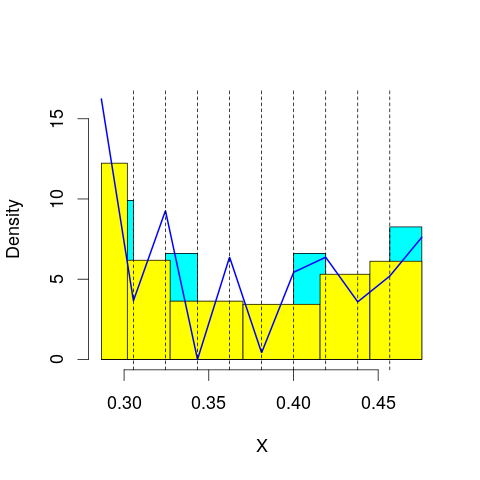

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.94478
mop.approx: Iteration 11. LL = 55.81853
mop.approx: Iteration 21. LL = 55.84416
mop.approx: Iteration 31. LL = 55.84837
mop.approx: Iteration 41. LL = 55.84949
mop.approx: Converged. Iteration 42. LL = 55.8496
[1] "Computing the linear combination of B-splines"


35.0551824902
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.77783
mop.approx: Iteration 11. LL = 55.91888
mop.approx: Iteration 21. LL = 56.06636
mop.approx: Iteration 31. LL = 56.09923
mop.approx: Iteration 41. LL = 56.11109
mop.approx: Iteration 51. LL = 56.11692
mop.approx: Iteration 61. LL = 56.12022
mop.approx: Iteration 71. LL = 56.12224
mop.approx: Iteration 81. LL = 56.12356
mop.approx: Iteration 91. LL = 56.12446
mop.approx: Converged. Iteration 99. LL = 56.12503
[1] "Computing the linear combination of B-splines"


33.5977513367
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.92859
mop.approx: Iteration 11. LL = 48.71655
mop.approx: Iteration 21. LL = 48.74206
mop.approx: Iteration 31. LL = 48.74907
mop.approx: Iteration 41. LL = 48.752
mop.approx: Iteration 51. LL = 48.7534
mop.approx: Iteration 61. LL = 48.75412
mop.approx: Converged. Iteration 62. LL = 48.75421
[1] "Computing the linear combination of B-splines"


24.4940590925
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.91195
mop.approx: Iteration 11. LL = 48.59703
mop.approx: Iteration 21. LL = 48.86949
mop.approx: Iteration 31. LL = 48.91129
mop.approx: Iteration 41. LL = 48.92509
mop.approx: Iteration 51. LL = 48.93175
mop.approx: Iteration 61. LL = 48.9355
mop.approx: Iteration 71. LL = 48.93776
mop.approx: Iteration 81. LL = 48.93918
mop.approx: Iteration 91. LL = 48.9401
mop.approx: Iteration 101. LL = 48.94072
mop.approx: Converged. Iteration 101. LL = 48.94076
[1] "Computing the linear combination of B-splines"


22.9477453604
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.576226
mop.approx: Iteration 11. LL = 46.61589
mop.approx: Iteration 21. LL = 46.76518
mop.approx: Iteration 31. LL = 46.81482
mop.approx: Iteration 41. LL = 46.83577
mop.approx: Iteration 51. LL = 46.84618
mop.approx: Iteration 61. LL = 46.85202
mop.approx: Iteration 71. LL = 46.85562
mop.approx: Iteration 81. LL = 46.858
mop.approx: Iteration 91. LL = 46.85968
mop.approx: Iteration 101. LL = 46.8609
mop.approx: Iteration 111. LL = 46.86183
mop.approx: Iteration 121. LL = 46.86254
mop.approx: Iteration 131. LL = 46.86311
mop.approx: Converged. Iteration 135. LL = 46.86335
[1] "Computing the linear combination of B-splines"


19.13746318
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.758471
mop.approx: Iteration 11. LL = 46.76691
mop.approx: Iteration 21. LL = 46.77985
mop.approx: Iteration 31. LL = 46.78365
mop.approx: Iteration 41. LL = 46.78552
mop.approx: Iteration 51. LL = 46.78673
mop.approx: Iteration 61. LL = 46.78763
mop.approx: Iteration 71. LL = 46.78833
mop.approx: Iteration 81. LL = 46.78889
mop.approx: Converged. Iteration 84. LL = 46.78908
[1] "Computing the linear combination of B-splines"


17.3303225704
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.3480302
mop.approx: Iteration 11. LL = 47.35433
mop.approx: Iteration 21. LL = 47.46528
mop.approx: Iteration 31. LL = 47.49315
mop.approx: Iteration 41. LL = 47.50999
mop.approx: Iteration 51. LL = 47.52122
mop.approx: Iteration 61. LL = 47.52898
mop.approx: Iteration 71. LL = 47.53443
mop.approx: Iteration 81. LL = 47.53828
mop.approx: Iteration 91. LL = 47.54103
mop.approx: Iteration 101. LL = 47.54299
mop.approx: Iteration 111. LL = 47.5444
mop.approx: Iteration 121. LL = 47.5454
mop.approx: Iteration 131. LL = 47.54612
mop.approx: Converged. Iteration 138. LL = 47.54655
[1] "Computing the linear combination of B-splines"


16.3549223014
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 53.11259
mop.approx: Iteration 11. LL = 56.95905
mop.approx: Iteration 21. LL = 56.99862
mop.approx: Iteration 31. LL = 57.00479
mop.approx: Iteration 41. LL = 57.00618
mop.approx: Converged. Iteration 42. LL = 57.00629
[1] "Computing the linear combination of B-splines"


36.211874947
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 36.211874947011367)
m reached
('Sum of Probabilities:', 0.9883127768752129)
chosen


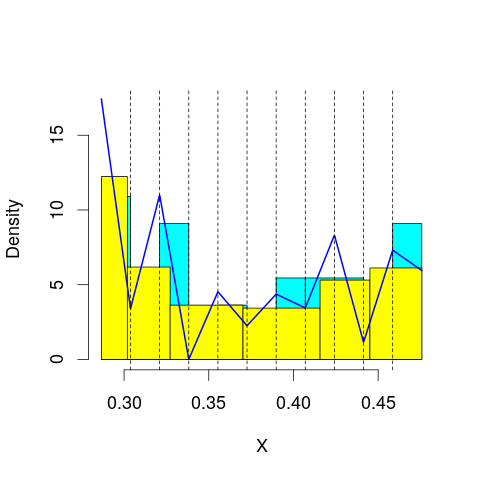

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.94478
mop.approx: Iteration 11. LL = 57.08016
mop.approx: Iteration 21. LL = 57.16975
mop.approx: Iteration 31. LL = 57.18229
mop.approx: Iteration 41. LL = 57.1855
mop.approx: Iteration 51. LL = 57.18652
mop.approx: Converged. Iteration 51. LL = 57.18657
[1] "Computing the linear combination of B-splines"


34.6592894082
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.77783
mop.approx: Iteration 11. LL = 55.83313
mop.approx: Iteration 21. LL = 56.01908
mop.approx: Iteration 31. LL = 56.07208
mop.approx: Iteration 41. LL = 56.09119
mop.approx: Iteration 51. LL = 56.09966
mop.approx: Iteration 61. LL = 56.10393
mop.approx: Iteration 71. LL = 56.10624
mop.approx: Iteration 81. LL = 56.10753
mop.approx: Iteration 91. LL = 56.10828
mop.approx: Converged. Iteration 91. LL = 56.10833
[1] "Computing the linear combination of B-splines"


31.8481834542
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.92859
mop.approx: Iteration 11. LL = 49.07341
mop.approx: Iteration 21. LL = 49.17745
mop.approx: Iteration 31. LL = 49.20288
mop.approx: Iteration 41. LL = 49.21049
mop.approx: Iteration 51. LL = 49.21325
mop.approx: Iteration 61. LL = 49.2144
mop.approx: Converged. Iteration 66. LL = 49.21474
[1] "Computing the linear combination of B-splines"


23.2217232549
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.91195
mop.approx: Iteration 11. LL = 49.09838
mop.approx: Iteration 21. LL = 49.28073
mop.approx: Iteration 31. LL = 49.30651
mop.approx: Iteration 41. LL = 49.31501
mop.approx: Iteration 51. LL = 49.31935
mop.approx: Iteration 61. LL = 49.32205
mop.approx: Iteration 71. LL = 49.32385
mop.approx: Iteration 81. LL = 49.32512
mop.approx: Iteration 91. LL = 49.32604
mop.approx: Iteration 101. LL = 49.32672
mop.approx: Converged. Iteration 108. LL = 49.32714
[1] "Computing the linear combination of B-splines"


21.6012511118
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.576226
mop.approx: Iteration 11. LL = 47.31022
mop.approx: Iteration 21. LL = 47.58392
mop.approx: Iteration 31. LL = 47.66943
mop.approx: Iteration 41. LL = 47.70537
mop.approx: Iteration 51. LL = 47.7228
mop.approx: Iteration 61. LL = 47.73188
mop.approx: Iteration 71. LL = 47.73685
mop.approx: Iteration 81. LL = 47.73968
mop.approx: Iteration 91. LL = 47.74136
mop.approx: Iteration 101. LL = 47.74238
mop.approx: Iteration 111. LL = 47.74303
mop.approx: Converged. Iteration 113. LL = 47.74318
[1] "Computing the linear combination of B-splines"


18.2844256493
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.758471
mop.approx: Iteration 11. LL = 46.83079
mop.approx: Iteration 21. LL = 46.85476
mop.approx: Iteration 31. LL = 46.86447
mop.approx: Iteration 41. LL = 46.86967
mop.approx: Iteration 51. LL = 46.87287
mop.approx: Iteration 61. LL = 46.87505
mop.approx: Iteration 71. LL = 46.87665
mop.approx: Iteration 81. LL = 46.87787
mop.approx: Iteration 91. LL = 46.87883
mop.approx: Iteration 101. LL = 46.87961
mop.approx: Iteration 111. LL = 46.88025
mop.approx: Iteration 121. LL = 46.88078
mop.approx: Converged. Iteration 122. LL = 46.88087
[1] "Computing the linear combination of B-splines"


15.689245268
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.3480302
mop.approx: Iteration 11. LL = 47.49702
mop.approx: Iteration 21. LL = 47.57935
mop.approx: Iteration 31. LL = 47.6057
mop.approx: Iteration 41. LL = 47.62066
mop.approx: Iteration 51. LL = 47.63042
mop.approx: Iteration 61. LL = 47.63738
mop.approx: Iteration 71. LL = 47.64259
mop.approx: Iteration 81. LL = 47.6466
mop.approx: Iteration 91. LL = 47.64974
mop.approx: Iteration 101. LL = 47.65224
mop.approx: Iteration 111. LL = 47.65424
mop.approx: Iteration 121. LL = 47.65585
mop.approx: Iteration 131. LL = 47.65715
mop.approx: Iteration 141. LL = 47.65821
mop.approx: Iteration 151. LL = 47.65908
mop.approx: Iteration 161. LL = 47.65979
mop.approx: Iteration 171. LL = 47.66037
mop.approx: Converged. Iteration 177. LL = 47.66072
[1] "Computing the linear combination of B-splines"


14.7362148942
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 53.11259
mop.approx: Iteration 11. LL = 57.45864
mop.approx: Iteration 21. LL = 57.48965
mop.approx: Iteration 31. LL = 57.4922
mop.approx: Converged. Iteration 34. LL = 57.49246
[1] "Computing the linear combination of B-splines"


34.9651729087
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 34.965172908652619)
m reached
('Sum of Probabilities:', 0.9888873035758885)
chosen


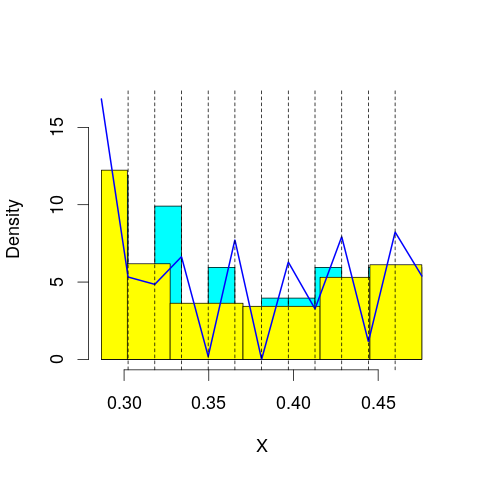

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.94478
mop.approx: Iteration 11. LL = 57.30463
mop.approx: Iteration 21. LL = 57.32794
mop.approx: Iteration 31. LL = 57.32997
mop.approx: Converged. Iteration 32. LL = 57.33007
[1] "Computing the linear combination of B-splines"


33.0699229265
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.77783
mop.approx: Iteration 11. LL = 56.23769
mop.approx: Iteration 21. LL = 56.47925
mop.approx: Iteration 31. LL = 56.53209
mop.approx: Iteration 41. LL = 56.54684
mop.approx: Iteration 51. LL = 56.55273
mop.approx: Iteration 61. LL = 56.55582
mop.approx: Iteration 71. LL = 56.55768
mop.approx: Iteration 81. LL = 56.55891
mop.approx: Iteration 91. LL = 56.55976
mop.approx: Converged. Iteration 99. LL = 56.56032
[1] "Computing the linear combination of B-splines"


30.5673034031
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.92859
mop.approx: Iteration 11. LL = 49.27516
mop.approx: Iteration 21. LL = 49.33293
mop.approx: Iteration 31. LL = 49.34233
mop.approx: Iteration 41. LL = 49.34592
mop.approx: Iteration 51. LL = 49.34769
mop.approx: Iteration 61. LL = 49.34861
mop.approx: Converged. Iteration 66. LL = 49.34894
[1] "Computing the linear combination of B-splines"


21.623057462
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.91195
mop.approx: Iteration 11. LL = 49.43038
mop.approx: Iteration 21. LL = 49.58572
mop.approx: Iteration 31. LL = 49.61562
mop.approx: Iteration 41. LL = 49.62509
mop.approx: Iteration 51. LL = 49.62851
mop.approx: Iteration 61. LL = 49.62987
mop.approx: Converged. Iteration 68. LL = 49.63038
[1] "Computing the linear combination of B-splines"


20.1716225171
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.576226
mop.approx: Iteration 11. LL = 48.05686
mop.approx: Iteration 21. LL = 48.36808
mop.approx: Iteration 31. LL = 48.43349
mop.approx: Iteration 41. LL = 48.45671
mop.approx: Iteration 51. LL = 48.46889
mop.approx: Iteration 61. LL = 48.4767
mop.approx: Iteration 71. LL = 48.48215
mop.approx: Iteration 81. LL = 48.48608
mop.approx: Iteration 91. LL = 48.48897
mop.approx: Iteration 101. LL = 48.49113
mop.approx: Iteration 111. LL = 48.49277
mop.approx: Iteration 121. LL = 48.49401
mop.approx: Iteration 131. LL = 48.49497
mop.approx: Iteration 141. LL = 48.49571
mop.approx: Iteration 151. LL = 48.49628
mop.approx: Converged. Iteration 153. LL = 48.49643
[1] "Computing the linear combination of B-splines"


17.3048042939
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.758471
mop.approx: Iteration 11. LL = 47.0924
mop.approx: Iteration 21. LL = 47.20316
mop.approx: Iteration 31. LL = 47.25428
mop.approx: Iteration 41. LL = 47.27968
mop.approx: Iteration 51. LL = 47.29293
mop.approx: Iteration 61. LL = 47.30014
mop.approx: Iteration 71. LL = 47.30418
mop.approx: Iteration 81. LL = 47.3065
mop.approx: Iteration 91. LL = 47.30787
mop.approx: Iteration 101. LL = 47.3087
mop.approx: Converged. Iteration 108. LL = 47.30914
[1] "Computing the linear combination of B-splines"


14.3846469747
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.3480302
mop.approx: Iteration 11. LL = 47.54831
mop.approx: Iteration 21. LL = 47.5907
mop.approx: Iteration 31. LL = 47.59991
mop.approx: Iteration 41. LL = 47.60416
mop.approx: Iteration 51. LL = 47.60654
mop.approx: Iteration 61. LL = 47.608
mop.approx: Iteration 71. LL = 47.60897
mop.approx: Iteration 81. LL = 47.60966
mop.approx: Converged. Iteration 89. LL = 47.61014
[1] "Computing the linear combination of B-splines"


12.9527833387
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 53.11259
mop.approx: Iteration 11. LL = 58.18512
mop.approx: Iteration 21. LL = 58.18896
mop.approx: Converged. Iteration 21. LL = 58.18902
[1] "Computing the linear combination of B-splines"


33.9288638962
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 33.928863896224719)
m reached
('Sum of Probabilities:', 0.9892908027317623)
chosen


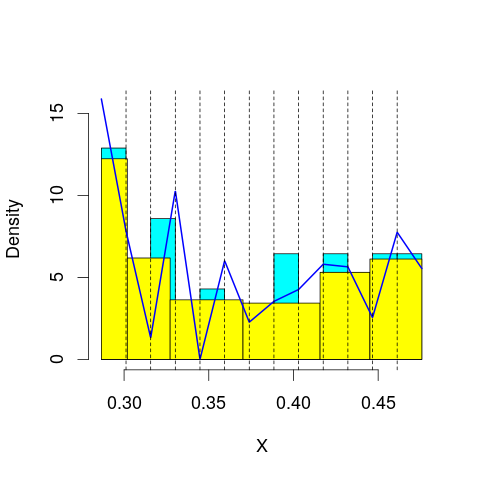

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.94478
mop.approx: Iteration 11. LL = 57.30633
mop.approx: Iteration 21. LL = 57.3908
mop.approx: Iteration 31. LL = 57.39788
mop.approx: Converged. Iteration 36. LL = 57.39847
[1] "Computing the linear combination of B-splines"


31.4054504171
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.77783
mop.approx: Iteration 11. LL = 56.84272
mop.approx: Iteration 21. LL = 56.96994
mop.approx: Iteration 31. LL = 56.99645
mop.approx: Iteration 41. LL = 57.00393
mop.approx: Iteration 51. LL = 57.00671
mop.approx: Iteration 61. LL = 57.00802
mop.approx: Converged. Iteration 70. LL = 57.00875
[1] "Computing the linear combination of B-splines"


29.2828619356
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.92859
mop.approx: Iteration 11. LL = 49.60723
mop.approx: Iteration 21. LL = 49.79042
mop.approx: Iteration 31. LL = 49.83327
mop.approx: Iteration 41. LL = 49.84698
mop.approx: Iteration 51. LL = 49.85296
mop.approx: Iteration 61. LL = 49.85612
mop.approx: Iteration 71. LL = 49.858
mop.approx: Iteration 81. LL = 49.8592
mop.approx: Iteration 91. LL = 49.86
mop.approx: Converged. Iteration 99. LL = 49.86051
[1] "Computing the linear combination of B-splines"


20.401756614
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.91195
mop.approx: Iteration 11. LL = 49.59251
mop.approx: Iteration 21. LL = 49.66407
mop.approx: Iteration 31. LL = 49.67186
mop.approx: Iteration 41. LL = 49.67563
mop.approx: Iteration 51. LL = 49.67818
mop.approx: Iteration 61. LL = 49.67996
mop.approx: Iteration 71. LL = 49.68123
mop.approx: Iteration 81. LL = 49.68215
mop.approx: Iteration 91. LL = 49.68283
mop.approx: Converged. Iteration 97. LL = 49.6832
[1] "Computing the linear combination of B-splines"


18.491578834
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.576226
mop.approx: Iteration 11. LL = 48.80441
mop.approx: Iteration 21. LL = 49.21179
mop.approx: Iteration 31. LL = 49.2848
mop.approx: Iteration 41. LL = 49.30384
mop.approx: Iteration 51. LL = 49.31049
mop.approx: Iteration 61. LL = 49.31343
mop.approx: Iteration 71. LL = 49.31499
mop.approx: Iteration 81. LL = 49.31592
mop.approx: Iteration 91. LL = 49.31652
mop.approx: Converged. Iteration 91. LL = 49.31657
[1] "Computing the linear combination of B-splines"


16.3920815402
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.758471
mop.approx: Iteration 11. LL = 47.48347
mop.approx: Iteration 21. LL = 47.61659
mop.approx: Iteration 31. LL = 47.6562
mop.approx: Iteration 41. LL = 47.67452
mop.approx: Iteration 51. LL = 47.68516
mop.approx: Iteration 61. LL = 47.69212
mop.approx: Iteration 71. LL = 47.69702
mop.approx: Iteration 81. LL = 47.70062
mop.approx: Iteration 91. LL = 47.70333
mop.approx: Iteration 101. LL = 47.7054
mop.approx: Iteration 111. LL = 47.70699
mop.approx: Iteration 121. LL = 47.70822
mop.approx: Iteration 131. LL = 47.70917
mop.approx: Iteration 141. LL = 47.70991
mop.approx: Iteration 151. LL = 47.71049
mop.approx: Converged. Iteration 154. LL = 47.71068
[1] "Computing the linear combination of B-splines"


13.0533348922
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.3480302
mop.approx: Iteration 11. LL = 47.63236
mop.approx: Iteration 21. LL = 47.70327
mop.approx: Iteration 31. LL = 47.73844
mop.approx: Iteration 41. LL = 47.75777
mop.approx: Iteration 51. LL = 47.76795
mop.approx: Iteration 61. LL = 47.77315
mop.approx: Iteration 71. LL = 47.77574
mop.approx: Iteration 81. LL = 47.77703
mop.approx: Converged. Iteration 90. LL = 47.77767
[1] "Computing the linear combination of B-splines"


11.387437722
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 53.11259
mop.approx: Iteration 11. LL = 59.11198
mop.approx: Iteration 21. LL = 59.1261
mop.approx: Converged. Iteration 27. LL = 59.12703
[1] "Computing the linear combination of B-splines"


33.1340115647
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 33.134011564665336)
m reached
('Sum of Probabilities:', 0.9888739899078672)
chosen


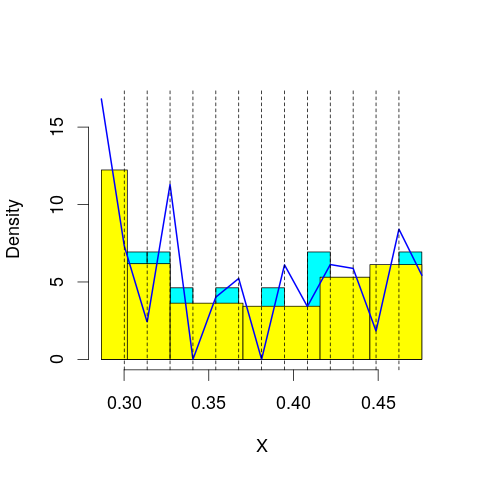

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.94478
mop.approx: Iteration 11. LL = 56.94132
mop.approx: Iteration 21. LL = 56.96987
mop.approx: Iteration 31. LL = 56.97737
mop.approx: Iteration 41. LL = 56.9806
mop.approx: Iteration 51. LL = 56.98228
mop.approx: Iteration 61. LL = 56.98325
mop.approx: Converged. Iteration 68. LL = 56.98377
[1] "Computing the linear combination of B-splines"


29.2578818691
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.77783
mop.approx: Iteration 11. LL = 57.71827
mop.approx: Iteration 21. LL = 57.88663
mop.approx: Iteration 31. LL = 57.91738
mop.approx: Iteration 41. LL = 57.92611
mop.approx: Iteration 51. LL = 57.92909
mop.approx: Iteration 61. LL = 57.93016
mop.approx: Converged. Iteration 62. LL = 57.93028
[1] "Computing the linear combination of B-splines"


28.4715220349
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.92859
mop.approx: Iteration 11. LL = 49.76678
mop.approx: Iteration 21. LL = 49.8596
mop.approx: Iteration 31. LL = 49.88102
mop.approx: Iteration 41. LL = 49.88885
mop.approx: Iteration 51. LL = 49.89223
mop.approx: Iteration 61. LL = 49.89381
mop.approx: Iteration 71. LL = 49.89459
mop.approx: Converged. Iteration 72. LL = 49.8947
[1] "Computing the linear combination of B-splines"


18.7030725607
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.91195
mop.approx: Iteration 11. LL = 49.89416
mop.approx: Iteration 21. LL = 50.04065
mop.approx: Iteration 31. LL = 50.07904
mop.approx: Iteration 41. LL = 50.09393
mop.approx: Iteration 51. LL = 50.10146
mop.approx: Iteration 61. LL = 50.10591
mop.approx: Iteration 71. LL = 50.10878
mop.approx: Iteration 81. LL = 50.11075
mop.approx: Iteration 91. LL = 50.11214
mop.approx: Iteration 101. LL = 50.11316
mop.approx: Iteration 111. LL = 50.11393
mop.approx: Iteration 121. LL = 50.11451
mop.approx: Converged. Iteration 122. LL = 50.11461
[1] "Computing the linear combination of B-splines"


17.1901215331
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.576226
mop.approx: Iteration 11. LL = 49.31642
mop.approx: Iteration 21. LL = 49.68323
mop.approx: Iteration 31. LL = 49.72339
mop.approx: Iteration 41. LL = 49.73182
mop.approx: Iteration 51. LL = 49.73524
mop.approx: Iteration 61. LL = 49.7372
mop.approx: Iteration 71. LL = 49.73851
mop.approx: Iteration 81. LL = 49.73944
mop.approx: Iteration 91. LL = 49.74013
mop.approx: Converged. Iteration 96. LL = 49.74045
[1] "Computing the linear combination of B-splines"


15.0830893704
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.758471
mop.approx: Iteration 11. LL = 47.94898
mop.approx: Iteration 21. LL = 48.12354
mop.approx: Iteration 31. LL = 48.16889
mop.approx: Iteration 41. LL = 48.1868
mop.approx: Iteration 51. LL = 48.19593
mop.approx: Iteration 61. LL = 48.20146
mop.approx: Iteration 71. LL = 48.20515
mop.approx: Iteration 81. LL = 48.20773
mop.approx: Iteration 91. LL = 48.2096
mop.approx: Iteration 101. LL = 48.21099
mop.approx: Iteration 111. LL = 48.21205
mop.approx: Iteration 121. LL = 48.21285
mop.approx: Iteration 131. LL = 48.21349
mop.approx: Converged. Iteration 137. LL = 48.21385
[1] "Computing the linear combination of B-splines"


11.8236200268
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.3480302
mop.approx: Iteration 11. LL = 47.81884
mop.approx: Iteration 21. LL = 47.91233
mop.approx: Iteration 31. LL = 47.94064
mop.approx: Iteration 41. LL = 47.95239
mop.approx: Iteration 51. LL = 47.95876
mop.approx: Iteration 61. LL = 47.96272
mop.approx: Iteration 71. LL = 47.96539
mop.approx: Iteration 81. LL = 47.96731
mop.approx: Iteration 91. LL = 47.96875
mop.approx: Iteration 101. LL = 47.96988
mop.approx: Iteration 111. LL = 47.97079
mop.approx: Iteration 121. LL = 47.97156
mop.approx: Iteration 131. LL = 47.97221
mop.approx: Iteration 141. LL = 47.97278
mop.approx: Converged. Iteration 149. LL = 47.97323
[1] "Computing the linear combination of B-splines"


9.85022132565
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 53.11259
mop.approx: Iteration 11. LL = 58.4869
mop.approx: Iteration 21. LL = 58.51049
mop.approx: Iteration 31. LL = 58.51319
mop.approx: Converged. Iteration 38. LL = 58.51384
[1] "Computing the linear combination of B-splines"


30.7879491982
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 30.787949198236067)
m reached
('Sum of Probabilities:', 0.9884182475044875)
chosen


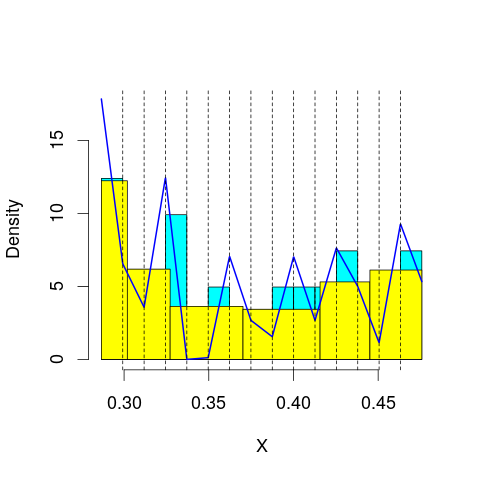

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.94478
mop.approx: Iteration 11. LL = 58.01768
mop.approx: Iteration 21. LL = 58.10114
mop.approx: Iteration 31. LL = 58.12168
mop.approx: Iteration 41. LL = 58.12924
mop.approx: Iteration 51. LL = 58.13274
mop.approx: Iteration 61. LL = 58.13457
mop.approx: Iteration 71. LL = 58.13562
mop.approx: Converged. Iteration 77. LL = 58.13609
[1] "Computing the linear combination of B-splines"


28.6773307577
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.77783
mop.approx: Iteration 11. LL = 58.15745
mop.approx: Iteration 21. LL = 58.3257
mop.approx: Iteration 31. LL = 58.35135
mop.approx: Iteration 41. LL = 58.35847
mop.approx: Iteration 51. LL = 58.36107
mop.approx: Iteration 61. LL = 58.36227
mop.approx: Converged. Iteration 68. LL = 58.36281
[1] "Computing the linear combination of B-splines"


27.1711853061
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.92859
mop.approx: Iteration 11. LL = 50.25722
mop.approx: Iteration 21. LL = 50.35248
mop.approx: Iteration 31. LL = 50.37104
mop.approx: Iteration 41. LL = 50.37644
mop.approx: Iteration 51. LL = 50.37866
mop.approx: Iteration 61. LL = 50.37981
mop.approx: Iteration 71. LL = 50.38049
mop.approx: Converged. Iteration 72. LL = 50.38059
[1] "Computing the linear combination of B-splines"


17.456098074
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.91195
mop.approx: Iteration 11. LL = 50.38335
mop.approx: Iteration 21. LL = 50.61593
mop.approx: Iteration 31. LL = 50.67678
mop.approx: Iteration 41. LL = 50.699
mop.approx: Iteration 51. LL = 50.70838
mop.approx: Iteration 61. LL = 50.71264
mop.approx: Iteration 71. LL = 50.71467
mop.approx: Iteration 81. LL = 50.71567
mop.approx: Converged. Iteration 86. LL = 50.71601
[1] "Computing the linear combination of B-splines"


16.0586553621
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.576226
mop.approx: Iteration 11. LL = 49.47875
mop.approx: Iteration 21. LL = 49.74496
mop.approx: Iteration 31. LL = 49.78705
mop.approx: Iteration 41. LL = 49.80354
mop.approx: Iteration 51. LL = 49.81225
mop.approx: Iteration 61. LL = 49.81752
mop.approx: Iteration 71. LL = 49.82099
mop.approx: Iteration 81. LL = 49.8234
mop.approx: Iteration 91. LL = 49.82515
mop.approx: Iteration 101. LL = 49.82645
mop.approx: Iteration 111. LL = 49.82744
mop.approx: Iteration 121. LL = 49.82822
mop.approx: Iteration 131. LL = 49.82883
mop.approx: Converged. Iteration 135. LL = 49.82909
[1] "Computing the linear combination of B-splines"


13.4388597602
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.758471
mop.approx: Iteration 11. LL = 48.54016
mop.approx: Iteration 21. LL = 48.82972
mop.approx: Iteration 31. LL = 48.88014
mop.approx: Iteration 41. LL = 48.89551
mop.approx: Iteration 51. LL = 48.9026
mop.approx: Iteration 61. LL = 48.90658
mop.approx: Iteration 71. LL = 48.90906
mop.approx: Iteration 81. LL = 48.91072
mop.approx: Iteration 91. LL = 48.91189
mop.approx: Iteration 101. LL = 48.91274
mop.approx: Iteration 111. LL = 48.91338
mop.approx: Converged. Iteration 116. LL = 48.91369
[1] "Computing the linear combination of B-splines"


10.7905845745
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.3480302
mop.approx: Iteration 11. LL = 48.04131
mop.approx: Iteration 21. LL = 48.11958
mop.approx: Iteration 31. LL = 48.13876
mop.approx: Iteration 41. LL = 48.14496
mop.approx: Iteration 51. LL = 48.14712
mop.approx: Iteration 61. LL = 48.14795
mop.approx: Converged. Iteration 62. LL = 48.14805
[1] "Computing the linear combination of B-splines"


8.29190372212
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 53.11259
mop.approx: Iteration 11. LL = 58.79799
mop.approx: Iteration 21. LL = 58.82693
mop.approx: Iteration 31. LL = 58.83361
mop.approx: Iteration 41. LL = 58.83634
mop.approx: Iteration 51. LL = 58.83774
mop.approx: Iteration 61. LL = 58.83852
mop.approx: Converged. Iteration 61. LL = 58.83858
[1] "Computing the linear combination of B-splines"


29.3798213787
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 29.379821378730725)
m reached
('Sum of Probabilities:', 0.9883505186535717)
chosen


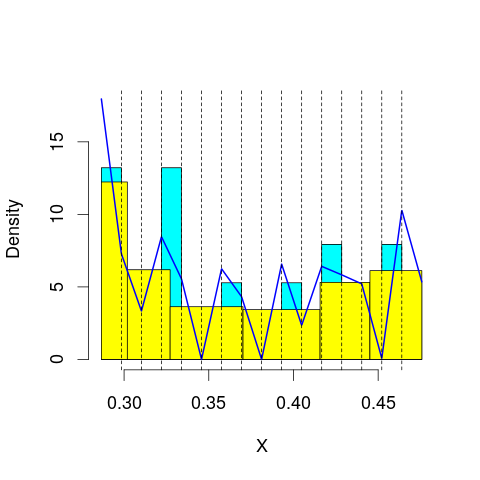

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.94478
mop.approx: Iteration 11. LL = 58.73675
mop.approx: Iteration 21. LL = 58.83018
mop.approx: Iteration 31. LL = 58.84891
mop.approx: Iteration 41. LL = 58.85466
mop.approx: Iteration 51. LL = 58.85705
mop.approx: Iteration 61. LL = 58.85827
mop.approx: Converged. Iteration 69. LL = 58.85891
[1] "Computing the linear combination of B-splines"


27.6672910177
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.77783
mop.approx: Iteration 11. LL = 57.90288
mop.approx: Iteration 21. LL = 58.02296
mop.approx: Iteration 31. LL = 58.05527
mop.approx: Iteration 41. LL = 58.06637
mop.approx: Iteration 51. LL = 58.07071
mop.approx: Iteration 61. LL = 58.07259
mop.approx: Iteration 71. LL = 58.07347
mop.approx: Converged. Iteration 72. LL = 58.07359
[1] "Computing the linear combination of B-splines"


25.1490960533
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.92859
mop.approx: Iteration 11. LL = 51.0978
mop.approx: Iteration 21. LL = 51.27176
mop.approx: Iteration 31. LL = 51.31484
mop.approx: Iteration 41. LL = 51.32983
mop.approx: Iteration 51. LL = 51.33629
mop.approx: Iteration 61. LL = 51.33955
mop.approx: Iteration 71. LL = 51.34137
mop.approx: Iteration 81. LL = 51.34245
mop.approx: Iteration 91. LL = 51.34311
mop.approx: Converged. Iteration 91. LL = 51.34316
[1] "Computing the linear combination of B-splines"


16.6858001324
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.91195
mop.approx: Iteration 11. LL = 50.40926
mop.approx: Iteration 21. LL = 50.5101
mop.approx: Iteration 31. LL = 50.52903
mop.approx: Iteration 41. LL = 50.53321
mop.approx: Converged. Iteration 50. LL = 50.53418
[1] "Computing the linear combination of B-splines"


14.1439488813
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.576226
mop.approx: Iteration 11. LL = 49.99087
mop.approx: Iteration 21. LL = 50.32878
mop.approx: Iteration 31. LL = 50.40827
mop.approx: Iteration 41. LL = 50.43856
mop.approx: Iteration 51. LL = 50.45178
mop.approx: Iteration 61. LL = 50.45791
mop.approx: Iteration 71. LL = 50.4609
mop.approx: Iteration 81. LL = 50.46243
mop.approx: Iteration 91. LL = 50.46325
mop.approx: Converged. Iteration 94. LL = 50.46347
[1] "Computing the linear combination of B-splines"


12.3403798692
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.758471
mop.approx: Iteration 11. LL = 48.7598
mop.approx: Iteration 21. LL = 49.10547
mop.approx: Iteration 31. LL = 49.20289
mop.approx: Iteration 41. LL = 49.24199
mop.approx: Iteration 51. LL = 49.26147
mop.approx: Iteration 61. LL = 49.27245
mop.approx: Iteration 71. LL = 49.2791
mop.approx: Iteration 81. LL = 49.28329
mop.approx: Iteration 91. LL = 49.28604
mop.approx: Iteration 101. LL = 49.28788
mop.approx: Iteration 111. LL = 49.28913
mop.approx: Iteration 121. LL = 49.29001
mop.approx: Iteration 131. LL = 49.29062
mop.approx: Converged. Iteration 132. LL = 49.29072
[1] "Computing the linear combination of B-splines"


9.43470172268
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.3480302
mop.approx: Iteration 11. LL = 48.45965
mop.approx: Iteration 21. LL = 48.63653
mop.approx: Iteration 31. LL = 48.68257
mop.approx: Iteration 41. LL = 48.69915
mop.approx: Iteration 51. LL = 48.70724
mop.approx: Iteration 61. LL = 48.71206
mop.approx: Iteration 71. LL = 48.71523
mop.approx: Iteration 81. LL = 48.71739
mop.approx: Iteration 91. LL = 48.71892
mop.approx: Iteration 101. LL = 48.72002
mop.approx: Iteration 111. LL = 48.72084
mop.approx: Iteration 121. LL = 48.72146
mop.approx: Converged. Iteration 125. LL = 48.72171
[1] "Computing the linear combination of B-splines"


7.13168631151
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 53.11259
mop.approx: Iteration 11. LL = 58.98207
mop.approx: Iteration 21. LL = 59.04707
mop.approx: Iteration 31. LL = 59.06756
mop.approx: Iteration 41. LL = 59.07608
mop.approx: Iteration 51. LL = 59.08011
mop.approx: Iteration 61. LL = 59.08219
mop.approx: Iteration 71. LL = 59.08333
mop.approx: Converged. Iteration 78. LL = 59.08389
[1] "Computing the linear combination of B-splines"


27.8922619524
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 27.892261952394861)
m reached
('Sum of Probabilities:', 0.9880803452641539)
chosen


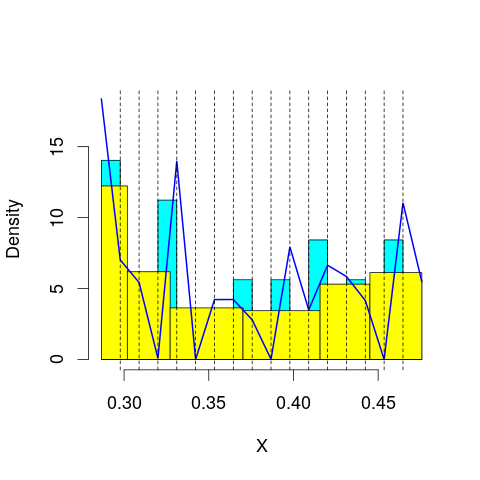

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.94478
mop.approx: Iteration 11. LL = 59.20952
mop.approx: Iteration 21. LL = 59.30298
mop.approx: Iteration 31. LL = 59.31851
mop.approx: Iteration 41. LL = 59.3226
mop.approx: Iteration 51. LL = 59.32383
mop.approx: Converged. Iteration 52. LL = 59.32395
[1] "Computing the linear combination of B-splines"


26.3994577519
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.77783
mop.approx: Iteration 11. LL = 58.11414
mop.approx: Iteration 21. LL = 58.20443
mop.approx: Iteration 31. LL = 58.23501
mop.approx: Iteration 41. LL = 58.24807
mop.approx: Iteration 51. LL = 58.25392
mop.approx: Iteration 61. LL = 58.25661
mop.approx: Iteration 71. LL = 58.25786
mop.approx: Converged. Iteration 76. LL = 58.25827
[1] "Computing the linear combination of B-splines"


23.6009144792
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.92859
mop.approx: Iteration 11. LL = 51.38321
mop.approx: Iteration 21. LL = 51.46649
mop.approx: Iteration 31. LL = 51.47688
mop.approx: Iteration 41. LL = 51.47902
mop.approx: Converged. Iteration 46. LL = 51.47943
[1] "Computing the linear combination of B-splines"


15.089201021
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.91195
mop.approx: Iteration 11. LL = 51.03007
mop.approx: Iteration 21. LL = 51.2387
mop.approx: Iteration 31. LL = 51.30088
mop.approx: Iteration 41. LL = 51.32481
mop.approx: Iteration 51. LL = 51.33536
mop.approx: Iteration 61. LL = 51.34055
mop.approx: Iteration 71. LL = 51.34338
mop.approx: Iteration 81. LL = 51.34505
mop.approx: Iteration 91. LL = 51.34611
mop.approx: Iteration 101. LL = 51.34681
mop.approx: Converged. Iteration 104. LL = 51.34703
[1] "Computing the linear combination of B-splines"


13.2239306748
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.576226
mop.approx: Iteration 11. LL = 50.30513
mop.approx: Iteration 21. LL = 50.53421
mop.approx: Iteration 31. LL = 50.56941
mop.approx: Iteration 41. LL = 50.57977
mop.approx: Iteration 51. LL = 50.58389
mop.approx: Iteration 61. LL = 50.58592
mop.approx: Iteration 71. LL = 50.58711
mop.approx: Iteration 81. LL = 50.5879
mop.approx: Converged. Iteration 88. LL = 50.58835
[1] "Computing the linear combination of B-splines"


10.7323871408
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.758471
mop.approx: Iteration 11. LL = 49.06818
mop.approx: Iteration 21. LL = 49.51207
mop.approx: Iteration 31. LL = 49.6618
mop.approx: Iteration 41. LL = 49.72244
mop.approx: Iteration 51. LL = 49.74913
mop.approx: Iteration 61. LL = 49.76149
mop.approx: Iteration 71. LL = 49.76743
mop.approx: Iteration 81. LL = 49.77036
mop.approx: Iteration 91. LL = 49.77183
mop.approx: Iteration 101. LL = 49.77259
mop.approx: Converged. Iteration 102. LL = 49.77269
[1] "Computing the linear combination of B-splines"


8.18372829976
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.3480302
mop.approx: Iteration 11. LL = 48.68753
mop.approx: Iteration 21. LL = 48.80863
mop.approx: Iteration 31. LL = 48.82169
mop.approx: Iteration 41. LL = 48.82551
mop.approx: Iteration 51. LL = 48.82751
mop.approx: Iteration 61. LL = 48.8288
mop.approx: Iteration 71. LL = 48.82973
mop.approx: Iteration 81. LL = 48.83045
mop.approx: Iteration 91. LL = 48.83104
mop.approx: Converged. Iteration 97. LL = 48.8314
[1] "Computing the linear combination of B-splines"


5.51000447223
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 53.11259
mop.approx: Iteration 11. LL = 60.51318
mop.approx: Iteration 21. LL = 60.56023
mop.approx: Iteration 31. LL = 60.56888
mop.approx: Iteration 41. LL = 60.57245
mop.approx: Iteration 51. LL = 60.57428
mop.approx: Iteration 61. LL = 60.57531
mop.approx: Converged. Iteration 66. LL = 60.5757
[1] "Computing the linear combination of B-splines"


27.6512127837
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 27.651212783673905)
m reached
('Sum of Probabilities:', 0.9880685952540155)
chosen


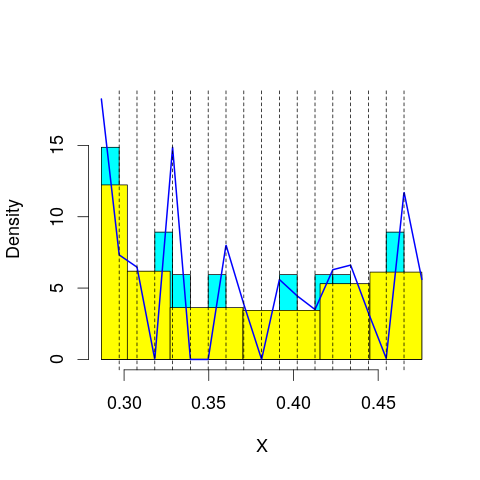

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.94478
mop.approx: Iteration 11. LL = 58.81569
mop.approx: Iteration 21. LL = 58.89529
mop.approx: Iteration 31. LL = 58.90662
mop.approx: Iteration 41. LL = 58.90912
mop.approx: Converged. Iteration 49. LL = 58.90988
[1] "Computing the linear combination of B-splines"


24.2525229861
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.77783
mop.approx: Iteration 11. LL = 59.03133
mop.approx: Iteration 21. LL = 59.12586
mop.approx: Iteration 31. LL = 59.14921
mop.approx: Iteration 41. LL = 59.15823
mop.approx: Iteration 51. LL = 59.16259
mop.approx: Iteration 61. LL = 59.16491
mop.approx: Iteration 71. LL = 59.16621
mop.approx: Converged. Iteration 79. LL = 59.16688
[1] "Computing the linear combination of B-splines"


22.7766541142
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.92859
mop.approx: Iteration 11. LL = 51.11068
mop.approx: Iteration 21. LL = 51.2448
mop.approx: Iteration 31. LL = 51.27347
mop.approx: Iteration 41. LL = 51.2813
mop.approx: Iteration 51. LL = 51.28393
mop.approx: Iteration 61. LL = 51.28504
mop.approx: Converged. Iteration 67. LL = 51.28547
[1] "Computing the linear combination of B-splines"


13.1623706384
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.91195
mop.approx: Iteration 11. LL = 51.93217
mop.approx: Iteration 21. LL = 52.05667
mop.approx: Iteration 31. LL = 52.07634
mop.approx: Iteration 41. LL = 52.08215
mop.approx: Iteration 51. LL = 52.08468
mop.approx: Iteration 61. LL = 52.0861
mop.approx: Iteration 71. LL = 52.08703
mop.approx: Iteration 81. LL = 52.08768
mop.approx: Converged. Iteration 83. LL = 52.08784
[1] "Computing the linear combination of B-splines"


12.2318786271
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.576226
mop.approx: Iteration 11. LL = 50.49989
mop.approx: Iteration 21. LL = 50.73186
mop.approx: Iteration 31. LL = 50.77739
mop.approx: Iteration 41. LL = 50.79077
mop.approx: Iteration 51. LL = 50.79568
mop.approx: Iteration 61. LL = 50.79792
mop.approx: Iteration 71. LL = 50.79912
mop.approx: Iteration 81. LL = 50.79985
mop.approx: Converged. Iteration 84. LL = 50.80006
[1] "Computing the linear combination of B-splines"


9.2112348941
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.758471
mop.approx: Iteration 11. LL = 49.46245
mop.approx: Iteration 21. LL = 49.80107
mop.approx: Iteration 31. LL = 49.88407
mop.approx: Iteration 41. LL = 49.91409
mop.approx: Iteration 51. LL = 49.92778
mop.approx: Iteration 61. LL = 49.935
mop.approx: Iteration 71. LL = 49.9392
mop.approx: Iteration 81. LL = 49.94179
mop.approx: Iteration 91. LL = 49.94346
mop.approx: Iteration 101. LL = 49.94457
mop.approx: Iteration 111. LL = 49.94532
mop.approx: Converged. Iteration 117. LL = 49.94571
[1] "Computing the linear combination of B-splines"


6.62394124855
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.3480302
mop.approx: Iteration 11. LL = 48.79641
mop.approx: Iteration 21. LL = 49.02296
mop.approx: Iteration 31. LL = 49.10418
mop.approx: Iteration 41. LL = 49.13995
mop.approx: Iteration 51. LL = 49.15755
mop.approx: Iteration 61. LL = 49.16695
mop.approx: Iteration 71. LL = 49.17231
mop.approx: Iteration 81. LL = 49.17551
mop.approx: Iteration 91. LL = 49.17751
mop.approx: Iteration 101. LL = 49.1788
mop.approx: Iteration 111. LL = 49.17967
mop.approx: Iteration 121. LL = 49.18028
mop.approx: Converged. Iteration 123. LL = 49.18043
[1] "Computing the linear combination of B-splines"


4.12383235337
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 53.11259
mop.approx: Iteration 11. LL = 60.62391
mop.approx: Iteration 21. LL = 60.65189
mop.approx: Iteration 31. LL = 60.65461
mop.approx: Converged. Iteration 39. LL = 60.65538
[1] "Computing the linear combination of B-splines"


25.9980188575
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 25.998018857467073)
m reached
('Sum of Probabilities:', 0.9881936634130472)
chosen


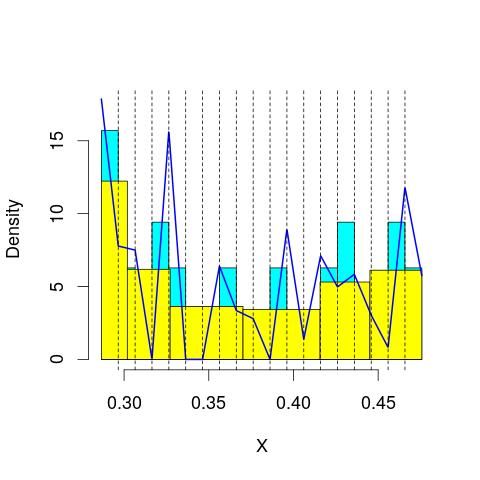

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.94478
mop.approx: Iteration 11. LL = 59.1616
mop.approx: Iteration 21. LL = 59.18564
mop.approx: Iteration 31. LL = 59.18858
mop.approx: Iteration 41. LL = 59.19022
mop.approx: Iteration 51. LL = 59.19134
mop.approx: Iteration 61. LL = 59.19213
mop.approx: Converged. Iteration 64. LL = 59.19238
[1] "Computing the linear combination of B-splines"


22.8021512438
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.77783
mop.approx: Iteration 11. LL = 59.41762
mop.approx: Iteration 21. LL = 59.52447
mop.approx: Iteration 31. LL = 59.54536
mop.approx: Iteration 41. LL = 59.55378
mop.approx: Iteration 51. LL = 59.55826
mop.approx: Iteration 61. LL = 59.56094
mop.approx: Iteration 71. LL = 59.56266
mop.approx: Iteration 81. LL = 59.56381
mop.approx: Iteration 91. LL = 59.5646
mop.approx: Converged. Iteration 94. LL = 59.56484
[1] "Computing the linear combination of B-splines"


21.4417489421
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.92859
mop.approx: Iteration 11. LL = 51.13128
mop.approx: Iteration 21. LL = 51.20045
mop.approx: Iteration 31. LL = 51.21965
mop.approx: Iteration 41. LL = 51.22689
mop.approx: Iteration 51. LL = 51.23008
mop.approx: Iteration 61. LL = 51.23163
mop.approx: Iteration 71. LL = 51.23242
mop.approx: Converged. Iteration 72. LL = 51.23253
[1] "Computing the linear combination of B-splines"


11.3765638336
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.91195
mop.approx: Iteration 11. LL = 52.42048
mop.approx: Iteration 21. LL = 52.54533
mop.approx: Iteration 31. LL = 52.56714
mop.approx: Iteration 41. LL = 52.57591
mop.approx: Iteration 51. LL = 52.58066
mop.approx: Iteration 61. LL = 52.58352
mop.approx: Iteration 71. LL = 52.58532
mop.approx: Iteration 81. LL = 52.58649
mop.approx: Iteration 91. LL = 52.58726
mop.approx: Converged. Iteration 96. LL = 52.5876
[1] "Computing the linear combination of B-splines"


10.9987713948
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.576226
mop.approx: Iteration 11. LL = 51.05678
mop.approx: Iteration 21. LL = 51.23923
mop.approx: Iteration 31. LL = 51.2701
mop.approx: Iteration 41. LL = 51.28232
mop.approx: Iteration 51. LL = 51.28887
mop.approx: Iteration 61. LL = 51.29281
mop.approx: Iteration 71. LL = 51.29531
mop.approx: Iteration 81. LL = 51.29696
mop.approx: Iteration 91. LL = 51.29808
mop.approx: Iteration 101. LL = 51.29886
mop.approx: Converged. Iteration 108. LL = 51.29931
[1] "Computing the linear combination of B-splines"


7.97761382627
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.758471
mop.approx: Iteration 11. LL = 49.78623
mop.approx: Iteration 21. LL = 50.13736
mop.approx: Iteration 31. LL = 50.21743
mop.approx: Iteration 41. LL = 50.2415
mop.approx: Iteration 51. LL = 50.25064
mop.approx: Iteration 61. LL = 50.25495
mop.approx: Iteration 71. LL = 50.25731
mop.approx: Iteration 81. LL = 50.25873
mop.approx: Iteration 91. LL = 50.25964
mop.approx: Iteration 101. LL = 50.26025
mop.approx: Converged. Iteration 101. LL = 50.26029
[1] "Computing the linear combination of B-splines"


5.20572115228
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.3480302
mop.approx: Iteration 11. LL = 48.99002
mop.approx: Iteration 21. LL = 49.18608
mop.approx: Iteration 31. LL = 49.24737
mop.approx: Iteration 41. LL = 49.27488
mop.approx: Iteration 51. LL = 49.28903
mop.approx: Iteration 61. LL = 49.29672
mop.approx: Iteration 71. LL = 49.30098
mop.approx: Iteration 81. LL = 49.30337
mop.approx: Iteration 91. LL = 49.30472
mop.approx: Iteration 101. LL = 49.30548
mop.approx: Converged. Iteration 103. LL = 49.30564
[1] "Computing the linear combination of B-splines"


2.5135481222
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 53.11259
mop.approx: Iteration 11. LL = 59.45215
mop.approx: Iteration 21. LL = 59.46372
mop.approx: Iteration 31. LL = 59.46534
mop.approx: Converged. Iteration 31. LL = 59.4654
[1] "Computing the linear combination of B-splines"


23.0751744905
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 23.075174490473465)
m reached
('Sum of Probabilities:', 0.9879255598739793)
chosen


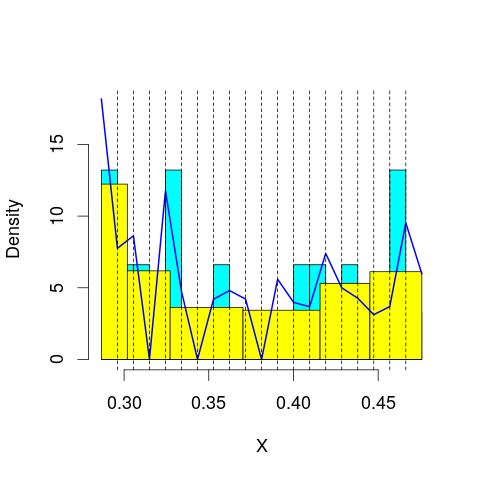

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.94478
mop.approx: Iteration 11. LL = 60.91564
mop.approx: Iteration 21. LL = 60.9928
mop.approx: Iteration 31. LL = 61.00112
mop.approx: Converged. Iteration 40. LL = 61.00242
[1] "Computing the linear combination of B-splines"


22.8793257962
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 52.77783
mop.approx: Iteration 11. LL = 58.74759
mop.approx: Iteration 21. LL = 58.80657
mop.approx: Iteration 31. LL = 58.81368
mop.approx: Iteration 41. LL = 58.8153
mop.approx: Converged. Iteration 45. LL = 58.81564
[1] "Computing the linear combination of B-splines"


18.9596774426
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 16.92859
mop.approx: Iteration 11. LL = 51.95727
mop.approx: Iteration 21. LL = 52.08025
mop.approx: Iteration 31. LL = 52.11283
mop.approx: Iteration 41. LL = 52.12373
mop.approx: Iteration 51. LL = 52.12807
mop.approx: Iteration 61. LL = 52.13009
mop.approx: Iteration 71. LL = 52.13118
mop.approx: Converged. Iteration 80. LL = 52.13183
[1] "Computing the linear combination of B-splines"


10.5430018549
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 11.91195
mop.approx: Iteration 11. LL = 52.30507
mop.approx: Iteration 21. LL = 52.4256
mop.approx: Iteration 31. LL = 52.4534
mop.approx: Iteration 41. LL = 52.46571
mop.approx: Iteration 51. LL = 52.47253
mop.approx: Iteration 61. LL = 52.47667
mop.approx: Iteration 71. LL = 52.47931
mop.approx: Iteration 81. LL = 52.48101
mop.approx: Iteration 91. LL = 52.48213
mop.approx: Iteration 101. LL = 52.48287
mop.approx: Converged. Iteration 104. LL = 52.48309
[1] "Computing the linear combination of B-splines"


9.16139341301
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 7.576226
mop.approx: Iteration 11. LL = 51.98697
mop.approx: Iteration 21. LL = 52.16988
mop.approx: Iteration 31. LL = 52.19464
mop.approx: Iteration 41. LL = 52.20077
mop.approx: Iteration 51. LL = 52.20341
mop.approx: Iteration 61. LL = 52.20503
mop.approx: Iteration 71. LL = 52.20617
mop.approx: Iteration 81. LL = 52.20701
mop.approx: Iteration 91. LL = 52.20765
mop.approx: Converged. Iteration 94. LL = 52.20786
[1] "Computing the linear combination of B-splines"


7.15329493464
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 3.758471
mop.approx: Iteration 11. LL = 50.02896
mop.approx: Iteration 21. LL = 50.34776
mop.approx: Iteration 31. LL = 50.41635
mop.approx: Iteration 41. LL = 50.43883
mop.approx: Iteration 51. LL = 50.44824
mop.approx: Iteration 61. LL = 50.45278
mop.approx: Iteration 71. LL = 50.45514
mop.approx: Iteration 81. LL = 50.45643
mop.approx: Iteration 91. LL = 50.45717
mop.approx: Converged. Iteration 93. LL = 50.45732
[1] "Computing the linear combination of B-splines"


3.66971663022
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 0.3480302
mop.approx: Iteration 11. LL = 49.26833
mop.approx: Iteration 21. LL = 49.46596
mop.approx: Iteration 31. LL = 49.52965
mop.approx: Iteration 41. LL = 49.55044
mop.approx: Iteration 51. LL = 49.55688
mop.approx: Iteration 61. LL = 49.55888
mop.approx: Converged. Iteration 69. LL = 49.55952
[1] "Computing the linear combination of B-splines"


1.03291905918
lfps_21
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.40985
mop.approx: Iteration 11. LL = 67.52455
mop.approx: Converged. Iteration 14. LL = 67.52526
[1] "Computing the linear combination of B-splines"


62.3266600641
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 62.326660064130934)
m reached
('Sum of Probabilities:', 0.9895717703754414)
chosen


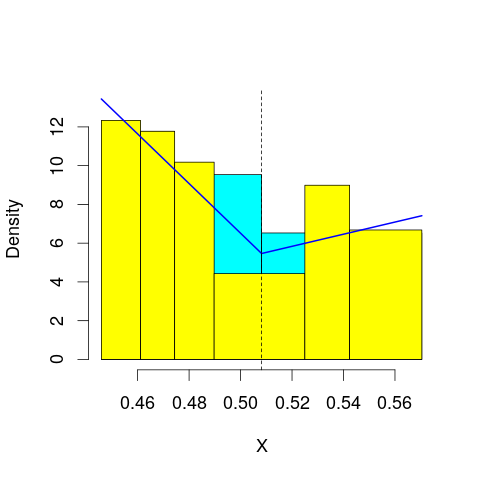

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.15591
mop.approx: Iteration 11. LL = 66.94383
mop.approx: Converged. Iteration 13. LL = 66.94405
[1] "Computing the linear combination of B-splines"


60.0125803972
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.90398
mop.approx: Iteration 11. LL = 67.02576
mop.approx: Iteration 21. LL = 67.18185
mop.approx: Iteration 31. LL = 67.2494
mop.approx: Iteration 41. LL = 67.28131
mop.approx: Iteration 51. LL = 67.29734
mop.approx: Iteration 61. LL = 67.30569
mop.approx: Iteration 71. LL = 67.31014
mop.approx: Iteration 81. LL = 67.31253
mop.approx: Iteration 91. LL = 67.31383
mop.approx: Converged. Iteration 97. LL = 67.31437
[1] "Computing the linear combination of B-splines"


58.6500323984
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.64883
mop.approx: Iteration 11. LL = 51.58562
mop.approx: Converged. Iteration 18. LL = 51.58924
[1] "Computing the linear combination of B-splines"


41.1920276683
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06481
mop.approx: Iteration 11. LL = 54.2746
mop.approx: Iteration 21. LL = 54.33274
mop.approx: Converged. Iteration 23. LL = 54.33296
[1] "Computing the linear combination of B-splines"


42.2028863513
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31197
mop.approx: Iteration 11. LL = 47.97335
mop.approx: Iteration 21. LL = 48.0231
mop.approx: Iteration 31. LL = 48.02862
mop.approx: Converged. Iteration 37. LL = 48.02925
[1] "Computing the linear combination of B-splines"


34.1663033172
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.17461
mop.approx: Iteration 11. LL = 50.30101
mop.approx: Iteration 21. LL = 50.41512
mop.approx: Converged. Iteration 26. LL = 50.41605
[1] "Computing the linear combination of B-splines"


34.8202343738
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.511455
mop.approx: Iteration 11. LL = 44.95634
mop.approx: Iteration 21. LL = 45.06804
mop.approx: Iteration 31. LL = 45.09794
mop.approx: Iteration 41. LL = 45.10775
mop.approx: Iteration 51. LL = 45.11141
mop.approx: Iteration 61. LL = 45.11288
mop.approx: Converged. Iteration 70. LL = 45.11351
[1] "Computing the linear combination of B-splines"


27.7848279164
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.40985
mop.approx: Converged. Iteration 9. LL = 67.22014
[1] "Computing the linear combination of B-splines"


60.2886673099
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 60.288667309851895)
m reached
('Sum of Probabilities:', 0.9904309870454451)
chosen


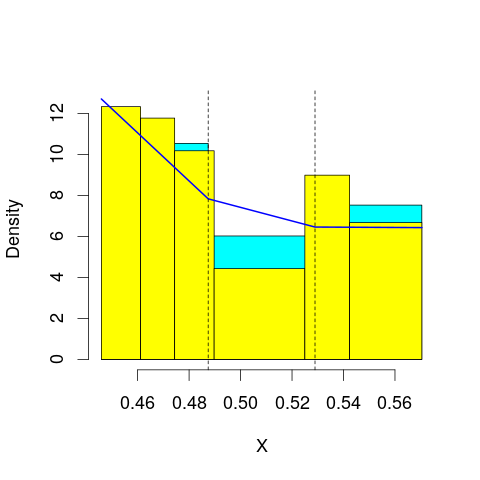

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.15591
mop.approx: Iteration 11. LL = 67.79192
mop.approx: Iteration 21. LL = 67.87521
mop.approx: Iteration 31. LL = 67.88841
mop.approx: Iteration 41. LL = 67.89138
mop.approx: Converged. Iteration 47. LL = 67.89203
[1] "Computing the linear combination of B-splines"


59.2276874251
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.90398
mop.approx: Iteration 11. LL = 67.66295
mop.approx: Iteration 21. LL = 67.74805
mop.approx: Iteration 31. LL = 67.78549
mop.approx: Iteration 41. LL = 67.80556
mop.approx: Iteration 51. LL = 67.81716
mop.approx: Iteration 61. LL = 67.82432
mop.approx: Iteration 71. LL = 67.829
mop.approx: Iteration 81. LL = 67.83221
mop.approx: Iteration 91. LL = 67.83449
mop.approx: Iteration 101. LL = 67.83617
mop.approx: Iteration 111. LL = 67.83744
mop.approx: Iteration 121. LL = 67.83842
mop.approx: Iteration 131. LL = 67.83919
mop.approx: Converged. Iteration 132. LL = 67.83933
[1] "Computing the linear combination of B-splines"


57.4421201119
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.64883
mop.approx: Iteration 11. LL = 58.49708
mop.approx: Iteration 21. LL = 58.74949
mop.approx: Iteration 31. LL = 58.78151
mop.approx: Iteration 41. LL = 58.78796
mop.approx: Iteration 51. LL = 58.78935
mop.approx: Converged. Iteration 51. LL = 58.78941
[1] "Computing the linear combination of B-splines"


46.6593296298
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06481
mop.approx: Iteration 11. LL = 54.96882
mop.approx: Converged. Iteration 14. LL = 54.96966
[1] "Computing the linear combination of B-splines"


41.1067159369
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31197
mop.approx: Iteration 11. LL = 56.34802
mop.approx: Iteration 21. LL = 56.50162
mop.approx: Converged. Iteration 29. LL = 56.50466
[1] "Computing the linear combination of B-splines"


40.9088485574
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.17461
mop.approx: Iteration 11. LL = 51.02705
mop.approx: Iteration 21. LL = 51.0551
mop.approx: Converged. Iteration 29. LL = 51.05667
[1] "Computing the linear combination of B-splines"


33.7279897421
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.511455
mop.approx: Iteration 11. LL = 52.60599
mop.approx: Iteration 21. LL = 52.78456
mop.approx: Converged. Iteration 29. LL = 52.78754
[1] "Computing the linear combination of B-splines"


33.7259902997
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.40985
mop.approx: Iteration 11. LL = 68.23844
mop.approx: Converged. Iteration 14. LL = 68.23911
[1] "Computing the linear combination of B-splines"


59.5747655324
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 59.574765532354242)
m reached
('Sum of Probabilities:', 0.9924200729105371)
chosen


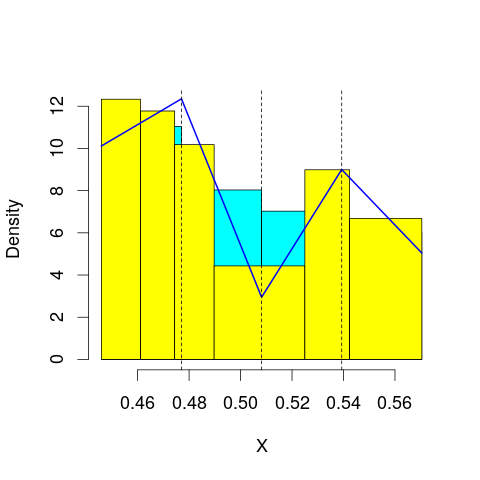

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.15591
mop.approx: Iteration 11. LL = 67.8421
mop.approx: Iteration 21. LL = 67.85549
mop.approx: Converged. Iteration 28. LL = 67.85674
[1] "Computing the linear combination of B-splines"


57.4595299668
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.90398
mop.approx: Iteration 11. LL = 68.40423
mop.approx: Iteration 21. LL = 68.59521
mop.approx: Iteration 31. LL = 68.65712
mop.approx: Iteration 41. LL = 68.68065
mop.approx: Iteration 51. LL = 68.69102
mop.approx: Iteration 61. LL = 68.69627
mop.approx: Iteration 71. LL = 68.69922
mop.approx: Iteration 81. LL = 68.70099
mop.approx: Iteration 91. LL = 68.7021
mop.approx: Converged. Iteration 97. LL = 68.70263
[1] "Computing the linear combination of B-splines"


56.5725553516
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.64883
mop.approx: Iteration 11. LL = 59.59755
mop.approx: Iteration 21. LL = 59.65848
mop.approx: Converged. Iteration 24. LL = 59.6589
[1] "Computing the linear combination of B-splines"


45.7959571025
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06481
mop.approx: Iteration 11. LL = 57.67403
mop.approx: Iteration 21. LL = 57.93462
mop.approx: Iteration 31. LL = 57.96947
mop.approx: Iteration 41. LL = 57.97443
mop.approx: Converged. Iteration 46. LL = 57.97499
[1] "Computing the linear combination of B-splines"


42.3791768515
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31197
mop.approx: Iteration 11. LL = 57.15593
mop.approx: Converged. Iteration 15. LL = 57.15765
[1] "Computing the linear combination of B-splines"


39.8289748578
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.17461
mop.approx: Iteration 11. LL = 57.47182
mop.approx: Iteration 21. LL = 57.77258
mop.approx: Iteration 31. LL = 57.79341
mop.approx: Converged. Iteration 40. LL = 57.79522
[1] "Computing the linear combination of B-splines"


38.7336709482
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.511455
mop.approx: Iteration 11. LL = 53.4137
mop.approx: Iteration 21. LL = 53.42996
mop.approx: Converged. Iteration 24. LL = 53.4303
[1] "Computing the linear combination of B-splines"


32.6358860891
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.40985
mop.approx: Iteration 11. LL = 68.07263
mop.approx: Converged. Iteration 13. LL = 68.07291
[1] "Computing the linear combination of B-splines"


57.6756982497
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 57.675698249673474)
m reached
('Sum of Probabilities:', 0.9932740900213841)
chosen


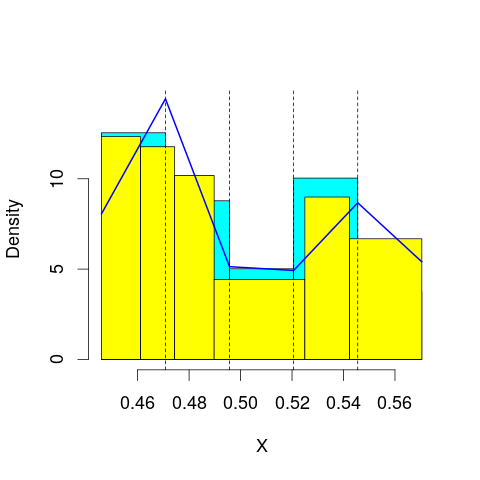

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.15591
mop.approx: Iteration 11. LL = 69.13789
mop.approx: Iteration 21. LL = 69.2403
mop.approx: Iteration 31. LL = 69.25672
mop.approx: Iteration 41. LL = 69.2596
mop.approx: Converged. Iteration 44. LL = 69.25991
[1] "Computing the linear combination of B-splines"


57.1298371481
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.90398
mop.approx: Iteration 11. LL = 68.63864
mop.approx: Iteration 21. LL = 68.69499
mop.approx: Iteration 31. LL = 68.70019
mop.approx: Converged. Iteration 35. LL = 68.70068
[1] "Computing the linear combination of B-splines"


54.8377352276
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.64883
mop.approx: Iteration 11. LL = 62.15436
mop.approx: Iteration 21. LL = 62.25044
mop.approx: Iteration 31. LL = 62.2702
mop.approx: Iteration 41. LL = 62.2767
mop.approx: Iteration 51. LL = 62.27918
mop.approx: Iteration 61. LL = 62.28018
mop.approx: Converged. Iteration 61. LL = 62.28024
[1] "Computing the linear combination of B-splines"


46.6844278912
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06481
mop.approx: Iteration 11. LL = 58.35929
mop.approx: Iteration 21. LL = 58.60459
mop.approx: Iteration 31. LL = 58.65947
mop.approx: Iteration 41. LL = 58.67683
mop.approx: Iteration 51. LL = 58.68301
mop.approx: Iteration 61. LL = 58.6853
mop.approx: Converged. Iteration 70. LL = 58.68617
[1] "Computing the linear combination of B-splines"


41.3574887351
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31197
mop.approx: Iteration 11. LL = 57.57386
mop.approx: Iteration 21. LL = 57.61086
mop.approx: Iteration 31. LL = 57.61401
mop.approx: Converged. Iteration 32. LL = 57.61414
[1] "Computing the linear combination of B-splines"


38.5525877601
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.17461
mop.approx: Iteration 11. LL = 58.45577
mop.approx: Converged. Iteration 18. LL = 58.46937
[1] "Computing the linear combination of B-splines"


37.6749495848
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.511455
mop.approx: Iteration 11. LL = 57.92732
mop.approx: Iteration 21. LL = 58.33326
mop.approx: Iteration 31. LL = 58.39041
mop.approx: Iteration 41. LL = 58.40589
mop.approx: Iteration 51. LL = 58.41069
mop.approx: Iteration 61. LL = 58.41224
mop.approx: Converged. Iteration 64. LL = 58.41251
[1] "Computing the linear combination of B-splines"


35.8852221975
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.40985
mop.approx: Iteration 11. LL = 68.91531
mop.approx: Iteration 21. LL = 68.92189
mop.approx: Converged. Iteration 21. LL = 68.92195
[1] "Computing the linear combination of B-splines"


56.791869907
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 56.791869907015183)
m reached
('Sum of Probabilities:', 0.9929202460650906)
chosen


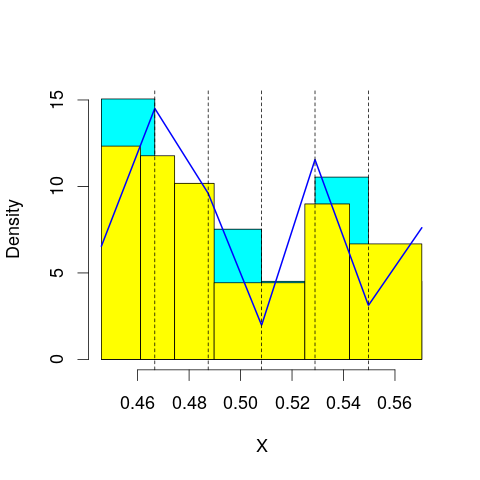

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.15591
mop.approx: Iteration 11. LL = 69.70474
mop.approx: Iteration 21. LL = 69.7448
mop.approx: Iteration 31. LL = 69.74726
mop.approx: Converged. Iteration 31. LL = 69.74732
[1] "Computing the linear combination of B-splines"


55.8843785392
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.90398
mop.approx: Iteration 11. LL = 68.64178
mop.approx: Iteration 21. LL = 68.70285
mop.approx: Iteration 31. LL = 68.7196
mop.approx: Iteration 41. LL = 68.72686
mop.approx: Iteration 51. LL = 68.73066
mop.approx: Iteration 61. LL = 68.73287
mop.approx: Iteration 71. LL = 68.73425
mop.approx: Iteration 81. LL = 68.73516
mop.approx: Converged. Iteration 83. LL = 68.73537
[1] "Computing the linear combination of B-splines"


53.1395627952
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.64883
mop.approx: Iteration 11. LL = 62.2442
mop.approx: Iteration 21. LL = 62.24775
mop.approx: Converged. Iteration 25. LL = 62.24817
[1] "Computing the linear combination of B-splines"


44.9194877613
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06481
mop.approx: Iteration 11. LL = 62.64053
mop.approx: Iteration 21. LL = 62.81023
mop.approx: Converged. Iteration 30. LL = 62.81437
[1] "Computing the linear combination of B-splines"


43.7528240879
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31197
mop.approx: Iteration 11. LL = 57.70931
mop.approx: Iteration 21. LL = 57.72912
mop.approx: Converged. Iteration 28. LL = 57.73017
[1] "Computing the linear combination of B-splines"


36.9357560505
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.17461
mop.approx: Iteration 11. LL = 58.50346
mop.approx: Iteration 21. LL = 58.50789
mop.approx: Converged. Iteration 21. LL = 58.50794
[1] "Computing the linear combination of B-splines"


35.9806576092
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.511455
mop.approx: Iteration 11. LL = 59.03192
mop.approx: Iteration 21. LL = 59.10574
mop.approx: Converged. Iteration 25. LL = 59.10643
[1] "Computing the linear combination of B-splines"


34.8463016628
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.40985
mop.approx: Iteration 11. LL = 70.93151
mop.approx: Iteration 21. LL = 70.95572
mop.approx: Converged. Iteration 23. LL = 70.956
[1] "Computing the linear combination of B-splines"


57.0930515715
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 57.093051571454033)
m reached
('Sum of Probabilities:', 0.9921968945976716)
chosen


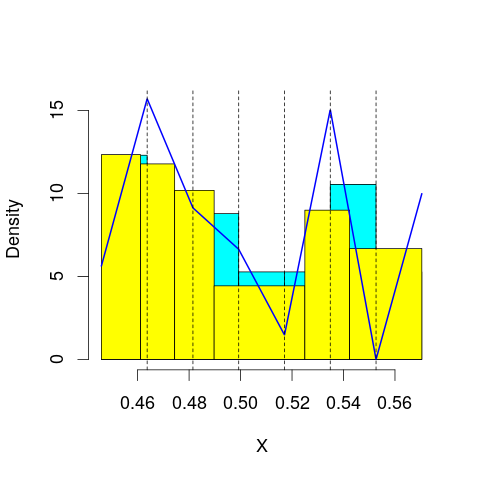

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.15591
mop.approx: Iteration 11. LL = 69.44126
mop.approx: Iteration 21. LL = 69.4683
mop.approx: Converged. Iteration 28. LL = 69.46982
[1] "Computing the linear combination of B-splines"


53.87400372
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.90398
mop.approx: Iteration 11. LL = 69.49788
mop.approx: Iteration 21. LL = 69.72392
mop.approx: Iteration 31. LL = 69.78607
mop.approx: Iteration 41. LL = 69.806
mop.approx: Iteration 51. LL = 69.8139
mop.approx: Iteration 61. LL = 69.81774
mop.approx: Iteration 71. LL = 69.81991
mop.approx: Iteration 81. LL = 69.82126
mop.approx: Iteration 91. LL = 69.82216
mop.approx: Converged. Iteration 92. LL = 69.8223
[1] "Computing the linear combination of B-splines"


52.4936177302
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.64883
mop.approx: Iteration 11. LL = 62.45465
mop.approx: Iteration 21. LL = 62.50776
mop.approx: Iteration 31. LL = 62.52271
mop.approx: Iteration 41. LL = 62.52797
mop.approx: Iteration 51. LL = 62.52999
mop.approx: Converged. Iteration 58. LL = 62.53068
[1] "Computing the linear combination of B-splines"


43.4691354111
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06481
mop.approx: Iteration 11. LL = 63.66903
mop.approx: Iteration 21. LL = 63.68973
mop.approx: Iteration 31. LL = 63.69073
mop.approx: Converged. Iteration 32. LL = 63.69086
[1] "Computing the linear combination of B-splines"


42.8964411735
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31197
mop.approx: Iteration 11. LL = 61.50533
mop.approx: Iteration 21. LL = 61.83303
mop.approx: Iteration 31. LL = 61.88605
mop.approx: Iteration 41. LL = 61.90122
mop.approx: Iteration 51. LL = 61.90632
mop.approx: Iteration 61. LL = 61.90816
mop.approx: Converged. Iteration 67. LL = 61.90871
[1] "Computing the linear combination of B-splines"


39.3814239805
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.17461
mop.approx: Iteration 11. LL = 58.51359
mop.approx: Iteration 21. LL = 58.52293
mop.approx: Converged. Iteration 30. LL = 58.52427
[1] "Computing the linear combination of B-splines"


34.2641177093
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.511455
mop.approx: Iteration 11. LL = 59.79494
mop.approx: Iteration 21. LL = 59.87176
mop.approx: Iteration 31. LL = 59.88057
mop.approx: Iteration 41. LL = 59.88216
mop.approx: Converged. Iteration 42. LL = 59.88227
[1] "Computing the linear combination of B-splines"


33.8892945642
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.40985
mop.approx: Iteration 11. LL = 71.79303
mop.approx: Converged. Iteration 15. LL = 71.79476
[1] "Computing the linear combination of B-splines"


56.1989466764
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 56.198946676411367)
m reached
('Sum of Probabilities:', 0.9918615277953495)
chosen


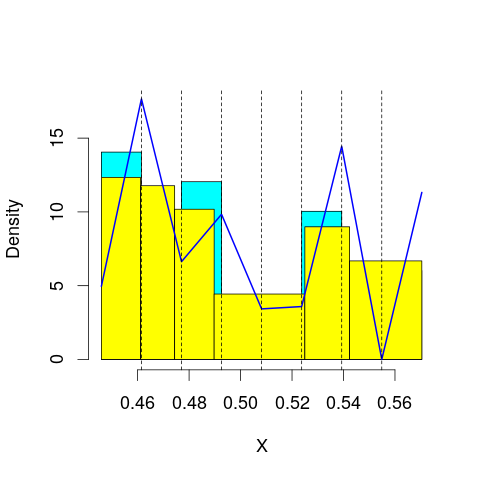

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.15591
mop.approx: Iteration 11. LL = 69.52103
mop.approx: Iteration 21. LL = 69.55583
mop.approx: Iteration 31. LL = 69.5614
mop.approx: Converged. Iteration 40. LL = 69.56274
[1] "Computing the linear combination of B-splines"


52.2340645688
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.90398
mop.approx: Iteration 11. LL = 70.36425
mop.approx: Iteration 21. LL = 70.53501
mop.approx: Iteration 31. LL = 70.56201
mop.approx: Iteration 41. LL = 70.56968
mop.approx: Iteration 51. LL = 70.57285
mop.approx: Iteration 61. LL = 70.5744
mop.approx: Converged. Iteration 68. LL = 70.57508
[1] "Computing the linear combination of B-splines"


51.5135335433
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.64883
mop.approx: Iteration 11. LL = 62.97304
mop.approx: Iteration 21. LL = 63.01491
mop.approx: Iteration 31. LL = 63.02756
mop.approx: Iteration 41. LL = 63.03175
mop.approx: Iteration 51. LL = 63.03319
mop.approx: Converged. Iteration 53. LL = 63.0334
[1] "Computing the linear combination of B-splines"


42.2389801527
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06481
mop.approx: Iteration 11. LL = 63.70053
mop.approx: Iteration 21. LL = 63.7067
mop.approx: Iteration 31. LL = 63.70872
mop.approx: Iteration 41. LL = 63.70988
mop.approx: Converged. Iteration 48. LL = 63.71048
[1] "Computing the linear combination of B-splines"


41.1831971993
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31197
mop.approx: Iteration 11. LL = 63.82091
mop.approx: Iteration 21. LL = 64.04052
mop.approx: Iteration 31. LL = 64.0529
mop.approx: Iteration 41. LL = 64.05552
mop.approx: Iteration 51. LL = 64.05656
mop.approx: Converged. Iteration 53. LL = 64.05675
[1] "Computing the linear combination of B-splines"


39.7966018938
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.17461
mop.approx: Iteration 11. LL = 60.61655
mop.approx: Iteration 21. LL = 60.71208
mop.approx: Converged. Iteration 29. LL = 60.71481
[1] "Computing the linear combination of B-splines"


34.7217906962
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.511455
mop.approx: Iteration 11. LL = 59.84674
mop.approx: Iteration 21. LL = 59.86651
mop.approx: Iteration 31. LL = 59.86954
mop.approx: Converged. Iteration 37. LL = 59.87018
[1] "Computing the linear combination of B-splines"


32.144029823
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.40985
mop.approx: Iteration 11. LL = 71.99326
mop.approx: Converged. Iteration 14. LL = 71.9942
[1] "Computing the linear combination of B-splines"


54.6655187395
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 54.665518739492427)
m reached
('Sum of Probabilities:', 0.9912684703155217)
chosen


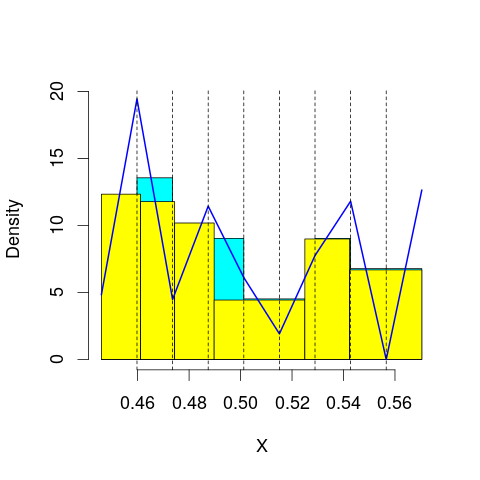

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.15591
mop.approx: Iteration 11. LL = 70.51291
mop.approx: Iteration 21. LL = 70.57106
mop.approx: Iteration 31. LL = 70.57476
mop.approx: Converged. Iteration 31. LL = 70.57482
[1] "Computing the linear combination of B-splines"


51.5132725211
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.90398
mop.approx: Iteration 11. LL = 70.89636
mop.approx: Iteration 21. LL = 71.01469
mop.approx: Iteration 31. LL = 71.03802
mop.approx: Iteration 41. LL = 71.0473
mop.approx: Iteration 51. LL = 71.05197
mop.approx: Iteration 61. LL = 71.05462
mop.approx: Iteration 71. LL = 71.05622
mop.approx: Iteration 81. LL = 71.05725
mop.approx: Converged. Iteration 84. LL = 71.05755
[1] "Computing the linear combination of B-splines"


50.2631313915
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.64883
mop.approx: Iteration 11. LL = 63.31144
mop.approx: Iteration 21. LL = 63.33791
mop.approx: Iteration 31. LL = 63.34914
mop.approx: Iteration 41. LL = 63.35519
mop.approx: Iteration 51. LL = 63.35864
mop.approx: Iteration 61. LL = 63.3607
mop.approx: Iteration 71. LL = 63.36198
mop.approx: Iteration 81. LL = 63.36278
mop.approx: Converged. Iteration 81. LL = 63.36285
[1] "Computing the linear combination of B-splines"


40.8355622674
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06481
mop.approx: Iteration 11. LL = 63.89921
mop.approx: Iteration 21. LL = 63.94352
mop.approx: Iteration 31. LL = 63.95828
mop.approx: Iteration 41. LL = 63.96317
mop.approx: Iteration 51. LL = 63.96479
mop.approx: Converged. Iteration 54. LL = 63.96508
[1] "Computing the linear combination of B-splines"


39.7049278349
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31197
mop.approx: Iteration 11. LL = 64.32072
mop.approx: Iteration 21. LL = 64.39559
mop.approx: Iteration 31. LL = 64.41623
mop.approx: Iteration 41. LL = 64.42975
mop.approx: Iteration 51. LL = 64.43859
mop.approx: Iteration 61. LL = 64.44451
mop.approx: Iteration 71. LL = 64.44859
mop.approx: Iteration 81. LL = 64.4515
mop.approx: Iteration 91. LL = 64.45364
mop.approx: Iteration 101. LL = 64.45524
mop.approx: Iteration 111. LL = 64.45648
mop.approx: Iteration 121. LL = 64.45746
mop.approx: Iteration 131. LL = 64.45824
mop.approx: Converged. Iteration 135. LL = 64.45857
[1] "Computing the linear combination of B-splines"


38.4655564692
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.17461
mop.approx: Iteration 11. LL = 62.8476
mop.approx: Iteration 21. LL = 63.23631
mop.approx: Iteration 31. LL = 63.31081
mop.approx: Iteration 41. LL = 63.33189
mop.approx: Iteration 51. LL = 63.33978
mop.approx: Iteration 61. LL = 63.3433
mop.approx: Iteration 71. LL = 63.34503
mop.approx: Iteration 81. LL = 63.34594
mop.approx: Converged. Iteration 81. LL = 63.346
[1] "Computing the linear combination of B-splines"


35.6202128965
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.511455
mop.approx: Iteration 11. LL = 60.8178
mop.approx: Iteration 21. LL = 60.8685
mop.approx: Converged. Iteration 28. LL = 60.87014
[1] "Computing the linear combination of B-splines"


31.4106596769
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.40985
mop.approx: Iteration 11. LL = 71.22443
mop.approx: Converged. Iteration 20. LL = 71.23015
[1] "Computing the linear combination of B-splines"


52.1686058698
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 52.168605869838551)
m reached
('Sum of Probabilities:', 0.990497390368571)
chosen


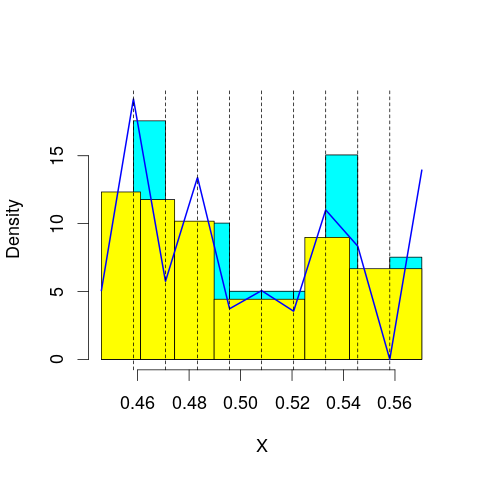

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.15591
mop.approx: Iteration 11. LL = 71.88265
mop.approx: Iteration 21. LL = 71.98429
mop.approx: Iteration 31. LL = 72.00313
mop.approx: Iteration 41. LL = 72.00778
mop.approx: Converged. Iteration 50. LL = 72.00902
[1] "Computing the linear combination of B-splines"


51.2146018272
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.90398
mop.approx: Iteration 11. LL = 71.30913
mop.approx: Iteration 21. LL = 71.46892
mop.approx: Iteration 31. LL = 71.51694
mop.approx: Iteration 41. LL = 71.53505
mop.approx: Iteration 51. LL = 71.54268
mop.approx: Iteration 61. LL = 71.54629
mop.approx: Iteration 71. LL = 71.54822
mop.approx: Iteration 81. LL = 71.54935
mop.approx: Converged. Iteration 85. LL = 71.54974
[1] "Computing the linear combination of B-splines"


49.0224598115
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.64883
mop.approx: Iteration 11. LL = 63.29649
mop.approx: Iteration 21. LL = 63.29832
mop.approx: Converged. Iteration 21. LL = 63.29837
[1] "Computing the linear combination of B-splines"


39.038222293
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06481
mop.approx: Iteration 11. LL = 64.28393
mop.approx: Iteration 21. LL = 64.32187
mop.approx: Iteration 31. LL = 64.33203
mop.approx: Iteration 41. LL = 64.33611
mop.approx: Iteration 51. LL = 64.33792
mop.approx: Converged. Iteration 59. LL = 64.33867
[1] "Computing the linear combination of B-splines"


38.3456551022
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31197
mop.approx: Iteration 11. LL = 64.51784
mop.approx: Iteration 21. LL = 64.58036
mop.approx: Iteration 31. LL = 64.60049
mop.approx: Iteration 41. LL = 64.61001
mop.approx: Iteration 51. LL = 64.61461
mop.approx: Iteration 61. LL = 64.61683
mop.approx: Iteration 71. LL = 64.61789
mop.approx: Converged. Iteration 73. LL = 64.61809
[1] "Computing the linear combination of B-splines"


36.892201299
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.17461
mop.approx: Iteration 11. LL = 63.93989
mop.approx: Iteration 21. LL = 64.26271
mop.approx: Iteration 31. LL = 64.33651
mop.approx: Iteration 41. LL = 64.36491
mop.approx: Iteration 51. LL = 64.37735
mop.approx: Iteration 61. LL = 64.38295
mop.approx: Iteration 71. LL = 64.3855
mop.approx: Iteration 81. LL = 64.38666
mop.approx: Converged. Iteration 83. LL = 64.38687
[1] "Computing the linear combination of B-splines"


34.9283237906
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.511455
mop.approx: Iteration 11. LL = 62.18248
mop.approx: Iteration 21. LL = 62.34952
mop.approx: Iteration 31. LL = 62.36969
mop.approx: Iteration 41. LL = 62.37245
mop.approx: Converged. Iteration 43. LL = 62.37266
[1] "Computing the linear combination of B-splines"


31.1805053602
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.40985
mop.approx: Iteration 11. LL = 71.67992
mop.approx: Iteration 21. LL = 71.72874
mop.approx: Iteration 31. LL = 71.73375
mop.approx: Converged. Iteration 35. LL = 71.73424
[1] "Computing the linear combination of B-splines"


50.9398200057
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 50.939820005711695)
m reached
('Sum of Probabilities:', 0.9897229791942124)
chosen


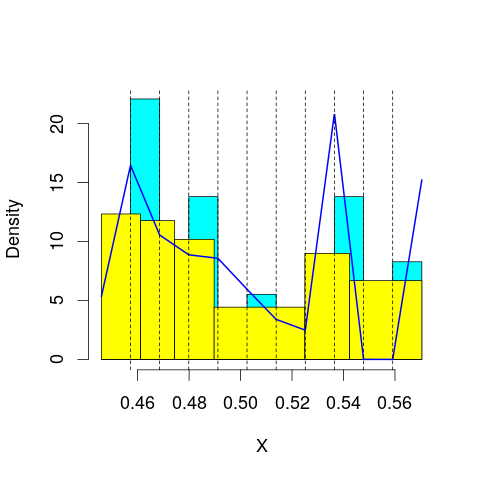

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.15591
mop.approx: Iteration 11. LL = 73.0869
mop.approx: Iteration 21. LL = 73.18963
mop.approx: Iteration 31. LL = 73.20406
mop.approx: Iteration 41. LL = 73.20729
mop.approx: Converged. Iteration 47. LL = 73.20798
[1] "Computing the linear combination of B-splines"


50.6806987363
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.90398
mop.approx: Iteration 11. LL = 71.87188
mop.approx: Iteration 21. LL = 71.97999
mop.approx: Iteration 31. LL = 71.99555
mop.approx: Iteration 41. LL = 72.0002
mop.approx: Iteration 51. LL = 72.00233
mop.approx: Iteration 61. LL = 72.00351
mop.approx: Converged. Iteration 66. LL = 72.00398
[1] "Computing the linear combination of B-splines"


47.743827465
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.64883
mop.approx: Iteration 11. LL = 63.24926
mop.approx: Iteration 21. LL = 63.27933
mop.approx: Iteration 31. LL = 63.29431
mop.approx: Iteration 41. LL = 63.30203
mop.approx: Iteration 51. LL = 63.30601
mop.approx: Iteration 61. LL = 63.30804
mop.approx: Iteration 71. LL = 63.30906
mop.approx: Converged. Iteration 73. LL = 63.30925
[1] "Computing the linear combination of B-splines"


37.316234574
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06481
mop.approx: Iteration 11. LL = 64.5248
mop.approx: Iteration 21. LL = 64.5519
mop.approx: Iteration 31. LL = 64.56714
mop.approx: Iteration 41. LL = 64.57738
mop.approx: Iteration 51. LL = 64.58423
mop.approx: Iteration 61. LL = 64.58885
mop.approx: Iteration 71. LL = 64.592
mop.approx: Iteration 81. LL = 64.59418
mop.approx: Iteration 91. LL = 64.59568
mop.approx: Iteration 101. LL = 64.59674
mop.approx: Converged. Iteration 110. LL = 64.59747
[1] "Computing the linear combination of B-splines"


36.8715858701
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31197
mop.approx: Iteration 11. LL = 64.7632
mop.approx: Iteration 21. LL = 64.81312
mop.approx: Iteration 31. LL = 64.82439
mop.approx: Iteration 41. LL = 64.82832
mop.approx: Iteration 51. LL = 64.82989
mop.approx: Converged. Iteration 56. LL = 64.83035
[1] "Computing the linear combination of B-splines"


35.3716173501
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.17461
mop.approx: Iteration 11. LL = 64.57233
mop.approx: Iteration 21. LL = 64.81561
mop.approx: Iteration 31. LL = 64.85481
mop.approx: Iteration 41. LL = 64.86956
mop.approx: Iteration 51. LL = 64.87688
mop.approx: Iteration 61. LL = 64.88095
mop.approx: Iteration 71. LL = 64.88336
mop.approx: Iteration 81. LL = 64.88486
mop.approx: Iteration 91. LL = 64.88583
mop.approx: Converged. Iteration 96. LL = 64.88626
[1] "Computing the linear combination of B-splines"


33.6943065848
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.511455
mop.approx: Iteration 11. LL = 63.13253
mop.approx: Iteration 21. LL = 63.36408
mop.approx: Iteration 31. LL = 63.43544
mop.approx: Iteration 41. LL = 63.46259
mop.approx: Iteration 51. LL = 63.47279
mop.approx: Iteration 61. LL = 63.47667
mop.approx: Iteration 71. LL = 63.4782
mop.approx: Converged. Iteration 76. LL = 63.47864
[1] "Computing the linear combination of B-splines"


30.5622933048
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.40985
mop.approx: Iteration 11. LL = 72.73155
mop.approx: Iteration 21. LL = 72.73757
mop.approx: Converged. Iteration 22. LL = 72.73771
[1] "Computing the linear combination of B-splines"


50.21042469
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 50.210424689984194)
m reached
('Sum of Probabilities:', 0.9896724399470817)
chosen


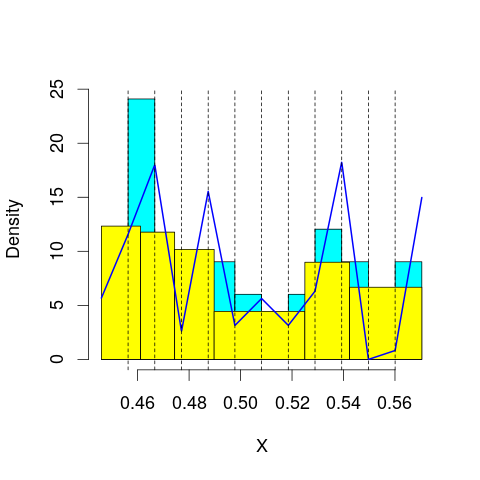

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.15591
mop.approx: Iteration 11. LL = 73.08287
mop.approx: Iteration 21. LL = 73.1475
mop.approx: Iteration 31. LL = 73.15821
mop.approx: Iteration 41. LL = 73.16081
mop.approx: Converged. Iteration 45. LL = 73.16127
[1] "Computing the linear combination of B-splines"


48.9011204825
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.90398
mop.approx: Iteration 11. LL = 72.4603
mop.approx: Iteration 21. LL = 72.54207
mop.approx: Iteration 31. LL = 72.56424
mop.approx: Iteration 41. LL = 72.57367
mop.approx: Iteration 51. LL = 72.57823
mop.approx: Iteration 61. LL = 72.58059
mop.approx: Iteration 71. LL = 72.58187
mop.approx: Converged. Iteration 75. LL = 72.58227
[1] "Computing the linear combination of B-splines"


46.5892531883
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.64883
mop.approx: Iteration 11. LL = 63.48925
mop.approx: Iteration 21. LL = 63.54383
mop.approx: Iteration 31. LL = 63.56466
mop.approx: Iteration 41. LL = 63.57459
mop.approx: Iteration 51. LL = 63.57945
mop.approx: Iteration 61. LL = 63.58182
mop.approx: Iteration 71. LL = 63.58296
mop.approx: Converged. Iteration 74. LL = 63.58323
[1] "Computing the linear combination of B-splines"


35.8573433685
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06481
mop.approx: Iteration 11. LL = 64.63333
mop.approx: Iteration 21. LL = 64.68701
mop.approx: Iteration 31. LL = 64.71233
mop.approx: Iteration 41. LL = 64.72709
mop.approx: Iteration 51. LL = 64.73662
mop.approx: Iteration 61. LL = 64.7431
mop.approx: Iteration 71. LL = 64.74763
mop.approx: Iteration 81. LL = 64.75087
mop.approx: Iteration 91. LL = 64.75322
mop.approx: Iteration 101. LL = 64.75493
mop.approx: Iteration 111. LL = 64.7562
mop.approx: Iteration 121. LL = 64.75713
mop.approx: Converged. Iteration 129. LL = 64.75777
[1] "Computing the linear combination of B-splines"


35.2990187243
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31197
mop.approx: Iteration 11. LL = 65.07414
mop.approx: Iteration 21. LL = 65.11469
mop.approx: Iteration 31. LL = 65.13094
mop.approx: Iteration 41. LL = 65.14185
mop.approx: Iteration 51. LL = 65.1491
mop.approx: Iteration 61. LL = 65.15381
mop.approx: Iteration 71. LL = 65.15686
mop.approx: Iteration 81. LL = 65.15885
mop.approx: Iteration 91. LL = 65.16018
mop.approx: Iteration 101. LL = 65.16108
mop.approx: Converged. Iteration 105. LL = 65.16142
[1] "Computing the linear combination of B-splines"


33.9698184923
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.17461
mop.approx: Iteration 11. LL = 64.88488
mop.approx: Iteration 21. LL = 65.00412
mop.approx: Iteration 31. LL = 65.01905
mop.approx: Iteration 41. LL = 65.02522
mop.approx: Iteration 51. LL = 65.02827
mop.approx: Iteration 61. LL = 65.02991
mop.approx: Iteration 71. LL = 65.03083
mop.approx: Converged. Iteration 72. LL = 65.03096
[1] "Computing the linear combination of B-splines"


32.1058064012
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.511455
mop.approx: Iteration 11. LL = 63.8917
mop.approx: Iteration 21. LL = 64.29327
mop.approx: Iteration 31. LL = 64.40611
mop.approx: Iteration 41. LL = 64.44085
mop.approx: Iteration 51. LL = 64.45252
mop.approx: Iteration 61. LL = 64.45695
mop.approx: Iteration 71. LL = 64.45884
mop.approx: Converged. Iteration 80. LL = 64.45972
[1] "Computing the linear combination of B-splines"


29.8116005631
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.40985
mop.approx: Iteration 11. LL = 74.13981
mop.approx: Iteration 21. LL = 74.19002
mop.approx: Converged. Iteration 29. LL = 74.1926
[1] "Computing the linear combination of B-splines"


49.93245137
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 49.932451369962202)
m reached
('Sum of Probabilities:', 0.9909381512203688)
chosen


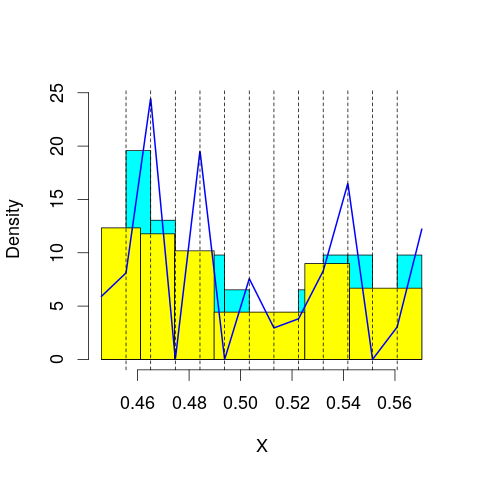

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.15591
mop.approx: Iteration 11. LL = 73.0343
mop.approx: Iteration 21. LL = 73.06867
mop.approx: Iteration 31. LL = 73.07507
mop.approx: Iteration 41. LL = 73.07706
mop.approx: Converged. Iteration 46. LL = 73.07761
[1] "Computing the linear combination of B-splines"


47.0845889498
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.90398
mop.approx: Iteration 11. LL = 73.03224
mop.approx: Iteration 21. LL = 73.19542
mop.approx: Iteration 31. LL = 73.21882
mop.approx: Iteration 41. LL = 73.22447
mop.approx: Iteration 51. LL = 73.22602
mop.approx: Converged. Iteration 51. LL = 73.2261
[1] "Computing the linear combination of B-splines"


45.50020852
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.64883
mop.approx: Iteration 11. LL = 64.65785
mop.approx: Iteration 21. LL = 64.86135
mop.approx: Iteration 31. LL = 64.90852
mop.approx: Iteration 41. LL = 64.92364
mop.approx: Iteration 51. LL = 64.92981
mop.approx: Iteration 61. LL = 64.9327
mop.approx: Iteration 71. LL = 64.93418
mop.approx: Converged. Iteration 80. LL = 64.93498
[1] "Computing the linear combination of B-splines"


35.4762279806
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06481
mop.approx: Iteration 11. LL = 64.61823
mop.approx: Iteration 21. LL = 64.69423
mop.approx: Iteration 31. LL = 64.73043
mop.approx: Iteration 41. LL = 64.74995
mop.approx: Iteration 51. LL = 64.76124
mop.approx: Iteration 61. LL = 64.76809
mop.approx: Iteration 71. LL = 64.77236
mop.approx: Iteration 81. LL = 64.77507
mop.approx: Iteration 91. LL = 64.77682
mop.approx: Iteration 101. LL = 64.77795
mop.approx: Converged. Iteration 109. LL = 64.77863
[1] "Computing the linear combination of B-splines"


33.5870051039
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31197
mop.approx: Iteration 11. LL = 65.39623
mop.approx: Iteration 21. LL = 65.48802
mop.approx: Iteration 31. LL = 65.52667
mop.approx: Iteration 41. LL = 65.54672
mop.approx: Iteration 51. LL = 65.55821
mop.approx: Iteration 61. LL = 65.56527
mop.approx: Iteration 71. LL = 65.56981
mop.approx: Iteration 81. LL = 65.57284
mop.approx: Iteration 91. LL = 65.57491
mop.approx: Iteration 101. LL = 65.57635
mop.approx: Iteration 111. LL = 65.57736
mop.approx: Converged. Iteration 118. LL = 65.57795
[1] "Computing the linear combination of B-splines"


32.6534458041
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.17461
mop.approx: Iteration 11. LL = 65.14683
mop.approx: Iteration 21. LL = 65.21657
mop.approx: Iteration 31. LL = 65.22691
mop.approx: Iteration 41. LL = 65.23308
mop.approx: Iteration 51. LL = 65.23753
mop.approx: Iteration 61. LL = 65.24081
mop.approx: Iteration 71. LL = 65.24322
mop.approx: Iteration 81. LL = 65.24501
mop.approx: Iteration 91. LL = 65.24636
mop.approx: Iteration 101. LL = 65.24739
mop.approx: Iteration 111. LL = 65.2482
mop.approx: Converged. Iteration 115. LL = 65.24853
[1] "Computing the linear combination of B-splines"


30.5893666616
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.511455
mop.approx: Iteration 11. LL = 64.55323
mop.approx: Iteration 21. LL = 64.91031
mop.approx: Iteration 31. LL = 64.96836
mop.approx: Iteration 41. LL = 64.98284
mop.approx: Iteration 51. LL = 64.98855
mop.approx: Iteration 61. LL = 64.99137
mop.approx: Iteration 71. LL = 64.99288
mop.approx: Converged. Iteration 80. LL = 64.99371
[1] "Computing the linear combination of B-splines"


28.5905825531
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.40985
mop.approx: Iteration 11. LL = 72.93821
mop.approx: Converged. Iteration 14. LL = 72.93877
[1] "Computing the linear combination of B-splines"


46.9457554075
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 46.945755407464588)
m reached
('Sum of Probabilities:', 0.9915705497785253)
chosen


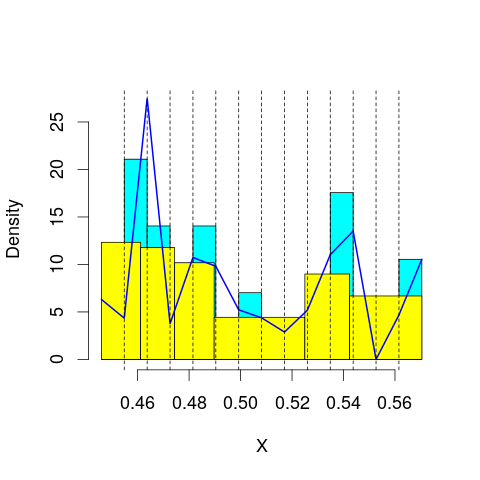

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.15591
mop.approx: Iteration 11. LL = 74.74381
mop.approx: Iteration 21. LL = 74.79548
mop.approx: Iteration 31. LL = 74.80082
mop.approx: Iteration 41. LL = 74.80272
mop.approx: Converged. Iteration 49. LL = 74.80359
[1] "Computing the linear combination of B-splines"


47.0776998909
('best: ', 46.945755407464588, 'accepted difference:', 79.807784192689809, 'cur BIC:', 47.077699890853424)
m reached
('Sum of Probabilities:', 0.9824226605625609)
chosen


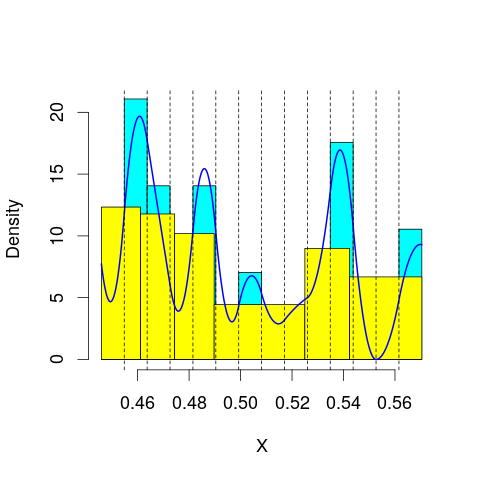

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.90398
mop.approx: Iteration 11. LL = 72.94026
mop.approx: Iteration 21. LL = 73.0776
mop.approx: Iteration 31. LL = 73.09682
mop.approx: Iteration 41. LL = 73.1018
mop.approx: Iteration 51. LL = 73.10367
mop.approx: Converged. Iteration 59. LL = 73.1045
[1] "Computing the linear combination of B-splines"


43.645742613
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.64883
mop.approx: Iteration 11. LL = 66.24255
mop.approx: Iteration 21. LL = 66.41868
mop.approx: Iteration 31. LL = 66.44758
mop.approx: Iteration 41. LL = 66.45448
mop.approx: Iteration 51. LL = 66.45653
mop.approx: Converged. Iteration 57. LL = 66.45713
[1] "Computing the linear combination of B-splines"


35.2655058713
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06481
mop.approx: Iteration 11. LL = 64.63333
mop.approx: Iteration 21. LL = 64.69029
mop.approx: Iteration 31. LL = 64.70767
mop.approx: Iteration 41. LL = 64.71528
mop.approx: Iteration 51. LL = 64.71928
mop.approx: Iteration 61. LL = 64.72156
mop.approx: Iteration 71. LL = 64.72292
mop.approx: Iteration 81. LL = 64.72376
mop.approx: Converged. Iteration 81. LL = 64.72382
[1] "Computing the linear combination of B-splines"


31.799332328
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31197
mop.approx: Iteration 11. LL = 65.65707
mop.approx: Iteration 21. LL = 65.78999
mop.approx: Iteration 31. LL = 65.84224
mop.approx: Iteration 41. LL = 65.86545
mop.approx: Iteration 51. LL = 65.8758
mop.approx: Iteration 61. LL = 65.88043
mop.approx: Iteration 71. LL = 65.88254
mop.approx: Iteration 81. LL = 65.88352
mop.approx: Converged. Iteration 81. LL = 65.88359
[1] "Computing the linear combination of B-splines"


31.2262286507
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.17461
mop.approx: Iteration 11. LL = 65.50609
mop.approx: Iteration 21. LL = 65.6179
mop.approx: Iteration 31. LL = 65.6619
mop.approx: Iteration 41. LL = 65.68635
mop.approx: Iteration 51. LL = 65.70094
mop.approx: Iteration 61. LL = 65.71003
mop.approx: Iteration 71. LL = 65.71589
mop.approx: Iteration 81. LL = 65.71974
mop.approx: Iteration 91. LL = 65.72233
mop.approx: Iteration 101. LL = 65.72408
mop.approx: Iteration 111. LL = 65.72529
mop.approx: Iteration 121. LL = 65.72613
mop.approx: Converged. Iteration 123. LL = 65.72633
[1] "Computing the linear combination of B-splines"


29.3334793003
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.511455
mop.approx: Iteration 11. LL = 64.94145
mop.approx: Iteration 21. LL = 65.16027
mop.approx: Iteration 31. LL = 65.18357
mop.approx: Iteration 41. LL = 65.1916
mop.approx: Iteration 51. LL = 65.19701
mop.approx: Iteration 61. LL = 65.20124
mop.approx: Iteration 71. LL = 65.20464
mop.approx: Iteration 81. LL = 65.20744
mop.approx: Iteration 91. LL = 65.20976
mop.approx: Iteration 101. LL = 65.2117
mop.approx: Iteration 111. LL = 65.21334
mop.approx: Iteration 121. LL = 65.21474
mop.approx: Iteration 131. LL = 65.21594
mop.approx: Iteration 141. LL = 65.21697
mop.approx: Iteration 151. LL = 65.21787
mop.approx: Iteration 161. LL = 65.21864
mop.approx: Converged. Iteration 169. LL = 65.21926
[1] "Computing the linear combination of B-splines"


27.0713396755
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.40985
mop.approx: Iteration 11. LL = 74.74621
mop.approx: Iteration 21. LL = 74.77106
mop.approx: Iteration 31. LL = 74.77536
mop.approx: Iteration 41. LL = 74.77666
mop.approx: Converged. Iteration 41. LL = 74.77673
[1] "Computing the linear combination of B-splines"


47.0508395871
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 47.050839587107518)
m reached
('Sum of Probabilities:', 0.9915456528492483)
chosen


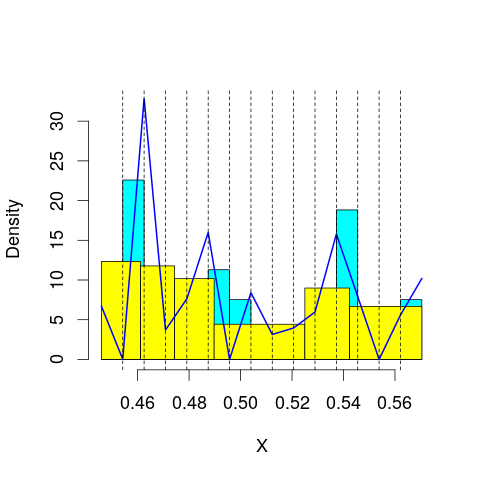

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.15591
mop.approx: Iteration 11. LL = 74.2768
mop.approx: Iteration 21. LL = 74.31893
mop.approx: Iteration 31. LL = 74.32296
mop.approx: Converged. Iteration 33. LL = 74.32323
[1] "Computing the linear combination of B-splines"


44.8644756768
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.90398
mop.approx: Iteration 11. LL = 73.99116
mop.approx: Iteration 21. LL = 74.18527
mop.approx: Iteration 31. LL = 74.21357
mop.approx: Iteration 41. LL = 74.22076
mop.approx: Iteration 51. LL = 74.22324
mop.approx: Converged. Iteration 59. LL = 74.22415
[1] "Computing the linear combination of B-splines"


43.0325304264
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.64883
mop.approx: Iteration 11. LL = 67.06958
mop.approx: Iteration 21. LL = 67.12442
mop.approx: Iteration 31. LL = 67.13151
mop.approx: Iteration 41. LL = 67.13425
mop.approx: Iteration 51. LL = 67.13572
mop.approx: Iteration 61. LL = 67.13668
mop.approx: Converged. Iteration 67. LL = 67.13718
[1] "Computing the linear combination of B-splines"


34.2126883768
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06481
mop.approx: Iteration 11. LL = 65.38106
mop.approx: Iteration 21. LL = 65.64878
mop.approx: Iteration 31. LL = 65.73071
mop.approx: Iteration 41. LL = 65.75882
mop.approx: Iteration 51. LL = 65.76997
mop.approx: Iteration 61. LL = 65.7751
mop.approx: Iteration 71. LL = 65.77772
mop.approx: Iteration 81. LL = 65.77913
mop.approx: Converged. Iteration 89. LL = 65.77987
[1] "Computing the linear combination of B-splines"


31.1225099201
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31197
mop.approx: Iteration 11. LL = 65.69597
mop.approx: Iteration 21. LL = 65.80329
mop.approx: Iteration 31. LL = 65.83568
mop.approx: Iteration 41. LL = 65.84637
mop.approx: Iteration 51. LL = 65.85009
mop.approx: Iteration 61. LL = 65.85155
mop.approx: Converged. Iteration 66. LL = 65.85202
[1] "Computing the linear combination of B-splines"


29.4618089011
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.17461
mop.approx: Iteration 11. LL = 65.92491
mop.approx: Iteration 21. LL = 66.08596
mop.approx: Iteration 31. LL = 66.1368
mop.approx: Iteration 41. LL = 66.15844
mop.approx: Iteration 51. LL = 66.16887
mop.approx: Iteration 61. LL = 66.17437
mop.approx: Iteration 71. LL = 66.17755
mop.approx: Iteration 81. LL = 66.17954
mop.approx: Iteration 91. LL = 66.1809
mop.approx: Iteration 101. LL = 66.18189
mop.approx: Iteration 111. LL = 66.18265
mop.approx: Converged. Iteration 112. LL = 66.18279
[1] "Computing the linear combination of B-splines"


28.0582418106
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.511455
mop.approx: Iteration 11. LL = 65.49624
mop.approx: Iteration 21. LL = 65.65495
mop.approx: Iteration 31. LL = 65.69347
mop.approx: Iteration 41. LL = 65.7122
mop.approx: Iteration 51. LL = 65.72205
mop.approx: Iteration 61. LL = 65.72758
mop.approx: Iteration 71. LL = 65.7309
mop.approx: Iteration 81. LL = 65.73302
mop.approx: Iteration 91. LL = 65.73443
mop.approx: Iteration 101. LL = 65.7354
mop.approx: Converged. Iteration 107. LL = 65.73589
[1] "Computing the linear combination of B-splines"


25.9007793957
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.40985
mop.approx: Iteration 11. LL = 75.91077
mop.approx: Iteration 21. LL = 75.99012
mop.approx: Iteration 31. LL = 76.00574
mop.approx: Iteration 41. LL = 76.0118
mop.approx: Iteration 51. LL = 76.01516
mop.approx: Iteration 61. LL = 76.01732
mop.approx: Iteration 71. LL = 76.01879
mop.approx: Iteration 81. LL = 76.01983
mop.approx: Converged. Iteration 85. LL = 76.02023
[1] "Computing the linear combination of B-splines"


46.5614792719
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 46.561479271913988)
m reached
('Sum of Probabilities:', 0.9913020312514244)
chosen


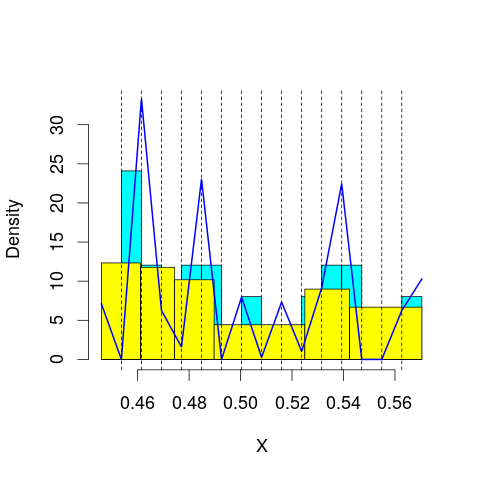

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.15591
mop.approx: Iteration 11. LL = 74.6273
mop.approx: Iteration 21. LL = 74.66319
mop.approx: Iteration 31. LL = 74.6676
mop.approx: Converged. Iteration 40. LL = 74.66881
[1] "Computing the linear combination of B-splines"


43.4771897559
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.90398
mop.approx: Iteration 11. LL = 74.75083
mop.approx: Iteration 21. LL = 74.88511
mop.approx: Iteration 31. LL = 74.90489
mop.approx: Iteration 41. LL = 74.91352
mop.approx: Iteration 51. LL = 74.91876
mop.approx: Iteration 61. LL = 74.92222
mop.approx: Iteration 71. LL = 74.92456
mop.approx: Iteration 81. LL = 74.92617
mop.approx: Iteration 91. LL = 74.92728
mop.approx: Converged. Iteration 97. LL = 74.92785
[1] "Computing the linear combination of B-splines"


42.0033590524
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.64883
mop.approx: Iteration 11. LL = 68.10954
mop.approx: Iteration 21. LL = 68.2045
mop.approx: Iteration 31. LL = 68.218
mop.approx: Iteration 41. LL = 68.22182
mop.approx: Iteration 51. LL = 68.22345
mop.approx: Converged. Iteration 59. LL = 68.22422
[1] "Computing the linear combination of B-splines"


33.5668611865
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06481
mop.approx: Iteration 11. LL = 66.19061
mop.approx: Iteration 21. LL = 66.36956
mop.approx: Iteration 31. LL = 66.40356
mop.approx: Iteration 41. LL = 66.41706
mop.approx: Iteration 51. LL = 66.42438
mop.approx: Iteration 61. LL = 66.4289
mop.approx: Iteration 71. LL = 66.43181
mop.approx: Iteration 81. LL = 66.43368
mop.approx: Iteration 91. LL = 66.43487
mop.approx: Converged. Iteration 98. LL = 66.43548
[1] "Computing the linear combination of B-splines"


30.0452539533
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31197
mop.approx: Iteration 11. LL = 65.82918
mop.approx: Iteration 21. LL = 65.95774
mop.approx: Iteration 31. LL = 66.00673
mop.approx: Iteration 41. LL = 66.03
mop.approx: Iteration 51. LL = 66.04186
mop.approx: Iteration 61. LL = 66.04818
mop.approx: Iteration 71. LL = 66.05168
mop.approx: Iteration 81. LL = 66.05371
mop.approx: Iteration 91. LL = 66.05493
mop.approx: Converged. Iteration 100. LL = 66.0557
[1] "Computing the linear combination of B-splines"


27.9324286688
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.17461
mop.approx: Iteration 11. LL = 66.25501
mop.approx: Iteration 21. LL = 66.4097
mop.approx: Iteration 31. LL = 66.44606
mop.approx: Iteration 41. LL = 66.46016
mop.approx: Iteration 51. LL = 66.46792
mop.approx: Iteration 61. LL = 66.4729
mop.approx: Iteration 71. LL = 66.4763
mop.approx: Iteration 81. LL = 66.47868
mop.approx: Iteration 91. LL = 66.48039
mop.approx: Iteration 101. LL = 66.48162
mop.approx: Iteration 111. LL = 66.48251
mop.approx: Converged. Iteration 115. LL = 66.48286
[1] "Computing the linear combination of B-splines"


26.6226163587
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.511455
mop.approx: Iteration 11. LL = 65.74206
mop.approx: Iteration 21. LL = 66.00455
mop.approx: Iteration 31. LL = 66.08444
mop.approx: Iteration 41. LL = 66.11364
mop.approx: Iteration 51. LL = 66.1247
mop.approx: Iteration 61. LL = 66.12903
mop.approx: Iteration 71. LL = 66.13077
mop.approx: Converged. Iteration 77. LL = 66.13134
[1] "Computing the linear combination of B-splines"


24.4684249239
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.40985
mop.approx: Iteration 11. LL = 76.47876
mop.approx: Iteration 21. LL = 76.5008
mop.approx: Iteration 31. LL = 76.50449
mop.approx: Converged. Iteration 39. LL = 76.50554
[1] "Computing the linear combination of B-splines"


45.3139141239
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 45.313914123938289)
m reached
('Sum of Probabilities:', 0.9910979725463969)
chosen


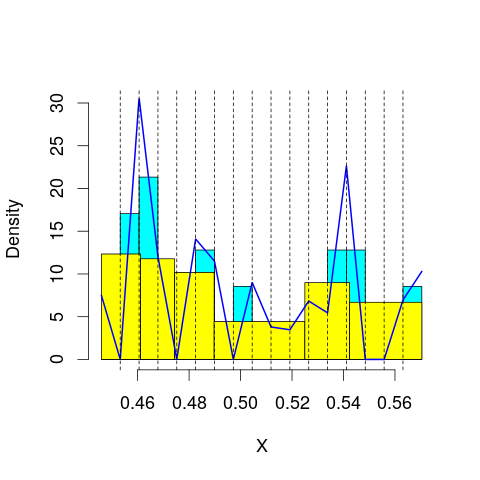

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.15591
mop.approx: Iteration 11. LL = 74.79952
mop.approx: Iteration 21. LL = 74.8321
mop.approx: Iteration 31. LL = 74.83782
mop.approx: Iteration 41. LL = 74.8414
mop.approx: Iteration 51. LL = 74.84436
mop.approx: Iteration 61. LL = 74.84683
mop.approx: Iteration 71. LL = 74.84889
mop.approx: Iteration 81. LL = 74.8506
mop.approx: Iteration 91. LL = 74.85199
mop.approx: Iteration 101. LL = 74.85312
mop.approx: Iteration 111. LL = 74.85403
mop.approx: Converged. Iteration 115. LL = 74.85442
[1] "Computing the linear combination of B-splines"


41.9299257011
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.90398
mop.approx: Iteration 11. LL = 74.86622
mop.approx: Iteration 21. LL = 74.93683
mop.approx: Iteration 31. LL = 74.94576
mop.approx: Iteration 41. LL = 74.94793
mop.approx: Converged. Iteration 44. LL = 74.94827
[1] "Computing the linear combination of B-splines"


40.2909153832
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.64883
mop.approx: Iteration 11. LL = 69.28348
mop.approx: Iteration 21. LL = 69.38934
mop.approx: Iteration 31. LL = 69.40324
mop.approx: Iteration 41. LL = 69.40952
mop.approx: Iteration 51. LL = 69.41406
mop.approx: Iteration 61. LL = 69.41762
mop.approx: Iteration 71. LL = 69.42041
mop.approx: Iteration 81. LL = 69.42255
mop.approx: Iteration 91. LL = 69.42415
mop.approx: Iteration 101. LL = 69.42532
mop.approx: Iteration 111. LL = 69.42616
mop.approx: Converged. Iteration 111. LL = 69.42623
[1] "Computing the linear combination of B-splines"


33.0360058049
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06481
mop.approx: Iteration 11. LL = 66.79472
mop.approx: Iteration 21. LL = 66.90116
mop.approx: Iteration 31. LL = 66.91817
mop.approx: Iteration 41. LL = 66.9221
mop.approx: Iteration 51. LL = 66.92332
mop.approx: Converged. Iteration 53. LL = 66.92353
[1] "Computing the linear combination of B-splines"


28.8004386103
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31197
mop.approx: Iteration 11. LL = 66.27367
mop.approx: Iteration 21. LL = 66.51391
mop.approx: Iteration 31. LL = 66.58814
mop.approx: Iteration 41. LL = 66.61695
mop.approx: Iteration 51. LL = 66.63055
mop.approx: Iteration 61. LL = 66.63801
mop.approx: Iteration 71. LL = 66.64252
mop.approx: Iteration 81. LL = 66.6454
mop.approx: Iteration 91. LL = 66.64729
mop.approx: Iteration 101. LL = 66.64856
mop.approx: Iteration 111. LL = 66.64941
mop.approx: Converged. Iteration 112. LL = 66.64955
[1] "Computing the linear combination of B-splines"


26.7935362106
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.17461
mop.approx: Iteration 11. LL = 66.41056
mop.approx: Iteration 21. LL = 66.55212
mop.approx: Iteration 31. LL = 66.58651
mop.approx: Iteration 41. LL = 66.60023
mop.approx: Iteration 51. LL = 66.60752
mop.approx: Iteration 61. LL = 66.61203
mop.approx: Iteration 71. LL = 66.61514
mop.approx: Iteration 81. LL = 66.61745
mop.approx: Iteration 91. LL = 66.61923
mop.approx: Iteration 101. LL = 66.62065
mop.approx: Iteration 111. LL = 66.62178
mop.approx: Iteration 121. LL = 66.6227
mop.approx: Iteration 131. LL = 66.62344
mop.approx: Converged. Iteration 131. LL = 66.62351
[1] "Computing the linear combination of B-splines"


25.0161280448
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.511455
mop.approx: Iteration 11. LL = 66.4155
mop.approx: Iteration 21. LL = 66.63132
mop.approx: Iteration 31. LL = 66.67455
mop.approx: Iteration 41. LL = 66.68896
mop.approx: Iteration 51. LL = 66.69542
mop.approx: Iteration 61. LL = 66.69869
mop.approx: Iteration 71. LL = 66.70045
mop.approx: Iteration 81. LL = 66.70145
mop.approx: Converged. Iteration 84. LL = 66.70173
[1] "Computing the linear combination of B-splines"


23.5311996799
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.40985
mop.approx: Iteration 11. LL = 77.41218
mop.approx: Iteration 21. LL = 77.45073
mop.approx: Iteration 31. LL = 77.4583
mop.approx: Converged. Iteration 37. LL = 77.45924
[1] "Computing the linear combination of B-splines"


44.534753323
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 44.534753322962246)
m reached
('Sum of Probabilities:', 0.9909212381398894)
chosen


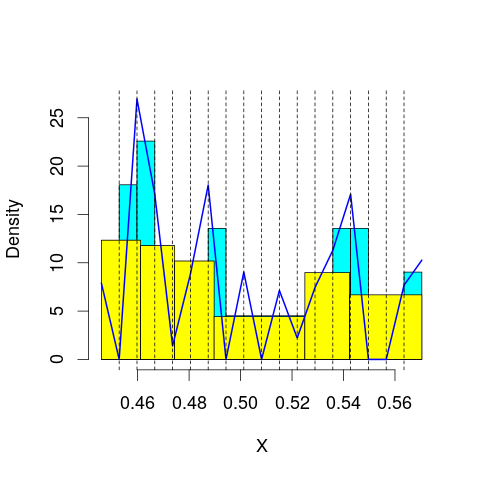

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.15591
mop.approx: Iteration 11. LL = 74.74008
mop.approx: Iteration 21. LL = 74.81787
mop.approx: Iteration 31. LL = 74.83459
mop.approx: Iteration 41. LL = 74.84089
mop.approx: Iteration 51. LL = 74.84387
mop.approx: Iteration 61. LL = 74.84549
mop.approx: Iteration 71. LL = 74.84647
mop.approx: Converged. Iteration 72. LL = 74.84662
[1] "Computing the linear combination of B-splines"


40.1892568731
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.90398
mop.approx: Iteration 11. LL = 75.13529
mop.approx: Iteration 21. LL = 75.17644
mop.approx: Iteration 31. LL = 75.19246
mop.approx: Iteration 41. LL = 75.20228
mop.approx: Iteration 51. LL = 75.20891
mop.approx: Iteration 61. LL = 75.21351
mop.approx: Iteration 71. LL = 75.21669
mop.approx: Iteration 81. LL = 75.21886
mop.approx: Iteration 91. LL = 75.22032
mop.approx: Iteration 101. LL = 75.22128
mop.approx: Converged. Iteration 102. LL = 75.22143
[1] "Computing the linear combination of B-splines"


38.831199539
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.64883
mop.approx: Iteration 11. LL = 70.09127
mop.approx: Iteration 21. LL = 70.30675
mop.approx: Iteration 31. LL = 70.34839
mop.approx: Iteration 41. LL = 70.36203
mop.approx: Iteration 51. LL = 70.36864
mop.approx: Iteration 61. LL = 70.37258
mop.approx: Iteration 71. LL = 70.37518
mop.approx: Iteration 81. LL = 70.37701
mop.approx: Iteration 91. LL = 70.37834
mop.approx: Iteration 101. LL = 70.37932
mop.approx: Converged. Iteration 108. LL = 70.37993
[1] "Computing the linear combination of B-splines"


32.2568378115
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06481
mop.approx: Iteration 11. LL = 67.72467
mop.approx: Iteration 21. LL = 67.79269
mop.approx: Iteration 31. LL = 67.79736
mop.approx: Iteration 41. LL = 67.79909
mop.approx: Iteration 51. LL = 67.80043
mop.approx: Iteration 61. LL = 67.80158
mop.approx: Iteration 71. LL = 67.80261
mop.approx: Iteration 81. LL = 67.80353
mop.approx: Iteration 91. LL = 67.80434
mop.approx: Converged. Iteration 100. LL = 67.80506
[1] "Computing the linear combination of B-splines"


27.9490955603
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31197
mop.approx: Iteration 11. LL = 66.69685
mop.approx: Iteration 21. LL = 66.936
mop.approx: Iteration 31. LL = 66.98739
mop.approx: Iteration 41. LL = 67.00547
mop.approx: Iteration 51. LL = 67.01409
mop.approx: Iteration 61. LL = 67.01901
mop.approx: Iteration 71. LL = 67.02217
mop.approx: Iteration 81. LL = 67.02436
mop.approx: Iteration 91. LL = 67.02594
mop.approx: Iteration 101. LL = 67.02713
mop.approx: Iteration 111. LL = 67.02804
mop.approx: Converged. Iteration 119. LL = 67.02869
[1] "Computing the linear combination of B-splines"


25.4397755749
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.17461
mop.approx: Iteration 11. LL = 66.70469
mop.approx: Iteration 21. LL = 66.88008
mop.approx: Iteration 31. LL = 66.92561
mop.approx: Iteration 41. LL = 66.94549
mop.approx: Iteration 51. LL = 66.95635
mop.approx: Iteration 61. LL = 66.96272
mop.approx: Iteration 71. LL = 66.96652
mop.approx: Iteration 81. LL = 66.9688
mop.approx: Iteration 91. LL = 66.97016
mop.approx: Converged. Iteration 100. LL = 66.97097
[1] "Computing the linear combination of B-splines"


23.6453874891
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.511455
mop.approx: Iteration 11. LL = 69.55191
mop.approx: Iteration 21. LL = 69.72707
mop.approx: Iteration 31. LL = 69.75115
mop.approx: Iteration 41. LL = 69.75643
mop.approx: Iteration 51. LL = 69.75812
mop.approx: Converged. Iteration 56. LL = 69.75862
[1] "Computing the linear combination of B-splines"


24.1754335599
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.40985
mop.approx: Iteration 11. LL = 75.64193
mop.approx: Iteration 21. LL = 75.67476
mop.approx: Iteration 31. LL = 75.68419
mop.approx: Iteration 41. LL = 75.68732
mop.approx: Converged. Iteration 49. LL = 75.68836
[1] "Computing the linear combination of B-splines"


41.0309966052
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 41.030996605245356)
m reached
('Sum of Probabilities:', 0.9907595607573397)
chosen


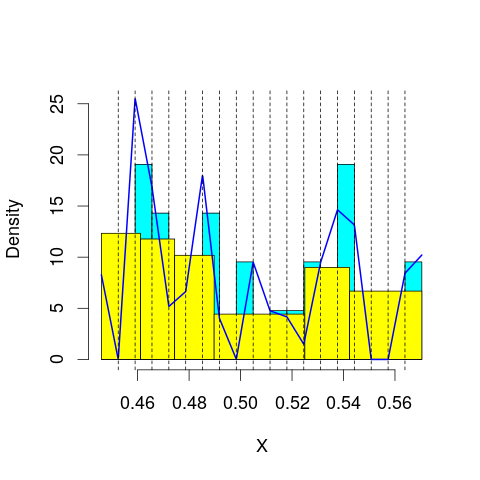

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.15591
mop.approx: Iteration 11. LL = 76.00357
mop.approx: Iteration 21. LL = 76.05818
mop.approx: Iteration 31. LL = 76.07489
mop.approx: Iteration 41. LL = 76.0808
mop.approx: Iteration 51. LL = 76.0828
mop.approx: Converged. Iteration 55. LL = 76.08324
[1] "Computing the linear combination of B-splines"


39.6930124922
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.90398
mop.approx: Iteration 11. LL = 75.11062
mop.approx: Iteration 21. LL = 75.24516
mop.approx: Iteration 31. LL = 75.26542
mop.approx: Iteration 41. LL = 75.26943
mop.approx: Converged. Iteration 48. LL = 75.27036
[1] "Computing the linear combination of B-splines"


37.1472673271
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.64883
mop.approx: Iteration 11. LL = 70.52776
mop.approx: Iteration 21. LL = 70.57029
mop.approx: Iteration 31. LL = 70.58083
mop.approx: Iteration 41. LL = 70.58735
mop.approx: Iteration 51. LL = 70.59222
mop.approx: Iteration 61. LL = 70.59609
mop.approx: Iteration 71. LL = 70.59921
mop.approx: Iteration 81. LL = 70.6017
mop.approx: Iteration 91. LL = 70.60368
mop.approx: Iteration 101. LL = 70.60521
mop.approx: Iteration 111. LL = 70.60639
mop.approx: Iteration 121. LL = 70.60729
mop.approx: Converged. Iteration 124. LL = 70.60758
[1] "Computing the linear combination of B-splines"


30.7516188712
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06481
mop.approx: Iteration 11. LL = 68.86085
mop.approx: Iteration 21. LL = 69.1057
mop.approx: Iteration 31. LL = 69.15231
mop.approx: Iteration 41. LL = 69.16527
mop.approx: Iteration 51. LL = 69.17086
mop.approx: Iteration 61. LL = 69.1741
mop.approx: Iteration 71. LL = 69.17626
mop.approx: Iteration 81. LL = 69.17782
mop.approx: Iteration 91. LL = 69.17901
mop.approx: Iteration 101. LL = 69.17994
mop.approx: Converged. Iteration 110. LL = 69.18069
[1] "Computing the linear combination of B-splines"


27.5918416486
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31197
mop.approx: Iteration 11. LL = 67.06759
mop.approx: Iteration 21. LL = 67.15651
mop.approx: Iteration 31. LL = 67.1633
mop.approx: Iteration 41. LL = 67.16491
mop.approx: Iteration 51. LL = 67.16585
mop.approx: Converged. Iteration 56. LL = 67.16628
[1] "Computing the linear combination of B-splines"


23.8442428191
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.17461
mop.approx: Iteration 11. LL = 67.068
mop.approx: Iteration 21. LL = 67.38636
mop.approx: Iteration 31. LL = 67.48979
mop.approx: Iteration 41. LL = 67.53079
mop.approx: Iteration 51. LL = 67.54956
mop.approx: Iteration 61. LL = 67.5592
mop.approx: Iteration 71. LL = 67.56452
mop.approx: Iteration 81. LL = 67.56754
mop.approx: Iteration 91. LL = 67.56929
mop.approx: Iteration 101. LL = 67.57031
mop.approx: Converged. Iteration 103. LL = 67.57052
[1] "Computing the linear combination of B-splines"


22.4969148574
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.511455
mop.approx: Iteration 11. LL = 69.77399
mop.approx: Iteration 21. LL = 69.94731
mop.approx: Iteration 31. LL = 69.98678
mop.approx: Iteration 41. LL = 70.00085
mop.approx: Iteration 51. LL = 70.00635
mop.approx: Iteration 61. LL = 70.00852
mop.approx: Converged. Iteration 68. LL = 70.00927
[1] "Computing the linear combination of B-splines"


22.490853
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.40985
mop.approx: Iteration 11. LL = 76.94487
mop.approx: Iteration 21. LL = 76.9782
mop.approx: Iteration 31. LL = 76.98386
mop.approx: Converged. Iteration 36. LL = 76.98461
[1] "Computing the linear combination of B-splines"


40.5943876322
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 40.594387632151467)
m reached
('Sum of Probabilities:', 0.9906031336039012)
chosen


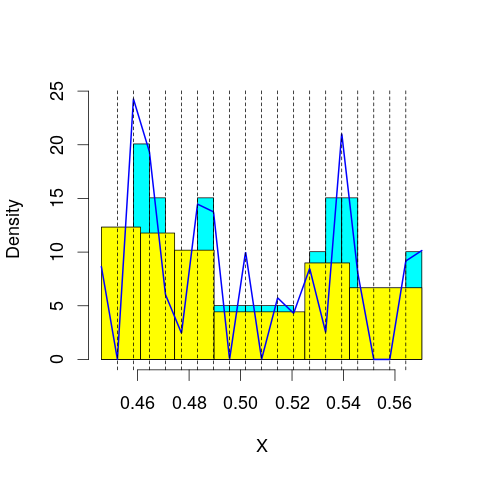

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.15591
mop.approx: Iteration 11. LL = 75.85458
mop.approx: Iteration 21. LL = 75.92972
mop.approx: Iteration 31. LL = 75.95349
mop.approx: Iteration 41. LL = 75.96412
mop.approx: Iteration 51. LL = 75.96925
mop.approx: Iteration 61. LL = 75.97184
mop.approx: Iteration 71. LL = 75.97321
mop.approx: Converged. Iteration 75. LL = 75.97364
[1] "Computing the linear combination of B-splines"


37.8505477649
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.90398
mop.approx: Iteration 11. LL = 75.43649
mop.approx: Iteration 21. LL = 75.56176
mop.approx: Iteration 31. LL = 75.60894
mop.approx: Iteration 41. LL = 75.63
mop.approx: Iteration 51. LL = 75.64017
mop.approx: Iteration 61. LL = 75.64545
mop.approx: Iteration 71. LL = 75.64838
mop.approx: Iteration 81. LL = 75.6501
mop.approx: Iteration 91. LL = 75.65114
mop.approx: Converged. Iteration 93. LL = 75.65137
[1] "Computing the linear combination of B-splines"


35.7954102069
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.64883
mop.approx: Iteration 11. LL = 70.7419
mop.approx: Iteration 21. LL = 70.83406
mop.approx: Iteration 31. LL = 70.85229
mop.approx: Iteration 41. LL = 70.8573
mop.approx: Iteration 51. LL = 70.85954
mop.approx: Iteration 61. LL = 70.86107
mop.approx: Iteration 71. LL = 70.86229
mop.approx: Iteration 81. LL = 70.8633
mop.approx: Iteration 91. LL = 70.86413
mop.approx: Converged. Iteration 94. LL = 70.86442
[1] "Computing the linear combination of B-splines"


29.2755887756
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.06481
mop.approx: Iteration 11. LL = 69.68204
mop.approx: Iteration 21. LL = 69.87058
mop.approx: Iteration 31. LL = 69.91888
mop.approx: Iteration 41. LL = 69.93818
mop.approx: Iteration 51. LL = 69.9479
mop.approx: Iteration 61. LL = 69.9537
mop.approx: Iteration 71. LL = 69.95758
mop.approx: Iteration 81. LL = 69.96037
mop.approx: Iteration 91. LL = 69.96247
mop.approx: Iteration 101. LL = 69.96411
mop.approx: Iteration 111. LL = 69.96542
mop.approx: Iteration 121. LL = 69.96647
mop.approx: Iteration 131. LL = 69.96733
mop.approx: Converged. Iteration 136. LL = 69.96777
[1] "Computing the linear combination of B-splines"


26.6460824377
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.31197
mop.approx: Iteration 11. LL = 67.77553
mop.approx: Iteration 21. LL = 67.96016
mop.approx: Iteration 31. LL = 67.99675
mop.approx: Iteration 41. LL = 68.00661
mop.approx: Iteration 51. LL = 68.0099
mop.approx: Iteration 61. LL = 68.01133
mop.approx: Converged. Iteration 68. LL = 68.01198
[1] "Computing the linear combination of B-splines"


22.956937862
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.17461
mop.approx: Iteration 11. LL = 67.19916
mop.approx: Iteration 21. LL = 67.41301
mop.approx: Iteration 31. LL = 67.45133
mop.approx: Iteration 41. LL = 67.46416
mop.approx: Iteration 51. LL = 67.47148
mop.approx: Iteration 61. LL = 67.4764
mop.approx: Iteration 71. LL = 67.47982
mop.approx: Iteration 81. LL = 67.48219
mop.approx: Iteration 91. LL = 67.48385
mop.approx: Iteration 101. LL = 67.48501
mop.approx: Iteration 111. LL = 67.48583
mop.approx: Converged. Iteration 112. LL = 67.48596
[1] "Computing the linear combination of B-splines"


20.6424265543
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.511455
mop.approx: Iteration 11. LL = 74.31988
mop.approx: Iteration 21. LL = 74.50619
mop.approx: Iteration 31. LL = 74.53285
mop.approx: Iteration 41. LL = 74.5378
mop.approx: Converged. Iteration 48. LL = 74.53879
[1] "Computing the linear combination of B-splines"


26.1816623855
lfps_22
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 85.39147
mop.approx: Converged. Iteration 10. LL = 87.04751
[1] "Computing the linear combination of B-splines"


81.8489056255
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 81.848905625479844)
m reached
('Sum of Probabilities:', 0.9900283581341962)
chosen


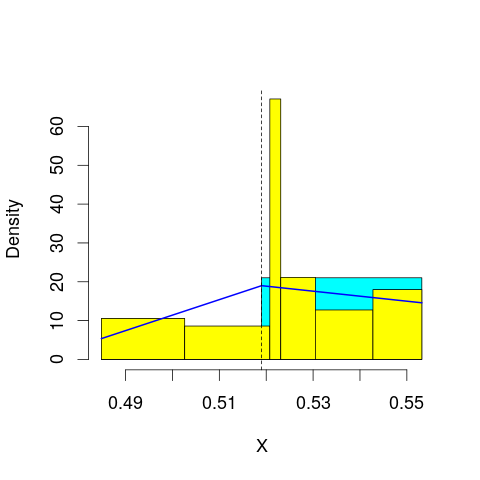

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.93339
mop.approx: Iteration 11. LL = 87.33323
mop.approx: Iteration 21. LL = 87.39585
mop.approx: Iteration 31. LL = 87.40299
mop.approx: Converged. Iteration 37. LL = 87.40396
[1] "Computing the linear combination of B-splines"


80.4724915999
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.48177
mop.approx: Iteration 11. LL = 86.97045
mop.approx: Iteration 21. LL = 87.01418
mop.approx: Iteration 31. LL = 87.02941
mop.approx: Iteration 41. LL = 87.03654
mop.approx: Iteration 51. LL = 87.04026
mop.approx: Iteration 61. LL = 87.04237
mop.approx: Iteration 71. LL = 87.04366
mop.approx: Converged. Iteration 74. LL = 87.04403
[1] "Computing the linear combination of B-splines"


78.3796868969
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.27276
mop.approx: Iteration 11. LL = 59.97759
mop.approx: Iteration 21. LL = 60.06654
mop.approx: Iteration 31. LL = 60.07959
mop.approx: Iteration 41. LL = 60.08208
mop.approx: Converged. Iteration 45. LL = 60.08245
[1] "Computing the linear combination of B-splines"


49.685238641
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.08016
mop.approx: Iteration 11. LL = 63.95007
mop.approx: Converged. Iteration 15. LL = 63.95272
[1] "Computing the linear combination of B-splines"


51.8226462789
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.89383
mop.approx: Iteration 11. LL = 54.05132
mop.approx: Iteration 21. LL = 54.26356
mop.approx: Iteration 31. LL = 54.3469
mop.approx: Iteration 41. LL = 54.38606
mop.approx: Iteration 51. LL = 54.40721
mop.approx: Iteration 61. LL = 54.41986
mop.approx: Iteration 71. LL = 54.428
mop.approx: Iteration 81. LL = 54.43356
mop.approx: Iteration 91. LL = 54.43752
mop.approx: Iteration 101. LL = 54.44043
mop.approx: Iteration 111. LL = 54.44263
mop.approx: Iteration 121. LL = 54.44434
mop.approx: Iteration 131. LL = 54.44568
mop.approx: Iteration 141. LL = 54.44675
mop.approx: Iteration 151. LL = 54.44761
mop.approx: Iteration 161. LL = 54.44832
mop.approx: Converged. Iteration 169. LL = 54.44885
[1] "Computing the linear combination of B-splines"


40.5859018213
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.432013
mop.approx: Iteration 11. LL = 57.30319
mop.approx: Converged. Iteration 19. LL = 57.32306
[1] "Computing the linear combination of B-splines"


41.7272490335
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.516864
mop.approx: Iteration 11. LL = 49.68844
mop.approx: Iteration 21. LL = 49.89665
mop.approx: Iteration 31. LL = 50.00742
mop.approx: Iteration 41. LL = 50.06975
mop.approx: Iteration 51. LL = 50.10703
mop.approx: Iteration 61. LL = 50.13052
mop.approx: Iteration 71. LL = 50.14591
mop.approx: Iteration 81. LL = 50.1563
mop.approx: Iteration 91. LL = 50.16347
mop.approx: Iteration 101. LL = 50.16849
mop.approx: Iteration 111. LL = 50.17205
mop.approx: Iteration 121. LL = 50.1746
mop.approx: Iteration 131. LL = 50.17644
mop.approx: Iteration 141. LL = 50.17776
mop.approx: Iteration 151. LL = 50.17873
mop.approx: Iteration 161. LL = 50.17943
mop.approx: Converged. Iteration 166. LL = 50.17975
[1] "Computing the linear combination of B-splines"


32.8510715349
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 85.39147
mop.approx: Iteration 11. LL = 87.52581
mop.approx: Converged. Iteration 15. LL = 87.52717
[1] "Computing the linear combination of B-splines"


80.5957007744
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 80.595700774352167)
m reached
('Sum of Probabilities:', 0.9898651065837747)
chosen


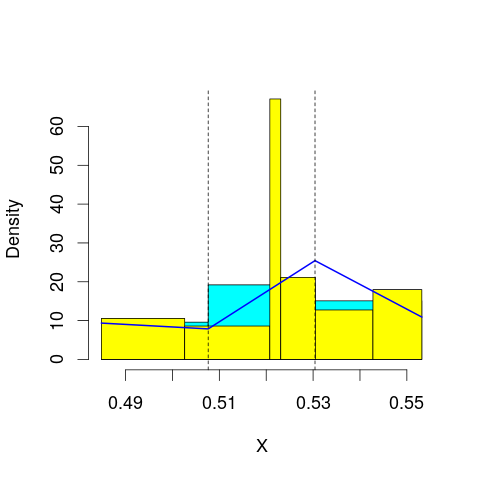

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.93339
mop.approx: Iteration 11. LL = 87.1695
mop.approx: Iteration 21. LL = 87.17756
mop.approx: Converged. Iteration 24. LL = 87.17798
[1] "Computing the linear combination of B-splines"


78.5136403954
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.48177
mop.approx: Iteration 11. LL = 87.02328
mop.approx: Iteration 21. LL = 87.03566
mop.approx: Iteration 31. LL = 87.04224
mop.approx: Iteration 41. LL = 87.04654
mop.approx: Iteration 51. LL = 87.04934
mop.approx: Iteration 61. LL = 87.05118
mop.approx: Iteration 71. LL = 87.0524
mop.approx: Converged. Iteration 74. LL = 87.05276
[1] "Computing the linear combination of B-splines"


76.6555541333
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.27276
mop.approx: Iteration 11. LL = 77.20432
mop.approx: Converged. Iteration 15. LL = 77.20684
[1] "Computing the linear combination of B-splines"


65.0767598611
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.08016
mop.approx: Iteration 11. LL = 64.97038
mop.approx: Iteration 21. LL = 65.01523
mop.approx: Iteration 31. LL = 65.01836
mop.approx: Converged. Iteration 31. LL = 65.01842
[1] "Computing the linear combination of B-splines"


51.1554783062
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.89383
mop.approx: Iteration 11. LL = 67.81553
mop.approx: Converged. Iteration 16. LL = 67.82106
[1] "Computing the linear combination of B-splines"


52.22524992
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.432013
mop.approx: Iteration 11. LL = 58.02898
mop.approx: Iteration 21. LL = 58.22171
mop.approx: Iteration 31. LL = 58.28604
mop.approx: Iteration 41. LL = 58.3132
mop.approx: Iteration 51. LL = 58.32676
mop.approx: Iteration 61. LL = 58.33437
mop.approx: Iteration 71. LL = 58.33902
mop.approx: Iteration 81. LL = 58.34205
mop.approx: Iteration 91. LL = 58.34413
mop.approx: Iteration 101. LL = 58.34561
mop.approx: Iteration 111. LL = 58.3467
mop.approx: Iteration 121. LL = 58.34753
mop.approx: Converged. Iteration 130. LL = 58.34817
[1] "Computing the linear combination of B-splines"


41.0194920168
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.516864
mop.approx: Iteration 11. LL = 60.61166
mop.approx: Converged. Iteration 20. LL = 60.63726
[1] "Computing the linear combination of B-splines"


41.5757086461
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 85.39147
mop.approx: Converged. Iteration 9. LL = 87.45145
[1] "Computing the linear combination of B-splines"


78.7871123158
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 78.787112315829063)
m reached
('Sum of Probabilities:', 0.9885641469643801)
chosen


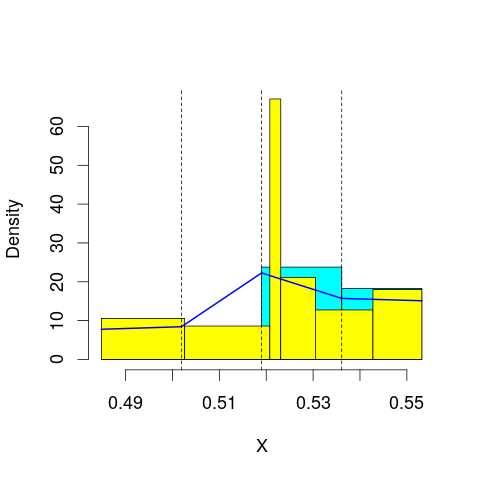

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.93339
mop.approx: Iteration 11. LL = 87.60337
mop.approx: Iteration 21. LL = 87.64833
mop.approx: Iteration 31. LL = 87.66044
mop.approx: Iteration 41. LL = 87.66425
mop.approx: Converged. Iteration 50. LL = 87.66559
[1] "Computing the linear combination of B-splines"


77.2683796062
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.48177
mop.approx: Iteration 11. LL = 87.17712
mop.approx: Iteration 21. LL = 87.2177
mop.approx: Iteration 31. LL = 87.23444
mop.approx: Iteration 41. LL = 87.24239
mop.approx: Iteration 51. LL = 87.24652
mop.approx: Iteration 61. LL = 87.24878
mop.approx: Iteration 71. LL = 87.25006
mop.approx: Converged. Iteration 73. LL = 87.25033
[1] "Computing the linear combination of B-splines"


75.1202500066
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.27276
mop.approx: Converged. Iteration 10. LL = 78.45825
[1] "Computing the linear combination of B-splines"


64.5953022375
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.08016
mop.approx: Iteration 11. LL = 79.46436
mop.approx: Converged. Iteration 19. LL = 79.48304
[1] "Computing the linear combination of B-splines"


63.8872313062
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.89383
mop.approx: Iteration 11. LL = 68.89183
mop.approx: Iteration 21. LL = 68.91338
mop.approx: Converged. Iteration 25. LL = 68.91394
[1] "Computing the linear combination of B-splines"


51.5852560909
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.432013
mop.approx: Iteration 11. LL = 70.90464
mop.approx: Converged. Iteration 18. LL = 70.91603
[1] "Computing the linear combination of B-splines"


51.8544858634
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.516864
mop.approx: Iteration 11. LL = 61.42856
mop.approx: Iteration 21. LL = 61.5953
mop.approx: Iteration 31. LL = 61.64199
mop.approx: Iteration 41. LL = 61.65917
mop.approx: Iteration 51. LL = 61.66672
mop.approx: Iteration 61. LL = 61.67045
mop.approx: Iteration 71. LL = 61.67246
mop.approx: Iteration 81. LL = 61.6736
mop.approx: Converged. Iteration 88. LL = 61.67417
[1] "Computing the linear combination of B-splines"


40.8797476166
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 85.39147
mop.approx: Iteration 11. LL = 89.34451
mop.approx: Iteration 21. LL = 89.38902
mop.approx: Iteration 31. LL = 89.39799
mop.approx: Iteration 41. LL = 89.40129
mop.approx: Iteration 51. LL = 89.40288
mop.approx: Converged. Iteration 56. LL = 89.40347
[1] "Computing the linear combination of B-splines"


79.0062602248
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 79.006260224794687)
m reached
('Sum of Probabilities:', 0.9898102624134525)
chosen


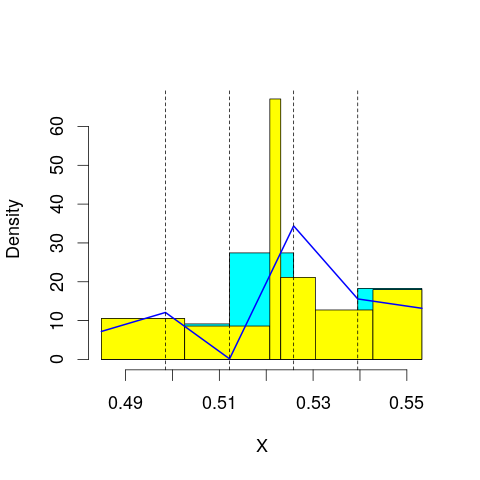

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.93339
mop.approx: Iteration 11. LL = 88.04469
mop.approx: Iteration 21. LL = 88.0827
mop.approx: Iteration 31. LL = 88.08761
mop.approx: Converged. Iteration 35. LL = 88.08817
[1] "Computing the linear combination of B-splines"


75.9580992676
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.48177
mop.approx: Iteration 11. LL = 88.43835
mop.approx: Iteration 21. LL = 88.83454
mop.approx: Iteration 31. LL = 88.95724
mop.approx: Iteration 41. LL = 88.99936
mop.approx: Iteration 51. LL = 89.01522
mop.approx: Iteration 61. LL = 89.02172
mop.approx: Iteration 71. LL = 89.02459
mop.approx: Iteration 81. LL = 89.02593
mop.approx: Converged. Iteration 81. LL = 89.02602
[1] "Computing the linear combination of B-splines"


75.1630751866
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.27276
mop.approx: Converged. Iteration 10. LL = 79.75711
[1] "Computing the linear combination of B-splines"


64.1612963353
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.08016
mop.approx: Iteration 11. LL = 80.82114
mop.approx: Converged. Iteration 13. LL = 80.82166
[1] "Computing the linear combination of B-splines"


63.4929838368
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.89383
mop.approx: Iteration 11. LL = 80.7578
mop.approx: Iteration 21. LL = 80.83451
mop.approx: Converged. Iteration 26. LL = 80.83588
[1] "Computing the linear combination of B-splines"


61.7743359077
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.432013
mop.approx: Iteration 11. LL = 72.03117
mop.approx: Iteration 21. LL = 72.0414
mop.approx: Converged. Iteration 21. LL = 72.04145
[1] "Computing the linear combination of B-splines"


51.2470266776
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.516864
mop.approx: Iteration 11. LL = 73.39572
mop.approx: Converged. Iteration 19. LL = 73.41822
[1] "Computing the linear combination of B-splines"


50.8909322533
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 85.39147
mop.approx: Iteration 11. LL = 89.88623
mop.approx: Iteration 21. LL = 89.93236
mop.approx: Iteration 31. LL = 89.94074
mop.approx: Iteration 41. LL = 89.94268
mop.approx: Converged. Iteration 41. LL = 89.94276
[1] "Computing the linear combination of B-splines"


77.8126874645
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 77.812687464499092)
m reached
('Sum of Probabilities:', 0.9917796240528712)
chosen


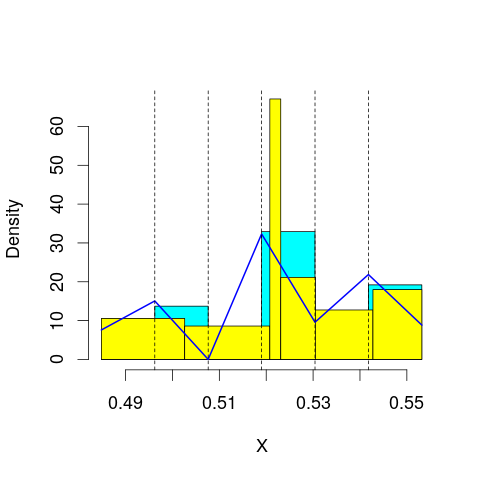

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.93339
mop.approx: Iteration 11. LL = 91.35602
mop.approx: Iteration 21. LL = 91.57139
mop.approx: Iteration 31. LL = 91.60312
mop.approx: Iteration 41. LL = 91.61139
mop.approx: Iteration 51. LL = 91.61428
mop.approx: Converged. Iteration 58. LL = 91.61526
[1] "Computing the linear combination of B-splines"


77.7523155923
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.48177
mop.approx: Iteration 11. LL = 88.71452
mop.approx: Iteration 21. LL = 88.89963
mop.approx: Iteration 31. LL = 88.92759
mop.approx: Iteration 41. LL = 88.93498
mop.approx: Iteration 51. LL = 88.93777
mop.approx: Converged. Iteration 60. LL = 88.93897
[1] "Computing the linear combination of B-splines"


73.3431627539
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.27276
mop.approx: Iteration 11. LL = 80.61759
mop.approx: Iteration 21. LL = 80.69096
mop.approx: Iteration 31. LL = 80.70979
mop.approx: Iteration 41. LL = 80.71722
mop.approx: Iteration 51. LL = 80.7209
mop.approx: Iteration 61. LL = 80.72299
mop.approx: Iteration 71. LL = 80.7243
mop.approx: Converged. Iteration 78. LL = 80.72503
[1] "Computing the linear combination of B-splines"


63.3963519182
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.08016
mop.approx: Iteration 11. LL = 81.17052
mop.approx: Converged. Iteration 12. LL = 81.17075
[1] "Computing the linear combination of B-splines"


62.1092070215
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.89383
mop.approx: Iteration 11. LL = 82.24712
mop.approx: Converged. Iteration 17. LL = 82.25359
[1] "Computing the linear combination of B-splines"


61.4591745436
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.432013
mop.approx: Iteration 11. LL = 81.34478
mop.approx: Iteration 21. LL = 81.50349
mop.approx: Iteration 31. LL = 81.52029
mop.approx: Converged. Iteration 40. LL = 81.52253
[1] "Computing the linear combination of B-splines"


58.9952375645
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.516864
mop.approx: Iteration 11. LL = 74.57241
mop.approx: Converged. Iteration 18. LL = 74.57728
[1] "Computing the linear combination of B-splines"


50.3171642415
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 85.39147
mop.approx: Iteration 11. LL = 93.41653
mop.approx: Iteration 21. LL = 93.44712
mop.approx: Converged. Iteration 28. LL = 93.44895
[1] "Computing the linear combination of B-splines"


79.5860103635
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 79.586010363525816)
m reached
('Sum of Probabilities:', 0.9908452241667671)
chosen


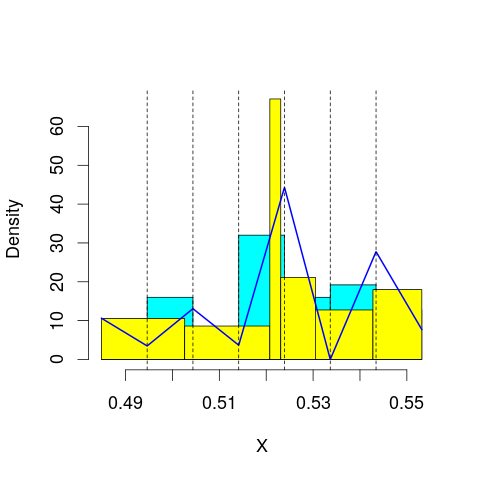

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.93339
mop.approx: Iteration 11. LL = 90.99358
mop.approx: Iteration 21. LL = 91.00756
mop.approx: Converged. Iteration 21. LL = 91.00763
[1] "Computing the linear combination of B-splines"


75.4118210182
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.48177
mop.approx: Iteration 11. LL = 91.67713
mop.approx: Iteration 21. LL = 91.92129
mop.approx: Iteration 31. LL = 91.94985
mop.approx: Iteration 41. LL = 91.95724
mop.approx: Iteration 51. LL = 91.95974
mop.approx: Converged. Iteration 55. LL = 91.9603
[1] "Computing the linear combination of B-splines"


74.6316224888
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.27276
mop.approx: Iteration 11. LL = 80.26366
mop.approx: Iteration 21. LL = 80.27478
mop.approx: Iteration 31. LL = 80.27666
mop.approx: Converged. Iteration 31. LL = 80.27673
[1] "Computing the linear combination of B-splines"


61.21518049
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.08016
mop.approx: Iteration 11. LL = 82.27931
mop.approx: Iteration 21. LL = 82.41125
mop.approx: Iteration 31. LL = 82.43861
mop.approx: Iteration 41. LL = 82.44548
mop.approx: Iteration 51. LL = 82.4473
mop.approx: Converged. Iteration 51. LL = 82.44738
[1] "Computing the linear combination of B-splines"


61.6529616068
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.89383
mop.approx: Iteration 11. LL = 82.23686
mop.approx: Converged. Iteration 16. LL = 82.24054
[1] "Computing the linear combination of B-splines"


59.713268479
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.432013
mop.approx: Iteration 11. LL = 82.97488
mop.approx: Iteration 21. LL = 83.01518
mop.approx: Converged. Iteration 23. LL = 83.0155
[1] "Computing the linear combination of B-splines"


58.755709755
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.516864
mop.approx: Iteration 11. LL = 81.502
mop.approx: Iteration 21. LL = 81.64809
mop.approx: Iteration 31. LL = 81.67096
mop.approx: Iteration 41. LL = 81.67924
mop.approx: Iteration 51. LL = 81.68323
mop.approx: Iteration 61. LL = 81.68546
mop.approx: Iteration 71. LL = 81.68684
mop.approx: Converged. Iteration 78. LL = 81.68759
[1] "Computing the linear combination of B-splines"


55.6979836691
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 85.39147
mop.approx: Iteration 11. LL = 93.6238
mop.approx: Converged. Iteration 19. LL = 93.63144
[1] "Computing the linear combination of B-splines"


78.0356300621
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 78.035630062134956)
m reached
('Sum of Probabilities:', 0.9893831192189317)
chosen


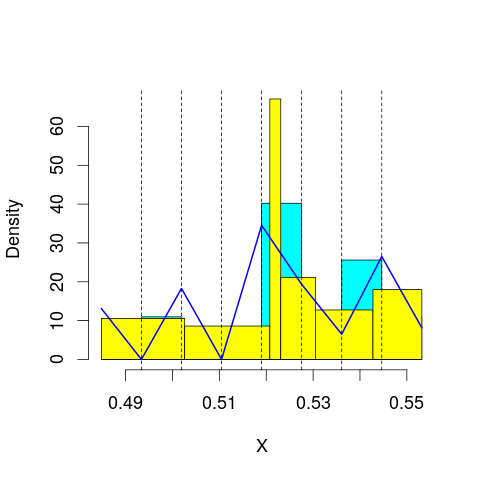

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.93339
mop.approx: Iteration 11. LL = 93.89489
mop.approx: Iteration 21. LL = 93.99658
mop.approx: Iteration 31. LL = 94.00752
mop.approx: Iteration 41. LL = 94.0108
mop.approx: Iteration 51. LL = 94.01225
mop.approx: Converged. Iteration 52. LL = 94.01244
[1] "Computing the linear combination of B-splines"


76.6837588512
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.48177
mop.approx: Iteration 11. LL = 91.93985
mop.approx: Iteration 21. LL = 92.10763
mop.approx: Iteration 31. LL = 92.12827
mop.approx: Iteration 41. LL = 92.13179
mop.approx: Converged. Iteration 44. LL = 92.13222
[1] "Computing the linear combination of B-splines"


73.0706718635
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.27276
mop.approx: Iteration 11. LL = 82.42369
mop.approx: Iteration 21. LL = 82.55195
mop.approx: Iteration 31. LL = 82.56669
mop.approx: Iteration 41. LL = 82.57105
mop.approx: Iteration 51. LL = 82.57295
mop.approx: Converged. Iteration 59. LL = 82.57387
[1] "Computing the linear combination of B-splines"


61.779451408
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.08016
mop.approx: Iteration 11. LL = 82.19409
mop.approx: Iteration 21. LL = 82.25894
mop.approx: Iteration 31. LL = 82.2667
mop.approx: Converged. Iteration 36. LL = 82.26745
[1] "Computing the linear combination of B-splines"


59.7401628623
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.89383
mop.approx: Iteration 11. LL = 83.44259
mop.approx: Iteration 21. LL = 83.56711
mop.approx: Iteration 31. LL = 83.582
mop.approx: Converged. Iteration 39. LL = 83.58386
[1] "Computing the linear combination of B-splines"


59.3236885726
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.432013
mop.approx: Iteration 11. LL = 82.92807
mop.approx: Iteration 21. LL = 82.95644
mop.approx: Converged. Iteration 21. LL = 82.95649
[1] "Computing the linear combination of B-splines"


56.9628274666
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.516864
mop.approx: Iteration 11. LL = 83.36405
mop.approx: Iteration 21. LL = 83.48313
mop.approx: Iteration 31. LL = 83.48905
mop.approx: Converged. Iteration 32. LL = 83.48923
[1] "Computing the linear combination of B-splines"


55.5352941073
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 85.39147
mop.approx: Iteration 11. LL = 95.52907
mop.approx: Converged. Iteration 13. LL = 95.52977
[1] "Computing the linear combination of B-splines"


78.2010909734
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 78.201090973397172)
m reached
('Sum of Probabilities:', 0.988409848395391)
chosen


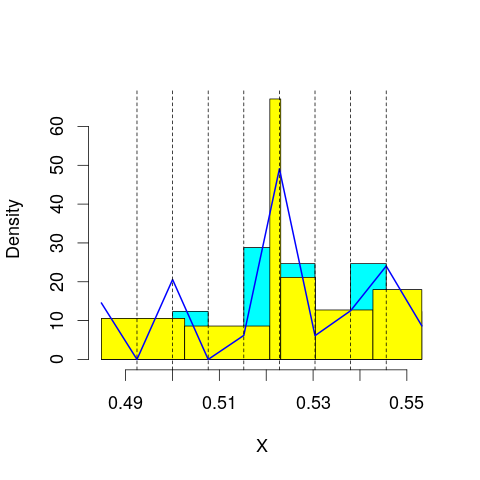

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.93339
mop.approx: Iteration 11. LL = 93.56033
mop.approx: Iteration 21. LL = 93.62524
mop.approx: Iteration 31. LL = 93.63506
mop.approx: Iteration 41. LL = 93.63835
mop.approx: Iteration 51. LL = 93.6398
mop.approx: Converged. Iteration 52. LL = 93.63998
[1] "Computing the linear combination of B-splines"


74.5784368072
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.48177
mop.approx: Iteration 11. LL = 94.64883
mop.approx: Iteration 21. LL = 94.77463
mop.approx: Iteration 31. LL = 94.78612
mop.approx: Converged. Iteration 40. LL = 94.78813
[1] "Computing the linear combination of B-splines"


73.9937108766
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.27276
mop.approx: Iteration 11. LL = 82.55538
mop.approx: Converged. Iteration 16. LL = 82.55788
[1] "Computing the linear combination of B-splines"


60.0305918673
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.08016
mop.approx: Iteration 11. LL = 84.10601
mop.approx: Iteration 21. LL = 84.30105
mop.approx: Iteration 31. LL = 84.32548
mop.approx: Iteration 41. LL = 84.33033
mop.approx: Converged. Iteration 47. LL = 84.33126
[1] "Computing the linear combination of B-splines"


60.0711173756
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.89383
mop.approx: Iteration 11. LL = 83.57474
mop.approx: Iteration 21. LL = 83.60817
mop.approx: Converged. Iteration 27. LL = 83.6094
[1] "Computing the linear combination of B-splines"


57.616272187
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.432013
mop.approx: Iteration 11. LL = 84.13048
mop.approx: Iteration 21. LL = 84.24366
mop.approx: Iteration 31. LL = 84.25182
mop.approx: Converged. Iteration 34. LL = 84.25228
[1] "Computing the linear combination of B-splines"


56.5198001996
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.516864
mop.approx: Iteration 11. LL = 83.21066
mop.approx: Iteration 21. LL = 83.32837
mop.approx: Converged. Iteration 29. LL = 83.33148
[1] "Computing the linear combination of B-splines"


53.419173465
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 85.39147
mop.approx: Iteration 11. LL = 94.99407
mop.approx: Iteration 21. LL = 95.01245
mop.approx: Converged. Iteration 24. LL = 95.01304
[1] "Computing the linear combination of B-splines"


75.9514903865
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 75.951490386456214)
m reached
('Sum of Probabilities:', 0.9874508400447892)
chosen


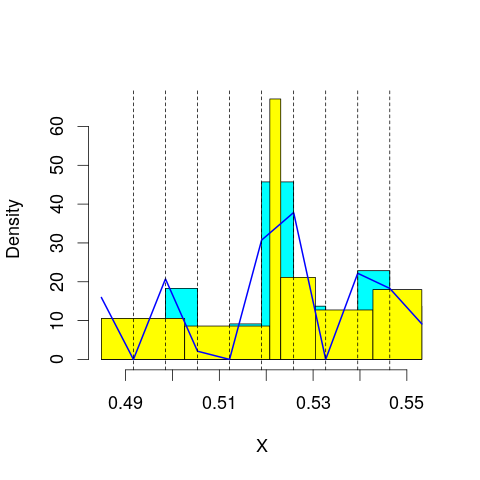

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.93339
mop.approx: Iteration 11. LL = 96.18958
mop.approx: Iteration 21. LL = 96.2605
mop.approx: Iteration 31. LL = 96.27054
mop.approx: Iteration 41. LL = 96.27326
mop.approx: Converged. Iteration 47. LL = 96.27408
[1] "Computing the linear combination of B-splines"


75.4796632829
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.48177
mop.approx: Iteration 11. LL = 93.68213
mop.approx: Iteration 21. LL = 93.75552
mop.approx: Iteration 31. LL = 93.7653
mop.approx: Iteration 41. LL = 93.7682
mop.approx: Converged. Iteration 46. LL = 93.76892
[1] "Computing the linear combination of B-splines"


71.2416370718
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.27276
mop.approx: Iteration 11. LL = 85.91838
mop.approx: Iteration 21. LL = 86.05875
mop.approx: Iteration 31. LL = 86.06602
mop.approx: Converged. Iteration 32. LL = 86.0662
[1] "Computing the linear combination of B-splines"


61.8060530189
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.08016
mop.approx: Iteration 11. LL = 84.01869
mop.approx: Iteration 21. LL = 84.09466
mop.approx: Iteration 31. LL = 84.1088
mop.approx: Iteration 41. LL = 84.11183
mop.approx: Converged. Iteration 44. LL = 84.11222
[1] "Computing the linear combination of B-splines"


58.1191997875
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.89383
mop.approx: Iteration 11. LL = 85.68653
mop.approx: Iteration 21. LL = 85.93043
mop.approx: Iteration 31. LL = 85.95396
mop.approx: Iteration 41. LL = 85.95688
mop.approx: Converged. Iteration 41. LL = 85.95697
[1] "Computing the linear combination of B-splines"


58.2304369136
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.432013
mop.approx: Iteration 11. LL = 84.43147
mop.approx: Iteration 21. LL = 84.4518
mop.approx: Converged. Iteration 23. LL = 84.45207
[1] "Computing the linear combination of B-splines"


55.0031867797
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.516864
mop.approx: Iteration 11. LL = 86.87946
mop.approx: Iteration 21. LL = 87.32752
mop.approx: Iteration 31. LL = 87.36704
mop.approx: Iteration 41. LL = 87.3707
mop.approx: Converged. Iteration 41. LL = 87.37078
[1] "Computing the linear combination of B-splines"


57.7159984919
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 85.39147
mop.approx: Iteration 11. LL = 96.47166
mop.approx: Iteration 21. LL = 96.48891
mop.approx: Converged. Iteration 26. LL = 96.48991
[1] "Computing the linear combination of B-splines"


75.6954958582
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 75.695495858232221)
m reached
('Sum of Probabilities:', 0.9865204201575049)
chosen


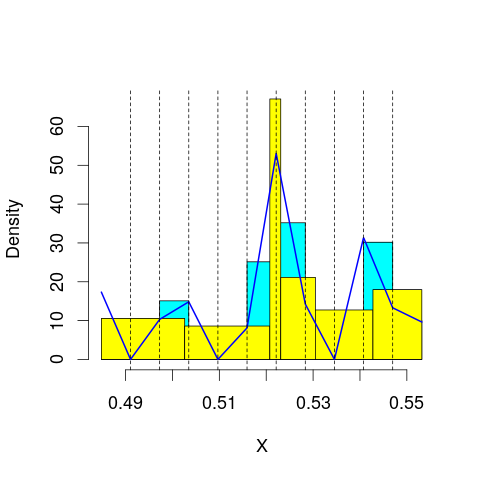

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.93339
mop.approx: Iteration 11. LL = 96.44259
mop.approx: Iteration 21. LL = 96.47305
mop.approx: Iteration 31. LL = 96.47761
mop.approx: Iteration 41. LL = 96.4792
mop.approx: Converged. Iteration 41. LL = 96.47929
[1] "Computing the linear combination of B-splines"


73.9520109182
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.48177
mop.approx: Iteration 11. LL = 94.89295
mop.approx: Iteration 21. LL = 94.93993
mop.approx: Iteration 31. LL = 94.94461
mop.approx: Converged. Iteration 34. LL = 94.94508
[1] "Computing the linear combination of B-splines"


70.6849327687
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.27276
mop.approx: Iteration 11. LL = 86.68196
mop.approx: Converged. Iteration 20. LL = 86.70311
[1] "Computing the linear combination of B-splines"


60.7100860195
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.08016
mop.approx: Iteration 11. LL = 86.18147
mop.approx: Iteration 21. LL = 86.3257
mop.approx: Iteration 31. LL = 86.35332
mop.approx: Iteration 41. LL = 86.3619
mop.approx: Iteration 51. LL = 86.36492
mop.approx: Converged. Iteration 58. LL = 86.36588
[1] "Computing the linear combination of B-splines"


58.6399896761
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.89383
mop.approx: Iteration 11. LL = 85.47667
mop.approx: Iteration 21. LL = 85.54702
mop.approx: Converged. Iteration 30. LL = 85.55058
[1] "Computing the linear combination of B-splines"


56.0914437527
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.432013
mop.approx: Iteration 11. LL = 86.74675
mop.approx: Iteration 21. LL = 86.99026
mop.approx: Iteration 31. LL = 87.0136
mop.approx: Iteration 41. LL = 87.0167
mop.approx: Converged. Iteration 42. LL = 87.01687
[1] "Computing the linear combination of B-splines"


55.8526362428
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.516864
mop.approx: Iteration 11. LL = 84.72423
mop.approx: Iteration 21. LL = 84.86324
mop.approx: Iteration 31. LL = 84.87562
mop.approx: Converged. Iteration 40. LL = 84.8774
[1] "Computing the linear combination of B-splines"


50.0897107121
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 85.39147
mop.approx: Iteration 11. LL = 96.22229
mop.approx: Iteration 21. LL = 96.23448
mop.approx: Converged. Iteration 29. LL = 96.23622
[1] "Computing the linear combination of B-splines"


73.7089333339
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 73.708933333933231)
m reached
('Sum of Probabilities:', 0.9856892355155957)
chosen


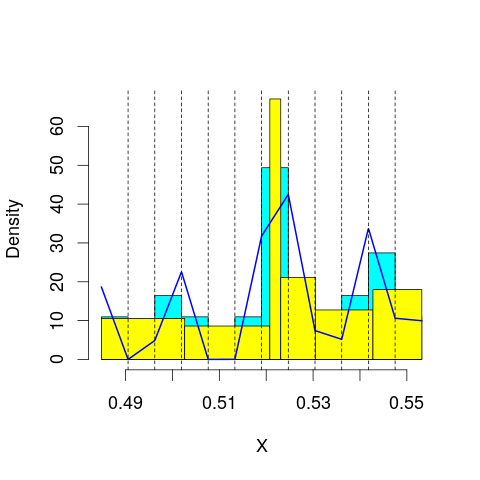

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.93339
mop.approx: Iteration 11. LL = 96.4331
mop.approx: Iteration 21. LL = 96.45429
mop.approx: Iteration 31. LL = 96.45897
mop.approx: Iteration 41. LL = 96.46093
mop.approx: Converged. Iteration 46. LL = 96.46158
[1] "Computing the linear combination of B-splines"


72.2014316052
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.48177
mop.approx: Iteration 11. LL = 95.88493
mop.approx: Iteration 21. LL = 95.95949
mop.approx: Iteration 31. LL = 95.96971
mop.approx: Iteration 41. LL = 95.97255
mop.approx: Converged. Iteration 47. LL = 95.9734
[1] "Computing the linear combination of B-splines"


69.9803838673
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.27276
mop.approx: Iteration 11. LL = 88.4814
mop.approx: Iteration 21. LL = 88.57614
mop.approx: Iteration 31. LL = 88.593
mop.approx: Iteration 41. LL = 88.5983
mop.approx: Iteration 51. LL = 88.60028
mop.approx: Converged. Iteration 54. LL = 88.60068
[1] "Computing the linear combination of B-splines"


60.8747967915
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.08016
mop.approx: Iteration 11. LL = 86.73257
mop.approx: Iteration 21. LL = 86.77808
mop.approx: Converged. Iteration 26. LL = 86.77928
[1] "Computing the linear combination of B-splines"


57.3205031459
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.89383
mop.approx: Iteration 11. LL = 86.98007
mop.approx: Iteration 21. LL = 87.09368
mop.approx: Iteration 31. LL = 87.10019
mop.approx: Converged. Iteration 34. LL = 87.10061
[1] "Computing the linear combination of B-splines"


55.9069700716
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.432013
mop.approx: Iteration 11. LL = 86.48442
mop.approx: Iteration 21. LL = 86.5822
mop.approx: Iteration 31. LL = 86.58806
mop.approx: Converged. Iteration 32. LL = 86.58825
[1] "Computing the linear combination of B-splines"


53.474705966
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.516864
[1] "Computing the linear combination of B-splines"


68.4475936312
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 85.39147
mop.approx: Iteration 11. LL = 98.09483
mop.approx: Iteration 21. LL = 98.10792
mop.approx: Converged. Iteration 22. LL = 98.10813
[1] "Computing the linear combination of B-splines"


73.8479827353
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 73.84798273532158)
m reached
('Sum of Probabilities:', 0.9850245843773157)
chosen


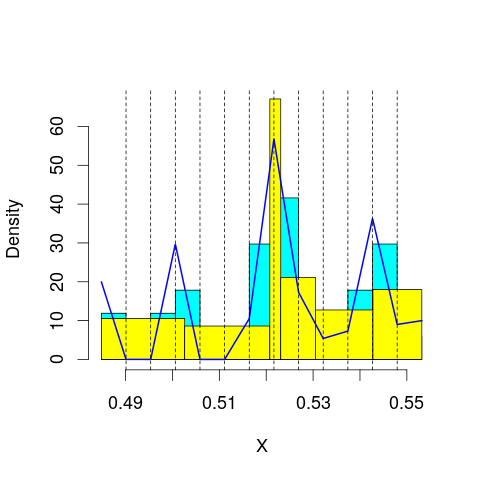

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.93339
mop.approx: Iteration 11. LL = 96.28654
mop.approx: Iteration 21. LL = 96.31727
mop.approx: Iteration 31. LL = 96.32288
mop.approx: Converged. Iteration 37. LL = 96.32391
[1] "Computing the linear combination of B-splines"


70.3308859007
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.48177
mop.approx: Iteration 11. LL = 96.93005
mop.approx: Iteration 21. LL = 96.98164
mop.approx: Iteration 31. LL = 96.98923
mop.approx: Iteration 41. LL = 96.99255
mop.approx: Iteration 51. LL = 96.99439
mop.approx: Converged. Iteration 58. LL = 96.9953
[1] "Computing the linear combination of B-splines"


69.2694150181
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.27276
mop.approx: Iteration 11. LL = 89.42457
mop.approx: Iteration 21. LL = 89.45666
mop.approx: Iteration 31. LL = 89.46028
mop.approx: Converged. Iteration 38. LL = 89.46123
[1] "Computing the linear combination of B-splines"


60.0024749637
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.08016
mop.approx: Iteration 11. LL = 88.18046
mop.approx: Iteration 21. LL = 88.27963
mop.approx: Iteration 31. LL = 88.29091
mop.approx: Iteration 41. LL = 88.29299
mop.approx: Converged. Iteration 41. LL = 88.29307
[1] "Computing the linear combination of B-splines"


57.1014147217
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.89383
mop.approx: Iteration 11. LL = 87.52498
mop.approx: Iteration 21. LL = 87.59856
mop.approx: Iteration 31. LL = 87.6067
mop.approx: Converged. Iteration 37. LL = 87.60769
[1] "Computing the linear combination of B-splines"


54.6826788855
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.432013
mop.approx: Iteration 11. LL = 88.57169
mop.approx: Iteration 21. LL = 88.71351
mop.approx: Iteration 31. LL = 88.72955
mop.approx: Iteration 41. LL = 88.73431
mop.approx: Iteration 51. LL = 88.7363
mop.approx: Converged. Iteration 57. LL = 88.73706
[1] "Computing the linear combination of B-splines"


53.8860237275
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.516864
[1] "Computing the linear combination of B-splines"


58.7977272281
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 85.39147
mop.approx: Iteration 11. LL = 97.36284
mop.approx: Iteration 21. LL = 97.38132
mop.approx: Iteration 31. LL = 97.38398
mop.approx: Converged. Iteration 31. LL = 97.38408
[1] "Computing the linear combination of B-splines"


71.3910563709
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 71.391056370931466)
m reached
('Sum of Probabilities:', 0.9844501349233473)
chosen


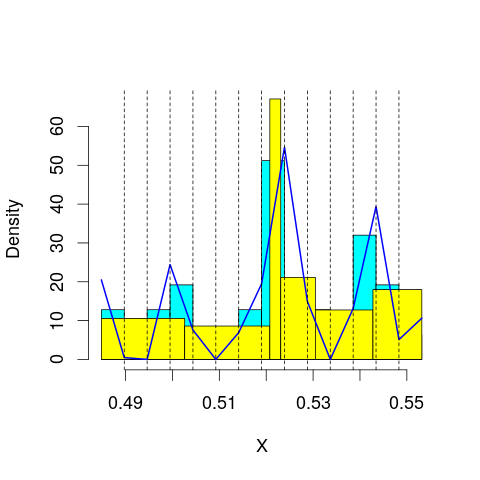

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.93339
mop.approx: Iteration 11. LL = 97.27382
mop.approx: Iteration 21. LL = 97.28873
mop.approx: Iteration 31. LL = 97.29156
mop.approx: Converged. Iteration 37. LL = 97.29238
[1] "Computing the linear combination of B-splines"


69.5664965568
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.48177
mop.approx: Iteration 11. LL = 96.64383
mop.approx: Iteration 21. LL = 96.71856
mop.approx: Iteration 31. LL = 96.73052
mop.approx: Iteration 41. LL = 96.73415
mop.approx: Converged. Iteration 50. LL = 96.73552
[1] "Computing the linear combination of B-splines"


67.2767658531
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.27276
mop.approx: Iteration 11. LL = 91.01466
mop.approx: Iteration 21. LL = 91.04147
mop.approx: Converged. Iteration 27. LL = 91.04277
[1] "Computing the linear combination of B-splines"


59.8511481601
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.08016
mop.approx: Iteration 11. LL = 88.7636
mop.approx: Iteration 21. LL = 88.85119
mop.approx: Iteration 31. LL = 88.86774
mop.approx: Iteration 41. LL = 88.87344
mop.approx: Iteration 51. LL = 88.8759
mop.approx: Converged. Iteration 60. LL = 88.87709
[1] "Computing the linear combination of B-splines"


55.9525045652
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.89383
mop.approx: Iteration 11. LL = 88.45855
mop.approx: Iteration 21. LL = 88.55429
mop.approx: Iteration 31. LL = 88.56894
mop.approx: Iteration 41. LL = 88.57194
mop.approx: Converged. Iteration 44. LL = 88.57234
[1] "Computing the linear combination of B-splines"


53.9121858848
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.432013
mop.approx: Iteration 11. LL = 88.21075
mop.approx: Iteration 21. LL = 88.29672
mop.approx: Iteration 31. LL = 88.31436
mop.approx: Iteration 41. LL = 88.32012
mop.approx: Iteration 51. LL = 88.32243
mop.approx: Converged. Iteration 57. LL = 88.32321
[1] "Computing the linear combination of B-splines"


51.9612455027
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.516864
[1] "Computing the linear combination of B-splines"


50.2957334855
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 85.39147
mop.approx: Iteration 11. LL = 98.0253
mop.approx: Iteration 21. LL = 98.04134
mop.approx: Iteration 31. LL = 98.04403
mop.approx: Converged. Iteration 33. LL = 98.04433
[1] "Computing the linear combination of B-splines"


70.3184421349
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 70.318442134870239)
m reached
('Sum of Probabilities:', 0.9857750188313174)
chosen


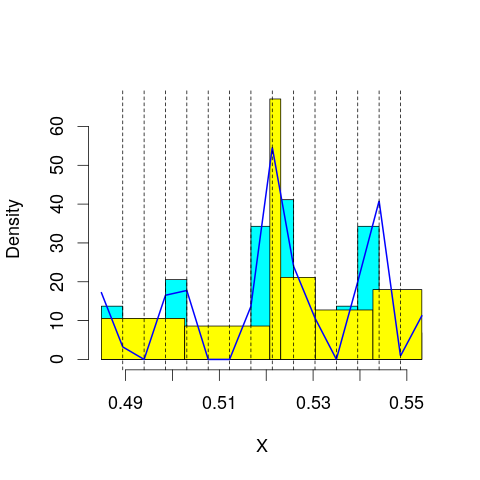

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.93339
mop.approx: Iteration 11. LL = 97.58757
mop.approx: Iteration 21. LL = 97.60846
mop.approx: Iteration 31. LL = 97.61139
mop.approx: Converged. Iteration 35. LL = 97.61198
[1] "Computing the linear combination of B-splines"


68.1532259251
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.48177
mop.approx: Iteration 11. LL = 96.78309
mop.approx: Iteration 21. LL = 96.85732
mop.approx: Iteration 31. LL = 96.86535
mop.approx: Iteration 41. LL = 96.86728
mop.approx: Converged. Iteration 41. LL = 96.86738
[1] "Computing the linear combination of B-splines"


65.6757542527
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.27276
mop.approx: Iteration 11. LL = 92.01841
mop.approx: Iteration 21. LL = 92.07924
mop.approx: Iteration 31. LL = 92.08722
mop.approx: Iteration 41. LL = 92.0895
mop.approx: Converged. Iteration 45. LL = 92.09004
[1] "Computing the linear combination of B-splines"


59.1655547318
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.08016
mop.approx: Iteration 11. LL = 89.63669
mop.approx: Iteration 21. LL = 89.65485
mop.approx: Converged. Iteration 23. LL = 89.6552
[1] "Computing the linear combination of B-splines"


54.9977863208
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.89383
mop.approx: Iteration 11. LL = 89.01491
mop.approx: Iteration 21. LL = 89.08855
mop.approx: Iteration 31. LL = 89.09776
mop.approx: Iteration 41. LL = 89.10042
mop.approx: Converged. Iteration 49. LL = 89.10145
[1] "Computing the linear combination of B-splines"


52.7104528419
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.432013
mop.approx: Iteration 11. LL = 89.19182
mop.approx: Iteration 21. LL = 89.24929
mop.approx: Iteration 31. LL = 89.25767
mop.approx: Iteration 41. LL = 89.26061
mop.approx: Iteration 51. LL = 89.26197
mop.approx: Converged. Iteration 52. LL = 89.26215
[1] "Computing the linear combination of B-splines"


50.5606131701
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.516864
[1] "Computing the linear combination of B-splines"


24.4722178861
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 85.39147
mop.approx: Iteration 11. LL = 98.63373
mop.approx: Iteration 21. LL = 98.6482
mop.approx: Converged. Iteration 23. LL = 98.64853
[1] "Computing the linear combination of B-splines"


69.189777395
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 69.189777394979615)
m reached
('Sum of Probabilities:', 0.9864791420700878)
chosen


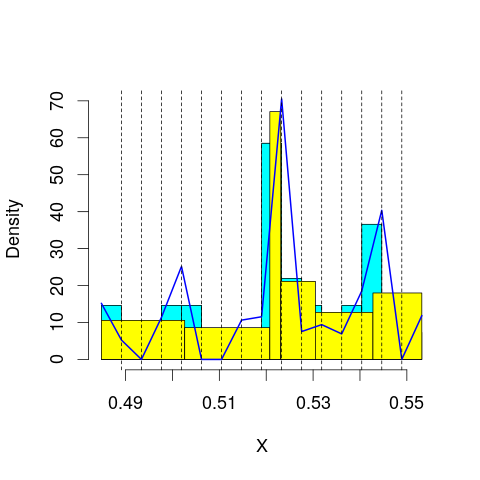

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.93339
mop.approx: Iteration 11. LL = 97.67616
mop.approx: Iteration 21. LL = 97.70773
mop.approx: Converged. Iteration 30. LL = 97.71048
[1] "Computing the linear combination of B-splines"


66.5188604426
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.48177
mop.approx: Iteration 11. LL = 97.18614
mop.approx: Iteration 21. LL = 97.30133
mop.approx: Iteration 31. LL = 97.32274
mop.approx: Iteration 41. LL = 97.32947
mop.approx: Iteration 51. LL = 97.33235
mop.approx: Iteration 61. LL = 97.33375
mop.approx: Converged. Iteration 61. LL = 97.33385
[1] "Computing the linear combination of B-splines"


64.4093594487
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.27276
mop.approx: Iteration 11. LL = 92.16108
mop.approx: Iteration 21. LL = 92.20984
mop.approx: Iteration 31. LL = 92.21786
mop.approx: Iteration 41. LL = 92.22105
mop.approx: Iteration 51. LL = 92.22276
mop.approx: Converged. Iteration 58. LL = 92.22362
[1] "Computing the linear combination of B-splines"


57.5662567688
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.08016
mop.approx: Iteration 11. LL = 90.88328
mop.approx: Iteration 21. LL = 90.90675
mop.approx: Iteration 31. LL = 90.90922
mop.approx: Iteration 41. LL = 90.91045
mop.approx: Converged. Iteration 43. LL = 90.91074
[1] "Computing the linear combination of B-splines"


54.5204624743
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.89383
mop.approx: Iteration 11. LL = 89.3771
mop.approx: Iteration 21. LL = 89.4449
mop.approx: Iteration 31. LL = 89.45672
mop.approx: Iteration 41. LL = 89.46062
mop.approx: Iteration 51. LL = 89.46224
mop.approx: Converged. Iteration 53. LL = 89.46253
[1] "Computing the linear combination of B-splines"


51.3405046527
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.432013
mop.approx: Iteration 11. LL = 89.68985
mop.approx: Iteration 21. LL = 89.7146
mop.approx: Iteration 31. LL = 89.71968
mop.approx: Iteration 41. LL = 89.72155
mop.approx: Converged. Iteration 44. LL = 89.72193
[1] "Computing the linear combination of B-splines"


49.6382123743
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.516864
[1] "Computing the linear combination of B-splines"


-12.1930182923
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 85.39147
mop.approx: Iteration 11. LL = 98.15876
mop.approx: Iteration 21. LL = 98.19223
mop.approx: Iteration 31. LL = 98.19697
mop.approx: Converged. Iteration 38. LL = 98.19816
[1] "Computing the linear combination of B-splines"


67.0065352628
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 67.006535262824443)
m reached
('Sum of Probabilities:', 0.986783749269798)
chosen


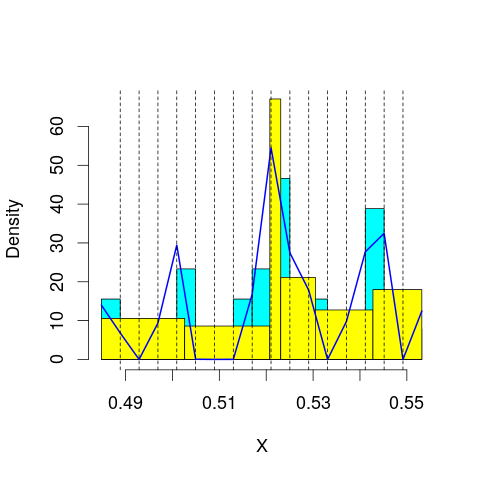

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.93339
mop.approx: Iteration 11. LL = 98.36767
mop.approx: Iteration 21. LL = 98.40683
mop.approx: Iteration 31. LL = 98.41456
mop.approx: Iteration 41. LL = 98.4172
mop.approx: Converged. Iteration 47. LL = 98.41808
[1] "Computing the linear combination of B-splines"


65.4935870834
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.48177
mop.approx: Iteration 11. LL = 97.19136
mop.approx: Iteration 21. LL = 97.31273
mop.approx: Iteration 31. LL = 97.34091
mop.approx: Iteration 41. LL = 97.34844
mop.approx: Iteration 51. LL = 97.35041
mop.approx: Converged. Iteration 51. LL = 97.3505
[1] "Computing the linear combination of B-splines"


62.6931425493
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.27276
mop.approx: Iteration 11. LL = 92.47711
mop.approx: Iteration 21. LL = 92.55286
mop.approx: Iteration 31. LL = 92.58215
mop.approx: Iteration 41. LL = 92.59585
mop.approx: Iteration 51. LL = 92.60304
mop.approx: Iteration 61. LL = 92.6071
mop.approx: Iteration 71. LL = 92.60952
mop.approx: Iteration 81. LL = 92.61101
mop.approx: Converged. Iteration 86. LL = 92.61163
[1] "Computing the linear combination of B-splines"


56.2214049216
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.08016
mop.approx: Iteration 11. LL = 91.88183
mop.approx: Iteration 21. LL = 91.97966
mop.approx: Iteration 31. LL = 91.99206
mop.approx: Iteration 41. LL = 91.99441
mop.approx: Converged. Iteration 41. LL = 91.9945
[1] "Computing the linear combination of B-splines"


53.8713915938
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.89383
mop.approx: Iteration 11. LL = 89.96053
mop.approx: Iteration 21. LL = 89.97515
mop.approx: Iteration 31. LL = 89.97668
mop.approx: Converged. Iteration 32. LL = 89.97687
[1] "Computing the linear combination of B-splines"


50.1224143214
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.432013
mop.approx: Iteration 11. LL = 91.13475
mop.approx: Iteration 21. LL = 91.16824
mop.approx: Iteration 31. LL = 91.17198
mop.approx: Iteration 41. LL = 91.17364
mop.approx: Converged. Iteration 45. LL = 91.17415
[1] "Computing the linear combination of B-splines"


49.1330811001
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.516864
[1] "Computing the linear combination of B-splines"


97.57920286
('best: ', 67.006535262824443, 'accepted difference:', 113.91110994680156, 'cur BIC:', 97.579202860033973)
m reached
('Sum of Probabilities:', 6.626407981967186)
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 85.39147
mop.approx: Iteration 11. LL = 99.57231
mop.approx: Iteration 21. LL = 99.59007
mop.approx: Converged. Iteration 24. LL = 99.59057
[1] "Computing the linear combination of B-splines"


66.666077076
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 66.666077075996583)
m reached
('Sum of Probabilities:', 0.9868758484409637)
chosen


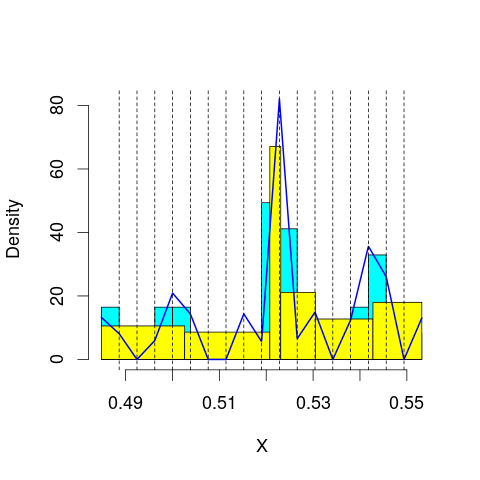

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.93339
mop.approx: Iteration 11. LL = 97.99006
mop.approx: Iteration 21. LL = 97.99842
mop.approx: Converged. Iteration 24. LL = 97.99886
[1] "Computing the linear combination of B-splines"


63.3415039243
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.48177
mop.approx: Iteration 11. LL = 97.84049
mop.approx: Iteration 21. LL = 98.03086
mop.approx: Iteration 31. LL = 98.07589
mop.approx: Iteration 41. LL = 98.09192
mop.approx: Iteration 51. LL = 98.09797
mop.approx: Iteration 61. LL = 98.10036
mop.approx: Converged. Iteration 66. LL = 98.10107
[1] "Computing the linear combination of B-splines"


61.7108459333
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.27276
mop.approx: Iteration 11. LL = 92.54595
mop.approx: Iteration 21. LL = 92.55538
mop.approx: Iteration 31. LL = 92.55908
mop.approx: Iteration 41. LL = 92.56124
mop.approx: Iteration 51. LL = 92.56258
mop.approx: Converged. Iteration 54. LL = 92.56296
[1] "Computing the linear combination of B-splines"


54.4398668529
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.08016
mop.approx: Iteration 11. LL = 92.43848
mop.approx: Iteration 21. LL = 92.60901
mop.approx: Iteration 31. LL = 92.6641
mop.approx: Iteration 41. LL = 92.68907
mop.approx: Iteration 51. LL = 92.7016
mop.approx: Iteration 61. LL = 92.70825
mop.approx: Iteration 71. LL = 92.71189
mop.approx: Iteration 81. LL = 92.71393
mop.approx: Converged. Iteration 90. LL = 92.71509
[1] "Computing the linear combination of B-splines"


52.8588271357
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.89383
mop.approx: Iteration 11. LL = 90.86441
mop.approx: Iteration 21. LL = 90.91195
mop.approx: Iteration 31. LL = 90.92228
mop.approx: Iteration 41. LL = 90.92552
mop.approx: Converged. Iteration 46. LL = 90.92623
[1] "Computing the linear combination of B-splines"


49.3161839603
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.432013
mop.approx: Iteration 11. LL = 93.17889
mop.approx: Iteration 21. LL = 93.29221
mop.approx: Iteration 31. LL = 93.30698
mop.approx: Iteration 41. LL = 93.31096
mop.approx: Iteration 51. LL = 93.31262
mop.approx: Converged. Iteration 54. LL = 93.31302
[1] "Computing the linear combination of B-splines"


49.9371614073
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.516864
[1] "Computing the linear combination of B-splines"


-20.5471570183
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 85.39147
mop.approx: Iteration 11. LL = 99.06574
mop.approx: Iteration 21. LL = 99.0837
mop.approx: Iteration 31. LL = 99.08712
mop.approx: Converged. Iteration 36. LL = 99.08788
[1] "Computing the linear combination of B-splines"


64.4305254324
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 64.43052543241302)
m reached
('Sum of Probabilities:', 0.9864064053380859)
chosen


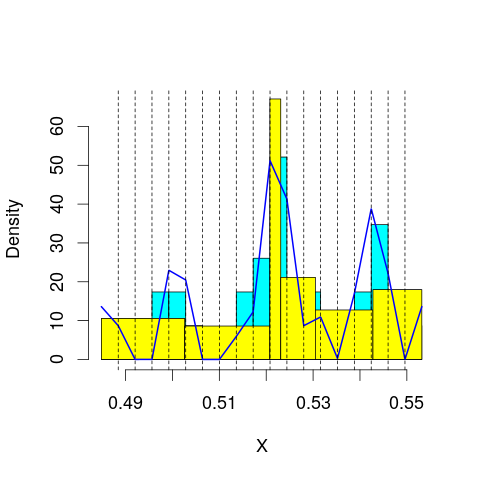

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.93339
mop.approx: Iteration 11. LL = 99.1352
mop.approx: Iteration 21. LL = 99.23276
mop.approx: Iteration 31. LL = 99.24956
mop.approx: Iteration 41. LL = 99.25534
mop.approx: Iteration 51. LL = 99.25798
mop.approx: Iteration 61. LL = 99.25937
mop.approx: Converged. Iteration 62. LL = 99.25956
[1] "Computing the linear combination of B-splines"


62.8693333738
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.48177
mop.approx: Iteration 11. LL = 97.32652
mop.approx: Iteration 21. LL = 97.38042
mop.approx: Iteration 31. LL = 97.39596
mop.approx: Iteration 41. LL = 97.40422
mop.approx: Iteration 51. LL = 97.40852
mop.approx: Iteration 61. LL = 97.41059
mop.approx: Converged. Iteration 65. LL = 97.41115
[1] "Computing the linear combination of B-splines"


59.2880571054
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.27276
mop.approx: Iteration 11. LL = 93.40394
mop.approx: Iteration 21. LL = 93.59768
mop.approx: Iteration 31. LL = 93.64341
mop.approx: Iteration 41. LL = 93.65996
mop.approx: Iteration 51. LL = 93.66726
mop.approx: Iteration 61. LL = 93.67084
mop.approx: Iteration 71. LL = 93.67273
mop.approx: Converged. Iteration 78. LL = 93.67362
[1] "Computing the linear combination of B-splines"


53.8176538846
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.08016
mop.approx: Iteration 11. LL = 92.41952
mop.approx: Iteration 21. LL = 92.44002
mop.approx: Iteration 31. LL = 92.44671
mop.approx: Iteration 41. LL = 92.45118
mop.approx: Iteration 51. LL = 92.45427
mop.approx: Iteration 61. LL = 92.45644
mop.approx: Iteration 71. LL = 92.45799
mop.approx: Iteration 81. LL = 92.45911
mop.approx: Converged. Iteration 82. LL = 92.4593
[1] "Computing the linear combination of B-splines"


50.8705904454
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.89383
mop.approx: Iteration 11. LL = 92.11005
mop.approx: Iteration 21. LL = 92.31044
mop.approx: Iteration 31. LL = 92.37403
mop.approx: Iteration 41. LL = 92.40426
mop.approx: Iteration 51. LL = 92.42027
mop.approx: Iteration 61. LL = 92.42921
mop.approx: Iteration 71. LL = 92.4344
mop.approx: Iteration 81. LL = 92.43751
mop.approx: Iteration 91. LL = 92.43944
mop.approx: Iteration 101. LL = 92.44069
mop.approx: Converged. Iteration 103. LL = 92.44097
[1] "Computing the linear combination of B-splines"


49.1177908503
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.432013
[1] "Computing the linear combination of B-splines"


57.1443999232
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.516864
[1] "Computing the linear combination of B-splines"


24.9798147414
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 85.39147
mop.approx: Iteration 11. LL = 100.6087
mop.approx: Iteration 21. LL = 100.6318
mop.approx: Iteration 31. LL = 100.6353
mop.approx: Converged. Iteration 37. LL = 100.6363
[1] "Computing the linear combination of B-splines"


64.2460399087
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 64.246039908701917)
m reached
('Sum of Probabilities:', 0.9858528982229898)
chosen


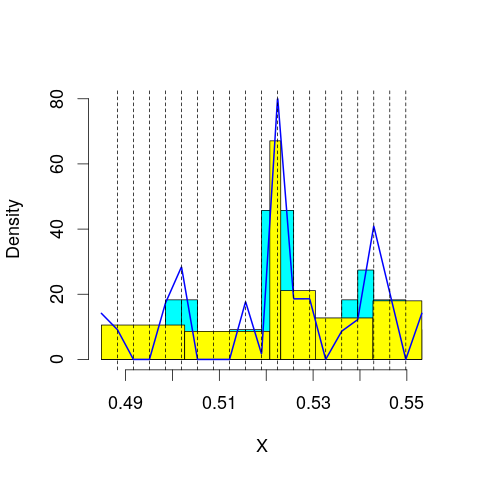

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.93339
mop.approx: Iteration 11. LL = 98.11579
mop.approx: Iteration 21. LL = 98.1527
mop.approx: Iteration 31. LL = 98.1635
mop.approx: Iteration 41. LL = 98.1672
mop.approx: Converged. Iteration 47. LL = 98.16818
[1] "Computing the linear combination of B-splines"


60.0450825812
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.48177
mop.approx: Iteration 11. LL = 98.60956
mop.approx: Iteration 21. LL = 98.76605
mop.approx: Iteration 31. LL = 98.79714
mop.approx: Iteration 41. LL = 98.80886
mop.approx: Iteration 51. LL = 98.81477
mop.approx: Iteration 61. LL = 98.81813
mop.approx: Iteration 71. LL = 98.82016
mop.approx: Iteration 81. LL = 98.82142
mop.approx: Converged. Iteration 81. LL = 98.82152
[1] "Computing the linear combination of B-splines"


58.9655570583
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.27276
mop.approx: Iteration 11. LL = 92.82919
mop.approx: Iteration 21. LL = 92.92536
mop.approx: Iteration 31. LL = 92.94701
mop.approx: Iteration 41. LL = 92.95382
mop.approx: Iteration 51. LL = 92.95657
mop.approx: Iteration 61. LL = 92.95793
mop.approx: Converged. Iteration 63. LL = 92.95821
[1] "Computing the linear combination of B-splines"


51.3693825924
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.08016
mop.approx: Iteration 11. LL = 93.31236
mop.approx: Iteration 21. LL = 93.5067
mop.approx: Iteration 31. LL = 93.57743
mop.approx: Iteration 41. LL = 93.60634
mop.approx: Iteration 51. LL = 93.61901
mop.approx: Iteration 61. LL = 93.62492
mop.approx: Iteration 71. LL = 93.62781
mop.approx: Iteration 81. LL = 93.62928
mop.approx: Converged. Iteration 83. LL = 93.62956
[1] "Computing the linear combination of B-splines"


50.3076354484
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.89383
mop.approx: Iteration 11. LL = 92.11009
mop.approx: Iteration 21. LL = 92.23188
mop.approx: Iteration 31. LL = 92.25535
mop.approx: Iteration 41. LL = 92.26453
mop.approx: Iteration 51. LL = 92.26939
mop.approx: Iteration 61. LL = 92.27235
mop.approx: Iteration 71. LL = 92.27432
mop.approx: Iteration 81. LL = 92.27573
mop.approx: Iteration 91. LL = 92.27678
mop.approx: Converged. Iteration 91. LL = 92.27687
[1] "Computing the linear combination of B-splines"


47.1869499013
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.432013
mop.approx: Iteration 11. LL = 91.51196
mop.approx: Iteration 21. LL = 91.65507
mop.approx: Iteration 31. LL = 91.6717
mop.approx: Iteration 41. LL = 91.67655
mop.approx: Iteration 51. LL = 91.67847
mop.approx: Converged. Iteration 54. LL = 91.67888
[1] "Computing the linear combination of B-splines"


42.9367363993
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.516864
[1] "Computing the linear combination of B-splines"


-73.7561189173
lfps_23
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.83023
mop.approx: Iteration 11. LL = 60.00175
mop.approx: Converged. Iteration 13. LL = 60.00205
[1] "Computing the linear combination of B-splines"


54.8034494719
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 54.803449471873954)
m reached
('Sum of Probabilities:', 0.9910772914344105)
chosen


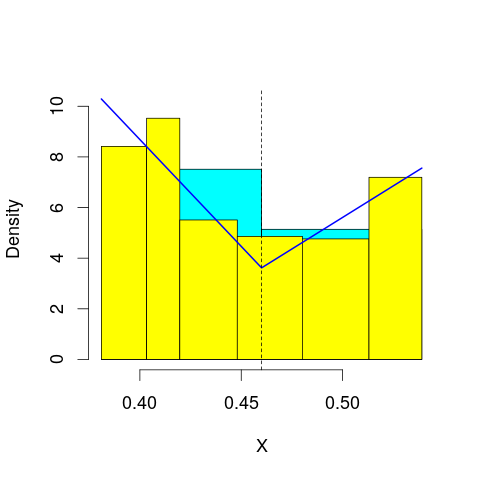

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.62968
mop.approx: Iteration 11. LL = 60.01606
mop.approx: Iteration 21. LL = 60.06061
mop.approx: Iteration 31. LL = 60.07007
mop.approx: Iteration 41. LL = 60.07264
mop.approx: Converged. Iteration 48. LL = 60.07334
[1] "Computing the linear combination of B-splines"


53.1418634302
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.43038
mop.approx: Iteration 11. LL = 59.88264
mop.approx: Iteration 21. LL = 59.9073
mop.approx: Iteration 31. LL = 59.91797
mop.approx: Iteration 41. LL = 59.92423
mop.approx: Iteration 51. LL = 59.92809
mop.approx: Iteration 61. LL = 59.93054
mop.approx: Iteration 71. LL = 59.93215
mop.approx: Iteration 81. LL = 59.93324
mop.approx: Iteration 91. LL = 59.934
mop.approx: Converged. Iteration 92. LL = 59.93412
[1] "Computing the linear combination of B-splines"


51.2697824152
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.66497
mop.approx: Iteration 11. LL = 46.19426
mop.approx: Converged. Iteration 13. LL = 46.19445
[1] "Computing the linear combination of B-splines"


35.7972465441
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.39047
mop.approx: Iteration 11. LL = 48.17264
mop.approx: Iteration 21. LL = 48.34791
mop.approx: Converged. Iteration 28. LL = 48.34998
[1] "Computing the linear combination of B-splines"


36.2199065724
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.863571
mop.approx: Iteration 11. LL = 43.5521
mop.approx: Converged. Iteration 20. LL = 43.5558
[1] "Computing the linear combination of B-splines"


29.6928540831
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.898427
mop.approx: Iteration 11. LL = 45.54965
mop.approx: Iteration 21. LL = 45.78832
mop.approx: Converged. Iteration 30. LL = 45.79188
[1] "Computing the linear combination of B-splines"


30.1960714512
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.370881
mop.approx: Iteration 11. LL = 41.27178
mop.approx: Iteration 21. LL = 41.2866
mop.approx: Converged. Iteration 30. LL = 41.28787
[1] "Computing the linear combination of B-splines"


23.959192091
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.83023
mop.approx: Converged. Iteration 10. LL = 60.24122
[1] "Computing the linear combination of B-splines"


53.3097442387
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 53.309744238692652)
m reached
('Sum of Probabilities:', 0.990563693847447)
chosen


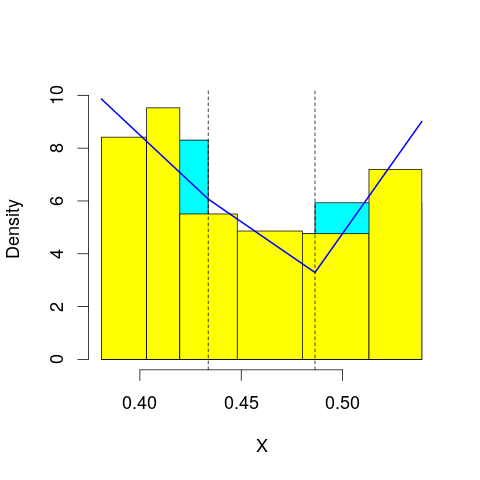

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.62968
mop.approx: Iteration 11. LL = 60.21129
mop.approx: Iteration 21. LL = 60.21627
mop.approx: Converged. Iteration 23. LL = 60.21649
[1] "Computing the linear combination of B-splines"


51.5521544829
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.43038
mop.approx: Iteration 11. LL = 60.15827
mop.approx: Iteration 21. LL = 60.19318
mop.approx: Iteration 31. LL = 60.20992
mop.approx: Iteration 41. LL = 60.21862
mop.approx: Iteration 51. LL = 60.2233
mop.approx: Iteration 61. LL = 60.22591
mop.approx: Iteration 71. LL = 60.22741
mop.approx: Iteration 81. LL = 60.22829
mop.approx: Converged. Iteration 83. LL = 60.22847
[1] "Computing the linear combination of B-splines"


49.8312656514
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.66497
mop.approx: Iteration 11. LL = 48.34511
mop.approx: Iteration 21. LL = 48.60051
mop.approx: Iteration 31. LL = 48.65759
mop.approx: Iteration 41. LL = 48.67783
mop.approx: Iteration 51. LL = 48.68704
mop.approx: Iteration 61. LL = 48.69192
mop.approx: Iteration 71. LL = 48.69479
mop.approx: Iteration 81. LL = 48.6966
mop.approx: Iteration 91. LL = 48.6978
mop.approx: Iteration 101. LL = 48.69864
mop.approx: Iteration 111. LL = 48.69924
mop.approx: Converged. Iteration 113. LL = 48.69939
[1] "Computing the linear combination of B-splines"


36.5693120319
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.39047
mop.approx: Iteration 11. LL = 48.53076
mop.approx: Converged. Iteration 16. LL = 48.53467
[1] "Computing the linear combination of B-splines"


34.6717280028
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.863571
mop.approx: Iteration 11. LL = 48.90432
mop.approx: Iteration 21. LL = 49.35566
mop.approx: Iteration 31. LL = 49.38091
mop.approx: Converged. Iteration 40. LL = 49.38264
[1] "Computing the linear combination of B-splines"


33.7868279121
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.898427
mop.approx: Iteration 11. LL = 45.92824
mop.approx: Converged. Iteration 17. LL = 45.93256
[1] "Computing the linear combination of B-splines"


28.6038761394
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.370881
mop.approx: Iteration 11. LL = 47.03789
mop.approx: Iteration 21. LL = 47.43318
mop.approx: Iteration 31. LL = 47.44601
mop.approx: Converged. Iteration 35. LL = 47.44641
[1] "Computing the linear combination of B-splines"


28.3848619665
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.83023
mop.approx: Converged. Iteration 8. LL = 60.35841
[1] "Computing the linear combination of B-splines"


51.69406848
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 51.694068480008255)
m reached
('Sum of Probabilities:', 0.9913022380624252)
chosen


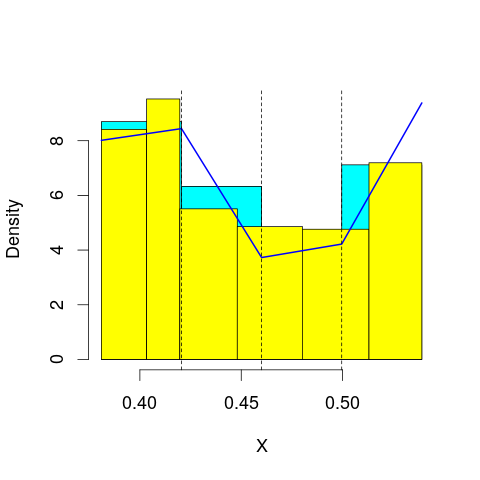

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.62968
mop.approx: Iteration 11. LL = 60.37816
mop.approx: Iteration 21. LL = 60.38243
mop.approx: Converged. Iteration 22. LL = 60.38254
[1] "Computing the linear combination of B-splines"


49.9853321989
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.43038
mop.approx: Iteration 11. LL = 60.40268
mop.approx: Iteration 21. LL = 60.49039
mop.approx: Iteration 31. LL = 60.53284
mop.approx: Iteration 41. LL = 60.55608
mop.approx: Iteration 51. LL = 60.56978
mop.approx: Iteration 61. LL = 60.57835
mop.approx: Iteration 71. LL = 60.58396
mop.approx: Iteration 81. LL = 60.58774
mop.approx: Iteration 91. LL = 60.59036
mop.approx: Iteration 101. LL = 60.59221
mop.approx: Iteration 111. LL = 60.59352
mop.approx: Iteration 121. LL = 60.59447
mop.approx: Converged. Iteration 129. LL = 60.59509
[1] "Computing the linear combination of B-splines"


48.4650129333
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.66497
mop.approx: Iteration 11. LL = 49.23621
mop.approx: Iteration 21. LL = 49.3953
mop.approx: Iteration 31. LL = 49.41588
mop.approx: Iteration 41. LL = 49.4191
mop.approx: Converged. Iteration 46. LL = 49.41951
[1] "Computing the linear combination of B-splines"


35.5565665051
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.39047
mop.approx: Iteration 11. LL = 48.57695
mop.approx: Iteration 21. LL = 48.58054
mop.approx: Converged. Iteration 21. LL = 48.58059
[1] "Computing the linear combination of B-splines"


32.9847753008
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.863571
mop.approx: Iteration 11. LL = 49.56708
mop.approx: Iteration 21. LL = 49.61553
mop.approx: Converged. Iteration 24. LL = 49.61596
[1] "Computing the linear combination of B-splines"


32.2872755648
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.898427
mop.approx: Iteration 11. LL = 48.71569
mop.approx: Iteration 21. LL = 49.34267
mop.approx: Iteration 31. LL = 49.4594
mop.approx: Iteration 41. LL = 49.48625
mop.approx: Iteration 51. LL = 49.494
mop.approx: Iteration 61. LL = 49.4966
mop.approx: Iteration 71. LL = 49.49752
mop.approx: Converged. Iteration 72. LL = 49.49762
[1] "Computing the linear combination of B-splines"


30.436067899
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.370881
mop.approx: Iteration 11. LL = 47.58767
mop.approx: Converged. Iteration 19. LL = 47.60222
[1] "Computing the linear combination of B-splines"


26.8078030658
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.83023
mop.approx: Converged. Iteration 9. LL = 60.48669
[1] "Computing the linear combination of B-splines"


50.089485399
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 50.089485399008026)
m reached
('Sum of Probabilities:', 0.9917369146318697)
chosen


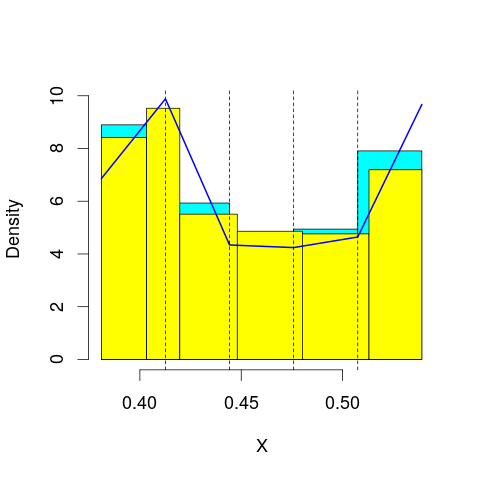

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.62968
mop.approx: Iteration 11. LL = 60.46614
mop.approx: Converged. Iteration 18. LL = 60.46773
[1] "Computing the linear combination of B-splines"


48.3376506808
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.43038
mop.approx: Iteration 11. LL = 61.06163
mop.approx: Iteration 21. LL = 61.15105
mop.approx: Iteration 31. LL = 61.15982
mop.approx: Converged. Iteration 37. LL = 61.16063
[1] "Computing the linear combination of B-splines"


47.2976819557
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.66497
mop.approx: Iteration 11. LL = 52.99157
mop.approx: Iteration 21. LL = 53.24125
mop.approx: Iteration 31. LL = 53.26424
mop.approx: Iteration 41. LL = 53.26759
mop.approx: Converged. Iteration 46. LL = 53.26804
[1] "Computing the linear combination of B-splines"


37.6722283014
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.39047
mop.approx: Iteration 11. LL = 48.92738
mop.approx: Iteration 21. LL = 48.97885
mop.approx: Iteration 31. LL = 48.98824
mop.approx: Iteration 41. LL = 48.99019
mop.approx: Converged. Iteration 45. LL = 48.99048
[1] "Computing the linear combination of B-splines"


31.661801628
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.863571
mop.approx: Iteration 11. LL = 50.02797
mop.approx: Iteration 21. LL = 50.06142
mop.approx: Converged. Iteration 30. LL = 50.06332
[1] "Computing the linear combination of B-splines"


31.001768851
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.898427
mop.approx: Iteration 11. LL = 49.56008
mop.approx: Iteration 21. LL = 49.75135
mop.approx: Iteration 31. LL = 49.77298
mop.approx: Iteration 41. LL = 49.77693
mop.approx: Converged. Iteration 49. LL = 49.77771
[1] "Computing the linear combination of B-splines"


28.9832949974
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.370881
mop.approx: Iteration 11. LL = 48.47081
mop.approx: Iteration 21. LL = 48.77134
mop.approx: Iteration 31. LL = 48.86396
mop.approx: Iteration 41. LL = 48.90133
mop.approx: Iteration 51. LL = 48.91942
mop.approx: Iteration 61. LL = 48.92931
mop.approx: Iteration 71. LL = 48.93518
mop.approx: Iteration 81. LL = 48.93886
mop.approx: Iteration 91. LL = 48.94126
mop.approx: Iteration 101. LL = 48.94286
mop.approx: Iteration 111. LL = 48.94396
mop.approx: Iteration 121. LL = 48.94473
mop.approx: Converged. Iteration 128. LL = 48.94516
[1] "Computing the linear combination of B-splines"


26.4178817564
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.83023
mop.approx: Iteration 11. LL = 60.78376
mop.approx: Converged. Iteration 16. LL = 60.78498
[1] "Computing the linear combination of B-splines"


48.6549054581
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 48.65490545810691)
m reached
('Sum of Probabilities:', 0.992471643810644)
chosen


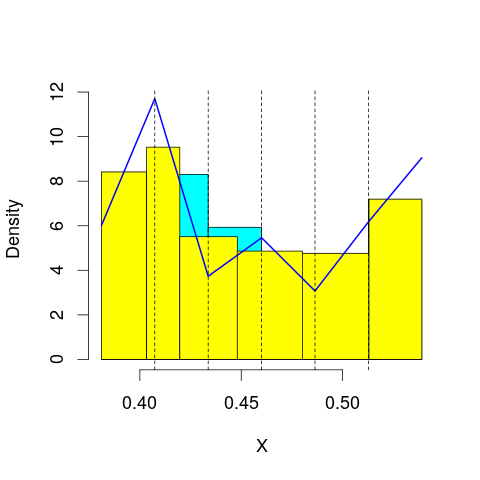

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.62968
mop.approx: Iteration 11. LL = 60.93314
mop.approx: Iteration 21. LL = 61.01496
mop.approx: Iteration 31. LL = 61.03899
mop.approx: Iteration 41. LL = 61.04706
mop.approx: Iteration 51. LL = 61.04991
mop.approx: Iteration 61. LL = 61.05094
mop.approx: Converged. Iteration 61. LL = 61.051
[1] "Computing the linear combination of B-splines"


47.1880518714
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.43038
mop.approx: Iteration 11. LL = 61.84072
mop.approx: Iteration 21. LL = 61.93647
mop.approx: Iteration 31. LL = 61.9709
mop.approx: Iteration 41. LL = 61.98659
mop.approx: Iteration 51. LL = 61.99449
mop.approx: Iteration 61. LL = 61.99879
mop.approx: Iteration 71. LL = 62.00128
mop.approx: Iteration 81. LL = 62.00279
mop.approx: Iteration 91. LL = 62.00375
mop.approx: Converged. Iteration 96. LL = 62.00416
[1] "Computing the linear combination of B-splines"


46.4083441486
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.66497
mop.approx: Iteration 11. LL = 53.70686
mop.approx: Iteration 21. LL = 53.74496
mop.approx: Iteration 31. LL = 53.74741
mop.approx: Converged. Iteration 36. LL = 53.74786
[1] "Computing the linear combination of B-splines"


36.4191776334
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.39047
mop.approx: Iteration 11. LL = 51.67253
mop.approx: Iteration 21. LL = 52.01667
mop.approx: Iteration 31. LL = 52.05512
mop.approx: Iteration 41. LL = 52.06141
mop.approx: Iteration 51. LL = 52.0627
mop.approx: Converged. Iteration 51. LL = 52.06275
[1] "Computing the linear combination of B-splines"


33.0012009862
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.863571
mop.approx: Iteration 11. LL = 50.12909
mop.approx: Iteration 21. LL = 50.15322
mop.approx: Iteration 31. LL = 50.15814
mop.approx: Iteration 41. LL = 50.15933
mop.approx: Converged. Iteration 42. LL = 50.15943
[1] "Computing the linear combination of B-splines"


29.3650098439
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.898427
mop.approx: Iteration 11. LL = 51.31284
mop.approx: Iteration 21. LL = 51.50067
mop.approx: Iteration 31. LL = 51.52458
mop.approx: Iteration 41. LL = 51.53176
mop.approx: Iteration 51. LL = 51.53462
mop.approx: Iteration 61. LL = 51.53594
mop.approx: Converged. Iteration 70. LL = 51.53662
[1] "Computing the linear combination of B-splines"


29.0093317564
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.370881
mop.approx: Iteration 11. LL = 49.0894
mop.approx: Iteration 21. LL = 49.28062
mop.approx: Iteration 31. LL = 49.31965
mop.approx: Iteration 41. LL = 49.32943
mop.approx: Iteration 51. LL = 49.332
mop.approx: Converged. Iteration 58. LL = 49.3326
[1] "Computing the linear combination of B-splines"


25.072452867
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.83023
mop.approx: Iteration 11. LL = 60.58777
mop.approx: Converged. Iteration 11. LL = 60.58782
[1] "Computing the linear combination of B-splines"


46.7248750628
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 46.724875062827124)
m reached
('Sum of Probabilities:', 0.9917204879078536)
chosen


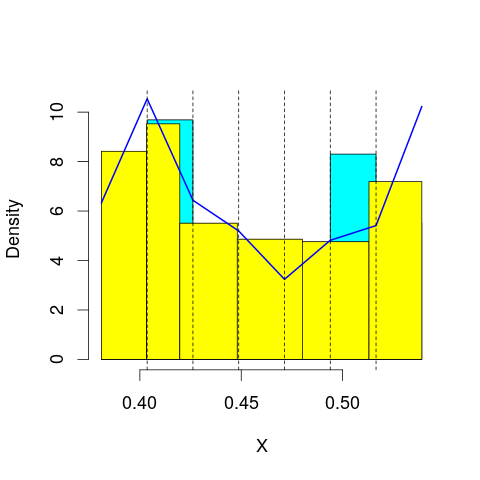

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.62968
mop.approx: Iteration 11. LL = 62.10904
mop.approx: Iteration 21. LL = 62.14556
mop.approx: Converged. Iteration 30. LL = 62.1476
[1] "Computing the linear combination of B-splines"


46.5517867799
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.43038
mop.approx: Iteration 11. LL = 62.25218
mop.approx: Iteration 21. LL = 62.32191
mop.approx: Iteration 31. LL = 62.34128
mop.approx: Iteration 41. LL = 62.3487
mop.approx: Iteration 51. LL = 62.35207
mop.approx: Iteration 61. LL = 62.35376
mop.approx: Iteration 71. LL = 62.35468
mop.approx: Converged. Iteration 72. LL = 62.35481
[1] "Computing the linear combination of B-splines"


45.0261270611
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.66497
mop.approx: Iteration 11. LL = 54.03618
mop.approx: Iteration 21. LL = 54.0914
mop.approx: Iteration 31. LL = 54.10886
mop.approx: Iteration 41. LL = 54.11589
mop.approx: Iteration 51. LL = 54.11901
mop.approx: Iteration 61. LL = 54.1205
mop.approx: Iteration 71. LL = 54.12125
mop.approx: Converged. Iteration 71. LL = 54.1213
[1] "Computing the linear combination of B-splines"


35.0597507282
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.39047
mop.approx: Iteration 11. LL = 53.20107
mop.approx: Iteration 21. LL = 53.41225
mop.approx: Iteration 31. LL = 53.44971
mop.approx: Iteration 41. LL = 53.46561
mop.approx: Iteration 51. LL = 53.47353
mop.approx: Iteration 61. LL = 53.47774
mop.approx: Iteration 71. LL = 53.48011
mop.approx: Iteration 81. LL = 53.48152
mop.approx: Iteration 91. LL = 53.48242
mop.approx: Converged. Iteration 99. LL = 53.48296
[1] "Computing the linear combination of B-splines"


32.688545691
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.863571
mop.approx: Iteration 11. LL = 51.10893
mop.approx: Iteration 21. LL = 51.26861
mop.approx: Iteration 31. LL = 51.28817
mop.approx: Iteration 41. LL = 51.29033
mop.approx: Converged. Iteration 42. LL = 51.29042
[1] "Computing the linear combination of B-splines"


28.7631407144
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.898427
mop.approx: Iteration 11. LL = 51.5192
mop.approx: Iteration 21. LL = 51.55149
mop.approx: Iteration 31. LL = 51.55653
mop.approx: Iteration 41. LL = 51.55829
mop.approx: Converged. Iteration 48. LL = 51.55887
[1] "Computing the linear combination of B-splines"


27.2987168935
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.370881
mop.approx: Iteration 11. LL = 51.86701
mop.approx: Iteration 21. LL = 52.34142
mop.approx: Iteration 31. LL = 52.40502
mop.approx: Iteration 41. LL = 52.42065
mop.approx: Iteration 51. LL = 52.42573
mop.approx: Iteration 61. LL = 52.42754
mop.approx: Converged. Iteration 68. LL = 52.42811
[1] "Computing the linear combination of B-splines"


26.4350912999
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.83023
mop.approx: Iteration 11. LL = 60.8586
mop.approx: Converged. Iteration 11. LL = 60.85865
[1] "Computing the linear combination of B-splines"


45.2628348965
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 45.262834896506249)
m reached
('Sum of Probabilities:', 0.9908129776629311)
chosen


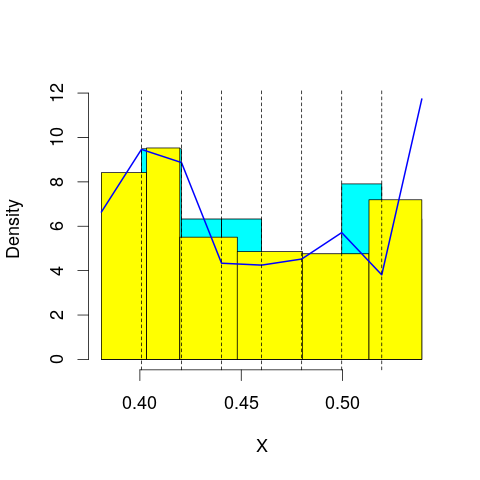

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.62968
mop.approx: Iteration 11. LL = 62.91584
mop.approx: Iteration 21. LL = 62.94202
mop.approx: Iteration 31. LL = 62.94468
mop.approx: Converged. Iteration 33. LL = 62.94488
[1] "Computing the linear combination of B-splines"


45.6162041189
('best: ', 45.262834896506249, 'accepted difference:', 76.946819324060613, 'cur BIC:', 45.616204118948815)
m reached
('Sum of Probabilities:', 0.9754008957601561)
chosen


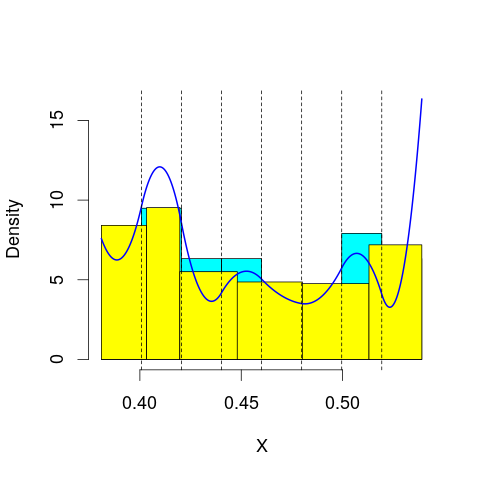

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.43038
mop.approx: Iteration 11. LL = 62.39731
mop.approx: Iteration 21. LL = 62.42749
mop.approx: Iteration 31. LL = 62.43338
mop.approx: Iteration 41. LL = 62.43506
mop.approx: Converged. Iteration 45. LL = 62.43543
[1] "Computing the linear combination of B-splines"


43.3738830023
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.66497
mop.approx: Iteration 11. LL = 54.11999
mop.approx: Iteration 21. LL = 54.13406
mop.approx: Iteration 31. LL = 54.13636
mop.approx: Iteration 41. LL = 54.13729
mop.approx: Converged. Iteration 43. LL = 54.13746
[1] "Computing the linear combination of B-splines"


33.3430398166
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.39047
mop.approx: Iteration 11. LL = 54.11648
mop.approx: Iteration 21. LL = 54.37354
mop.approx: Iteration 31. LL = 54.44449
mop.approx: Iteration 41. LL = 54.47234
mop.approx: Iteration 51. LL = 54.48522
mop.approx: Iteration 61. LL = 54.49168
mop.approx: Iteration 71. LL = 54.49508
mop.approx: Iteration 81. LL = 54.49692
mop.approx: Iteration 91. LL = 54.49795
mop.approx: Converged. Iteration 97. LL = 54.49839
[1] "Computing the linear combination of B-splines"


31.9711046245
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.863571
mop.approx: Iteration 11. LL = 52.1697
mop.approx: Iteration 21. LL = 52.39192
mop.approx: Iteration 31. LL = 52.44
mop.approx: Iteration 41. LL = 52.45654
mop.approx: Iteration 51. LL = 52.46371
mop.approx: Iteration 61. LL = 52.46723
mop.approx: Iteration 71. LL = 52.46909
mop.approx: Iteration 81. LL = 52.4701
mop.approx: Converged. Iteration 87. LL = 52.47053
[1] "Computing the linear combination of B-splines"


28.2103811042
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.898427
mop.approx: Iteration 11. LL = 51.71666
mop.approx: Iteration 21. LL = 51.77494
mop.approx: Iteration 31. LL = 51.79583
mop.approx: Iteration 41. LL = 51.80444
mop.approx: Iteration 51. LL = 51.8081
mop.approx: Iteration 61. LL = 51.80968
mop.approx: Converged. Iteration 69. LL = 51.81032
[1] "Computing the linear combination of B-splines"


25.817302012
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.370881
mop.approx: Iteration 11. LL = 52.49486
mop.approx: Iteration 21. LL = 52.60684
mop.approx: Iteration 31. LL = 52.61484
mop.approx: Iteration 41. LL = 52.61833
mop.approx: Iteration 51. LL = 52.62019
mop.approx: Iteration 61. LL = 52.62126
mop.approx: Converged. Iteration 70. LL = 52.62192
[1] "Computing the linear combination of B-splines"


24.8960128442
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.83023
mop.approx: Iteration 11. LL = 63.01918
mop.approx: Iteration 21. LL = 63.11924
mop.approx: Iteration 31. LL = 63.1394
mop.approx: Iteration 41. LL = 63.14588
mop.approx: Iteration 51. LL = 63.14834
mop.approx: Iteration 61. LL = 63.14933
mop.approx: Converged. Iteration 61. LL = 63.14939
[1] "Computing the linear combination of B-splines"


45.8207130799
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 45.820713079912707)
m reached
('Sum of Probabilities:', 0.9898604125136394)
chosen


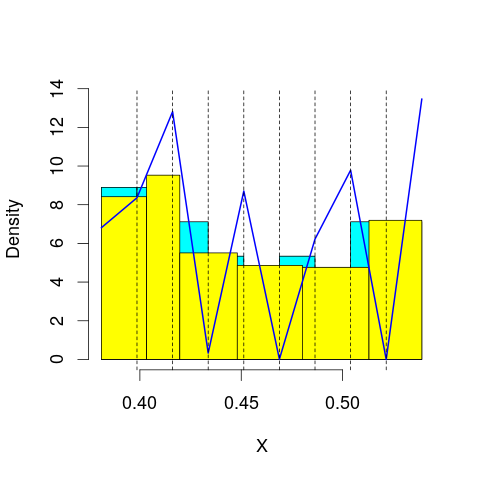

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.62968
mop.approx: Iteration 11. LL = 63.12581
mop.approx: Iteration 21. LL = 63.13737
mop.approx: Converged. Iteration 25. LL = 63.13789
[1] "Computing the linear combination of B-splines"


44.0763399732
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.43038
mop.approx: Iteration 11. LL = 63.09709
mop.approx: Iteration 21. LL = 63.20319
mop.approx: Iteration 31. LL = 63.2338
mop.approx: Iteration 41. LL = 63.24646
mop.approx: Iteration 51. LL = 63.25276
mop.approx: Iteration 61. LL = 63.25627
mop.approx: Iteration 71. LL = 63.25838
mop.approx: Iteration 81. LL = 63.25972
mop.approx: Iteration 91. LL = 63.26059
mop.approx: Converged. Iteration 94. LL = 63.26085
[1] "Computing the linear combination of B-splines"


42.4664313503
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.66497
mop.approx: Iteration 11. LL = 54.12353
mop.approx: Iteration 21. LL = 54.13372
mop.approx: Converged. Iteration 28. LL = 54.13468
[1] "Computing the linear combination of B-splines"


31.607395359
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.39047
mop.approx: Iteration 11. LL = 54.78807
mop.approx: Iteration 21. LL = 54.93497
mop.approx: Iteration 31. LL = 54.95975
mop.approx: Iteration 41. LL = 54.96893
mop.approx: Iteration 51. LL = 54.97349
mop.approx: Iteration 61. LL = 54.97609
mop.approx: Iteration 71. LL = 54.97769
mop.approx: Iteration 81. LL = 54.97874
mop.approx: Iteration 91. LL = 54.97945
mop.approx: Converged. Iteration 93. LL = 54.97962
[1] "Computing the linear combination of B-splines"


30.7194716524
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.863571
mop.approx: Iteration 11. LL = 53.14277
mop.approx: Iteration 21. LL = 53.45351
mop.approx: Iteration 31. LL = 53.54165
mop.approx: Iteration 41. LL = 53.57109
mop.approx: Iteration 51. LL = 53.58164
mop.approx: Iteration 61. LL = 53.58558
mop.approx: Iteration 71. LL = 53.58708
mop.approx: Converged. Iteration 76. LL = 53.58749
[1] "Computing the linear combination of B-splines"


27.5944698314
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.898427
mop.approx: Iteration 11. LL = 52.02334
mop.approx: Iteration 21. LL = 52.08084
mop.approx: Iteration 31. LL = 52.09037
mop.approx: Iteration 41. LL = 52.09263
mop.approx: Iteration 51. LL = 52.09348
mop.approx: Converged. Iteration 54. LL = 52.0937
[1] "Computing the linear combination of B-splines"


24.3678080533
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.370881
mop.approx: Iteration 11. LL = 52.59116
mop.approx: Iteration 21. LL = 52.62034
mop.approx: Converged. Iteration 24. LL = 52.62064
[1] "Computing the linear combination of B-splines"


23.1618378387
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.83023
mop.approx: Iteration 11. LL = 63.90761
mop.approx: Iteration 21. LL = 63.92858
mop.approx: Iteration 31. LL = 63.93281
mop.approx: Iteration 41. LL = 63.93422
mop.approx: Converged. Iteration 44. LL = 63.93451
[1] "Computing the linear combination of B-splines"


44.8729602918
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 44.872960291751546)
m reached
('Sum of Probabilities:', 0.9891168574237302)
chosen


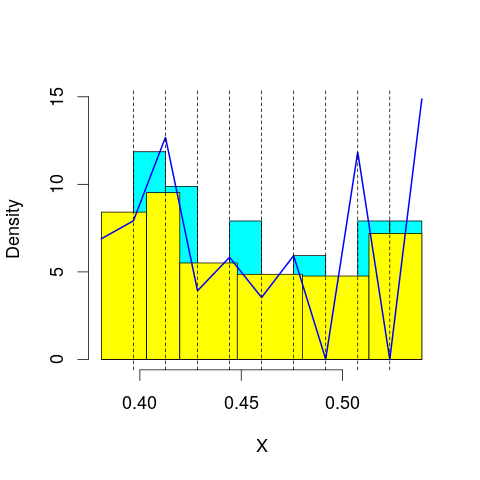

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.62968
mop.approx: Iteration 11. LL = 64.23283
mop.approx: Iteration 21. LL = 64.29652
mop.approx: Iteration 31. LL = 64.30114
mop.approx: Converged. Iteration 39. LL = 64.30203
[1] "Computing the linear combination of B-splines"


43.5076138679
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.43038
mop.approx: Iteration 11. LL = 63.92523
mop.approx: Iteration 21. LL = 64.05683
mop.approx: Iteration 31. LL = 64.08848
mop.approx: Iteration 41. LL = 64.10036
mop.approx: Iteration 51. LL = 64.10574
mop.approx: Iteration 61. LL = 64.10855
mop.approx: Iteration 71. LL = 64.11018
mop.approx: Iteration 81. LL = 64.11122
mop.approx: Converged. Iteration 88. LL = 64.1118
[1] "Computing the linear combination of B-splines"


41.5845153466
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.66497
mop.approx: Iteration 11. LL = 54.55795
mop.approx: Iteration 21. LL = 54.70725
mop.approx: Iteration 31. LL = 54.75977
mop.approx: Iteration 41. LL = 54.77746
mop.approx: Iteration 51. LL = 54.78324
mop.approx: Iteration 61. LL = 54.78511
mop.approx: Converged. Iteration 66. LL = 54.78555
[1] "Computing the linear combination of B-splines"


30.5254007819
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.39047
mop.approx: Iteration 11. LL = 55.09309
mop.approx: Iteration 21. LL = 55.20454
mop.approx: Iteration 31. LL = 55.23872
mop.approx: Iteration 41. LL = 55.25599
mop.approx: Iteration 51. LL = 55.26541
mop.approx: Iteration 61. LL = 55.27076
mop.approx: Iteration 71. LL = 55.2739
mop.approx: Iteration 81. LL = 55.2758
mop.approx: Iteration 91. LL = 55.27698
mop.approx: Iteration 101. LL = 55.27774
mop.approx: Converged. Iteration 103. LL = 55.27791
[1] "Computing the linear combination of B-splines"


29.2848864653
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.863571
mop.approx: Iteration 11. LL = 54.20991
mop.approx: Iteration 21. LL = 54.45527
mop.approx: Iteration 31. LL = 54.49215
mop.approx: Iteration 41. LL = 54.50197
mop.approx: Iteration 51. LL = 54.50605
mop.approx: Iteration 61. LL = 54.50846
mop.approx: Iteration 71. LL = 54.51017
mop.approx: Iteration 81. LL = 54.51149
mop.approx: Iteration 91. LL = 54.51254
mop.approx: Iteration 101. LL = 54.51337
mop.approx: Iteration 111. LL = 54.51405
mop.approx: Converged. Iteration 117. LL = 54.51445
[1] "Computing the linear combination of B-splines"


26.788561171
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.898427
mop.approx: Iteration 11. LL = 52.49882
mop.approx: Iteration 21. LL = 52.63659
mop.approx: Iteration 31. LL = 52.69396
mop.approx: Iteration 41. LL = 52.71941
mop.approx: Iteration 51. LL = 52.73061
mop.approx: Iteration 61. LL = 52.73572
mop.approx: Iteration 71. LL = 52.73823
mop.approx: Iteration 81. LL = 52.73959
mop.approx: Iteration 91. LL = 52.7404
mop.approx: Converged. Iteration 95. LL = 52.74068
[1] "Computing the linear combination of B-splines"


23.2819344493
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.370881
mop.approx: Iteration 11. LL = 52.62203
mop.approx: Iteration 21. LL = 52.63233
mop.approx: Iteration 31. LL = 52.63304
mop.approx: Converged. Iteration 36. LL = 52.63337
[1] "Computing the linear combination of B-splines"


21.4416234534
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.83023
mop.approx: Iteration 11. LL = 65.37264
mop.approx: Converged. Iteration 15. LL = 65.37392
[1] "Computing the linear combination of B-splines"


44.5795051259
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 44.579505125909861)
m reached
('Sum of Probabilities:', 0.9881760409280156)
chosen


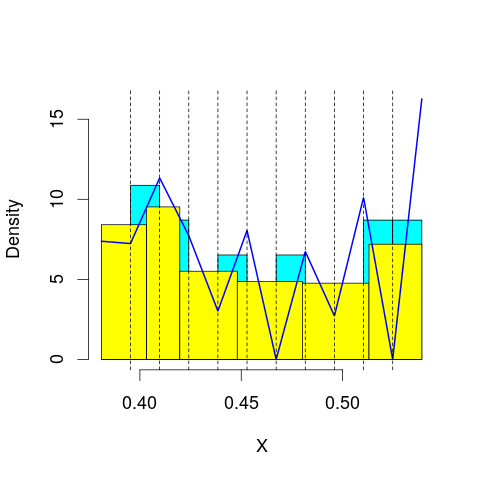

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.62968
mop.approx: Iteration 11. LL = 64.12579
mop.approx: Iteration 21. LL = 64.2495
mop.approx: Iteration 31. LL = 64.27626
mop.approx: Iteration 41. LL = 64.28265
mop.approx: Iteration 51. LL = 64.28423
mop.approx: Converged. Iteration 52. LL = 64.28436
[1] "Computing the linear combination of B-splines"


41.7570736097
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.43038
mop.approx: Iteration 11. LL = 64.82501
mop.approx: Iteration 21. LL = 64.92598
mop.approx: Iteration 31. LL = 64.94068
mop.approx: Iteration 41. LL = 64.94547
mop.approx: Iteration 51. LL = 64.9476
mop.approx: Iteration 61. LL = 64.94869
mop.approx: Converged. Iteration 64. LL = 64.94897
[1] "Computing the linear combination of B-splines"


40.6888201
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.66497
mop.approx: Iteration 11. LL = 54.84856
mop.approx: Iteration 21. LL = 54.98908
mop.approx: Iteration 31. LL = 55.02645
mop.approx: Iteration 41. LL = 55.04008
mop.approx: Iteration 51. LL = 55.04678
mop.approx: Iteration 61. LL = 55.05064
mop.approx: Iteration 71. LL = 55.05304
mop.approx: Iteration 81. LL = 55.05459
mop.approx: Iteration 91. LL = 55.05561
mop.approx: Iteration 101. LL = 55.05629
mop.approx: Converged. Iteration 101. LL = 55.05635
[1] "Computing the linear combination of B-splines"


29.0633260506
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.39047
mop.approx: Iteration 11. LL = 55.44064
mop.approx: Iteration 21. LL = 55.62363
mop.approx: Iteration 31. LL = 55.68141
mop.approx: Iteration 41. LL = 55.70146
mop.approx: Iteration 51. LL = 55.70935
mop.approx: Iteration 61. LL = 55.71301
mop.approx: Iteration 71. LL = 55.71493
mop.approx: Iteration 81. LL = 55.71602
mop.approx: Converged. Iteration 88. LL = 55.71656
[1] "Computing the linear combination of B-splines"


27.9906687562
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.863571
mop.approx: Iteration 11. LL = 54.99624
mop.approx: Iteration 21. LL = 55.25055
mop.approx: Iteration 31. LL = 55.32777
mop.approx: Iteration 41. LL = 55.35702
mop.approx: Iteration 51. LL = 55.36837
mop.approx: Iteration 61. LL = 55.37305
mop.approx: Iteration 71. LL = 55.37517
mop.approx: Iteration 81. LL = 55.37622
mop.approx: Converged. Iteration 86. LL = 55.37659
[1] "Computing the linear combination of B-splines"


25.9178344748
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.898427
mop.approx: Iteration 11. LL = 53.35281
mop.approx: Iteration 21. LL = 53.56525
mop.approx: Iteration 31. LL = 53.6035
mop.approx: Iteration 41. LL = 53.61235
mop.approx: Iteration 51. LL = 53.61544
mop.approx: Iteration 61. LL = 53.61698
mop.approx: Iteration 71. LL = 53.61789
mop.approx: Converged. Iteration 79. LL = 53.61845
[1] "Computing the linear combination of B-splines"


22.426823168
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.370881
mop.approx: Iteration 11. LL = 52.73291
mop.approx: Iteration 21. LL = 52.77153
mop.approx: Iteration 31. LL = 52.79447
mop.approx: Iteration 41. LL = 52.80961
mop.approx: Iteration 51. LL = 52.81957
mop.approx: Iteration 61. LL = 52.82612
mop.approx: Iteration 71. LL = 52.83041
mop.approx: Iteration 81. LL = 52.83322
mop.approx: Iteration 91. LL = 52.83506
mop.approx: Iteration 101. LL = 52.83627
mop.approx: Iteration 111. LL = 52.83706
mop.approx: Converged. Iteration 116. LL = 52.83741
[1] "Computing the linear combination of B-splines"


19.9124563146
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.83023
mop.approx: Iteration 11. LL = 65.33407
mop.approx: Iteration 21. LL = 65.36156
mop.approx: Converged. Iteration 30. LL = 65.36376
[1] "Computing the linear combination of B-splines"


42.8364812451
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 42.836481245139538)
m reached
('Sum of Probabilities:', 0.9872951231971943)
chosen


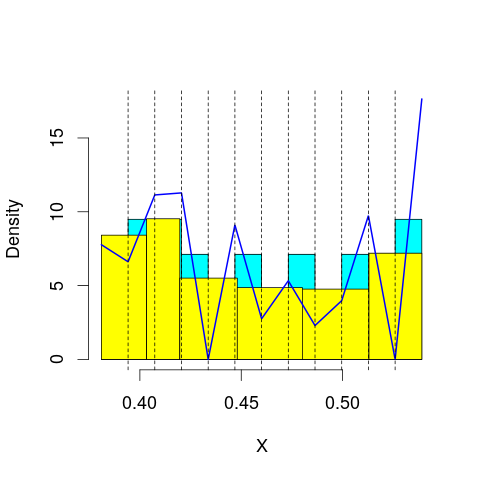

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.62968
mop.approx: Iteration 11. LL = 66.08885
mop.approx: Iteration 21. LL = 66.15486
mop.approx: Converged. Iteration 28. LL = 66.15698
[1] "Computing the linear combination of B-splines"


41.8968288323
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.43038
mop.approx: Iteration 11. LL = 64.62318
mop.approx: Iteration 21. LL = 64.72935
mop.approx: Iteration 31. LL = 64.74631
mop.approx: Iteration 41. LL = 64.75078
mop.approx: Iteration 51. LL = 64.75254
mop.approx: Converged. Iteration 60. LL = 64.75338
[1] "Computing the linear combination of B-splines"


38.7603654824
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.66497
mop.approx: Iteration 11. LL = 55.62582
mop.approx: Iteration 21. LL = 55.73091
mop.approx: Iteration 31. LL = 55.74301
mop.approx: Iteration 41. LL = 55.74584
mop.approx: Iteration 51. LL = 55.74682
mop.approx: Converged. Iteration 52. LL = 55.74693
[1] "Computing the linear combination of B-splines"


28.0210406571
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.39047
mop.approx: Iteration 11. LL = 55.54303
mop.approx: Iteration 21. LL = 55.68454
mop.approx: Iteration 31. LL = 55.71897
mop.approx: Iteration 41. LL = 55.73019
mop.approx: Iteration 51. LL = 55.73526
mop.approx: Iteration 61. LL = 55.73809
mop.approx: Iteration 71. LL = 55.73986
mop.approx: Iteration 81. LL = 55.74103
mop.approx: Iteration 91. LL = 55.74185
mop.approx: Converged. Iteration 98. LL = 55.74233
[1] "Computing the linear combination of B-splines"


26.2835792318
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.863571
mop.approx: Iteration 11. LL = 55.69809
mop.approx: Iteration 21. LL = 55.9715
mop.approx: Iteration 31. LL = 56.02092
mop.approx: Iteration 41. LL = 56.03028
mop.approx: Iteration 51. LL = 56.03207
mop.approx: Converged. Iteration 52. LL = 56.03219
[1] "Computing the linear combination of B-splines"


24.8405682593
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.898427
mop.approx: Iteration 11. LL = 54.26732
mop.approx: Iteration 21. LL = 54.50514
mop.approx: Iteration 31. LL = 54.55397
mop.approx: Iteration 41. LL = 54.57315
mop.approx: Iteration 51. LL = 54.58361
mop.approx: Iteration 61. LL = 54.58992
mop.approx: Iteration 71. LL = 54.59382
mop.approx: Iteration 81. LL = 54.59625
mop.approx: Iteration 91. LL = 54.59776
mop.approx: Iteration 101. LL = 54.59871
mop.approx: Converged. Iteration 108. LL = 54.59921
[1] "Computing the linear combination of B-splines"


21.6747121092
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.370881
mop.approx: Iteration 11. LL = 53.14259
mop.approx: Iteration 21. LL = 53.25517
mop.approx: Iteration 31. LL = 53.28821
mop.approx: Iteration 41. LL = 53.30075
mop.approx: Iteration 51. LL = 53.30713
mop.approx: Iteration 61. LL = 53.31107
mop.approx: Iteration 71. LL = 53.3137
mop.approx: Iteration 81. LL = 53.3155
mop.approx: Iteration 91. LL = 53.31675
mop.approx: Iteration 101. LL = 53.31762
mop.approx: Converged. Iteration 109. LL = 53.31818
[1] "Computing the linear combination of B-splines"


18.6606439648
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.83023
mop.approx: Iteration 11. LL = 66.94949
mop.approx: Iteration 21. LL = 66.96947
mop.approx: Converged. Iteration 28. LL = 66.97083
[1] "Computing the linear combination of B-splines"


42.7106791818
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 42.710679181835097)
m reached
('Sum of Probabilities:', 0.9865894627237582)
chosen


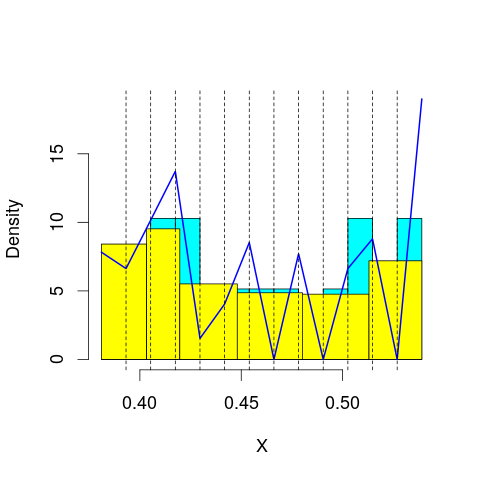

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.62968
mop.approx: Iteration 11. LL = 66.04295
mop.approx: Iteration 21. LL = 66.14659
mop.approx: Iteration 31. LL = 66.16748
mop.approx: Iteration 41. LL = 66.17352
mop.approx: Iteration 51. LL = 66.17554
mop.approx: Converged. Iteration 56. LL = 66.17605
[1] "Computing the linear combination of B-splines"


40.1830294036
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.43038
mop.approx: Iteration 11. LL = 65.385
mop.approx: Iteration 21. LL = 65.48964
mop.approx: Iteration 31. LL = 65.52048
mop.approx: Iteration 41. LL = 65.53345
mop.approx: Iteration 51. LL = 65.53974
mop.approx: Iteration 61. LL = 65.543
mop.approx: Iteration 71. LL = 65.54476
mop.approx: Iteration 81. LL = 65.54573
mop.approx: Converged. Iteration 83. LL = 65.54593
[1] "Computing the linear combination of B-splines"


37.8200454067
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.66497
mop.approx: Iteration 11. LL = 55.68098
mop.approx: Iteration 21. LL = 55.85963
mop.approx: Iteration 31. LL = 55.90125
mop.approx: Iteration 41. LL = 55.91378
mop.approx: Iteration 51. LL = 55.91854
mop.approx: Iteration 61. LL = 55.92066
mop.approx: Iteration 71. LL = 55.92172
mop.approx: Converged. Iteration 76. LL = 55.92209
[1] "Computing the linear combination of B-splines"


26.4633372913
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.39047
mop.approx: Iteration 11. LL = 56.03049
mop.approx: Iteration 21. LL = 56.15252
mop.approx: Iteration 31. LL = 56.17879
mop.approx: Iteration 41. LL = 56.18859
mop.approx: Iteration 51. LL = 56.19258
mop.approx: Iteration 61. LL = 56.19422
mop.approx: Converged. Iteration 68. LL = 56.19481
[1] "Computing the linear combination of B-splines"


25.0031878675
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.863571
mop.approx: Iteration 11. LL = 56.0121
mop.approx: Iteration 21. LL = 56.28282
mop.approx: Iteration 31. LL = 56.34217
mop.approx: Iteration 41. LL = 56.35911
mop.approx: Iteration 51. LL = 56.36555
mop.approx: Iteration 61. LL = 56.36876
mop.approx: Iteration 71. LL = 56.37065
mop.approx: Iteration 81. LL = 56.37187
mop.approx: Iteration 91. LL = 56.37271
mop.approx: Converged. Iteration 98. LL = 56.3732
[1] "Computing the linear combination of B-splines"


23.4487178691
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.898427
mop.approx: Iteration 11. LL = 55.27241
mop.approx: Iteration 21. LL = 55.59132
mop.approx: Iteration 31. LL = 55.64121
mop.approx: Iteration 41. LL = 55.65028
mop.approx: Iteration 51. LL = 55.65204
mop.approx: Converged. Iteration 53. LL = 55.65221
[1] "Computing the linear combination of B-splines"


20.99489042
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.370881
mop.approx: Iteration 11. LL = 53.75423
mop.approx: Iteration 21. LL = 53.86809
mop.approx: Iteration 31. LL = 53.88131
mop.approx: Iteration 41. LL = 53.88421
mop.approx: Iteration 51. LL = 53.88571
mop.approx: Iteration 61. LL = 53.88678
mop.approx: Iteration 71. LL = 53.88765
mop.approx: Iteration 81. LL = 53.88839
mop.approx: Iteration 91. LL = 53.88904
mop.approx: Iteration 101. LL = 53.88962
mop.approx: Converged. Iteration 102. LL = 53.88972
[1] "Computing the linear combination of B-splines"


17.4988840587
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.83023
mop.approx: Iteration 11. LL = 65.21964
mop.approx: Converged. Iteration 19. LL = 65.22557
[1] "Computing the linear combination of B-splines"


39.2325491608
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 39.232549160812326)
m reached
('Sum of Probabilities:', 0.9859334077187136)
chosen


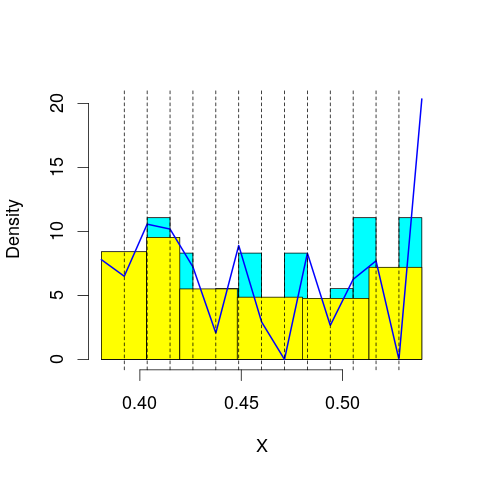

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.62968
mop.approx: Iteration 11. LL = 67.54906
mop.approx: Iteration 21. LL = 67.60507
mop.approx: Iteration 31. LL = 67.60985
mop.approx: Converged. Iteration 33. LL = 67.6101
[1] "Computing the linear combination of B-splines"


39.8842128294
('best: ', 39.232549160812326, 'accepted difference:', 66.69533357338095, 'cur BIC:', 39.884212829356827)
m reached
('Sum of Probabilities:', 0.9633846607085063)
chosen


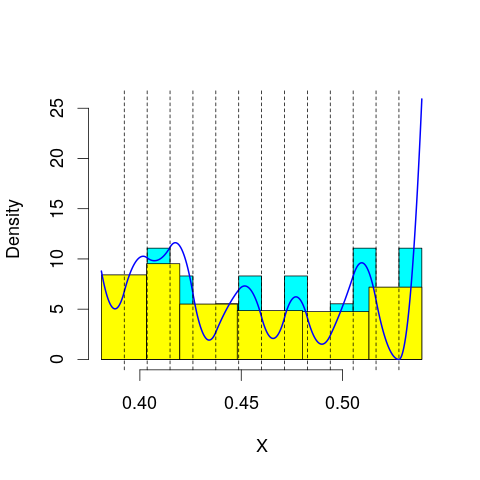

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.43038
mop.approx: Iteration 11. LL = 65.46564
mop.approx: Iteration 21. LL = 65.65323
mop.approx: Iteration 31. LL = 65.68108
mop.approx: Iteration 41. LL = 65.68919
mop.approx: Iteration 51. LL = 65.69264
mop.approx: Iteration 61. LL = 65.69436
mop.approx: Iteration 71. LL = 65.69529
mop.approx: Converged. Iteration 72. LL = 65.69542
[1] "Computing the linear combination of B-splines"


36.2366607214
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.66497
mop.approx: Iteration 11. LL = 56.01208
mop.approx: Iteration 21. LL = 56.07604
mop.approx: Iteration 31. LL = 56.09757
mop.approx: Iteration 41. LL = 56.10581
mop.approx: Iteration 51. LL = 56.10901
mop.approx: Iteration 61. LL = 56.11029
mop.approx: Converged. Iteration 65. LL = 56.1106
[1] "Computing the linear combination of B-splines"


24.9189767602
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.39047
mop.approx: Iteration 11. LL = 56.34937
mop.approx: Iteration 21. LL = 56.56836
mop.approx: Iteration 31. LL = 56.60631
mop.approx: Iteration 41. LL = 56.61382
mop.approx: Iteration 51. LL = 56.61545
mop.approx: Converged. Iteration 53. LL = 56.61563
[1] "Computing the linear combination of B-splines"


23.6911355449
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.863571
mop.approx: Iteration 11. LL = 56.32512
mop.approx: Iteration 21. LL = 56.46901
mop.approx: Iteration 31. LL = 56.48479
mop.approx: Iteration 41. LL = 56.48944
mop.approx: Iteration 51. LL = 56.49126
mop.approx: Iteration 61. LL = 56.49211
mop.approx: Converged. Iteration 62. LL = 56.49222
[1] "Computing the linear combination of B-splines"


21.8348593561
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.898427
mop.approx: Iteration 11. LL = 55.95231
mop.approx: Iteration 21. LL = 56.28596
mop.approx: Iteration 31. LL = 56.35195
mop.approx: Iteration 41. LL = 56.37195
mop.approx: Iteration 51. LL = 56.37924
mop.approx: Iteration 61. LL = 56.38214
mop.approx: Iteration 71. LL = 56.38335
mop.approx: Converged. Iteration 75. LL = 56.38366
[1] "Computing the linear combination of B-splines"


19.9932441811
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.370881
mop.approx: Iteration 11. LL = 54.6401
mop.approx: Iteration 21. LL = 54.90102
mop.approx: Iteration 31. LL = 54.95651
mop.approx: Iteration 41. LL = 54.97134
mop.approx: Iteration 51. LL = 54.9761
mop.approx: Iteration 61. LL = 54.97786
mop.approx: Converged. Iteration 69. LL = 54.97855
[1] "Computing the linear combination of B-splines"


16.8587844902
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.83023
mop.approx: Iteration 11. LL = 67.49238
mop.approx: Iteration 21. LL = 67.5505
mop.approx: Iteration 31. LL = 67.56308
mop.approx: Iteration 41. LL = 67.56731
mop.approx: Iteration 51. LL = 67.5689
mop.approx: Converged. Iteration 55. LL = 67.56928
[1] "Computing the linear combination of B-splines"


39.8433960189
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 39.843396018948411)
m reached
('Sum of Probabilities:', 0.9851635036903503)
chosen


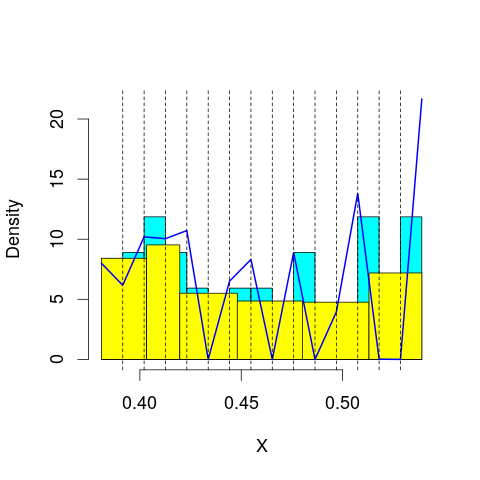

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.62968
mop.approx: Iteration 11. LL = 67.23464
mop.approx: Iteration 21. LL = 67.27295
mop.approx: Iteration 31. LL = 67.27948
mop.approx: Iteration 41. LL = 67.28141
mop.approx: Converged. Iteration 46. LL = 67.28192
[1] "Computing the linear combination of B-splines"


37.8231681998
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.43038
mop.approx: Iteration 11. LL = 66.11021
mop.approx: Iteration 21. LL = 66.25692
mop.approx: Iteration 31. LL = 66.27614
mop.approx: Iteration 41. LL = 66.28191
mop.approx: Iteration 51. LL = 66.28437
mop.approx: Iteration 61. LL = 66.28558
mop.approx: Converged. Iteration 66. LL = 66.28602
[1] "Computing the linear combination of B-splines"


35.0943953271
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.66497
mop.approx: Iteration 11. LL = 56.43032
mop.approx: Iteration 21. LL = 56.57073
mop.approx: Iteration 31. LL = 56.5923
mop.approx: Iteration 41. LL = 56.59653
mop.approx: Converged. Iteration 50. LL = 56.59757
[1] "Computing the linear combination of B-splines"


23.6730785726
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.39047
mop.approx: Iteration 11. LL = 56.36784
mop.approx: Iteration 21. LL = 56.42435
mop.approx: Iteration 31. LL = 56.43354
mop.approx: Iteration 41. LL = 56.43561
mop.approx: Converged. Iteration 44. LL = 56.43588
[1] "Computing the linear combination of B-splines"


21.7785242808
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.863571
mop.approx: Iteration 11. LL = 56.78853
mop.approx: Iteration 21. LL = 57.05279
mop.approx: Iteration 31. LL = 57.09613
mop.approx: Iteration 41. LL = 57.10701
mop.approx: Iteration 51. LL = 57.1108
mop.approx: Iteration 61. LL = 57.11249
mop.approx: Iteration 71. LL = 57.11336
mop.approx: Converged. Iteration 73. LL = 57.11354
[1] "Computing the linear combination of B-splines"


20.7233009282
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.898427
mop.approx: Iteration 11. LL = 56.24688
mop.approx: Iteration 21. LL = 56.45305
mop.approx: Iteration 31. LL = 56.49175
mop.approx: Iteration 41. LL = 56.50471
mop.approx: Iteration 51. LL = 56.51018
mop.approx: Iteration 61. LL = 56.51284
mop.approx: Iteration 71. LL = 56.51428
mop.approx: Iteration 81. LL = 56.51511
mop.approx: Converged. Iteration 83. LL = 56.51528
[1] "Computing the linear combination of B-splines"


18.3919145771
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.370881
mop.approx: Iteration 11. LL = 55.59164
mop.approx: Iteration 21. LL = 56.03195
mop.approx: Iteration 31. LL = 56.12087
mop.approx: Iteration 41. LL = 56.1407
mop.approx: Iteration 51. LL = 56.14553
mop.approx: Iteration 61. LL = 56.14678
mop.approx: Converged. Iteration 62. LL = 56.14689
[1] "Computing the linear combination of B-splines"


16.2874209425
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.83023
mop.approx: Iteration 11. LL = 68.58837
mop.approx: Iteration 21. LL = 68.61052
mop.approx: Converged. Iteration 27. LL = 68.61161
[1] "Computing the linear combination of B-splines"


39.1528501896
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 39.152850189636716)
m reached
('Sum of Probabilities:', 0.9842727047951216)
chosen


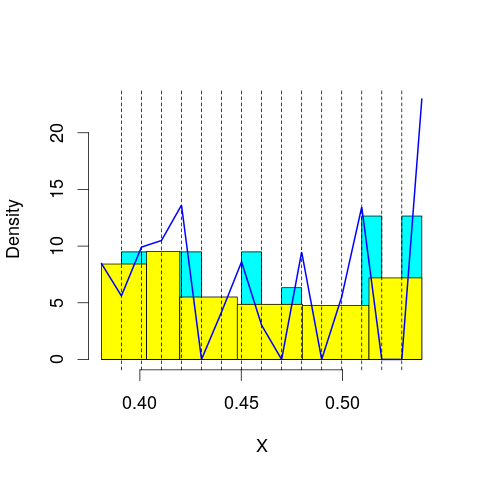

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.62968
mop.approx: Iteration 11. LL = 67.20096
mop.approx: Iteration 21. LL = 67.24394
mop.approx: Iteration 31. LL = 67.25497
mop.approx: Iteration 41. LL = 67.25912
mop.approx: Iteration 51. LL = 67.26099
mop.approx: Iteration 61. LL = 67.26193
mop.approx: Converged. Iteration 61. LL = 67.26199
[1] "Computing the linear combination of B-splines"


36.0703687706
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.43038
mop.approx: Iteration 11. LL = 66.92407
mop.approx: Iteration 21. LL = 67.04979
mop.approx: Iteration 31. LL = 67.07044
mop.approx: Iteration 41. LL = 67.07658
mop.approx: Iteration 51. LL = 67.07895
mop.approx: Iteration 61. LL = 67.08001
mop.approx: Converged. Iteration 62. LL = 67.08014
[1] "Computing the linear combination of B-splines"


34.155650365
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.66497
mop.approx: Iteration 11. LL = 56.16729
mop.approx: Iteration 21. LL = 56.22836
mop.approx: Iteration 31. LL = 56.24346
mop.approx: Iteration 41. LL = 56.24792
mop.approx: Iteration 51. LL = 56.24948
mop.approx: Converged. Iteration 57. LL = 56.24996
[1] "Computing the linear combination of B-splines"


21.5926038215
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.39047
mop.approx: Iteration 11. LL = 56.99772
mop.approx: Iteration 21. LL = 57.14756
mop.approx: Iteration 31. LL = 57.16976
mop.approx: Iteration 41. LL = 57.17469
mop.approx: Iteration 51. LL = 57.17628
mop.approx: Converged. Iteration 57. LL = 57.17678
[1] "Computing the linear combination of B-splines"


20.7865574431
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.863571
mop.approx: Iteration 11. LL = 56.60649
mop.approx: Iteration 21. LL = 56.70223
mop.approx: Iteration 31. LL = 56.718
mop.approx: Iteration 41. LL = 56.72292
mop.approx: Iteration 51. LL = 56.72466
mop.approx: Converged. Iteration 58. LL = 56.72524
[1] "Computing the linear combination of B-splines"


18.6021286207
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.898427
mop.approx: Iteration 11. LL = 56.83732
mop.approx: Iteration 21. LL = 57.14792
mop.approx: Iteration 31. LL = 57.20241
mop.approx: Iteration 41. LL = 57.21685
mop.approx: Iteration 51. LL = 57.22197
mop.approx: Iteration 61. LL = 57.22413
mop.approx: Iteration 71. LL = 57.22515
mop.approx: Converged. Iteration 74. LL = 57.22539
[1] "Computing the linear combination of B-splines"


17.3695000994
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.370881
mop.approx: Iteration 11. LL = 56.00402
mop.approx: Iteration 21. LL = 56.26837
mop.approx: Iteration 31. LL = 56.30651
mop.approx: Iteration 41. LL = 56.31523
mop.approx: Iteration 51. LL = 56.31833
mop.approx: Iteration 61. LL = 56.31981
mop.approx: Iteration 71. LL = 56.32064
mop.approx: Converged. Iteration 74. LL = 56.32088
[1] "Computing the linear combination of B-splines"


14.7249902953
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.83023
mop.approx: Iteration 11. LL = 68.03326
mop.approx: Converged. Iteration 15. LL = 68.03392
[1] "Computing the linear combination of B-splines"


36.842297225
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 36.842297225008934)
m reached
('Sum of Probabilities:', 0.9833686944400872)
chosen


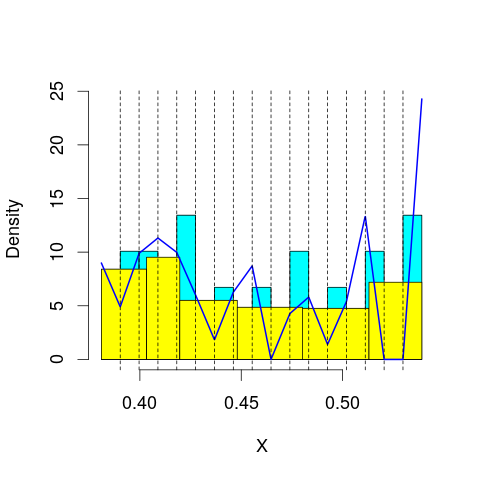

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.62968
mop.approx: Iteration 11. LL = 68.31647
mop.approx: Iteration 21. LL = 68.34545
mop.approx: Iteration 31. LL = 68.35073
mop.approx: Iteration 41. LL = 68.35261
mop.approx: Converged. Iteration 49. LL = 68.35339
[1] "Computing the linear combination of B-splines"


35.4289006564
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.43038
mop.approx: Iteration 11. LL = 66.39387
mop.approx: Iteration 21. LL = 66.48287
mop.approx: Iteration 31. LL = 66.5058
mop.approx: Iteration 41. LL = 66.51475
mop.approx: Iteration 51. LL = 66.51905
mop.approx: Iteration 61. LL = 66.52134
mop.approx: Iteration 71. LL = 66.52264
mop.approx: Converged. Iteration 78. LL = 66.52327
[1] "Computing the linear combination of B-splines"


31.8659150583
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.66497
mop.approx: Iteration 11. LL = 57.13746
mop.approx: Iteration 21. LL = 57.27647
mop.approx: Iteration 31. LL = 57.30475
mop.approx: Iteration 41. LL = 57.31437
mop.approx: Iteration 51. LL = 57.31894
mop.approx: Iteration 61. LL = 57.32155
mop.approx: Iteration 71. LL = 57.32319
mop.approx: Iteration 81. LL = 57.3243
mop.approx: Iteration 91. LL = 57.32508
mop.approx: Converged. Iteration 95. LL = 57.32538
[1] "Computing the linear combination of B-splines"


20.9351558149
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.39047
mop.approx: Iteration 11. LL = 56.67632
mop.approx: Iteration 21. LL = 56.78166
mop.approx: Iteration 31. LL = 56.81585
mop.approx: Iteration 41. LL = 56.82921
mop.approx: Iteration 51. LL = 56.83524
mop.approx: Iteration 61. LL = 56.83826
mop.approx: Iteration 71. LL = 56.83987
mop.approx: Iteration 81. LL = 56.84077
mop.approx: Converged. Iteration 84. LL = 56.841
[1] "Computing the linear combination of B-splines"


18.7179088197
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.863571
mop.approx: Iteration 11. LL = 57.22366
mop.approx: Iteration 21. LL = 57.3876
mop.approx: Iteration 31. LL = 57.40707
mop.approx: Iteration 41. LL = 57.41139
mop.approx: Iteration 51. LL = 57.41268
mop.approx: Converged. Iteration 53. LL = 57.41286
[1] "Computing the linear combination of B-splines"


17.5568896563
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.898427
mop.approx: Iteration 11. LL = 56.74245
mop.approx: Iteration 21. LL = 56.96247
mop.approx: Iteration 31. LL = 57.02218
mop.approx: Iteration 41. LL = 57.04297
mop.approx: Iteration 51. LL = 57.05104
mop.approx: Iteration 61. LL = 57.05452
mop.approx: Iteration 71. LL = 57.05619
mop.approx: Iteration 81. LL = 57.05708
mop.approx: Converged. Iteration 84. LL = 57.05732
[1] "Computing the linear combination of B-splines"


15.4682108006
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.370881
mop.approx: Iteration 11. LL = 56.58602
mop.approx: Iteration 21. LL = 56.89162
mop.approx: Iteration 31. LL = 56.93393
mop.approx: Iteration 41. LL = 56.94387
mop.approx: Iteration 51. LL = 56.94742
mop.approx: Iteration 61. LL = 56.94899
mop.approx: Converged. Iteration 70. LL = 56.94973
[1] "Computing the linear combination of B-splines"


13.6043018746
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.83023
mop.approx: Iteration 11. LL = 70.92158
mop.approx: Iteration 21. LL = 70.93021
mop.approx: Iteration 31. LL = 70.93192
mop.approx: Converged. Iteration 35. LL = 70.93232
[1] "Computing the linear combination of B-splines"


38.0078315221
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 38.007831522071797)
m reached
('Sum of Probabilities:', 0.982421292607454)
chosen


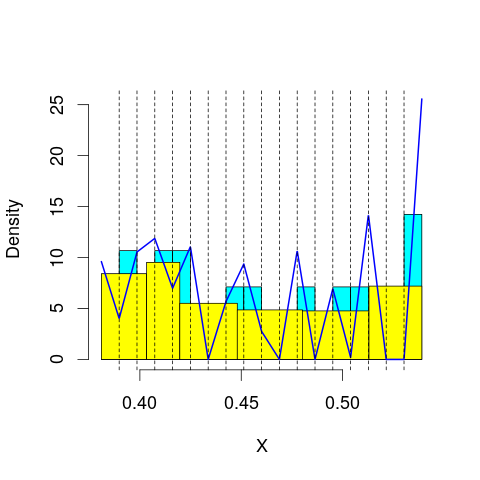

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.62968
mop.approx: Iteration 11. LL = 67.84262
mop.approx: Iteration 21. LL = 67.93972
mop.approx: Iteration 31. LL = 67.9589
mop.approx: Iteration 41. LL = 67.96513
mop.approx: Iteration 51. LL = 67.96786
mop.approx: Iteration 61. LL = 67.96931
mop.approx: Iteration 71. LL = 67.97018
mop.approx: Converged. Iteration 71. LL = 67.97025
[1] "Computing the linear combination of B-splines"


33.3128896712
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.43038
mop.approx: Iteration 11. LL = 67.42152
mop.approx: Iteration 21. LL = 67.52223
mop.approx: Iteration 31. LL = 67.54511
mop.approx: Iteration 41. LL = 67.55297
mop.approx: Iteration 51. LL = 67.55607
mop.approx: Iteration 61. LL = 67.5574
mop.approx: Converged. Iteration 64. LL = 67.5577
[1] "Computing the linear combination of B-splines"


31.1674695445
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.66497
mop.approx: Iteration 11. LL = 57.34937
mop.approx: Iteration 21. LL = 57.55421
mop.approx: Iteration 31. LL = 57.58439
mop.approx: Iteration 41. LL = 57.58933
mop.approx: Converged. Iteration 48. LL = 57.59014
[1] "Computing the linear combination of B-splines"


19.4670422659
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.39047
mop.approx: Iteration 11. LL = 57.259
mop.approx: Iteration 21. LL = 57.36122
mop.approx: Iteration 31. LL = 57.37424
mop.approx: Iteration 41. LL = 57.37656
mop.approx: Converged. Iteration 45. LL = 57.37691
[1] "Computing the linear combination of B-splines"


17.5209455794
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.863571
mop.approx: Iteration 11. LL = 57.16491
mop.approx: Iteration 21. LL = 57.35426
mop.approx: Iteration 31. LL = 57.38995
mop.approx: Iteration 41. LL = 57.39879
mop.approx: Iteration 51. LL = 57.40127
mop.approx: Converged. Iteration 58. LL = 57.40192
[1] "Computing the linear combination of B-splines"


15.8130592783
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.898427
mop.approx: Iteration 11. LL = 57.18275
mop.approx: Iteration 21. LL = 57.37663
mop.approx: Iteration 31. LL = 57.40706
mop.approx: Iteration 41. LL = 57.41531
mop.approx: Iteration 51. LL = 57.41829
mop.approx: Iteration 61. LL = 57.41954
mop.approx: Converged. Iteration 66. LL = 57.41994
[1] "Computing the linear combination of B-splines"


14.0976880254
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.370881
mop.approx: Iteration 11. LL = 56.70696
mop.approx: Iteration 21. LL = 56.95371
mop.approx: Iteration 31. LL = 57.00101
mop.approx: Iteration 41. LL = 57.01425
mop.approx: Iteration 51. LL = 57.01896
mop.approx: Iteration 61. LL = 57.02099
mop.approx: Iteration 71. LL = 57.02198
mop.approx: Converged. Iteration 74. LL = 57.02223
[1] "Computing the linear combination of B-splines"


11.9394807132
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.83023
mop.approx: Iteration 11. LL = 71.75016
mop.approx: Converged. Iteration 18. LL = 71.75597
[1] "Computing the linear combination of B-splines"


37.0986114903
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 37.098611490287972)
m reached
('Sum of Probabilities:', 0.9815039895917338)
chosen


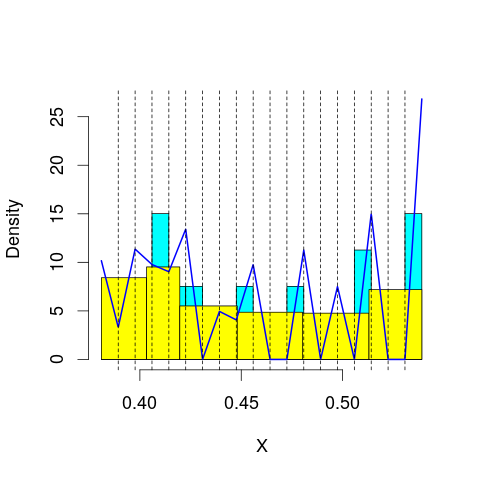

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.62968
mop.approx: Iteration 11. LL = 68.71231
mop.approx: Iteration 21. LL = 68.74462
mop.approx: Iteration 31. LL = 68.74706
mop.approx: Converged. Iteration 32. LL = 68.74719
[1] "Computing the linear combination of B-splines"


32.3569599619
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.43038
mop.approx: Iteration 11. LL = 67.80395
mop.approx: Iteration 21. LL = 67.90661
mop.approx: Iteration 31. LL = 67.92753
mop.approx: Iteration 41. LL = 67.93359
mop.approx: Iteration 51. LL = 67.93544
mop.approx: Converged. Iteration 54. LL = 67.93575
[1] "Computing the linear combination of B-splines"


29.8126543939
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.66497
mop.approx: Iteration 11. LL = 57.92806
mop.approx: Iteration 21. LL = 58.03529
mop.approx: Iteration 31. LL = 58.05183
mop.approx: Iteration 41. LL = 58.05571
mop.approx: Iteration 51. LL = 58.05682
mop.approx: Converged. Iteration 51. LL = 58.05687
[1] "Computing the linear combination of B-splines"


18.2009090358
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.39047
mop.approx: Iteration 11. LL = 57.48453
mop.approx: Iteration 21. LL = 57.57604
mop.approx: Iteration 31. LL = 57.58828
mop.approx: Iteration 41. LL = 57.59109
mop.approx: Converged. Iteration 49. LL = 57.5919
[1] "Computing the linear combination of B-splines"


16.0030661829
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.863571
mop.approx: Iteration 11. LL = 57.35936
mop.approx: Iteration 21. LL = 57.50892
mop.approx: Iteration 31. LL = 57.53853
mop.approx: Iteration 41. LL = 57.55001
mop.approx: Iteration 51. LL = 57.5553
mop.approx: Iteration 61. LL = 57.55791
mop.approx: Iteration 71. LL = 57.55926
mop.approx: Converged. Iteration 80. LL = 57.56
[1] "Computing the linear combination of B-splines"


14.2382785772
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.898427
mop.approx: Iteration 11. LL = 57.3366
mop.approx: Iteration 21. LL = 57.55283
mop.approx: Iteration 31. LL = 57.59486
mop.approx: Iteration 41. LL = 57.60484
mop.approx: Iteration 51. LL = 57.60731
mop.approx: Converged. Iteration 56. LL = 57.60779
[1] "Computing the linear combination of B-splines"


12.5527754865
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.370881
mop.approx: Iteration 11. LL = 56.93696
mop.approx: Iteration 21. LL = 57.09848
mop.approx: Iteration 31. LL = 57.11541
mop.approx: Iteration 41. LL = 57.12143
mop.approx: Iteration 51. LL = 57.12507
mop.approx: Iteration 61. LL = 57.12751
mop.approx: Iteration 71. LL = 57.12919
mop.approx: Iteration 81. LL = 57.13038
mop.approx: Iteration 91. LL = 57.13122
mop.approx: Converged. Iteration 98. LL = 57.13172
[1] "Computing the linear combination of B-splines"


10.3176479693
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.83023
mop.approx: Iteration 11. LL = 69.48847
mop.approx: Iteration 21. LL = 69.536
mop.approx: Iteration 31. LL = 69.54122
mop.approx: Iteration 41. LL = 69.54253
mop.approx: Converged. Iteration 42. LL = 69.54267
[1] "Computing the linear combination of B-splines"


33.1524383308
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 33.152438330787945)
m reached
('Sum of Probabilities:', 0.9808604835168246)
chosen


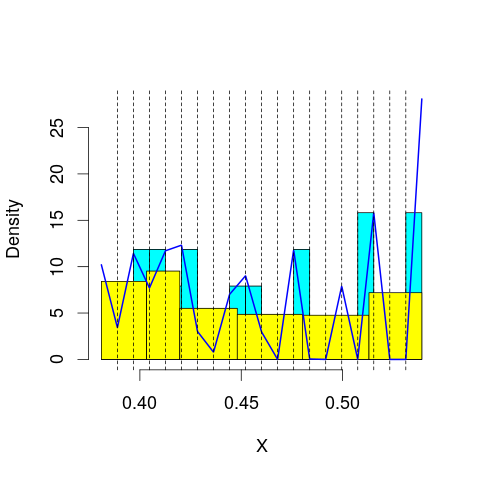

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.62968
mop.approx: Iteration 11. LL = 70.63293
mop.approx: Iteration 21. LL = 70.65181
mop.approx: Iteration 31. LL = 70.65453
mop.approx: Converged. Iteration 35. LL = 70.65497
[1] "Computing the linear combination of B-splines"


32.5318765023
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.43038
mop.approx: Iteration 11. LL = 67.04041
mop.approx: Iteration 21. LL = 67.20313
mop.approx: Iteration 31. LL = 67.24755
mop.approx: Iteration 41. LL = 67.2641
mop.approx: Iteration 51. LL = 67.27128
mop.approx: Iteration 61. LL = 67.27476
mop.approx: Iteration 71. LL = 67.27658
mop.approx: Iteration 81. LL = 67.27757
mop.approx: Converged. Iteration 83. LL = 67.27777
[1] "Computing the linear combination of B-splines"


27.4218110626
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.66497
mop.approx: Iteration 11. LL = 58.87486
mop.approx: Iteration 21. LL = 58.91628
mop.approx: Iteration 31. LL = 58.92344
mop.approx: Iteration 41. LL = 58.92624
mop.approx: Iteration 51. LL = 58.92766
mop.approx: Iteration 61. LL = 58.92848
mop.approx: Converged. Iteration 62. LL = 58.9286
[1] "Computing the linear combination of B-splines"


17.3397662882
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.39047
mop.approx: Iteration 11. LL = 57.4453
mop.approx: Iteration 21. LL = 57.60998
mop.approx: Iteration 31. LL = 57.65536
mop.approx: Iteration 41. LL = 57.67173
mop.approx: Iteration 51. LL = 57.67852
mop.approx: Iteration 61. LL = 57.68166
mop.approx: Iteration 71. LL = 57.68326
mop.approx: Iteration 81. LL = 57.68413
mop.approx: Converged. Iteration 83. LL = 57.68431
[1] "Computing the linear combination of B-splines"


14.3626112058
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.863571
mop.approx: Iteration 11. LL = 57.6889
mop.approx: Iteration 21. LL = 57.77915
mop.approx: Iteration 31. LL = 57.78698
mop.approx: Iteration 41. LL = 57.78892
mop.approx: Converged. Iteration 48. LL = 57.78953
[1] "Computing the linear combination of B-splines"


12.7348765074
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.898427
mop.approx: Iteration 11. LL = 57.36634
mop.approx: Iteration 21. LL = 57.58189
mop.approx: Iteration 31. LL = 57.63606
mop.approx: Iteration 41. LL = 57.65264
mop.approx: Iteration 51. LL = 57.65869
mop.approx: Iteration 61. LL = 57.66128
mop.approx: Iteration 71. LL = 57.66256
mop.approx: Converged. Iteration 80. LL = 57.66328
[1] "Computing the linear combination of B-splines"


10.8780457144
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.370881
mop.approx: Iteration 11. LL = 57.32349
mop.approx: Iteration 21. LL = 57.47597
mop.approx: Iteration 31. LL = 57.50474
mop.approx: Iteration 41. LL = 57.51503
mop.approx: Iteration 51. LL = 57.51975
mop.approx: Iteration 61. LL = 57.52228
mop.approx: Iteration 71. LL = 57.52376
mop.approx: Iteration 81. LL = 57.52468
mop.approx: Converged. Iteration 86. LL = 57.52506
[1] "Computing the linear combination of B-splines"


8.8684153865
lfps_24
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 94.57868
mop.approx: Converged. Iteration 9. LL = 95.33388
[1] "Computing the linear combination of B-splines"


90.1352760143
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 90.135276014345195)
m reached
('Sum of Probabilities:', 0.9777052805356794)
chosen


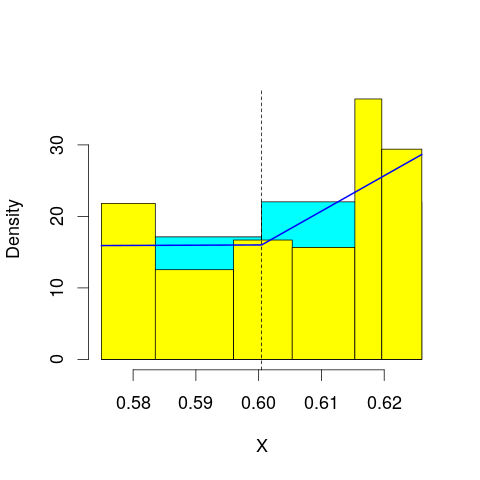

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.96969
mop.approx: Iteration 11. LL = 94.6844
mop.approx: Converged. Iteration 12. LL = 94.68458
[1] "Computing the linear combination of B-splines"


87.7531083571
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.37208
mop.approx: Iteration 11. LL = 94.01448
mop.approx: Converged. Iteration 16. LL = 94.01573
[1] "Computing the linear combination of B-splines"


85.3513925988
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 25.47779
mop.approx: Iteration 11. LL = 61.50392
mop.approx: Iteration 21. LL = 61.55258
mop.approx: Iteration 31. LL = 61.55857
mop.approx: Converged. Iteration 37. LL = 61.55931
[1] "Computing the linear combination of B-splines"


51.1621034757
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06985
mop.approx: Iteration 11. LL = 66.01168
mop.approx: Converged. Iteration 14. LL = 66.01288
[1] "Computing the linear combination of B-splines"


53.8828071206
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.73349
mop.approx: Iteration 11. LL = 55.16597
mop.approx: Iteration 21. LL = 55.29718
mop.approx: Iteration 31. LL = 55.35409
mop.approx: Iteration 41. LL = 55.38181
mop.approx: Iteration 51. LL = 55.39674
mop.approx: Iteration 61. LL = 55.40544
mop.approx: Iteration 71. LL = 55.41084
mop.approx: Iteration 81. LL = 55.41436
mop.approx: Iteration 91. LL = 55.41675
mop.approx: Iteration 101. LL = 55.41843
mop.approx: Iteration 111. LL = 55.41963
mop.approx: Iteration 121. LL = 55.42052
mop.approx: Iteration 131. LL = 55.42119
mop.approx: Converged. Iteration 133. LL = 55.42136
[1] "Computing the linear combination of B-splines"


41.5584154113
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.161131
mop.approx: Iteration 11. LL = 58.77726
mop.approx: Converged. Iteration 18. LL = 58.79042
[1] "Computing the linear combination of B-splines"


43.194611808
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.161166
mop.approx: Iteration 11. LL = 50.5894
mop.approx: Iteration 21. LL = 50.709
mop.approx: Iteration 31. LL = 50.78181
mop.approx: Iteration 41. LL = 50.82748
mop.approx: Iteration 51. LL = 50.85732
mop.approx: Iteration 61. LL = 50.87764
mop.approx: Iteration 71. LL = 50.89198
mop.approx: Iteration 81. LL = 50.90244
mop.approx: Iteration 91. LL = 50.91026
mop.approx: Iteration 101. LL = 50.91625
mop.approx: Iteration 111. LL = 50.92092
mop.approx: Iteration 121. LL = 50.92463
mop.approx: Iteration 131. LL = 50.9276
mop.approx: Iteration 141. LL = 50.93002
mop.approx: Iteration 151. LL = 50.93201
mop.approx: Iteration 161. LL = 50.93365
mop.approx: Iteration 171. LL = 50.93502
mop.approx: Iteration 181. LL = 50.93617
mop.approx: Iteration 191. LL = 50.93714
mop.approx: Iteration 201. LL = 50.93795
mop.approx: Iteration 211. LL = 50.

33.610877854
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 94.57868
mop.approx: Converged. Iteration 8. LL = 95.42841
[1] "Computing the linear combination of B-splines"


88.4969338189
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 88.496933818889829)
m reached
('Sum of Probabilities:', 0.9761959410361557)
chosen


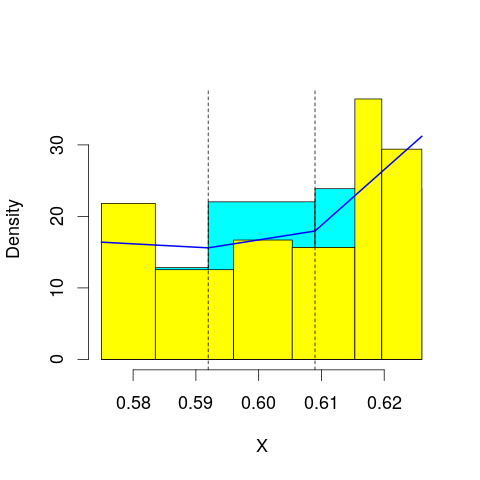

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.96969
mop.approx: Iteration 11. LL = 94.8551
mop.approx: Iteration 21. LL = 94.883
mop.approx: Iteration 31. LL = 94.88932
mop.approx: Converged. Iteration 40. LL = 94.89105
[1] "Computing the linear combination of B-splines"


86.2267054133
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.37208
mop.approx: Iteration 11. LL = 94.14283
mop.approx: Iteration 21. LL = 94.17202
mop.approx: Iteration 31. LL = 94.18413
mop.approx: Iteration 41. LL = 94.18945
mop.approx: Iteration 51. LL = 94.19188
mop.approx: Converged. Iteration 58. LL = 94.19285
[1] "Computing the linear combination of B-splines"


83.7956425143
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 25.47779
mop.approx: Iteration 11. LL = 80.3273
mop.approx: Converged. Iteration 13. LL = 80.32805
[1] "Computing the linear combination of B-splines"


68.1979724473
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06985
mop.approx: Iteration 11. LL = 66.54811
mop.approx: Iteration 21. LL = 66.57041
mop.approx: Converged. Iteration 27. LL = 66.5715
[1] "Computing the linear combination of B-splines"


52.7085591843
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.73349
mop.approx: Iteration 11. LL = 69.99185
mop.approx: Converged. Iteration 15. LL = 69.99424
[1] "Computing the linear combination of B-splines"


54.3984240901
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.161131
mop.approx: Iteration 11. LL = 59.16279
mop.approx: Iteration 21. LL = 59.28365
mop.approx: Iteration 31. LL = 59.32695
mop.approx: Iteration 41. LL = 59.345
mop.approx: Iteration 51. LL = 59.35345
mop.approx: Iteration 61. LL = 59.35776
mop.approx: Iteration 71. LL = 59.36008
mop.approx: Iteration 81. LL = 59.3614
mop.approx: Iteration 91. LL = 59.36217
mop.approx: Converged. Iteration 91. LL = 59.36223
[1] "Computing the linear combination of B-splines"


42.0335525702
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.161166
mop.approx: Iteration 11. LL = 62.16164
mop.approx: Converged. Iteration 18. LL = 62.17782
[1] "Computing the linear combination of B-splines"


43.1162666807
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 94.57868
mop.approx: Iteration 11. LL = 96.16984
mop.approx: Converged. Iteration 19. LL = 96.17577
[1] "Computing the linear combination of B-splines"


87.5114283875
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 87.51142838751818)
m reached
('Sum of Probabilities:', 0.9700153496667848)
chosen


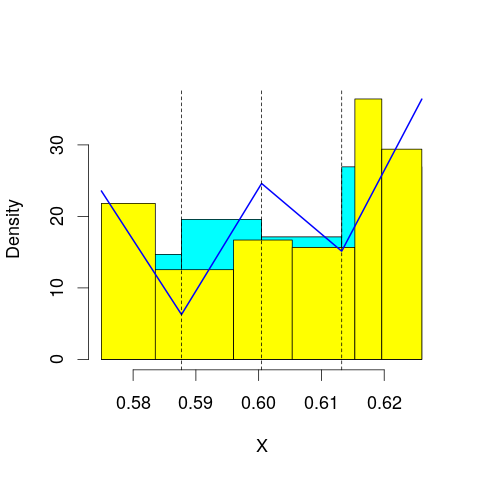

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.96969
mop.approx: Iteration 11. LL = 95.08353
mop.approx: Iteration 21. LL = 95.11862
mop.approx: Iteration 31. LL = 95.12454
mop.approx: Converged. Iteration 39. LL = 95.12591
[1] "Computing the linear combination of B-splines"


84.7287032386
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.37208
mop.approx: Iteration 11. LL = 94.71631
mop.approx: Iteration 21. LL = 94.94462
mop.approx: Iteration 31. LL = 95.03979
mop.approx: Iteration 41. LL = 95.0846
mop.approx: Iteration 51. LL = 95.10752
mop.approx: Iteration 61. LL = 95.11989
mop.approx: Iteration 71. LL = 95.12684
mop.approx: Iteration 81. LL = 95.13087
mop.approx: Iteration 91. LL = 95.13329
mop.approx: Iteration 101. LL = 95.1348
mop.approx: Converged. Iteration 106. LL = 95.13544
[1] "Computing the linear combination of B-splines"


83.0053620549
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 25.47779
mop.approx: Converged. Iteration 10. LL = 80.86464
[1] "Computing the linear combination of B-splines"


67.0016943761
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06985
mop.approx: Iteration 11. LL = 82.60019
mop.approx: Converged. Iteration 17. LL = 82.60711
[1] "Computing the linear combination of B-splines"


67.0112972353
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.73349
mop.approx: Iteration 11. LL = 70.54196
mop.approx: Iteration 21. LL = 70.55167
mop.approx: Converged. Iteration 21. LL = 70.55174
[1] "Computing the linear combination of B-splines"


53.223057991
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.161131
mop.approx: Iteration 11. LL = 73.20234
mop.approx: Converged. Iteration 16. LL = 73.20705
[1] "Computing the linear combination of B-splines"


54.1455079354
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.161166
mop.approx: Iteration 11. LL = 62.59676
mop.approx: Iteration 21. LL = 62.70174
mop.approx: Iteration 31. LL = 62.73227
mop.approx: Iteration 41. LL = 62.74283
mop.approx: Iteration 51. LL = 62.74694
mop.approx: Iteration 61. LL = 62.74866
mop.approx: Converged. Iteration 68. LL = 62.74932
[1] "Computing the linear combination of B-splines"


41.9549279015
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 94.57868
mop.approx: Iteration 11. LL = 97.33438
mop.approx: Iteration 21. LL = 97.39363
mop.approx: Iteration 31. LL = 97.40372
mop.approx: Iteration 41. LL = 97.40594
mop.approx: Converged. Iteration 41. LL = 97.40604
[1] "Computing the linear combination of B-splines"


87.0088286684
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 87.008828668369787)
m reached
('Sum of Probabilities:', 0.9680614942895183)
chosen


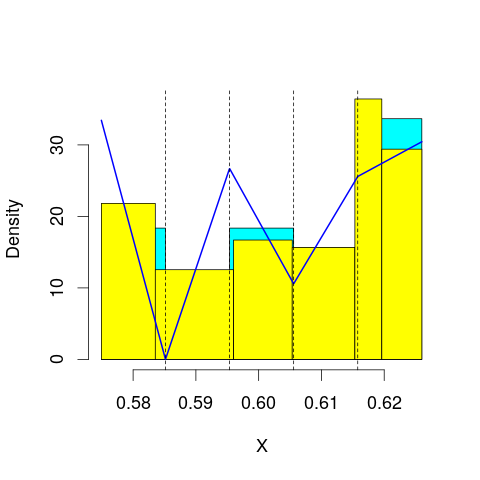

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.96969
mop.approx: Iteration 11. LL = 95.24705
mop.approx: Iteration 21. LL = 95.27763
mop.approx: Iteration 31. LL = 95.28076
mop.approx: Converged. Iteration 31. LL = 95.28084
[1] "Computing the linear combination of B-splines"


83.1507678246
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.37208
mop.approx: Iteration 11. LL = 95.55842
mop.approx: Iteration 21. LL = 95.66446
mop.approx: Iteration 31. LL = 95.67181
mop.approx: Converged. Iteration 34. LL = 95.67228
[1] "Computing the linear combination of B-splines"


81.8093408511
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 25.47779
mop.approx: Converged. Iteration 9. LL = 81.29443
[1] "Computing the linear combination of B-splines"


65.6986189033
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06985
mop.approx: Iteration 11. LL = 83.15433
mop.approx: Converged. Iteration 12. LL = 83.15462
[1] "Computing the linear combination of B-splines"


65.8259421406
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.73349
mop.approx: Iteration 11. LL = 83.92915
mop.approx: Iteration 21. LL = 83.96571
mop.approx: Converged. Iteration 21. LL = 83.96579
[1] "Computing the linear combination of B-splines"


64.9042338704
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.161131
mop.approx: Iteration 11. LL = 73.76349
mop.approx: Converged. Iteration 18. LL = 73.76762
[1] "Computing the linear combination of B-splines"


52.973293516
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.161166
mop.approx: Iteration 11. LL = 75.82001
mop.approx: Converged. Iteration 17. LL = 75.82919
[1] "Computing the linear combination of B-splines"


53.3020554987
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 94.57868
mop.approx: Iteration 11. LL = 96.16878
mop.approx: Converged. Iteration 15. LL = 96.17002
[1] "Computing the linear combination of B-splines"


84.0399475333
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 84.039947533347828)
m reached
('Sum of Probabilities:', 0.971699424123099)
chosen


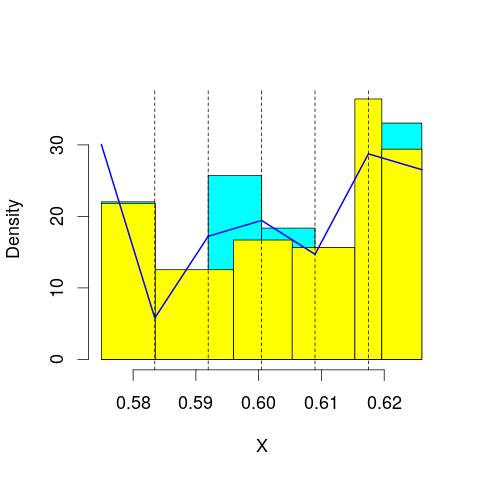

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.96969
mop.approx: Iteration 11. LL = 96.52102
mop.approx: Iteration 21. LL = 96.57511
mop.approx: Iteration 31. LL = 96.5799
mop.approx: Converged. Iteration 32. LL = 96.58009
[1] "Computing the linear combination of B-splines"


82.7171477211
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.37208
mop.approx: Iteration 11. LL = 95.75972
mop.approx: Iteration 21. LL = 95.84186
mop.approx: Iteration 31. LL = 95.84934
mop.approx: Converged. Iteration 40. LL = 95.85086
[1] "Computing the linear combination of B-splines"


80.255047861
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 25.47779
mop.approx: Iteration 11. LL = 81.48468
mop.approx: Converged. Iteration 16. LL = 81.48604
[1] "Computing the linear combination of B-splines"


64.157362632
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06985
mop.approx: Iteration 11. LL = 83.20587
mop.approx: Converged. Iteration 11. LL = 83.20593
[1] "Computing the linear combination of B-splines"


64.1443879579
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.73349
mop.approx: Iteration 11. LL = 84.5146
mop.approx: Converged. Iteration 15. LL = 84.51845
[1] "Computing the linear combination of B-splines"


63.7237575559
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.161131
mop.approx: Iteration 11. LL = 84.53501
mop.approx: Iteration 21. LL = 84.65132
mop.approx: Converged. Iteration 29. LL = 84.65515
[1] "Computing the linear combination of B-splines"


62.1295168331
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.161166
mop.approx: Iteration 11. LL = 76.40225
mop.approx: Converged. Iteration 16. LL = 76.40415
[1] "Computing the linear combination of B-splines"


52.1398167337
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 94.57868
mop.approx: Iteration 11. LL = 97.00432
mop.approx: Converged. Iteration 14. LL = 97.00502
[1] "Computing the linear combination of B-splines"


83.1420768839
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 83.142076883935715)
m reached
('Sum of Probabilities:', 0.9756357432349674)
chosen


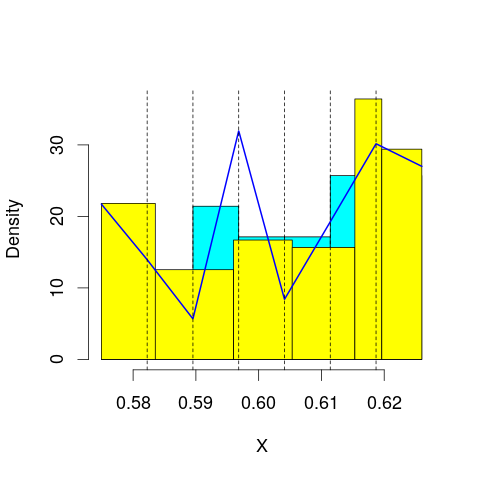

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.96969
mop.approx: Iteration 11. LL = 96.61432
mop.approx: Iteration 21. LL = 96.63268
mop.approx: Converged. Iteration 23. LL = 96.63299
[1] "Computing the linear combination of B-splines"


81.0371814308
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.37208
mop.approx: Iteration 11. LL = 96.39429
mop.approx: Iteration 21. LL = 96.53288
mop.approx: Iteration 31. LL = 96.56908
mop.approx: Iteration 41. LL = 96.58374
mop.approx: Iteration 51. LL = 96.591
mop.approx: Iteration 61. LL = 96.59505
mop.approx: Iteration 71. LL = 96.59751
mop.approx: Iteration 81. LL = 96.59911
mop.approx: Converged. Iteration 89. LL = 96.60011
[1] "Computing the linear combination of B-splines"


79.2714307903
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 25.47779
mop.approx: Iteration 11. LL = 81.45699
mop.approx: Iteration 21. LL = 81.46151
mop.approx: Converged. Iteration 24. LL = 81.46192
[1] "Computing the linear combination of B-splines"


62.4003748104
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06985
mop.approx: Iteration 11. LL = 83.59901
mop.approx: Iteration 21. LL = 83.61767
mop.approx: Converged. Iteration 30. LL = 83.61981
[1] "Computing the linear combination of B-splines"


62.825390799
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.73349
mop.approx: Iteration 11. LL = 84.60191
mop.approx: Converged. Iteration 15. LL = 84.60399
[1] "Computing the linear combination of B-splines"


62.0765239966
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.161131
mop.approx: Iteration 11. LL = 85.17404
mop.approx: Converged. Iteration 20. LL = 85.20074
[1] "Computing the linear combination of B-splines"


60.9413655712
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.161166
mop.approx: Iteration 11. LL = 84.00861
mop.approx: Iteration 21. LL = 84.22591
mop.approx: Iteration 31. LL = 84.25468
mop.approx: Iteration 41. LL = 84.26081
mop.approx: Converged. Iteration 49. LL = 84.26215
[1] "Computing the linear combination of B-splines"


58.3316390894
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 94.57868
mop.approx: Iteration 11. LL = 97.94983
mop.approx: Iteration 21. LL = 97.95905
mop.approx: Converged. Iteration 21. LL = 97.95913
[1] "Computing the linear combination of B-splines"


82.3633214344
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 82.363321434392404)
m reached
('Sum of Probabilities:', 0.977052888701672)
chosen


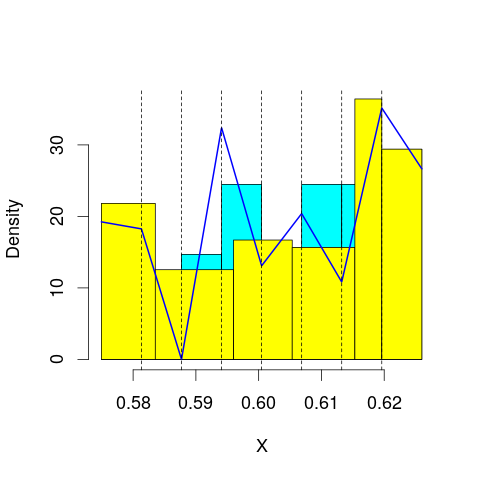

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.96969
mop.approx: Iteration 11. LL = 96.99163
mop.approx: Iteration 21. LL = 97.03685
mop.approx: Iteration 31. LL = 97.0406
mop.approx: Converged. Iteration 32. LL = 97.04079
[1] "Computing the linear combination of B-splines"


79.7121116013
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.37208
mop.approx: Iteration 11. LL = 96.595
mop.approx: Iteration 21. LL = 96.68307
mop.approx: Iteration 31. LL = 96.69736
mop.approx: Iteration 41. LL = 96.70175
mop.approx: Iteration 51. LL = 96.70349
mop.approx: Converged. Iteration 53. LL = 96.70379
[1] "Computing the linear combination of B-splines"


77.6422383852
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 25.47779
mop.approx: Iteration 11. LL = 82.19855
mop.approx: Iteration 21. LL = 82.35284
mop.approx: Iteration 31. LL = 82.38543
mop.approx: Iteration 41. LL = 82.3928
mop.approx: Converged. Iteration 50. LL = 82.39447
[1] "Computing the linear combination of B-splines"


61.6000551183
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06985
mop.approx: Iteration 11. LL = 83.53657
mop.approx: Iteration 21. LL = 83.5389
mop.approx: Converged. Iteration 22. LL = 83.53907
[1] "Computing the linear combination of B-splines"


61.0117628349
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.73349
mop.approx: Iteration 11. LL = 85.16142
mop.approx: Iteration 21. LL = 85.22137
mop.approx: Iteration 31. LL = 85.23753
mop.approx: Iteration 41. LL = 85.24419
mop.approx: Iteration 51. LL = 85.24759
mop.approx: Iteration 61. LL = 85.24955
mop.approx: Iteration 71. LL = 85.25077
mop.approx: Converged. Iteration 74. LL = 85.25113
[1] "Computing the linear combination of B-splines"


60.9915359469
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.161131
mop.approx: Iteration 11. LL = 85.51774
mop.approx: Iteration 21. LL = 85.53964
mop.approx: Converged. Iteration 24. LL = 85.54007
[1] "Computing the linear combination of B-splines"


59.5111714751
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.161166
mop.approx: Iteration 11. LL = 76.72723
mop.approx: Iteration 21. LL = 76.99426
mop.approx: Iteration 31. LL = 77.03732
mop.approx: Iteration 41. LL = 77.04444
mop.approx: Converged. Iteration 48. LL = 77.04553
[1] "Computing the linear combination of B-splines"


8.88217640335
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 94.57868
mop.approx: Iteration 11. LL = 98.34825
mop.approx: Iteration 21. LL = 98.37294
mop.approx: Iteration 31. LL = 98.37708
mop.approx: Converged. Iteration 37. LL = 98.37801
[1] "Computing the linear combination of B-splines"


81.049326415
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 81.049326415003165)
m reached
('Sum of Probabilities:', 0.9785030526208089)
chosen


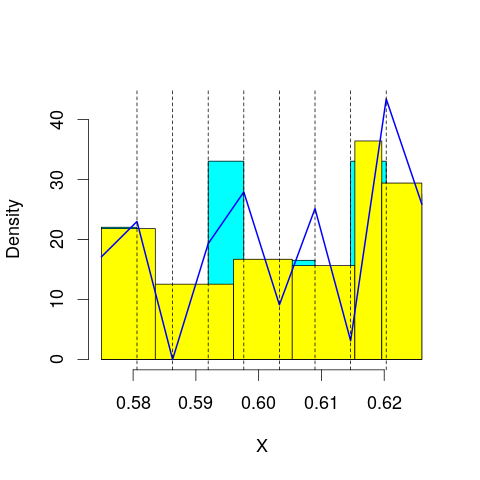

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.96969
mop.approx: Iteration 11. LL = 97.58235
mop.approx: Iteration 21. LL = 97.64844
mop.approx: Iteration 31. LL = 97.65951
mop.approx: Iteration 41. LL = 97.66279
mop.approx: Converged. Iteration 50. LL = 97.66416
[1] "Computing the linear combination of B-splines"


78.6026137574
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.37208
mop.approx: Iteration 11. LL = 96.84108
mop.approx: Iteration 21. LL = 96.99395
mop.approx: Iteration 31. LL = 97.03853
mop.approx: Iteration 41. LL = 97.05727
mop.approx: Iteration 51. LL = 97.06664
mop.approx: Iteration 61. LL = 97.07177
mop.approx: Iteration 71. LL = 97.07475
mop.approx: Iteration 81. LL = 97.07657
mop.approx: Converged. Iteration 90. LL = 97.07772
[1] "Computing the linear combination of B-splines"


76.2833003969
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 25.47779
mop.approx: Iteration 11. LL = 82.69742
mop.approx: Iteration 21. LL = 82.77354
mop.approx: Iteration 31. LL = 82.78773
mop.approx: Iteration 41. LL = 82.79255
mop.approx: Iteration 51. LL = 82.79484
mop.approx: Iteration 61. LL = 82.79616
mop.approx: Converged. Iteration 67. LL = 82.7968
[1] "Computing the linear combination of B-splines"


60.2695155316
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06985
mop.approx: Iteration 11. LL = 83.88793
mop.approx: Iteration 21. LL = 84.02522
mop.approx: Iteration 31. LL = 84.06334
mop.approx: Iteration 41. LL = 84.07388
mop.approx: Iteration 51. LL = 84.07674
mop.approx: Converged. Iteration 55. LL = 84.07724
[1] "Computing the linear combination of B-splines"


59.8170578134
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.73349
mop.approx: Iteration 11. LL = 85.17686
mop.approx: Converged. Iteration 15. LL = 85.17837
[1] "Computing the linear combination of B-splines"


59.1854685053
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.161131
mop.approx: Iteration 11. LL = 86.11243
mop.approx: Iteration 21. LL = 86.19581
mop.approx: Iteration 31. LL = 86.21563
mop.approx: Iteration 41. LL = 86.2217
mop.approx: Iteration 51. LL = 86.2237
mop.approx: Converged. Iteration 53. LL = 86.22398
[1] "Computing the linear combination of B-splines"


58.2907499967
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.161166
[1] "Computing the linear combination of B-splines"


81.3906378751
('best: ', 81.049326415003165, 'accepted difference:', 137.78385490550539, 'cur BIC:', 81.390637875144677)
m reached
('Sum of Probabilities:', 2.9230134428486183)
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 94.57868
mop.approx: Iteration 11. LL = 98.29302
mop.approx: Iteration 21. LL = 98.29875
mop.approx: Converged. Iteration 21. LL = 98.29884
[1] "Computing the linear combination of B-splines"


79.2372883958
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 79.237288395780439)
m reached
('Sum of Probabilities:', 0.976979981031616)
chosen


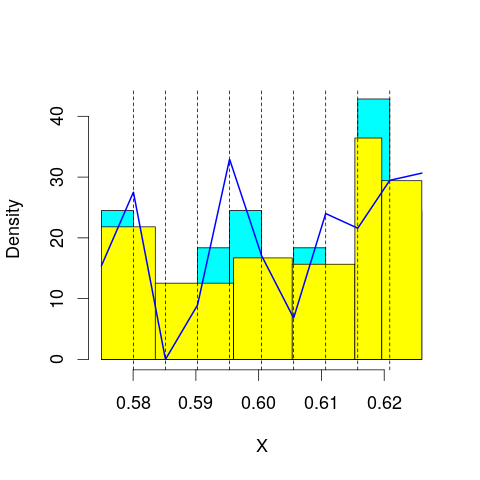

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.96969
mop.approx: Iteration 11. LL = 98.19776
mop.approx: Iteration 21. LL = 98.27436
mop.approx: Iteration 31. LL = 98.28869
mop.approx: Iteration 41. LL = 98.29348
mop.approx: Iteration 51. LL = 98.29558
mop.approx: Converged. Iteration 57. LL = 98.2964
[1] "Computing the linear combination of B-splines"


77.501981263
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.37208
mop.approx: Iteration 11. LL = 96.98674
mop.approx: Iteration 21. LL = 97.02923
mop.approx: Iteration 31. LL = 97.037
mop.approx: Iteration 41. LL = 97.03985
mop.approx: Iteration 51. LL = 97.04125
mop.approx: Converged. Iteration 52. LL = 97.04144
[1] "Computing the linear combination of B-splines"


74.5141615222
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 25.47779
mop.approx: Iteration 11. LL = 82.9015
mop.approx: Iteration 21. LL = 82.94467
mop.approx: Iteration 31. LL = 82.95432
mop.approx: Iteration 41. LL = 82.95806
mop.approx: Iteration 51. LL = 82.95988
mop.approx: Converged. Iteration 60. LL = 82.96091
[1] "Computing the linear combination of B-splines"


58.7007618536
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06985
mop.approx: Iteration 11. LL = 84.3631
mop.approx: Iteration 21. LL = 84.44566
mop.approx: Iteration 31. LL = 84.45549
mop.approx: Converged. Iteration 38. LL = 84.4568
[1] "Computing the linear combination of B-splines"


58.463767595
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.73349
mop.approx: Iteration 11. LL = 85.31167
mop.approx: Iteration 21. LL = 85.41848
mop.approx: Iteration 31. LL = 85.4555
mop.approx: Iteration 41. LL = 85.46753
mop.approx: Iteration 51. LL = 85.47126
mop.approx: Converged. Iteration 58. LL = 85.47225
[1] "Computing the linear combination of B-splines"


57.7428658593
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.161131
mop.approx: Iteration 11. LL = 87.71357
mop.approx: Iteration 21. LL = 87.77184
mop.approx: Iteration 31. LL = 87.78174
mop.approx: Iteration 41. LL = 87.78445
mop.approx: Converged. Iteration 45. LL = 87.78497
[1] "Computing the linear combination of B-splines"


58.1237040076
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.161166
[1] "Computing the linear combination of B-splines"


80.7650089458
('best: ', 79.237288395780439, 'accepted difference:', 134.70339027282674, 'cur BIC:', 80.765008945846688)
m reached
('Sum of Probabilities:', 4.201989433101476)
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 94.57868
mop.approx: Iteration 11. LL = 98.88232
mop.approx: Converged. Iteration 16. LL = 98.88492
[1] "Computing the linear combination of B-splines"


78.0905072037
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 78.090507203681483)
m reached
('Sum of Probabilities:', 0.9737427822627245)
chosen


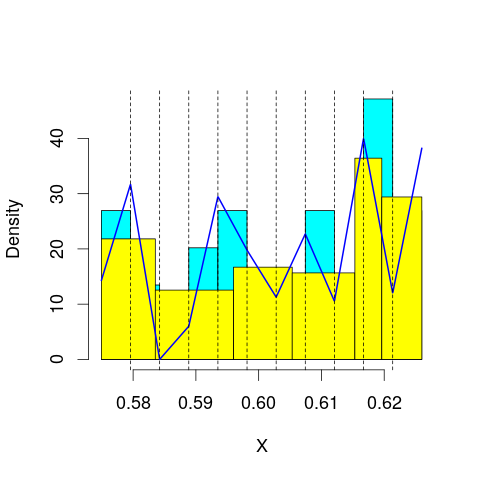

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.96969
mop.approx: Iteration 11. LL = 98.88334
mop.approx: Iteration 21. LL = 99.00312
mop.approx: Iteration 31. LL = 99.0226
mop.approx: Iteration 41. LL = 99.02904
mop.approx: Iteration 51. LL = 99.0319
mop.approx: Iteration 61. LL = 99.03333
mop.approx: Converged. Iteration 62. LL = 99.03353
[1] "Computing the linear combination of B-splines"


76.5062431178
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.37208
mop.approx: Iteration 11. LL = 97.78567
mop.approx: Iteration 21. LL = 97.93799
mop.approx: Iteration 31. LL = 97.9769
mop.approx: Iteration 41. LL = 97.99089
mop.approx: Iteration 51. LL = 97.99717
mop.approx: Iteration 61. LL = 98.00038
mop.approx: Iteration 71. LL = 98.00213
mop.approx: Converged. Iteration 76. LL = 98.00279
[1] "Computing the linear combination of B-splines"


73.7426407576
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 25.47779
mop.approx: Iteration 11. LL = 83.33102
mop.approx: Iteration 21. LL = 83.35338
mop.approx: Iteration 31. LL = 83.36549
mop.approx: Iteration 41. LL = 83.37317
mop.approx: Iteration 51. LL = 83.37812
mop.approx: Iteration 61. LL = 83.38141
mop.approx: Iteration 71. LL = 83.38365
mop.approx: Iteration 81. LL = 83.38523
mop.approx: Iteration 91. LL = 83.38637
mop.approx: Converged. Iteration 96. LL = 83.3869
[1] "Computing the linear combination of B-splines"


57.393877566
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06985
mop.approx: Iteration 11. LL = 84.45195
mop.approx: Iteration 21. LL = 84.49799
mop.approx: Iteration 31. LL = 84.50905
mop.approx: Iteration 41. LL = 84.51437
mop.approx: Iteration 51. LL = 84.51743
mop.approx: Iteration 61. LL = 84.51929
mop.approx: Iteration 71. LL = 84.52046
mop.approx: Converged. Iteration 73. LL = 84.52072
[1] "Computing the linear combination of B-splines"


56.7948269757
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.73349
mop.approx: Iteration 11. LL = 85.79555
mop.approx: Iteration 21. LL = 85.90672
mop.approx: Iteration 31. LL = 85.92513
mop.approx: Iteration 41. LL = 85.92873
mop.approx: Converged. Iteration 45. LL = 85.92928
[1] "Computing the linear combination of B-splines"


56.46421937
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.161131
mop.approx: Iteration 11. LL = 87.9938
mop.approx: Iteration 21. LL = 88.01461
mop.approx: Iteration 31. LL = 88.01945
mop.approx: Iteration 41. LL = 88.02211
mop.approx: Iteration 51. LL = 88.02379
mop.approx: Iteration 61. LL = 88.02488
mop.approx: Converged. Iteration 61. LL = 88.02497
[1] "Computing the linear combination of B-splines"


56.9884884531
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.161166
[1] "Computing the linear combination of B-splines"


-108.848814208
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 94.57868
mop.approx: Iteration 11. LL = 101.3977
mop.approx: Iteration 21. LL = 101.4748
mop.approx: Iteration 31. LL = 101.4873
mop.approx: Iteration 41. LL = 101.491
mop.approx: Iteration 51. LL = 101.4926
mop.approx: Converged. Iteration 52. LL = 101.4928
[1] "Computing the linear combination of B-splines"


78.9654821758
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 78.965482175839668)
m reached
('Sum of Probabilities:', 0.9697487041263732)
chosen


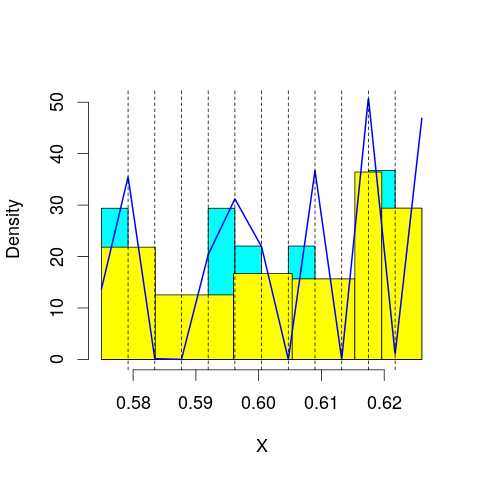

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.96969
mop.approx: Iteration 11. LL = 98.19239
mop.approx: Iteration 21. LL = 98.30518
mop.approx: Iteration 31. LL = 98.33662
mop.approx: Iteration 41. LL = 98.34692
mop.approx: Iteration 51. LL = 98.35057
mop.approx: Converged. Iteration 60. LL = 98.35198
[1] "Computing the linear combination of B-splines"


74.0918298864
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.37208
mop.approx: Iteration 11. LL = 98.98248
mop.approx: Iteration 21. LL = 99.21585
mop.approx: Iteration 31. LL = 99.26284
mop.approx: Iteration 41. LL = 99.28002
mop.approx: Iteration 51. LL = 99.28801
mop.approx: Iteration 61. LL = 99.29222
mop.approx: Iteration 71. LL = 99.29465
mop.approx: Iteration 81. LL = 99.29616
mop.approx: Converged. Iteration 86. LL = 99.2968
[1] "Computing the linear combination of B-splines"


73.3037812921
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 25.47779
mop.approx: Iteration 11. LL = 84.16953
mop.approx: Iteration 21. LL = 84.27687
mop.approx: Iteration 31. LL = 84.30919
mop.approx: Iteration 41. LL = 84.32203
mop.approx: Iteration 51. LL = 84.32786
mop.approx: Iteration 61. LL = 84.33073
mop.approx: Iteration 71. LL = 84.33225
mop.approx: Converged. Iteration 76. LL = 84.33281
[1] "Computing the linear combination of B-splines"


56.6069229783
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06985
mop.approx: Iteration 11. LL = 84.62108
mop.approx: Iteration 21. LL = 84.63836
mop.approx: Converged. Iteration 29. LL = 84.63988
[1] "Computing the linear combination of B-splines"


55.1811201532
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.73349
mop.approx: Iteration 11. LL = 85.9433
mop.approx: Iteration 21. LL = 85.99729
mop.approx: Iteration 31. LL = 86.01135
mop.approx: Iteration 41. LL = 86.01839
mop.approx: Iteration 51. LL = 86.02238
mop.approx: Iteration 61. LL = 86.02468
mop.approx: Iteration 71. LL = 86.02601
mop.approx: Converged. Iteration 74. LL = 86.02637
[1] "Computing the linear combination of B-splines"


54.8338654744
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.161131
mop.approx: Iteration 11. LL = 89.79962
mop.approx: Iteration 21. LL = 89.97314
mop.approx: Iteration 31. LL = 90.01498
mop.approx: Iteration 41. LL = 90.02788
mop.approx: Iteration 51. LL = 90.03232
mop.approx: Iteration 61. LL = 90.0341
mop.approx: Converged. Iteration 65. LL = 90.03459
[1] "Computing the linear combination of B-splines"


56.5826774056
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.161166
[1] "Computing the linear combination of B-splines"


127.499182498
('best: ', 78.965482175839668, 'accepted difference:', 134.24131969892744, 'cur BIC:', 127.49918249798904)
m reached
('Sum of Probabilities:', 18.702641807761882)
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 94.57868
mop.approx: Iteration 11. LL = 101.9133
mop.approx: Iteration 21. LL = 101.9629
mop.approx: Iteration 31. LL = 101.9731
mop.approx: Iteration 41. LL = 101.9768
mop.approx: Iteration 51. LL = 101.9785
mop.approx: Converged. Iteration 53. LL = 101.9788
[1] "Computing the linear combination of B-splines"


77.7186225954
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 77.718622595374768)
m reached
('Sum of Probabilities:', 0.9679277039434326)
chosen


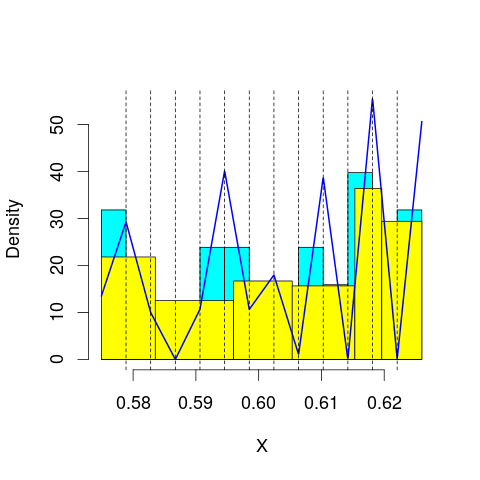

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.96969
mop.approx: Iteration 11. LL = 98.53117
mop.approx: Iteration 21. LL = 98.56971
mop.approx: Iteration 31. LL = 98.57657
mop.approx: Converged. Iteration 40. LL = 98.57838
[1] "Computing the linear combination of B-splines"


72.5853634893
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.37208
mop.approx: Iteration 11. LL = 99.42174
mop.approx: Iteration 21. LL = 99.60715
mop.approx: Iteration 31. LL = 99.64888
mop.approx: Iteration 41. LL = 99.66664
mop.approx: Iteration 51. LL = 99.67475
mop.approx: Iteration 61. LL = 99.67846
mop.approx: Iteration 71. LL = 99.68018
mop.approx: Converged. Iteration 73. LL = 99.68048
[1] "Computing the linear combination of B-splines"


71.9545955438
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 25.47779
mop.approx: Iteration 11. LL = 85.3359
mop.approx: Iteration 21. LL = 85.43448
mop.approx: Iteration 31. LL = 85.45414
mop.approx: Iteration 41. LL = 85.45987
mop.approx: Iteration 51. LL = 85.46188
mop.approx: Converged. Iteration 54. LL = 85.46227
[1] "Computing the linear combination of B-splines"


56.0035142686
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06985
mop.approx: Iteration 11. LL = 84.87315
mop.approx: Iteration 21. LL = 84.91525
mop.approx: Iteration 31. LL = 84.9321
mop.approx: Iteration 41. LL = 84.94109
mop.approx: Iteration 51. LL = 84.94666
mop.approx: Iteration 61. LL = 84.95044
mop.approx: Iteration 71. LL = 84.95315
mop.approx: Iteration 81. LL = 84.95517
mop.approx: Iteration 91. LL = 84.95671
mop.approx: Iteration 101. LL = 84.95791
mop.approx: Iteration 111. LL = 84.95886
mop.approx: Converged. Iteration 111. LL = 84.95894
[1] "Computing the linear combination of B-splines"


53.7670929094
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.73349
mop.approx: Iteration 11. LL = 86.14779
mop.approx: Iteration 21. LL = 86.20849
mop.approx: Iteration 31. LL = 86.22527
mop.approx: Iteration 41. LL = 86.23292
mop.approx: Iteration 51. LL = 86.23707
mop.approx: Iteration 61. LL = 86.23944
mop.approx: Iteration 71. LL = 86.24078
mop.approx: Converged. Iteration 74. LL = 86.24114
[1] "Computing the linear combination of B-splines"


53.3048697468
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.161131
mop.approx: Iteration 11. LL = 94.20704
mop.approx: Iteration 21. LL = 94.31196
mop.approx: Iteration 31. LL = 94.33195
mop.approx: Iteration 41. LL = 94.33956
mop.approx: Iteration 51. LL = 94.34335
mop.approx: Iteration 61. LL = 94.34541
mop.approx: Converged. Iteration 70. LL = 94.34658
[1] "Computing the linear combination of B-splines"


57.6699035968
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.161166
[1] "Computing the linear combination of B-splines"


-52.1986634836
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 94.57868
mop.approx: Iteration 11. LL = 101.6937
mop.approx: Iteration 21. LL = 101.7163
mop.approx: Iteration 31. LL = 101.719
mop.approx: Converged. Iteration 34. LL = 101.7195
[1] "Computing the linear combination of B-splines"


75.7264719443
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 75.726471944336097)
m reached
('Sum of Probabilities:', 0.96746256293903)
chosen


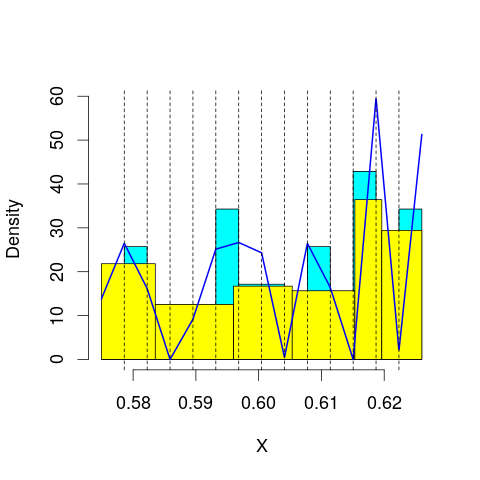

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.96969
mop.approx: Iteration 11. LL = 100.106
mop.approx: Iteration 21. LL = 100.2012
mop.approx: Iteration 31. LL = 100.2145
mop.approx: Iteration 41. LL = 100.219
mop.approx: Iteration 51. LL = 100.2208
mop.approx: Converged. Iteration 53. LL = 100.2211
[1] "Computing the linear combination of B-splines"


72.4952291188
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.37208
mop.approx: Iteration 11. LL = 99.61758
mop.approx: Iteration 21. LL = 99.75541
mop.approx: Iteration 31. LL = 99.77571
mop.approx: Iteration 41. LL = 99.78439
mop.approx: Iteration 51. LL = 99.78963
mop.approx: Iteration 61. LL = 99.79299
mop.approx: Iteration 71. LL = 99.79515
mop.approx: Iteration 81. LL = 99.79652
mop.approx: Converged. Iteration 83. LL = 99.79682
[1] "Computing the linear combination of B-splines"


70.3380629314
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 25.47779
mop.approx: Iteration 11. LL = 86.47385
mop.approx: Iteration 21. LL = 86.57439
mop.approx: Iteration 31. LL = 86.59939
mop.approx: Iteration 41. LL = 86.60728
mop.approx: Iteration 51. LL = 86.60974
mop.approx: Converged. Iteration 54. LL = 86.61015
[1] "Computing the linear combination of B-splines"


55.4185244325
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06985
mop.approx: Iteration 11. LL = 85.58849
mop.approx: Iteration 21. LL = 85.7179
mop.approx: Iteration 31. LL = 85.75654
mop.approx: Iteration 41. LL = 85.76972
mop.approx: Iteration 51. LL = 85.77438
mop.approx: Iteration 61. LL = 85.7761
mop.approx: Converged. Iteration 63. LL = 85.77637
[1] "Computing the linear combination of B-splines"


52.8515582405
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.73349
mop.approx: Iteration 11. LL = 86.22397
mop.approx: Iteration 21. LL = 86.24939
mop.approx: Iteration 31. LL = 86.25852
mop.approx: Iteration 41. LL = 86.26503
mop.approx: Iteration 51. LL = 86.27029
mop.approx: Iteration 61. LL = 86.27462
mop.approx: Iteration 71. LL = 86.2782
mop.approx: Iteration 81. LL = 86.28112
mop.approx: Iteration 91. LL = 86.2835
mop.approx: Iteration 101. LL = 86.28542
mop.approx: Iteration 111. LL = 86.28697
mop.approx: Iteration 121. LL = 86.2882
mop.approx: Iteration 131. LL = 86.28918
mop.approx: Converged. Iteration 132. LL = 86.28935
[1] "Computing the linear combination of B-splines"


51.6133608634
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.161131
[1] "Computing the linear combination of B-splines"


63.421005984
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.161166
[1] "Computing the linear combination of B-splines"


7.64809382121
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 94.57868
mop.approx: Iteration 11. LL = 101.6252
mop.approx: Iteration 21. LL = 101.6852
mop.approx: Iteration 31. LL = 101.6912
mop.approx: Converged. Iteration 34. LL = 101.6917
[1] "Computing the linear combination of B-splines"


73.965792485
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 73.965792484980042)
m reached
('Sum of Probabilities:', 0.9689563778465996)
chosen


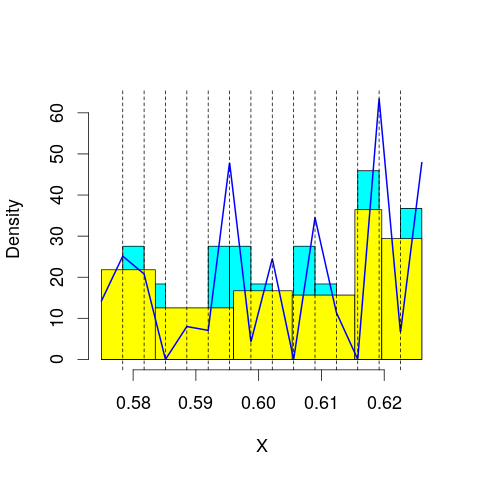

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.96969
mop.approx: Iteration 11. LL = 100.5067
mop.approx: Iteration 21. LL = 100.5867
mop.approx: Iteration 31. LL = 100.5928
mop.approx: Converged. Iteration 36. LL = 100.5936
[1] "Computing the linear combination of B-splines"


71.1348669123
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.37208
mop.approx: Iteration 11. LL = 100.215
mop.approx: Iteration 21. LL = 100.3686
mop.approx: Iteration 31. LL = 100.3932
mop.approx: Iteration 41. LL = 100.4024
mop.approx: Iteration 51. LL = 100.4067
mop.approx: Iteration 61. LL = 100.409
mop.approx: Iteration 71. LL = 100.4105
mop.approx: Converged. Iteration 78. LL = 100.4113
[1] "Computing the linear combination of B-splines"


69.2197184294
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 25.47779
mop.approx: Iteration 11. LL = 87.34066
mop.approx: Iteration 21. LL = 87.40142
mop.approx: Iteration 31. LL = 87.41374
mop.approx: Iteration 41. LL = 87.4174
mop.approx: Converged. Iteration 48. LL = 87.41838
[1] "Computing the linear combination of B-splines"


54.49388487
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06985
mop.approx: Iteration 11. LL = 86.43745
mop.approx: Iteration 21. LL = 86.55246
mop.approx: Iteration 31. LL = 86.57793
mop.approx: Iteration 41. LL = 86.58484
mop.approx: Iteration 51. LL = 86.58689
mop.approx: Converged. Iteration 53. LL = 86.58717
[1] "Computing the linear combination of B-splines"


51.9295354341
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.73349
mop.approx: Iteration 11. LL = 86.40284
mop.approx: Iteration 21. LL = 86.44427
mop.approx: Iteration 31. LL = 86.46521
mop.approx: Iteration 41. LL = 86.47672
mop.approx: Iteration 51. LL = 86.48279
mop.approx: Iteration 61. LL = 86.48593
mop.approx: Iteration 71. LL = 86.48756
mop.approx: Converged. Iteration 76. LL = 86.48815
[1] "Computing the linear combination of B-splines"


50.0860930413
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.161131
[1] "Computing the linear combination of B-splines"


57.6168372012
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.161166
[1] "Computing the linear combination of B-splines"


128.036422181
('best: ', 73.965792484980042, 'accepted difference:', 125.74184722446607, 'cur BIC:', 128.03642218103698)
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 94.57868
mop.approx: Iteration 11. LL = 100.3017
mop.approx: Iteration 21. LL = 100.3286
mop.approx: Converged. Iteration 27. LL = 100.3299
[1] "Computing the linear combination of B-splines"


70.871185514
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 70.871185514037364)
m reached
('Sum of Probabilities:', 0.970573519955982)
chosen


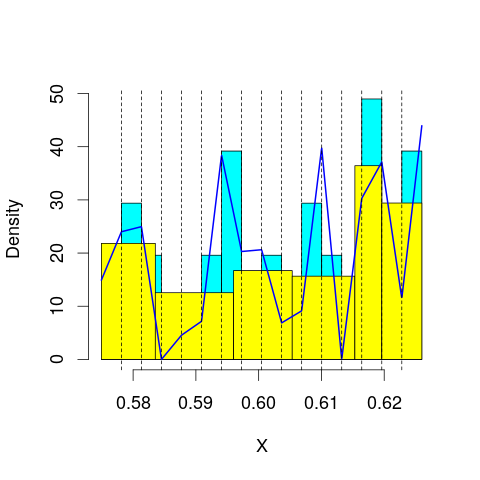

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.96969
mop.approx: Iteration 11. LL = 102.1475
mop.approx: Iteration 21. LL = 102.2432
mop.approx: Iteration 31. LL = 102.2524
mop.approx: Converged. Iteration 38. LL = 102.2539
[1] "Computing the linear combination of B-splines"


71.0622596852
('best: ', 70.871185514037364, 'accepted difference:', 120.48101537386351, 'cur BIC:', 71.062259685174268)
m reached
('Sum of Probabilities:', 0.9644905268856063)
chosen


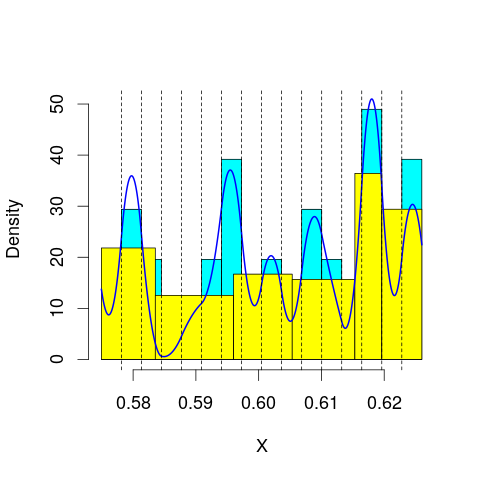

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.37208
mop.approx: Iteration 11. LL = 99.89912
mop.approx: Iteration 21. LL = 99.99851
mop.approx: Iteration 31. LL = 100.0084
mop.approx: Iteration 41. LL = 100.0105
mop.approx: Converged. Iteration 43. LL = 100.0109
[1] "Computing the linear combination of B-splines"


67.0863687272
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 25.47779
mop.approx: Iteration 11. LL = 88.7286
mop.approx: Iteration 21. LL = 88.81225
mop.approx: Iteration 31. LL = 88.82681
mop.approx: Iteration 41. LL = 88.83268
mop.approx: Iteration 51. LL = 88.83563
mop.approx: Iteration 61. LL = 88.83729
mop.approx: Converged. Iteration 69. LL = 88.83824
[1] "Computing the linear combination of B-splines"


54.1808714426
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06985
mop.approx: Iteration 11. LL = 87.07354
mop.approx: Iteration 21. LL = 87.15672
mop.approx: Iteration 31. LL = 87.17853
mop.approx: Iteration 41. LL = 87.18714
mop.approx: Iteration 51. LL = 87.19083
mop.approx: Iteration 61. LL = 87.19246
mop.approx: Converged. Iteration 63. LL = 87.19273
[1] "Computing the linear combination of B-splines"


50.8024864693
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.73349
mop.approx: Iteration 11. LL = 87.04788
mop.approx: Iteration 21. LL = 87.15948
mop.approx: Iteration 31. LL = 87.18758
mop.approx: Iteration 41. LL = 87.19688
mop.approx: Iteration 51. LL = 87.20035
mop.approx: Converged. Iteration 60. LL = 87.2017
[1] "Computing the linear combination of B-splines"


48.8665265967
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.161131
[1] "Computing the linear combination of B-splines"


70.0679169155
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.161166
[1] "Computing the linear combination of B-splines"


-17.7948306068
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 94.57868
mop.approx: Iteration 11. LL = 102.6931
mop.approx: Iteration 21. LL = 102.6986
mop.approx: Converged. Iteration 21. LL = 102.6986
[1] "Computing the linear combination of B-splines"


71.5070233202
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 71.507023320185255)
m reached
('Sum of Probabilities:', 0.9715239341722113)
chosen


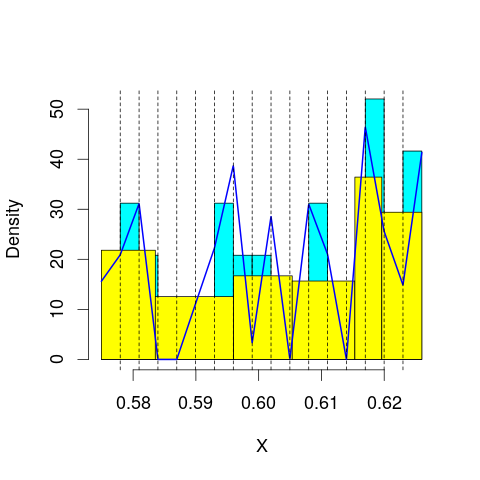

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.96969
mop.approx: Iteration 11. LL = 102.3462
mop.approx: Iteration 21. LL = 102.5014
mop.approx: Iteration 31. LL = 102.5123
mop.approx: Converged. Iteration 35. LL = 102.513
[1] "Computing the linear combination of B-splines"


69.5885312503
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.37208
mop.approx: Iteration 11. LL = 100.7356
mop.approx: Iteration 21. LL = 100.8113
mop.approx: Iteration 31. LL = 100.8251
mop.approx: Iteration 41. LL = 100.8305
mop.approx: Iteration 51. LL = 100.8335
mop.approx: Iteration 61. LL = 100.8353
mop.approx: Iteration 71. LL = 100.8366
mop.approx: Converged. Iteration 71. LL = 100.8367
[1] "Computing the linear combination of B-splines"


66.1793226715
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 25.47779
mop.approx: Iteration 11. LL = 89.85104
mop.approx: Iteration 21. LL = 90.04776
mop.approx: Iteration 31. LL = 90.09668
mop.approx: Iteration 41. LL = 90.12065
mop.approx: Iteration 51. LL = 90.13468
mop.approx: Iteration 61. LL = 90.14312
mop.approx: Iteration 71. LL = 90.14824
mop.approx: Iteration 81. LL = 90.15134
mop.approx: Iteration 91. LL = 90.15324
mop.approx: Iteration 101. LL = 90.15441
mop.approx: Converged. Iteration 101. LL = 90.1545
[1] "Computing the linear combination of B-splines"


53.7642621366
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06985
mop.approx: Iteration 11. LL = 88.03503
mop.approx: Iteration 21. LL = 88.11236
mop.approx: Iteration 31. LL = 88.12781
mop.approx: Iteration 41. LL = 88.13448
mop.approx: Iteration 51. LL = 88.13809
mop.approx: Iteration 61. LL = 88.14025
mop.approx: Iteration 71. LL = 88.14163
mop.approx: Converged. Iteration 77. LL = 88.14232
[1] "Computing the linear combination of B-splines"


50.017951028
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.73349
mop.approx: Iteration 11. LL = 87.17344
mop.approx: Iteration 21. LL = 87.31146
mop.approx: Iteration 31. LL = 87.36242
mop.approx: Iteration 41. LL = 87.39216
mop.approx: Iteration 51. LL = 87.41149
mop.approx: Iteration 61. LL = 87.42435
mop.approx: Iteration 71. LL = 87.43292
mop.approx: Iteration 81. LL = 87.43861
mop.approx: Iteration 91. LL = 87.44239
mop.approx: Iteration 101. LL = 87.44489
mop.approx: Iteration 111. LL = 87.44656
mop.approx: Iteration 121. LL = 87.44768
mop.approx: Converged. Iteration 122. LL = 87.44785
[1] "Computing the linear combination of B-splines"


47.3808020324
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.161131
[1] "Computing the linear combination of B-splines"


89.7947928586
('best: ', 71.507023320185255, 'accepted difference:', 121.56193964431493, 'cur BIC:', 89.794792858609981)
m reached
('Sum of Probabilities:', 7.015594482202366)
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.161166
[1] "Computing the linear combination of B-splines"


-216.622671919
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 94.57868
mop.approx: Iteration 11. LL = 103.1282
mop.approx: Iteration 21. LL = 103.1869
mop.approx: Iteration 31. LL = 103.193
mop.approx: Converged. Iteration 38. LL = 103.1942
[1] "Computing the linear combination of B-splines"


70.2697569443
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 70.269756944316029)
m reached
('Sum of Probabilities:', 0.9703209275802532)
chosen


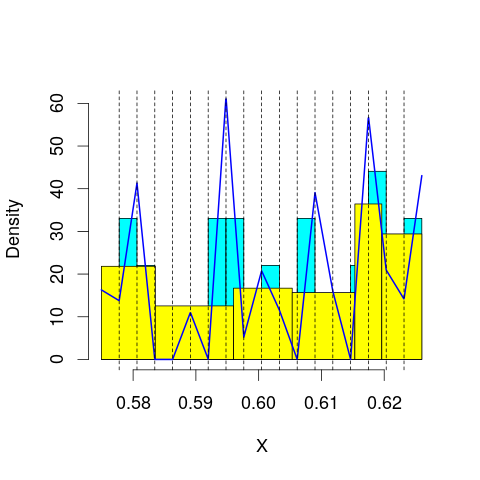

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.96969
mop.approx: Iteration 11. LL = 102.2193
mop.approx: Iteration 21. LL = 102.3414
mop.approx: Iteration 31. LL = 102.3587
mop.approx: Iteration 41. LL = 102.3624
mop.approx: Converged. Iteration 45. LL = 102.363
[1] "Computing the linear combination of B-splines"


67.7056820793
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.37208
mop.approx: Iteration 11. LL = 101.7143
mop.approx: Iteration 21. LL = 101.8982
mop.approx: Iteration 31. LL = 101.9357
mop.approx: Iteration 41. LL = 101.9471
mop.approx: Iteration 51. LL = 101.9512
mop.approx: Iteration 61. LL = 101.953
mop.approx: Converged. Iteration 62. LL = 101.9532
[1] "Computing the linear combination of B-splines"


65.5629847242
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 25.47779
mop.approx: Iteration 11. LL = 90.45955
mop.approx: Iteration 21. LL = 90.60734
mop.approx: Iteration 31. LL = 90.62768
mop.approx: Iteration 41. LL = 90.63312
mop.approx: Iteration 51. LL = 90.6354
mop.approx: Converged. Iteration 60. LL = 90.63658
[1] "Computing the linear combination of B-splines"


52.5134777144
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06985
mop.approx: Iteration 11. LL = 89.20911
mop.approx: Iteration 21. LL = 89.4025
mop.approx: Iteration 31. LL = 89.46563
mop.approx: Iteration 41. LL = 89.49222
mop.approx: Iteration 51. LL = 89.50371
mop.approx: Iteration 61. LL = 89.5088
mop.approx: Iteration 71. LL = 89.51118
mop.approx: Converged. Iteration 80. LL = 89.51236
[1] "Computing the linear combination of B-splines"


49.658161833
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.73349
mop.approx: Iteration 11. LL = 88.09616
mop.approx: Iteration 21. LL = 88.16986
mop.approx: Iteration 31. LL = 88.18614
mop.approx: Iteration 41. LL = 88.19312
mop.approx: Iteration 51. LL = 88.19692
mop.approx: Iteration 61. LL = 88.1992
mop.approx: Iteration 71. LL = 88.20069
mop.approx: Converged. Iteration 80. LL = 88.20171
[1] "Computing the linear combination of B-splines"


46.6053726492
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.161131
[1] "Computing the linear combination of B-splines"


-89.8097293486
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.161166
[1] "Computing the linear combination of B-splines"


-31.3586200068
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 94.57868
mop.approx: Iteration 11. LL = 103.6433
mop.approx: Iteration 21. LL = 103.7143
mop.approx: Iteration 31. LL = 103.737
mop.approx: Iteration 41. LL = 103.7471
mop.approx: Iteration 51. LL = 103.7524
mop.approx: Iteration 61. LL = 103.7554
mop.approx: Iteration 71. LL = 103.7574
mop.approx: Iteration 81. LL = 103.7586
mop.approx: Converged. Iteration 81. LL = 103.7587
[1] "Computing the linear combination of B-splines"


69.1013779323
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 69.101377932274346)
m reached
('Sum of Probabilities:', 0.969473680939358)
chosen


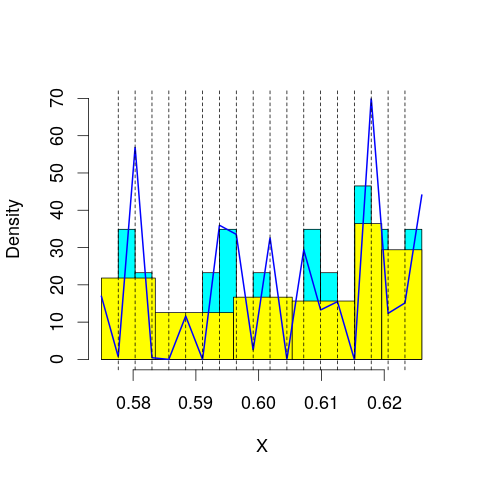

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.96969
mop.approx: Iteration 11. LL = 102.6428
mop.approx: Iteration 21. LL = 102.7277
mop.approx: Iteration 31. LL = 102.7376
mop.approx: Converged. Iteration 39. LL = 102.7393
[1] "Computing the linear combination of B-splines"


66.3490792813
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.37208
mop.approx: Iteration 11. LL = 102.0206
mop.approx: Iteration 21. LL = 102.2456
mop.approx: Iteration 31. LL = 102.299
mop.approx: Iteration 41. LL = 102.3166
mop.approx: Iteration 51. LL = 102.3233
mop.approx: Iteration 61. LL = 102.3262
mop.approx: Iteration 71. LL = 102.3277
mop.approx: Converged. Iteration 71. LL = 102.3278
[1] "Computing the linear combination of B-splines"


64.2046631389
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 25.47779
mop.approx: Iteration 11. LL = 91.23373
mop.approx: Iteration 21. LL = 91.405
mop.approx: Iteration 31. LL = 91.43964
mop.approx: Iteration 41. LL = 91.44817
mop.approx: Iteration 51. LL = 91.45094
mop.approx: Converged. Iteration 59. LL = 91.45203
[1] "Computing the linear combination of B-splines"


51.596065089
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06985
mop.approx: Iteration 11. LL = 89.96256
mop.approx: Iteration 21. LL = 90.10908
mop.approx: Iteration 31. LL = 90.1351
mop.approx: Iteration 41. LL = 90.14438
mop.approx: Iteration 51. LL = 90.14887
mop.approx: Iteration 61. LL = 90.15133
mop.approx: Iteration 71. LL = 90.15279
mop.approx: Converged. Iteration 76. LL = 90.15339
[1] "Computing the linear combination of B-splines"


48.5610676323
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.73349
mop.approx: Iteration 11. LL = 89.74146
mop.approx: Iteration 21. LL = 89.96073
mop.approx: Iteration 31. LL = 89.99719
mop.approx: Iteration 41. LL = 90.00588
mop.approx: Iteration 51. LL = 90.00863
mop.approx: Converged. Iteration 57. LL = 90.00945
[1] "Computing the linear combination of B-splines"


46.8021298909
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.161131
[1] "Computing the linear combination of B-splines"


70.1827613948
('best: ', 69.101377932274346, 'accepted difference:', 117.47234248486639, 'cur BIC:', 70.182761394829271)
m reached
('Sum of Probabilities:', 6.937101462045027)
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.161166
[1] "Computing the linear combination of B-splines"


39.0702019614
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 94.57868
mop.approx: Iteration 11. LL = 104.1375
mop.approx: Iteration 21. LL = 104.2537
mop.approx: Iteration 31. LL = 104.2854
mop.approx: Iteration 41. LL = 104.2967
mop.approx: Iteration 51. LL = 104.3013
mop.approx: Iteration 61. LL = 104.3035
mop.approx: Converged. Iteration 66. LL = 104.3042
[1] "Computing the linear combination of B-splines"


67.9139607798
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 67.913960779796653)
m reached
('Sum of Probabilities:', 0.9691756990379321)
chosen


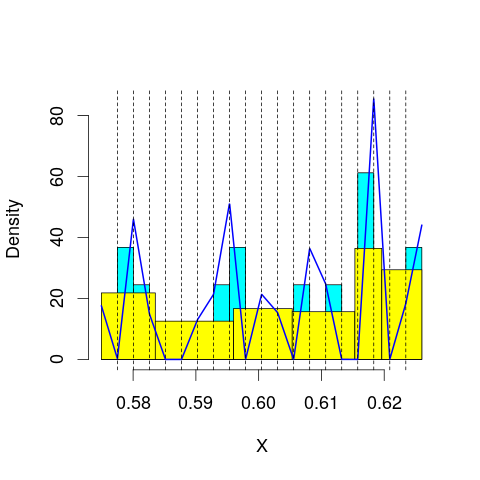

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.96969
mop.approx: Iteration 11. LL = 103.0177
mop.approx: Iteration 21. LL = 103.0983
mop.approx: Iteration 31. LL = 103.1089
mop.approx: Iteration 41. LL = 103.1123
mop.approx: Iteration 51. LL = 103.1138
mop.approx: Converged. Iteration 51. LL = 103.1139
[1] "Computing the linear combination of B-splines"


64.9907851902
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 93.37208
mop.approx: Iteration 11. LL = 102.6111
mop.approx: Iteration 21. LL = 102.8689
mop.approx: Iteration 31. LL = 102.9181
mop.approx: Iteration 41. LL = 102.9287
mop.approx: Iteration 51. LL = 102.9311
mop.approx: Converged. Iteration 52. LL = 102.9313
[1] "Computing the linear combination of B-splines"


63.0753564385
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 25.47779
mop.approx: Iteration 11. LL = 91.95351
mop.approx: Iteration 21. LL = 92.12984
mop.approx: Iteration 31. LL = 92.15956
mop.approx: Iteration 41. LL = 92.16556
mop.approx: Iteration 51. LL = 92.16733
mop.approx: Converged. Iteration 53. LL = 92.16761
[1] "Computing the linear combination of B-splines"


50.5787985155
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 19.06985
mop.approx: Iteration 11. LL = 90.80162
mop.approx: Iteration 21. LL = 90.98086
mop.approx: Iteration 31. LL = 91.01021
mop.approx: Iteration 41. LL = 91.01592
mop.approx: Converged. Iteration 48. LL = 91.0171
[1] "Computing the linear combination of B-splines"


47.6920710614
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.73349
mop.approx: Iteration 11. LL = 89.69183
mop.approx: Iteration 21. LL = 89.88883
mop.approx: Iteration 31. LL = 89.94262
mop.approx: Iteration 41. LL = 89.9578
mop.approx: Iteration 51. LL = 89.96254
mop.approx: Iteration 61. LL = 89.96429
mop.approx: Converged. Iteration 64. LL = 89.96467
[1] "Computing the linear combination of B-splines"


44.2409951262
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.161131
[1] "Computing the linear combination of B-splines"


-72.3900712422
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.161166
[1] "Computing the linear combination of B-splines"


253.527944703
('best: ', 67.913960779796653, 'accepted difference:', 115.4537333256543, 'cur BIC:', 253.52794470251558)
lfps_25
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.41966
mop.approx: Iteration 11. LL = 66.7982
mop.approx: Converged. Iteration 11. LL = 66.79826
[1] "Computing the linear combination of B-splines"


61.5996534408
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 61.599653440808339)
m reached
('Sum of Probabilities:', 0.991202961428869)
chosen


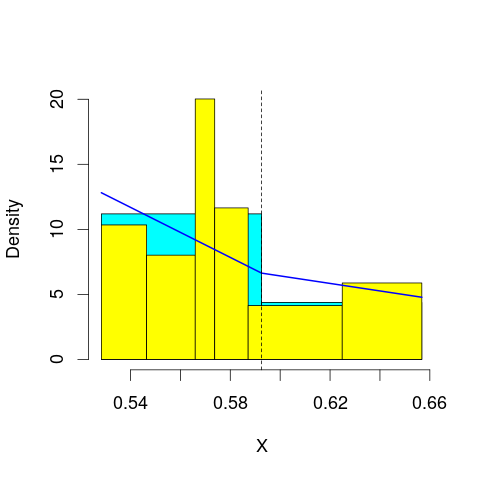

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.17343
mop.approx: Iteration 11. LL = 67.46046
mop.approx: Iteration 21. LL = 67.56016
mop.approx: Iteration 31. LL = 67.5846
mop.approx: Iteration 41. LL = 67.59417
mop.approx: Iteration 51. LL = 67.59893
mop.approx: Iteration 61. LL = 67.60165
mop.approx: Iteration 71. LL = 67.60337
mop.approx: Iteration 81. LL = 67.60453
mop.approx: Iteration 91. LL = 67.60535
mop.approx: Converged. Iteration 92. LL = 67.60549
[1] "Computing the linear combination of B-splines"


60.6740169132
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.92909
mop.approx: Iteration 11. LL = 66.97769
mop.approx: Iteration 21. LL = 66.99387
mop.approx: Iteration 31. LL = 66.99846
mop.approx: Iteration 41. LL = 67.00121
mop.approx: Iteration 51. LL = 67.00296
mop.approx: Iteration 61. LL = 67.00409
mop.approx: Converged. Iteration 69. LL = 67.00479
[1] "Computing the linear combination of B-splines"


58.3404499862
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.40907
mop.approx: Iteration 11. LL = 52.08173
mop.approx: Iteration 21. LL = 52.09267
mop.approx: Converged. Iteration 21. LL = 52.09272
[1] "Computing the linear combination of B-splines"


41.6955087946
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.86333
mop.approx: Iteration 11. LL = 54.08936
mop.approx: Iteration 21. LL = 54.16755
mop.approx: Converged. Iteration 25. LL = 54.16814
[1] "Computing the linear combination of B-splines"


42.0380609236
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.13821
mop.approx: Iteration 11. LL = 48.38511
mop.approx: Iteration 21. LL = 48.49372
mop.approx: Iteration 31. LL = 48.511
mop.approx: Iteration 41. LL = 48.51484
mop.approx: Iteration 51. LL = 48.51583
mop.approx: Converged. Iteration 51. LL = 48.51588
[1] "Computing the linear combination of B-splines"


34.6529377015
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.02188
mop.approx: Iteration 11. LL = 50.10695
mop.approx: Iteration 21. LL = 50.24891
mop.approx: Converged. Iteration 28. LL = 50.25082
[1] "Computing the linear combination of B-splines"


34.6550064175
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.375211
mop.approx: Iteration 11. LL = 45.2733
mop.approx: Iteration 21. LL = 45.4834
mop.approx: Iteration 31. LL = 45.54554
mop.approx: Iteration 41. LL = 45.57052
mop.approx: Iteration 51. LL = 45.58275
mop.approx: Iteration 61. LL = 45.58958
mop.approx: Iteration 71. LL = 45.59376
mop.approx: Iteration 81. LL = 45.5965
mop.approx: Iteration 91. LL = 45.5984
mop.approx: Iteration 101. LL = 45.59977
mop.approx: Iteration 111. LL = 45.60079
mop.approx: Iteration 121. LL = 45.60157
mop.approx: Iteration 131. LL = 45.60218
mop.approx: Converged. Iteration 139. LL = 45.60262
[1] "Computing the linear combination of B-splines"


28.2739416134
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.41966
mop.approx: Iteration 11. LL = 68.53624
mop.approx: Converged. Iteration 16. LL = 68.53818
[1] "Computing the linear combination of B-splines"


61.606711536
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 61.606711535963875)
m reached
('Sum of Probabilities:', 0.991926856315016)
chosen


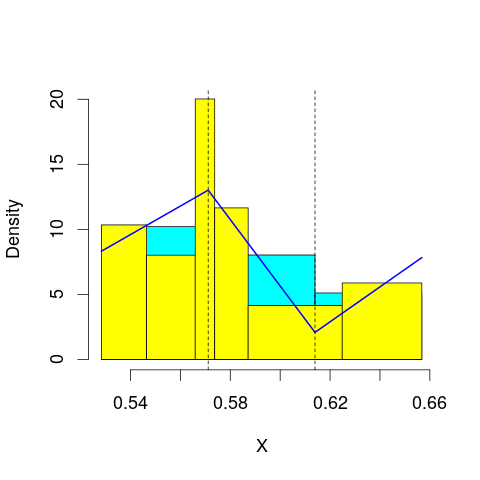

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.17343
mop.approx: Iteration 11. LL = 67.20305
mop.approx: Converged. Iteration 16. LL = 67.20398
[1] "Computing the linear combination of B-splines"


58.5396373326
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.92909
mop.approx: Iteration 11. LL = 67.73188
mop.approx: Iteration 21. LL = 67.97076
mop.approx: Iteration 31. LL = 68.0461
mop.approx: Iteration 41. LL = 68.07106
mop.approx: Iteration 51. LL = 68.07944
mop.approx: Iteration 61. LL = 68.08226
mop.approx: Converged. Iteration 69. LL = 68.08316
[1] "Computing the linear combination of B-splines"


57.685951169
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.40907
mop.approx: Iteration 11. LL = 58.84104
mop.approx: Iteration 21. LL = 59.03606
mop.approx: Iteration 31. LL = 59.06959
mop.approx: Iteration 41. LL = 59.07987
mop.approx: Iteration 51. LL = 59.08353
mop.approx: Iteration 61. LL = 59.08491
mop.approx: Converged. Iteration 64. LL = 59.08518
[1] "Computing the linear combination of B-splines"


46.9551078909
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.86333
mop.approx: Iteration 11. LL = 55.61824
mop.approx: Converged. Iteration 17. LL = 55.62088
[1] "Computing the linear combination of B-splines"


41.7579330375
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.13821
mop.approx: Iteration 11. LL = 56.2482
mop.approx: Iteration 21. LL = 56.43467
mop.approx: Iteration 31. LL = 56.44104
mop.approx: Converged. Iteration 32. LL = 56.44116
[1] "Computing the linear combination of B-splines"


40.8453455628
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.02188
mop.approx: Iteration 11. LL = 51.52875
mop.approx: Iteration 21. LL = 51.59545
mop.approx: Iteration 31. LL = 51.60169
mop.approx: Converged. Iteration 37. LL = 51.60236
[1] "Computing the linear combination of B-splines"


34.2736789469
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.375211
mop.approx: Iteration 11. LL = 52.43613
mop.approx: Iteration 21. LL = 52.65245
mop.approx: Iteration 31. LL = 52.65837
mop.approx: Converged. Iteration 32. LL = 52.65846
[1] "Computing the linear combination of B-splines"


33.5969085857
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.41966
mop.approx: Iteration 11. LL = 67.70776
mop.approx: Converged. Iteration 12. LL = 67.70796
[1] "Computing the linear combination of B-splines"


59.0436242723
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 59.043624272327484)
m reached
('Sum of Probabilities:', 0.9924635034808503)
chosen


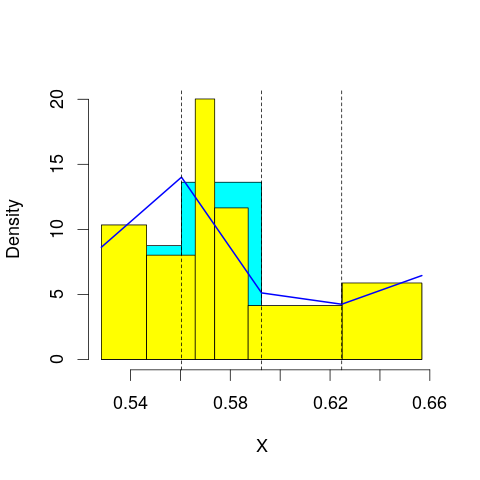

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.17343
mop.approx: Iteration 11. LL = 68.90043
mop.approx: Iteration 21. LL = 69.01024
mop.approx: Iteration 31. LL = 69.03405
mop.approx: Iteration 41. LL = 69.04238
mop.approx: Iteration 51. LL = 69.04616
mop.approx: Iteration 61. LL = 69.04817
mop.approx: Iteration 71. LL = 69.04934
mop.approx: Converged. Iteration 77. LL = 69.04989
[1] "Computing the linear combination of B-splines"


58.6526782358
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.92909
mop.approx: Iteration 11. LL = 68.86822
mop.approx: Iteration 21. LL = 69.07043
mop.approx: Iteration 31. LL = 69.12551
mop.approx: Iteration 41. LL = 69.14707
mop.approx: Iteration 51. LL = 69.1576
mop.approx: Iteration 61. LL = 69.1635
mop.approx: Iteration 71. LL = 69.16711
mop.approx: Iteration 81. LL = 69.16947
mop.approx: Iteration 91. LL = 69.17108
mop.approx: Iteration 101. LL = 69.17223
mop.approx: Iteration 111. LL = 69.17308
mop.approx: Converged. Iteration 113. LL = 69.1733
[1] "Computing the linear combination of B-splines"


57.0432196339
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.40907
mop.approx: Iteration 11. LL = 61.03118
mop.approx: Iteration 21. LL = 61.09282
mop.approx: Converged. Iteration 30. LL = 61.09526
[1] "Computing the linear combination of B-splines"


47.2323115992
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.86333
mop.approx: Iteration 11. LL = 58.62476
mop.approx: Iteration 21. LL = 58.7908
mop.approx: Iteration 31. LL = 58.80345
mop.approx: Converged. Iteration 37. LL = 58.80433
[1] "Computing the linear combination of B-splines"


43.2085192623
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.13821
mop.approx: Iteration 11. LL = 57.9713
mop.approx: Converged. Iteration 15. LL = 57.97328
[1] "Computing the linear combination of B-splines"


40.6446020356
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.02188
mop.approx: Iteration 11. LL = 57.51066
mop.approx: Iteration 21. LL = 57.81115
mop.approx: Iteration 31. LL = 57.84477
mop.approx: Iteration 41. LL = 57.84953
mop.approx: Converged. Iteration 46. LL = 57.85008
[1] "Computing the linear combination of B-splines"


38.7885322686
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.375211
mop.approx: Iteration 11. LL = 54.00109
mop.approx: Iteration 21. LL = 54.04115
mop.approx: Converged. Iteration 30. LL = 54.04313
[1] "Computing the linear combination of B-splines"


33.2487099464
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.41966
mop.approx: Converged. Iteration 10. LL = 68.76303
[1] "Computing the linear combination of B-splines"


58.3658201849
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 58.365820184912252)
m reached
('Sum of Probabilities:', 0.9912422414227182)
chosen


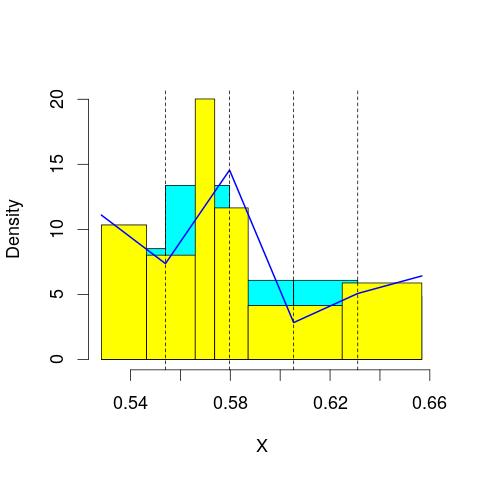

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.17343
mop.approx: Iteration 11. LL = 69.82976
mop.approx: Iteration 21. LL = 69.96938
mop.approx: Iteration 31. LL = 69.99765
mop.approx: Iteration 41. LL = 70.00481
mop.approx: Iteration 51. LL = 70.00689
mop.approx: Converged. Iteration 55. LL = 70.00732
[1] "Computing the linear combination of B-splines"


57.8772397042
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.92909
mop.approx: Iteration 11. LL = 69.40948
mop.approx: Iteration 21. LL = 69.60266
mop.approx: Iteration 31. LL = 69.64769
mop.approx: Iteration 41. LL = 69.6608
mop.approx: Iteration 51. LL = 69.66523
mop.approx: Iteration 61. LL = 69.66692
mop.approx: Converged. Iteration 66. LL = 69.6674
[1] "Computing the linear combination of B-splines"


55.8044574128
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.40907
mop.approx: Iteration 11. LL = 62.14349
mop.approx: Iteration 21. LL = 62.2033
mop.approx: Iteration 31. LL = 62.20873
mop.approx: Converged. Iteration 38. LL = 62.20962
[1] "Computing the linear combination of B-splines"


46.6138082491
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.86333
mop.approx: Iteration 11. LL = 60.52629
mop.approx: Iteration 21. LL = 60.65838
mop.approx: Iteration 31. LL = 60.67412
mop.approx: Iteration 41. LL = 60.67641
mop.approx: Converged. Iteration 42. LL = 60.67654
[1] "Computing the linear combination of B-splines"


43.3478616889
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.13821
mop.approx: Iteration 11. LL = 58.69657
mop.approx: Iteration 21. LL = 58.73385
mop.approx: Iteration 31. LL = 58.73675
mop.approx: Converged. Iteration 32. LL = 58.73687
[1] "Computing the linear combination of B-splines"


39.6753232313
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.02188
mop.approx: Iteration 11. LL = 59.4514
mop.approx: Converged. Iteration 19. LL = 59.46324
[1] "Computing the linear combination of B-splines"


38.6688276003
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.375211
mop.approx: Iteration 11. LL = 58.20742
mop.approx: Iteration 21. LL = 58.51442
mop.approx: Iteration 31. LL = 58.5669
mop.approx: Iteration 41. LL = 58.5854
mop.approx: Iteration 51. LL = 58.59354
mop.approx: Iteration 61. LL = 58.59751
mop.approx: Iteration 71. LL = 58.59955
mop.approx: Iteration 81. LL = 58.60062
mop.approx: Converged. Iteration 85. LL = 58.60095
[1] "Computing the linear combination of B-splines"


36.0736688377
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.41966
mop.approx: Iteration 11. LL = 70.78527
mop.approx: Iteration 21. LL = 70.8243
mop.approx: Iteration 31. LL = 70.8312
mop.approx: Iteration 41. LL = 70.83326
mop.approx: Converged. Iteration 47. LL = 70.83389
[1] "Computing the linear combination of B-splines"


58.7038107133
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 58.703810713277832)
m reached
('Sum of Probabilities:', 0.9894844410480933)
chosen


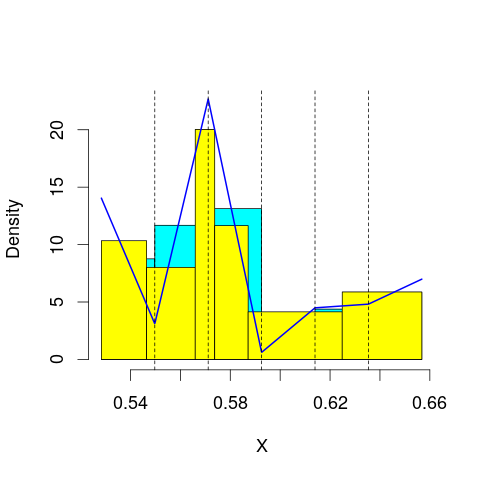

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.17343
mop.approx: Iteration 11. LL = 69.84534
mop.approx: Iteration 21. LL = 69.90477
mop.approx: Iteration 31. LL = 69.91693
mop.approx: Iteration 41. LL = 69.92108
mop.approx: Iteration 51. LL = 69.92293
mop.approx: Iteration 61. LL = 69.9239
mop.approx: Converged. Iteration 62. LL = 69.92404
[1] "Computing the linear combination of B-splines"


56.0610935175
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.92909
mop.approx: Iteration 11. LL = 70.33971
mop.approx: Iteration 21. LL = 70.43697
mop.approx: Iteration 31. LL = 70.46665
mop.approx: Iteration 41. LL = 70.48192
mop.approx: Iteration 51. LL = 70.4908
mop.approx: Iteration 61. LL = 70.49613
mop.approx: Iteration 71. LL = 70.49935
mop.approx: Iteration 81. LL = 70.5013
mop.approx: Iteration 91. LL = 70.50248
mop.approx: Converged. Iteration 96. LL = 70.50295
[1] "Computing the linear combination of B-splines"


54.9071358135
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.40907
mop.approx: Iteration 11. LL = 62.96626
mop.approx: Iteration 21. LL = 63.02718
mop.approx: Iteration 31. LL = 63.03515
mop.approx: Converged. Iteration 39. LL = 63.03637
[1] "Computing the linear combination of B-splines"


45.7076951789
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.86333
mop.approx: Iteration 11. LL = 62.97966
mop.approx: Iteration 21. LL = 63.26903
mop.approx: Iteration 31. LL = 63.30712
mop.approx: Iteration 41. LL = 63.31406
mop.approx: Iteration 51. LL = 63.31548
mop.approx: Converged. Iteration 51. LL = 63.31554
[1] "Computing the linear combination of B-splines"


44.2539909048
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.13821
mop.approx: Iteration 11. LL = 60.3463
mop.approx: Iteration 21. LL = 60.44762
mop.approx: Iteration 31. LL = 60.46706
mop.approx: Iteration 41. LL = 60.47228
mop.approx: Iteration 51. LL = 60.47392
mop.approx: Converged. Iteration 55. LL = 60.47427
[1] "Computing the linear combination of B-splines"


39.6798527688
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.02188
mop.approx: Iteration 11. LL = 59.43698
mop.approx: Converged. Iteration 16. LL = 59.4403
[1] "Computing the linear combination of B-splines"


36.913016524
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.375211
mop.approx: Iteration 11. LL = 60.23013
mop.approx: Iteration 21. LL = 60.28889
mop.approx: Converged. Iteration 27. LL = 60.29021
[1] "Computing the linear combination of B-splines"


36.0300448848
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.41966
mop.approx: Iteration 11. LL = 69.95029
mop.approx: Converged. Iteration 17. LL = 69.95193
[1] "Computing the linear combination of B-splines"


56.0889874075
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 56.088987407541744)
m reached
('Sum of Probabilities:', 0.989347256275573)
chosen


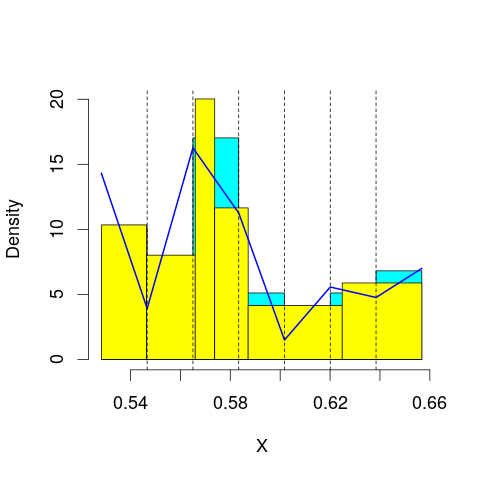

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.17343
mop.approx: Iteration 11. LL = 70.92304
mop.approx: Iteration 21. LL = 71.00745
mop.approx: Iteration 31. LL = 71.02623
mop.approx: Iteration 41. LL = 71.03166
mop.approx: Iteration 51. LL = 71.0334
mop.approx: Converged. Iteration 54. LL = 71.03372
[1] "Computing the linear combination of B-splines"


55.4379040173
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.92909
mop.approx: Iteration 11. LL = 70.30232
mop.approx: Iteration 21. LL = 70.33356
mop.approx: Iteration 31. LL = 70.34008
mop.approx: Iteration 41. LL = 70.34319
mop.approx: Iteration 51. LL = 70.34494
mop.approx: Iteration 61. LL = 70.34602
mop.approx: Converged. Iteration 66. LL = 70.34649
[1] "Computing the linear combination of B-splines"


53.0178058948
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.40907
mop.approx: Iteration 11. LL = 63.73474
mop.approx: Iteration 21. LL = 63.81668
mop.approx: Iteration 31. LL = 63.84208
mop.approx: Iteration 41. LL = 63.85028
mop.approx: Iteration 51. LL = 63.85298
mop.approx: Converged. Iteration 59. LL = 63.85383
[1] "Computing the linear combination of B-splines"


44.7922777133
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.86333
mop.approx: Iteration 11. LL = 63.63472
mop.approx: Iteration 21. LL = 63.72373
mop.approx: Iteration 31. LL = 63.72774
mop.approx: Converged. Iteration 32. LL = 63.72787
[1] "Computing the linear combination of B-splines"


42.9334564503
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.13821
mop.approx: Iteration 11. LL = 62.75177
mop.approx: Iteration 21. LL = 63.07283
mop.approx: Iteration 31. LL = 63.10357
mop.approx: Iteration 41. LL = 63.10676
mop.approx: Converged. Iteration 43. LL = 63.10696
[1] "Computing the linear combination of B-splines"


40.5796740197
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.02188
mop.approx: Iteration 11. LL = 60.86163
mop.approx: Iteration 21. LL = 60.97474
mop.approx: Iteration 31. LL = 61.00323
mop.approx: Iteration 41. LL = 61.01444
mop.approx: Iteration 51. LL = 61.01997
mop.approx: Iteration 61. LL = 61.02308
mop.approx: Iteration 71. LL = 61.02499
mop.approx: Iteration 81. LL = 61.02622
mop.approx: Iteration 91. LL = 61.02705
mop.approx: Converged. Iteration 94. LL = 61.0273
[1] "Computing the linear combination of B-splines"


36.7671360654
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.375211
mop.approx: Iteration 11. LL = 60.46896
mop.approx: Iteration 21. LL = 60.52145
mop.approx: Converged. Iteration 29. LL = 60.52349
[1] "Computing the linear combination of B-splines"


34.5305449483
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.41966
mop.approx: Iteration 11. LL = 71.04724
mop.approx: Iteration 21. LL = 71.07316
mop.approx: Converged. Iteration 25. LL = 71.07385
[1] "Computing the linear combination of B-splines"


55.4780417438
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 55.478041743810522)
m reached
('Sum of Probabilities:', 0.9895898282348276)
chosen


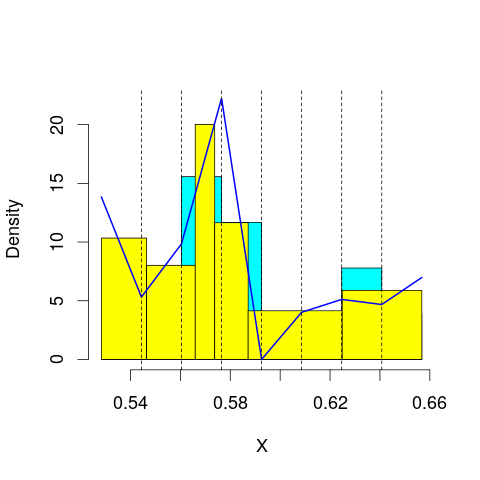

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.17343
mop.approx: Iteration 11. LL = 70.79296
mop.approx: Iteration 21. LL = 70.81389
mop.approx: Converged. Iteration 26. LL = 70.81484
[1] "Computing the linear combination of B-splines"


53.4861641987
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.92909
mop.approx: Iteration 11. LL = 71.20112
mop.approx: Iteration 21. LL = 71.34809
mop.approx: Iteration 31. LL = 71.37713
mop.approx: Iteration 41. LL = 71.38477
mop.approx: Iteration 51. LL = 71.38728
mop.approx: Converged. Iteration 58. LL = 71.38807
[1] "Computing the linear combination of B-splines"


52.3265237671
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.40907
mop.approx: Iteration 11. LL = 63.6273
mop.approx: Iteration 21. LL = 63.66096
mop.approx: Iteration 31. LL = 63.67151
mop.approx: Iteration 41. LL = 63.6755
mop.approx: Iteration 51. LL = 63.67707
mop.approx: Converged. Iteration 55. LL = 63.67745
[1] "Computing the linear combination of B-splines"


42.8830325076
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.86333
mop.approx: Iteration 11. LL = 64.32471
mop.approx: Iteration 21. LL = 64.39265
mop.approx: Iteration 31. LL = 64.41058
mop.approx: Iteration 41. LL = 64.41687
mop.approx: Iteration 51. LL = 64.41901
mop.approx: Converged. Iteration 57. LL = 64.4196
[1] "Computing the linear combination of B-splines"


41.8923145692
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.13821
mop.approx: Iteration 11. LL = 63.60885
mop.approx: Iteration 21. LL = 63.82931
mop.approx: Iteration 31. LL = 63.85157
mop.approx: Iteration 41. LL = 63.85716
mop.approx: Iteration 51. LL = 63.85921
mop.approx: Converged. Iteration 59. LL = 63.86
[1] "Computing the linear combination of B-splines"


39.5998522349
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.02188
mop.approx: Iteration 11. LL = 62.55887
mop.approx: Iteration 21. LL = 62.73389
mop.approx: Iteration 31. LL = 62.74805
mop.approx: Converged. Iteration 38. LL = 62.74916
[1] "Computing the linear combination of B-splines"


36.7561513304
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.375211
mop.approx: Iteration 11. LL = 61.61553
mop.approx: Iteration 21. LL = 61.73888
mop.approx: Iteration 31. LL = 61.76624
mop.approx: Iteration 41. LL = 61.77477
mop.approx: Iteration 51. LL = 61.77771
mop.approx: Iteration 61. LL = 61.77876
mop.approx: Converged. Iteration 61. LL = 61.77882
[1] "Computing the linear combination of B-splines"


34.0534076766
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.41966
mop.approx: Iteration 11. LL = 70.72228
mop.approx: Iteration 21. LL = 70.76392
mop.approx: Iteration 31. LL = 70.76966
mop.approx: Converged. Iteration 35. LL = 70.7702
[1] "Computing the linear combination of B-splines"


53.4415206618
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 53.441520661769218)
m reached
('Sum of Probabilities:', 0.98892627443612)
chosen


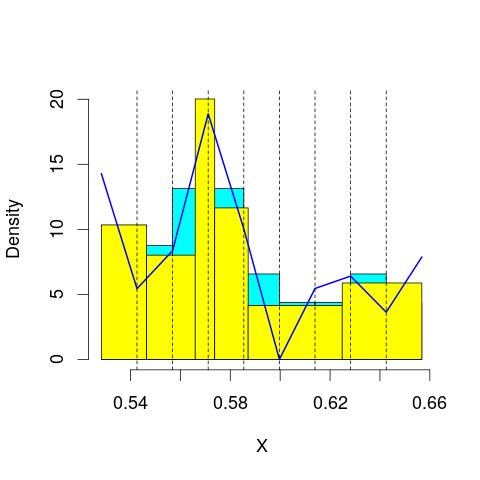

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.17343
mop.approx: Iteration 11. LL = 71.93365
mop.approx: Iteration 21. LL = 71.99079
mop.approx: Iteration 31. LL = 71.99474
mop.approx: Converged. Iteration 35. LL = 71.99518
[1] "Computing the linear combination of B-splines"


52.9336365738
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.92909
mop.approx: Iteration 11. LL = 71.27005
mop.approx: Iteration 21. LL = 71.40264
mop.approx: Iteration 31. LL = 71.43388
mop.approx: Iteration 41. LL = 71.44185
mop.approx: Iteration 51. LL = 71.44412
mop.approx: Converged. Iteration 56. LL = 71.44464
[1] "Computing the linear combination of B-splines"


50.6502228494
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.40907
mop.approx: Iteration 11. LL = 64.02875
mop.approx: Iteration 21. LL = 64.10614
mop.approx: Iteration 31. LL = 64.11389
mop.approx: Converged. Iteration 36. LL = 64.1145
[1] "Computing the linear combination of B-splines"


41.5872131821
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.86333
mop.approx: Iteration 11. LL = 64.33003
mop.approx: Iteration 21. LL = 64.36276
mop.approx: Iteration 31. LL = 64.3709
mop.approx: Iteration 41. LL = 64.37503
mop.approx: Iteration 51. LL = 64.37731
mop.approx: Iteration 61. LL = 64.37856
mop.approx: Converged. Iteration 67. LL = 64.37909
[1] "Computing the linear combination of B-splines"


40.118941325
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.13821
mop.approx: Iteration 11. LL = 64.32358
mop.approx: Iteration 21. LL = 64.51761
mop.approx: Iteration 31. LL = 64.5364
mop.approx: Iteration 41. LL = 64.5402
mop.approx: Iteration 51. LL = 64.5414
mop.approx: Converged. Iteration 52. LL = 64.54153
[1] "Computing the linear combination of B-splines"


38.5485040592
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.02188
mop.approx: Iteration 11. LL = 63.35636
mop.approx: Iteration 21. LL = 63.61117
mop.approx: Iteration 31. LL = 63.65992
mop.approx: Iteration 41. LL = 63.67344
mop.approx: Iteration 51. LL = 63.67761
mop.approx: Iteration 61. LL = 63.67891
mop.approx: Converged. Iteration 62. LL = 63.67903
[1] "Computing the linear combination of B-splines"


35.9532431759
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.375211
mop.approx: Iteration 11. LL = 62.80044
mop.approx: Iteration 21. LL = 62.8969
mop.approx: Iteration 31. LL = 62.90614
mop.approx: Converged. Iteration 37. LL = 62.90699
[1] "Computing the linear combination of B-splines"


33.4449245013
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.41966
mop.approx: Iteration 11. LL = 72.73861
mop.approx: Iteration 21. LL = 72.78119
mop.approx: Iteration 31. LL = 72.78527
mop.approx: Iteration 41. LL = 72.78662
mop.approx: Converged. Iteration 44. LL = 72.78693
[1] "Computing the linear combination of B-splines"


53.7253868631
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 53.725386863126197)
m reached
('Sum of Probabilities:', 0.9877620635510022)
chosen


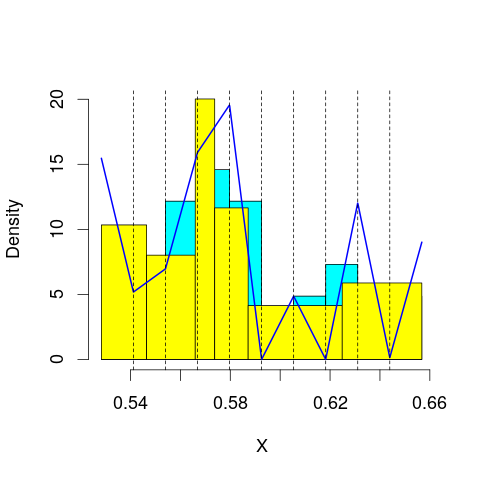

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.17343
mop.approx: Iteration 11. LL = 71.98838
mop.approx: Iteration 21. LL = 72.02812
mop.approx: Iteration 31. LL = 72.03346
mop.approx: Iteration 41. LL = 72.03519
mop.approx: Converged. Iteration 46. LL = 72.03571
[1] "Computing the linear combination of B-splines"


51.2412961316
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.92909
mop.approx: Iteration 11. LL = 72.15247
mop.approx: Iteration 21. LL = 72.3389
mop.approx: Iteration 31. LL = 72.37628
mop.approx: Iteration 41. LL = 72.38591
mop.approx: Iteration 51. LL = 72.38886
mop.approx: Iteration 61. LL = 72.38997
mop.approx: Converged. Iteration 61. LL = 72.39004
[1] "Computing the linear combination of B-splines"


49.8627594647
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.40907
mop.approx: Iteration 11. LL = 64.15825
mop.approx: Iteration 21. LL = 64.243
mop.approx: Iteration 31. LL = 64.25542
mop.approx: Iteration 41. LL = 64.25766
mop.approx: Converged. Iteration 43. LL = 64.25787
[1] "Computing the linear combination of B-splines"


39.9977138255
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.86333
mop.approx: Iteration 11. LL = 64.56668
mop.approx: Iteration 21. LL = 64.6458
mop.approx: Iteration 31. LL = 64.65406
mop.approx: Converged. Iteration 36. LL = 64.65477
[1] "Computing the linear combination of B-splines"


38.661751224
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.13821
mop.approx: Iteration 11. LL = 64.4667
mop.approx: Iteration 21. LL = 64.57392
mop.approx: Iteration 31. LL = 64.58475
mop.approx: Iteration 41. LL = 64.58819
mop.approx: Iteration 51. LL = 64.58986
mop.approx: Iteration 61. LL = 64.59077
mop.approx: Converged. Iteration 62. LL = 64.59089
[1] "Computing the linear combination of B-splines"


36.864981805
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.02188
mop.approx: Iteration 11. LL = 63.88345
mop.approx: Iteration 21. LL = 64.10985
mop.approx: Iteration 31. LL = 64.1536
mop.approx: Iteration 41. LL = 64.1659
mop.approx: Iteration 51. LL = 64.17026
mop.approx: Iteration 61. LL = 64.17206
mop.approx: Converged. Iteration 69. LL = 64.17281
[1] "Computing the linear combination of B-splines"


34.713281185
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.375211
mop.approx: Iteration 11. LL = 63.36512
mop.approx: Iteration 21. LL = 63.52938
mop.approx: Iteration 31. LL = 63.56303
mop.approx: Iteration 41. LL = 63.57454
mop.approx: Iteration 51. LL = 63.57982
mop.approx: Iteration 61. LL = 63.58268
mop.approx: Iteration 71. LL = 63.5844
mop.approx: Iteration 81. LL = 63.58551
mop.approx: Converged. Iteration 90. LL = 63.58626
[1] "Computing the linear combination of B-splines"


32.3895881112
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.41966
mop.approx: Iteration 11. LL = 72.10401
mop.approx: Iteration 21. LL = 72.13315
mop.approx: Converged. Iteration 27. LL = 72.13445
[1] "Computing the linear combination of B-splines"


51.3400334104
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 51.340033410360618)
m reached
('Sum of Probabilities:', 0.9867914275980197)
chosen


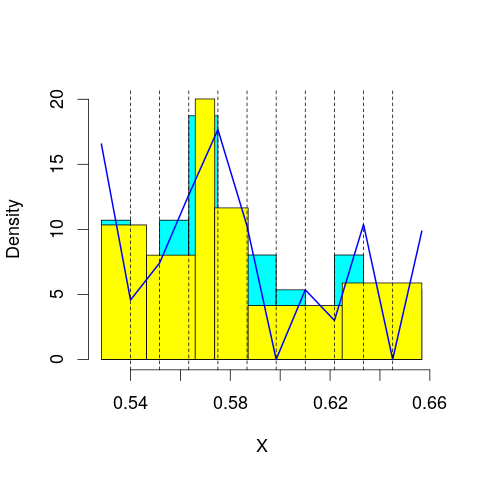

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.17343
mop.approx: Iteration 11. LL = 72.94539
mop.approx: Iteration 21. LL = 73.0079
mop.approx: Iteration 31. LL = 73.01535
mop.approx: Iteration 41. LL = 73.0177
mop.approx: Iteration 51. LL = 73.01876
mop.approx: Converged. Iteration 51. LL = 73.01883
[1] "Computing the linear combination of B-splines"


50.4915468224
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.92909
mop.approx: Iteration 11. LL = 72.27084
mop.approx: Iteration 21. LL = 72.3957
mop.approx: Iteration 31. LL = 72.4071
mop.approx: Iteration 41. LL = 72.40911
mop.approx: Converged. Iteration 45. LL = 72.40953
[1] "Computing the linear combination of B-splines"


48.1493807508
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.40907
mop.approx: Iteration 11. LL = 64.44063
mop.approx: Iteration 21. LL = 64.50457
mop.approx: Iteration 31. LL = 64.52192
mop.approx: Iteration 41. LL = 64.5302
mop.approx: Iteration 51. LL = 64.53442
mop.approx: Iteration 61. LL = 64.53659
mop.approx: Iteration 71. LL = 64.5377
mop.approx: Converged. Iteration 74. LL = 64.53798
[1] "Computing the linear combination of B-splines"


38.5449603641
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.86333
mop.approx: Iteration 11. LL = 64.87479
mop.approx: Iteration 21. LL = 65.04176
mop.approx: Iteration 31. LL = 65.08023
mop.approx: Iteration 41. LL = 65.0937
mop.approx: Iteration 51. LL = 65.09978
mop.approx: Iteration 61. LL = 65.10296
mop.approx: Iteration 71. LL = 65.10478
mop.approx: Iteration 81. LL = 65.10587
mop.approx: Converged. Iteration 87. LL = 65.10639
[1] "Computing the linear combination of B-splines"


37.3804986312
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.13821
mop.approx: Iteration 11. LL = 64.66991
mop.approx: Iteration 21. LL = 64.80052
mop.approx: Iteration 31. LL = 64.8153
mop.approx: Iteration 41. LL = 64.81932
mop.approx: Iteration 51. LL = 64.82134
mop.approx: Iteration 61. LL = 64.82259
mop.approx: Iteration 71. LL = 64.82342
mop.approx: Converged. Iteration 72. LL = 64.82355
[1] "Computing the linear combination of B-splines"


35.3647564886
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.02188
mop.approx: Iteration 11. LL = 64.12623
mop.approx: Iteration 21. LL = 64.29141
mop.approx: Iteration 31. LL = 64.32797
mop.approx: Iteration 41. LL = 64.3409
mop.approx: Iteration 51. LL = 64.34648
mop.approx: Iteration 61. LL = 64.34919
mop.approx: Iteration 71. LL = 64.3506
mop.approx: Converged. Iteration 79. LL = 64.35133
[1] "Computing the linear combination of B-splines"


33.1593514283
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.375211
mop.approx: Iteration 11. LL = 63.65845
mop.approx: Iteration 21. LL = 63.77567
mop.approx: Iteration 31. LL = 63.79118
mop.approx: Iteration 41. LL = 63.79375
mop.approx: Converged. Iteration 43. LL = 63.79397
[1] "Computing the linear combination of B-splines"


30.8626195277
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.41966
mop.approx: Iteration 11. LL = 73.0209
mop.approx: Iteration 21. LL = 73.04495
mop.approx: Converged. Iteration 23. LL = 73.04519
[1] "Computing the linear combination of B-splines"


50.5179036901
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 50.51790369014951)
m reached
('Sum of Probabilities:', 0.9861986572535292)
chosen


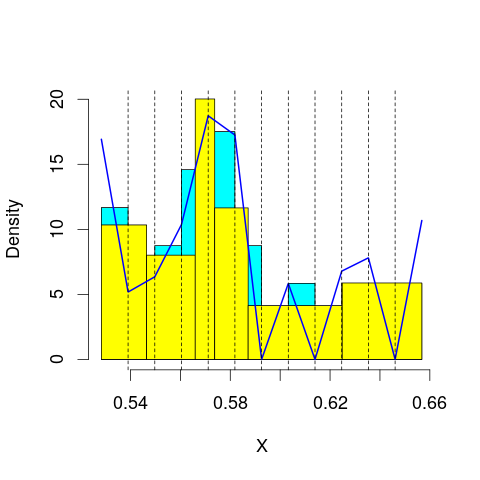

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.17343
mop.approx: Iteration 11. LL = 73.17396
mop.approx: Iteration 21. LL = 73.23691
mop.approx: Iteration 31. LL = 73.24452
mop.approx: Converged. Iteration 38. LL = 73.24561
[1] "Computing the linear combination of B-splines"


48.9854570468
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.92909
mop.approx: Iteration 11. LL = 72.54979
mop.approx: Iteration 21. LL = 72.62606
mop.approx: Iteration 31. LL = 72.63974
mop.approx: Iteration 41. LL = 72.64647
mop.approx: Iteration 51. LL = 72.65007
mop.approx: Iteration 61. LL = 72.65198
mop.approx: Iteration 71. LL = 72.653
mop.approx: Converged. Iteration 71. LL = 72.65307
[1] "Computing the linear combination of B-splines"


46.660047083
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.40907
mop.approx: Iteration 11. LL = 64.73888
mop.approx: Iteration 21. LL = 64.81667
mop.approx: Iteration 31. LL = 64.82906
mop.approx: Iteration 41. LL = 64.83175
mop.approx: Converged. Iteration 46. LL = 64.83225
[1] "Computing the linear combination of B-splines"


37.1063614754
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.86333
mop.approx: Iteration 11. LL = 64.95325
mop.approx: Iteration 21. LL = 65.00385
mop.approx: Iteration 31. LL = 65.00999
mop.approx: Iteration 41. LL = 65.01244
mop.approx: Iteration 51. LL = 65.01422
mop.approx: Iteration 61. LL = 65.01573
mop.approx: Iteration 71. LL = 65.01705
mop.approx: Iteration 81. LL = 65.01821
mop.approx: Iteration 91. LL = 65.01922
mop.approx: Iteration 101. LL = 65.0201
mop.approx: Iteration 111. LL = 65.02086
mop.approx: Converged. Iteration 117. LL = 65.02133
[1] "Computing the linear combination of B-splines"


35.5625786612
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.13821
mop.approx: Iteration 11. LL = 65.15775
mop.approx: Iteration 21. LL = 65.44212
mop.approx: Iteration 31. LL = 65.50898
mop.approx: Iteration 41. LL = 65.52981
mop.approx: Iteration 51. LL = 65.53684
mop.approx: Iteration 61. LL = 65.53944
mop.approx: Iteration 71. LL = 65.54056
mop.approx: Converged. Iteration 74. LL = 65.54083
[1] "Computing the linear combination of B-splines"


34.3491067118
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.02188
mop.approx: Iteration 11. LL = 64.28154
mop.approx: Iteration 21. LL = 64.47774
mop.approx: Iteration 31. LL = 64.52207
mop.approx: Iteration 41. LL = 64.53433
mop.approx: Iteration 51. LL = 64.53885
mop.approx: Iteration 61. LL = 64.54119
mop.approx: Iteration 71. LL = 64.54273
mop.approx: Iteration 81. LL = 64.54389
mop.approx: Iteration 91. LL = 64.54481
mop.approx: Iteration 101. LL = 64.54556
mop.approx: Converged. Iteration 104. LL = 64.54582
[1] "Computing the linear combination of B-splines"


31.6194965344
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.375211
mop.approx: Iteration 11. LL = 63.9751
mop.approx: Iteration 21. LL = 64.07741
mop.approx: Iteration 31. LL = 64.10042
mop.approx: Iteration 41. LL = 64.10931
mop.approx: Iteration 51. LL = 64.11337
mop.approx: Iteration 61. LL = 64.11534
mop.approx: Iteration 71. LL = 64.11633
mop.approx: Converged. Iteration 72. LL = 64.11646
[1] "Computing the linear combination of B-splines"


29.5153108115
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.41966
mop.approx: Iteration 11. LL = 74.16234
mop.approx: Converged. Iteration 13. LL = 74.16278
[1] "Computing the linear combination of B-splines"


49.9026307748
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 49.902630774825759)
m reached
('Sum of Probabilities:', 0.9857975409469619)
chosen


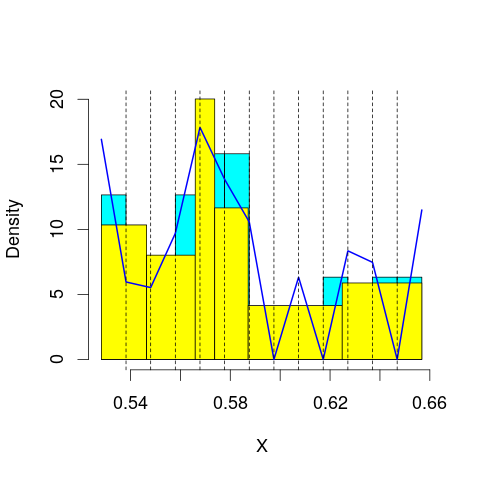

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.17343
mop.approx: Iteration 11. LL = 73.14988
mop.approx: Iteration 21. LL = 73.18084
mop.approx: Iteration 31. LL = 73.18488
mop.approx: Iteration 41. LL = 73.18755
mop.approx: Iteration 51. LL = 73.18982
mop.approx: Iteration 61. LL = 73.19175
mop.approx: Iteration 71. LL = 73.19338
mop.approx: Iteration 81. LL = 73.19473
mop.approx: Iteration 91. LL = 73.19585
mop.approx: Iteration 101. LL = 73.19676
mop.approx: Converged. Iteration 107. LL = 73.1973
[1] "Computing the linear combination of B-splines"


47.2042807429
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.92909
mop.approx: Iteration 11. LL = 73.08726
mop.approx: Iteration 21. LL = 73.12327
mop.approx: Converged. Iteration 24. LL = 73.12377
[1] "Computing the linear combination of B-splines"


45.3978822531
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.40907
mop.approx: Iteration 11. LL = 64.72217
mop.approx: Iteration 21. LL = 64.78987
mop.approx: Iteration 31. LL = 64.81604
mop.approx: Iteration 41. LL = 64.82731
mop.approx: Iteration 51. LL = 64.83196
mop.approx: Iteration 61. LL = 64.83394
mop.approx: Iteration 71. LL = 64.83486
mop.approx: Converged. Iteration 71. LL = 64.83492
[1] "Computing the linear combination of B-splines"


35.376165283
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.86333
mop.approx: Iteration 11. LL = 65.31698
mop.approx: Iteration 21. LL = 65.41278
mop.approx: Iteration 31. LL = 65.43242
mop.approx: Iteration 41. LL = 65.43955
mop.approx: Iteration 51. LL = 65.44314
mop.approx: Iteration 61. LL = 65.44526
mop.approx: Iteration 71. LL = 65.44662
mop.approx: Iteration 81. LL = 65.44753
mop.approx: Converged. Iteration 85. LL = 65.44788
[1] "Computing the linear combination of B-splines"


34.25625498
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.13821
mop.approx: Iteration 11. LL = 65.27553
mop.approx: Iteration 21. LL = 65.42364
mop.approx: Iteration 31. LL = 65.45929
mop.approx: Iteration 41. LL = 65.47167
mop.approx: Iteration 51. LL = 65.47605
mop.approx: Iteration 61. LL = 65.47765
mop.approx: Converged. Iteration 65. LL = 65.47802
[1] "Computing the linear combination of B-splines"


32.5535041126
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.02188
mop.approx: Iteration 11. LL = 64.86453
mop.approx: Iteration 21. LL = 65.29664
mop.approx: Iteration 31. LL = 65.39346
mop.approx: Iteration 41. LL = 65.41496
mop.approx: Iteration 51. LL = 65.41979
mop.approx: Converged. Iteration 60. LL = 65.42094
[1] "Computing the linear combination of B-splines"


30.7618009833
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.375211
mop.approx: Iteration 11. LL = 63.80675
mop.approx: Iteration 21. LL = 63.87937
mop.approx: Iteration 31. LL = 63.89129
mop.approx: Iteration 41. LL = 63.89411
mop.approx: Converged. Iteration 48. LL = 63.89484
[1] "Computing the linear combination of B-splines"


27.311322792
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.41966
mop.approx: Iteration 11. LL = 73.66688
mop.approx: Iteration 21. LL = 73.69845
mop.approx: Iteration 31. LL = 73.70335
mop.approx: Iteration 41. LL = 73.70482
mop.approx: Converged. Iteration 42. LL = 73.70496
[1] "Computing the linear combination of B-splines"


47.7119406042
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 47.711940604202979)
m reached
('Sum of Probabilities:', 0.984834747441581)
chosen


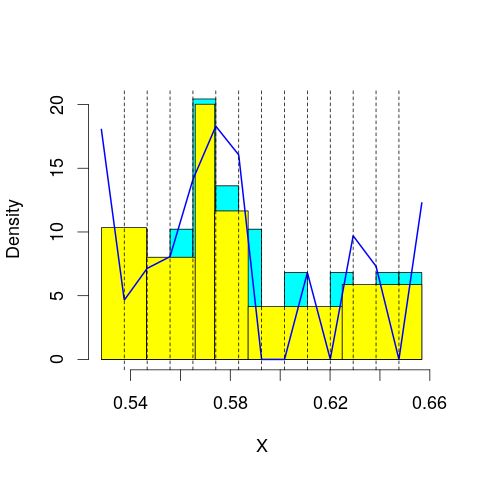

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.17343
mop.approx: Iteration 11. LL = 74.28022
mop.approx: Iteration 21. LL = 74.28955
mop.approx: Converged. Iteration 21. LL = 74.28961
[1] "Computing the linear combination of B-splines"


46.5637186606
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.92909
mop.approx: Iteration 11. LL = 73.27007
mop.approx: Iteration 21. LL = 73.36016
mop.approx: Iteration 31. LL = 73.36727
mop.approx: Converged. Iteration 36. LL = 73.36795
[1] "Computing the linear combination of B-splines"


43.9091989175
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.40907
mop.approx: Iteration 11. LL = 65.00702
mop.approx: Iteration 21. LL = 65.03779
mop.approx: Iteration 31. LL = 65.04176
mop.approx: Iteration 41. LL = 65.04293
mop.approx: Converged. Iteration 41. LL = 65.043
[1] "Computing the linear combination of B-splines"


33.8513732649
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.86333
mop.approx: Iteration 11. LL = 65.48472
mop.approx: Iteration 21. LL = 65.5909
mop.approx: Iteration 31. LL = 65.60743
mop.approx: Iteration 41. LL = 65.61076
mop.approx: Converged. Iteration 48. LL = 65.61156
[1] "Computing the linear combination of B-splines"


32.6870701638
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.13821
mop.approx: Iteration 11. LL = 65.56506
mop.approx: Iteration 21. LL = 65.69617
mop.approx: Iteration 31. LL = 65.72555
mop.approx: Iteration 41. LL = 65.7353
mop.approx: Iteration 51. LL = 65.73895
mop.approx: Iteration 61. LL = 65.74043
mop.approx: Converged. Iteration 65. LL = 65.7408
[1] "Computing the linear combination of B-splines"


31.0834659925
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.02188
mop.approx: Iteration 11. LL = 65.20898
mop.approx: Iteration 21. LL = 65.53893
mop.approx: Iteration 31. LL = 65.60297
mop.approx: Iteration 41. LL = 65.62228
mop.approx: Iteration 51. LL = 65.6303
mop.approx: Iteration 61. LL = 65.63445
mop.approx: Iteration 71. LL = 65.63691
mop.approx: Iteration 81. LL = 65.63851
mop.approx: Iteration 91. LL = 65.63962
mop.approx: Iteration 101. LL = 65.64041
mop.approx: Converged. Iteration 102. LL = 65.64055
[1] "Computing the linear combination of B-splines"


29.2528515771
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.375211
mop.approx: Iteration 11. LL = 64.51466
mop.approx: Iteration 21. LL = 64.87378
mop.approx: Iteration 31. LL = 64.96299
mop.approx: Iteration 41. LL = 64.99004
mop.approx: Iteration 51. LL = 65.00159
mop.approx: Iteration 61. LL = 65.00774
mop.approx: Iteration 71. LL = 65.01144
mop.approx: Iteration 81. LL = 65.01383
mop.approx: Iteration 91. LL = 65.01545
mop.approx: Iteration 101. LL = 65.01659
mop.approx: Iteration 111. LL = 65.01741
mop.approx: Converged. Iteration 114. LL = 65.01768
[1] "Computing the linear combination of B-splines"


26.5324675205
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.41966
mop.approx: Converged. Iteration 10. LL = 74.83256
[1] "Computing the linear combination of B-splines"


47.1066737475
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 47.10667374751884)
m reached
('Sum of Probabilities:', 0.9837947082248555)
chosen


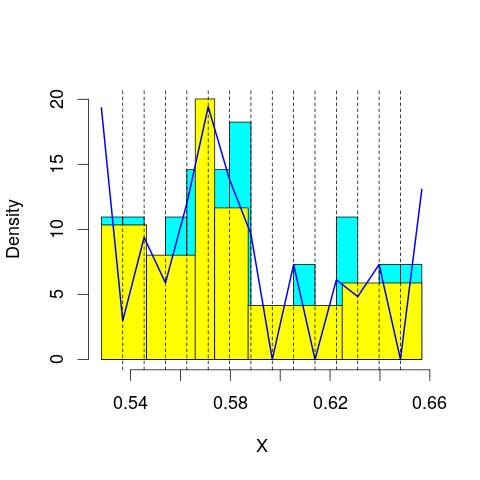

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.17343
mop.approx: Iteration 11. LL = 75.01727
mop.approx: Iteration 21. LL = 75.04321
mop.approx: Iteration 31. LL = 75.05266
mop.approx: Iteration 41. LL = 75.05739
mop.approx: Iteration 51. LL = 75.0599
mop.approx: Iteration 61. LL = 75.06127
mop.approx: Converged. Iteration 66. LL = 75.06177
[1] "Computing the linear combination of B-splines"


45.6030192699
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.92909
mop.approx: Iteration 11. LL = 73.37371
mop.approx: Iteration 21. LL = 73.41208
mop.approx: Iteration 31. LL = 73.41567
mop.approx: Converged. Iteration 38. LL = 73.41652
[1] "Computing the linear combination of B-splines"


42.2248925861
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.40907
mop.approx: Iteration 11. LL = 65.44732
mop.approx: Iteration 21. LL = 65.47805
mop.approx: Iteration 31. LL = 65.48028
mop.approx: Converged. Iteration 34. LL = 65.48057
[1] "Computing the linear combination of B-splines"


32.556082298
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.86333
mop.approx: Iteration 11. LL = 65.53673
mop.approx: Iteration 21. LL = 65.63445
mop.approx: Iteration 31. LL = 65.66973
mop.approx: Iteration 41. LL = 65.68703
mop.approx: Iteration 51. LL = 65.69642
mop.approx: Iteration 61. LL = 65.70166
mop.approx: Iteration 71. LL = 65.70459
mop.approx: Iteration 81. LL = 65.70623
mop.approx: Iteration 91. LL = 65.70714
mop.approx: Converged. Iteration 91. LL = 65.70721
[1] "Computing the linear combination of B-splines"


31.0498475128
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.13821
mop.approx: Iteration 11. LL = 65.8564
mop.approx: Iteration 21. LL = 65.95496
mop.approx: Iteration 31. LL = 65.96952
mop.approx: Iteration 41. LL = 65.97492
mop.approx: Iteration 51. LL = 65.97771
mop.approx: Iteration 61. LL = 65.97931
mop.approx: Iteration 71. LL = 65.98029
mop.approx: Converged. Iteration 75. LL = 65.98064
[1] "Computing the linear combination of B-splines"


29.5904476161
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.02188
mop.approx: Iteration 11. LL = 65.47636
mop.approx: Iteration 21. LL = 65.71388
mop.approx: Iteration 31. LL = 65.75202
mop.approx: Iteration 41. LL = 65.76455
mop.approx: Iteration 51. LL = 65.76987
mop.approx: Iteration 61. LL = 65.77236
mop.approx: Iteration 71. LL = 65.77361
mop.approx: Converged. Iteration 76. LL = 65.77405
[1] "Computing the linear combination of B-splines"


27.6487895508
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.375211
mop.approx: Iteration 11. LL = 65.32328
mop.approx: Iteration 21. LL = 65.50156
mop.approx: Iteration 31. LL = 65.55243
mop.approx: Iteration 41. LL = 65.57176
mop.approx: Iteration 51. LL = 65.58059
mop.approx: Iteration 61. LL = 65.58509
mop.approx: Iteration 71. LL = 65.58751
mop.approx: Iteration 81. LL = 65.58885
mop.approx: Converged. Iteration 88. LL = 65.58949
[1] "Computing the linear combination of B-splines"


25.5596028897
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.41966
mop.approx: Iteration 11. LL = 76.38375
mop.approx: Converged. Iteration 14. LL = 76.38465
[1] "Computing the linear combination of B-splines"


46.9258903702
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 46.925890370247735)
m reached
('Sum of Probabilities:', 0.9827732336522634)
chosen


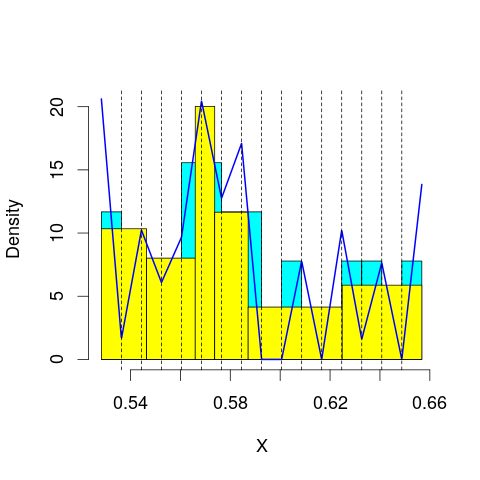

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.17343
mop.approx: Iteration 11. LL = 74.77169
mop.approx: Iteration 21. LL = 74.80422
mop.approx: Iteration 31. LL = 74.8095
mop.approx: Iteration 41. LL = 74.81157
mop.approx: Converged. Iteration 50. LL = 74.81258
[1] "Computing the linear combination of B-splines"


43.6209558649
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.92909
mop.approx: Iteration 11. LL = 74.35726
mop.approx: Iteration 21. LL = 74.41824
mop.approx: Iteration 31. LL = 74.42619
mop.approx: Iteration 41. LL = 74.42863
mop.approx: Iteration 51. LL = 74.4297
mop.approx: Converged. Iteration 51. LL = 74.42977
[1] "Computing the linear combination of B-splines"


41.5052829954
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.40907
mop.approx: Iteration 11. LL = 65.20296
mop.approx: Iteration 21. LL = 65.28926
mop.approx: Iteration 31. LL = 65.30619
mop.approx: Iteration 41. LL = 65.3114
mop.approx: Iteration 51. LL = 65.31363
mop.approx: Iteration 61. LL = 65.31475
mop.approx: Converged. Iteration 64. LL = 65.31504
[1] "Computing the linear combination of B-splines"


30.6576783483
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.86333
mop.approx: Iteration 11. LL = 66.00023
mop.approx: Iteration 21. LL = 66.02313
mop.approx: Converged. Iteration 26. LL = 66.0239
[1] "Computing the linear combination of B-splines"


29.6336705302
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.13821
mop.approx: Iteration 11. LL = 65.87123
mop.approx: Iteration 21. LL = 66.03452
mop.approx: Iteration 31. LL = 66.10191
mop.approx: Iteration 41. LL = 66.13146
mop.approx: Iteration 51. LL = 66.14474
mop.approx: Iteration 61. LL = 66.15113
mop.approx: Iteration 71. LL = 66.15452
mop.approx: Iteration 81. LL = 66.1565
mop.approx: Iteration 91. LL = 66.15776
mop.approx: Iteration 101. LL = 66.15859
mop.approx: Converged. Iteration 102. LL = 66.15872
[1] "Computing the linear combination of B-splines"


28.0354261874
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.02188
mop.approx: Iteration 11. LL = 65.8901
mop.approx: Iteration 21. LL = 66.04784
mop.approx: Iteration 31. LL = 66.06657
mop.approx: Iteration 41. LL = 66.07459
mop.approx: Iteration 51. LL = 66.07934
mop.approx: Iteration 61. LL = 66.08236
mop.approx: Iteration 71. LL = 66.08436
mop.approx: Iteration 81. LL = 66.08573
mop.approx: Iteration 91. LL = 66.08668
mop.approx: Converged. Iteration 97. LL = 66.08719
[1] "Computing the linear combination of B-splines"


26.2164289925
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.375211
mop.approx: Iteration 11. LL = 66.02785
mop.approx: Iteration 21. LL = 66.3297
mop.approx: Iteration 31. LL = 66.3684
mop.approx: Iteration 41. LL = 66.37974
mop.approx: Iteration 51. LL = 66.38507
mop.approx: Iteration 61. LL = 66.38829
mop.approx: Iteration 71. LL = 66.39048
mop.approx: Iteration 81. LL = 66.39203
mop.approx: Iteration 91. LL = 66.39317
mop.approx: Iteration 101. LL = 66.394
mop.approx: Converged. Iteration 103. LL = 66.3942
[1] "Computing the linear combination of B-splines"


24.1602948405
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.41966
mop.approx: Iteration 11. LL = 75.83674
mop.approx: Iteration 21. LL = 75.89663
mop.approx: Iteration 31. LL = 75.90506
mop.approx: Converged. Iteration 40. LL = 75.90655
[1] "Computing the linear combination of B-splines"


44.7149241484
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 44.714924148370002)
m reached
('Sum of Probabilities:', 0.9817400215243488)
chosen


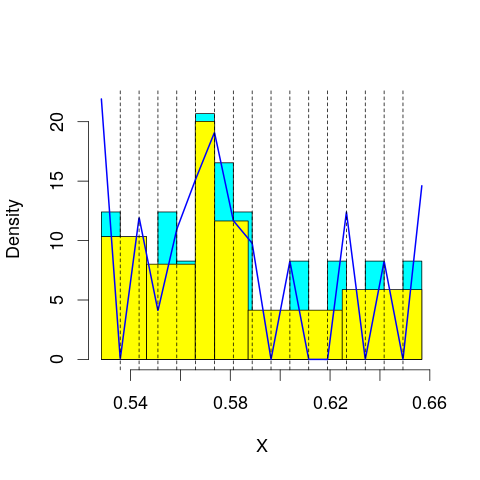

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.17343
mop.approx: Iteration 11. LL = 76.18238
mop.approx: Iteration 21. LL = 76.18959
mop.approx: Converged. Iteration 21. LL = 76.18966
[1] "Computing the linear combination of B-splines"


43.2651668558
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.92909
mop.approx: Iteration 11. LL = 73.92386
mop.approx: Iteration 21. LL = 74.07097
mop.approx: Iteration 31. LL = 74.10625
mop.approx: Iteration 41. LL = 74.11707
mop.approx: Iteration 51. LL = 74.12073
mop.approx: Iteration 61. LL = 74.12208
mop.approx: Converged. Iteration 62. LL = 74.12223
[1] "Computing the linear combination of B-splines"


39.4648689485
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.40907
mop.approx: Iteration 11. LL = 65.90607
mop.approx: Iteration 21. LL = 65.91805
mop.approx: Iteration 31. LL = 65.91985
mop.approx: Converged. Iteration 34. LL = 65.92015
[1] "Computing the linear combination of B-splines"


29.5299270692
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.86333
mop.approx: Iteration 11. LL = 65.77914
mop.approx: Iteration 21. LL = 65.86144
mop.approx: Iteration 31. LL = 65.89623
mop.approx: Iteration 41. LL = 65.91478
mop.approx: Iteration 51. LL = 65.92508
mop.approx: Iteration 61. LL = 65.93088
mop.approx: Iteration 71. LL = 65.9342
mop.approx: Iteration 81. LL = 65.93615
mop.approx: Iteration 91. LL = 65.93732
mop.approx: Converged. Iteration 97. LL = 65.93785
[1] "Computing the linear combination of B-splines"


27.8147387407
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.13821
mop.approx: Iteration 11. LL = 66.29599
mop.approx: Iteration 21. LL = 66.3364
mop.approx: Iteration 31. LL = 66.34183
mop.approx: Iteration 41. LL = 66.34364
mop.approx: Converged. Iteration 49. LL = 66.34441
[1] "Computing the linear combination of B-splines"


26.488272087
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.02188
mop.approx: Iteration 11. LL = 65.90011
mop.approx: Iteration 21. LL = 66.06683
mop.approx: Iteration 31. LL = 66.11708
mop.approx: Iteration 41. LL = 66.1413
mop.approx: Iteration 51. LL = 66.15369
mop.approx: Iteration 61. LL = 66.16056
mop.approx: Iteration 71. LL = 66.16468
mop.approx: Iteration 81. LL = 66.16732
mop.approx: Iteration 91. LL = 66.16911
mop.approx: Iteration 101. LL = 66.17038
mop.approx: Iteration 111. LL = 66.17133
mop.approx: Iteration 121. LL = 66.17207
mop.approx: Converged. Iteration 121. LL = 66.17214
[1] "Computing the linear combination of B-splines"


24.5575226912
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.375211
mop.approx: Iteration 11. LL = 68.73571
mop.approx: Iteration 21. LL = 69.12845
mop.approx: Iteration 31. LL = 69.19766
mop.approx: Iteration 41. LL = 69.21447
mop.approx: Iteration 51. LL = 69.21935
mop.approx: Iteration 61. LL = 69.22092
mop.approx: Converged. Iteration 63. LL = 69.22114
[1] "Computing the linear combination of B-splines"


26.0301414525
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.41966
mop.approx: Iteration 11. LL = 77.59945
mop.approx: Iteration 21. LL = 77.67311
mop.approx: Iteration 31. LL = 77.68294
mop.approx: Iteration 41. LL = 77.68594
mop.approx: Iteration 51. LL = 77.68727
mop.approx: Converged. Iteration 54. LL = 77.68759
[1] "Computing the linear combination of B-splines"


44.7631020758
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 44.763102075836287)
m reached
('Sum of Probabilities:', 0.980797126582962)
chosen


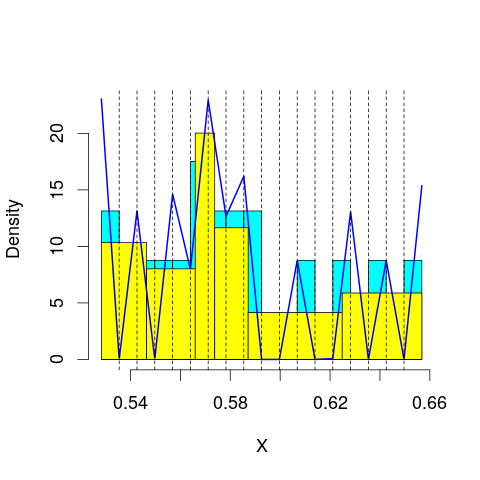

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.17343
mop.approx: Iteration 11. LL = 75.7203
mop.approx: Iteration 21. LL = 75.754
mop.approx: Iteration 31. LL = 75.75726
mop.approx: Converged. Iteration 31. LL = 75.75733
[1] "Computing the linear combination of B-splines"


41.0999754519
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.92909
mop.approx: Iteration 11. LL = 74.91808
mop.approx: Iteration 21. LL = 75.10642
mop.approx: Iteration 31. LL = 75.15361
mop.approx: Iteration 41. LL = 75.16921
mop.approx: Iteration 51. LL = 75.17504
mop.approx: Iteration 61. LL = 75.17743
mop.approx: Converged. Iteration 70. LL = 75.17847
[1] "Computing the linear combination of B-splines"


38.7882395776
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.40907
mop.approx: Iteration 11. LL = 65.71077
mop.approx: Iteration 21. LL = 65.80653
mop.approx: Iteration 31. LL = 65.83837
mop.approx: Iteration 41. LL = 65.85107
mop.approx: Iteration 51. LL = 65.85721
mop.approx: Iteration 61. LL = 65.86065
mop.approx: Iteration 71. LL = 65.86274
mop.approx: Iteration 81. LL = 65.86408
mop.approx: Iteration 91. LL = 65.86497
mop.approx: Converged. Iteration 93. LL = 65.86517
[1] "Computing the linear combination of B-splines"


27.7420774598
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.86333
mop.approx: Iteration 11. LL = 66.44149
mop.approx: Iteration 21. LL = 66.50928
mop.approx: Iteration 31. LL = 66.5264
mop.approx: Iteration 41. LL = 66.53322
mop.approx: Iteration 51. LL = 66.53671
mop.approx: Iteration 61. LL = 66.53871
mop.approx: Iteration 71. LL = 66.5399
mop.approx: Converged. Iteration 78. LL = 66.54051
[1] "Computing the linear combination of B-splines"


26.6845441195
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.13821
mop.approx: Iteration 11. LL = 66.24855
mop.approx: Iteration 21. LL = 66.399
mop.approx: Iteration 31. LL = 66.44683
mop.approx: Iteration 41. LL = 66.46108
mop.approx: Iteration 51. LL = 66.46527
mop.approx: Iteration 61. LL = 66.4666
mop.approx: Converged. Iteration 62. LL = 66.46673
[1] "Computing the linear combination of B-splines"


24.8779106609
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.02188
mop.approx: Iteration 11. LL = 66.38272
mop.approx: Iteration 21. LL = 66.49635
mop.approx: Iteration 31. LL = 66.51511
mop.approx: Iteration 41. LL = 66.52318
mop.approx: Iteration 51. LL = 66.52805
mop.approx: Iteration 61. LL = 66.53142
mop.approx: Iteration 71. LL = 66.53386
mop.approx: Iteration 81. LL = 66.53566
mop.approx: Iteration 91. LL = 66.53698
mop.approx: Iteration 101. LL = 66.53794
mop.approx: Converged. Iteration 108. LL = 66.53852
[1] "Computing the linear combination of B-splines"


23.1703471344
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.375211
mop.approx: Iteration 11. LL = 67.49111
mop.approx: Iteration 21. LL = 67.82995
mop.approx: Iteration 31. LL = 67.88745
mop.approx: Iteration 41. LL = 67.89999
mop.approx: Iteration 51. LL = 67.90346
mop.approx: Iteration 61. LL = 67.90469
mop.approx: Converged. Iteration 62. LL = 67.90483
[1] "Computing the linear combination of B-splines"


22.0781258325
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.41966
mop.approx: Iteration 11. LL = 76.60214
mop.approx: Iteration 21. LL = 76.64877
mop.approx: Iteration 31. LL = 76.66697
mop.approx: Iteration 41. LL = 76.67664
mop.approx: Iteration 51. LL = 76.68177
mop.approx: Iteration 61. LL = 76.6844
mop.approx: Iteration 71. LL = 76.68571
mop.approx: Converged. Iteration 73. LL = 76.68595
[1] "Computing the linear combination of B-splines"


42.0285890177
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 42.028589017692944)
m reached
('Sum of Probabilities:', 0.9798677569627734)
chosen


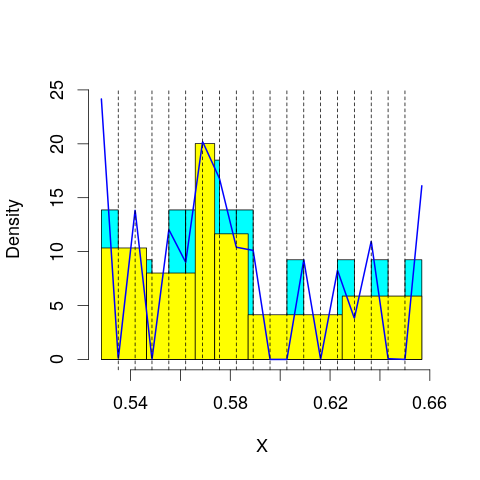

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.17343
mop.approx: Iteration 11. LL = 77.42472
mop.approx: Iteration 21. LL = 77.44204
mop.approx: Converged. Iteration 28. LL = 77.44333
[1] "Computing the linear combination of B-splines"


41.0531048932
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.92909
mop.approx: Iteration 11. LL = 74.54665
mop.approx: Iteration 21. LL = 74.76557
mop.approx: Iteration 31. LL = 74.8264
mop.approx: Iteration 41. LL = 74.84803
mop.approx: Iteration 51. LL = 74.85733
mop.approx: Iteration 61. LL = 74.86205
mop.approx: Iteration 71. LL = 74.86476
mop.approx: Iteration 81. LL = 74.86644
mop.approx: Iteration 91. LL = 74.86755
mop.approx: Converged. Iteration 96. LL = 74.86805
[1] "Computing the linear combination of B-splines"


36.7449508072
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.40907
mop.approx: Iteration 11. LL = 66.81811
mop.approx: Iteration 21. LL = 66.89561
mop.approx: Iteration 31. LL = 66.91581
mop.approx: Iteration 41. LL = 66.92314
mop.approx: Iteration 51. LL = 66.92637
mop.approx: Iteration 61. LL = 66.92801
mop.approx: Iteration 71. LL = 66.92895
mop.approx: Converged. Iteration 73. LL = 66.92915
[1] "Computing the linear combination of B-splines"


27.0731843879
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.86333
mop.approx: Iteration 11. LL = 66.26886
mop.approx: Iteration 21. LL = 66.40374
mop.approx: Iteration 31. LL = 66.45681
mop.approx: Iteration 41. LL = 66.48058
mop.approx: Iteration 51. LL = 66.49253
mop.approx: Iteration 61. LL = 66.49942
mop.approx: Iteration 71. LL = 66.50383
mop.approx: Iteration 81. LL = 66.50683
mop.approx: Iteration 91. LL = 66.50897
mop.approx: Iteration 101. LL = 66.51053
mop.approx: Iteration 111. LL = 66.51171
mop.approx: Iteration 121. LL = 66.51261
mop.approx: Converged. Iteration 129. LL = 66.51326
[1] "Computing the linear combination of B-splines"


24.9244198807
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.13821
mop.approx: Iteration 11. LL = 66.84924
mop.approx: Iteration 21. LL = 66.91879
mop.approx: Iteration 31. LL = 66.93768
mop.approx: Iteration 41. LL = 66.94887
mop.approx: Iteration 51. LL = 66.95629
mop.approx: Iteration 61. LL = 66.9614
mop.approx: Iteration 71. LL = 66.96502
mop.approx: Iteration 81. LL = 66.96762
mop.approx: Iteration 91. LL = 66.96951
mop.approx: Iteration 101. LL = 66.9709
mop.approx: Iteration 111. LL = 66.97193
mop.approx: Converged. Iteration 120. LL = 66.97269
[1] "Computing the linear combination of B-splines"


23.6508274712
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.02188
mop.approx: Iteration 11. LL = 66.66194
mop.approx: Iteration 21. LL = 66.84214
mop.approx: Iteration 31. LL = 66.87609
mop.approx: Iteration 41. LL = 66.8875
mop.approx: Iteration 51. LL = 66.89291
mop.approx: Iteration 61. LL = 66.89591
mop.approx: Iteration 71. LL = 66.89774
mop.approx: Iteration 81. LL = 66.89892
mop.approx: Iteration 91. LL = 66.89972
mop.approx: Converged. Iteration 91. LL = 66.89979
[1] "Computing the linear combination of B-splines"


21.8891279308
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.375211
mop.approx: Iteration 11. LL = 78.28249
mop.approx: Iteration 21. LL = 78.35219
mop.approx: Iteration 31. LL = 78.36061
mop.approx: Converged. Iteration 38. LL = 78.36179
[1] "Computing the linear combination of B-splines"


27.745652392
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.41966
mop.approx: Iteration 11. LL = 77.87529
mop.approx: Iteration 21. LL = 77.90112
mop.approx: Iteration 31. LL = 77.90447
mop.approx: Iteration 41. LL = 77.90564
mop.approx: Converged. Iteration 41. LL = 77.90571
[1] "Computing the linear combination of B-splines"


41.5154853323
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 41.515485332268156)
m reached
('Sum of Probabilities:', 0.9789509072704716)
chosen


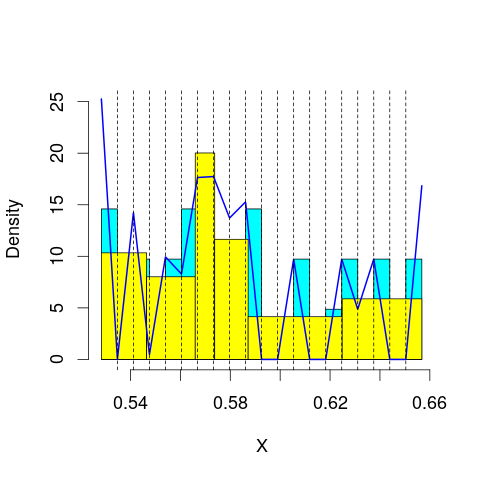

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.17343
mop.approx: Iteration 11. LL = 77.17315
mop.approx: Iteration 21. LL = 77.23967
mop.approx: Iteration 31. LL = 77.25672
mop.approx: Iteration 41. LL = 77.26322
mop.approx: Iteration 51. LL = 77.26595
mop.approx: Iteration 61. LL = 77.26715
mop.approx: Converged. Iteration 61. LL = 77.26722
[1] "Computing the linear combination of B-splines"


39.1441259013
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.92909
mop.approx: Iteration 11. LL = 75.52606
mop.approx: Iteration 21. LL = 75.61419
mop.approx: Iteration 31. LL = 75.62432
mop.approx: Iteration 41. LL = 75.62784
mop.approx: Iteration 51. LL = 75.62956
mop.approx: Iteration 61. LL = 75.63053
mop.approx: Converged. Iteration 61. LL = 75.6306
[1] "Computing the linear combination of B-splines"


35.7746385573
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.40907
mop.approx: Iteration 11. LL = 66.77194
mop.approx: Iteration 21. LL = 67.05774
mop.approx: Iteration 31. LL = 67.15878
mop.approx: Iteration 41. LL = 67.19855
mop.approx: Iteration 51. LL = 67.2158
mop.approx: Iteration 61. LL = 67.22436
mop.approx: Iteration 71. LL = 67.22918
mop.approx: Iteration 81. LL = 67.23216
mop.approx: Iteration 91. LL = 67.23413
mop.approx: Iteration 101. LL = 67.23549
mop.approx: Iteration 111. LL = 67.23646
mop.approx: Converged. Iteration 118. LL = 67.23705
[1] "Computing the linear combination of B-splines"


25.6482176381
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.86333
mop.approx: Iteration 11. LL = 66.82652
mop.approx: Iteration 21. LL = 66.87616
mop.approx: Iteration 31. LL = 66.88678
mop.approx: Iteration 41. LL = 66.89139
mop.approx: Iteration 51. LL = 66.89385
mop.approx: Iteration 61. LL = 66.89528
mop.approx: Iteration 71. LL = 66.89616
mop.approx: Converged. Iteration 72. LL = 66.8963
[1] "Computing the linear combination of B-splines"


23.5745901417
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.13821
mop.approx: Iteration 11. LL = 66.96404
mop.approx: Iteration 21. LL = 67.19203
mop.approx: Iteration 31. LL = 67.27124
mop.approx: Iteration 41. LL = 67.30883
mop.approx: Iteration 51. LL = 67.33097
mop.approx: Iteration 61. LL = 67.34529
mop.approx: Iteration 71. LL = 67.35493
mop.approx: Iteration 81. LL = 67.36158
mop.approx: Iteration 91. LL = 67.36626
mop.approx: Iteration 101. LL = 67.36961
mop.approx: Iteration 111. LL = 67.37203
mop.approx: Iteration 121. LL = 67.37382
mop.approx: Iteration 131. LL = 67.37515
mop.approx: Iteration 141. LL = 67.37615
mop.approx: Iteration 151. LL = 67.37692
mop.approx: Converged. Iteration 151. LL = 67.37698
[1] "Computing the linear combination of B-splines"


22.3224461147
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.02188
mop.approx: Iteration 11. LL = 66.65527
mop.approx: Iteration 21. LL = 66.7559
mop.approx: Iteration 31. LL = 66.77622
mop.approx: Iteration 41. LL = 66.78528
mop.approx: Iteration 51. LL = 66.7905
mop.approx: Iteration 61. LL = 66.79378
mop.approx: Iteration 71. LL = 66.79589
mop.approx: Iteration 81. LL = 66.79728
mop.approx: Iteration 91. LL = 66.7982
mop.approx: Converged. Iteration 94. LL = 66.79848
[1] "Computing the linear combination of B-splines"


19.8984391732
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.375211
mop.approx: Iteration 11. LL = 82.69033
mop.approx: Iteration 21. LL = 83.06749
mop.approx: Iteration 31. LL = 83.12636
mop.approx: Iteration 41. LL = 83.13608
mop.approx: Converged. Iteration 49. LL = 83.13767
[1] "Computing the linear combination of B-splines"


33.3109999893
lfps_26
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.36817
mop.approx: Converged. Iteration 8. LL = 64.56301
[1] "Computing the linear combination of B-splines"


59.3644030064
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 59.364403006390191)
m reached
('Sum of Probabilities:', 0.9932223405687018)
chosen


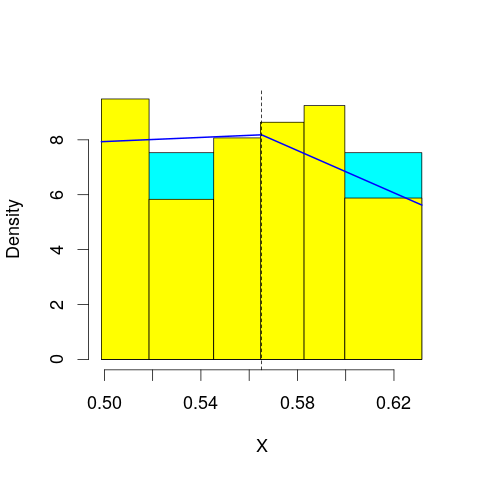

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.12988
mop.approx: Iteration 11. LL = 64.42997
mop.approx: Iteration 21. LL = 64.4398
mop.approx: Converged. Iteration 26. LL = 64.44054
[1] "Computing the linear combination of B-splines"


57.5090693735
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 63.89334
mop.approx: Iteration 11. LL = 64.54156
mop.approx: Iteration 21. LL = 64.7131
mop.approx: Iteration 31. LL = 64.78836
mop.approx: Iteration 41. LL = 64.82546
mop.approx: Iteration 51. LL = 64.8458
mop.approx: Iteration 61. LL = 64.85792
mop.approx: Iteration 71. LL = 64.86562
mop.approx: Iteration 81. LL = 64.87074
mop.approx: Iteration 91. LL = 64.87428
mop.approx: Iteration 101. LL = 64.8768
mop.approx: Iteration 111. LL = 64.87863
mop.approx: Iteration 121. LL = 64.87998
mop.approx: Iteration 131. LL = 64.88098
mop.approx: Iteration 141. LL = 64.88175
mop.approx: Converged. Iteration 142. LL = 64.88188
[1] "Computing the linear combination of B-splines"


56.2175367402
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.14827
mop.approx: Iteration 11. LL = 50.28448
mop.approx: Converged. Iteration 15. LL = 50.28532
[1] "Computing the linear combination of B-splines"


39.8881095578
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.64388
mop.approx: Iteration 11. LL = 53.58582
mop.approx: Iteration 21. LL = 53.62925
mop.approx: Converged. Iteration 21. LL = 53.6293
[1] "Computing the linear combination of B-splines"


41.4992247159
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.948802
mop.approx: Iteration 11. LL = 46.89229
mop.approx: Iteration 21. LL = 46.90222
mop.approx: Converged. Iteration 27. LL = 46.90296
[1] "Computing the linear combination of B-splines"


33.0400199347
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.855271
mop.approx: Iteration 11. LL = 49.73112
mop.approx: Iteration 21. LL = 49.82728
mop.approx: Converged. Iteration 24. LL = 49.82769
[1] "Computing the linear combination of B-splines"


34.2318813023
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.226505
mop.approx: Iteration 11. LL = 44.06754
mop.approx: Iteration 21. LL = 44.09103
mop.approx: Iteration 31. LL = 44.09635
mop.approx: Iteration 41. LL = 44.09763
mop.approx: Converged. Iteration 43. LL = 44.09777
[1] "Computing the linear combination of B-splines"


26.769093975
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.36817
mop.approx: Iteration 11. LL = 64.85129
mop.approx: Converged. Iteration 11. LL = 64.85132
[1] "Computing the linear combination of B-splines"


57.9198515364
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 57.919851536392564)
m reached
('Sum of Probabilities:', 0.9924797912698324)
chosen


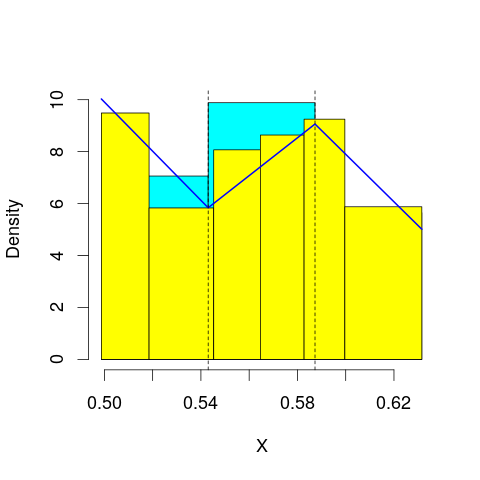

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.12988
mop.approx: Iteration 11. LL = 65.12037
mop.approx: Iteration 21. LL = 65.17973
mop.approx: Iteration 31. LL = 65.18871
mop.approx: Iteration 41. LL = 65.19051
mop.approx: Converged. Iteration 42. LL = 65.19064
[1] "Computing the linear combination of B-splines"


56.5263049419
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 63.89334
mop.approx: Iteration 11. LL = 64.94974
mop.approx: Iteration 21. LL = 65.03429
mop.approx: Iteration 31. LL = 65.06554
mop.approx: Iteration 41. LL = 65.08091
mop.approx: Iteration 51. LL = 65.08899
mop.approx: Iteration 61. LL = 65.09333
mop.approx: Iteration 71. LL = 65.09569
mop.approx: Iteration 81. LL = 65.09697
mop.approx: Converged. Iteration 87. LL = 65.09751
[1] "Computing the linear combination of B-splines"


54.7002990898
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.14827
mop.approx: Iteration 11. LL = 58.10561
mop.approx: Iteration 21. LL = 58.31895
mop.approx: Iteration 31. LL = 58.33658
mop.approx: Iteration 41. LL = 58.33901
mop.approx: Converged. Iteration 43. LL = 58.33919
[1] "Computing the linear combination of B-splines"


46.2091127492
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.64388
mop.approx: Iteration 11. LL = 53.67781
mop.approx: Converged. Iteration 13. LL = 53.67819
[1] "Computing the linear combination of B-splines"


39.8152425652
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.948802
mop.approx: Iteration 11. LL = 55.73277
mop.approx: Iteration 21. LL = 55.84908
mop.approx: Converged. Iteration 26. LL = 55.85019
[1] "Computing the linear combination of B-splines"


40.2543738818
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.855271
mop.approx: Iteration 11. LL = 49.90745
mop.approx: Iteration 21. LL = 49.91339
mop.approx: Converged. Iteration 23. LL = 49.91355
[1] "Computing the linear combination of B-splines"


32.5848655854
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.226505
mop.approx: Iteration 11. LL = 52.04476
mop.approx: Iteration 21. LL = 52.19412
mop.approx: Converged. Iteration 26. LL = 52.19541
[1] "Computing the linear combination of B-splines"


33.1338626815
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.36817
mop.approx: Iteration 11. LL = 65.42613
mop.approx: Converged. Iteration 12. LL = 65.42625
[1] "Computing the linear combination of B-splines"


56.7619074641
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 56.761907464130665)
m reached
('Sum of Probabilities:', 0.9907364833245826)
chosen


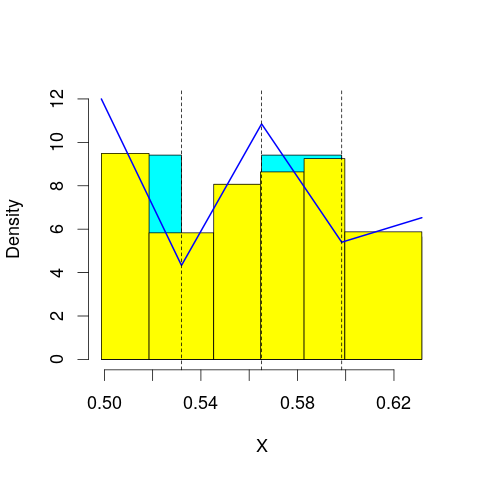

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.12988
mop.approx: Iteration 11. LL = 65.3862
mop.approx: Iteration 21. LL = 65.42793
mop.approx: Iteration 31. LL = 65.4368
mop.approx: Iteration 41. LL = 65.43971
mop.approx: Iteration 51. LL = 65.44094
mop.approx: Converged. Iteration 54. LL = 65.44122
[1] "Computing the linear combination of B-splines"


55.0440154131
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 63.89334
mop.approx: Iteration 11. LL = 65.03584
mop.approx: Iteration 21. LL = 65.07374
mop.approx: Iteration 31. LL = 65.08445
mop.approx: Iteration 41. LL = 65.08826
mop.approx: Iteration 51. LL = 65.08979
mop.approx: Converged. Iteration 56. LL = 65.09026
[1] "Computing the linear combination of B-splines"


52.9601809112
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.14827
mop.approx: Iteration 11. LL = 58.39707
mop.approx: Iteration 21. LL = 58.46834
mop.approx: Converged. Iteration 28. LL = 58.46998
[1] "Computing the linear combination of B-splines"


44.607039727
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.64388
mop.approx: Iteration 11. LL = 57.47666
mop.approx: Iteration 21. LL = 57.68519
mop.approx: Iteration 31. LL = 57.72148
mop.approx: Iteration 41. LL = 57.73065
mop.approx: Iteration 51. LL = 57.73321
mop.approx: Converged. Iteration 57. LL = 57.73381
[1] "Computing the linear combination of B-splines"


42.1380006051
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.948802
mop.approx: Iteration 11. LL = 55.90343
mop.approx: Converged. Iteration 15. LL = 55.90547
[1] "Computing the linear combination of B-splines"


38.5767906982
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.855271
mop.approx: Iteration 11. LL = 56.95082
mop.approx: Iteration 21. LL = 57.20139
mop.approx: Iteration 31. LL = 57.21034
mop.approx: Converged. Iteration 34. LL = 57.21065
[1] "Computing the linear combination of B-splines"


38.1491033597
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.226505
mop.approx: Iteration 11. LL = 52.2721
mop.approx: Converged. Iteration 20. LL = 52.27654
[1] "Computing the linear combination of B-splines"


31.4821285585
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.36817
mop.approx: Iteration 11. LL = 65.4817
mop.approx: Converged. Iteration 13. LL = 65.48195
[1] "Computing the linear combination of B-splines"


55.0847433152
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 55.084743315201919)
m reached
('Sum of Probabilities:', 0.9906461207363604)
chosen


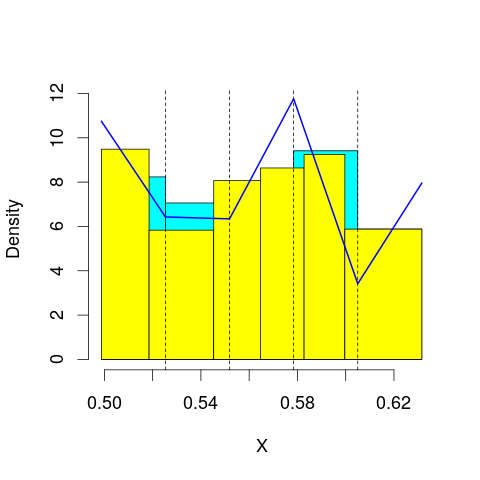

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.12988
mop.approx: Iteration 11. LL = 65.43642
mop.approx: Iteration 21. LL = 65.44825
mop.approx: Converged. Iteration 28. LL = 65.44934
[1] "Computing the linear combination of B-splines"


53.3192596209
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 63.89334
mop.approx: Iteration 11. LL = 65.16754
mop.approx: Iteration 21. LL = 65.18906
mop.approx: Iteration 31. LL = 65.19672
mop.approx: Iteration 41. LL = 65.20029
mop.approx: Iteration 51. LL = 65.20207
mop.approx: Iteration 61. LL = 65.203
mop.approx: Converged. Iteration 61. LL = 65.20306
[1] "Computing the linear combination of B-splines"


51.3401210292
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.14827
mop.approx: Iteration 11. LL = 58.63424
mop.approx: Iteration 21. LL = 58.65947
mop.approx: Converged. Iteration 21. LL = 58.65951
[1] "Computing the linear combination of B-splines"


43.063699536
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.64388
mop.approx: Iteration 11. LL = 57.73444
mop.approx: Iteration 21. LL = 57.84404
mop.approx: Iteration 31. LL = 57.86005
mop.approx: Iteration 41. LL = 57.86375
mop.approx: Iteration 51. LL = 57.86489
mop.approx: Converged. Iteration 53. LL = 57.86507
[1] "Computing the linear combination of B-splines"


40.5363881825
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.948802
mop.approx: Iteration 11. LL = 57.23502
mop.approx: Iteration 21. LL = 57.26603
mop.approx: Converged. Iteration 27. LL = 57.26719
[1] "Computing the linear combination of B-splines"


38.2056412491
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.855271
mop.approx: Iteration 11. LL = 57.26477
mop.approx: Converged. Iteration 19. LL = 57.2808
[1] "Computing the linear combination of B-splines"


36.4863816665
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.226505
mop.approx: Iteration 11. LL = 57.47423
mop.approx: Iteration 21. LL = 57.87348
mop.approx: Iteration 31. LL = 57.91076
mop.approx: Iteration 41. LL = 57.91667
mop.approx: Converged. Iteration 49. LL = 57.9177
[1] "Computing the linear combination of B-splines"


35.3904181758
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.36817
mop.approx: Converged. Iteration 9. LL = 65.78025
[1] "Computing the linear combination of B-splines"


53.6501701561
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 53.650170156091946)
m reached
('Sum of Probabilities:', 0.9901749764594978)
chosen


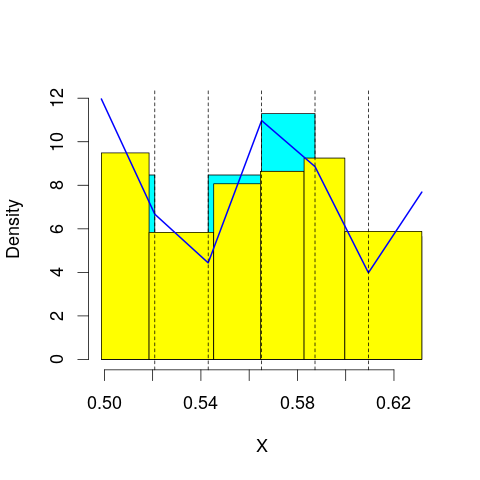

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.12988
mop.approx: Iteration 11. LL = 65.51064
mop.approx: Iteration 21. LL = 65.51346
mop.approx: Converged. Iteration 21. LL = 65.51351
[1] "Computing the linear combination of B-splines"


51.6505694008
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 63.89334
mop.approx: Iteration 11. LL = 65.33723
mop.approx: Iteration 21. LL = 65.38707
mop.approx: Iteration 31. LL = 65.403
mop.approx: Iteration 41. LL = 65.40945
mop.approx: Iteration 51. LL = 65.4125
mop.approx: Iteration 61. LL = 65.41408
mop.approx: Iteration 71. LL = 65.41496
mop.approx: Converged. Iteration 71. LL = 65.41503
[1] "Computing the linear combination of B-splines"


49.8192160962
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.14827
mop.approx: Iteration 11. LL = 59.09688
mop.approx: Iteration 21. LL = 59.12501
mop.approx: Iteration 31. LL = 59.12728
mop.approx: Converged. Iteration 32. LL = 59.12738
[1] "Computing the linear combination of B-splines"


41.798703763
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.64388
mop.approx: Iteration 11. LL = 58.47601
mop.approx: Iteration 21. LL = 58.72056
mop.approx: Iteration 31. LL = 58.74899
mop.approx: Iteration 41. LL = 58.75279
mop.approx: Converged. Iteration 45. LL = 58.75317
[1] "Computing the linear combination of B-splines"


39.6916194012
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.948802
mop.approx: Iteration 11. LL = 57.48067
mop.approx: Iteration 21. LL = 57.52466
mop.approx: Iteration 31. LL = 57.53353
mop.approx: Iteration 41. LL = 57.53609
mop.approx: Converged. Iteration 50. LL = 57.53698
[1] "Computing the linear combination of B-splines"


36.7425622318
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.855271
mop.approx: Iteration 11. LL = 57.53713
mop.approx: Converged. Iteration 18. LL = 57.54356
[1] "Computing the linear combination of B-splines"


35.0162766662
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.226505
mop.approx: Iteration 11. LL = 57.92572
mop.approx: Iteration 21. LL = 58.00166
mop.approx: Converged. Iteration 27. LL = 58.00312
[1] "Computing the linear combination of B-splines"


33.7429543577
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.36817
mop.approx: Iteration 11. LL = 65.81366
mop.approx: Iteration 21. LL = 65.82672
mop.approx: Iteration 31. LL = 65.82848
mop.approx: Converged. Iteration 31. LL = 65.82854
[1] "Computing the linear combination of B-splines"


51.9655941739
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 51.965594173935365)
m reached
('Sum of Probabilities:', 0.9900771536540981)
chosen


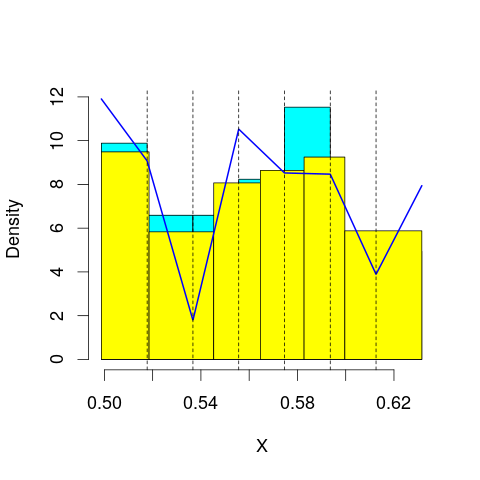

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.12988
mop.approx: Iteration 11. LL = 65.80043
mop.approx: Iteration 21. LL = 65.81046
mop.approx: Converged. Iteration 26. LL = 65.81118
[1] "Computing the linear combination of B-splines"


50.2153720891
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 63.89334
mop.approx: Iteration 11. LL = 65.35321
mop.approx: Iteration 21. LL = 65.42205
mop.approx: Iteration 31. LL = 65.45337
mop.approx: Iteration 41. LL = 65.46959
mop.approx: Iteration 51. LL = 65.47863
mop.approx: Iteration 61. LL = 65.4839
mop.approx: Iteration 71. LL = 65.48705
mop.approx: Iteration 81. LL = 65.48897
mop.approx: Iteration 91. LL = 65.49016
mop.approx: Converged. Iteration 98. LL = 65.49077
[1] "Computing the linear combination of B-splines"


48.1620915163
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.14827
mop.approx: Iteration 11. LL = 59.39171
mop.approx: Iteration 21. LL = 59.44648
mop.approx: Iteration 31. LL = 59.46023
mop.approx: Iteration 41. LL = 59.4652
mop.approx: Iteration 51. LL = 59.46741
mop.approx: Iteration 61. LL = 59.46855
mop.approx: Converged. Iteration 67. LL = 59.46903
[1] "Computing the linear combination of B-splines"


40.4074810572
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.64388
mop.approx: Iteration 11. LL = 59.05715
mop.approx: Iteration 21. LL = 59.21034
mop.approx: Iteration 31. LL = 59.22509
mop.approx: Iteration 41. LL = 59.22874
mop.approx: Iteration 51. LL = 59.23006
mop.approx: Converged. Iteration 55. LL = 59.2304
[1] "Computing the linear combination of B-splines"


38.4359828745
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.948802
mop.approx: Iteration 11. LL = 57.93934
mop.approx: Iteration 21. LL = 58.1644
mop.approx: Iteration 31. LL = 58.22221
mop.approx: Iteration 41. LL = 58.23909
mop.approx: Iteration 51. LL = 58.24458
mop.approx: Iteration 61. LL = 58.2466
mop.approx: Converged. Iteration 70. LL = 58.24743
[1] "Computing the linear combination of B-splines"


35.720149171
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.855271
mop.approx: Iteration 11. LL = 57.83781
mop.approx: Iteration 21. LL = 57.87658
mop.approx: Iteration 31. LL = 57.88162
mop.approx: Converged. Iteration 37. LL = 57.88228
[1] "Computing the linear combination of B-splines"


33.6221120904
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.226505
mop.approx: Iteration 11. LL = 57.96654
mop.approx: Iteration 21. LL = 58.00669
mop.approx: Converged. Iteration 23. LL = 58.00697
[1] "Computing the linear combination of B-splines"


32.0139372917
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.36817
mop.approx: Iteration 11. LL = 66.05131
mop.approx: Converged. Iteration 12. LL = 66.05149
[1] "Computing the linear combination of B-splines"


50.4556786101
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 50.455678610134001)
m reached
('Sum of Probabilities:', 0.9882759089999442)
chosen


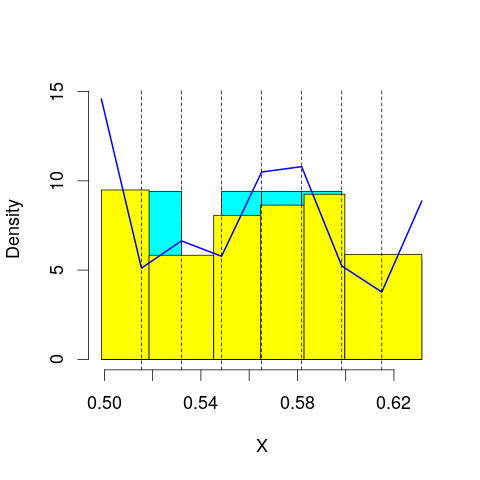

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.12988
mop.approx: Iteration 11. LL = 66.38537
mop.approx: Iteration 21. LL = 66.46622
mop.approx: Iteration 31. LL = 66.4824
mop.approx: Iteration 41. LL = 66.48667
mop.approx: Iteration 51. LL = 66.48791
mop.approx: Converged. Iteration 51. LL = 66.48797
[1] "Computing the linear combination of B-splines"


49.1592948667
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 63.89334
mop.approx: Iteration 11. LL = 65.30125
mop.approx: Iteration 21. LL = 65.30986
mop.approx: Iteration 31. LL = 65.31277
mop.approx: Iteration 41. LL = 65.31412
mop.approx: Converged. Iteration 46. LL = 65.31457
[1] "Computing the linear combination of B-splines"


46.2530209279
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.14827
mop.approx: Iteration 11. LL = 59.55085
mop.approx: Iteration 21. LL = 59.601
mop.approx: Iteration 31. LL = 59.61941
mop.approx: Iteration 41. LL = 59.62807
mop.approx: Iteration 51. LL = 59.63259
mop.approx: Iteration 61. LL = 59.63512
mop.approx: Iteration 71. LL = 59.6366
mop.approx: Iteration 81. LL = 59.6375
mop.approx: Converged. Iteration 84. LL = 59.63776
[1] "Computing the linear combination of B-splines"


38.8433431283
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.64388
mop.approx: Iteration 11. LL = 59.61199
mop.approx: Iteration 21. LL = 59.75351
mop.approx: Iteration 31. LL = 59.78364
mop.approx: Iteration 41. LL = 59.79494
mop.approx: Iteration 51. LL = 59.79989
mop.approx: Iteration 61. LL = 59.80223
mop.approx: Iteration 71. LL = 59.80339
mop.approx: Converged. Iteration 75. LL = 59.80373
[1] "Computing the linear combination of B-splines"


37.2764470241
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.948802
mop.approx: Iteration 11. LL = 58.33053
mop.approx: Iteration 21. LL = 58.53799
mop.approx: Iteration 31. LL = 58.59192
mop.approx: Iteration 41. LL = 58.61435
mop.approx: Iteration 51. LL = 58.62622
mop.approx: Iteration 61. LL = 58.63338
mop.approx: Iteration 71. LL = 58.63806
mop.approx: Iteration 81. LL = 58.64127
mop.approx: Iteration 91. LL = 58.64356
mop.approx: Iteration 101. LL = 58.64524
mop.approx: Iteration 111. LL = 58.64649
mop.approx: Iteration 121. LL = 58.64744
mop.approx: Iteration 131. LL = 58.64817
mop.approx: Converged. Iteration 135. LL = 58.64847
[1] "Computing the linear combination of B-splines"


34.3883235889
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.855271
mop.approx: Iteration 11. LL = 57.97318
mop.approx: Iteration 21. LL = 58.02858
mop.approx: Iteration 31. LL = 58.04374
mop.approx: Iteration 41. LL = 58.04917
mop.approx: Iteration 51. LL = 58.0513
mop.approx: Converged. Iteration 60. LL = 58.05218
[1] "Computing the linear combination of B-splines"


32.0591534946
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.226505
mop.approx: Iteration 11. LL = 58.32797
mop.approx: Iteration 21. LL = 58.38894
mop.approx: Iteration 31. LL = 58.39694
mop.approx: Iteration 41. LL = 58.39852
mop.approx: Converged. Iteration 42. LL = 58.39863
[1] "Computing the linear combination of B-splines"


30.6728599688
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.36817
mop.approx: Iteration 11. LL = 67.05261
mop.approx: Iteration 21. LL = 67.07058
mop.approx: Converged. Iteration 29. LL = 67.07201
[1] "Computing the linear combination of B-splines"


49.7433302601
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 49.743330260083042)
m reached
('Sum of Probabilities:', 0.9861269187503645)
chosen


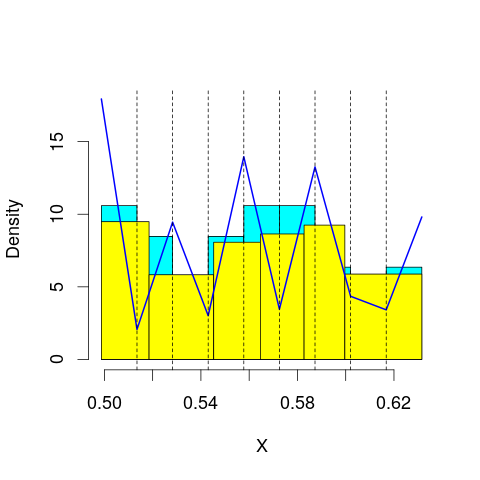

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.12988
mop.approx: Iteration 11. LL = 66.11074
mop.approx: Iteration 21. LL = 66.1819
mop.approx: Iteration 31. LL = 66.20014
mop.approx: Iteration 41. LL = 66.20612
mop.approx: Iteration 51. LL = 66.20827
mop.approx: Converged. Iteration 58. LL = 66.20897
[1] "Computing the linear combination of B-splines"


47.1474207832
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 63.89334
mop.approx: Iteration 11. LL = 65.86521
mop.approx: Iteration 21. LL = 66.06262
mop.approx: Iteration 31. LL = 66.13414
mop.approx: Iteration 41. LL = 66.16209
mop.approx: Iteration 51. LL = 66.17456
mop.approx: Iteration 61. LL = 66.18101
mop.approx: Iteration 71. LL = 66.18475
mop.approx: Iteration 81. LL = 66.18707
mop.approx: Iteration 91. LL = 66.18859
mop.approx: Iteration 101. LL = 66.18962
mop.approx: Converged. Iteration 108. LL = 66.19021
[1] "Computing the linear combination of B-splines"


45.395795297
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.14827
mop.approx: Iteration 11. LL = 59.51087
mop.approx: Iteration 21. LL = 59.51936
mop.approx: Iteration 31. LL = 59.52145
mop.approx: Converged. Iteration 36. LL = 59.52191
[1] "Computing the linear combination of B-splines"


36.9946293491
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.64388
mop.approx: Iteration 11. LL = 60.06089
mop.approx: Iteration 21. LL = 60.1624
mop.approx: Iteration 31. LL = 60.18522
mop.approx: Iteration 41. LL = 60.19143
mop.approx: Iteration 51. LL = 60.19303
mop.approx: Converged. Iteration 52. LL = 60.19315
[1] "Computing the linear combination of B-splines"


35.9330033813
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.948802
mop.approx: Iteration 11. LL = 58.96263
mop.approx: Iteration 21. LL = 59.29653
mop.approx: Iteration 31. LL = 59.37544
mop.approx: Iteration 41. LL = 59.39659
mop.approx: Iteration 51. LL = 59.40253
mop.approx: Iteration 61. LL = 59.40422
mop.approx: Converged. Iteration 64. LL = 59.40449
[1] "Computing the linear combination of B-splines"


33.4114746009
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.855271
mop.approx: Iteration 11. LL = 58.07443
mop.approx: Iteration 21. LL = 58.11875
mop.approx: Iteration 31. LL = 58.12533
mop.approx: Iteration 41. LL = 58.12662
mop.approx: Converged. Iteration 41. LL = 58.12668
[1] "Computing the linear combination of B-splines"


30.4006877415
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.226505
mop.approx: Iteration 11. LL = 58.39264
mop.approx: Iteration 21. LL = 58.40598
mop.approx: Converged. Iteration 24. LL = 58.40627
[1] "Computing the linear combination of B-splines"


28.9476208849
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.36817
mop.approx: Iteration 11. LL = 67.95442
mop.approx: Iteration 21. LL = 67.97786
mop.approx: Converged. Iteration 27. LL = 67.97898
[1] "Computing the linear combination of B-splines"


48.917430289
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 48.91743028900175)
m reached
('Sum of Probabilities:', 0.9845684847516059)
chosen


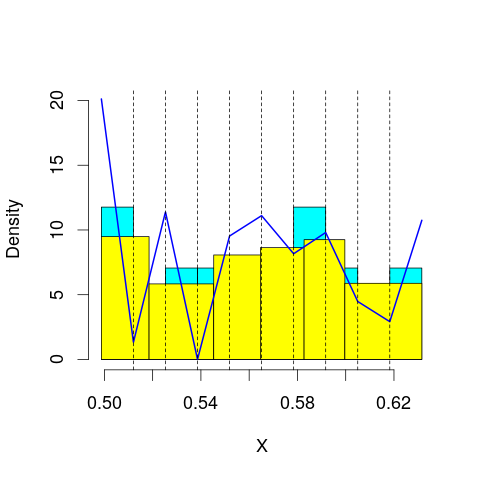

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.12988
mop.approx: Iteration 11. LL = 66.41567
mop.approx: Iteration 21. LL = 66.51885
mop.approx: Iteration 31. LL = 66.54613
mop.approx: Iteration 41. LL = 66.55676
mop.approx: Iteration 51. LL = 66.56188
mop.approx: Iteration 61. LL = 66.56469
mop.approx: Iteration 71. LL = 66.56638
mop.approx: Iteration 81. LL = 66.56744
mop.approx: Converged. Iteration 87. LL = 66.56796
[1] "Computing the linear combination of B-splines"


45.7735401227
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 63.89334
mop.approx: Iteration 11. LL = 65.9992
mop.approx: Iteration 21. LL = 66.13632
mop.approx: Iteration 31. LL = 66.17458
mop.approx: Iteration 41. LL = 66.18949
mop.approx: Iteration 51. LL = 66.19668
mop.approx: Iteration 61. LL = 66.20057
mop.approx: Iteration 71. LL = 66.20282
mop.approx: Iteration 81. LL = 66.20422
mop.approx: Iteration 91. LL = 66.20513
mop.approx: Converged. Iteration 94. LL = 66.2054
[1] "Computing the linear combination of B-splines"


43.6781179868
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.14827
mop.approx: Iteration 11. LL = 59.86901
mop.approx: Iteration 21. LL = 60.04176
mop.approx: Iteration 31. LL = 60.11085
mop.approx: Iteration 41. LL = 60.14043
mop.approx: Iteration 51. LL = 60.15395
mop.approx: Iteration 61. LL = 60.1606
mop.approx: Iteration 71. LL = 60.16416
mop.approx: Iteration 81. LL = 60.1662
mop.approx: Iteration 91. LL = 60.16744
mop.approx: Iteration 101. LL = 60.16822
mop.approx: Converged. Iteration 102. LL = 60.16834
[1] "Computing the linear combination of B-splines"


35.9081853657
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.64388
mop.approx: Iteration 11. LL = 60.29704
mop.approx: Iteration 21. LL = 60.36519
mop.approx: Iteration 31. LL = 60.38142
mop.approx: Iteration 41. LL = 60.38572
mop.approx: Converged. Iteration 50. LL = 60.38686
[1] "Computing the linear combination of B-splines"


34.3938425293
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.948802
mop.approx: Iteration 11. LL = 59.6519
mop.approx: Iteration 21. LL = 59.8985
mop.approx: Iteration 31. LL = 59.92627
mop.approx: Iteration 41. LL = 59.93062
mop.approx: Converged. Iteration 49. LL = 59.9315
[1] "Computing the linear combination of B-splines"


32.2056107895
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.855271
mop.approx: Iteration 11. LL = 58.36898
mop.approx: Iteration 21. LL = 58.55778
mop.approx: Iteration 31. LL = 58.64039
mop.approx: Iteration 41. LL = 58.67904
mop.approx: Iteration 51. LL = 58.69759
mop.approx: Iteration 61. LL = 58.70667
mop.approx: Iteration 71. LL = 58.71121
mop.approx: Iteration 81. LL = 58.71353
mop.approx: Iteration 91. LL = 58.71474
mop.approx: Converged. Iteration 97. LL = 58.71523
[1] "Computing the linear combination of B-splines"


29.2566834518
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.226505
mop.approx: Iteration 11. LL = 58.42063
mop.approx: Iteration 21. LL = 58.42656
mop.approx: Iteration 31. LL = 58.42841
mop.approx: Iteration 41. LL = 58.4296
mop.approx: Iteration 51. LL = 58.43037
mop.approx: Converged. Iteration 52. LL = 58.43049
[1] "Computing the linear combination of B-splines"


27.2358317788
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.36817
mop.approx: Iteration 11. LL = 67.90517
mop.approx: Iteration 21. LL = 67.96657
mop.approx: Iteration 31. LL = 67.97702
mop.approx: Iteration 41. LL = 67.9808
mop.approx: Iteration 51. LL = 67.98266
mop.approx: Iteration 61. LL = 67.98372
mop.approx: Converged. Iteration 65. LL = 67.98409
[1] "Computing the linear combination of B-splines"


47.1896761731
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 47.189676173079079)
m reached
('Sum of Probabilities:', 0.9848081968687716)
chosen


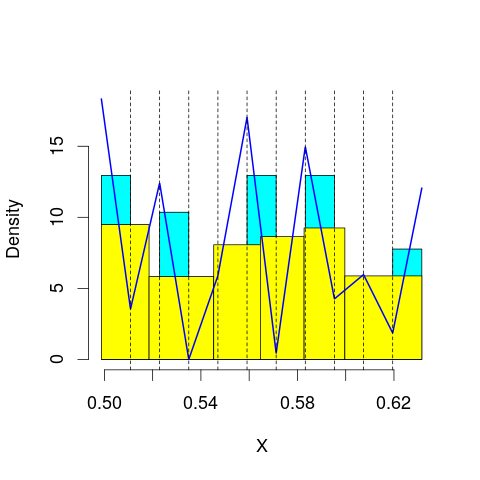

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.12988
mop.approx: Iteration 11. LL = 67.12351
mop.approx: Iteration 21. LL = 67.20807
mop.approx: Iteration 31. LL = 67.22356
mop.approx: Iteration 41. LL = 67.22811
mop.approx: Iteration 51. LL = 67.22983
mop.approx: Converged. Iteration 58. LL = 67.23049
[1] "Computing the linear combination of B-splines"


44.7032032727
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 63.89334
mop.approx: Iteration 11. LL = 66.3363
mop.approx: Iteration 21. LL = 66.55613
mop.approx: Iteration 31. LL = 66.62088
mop.approx: Iteration 41. LL = 66.64453
mop.approx: Iteration 51. LL = 66.6544
mop.approx: Iteration 61. LL = 66.65893
mop.approx: Iteration 71. LL = 66.66115
mop.approx: Iteration 81. LL = 66.66229
mop.approx: Converged. Iteration 84. LL = 66.66258
[1] "Computing the linear combination of B-splines"


42.4024284334
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.14827
mop.approx: Iteration 11. LL = 60.0434
mop.approx: Iteration 21. LL = 60.15
mop.approx: Iteration 31. LL = 60.17738
mop.approx: Iteration 41. LL = 60.18753
mop.approx: Iteration 51. LL = 60.19237
mop.approx: Iteration 61. LL = 60.19506
mop.approx: Iteration 71. LL = 60.19671
mop.approx: Iteration 81. LL = 60.19778
mop.approx: Iteration 91. LL = 60.19851
mop.approx: Converged. Iteration 91. LL = 60.19857
[1] "Computing the linear combination of B-splines"


34.2055472336
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.64388
mop.approx: Iteration 11. LL = 60.66199
mop.approx: Iteration 21. LL = 60.8462
mop.approx: Iteration 31. LL = 60.91875
mop.approx: Iteration 41. LL = 60.95038
mop.approx: Iteration 51. LL = 60.96451
mop.approx: Iteration 61. LL = 60.97083
mop.approx: Iteration 71. LL = 60.97364
mop.approx: Iteration 81. LL = 60.97488
mop.approx: Converged. Iteration 84. LL = 60.97515
[1] "Computing the linear combination of B-splines"


33.2492626598
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.948802
mop.approx: Iteration 11. LL = 60.19546
mop.approx: Iteration 21. LL = 60.34025
mop.approx: Iteration 31. LL = 60.3496
mop.approx: Converged. Iteration 37. LL = 60.35041
[1] "Computing the linear combination of B-splines"


30.8916541747
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.855271
mop.approx: Iteration 11. LL = 58.85808
mop.approx: Iteration 21. LL = 59.0747
mop.approx: Iteration 31. LL = 59.12112
mop.approx: Iteration 41. LL = 59.1327
mop.approx: Iteration 51. LL = 59.13643
mop.approx: Iteration 61. LL = 59.13797
mop.approx: Converged. Iteration 69. LL = 59.13864
[1] "Computing the linear combination of B-splines"


27.9469815904
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.226505
mop.approx: Iteration 11. LL = 58.46573
mop.approx: Iteration 21. LL = 58.53805
mop.approx: Iteration 31. LL = 58.57984
mop.approx: Iteration 41. LL = 58.60525
mop.approx: Iteration 51. LL = 58.62141
mop.approx: Iteration 61. LL = 58.63211
mop.approx: Iteration 71. LL = 58.63943
mop.approx: Iteration 81. LL = 58.64459
mop.approx: Iteration 91. LL = 58.64829
mop.approx: Iteration 101. LL = 58.651
mop.approx: Iteration 111. LL = 58.65301
mop.approx: Iteration 121. LL = 58.65452
mop.approx: Iteration 131. LL = 58.65566
mop.approx: Iteration 141. LL = 58.65654
mop.approx: Iteration 151. LL = 58.65721
mop.approx: Converged. Iteration 151. LL = 58.65727
[1] "Computing the linear combination of B-splines"


25.7271039956
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.36817
mop.approx: Iteration 11. LL = 67.646
mop.approx: Iteration 21. LL = 67.67766
mop.approx: Iteration 31. LL = 67.68413
mop.approx: Iteration 41. LL = 67.68637
mop.approx: Converged. Iteration 50. LL = 67.6873
[1] "Computing the linear combination of B-splines"


45.1600138251
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 45.160013825099867)
m reached
('Sum of Probabilities:', 0.9863065312148662)
chosen


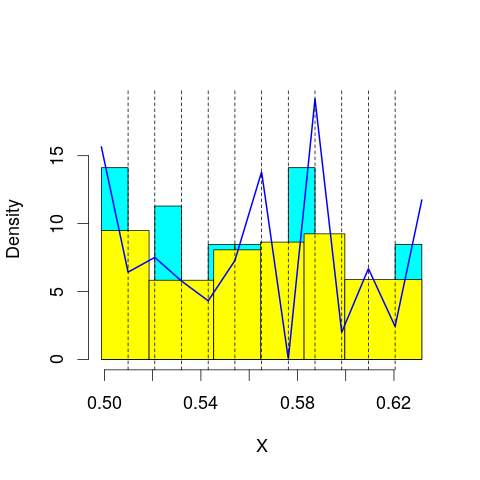

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.12988
mop.approx: Iteration 11. LL = 67.53603
mop.approx: Iteration 21. LL = 67.59261
mop.approx: Iteration 31. LL = 67.60346
mop.approx: Iteration 41. LL = 67.60705
mop.approx: Iteration 51. LL = 67.60857
mop.approx: Converged. Iteration 57. LL = 67.60914
[1] "Computing the linear combination of B-splines"


43.3489917223
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 63.89334
mop.approx: Iteration 11. LL = 66.50169
mop.approx: Iteration 21. LL = 66.70301
mop.approx: Iteration 31. LL = 66.76515
mop.approx: Iteration 41. LL = 66.78957
mop.approx: Iteration 51. LL = 66.80057
mop.approx: Iteration 61. LL = 66.80605
mop.approx: Iteration 71. LL = 66.809
mop.approx: Iteration 81. LL = 66.81068
mop.approx: Iteration 91. LL = 66.81168
mop.approx: Converged. Iteration 94. LL = 66.81196
[1] "Computing the linear combination of B-splines"


40.8189439614
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.14827
mop.approx: Iteration 11. LL = 60.28981
mop.approx: Iteration 21. LL = 60.40041
mop.approx: Iteration 31. LL = 60.43452
mop.approx: Iteration 41. LL = 60.44902
mop.approx: Iteration 51. LL = 60.45595
mop.approx: Iteration 61. LL = 60.45945
mop.approx: Iteration 71. LL = 60.46126
mop.approx: Iteration 81. LL = 60.46221
mop.approx: Converged. Iteration 83. LL = 60.46239
[1] "Computing the linear combination of B-splines"


32.7365052922
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.64388
mop.approx: Iteration 11. LL = 60.87773
mop.approx: Iteration 21. LL = 61.06054
mop.approx: Iteration 31. LL = 61.12265
mop.approx: Iteration 41. LL = 61.14774
mop.approx: Iteration 51. LL = 61.15866
mop.approx: Iteration 61. LL = 61.16365
mop.approx: Iteration 71. LL = 61.16603
mop.approx: Iteration 81. LL = 61.16719
mop.approx: Converged. Iteration 85. LL = 61.16754
[1] "Computing the linear combination of B-splines"


31.7087813454
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.948802
mop.approx: Iteration 11. LL = 60.79539
mop.approx: Iteration 21. LL = 61.0209
mop.approx: Iteration 31. LL = 61.09476
mop.approx: Iteration 41. LL = 61.12813
mop.approx: Iteration 51. LL = 61.14328
mop.approx: Iteration 61. LL = 61.15001
mop.approx: Iteration 71. LL = 61.15294
mop.approx: Iteration 81. LL = 61.1542
mop.approx: Converged. Iteration 84. LL = 61.15448
[1] "Computing the linear combination of B-splines"


29.9628618834
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.855271
mop.approx: Iteration 11. LL = 59.40939
mop.approx: Iteration 21. LL = 59.62268
mop.approx: Iteration 31. LL = 59.66618
mop.approx: Iteration 41. LL = 59.68068
mop.approx: Iteration 51. LL = 59.68718
mop.approx: Iteration 61. LL = 59.69058
mop.approx: Iteration 71. LL = 59.69254
mop.approx: Iteration 81. LL = 59.69374
mop.approx: Iteration 91. LL = 59.69451
mop.approx: Converged. Iteration 92. LL = 59.69463
[1] "Computing the linear combination of B-splines"


26.7704172209
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.226505
mop.approx: Iteration 11. LL = 58.75078
mop.approx: Iteration 21. LL = 58.87483
mop.approx: Iteration 31. LL = 58.91575
mop.approx: Iteration 41. LL = 58.93059
mop.approx: Iteration 51. LL = 58.93721
mop.approx: Iteration 61. LL = 58.94093
mop.approx: Iteration 71. LL = 58.94339
mop.approx: Iteration 81. LL = 58.94515
mop.approx: Iteration 91. LL = 58.94646
mop.approx: Iteration 101. LL = 58.94747
mop.approx: Iteration 111. LL = 58.94826
mop.approx: Converged. Iteration 119. LL = 58.94883
[1] "Computing the linear combination of B-splines"


24.2456424537
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.36817
mop.approx: Iteration 11. LL = 67.87841
mop.approx: Iteration 21. LL = 67.88639
mop.approx: Converged. Iteration 26. LL = 67.88701
[1] "Computing the linear combination of B-splines"


43.6268539562
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 43.626853956244339)
m reached
('Sum of Probabilities:', 0.9873707835623667)
chosen


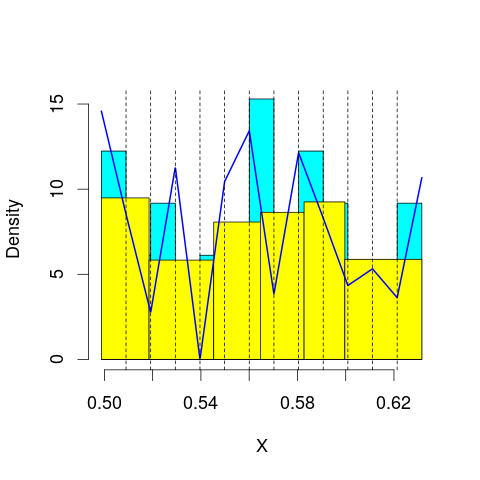

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.12988
mop.approx: Iteration 11. LL = 68.63804
mop.approx: Iteration 21. LL = 68.73933
mop.approx: Iteration 31. LL = 68.7521
mop.approx: Iteration 41. LL = 68.75538
mop.approx: Converged. Iteration 49. LL = 68.75633
[1] "Computing the linear combination of B-splines"


42.7633131512
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 63.89334
mop.approx: Iteration 11. LL = 66.57597
mop.approx: Iteration 21. LL = 66.67916
mop.approx: Iteration 31. LL = 66.71314
mop.approx: Iteration 41. LL = 66.72979
mop.approx: Iteration 51. LL = 66.73926
mop.approx: Iteration 61. LL = 66.74516
mop.approx: Iteration 71. LL = 66.74907
mop.approx: Iteration 81. LL = 66.75178
mop.approx: Iteration 91. LL = 66.75373
mop.approx: Iteration 101. LL = 66.75518
mop.approx: Iteration 111. LL = 66.75628
mop.approx: Iteration 121. LL = 66.75713
mop.approx: Converged. Iteration 126. LL = 66.75755
[1] "Computing the linear combination of B-splines"


39.0316651445
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.14827
mop.approx: Iteration 11. LL = 60.83731
mop.approx: Iteration 21. LL = 61.01667
mop.approx: Iteration 31. LL = 61.05019
mop.approx: Iteration 41. LL = 61.05816
mop.approx: Iteration 51. LL = 61.06094
mop.approx: Iteration 61. LL = 61.0623
mop.approx: Iteration 71. LL = 61.0631
mop.approx: Converged. Iteration 72. LL = 61.06322
[1] "Computing the linear combination of B-splines"


31.6044634264
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.64388
mop.approx: Iteration 11. LL = 60.95508
mop.approx: Iteration 21. LL = 61.07876
mop.approx: Iteration 31. LL = 61.11663
mop.approx: Iteration 41. LL = 61.13323
mop.approx: Iteration 51. LL = 61.14186
mop.approx: Iteration 61. LL = 61.14672
mop.approx: Iteration 71. LL = 61.14958
mop.approx: Iteration 81. LL = 61.1513
mop.approx: Iteration 91. LL = 61.15235
mop.approx: Converged. Iteration 97. LL = 61.15284
[1] "Computing the linear combination of B-splines"


29.9612148136
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.948802
mop.approx: Iteration 11. LL = 61.34037
mop.approx: Iteration 21. LL = 61.6075
mop.approx: Iteration 31. LL = 61.68089
mop.approx: Iteration 41. LL = 61.70667
mop.approx: Iteration 51. LL = 61.71654
mop.approx: Iteration 61. LL = 61.7206
mop.approx: Iteration 71. LL = 61.72243
mop.approx: Iteration 81. LL = 61.72334
mop.approx: Converged. Iteration 82. LL = 61.72346
[1] "Computing the linear combination of B-splines"


28.7989628077
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.855271
mop.approx: Iteration 11. LL = 60.08621
mop.approx: Iteration 21. LL = 60.39724
mop.approx: Iteration 31. LL = 60.49294
mop.approx: Iteration 41. LL = 60.5339
mop.approx: Iteration 51. LL = 60.55275
mop.approx: Iteration 61. LL = 60.56144
mop.approx: Iteration 71. LL = 60.56539
mop.approx: Iteration 81. LL = 60.56716
mop.approx: Converged. Iteration 89. LL = 60.56789
[1] "Computing the linear combination of B-splines"


25.9086704082
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.226505
mop.approx: Iteration 11. LL = 58.97683
mop.approx: Iteration 21. LL = 59.06938
mop.approx: Iteration 31. LL = 59.08321
mop.approx: Iteration 41. LL = 59.08568
mop.approx: Iteration 51. LL = 59.08649
mop.approx: Converged. Iteration 51. LL = 59.08655
[1] "Computing the linear combination of B-splines"


22.6792176898
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.36817
mop.approx: Iteration 11. LL = 70.72587
mop.approx: Converged. Iteration 14. LL = 70.72666
[1] "Computing the linear combination of B-splines"


44.7336407758
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 44.733640775800964)
m reached
('Sum of Probabilities:', 0.9873479554096909)
chosen


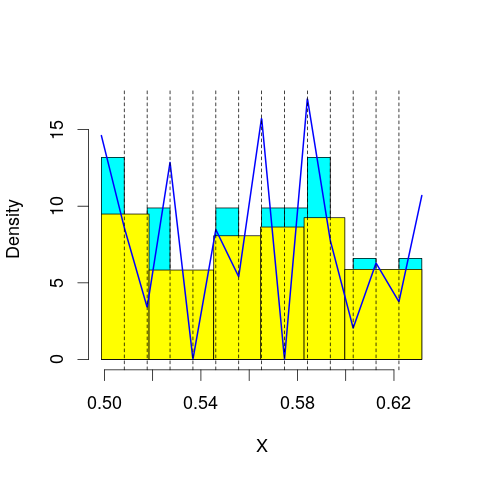

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.12988
mop.approx: Iteration 11. LL = 67.22993
mop.approx: Iteration 21. LL = 67.34243
mop.approx: Iteration 31. LL = 67.36942
mop.approx: Iteration 41. LL = 67.37806
mop.approx: Iteration 51. LL = 67.38157
mop.approx: Iteration 61. LL = 67.38334
mop.approx: Iteration 71. LL = 67.3844
mop.approx: Converged. Iteration 77. LL = 67.38492
[1] "Computing the linear combination of B-splines"


39.6590299137
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 63.89334
mop.approx: Iteration 11. LL = 68.12322
mop.approx: Iteration 21. LL = 68.25321
mop.approx: Iteration 31. LL = 68.28322
mop.approx: Iteration 41. LL = 68.29432
mop.approx: Iteration 51. LL = 68.29916
mop.approx: Iteration 61. LL = 68.30159
mop.approx: Iteration 71. LL = 68.30294
mop.approx: Converged. Iteration 79. LL = 68.30368
[1] "Computing the linear combination of B-splines"


38.8449295734
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.14827
mop.approx: Iteration 11. LL = 60.58032
mop.approx: Iteration 21. LL = 60.69792
mop.approx: Iteration 31. LL = 60.7241
mop.approx: Iteration 41. LL = 60.73241
mop.approx: Iteration 51. LL = 60.73571
mop.approx: Iteration 61. LL = 60.73729
mop.approx: Iteration 71. LL = 60.73814
mop.approx: Converged. Iteration 72. LL = 60.73827
[1] "Computing the linear combination of B-splines"


29.5466448632
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.64388
mop.approx: Iteration 11. LL = 61.42559
mop.approx: Iteration 21. LL = 61.54741
mop.approx: Iteration 31. LL = 61.56438
mop.approx: Iteration 41. LL = 61.5671
mop.approx: Converged. Iteration 44. LL = 61.56741
[1] "Computing the linear combination of B-splines"


28.642914912
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.948802
mop.approx: Iteration 11. LL = 61.47761
mop.approx: Iteration 21. LL = 61.6492
mop.approx: Iteration 31. LL = 61.68376
mop.approx: Iteration 41. LL = 61.69425
mop.approx: Iteration 51. LL = 61.69921
mop.approx: Iteration 61. LL = 61.70234
mop.approx: Iteration 71. LL = 61.70454
mop.approx: Iteration 81. LL = 61.70614
mop.approx: Iteration 91. LL = 61.70733
mop.approx: Iteration 101. LL = 61.70821
mop.approx: Converged. Iteration 109. LL = 61.70882
[1] "Computing the linear combination of B-splines"


27.0514909378
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.855271
mop.approx: Iteration 11. LL = 60.89667
mop.approx: Iteration 21. LL = 61.27947
mop.approx: Iteration 31. LL = 61.36756
mop.approx: Iteration 41. LL = 61.397
mop.approx: Iteration 51. LL = 61.40864
mop.approx: Iteration 61. LL = 61.41372
mop.approx: Iteration 71. LL = 61.41613
mop.approx: Iteration 81. LL = 61.41738
mop.approx: Converged. Iteration 88. LL = 61.41798
[1] "Computing the linear combination of B-splines"


25.0248826561
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.226505
mop.approx: Iteration 11. LL = 59.92546
mop.approx: Iteration 21. LL = 60.26256
mop.approx: Iteration 31. LL = 60.35023
mop.approx: Iteration 41. LL = 60.37815
mop.approx: Iteration 51. LL = 60.38988
mop.approx: Iteration 61. LL = 60.39575
mop.approx: Iteration 71. LL = 60.39895
mop.approx: Iteration 81. LL = 60.40075
mop.approx: Iteration 91. LL = 60.40181
mop.approx: Converged. Iteration 97. LL = 60.40228
[1] "Computing the linear combination of B-splines"


22.1342916838
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.36817
mop.approx: Iteration 11. LL = 68.57719
mop.approx: Iteration 21. LL = 68.5826
mop.approx: Converged. Iteration 23. LL = 68.58282
[1] "Computing the linear combination of B-splines"


40.8569374938
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 40.856937493794717)
m reached
('Sum of Probabilities:', 0.987220490667093)
chosen


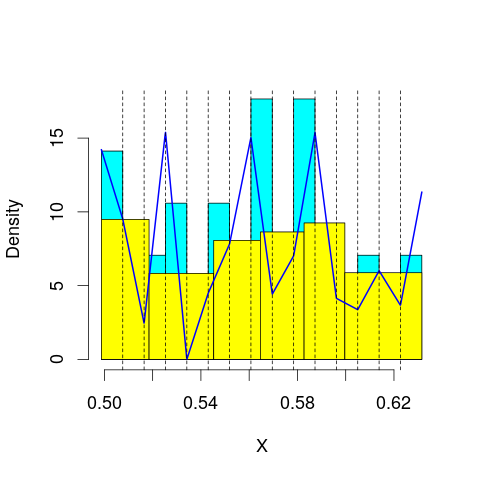

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.12988
mop.approx: Iteration 11. LL = 69.54171
mop.approx: Iteration 21. LL = 69.56826
mop.approx: Iteration 31. LL = 69.57474
mop.approx: Iteration 41. LL = 69.57751
mop.approx: Iteration 51. LL = 69.57897
mop.approx: Iteration 61. LL = 69.57984
mop.approx: Converged. Iteration 61. LL = 69.57991
[1] "Computing the linear combination of B-splines"


40.1211542491
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 63.89334
mop.approx: Iteration 11. LL = 67.85719
mop.approx: Iteration 21. LL = 68.02017
mop.approx: Iteration 31. LL = 68.06051
mop.approx: Iteration 41. LL = 68.07496
mop.approx: Iteration 51. LL = 68.08077
mop.approx: Iteration 61. LL = 68.08317
mop.approx: Converged. Iteration 70. LL = 68.08417
[1] "Computing the linear combination of B-splines"


36.8925430863
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.14827
mop.approx: Iteration 11. LL = 61.37709
mop.approx: Iteration 21. LL = 61.46181
mop.approx: Iteration 31. LL = 61.47217
mop.approx: Iteration 41. LL = 61.47523
mop.approx: Iteration 51. LL = 61.47648
mop.approx: Converged. Iteration 55. LL = 61.47682
[1] "Computing the linear combination of B-splines"


28.5523256194
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.64388
mop.approx: Iteration 11. LL = 61.56816
mop.approx: Iteration 21. LL = 61.73336
mop.approx: Iteration 31. LL = 61.77773
mop.approx: Iteration 41. LL = 61.7934
mop.approx: Iteration 51. LL = 61.79975
mop.approx: Iteration 61. LL = 61.80265
mop.approx: Iteration 71. LL = 61.80416
mop.approx: Iteration 81. LL = 61.80503
mop.approx: Converged. Iteration 83. LL = 61.80523
[1] "Computing the linear combination of B-splines"


27.1478632339
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.948802
mop.approx: Iteration 11. LL = 61.72602
mop.approx: Iteration 21. LL = 61.86384
mop.approx: Iteration 31. LL = 61.8882
mop.approx: Iteration 41. LL = 61.89431
mop.approx: Iteration 51. LL = 61.89638
mop.approx: Converged. Iteration 60. LL = 61.89724
[1] "Computing the linear combination of B-splines"


25.506849491
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.855271
mop.approx: Iteration 11. LL = 61.48673
mop.approx: Iteration 21. LL = 61.82074
mop.approx: Iteration 31. LL = 61.87651
mop.approx: Iteration 41. LL = 61.89221
mop.approx: Iteration 51. LL = 61.89864
mop.approx: Iteration 61. LL = 61.90196
mop.approx: Iteration 71. LL = 61.90392
mop.approx: Iteration 81. LL = 61.90516
mop.approx: Iteration 91. LL = 61.906
mop.approx: Converged. Iteration 95. LL = 61.90632
[1] "Computing the linear combination of B-splines"


23.7768897
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.226505
mop.approx: Iteration 11. LL = 61.27332
mop.approx: Iteration 21. LL = 61.56102
mop.approx: Iteration 31. LL = 61.60236
mop.approx: Iteration 41. LL = 61.61087
mop.approx: Iteration 51. LL = 61.61338
mop.approx: Iteration 61. LL = 61.61437
mop.approx: Converged. Iteration 62. LL = 61.6145
[1] "Computing the linear combination of B-splines"


21.6902007751
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.36817
mop.approx: Iteration 11. LL = 71.40326
mop.approx: Iteration 21. LL = 71.45475
mop.approx: Iteration 31. LL = 71.46424
mop.approx: Iteration 41. LL = 71.46694
mop.approx: Converged. Iteration 49. LL = 71.46785
[1] "Computing the linear combination of B-splines"


42.0090962798
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 42.009096279763575)
m reached
('Sum of Probabilities:', 0.9868835885210957)
chosen


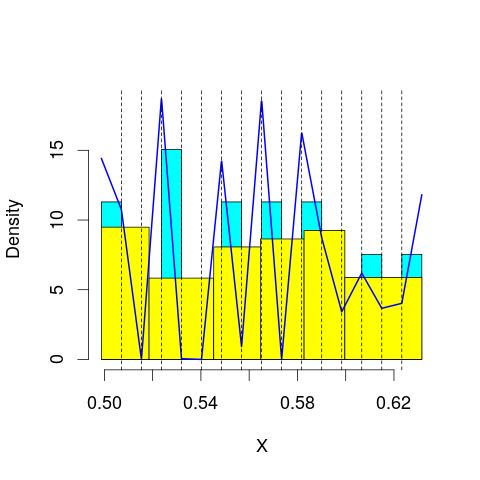

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.12988
mop.approx: Iteration 11. LL = 68.74034
mop.approx: Iteration 21. LL = 68.80615
mop.approx: Iteration 31. LL = 68.82418
mop.approx: Iteration 41. LL = 68.83129
mop.approx: Iteration 51. LL = 68.83465
mop.approx: Iteration 61. LL = 68.83641
mop.approx: Iteration 71. LL = 68.8374
mop.approx: Converged. Iteration 72. LL = 68.83754
[1] "Computing the linear combination of B-splines"


37.6459139362
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 63.89334
mop.approx: Iteration 11. LL = 69.18036
mop.approx: Iteration 21. LL = 69.37442
mop.approx: Iteration 31. LL = 69.4072
mop.approx: Iteration 41. LL = 69.41686
mop.approx: Iteration 51. LL = 69.42085
mop.approx: Iteration 61. LL = 69.42293
mop.approx: Iteration 71. LL = 69.42419
mop.approx: Iteration 81. LL = 69.42503
mop.approx: Converged. Iteration 81. LL = 69.4251
[1] "Computing the linear combination of B-splines"


36.5006110002
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.14827
mop.approx: Iteration 11. LL = 61.61641
mop.approx: Iteration 21. LL = 61.74605
mop.approx: Iteration 31. LL = 61.78
mop.approx: Iteration 41. LL = 61.79359
mop.approx: Iteration 51. LL = 61.80042
mop.approx: Iteration 61. LL = 61.80442
mop.approx: Iteration 71. LL = 61.80697
mop.approx: Iteration 81. LL = 61.80872
mop.approx: Iteration 91. LL = 61.80996
mop.approx: Iteration 101. LL = 61.81088
mop.approx: Converged. Iteration 110. LL = 61.81158
[1] "Computing the linear combination of B-splines"


27.1542170475
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.64388
mop.approx: Iteration 11. LL = 61.92875
mop.approx: Iteration 21. LL = 62.11828
mop.approx: Iteration 31. LL = 62.16382
mop.approx: Iteration 41. LL = 62.18092
mop.approx: Iteration 51. LL = 62.18872
mop.approx: Iteration 61. LL = 62.19275
mop.approx: Iteration 71. LL = 62.19503
mop.approx: Iteration 81. LL = 62.19642
mop.approx: Iteration 91. LL = 62.19731
mop.approx: Converged. Iteration 95. LL = 62.19764
[1] "Computing the linear combination of B-splines"


25.8074116642
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.948802
mop.approx: Iteration 11. LL = 62.02811
mop.approx: Iteration 21. LL = 62.19639
mop.approx: Iteration 31. LL = 62.24126
mop.approx: Iteration 41. LL = 62.26167
mop.approx: Iteration 51. LL = 62.2734
mop.approx: Iteration 61. LL = 62.28078
mop.approx: Iteration 71. LL = 62.2856
mop.approx: Iteration 81. LL = 62.2888
mop.approx: Iteration 91. LL = 62.29094
mop.approx: Iteration 101. LL = 62.2924
mop.approx: Iteration 111. LL = 62.2934
mop.approx: Converged. Iteration 119. LL = 62.29403
[1] "Computing the linear combination of B-splines"


24.1707312077
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.855271
mop.approx: Iteration 11. LL = 61.83078
mop.approx: Iteration 21. LL = 62.09324
mop.approx: Iteration 31. LL = 62.13912
mop.approx: Iteration 41. LL = 62.1524
mop.approx: Iteration 51. LL = 62.15731
mop.approx: Iteration 61. LL = 62.15948
mop.approx: Iteration 71. LL = 62.16055
mop.approx: Converged. Iteration 74. LL = 62.16082
[1] "Computing the linear combination of B-splines"


22.3018516274
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.226505
mop.approx: Iteration 11. LL = 61.40857
mop.approx: Iteration 21. LL = 61.6637
mop.approx: Iteration 31. LL = 61.73598
mop.approx: Iteration 41. LL = 61.77478
mop.approx: Iteration 51. LL = 61.79888
mop.approx: Iteration 61. LL = 61.81461
mop.approx: Iteration 71. LL = 61.82519
mop.approx: Iteration 81. LL = 61.83247
mop.approx: Iteration 91. LL = 61.83756
mop.approx: Iteration 101. LL = 61.84116
mop.approx: Iteration 111. LL = 61.84374
mop.approx: Iteration 121. LL = 61.84561
mop.approx: Iteration 131. LL = 61.84696
mop.approx: Iteration 141. LL = 61.84796
mop.approx: Iteration 151. LL = 61.84869
mop.approx: Converged. Iteration 152. LL = 61.84881
[1] "Computing the linear combination of B-splines"


19.7694894286
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.36817
mop.approx: Iteration 11. LL = 69.61025
mop.approx: Iteration 21. LL = 69.65453
mop.approx: Iteration 31. LL = 69.66537
mop.approx: Iteration 41. LL = 69.66944
mop.approx: Iteration 51. LL = 69.67136
mop.approx: Iteration 61. LL = 69.6724
mop.approx: Converged. Iteration 63. LL = 69.67262
[1] "Computing the linear combination of B-splines"


38.4809983094
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 38.4809983094231)
m reached
('Sum of Probabilities:', 0.9867163860796839)
chosen


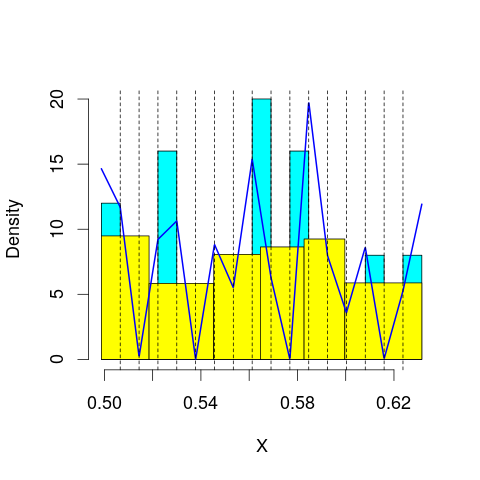

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.12988
mop.approx: Iteration 11. LL = 71.03624
mop.approx: Iteration 21. LL = 71.13978
mop.approx: Iteration 31. LL = 71.16384
mop.approx: Iteration 41. LL = 71.17217
mop.approx: Iteration 51. LL = 71.17577
mop.approx: Iteration 61. LL = 71.17754
mop.approx: Converged. Iteration 70. LL = 71.17847
[1] "Computing the linear combination of B-splines"


38.2539808328
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 63.89334
mop.approx: Iteration 11. LL = 68.53219
mop.approx: Iteration 21. LL = 68.70498
mop.approx: Iteration 31. LL = 68.73992
mop.approx: Iteration 41. LL = 68.75228
mop.approx: Iteration 51. LL = 68.75808
mop.approx: Iteration 61. LL = 68.76111
mop.approx: Iteration 71. LL = 68.76278
mop.approx: Iteration 81. LL = 68.76374
mop.approx: Converged. Iteration 82. LL = 68.76387
[1] "Computing the linear combination of B-splines"


34.106515312
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.14827
mop.approx: Iteration 11. LL = 62.74642
mop.approx: Iteration 21. LL = 62.88398
mop.approx: Iteration 31. LL = 62.90478
mop.approx: Iteration 41. LL = 62.91096
mop.approx: Iteration 51. LL = 62.91362
mop.approx: Iteration 61. LL = 62.9151
mop.approx: Iteration 71. LL = 62.91609
mop.approx: Converged. Iteration 80. LL = 62.91679
[1] "Computing the linear combination of B-splines"


26.5265642744
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.64388
mop.approx: Iteration 11. LL = 61.97472
mop.approx: Iteration 21. LL = 62.11068
mop.approx: Iteration 31. LL = 62.14846
mop.approx: Iteration 41. LL = 62.16627
mop.approx: Iteration 51. LL = 62.17598
mop.approx: Iteration 61. LL = 62.1815
mop.approx: Iteration 71. LL = 62.1847
mop.approx: Iteration 81. LL = 62.18657
mop.approx: Iteration 91. LL = 62.18765
mop.approx: Converged. Iteration 96. LL = 62.18808
[1] "Computing the linear combination of B-splines"


24.0649795186
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.948802
mop.approx: Iteration 11. LL = 62.44167
mop.approx: Iteration 21. LL = 62.64781
mop.approx: Iteration 31. LL = 62.69499
mop.approx: Iteration 41. LL = 62.71352
mop.approx: Iteration 51. LL = 62.72266
mop.approx: Iteration 61. LL = 62.72751
mop.approx: Iteration 71. LL = 62.73016
mop.approx: Iteration 81. LL = 62.73162
mop.approx: Converged. Iteration 90. LL = 62.73243
[1] "Computing the linear combination of B-splines"


22.8766054076
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.855271
mop.approx: Iteration 11. LL = 62.17513
mop.approx: Iteration 21. LL = 62.40742
mop.approx: Iteration 31. LL = 62.45977
mop.approx: Iteration 41. LL = 62.48297
mop.approx: Iteration 51. LL = 62.4952
mop.approx: Iteration 61. LL = 62.50185
mop.approx: Iteration 71. LL = 62.50544
mop.approx: Iteration 81. LL = 62.50736
mop.approx: Iteration 91. LL = 62.50838
mop.approx: Converged. Iteration 93. LL = 62.50858
[1] "Computing the linear combination of B-splines"


20.9274557289
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.226505
mop.approx: Iteration 11. LL = 61.89282
mop.approx: Iteration 21. LL = 62.30239
mop.approx: Iteration 31. LL = 62.40888
mop.approx: Iteration 41. LL = 62.44668
mop.approx: Iteration 51. LL = 62.46287
mop.approx: Iteration 61. LL = 62.47095
mop.approx: Iteration 71. LL = 62.47552
mop.approx: Iteration 81. LL = 62.47836
mop.approx: Iteration 91. LL = 62.48027
mop.approx: Iteration 101. LL = 62.48161
mop.approx: Iteration 111. LL = 62.48258
mop.approx: Iteration 121. LL = 62.48331
mop.approx: Converged. Iteration 122. LL = 62.48344
[1] "Computing the linear combination of B-splines"


18.5444761969
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.36817
mop.approx: Iteration 11. LL = 72.6963
mop.approx: Iteration 21. LL = 72.71997
mop.approx: Converged. Iteration 28. LL = 72.72136
[1] "Computing the linear combination of B-splines"


39.7968654657
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 39.79686546572853)
m reached
('Sum of Probabilities:', 0.9864206893797679)
chosen


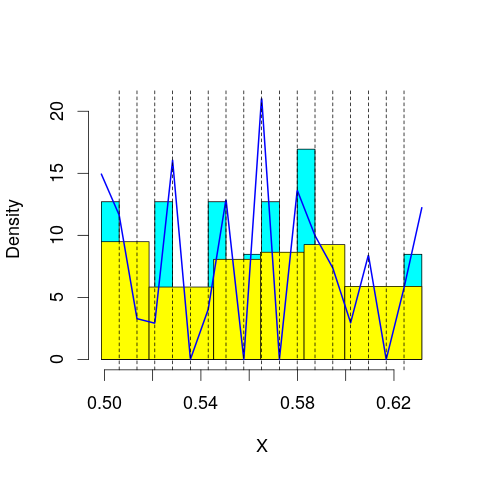

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.12988
mop.approx: Iteration 11. LL = 70.09434
mop.approx: Iteration 21. LL = 70.19678
mop.approx: Iteration 31. LL = 70.21665
mop.approx: Iteration 41. LL = 70.22325
mop.approx: Iteration 51. LL = 70.22623
mop.approx: Iteration 61. LL = 70.22785
mop.approx: Iteration 71. LL = 70.22883
mop.approx: Converged. Iteration 73. LL = 70.22905
[1] "Computing the linear combination of B-splines"


35.5716930775
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 63.89334
mop.approx: Iteration 11. LL = 69.99098
mop.approx: Iteration 21. LL = 70.12162
mop.approx: Iteration 31. LL = 70.14165
mop.approx: Iteration 41. LL = 70.14759
mop.approx: Iteration 51. LL = 70.15045
mop.approx: Iteration 61. LL = 70.15214
mop.approx: Iteration 71. LL = 70.15321
mop.approx: Converged. Iteration 76. LL = 70.15367
[1] "Computing the linear combination of B-splines"


33.7634436332
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.14827
mop.approx: Iteration 11. LL = 62.60879
mop.approx: Iteration 21. LL = 62.7953
mop.approx: Iteration 31. LL = 62.8398
mop.approx: Iteration 41. LL = 62.85753
mop.approx: Iteration 51. LL = 62.86588
mop.approx: Iteration 61. LL = 62.87019
mop.approx: Iteration 71. LL = 62.87259
mop.approx: Iteration 81. LL = 62.87404
mop.approx: Iteration 91. LL = 62.87497
mop.approx: Converged. Iteration 96. LL = 62.87537
[1] "Computing the linear combination of B-splines"


24.7522744178
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.64388
mop.approx: Iteration 11. LL = 62.93032
mop.approx: Iteration 21. LL = 63.14357
mop.approx: Iteration 31. LL = 63.19408
mop.approx: Iteration 41. LL = 63.2123
mop.approx: Iteration 51. LL = 63.22069
mop.approx: Iteration 61. LL = 63.22515
mop.approx: Iteration 71. LL = 63.2277
mop.approx: Iteration 81. LL = 63.22922
mop.approx: Iteration 91. LL = 63.23013
mop.approx: Converged. Iteration 93. LL = 63.23033
[1] "Computing the linear combination of B-splines"


23.3743621751
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.948802
mop.approx: Iteration 11. LL = 62.51255
mop.approx: Iteration 21. LL = 62.72082
mop.approx: Iteration 31. LL = 62.78511
mop.approx: Iteration 41. LL = 62.81312
mop.approx: Iteration 51. LL = 62.82684
mop.approx: Iteration 61. LL = 62.83389
mop.approx: Iteration 71. LL = 62.83759
mop.approx: Iteration 81. LL = 62.83956
mop.approx: Iteration 91. LL = 62.84061
mop.approx: Converged. Iteration 94. LL = 62.84088
[1] "Computing the linear combination of B-splines"


21.2521824257
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.855271
mop.approx: Iteration 11. LL = 62.59938
mop.approx: Iteration 21. LL = 62.89115
mop.approx: Iteration 31. LL = 62.97302
mop.approx: Iteration 41. LL = 63.00576
mop.approx: Iteration 51. LL = 63.02087
mop.approx: Iteration 61. LL = 63.02854
mop.approx: Iteration 71. LL = 63.03268
mop.approx: Iteration 81. LL = 63.03498
mop.approx: Iteration 91. LL = 63.03632
mop.approx: Iteration 101. LL = 63.03711
mop.approx: Converged. Iteration 101. LL = 63.03717
[1] "Computing the linear combination of B-splines"


19.6903536547
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.226505
mop.approx: Iteration 11. LL = 63.96075
mop.approx: Iteration 21. LL = 64.32242
mop.approx: Iteration 31. LL = 64.36031
mop.approx: Iteration 41. LL = 64.36724
mop.approx: Iteration 51. LL = 64.3699
mop.approx: Iteration 61. LL = 64.37151
mop.approx: Iteration 71. LL = 64.37259
mop.approx: Converged. Iteration 79. LL = 64.37327
[1] "Computing the linear combination of B-splines"


17.6206640523
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.36817
mop.approx: Iteration 11. LL = 72.45465
mop.approx: Iteration 21. LL = 72.53969
mop.approx: Iteration 31. LL = 72.55252
mop.approx: Iteration 41. LL = 72.55635
mop.approx: Iteration 51. LL = 72.55815
mop.approx: Iteration 61. LL = 72.55916
mop.approx: Converged. Iteration 62. LL = 72.55931
[1] "Computing the linear combination of B-splines"


37.9019512984
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 37.901951298357297)
m reached
('Sum of Probabilities:', 0.9862643936014815)
chosen


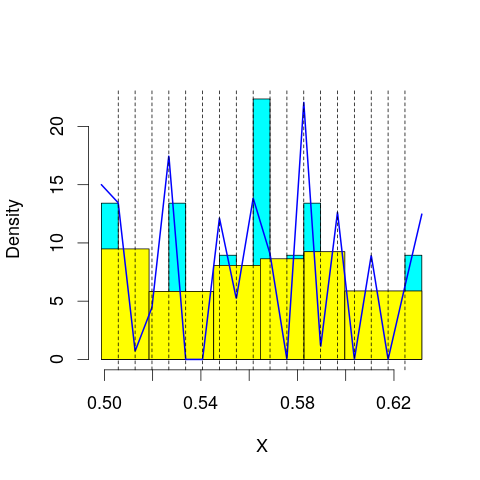

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.12988
mop.approx: Iteration 11. LL = 70.8342
mop.approx: Iteration 21. LL = 70.90109
mop.approx: Iteration 31. LL = 70.91204
mop.approx: Iteration 41. LL = 70.91485
mop.approx: Converged. Iteration 48. LL = 70.91567
[1] "Computing the linear combination of B-splines"


34.5254385338
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 63.89334
mop.approx: Iteration 11. LL = 70.38773
mop.approx: Iteration 21. LL = 70.57117
mop.approx: Iteration 31. LL = 70.61195
mop.approx: Iteration 41. LL = 70.6223
mop.approx: Iteration 51. LL = 70.62524
mop.approx: Iteration 61. LL = 70.62632
mop.approx: Converged. Iteration 61. LL = 70.62639
[1] "Computing the linear combination of B-splines"


32.5032986536
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.14827
mop.approx: Iteration 11. LL = 62.84704
mop.approx: Iteration 21. LL = 62.99693
mop.approx: Iteration 31. LL = 63.02581
mop.approx: Iteration 41. LL = 63.03329
mop.approx: Iteration 51. LL = 63.03566
mop.approx: Converged. Iteration 60. LL = 63.03655
[1] "Computing the linear combination of B-splines"


23.1805875755
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.64388
mop.approx: Iteration 11. LL = 63.41737
mop.approx: Iteration 21. LL = 63.59545
mop.approx: Iteration 31. LL = 63.64318
mop.approx: Iteration 41. LL = 63.66155
mop.approx: Iteration 51. LL = 63.67064
mop.approx: Iteration 61. LL = 63.67609
mop.approx: Iteration 71. LL = 63.67969
mop.approx: Iteration 81. LL = 63.68217
mop.approx: Iteration 91. LL = 63.68389
mop.approx: Iteration 101. LL = 63.6851
mop.approx: Iteration 111. LL = 63.68594
mop.approx: Converged. Iteration 114. LL = 63.6862
[1] "Computing the linear combination of B-splines"


22.097371087
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.948802
mop.approx: Iteration 11. LL = 62.86393
mop.approx: Iteration 21. LL = 63.09264
mop.approx: Iteration 31. LL = 63.15809
mop.approx: Iteration 41. LL = 63.18192
mop.approx: Iteration 51. LL = 63.19187
mop.approx: Iteration 61. LL = 63.1965
mop.approx: Iteration 71. LL = 63.19886
mop.approx: Iteration 81. LL = 63.20017
mop.approx: Converged. Iteration 90. LL = 63.20093
[1] "Computing the linear combination of B-splines"


19.8784378959
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.855271
mop.approx: Iteration 11. LL = 62.7335
mop.approx: Iteration 21. LL = 62.94457
mop.approx: Iteration 31. LL = 63.00269
mop.approx: Iteration 41. LL = 63.02872
mop.approx: Iteration 51. LL = 63.04132
mop.approx: Iteration 61. LL = 63.04769
mop.approx: Iteration 71. LL = 63.05108
mop.approx: Iteration 81. LL = 63.053
mop.approx: Iteration 91. LL = 63.05415
mop.approx: Converged. Iteration 99. LL = 63.05482
[1] "Computing the linear combination of B-splines"


17.9369141604
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.226505
mop.approx: Iteration 11. LL = 66.5799
mop.approx: Iteration 21. LL = 66.96814
mop.approx: Iteration 31. LL = 67.00356
mop.approx: Iteration 41. LL = 67.01031
mop.approx: Iteration 51. LL = 67.01267
mop.approx: Iteration 61. LL = 67.01381
mop.approx: Converged. Iteration 64. LL = 67.0141
[1] "Computing the linear combination of B-splines"


19.2537433899
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.36817
mop.approx: Iteration 11. LL = 73.35058
mop.approx: Iteration 21. LL = 73.41283
mop.approx: Iteration 31. LL = 73.42073
mop.approx: Iteration 41. LL = 73.42317
mop.approx: Iteration 51. LL = 73.42432
mop.approx: Converged. Iteration 53. LL = 73.42455
[1] "Computing the linear combination of B-splines"


37.0343209976
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 37.034320997612284)
m reached
('Sum of Probabilities:', 0.9859390304402595)
chosen


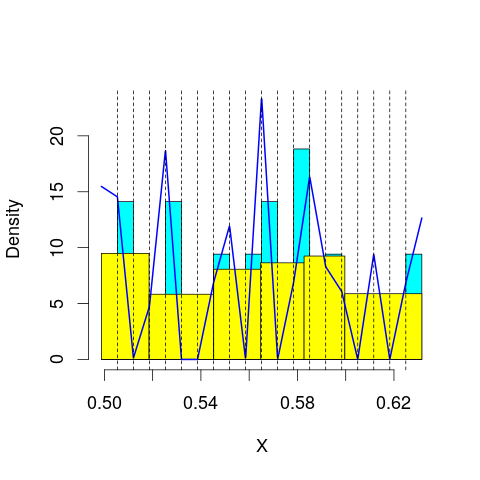

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 64.12988
mop.approx: Iteration 11. LL = 71.33429
mop.approx: Iteration 21. LL = 71.4716
mop.approx: Iteration 31. LL = 71.50621
mop.approx: Iteration 41. LL = 71.51936
mop.approx: Iteration 51. LL = 71.52541
mop.approx: Iteration 61. LL = 71.52847
mop.approx: Iteration 71. LL = 71.5301
mop.approx: Converged. Iteration 80. LL = 71.531
[1] "Computing the linear combination of B-splines"


33.4079047928
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 63.89334
mop.approx: Iteration 11. LL = 71.06127
mop.approx: Iteration 21. LL = 71.20993
mop.approx: Iteration 31. LL = 71.23098
mop.approx: Iteration 41. LL = 71.23712
mop.approx: Iteration 51. LL = 71.23963
mop.approx: Iteration 61. LL = 71.24092
mop.approx: Converged. Iteration 69. LL = 71.24166
[1] "Computing the linear combination of B-splines"


31.3856948364
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.14827
mop.approx: Iteration 11. LL = 63.11975
mop.approx: Iteration 21. LL = 63.25499
mop.approx: Iteration 31. LL = 63.29012
mop.approx: Iteration 41. LL = 63.30513
mop.approx: Iteration 51. LL = 63.31294
mop.approx: Iteration 61. LL = 63.31726
mop.approx: Iteration 71. LL = 63.31973
mop.approx: Iteration 81. LL = 63.32119
mop.approx: Iteration 91. LL = 63.32209
mop.approx: Converged. Iteration 94. LL = 63.32236
[1] "Computing the linear combination of B-splines"


21.7335263586
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 14.64388
mop.approx: Iteration 11. LL = 64.05129
mop.approx: Iteration 21. LL = 64.26359
mop.approx: Iteration 31. LL = 64.29949
mop.approx: Iteration 41. LL = 64.31052
mop.approx: Iteration 51. LL = 64.31606
mop.approx: Iteration 61. LL = 64.31967
mop.approx: Iteration 71. LL = 64.32221
mop.approx: Iteration 81. LL = 64.32401
mop.approx: Iteration 91. LL = 64.3253
mop.approx: Iteration 101. LL = 64.32622
mop.approx: Converged. Iteration 106. LL = 64.32663
[1] "Computing the linear combination of B-splines"


21.0049277427
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 9.948802
mop.approx: Iteration 11. LL = 63.29878
mop.approx: Iteration 21. LL = 63.49989
mop.approx: Iteration 31. LL = 63.54733
mop.approx: Iteration 41. LL = 63.56379
mop.approx: Iteration 51. LL = 63.57123
mop.approx: Iteration 61. LL = 63.57521
mop.approx: Iteration 71. LL = 63.57756
mop.approx: Iteration 81. LL = 63.57902
mop.approx: Iteration 91. LL = 63.57999
mop.approx: Converged. Iteration 96. LL = 63.58041
[1] "Computing the linear combination of B-splines"


18.5254073976
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.855271
mop.approx: Iteration 11. LL = 63.30724
mop.approx: Iteration 21. LL = 63.57256
mop.approx: Iteration 31. LL = 63.63214
mop.approx: Iteration 41. LL = 63.65327
mop.approx: Iteration 51. LL = 63.66293
mop.approx: Iteration 61. LL = 63.66819
mop.approx: Iteration 71. LL = 63.67143
mop.approx: Iteration 81. LL = 63.6736
mop.approx: Iteration 91. LL = 63.67514
mop.approx: Iteration 101. LL = 63.67626
mop.approx: Iteration 111. LL = 63.67711
mop.approx: Converged. Iteration 117. LL = 63.67759
[1] "Computing the linear combination of B-splines"


16.9009141531
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.226505
mop.approx: Iteration 11. LL = 70.91579
mop.approx: Iteration 21. LL = 71.11857
mop.approx: Iteration 31. LL = 71.13408
mop.approx: Iteration 41. LL = 71.13613
mop.approx: Converged. Iteration 41. LL = 71.13619
[1] "Computing the linear combination of B-splines"


21.9703034281
lfps_27
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.34136
mop.approx: Iteration 11. LL = 66.99132
mop.approx: Converged. Iteration 12. LL = 66.9915
[1] "Computing the linear combination of B-splines"


61.7928983828
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 61.792898382786206)
m reached
('Sum of Probabilities:', 0.9943656067581195)
chosen


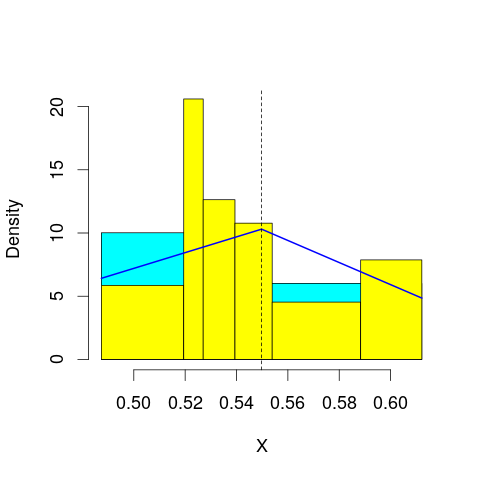

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.08797
mop.approx: Iteration 11. LL = 68.49812
mop.approx: Iteration 21. LL = 68.62809
mop.approx: Iteration 31. LL = 68.65952
mop.approx: Iteration 41. LL = 68.67163
mop.approx: Iteration 51. LL = 68.67756
mop.approx: Iteration 61. LL = 68.68091
mop.approx: Iteration 71. LL = 68.683
mop.approx: Iteration 81. LL = 68.6844
mop.approx: Iteration 91. LL = 68.68539
mop.approx: Converged. Iteration 98. LL = 68.68599
[1] "Computing the linear combination of B-splines"


61.7545142735
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.83657
mop.approx: Iteration 11. LL = 68.04133
mop.approx: Iteration 21. LL = 68.12309
mop.approx: Iteration 31. LL = 68.15697
mop.approx: Iteration 41. LL = 68.17361
mop.approx: Iteration 51. LL = 68.18243
mop.approx: Iteration 61. LL = 68.18738
mop.approx: Iteration 71. LL = 68.19026
mop.approx: Iteration 81. LL = 68.19198
mop.approx: Iteration 91. LL = 68.19302
mop.approx: Converged. Iteration 94. LL = 68.19331
[1] "Computing the linear combination of B-splines"


59.5289692837
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.63243
mop.approx: Iteration 11. LL = 52.11811
mop.approx: Converged. Iteration 19. LL = 52.1214
[1] "Computing the linear combination of B-splines"


41.7241891279
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.05104
mop.approx: Iteration 11. LL = 55.79106
mop.approx: Converged. Iteration 19. LL = 55.81095
[1] "Computing the linear combination of B-splines"


43.6808793268
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.30009
mop.approx: Iteration 11. LL = 48.29117
mop.approx: Iteration 21. LL = 48.31591
mop.approx: Iteration 31. LL = 48.31919
mop.approx: Converged. Iteration 35. LL = 48.31952
[1] "Computing the linear combination of B-splines"


34.4565747112
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.164175
mop.approx: Iteration 11. LL = 51.35578
mop.approx: Iteration 21. LL = 51.41865
mop.approx: Converged. Iteration 22. LL = 51.41877
[1] "Computing the linear combination of B-splines"


35.8229565556
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.502149
mop.approx: Iteration 11. LL = 45.19135
mop.approx: Iteration 21. LL = 45.23572
mop.approx: Iteration 31. LL = 45.24927
mop.approx: Iteration 41. LL = 45.25368
mop.approx: Iteration 51. LL = 45.25517
mop.approx: Converged. Iteration 57. LL = 45.25558
[1] "Computing the linear combination of B-splines"


27.9269024171
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.34136
mop.approx: Iteration 11. LL = 69.71447
mop.approx: Converged. Iteration 17. LL = 69.7174
[1] "Computing the linear combination of B-splines"


62.7859292228
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 62.785929222845731)
m reached
('Sum of Probabilities:', 0.9942307544455439)
chosen


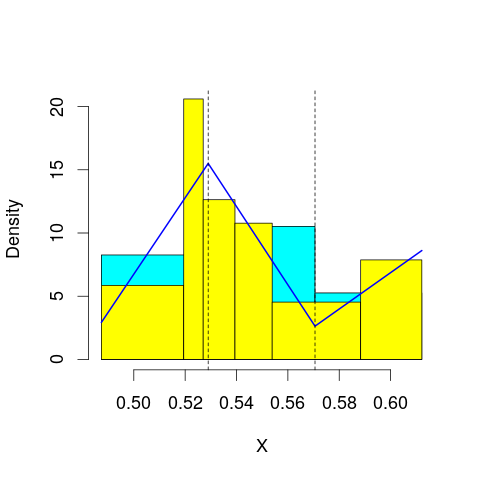

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.08797
mop.approx: Iteration 11. LL = 68.47462
mop.approx: Iteration 21. LL = 68.52457
mop.approx: Iteration 31. LL = 68.53766
mop.approx: Iteration 41. LL = 68.5429
mop.approx: Iteration 51. LL = 68.54553
mop.approx: Iteration 61. LL = 68.54704
mop.approx: Iteration 71. LL = 68.548
mop.approx: Converged. Iteration 74. LL = 68.54829
[1] "Computing the linear combination of B-splines"


59.8839499456
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.83657
mop.approx: Iteration 11. LL = 69.04434
mop.approx: Iteration 21. LL = 69.35072
mop.approx: Iteration 31. LL = 69.44141
mop.approx: Iteration 41. LL = 69.47039
mop.approx: Iteration 51. LL = 69.48008
mop.approx: Iteration 61. LL = 69.48352
mop.approx: Iteration 71. LL = 69.48486
mop.approx: Converged. Iteration 74. LL = 69.48516
[1] "Computing the linear combination of B-splines"


59.0879496555
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.63243
mop.approx: Iteration 11. LL = 62.71502
mop.approx: Iteration 21. LL = 62.78999
mop.approx: Converged. Iteration 24. LL = 62.79043
[1] "Computing the linear combination of B-splines"


50.6603515543
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.05104
mop.approx: Iteration 11. LL = 56.07293
mop.approx: Converged. Iteration 15. LL = 56.07377
[1] "Computing the linear combination of B-splines"


42.210823438
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.30009
mop.approx: Iteration 11. LL = 58.52526
mop.approx: Iteration 21. LL = 58.57561
mop.approx: Converged. Iteration 22. LL = 58.5757
[1] "Computing the linear combination of B-splines"


42.9798897898
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.164175
mop.approx: Iteration 11. LL = 51.62106
mop.approx: Iteration 21. LL = 51.63684
mop.approx: Converged. Iteration 28. LL = 51.63797
[1] "Computing the linear combination of B-splines"


34.3092856948
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.502149
mop.approx: Iteration 11. LL = 54.00534
mop.approx: Iteration 21. LL = 54.09782
mop.approx: Converged. Iteration 24. LL = 54.0982
[1] "Computing the linear combination of B-splines"


35.03665013
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.34136
mop.approx: Iteration 11. LL = 69.50592
mop.approx: Iteration 21. LL = 69.51702
mop.approx: Converged. Iteration 25. LL = 69.51752
[1] "Computing the linear combination of B-splines"


60.8531795856
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 60.85317958559164)
m reached
('Sum of Probabilities:', 0.9926142340325035)
chosen


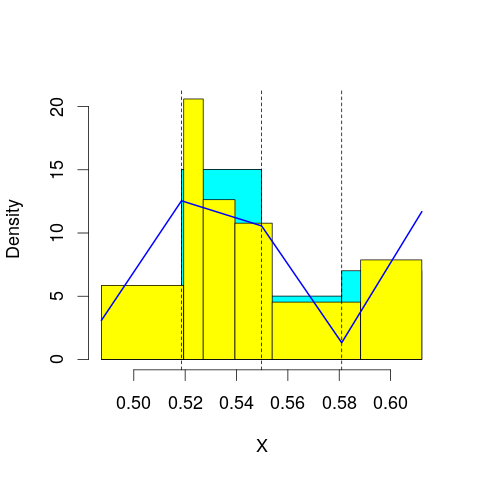

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.08797
mop.approx: Iteration 11. LL = 69.88179
mop.approx: Iteration 21. LL = 69.96987
mop.approx: Iteration 31. LL = 69.98399
mop.approx: Iteration 41. LL = 69.98749
mop.approx: Converged. Iteration 49. LL = 69.9885
[1] "Computing the linear combination of B-splines"


59.5912967405
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.83657
mop.approx: Iteration 11. LL = 69.69404
mop.approx: Iteration 21. LL = 69.8289
mop.approx: Iteration 31. LL = 69.857
mop.approx: Iteration 41. LL = 69.86561
mop.approx: Iteration 51. LL = 69.86863
mop.approx: Converged. Iteration 60. LL = 69.86974
[1] "Computing the linear combination of B-splines"


57.7396657315
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.63243
mop.approx: Iteration 11. LL = 63.40245
mop.approx: Iteration 21. LL = 63.42922
mop.approx: Converged. Iteration 23. LL = 63.42949
[1] "Computing the linear combination of B-splines"


49.5665458748
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.05104
mop.approx: Iteration 11. LL = 62.8023
mop.approx: Iteration 21. LL = 63.09582
mop.approx: Iteration 31. LL = 63.11987
mop.approx: Iteration 41. LL = 63.1222
mop.approx: Converged. Iteration 41. LL = 63.12225
[1] "Computing the linear combination of B-splines"


47.5264375225
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.30009
mop.approx: Iteration 11. LL = 58.88959
mop.approx: Converged. Iteration 13. LL = 58.89003
[1] "Computing the linear combination of B-splines"


41.5613470733
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.164175
mop.approx: Iteration 11. LL = 60.38371
mop.approx: Iteration 21. LL = 60.49993
mop.approx: Converged. Iteration 25. LL = 60.50079
[1] "Computing the linear combination of B-splines"


41.439238925
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.502149
mop.approx: Iteration 11. LL = 54.32504
mop.approx: Iteration 21. LL = 54.33468
mop.approx: Converged. Iteration 24. LL = 54.33498
[1] "Computing the linear combination of B-splines"


33.5405618656
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.34136
mop.approx: Converged. Iteration 9. LL = 69.2537
[1] "Computing the linear combination of B-splines"


58.8564900122
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 58.856490012214778)
m reached
('Sum of Probabilities:', 0.9936556993314899)
chosen


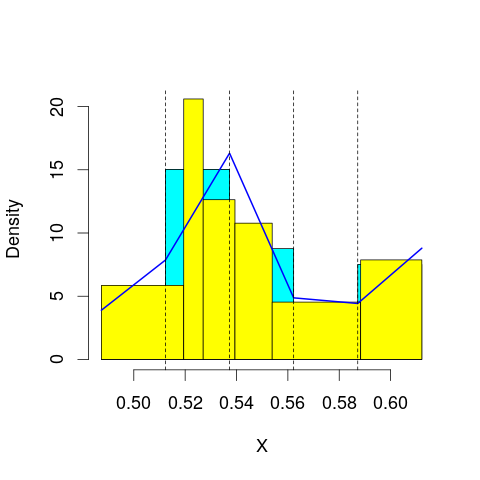

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.08797
mop.approx: Iteration 11. LL = 70.22753
mop.approx: Iteration 21. LL = 70.30659
mop.approx: Iteration 31. LL = 70.32613
mop.approx: Iteration 41. LL = 70.33353
mop.approx: Iteration 51. LL = 70.33685
mop.approx: Iteration 61. LL = 70.33848
mop.approx: Converged. Iteration 68. LL = 70.33919
[1] "Computing the linear combination of B-splines"


58.2091191643
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.83657
mop.approx: Iteration 11. LL = 69.89123
mop.approx: Iteration 21. LL = 69.93107
mop.approx: Iteration 31. LL = 69.93691
mop.approx: Iteration 41. LL = 69.93868
mop.approx: Converged. Iteration 46. LL = 69.93917
[1] "Computing the linear combination of B-splines"


56.0762295102
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.63243
mop.approx: Iteration 11. LL = 63.35958
mop.approx: Converged. Iteration 19. LL = 63.37029
[1] "Computing the linear combination of B-splines"


47.7744776679
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.05104
mop.approx: Iteration 11. LL = 63.8149
mop.approx: Iteration 21. LL = 63.87707
mop.approx: Iteration 31. LL = 63.89287
mop.approx: Iteration 41. LL = 63.89981
mop.approx: Iteration 51. LL = 63.90343
mop.approx: Iteration 61. LL = 63.90552
mop.approx: Iteration 71. LL = 63.90682
mop.approx: Iteration 81. LL = 63.90766
mop.approx: Converged. Iteration 83. LL = 63.90786
[1] "Computing the linear combination of B-splines"


46.5791761863
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.30009
mop.approx: Iteration 11. LL = 62.2252
mop.approx: Iteration 21. LL = 62.44118
mop.approx: Iteration 31. LL = 62.48367
mop.approx: Iteration 41. LL = 62.49815
mop.approx: Iteration 51. LL = 62.50466
mop.approx: Iteration 61. LL = 62.50812
mop.approx: Iteration 71. LL = 62.51016
mop.approx: Iteration 81. LL = 62.51146
mop.approx: Iteration 91. LL = 62.51233
mop.approx: Converged. Iteration 95. LL = 62.51267
[1] "Computing the linear combination of B-splines"


43.4511178208
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.164175
mop.approx: Iteration 11. LL = 60.87075
mop.approx: Converged. Iteration 16. LL = 60.87363
[1] "Computing the linear combination of B-splines"


40.0792112561
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.502149
mop.approx: Iteration 11. LL = 61.54808
mop.approx: Iteration 21. LL = 61.78216
mop.approx: Iteration 31. LL = 61.78757
mop.approx: Converged. Iteration 31. LL = 61.78762
[1] "Computing the linear combination of B-splines"


39.2603343777
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.34136
mop.approx: Iteration 11. LL = 70.25025
mop.approx: Iteration 21. LL = 70.25686
mop.approx: Converged. Iteration 24. LL = 70.25722
[1] "Computing the linear combination of B-splines"


58.1271445947
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 58.127144594699772)
m reached
('Sum of Probabilities:', 0.9939517178078742)
chosen


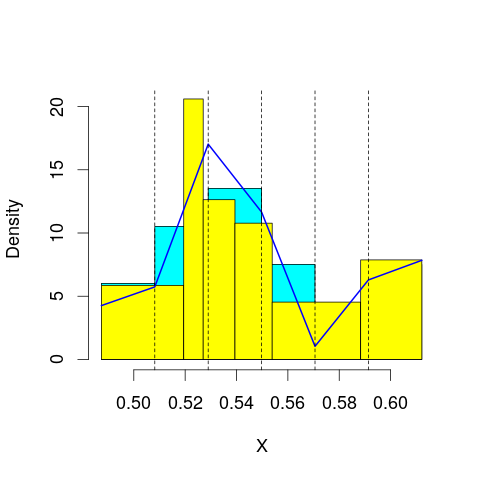

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.08797
mop.approx: Iteration 11. LL = 70.21316
mop.approx: Iteration 21. LL = 70.30159
mop.approx: Iteration 31. LL = 70.32473
mop.approx: Iteration 41. LL = 70.33293
mop.approx: Iteration 51. LL = 70.33621
mop.approx: Iteration 61. LL = 70.3376
mop.approx: Converged. Iteration 64. LL = 70.33791
[1] "Computing the linear combination of B-splines"


56.4749622547
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.83657
mop.approx: Iteration 11. LL = 70.04816
mop.approx: Iteration 21. LL = 70.10394
mop.approx: Iteration 31. LL = 70.12296
mop.approx: Iteration 41. LL = 70.13078
mop.approx: Iteration 51. LL = 70.1345
mop.approx: Iteration 61. LL = 70.13642
mop.approx: Iteration 71. LL = 70.13745
mop.approx: Converged. Iteration 72. LL = 70.13759
[1] "Computing the linear combination of B-splines"


54.5417784438
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.63243
mop.approx: Iteration 11. LL = 64.96516
mop.approx: Iteration 21. LL = 65.05355
mop.approx: Iteration 31. LL = 65.07172
mop.approx: Iteration 41. LL = 65.07816
mop.approx: Iteration 51. LL = 65.08097
mop.approx: Iteration 61. LL = 65.08231
mop.approx: Converged. Iteration 66. LL = 65.08277
[1] "Computing the linear combination of B-splines"


47.7540871131
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.05104
mop.approx: Iteration 11. LL = 64.28189
mop.approx: Iteration 21. LL = 64.4166
mop.approx: Iteration 31. LL = 64.42881
mop.approx: Converged. Iteration 37. LL = 64.42974
[1] "Computing the linear combination of B-splines"


45.3681887901
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.30009
mop.approx: Iteration 11. LL = 64.05664
mop.approx: Iteration 21. LL = 64.16176
mop.approx: Iteration 31. LL = 64.16807
mop.approx: Converged. Iteration 35. LL = 64.16852
[1] "Computing the linear combination of B-splines"


43.3741009694
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.164175
mop.approx: Iteration 11. LL = 62.06272
mop.approx: Iteration 21. LL = 62.10397
mop.approx: Converged. Iteration 29. LL = 62.10603
[1] "Computing the linear combination of B-splines"


39.57874536
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.502149
mop.approx: Iteration 11. LL = 62.19833
mop.approx: Iteration 21. LL = 62.21645
mop.approx: Converged. Iteration 21. LL = 62.21651
[1] "Computing the linear combination of B-splines"


37.9563567634
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.34136
mop.approx: Iteration 11. LL = 71.29286
mop.approx: Converged. Iteration 19. LL = 71.2999
[1] "Computing the linear combination of B-splines"


57.4369573419
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 57.436957341888878)
m reached
('Sum of Probabilities:', 0.9942218507768441)
chosen


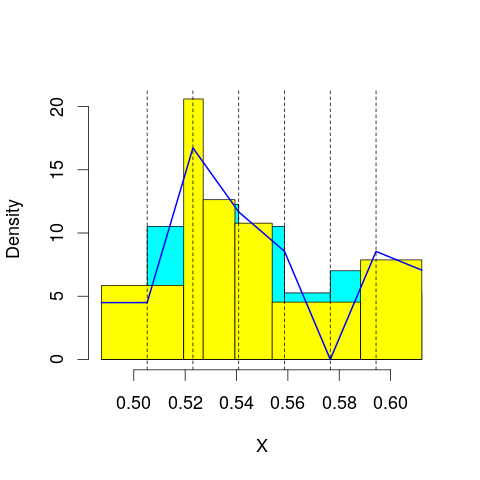

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.08797
mop.approx: Iteration 11. LL = 70.06076
mop.approx: Iteration 21. LL = 70.08593
mop.approx: Iteration 31. LL = 70.09189
mop.approx: Iteration 41. LL = 70.094
mop.approx: Converged. Iteration 48. LL = 70.09476
[1] "Computing the linear combination of B-splines"


54.4989439407
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.83657
mop.approx: Iteration 11. LL = 70.46065
mop.approx: Iteration 21. LL = 70.53671
mop.approx: Iteration 31. LL = 70.54272
mop.approx: Converged. Iteration 33. LL = 70.54299
[1] "Computing the linear combination of B-splines"


53.2143141483
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.63243
mop.approx: Iteration 11. LL = 65.55732
mop.approx: Iteration 21. LL = 65.56596
mop.approx: Iteration 31. LL = 65.56921
mop.approx: Iteration 41. LL = 65.57072
mop.approx: Converged. Iteration 48. LL = 65.57136
[1] "Computing the linear combination of B-splines"


46.5098174362
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.05104
mop.approx: Iteration 11. LL = 65.20832
mop.approx: Iteration 21. LL = 65.3544
mop.approx: Iteration 31. LL = 65.37755
mop.approx: Iteration 41. LL = 65.38482
mop.approx: Iteration 51. LL = 65.38752
mop.approx: Iteration 61. LL = 65.38858
mop.approx: Converged. Iteration 61. LL = 65.38864
[1] "Computing the linear combination of B-splines"


44.5942261422
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.30009
mop.approx: Iteration 11. LL = 64.68314
mop.approx: Iteration 21. LL = 64.81905
mop.approx: Iteration 31. LL = 64.85702
mop.approx: Iteration 41. LL = 64.87216
mop.approx: Iteration 51. LL = 64.87924
mop.approx: Iteration 61. LL = 64.88295
mop.approx: Iteration 71. LL = 64.88505
mop.approx: Iteration 81. LL = 64.88632
mop.approx: Iteration 91. LL = 64.88712
mop.approx: Converged. Iteration 91. LL = 64.88718
[1] "Computing the linear combination of B-splines"


42.3599041207
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.164175
mop.approx: Iteration 11. LL = 64.3529
mop.approx: Iteration 21. LL = 64.6127
mop.approx: Iteration 31. LL = 64.66936
mop.approx: Iteration 41. LL = 64.68618
mop.approx: Iteration 51. LL = 64.69201
mop.approx: Iteration 61. LL = 64.69434
mop.approx: Iteration 71. LL = 64.69542
mop.approx: Converged. Iteration 73. LL = 64.69562
[1] "Computing the linear combination of B-splines"


40.4354550242
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.502149
mop.approx: Iteration 11. LL = 62.41437
mop.approx: Iteration 21. LL = 62.42819
mop.approx: Converged. Iteration 21. LL = 62.42824
[1] "Computing the linear combination of B-splines"


36.4349726509
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.34136
mop.approx: Iteration 11. LL = 70.75209
mop.approx: Iteration 21. LL = 70.77087
mop.approx: Converged. Iteration 26. LL = 70.77172
[1] "Computing the linear combination of B-splines"


55.1759071364
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 55.175907136368266)
m reached
('Sum of Probabilities:', 0.9939603568575099)
chosen


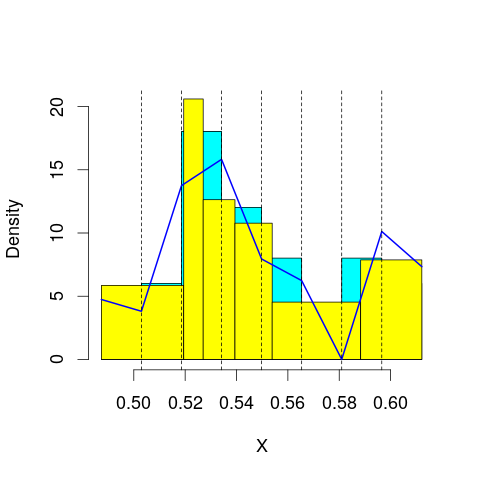

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.08797
mop.approx: Iteration 11. LL = 70.96545
mop.approx: Iteration 21. LL = 70.99241
mop.approx: Iteration 31. LL = 70.99528
mop.approx: Iteration 41. LL = 70.99643
mop.approx: Converged. Iteration 43. LL = 70.99665
[1] "Computing the linear combination of B-splines"


53.6679724212
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.83657
mop.approx: Iteration 11. LL = 70.65655
mop.approx: Iteration 21. LL = 70.71967
mop.approx: Converged. Iteration 30. LL = 70.7231
[1] "Computing the linear combination of B-splines"


51.6615496072
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.63243
mop.approx: Iteration 11. LL = 66.24033
mop.approx: Iteration 21. LL = 66.32467
mop.approx: Iteration 31. LL = 66.33369
mop.approx: Converged. Iteration 36. LL = 66.33439
[1] "Computing the linear combination of B-splines"


45.5399715822
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.05104
mop.approx: Iteration 11. LL = 65.73415
mop.approx: Iteration 21. LL = 65.75786
mop.approx: Iteration 31. LL = 65.76206
mop.approx: Iteration 41. LL = 65.76429
mop.approx: Iteration 51. LL = 65.7656
mop.approx: Iteration 61. LL = 65.76641
mop.approx: Converged. Iteration 61. LL = 65.76647
[1] "Computing the linear combination of B-splines"


43.239186526
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.30009
mop.approx: Iteration 11. LL = 65.11038
mop.approx: Iteration 21. LL = 65.32557
mop.approx: Iteration 31. LL = 65.38859
mop.approx: Iteration 41. LL = 65.41026
mop.approx: Iteration 51. LL = 65.41813
mop.approx: Iteration 61. LL = 65.42105
mop.approx: Iteration 71. LL = 65.42214
mop.approx: Converged. Iteration 71. LL = 65.4222
[1] "Computing the linear combination of B-splines"


41.1620485517
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.164175
mop.approx: Iteration 11. LL = 65.06371
mop.approx: Iteration 21. LL = 65.20168
mop.approx: Iteration 31. LL = 65.22479
mop.approx: Iteration 41. LL = 65.23333
mop.approx: Iteration 51. LL = 65.2373
mop.approx: Iteration 61. LL = 65.23934
mop.approx: Iteration 71. LL = 65.24046
mop.approx: Converged. Iteration 76. LL = 65.24089
[1] "Computing the linear combination of B-splines"


39.2478593357
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.502149
mop.approx: Iteration 11. LL = 64.55866
mop.approx: Iteration 21. LL = 64.80306
mop.approx: Iteration 31. LL = 64.85767
mop.approx: Iteration 41. LL = 64.87659
mop.approx: Iteration 51. LL = 64.88459
mop.approx: Iteration 61. LL = 64.88834
mop.approx: Iteration 71. LL = 64.89018
mop.approx: Iteration 81. LL = 64.89111
mop.approx: Converged. Iteration 81. LL = 64.89117
[1] "Computing the linear combination of B-splines"


37.1664008002
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.34136
mop.approx: Iteration 11. LL = 70.49431
mop.approx: Iteration 21. LL = 70.52562
mop.approx: Iteration 31. LL = 70.53099
mop.approx: Converged. Iteration 38. LL = 70.532
[1] "Computing the linear combination of B-splines"


53.2033200961
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 53.203320096085918)
m reached
('Sum of Probabilities:', 0.9931061621735381)
chosen


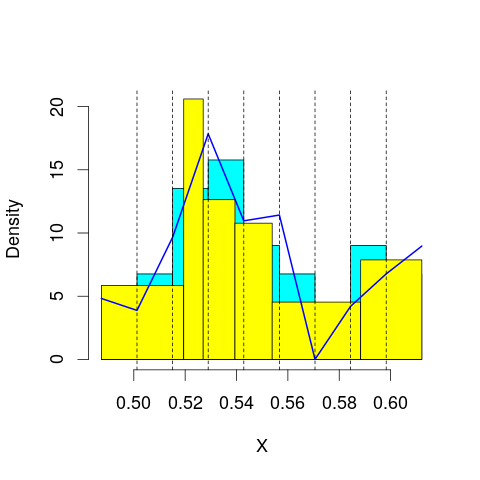

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.08797
mop.approx: Iteration 11. LL = 71.36727
mop.approx: Iteration 21. LL = 71.38741
mop.approx: Iteration 31. LL = 71.39187
mop.approx: Iteration 41. LL = 71.39332
mop.approx: Converged. Iteration 43. LL = 71.39354
[1] "Computing the linear combination of B-splines"


52.3319886519
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.83657
mop.approx: Iteration 11. LL = 70.98327
mop.approx: Iteration 21. LL = 71.14291
mop.approx: Iteration 31. LL = 71.17502
mop.approx: Iteration 41. LL = 71.18396
mop.approx: Iteration 51. LL = 71.18687
mop.approx: Converged. Iteration 59. LL = 71.18781
[1] "Computing the linear combination of B-splines"


50.393399155
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.63243
mop.approx: Iteration 11. LL = 66.40609
mop.approx: Iteration 21. LL = 66.44464
mop.approx: Iteration 31. LL = 66.44861
mop.approx: Converged. Iteration 34. LL = 66.44893
[1] "Computing the linear combination of B-splines"


43.9216482226
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.05104
mop.approx: Iteration 11. LL = 66.47782
mop.approx: Iteration 21. LL = 66.58932
mop.approx: Iteration 31. LL = 66.60548
mop.approx: Iteration 41. LL = 66.60825
mop.approx: Converged. Iteration 45. LL = 66.60867
[1] "Computing the linear combination of B-splines"


42.3485231856
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.30009
mop.approx: Iteration 11. LL = 65.57428
mop.approx: Iteration 21. LL = 65.71001
mop.approx: Iteration 31. LL = 65.7307
mop.approx: Iteration 41. LL = 65.7371
mop.approx: Iteration 51. LL = 65.74033
mop.approx: Iteration 61. LL = 65.74226
mop.approx: Iteration 71. LL = 65.7435
mop.approx: Iteration 81. LL = 65.74433
mop.approx: Converged. Iteration 82. LL = 65.74446
[1] "Computing the linear combination of B-splines"


39.7514334571
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.164175
mop.approx: Iteration 11. LL = 65.21148
mop.approx: Iteration 21. LL = 65.28821
mop.approx: Iteration 31. LL = 65.30729
mop.approx: Iteration 41. LL = 65.31722
mop.approx: Iteration 51. LL = 65.32307
mop.approx: Iteration 61. LL = 65.32677
mop.approx: Iteration 71. LL = 65.32923
mop.approx: Iteration 81. LL = 65.33094
mop.approx: Iteration 91. LL = 65.33218
mop.approx: Iteration 101. LL = 65.33309
mop.approx: Converged. Iteration 108. LL = 65.33366
[1] "Computing the linear combination of B-splines"


37.6076788105
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.502149
mop.approx: Iteration 11. LL = 65.25898
mop.approx: Iteration 21. LL = 65.41463
mop.approx: Iteration 31. LL = 65.45327
mop.approx: Iteration 41. LL = 65.46913
mop.approx: Iteration 51. LL = 65.47649
mop.approx: Iteration 61. LL = 65.48019
mop.approx: Iteration 71. LL = 65.48221
mop.approx: Iteration 81. LL = 65.48341
mop.approx: Converged. Iteration 89. LL = 65.48411
[1] "Computing the linear combination of B-splines"


36.0231742933
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.34136
mop.approx: Iteration 11. LL = 71.96183
mop.approx: Iteration 21. LL = 71.96659
mop.approx: Converged. Iteration 22. LL = 71.96673
[1] "Computing the linear combination of B-splines"


52.9051845246
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 52.905184524565477)
m reached
('Sum of Probabilities:', 0.9916972044934169)
chosen


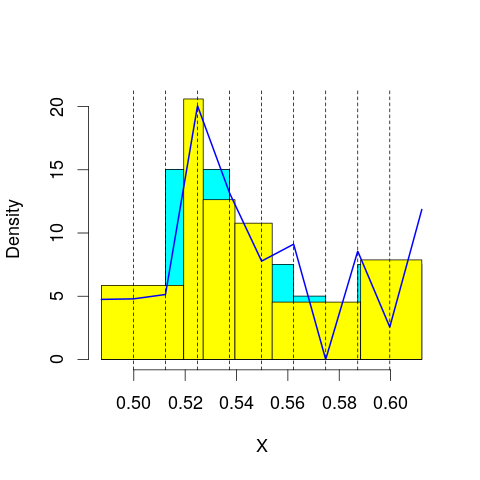

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.08797
mop.approx: Iteration 11. LL = 71.32265
mop.approx: Iteration 21. LL = 71.34984
mop.approx: Converged. Iteration 28. LL = 71.35122
[1] "Computing the linear combination of B-splines"


50.5568070867
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.83657
mop.approx: Iteration 11. LL = 71.14721
mop.approx: Iteration 21. LL = 71.17085
mop.approx: Iteration 31. LL = 71.17544
mop.approx: Converged. Iteration 39. LL = 71.17656
[1] "Computing the linear combination of B-splines"


48.6492744049
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.63243
mop.approx: Iteration 11. LL = 66.44626
mop.approx: Iteration 21. LL = 66.53384
mop.approx: Iteration 31. LL = 66.56169
mop.approx: Iteration 41. LL = 66.57149
mop.approx: Iteration 51. LL = 66.57503
mop.approx: Iteration 61. LL = 66.57639
mop.approx: Converged. Iteration 64. LL = 66.57668
[1] "Computing the linear combination of B-splines"


42.3165309114
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.05104
mop.approx: Iteration 11. LL = 66.964
mop.approx: Iteration 21. LL = 66.9915
mop.approx: Iteration 31. LL = 66.99478
mop.approx: Iteration 41. LL = 66.99597
mop.approx: Converged. Iteration 42. LL = 66.99611
[1] "Computing the linear combination of B-splines"


41.0030881389
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.30009
mop.approx: Iteration 11. LL = 66.23531
mop.approx: Iteration 21. LL = 66.40397
mop.approx: Iteration 31. LL = 66.43321
mop.approx: Iteration 41. LL = 66.44059
mop.approx: Iteration 51. LL = 66.44322
mop.approx: Iteration 61. LL = 66.44437
mop.approx: Converged. Iteration 63. LL = 66.44458
[1] "Computing the linear combination of B-splines"


38.7186987787
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.164175
mop.approx: Iteration 11. LL = 65.37529
mop.approx: Iteration 21. LL = 65.46364
mop.approx: Iteration 31. LL = 65.4905
mop.approx: Iteration 41. LL = 65.50357
mop.approx: Iteration 51. LL = 65.51069
mop.approx: Iteration 61. LL = 65.51474
mop.approx: Iteration 71. LL = 65.51707
mop.approx: Iteration 81. LL = 65.51843
mop.approx: Converged. Iteration 89. LL = 65.51916
[1] "Computing the linear combination of B-splines"


36.0604352621
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.502149
mop.approx: Iteration 11. LL = 65.50729
mop.approx: Iteration 21. LL = 65.61456
mop.approx: Iteration 31. LL = 65.63298
mop.approx: Iteration 41. LL = 65.63934
mop.approx: Iteration 51. LL = 65.64281
mop.approx: Iteration 61. LL = 65.64499
mop.approx: Iteration 71. LL = 65.64641
mop.approx: Iteration 81. LL = 65.64735
mop.approx: Converged. Iteration 85. LL = 65.64769
[1] "Computing the linear combination of B-splines"


34.4557981131
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.34136
mop.approx: Iteration 11. LL = 72.43124
mop.approx: Iteration 21. LL = 72.45642
mop.approx: Iteration 31. LL = 72.46303
mop.approx: Iteration 41. LL = 72.46574
mop.approx: Iteration 51. LL = 72.46711
mop.approx: Converged. Iteration 57. LL = 72.46768
[1] "Computing the linear combination of B-splines"


51.6732646743
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 51.673264674263805)
m reached
('Sum of Probabilities:', 0.9899294597839984)
chosen


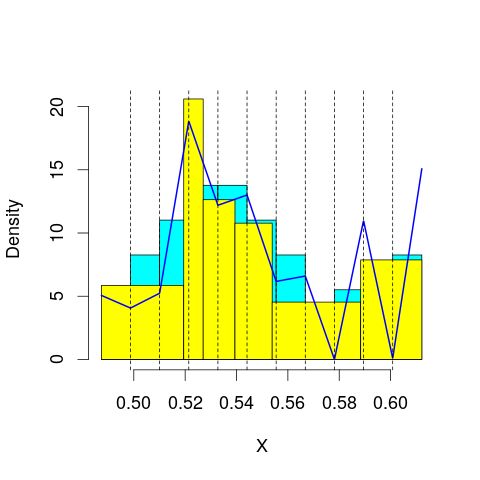

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.08797
mop.approx: Iteration 11. LL = 71.85386
mop.approx: Iteration 21. LL = 71.87933
mop.approx: Iteration 31. LL = 71.88254
mop.approx: Converged. Iteration 37. LL = 71.88324
[1] "Computing the linear combination of B-splines"


49.3559536065
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.83657
mop.approx: Iteration 11. LL = 71.33232
mop.approx: Iteration 21. LL = 71.36078
mop.approx: Iteration 31. LL = 71.37044
mop.approx: Iteration 41. LL = 71.37482
mop.approx: Iteration 51. LL = 71.37718
mop.approx: Iteration 61. LL = 71.37861
mop.approx: Iteration 71. LL = 71.37955
mop.approx: Converged. Iteration 73. LL = 71.37977
[1] "Computing the linear combination of B-splines"


47.1196141254
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.63243
mop.approx: Iteration 11. LL = 66.60078
mop.approx: Iteration 21. LL = 66.61204
mop.approx: Converged. Iteration 21. LL = 66.6121
[1] "Computing the linear combination of B-splines"


40.6190856044
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.05104
mop.approx: Iteration 11. LL = 67.2569
mop.approx: Iteration 21. LL = 67.30629
mop.approx: Iteration 31. LL = 67.32684
mop.approx: Iteration 41. LL = 67.339
mop.approx: Iteration 51. LL = 67.3466
mop.approx: Iteration 61. LL = 67.35144
mop.approx: Iteration 71. LL = 67.35458
mop.approx: Iteration 81. LL = 67.35661
mop.approx: Iteration 91. LL = 67.35794
mop.approx: Iteration 101. LL = 67.35879
mop.approx: Converged. Iteration 101. LL = 67.35886
[1] "Computing the linear combination of B-splines"


39.632973006
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.30009
mop.approx: Iteration 11. LL = 66.90334
mop.approx: Iteration 21. LL = 66.95643
mop.approx: Iteration 31. LL = 66.96106
mop.approx: Iteration 41. LL = 66.96327
mop.approx: Iteration 51. LL = 66.96449
mop.approx: Converged. Iteration 56. LL = 66.96495
[1] "Computing the linear combination of B-splines"


37.5061952608
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.164175
mop.approx: Iteration 11. LL = 65.7708
mop.approx: Iteration 21. LL = 65.93605
mop.approx: Iteration 31. LL = 65.98078
mop.approx: Iteration 41. LL = 65.99474
mop.approx: Iteration 51. LL = 66.00004
mop.approx: Iteration 61. LL = 66.00251
mop.approx: Iteration 71. LL = 66.00383
mop.approx: Converged. Iteration 79. LL = 66.00453
[1] "Computing the linear combination of B-splines"


34.8131191298
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.502149
mop.approx: Iteration 11. LL = 65.57749
mop.approx: Iteration 21. LL = 65.65755
mop.approx: Iteration 31. LL = 65.6747
mop.approx: Iteration 41. LL = 65.68377
mop.approx: Iteration 51. LL = 65.68965
mop.approx: Iteration 61. LL = 65.69367
mop.approx: Iteration 71. LL = 65.6965
mop.approx: Iteration 81. LL = 65.69854
mop.approx: Iteration 91. LL = 65.70005
mop.approx: Iteration 101. LL = 65.70119
mop.approx: Iteration 111. LL = 65.70206
mop.approx: Converged. Iteration 117. LL = 65.70255
[1] "Computing the linear combination of B-splines"


32.7693957311
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.34136
mop.approx: Iteration 11. LL = 72.49376
mop.approx: Iteration 21. LL = 72.51986
mop.approx: Iteration 31. LL = 72.52332
mop.approx: Iteration 41. LL = 72.52453
mop.approx: Converged. Iteration 42. LL = 72.52468
[1] "Computing the linear combination of B-splines"


49.9973960798
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 49.99739607976521)
m reached
('Sum of Probabilities:', 0.9893647381717855)
chosen


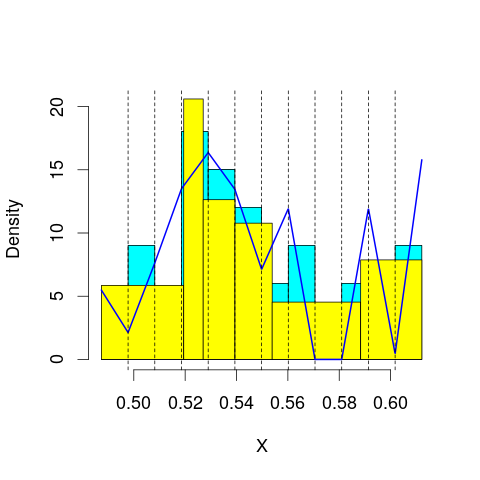

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.08797
mop.approx: Iteration 11. LL = 72.34585
mop.approx: Iteration 21. LL = 72.37557
mop.approx: Iteration 31. LL = 72.37981
mop.approx: Converged. Iteration 39. LL = 72.38084
[1] "Computing the linear combination of B-splines"


48.1206852971
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.83657
mop.approx: Iteration 11. LL = 71.96432
mop.approx: Iteration 21. LL = 72.04292
mop.approx: Iteration 31. LL = 72.0592
mop.approx: Iteration 41. LL = 72.0636
mop.approx: Converged. Iteration 50. LL = 72.06482
[1] "Computing the linear combination of B-splines"


46.0718016702
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.63243
mop.approx: Iteration 11. LL = 66.8035
mop.approx: Iteration 21. LL = 66.8138
mop.approx: Iteration 31. LL = 66.81705
mop.approx: Iteration 41. LL = 66.81827
mop.approx: Converged. Iteration 42. LL = 66.8184
[1] "Computing the linear combination of B-splines"


39.0925146246
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.05104
mop.approx: Iteration 11. LL = 67.5618
mop.approx: Iteration 21. LL = 67.61536
mop.approx: Iteration 31. LL = 67.61984
mop.approx: Iteration 41. LL = 67.62122
mop.approx: Converged. Iteration 46. LL = 67.62169
[1] "Computing the linear combination of B-splines"


38.1629297513
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.30009
mop.approx: Iteration 11. LL = 67.3955
mop.approx: Iteration 21. LL = 67.42185
mop.approx: Iteration 31. LL = 67.42724
mop.approx: Iteration 41. LL = 67.43025
mop.approx: Iteration 51. LL = 67.43231
mop.approx: Iteration 61. LL = 67.4338
mop.approx: Iteration 71. LL = 67.43491
mop.approx: Iteration 81. LL = 67.43575
mop.approx: Converged. Iteration 84. LL = 67.43602
[1] "Computing the linear combination of B-splines"


36.2443779899
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.164175
mop.approx: Iteration 11. LL = 66.39402
mop.approx: Iteration 21. LL = 66.51883
mop.approx: Iteration 31. LL = 66.53953
mop.approx: Iteration 41. LL = 66.54636
mop.approx: Iteration 51. LL = 66.54923
mop.approx: Iteration 61. LL = 66.55063
mop.approx: Converged. Iteration 69. LL = 66.55134
[1] "Computing the linear combination of B-splines"


33.6255279445
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.502149
mop.approx: Iteration 11. LL = 65.71515
mop.approx: Iteration 21. LL = 65.80419
mop.approx: Iteration 31. LL = 65.83263
mop.approx: Iteration 41. LL = 65.8474
mop.approx: Iteration 51. LL = 65.85524
mop.approx: Iteration 61. LL = 65.85933
mop.approx: Iteration 71. LL = 65.86147
mop.approx: Iteration 81. LL = 65.8626
mop.approx: Converged. Iteration 85. LL = 65.86296
[1] "Computing the linear combination of B-splines"


31.1683316688
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.34136
mop.approx: Iteration 11. LL = 72.8652
mop.approx: Iteration 21. LL = 72.88599
mop.approx: Iteration 31. LL = 72.89008
mop.approx: Iteration 41. LL = 72.89159
mop.approx: Converged. Iteration 46. LL = 72.89209
[1] "Computing the linear combination of B-splines"


48.6319346684
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 48.631934668397896)
m reached
('Sum of Probabilities:', 0.9900850130193141)
chosen


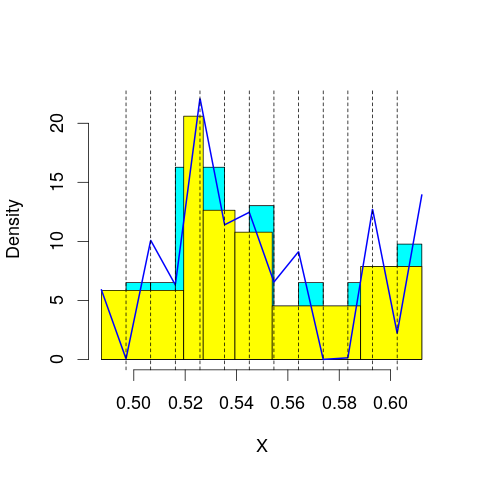

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.08797
mop.approx: Iteration 11. LL = 72.44843
mop.approx: Iteration 21. LL = 72.50747
mop.approx: Iteration 31. LL = 72.5217
mop.approx: Iteration 41. LL = 72.5268
mop.approx: Iteration 51. LL = 72.5291
mop.approx: Iteration 61. LL = 72.53027
mop.approx: Converged. Iteration 64. LL = 72.53058
[1] "Computing the linear combination of B-splines"


46.5375581403
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.83657
mop.approx: Iteration 11. LL = 72.45042
mop.approx: Iteration 21. LL = 72.65802
mop.approx: Iteration 31. LL = 72.70753
mop.approx: Iteration 41. LL = 72.72264
mop.approx: Iteration 51. LL = 72.72813
mop.approx: Iteration 61. LL = 72.73039
mop.approx: Iteration 71. LL = 72.73143
mop.approx: Converged. Iteration 71. LL = 72.7315
[1] "Computing the linear combination of B-splines"


45.0056101412
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.63243
mop.approx: Iteration 11. LL = 67.32155
mop.approx: Iteration 21. LL = 67.41622
mop.approx: Iteration 31. LL = 67.43894
mop.approx: Iteration 41. LL = 67.44599
mop.approx: Iteration 51. LL = 67.44885
mop.approx: Iteration 61. LL = 67.4502
mop.approx: Converged. Iteration 66. LL = 67.45066
[1] "Computing the linear combination of B-splines"


37.9919058344
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.05104
mop.approx: Iteration 11. LL = 67.49803
mop.approx: Iteration 21. LL = 67.5461
mop.approx: Iteration 31. LL = 67.56774
mop.approx: Iteration 41. LL = 67.57982
mop.approx: Iteration 51. LL = 67.58704
mop.approx: Iteration 61. LL = 67.59156
mop.approx: Iteration 71. LL = 67.5945
mop.approx: Iteration 81. LL = 67.59648
mop.approx: Iteration 91. LL = 67.59785
mop.approx: Iteration 101. LL = 67.59882
mop.approx: Converged. Iteration 107. LL = 67.59933
[1] "Computing the linear combination of B-splines"


36.4077054158
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.30009
mop.approx: Iteration 11. LL = 67.92872
mop.approx: Iteration 21. LL = 68.00859
mop.approx: Iteration 31. LL = 68.02664
mop.approx: Iteration 41. LL = 68.0349
mop.approx: Iteration 51. LL = 68.04005
mop.approx: Iteration 61. LL = 68.04351
mop.approx: Iteration 71. LL = 68.04591
mop.approx: Iteration 81. LL = 68.0476
mop.approx: Iteration 91. LL = 68.04884
mop.approx: Iteration 101. LL = 68.04975
mop.approx: Converged. Iteration 106. LL = 68.05019
[1] "Computing the linear combination of B-splines"


35.1257297917
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.164175
mop.approx: Iteration 11. LL = 67.02386
mop.approx: Iteration 21. LL = 67.10749
mop.approx: Iteration 31. LL = 67.11514
mop.approx: Converged. Iteration 38. LL = 67.11609
[1] "Computing the linear combination of B-splines"


32.4558831298
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.502149
mop.approx: Iteration 11. LL = 66.17857
mop.approx: Iteration 21. LL = 66.27968
mop.approx: Iteration 31. LL = 66.29094
mop.approx: Iteration 41. LL = 66.29582
mop.approx: Iteration 51. LL = 66.29938
mop.approx: Iteration 61. LL = 66.30212
mop.approx: Iteration 71. LL = 66.30426
mop.approx: Iteration 81. LL = 66.30594
mop.approx: Iteration 91. LL = 66.30729
mop.approx: Iteration 101. LL = 66.30838
mop.approx: Iteration 111. LL = 66.30926
mop.approx: Iteration 121. LL = 66.31
mop.approx: Converged. Iteration 121. LL = 66.31006
[1] "Computing the linear combination of B-splines"


29.9090465501
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.34136
mop.approx: Iteration 11. LL = 73.17542
mop.approx: Converged. Iteration 18. LL = 73.17904
[1] "Computing the linear combination of B-splines"


47.1860239888
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 47.18602398876196)
m reached
('Sum of Probabilities:', 0.9910130876696224)
chosen


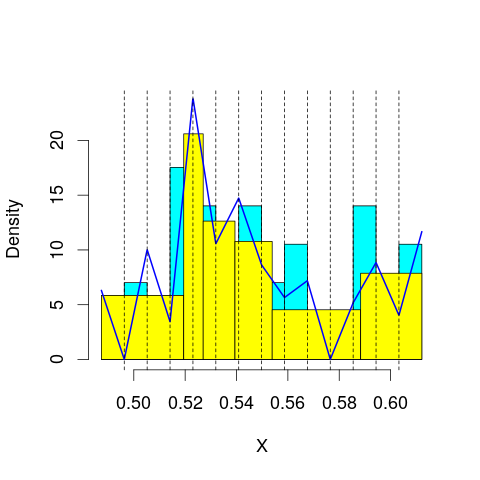

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.08797
mop.approx: Iteration 11. LL = 73.47514
mop.approx: Iteration 21. LL = 73.51898
mop.approx: Iteration 31. LL = 73.5234
mop.approx: Converged. Iteration 33. LL = 73.52367
[1] "Computing the linear combination of B-splines"


45.7977829769
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.83657
mop.approx: Iteration 11. LL = 72.44177
mop.approx: Iteration 21. LL = 72.63977
mop.approx: Iteration 31. LL = 72.69386
mop.approx: Iteration 41. LL = 72.71251
mop.approx: Iteration 51. LL = 72.72001
mop.approx: Iteration 61. LL = 72.72351
mop.approx: Iteration 71. LL = 72.72539
mop.approx: Iteration 81. LL = 72.72649
mop.approx: Converged. Iteration 85. LL = 72.72688
[1] "Computing the linear combination of B-splines"


43.2681261492
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.63243
mop.approx: Iteration 11. LL = 67.94585
mop.approx: Iteration 21. LL = 68.0214
mop.approx: Iteration 31. LL = 68.05399
mop.approx: Iteration 41. LL = 68.07005
mop.approx: Iteration 51. LL = 68.07878
mop.approx: Iteration 61. LL = 68.08391
mop.approx: Iteration 71. LL = 68.08713
mop.approx: Iteration 81. LL = 68.08925
mop.approx: Iteration 91. LL = 68.0907
mop.approx: Iteration 101. LL = 68.09174
mop.approx: Converged. Iteration 109. LL = 68.09243
[1] "Computing the linear combination of B-splines"


36.9008060707
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.05104
mop.approx: Iteration 11. LL = 67.57409
mop.approx: Iteration 21. LL = 67.6977
mop.approx: Iteration 31. LL = 67.76555
mop.approx: Iteration 41. LL = 67.80202
mop.approx: Iteration 51. LL = 67.82135
mop.approx: Iteration 61. LL = 67.83171
mop.approx: Iteration 71. LL = 67.83741
mop.approx: Iteration 81. LL = 67.84064
mop.approx: Iteration 91. LL = 67.8425
mop.approx: Iteration 101. LL = 67.84359
mop.approx: Converged. Iteration 105. LL = 67.84395
[1] "Computing the linear combination of B-splines"


34.9194623107
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.30009
mop.approx: Iteration 11. LL = 68.23108
mop.approx: Iteration 21. LL = 68.27882
mop.approx: Iteration 31. LL = 68.3048
mop.approx: Iteration 41. LL = 68.32325
mop.approx: Iteration 51. LL = 68.33652
mop.approx: Iteration 61. LL = 68.34621
mop.approx: Iteration 71. LL = 68.35342
mop.approx: Iteration 81. LL = 68.35886
mop.approx: Iteration 91. LL = 68.36305
mop.approx: Iteration 101. LL = 68.36632
mop.approx: Iteration 111. LL = 68.3689
mop.approx: Iteration 121. LL = 68.37095
mop.approx: Iteration 131. LL = 68.37261
mop.approx: Iteration 141. LL = 68.37396
mop.approx: Iteration 151. LL = 68.37507
mop.approx: Iteration 161. LL = 68.37598
mop.approx: Iteration 171. LL = 68.37674
mop.approx: Converged. Iteration 171. LL = 68.3768
[1] "Computing the linear combination of B-splines"


33.7192853543
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.164175
mop.approx: Iteration 11. LL = 67.68302
mop.approx: Iteration 21. LL = 67.81462
mop.approx: Iteration 31. LL = 67.86048
mop.approx: Iteration 41. LL = 67.88378
mop.approx: Iteration 51. LL = 67.89742
mop.approx: Iteration 61. LL = 67.90623
mop.approx: Iteration 71. LL = 67.91221
mop.approx: Iteration 81. LL = 67.91634
mop.approx: Iteration 91. LL = 67.91922
mop.approx: Iteration 101. LL = 67.92123
mop.approx: Iteration 111. LL = 67.92263
mop.approx: Iteration 121. LL = 67.9236
mop.approx: Converged. Iteration 126. LL = 67.92404
[1] "Computing the linear combination of B-splines"


31.5387536831
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.502149
mop.approx: Iteration 11. LL = 66.61798
mop.approx: Iteration 21. LL = 66.70479
mop.approx: Iteration 31. LL = 66.7308
mop.approx: Iteration 41. LL = 66.74707
mop.approx: Iteration 51. LL = 66.75848
mop.approx: Iteration 61. LL = 66.76658
mop.approx: Iteration 71. LL = 66.7723
mop.approx: Iteration 81. LL = 66.7763
mop.approx: Iteration 91. LL = 66.77907
mop.approx: Iteration 101. LL = 66.78099
mop.approx: Iteration 111. LL = 66.78231
mop.approx: Iteration 121. LL = 66.78321
mop.approx: Converged. Iteration 124. LL = 66.78348
[1] "Computing the linear combination of B-splines"


28.552823831
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.34136
mop.approx: Iteration 11. LL = 74.30587
mop.approx: Iteration 21. LL = 74.32281
mop.approx: Converged. Iteration 27. LL = 74.32383
[1] "Computing the linear combination of B-splines"


46.5979415022
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 46.597941502188277)
m reached
('Sum of Probabilities:', 0.9916760940609902)
chosen


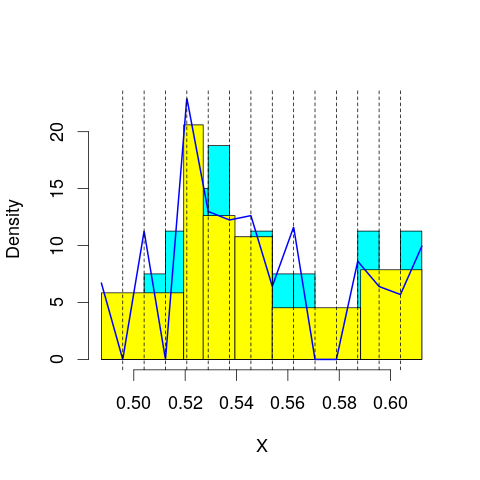

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.08797
mop.approx: Iteration 11. LL = 73.55998
mop.approx: Iteration 21. LL = 73.59532
mop.approx: Converged. Iteration 25. LL = 73.59609
[1] "Computing the linear combination of B-splines"


44.1373352356
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.83657
mop.approx: Iteration 11. LL = 73.11058
mop.approx: Iteration 21. LL = 73.18627
mop.approx: Iteration 31. LL = 73.19994
mop.approx: Iteration 41. LL = 73.20517
mop.approx: Iteration 51. LL = 73.20805
mop.approx: Iteration 61. LL = 73.2099
mop.approx: Iteration 71. LL = 73.21117
mop.approx: Iteration 81. LL = 73.21207
mop.approx: Converged. Iteration 83. LL = 73.21229
[1] "Computing the linear combination of B-splines"


42.0206690462
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.63243
mop.approx: Iteration 11. LL = 68.22993
mop.approx: Iteration 21. LL = 68.36104
mop.approx: Iteration 31. LL = 68.40892
mop.approx: Iteration 41. LL = 68.43305
mop.approx: Iteration 51. LL = 68.4469
mop.approx: Iteration 61. LL = 68.45541
mop.approx: Iteration 71. LL = 68.46086
mop.approx: Iteration 81. LL = 68.46448
mop.approx: Iteration 91. LL = 68.46696
mop.approx: Iteration 101. LL = 68.46871
mop.approx: Iteration 111. LL = 68.46999
mop.approx: Iteration 121. LL = 68.47094
mop.approx: Converged. Iteration 128. LL = 68.47154
[1] "Computing the linear combination of B-splines"


35.5470453482
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.05104
mop.approx: Iteration 11. LL = 68.07769
mop.approx: Iteration 21. LL = 68.1336
mop.approx: Iteration 31. LL = 68.15161
mop.approx: Iteration 41. LL = 68.16108
mop.approx: Iteration 51. LL = 68.16686
mop.approx: Iteration 61. LL = 68.17061
mop.approx: Iteration 71. LL = 68.17308
mop.approx: Iteration 81. LL = 68.17473
mop.approx: Iteration 91. LL = 68.17582
mop.approx: Converged. Iteration 97. LL = 68.17636
[1] "Computing the linear combination of B-splines"


33.5189994176
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.30009
mop.approx: Iteration 11. LL = 68.2721
mop.approx: Iteration 21. LL = 68.40157
mop.approx: Iteration 31. LL = 68.47153
mop.approx: Iteration 41. LL = 68.51629
mop.approx: Iteration 51. LL = 68.54564
mop.approx: Iteration 61. LL = 68.56483
mop.approx: Iteration 71. LL = 68.57724
mop.approx: Iteration 81. LL = 68.5852
mop.approx: Iteration 91. LL = 68.59028
mop.approx: Iteration 101. LL = 68.59354
mop.approx: Iteration 111. LL = 68.59565
mop.approx: Iteration 121. LL = 68.59704
mop.approx: Iteration 131. LL = 68.59798
mop.approx: Converged. Iteration 134. LL = 68.59827
[1] "Computing the linear combination of B-splines"


32.2077639042
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.164175
mop.approx: Iteration 11. LL = 68.2756
mop.approx: Iteration 21. LL = 68.3351
mop.approx: Iteration 31. LL = 68.35294
mop.approx: Iteration 41. LL = 68.36551
mop.approx: Iteration 51. LL = 68.37503
mop.approx: Iteration 61. LL = 68.38242
mop.approx: Iteration 71. LL = 68.3882
mop.approx: Iteration 81. LL = 68.39273
mop.approx: Iteration 91. LL = 68.39629
mop.approx: Iteration 101. LL = 68.39908
mop.approx: Iteration 111. LL = 68.40125
mop.approx: Iteration 121. LL = 68.40295
mop.approx: Iteration 131. LL = 68.40428
mop.approx: Iteration 141. LL = 68.40531
mop.approx: Iteration 151. LL = 68.40611
mop.approx: Converged. Iteration 152. LL = 68.40625
[1] "Computing the linear combination of B-splines"


30.2828891812
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.502149
mop.approx: Iteration 11. LL = 67.43504
mop.approx: Iteration 21. LL = 67.72838
mop.approx: Iteration 31. LL = 67.82555
mop.approx: Iteration 41. LL = 67.86119
mop.approx: Iteration 51. LL = 67.87654
mop.approx: Iteration 61. LL = 67.88436
mop.approx: Iteration 71. LL = 67.88881
mop.approx: Iteration 81. LL = 67.8915
mop.approx: Iteration 91. LL = 67.89319
mop.approx: Iteration 101. LL = 67.89428
mop.approx: Converged. Iteration 107. LL = 67.89481
[1] "Computing the linear combination of B-splines"


28.048949089
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.34136
mop.approx: Iteration 11. LL = 74.75228
mop.approx: Iteration 21. LL = 74.79268
mop.approx: Iteration 31. LL = 74.80192
mop.approx: Iteration 41. LL = 74.80532
mop.approx: Iteration 51. LL = 74.80686
mop.approx: Converged. Iteration 57. LL = 74.80748
[1] "Computing the linear combination of B-splines"


45.3487214719
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 45.348721471869077)
m reached
('Sum of Probabilities:', 0.9919081398520755)
chosen


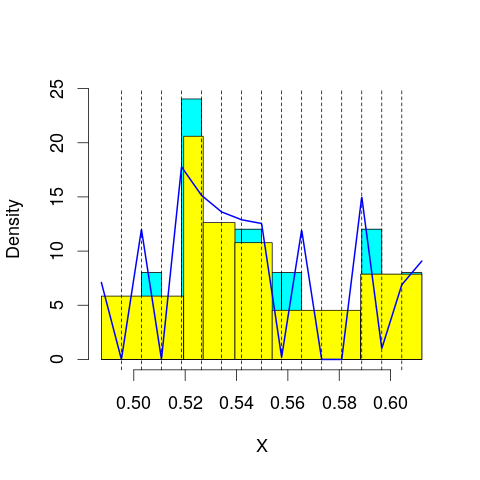

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.08797
mop.approx: Iteration 11. LL = 73.92914
mop.approx: Iteration 21. LL = 74.00363
mop.approx: Iteration 31. LL = 74.00999
mop.approx: Iteration 41. LL = 74.01156
mop.approx: Converged. Iteration 45. LL = 74.01196
[1] "Computing the linear combination of B-splines"


42.820333492
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.83657
mop.approx: Iteration 11. LL = 73.27282
mop.approx: Iteration 21. LL = 73.33126
mop.approx: Iteration 31. LL = 73.34793
mop.approx: Iteration 41. LL = 73.35545
mop.approx: Iteration 51. LL = 73.35941
mop.approx: Iteration 61. LL = 73.3617
mop.approx: Iteration 71. LL = 73.36312
mop.approx: Iteration 81. LL = 73.36406
mop.approx: Converged. Iteration 83. LL = 73.36428
[1] "Computing the linear combination of B-splines"


40.4397939212
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.63243
mop.approx: Iteration 11. LL = 68.776
mop.approx: Iteration 21. LL = 68.93543
mop.approx: Iteration 31. LL = 68.95925
mop.approx: Iteration 41. LL = 68.96485
mop.approx: Iteration 51. LL = 68.96667
mop.approx: Converged. Iteration 57. LL = 68.96726
[1] "Computing the linear combination of B-splines"


34.3099029541
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.05104
mop.approx: Iteration 11. LL = 68.27996
mop.approx: Iteration 21. LL = 68.33919
mop.approx: Iteration 31. LL = 68.36773
mop.approx: Iteration 41. LL = 68.38394
mop.approx: Iteration 51. LL = 68.39422
mop.approx: Iteration 61. LL = 68.40127
mop.approx: Iteration 71. LL = 68.40635
mop.approx: Iteration 81. LL = 68.41013
mop.approx: Iteration 91. LL = 68.413
mop.approx: Iteration 101. LL = 68.41521
mop.approx: Iteration 111. LL = 68.41692
mop.approx: Iteration 121. LL = 68.41825
mop.approx: Iteration 131. LL = 68.41929
mop.approx: Iteration 141. LL = 68.42011
mop.approx: Converged. Iteration 143. LL = 68.42031
[1] "Computing the linear combination of B-splines"


32.0300856706
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.30009
mop.approx: Iteration 11. LL = 68.52155
mop.approx: Iteration 21. LL = 68.65691
mop.approx: Iteration 31. LL = 68.69273
mop.approx: Iteration 41. LL = 68.70747
mop.approx: Iteration 51. LL = 68.71483
mop.approx: Iteration 61. LL = 68.71894
mop.approx: Iteration 71. LL = 68.72143
mop.approx: Iteration 81. LL = 68.72302
mop.approx: Iteration 91. LL = 68.72409
mop.approx: Converged. Iteration 98. LL = 68.7247
[1] "Computing the linear combination of B-splines"


30.6015614359
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.164175
mop.approx: Iteration 11. LL = 68.58333
mop.approx: Iteration 21. LL = 68.66618
mop.approx: Iteration 31. LL = 68.71727
mop.approx: Iteration 41. LL = 68.75296
mop.approx: Iteration 51. LL = 68.77787
mop.approx: Iteration 61. LL = 68.79514
mop.approx: Iteration 71. LL = 68.80699
mop.approx: Iteration 81. LL = 68.81503
mop.approx: Iteration 91. LL = 68.82044
mop.approx: Iteration 101. LL = 68.82405
mop.approx: Iteration 111. LL = 68.82644
mop.approx: Iteration 121. LL = 68.82802
mop.approx: Iteration 131. LL = 68.82906
mop.approx: Converged. Iteration 136. LL = 68.82951
[1] "Computing the linear combination of B-splines"


28.9620773594
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.502149
mop.approx: Iteration 11. LL = 67.99079
mop.approx: Iteration 21. LL = 68.19031
mop.approx: Iteration 31. LL = 68.21436
mop.approx: Iteration 41. LL = 68.21762
mop.approx: Converged. Iteration 44. LL = 68.21793
[1] "Computing the linear combination of B-splines"


26.41430144
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.34136
mop.approx: Iteration 11. LL = 74.30355
mop.approx: Converged. Iteration 19. LL = 74.31122
[1] "Computing the linear combination of B-splines"


43.1195966574
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 43.119596657354123)
m reached
('Sum of Probabilities:', 0.9917435003302113)
chosen


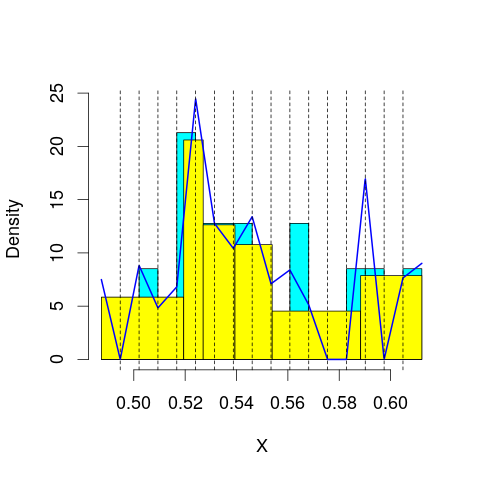

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.08797
mop.approx: Iteration 11. LL = 74.55353
mop.approx: Iteration 21. LL = 74.63627
mop.approx: Iteration 31. LL = 74.64769
mop.approx: Iteration 41. LL = 74.65128
mop.approx: Iteration 51. LL = 74.65293
mop.approx: Converged. Iteration 58. LL = 74.65367
[1] "Computing the linear combination of B-splines"


41.7291762186
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.83657
mop.approx: Iteration 11. LL = 73.62926
mop.approx: Iteration 21. LL = 73.74536
mop.approx: Iteration 31. LL = 73.77419
mop.approx: Iteration 41. LL = 73.78514
mop.approx: Iteration 51. LL = 73.79003
mop.approx: Iteration 61. LL = 73.79235
mop.approx: Iteration 71. LL = 73.79347
mop.approx: Converged. Iteration 72. LL = 73.79362
[1] "Computing the linear combination of B-splines"


39.1362584483
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.63243
mop.approx: Iteration 11. LL = 68.85398
mop.approx: Iteration 21. LL = 68.91292
mop.approx: Iteration 31. LL = 68.92504
mop.approx: Iteration 41. LL = 68.93067
mop.approx: Iteration 51. LL = 68.93407
mop.approx: Iteration 61. LL = 68.93627
mop.approx: Iteration 71. LL = 68.93774
mop.approx: Iteration 81. LL = 68.93874
mop.approx: Converged. Iteration 86. LL = 68.93919
[1] "Computing the linear combination of B-splines"


32.5489616228
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.05104
mop.approx: Iteration 11. LL = 68.8085
mop.approx: Iteration 21. LL = 69.02332
mop.approx: Iteration 31. LL = 69.08654
mop.approx: Iteration 41. LL = 69.10923
mop.approx: Iteration 51. LL = 69.11903
mop.approx: Iteration 61. LL = 69.12374
mop.approx: Iteration 71. LL = 69.12614
mop.approx: Iteration 81. LL = 69.12742
mop.approx: Converged. Iteration 86. LL = 69.12789
[1] "Computing the linear combination of B-splines"


31.0047930347
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.30009
mop.approx: Iteration 11. LL = 68.58626
mop.approx: Iteration 21. LL = 68.62922
mop.approx: Iteration 31. LL = 68.63942
mop.approx: Iteration 41. LL = 68.64311
mop.approx: Iteration 51. LL = 68.64482
mop.approx: Iteration 61. LL = 68.64576
mop.approx: Converged. Iteration 62. LL = 68.6459
[1] "Computing the linear combination of B-splines"


28.7897494021
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.164175
mop.approx: Iteration 11. LL = 68.97076
mop.approx: Iteration 21. LL = 69.18355
mop.approx: Iteration 31. LL = 69.25695
mop.approx: Iteration 41. LL = 69.28974
mop.approx: Iteration 51. LL = 69.30761
mop.approx: Iteration 61. LL = 69.31857
mop.approx: Iteration 71. LL = 69.32576
mop.approx: Iteration 81. LL = 69.33069
mop.approx: Iteration 91. LL = 69.33417
mop.approx: Iteration 101. LL = 69.33667
mop.approx: Iteration 111. LL = 69.33851
mop.approx: Iteration 121. LL = 69.33987
mop.approx: Iteration 131. LL = 69.34089
mop.approx: Converged. Iteration 140. LL = 69.34166
[1] "Computing the linear combination of B-splines"


27.710161267
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.502149
mop.approx: Iteration 11. LL = 70.22347
mop.approx: Iteration 21. LL = 70.4164
mop.approx: Iteration 31. LL = 70.43852
mop.approx: Iteration 41. LL = 70.44425
mop.approx: Iteration 51. LL = 70.44642
mop.approx: Iteration 61. LL = 70.44744
mop.approx: Converged. Iteration 62. LL = 70.44758
[1] "Computing the linear combination of B-splines"


26.7629259006
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.34136
mop.approx: Iteration 11. LL = 75.22728
mop.approx: Iteration 21. LL = 75.23345
mop.approx: Converged. Iteration 25. LL = 75.23395
[1] "Computing the linear combination of B-splines"


42.3094597838
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 42.309459783764282)
m reached
('Sum of Probabilities:', 0.9915800868619442)
chosen


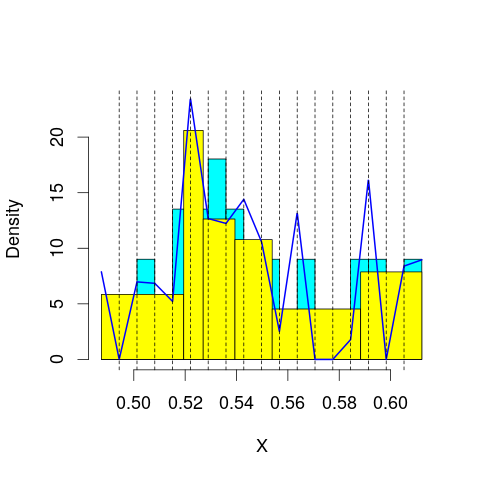

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.08797
mop.approx: Iteration 11. LL = 74.04618
mop.approx: Iteration 21. LL = 74.11849
mop.approx: Iteration 31. LL = 74.12773
mop.approx: Converged. Iteration 40. LL = 74.12934
[1] "Computing the linear combination of B-splines"


39.4719784508
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.83657
mop.approx: Iteration 11. LL = 74.51166
mop.approx: Iteration 21. LL = 74.65481
mop.approx: Iteration 31. LL = 74.68748
mop.approx: Iteration 41. LL = 74.69821
mop.approx: Iteration 51. LL = 74.70228
mop.approx: Iteration 61. LL = 74.70396
mop.approx: Converged. Iteration 65. LL = 74.70439
[1] "Computing the linear combination of B-splines"


38.3141677499
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.63243
mop.approx: Iteration 11. LL = 68.75996
mop.approx: Iteration 21. LL = 68.81025
mop.approx: Iteration 31. LL = 68.82155
mop.approx: Iteration 41. LL = 68.82559
mop.approx: Iteration 51. LL = 68.82752
mop.approx: Iteration 61. LL = 68.82859
mop.approx: Converged. Iteration 65. LL = 68.82896
[1] "Computing the linear combination of B-splines"


30.7058682109
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.05104
mop.approx: Iteration 11. LL = 69.27216
mop.approx: Iteration 21. LL = 69.39321
mop.approx: Iteration 31. LL = 69.41868
mop.approx: Iteration 41. LL = 69.42922
mop.approx: Iteration 51. LL = 69.43522
mop.approx: Iteration 61. LL = 69.43894
mop.approx: Iteration 71. LL = 69.44127
mop.approx: Iteration 81. LL = 69.44271
mop.approx: Iteration 91. LL = 69.44359
mop.approx: Converged. Iteration 91. LL = 69.44366
[1] "Computing the linear combination of B-splines"


29.587697221
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.30009
mop.approx: Iteration 11. LL = 68.74476
mop.approx: Iteration 21. LL = 68.86164
mop.approx: Iteration 31. LL = 68.91839
mop.approx: Iteration 41. LL = 68.94829
mop.approx: Iteration 51. LL = 68.96504
mop.approx: Iteration 61. LL = 68.97502
mop.approx: Iteration 71. LL = 68.98132
mop.approx: Iteration 81. LL = 68.9855
mop.approx: Iteration 91. LL = 68.98838
mop.approx: Iteration 101. LL = 68.99044
mop.approx: Iteration 111. LL = 68.99194
mop.approx: Iteration 121. LL = 68.99306
mop.approx: Iteration 131. LL = 68.99392
mop.approx: Converged. Iteration 134. LL = 68.9942
[1] "Computing the linear combination of B-splines"


27.4052296065
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.164175
mop.approx: Iteration 11. LL = 69.20199
mop.approx: Iteration 21. LL = 69.3335
mop.approx: Iteration 31. LL = 69.36551
mop.approx: Iteration 41. LL = 69.37714
mop.approx: Iteration 51. LL = 69.3826
mop.approx: Iteration 61. LL = 69.38575
mop.approx: Iteration 71. LL = 69.38789
mop.approx: Iteration 81. LL = 69.38951
mop.approx: Iteration 91. LL = 69.39083
mop.approx: Iteration 101. LL = 69.39194
mop.approx: Iteration 111. LL = 69.3929
mop.approx: Iteration 121. LL = 69.39373
mop.approx: Converged. Iteration 130. LL = 69.39446
[1] "Computing the linear combination of B-splines"


26.0431318931
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.502149
mop.approx: Iteration 11. LL = 74.96257
mop.approx: Iteration 21. LL = 75.05464
mop.approx: Iteration 31. LL = 75.05749
mop.approx: Converged. Iteration 33. LL = 75.05774
[1] "Computing the linear combination of B-splines"


29.1259739084
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.34136
mop.approx: Iteration 11. LL = 76.17486
mop.approx: Iteration 21. LL = 76.19686
mop.approx: Iteration 31. LL = 76.20153
mop.approx: Iteration 41. LL = 76.20317
mop.approx: Converged. Iteration 45. LL = 76.20359
[1] "Computing the linear combination of B-splines"


41.5462321973
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 41.546232197305891)
m reached
('Sum of Probabilities:', 0.9914123287617937)
chosen


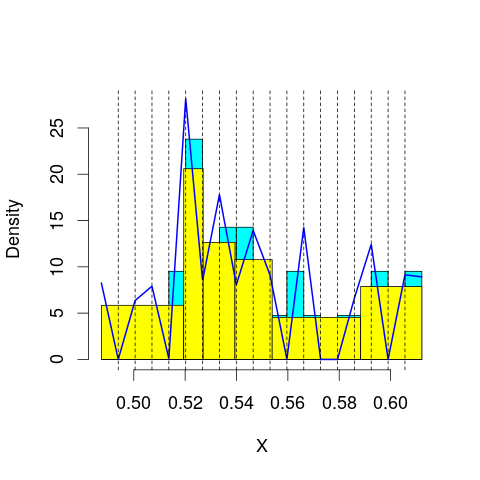

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.08797
mop.approx: Iteration 11. LL = 74.74249
mop.approx: Iteration 21. LL = 74.80935
mop.approx: Iteration 31. LL = 74.82512
mop.approx: Iteration 41. LL = 74.83132
mop.approx: Iteration 51. LL = 74.83421
mop.approx: Iteration 61. LL = 74.83571
mop.approx: Converged. Iteration 67. LL = 74.83634
[1] "Computing the linear combination of B-splines"


38.446110015
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.83657
mop.approx: Iteration 11. LL = 74.39938
mop.approx: Iteration 21. LL = 74.48285
mop.approx: Iteration 31. LL = 74.49234
mop.approx: Iteration 41. LL = 74.49433
mop.approx: Converged. Iteration 44. LL = 74.49466
[1] "Computing the linear combination of B-splines"


36.3715645209
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.63243
mop.approx: Iteration 11. LL = 69.51406
mop.approx: Iteration 21. LL = 69.59593
mop.approx: Iteration 31. LL = 69.62313
mop.approx: Iteration 41. LL = 69.63525
mop.approx: Iteration 51. LL = 69.64072
mop.approx: Iteration 61. LL = 69.64321
mop.approx: Iteration 71. LL = 69.64437
mop.approx: Converged. Iteration 73. LL = 69.64458
[1] "Computing the linear combination of B-splines"


29.7886141615
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.05104
mop.approx: Iteration 11. LL = 69.09785
mop.approx: Iteration 21. LL = 69.15156
mop.approx: Iteration 31. LL = 69.15834
mop.approx: Iteration 41. LL = 69.16075
mop.approx: Iteration 51. LL = 69.16231
mop.approx: Iteration 61. LL = 69.16345
mop.approx: Iteration 71. LL = 69.1643
mop.approx: Converged. Iteration 74. LL = 69.16458
[1] "Computing the linear combination of B-splines"


27.5757486792
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.30009
mop.approx: Iteration 11. LL = 69.33864
mop.approx: Iteration 21. LL = 69.45523
mop.approx: Iteration 31. LL = 69.49673
mop.approx: Iteration 41. LL = 69.51977
mop.approx: Iteration 51. LL = 69.53399
mop.approx: Iteration 61. LL = 69.54307
mop.approx: Iteration 71. LL = 69.54893
mop.approx: Iteration 81. LL = 69.55278
mop.approx: Iteration 91. LL = 69.55534
mop.approx: Iteration 101. LL = 69.55709
mop.approx: Iteration 111. LL = 69.55833
mop.approx: Iteration 121. LL = 69.55922
mop.approx: Converged. Iteration 124. LL = 69.55951
[1] "Computing the linear combination of B-splines"


26.2373255177
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.164175
mop.approx: Iteration 11. LL = 69.10567
mop.approx: Iteration 21. LL = 69.20024
mop.approx: Iteration 31. LL = 69.2419
mop.approx: Iteration 41. LL = 69.26527
mop.approx: Iteration 51. LL = 69.27927
mop.approx: Iteration 61. LL = 69.28801
mop.approx: Iteration 71. LL = 69.29366
mop.approx: Iteration 81. LL = 69.29745
mop.approx: Iteration 91. LL = 69.30008
mop.approx: Iteration 101. LL = 69.30195
mop.approx: Iteration 111. LL = 69.30332
mop.approx: Iteration 121. LL = 69.30433
mop.approx: Converged. Iteration 129. LL = 69.30502
[1] "Computing the linear combination of B-splines"


24.2427594549
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.502149
[1] "Computing the linear combination of B-splines"


30.7318659865
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.34136
mop.approx: Iteration 11. LL = 75.6502
mop.approx: Iteration 21. LL = 75.6763
mop.approx: Iteration 31. LL = 75.68094
mop.approx: Iteration 41. LL = 75.68235
mop.approx: Converged. Iteration 41. LL = 75.68242
[1] "Computing the linear combination of B-splines"


39.2921912089
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 39.292191208866868)
m reached
('Sum of Probabilities:', 0.9912373577049735)
chosen


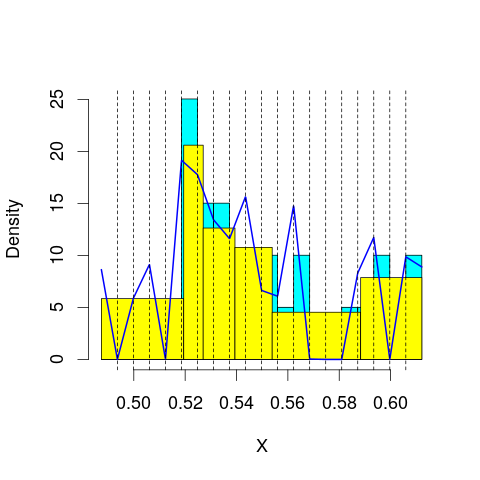

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 66.08797
mop.approx: Iteration 11. LL = 75.49646
mop.approx: Iteration 21. LL = 75.57269
mop.approx: Iteration 31. LL = 75.57817
mop.approx: Converged. Iteration 34. LL = 75.57853
[1] "Computing the linear combination of B-splines"


37.4554339808
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 65.83657
mop.approx: Iteration 11. LL = 74.49235
mop.approx: Iteration 21. LL = 74.58445
mop.approx: Iteration 31. LL = 74.59817
mop.approx: Iteration 41. LL = 74.60269
mop.approx: Iteration 51. LL = 74.60492
mop.approx: Iteration 61. LL = 74.60622
mop.approx: Converged. Iteration 68. LL = 74.60689
[1] "Computing the linear combination of B-splines"


34.7509283701
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 20.63243
mop.approx: Iteration 11. LL = 69.83958
mop.approx: Iteration 21. LL = 69.98329
mop.approx: Iteration 31. LL = 70.02281
mop.approx: Iteration 41. LL = 70.03841
mop.approx: Iteration 51. LL = 70.0453
mop.approx: Iteration 61. LL = 70.04856
mop.approx: Iteration 71. LL = 70.0502
mop.approx: Converged. Iteration 79. LL = 70.051
[1] "Computing the linear combination of B-splines"


28.4621660672
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 15.05104
mop.approx: Iteration 11. LL = 69.43001
mop.approx: Iteration 21. LL = 69.53095
mop.approx: Iteration 31. LL = 69.55337
mop.approx: Iteration 41. LL = 69.56381
mop.approx: Iteration 51. LL = 69.56944
mop.approx: Iteration 61. LL = 69.57252
mop.approx: Iteration 71. LL = 69.57424
mop.approx: Iteration 81. LL = 69.57522
mop.approx: Converged. Iteration 82. LL = 69.57536
[1] "Computing the linear combination of B-splines"


26.2536687873
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 10.30009
mop.approx: Iteration 11. LL = 69.48998
mop.approx: Iteration 21. LL = 69.58518
mop.approx: Iteration 31. LL = 69.60608
mop.approx: Iteration 41. LL = 69.61418
mop.approx: Iteration 51. LL = 69.61879
mop.approx: Iteration 61. LL = 69.62195
mop.approx: Iteration 71. LL = 69.62428
mop.approx: Iteration 81. LL = 69.62605
mop.approx: Iteration 91. LL = 69.62742
mop.approx: Iteration 101. LL = 69.62851
mop.approx: Iteration 111. LL = 69.62938
mop.approx: Converged. Iteration 117. LL = 69.62989
[1] "Computing the linear combination of B-splines"


24.5747781908
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 6.164175
mop.approx: Iteration 11. LL = 69.41001
mop.approx: Iteration 21. LL = 69.51758
mop.approx: Iteration 31. LL = 69.533
mop.approx: Iteration 41. LL = 69.53868
mop.approx: Iteration 51. LL = 69.54249
mop.approx: Iteration 61. LL = 69.54548
mop.approx: Iteration 71. LL = 69.54792
mop.approx: Iteration 81. LL = 69.54994
mop.approx: Iteration 91. LL = 69.55161
mop.approx: Iteration 101. LL = 69.55302
mop.approx: Iteration 111. LL = 69.5542
mop.approx: Iteration 121. LL = 69.5552
mop.approx: Iteration 131. LL = 69.55605
mop.approx: Converged. Iteration 139. LL = 69.5567
[1] "Computing the linear combination of B-splines"


22.7087243255
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 2.502149
[1] "Computing the linear combination of B-splines"


27.1806212784
lfps_28
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.97477
mop.approx: Iteration 11. LL = 96.45673
mop.approx: Iteration 21. LL = 96.4878
mop.approx: Converged. Iteration 26. LL = 96.48894
[1] "Computing the linear combination of B-splines"


91.2903385557
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 91.29033855571393)
m reached
('Sum of Probabilities:', 0.9687774794158355)
chosen


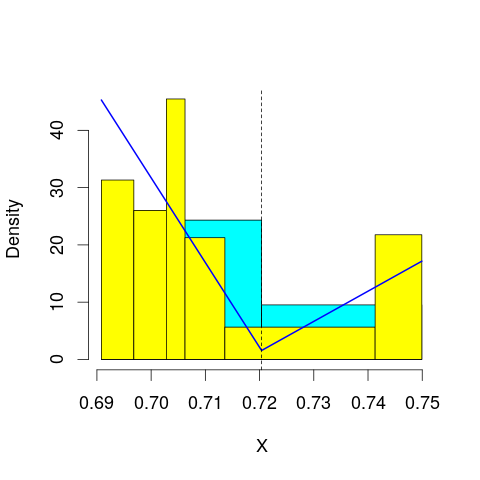

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.44672
mop.approx: Iteration 11. LL = 95.18444
mop.approx: Iteration 21. LL = 95.25282
mop.approx: Converged. Iteration 29. LL = 95.25602
[1] "Computing the linear combination of B-splines"


88.3245469841
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 88.92724
mop.approx: Iteration 11. LL = 95.3282
mop.approx: Iteration 21. LL = 95.48928
mop.approx: Iteration 31. LL = 95.51022
mop.approx: Iteration 41. LL = 95.51552
mop.approx: Iteration 51. LL = 95.51729
mop.approx: Converged. Iteration 52. LL = 95.51747
[1] "Computing the linear combination of B-splines"


86.8531306344
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.91145
mop.approx: Iteration 11. LL = 61.35812
mop.approx: Iteration 21. LL = 61.4351
mop.approx: Iteration 31. LL = 61.44395
mop.approx: Iteration 41. LL = 61.44545
mop.approx: Converged. Iteration 41. LL = 61.4455
[1] "Computing the linear combination of B-splines"


51.0482969797
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.60554
mop.approx: Iteration 11. LL = 64.15129
mop.approx: Converged. Iteration 16. LL = 64.15674
[1] "Computing the linear combination of B-splines"


52.0266639999
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.34006
mop.approx: Iteration 11. LL = 55.08017
mop.approx: Iteration 21. LL = 55.37319
mop.approx: Iteration 31. LL = 55.46783
mop.approx: Iteration 41. LL = 55.5081
mop.approx: Iteration 51. LL = 55.52821
mop.approx: Iteration 61. LL = 55.53923
mop.approx: Iteration 71. LL = 55.54562
mop.approx: Iteration 81. LL = 55.54945
mop.approx: Iteration 91. LL = 55.5518
mop.approx: Iteration 101. LL = 55.55325
mop.approx: Iteration 111. LL = 55.55416
mop.approx: Converged. Iteration 116. LL = 55.55453
[1] "Computing the linear combination of B-splines"


41.6915907234
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.81981
mop.approx: Iteration 11. LL = 57.57075
mop.approx: Converged. Iteration 20. LL = 57.59876
[1] "Computing the linear combination of B-splines"


42.0029459154
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.859762
mop.approx: Iteration 11. LL = 50.43098
mop.approx: Iteration 21. LL = 50.76594
mop.approx: Iteration 31. LL = 50.90629
mop.approx: Iteration 41. LL = 50.97125
mop.approx: Iteration 51. LL = 51.00358
mop.approx: Iteration 61. LL = 51.0204
mop.approx: Iteration 71. LL = 51.02936
mop.approx: Iteration 81. LL = 51.03421
mop.approx: Iteration 91. LL = 51.03686
mop.approx: Iteration 101. LL = 51.0383
mop.approx: Iteration 111. LL = 51.0391
mop.approx: Converged. Iteration 113. LL = 51.03926
[1] "Computing the linear combination of B-splines"


33.7105770566
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.97477
mop.approx: Iteration 11. LL = 97.85818
mop.approx: Converged. Iteration 18. LL = 97.86662
[1] "Computing the linear combination of B-splines"


90.9351432785
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 90.935143278523967)
m reached
('Sum of Probabilities:', 0.9701335615360971)
chosen


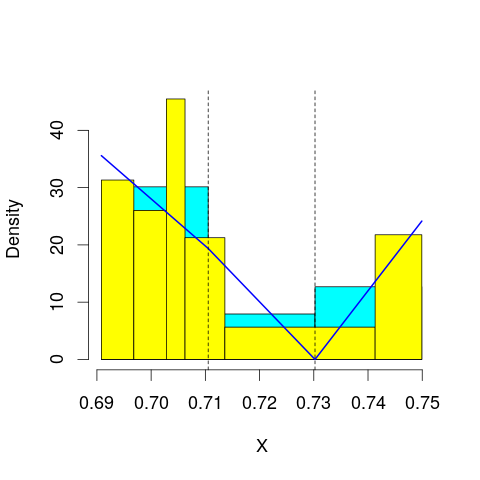

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.44672
mop.approx: Iteration 11. LL = 97.26497
mop.approx: Iteration 21. LL = 97.3165
mop.approx: Iteration 31. LL = 97.32756
mop.approx: Iteration 41. LL = 97.33171
mop.approx: Iteration 51. LL = 97.3334
mop.approx: Converged. Iteration 52. LL = 97.3336
[1] "Computing the linear combination of B-splines"


88.6692562819
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 88.92724
mop.approx: Iteration 11. LL = 96.20934
mop.approx: Iteration 21. LL = 96.26197
mop.approx: Converged. Iteration 29. LL = 96.26453
[1] "Computing the linear combination of B-splines"


85.867326596
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.91145
mop.approx: Iteration 11. LL = 75.40318
mop.approx: Converged. Iteration 19. LL = 75.42322
[1] "Computing the linear combination of B-splines"


63.2931471999
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.60554
mop.approx: Iteration 11. LL = 66.13172
mop.approx: Iteration 21. LL = 66.15905
mop.approx: Converged. Iteration 26. LL = 66.15998
[1] "Computing the linear combination of B-splines"


52.2970406063
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.34006
mop.approx: Iteration 11. LL = 67.70024
mop.approx: Converged. Iteration 18. LL = 67.71383
[1] "Computing the linear combination of B-splines"


52.1180219989
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.81981
mop.approx: Iteration 11. LL = 59.03295
mop.approx: Iteration 21. LL = 59.28124
mop.approx: Iteration 31. LL = 59.35261
mop.approx: Iteration 41. LL = 59.38198
mop.approx: Iteration 51. LL = 59.39681
mop.approx: Iteration 61. LL = 59.40527
mop.approx: Iteration 71. LL = 59.41051
mop.approx: Iteration 81. LL = 59.41393
mop.approx: Iteration 91. LL = 59.41625
mop.approx: Iteration 101. LL = 59.41786
mop.approx: Iteration 111. LL = 59.419
mop.approx: Iteration 121. LL = 59.41981
mop.approx: Converged. Iteration 126. LL = 59.42019
[1] "Computing the linear combination of B-splines"


42.0915109668
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.859762
mop.approx: Iteration 11. LL = 60.75311
mop.approx: Iteration 21. LL = 60.79232
mop.approx: Converged. Iteration 21. LL = 60.79237
[1] "Computing the linear combination of B-splines"


41.7308180619
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.97477
mop.approx: Iteration 11. LL = 98.56625
mop.approx: Iteration 21. LL = 98.57411
mop.approx: Converged. Iteration 23. LL = 98.57447
[1] "Computing the linear combination of B-splines"


89.9101350289
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 89.910135028860196)
m reached
('Sum of Probabilities:', 0.9719936457783365)
chosen


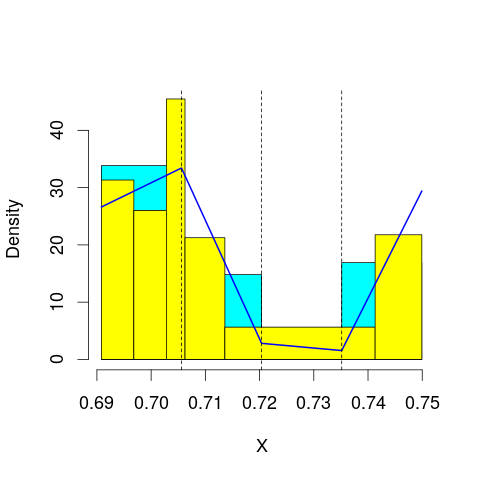

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.44672
mop.approx: Iteration 11. LL = 97.18914
mop.approx: Iteration 21. LL = 97.19927
mop.approx: Converged. Iteration 21. LL = 97.19936
[1] "Computing the linear combination of B-splines"


86.8021557519
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 88.92724
mop.approx: Iteration 11. LL = 97.02911
mop.approx: Iteration 21. LL = 97.0822
mop.approx: Iteration 31. LL = 97.09072
mop.approx: Iteration 41. LL = 97.09335
mop.approx: Converged. Iteration 47. LL = 97.09417
[1] "Computing the linear combination of B-splines"


84.9640973475
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.91145
mop.approx: Iteration 11. LL = 78.23809
mop.approx: Converged. Iteration 13. LL = 78.23869
[1] "Computing the linear combination of B-splines"


64.3757476336
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.60554
mop.approx: Iteration 11. LL = 76.42215
mop.approx: Iteration 21. LL = 76.55284
mop.approx: Converged. Iteration 29. LL = 76.55612
[1] "Computing the linear combination of B-splines"


60.9603043107
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.34006
mop.approx: Iteration 11. LL = 69.77889
mop.approx: Converged. Iteration 20. LL = 69.78744
[1] "Computing the linear combination of B-splines"


52.458763393
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.81981
mop.approx: Iteration 11. LL = 70.43162
mop.approx: Converged. Iteration 20. LL = 70.46364
[1] "Computing the linear combination of B-splines"


51.402083111
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.859762
mop.approx: Iteration 11. LL = 62.37358
mop.approx: Iteration 21. LL = 62.57432
mop.approx: Iteration 31. LL = 62.62471
mop.approx: Iteration 41. LL = 62.64397
mop.approx: Iteration 51. LL = 62.65329
mop.approx: Iteration 61. LL = 62.65851
mop.approx: Iteration 71. LL = 62.66173
mop.approx: Iteration 81. LL = 62.66387
mop.approx: Iteration 91. LL = 62.66537
mop.approx: Iteration 101. LL = 62.66646
mop.approx: Iteration 111. LL = 62.66728
mop.approx: Converged. Iteration 116. LL = 62.66768
[1] "Computing the linear combination of B-splines"


41.873322479
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.97477
mop.approx: Iteration 11. LL = 98.26986
mop.approx: Iteration 21. LL = 98.27718
mop.approx: Iteration 31. LL = 98.279
mop.approx: Converged. Iteration 31. LL = 98.2791
[1] "Computing the linear combination of B-splines"


87.8818890085
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 87.88188900848337)
m reached
('Sum of Probabilities:', 0.9744453137412777)
chosen


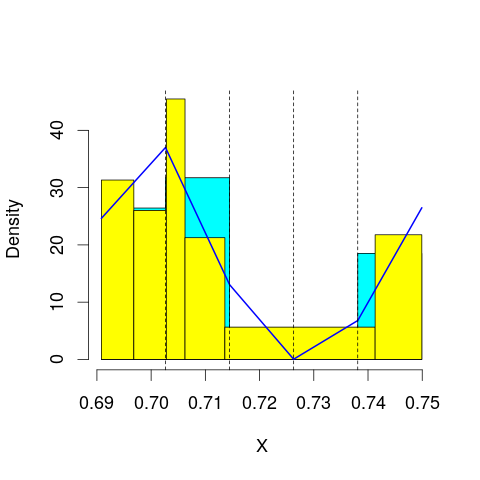

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.44672
mop.approx: Iteration 11. LL = 97.65643
mop.approx: Iteration 21. LL = 97.67097
mop.approx: Converged. Iteration 22. LL = 97.67119
[1] "Computing the linear combination of B-splines"


85.5411159141
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 88.92724
mop.approx: Iteration 11. LL = 97.36103
mop.approx: Iteration 21. LL = 97.43681
mop.approx: Iteration 31. LL = 97.44839
mop.approx: Iteration 41. LL = 97.4507
mop.approx: Converged. Iteration 41. LL = 97.45079
[1] "Computing the linear combination of B-splines"


83.5878428196
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.91145
mop.approx: Iteration 11. LL = 80.50002
mop.approx: Iteration 21. LL = 80.54206
mop.approx: Iteration 31. LL = 80.54588
mop.approx: Converged. Iteration 32. LL = 80.54604
[1] "Computing the linear combination of B-splines"


64.9502333181
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.60554
mop.approx: Iteration 11. LL = 79.50052
mop.approx: Converged. Iteration 19. LL = 79.5157
[1] "Computing the linear combination of B-splines"


62.1870186013
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.34006
mop.approx: Iteration 11. LL = 76.42613
mop.approx: Iteration 21. LL = 76.69951
mop.approx: Iteration 31. LL = 76.74501
mop.approx: Iteration 41. LL = 76.75542
mop.approx: Iteration 51. LL = 76.75795
mop.approx: Converged. Iteration 54. LL = 76.75831
[1] "Computing the linear combination of B-splines"


57.6967508605
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.81981
mop.approx: Iteration 11. LL = 72.60573
mop.approx: Converged. Iteration 16. LL = 72.60817
[1] "Computing the linear combination of B-splines"


51.8137822046
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.859762
mop.approx: Iteration 11. LL = 72.53093
mop.approx: Iteration 21. LL = 72.59989
mop.approx: Converged. Iteration 23. LL = 72.60025
[1] "Computing the linear combination of B-splines"


50.0736865847
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.97477
mop.approx: Iteration 11. LL = 98.61495
mop.approx: Converged. Iteration 13. LL = 98.61558
[1] "Computing the linear combination of B-splines"


86.4855005649
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 86.485500564938363)
m reached
('Sum of Probabilities:', 0.9758510393561879)
chosen


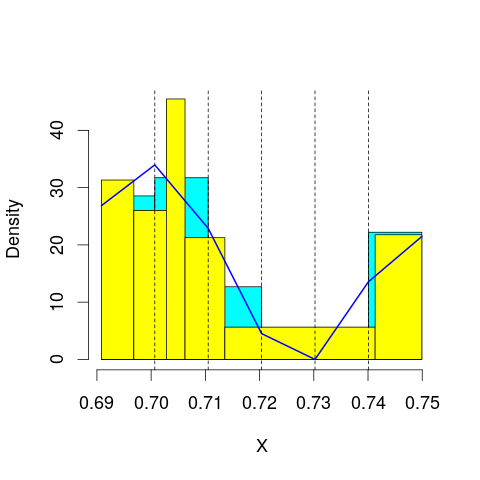

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.44672
mop.approx: Iteration 11. LL = 98.23596
mop.approx: Iteration 21. LL = 98.2666
mop.approx: Converged. Iteration 26. LL = 98.26795
[1] "Computing the linear combination of B-splines"


84.4050112043
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 88.92724
mop.approx: Iteration 11. LL = 97.09446
mop.approx: Iteration 21. LL = 97.13101
mop.approx: Iteration 31. LL = 97.13492
mop.approx: Converged. Iteration 32. LL = 97.13512
[1] "Computing the linear combination of B-splines"


81.5393057338
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.91145
mop.approx: Iteration 11. LL = 80.87161
mop.approx: Converged. Iteration 18. LL = 80.87567
[1] "Computing the linear combination of B-splines"


63.54698597
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.60554
mop.approx: Iteration 11. LL = 82.76355
mop.approx: Converged. Iteration 20. LL = 82.77673
[1] "Computing the linear combination of B-splines"


63.7151893466
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.34006
mop.approx: Iteration 11. LL = 79.69488
mop.approx: Iteration 21. LL = 79.81764
mop.approx: Iteration 31. LL = 79.82343
mop.approx: Converged. Iteration 32. LL = 79.82358
[1] "Computing the linear combination of B-splines"


59.0291401657
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.81981
mop.approx: Iteration 11. LL = 76.09927
mop.approx: Iteration 21. LL = 76.30883
mop.approx: Iteration 31. LL = 76.32564
mop.approx: Iteration 41. LL = 76.32883
mop.approx: Converged. Iteration 46. LL = 76.32942
[1] "Computing the linear combination of B-splines"


53.803051476
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.859762
mop.approx: Iteration 11. LL = 74.7468
mop.approx: Converged. Iteration 14. LL = 74.74754
[1] "Computing the linear combination of B-splines"


50.4800974316
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.97477
mop.approx: Converged. Iteration 9. LL = 99.23429
[1] "Computing the linear combination of B-splines"


85.3713429295
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 85.371342929458422)
m reached
('Sum of Probabilities:', 0.9767476845625734)
chosen


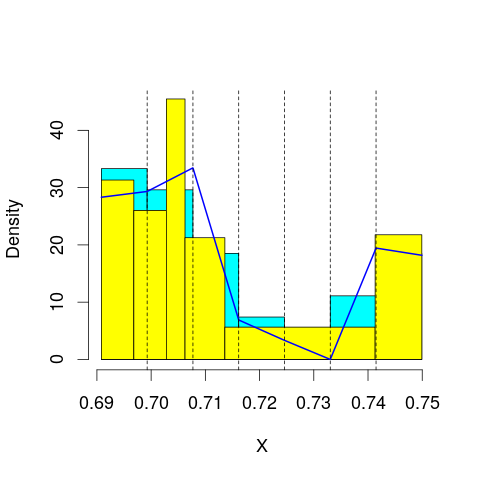

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.44672
mop.approx: Iteration 11. LL = 98.01681
mop.approx: Iteration 21. LL = 98.02989
mop.approx: Converged. Iteration 21. LL = 98.02998
[1] "Computing the linear combination of B-splines"


82.4341660473
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 88.92724
mop.approx: Iteration 11. LL = 97.40142
mop.approx: Iteration 21. LL = 97.42205
mop.approx: Iteration 31. LL = 97.42913
mop.approx: Iteration 41. LL = 97.43206
mop.approx: Converged. Iteration 49. LL = 97.43323
[1] "Computing the linear combination of B-splines"


80.1045532587
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.91145
mop.approx: Iteration 11. LL = 81.84648
mop.approx: Iteration 21. LL = 81.85564
mop.approx: Converged. Iteration 24. LL = 81.85608
[1] "Computing the linear combination of B-splines"


62.7945353695
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.60554
mop.approx: Iteration 11. LL = 83.49773
mop.approx: Converged. Iteration 20. LL = 83.50304
[1] "Computing the linear combination of B-splines"


62.708630918
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.34006
mop.approx: Iteration 11. LL = 83.67778
mop.approx: Converged. Iteration 20. LL = 83.70381
[1] "Computing the linear combination of B-splines"


61.1762789183
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.81981
mop.approx: Iteration 11. LL = 79.12842
mop.approx: Iteration 21. LL = 79.33382
mop.approx: Iteration 31. LL = 79.36862
mop.approx: Iteration 41. LL = 79.38443
mop.approx: Iteration 51. LL = 79.39307
mop.approx: Iteration 61. LL = 79.39813
mop.approx: Iteration 71. LL = 79.40122
mop.approx: Iteration 81. LL = 79.40316
mop.approx: Iteration 91. LL = 79.4044
mop.approx: Converged. Iteration 96. LL = 79.40492
[1] "Computing the linear combination of B-splines"


55.1306705339
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.859762
mop.approx: Iteration 11. LL = 74.47306
mop.approx: Iteration 21. LL = 74.60974
mop.approx: Iteration 31. LL = 74.6462
mop.approx: Iteration 41. LL = 74.65978
mop.approx: Iteration 51. LL = 74.66588
mop.approx: Iteration 61. LL = 74.66891
mop.approx: Iteration 71. LL = 74.67051
mop.approx: Converged. Iteration 78. LL = 74.67124
[1] "Computing the linear combination of B-splines"


48.6277802351
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.97477
mop.approx: Iteration 11. LL = 99.37534
mop.approx: Iteration 21. LL = 99.39197
mop.approx: Converged. Iteration 25. LL = 99.3928
[1] "Computing the linear combination of B-splines"


83.7969871278
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 83.796987127844545)
m reached
('Sum of Probabilities:', 0.9760018183477024)
chosen


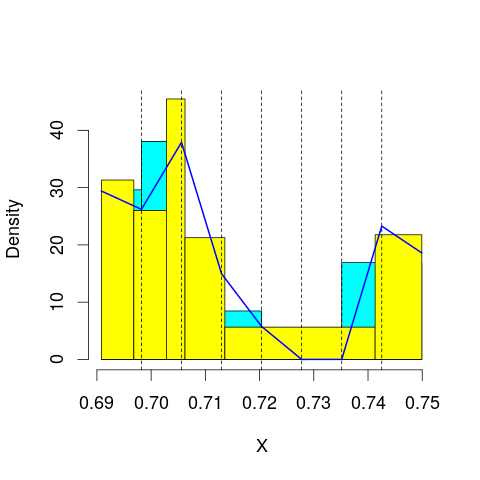

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.44672
mop.approx: Iteration 11. LL = 98.17696
mop.approx: Converged. Iteration 16. LL = 98.179
[1] "Computing the linear combination of B-splines"


80.8503219053
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 88.92724
mop.approx: Iteration 11. LL = 97.98355
mop.approx: Iteration 21. LL = 98.0743
mop.approx: Iteration 31. LL = 98.09774
mop.approx: Iteration 41. LL = 98.10627
mop.approx: Iteration 51. LL = 98.10982
mop.approx: Iteration 61. LL = 98.11145
mop.approx: Converged. Iteration 63. LL = 98.11175
[1] "Computing the linear combination of B-splines"


79.0502012884
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.91145
mop.approx: Iteration 11. LL = 83.17354
mop.approx: Iteration 21. LL = 83.25632
mop.approx: Iteration 31. LL = 83.27086
mop.approx: Iteration 41. LL = 83.27385
mop.approx: Converged. Iteration 44. LL = 83.27423
[1] "Computing the linear combination of B-splines"


62.4798125033
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.60554
mop.approx: Iteration 11. LL = 83.93881
mop.approx: Iteration 21. LL = 83.9444
mop.approx: Converged. Iteration 21. LL = 83.94448
[1] "Computing the linear combination of B-splines"


61.4171870191
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.34006
mop.approx: Iteration 11. LL = 85.23833
mop.approx: Iteration 21. LL = 85.27303
mop.approx: Iteration 31. LL = 85.27925
mop.approx: Iteration 41. LL = 85.28162
mop.approx: Iteration 51. LL = 85.28278
mop.approx: Converged. Iteration 51. LL = 85.28286
[1] "Computing the linear combination of B-splines"


61.0224001489
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.81981
mop.approx: Iteration 11. LL = 83.87313
mop.approx: Iteration 21. LL = 84.00961
mop.approx: Iteration 31. LL = 84.01806
mop.approx: Converged. Iteration 34. LL = 84.01848
[1] "Computing the linear combination of B-splines"


58.0166151312
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.859762
mop.approx: Iteration 11. LL = 83.68684
mop.approx: Iteration 21. LL = 84.09454
mop.approx: Iteration 31. LL = 84.18375
mop.approx: Iteration 41. LL = 84.21526
mop.approx: Iteration 51. LL = 84.2284
mop.approx: Iteration 61. LL = 84.23427
mop.approx: Iteration 71. LL = 84.23698
mop.approx: Iteration 81. LL = 84.23825
mop.approx: Converged. Iteration 81. LL = 84.23833
[1] "Computing the linear combination of B-splines"


57.3347288344
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.97477
mop.approx: Converged. Iteration 8. LL = 99.3219
[1] "Computing the linear combination of B-splines"


81.993220439
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 81.993220438955902)
m reached
('Sum of Probabilities:', 0.9735851122282271)
chosen


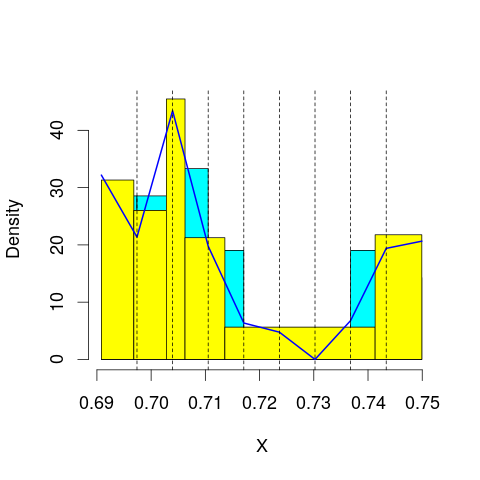

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.44672
mop.approx: Iteration 11. LL = 98.73864
mop.approx: Iteration 21. LL = 98.79706
mop.approx: Iteration 31. LL = 98.81087
mop.approx: Iteration 41. LL = 98.81592
mop.approx: Iteration 51. LL = 98.81832
mop.approx: Iteration 61. LL = 98.81962
mop.approx: Converged. Iteration 61. LL = 98.81971
[1] "Computing the linear combination of B-splines"


79.7581670894
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 88.92724
mop.approx: Iteration 11. LL = 98.08766
mop.approx: Iteration 21. LL = 98.21075
mop.approx: Iteration 31. LL = 98.2461
mop.approx: Iteration 41. LL = 98.25963
mop.approx: Iteration 51. LL = 98.26565
mop.approx: Iteration 61. LL = 98.26856
mop.approx: Iteration 71. LL = 98.27004
mop.approx: Converged. Iteration 72. LL = 98.27024
[1] "Computing the linear combination of B-splines"


77.4758259855
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.91145
mop.approx: Iteration 11. LL = 84.24915
mop.approx: Iteration 21. LL = 84.33237
mop.approx: Iteration 31. LL = 84.34565
mop.approx: Iteration 41. LL = 84.34983
mop.approx: Iteration 51. LL = 84.35177
mop.approx: Converged. Iteration 60. LL = 84.35284
[1] "Computing the linear combination of B-splines"


61.8255530672
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.60554
mop.approx: Iteration 11. LL = 84.72832
mop.approx: Iteration 21. LL = 84.7917
mop.approx: Iteration 31. LL = 84.80728
mop.approx: Iteration 41. LL = 84.81135
mop.approx: Converged. Iteration 47. LL = 84.81224
[1] "Computing the linear combination of B-splines"


60.5520698344
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.34006
mop.approx: Iteration 11. LL = 85.60251
mop.approx: Iteration 21. LL = 85.60675
mop.approx: Converged. Iteration 21. LL = 85.60681
[1] "Computing the linear combination of B-splines"


59.6111686711
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.81981
mop.approx: Iteration 11. LL = 86.25946
mop.approx: Iteration 21. LL = 86.34686
mop.approx: Iteration 31. LL = 86.35193
mop.approx: Converged. Iteration 33. LL = 86.35224
[1] "Computing the linear combination of B-splines"


58.6913968084
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.859762
[1] "Computing the linear combination of B-splines"


62.5691753016
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.97477
mop.approx: Iteration 11. LL = 99.38446
mop.approx: Iteration 21. LL = 99.40689
mop.approx: Iteration 31. LL = 99.41485
mop.approx: Iteration 41. LL = 99.41758
mop.approx: Converged. Iteration 45. LL = 99.41817
[1] "Computing the linear combination of B-splines"


80.3566230277
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 80.356623027748782)
m reached
('Sum of Probabilities:', 0.972251468565455)
chosen


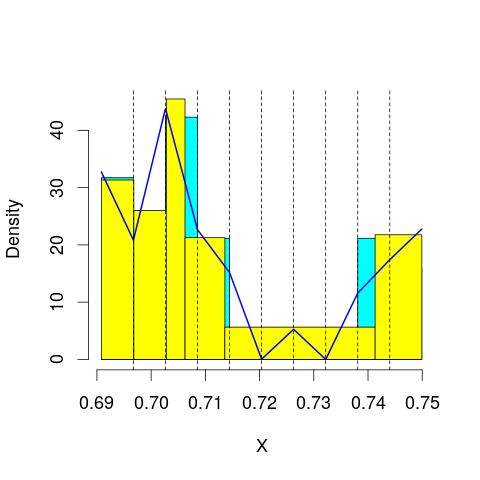

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.44672
mop.approx: Iteration 11. LL = 99.45362
mop.approx: Iteration 21. LL = 99.50363
mop.approx: Iteration 31. LL = 99.51117
mop.approx: Converged. Iteration 38. LL = 99.51248
[1] "Computing the linear combination of B-splines"


78.7180626562
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 88.92724
mop.approx: Iteration 11. LL = 97.96328
mop.approx: Iteration 21. LL = 98.07452
mop.approx: Iteration 31. LL = 98.10794
mop.approx: Iteration 41. LL = 98.11917
mop.approx: Iteration 51. LL = 98.12313
mop.approx: Converged. Iteration 60. LL = 98.1246
[1] "Computing the linear combination of B-splines"


75.597312123
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.91145
mop.approx: Iteration 11. LL = 84.65299
mop.approx: Iteration 21. LL = 84.65713
mop.approx: Converged. Iteration 30. LL = 84.65839
[1] "Computing the linear combination of B-splines"


60.3982400509
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.60554
mop.approx: Iteration 11. LL = 85.70754
mop.approx: Iteration 21. LL = 85.79555
mop.approx: Iteration 31. LL = 85.81537
mop.approx: Iteration 41. LL = 85.82031
mop.approx: Converged. Iteration 50. LL = 85.82172
[1] "Computing the linear combination of B-splines"


59.8287940331
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.34006
mop.approx: Iteration 11. LL = 86.1408
mop.approx: Iteration 21. LL = 86.17966
mop.approx: Iteration 31. LL = 86.19402
mop.approx: Iteration 41. LL = 86.19959
mop.approx: Iteration 51. LL = 86.2018
mop.approx: Converged. Iteration 56. LL = 86.20242
[1] "Computing the linear combination of B-splines"


58.4786217234
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.81981
mop.approx: Iteration 11. LL = 87.54822
mop.approx: Converged. Iteration 20. LL = 87.5628
[1] "Computing the linear combination of B-splines"


58.2007355287
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.859762
[1] "Computing the linear combination of B-splines"


63.5288302494
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.97477
mop.approx: Iteration 11. LL = 99.92071
mop.approx: Iteration 21. LL = 99.93563
mop.approx: Converged. Iteration 30. LL = 99.93767
[1] "Computing the linear combination of B-splines"


79.1432590484
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 79.143259048402385)
m reached
('Sum of Probabilities:', 0.9697164459678871)
chosen


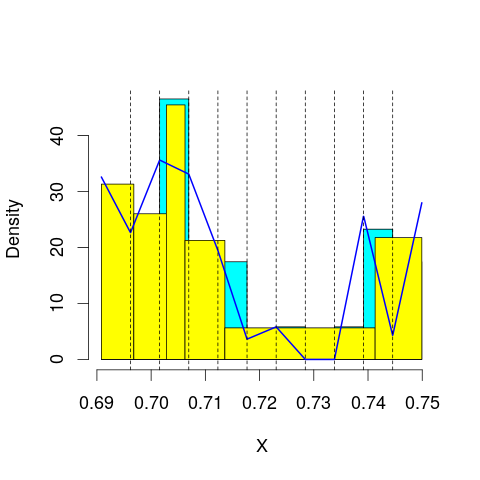

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.44672
mop.approx: Iteration 11. LL = 99.52276
mop.approx: Iteration 21. LL = 99.59291
mop.approx: Iteration 31. LL = 99.60126
mop.approx: Converged. Iteration 36. LL = 99.60216
[1] "Computing the linear combination of B-splines"


77.074875131
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 88.92724
mop.approx: Iteration 11. LL = 98.36545
mop.approx: Iteration 21. LL = 98.48316
mop.approx: Iteration 31. LL = 98.52024
mop.approx: Iteration 41. LL = 98.53311
mop.approx: Iteration 51. LL = 98.5382
mop.approx: Iteration 61. LL = 98.54048
mop.approx: Converged. Iteration 67. LL = 98.54134
[1] "Computing the linear combination of B-splines"


74.2811854121
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.91145
mop.approx: Iteration 11. LL = 85.23678
mop.approx: Iteration 21. LL = 85.25168
mop.approx: Iteration 31. LL = 85.25392
mop.approx: Converged. Iteration 31. LL = 85.25399
[1] "Computing the linear combination of B-splines"


59.2609732631
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.60554
mop.approx: Iteration 11. LL = 86.31833
mop.approx: Iteration 21. LL = 86.3262
mop.approx: Iteration 31. LL = 86.32731
mop.approx: Converged. Iteration 32. LL = 86.32748
[1] "Computing the linear combination of B-splines"


58.601507695
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.34006
mop.approx: Iteration 11. LL = 86.84185
mop.approx: Iteration 21. LL = 86.91083
mop.approx: Iteration 31. LL = 86.93619
mop.approx: Iteration 41. LL = 86.9454
mop.approx: Iteration 51. LL = 86.94858
mop.approx: Converged. Iteration 58. LL = 86.94952
[1] "Computing the linear combination of B-splines"


57.4763849497
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.81981
mop.approx: Iteration 11. LL = 87.56114
mop.approx: Converged. Iteration 19. LL = 87.57103
[1] "Computing the linear combination of B-splines"


56.8079823128
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.859762
[1] "Computing the linear combination of B-splines"


90.9087219075
('best: ', 79.143259048402385, 'accepted difference:', 134.54354038228405, 'cur BIC:', 90.908721907458045)
m reached
('Sum of Probabilities:', 15.778142889368718)
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.97477
mop.approx: Iteration 11. LL = 101.2597
mop.approx: Iteration 21. LL = 101.2919
mop.approx: Converged. Iteration 25. LL = 101.293
[1] "Computing the linear combination of B-splines"


78.7656682099
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 78.765668209930084)
m reached
('Sum of Probabilities:', 0.9683709251122734)
chosen


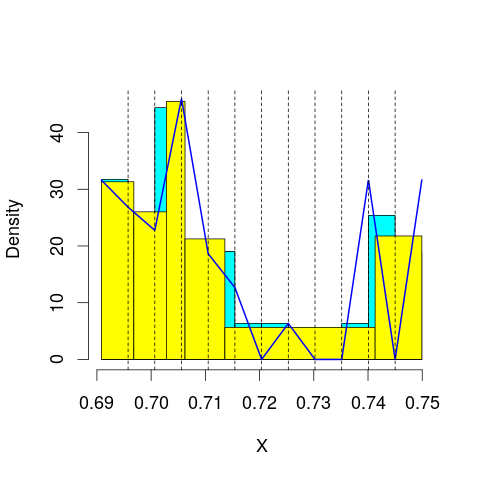

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.44672
mop.approx: Iteration 11. LL = 99.64338
mop.approx: Iteration 21. LL = 99.69541
mop.approx: Iteration 31. LL = 99.7051
mop.approx: Iteration 41. LL = 99.70766
mop.approx: Converged. Iteration 43. LL = 99.70799
[1] "Computing the linear combination of B-splines"


75.447839559
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 88.92724
mop.approx: Iteration 11. LL = 98.90984
mop.approx: Iteration 21. LL = 99.06212
mop.approx: Iteration 31. LL = 99.09324
mop.approx: Iteration 41. LL = 99.10012
mop.approx: Converged. Iteration 49. LL = 99.1017
[1] "Computing the linear combination of B-splines"


73.1086810668
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.91145
mop.approx: Iteration 11. LL = 86.37035
mop.approx: Iteration 21. LL = 86.45828
mop.approx: Iteration 31. LL = 86.47454
mop.approx: Iteration 41. LL = 86.47748
mop.approx: Converged. Iteration 43. LL = 86.47776
[1] "Computing the linear combination of B-splines"


58.7518662631
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.60554
mop.approx: Iteration 11. LL = 86.5593
mop.approx: Iteration 21. LL = 86.58569
mop.approx: Iteration 31. LL = 86.59297
mop.approx: Iteration 41. LL = 86.59613
mop.approx: Iteration 51. LL = 86.59805
mop.approx: Iteration 61. LL = 86.59947
mop.approx: Iteration 71. LL = 86.60066
mop.approx: Iteration 81. LL = 86.60169
mop.approx: Converged. Iteration 90. LL = 86.6026
[1] "Computing the linear combination of B-splines"


57.1434115179
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.34006
mop.approx: Iteration 11. LL = 87.56042
mop.approx: Iteration 21. LL = 87.57212
mop.approx: Converged. Iteration 21. LL = 87.57219
[1] "Computing the linear combination of B-splines"


56.3735246975
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.81981
mop.approx: Iteration 11. LL = 93.90905
mop.approx: Iteration 21. LL = 94.0109
mop.approx: Iteration 31. LL = 94.01948
mop.approx: Converged. Iteration 34. LL = 94.02
[1] "Computing the linear combination of B-splines"


60.4340919979
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.859762
[1] "Computing the linear combination of B-splines"


87.9796044848
('best: ', 78.765668209930084, 'accepted difference:', 133.90163595688114, 'cur BIC:', 87.979604484794123)
m reached
('Sum of Probabilities:', 27.877141162184984)
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.97477
mop.approx: Iteration 11. LL = 102.014
mop.approx: Iteration 21. LL = 102.0291
mop.approx: Converged. Iteration 29. LL = 102.0308
[1] "Computing the linear combination of B-splines"


77.7706505715
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 77.770650571491444)
m reached
('Sum of Probabilities:', 0.9675246516947074)
chosen


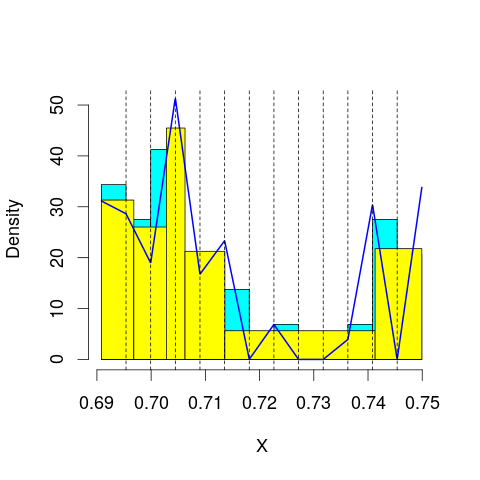

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.44672
mop.approx: Iteration 11. LL = 99.49566
mop.approx: Iteration 21. LL = 99.51629
mop.approx: Iteration 31. LL = 99.52048
mop.approx: Iteration 41. LL = 99.52209
mop.approx: Converged. Iteration 42. LL = 99.52229
[1] "Computing the linear combination of B-splines"


73.5292745319
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 88.92724
mop.approx: Iteration 11. LL = 99.88272
mop.approx: Iteration 21. LL = 100.0254
mop.approx: Iteration 31. LL = 100.0386
mop.approx: Iteration 41. LL = 100.0414
mop.approx: Converged. Iteration 46. LL = 100.0421
[1] "Computing the linear combination of B-splines"


72.3161843126
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.91145
mop.approx: Iteration 11. LL = 87.07386
mop.approx: Iteration 21. LL = 87.11821
mop.approx: Iteration 31. LL = 87.12689
mop.approx: Iteration 41. LL = 87.12886
mop.approx: Converged. Iteration 41. LL = 87.12894
[1] "Computing the linear combination of B-splines"


57.6701822727
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.60554
mop.approx: Iteration 11. LL = 87.10011
mop.approx: Iteration 21. LL = 87.20464
mop.approx: Iteration 31. LL = 87.22997
mop.approx: Iteration 41. LL = 87.23773
mop.approx: Iteration 51. LL = 87.24103
mop.approx: Iteration 61. LL = 87.24277
mop.approx: Converged. Iteration 69. LL = 87.24372
[1] "Computing the linear combination of B-splines"


56.052092268
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.34006
mop.approx: Iteration 11. LL = 88.11508
mop.approx: Iteration 21. LL = 88.13919
mop.approx: Iteration 31. LL = 88.1502
mop.approx: Iteration 41. LL = 88.15693
mop.approx: Iteration 51. LL = 88.16177
mop.approx: Iteration 61. LL = 88.16554
mop.approx: Iteration 71. LL = 88.16855
mop.approx: Iteration 81. LL = 88.17098
mop.approx: Iteration 91. LL = 88.17293
mop.approx: Iteration 101. LL = 88.17448
mop.approx: Iteration 111. LL = 88.17571
mop.approx: Converged. Iteration 120. LL = 88.17669
[1] "Computing the linear combination of B-splines"


55.2267200163
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.81981
[1] "Computing the linear combination of B-splines"


64.7057464683
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.859762
[1] "Computing the linear combination of B-splines"


43.7658482799
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.97477
mop.approx: Iteration 11. LL = 102.4546
mop.approx: Converged. Iteration 13. LL = 102.4553
[1] "Computing the linear combination of B-splines"


76.4623126176
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 76.462312617557984)
m reached
('Sum of Probabilities:', 0.9657889890425108)
chosen


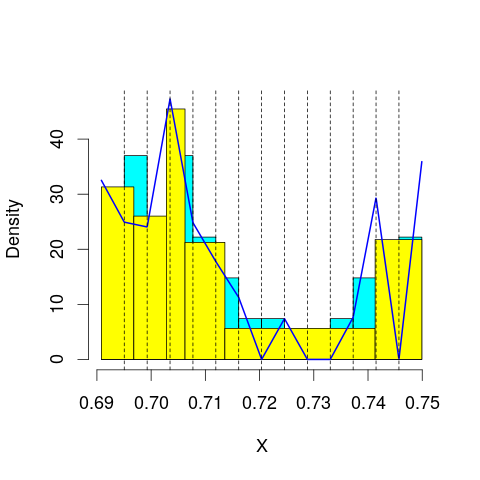

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.44672
mop.approx: Iteration 11. LL = 99.79276
mop.approx: Iteration 21. LL = 99.82903
mop.approx: Iteration 31. LL = 99.832
mop.approx: Converged. Iteration 31. LL = 99.83208
[1] "Computing the linear combination of B-splines"


72.1061922357
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 88.92724
mop.approx: Iteration 11. LL = 100.0191
mop.approx: Iteration 21. LL = 100.0916
mop.approx: Iteration 31. LL = 100.0977
mop.approx: Converged. Iteration 34. LL = 100.0982
[1] "Computing the linear combination of B-splines"


70.6394641701
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.91145
mop.approx: Iteration 11. LL = 87.93771
mop.approx: Iteration 21. LL = 87.96574
mop.approx: Converged. Iteration 27. LL = 87.96702
[1] "Computing the linear combination of B-splines"


56.7754015811
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.60554
mop.approx: Iteration 11. LL = 87.49086
mop.approx: Iteration 21. LL = 87.58243
mop.approx: Iteration 31. LL = 87.61303
mop.approx: Iteration 41. LL = 87.62626
mop.approx: Iteration 51. LL = 87.6331
mop.approx: Iteration 61. LL = 87.6371
mop.approx: Iteration 71. LL = 87.63963
mop.approx: Iteration 81. LL = 87.64134
mop.approx: Iteration 91. LL = 87.64255
mop.approx: Converged. Iteration 96. LL = 87.6431
[1] "Computing the linear combination of B-splines"


54.7184129371
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.34006
mop.approx: Iteration 11. LL = 88.97175
mop.approx: Iteration 21. LL = 89.115
mop.approx: Iteration 31. LL = 89.14706
mop.approx: Iteration 41. LL = 89.15688
mop.approx: Iteration 51. LL = 89.16046
mop.approx: Converged. Iteration 60. LL = 89.16184
[1] "Computing the linear combination of B-splines"


54.4798221535
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.81981
[1] "Computing the linear combination of B-splines"


54.9270017434
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.859762
[1] "Computing the linear combination of B-splines"


-52.2000766181
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.97477
mop.approx: Iteration 11. LL = 102.0527
mop.approx: Iteration 21. LL = 102.065
mop.approx: Converged. Iteration 21. LL = 102.0651
[1] "Computing the linear combination of B-splines"


74.3392330297
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 74.339233029714691)
m reached
('Sum of Probabilities:', 0.964102724672519)
chosen


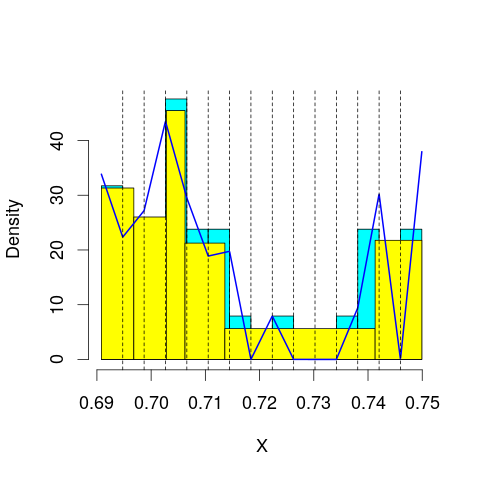

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.44672
mop.approx: Iteration 11. LL = 100.5817
mop.approx: Iteration 21. LL = 100.7
mop.approx: Iteration 31. LL = 100.7267
mop.approx: Iteration 41. LL = 100.7355
mop.approx: Iteration 51. LL = 100.7392
mop.approx: Iteration 61. LL = 100.741
mop.approx: Converged. Iteration 65. LL = 100.7415
[1] "Computing the linear combination of B-splines"


71.2827797339
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 88.92724
mop.approx: Iteration 11. LL = 100.1849
mop.approx: Iteration 21. LL = 100.2492
mop.approx: Converged. Iteration 30. LL = 100.2528
[1] "Computing the linear combination of B-splines"


69.0612117107
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.91145
mop.approx: Iteration 11. LL = 88.4968
mop.approx: Iteration 21. LL = 88.52471
mop.approx: Iteration 31. LL = 88.53009
mop.approx: Iteration 41. LL = 88.53181
mop.approx: Converged. Iteration 42. LL = 88.53199
[1] "Computing the linear combination of B-splines"


55.6074939652
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.60554
mop.approx: Iteration 11. LL = 88.04991
mop.approx: Iteration 21. LL = 88.08999
mop.approx: Iteration 31. LL = 88.09333
mop.approx: Converged. Iteration 33. LL = 88.09362
[1] "Computing the linear combination of B-splines"


53.4360569045
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.34006
mop.approx: Iteration 11. LL = 88.56552
mop.approx: Iteration 21. LL = 88.65697
mop.approx: Iteration 31. LL = 88.69255
mop.approx: Iteration 41. LL = 88.71012
mop.approx: Iteration 51. LL = 88.71968
mop.approx: Iteration 61. LL = 88.72514
mop.approx: Iteration 71. LL = 88.72835
mop.approx: Iteration 81. LL = 88.73025
mop.approx: Iteration 91. LL = 88.73139
mop.approx: Converged. Iteration 91. LL = 88.73147
[1] "Computing the linear combination of B-splines"


52.3412931782
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.81981
[1] "Computing the linear combination of B-splines"


53.9796425536
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.859762
[1] "Computing the linear combination of B-splines"


101.501421161
('best: ', 74.339233029714691, 'accepted difference:', 126.37669615051497, 'cur BIC:', 101.50142116063986)
m reached
('Sum of Probabilities:', 248.80124678924014)
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.97477
mop.approx: Iteration 11. LL = 102.2278
mop.approx: Iteration 21. LL = 102.2361
mop.approx: Iteration 31. LL = 102.24
mop.approx: Iteration 41. LL = 102.242
mop.approx: Converged. Iteration 45. LL = 102.2426
[1] "Computing the linear combination of B-splines"


72.78379585
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 72.783795849962246)
m reached
('Sum of Probabilities:', 0.9629633876361167)
chosen


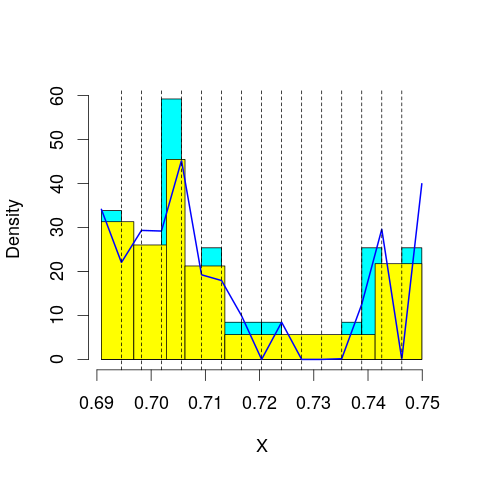

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.44672
mop.approx: Iteration 11. LL = 100.7479
mop.approx: Iteration 21. LL = 100.8163
mop.approx: Iteration 31. LL = 100.8297
mop.approx: Iteration 41. LL = 100.8336
mop.approx: Converged. Iteration 47. LL = 100.8346
[1] "Computing the linear combination of B-splines"


69.6429872291
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 88.92724
mop.approx: Iteration 11. LL = 100.5692
mop.approx: Iteration 21. LL = 100.6473
mop.approx: Iteration 31. LL = 100.6618
mop.approx: Iteration 41. LL = 100.6665
mop.approx: Iteration 51. LL = 100.6682
mop.approx: Converged. Iteration 51. LL = 100.6683
[1] "Computing the linear combination of B-splines"


67.74379149
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.91145
mop.approx: Iteration 11. LL = 88.6722
mop.approx: Iteration 21. LL = 88.708
mop.approx: Iteration 31. LL = 88.71705
mop.approx: Iteration 41. LL = 88.71992
mop.approx: Converged. Iteration 46. LL = 88.72059
[1] "Computing the linear combination of B-splines"


54.0632226204
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.60554
mop.approx: Iteration 11. LL = 88.72287
mop.approx: Iteration 21. LL = 88.76933
mop.approx: Iteration 31. LL = 88.78603
mop.approx: Iteration 41. LL = 88.79502
mop.approx: Iteration 51. LL = 88.80034
mop.approx: Iteration 61. LL = 88.80366
mop.approx: Iteration 71. LL = 88.8058
mop.approx: Iteration 81. LL = 88.80722
mop.approx: Converged. Iteration 88. LL = 88.80802
[1] "Computing the linear combination of B-splines"


52.4178387561
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.34006
mop.approx: Iteration 11. LL = 89.33972
mop.approx: Iteration 21. LL = 89.38292
mop.approx: Iteration 31. LL = 89.3887
mop.approx: Iteration 41. LL = 89.39099
mop.approx: Iteration 51. LL = 89.39236
mop.approx: Converged. Iteration 56. LL = 89.39295
[1] "Computing the linear combination of B-splines"


51.1924137951
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.81981
[1] "Computing the linear combination of B-splines"


94.7109693382
('best: ', 72.783795849962246, 'accepted difference:', 123.73245294493582, 'cur BIC:', 94.710969338165143)
m reached
('Sum of Probabilities:', 4.6775644315831135)
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.859762
[1] "Computing the linear combination of B-splines"


-151.542701876
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.97477
mop.approx: Iteration 11. LL = 102.491
mop.approx: Iteration 21. LL = 102.5942
mop.approx: Iteration 31. LL = 102.6231
mop.approx: Iteration 41. LL = 102.6334
mop.approx: Iteration 51. LL = 102.6375
mop.approx: Iteration 61. LL = 102.6393
mop.approx: Converged. Iteration 62. LL = 102.6395
[1] "Computing the linear combination of B-splines"


71.447837456
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 71.44783745595025)
m reached
('Sum of Probabilities:', 0.9618386284175029)
chosen


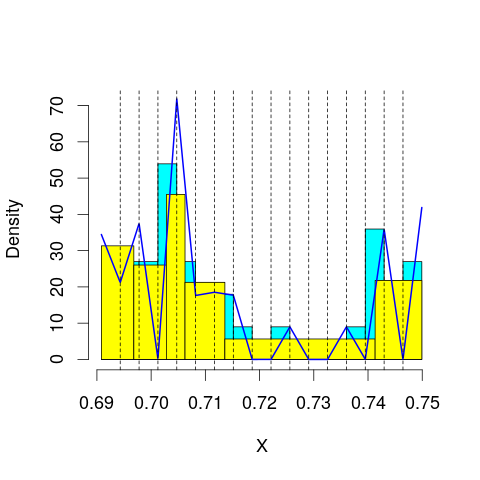

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.44672
mop.approx: Iteration 11. LL = 101.17
mop.approx: Iteration 21. LL = 101.1772
mop.approx: Converged. Iteration 22. LL = 101.1774
[1] "Computing the linear combination of B-splines"


68.2529059317
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 88.92724
mop.approx: Iteration 11. LL = 100.8367
mop.approx: Iteration 21. LL = 101.0195
mop.approx: Iteration 31. LL = 101.0738
mop.approx: Iteration 41. LL = 101.0952
mop.approx: Iteration 51. LL = 101.1045
mop.approx: Iteration 61. LL = 101.1087
mop.approx: Iteration 71. LL = 101.1107
mop.approx: Converged. Iteration 75. LL = 101.1113
[1] "Computing the linear combination of B-splines"


66.4539521796
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.91145
mop.approx: Iteration 11. LL = 89.0324
mop.approx: Iteration 21. LL = 89.07031
mop.approx: Iteration 31. LL = 89.08549
mop.approx: Iteration 41. LL = 89.09275
mop.approx: Iteration 51. LL = 89.09664
mop.approx: Iteration 61. LL = 89.09892
mop.approx: Iteration 71. LL = 89.10035
mop.approx: Converged. Iteration 78. LL = 89.10114
[1] "Computing the linear combination of B-splines"


52.7109083894
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.60554
mop.approx: Iteration 11. LL = 89.10941
mop.approx: Iteration 21. LL = 89.12479
mop.approx: Iteration 31. LL = 89.12869
mop.approx: Iteration 41. LL = 89.13085
mop.approx: Iteration 51. LL = 89.13226
mop.approx: Iteration 61. LL = 89.1333
mop.approx: Converged. Iteration 62. LL = 89.13348
[1] "Computing the linear combination of B-splines"


51.0103363647
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.34006
mop.approx: Iteration 11. LL = 89.40538
mop.approx: Iteration 21. LL = 89.45874
mop.approx: Iteration 31. LL = 89.47257
mop.approx: Iteration 41. LL = 89.47824
mop.approx: Iteration 51. LL = 89.48091
mop.approx: Iteration 61. LL = 89.48227
mop.approx: Converged. Iteration 63. LL = 89.48254
[1] "Computing the linear combination of B-splines"


49.646740301
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.81981
[1] "Computing the linear combination of B-splines"


1.07490743109
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.859762
[1] "Computing the linear combination of B-splines"


-56.3574456731
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.97477
mop.approx: Iteration 11. LL = 103.4302
mop.approx: Iteration 21. LL = 103.4699
mop.approx: Converged. Iteration 26. LL = 103.4713
[1] "Computing the linear combination of B-splines"


70.546767449
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 70.546767449016556)
m reached
('Sum of Probabilities:', 0.9599082088664)
chosen


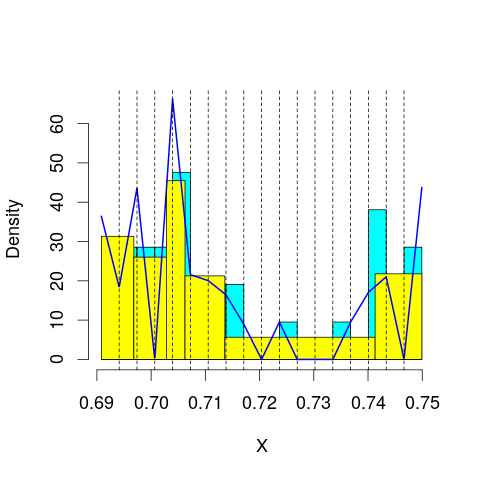

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.44672
mop.approx: Iteration 11. LL = 101.0915
mop.approx: Iteration 21. LL = 101.1109
mop.approx: Iteration 31. LL = 101.1157
mop.approx: Iteration 41. LL = 101.1178
mop.approx: Converged. Iteration 44. LL = 101.1182
[1] "Computing the linear combination of B-splines"


66.460836225
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 88.92724
mop.approx: Iteration 11. LL = 101.5578
mop.approx: Iteration 21. LL = 101.764
mop.approx: Iteration 31. LL = 101.8076
mop.approx: Iteration 41. LL = 101.819
mop.approx: Iteration 51. LL = 101.8229
mop.approx: Iteration 61. LL = 101.8247
mop.approx: Converged. Iteration 64. LL = 101.8251
[1] "Computing the linear combination of B-splines"


65.4349060894
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.91145
mop.approx: Iteration 11. LL = 89.20329
mop.approx: Iteration 21. LL = 89.28616
mop.approx: Iteration 31. LL = 89.31237
mop.approx: Iteration 41. LL = 89.32284
mop.approx: Iteration 51. LL = 89.32781
mop.approx: Iteration 61. LL = 89.33051
mop.approx: Iteration 71. LL = 89.33211
mop.approx: Converged. Iteration 79. LL = 89.33306
[1] "Computing the linear combination of B-splines"


51.2099389447
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.60554
mop.approx: Iteration 11. LL = 89.70015
mop.approx: Iteration 21. LL = 89.74282
mop.approx: Iteration 31. LL = 89.75364
mop.approx: Iteration 41. LL = 89.75813
mop.approx: Iteration 51. LL = 89.76011
mop.approx: Converged. Iteration 56. LL = 89.76073
[1] "Computing the linear combination of B-splines"


49.9050650638
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.34006
mop.approx: Iteration 11. LL = 90.24328
mop.approx: Iteration 21. LL = 90.33381
mop.approx: Iteration 31. LL = 90.36141
mop.approx: Iteration 41. LL = 90.37089
mop.approx: Iteration 51. LL = 90.37413
mop.approx: Converged. Iteration 57. LL = 90.37502
[1] "Computing the linear combination of B-splines"


48.517858507
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.81981
[1] "Computing the linear combination of B-splines"


78.921855305
('best: ', 70.546767449016556, 'accepted difference:', 119.92950466332815, 'cur BIC:', 78.921855305037425)
m reached
('Sum of Probabilities:', 9.57446805117526)
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.859762
[1] "Computing the linear combination of B-splines"


112.090403468
('best: ', 70.546767449016556, 'accepted difference:', 119.92950466332815, 'cur BIC:', 112.09040346772497)
m reached
('Sum of Probabilities:', 715.8858827763539)
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.97477
mop.approx: Iteration 11. LL = 103.3638
mop.approx: Iteration 21. LL = 103.4377
mop.approx: Iteration 31. LL = 103.4481
mop.approx: Iteration 41. LL = 103.4504
mop.approx: Converged. Iteration 42. LL = 103.4506
[1] "Computing the linear combination of B-splines"


68.7932750519
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 68.793275051890021)
m reached
('Sum of Probabilities:', 0.9578097939494022)
chosen


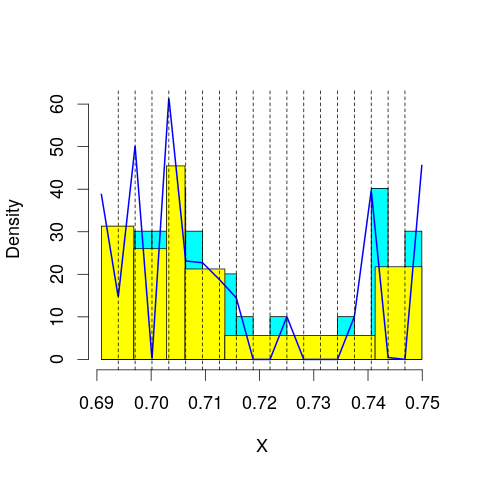

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.44672
mop.approx: Iteration 11. LL = 102.0824
mop.approx: Iteration 21. LL = 102.1401
mop.approx: Iteration 31. LL = 102.1474
mop.approx: Converged. Iteration 40. LL = 102.1491
[1] "Computing the linear combination of B-splines"


65.7589034534
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 88.92724
mop.approx: Iteration 11. LL = 101.8831
mop.approx: Iteration 21. LL = 102.0866
mop.approx: Iteration 31. LL = 102.1246
mop.approx: Iteration 41. LL = 102.1333
mop.approx: Iteration 51. LL = 102.136
mop.approx: Converged. Iteration 57. LL = 102.1368
[1] "Computing the linear combination of B-splines"


64.0137117365
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.91145
mop.approx: Iteration 11. LL = 89.89866
mop.approx: Iteration 21. LL = 90.04488
mop.approx: Iteration 31. LL = 90.08691
mop.approx: Iteration 41. LL = 90.10185
mop.approx: Iteration 51. LL = 90.10765
mop.approx: Iteration 61. LL = 90.11009
mop.approx: Converged. Iteration 70. LL = 90.11125
[1] "Computing the linear combination of B-splines"


50.2552849161
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.60554
mop.approx: Iteration 11. LL = 89.77317
mop.approx: Iteration 21. LL = 89.80317
mop.approx: Iteration 31. LL = 89.80894
mop.approx: Iteration 41. LL = 89.81088
mop.approx: Converged. Iteration 46. LL = 89.8115
[1] "Computing the linear combination of B-splines"


48.2186083566
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.34006
mop.approx: Iteration 11. LL = 90.39293
mop.approx: Iteration 21. LL = 90.43203
mop.approx: Iteration 31. LL = 90.43951
mop.approx: Iteration 41. LL = 90.44335
mop.approx: Iteration 51. LL = 90.44567
mop.approx: Iteration 61. LL = 90.4471
mop.approx: Converged. Iteration 66. LL = 90.44769
[1] "Computing the linear combination of B-splines"


46.8217049959
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.81981
[1] "Computing the linear combination of B-splines"


-34.9268968979
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.859762
[1] "Computing the linear combination of B-splines"


21.7737052149
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.97477
mop.approx: Iteration 11. LL = 103.4868
mop.approx: Iteration 21. LL = 103.508
mop.approx: Iteration 31. LL = 103.5151
mop.approx: Iteration 41. LL = 103.5185
mop.approx: Iteration 51. LL = 103.5201
mop.approx: Converged. Iteration 51. LL = 103.5202
[1] "Computing the linear combination of B-splines"


67.1299239596
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 67.129923959644572)
m reached
('Sum of Probabilities:', 0.9577648753783345)
chosen


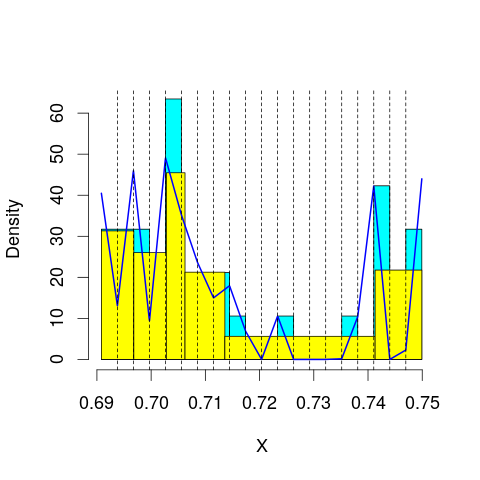

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 89.44672
mop.approx: Iteration 11. LL = 102.9941
mop.approx: Iteration 21. LL = 103.0716
mop.approx: Converged. Iteration 29. LL = 103.0753
[1] "Computing the linear combination of B-splines"


64.9521931907
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 88.92724
mop.approx: Iteration 11. LL = 102.1012
mop.approx: Iteration 21. LL = 102.244
mop.approx: Iteration 31. LL = 102.2856
mop.approx: Iteration 41. LL = 102.3029
mop.approx: Iteration 51. LL = 102.3109
mop.approx: Iteration 61. LL = 102.3148
mop.approx: Iteration 71. LL = 102.3168
mop.approx: Converged. Iteration 76. LL = 102.3175
[1] "Computing the linear combination of B-splines"


62.4615308515
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.91145
mop.approx: Iteration 11. LL = 90.43312
mop.approx: Iteration 21. LL = 90.57116
mop.approx: Iteration 31. LL = 90.59713
mop.approx: Iteration 41. LL = 90.6068
mop.approx: Iteration 51. LL = 90.61202
mop.approx: Iteration 61. LL = 90.61526
mop.approx: Iteration 71. LL = 90.61739
mop.approx: Iteration 81. LL = 90.61884
mop.approx: Converged. Iteration 89. LL = 90.61976
[1] "Computing the linear combination of B-splines"


49.0309386573
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.60554
mop.approx: Iteration 11. LL = 90.1351
mop.approx: Iteration 21. LL = 90.18952
mop.approx: Iteration 31. LL = 90.20149
mop.approx: Iteration 41. LL = 90.20578
mop.approx: Iteration 51. LL = 90.20807
mop.approx: Iteration 61. LL = 90.20952
mop.approx: Converged. Iteration 68. LL = 90.21032
[1] "Computing the linear combination of B-splines"


46.8859343735
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.34006
mop.approx: Iteration 11. LL = 92.09045
mop.approx: Iteration 21. LL = 92.11682
mop.approx: Iteration 31. LL = 92.1202
mop.approx: Iteration 41. LL = 92.12221
mop.approx: Iteration 51. LL = 92.12366
mop.approx: Iteration 61. LL = 92.12476
mop.approx: Converged. Iteration 62. LL = 92.12494
[1] "Computing the linear combination of B-splines"


46.9673513031
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.81981
[1] "Computing the linear combination of B-splines"


35.2326299386
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.859762
[1] "Computing the linear combination of B-splines"


111.585368826
('best: ', 67.129923959644572, 'accepted difference:', 114.12087073139577, 'cur BIC:', 111.58536882567377)
m reached
('Sum of Probabilities:', 2863.651090247442)
lfps_29
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.51081
mop.approx: Converged. Iteration 8. LL = 86.67989
[1] "Computing the linear combination of B-splines"


81.4812880378
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 81.481288037798777)
m reached
('Sum of Probabilities:', 0.991584970678463)
chosen


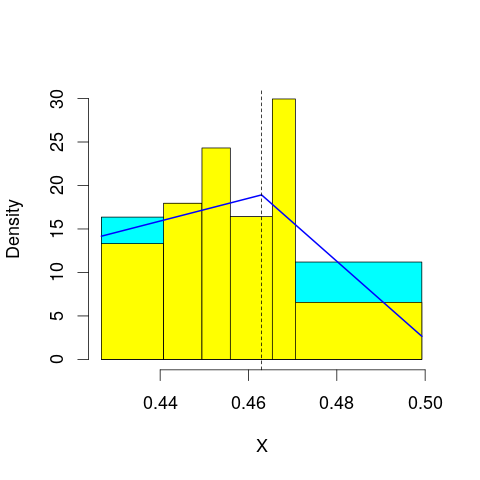

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.0787
mop.approx: Iteration 11. LL = 86.22192
mop.approx: Iteration 21. LL = 86.24063
mop.approx: Converged. Iteration 25. LL = 86.24128
[1] "Computing the linear combination of B-splines"


79.3098114761
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 82.65234
mop.approx: Iteration 11. LL = 87.38092
mop.approx: Iteration 21. LL = 87.71406
mop.approx: Iteration 31. LL = 87.75691
mop.approx: Iteration 41. LL = 87.76582
mop.approx: Iteration 51. LL = 87.76862
mop.approx: Converged. Iteration 57. LL = 87.76944
[1] "Computing the linear combination of B-splines"


79.105099241
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.98719
mop.approx: Iteration 11. LL = 60.31242
mop.approx: Iteration 21. LL = 60.52183
mop.approx: Iteration 31. LL = 60.57306
mop.approx: Iteration 41. LL = 60.59222
mop.approx: Iteration 51. LL = 60.60134
mop.approx: Iteration 61. LL = 60.60639
mop.approx: Iteration 71. LL = 60.60948
mop.approx: Iteration 81. LL = 60.61152
mop.approx: Iteration 91. LL = 60.61293
mop.approx: Iteration 101. LL = 60.61396
mop.approx: Iteration 111. LL = 60.61473
mop.approx: Converged. Iteration 115. LL = 60.61505
[1] "Computing the linear combination of B-splines"


50.2178394464
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.84465
mop.approx: Iteration 11. LL = 63.57933
mop.approx: Converged. Iteration 16. LL = 63.58344
[1] "Computing the linear combination of B-splines"


51.4533595521
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.69345
mop.approx: Iteration 11. LL = 54.2361
mop.approx: Iteration 21. LL = 54.58884
mop.approx: Iteration 31. LL = 54.71734
mop.approx: Iteration 41. LL = 54.77205
mop.approx: Iteration 51. LL = 54.79765
mop.approx: Iteration 61. LL = 54.81026
mop.approx: Iteration 71. LL = 54.81663
mop.approx: Iteration 81. LL = 54.8199
mop.approx: Iteration 91. LL = 54.82159
mop.approx: Iteration 101. LL = 54.82247
mop.approx: Converged. Iteration 103. LL = 54.82264
[1] "Computing the linear combination of B-splines"


40.9596962247
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.257639
mop.approx: Iteration 11. LL = 57.01424
mop.approx: Converged. Iteration 20. LL = 57.03938
[1] "Computing the linear combination of B-splines"


41.4435649106
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.362523
mop.approx: Iteration 11. LL = 49.77012
mop.approx: Iteration 21. LL = 50.11127
mop.approx: Iteration 31. LL = 50.26972
mop.approx: Iteration 41. LL = 50.34589
mop.approx: Iteration 51. LL = 50.38381
mop.approx: Iteration 61. LL = 50.40313
mop.approx: Iteration 71. LL = 50.4131
mop.approx: Iteration 81. LL = 50.41828
mop.approx: Iteration 91. LL = 50.42098
mop.approx: Iteration 101. LL = 50.4224
mop.approx: Iteration 111. LL = 50.42314
mop.approx: Converged. Iteration 112. LL = 50.42324
[1] "Computing the linear combination of B-splines"


33.0945561525
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.51081
mop.approx: Converged. Iteration 8. LL = 86.90233
[1] "Computing the linear combination of B-splines"


79.9708624438
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 79.970862443754285)
m reached
('Sum of Probabilities:', 0.9924342399123826)
chosen


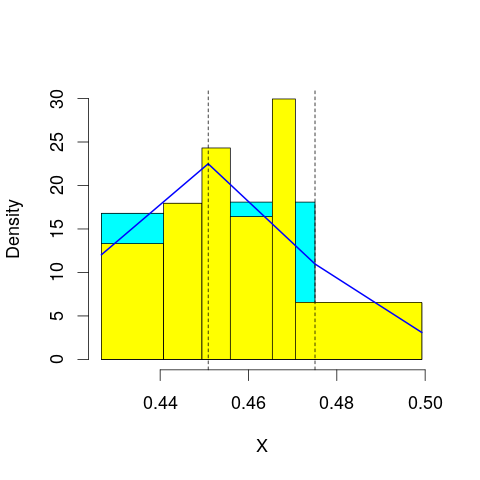

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.0787
mop.approx: Iteration 11. LL = 88.3339
mop.approx: Iteration 21. LL = 88.43373
mop.approx: Converged. Iteration 30. LL = 88.43793
[1] "Computing the linear combination of B-splines"


79.7735907317
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 82.65234
mop.approx: Iteration 11. LL = 88.91414
mop.approx: Iteration 21. LL = 89.06992
mop.approx: Iteration 31. LL = 89.0826
mop.approx: Converged. Iteration 36. LL = 89.0835
[1] "Computing the linear combination of B-splines"


78.6862942239
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.98719
mop.approx: Iteration 11. LL = 76.96412
mop.approx: Converged. Iteration 16. LL = 76.96945
[1] "Computing the linear combination of B-splines"


64.8393743087
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.84465
mop.approx: Iteration 11. LL = 65.38388
mop.approx: Iteration 21. LL = 65.51996
mop.approx: Iteration 31. LL = 65.54365
mop.approx: Iteration 41. LL = 65.55006
mop.approx: Iteration 51. LL = 65.55223
mop.approx: Converged. Iteration 58. LL = 65.55294
[1] "Computing the linear combination of B-splines"


51.6899992147
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.69345
mop.approx: Iteration 11. LL = 67.47271
mop.approx: Converged. Iteration 17. LL = 67.48156
[1] "Computing the linear combination of B-splines"


51.8857438719
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.257639
mop.approx: Iteration 11. LL = 58.28991
mop.approx: Iteration 21. LL = 58.62275
mop.approx: Iteration 31. LL = 58.73342
mop.approx: Iteration 41. LL = 58.77947
mop.approx: Iteration 51. LL = 58.80122
mop.approx: Iteration 61. LL = 58.81224
mop.approx: Iteration 71. LL = 58.81804
mop.approx: Iteration 81. LL = 58.82115
mop.approx: Iteration 91. LL = 58.82284
mop.approx: Iteration 101. LL = 58.82376
mop.approx: Converged. Iteration 103. LL = 58.82395
[1] "Computing the linear combination of B-splines"


41.4952695004
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.362523
mop.approx: Iteration 11. LL = 60.32545
mop.approx: Converged. Iteration 20. LL = 60.35872
[1] "Computing the linear combination of B-splines"


41.2971768161
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.51081
mop.approx: Converged. Iteration 10. LL = 87.34863
[1] "Computing the linear combination of B-splines"


78.6842930319
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 78.684293031869359)
m reached
('Sum of Probabilities:', 0.9910671033109405)
chosen


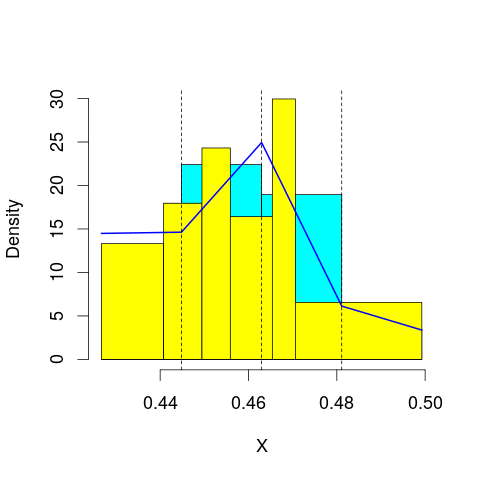

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.0787
mop.approx: Iteration 11. LL = 89.77931
mop.approx: Iteration 21. LL = 89.86139
mop.approx: Iteration 31. LL = 89.87131
mop.approx: Converged. Iteration 38. LL = 89.87268
[1] "Computing the linear combination of B-splines"


79.4754690911
('best: ', 78.684293031869359, 'accepted difference:', 133.7632981541779, 'cur BIC:', 79.475469091052616)
m reached
('Sum of Probabilities:', 0.9748581732072432)
chosen


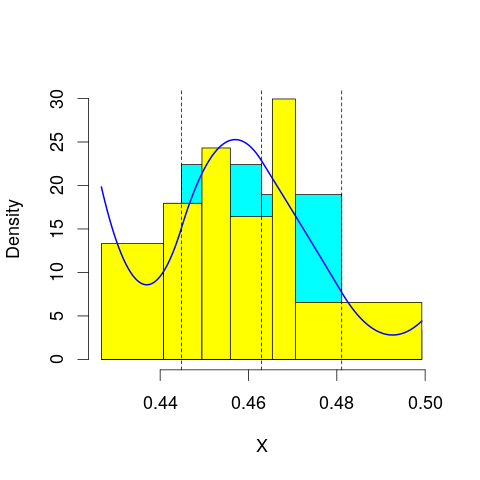

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 82.65234
mop.approx: Iteration 11. LL = 89.65604
mop.approx: Iteration 21. LL = 89.7197
mop.approx: Iteration 31. LL = 89.72587
mop.approx: Converged. Iteration 37. LL = 89.7268
[1] "Computing the linear combination of B-splines"


77.5967289963
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.98719
mop.approx: Iteration 11. LL = 78.75394
mop.approx: Converged. Iteration 11. LL = 78.75397
[1] "Computing the linear combination of B-splines"


64.8910241923
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.84465
mop.approx: Iteration 11. LL = 79.39628
mop.approx: Iteration 21. LL = 79.43067
mop.approx: Converged. Iteration 22. LL = 79.43081
[1] "Computing the linear combination of B-splines"


63.8350022206
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.69345
mop.approx: Iteration 11. LL = 69.35474
mop.approx: Iteration 21. LL = 69.43805
mop.approx: Iteration 31. LL = 69.44698
mop.approx: Converged. Iteration 39. LL = 69.4483
[1] "Computing the linear combination of B-splines"


52.1196197405
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.257639
mop.approx: Iteration 11. LL = 70.59313
mop.approx: Converged. Iteration 19. LL = 70.61157
[1] "Computing the linear combination of B-splines"


51.5500188997
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.362523
mop.approx: Iteration 11. LL = 61.75487
mop.approx: Iteration 21. LL = 62.05959
mop.approx: Iteration 31. LL = 62.15338
mop.approx: Iteration 41. LL = 62.19195
mop.approx: Iteration 51. LL = 62.2106
mop.approx: Iteration 61. LL = 62.22048
mop.approx: Iteration 71. LL = 62.226
mop.approx: Iteration 81. LL = 62.22917
mop.approx: Iteration 91. LL = 62.23103
mop.approx: Iteration 101. LL = 62.23214
mop.approx: Converged. Iteration 107. LL = 62.23263
[1] "Computing the linear combination of B-splines"


41.4382162071
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.51081
mop.approx: Iteration 11. LL = 89.53629
mop.approx: Iteration 21. LL = 89.55677
mop.approx: Iteration 31. LL = 89.56145
mop.approx: Iteration 41. LL = 89.5632
mop.approx: Converged. Iteration 44. LL = 89.56359
[1] "Computing the linear combination of B-splines"


79.1663780387
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 79.166378038737221)
m reached
('Sum of Probabilities:', 0.9887055242931758)
chosen


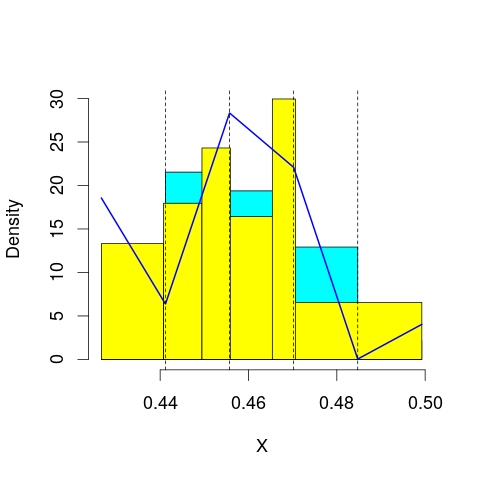

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.0787
mop.approx: Iteration 11. LL = 90.31351
mop.approx: Iteration 21. LL = 90.33726
mop.approx: Converged. Iteration 24. LL = 90.33776
[1] "Computing the linear combination of B-splines"


78.2076846208
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 82.65234
mop.approx: Iteration 11. LL = 90.25678
mop.approx: Iteration 21. LL = 90.30963
mop.approx: Iteration 31. LL = 90.31993
mop.approx: Iteration 41. LL = 90.32309
mop.approx: Converged. Iteration 47. LL = 90.32394
[1] "Computing the linear combination of B-splines"


76.4609965927
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.98719
mop.approx: Iteration 11. LL = 82.12993
mop.approx: Converged. Iteration 12. LL = 82.13014
[1] "Computing the linear combination of B-splines"


66.5343251666
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.84465
mop.approx: Iteration 11. LL = 81.23234
mop.approx: Converged. Iteration 13. LL = 81.23283
[1] "Computing the linear combination of B-splines"


63.9041474387
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.69345
mop.approx: Iteration 11. LL = 80.84322
mop.approx: Iteration 21. LL = 80.94967
mop.approx: Iteration 31. LL = 80.95574
mop.approx: Converged. Iteration 32. LL = 80.95591
[1] "Computing the linear combination of B-splines"


61.894359983
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.257639
mop.approx: Iteration 11. LL = 72.52836
mop.approx: Iteration 21. LL = 72.57763
mop.approx: Converged. Iteration 30. LL = 72.58056
[1] "Computing the linear combination of B-splines"


51.7861466756
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.362523
mop.approx: Iteration 11. LL = 73.11798
mop.approx: Iteration 21. LL = 73.15414
mop.approx: Converged. Iteration 21. LL = 73.15419
[1] "Computing the linear combination of B-splines"


50.6269023094
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.51081
mop.approx: Iteration 11. LL = 90.9096
mop.approx: Converged. Iteration 13. LL = 90.91006
[1] "Computing the linear combination of B-splines"


78.7799882654
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 78.779988265354916)
m reached
('Sum of Probabilities:', 0.9874739937023473)
chosen


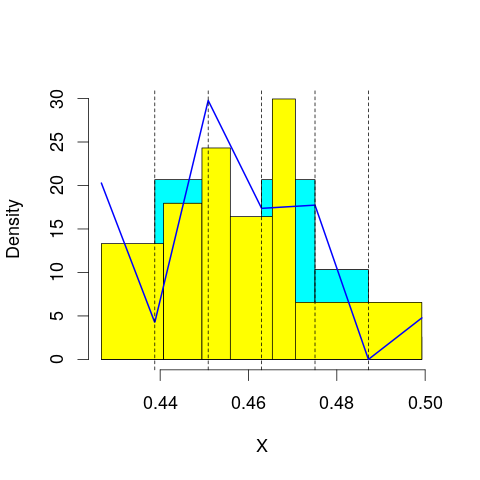

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.0787
mop.approx: Iteration 11. LL = 90.66128
mop.approx: Converged. Iteration 19. LL = 90.66961
[1] "Computing the linear combination of B-splines"


76.8066684847
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 82.65234
mop.approx: Iteration 11. LL = 91.1734
mop.approx: Iteration 21. LL = 91.23576
mop.approx: Iteration 31. LL = 91.2421
mop.approx: Converged. Iteration 40. LL = 91.24365
[1] "Computing the linear combination of B-splines"


75.6478345354
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.98719
mop.approx: Converged. Iteration 10. LL = 82.51515
[1] "Computing the linear combination of B-splines"


65.1864749189
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.84465
mop.approx: Iteration 11. LL = 82.674
mop.approx: Converged. Iteration 13. LL = 82.67469
[1] "Computing the linear combination of B-splines"


63.6131409786
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.69345
mop.approx: Iteration 11. LL = 82.76959
mop.approx: Converged. Iteration 16. LL = 82.77545
[1] "Computing the linear combination of B-splines"


61.9810378597
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.257639
mop.approx: Iteration 11. LL = 81.64759
mop.approx: Iteration 21. LL = 81.76609
mop.approx: Iteration 31. LL = 81.78996
mop.approx: Iteration 41. LL = 81.79796
mop.approx: Iteration 51. LL = 81.80114
mop.approx: Iteration 61. LL = 81.8025
mop.approx: Converged. Iteration 62. LL = 81.80266
[1] "Computing the linear combination of B-splines"


59.2753464203
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.362523
mop.approx: Iteration 11. LL = 75.09451
mop.approx: Iteration 21. LL = 75.12339
mop.approx: Converged. Iteration 25. LL = 75.12415
[1] "Computing the linear combination of B-splines"


50.8640026309
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.51081
mop.approx: Converged. Iteration 10. LL = 91.47023
[1] "Computing the linear combination of B-splines"


77.6072894549
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 77.60728945491654)
m reached
('Sum of Probabilities:', 0.9864046180327641)
chosen


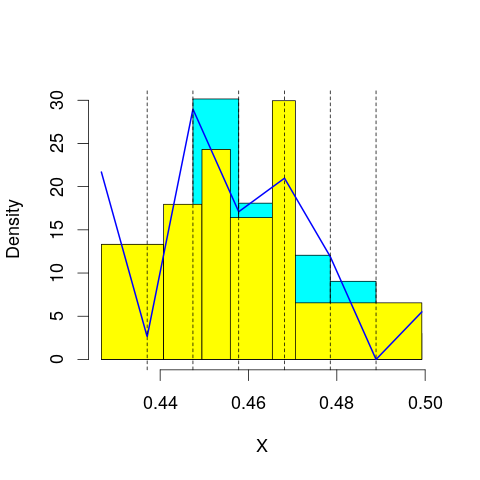

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.0787
mop.approx: Iteration 11. LL = 91.8111
mop.approx: Iteration 21. LL = 91.88571
mop.approx: Iteration 31. LL = 91.89642
mop.approx: Iteration 41. LL = 91.89853
mop.approx: Converged. Iteration 41. LL = 91.89861
[1] "Computing the linear combination of B-splines"


76.3027994982
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 82.65234
mop.approx: Iteration 11. LL = 91.5982
mop.approx: Iteration 21. LL = 91.66991
mop.approx: Iteration 31. LL = 91.67456
mop.approx: Converged. Iteration 31. LL = 91.67463
[1] "Computing the linear combination of B-splines"


74.3459537481
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.98719
mop.approx: Iteration 11. LL = 83.43828
mop.approx: Iteration 21. LL = 83.47036
mop.approx: Iteration 31. LL = 83.47414
mop.approx: Converged. Iteration 33. LL = 83.47443
[1] "Computing the linear combination of B-splines"


64.4128871561
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.84465
mop.approx: Iteration 11. LL = 82.89116
mop.approx: Converged. Iteration 13. LL = 82.89148
[1] "Computing the linear combination of B-splines"


62.0970658518
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.69345
mop.approx: Iteration 11. LL = 83.22238
mop.approx: Converged. Iteration 16. LL = 83.2256
[1] "Computing the linear combination of B-splines"


60.6982948508
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.257639
mop.approx: Iteration 11. LL = 83.60032
mop.approx: Iteration 21. LL = 83.63677
mop.approx: Converged. Iteration 22. LL = 83.63693
[1] "Computing the linear combination of B-splines"


59.3764950573
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.362523
mop.approx: Iteration 11. LL = 82.17141
mop.approx: Iteration 21. LL = 82.21845
mop.approx: Iteration 31. LL = 82.22167
mop.approx: Converged. Iteration 31. LL = 82.22175
[1] "Computing the linear combination of B-splines"


56.2284940701
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.51081
mop.approx: Iteration 11. LL = 91.69512
mop.approx: Iteration 21. LL = 91.71365
mop.approx: Iteration 31. LL = 91.71638
mop.approx: Converged. Iteration 32. LL = 91.71655
[1] "Computing the linear combination of B-splines"


76.1207408565
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 76.120740856537523)
m reached
('Sum of Probabilities:', 0.9844835696816412)
chosen


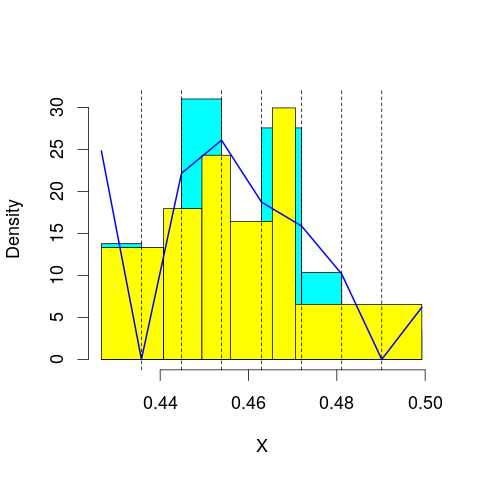

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.0787
mop.approx: Iteration 11. LL = 92.92883
mop.approx: Iteration 21. LL = 92.95003
mop.approx: Converged. Iteration 22. LL = 92.95022
[1] "Computing the linear combination of B-splines"


75.621539532
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 82.65234
mop.approx: Iteration 11. LL = 91.62557
mop.approx: Iteration 21. LL = 91.69528
mop.approx: Iteration 31. LL = 91.70291
mop.approx: Converged. Iteration 39. LL = 91.7043
[1] "Computing the linear combination of B-splines"


72.6427561538
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.98719
mop.approx: Iteration 11. LL = 83.66633
mop.approx: Iteration 21. LL = 83.70816
mop.approx: Iteration 31. LL = 83.71798
mop.approx: Iteration 41. LL = 83.72088
mop.approx: Converged. Iteration 47. LL = 83.72166
[1] "Computing the linear combination of B-splines"


62.9272417625
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.84465
mop.approx: Iteration 11. LL = 83.89483
mop.approx: Iteration 21. LL = 83.99024
mop.approx: Iteration 31. LL = 84.01548
mop.approx: Iteration 41. LL = 84.02548
mop.approx: Iteration 51. LL = 84.03042
mop.approx: Iteration 61. LL = 84.03322
mop.approx: Iteration 71. LL = 84.03496
mop.approx: Iteration 81. LL = 84.03612
mop.approx: Converged. Iteration 85. LL = 84.03656
[1] "Computing the linear combination of B-splines"


61.509275432
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.69345
mop.approx: Iteration 11. LL = 83.35749
mop.approx: Iteration 21. LL = 83.36342
mop.approx: Converged. Iteration 21. LL = 83.3635
[1] "Computing the linear combination of B-splines"


59.103290338
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.257639
mop.approx: Iteration 11. LL = 83.68889
mop.approx: Converged. Iteration 20. LL = 83.70881
[1] "Computing the linear combination of B-splines"


57.713940474
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.362523
mop.approx: Iteration 11. LL = 83.90177
mop.approx: Iteration 21. LL = 84.0136
mop.approx: Iteration 31. LL = 84.02003
mop.approx: Converged. Iteration 32. LL = 84.02021
[1] "Computing the linear combination of B-splines"


56.3037535874
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.51081
mop.approx: Iteration 11. LL = 93.50502
mop.approx: Iteration 21. LL = 93.52331
mop.approx: Iteration 31. LL = 93.52691
mop.approx: Converged. Iteration 34. LL = 93.52738
[1] "Computing the linear combination of B-splines"


76.1987043886
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 76.198704388569382)
m reached
('Sum of Probabilities:', 0.9827587095204832)
chosen


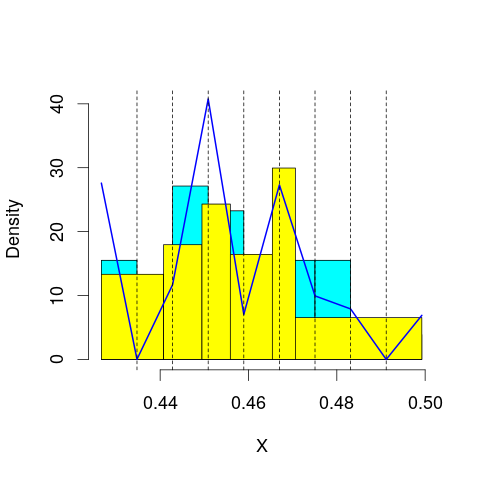

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.0787
mop.approx: Iteration 11. LL = 92.81364
mop.approx: Converged. Iteration 16. LL = 92.81663
[1] "Computing the linear combination of B-splines"


73.7550817779
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 82.65234
mop.approx: Iteration 11. LL = 92.36729
mop.approx: Iteration 21. LL = 92.47246
mop.approx: Iteration 31. LL = 92.48997
mop.approx: Iteration 41. LL = 92.49553
mop.approx: Iteration 51. LL = 92.49808
mop.approx: Iteration 61. LL = 92.49949
mop.approx: Converged. Iteration 64. LL = 92.49988
[1] "Computing the linear combination of B-splines"


71.7054613008
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.98719
mop.approx: Iteration 11. LL = 83.46762
mop.approx: Iteration 21. LL = 83.4874
mop.approx: Iteration 31. LL = 83.49465
mop.approx: Iteration 41. LL = 83.4976
mop.approx: Iteration 51. LL = 83.49886
mop.approx: Converged. Iteration 51. LL = 83.49894
[1] "Computing the linear combination of B-splines"


60.9716545059
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.84465
mop.approx: Iteration 11. LL = 84.32199
mop.approx: Iteration 21. LL = 84.40096
mop.approx: Iteration 31. LL = 84.43033
mop.approx: Iteration 41. LL = 84.44403
mop.approx: Iteration 51. LL = 84.45145
mop.approx: Iteration 61. LL = 84.4559
mop.approx: Iteration 71. LL = 84.45875
mop.approx: Iteration 81. LL = 84.46067
mop.approx: Iteration 91. LL = 84.46201
mop.approx: Converged. Iteration 100. LL = 84.46296
[1] "Computing the linear combination of B-splines"


60.2028089494
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.69345
mop.approx: Iteration 11. LL = 84.09676
mop.approx: Iteration 21. LL = 84.22922
mop.approx: Iteration 31. LL = 84.27158
mop.approx: Iteration 41. LL = 84.28959
mop.approx: Iteration 51. LL = 84.29847
mop.approx: Iteration 61. LL = 84.30322
mop.approx: Iteration 71. LL = 84.30588
mop.approx: Iteration 81. LL = 84.30741
mop.approx: Converged. Iteration 87. LL = 84.30809
[1] "Computing the linear combination of B-splines"


58.315128325
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.257639
mop.approx: Iteration 11. LL = 83.85969
mop.approx: Iteration 21. LL = 83.89219
mop.approx: Iteration 31. LL = 83.89613
mop.approx: Converged. Iteration 34. LL = 83.89656
[1] "Computing the linear combination of B-splines"


56.169447029
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.362523
mop.approx: Iteration 11. LL = 84.12281
mop.approx: Iteration 21. LL = 84.195
mop.approx: Converged. Iteration 26. LL = 84.19646
[1] "Computing the linear combination of B-splines"


54.7269931727
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.51081
mop.approx: Iteration 11. LL = 93.5431
mop.approx: Iteration 21. LL = 93.57401
mop.approx: Iteration 31. LL = 93.57705
mop.approx: Converged. Iteration 31. LL = 93.57713
[1] "Computing the linear combination of B-splines"


74.5155808902
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 74.515580890190819)
m reached
('Sum of Probabilities:', 0.9810733753204384)
chosen


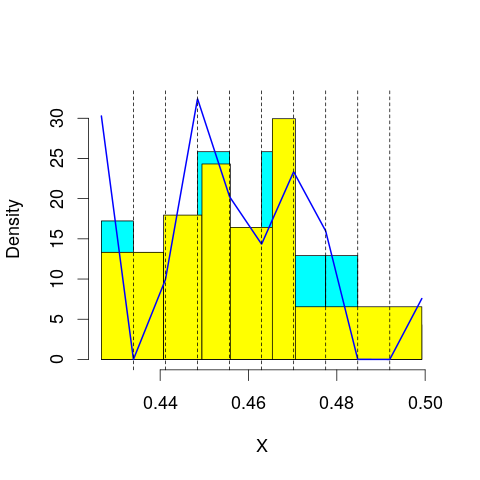

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.0787
mop.approx: Iteration 11. LL = 94.44837
mop.approx: Iteration 21. LL = 94.57513
mop.approx: Iteration 31. LL = 94.59856
mop.approx: Iteration 41. LL = 94.60389
mop.approx: Converged. Iteration 48. LL = 94.60503
[1] "Computing the linear combination of B-splines"


73.8106151301
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 82.65234
mop.approx: Iteration 11. LL = 92.21058
mop.approx: Iteration 21. LL = 92.29444
mop.approx: Iteration 31. LL = 92.30594
mop.approx: Iteration 41. LL = 92.30809
mop.approx: Converged. Iteration 41. LL = 92.30817
[1] "Computing the linear combination of B-splines"


69.7808899586
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.98719
mop.approx: Iteration 11. LL = 84.24009
mop.approx: Iteration 21. LL = 84.43781
mop.approx: Iteration 31. LL = 84.48497
mop.approx: Iteration 41. LL = 84.49653
mop.approx: Iteration 51. LL = 84.49939
mop.approx: Converged. Iteration 54. LL = 84.4998
[1] "Computing the linear combination of B-splines"


60.2396529343
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.84465
mop.approx: Iteration 11. LL = 84.22671
mop.approx: Iteration 21. LL = 84.23395
mop.approx: Converged. Iteration 25. LL = 84.23446
[1] "Computing the linear combination of B-splines"


58.2414358887
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.69345
mop.approx: Iteration 11. LL = 84.63808
mop.approx: Iteration 21. LL = 84.73185
mop.approx: Iteration 31. LL = 84.76821
mop.approx: Iteration 41. LL = 84.78461
mop.approx: Iteration 51. LL = 84.79248
mop.approx: Iteration 61. LL = 84.79638
mop.approx: Iteration 71. LL = 84.79836
mop.approx: Converged. Iteration 78. LL = 84.79922
[1] "Computing the linear combination of B-splines"


57.073329958
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.257639
mop.approx: Iteration 11. LL = 84.25841
mop.approx: Iteration 21. LL = 84.38201
mop.approx: Iteration 31. LL = 84.42739
mop.approx: Iteration 41. LL = 84.44766
mop.approx: Iteration 51. LL = 84.45754
mop.approx: Iteration 61. LL = 84.46259
mop.approx: Iteration 71. LL = 84.46525
mop.approx: Iteration 81. LL = 84.46667
mop.approx: Converged. Iteration 84. LL = 84.46703
[1] "Computing the linear combination of B-splines"


55.0111137836
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.362523
mop.approx: Iteration 11. LL = 84.70582
mop.approx: Iteration 21. LL = 84.82791
mop.approx: Iteration 31. LL = 84.85175
mop.approx: Iteration 41. LL = 84.86073
mop.approx: Iteration 51. LL = 84.8649
mop.approx: Iteration 61. LL = 84.86708
mop.approx: Iteration 71. LL = 84.86833
mop.approx: Converged. Iteration 73. LL = 84.8686
[1] "Computing the linear combination of B-splines"


53.5687046601
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.51081
mop.approx: Iteration 11. LL = 96.07464
mop.approx: Iteration 21. LL = 96.1519
mop.approx: Iteration 31. LL = 96.16389
mop.approx: Iteration 41. LL = 96.16683
mop.approx: Converged. Iteration 47. LL = 96.16766
[1] "Computing the linear combination of B-splines"


75.3732429491
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 75.373242949123622)
m reached
('Sum of Probabilities:', 0.9794298792417342)
chosen


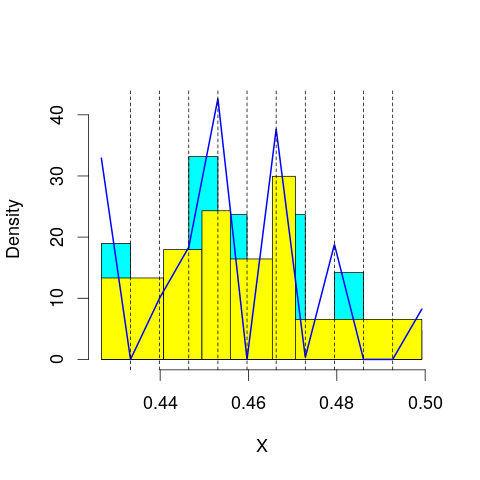

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.0787
mop.approx: Iteration 11. LL = 93.98447
mop.approx: Iteration 21. LL = 94.012
mop.approx: Iteration 31. LL = 94.01605
mop.approx: Converged. Iteration 35. LL = 94.01663
[1] "Computing the linear combination of B-splines"


71.4893416616
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 82.65234
mop.approx: Iteration 11. LL = 93.37678
mop.approx: Iteration 21. LL = 93.59978
mop.approx: Iteration 31. LL = 93.63766
mop.approx: Iteration 41. LL = 93.64806
mop.approx: Iteration 51. LL = 93.65256
mop.approx: Iteration 61. LL = 93.65503
mop.approx: Iteration 71. LL = 93.65655
mop.approx: Converged. Iteration 77. LL = 93.65728
[1] "Computing the linear combination of B-splines"


69.3971305633
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.98719
mop.approx: Iteration 11. LL = 84.21291
mop.approx: Iteration 21. LL = 84.24862
mop.approx: Iteration 31. LL = 84.2532
mop.approx: Converged. Iteration 38. LL = 84.25419
[1] "Computing the linear combination of B-splines"


58.261167825
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.84465
mop.approx: Iteration 11. LL = 84.6728
mop.approx: Iteration 21. LL = 84.88614
mop.approx: Iteration 31. LL = 84.94335
mop.approx: Iteration 41. LL = 84.9583
mop.approx: Iteration 51. LL = 84.96308
mop.approx: Iteration 61. LL = 84.96514
mop.approx: Iteration 71. LL = 84.96624
mop.approx: Converged. Iteration 71. LL = 84.96632
[1] "Computing the linear combination of B-splines"


57.2404381783
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.69345
mop.approx: Iteration 11. LL = 84.73351
mop.approx: Iteration 21. LL = 84.75533
mop.approx: Iteration 31. LL = 84.75793
mop.approx: Converged. Iteration 36. LL = 84.75851
[1] "Computing the linear combination of B-splines"


55.2997937352
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.257639
mop.approx: Iteration 11. LL = 84.82389
mop.approx: Iteration 21. LL = 84.93167
mop.approx: Iteration 31. LL = 84.96594
mop.approx: Iteration 41. LL = 84.97896
mop.approx: Iteration 51. LL = 84.9839
mop.approx: Iteration 61. LL = 84.98577
mop.approx: Converged. Iteration 64. LL = 84.98614
[1] "Computing the linear combination of B-splines"


53.7877547754
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.362523
mop.approx: Iteration 11. LL = 83.09966
mop.approx: Iteration 21. LL = 83.19391
mop.approx: Iteration 31. LL = 83.22407
mop.approx: Iteration 41. LL = 83.24008
mop.approx: Iteration 51. LL = 83.24931
mop.approx: Iteration 61. LL = 83.25488
mop.approx: Iteration 71. LL = 83.25834
mop.approx: Iteration 81. LL = 83.26055
mop.approx: Iteration 91. LL = 83.26198
mop.approx: Converged. Iteration 98. LL = 83.26275
[1] "Computing the linear combination of B-splines"


49.2011608342
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.51081
mop.approx: Iteration 11. LL = 95.37679
mop.approx: Converged. Iteration 11. LL = 95.37687
[1] "Computing the linear combination of B-splines"


72.849591283
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 72.849591282990332)
m reached
('Sum of Probabilities:', 0.9778252607104836)
chosen


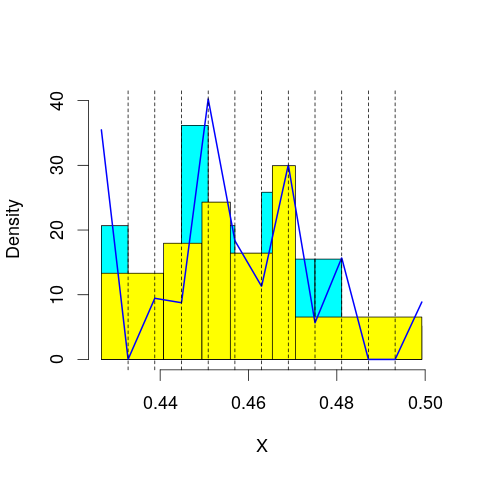

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.0787
mop.approx: Iteration 11. LL = 94.9465
mop.approx: Iteration 21. LL = 95.08974
mop.approx: Iteration 31. LL = 95.10686
mop.approx: Iteration 41. LL = 95.10958
mop.approx: Converged. Iteration 42. LL = 95.10978
[1] "Computing the linear combination of B-splines"


70.8496280099
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 82.65234
mop.approx: Iteration 11. LL = 93.60959
mop.approx: Iteration 21. LL = 93.75866
mop.approx: Iteration 31. LL = 93.79157
mop.approx: Iteration 41. LL = 93.80259
mop.approx: Iteration 51. LL = 93.80728
mop.approx: Iteration 61. LL = 93.80962
mop.approx: Iteration 71. LL = 93.81095
mop.approx: Converged. Iteration 73. LL = 93.81123
[1] "Computing the linear combination of B-splines"


67.8182114223
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.98719
mop.approx: Iteration 11. LL = 84.9033
mop.approx: Iteration 21. LL = 85.12595
mop.approx: Iteration 31. LL = 85.16829
mop.approx: Iteration 41. LL = 85.17962
mop.approx: Iteration 51. LL = 85.18404
mop.approx: Iteration 61. LL = 85.18627
mop.approx: Iteration 71. LL = 85.18755
mop.approx: Converged. Iteration 74. LL = 85.18791
[1] "Computing the linear combination of B-splines"


57.4620245827
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.84465
mop.approx: Iteration 11. LL = 85.10602
mop.approx: Iteration 21. LL = 85.3274
mop.approx: Iteration 31. LL = 85.39225
mop.approx: Iteration 41. LL = 85.41759
mop.approx: Iteration 51. LL = 85.42913
mop.approx: Iteration 61. LL = 85.43488
mop.approx: Iteration 71. LL = 85.43792
mop.approx: Iteration 81. LL = 85.43961
mop.approx: Converged. Iteration 88. LL = 85.44042
[1] "Computing the linear combination of B-splines"


55.9816483279
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.69345
mop.approx: Iteration 11. LL = 84.96762
mop.approx: Iteration 21. LL = 85.13925
mop.approx: Iteration 31. LL = 85.20003
mop.approx: Iteration 41. LL = 85.22038
mop.approx: Iteration 51. LL = 85.22812
mop.approx: Iteration 61. LL = 85.23177
mop.approx: Iteration 71. LL = 85.23385
mop.approx: Iteration 81. LL = 85.2352
mop.approx: Converged. Iteration 89. LL = 85.23606
[1] "Computing the linear combination of B-splines"


54.0444421153
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.257639
mop.approx: Iteration 11. LL = 85.06907
mop.approx: Iteration 21. LL = 85.1249
mop.approx: Iteration 31. LL = 85.13598
mop.approx: Iteration 41. LL = 85.14002
mop.approx: Iteration 51. LL = 85.14228
mop.approx: Iteration 61. LL = 85.14391
mop.approx: Iteration 71. LL = 85.14519
mop.approx: Iteration 81. LL = 85.14624
mop.approx: Converged. Iteration 87. LL = 85.14687
[1] "Computing the linear combination of B-splines"


52.2213761309
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.362523
mop.approx: Iteration 11. LL = 94.58923
mop.approx: Iteration 21. LL = 94.89137
mop.approx: Iteration 31. LL = 94.9052
mop.approx: Converged. Iteration 36. LL = 94.90612
[1] "Computing the linear combination of B-splines"


60.4403240523
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.51081
mop.approx: Iteration 11. LL = 97.38131
mop.approx: Iteration 21. LL = 97.42617
mop.approx: Converged. Iteration 28. LL = 97.42838
[1] "Computing the linear combination of B-splines"


73.168228554
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 73.168228553995732)
m reached
('Sum of Probabilities:', 0.9762581456476428)
chosen


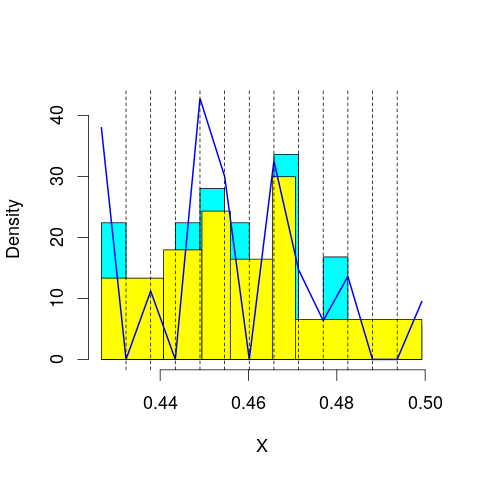

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.0787
mop.approx: Iteration 11. LL = 95.78117
mop.approx: Iteration 21. LL = 95.83184
mop.approx: Iteration 31. LL = 95.83529
mop.approx: Converged. Iteration 31. LL = 95.83537
[1] "Computing the linear combination of B-splines"


69.8423552481
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 82.65234
mop.approx: Iteration 11. LL = 93.75348
mop.approx: Iteration 21. LL = 93.889
mop.approx: Iteration 31. LL = 93.91355
mop.approx: Iteration 41. LL = 93.91912
mop.approx: Converged. Iteration 49. LL = 93.92052
[1] "Computing the linear combination of B-splines"


66.1946339795
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.98719
mop.approx: Iteration 11. LL = 85.58825
mop.approx: Iteration 21. LL = 85.761
mop.approx: Iteration 31. LL = 85.79171
mop.approx: Iteration 41. LL = 85.8001
mop.approx: Iteration 51. LL = 85.80335
mop.approx: Iteration 61. LL = 85.80495
mop.approx: Converged. Iteration 67. LL = 85.80564
[1] "Computing the linear combination of B-splines"


56.3468843885
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.84465
mop.approx: Iteration 11. LL = 85.21814
mop.approx: Iteration 21. LL = 85.39364
mop.approx: Iteration 31. LL = 85.44959
mop.approx: Iteration 41. LL = 85.47272
mop.approx: Iteration 51. LL = 85.48431
mop.approx: Iteration 61. LL = 85.49101
mop.approx: Iteration 71. LL = 85.49524
mop.approx: Iteration 81. LL = 85.49808
mop.approx: Iteration 91. LL = 85.50005
mop.approx: Iteration 101. LL = 85.50146
mop.approx: Iteration 111. LL = 85.50249
mop.approx: Converged. Iteration 112. LL = 85.50267
[1] "Computing the linear combination of B-splines"


54.3110311105
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.69345
mop.approx: Iteration 11. LL = 85.54623
mop.approx: Iteration 21. LL = 85.88445
mop.approx: Iteration 31. LL = 85.98947
mop.approx: Iteration 41. LL = 86.02716
mop.approx: Iteration 51. LL = 86.04296
mop.approx: Iteration 61. LL = 86.05059
mop.approx: Iteration 71. LL = 86.0547
mop.approx: Iteration 81. LL = 86.05711
mop.approx: Iteration 91. LL = 86.05861
mop.approx: Converged. Iteration 99. LL = 86.05951
[1] "Computing the linear combination of B-splines"


53.1352873055
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.257639
mop.approx: Iteration 11. LL = 85.42704
mop.approx: Iteration 21. LL = 85.59923
mop.approx: Iteration 31. LL = 85.65684
mop.approx: Iteration 41. LL = 85.67762
mop.approx: Iteration 51. LL = 85.68664
mop.approx: Iteration 61. LL = 85.69137
mop.approx: Iteration 71. LL = 85.69415
mop.approx: Iteration 81. LL = 85.6959
mop.approx: Iteration 91. LL = 85.69704
mop.approx: Converged. Iteration 93. LL = 85.6973
[1] "Computing the linear combination of B-splines"


51.0443284171
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.362523
[1] "Computing the linear combination of B-splines"


49.7373206946
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.51081
mop.approx: Iteration 11. LL = 97.23363
mop.approx: Iteration 21. LL = 97.29335
mop.approx: Iteration 31. LL = 97.2988
mop.approx: Converged. Iteration 34. LL = 97.29931
[1] "Computing the linear combination of B-splines"


71.3062866565
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 71.306286656469851)
m reached
('Sum of Probabilities:', 0.9747272446429452)
chosen


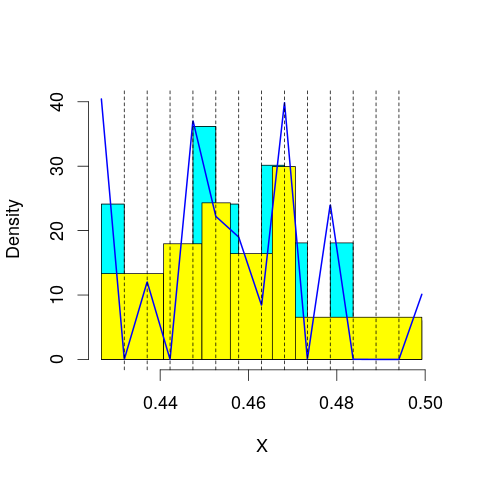

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.0787
mop.approx: Iteration 11. LL = 96.70791
mop.approx: Iteration 21. LL = 96.77748
mop.approx: Iteration 31. LL = 96.78495
mop.approx: Iteration 41. LL = 96.78724
mop.approx: Converged. Iteration 47. LL = 96.78805
[1] "Computing the linear combination of B-splines"


69.0621653721
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 82.65234
mop.approx: Iteration 11. LL = 94.56718
mop.approx: Iteration 21. LL = 94.70264
mop.approx: Iteration 31. LL = 94.72108
mop.approx: Iteration 41. LL = 94.72782
mop.approx: Iteration 51. LL = 94.73128
mop.approx: Iteration 61. LL = 94.73329
mop.approx: Iteration 71. LL = 94.73454
mop.approx: Converged. Iteration 72. LL = 94.73473
[1] "Computing the linear combination of B-splines"


65.2759796948
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.98719
mop.approx: Iteration 11. LL = 85.73223
mop.approx: Iteration 21. LL = 85.88623
mop.approx: Iteration 31. LL = 85.92026
mop.approx: Iteration 41. LL = 85.93075
mop.approx: Iteration 51. LL = 85.93472
mop.approx: Iteration 61. LL = 85.93648
mop.approx: Converged. Iteration 66. LL = 85.93707
[1] "Computing the linear combination of B-splines"


54.7454460225
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.84465
mop.approx: Iteration 11. LL = 85.95256
mop.approx: Iteration 21. LL = 86.19365
mop.approx: Iteration 31. LL = 86.22888
mop.approx: Iteration 41. LL = 86.2386
mop.approx: Iteration 51. LL = 86.24295
mop.approx: Iteration 61. LL = 86.24534
mop.approx: Iteration 71. LL = 86.24678
mop.approx: Converged. Iteration 78. LL = 86.24755
[1] "Computing the linear combination of B-splines"


53.3230390961
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.69345
mop.approx: Iteration 11. LL = 85.75916
mop.approx: Iteration 21. LL = 85.96132
mop.approx: Iteration 31. LL = 86.00513
mop.approx: Iteration 41. LL = 86.0175
mop.approx: Iteration 51. LL = 86.0217
mop.approx: Iteration 61. LL = 86.02348
mop.approx: Converged. Iteration 68. LL = 86.02427
[1] "Computing the linear combination of B-splines"


51.3655059593
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.257639
mop.approx: Iteration 11. LL = 85.82126
mop.approx: Iteration 21. LL = 86.1361
mop.approx: Iteration 31. LL = 86.22594
mop.approx: Iteration 41. LL = 86.25819
mop.approx: Iteration 51. LL = 86.27175
mop.approx: Iteration 61. LL = 86.27783
mop.approx: Iteration 71. LL = 86.28061
mop.approx: Iteration 81. LL = 86.28189
mop.approx: Converged. Iteration 81. LL = 86.28197
[1] "Computing the linear combination of B-splines"


49.8234956308
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.362523
[1] "Computing the linear combination of B-splines"


54.0223743944
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.51081
mop.approx: Iteration 11. LL = 97.53835
mop.approx: Converged. Iteration 16. LL = 97.54216
[1] "Computing the linear combination of B-splines"


69.8162719701
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 69.816271970112467)
m reached
('Sum of Probabilities:', 0.9732313134169172)
chosen


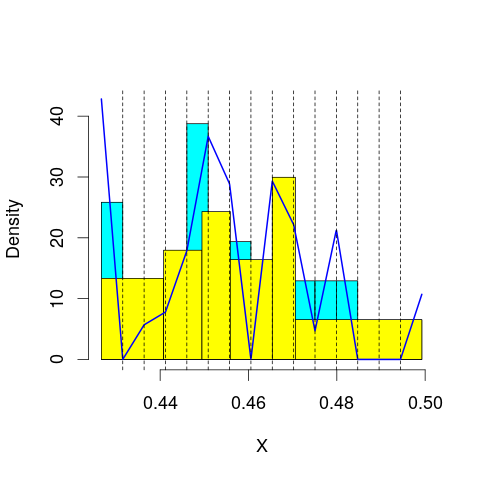

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.0787
mop.approx: Iteration 11. LL = 97.14617
mop.approx: Iteration 21. LL = 97.25256
mop.approx: Iteration 31. LL = 97.26081
mop.approx: Converged. Iteration 39. LL = 97.26219
[1] "Computing the linear combination of B-splines"


67.8034309533
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 82.65234
mop.approx: Iteration 11. LL = 95.05048
mop.approx: Iteration 21. LL = 95.14265
mop.approx: Iteration 31. LL = 95.15717
mop.approx: Iteration 41. LL = 95.16134
mop.approx: Iteration 51. LL = 95.16301
mop.approx: Converged. Iteration 53. LL = 95.1633
[1] "Computing the linear combination of B-splines"


63.971680821
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.98719
mop.approx: Iteration 11. LL = 86.15925
mop.approx: Iteration 21. LL = 86.34581
mop.approx: Iteration 31. LL = 86.37328
mop.approx: Iteration 41. LL = 86.3793
mop.approx: Iteration 51. LL = 86.38128
mop.approx: Converged. Iteration 54. LL = 86.38167
[1] "Computing the linear combination of B-splines"


53.4571827383
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.84465
mop.approx: Iteration 11. LL = 86.21334
mop.approx: Iteration 21. LL = 86.36113
mop.approx: Iteration 31. LL = 86.39285
mop.approx: Iteration 41. LL = 86.40287
mop.approx: Iteration 51. LL = 86.40711
mop.approx: Iteration 61. LL = 86.40934
mop.approx: Iteration 71. LL = 86.41069
mop.approx: Converged. Iteration 76. LL = 86.41125
[1] "Computing the linear combination of B-splines"


51.7538748968
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.69345
mop.approx: Iteration 11. LL = 86.16213
mop.approx: Iteration 21. LL = 86.42587
mop.approx: Iteration 31. LL = 86.48794
mop.approx: Iteration 41. LL = 86.50639
mop.approx: Iteration 51. LL = 86.51386
mop.approx: Iteration 61. LL = 86.51762
mop.approx: Iteration 71. LL = 86.51975
mop.approx: Iteration 81. LL = 86.52103
mop.approx: Converged. Iteration 84. LL = 86.5214
[1] "Computing the linear combination of B-splines"


50.1296706307
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.257639
mop.approx: Iteration 11. LL = 86.07946
mop.approx: Iteration 21. LL = 86.35024
mop.approx: Iteration 31. LL = 86.42455
mop.approx: Iteration 41. LL = 86.45015
mop.approx: Iteration 51. LL = 86.46023
mop.approx: Iteration 61. LL = 86.46454
mop.approx: Iteration 71. LL = 86.46653
mop.approx: Converged. Iteration 78. LL = 86.46737
[1] "Computing the linear combination of B-splines"


48.2576357296
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.362523
[1] "Computing the linear combination of B-splines"


65.7491715511
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.51081
mop.approx: Iteration 11. LL = 98.31103
mop.approx: Iteration 21. LL = 98.35682
mop.approx: Iteration 31. LL = 98.36657
mop.approx: Iteration 41. LL = 98.36996
mop.approx: Converged. Iteration 50. LL = 98.37137
[1] "Computing the linear combination of B-splines"


68.9126162611
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 68.912616261071207)
m reached
('Sum of Probabilities:', 0.9717691672979172)
chosen


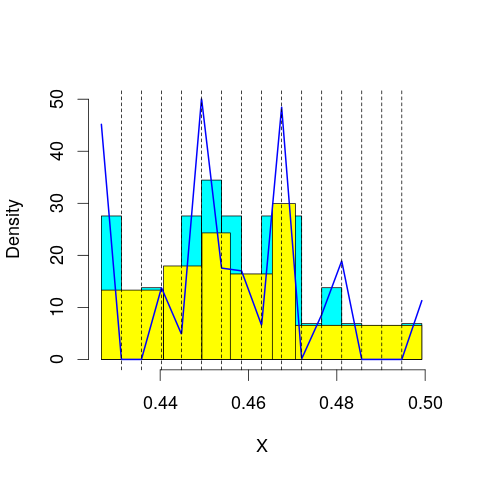

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.0787
mop.approx: Iteration 11. LL = 97.37926
mop.approx: Iteration 21. LL = 97.4759
mop.approx: Iteration 31. LL = 97.48591
mop.approx: Converged. Iteration 38. LL = 97.4873
[1] "Computing the linear combination of B-splines"


66.2956756752
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 82.65234
mop.approx: Iteration 11. LL = 96.22837
mop.approx: Iteration 21. LL = 96.43377
mop.approx: Iteration 31. LL = 96.47436
mop.approx: Iteration 41. LL = 96.48424
mop.approx: Iteration 51. LL = 96.48698
mop.approx: Converged. Iteration 55. LL = 96.48753
[1] "Computing the linear combination of B-splines"


63.5630391556
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.98719
mop.approx: Iteration 11. LL = 86.32253
mop.approx: Iteration 21. LL = 86.46773
mop.approx: Iteration 31. LL = 86.48131
mop.approx: Converged. Iteration 38. LL = 86.48276
[1] "Computing the linear combination of B-splines"


51.8254015734
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.84465
mop.approx: Iteration 11. LL = 86.77898
mop.approx: Iteration 21. LL = 86.98144
mop.approx: Iteration 31. LL = 87.02913
mop.approx: Iteration 41. LL = 87.04326
mop.approx: Iteration 51. LL = 87.04767
mop.approx: Iteration 61. LL = 87.04916
mop.approx: Converged. Iteration 61. LL = 87.04924
[1] "Computing the linear combination of B-splines"


50.6591162343
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.69345
mop.approx: Iteration 11. LL = 86.43571
mop.approx: Iteration 21. LL = 86.62906
mop.approx: Iteration 31. LL = 86.6541
mop.approx: Iteration 41. LL = 86.65868
mop.approx: Converged. Iteration 49. LL = 86.65983
[1] "Computing the linear combination of B-splines"


48.5331542457
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.257639
mop.approx: Iteration 11. LL = 86.85789
mop.approx: Iteration 21. LL = 87.13456
mop.approx: Iteration 31. LL = 87.18194
mop.approx: Iteration 41. LL = 87.19263
mop.approx: Iteration 51. LL = 87.19584
mop.approx: Iteration 61. LL = 87.19719
mop.approx: Converged. Iteration 62. LL = 87.19737
[1] "Computing the linear combination of B-splines"


47.0321637102
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.362523
[1] "Computing the linear combination of B-splines"


56.66823973
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.51081
mop.approx: Iteration 11. LL = 100.6699
mop.approx: Iteration 21. LL = 100.6925
mop.approx: Iteration 31. LL = 100.6955
mop.approx: Converged. Iteration 31. LL = 100.6956
[1] "Computing the linear combination of B-splines"


69.5039683256
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 69.503968325568081)
m reached
('Sum of Probabilities:', 0.9703396745285494)
chosen


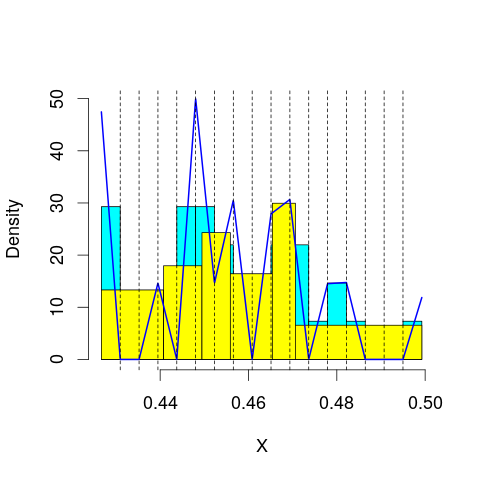

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.0787
mop.approx: Iteration 11. LL = 96.86574
mop.approx: Iteration 21. LL = 96.95868
mop.approx: Iteration 31. LL = 96.98315
mop.approx: Iteration 41. LL = 96.99278
mop.approx: Iteration 51. LL = 96.99731
mop.approx: Iteration 61. LL = 96.99964
mop.approx: Converged. Iteration 70. LL = 97.0009
[1] "Computing the linear combination of B-splines"


64.0764102687
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 82.65234
mop.approx: Iteration 11. LL = 96.90185
mop.approx: Iteration 21. LL = 97.00027
mop.approx: Iteration 31. LL = 97.00806
mop.approx: Converged. Iteration 35. LL = 97.00877
[1] "Computing the linear combination of B-splines"


62.351413158
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.98719
mop.approx: Iteration 11. LL = 86.99106
mop.approx: Iteration 21. LL = 87.11835
mop.approx: Iteration 31. LL = 87.13869
mop.approx: Iteration 41. LL = 87.1453
mop.approx: Iteration 51. LL = 87.14871
mop.approx: Iteration 61. LL = 87.15073
mop.approx: Iteration 71. LL = 87.15197
mop.approx: Converged. Iteration 73. LL = 87.15224
[1] "Computing the linear combination of B-splines"


50.7620108235
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.84465
mop.approx: Iteration 11. LL = 86.68311
mop.approx: Iteration 21. LL = 86.81483
mop.approx: Iteration 31. LL = 86.82839
mop.approx: Converged. Iteration 38. LL = 86.82976
[1] "Computing the linear combination of B-splines"


48.7066720545
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.69345
mop.approx: Iteration 11. LL = 87.18001
mop.approx: Iteration 21. LL = 87.41207
mop.approx: Iteration 31. LL = 87.46527
mop.approx: Iteration 41. LL = 87.48444
mop.approx: Iteration 51. LL = 87.49331
mop.approx: Iteration 61. LL = 87.49812
mop.approx: Iteration 71. LL = 87.501
mop.approx: Iteration 81. LL = 87.50283
mop.approx: Iteration 91. LL = 87.50405
mop.approx: Converged. Iteration 95. LL = 87.50451
[1] "Computing the linear combination of B-splines"


47.6471164784
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.257639
mop.approx: Iteration 11. LL = 86.50525
mop.approx: Iteration 21. LL = 86.65183
mop.approx: Iteration 31. LL = 86.6791
mop.approx: Iteration 41. LL = 86.68518
mop.approx: Converged. Iteration 49. LL = 86.6865
[1] "Computing the linear combination of B-splines"


45.0240113318
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.362523
[1] "Computing the linear combination of B-splines"


-32.2054893582
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.51081
mop.approx: Iteration 11. LL = 98.59559
mop.approx: Iteration 21. LL = 98.61342
mop.approx: Iteration 31. LL = 98.6164
mop.approx: Converged. Iteration 35. LL = 98.61697
[1] "Computing the linear combination of B-splines"


65.692480518
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 65.692480517990063)
m reached
('Sum of Probabilities:', 0.9689417533424878)
chosen


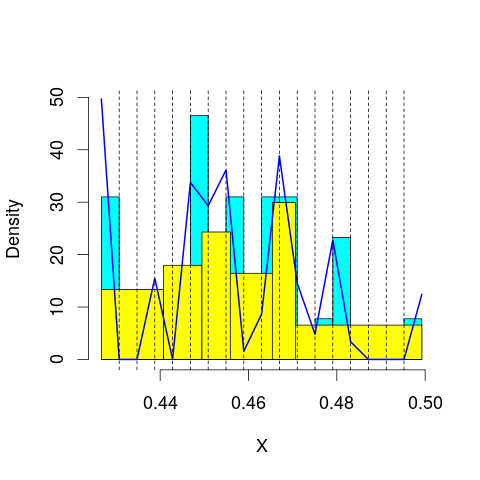

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.0787
mop.approx: Iteration 11. LL = 98.62612
mop.approx: Iteration 21. LL = 98.70287
mop.approx: Iteration 31. LL = 98.70956
mop.approx: Converged. Iteration 34. LL = 98.71004
[1] "Computing the linear combination of B-splines"


64.0526773762
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 82.65234
mop.approx: Iteration 11. LL = 97.19852
mop.approx: Iteration 21. LL = 97.40741
mop.approx: Iteration 31. LL = 97.4407
mop.approx: Iteration 41. LL = 97.44848
mop.approx: Iteration 51. LL = 97.45084
mop.approx: Converged. Iteration 54. LL = 97.45128
[1] "Computing the linear combination of B-splines"


61.0610505174
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.98719
mop.approx: Iteration 11. LL = 87.4432
mop.approx: Iteration 21. LL = 87.59423
mop.approx: Iteration 31. LL = 87.61752
mop.approx: Iteration 41. LL = 87.62347
mop.approx: Iteration 51. LL = 87.62555
mop.approx: Converged. Iteration 56. LL = 87.62617
[1] "Computing the linear combination of B-splines"


49.5030701779
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.84465
mop.approx: Iteration 11. LL = 87.37517
mop.approx: Iteration 21. LL = 87.65229
mop.approx: Iteration 31. LL = 87.70093
mop.approx: Iteration 41. LL = 87.71439
mop.approx: Iteration 51. LL = 87.71938
mop.approx: Iteration 61. LL = 87.72154
mop.approx: Converged. Iteration 68. LL = 87.72243
[1] "Computing the linear combination of B-splines"


47.8664148264
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.69345
mop.approx: Iteration 11. LL = 87.20107
mop.approx: Iteration 21. LL = 87.3562
mop.approx: Iteration 31. LL = 87.38864
mop.approx: Iteration 41. LL = 87.39708
mop.approx: Iteration 51. LL = 87.39988
mop.approx: Converged. Iteration 59. LL = 87.40096
[1] "Computing the linear combination of B-splines"


45.8059340677
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.257639
mop.approx: Iteration 11. LL = 87.6338
mop.approx: Iteration 21. LL = 87.87038
mop.approx: Iteration 31. LL = 87.91277
mop.approx: Iteration 41. LL = 87.93082
mop.approx: Iteration 51. LL = 87.94062
mop.approx: Iteration 61. LL = 87.94637
mop.approx: Iteration 71. LL = 87.94986
mop.approx: Iteration 81. LL = 87.95201
mop.approx: Iteration 91. LL = 87.95335
mop.approx: Converged. Iteration 95. LL = 87.95382
[1] "Computing the linear combination of B-splines"


44.2764699365
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.362523
[1] "Computing the linear combination of B-splines"


83.8225276589
('best: ', 65.692480517990063, 'accepted difference:', 111.6772168805831, 'cur BIC:', 83.822527658878215)
m reached
('Sum of Probabilities:', 9.269197880950465)
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.51081
mop.approx: Iteration 11. LL = 101.3146
mop.approx: Iteration 21. LL = 101.3336
mop.approx: Converged. Iteration 23. LL = 101.334
[1] "Computing the linear combination of B-splines"


66.6766544171
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 66.676654417145215)
m reached
('Sum of Probabilities:', 0.967574369235219)
chosen


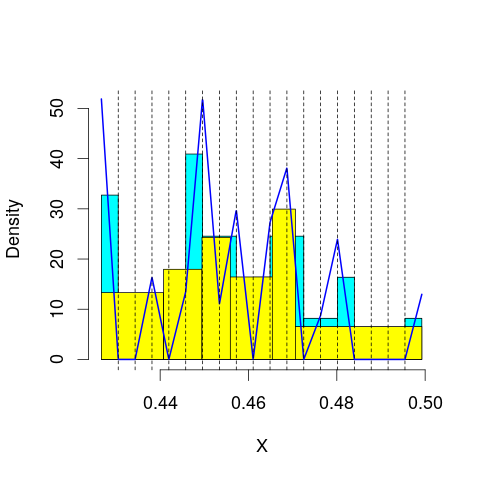

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.0787
mop.approx: Iteration 11. LL = 97.83327
mop.approx: Iteration 21. LL = 97.91313
mop.approx: Iteration 31. LL = 97.92273
mop.approx: Iteration 41. LL = 97.925
mop.approx: Converged. Iteration 43. LL = 97.92532
[1] "Computing the linear combination of B-splines"


61.5350957218
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 82.65234
mop.approx: Iteration 11. LL = 98.25117
mop.approx: Iteration 21. LL = 98.38479
mop.approx: Iteration 31. LL = 98.40812
mop.approx: Iteration 41. LL = 98.41525
mop.approx: Iteration 51. LL = 98.41824
mop.approx: Iteration 61. LL = 98.41978
mop.approx: Converged. Iteration 64. LL = 98.4202
[1] "Computing the linear combination of B-splines"


60.2971060003
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.98719
mop.approx: Iteration 11. LL = 87.77937
mop.approx: Iteration 21. LL = 88.01089
mop.approx: Iteration 31. LL = 88.03803
mop.approx: Iteration 41. LL = 88.0413
mop.approx: Converged. Iteration 42. LL = 88.04147
[1] "Computing the linear combination of B-splines"


48.1855026057
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.84465
mop.approx: Iteration 11. LL = 87.80075
mop.approx: Iteration 21. LL = 88.00435
mop.approx: Iteration 31. LL = 88.06281
mop.approx: Iteration 41. LL = 88.08694
mop.approx: Iteration 51. LL = 88.09841
mop.approx: Iteration 61. LL = 88.10437
mop.approx: Iteration 71. LL = 88.10768
mop.approx: Iteration 81. LL = 88.10963
mop.approx: Iteration 91. LL = 88.11083
mop.approx: Converged. Iteration 93. LL = 88.11109
[1] "Computing the linear combination of B-splines"


46.522157835
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.69345
mop.approx: Iteration 11. LL = 87.52546
mop.approx: Iteration 21. LL = 87.80574
mop.approx: Iteration 31. LL = 87.86029
mop.approx: Iteration 41. LL = 87.87274
mop.approx: Iteration 51. LL = 87.87654
mop.approx: Iteration 61. LL = 87.87806
mop.approx: Converged. Iteration 63. LL = 87.87833
[1] "Computing the linear combination of B-splines"


44.5578388175
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.257639
mop.approx: Iteration 11. LL = 90.04043
mop.approx: Iteration 21. LL = 90.19105
mop.approx: Iteration 31. LL = 90.21733
mop.approx: Iteration 41. LL = 90.22407
mop.approx: Iteration 51. LL = 90.22622
mop.approx: Converged. Iteration 55. LL = 90.22673
[1] "Computing the linear combination of B-splines"


44.8330521528
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.362523
[1] "Computing the linear combination of B-splines"


108.154399604
('best: ', 66.676654417145215, 'accepted difference:', 113.35031250914686, 'cur BIC:', 108.15439960419262)
m reached
('Sum of Probabilities:', 10.14749214016827)
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.51081
mop.approx: Iteration 11. LL = 100.8384
mop.approx: Iteration 21. LL = 100.8628
mop.approx: Iteration 31. LL = 100.8704
mop.approx: Iteration 41. LL = 100.8736
mop.approx: Converged. Iteration 49. LL = 100.8749
[1] "Computing the linear combination of B-splines"


64.4846586574
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 64.484658657396125)
m reached
('Sum of Probabilities:', 0.9662365324103286)
chosen


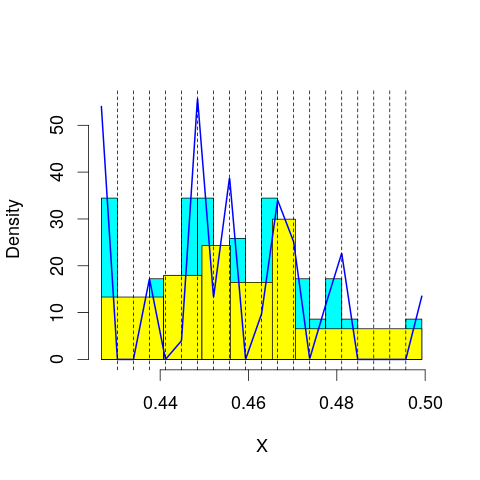

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.0787
mop.approx: Iteration 11. LL = 98.60713
mop.approx: Iteration 21. LL = 98.66164
mop.approx: Iteration 31. LL = 98.66906
mop.approx: Converged. Iteration 37. LL = 98.67012
[1] "Computing the linear combination of B-splines"


60.5470277515
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 82.65234
mop.approx: Iteration 11. LL = 98.86909
mop.approx: Iteration 21. LL = 99.04562
mop.approx: Iteration 31. LL = 99.07515
mop.approx: Iteration 41. LL = 99.0851
mop.approx: Iteration 51. LL = 99.08919
mop.approx: Iteration 61. LL = 99.09108
mop.approx: Converged. Iteration 65. LL = 99.09164
[1] "Computing the linear combination of B-splines"


59.2356754019
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 23.98719
mop.approx: Iteration 11. LL = 88.12829
mop.approx: Iteration 21. LL = 88.28796
mop.approx: Iteration 31. LL = 88.31621
mop.approx: Iteration 41. LL = 88.32465
mop.approx: Iteration 51. LL = 88.32825
mop.approx: Iteration 61. LL = 88.33015
mop.approx: Iteration 71. LL = 88.33129
mop.approx: Converged. Iteration 72. LL = 88.33147
[1] "Computing the linear combination of B-splines"


46.742638405
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.84465
mop.approx: Iteration 11. LL = 88.29233
mop.approx: Iteration 21. LL = 88.56558
mop.approx: Iteration 31. LL = 88.61313
mop.approx: Iteration 41. LL = 88.62815
mop.approx: Iteration 51. LL = 88.63507
mop.approx: Iteration 61. LL = 88.6388
mop.approx: Iteration 71. LL = 88.64098
mop.approx: Iteration 81. LL = 88.64233
mop.approx: Converged. Iteration 85. LL = 88.64281
[1] "Computing the linear combination of B-splines"


45.320928229
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.69345
mop.approx: Iteration 11. LL = 87.89819
mop.approx: Iteration 21. LL = 88.12956
mop.approx: Iteration 31. LL = 88.17433
mop.approx: Iteration 41. LL = 88.19134
mop.approx: Iteration 51. LL = 88.20062
mop.approx: Iteration 61. LL = 88.20643
mop.approx: Iteration 71. LL = 88.2103
mop.approx: Iteration 81. LL = 88.21299
mop.approx: Iteration 91. LL = 88.21491
mop.approx: Iteration 101. LL = 88.21632
mop.approx: Iteration 111. LL = 88.21738
mop.approx: Converged. Iteration 112. LL = 88.21756
[1] "Computing the linear combination of B-splines"


43.1539083647
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.257639
mop.approx: Iteration 11. LL = 95.47448
mop.approx: Iteration 21. LL = 95.72921
mop.approx: Iteration 31. LL = 95.7603
mop.approx: Iteration 41. LL = 95.76747
mop.approx: Iteration 51. LL = 95.76968
mop.approx: Converged. Iteration 55. LL = 95.77022
[1] "Computing the linear combination of B-splines"


49.10179467
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.362523
[1] "Computing the linear combination of B-splines"


100.425841851
('best: ', 64.484658657396125, 'accepted difference:', 109.62391971757341, 'cur BIC:', 100.42584185100922)
m reached
('Sum of Probabilities:', 18.470971496475077)
lfps_30
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.40311
mop.approx: Converged. Iteration 10. LL = 63.62414
[1] "Computing the linear combination of B-splines"


58.4255355333
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 58.425535533320364)
m reached
('Sum of Probabilities:', 0.9897487612495688)
chosen


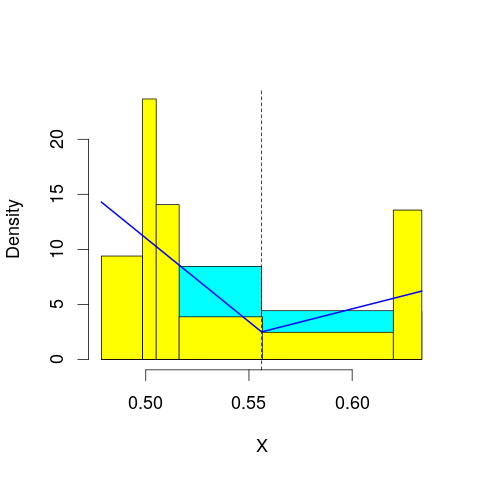

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.19895
mop.approx: Iteration 11. LL = 64.71781
mop.approx: Iteration 21. LL = 64.81029
mop.approx: Iteration 31. LL = 64.82279
mop.approx: Converged. Iteration 40. LL = 64.82452
[1] "Computing the linear combination of B-splines"


57.8930506625
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.99609
mop.approx: Iteration 11. LL = 65.35552
mop.approx: Iteration 21. LL = 65.48428
mop.approx: Iteration 31. LL = 65.51259
mop.approx: Iteration 41. LL = 65.5229
mop.approx: Iteration 51. LL = 65.52764
mop.approx: Iteration 61. LL = 65.53011
mop.approx: Iteration 71. LL = 65.53149
mop.approx: Converged. Iteration 80. LL = 65.5323
[1] "Computing the linear combination of B-splines"


56.8679574152
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.82722
mop.approx: Iteration 11. LL = 47.05748
mop.approx: Converged. Iteration 14. LL = 47.05813
[1] "Computing the linear combination of B-splines"


36.6609265392
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.52801
mop.approx: Iteration 11. LL = 47.12945
mop.approx: Iteration 21. LL = 47.4755
mop.approx: Iteration 31. LL = 47.50286
mop.approx: Iteration 41. LL = 47.50536
mop.approx: Converged. Iteration 42. LL = 47.50545
[1] "Computing the linear combination of B-splines"


35.3753755125
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.982932
mop.approx: Iteration 11. LL = 44.38323
mop.approx: Iteration 21. LL = 44.40833
mop.approx: Converged. Iteration 26. LL = 44.40903
[1] "Computing the linear combination of B-splines"


30.5460887768
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.003854
mop.approx: Iteration 11. LL = 44.7958
mop.approx: Iteration 21. LL = 45.18994
mop.approx: Iteration 31. LL = 45.21782
mop.approx: Iteration 41. LL = 45.22004
mop.approx: Converged. Iteration 41. LL = 45.22008
[1] "Computing the linear combination of B-splines"


29.6242698175
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.465287
mop.approx: Iteration 11. LL = 42.03661
mop.approx: Iteration 21. LL = 42.14185
mop.approx: Iteration 31. LL = 42.1569
mop.approx: Iteration 41. LL = 42.16003
mop.approx: Converged. Iteration 50. LL = 42.16079
[1] "Computing the linear combination of B-splines"


24.8321128066
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.40311
mop.approx: Iteration 11. LL = 65.95344
mop.approx: Iteration 21. LL = 66.00563
mop.approx: Iteration 31. LL = 66.0155
mop.approx: Iteration 41. LL = 66.01784
mop.approx: Converged. Iteration 45. LL = 66.01822
[1] "Computing the linear combination of B-splines"


59.0867531424
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 59.0867531423957)
m reached
('Sum of Probabilities:', 0.9880853086930875)
chosen


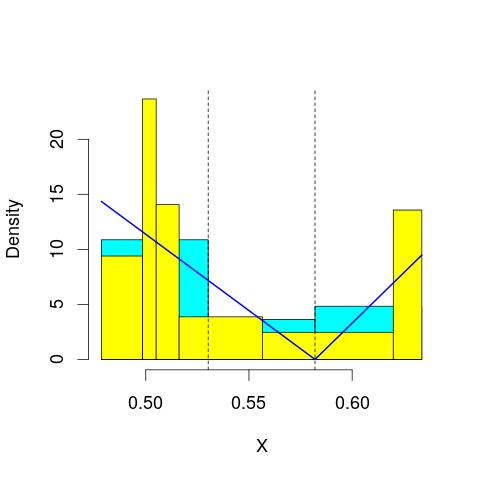

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.19895
mop.approx: Iteration 11. LL = 65.90268
mop.approx: Iteration 21. LL = 65.91574
mop.approx: Iteration 31. LL = 65.91873
mop.approx: Iteration 41. LL = 65.91995
mop.approx: Converged. Iteration 44. LL = 65.92023
[1] "Computing the linear combination of B-splines"


57.2558916767
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.99609
mop.approx: Iteration 11. LL = 66.30197
mop.approx: Iteration 21. LL = 66.36824
mop.approx: Iteration 31. LL = 66.41422
mop.approx: Iteration 41. LL = 66.44229
mop.approx: Iteration 51. LL = 66.45776
mop.approx: Iteration 61. LL = 66.46561
mop.approx: Iteration 71. LL = 66.46936
mop.approx: Iteration 81. LL = 66.47111
mop.approx: Converged. Iteration 88. LL = 66.47181
[1] "Computing the linear combination of B-splines"


56.0746031497
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.82722
mop.approx: Iteration 11. LL = 47.36509
mop.approx: Iteration 21. LL = 47.42723
mop.approx: Iteration 31. LL = 47.43818
mop.approx: Iteration 41. LL = 47.44051
mop.approx: Converged. Iteration 47. LL = 47.44097
[1] "Computing the linear combination of B-splines"


35.3108966939
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.52801
mop.approx: Iteration 11. LL = 49.09881
mop.approx: Converged. Iteration 19. LL = 49.10907
[1] "Computing the linear combination of B-splines"


35.2461259976
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.982932
mop.approx: Iteration 11. LL = 47.55537
mop.approx: Iteration 21. LL = 48.0013
mop.approx: Iteration 31. LL = 48.07649
mop.approx: Iteration 41. LL = 48.1031
mop.approx: Iteration 51. LL = 48.11496
mop.approx: Iteration 61. LL = 48.12081
mop.approx: Iteration 71. LL = 48.12384
mop.approx: Iteration 81. LL = 48.12545
mop.approx: Iteration 91. LL = 48.12632
mop.approx: Converged. Iteration 95. LL = 48.12659
[1] "Computing the linear combination of B-splines"


32.530775966
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.003854
mop.approx: Iteration 11. LL = 46.61577
mop.approx: Iteration 21. LL = 46.63144
mop.approx: Converged. Iteration 21. LL = 46.63148
[1] "Computing the linear combination of B-splines"


29.3027966073
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.465287
mop.approx: Iteration 11. LL = 46.05659
mop.approx: Iteration 21. LL = 46.56372
mop.approx: Iteration 31. LL = 46.63708
mop.approx: Iteration 41. LL = 46.65133
mop.approx: Iteration 51. LL = 46.65421
mop.approx: Converged. Iteration 57. LL = 46.65471
[1] "Computing the linear combination of B-splines"


27.593159919
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.40311
mop.approx: Converged. Iteration 9. LL = 65.26674
[1] "Computing the linear combination of B-splines"


56.6024039837
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 56.602403983737837)
m reached
('Sum of Probabilities:', 0.988216356348545)
chosen


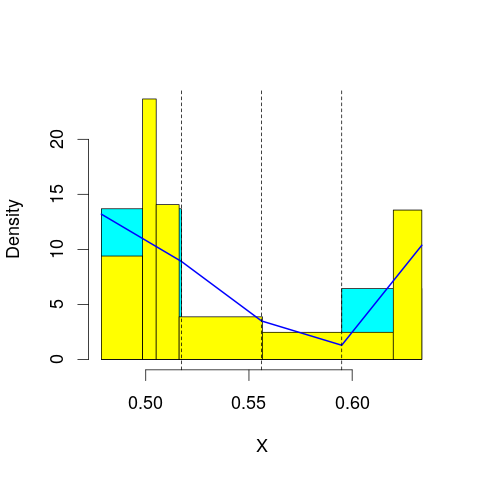

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.19895
mop.approx: Iteration 11. LL = 66.78334
mop.approx: Iteration 21. LL = 66.88798
mop.approx: Iteration 31. LL = 66.92052
mop.approx: Iteration 41. LL = 66.93262
mop.approx: Iteration 51. LL = 66.93775
mop.approx: Iteration 61. LL = 66.94009
mop.approx: Iteration 71. LL = 66.94121
mop.approx: Converged. Iteration 73. LL = 66.94142
[1] "Computing the linear combination of B-splines"


56.5442128038
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.99609
mop.approx: Iteration 11. LL = 66.83082
mop.approx: Iteration 21. LL = 66.90323
mop.approx: Iteration 31. LL = 66.91961
mop.approx: Iteration 41. LL = 66.92566
mop.approx: Iteration 51. LL = 66.92887
mop.approx: Iteration 61. LL = 66.93096
mop.approx: Iteration 71. LL = 66.93247
mop.approx: Iteration 81. LL = 66.93359
mop.approx: Iteration 91. LL = 66.93443
mop.approx: Converged. Iteration 94. LL = 66.93471
[1] "Computing the linear combination of B-splines"


54.8046354982
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.82722
mop.approx: Iteration 11. LL = 49.91755
mop.approx: Iteration 21. LL = 50.30578
mop.approx: Iteration 31. LL = 50.38968
mop.approx: Iteration 41. LL = 50.4123
mop.approx: Iteration 51. LL = 50.42018
mop.approx: Iteration 61. LL = 50.42379
mop.approx: Iteration 71. LL = 50.42583
mop.approx: Iteration 81. LL = 50.42713
mop.approx: Iteration 91. LL = 50.42802
mop.approx: Iteration 101. LL = 50.42866
mop.approx: Converged. Iteration 104. LL = 50.42887
[1] "Computing the linear combination of B-splines"


36.5659215031
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.52801
mop.approx: Iteration 11. LL = 49.52976
mop.approx: Iteration 21. LL = 49.55428
mop.approx: Converged. Iteration 30. LL = 49.55605
[1] "Computing the linear combination of B-splines"


33.9602399584
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.982932
mop.approx: Iteration 11. LL = 49.73821
mop.approx: Iteration 21. LL = 49.84217
mop.approx: Iteration 31. LL = 49.84901
mop.approx: Converged. Iteration 37. LL = 49.84964
[1] "Computing the linear combination of B-splines"


32.5209580567
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.003854
mop.approx: Iteration 11. LL = 47.59457
mop.approx: Iteration 21. LL = 47.97712
mop.approx: Iteration 31. LL = 48.05099
mop.approx: Iteration 41. LL = 48.06185
mop.approx: Converged. Iteration 50. LL = 48.06322
[1] "Computing the linear combination of B-splines"


29.0016742531
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.465287
mop.approx: Iteration 11. LL = 48.09137
mop.approx: Iteration 21. LL = 48.12378
mop.approx: Converged. Iteration 21. LL = 48.12382
[1] "Computing the linear combination of B-splines"


27.3294032669
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.40311
mop.approx: Iteration 11. LL = 66.57401
mop.approx: Converged. Iteration 15. LL = 66.57478
[1] "Computing the linear combination of B-splines"


56.1775772071
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 56.177577207123321)
m reached
('Sum of Probabilities:', 0.9902005787547664)
chosen


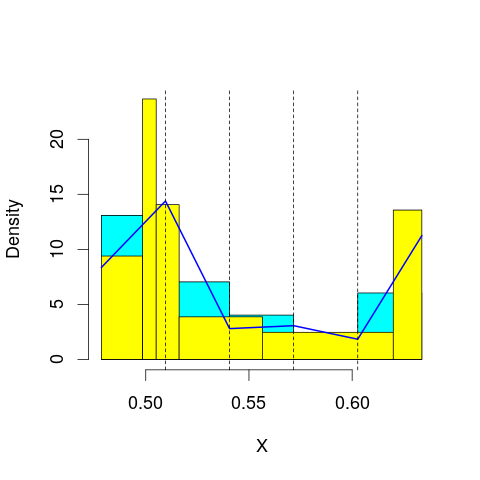

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.19895
mop.approx: Iteration 11. LL = 67.61389
mop.approx: Iteration 21. LL = 67.63306
mop.approx: Iteration 31. LL = 67.63544
mop.approx: Iteration 41. LL = 67.63675
mop.approx: Iteration 51. LL = 67.63763
mop.approx: Converged. Iteration 53. LL = 67.63783
[1] "Computing the linear combination of B-splines"


55.507754968
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.99609
mop.approx: Iteration 11. LL = 66.80866
mop.approx: Iteration 21. LL = 66.89662
mop.approx: Iteration 31. LL = 66.92624
mop.approx: Iteration 41. LL = 66.93828
mop.approx: Iteration 51. LL = 66.94365
mop.approx: Iteration 61. LL = 66.94625
mop.approx: Iteration 71. LL = 66.9476
mop.approx: Converged. Iteration 78. LL = 66.94822
[1] "Computing the linear combination of B-splines"


53.0852813824
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.82722
mop.approx: Iteration 11. LL = 53.98205
mop.approx: Iteration 21. LL = 54.2214
mop.approx: Iteration 31. LL = 54.26179
mop.approx: Iteration 41. LL = 54.27478
mop.approx: Iteration 51. LL = 54.28074
mop.approx: Iteration 61. LL = 54.28394
mop.approx: Iteration 71. LL = 54.28579
mop.approx: Iteration 81. LL = 54.28691
mop.approx: Iteration 91. LL = 54.2876
mop.approx: Converged. Iteration 91. LL = 54.28766
[1] "Computing the linear combination of B-splines"


38.6918454079
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.52801
mop.approx: Iteration 11. LL = 50.5095
mop.approx: Iteration 21. LL = 50.68499
mop.approx: Iteration 31. LL = 50.72123
mop.approx: Iteration 41. LL = 50.7292
mop.approx: Iteration 51. LL = 50.731
mop.approx: Converged. Iteration 54. LL = 50.73124
[1] "Computing the linear combination of B-splines"


33.4025618135
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.982932
mop.approx: Iteration 11. LL = 51.81934
mop.approx: Iteration 21. LL = 51.9507
mop.approx: Iteration 31. LL = 51.97095
mop.approx: Iteration 41. LL = 51.9774
mop.approx: Iteration 51. LL = 51.98011
mop.approx: Iteration 61. LL = 51.98145
mop.approx: Iteration 71. LL = 51.98218
mop.approx: Converged. Iteration 72. LL = 51.98229
[1] "Computing the linear combination of B-splines"


32.920738347
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.003854
mop.approx: Iteration 11. LL = 49.47462
mop.approx: Iteration 21. LL = 49.69608
mop.approx: Iteration 31. LL = 49.71208
mop.approx: Iteration 41. LL = 49.71433
mop.approx: Iteration 51. LL = 49.71525
mop.approx: Converged. Iteration 57. LL = 49.71565
[1] "Computing the linear combination of B-splines"


28.9212313546
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.465287
mop.approx: Iteration 11. LL = 48.12198
mop.approx: Iteration 21. LL = 48.1545
mop.approx: Iteration 31. LL = 48.16518
mop.approx: Iteration 41. LL = 48.16899
mop.approx: Iteration 51. LL = 48.1704
mop.approx: Converged. Iteration 57. LL = 48.17083
[1] "Computing the linear combination of B-splines"


25.6435475837
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.40311
mop.approx: Iteration 11. LL = 68.55867
mop.approx: Iteration 21. LL = 68.58127
mop.approx: Converged. Iteration 28. LL = 68.58281
[1] "Computing the linear combination of B-splines"


56.4527367363
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 56.452736736303308)
m reached
('Sum of Probabilities:', 0.9902935897219631)
chosen


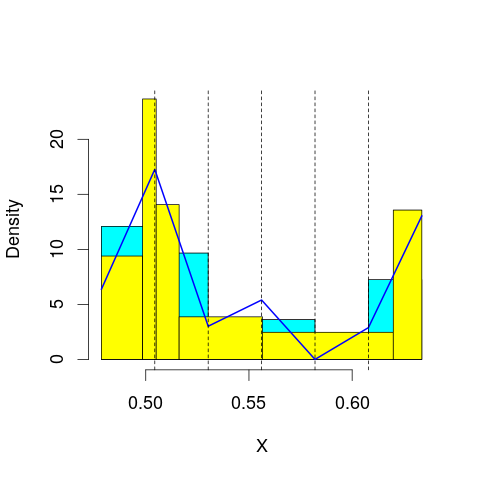

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.19895
mop.approx: Iteration 11. LL = 67.66319
mop.approx: Iteration 21. LL = 67.73079
mop.approx: Iteration 31. LL = 67.74001
mop.approx: Converged. Iteration 38. LL = 67.74117
[1] "Computing the linear combination of B-splines"


53.8782239522
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.99609
mop.approx: Iteration 11. LL = 67.69911
mop.approx: Iteration 21. LL = 67.96959
mop.approx: Iteration 31. LL = 68.04396
mop.approx: Iteration 41. LL = 68.06616
mop.approx: Iteration 51. LL = 68.0732
mop.approx: Iteration 61. LL = 68.07557
mop.approx: Converged. Iteration 68. LL = 68.0763
[1] "Computing the linear combination of B-splines"


52.4804880516
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.82722
mop.approx: Iteration 11. LL = 55.50481
mop.approx: Iteration 21. LL = 55.63779
mop.approx: Iteration 31. LL = 55.65314
mop.approx: Iteration 41. LL = 55.65609
mop.approx: Iteration 51. LL = 55.65716
mop.approx: Converged. Iteration 55. LL = 55.65747
[1] "Computing the linear combination of B-splines"


38.3287879912
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.52801
mop.approx: Iteration 11. LL = 52.75989
mop.approx: Iteration 21. LL = 53.11461
mop.approx: Iteration 31. LL = 53.18403
mop.approx: Iteration 41. LL = 53.20093
mop.approx: Iteration 51. LL = 53.20539
mop.approx: Iteration 61. LL = 53.20662
mop.approx: Converged. Iteration 62. LL = 53.20672
[1] "Computing the linear combination of B-splines"


34.1451764806
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.982932
mop.approx: Iteration 11. LL = 52.22252
mop.approx: Iteration 21. LL = 52.307
mop.approx: Iteration 31. LL = 52.32988
mop.approx: Iteration 41. LL = 52.33662
mop.approx: Iteration 51. LL = 52.33866
mop.approx: Converged. Iteration 57. LL = 52.33916
[1] "Computing the linear combination of B-splines"


31.5447429999
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.003854
mop.approx: Iteration 11. LL = 53.03911
mop.approx: Iteration 21. LL = 53.3702
mop.approx: Iteration 31. LL = 53.4102
mop.approx: Iteration 41. LL = 53.41891
mop.approx: Iteration 51. LL = 53.42131
mop.approx: Converged. Iteration 58. LL = 53.42192
[1] "Computing the linear combination of B-splines"


30.8946389933
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.465287
mop.approx: Iteration 11. LL = 49.43944
mop.approx: Iteration 21. LL = 49.90242
mop.approx: Iteration 31. LL = 50.07536
mop.approx: Iteration 41. LL = 50.14227
mop.approx: Iteration 51. LL = 50.16868
mop.approx: Iteration 61. LL = 50.17921
mop.approx: Iteration 71. LL = 50.18343
mop.approx: Iteration 81. LL = 50.18512
mop.approx: Converged. Iteration 89. LL = 50.18576
[1] "Computing the linear combination of B-splines"


25.9256118416
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.40311
mop.approx: Iteration 11. LL = 68.85482
mop.approx: Iteration 21. LL = 68.8882
mop.approx: Iteration 31. LL = 68.89938
mop.approx: Iteration 41. LL = 68.90429
mop.approx: Iteration 51. LL = 68.90684
mop.approx: Iteration 61. LL = 68.90833
mop.approx: Iteration 71. LL = 68.90925
mop.approx: Converged. Iteration 72. LL = 68.90939
[1] "Computing the linear combination of B-splines"


55.0464455433
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 55.046445543347453)
m reached
('Sum of Probabilities:', 0.9891521824767389)
chosen


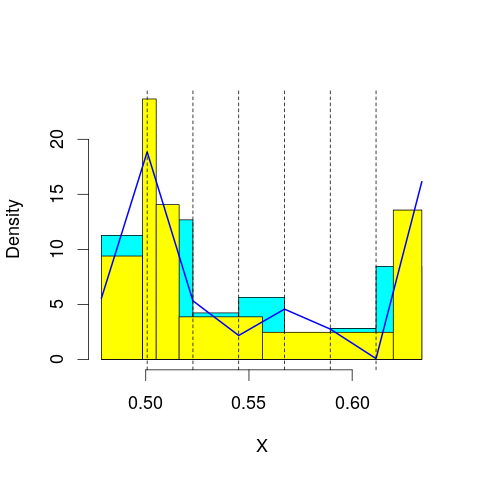

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.19895
mop.approx: Iteration 11. LL = 69.22682
mop.approx: Iteration 21. LL = 69.30801
mop.approx: Iteration 31. LL = 69.31464
mop.approx: Iteration 41. LL = 69.31648
mop.approx: Converged. Iteration 48. LL = 69.31718
[1] "Computing the linear combination of B-splines"


53.7213673128
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.99609
mop.approx: Iteration 11. LL = 67.64888
mop.approx: Iteration 21. LL = 67.79036
mop.approx: Iteration 31. LL = 67.83839
mop.approx: Iteration 41. LL = 67.85965
mop.approx: Iteration 51. LL = 67.87059
mop.approx: Iteration 61. LL = 67.87688
mop.approx: Iteration 71. LL = 67.88081
mop.approx: Iteration 81. LL = 67.8834
mop.approx: Iteration 91. LL = 67.88519
mop.approx: Iteration 101. LL = 67.88648
mop.approx: Iteration 111. LL = 67.88742
mop.approx: Converged. Iteration 118. LL = 67.88801
[1] "Computing the linear combination of B-splines"


50.559329225
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.82722
mop.approx: Iteration 11. LL = 57.88236
mop.approx: Iteration 21. LL = 58.03285
mop.approx: Iteration 31. LL = 58.04861
mop.approx: Iteration 41. LL = 58.05212
mop.approx: Converged. Iteration 49. LL = 58.05295
[1] "Computing the linear combination of B-splines"


38.9914051266
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.52801
mop.approx: Iteration 11. LL = 54.61198
mop.approx: Iteration 21. LL = 54.81787
mop.approx: Iteration 31. LL = 54.84835
mop.approx: Iteration 41. LL = 54.85698
mop.approx: Iteration 51. LL = 54.85966
mop.approx: Converged. Iteration 59. LL = 54.86045
[1] "Computing the linear combination of B-splines"


34.0660356797
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.982932
mop.approx: Iteration 11. LL = 52.67961
mop.approx: Iteration 21. LL = 52.75981
mop.approx: Iteration 31. LL = 52.77337
mop.approx: Iteration 41. LL = 52.77665
mop.approx: Iteration 51. LL = 52.77783
mop.approx: Converged. Iteration 60. LL = 52.77846
[1] "Computing the linear combination of B-splines"


30.2511817084
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.003854
mop.approx: Iteration 11. LL = 53.63153
mop.approx: Iteration 21. LL = 53.70385
mop.approx: Iteration 31. LL = 53.71825
mop.approx: Iteration 41. LL = 53.72506
mop.approx: Iteration 51. LL = 53.72843
mop.approx: Iteration 61. LL = 53.73014
mop.approx: Iteration 71. LL = 53.73101
mop.approx: Converged. Iteration 73. LL = 53.73118
[1] "Computing the linear combination of B-splines"


29.4710231457
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.465287
mop.approx: Iteration 11. LL = 53.21842
mop.approx: Iteration 21. LL = 53.65576
mop.approx: Iteration 31. LL = 53.735
mop.approx: Iteration 41. LL = 53.75797
mop.approx: Iteration 51. LL = 53.76661
mop.approx: Iteration 61. LL = 53.77029
mop.approx: Iteration 71. LL = 53.77194
mop.approx: Converged. Iteration 80. LL = 53.7727
[1] "Computing the linear combination of B-splines"


27.7796514323
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.40311
mop.approx: Iteration 11. LL = 70.76206
mop.approx: Converged. Iteration 16. LL = 70.76533
[1] "Computing the linear combination of B-splines"


55.1695206629
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 55.169520662855859)
m reached
('Sum of Probabilities:', 0.9879698433481314)
chosen


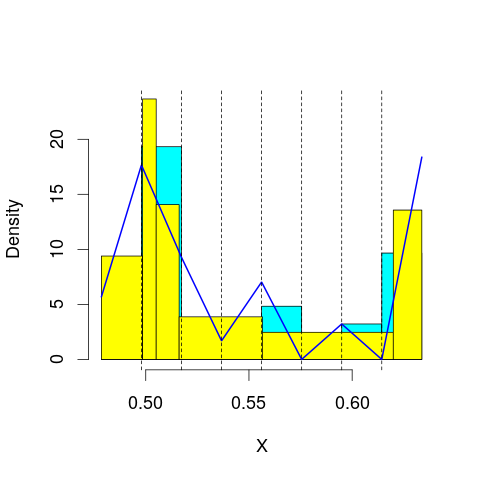

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.19895
mop.approx: Iteration 11. LL = 69.13454
mop.approx: Iteration 21. LL = 69.19943
mop.approx: Converged. Iteration 30. LL = 69.20265
[1] "Computing the linear combination of B-splines"


51.8739702172
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.99609
mop.approx: Iteration 11. LL = 68.75535
mop.approx: Iteration 21. LL = 68.86961
mop.approx: Iteration 31. LL = 68.88472
mop.approx: Iteration 41. LL = 68.88924
mop.approx: Iteration 51. LL = 68.89126
mop.approx: Iteration 61. LL = 68.89235
mop.approx: Converged. Iteration 65. LL = 68.89272
[1] "Computing the linear combination of B-splines"


49.8311747339
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.82722
mop.approx: Iteration 11. LL = 58.50132
mop.approx: Iteration 21. LL = 58.52349
mop.approx: Iteration 31. LL = 58.52765
mop.approx: Iteration 41. LL = 58.52949
mop.approx: Converged. Iteration 50. LL = 58.53031
[1] "Computing the linear combination of B-splines"


37.7358981076
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.52801
mop.approx: Iteration 11. LL = 57.21758
mop.approx: Iteration 21. LL = 57.35476
mop.approx: Iteration 31. LL = 57.3611
mop.approx: Converged. Iteration 36. LL = 57.36162
[1] "Computing the linear combination of B-splines"


34.8343378734
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.982932
mop.approx: Iteration 11. LL = 53.84994
mop.approx: Iteration 21. LL = 54.12644
mop.approx: Iteration 31. LL = 54.18992
mop.approx: Iteration 41. LL = 54.20648
mop.approx: Iteration 51. LL = 54.21204
mop.approx: Iteration 61. LL = 54.21448
mop.approx: Iteration 71. LL = 54.21577
mop.approx: Iteration 81. LL = 54.21654
mop.approx: Converged. Iteration 84. LL = 54.21676
[1] "Computing the linear combination of B-splines"


29.9566093019
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.003854
mop.approx: Iteration 11. LL = 53.91334
mop.approx: Iteration 21. LL = 54.02008
mop.approx: Iteration 31. LL = 54.04645
mop.approx: Iteration 41. LL = 54.05291
mop.approx: Iteration 51. LL = 54.05442
mop.approx: Converged. Iteration 52. LL = 54.05453
[1] "Computing the linear combination of B-splines"


28.0615180718
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.465287
mop.approx: Iteration 11. LL = 54.23759
mop.approx: Iteration 21. LL = 54.45162
mop.approx: Iteration 31. LL = 54.46971
mop.approx: Iteration 41. LL = 54.47285
mop.approx: Iteration 51. LL = 54.4744
mop.approx: Iteration 61. LL = 54.47549
mop.approx: Iteration 71. LL = 54.47632
mop.approx: Iteration 81. LL = 54.47695
mop.approx: Converged. Iteration 82. LL = 54.47706
[1] "Computing the linear combination of B-splines"


26.7511093467
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.40311
mop.approx: Iteration 11. LL = 71.16243
mop.approx: Iteration 21. LL = 71.18352
mop.approx: Iteration 31. LL = 71.18888
mop.approx: Iteration 41. LL = 71.19096
mop.approx: Converged. Iteration 50. LL = 71.19191
[1] "Computing the linear combination of B-splines"


53.8632348895
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 53.863234889530062)
m reached
('Sum of Probabilities:', 0.9866285475410286)
chosen


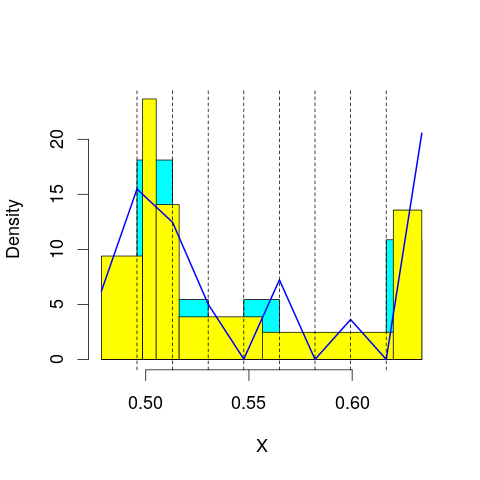

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.19895
mop.approx: Iteration 11. LL = 69.46442
mop.approx: Iteration 21. LL = 69.53658
mop.approx: Iteration 31. LL = 69.55045
mop.approx: Iteration 41. LL = 69.55504
mop.approx: Iteration 51. LL = 69.55682
mop.approx: Converged. Iteration 56. LL = 69.55732
[1] "Computing the linear combination of B-splines"


50.495775797
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.99609
mop.approx: Iteration 11. LL = 69.115
mop.approx: Iteration 21. LL = 69.173
mop.approx: Iteration 31. LL = 69.1886
mop.approx: Iteration 41. LL = 69.19488
mop.approx: Iteration 51. LL = 69.19769
mop.approx: Iteration 61. LL = 69.199
mop.approx: Converged. Iteration 64. LL = 69.1993
[1] "Computing the linear combination of B-splines"


48.4048884074
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.82722
mop.approx: Iteration 11. LL = 59.5441
mop.approx: Iteration 21. LL = 59.6191
mop.approx: Iteration 31. LL = 59.62554
mop.approx: Converged. Iteration 37. LL = 59.62627
[1] "Computing the linear combination of B-splines"


37.0989873424
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.52801
mop.approx: Iteration 11. LL = 58.74742
mop.approx: Iteration 21. LL = 58.89842
mop.approx: Iteration 31. LL = 58.93611
mop.approx: Iteration 41. LL = 58.94822
mop.approx: Iteration 51. LL = 58.95249
mop.approx: Iteration 61. LL = 58.95411
mop.approx: Converged. Iteration 67. LL = 58.95461
[1] "Computing the linear combination of B-splines"


34.6944599962
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.982932
mop.approx: Iteration 11. LL = 56.37899
mop.approx: Iteration 21. LL = 56.65781
mop.approx: Iteration 31. LL = 56.69196
mop.approx: Iteration 41. LL = 56.69778
mop.approx: Converged. Iteration 49. LL = 56.69878
[1] "Computing the linear combination of B-splines"


30.7057657989
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.003854
mop.approx: Iteration 11. LL = 54.41045
mop.approx: Iteration 21. LL = 54.55075
mop.approx: Iteration 31. LL = 54.58493
mop.approx: Iteration 41. LL = 54.5953
mop.approx: Iteration 51. LL = 54.59881
mop.approx: Iteration 61. LL = 54.60007
mop.approx: Converged. Iteration 64. LL = 54.6003
[1] "Computing the linear combination of B-splines"


26.8744060526
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.465287
mop.approx: Iteration 11. LL = 55.06821
mop.approx: Iteration 21. LL = 55.37059
mop.approx: Iteration 31. LL = 55.42824
mop.approx: Iteration 41. LL = 55.44759
mop.approx: Iteration 51. LL = 55.45667
mop.approx: Iteration 61. LL = 55.46163
mop.approx: Iteration 71. LL = 55.46455
mop.approx: Iteration 81. LL = 55.46634
mop.approx: Iteration 91. LL = 55.46748
mop.approx: Iteration 101. LL = 55.4682
mop.approx: Converged. Iteration 102. LL = 55.46831
[1] "Computing the linear combination of B-splines"


26.009083443
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.40311
mop.approx: Iteration 11. LL = 71.33819
mop.approx: Iteration 21. LL = 71.3539
mop.approx: Converged. Iteration 29. LL = 71.35536
[1] "Computing the linear combination of B-splines"


52.2938156531
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 52.293815653086561)
m reached
('Sum of Probabilities:', 0.9853244866889066)
chosen


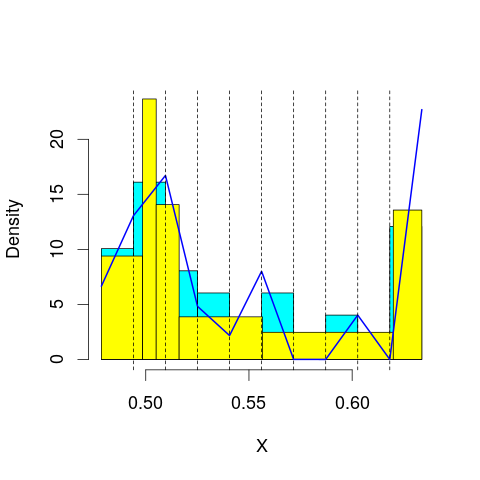

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.19895
mop.approx: Iteration 11. LL = 70.29373
mop.approx: Iteration 21. LL = 70.37162
mop.approx: Iteration 31. LL = 70.38562
mop.approx: Iteration 41. LL = 70.3893
mop.approx: Converged. Iteration 49. LL = 70.39033
[1] "Computing the linear combination of B-splines"


49.5959171345
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.99609
mop.approx: Iteration 11. LL = 69.97079
mop.approx: Iteration 21. LL = 70.06265
mop.approx: Iteration 31. LL = 70.08389
mop.approx: Iteration 41. LL = 70.09201
mop.approx: Iteration 51. LL = 70.09561
mop.approx: Iteration 61. LL = 70.09733
mop.approx: Converged. Iteration 69. LL = 70.09813
[1] "Computing the linear combination of B-splines"


47.5708504259
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.82722
mop.approx: Iteration 11. LL = 59.62952
mop.approx: Iteration 21. LL = 59.6566
mop.approx: Iteration 31. LL = 59.66476
mop.approx: Iteration 41. LL = 59.66897
mop.approx: Iteration 51. LL = 59.67128
mop.approx: Iteration 61. LL = 59.67258
mop.approx: Converged. Iteration 70. LL = 59.67334
[1] "Computing the linear combination of B-splines"


35.4131879021
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.52801
mop.approx: Iteration 11. LL = 60.20685
mop.approx: Iteration 21. LL = 60.36004
mop.approx: Iteration 31. LL = 60.37408
mop.approx: Iteration 41. LL = 60.37749
mop.approx: Iteration 51. LL = 60.37885
mop.approx: Converged. Iteration 56. LL = 60.37927
[1] "Computing the linear combination of B-splines"


34.3862461114
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.982932
mop.approx: Iteration 11. LL = 58.39387
mop.approx: Iteration 21. LL = 58.53067
mop.approx: Iteration 31. LL = 58.53799
mop.approx: Iteration 41. LL = 58.53972
mop.approx: Converged. Iteration 48. LL = 58.54032
[1] "Computing the linear combination of B-splines"


30.8144353561
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.003854
mop.approx: Iteration 11. LL = 55.86021
mop.approx: Iteration 21. LL = 56.01992
mop.approx: Iteration 31. LL = 56.03982
mop.approx: Iteration 41. LL = 56.04464
mop.approx: Iteration 51. LL = 56.04612
mop.approx: Converged. Iteration 55. LL = 56.04644
[1] "Computing the linear combination of B-splines"


26.5876910236
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.465287
mop.approx: Iteration 11. LL = 55.68949
mop.approx: Iteration 21. LL = 55.80476
mop.approx: Iteration 31. LL = 55.81236
mop.approx: Iteration 41. LL = 55.81514
mop.approx: Iteration 51. LL = 55.81708
mop.approx: Iteration 61. LL = 55.81853
mop.approx: Iteration 71. LL = 55.81965
mop.approx: Iteration 81. LL = 55.82052
mop.approx: Iteration 91. LL = 55.82121
mop.approx: Converged. Iteration 95. LL = 55.8215
[1] "Computing the linear combination of B-splines"


24.6299436494
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.40311
mop.approx: Iteration 11. LL = 72.15313
mop.approx: Iteration 21. LL = 72.18486
mop.approx: Converged. Iteration 26. LL = 72.18581
[1] "Computing the linear combination of B-splines"


51.3913901963
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 51.391390196314987)
m reached
('Sum of Probabilities:', 0.9840157363353731)
chosen


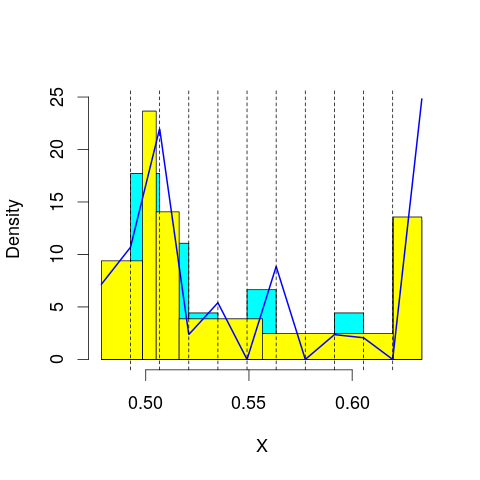

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.19895
mop.approx: Iteration 11. LL = 70.65975
mop.approx: Iteration 21. LL = 70.70581
mop.approx: Iteration 31. LL = 70.7142
mop.approx: Iteration 41. LL = 70.71686
mop.approx: Iteration 51. LL = 70.71792
mop.approx: Converged. Iteration 51. LL = 70.71799
[1] "Computing the linear combination of B-splines"


48.1907053382
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.99609
mop.approx: Iteration 11. LL = 70.34674
mop.approx: Iteration 21. LL = 70.43444
mop.approx: Iteration 31. LL = 70.45745
mop.approx: Iteration 41. LL = 70.46434
mop.approx: Iteration 51. LL = 70.46673
mop.approx: Iteration 61. LL = 70.46776
mop.approx: Converged. Iteration 61. LL = 70.46783
[1] "Computing the linear combination of B-splines"


46.2076832193
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.82722
mop.approx: Iteration 11. LL = 60.26234
mop.approx: Iteration 21. LL = 60.31561
mop.approx: Iteration 31. LL = 60.32052
mop.approx: Iteration 41. LL = 60.32182
mop.approx: Converged. Iteration 50. LL = 60.32255
[1] "Computing the linear combination of B-splines"


34.3295311954
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.52801
mop.approx: Iteration 11. LL = 60.6922
mop.approx: Iteration 21. LL = 60.74176
mop.approx: Converged. Iteration 26. LL = 60.74253
[1] "Computing the linear combination of B-splines"


33.0166453972
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.982932
mop.approx: Iteration 11. LL = 59.9366
mop.approx: Iteration 21. LL = 60.08189
mop.approx: Iteration 31. LL = 60.09631
mop.approx: Iteration 41. LL = 60.09995
mop.approx: Iteration 51. LL = 60.10144
mop.approx: Converged. Iteration 58. LL = 60.10205
[1] "Computing the linear combination of B-splines"


30.6432942472
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.003854
mop.approx: Iteration 11. LL = 57.67946
mop.approx: Iteration 21. LL = 57.92376
mop.approx: Iteration 31. LL = 57.97707
mop.approx: Iteration 41. LL = 57.99647
mop.approx: Iteration 51. LL = 58.00503
mop.approx: Iteration 61. LL = 58.00928
mop.approx: Iteration 71. LL = 58.01161
mop.approx: Iteration 81. LL = 58.01299
mop.approx: Iteration 91. LL = 58.01388
mop.approx: Converged. Iteration 97. LL = 58.01432
[1] "Computing the linear combination of B-splines"


26.8227177736
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.465287
mop.approx: Iteration 11. LL = 56.53968
mop.approx: Iteration 21. LL = 56.68439
mop.approx: Iteration 31. LL = 56.69885
mop.approx: Iteration 41. LL = 56.70097
mop.approx: Converged. Iteration 43. LL = 56.70115
[1] "Computing the linear combination of B-splines"


23.7770853709
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.40311
mop.approx: Iteration 11. LL = 72.30579
mop.approx: Iteration 21. LL = 72.33954
mop.approx: Iteration 31. LL = 72.3416
mop.approx: Converged. Iteration 31. LL = 72.34166
[1] "Computing the linear combination of B-splines"


49.8143789252
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 49.814378925228596)
m reached
('Sum of Probabilities:', 0.9828714146312331)
chosen


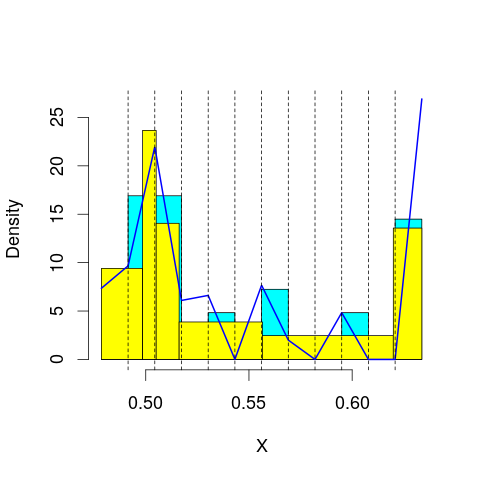

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.19895
mop.approx: Iteration 11. LL = 71.60027
mop.approx: Iteration 21. LL = 71.63192
mop.approx: Converged. Iteration 28. LL = 71.63353
[1] "Computing the linear combination of B-splines"


47.3733770803
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.99609
mop.approx: Iteration 11. LL = 71.3179
mop.approx: Iteration 21. LL = 71.42465
mop.approx: Iteration 31. LL = 71.43857
mop.approx: Iteration 41. LL = 71.44187
mop.approx: Iteration 51. LL = 71.4431
mop.approx: Converged. Iteration 53. LL = 71.44332
[1] "Computing the linear combination of B-splines"


45.4502992013
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.82722
mop.approx: Iteration 11. LL = 60.96931
mop.approx: Iteration 21. LL = 61.0617
mop.approx: Iteration 31. LL = 61.09167
mop.approx: Iteration 41. LL = 61.10223
mop.approx: Iteration 51. LL = 61.10629
mop.approx: Iteration 61. LL = 61.10807
mop.approx: Iteration 71. LL = 61.10899
mop.approx: Converged. Iteration 73. LL = 61.10918
[1] "Computing the linear combination of B-splines"


33.3832913138
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.52801
mop.approx: Iteration 11. LL = 61.06553
mop.approx: Iteration 21. LL = 61.18591
mop.approx: Iteration 31. LL = 61.20393
mop.approx: Iteration 41. LL = 61.20775
mop.approx: Converged. Iteration 48. LL = 61.20852
[1] "Computing the linear combination of B-splines"


31.7497629682
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.982932
mop.approx: Iteration 11. LL = 60.64
mop.approx: Iteration 21. LL = 60.70468
mop.approx: Iteration 31. LL = 60.72356
mop.approx: Iteration 41. LL = 60.73419
mop.approx: Iteration 51. LL = 60.74127
mop.approx: Iteration 61. LL = 60.7463
mop.approx: Iteration 71. LL = 60.74999
mop.approx: Iteration 81. LL = 60.75277
mop.approx: Iteration 91. LL = 60.7549
mop.approx: Iteration 101. LL = 60.75655
mop.approx: Iteration 111. LL = 60.75786
mop.approx: Iteration 121. LL = 60.7589
mop.approx: Iteration 131. LL = 60.75973
mop.approx: Iteration 141. LL = 60.76041
mop.approx: Converged. Iteration 141. LL = 60.76047
[1] "Computing the linear combination of B-splines"


29.5688382304
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.003854
mop.approx: Iteration 11. LL = 59.48484
mop.approx: Iteration 21. LL = 59.79874
mop.approx: Iteration 31. LL = 59.83149
mop.approx: Iteration 41. LL = 59.83543
mop.approx: Converged. Iteration 44. LL = 59.83575
[1] "Computing the linear combination of B-splines"


26.911132914
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.465287
mop.approx: Iteration 11. LL = 57.57364
mop.approx: Iteration 21. LL = 57.71251
mop.approx: Iteration 31. LL = 57.73722
mop.approx: Iteration 41. LL = 57.74516
mop.approx: Iteration 51. LL = 57.74828
mop.approx: Iteration 61. LL = 57.74962
mop.approx: Converged. Iteration 66. LL = 57.75004
[1] "Computing the linear combination of B-splines"


23.0843951975
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.40311
mop.approx: Iteration 11. LL = 73.23019
mop.approx: Iteration 21. LL = 73.27405
mop.approx: Iteration 31. LL = 73.2822
mop.approx: Iteration 41. LL = 73.28485
mop.approx: Converged. Iteration 49. LL = 73.28579
[1] "Computing the linear combination of B-splines"


49.0256381076
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 49.025638107606802)
m reached
('Sum of Probabilities:', 0.9815648647758648)
chosen


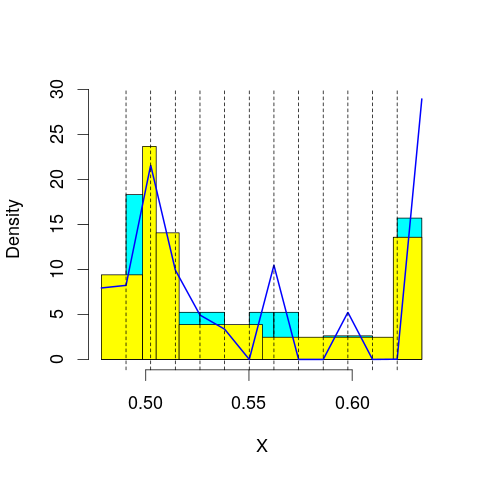

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.19895
mop.approx: Iteration 11. LL = 71.47376
mop.approx: Iteration 21. LL = 71.52832
mop.approx: Iteration 31. LL = 71.53876
mop.approx: Iteration 41. LL = 71.54289
mop.approx: Iteration 51. LL = 71.54493
mop.approx: Iteration 61. LL = 71.54606
mop.approx: Converged. Iteration 65. LL = 71.54644
[1] "Computing the linear combination of B-splines"


45.5534241805
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.99609
mop.approx: Iteration 11. LL = 72.24257
mop.approx: Iteration 21. LL = 72.28789
mop.approx: Iteration 31. LL = 72.29436
mop.approx: Iteration 41. LL = 72.2968
mop.approx: Iteration 51. LL = 72.29821
mop.approx: Iteration 61. LL = 72.29913
mop.approx: Converged. Iteration 62. LL = 72.29928
[1] "Computing the linear combination of B-splines"


44.5733893207
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.82722
mop.approx: Iteration 11. LL = 61.6378
mop.approx: Iteration 21. LL = 61.783
mop.approx: Iteration 31. LL = 61.80798
mop.approx: Iteration 41. LL = 61.81452
mop.approx: Iteration 51. LL = 61.81652
mop.approx: Converged. Iteration 56. LL = 61.817
[1] "Computing the linear combination of B-splines"


32.3582469728
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.52801
mop.approx: Iteration 11. LL = 61.35024
mop.approx: Iteration 21. LL = 61.40182
mop.approx: Iteration 31. LL = 61.41986
mop.approx: Iteration 41. LL = 61.42762
mop.approx: Iteration 51. LL = 61.43085
mop.approx: Iteration 61. LL = 61.43216
mop.approx: Converged. Iteration 64. LL = 61.43242
[1] "Computing the linear combination of B-splines"


30.2408010339
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.982932
mop.approx: Iteration 11. LL = 61.30792
mop.approx: Iteration 21. LL = 61.5419
mop.approx: Iteration 31. LL = 61.59432
mop.approx: Iteration 41. LL = 61.60844
mop.approx: Iteration 51. LL = 61.61271
mop.approx: Iteration 61. LL = 61.6141
mop.approx: Converged. Iteration 63. LL = 61.6143
[1] "Computing the linear combination of B-splines"


28.6897850817
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.003854
mop.approx: Iteration 11. LL = 60.53869
mop.approx: Iteration 21. LL = 60.66471
mop.approx: Iteration 31. LL = 60.68006
mop.approx: Iteration 41. LL = 60.6867
mop.approx: Iteration 51. LL = 60.69018
mop.approx: Iteration 61. LL = 60.6921
mop.approx: Iteration 71. LL = 60.69323
mop.approx: Converged. Iteration 80. LL = 60.69394
[1] "Computing the linear combination of B-splines"


26.0364221943
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.465287
mop.approx: Iteration 11. LL = 58.80087
mop.approx: Iteration 21. LL = 59.00903
mop.approx: Iteration 31. LL = 59.03423
mop.approx: Iteration 41. LL = 59.03966
mop.approx: Iteration 51. LL = 59.04121
mop.approx: Converged. Iteration 54. LL = 59.04146
[1] "Computing the linear combination of B-splines"


22.647537224
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.40311
mop.approx: Iteration 11. LL = 73.17203
mop.approx: Iteration 21. LL = 73.18537
mop.approx: Converged. Iteration 29. LL = 73.1867
[1] "Computing the linear combination of B-splines"


47.1936836163
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 47.193683616331029)
m reached
('Sum of Probabilities:', 0.9836971124415783)
chosen


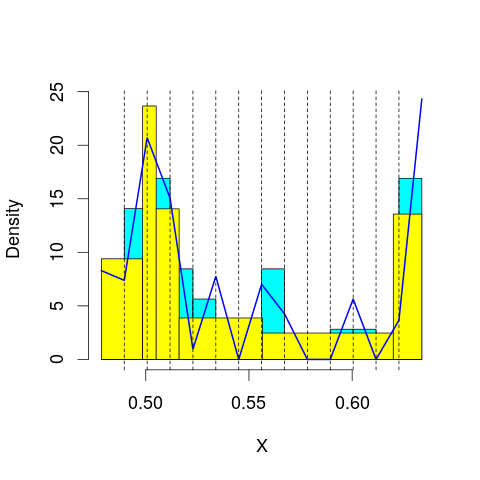

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.19895
mop.approx: Iteration 11. LL = 72.78722
mop.approx: Iteration 21. LL = 72.81561
mop.approx: Converged. Iteration 26. LL = 72.81653
[1] "Computing the linear combination of B-splines"


45.0906411289
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.99609
mop.approx: Iteration 11. LL = 72.28136
mop.approx: Iteration 21. LL = 72.3401
mop.approx: Iteration 31. LL = 72.35351
mop.approx: Iteration 41. LL = 72.35887
mop.approx: Iteration 51. LL = 72.36116
mop.approx: Converged. Iteration 60. LL = 72.36218
[1] "Computing the linear combination of B-splines"


42.9034282949
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.82722
mop.approx: Iteration 11. LL = 63.13144
mop.approx: Iteration 21. LL = 63.29592
mop.approx: Iteration 31. LL = 63.32425
mop.approx: Iteration 41. LL = 63.33039
mop.approx: Iteration 51. LL = 63.33182
mop.approx: Converged. Iteration 51. LL = 63.33187
[1] "Computing the linear combination of B-splines"


32.1402512839
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.52801
mop.approx: Iteration 11. LL = 61.63586
mop.approx: Iteration 21. LL = 61.74478
mop.approx: Iteration 31. LL = 61.76519
mop.approx: Iteration 41. LL = 61.77234
mop.approx: Iteration 51. LL = 61.77565
mop.approx: Iteration 61. LL = 61.77738
mop.approx: Iteration 71. LL = 61.77833
mop.approx: Converged. Iteration 73. LL = 61.77853
[1] "Computing the linear combination of B-splines"


28.8540361232
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.982932
mop.approx: Iteration 11. LL = 61.84392
mop.approx: Iteration 21. LL = 62.08638
mop.approx: Iteration 31. LL = 62.12146
mop.approx: Iteration 41. LL = 62.13096
mop.approx: Iteration 51. LL = 62.13484
mop.approx: Iteration 61. LL = 62.13673
mop.approx: Iteration 71. LL = 62.13776
mop.approx: Converged. Iteration 75. LL = 62.1381
[1] "Computing the linear combination of B-splines"


27.4807239943
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.003854
mop.approx: Iteration 11. LL = 61.23307
mop.approx: Iteration 21. LL = 61.40265
mop.approx: Iteration 31. LL = 61.44449
mop.approx: Iteration 41. LL = 61.45879
mop.approx: Iteration 51. LL = 61.46477
mop.approx: Iteration 61. LL = 61.46766
mop.approx: Iteration 71. LL = 61.46916
mop.approx: Converged. Iteration 80. LL = 61.46997
[1] "Computing the linear combination of B-splines"


25.0785313702
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.465287
mop.approx: Iteration 11. LL = 59.94817
mop.approx: Iteration 21. LL = 60.14819
mop.approx: Iteration 31. LL = 60.18606
mop.approx: Iteration 41. LL = 60.19856
mop.approx: Iteration 51. LL = 60.20411
mop.approx: Iteration 61. LL = 60.20707
mop.approx: Iteration 71. LL = 60.20884
mop.approx: Iteration 81. LL = 60.20997
mop.approx: Iteration 91. LL = 60.21071
mop.approx: Converged. Iteration 91. LL = 60.21077
[1] "Computing the linear combination of B-splines"


22.084216577
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.40311
mop.approx: Iteration 11. LL = 73.50873
mop.approx: Iteration 21. LL = 73.54488
mop.approx: Iteration 31. LL = 73.55056
mop.approx: Converged. Iteration 39. LL = 73.55171
[1] "Computing the linear combination of B-splines"


45.8258230318
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 45.825823031839803)
m reached
('Sum of Probabilities:', 0.9861934702910918)
chosen


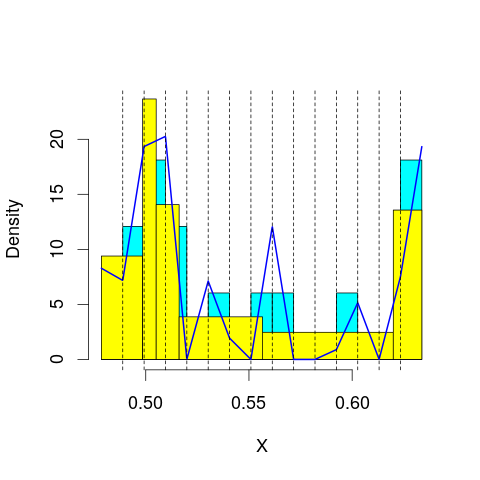

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.19895
mop.approx: Iteration 11. LL = 73.06155
mop.approx: Converged. Iteration 15. LL = 73.06265
[1] "Computing the linear combination of B-splines"


43.603891577
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.99609
mop.approx: Iteration 11. LL = 72.9022
mop.approx: Iteration 21. LL = 73.0826
mop.approx: Iteration 31. LL = 73.11678
mop.approx: Iteration 41. LL = 73.12524
mop.approx: Iteration 51. LL = 73.12765
mop.approx: Converged. Iteration 58. LL = 73.12841
[1] "Computing the linear combination of B-splines"


41.936786251
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.82722
mop.approx: Iteration 11. LL = 63.56912
mop.approx: Iteration 21. LL = 63.60086
mop.approx: Iteration 31. LL = 63.60439
mop.approx: Converged. Iteration 38. LL = 63.60519
[1] "Computing the linear combination of B-splines"


30.6807005478
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.52801
mop.approx: Iteration 11. LL = 62.58339
mop.approx: Iteration 21. LL = 62.76312
mop.approx: Iteration 31. LL = 62.79465
mop.approx: Iteration 41. LL = 62.80156
mop.approx: Iteration 51. LL = 62.80371
mop.approx: Iteration 61. LL = 62.80465
mop.approx: Converged. Iteration 62. LL = 62.80477
[1] "Computing the linear combination of B-splines"


28.1474138471
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.982932
mop.approx: Iteration 11. LL = 61.84143
mop.approx: Iteration 21. LL = 62.01458
mop.approx: Iteration 31. LL = 62.02594
mop.approx: Converged. Iteration 40. LL = 62.02725
[1] "Computing the linear combination of B-splines"


25.6370056883
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.003854
mop.approx: Iteration 11. LL = 61.98603
mop.approx: Iteration 21. LL = 62.20366
mop.approx: Iteration 31. LL = 62.25953
mop.approx: Iteration 41. LL = 62.27813
mop.approx: Iteration 51. LL = 62.28456
mop.approx: Iteration 61. LL = 62.28684
mop.approx: Converged. Iteration 68. LL = 62.28755
[1] "Computing the linear combination of B-splines"


24.1638097982
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.465287
mop.approx: Iteration 11. LL = 60.89953
mop.approx: Iteration 21. LL = 61.1897
mop.approx: Iteration 31. LL = 61.25131
mop.approx: Iteration 41. LL = 61.26737
mop.approx: Iteration 51. LL = 61.27234
mop.approx: Iteration 61. LL = 61.27425
mop.approx: Iteration 71. LL = 61.27514
mop.approx: Converged. Iteration 71. LL = 61.2752
[1] "Computing the linear combination of B-splines"


21.4190154381
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.40311
mop.approx: Iteration 11. LL = 72.91849
mop.approx: Iteration 21. LL = 72.92926
mop.approx: Iteration 31. LL = 72.93169
mop.approx: Converged. Iteration 36. LL = 72.93224
[1] "Computing the linear combination of B-splines"


43.4734800899
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 43.473480089861802)
m reached
('Sum of Probabilities:', 0.9877425159596025)
chosen


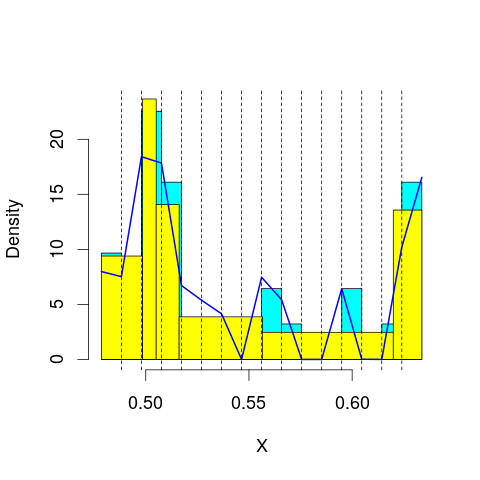

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.19895
mop.approx: Iteration 11. LL = 74.30249
mop.approx: Iteration 21. LL = 74.37926
mop.approx: Iteration 31. LL = 74.38912
mop.approx: Converged. Iteration 39. LL = 74.39058
[1] "Computing the linear combination of B-splines"


43.1989614663
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.99609
mop.approx: Iteration 11. LL = 72.58242
mop.approx: Iteration 21. LL = 72.74691
mop.approx: Iteration 31. LL = 72.77265
mop.approx: Iteration 41. LL = 72.77918
mop.approx: Iteration 51. LL = 72.78161
mop.approx: Iteration 61. LL = 72.78275
mop.approx: Converged. Iteration 63. LL = 72.78297
[1] "Computing the linear combination of B-splines"


39.8584799388
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.82722
mop.approx: Iteration 11. LL = 64.71899
mop.approx: Iteration 21. LL = 64.81258
mop.approx: Iteration 31. LL = 64.82983
mop.approx: Iteration 41. LL = 64.83521
mop.approx: Iteration 51. LL = 64.83726
mop.approx: Converged. Iteration 59. LL = 64.83804
[1] "Computing the linear combination of B-splines"


30.1806829459
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.52801
mop.approx: Iteration 11. LL = 63.04661
mop.approx: Iteration 21. LL = 63.1734
mop.approx: Iteration 31. LL = 63.19728
mop.approx: Iteration 41. LL = 63.20278
mop.approx: Iteration 51. LL = 63.2041
mop.approx: Converged. Iteration 51. LL = 63.20416
[1] "Computing the linear combination of B-splines"


26.8139371396
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.982932
mop.approx: Iteration 11. LL = 62.58163
mop.approx: Iteration 21. LL = 62.819
mop.approx: Iteration 31. LL = 62.85375
mop.approx: Iteration 41. LL = 62.86145
mop.approx: Iteration 51. LL = 62.86346
mop.approx: Converged. Iteration 55. LL = 62.86383
[1] "Computing the linear combination of B-splines"


24.7406975697
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.003854
mop.approx: Iteration 11. LL = 62.02558
mop.approx: Iteration 21. LL = 62.23568
mop.approx: Iteration 31. LL = 62.28625
mop.approx: Iteration 41. LL = 62.30223
mop.approx: Iteration 51. LL = 62.30943
mop.approx: Iteration 61. LL = 62.31336
mop.approx: Iteration 71. LL = 62.31572
mop.approx: Iteration 81. LL = 62.31724
mop.approx: Iteration 91. LL = 62.31826
mop.approx: Converged. Iteration 100. LL = 62.31897
[1] "Computing the linear combination of B-splines"


22.4619677278
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.465287
mop.approx: Iteration 11. LL = 61.9846
mop.approx: Iteration 21. LL = 62.26412
mop.approx: Iteration 31. LL = 62.3063
mop.approx: Iteration 41. LL = 62.31602
mop.approx: Iteration 51. LL = 62.31916
mop.approx: Iteration 61. LL = 62.32036
mop.approx: Converged. Iteration 63. LL = 62.32055
[1] "Computing the linear combination of B-splines"


20.7192824845
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.40311
mop.approx: Iteration 11. LL = 74.08393
mop.approx: Iteration 21. LL = 74.11855
mop.approx: Converged. Iteration 26. LL = 74.11964
[1] "Computing the linear combination of B-splines"


42.9280199093
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 42.928019909294861)
m reached
('Sum of Probabilities:', 0.9888797870226577)
chosen


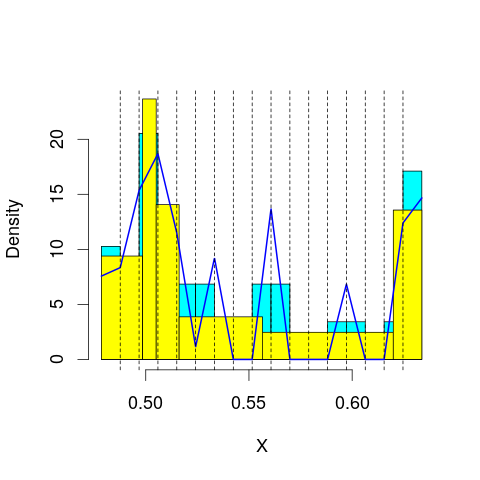

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.19895
mop.approx: Iteration 11. LL = 73.76115
mop.approx: Iteration 21. LL = 73.8143
mop.approx: Iteration 31. LL = 73.82477
mop.approx: Iteration 41. LL = 73.82729
mop.approx: Converged. Iteration 45. LL = 73.82772
[1] "Computing the linear combination of B-splines"


40.9032333028
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.99609
mop.approx: Iteration 11. LL = 73.66142
mop.approx: Iteration 21. LL = 73.83492
mop.approx: Iteration 31. LL = 73.86351
mop.approx: Iteration 41. LL = 73.87134
mop.approx: Iteration 51. LL = 73.87398
mop.approx: Converged. Iteration 60. LL = 73.87503
[1] "Computing the linear combination of B-splines"


39.2176704651
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.82722
mop.approx: Iteration 11. LL = 64.41112
mop.approx: Iteration 21. LL = 64.47755
mop.approx: Iteration 31. LL = 64.49919
mop.approx: Iteration 41. LL = 64.50732
mop.approx: Iteration 51. LL = 64.5105
mop.approx: Iteration 61. LL = 64.51176
mop.approx: Converged. Iteration 63. LL = 64.51196
[1] "Computing the linear combination of B-splines"


28.1217292762
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.52801
mop.approx: Iteration 11. LL = 64.44247
mop.approx: Iteration 21. LL = 64.54288
mop.approx: Iteration 31. LL = 64.54837
mop.approx: Converged. Iteration 35. LL = 64.54884
[1] "Computing the linear combination of B-splines"


26.4257415614
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.982932
mop.approx: Iteration 11. LL = 62.58923
mop.approx: Iteration 21. LL = 62.74436
mop.approx: Iteration 31. LL = 62.76893
mop.approx: Iteration 41. LL = 62.775
mop.approx: Iteration 51. LL = 62.777
mop.approx: Iteration 61. LL = 62.77793
mop.approx: Converged. Iteration 63. LL = 62.77813
[1] "Computing the linear combination of B-splines"


22.9221234816
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.003854
mop.approx: Iteration 11. LL = 62.56236
mop.approx: Iteration 21. LL = 62.81483
mop.approx: Iteration 31. LL = 62.89221
mop.approx: Iteration 41. LL = 62.92589
mop.approx: Iteration 51. LL = 62.94227
mop.approx: Iteration 61. LL = 62.95062
mop.approx: Iteration 71. LL = 62.95503
mop.approx: Iteration 81. LL = 62.95744
mop.approx: Iteration 91. LL = 62.95882
mop.approx: Iteration 101. LL = 62.95966
mop.approx: Converged. Iteration 102. LL = 62.95979
[1] "Computing the linear combination of B-splines"


21.3700902036
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.465287
mop.approx: Iteration 11. LL = 62.16176
mop.approx: Iteration 21. LL = 62.35004
mop.approx: Iteration 31. LL = 62.3823
mop.approx: Iteration 41. LL = 62.39448
mop.approx: Iteration 51. LL = 62.39948
mop.approx: Iteration 61. LL = 62.40146
mop.approx: Converged. Iteration 68. LL = 62.40212
[1] "Computing the linear combination of B-splines"


19.0356752686
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.40311
mop.approx: Iteration 11. LL = 75.12107
mop.approx: Converged. Iteration 18. LL = 75.12618
[1] "Computing the linear combination of B-splines"


42.2016862654
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 42.201686265421102)
m reached
('Sum of Probabilities:', 0.9898288297529373)
chosen


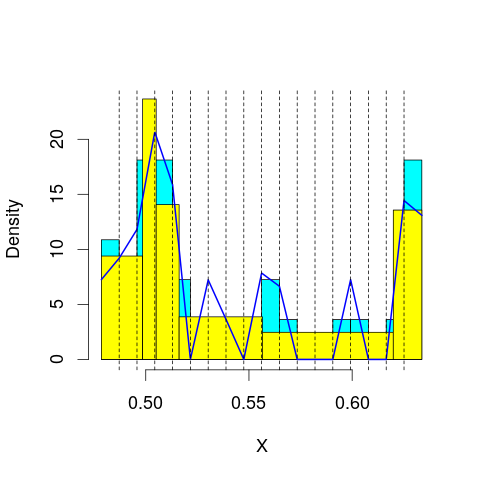

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.19895
mop.approx: Iteration 11. LL = 74.05003
mop.approx: Iteration 21. LL = 74.08767
mop.approx: Iteration 31. LL = 74.09081
mop.approx: Converged. Iteration 35. LL = 74.09128
[1] "Computing the linear combination of B-splines"


39.4339188057
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.99609
mop.approx: Iteration 11. LL = 73.43721
mop.approx: Iteration 21. LL = 73.55647
mop.approx: Iteration 31. LL = 73.57578
mop.approx: Iteration 41. LL = 73.58041
mop.approx: Converged. Iteration 50. LL = 73.58173
[1] "Computing the linear combination of B-splines"


37.1915063962
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.82722
mop.approx: Iteration 11. LL = 65.3362
mop.approx: Iteration 21. LL = 65.38684
mop.approx: Iteration 31. LL = 65.39224
mop.approx: Iteration 41. LL = 65.39437
mop.approx: Iteration 51. LL = 65.39542
mop.approx: Converged. Iteration 53. LL = 65.39562
[1] "Computing the linear combination of B-splines"


27.2725283402
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.52801
mop.approx: Iteration 11. LL = 64.54276
mop.approx: Iteration 21. LL = 64.60242
mop.approx: Iteration 31. LL = 64.61841
mop.approx: Iteration 41. LL = 64.62338
mop.approx: Iteration 51. LL = 64.62482
mop.approx: Converged. Iteration 52. LL = 64.62495
[1] "Computing the linear combination of B-splines"


24.7689850095
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.982932
mop.approx: Iteration 11. LL = 63.70126
mop.approx: Iteration 21. LL = 63.89202
mop.approx: Iteration 31. LL = 63.91612
mop.approx: Iteration 41. LL = 63.92288
mop.approx: Iteration 51. LL = 63.92502
mop.approx: Converged. Iteration 56. LL = 63.92551
[1] "Computing the linear combination of B-splines"


22.3367461824
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.003854
mop.approx: Iteration 11. LL = 62.47247
mop.approx: Iteration 21. LL = 62.70271
mop.approx: Iteration 31. LL = 62.78589
mop.approx: Iteration 41. LL = 62.8162
mop.approx: Iteration 51. LL = 62.82726
mop.approx: Iteration 61. LL = 62.83141
mop.approx: Iteration 71. LL = 62.83307
mop.approx: Converged. Iteration 77. LL = 62.83362
[1] "Computing the linear combination of B-splines"


19.5093252953
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.465287
mop.approx: Iteration 11. LL = 63.21878
mop.approx: Iteration 21. LL = 63.4355
mop.approx: Iteration 31. LL = 63.46905
mop.approx: Iteration 41. LL = 63.47845
mop.approx: Iteration 51. LL = 63.48199
mop.approx: Iteration 61. LL = 63.48366
mop.approx: Iteration 71. LL = 63.4846
mop.approx: Converged. Iteration 74. LL = 63.48487
[1] "Computing the linear combination of B-splines"


18.3495655668
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.40311
mop.approx: Iteration 11. LL = 75.00848
mop.approx: Iteration 21. LL = 75.04444
mop.approx: Iteration 31. LL = 75.04721
mop.approx: Converged. Iteration 36. LL = 75.04775
[1] "Computing the linear combination of B-splines"


40.3903921702
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 40.390392170226953)
m reached
('Sum of Probabilities:', 0.9903972787599683)
chosen


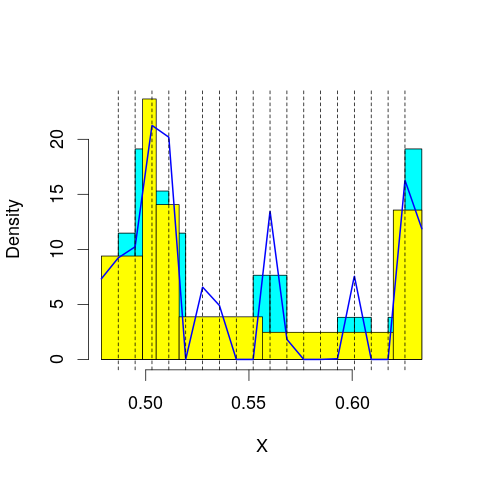

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.19895
mop.approx: Iteration 11. LL = 74.57946
mop.approx: Iteration 21. LL = 74.63654
mop.approx: Iteration 31. LL = 74.64773
mop.approx: Iteration 41. LL = 74.65132
mop.approx: Iteration 51. LL = 74.65284
mop.approx: Converged. Iteration 57. LL = 74.65345
[1] "Computing the linear combination of B-splines"


38.2632210908
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.99609
mop.approx: Iteration 11. LL = 73.80354
mop.approx: Iteration 21. LL = 73.92592
mop.approx: Iteration 31. LL = 73.94392
mop.approx: Iteration 41. LL = 73.94798
mop.approx: Converged. Iteration 50. LL = 73.94915
[1] "Computing the linear combination of B-splines"


35.8260543952
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.82722
mop.approx: Iteration 11. LL = 65.66773
mop.approx: Iteration 21. LL = 65.74168
mop.approx: Iteration 31. LL = 65.75663
mop.approx: Iteration 41. LL = 65.75968
mop.approx: Converged. Iteration 46. LL = 65.76023
[1] "Computing the linear combination of B-splines"


25.9042666716
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.52801
mop.approx: Iteration 11. LL = 65.26753
mop.approx: Iteration 21. LL = 65.36587
mop.approx: Iteration 31. LL = 65.38439
mop.approx: Iteration 41. LL = 65.39086
mop.approx: Iteration 51. LL = 65.39338
mop.approx: Iteration 61. LL = 65.39439
mop.approx: Converged. Iteration 61. LL = 65.39445
[1] "Computing the linear combination of B-splines"


23.8056180115
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.982932
mop.approx: Iteration 11. LL = 64.13446
mop.approx: Iteration 21. LL = 64.28417
mop.approx: Iteration 31. LL = 64.3125
mop.approx: Iteration 41. LL = 64.32059
mop.approx: Iteration 51. LL = 64.32344
mop.approx: Iteration 61. LL = 64.32465
mop.approx: Converged. Iteration 65. LL = 64.325
[1] "Computing the linear combination of B-splines"


21.003455205
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.003854
mop.approx: Iteration 11. LL = 63.08041
mop.approx: Iteration 21. LL = 63.37396
mop.approx: Iteration 31. LL = 63.43808
mop.approx: Iteration 41. LL = 63.45573
mop.approx: Iteration 51. LL = 63.46093
mop.approx: Iteration 61. LL = 63.46259
mop.approx: Converged. Iteration 65. LL = 63.46295
[1] "Computing the linear combination of B-splines"


18.4133770205
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.465287
mop.approx: Iteration 11. LL = 63.56443
mop.approx: Iteration 21. LL = 63.69367
mop.approx: Iteration 31. LL = 63.72521
mop.approx: Iteration 41. LL = 63.73782
mop.approx: Iteration 51. LL = 63.74453
mop.approx: Iteration 61. LL = 63.74884
mop.approx: Iteration 71. LL = 63.75188
mop.approx: Iteration 81. LL = 63.75411
mop.approx: Iteration 91. LL = 63.75578
mop.approx: Iteration 101. LL = 63.75705
mop.approx: Iteration 111. LL = 63.75804
mop.approx: Iteration 121. LL = 63.75882
mop.approx: Converged. Iteration 125. LL = 63.75915
[1] "Computing the linear combination of B-splines"


16.9507944289
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.40311
mop.approx: Converged. Iteration 10. LL = 74.70901
[1] "Computing the linear combination of B-splines"


38.3187828441
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 38.31878284411755)
m reached
('Sum of Probabilities:', 0.9908133553845316)
chosen


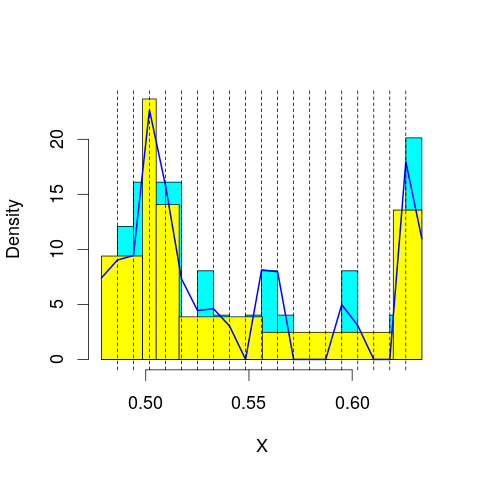

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 59.19895
mop.approx: Iteration 11. LL = 75.42172
mop.approx: Iteration 21. LL = 75.48771
mop.approx: Iteration 31. LL = 75.49409
mop.approx: Iteration 41. LL = 75.49557
mop.approx: Converged. Iteration 41. LL = 75.49564
[1] "Computing the linear combination of B-splines"


37.3725421991
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 58.99609
mop.approx: Iteration 11. LL = 73.47154
mop.approx: Iteration 21. LL = 73.5279
mop.approx: Iteration 31. LL = 73.54205
mop.approx: Iteration 41. LL = 73.54729
mop.approx: Iteration 51. LL = 73.54935
mop.approx: Converged. Iteration 57. LL = 73.55001
[1] "Computing the linear combination of B-splines"


33.6940518782
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 18.82722
mop.approx: Iteration 11. LL = 66.5409
mop.approx: Iteration 21. LL = 66.63244
mop.approx: Iteration 31. LL = 66.64166
mop.approx: Converged. Iteration 38. LL = 66.64274
[1] "Computing the linear combination of B-splines"


25.0539127205
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 13.52801
mop.approx: Iteration 11. LL = 65.32875
mop.approx: Iteration 21. LL = 65.40352
mop.approx: Iteration 31. LL = 65.41811
mop.approx: Iteration 41. LL = 65.42158
mop.approx: Iteration 51. LL = 65.42277
mop.approx: Converged. Iteration 53. LL = 65.42297
[1] "Computing the linear combination of B-splines"


22.1012669629
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.982932
mop.approx: Iteration 11. LL = 64.96753
mop.approx: Iteration 21. LL = 65.07611
mop.approx: Iteration 31. LL = 65.08852
mop.approx: Iteration 41. LL = 65.09201
mop.approx: Iteration 51. LL = 65.09316
mop.approx: Converged. Iteration 51. LL = 65.09322
[1] "Computing the linear combination of B-splines"


20.0385611415
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 5.003854
mop.approx: Iteration 11. LL = 63.31655
mop.approx: Iteration 21. LL = 63.62956
mop.approx: Iteration 31. LL = 63.69246
mop.approx: Iteration 41. LL = 63.70778
mop.approx: Iteration 51. LL = 63.7127
mop.approx: Iteration 61. LL = 63.71467
mop.approx: Iteration 71. LL = 63.71559
mop.approx: Converged. Iteration 71. LL = 63.71565
[1] "Computing the linear combination of B-splines"


16.9126083226
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 1.465287
mop.approx: Iteration 11. LL = 63.55642
mop.approx: Iteration 21. LL = 63.64726
mop.approx: Iteration 31. LL = 63.65264
mop.approx: Iteration 41. LL = 63.65472
mop.approx: Iteration 51. LL = 63.65611
mop.approx: Iteration 61. LL = 63.6571
mop.approx: Iteration 71. LL = 63.65783
mop.approx: Converged. Iteration 71. LL = 63.6579
[1] "Computing the linear combination of B-splines"


15.105066603
lfps_31
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.34265
mop.approx: Iteration 11. LL = 92.22475
mop.approx: Converged. Iteration 11. LL = 92.22484
[1] "Computing the linear combination of B-splines"


87.0262392708
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 87.026239270800687)
m reached
('Sum of Probabilities:', 0.9970595767915229)
chosen


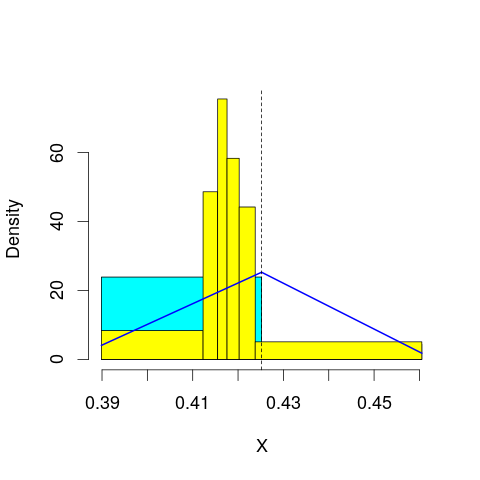

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.89923
mop.approx: Iteration 11. LL = 96.31769
mop.approx: Iteration 21. LL = 96.41177
mop.approx: Converged. Iteration 25. LL = 96.41299
[1] "Computing the linear combination of B-splines"


89.4815215425
('best: ', 87.026239270800687, 'accepted difference:', 147.94460676036115, 'cur BIC:', 89.481521542504794)
m reached
('Sum of Probabilities:', 0.9951998192529604)
chosen


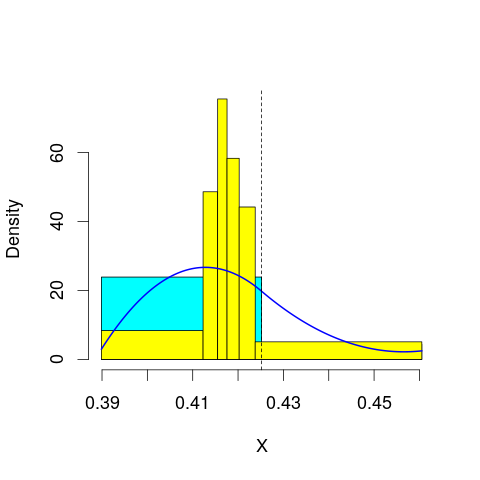

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.46188
mop.approx: Iteration 11. LL = 94.92717
mop.approx: Iteration 21. LL = 95.01866
mop.approx: Iteration 31. LL = 95.05308
mop.approx: Iteration 41. LL = 95.06811
mop.approx: Iteration 51. LL = 95.07536
mop.approx: Iteration 61. LL = 95.07912
mop.approx: Iteration 71. LL = 95.08118
mop.approx: Converged. Iteration 80. LL = 95.08236
[1] "Computing the linear combination of B-splines"


86.4180172444
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.11526
mop.approx: Iteration 11. LL = 62.17676
mop.approx: Iteration 21. LL = 62.56816
mop.approx: Iteration 31. LL = 62.64393
mop.approx: Iteration 41. LL = 62.6621
mop.approx: Iteration 51. LL = 62.66674
mop.approx: Converged. Iteration 60. LL = 62.66795
[1] "Computing the linear combination of B-splines"


52.2707408181
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.95031
mop.approx: Iteration 11. LL = 64.96552
mop.approx: Converged. Iteration 15. LL = 64.96742
[1] "Computing the linear combination of B-splines"


52.8373460731
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.78338
mop.approx: Iteration 11. LL = 55.13283
mop.approx: Iteration 21. LL = 55.62908
mop.approx: Iteration 31. LL = 55.78631
mop.approx: Iteration 41. LL = 55.83642
mop.approx: Iteration 51. LL = 55.85259
mop.approx: Iteration 61. LL = 55.85784
mop.approx: Iteration 71. LL = 55.85955
mop.approx: Converged. Iteration 75. LL = 55.8599
[1] "Computing the linear combination of B-splines"


41.9969606915
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.335914
mop.approx: Iteration 11. LL = 57.87122
mop.approx: Converged. Iteration 19. LL = 57.88929
[1] "Computing the linear combination of B-splines"


42.2934757415
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.431817
mop.approx: Iteration 11. LL = 50.34562
mop.approx: Iteration 21. LL = 50.77194
mop.approx: Iteration 31. LL = 50.96558
mop.approx: Iteration 41. LL = 51.04808
mop.approx: Iteration 51. LL = 51.08256
mop.approx: Iteration 61. LL = 51.09688
mop.approx: Iteration 71. LL = 51.10281
mop.approx: Iteration 81. LL = 51.10527
mop.approx: Iteration 91. LL = 51.10628
mop.approx: Converged. Iteration 93. LL = 51.10645
[1] "Computing the linear combination of B-splines"


33.777770938
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.34265
mop.approx: Iteration 11. LL = 101.2271
mop.approx: Converged. Iteration 20. LL = 101.2458
[1] "Computing the linear combination of B-splines"


94.3142927245
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 94.31429272452182)
m reached
('Sum of Probabilities:', 0.9973939870446338)
chosen


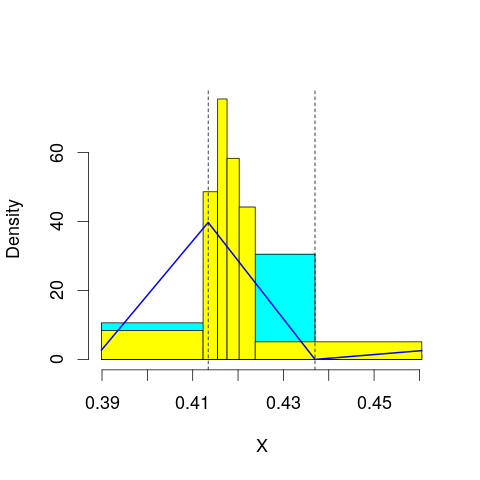

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.89923
mop.approx: Iteration 11. LL = 97.09743
mop.approx: Iteration 21. LL = 97.25271
mop.approx: Iteration 31. LL = 97.2965
mop.approx: Iteration 41. LL = 97.31484
mop.approx: Iteration 51. LL = 97.32424
mop.approx: Iteration 61. LL = 97.32966
mop.approx: Iteration 71. LL = 97.33302
mop.approx: Iteration 81. LL = 97.33521
mop.approx: Iteration 91. LL = 97.33669
mop.approx: Converged. Iteration 97. LL = 97.33744
[1] "Computing the linear combination of B-splines"


88.6730957527
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.46188
mop.approx: Iteration 11. LL = 102.2162
mop.approx: Iteration 21. LL = 102.2907
mop.approx: Converged. Iteration 23. LL = 102.2912
[1] "Computing the linear combination of B-splines"


91.8939670723
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.11526
mop.approx: Iteration 11. LL = 81.36443
mop.approx: Converged. Iteration 12. LL = 81.36468
[1] "Computing the linear combination of B-splines"


69.2346050434
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.95031
mop.approx: Iteration 11. LL = 68.09597
mop.approx: Iteration 21. LL = 68.40926
mop.approx: Iteration 31. LL = 68.46421
mop.approx: Iteration 41. LL = 68.47753
mop.approx: Iteration 51. LL = 68.48107
mop.approx: Converged. Iteration 58. LL = 68.48193
[1] "Computing the linear combination of B-splines"


54.6189822074
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.78338
mop.approx: Iteration 11. LL = 69.34986
mop.approx: Converged. Iteration 15. LL = 69.35321
[1] "Computing the linear combination of B-splines"


53.7573934395
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.335914
mop.approx: Iteration 11. LL = 59.51897
mop.approx: Iteration 21. LL = 60.01372
mop.approx: Iteration 31. LL = 60.14755
mop.approx: Iteration 41. LL = 60.18552
mop.approx: Iteration 51. LL = 60.19657
mop.approx: Iteration 61. LL = 60.1998
mop.approx: Converged. Iteration 69. LL = 60.2007
[1] "Computing the linear combination of B-splines"


42.8720231691
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.431817
mop.approx: Iteration 11. LL = 61.41014
mop.approx: Converged. Iteration 19. LL = 61.43232
[1] "Computing the linear combination of B-splines"


42.370767968
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.34265
mop.approx: Iteration 11. LL = 100.6729
mop.approx: Converged. Iteration 17. LL = 100.6775
[1] "Computing the linear combination of B-splines"


92.0131620561
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 92.013162056124344)
m reached
('Sum of Probabilities:', 0.9966518558049494)
chosen


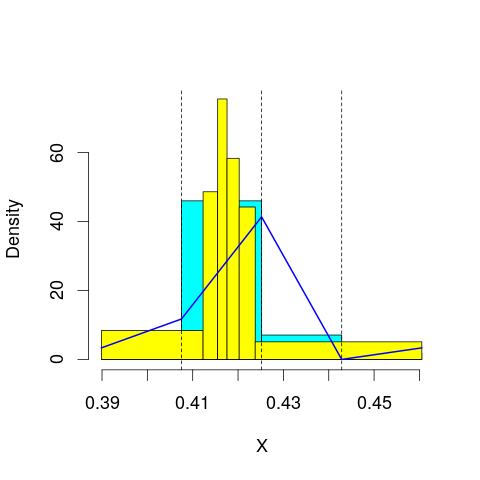

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.89923
mop.approx: Iteration 11. LL = 106.6656
mop.approx: Iteration 21. LL = 106.6935
mop.approx: Converged. Iteration 21. LL = 106.6936
[1] "Computing the linear combination of B-splines"


96.2964235011
('best: ', 92.013162056124344, 'accepted difference:', 156.42237549541139, 'cur BIC:', 96.29642350109539)
m reached
('Sum of Probabilities:', 0.9906365323719708)
chosen


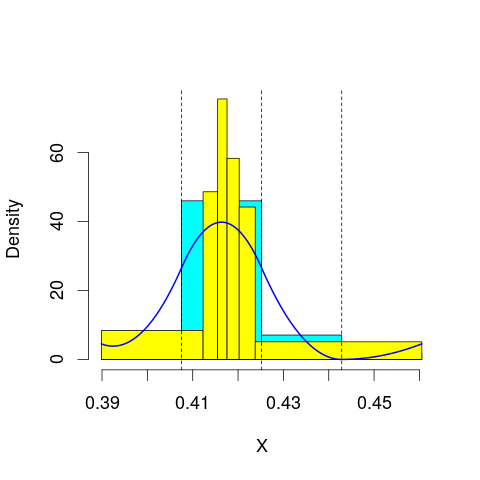

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.46188
mop.approx: Iteration 11. LL = 101.2607
mop.approx: Converged. Iteration 15. LL = 101.2615
[1] "Computing the linear combination of B-splines"


89.1314564488
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.11526
mop.approx: Iteration 11. LL = 87.43654
mop.approx: Converged. Iteration 11. LL = 87.43661
[1] "Computing the linear combination of B-splines"


73.5736678438
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.95031
mop.approx: Iteration 11. LL = 85.16451
mop.approx: Converged. Iteration 14. LL = 85.16617
[1] "Computing the linear combination of B-splines"


69.5703561148
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.78338
mop.approx: Iteration 11. LL = 72.93413
mop.approx: Iteration 21. LL = 73.1809
mop.approx: Iteration 31. LL = 73.22284
mop.approx: Iteration 41. LL = 73.23399
mop.approx: Iteration 51. LL = 73.2374
mop.approx: Converged. Iteration 59. LL = 73.23842
[1] "Computing the linear combination of B-splines"


55.9097446133
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.335914
mop.approx: Iteration 11. LL = 73.00692
mop.approx: Converged. Iteration 16. LL = 73.0128
[1] "Computing the linear combination of B-splines"


53.9512568262
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.431817
mop.approx: Iteration 11. LL = 63.35817
mop.approx: Iteration 21. LL = 63.83503
mop.approx: Iteration 31. LL = 63.94835
mop.approx: Iteration 41. LL = 63.97777
mop.approx: Iteration 51. LL = 63.98567
mop.approx: Iteration 61. LL = 63.98782
mop.approx: Converged. Iteration 65. LL = 63.9882
[1] "Computing the linear combination of B-splines"


43.1937842789
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.34265
mop.approx: Iteration 11. LL = 110.8558
mop.approx: Converged. Iteration 11. LL = 110.8559
[1] "Computing the linear combination of B-splines"


100.458674984
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 100.45867498423246)
m reached
('Sum of Probabilities:', 0.9958701293657477)
chosen


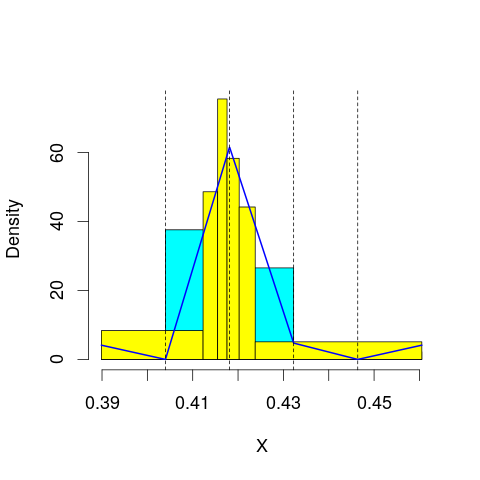

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.89923
mop.approx: Converged. Iteration 9. LL = 104.9861
[1] "Computing the linear combination of B-splines"


92.8560104389
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.46188
mop.approx: Iteration 11. LL = 109.3951
mop.approx: Iteration 21. LL = 109.4423
mop.approx: Converged. Iteration 22. LL = 109.4425
[1] "Computing the linear combination of B-splines"


95.5795710612
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.11526
mop.approx: Iteration 11. LL = 96.75259
mop.approx: Converged. Iteration 16. LL = 96.75923
[1] "Computing the linear combination of B-splines"


81.1634161762
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.95031
mop.approx: Iteration 11. LL = 91.68847
mop.approx: Converged. Iteration 11. LL = 91.68855
[1] "Computing the linear combination of B-splines"


74.3598698935
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.78338
mop.approx: Iteration 11. LL = 88.03089
mop.approx: Converged. Iteration 17. LL = 88.03839
[1] "Computing the linear combination of B-splines"


68.9768425951
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.335914
mop.approx: Iteration 11. LL = 76.97927
mop.approx: Iteration 21. LL = 77.17058
mop.approx: Iteration 31. LL = 77.20255
mop.approx: Iteration 41. LL = 77.21217
mop.approx: Iteration 51. LL = 77.21574
mop.approx: Iteration 61. LL = 77.21718
mop.approx: Converged. Iteration 63. LL = 77.21742
[1] "Computing the linear combination of B-splines"


56.4230028928
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.431817
mop.approx: Iteration 11. LL = 76.10997
mop.approx: Converged. Iteration 17. LL = 76.12011
[1] "Computing the linear combination of B-splines"


53.5928428002
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.34265
mop.approx: Iteration 11. LL = 110.372
mop.approx: Converged. Iteration 11. LL = 110.3721
[1] "Computing the linear combination of B-splines"


98.2419808197
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 98.241980819698696)
m reached
('Sum of Probabilities:', 0.9951087953744162)
chosen


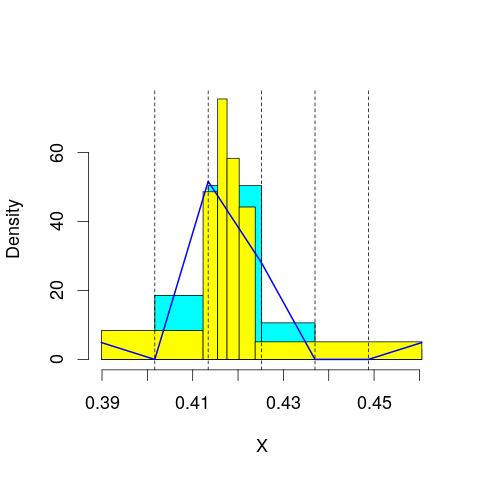

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.89923
mop.approx: Iteration 11. LL = 111.7925
mop.approx: Iteration 21. LL = 111.9037
mop.approx: Iteration 31. LL = 111.9127
mop.approx: Iteration 41. LL = 111.9154
mop.approx: Converged. Iteration 45. LL = 111.9161
[1] "Computing the linear combination of B-splines"


98.0531071355
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.46188
mop.approx: Iteration 11. LL = 108.3185
mop.approx: Converged. Iteration 12. LL = 108.3187
[1] "Computing the linear combination of B-splines"


92.7228562411
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.11526
mop.approx: Iteration 11. LL = 105.9909
mop.approx: Iteration 21. LL = 106.0225
mop.approx: Converged. Iteration 21. LL = 106.0226
[1] "Computing the linear combination of B-splines"


88.6938962647
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.95031
mop.approx: Iteration 11. LL = 97.20764
mop.approx: Iteration 21. LL = 97.23195
mop.approx: Converged. Iteration 23. LL = 97.23226
[1] "Computing the linear combination of B-splines"


78.1707115667
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.78338
mop.approx: Iteration 11. LL = 94.90692
mop.approx: Converged. Iteration 14. LL = 94.90748
[1] "Computing the linear combination of B-splines"


74.1130700033
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.335914
mop.approx: Iteration 11. LL = 90.21172
mop.approx: Converged. Iteration 20. LL = 90.2371
[1] "Computing the linear combination of B-splines"


67.7097848121
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.431817
mop.approx: Iteration 11. LL = 80.41614
mop.approx: Iteration 21. LL = 80.56092
mop.approx: Iteration 31. LL = 80.58363
mop.approx: Iteration 41. LL = 80.59096
mop.approx: Iteration 51. LL = 80.59416
mop.approx: Iteration 61. LL = 80.59578
mop.approx: Converged. Iteration 68. LL = 80.59653
[1] "Computing the linear combination of B-splines"


56.3363403682
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.34265
mop.approx: Converged. Iteration 9. LL = 109.4931
[1] "Computing the linear combination of B-splines"


95.6301427425
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 95.630142742532954)
m reached
('Sum of Probabilities:', 0.9943670661556901)
chosen


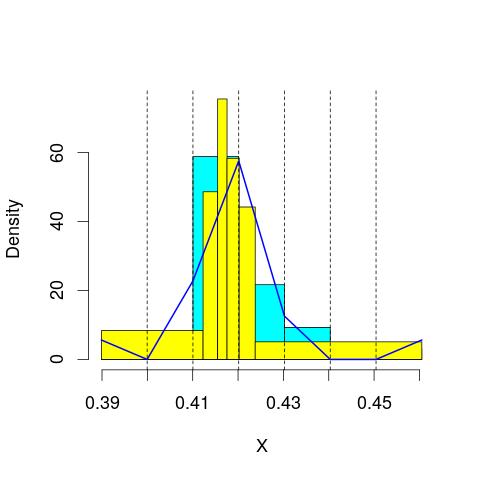

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.89923
mop.approx: Iteration 11. LL = 112.6293
mop.approx: Converged. Iteration 18. LL = 112.6356
[1] "Computing the linear combination of B-splines"


97.0397987887
('best: ', 95.630142742532954, 'accepted difference:', 162.57124266230602, 'cur BIC:', 97.039798788745074)
m reached
('Sum of Probabilities:', 0.9849640240865419)
chosen


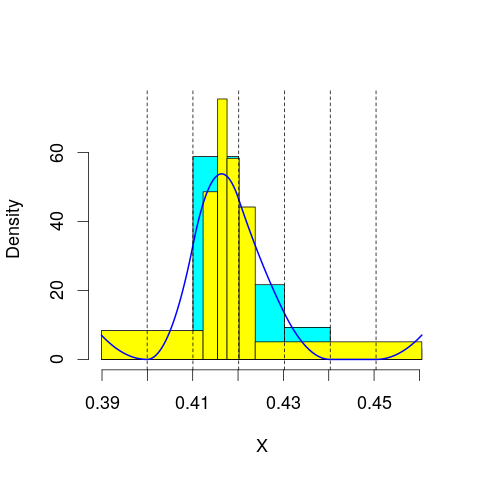

('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.46188
mop.approx: Iteration 11. LL = 111.0033
mop.approx: Iteration 21. LL = 111.2249
mop.approx: Iteration 31. LL = 111.2622
mop.approx: Iteration 41. LL = 111.2718
mop.approx: Iteration 51. LL = 111.2751
mop.approx: Converged. Iteration 60. LL = 111.2766
[1] "Computing the linear combination of B-splines"


93.9478756056
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.11526
mop.approx: Iteration 11. LL = 105.8449
mop.approx: Converged. Iteration 15. LL = 105.8471
[1] "Computing the linear combination of B-splines"


86.7855555287
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.95031
mop.approx: Iteration 11. LL = 106.1049
mop.approx: Iteration 21. LL = 106.1461
mop.approx: Converged. Iteration 22. LL = 106.1463
[1] "Computing the linear combination of B-splines"


85.3519274185
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.78338
mop.approx: Iteration 11. LL = 97.8624
mop.approx: Iteration 21. LL = 97.8991
mop.approx: Iteration 31. LL = 97.92607
mop.approx: Iteration 41. LL = 97.94519
mop.approx: Iteration 51. LL = 97.95522
mop.approx: Iteration 61. LL = 97.95972
mop.approx: Iteration 71. LL = 97.9616
mop.approx: Converged. Iteration 73. LL = 97.96191
[1] "Computing the linear combination of B-splines"


75.4345949375
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.335914
mop.approx: Iteration 11. LL = 97.37837
mop.approx: Converged. Iteration 11. LL = 97.37842
[1] "Computing the linear combination of B-splines"


73.1185843371
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.431817
mop.approx: Iteration 11. LL = 91.85532
mop.approx: Iteration 21. LL = 91.92046
mop.approx: Converged. Iteration 25. LL = 91.92131
[1] "Computing the linear combination of B-splines"


65.9273459554
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.34265
mop.approx: Iteration 11. LL = 114.4612
mop.approx: Converged. Iteration 17. LL = 114.4677
[1] "Computing the linear combination of B-splines"


98.8719065895
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 98.871906589472786)
m reached
('Sum of Probabilities:', 0.9936441940847774)
chosen


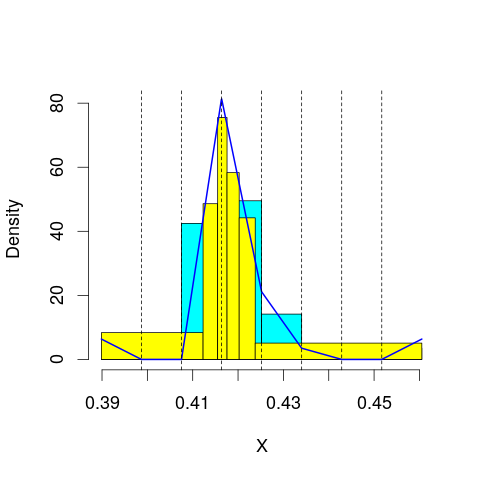

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.89923
mop.approx: Iteration 11. LL = 111.5123
mop.approx: Converged. Iteration 11. LL = 111.5123
[1] "Computing the linear combination of B-splines"


94.1836566514
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.46188
mop.approx: Iteration 11. LL = 113.2256
mop.approx: Iteration 21. LL = 113.2572
mop.approx: Iteration 31. LL = 113.2605
mop.approx: Converged. Iteration 31. LL = 113.2606
[1] "Computing the linear combination of B-splines"


94.1990846561
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.11526
mop.approx: Iteration 11. LL = 106.3114
mop.approx: Iteration 21. LL = 106.4376
mop.approx: Iteration 31. LL = 106.4596
mop.approx: Iteration 41. LL = 106.466
mop.approx: Iteration 51. LL = 106.4684
mop.approx: Converged. Iteration 54. LL = 106.4689
[1] "Computing the linear combination of B-splines"


85.6744678863
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.95031
mop.approx: Iteration 11. LL = 107.0032
mop.approx: Iteration 21. LL = 107.0151
mop.approx: Converged. Iteration 21. LL = 107.0152
[1] "Computing the linear combination of B-splines"


84.4878772027
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.78338
mop.approx: Iteration 11. LL = 105.7078
mop.approx: Iteration 21. LL = 105.7567
mop.approx: Converged. Iteration 26. LL = 105.7577
[1] "Computing the linear combination of B-splines"


81.4973427954
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.335914
mop.approx: Iteration 11. LL = 98.9791
mop.approx: Iteration 21. LL = 99.09366
mop.approx: Iteration 31. LL = 99.10542
mop.approx: Converged. Iteration 35. LL = 99.10613
[1] "Computing the linear combination of B-splines"


73.1138659226
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.431817
mop.approx: Iteration 11. LL = 99.33658
mop.approx: Iteration 21. LL = 99.40659
mop.approx: Iteration 31. LL = 99.4443
mop.approx: Iteration 41. LL = 99.46143
mop.approx: Iteration 51. LL = 99.46982
mop.approx: Iteration 61. LL = 99.47425
mop.approx: Iteration 71. LL = 99.4767
mop.approx: Iteration 81. LL = 99.4781
mop.approx: Converged. Iteration 82. LL = 99.4783
[1] "Computing the linear combination of B-splines"


71.7527087553
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.34265
mop.approx: Converged. Iteration 9. LL = 113.722
[1] "Computing the linear combination of B-splines"


96.3933194303
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 96.393319430323047)
m reached
('Sum of Probabilities:', 0.9929394690738336)
chosen


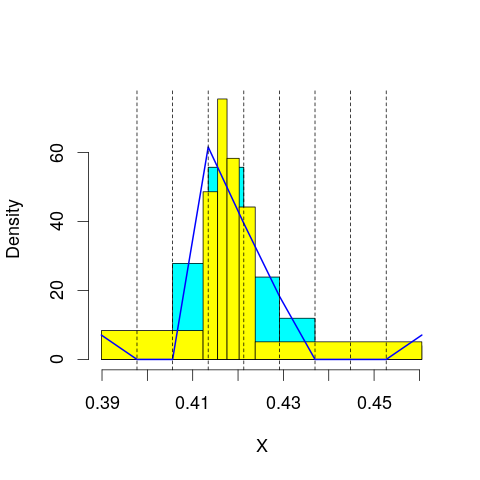

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.89923
mop.approx: Iteration 11. LL = 113.4511
mop.approx: Iteration 21. LL = 113.5367
mop.approx: Iteration 31. LL = 113.554
mop.approx: Iteration 41. LL = 113.5593
mop.approx: Iteration 51. LL = 113.5615
mop.approx: Converged. Iteration 55. LL = 113.5621
[1] "Computing the linear combination of B-splines"


94.5005573508
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.46188
mop.approx: Iteration 11. LL = 112.5605
mop.approx: Converged. Iteration 12. LL = 112.5608
[1] "Computing the linear combination of B-splines"


91.7663941478
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.11526
mop.approx: Iteration 11. LL = 108.3476
mop.approx: Iteration 21. LL = 108.4815
mop.approx: Iteration 31. LL = 108.4905
mop.approx: Converged. Iteration 35. LL = 108.4912
[1] "Computing the linear combination of B-splines"


85.9639307967
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.95031
mop.approx: Iteration 11. LL = 106.7439
mop.approx: Iteration 21. LL = 106.7955
mop.approx: Iteration 31. LL = 106.8052
mop.approx: Iteration 41. LL = 106.8079
mop.approx: Converged. Iteration 44. LL = 106.8083
[1] "Computing the linear combination of B-splines"


82.5481618193
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.78338
mop.approx: Iteration 11. LL = 107.4704
mop.approx: Iteration 21. LL = 107.5035
mop.approx: Iteration 31. LL = 107.509
mop.approx: Converged. Iteration 35. LL = 107.5097
[1] "Computing the linear combination of B-splines"


81.5165341414
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.335914
mop.approx: Iteration 11. LL = 105.1748
mop.approx: Iteration 21. LL = 105.3082
mop.approx: Iteration 31. LL = 105.3194
mop.approx: Converged. Iteration 37. LL = 105.3208
[1] "Computing the linear combination of B-splines"


77.5884736486
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.431817
mop.approx: Iteration 11. LL = 100.0327
mop.approx: Iteration 21. LL = 100.1084
mop.approx: Converged. Iteration 27. LL = 100.1108
[1] "Computing the linear combination of B-splines"


70.5736202588
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.34265
mop.approx: Iteration 11. LL = 114.1898
mop.approx: Iteration 21. LL = 114.2024
mop.approx: Converged. Iteration 24. LL = 114.2029
[1] "Computing the linear combination of B-splines"


95.1413660502
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 95.141366050159661)
m reached
('Sum of Probabilities:', 0.9922522162452476)
chosen


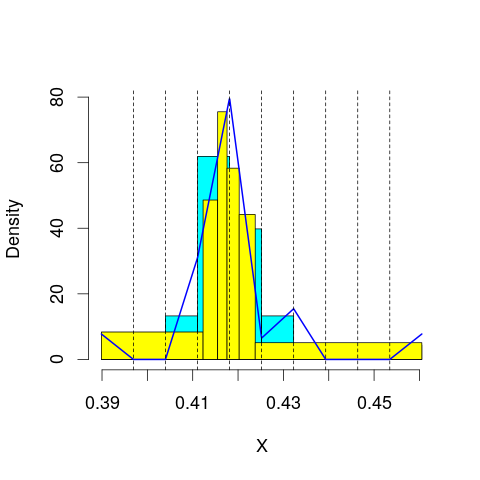

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.89923
mop.approx: Iteration 11. LL = 114.9207
mop.approx: Converged. Iteration 15. LL = 114.924
[1] "Computing the linear combination of B-splines"


94.1296021672
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.46188
mop.approx: Iteration 11. LL = 113.1143
mop.approx: Iteration 21. LL = 113.2083
mop.approx: Iteration 31. LL = 113.2358
mop.approx: Iteration 41. LL = 113.2467
mop.approx: Iteration 51. LL = 113.2519
mop.approx: Iteration 61. LL = 113.2548
mop.approx: Iteration 71. LL = 113.2566
mop.approx: Converged. Iteration 76. LL = 113.2573
[1] "Computing the linear combination of B-splines"


90.7300236958
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.11526
mop.approx: Iteration 11. LL = 108.8365
mop.approx: Iteration 21. LL = 108.8573
mop.approx: Converged. Iteration 23. LL = 108.8577
[1] "Computing the linear combination of B-splines"


84.5975425437
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.95031
mop.approx: Iteration 11. LL = 107.7618
mop.approx: Iteration 21. LL = 107.919
mop.approx: Iteration 31. LL = 107.972
mop.approx: Iteration 41. LL = 108.0025
mop.approx: Iteration 51. LL = 108.0219
mop.approx: Iteration 61. LL = 108.0346
mop.approx: Iteration 71. LL = 108.0431
mop.approx: Iteration 81. LL = 108.049
mop.approx: Iteration 91. LL = 108.0531
mop.approx: Iteration 101. LL = 108.056
mop.approx: Iteration 111. LL = 108.0581
mop.approx: Iteration 121. LL = 108.0597
mop.approx: Converged. Iteration 128. LL = 108.0606
[1] "Computing the linear combination of B-splines"


82.0675700504
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.78338
mop.approx: Iteration 11. LL = 107.3237
mop.approx: Iteration 21. LL = 107.3455
mop.approx: Converged. Iteration 27. LL = 107.3472
[1] "Computing the linear combination of B-splines"


79.6204620212
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.335914
mop.approx: Iteration 11. LL = 107.5431
mop.approx: Iteration 21. LL = 107.5652
mop.approx: Iteration 31. LL = 107.5736
mop.approx: Iteration 41. LL = 107.5789
mop.approx: Iteration 51. LL = 107.5821
mop.approx: Iteration 61. LL = 107.5841
mop.approx: Converged. Iteration 67. LL = 107.5849
[1] "Computing the linear combination of B-splines"


78.1350732703
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.431817
mop.approx: Iteration 11. LL = 104.703
mop.approx: Iteration 21. LL = 104.8601
mop.approx: Converged. Iteration 27. LL = 104.8631
[1] "Computing the linear combination of B-splines"


73.7400121978
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.34265
mop.approx: Iteration 11. LL = 114.3926
mop.approx: Converged. Iteration 19. LL = 114.4013
[1] "Computing the linear combination of B-splines"


93.6068471345
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 93.606847134462456)
m reached
('Sum of Probabilities:', 0.9915817937760566)
chosen


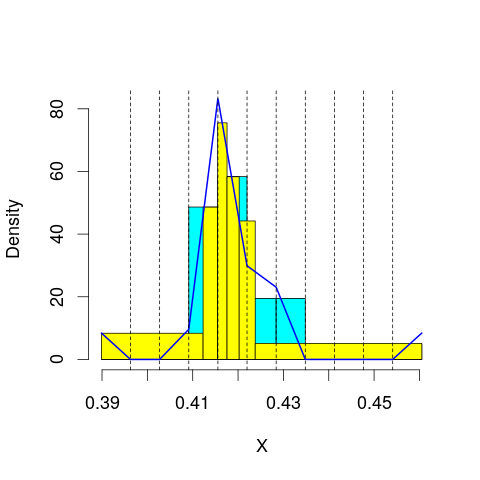

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.89923
mop.approx: Iteration 11. LL = 114.9151
mop.approx: Iteration 21. LL = 114.9747
mop.approx: Iteration 31. LL = 114.9893
mop.approx: Iteration 41. LL = 114.995
mop.approx: Iteration 51. LL = 114.9979
mop.approx: Iteration 61. LL = 114.9995
mop.approx: Converged. Iteration 64. LL = 115
[1] "Computing the linear combination of B-splines"


92.4727254207
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.46188
mop.approx: Iteration 11. LL = 114.9661
mop.approx: Iteration 21. LL = 115.0691
mop.approx: Converged. Iteration 26. LL = 115.0711
[1] "Computing the linear combination of B-splines"


90.8109052941
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.11526
mop.approx: Iteration 11. LL = 108.6947
mop.approx: Iteration 21. LL = 108.7942
mop.approx: Iteration 31. LL = 108.8317
mop.approx: Iteration 41. LL = 108.8491
mop.approx: Iteration 51. LL = 108.8584
mop.approx: Iteration 61. LL = 108.8637
mop.approx: Iteration 71. LL = 108.8671
mop.approx: Iteration 81. LL = 108.8692
mop.approx: Iteration 91. LL = 108.8706
mop.approx: Converged. Iteration 92. LL = 108.8708
[1] "Computing the linear combination of B-splines"


82.8777894499
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.95031
mop.approx: Iteration 11. LL = 109.2577
mop.approx: Iteration 21. LL = 109.4263
mop.approx: Iteration 31. LL = 109.4428
mop.approx: Iteration 41. LL = 109.4463
mop.approx: Converged. Iteration 44. LL = 109.4468
[1] "Computing the linear combination of B-splines"


81.7209262343
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.78338
mop.approx: Iteration 11. LL = 107.535
mop.approx: Iteration 21. LL = 107.6266
mop.approx: Iteration 31. LL = 107.6637
mop.approx: Iteration 41. LL = 107.6871
mop.approx: Iteration 51. LL = 107.7023
mop.approx: Iteration 61. LL = 107.7125
mop.approx: Iteration 71. LL = 107.7195
mop.approx: Iteration 81. LL = 107.7245
mop.approx: Iteration 91. LL = 107.7281
mop.approx: Iteration 101. LL = 107.7308
mop.approx: Iteration 111. LL = 107.7328
mop.approx: Iteration 121. LL = 107.7343
mop.approx: Converged. Iteration 129. LL = 107.7354
[1] "Computing the linear combination of B-splines"


78.2764298558
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.335914
mop.approx: Iteration 11. LL = 107.8477
mop.approx: Iteration 21. LL = 107.8922
mop.approx: Iteration 31. LL = 107.9055
mop.approx: Iteration 41. LL = 107.9113
mop.approx: Iteration 51. LL = 107.9145
mop.approx: Iteration 61. LL = 107.9165
mop.approx: Iteration 71. LL = 107.9179
mop.approx: Converged. Iteration 74. LL = 107.9184
[1] "Computing the linear combination of B-splines"


76.723912142
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.431817
mop.approx: Iteration 11. LL = 105.2608
mop.approx: Iteration 21. LL = 105.3087
mop.approx: Converged. Iteration 27. LL = 105.3104
[1] "Computing the linear combination of B-splines"


49.7609326427
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.34265
mop.approx: Iteration 11. LL = 116.5238
mop.approx: Iteration 21. LL = 116.564
mop.approx: Iteration 31. LL = 116.5736
mop.approx: Iteration 41. LL = 116.5774
mop.approx: Iteration 51. LL = 116.5792
mop.approx: Converged. Iteration 53. LL = 116.5796
[1] "Computing the linear combination of B-splines"


94.0523054942
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 94.052305494209392)
m reached
('Sum of Probabilities:', 0.990927590898629)
chosen


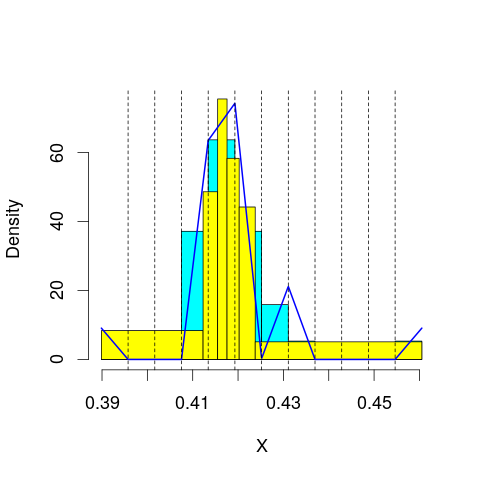

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.89923
mop.approx: Iteration 11. LL = 114.6558
mop.approx: Iteration 21. LL = 114.7012
mop.approx: Iteration 31. LL = 114.7078
mop.approx: Converged. Iteration 36. LL = 114.7088
[1] "Computing the linear combination of B-splines"


90.4486456853
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.46188
mop.approx: Iteration 11. LL = 114.9738
mop.approx: Iteration 21. LL = 115.0558
mop.approx: Iteration 31. LL = 115.0805
mop.approx: Iteration 41. LL = 115.0905
mop.approx: Iteration 51. LL = 115.0951
mop.approx: Iteration 61. LL = 115.0974
mop.approx: Converged. Iteration 66. LL = 115.0981
[1] "Computing the linear combination of B-splines"


89.1051228331
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.11526
mop.approx: Iteration 11. LL = 110.0681
mop.approx: Iteration 21. LL = 110.4006
mop.approx: Iteration 31. LL = 110.4697
mop.approx: Iteration 41. LL = 110.4917
mop.approx: Iteration 51. LL = 110.5003
mop.approx: Iteration 61. LL = 110.504
mop.approx: Iteration 71. LL = 110.5059
mop.approx: Converged. Iteration 74. LL = 110.5063
[1] "Computing the linear combination of B-splines"


82.7804510435
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.95031
mop.approx: Iteration 11. LL = 109.0174
mop.approx: Iteration 21. LL = 109.0954
mop.approx: Iteration 31. LL = 109.1296
mop.approx: Iteration 41. LL = 109.1472
mop.approx: Iteration 51. LL = 109.1571
mop.approx: Iteration 61. LL = 109.1629
mop.approx: Iteration 71. LL = 109.1664
mop.approx: Iteration 81. LL = 109.1687
mop.approx: Iteration 91. LL = 109.1701
mop.approx: Converged. Iteration 92. LL = 109.1703
[1] "Computing the linear combination of B-splines"


79.7115805812
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.78338
mop.approx: Iteration 11. LL = 109.0834
mop.approx: Iteration 21. LL = 109.5599
mop.approx: Iteration 31. LL = 109.6523
mop.approx: Iteration 41. LL = 109.6794
mop.approx: Iteration 51. LL = 109.6911
mop.approx: Iteration 61. LL = 109.6972
mop.approx: Iteration 71. LL = 109.7007
mop.approx: Iteration 81. LL = 109.7028
mop.approx: Converged. Iteration 89. LL = 109.704
[1] "Computing the linear combination of B-splines"


78.5118411759
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.335914
mop.approx: Iteration 11. LL = 107.7535
mop.approx: Iteration 21. LL = 107.7871
mop.approx: Iteration 31. LL = 107.809
mop.approx: Iteration 41. LL = 107.8246
mop.approx: Iteration 51. LL = 107.8356
mop.approx: Iteration 61. LL = 107.8435
mop.approx: Iteration 71. LL = 107.8491
mop.approx: Iteration 81. LL = 107.8532
mop.approx: Iteration 91. LL = 107.8563
mop.approx: Iteration 101. LL = 107.8586
mop.approx: Iteration 111. LL = 107.8605
mop.approx: Iteration 121. LL = 107.8619
mop.approx: Converged. Iteration 130. LL = 107.8631
[1] "Computing the linear combination of B-splines"


74.9416736602
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.431817
mop.approx: Iteration 11. LL = 108.3878
mop.approx: Iteration 21. LL = 108.7252
mop.approx: Iteration 31. LL = 108.7843
mop.approx: Iteration 41. LL = 108.796
mop.approx: Iteration 51. LL = 108.7984
mop.approx: Converged. Iteration 51. LL = 108.7985
[1] "Computing the linear combination of B-splines"


50.923706262
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.34265
mop.approx: Converged. Iteration 9. LL = 115.2054
[1] "Computing the linear combination of B-splines"


90.9452224042
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 90.945222404245698)
m reached
('Sum of Probabilities:', 0.9902890260448324)
chosen


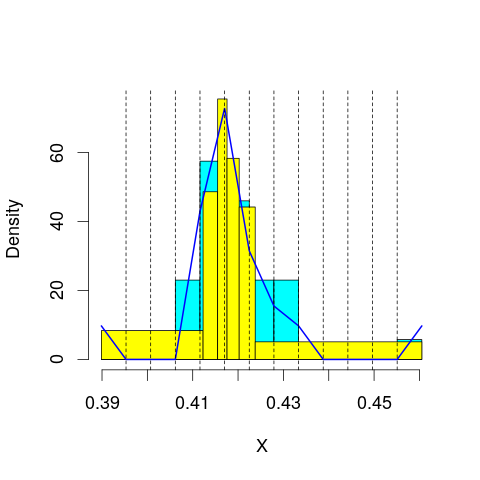

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.89923
mop.approx: Iteration 11. LL = 116.251
mop.approx: Iteration 21. LL = 116.337
mop.approx: Iteration 31. LL = 116.354
mop.approx: Iteration 41. LL = 116.3598
mop.approx: Iteration 51. LL = 116.3624
mop.approx: Converged. Iteration 58. LL = 116.3635
[1] "Computing the linear combination of B-splines"


90.3705016642
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.46188
mop.approx: Iteration 11. LL = 114.5832
mop.approx: Iteration 21. LL = 114.6593
mop.approx: Iteration 31. LL = 114.6786
mop.approx: Iteration 41. LL = 114.6855
mop.approx: Iteration 51. LL = 114.6885
mop.approx: Converged. Iteration 59. LL = 114.6898
[1] "Computing the linear combination of B-splines"


86.9639468454
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.11526
mop.approx: Iteration 11. LL = 110.5717
mop.approx: Iteration 21. LL = 110.6633
mop.approx: Iteration 31. LL = 110.687
mop.approx: Iteration 41. LL = 110.6977
mop.approx: Iteration 51. LL = 110.7031
mop.approx: Iteration 61. LL = 110.7059
mop.approx: Iteration 71. LL = 110.7074
mop.approx: Converged. Iteration 71. LL = 110.7075
[1] "Computing the linear combination of B-splines"


81.2487580407
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.95031
mop.approx: Iteration 11. LL = 109.7077
mop.approx: Iteration 21. LL = 110.0367
mop.approx: Iteration 31. LL = 110.1242
mop.approx: Iteration 41. LL = 110.1508
mop.approx: Iteration 51. LL = 110.16
mop.approx: Iteration 61. LL = 110.1635
mop.approx: Converged. Iteration 68. LL = 110.1647
[1] "Computing the linear combination of B-splines"


78.9730607397
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.78338
mop.approx: Iteration 11. LL = 109.3012
mop.approx: Iteration 21. LL = 109.386
mop.approx: Iteration 31. LL = 109.409
mop.approx: Iteration 41. LL = 109.4225
mop.approx: Iteration 51. LL = 109.431
mop.approx: Iteration 61. LL = 109.4365
mop.approx: Iteration 71. LL = 109.4401
mop.approx: Iteration 81. LL = 109.4425
mop.approx: Iteration 91. LL = 109.4442
mop.approx: Converged. Iteration 97. LL = 109.445
[1] "Computing the linear combination of B-splines"


76.5208220291
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.335914
mop.approx: Iteration 11. LL = 108.6454
mop.approx: Iteration 21. LL = 109.18
mop.approx: Iteration 31. LL = 109.357
mop.approx: Iteration 41. LL = 109.417
mop.approx: Iteration 51. LL = 109.4388
mop.approx: Iteration 61. LL = 109.4474
mop.approx: Iteration 71. LL = 109.4511
mop.approx: Iteration 81. LL = 109.4529
mop.approx: Converged. Iteration 83. LL = 109.4532
[1] "Computing the linear combination of B-splines"


74.7810875821
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.431817
mop.approx: Iteration 11. LL = 108.7382
mop.approx: Iteration 21. LL = 109.0721
mop.approx: Iteration 31. LL = 109.1564
mop.approx: Iteration 41. LL = 109.1849
mop.approx: Iteration 51. LL = 109.1952
mop.approx: Iteration 61. LL = 109.1991
mop.approx: Converged. Iteration 69. LL = 109.2006
[1] "Computing the linear combination of B-splines"


71.9796942847
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.34265
mop.approx: Iteration 11. LL = 116.6866
mop.approx: Iteration 21. LL = 116.7304
mop.approx: Iteration 31. LL = 116.736
mop.approx: Converged. Iteration 34. LL = 116.7366
[1] "Computing the linear combination of B-splines"


90.7435410295
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 90.743541029529808)
m reached
('Sum of Probabilities:', 0.9896655451217241)
chosen


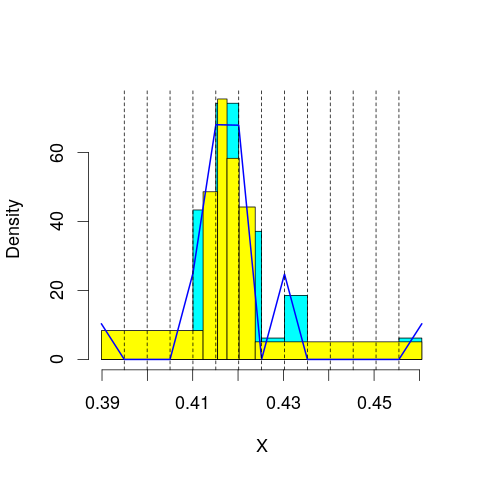

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.89923
mop.approx: Iteration 11. LL = 115.6478
mop.approx: Converged. Iteration 14. LL = 115.6489
[1] "Computing the linear combination of B-splines"


87.9229852208
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.46188
mop.approx: Iteration 11. LL = 115.5458
mop.approx: Iteration 21. LL = 115.6179
mop.approx: Iteration 31. LL = 115.6335
mop.approx: Iteration 41. LL = 115.6387
mop.approx: Converged. Iteration 50. LL = 115.6406
[1] "Computing the linear combination of B-splines"


86.1818126025
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.11526
mop.approx: Iteration 11. LL = 110.2695
mop.approx: Iteration 21. LL = 110.3425
mop.approx: Iteration 31. LL = 110.369
mop.approx: Iteration 41. LL = 110.381
mop.approx: Iteration 51. LL = 110.3871
mop.approx: Iteration 61. LL = 110.3905
mop.approx: Iteration 71. LL = 110.3926
mop.approx: Converged. Iteration 80. LL = 110.3939
[1] "Computing the linear combination of B-splines"


79.2022669368
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.95031
mop.approx: Iteration 11. LL = 110.4898
mop.approx: Iteration 21. LL = 110.6631
mop.approx: Iteration 31. LL = 110.6919
mop.approx: Iteration 41. LL = 110.7019
mop.approx: Iteration 51. LL = 110.7069
mop.approx: Iteration 61. LL = 110.7099
mop.approx: Iteration 71. LL = 110.7117
mop.approx: Converged. Iteration 76. LL = 110.7124
[1] "Computing the linear combination of B-splines"


77.7879060547
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.78338
mop.approx: Iteration 11. LL = 109.5287
mop.approx: Iteration 21. LL = 109.7733
mop.approx: Iteration 31. LL = 109.864
mop.approx: Iteration 41. LL = 109.8987
mop.approx: Iteration 51. LL = 109.9119
mop.approx: Iteration 61. LL = 109.9171
mop.approx: Iteration 71. LL = 109.9191
mop.approx: Converged. Iteration 72. LL = 109.9193
[1] "Computing the linear combination of B-splines"


75.2616951313
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.335914
mop.approx: Iteration 11. LL = 109.3081
mop.approx: Iteration 21. LL = 109.5251
mop.approx: Iteration 31. LL = 109.5397
mop.approx: Iteration 41. LL = 109.5441
mop.approx: Iteration 51. LL = 109.5472
mop.approx: Iteration 61. LL = 109.5495
mop.approx: Iteration 71. LL = 109.5514
mop.approx: Iteration 81. LL = 109.5529
mop.approx: Iteration 91. LL = 109.5541
mop.approx: Converged. Iteration 91. LL = 109.5542
[1] "Computing the linear combination of B-splines"


73.1330538108
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.431817
mop.approx: Iteration 11. LL = 107.3453
mop.approx: Iteration 21. LL = 107.9463
mop.approx: Iteration 31. LL = 108.039
mop.approx: Iteration 41. LL = 108.0542
mop.approx: Iteration 51. LL = 108.0571
mop.approx: Converged. Iteration 52. LL = 108.0573
[1] "Computing the linear combination of B-splines"


69.8712955886
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.34265
mop.approx: Iteration 11. LL = 116.1376
mop.approx: Iteration 21. LL = 116.1737
mop.approx: Iteration 31. LL = 116.1809
mop.approx: Iteration 41. LL = 116.1834
mop.approx: Converged. Iteration 44. LL = 116.1839
[1] "Computing the linear combination of B-splines"


88.4580254123
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 88.458025412256475)
m reached
('Sum of Probabilities:', 0.989056619907877)
chosen


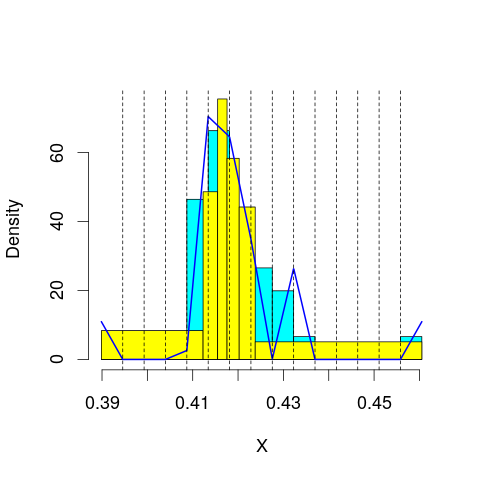

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.89923
mop.approx: Iteration 11. LL = 116.5748
mop.approx: Iteration 21. LL = 116.6419
mop.approx: Iteration 31. LL = 116.6526
mop.approx: Converged. Iteration 38. LL = 116.6544
[1] "Computing the linear combination of B-splines"


87.1956739894
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.46188
mop.approx: Iteration 11. LL = 115.4008
mop.approx: Iteration 21. LL = 115.4426
mop.approx: Iteration 31. LL = 115.4473
mop.approx: Converged. Iteration 39. LL = 115.4488
[1] "Computing the linear combination of B-splines"


84.2571848257
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.11526
mop.approx: Iteration 11. LL = 110.9115
mop.approx: Iteration 21. LL = 110.9839
mop.approx: Iteration 31. LL = 111.0019
mop.approx: Iteration 41. LL = 111.0076
mop.approx: Converged. Iteration 50. LL = 111.0095
[1] "Computing the linear combination of B-splines"


78.0849610046
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.95031
mop.approx: Iteration 11. LL = 110.4198
mop.approx: Iteration 21. LL = 110.4799
mop.approx: Iteration 31. LL = 110.4985
mop.approx: Iteration 41. LL = 110.5092
mop.approx: Iteration 51. LL = 110.5156
mop.approx: Iteration 61. LL = 110.5197
mop.approx: Iteration 71. LL = 110.5224
mop.approx: Iteration 81. LL = 110.5243
mop.approx: Iteration 91. LL = 110.5256
mop.approx: Converged. Iteration 92. LL = 110.5258
[1] "Computing the linear combination of B-splines"


75.8684589272
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.78338
mop.approx: Iteration 11. LL = 110.2488
mop.approx: Iteration 21. LL = 110.4439
mop.approx: Iteration 31. LL = 110.4851
mop.approx: Iteration 41. LL = 110.5006
mop.approx: Iteration 51. LL = 110.5083
mop.approx: Iteration 61. LL = 110.5126
mop.approx: Iteration 71. LL = 110.5154
mop.approx: Iteration 81. LL = 110.5172
mop.approx: Converged. Iteration 89. LL = 110.5183
[1] "Computing the linear combination of B-splines"


74.1266527969
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.335914
mop.approx: Iteration 11. LL = 109.4541
mop.approx: Iteration 21. LL = 109.6252
mop.approx: Iteration 31. LL = 109.6952
mop.approx: Iteration 41. LL = 109.7315
mop.approx: Iteration 51. LL = 109.7502
mop.approx: Iteration 61. LL = 109.7599
mop.approx: Iteration 71. LL = 109.7649
mop.approx: Iteration 81. LL = 109.7677
mop.approx: Iteration 91. LL = 109.7692
mop.approx: Converged. Iteration 92. LL = 109.7694
[1] "Computing the linear combination of B-splines"


71.5778796714
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.431817
[1] "Computing the linear combination of B-splines"


86.6741611299
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.34265
mop.approx: Iteration 11. LL = 117.8239
mop.approx: Iteration 21. LL = 117.8739
mop.approx: Iteration 31. LL = 117.8783
mop.approx: Converged. Iteration 31. LL = 117.8784
[1] "Computing the linear combination of B-splines"


88.4196197462
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 88.419619746224726)
m reached
('Sum of Probabilities:', 0.9884617465609107)
chosen


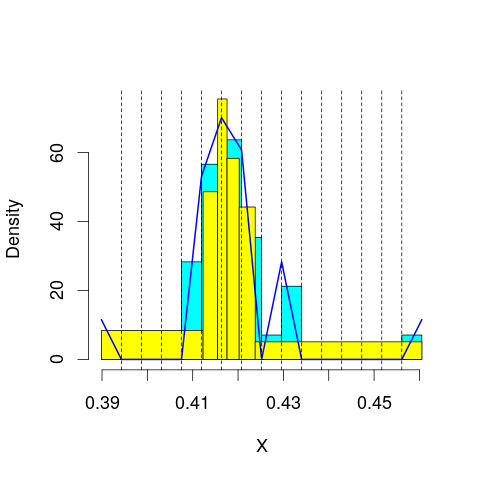

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.89923
mop.approx: Iteration 11. LL = 116.3169
mop.approx: Iteration 21. LL = 116.3617
mop.approx: Iteration 31. LL = 116.3676
mop.approx: Converged. Iteration 34. LL = 116.3681
[1] "Computing the linear combination of B-splines"


85.1764967807
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.46188
mop.approx: Iteration 11. LL = 116.1524
mop.approx: Iteration 21. LL = 116.2436
mop.approx: Iteration 31. LL = 116.252
mop.approx: Converged. Iteration 34. LL = 116.2526
[1] "Computing the linear combination of B-splines"


83.3281149754
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.11526
mop.approx: Iteration 11. LL = 110.9177
mop.approx: Iteration 21. LL = 111.0205
mop.approx: Iteration 31. LL = 111.0551
mop.approx: Iteration 41. LL = 111.0691
mop.approx: Iteration 51. LL = 111.0755
mop.approx: Iteration 61. LL = 111.0788
mop.approx: Iteration 71. LL = 111.0807
mop.approx: Converged. Iteration 77. LL = 111.0815
[1] "Computing the linear combination of B-splines"


76.4241599751
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.95031
mop.approx: Iteration 11. LL = 110.8934
mop.approx: Iteration 21. LL = 110.9853
mop.approx: Iteration 31. LL = 111.005
mop.approx: Iteration 41. LL = 111.0108
mop.approx: Converged. Iteration 49. LL = 111.0124
[1] "Computing the linear combination of B-splines"


74.6221867687
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.78338
mop.approx: Iteration 11. LL = 110.3978
mop.approx: Iteration 21. LL = 110.5005
mop.approx: Iteration 31. LL = 110.5128
mop.approx: Iteration 41. LL = 110.517
mop.approx: Iteration 51. LL = 110.5197
mop.approx: Iteration 61. LL = 110.5216
mop.approx: Iteration 71. LL = 110.5231
mop.approx: Converged. Iteration 77. LL = 110.5239
[1] "Computing the linear combination of B-splines"


72.4031237654
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.335914
mop.approx: Iteration 11. LL = 110.0722
mop.approx: Iteration 21. LL = 110.2751
mop.approx: Iteration 31. LL = 110.3078
mop.approx: Iteration 41. LL = 110.317
mop.approx: Iteration 51. LL = 110.3205
mop.approx: Iteration 61. LL = 110.3222
mop.approx: Converged. Iteration 64. LL = 110.3227
[1] "Computing the linear combination of B-splines"


70.5637377259
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.431817
mop.approx: Iteration 11. LL = 117.1931
mop.approx: Iteration 21. LL = 117.2555
mop.approx: Iteration 31. LL = 117.2685
mop.approx: Iteration 41. LL = 117.2734
mop.approx: Iteration 51. LL = 117.2755
mop.approx: Converged. Iteration 52. LL = 117.2757
[1] "Computing the linear combination of B-splines"


48.6154428094
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.34265
mop.approx: Iteration 11. LL = 117.671
mop.approx: Converged. Iteration 16. LL = 117.674
[1] "Computing the linear combination of B-splines"


86.4823591822
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 86.482359182167386)
m reached
('Sum of Probabilities:', 0.9878804442270521)
chosen


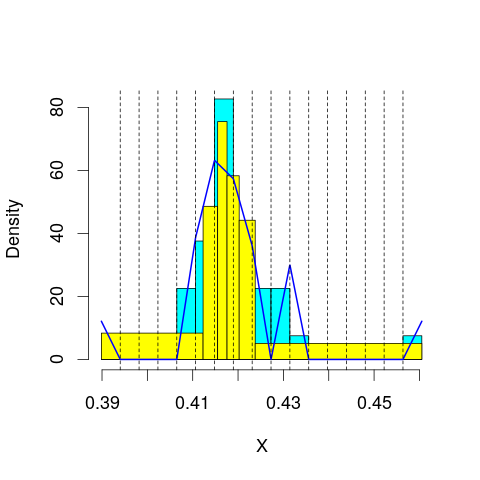

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.89923
mop.approx: Iteration 11. LL = 116.9448
mop.approx: Iteration 21. LL = 117.0553
mop.approx: Iteration 31. LL = 117.0666
mop.approx: Converged. Iteration 40. LL = 117.0686
[1] "Computing the linear combination of B-splines"


84.1441357762
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.46188
mop.approx: Iteration 11. LL = 115.9526
mop.approx: Iteration 21. LL = 116.0033
mop.approx: Iteration 31. LL = 116.0081
mop.approx: Converged. Iteration 31. LL = 116.0083
[1] "Computing the linear combination of B-splines"


81.3508995862
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.11526
mop.approx: Iteration 11. LL = 111.5258
mop.approx: Iteration 21. LL = 111.6741
mop.approx: Iteration 31. LL = 111.6896
mop.approx: Converged. Iteration 37. LL = 111.6911
[1] "Computing the linear combination of B-splines"


75.3008420613
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.95031
mop.approx: Iteration 11. LL = 110.9197
mop.approx: Iteration 21. LL = 110.9758
mop.approx: Iteration 31. LL = 110.998
mop.approx: Iteration 41. LL = 111.01
mop.approx: Iteration 51. LL = 111.0164
mop.approx: Iteration 61. LL = 111.0197
mop.approx: Iteration 71. LL = 111.0215
mop.approx: Converged. Iteration 73. LL = 111.0218
[1] "Computing the linear combination of B-splines"


72.8987117183
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.78338
mop.approx: Iteration 11. LL = 110.7923
mop.approx: Iteration 21. LL = 110.9248
mop.approx: Iteration 31. LL = 110.9492
mop.approx: Iteration 41. LL = 110.9559
mop.approx: Converged. Iteration 50. LL = 110.9578
[1] "Computing the linear combination of B-splines"


71.1006192973
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.335914
mop.approx: Iteration 11. LL = 110.5133
mop.approx: Iteration 21. LL = 110.6998
mop.approx: Iteration 31. LL = 110.7482
mop.approx: Iteration 41. LL = 110.7667
mop.approx: Iteration 51. LL = 110.7755
mop.approx: Iteration 61. LL = 110.7802
mop.approx: Iteration 71. LL = 110.7831
mop.approx: Iteration 81. LL = 110.7849
mop.approx: Converged. Iteration 87. LL = 110.7858
[1] "Computing the linear combination of B-splines"


69.0416207407
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.431817
[1] "Computing the linear combination of B-splines"


96.2526001227
('best: ', 86.482359182167386, 'accepted difference:', 147.02001060968456, 'cur BIC:', 96.252600122749442)
m reached
('Sum of Probabilities:', 3.728627789047958)
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.34265
mop.approx: Iteration 11. LL = 116.9492
mop.approx: Iteration 21. LL = 116.9799
mop.approx: Converged. Iteration 26. LL = 116.9813
[1] "Computing the linear combination of B-splines"


84.0568181792
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 84.056818179183622)
m reached
('Sum of Probabilities:', 0.9873122537447601)
chosen


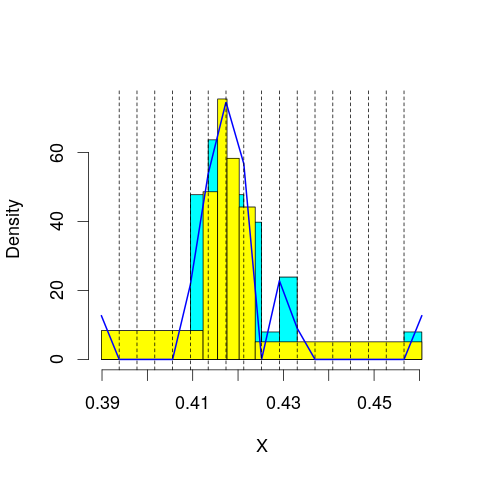

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.89923
mop.approx: Iteration 11. LL = 117.8362
mop.approx: Converged. Iteration 17. LL = 117.8413
[1] "Computing the linear combination of B-splines"


83.1839395445
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.46188
mop.approx: Iteration 11. LL = 115.9416
mop.approx: Iteration 21. LL = 116.0749
mop.approx: Iteration 31. LL = 116.0909
mop.approx: Iteration 41. LL = 116.0945
mop.approx: Converged. Iteration 48. LL = 116.0957
[1] "Computing the linear combination of B-splines"


79.7055141828
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.11526
mop.approx: Iteration 11. LL = 111.7138
mop.approx: Iteration 21. LL = 111.7612
mop.approx: Iteration 31. LL = 111.766
mop.approx: Converged. Iteration 32. LL = 111.7662
[1] "Computing the linear combination of B-splines"


73.6431269297
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.95031
mop.approx: Iteration 11. LL = 111.2784
mop.approx: Iteration 21. LL = 111.5063
mop.approx: Iteration 31. LL = 111.5466
mop.approx: Iteration 41. LL = 111.5541
mop.approx: Iteration 51. LL = 111.5561
mop.approx: Converged. Iteration 51. LL = 111.5562
[1] "Computing the linear combination of B-splines"


71.7002146666
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.78338
mop.approx: Iteration 11. LL = 110.9377
mop.approx: Iteration 21. LL = 110.9877
mop.approx: Iteration 31. LL = 111.0027
mop.approx: Iteration 41. LL = 111.0092
mop.approx: Iteration 51. LL = 111.0122
mop.approx: Converged. Iteration 59. LL = 111.0135
[1] "Computing the linear combination of B-splines"


69.4221975132
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.335914
mop.approx: Iteration 11. LL = 110.6222
mop.approx: Iteration 21. LL = 110.7729
mop.approx: Iteration 31. LL = 110.7931
mop.approx: Iteration 41. LL = 110.7969
mop.approx: Converged. Iteration 42. LL = 110.7971
[1] "Computing the linear combination of B-splines"


67.5046799283
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.431817
[1] "Computing the linear combination of B-splines"


13.8296911796
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.34265
mop.approx: Iteration 11. LL = 119.2539
mop.approx: Iteration 21. LL = 119.2691
mop.approx: Converged. Iteration 24. LL = 119.2697
[1] "Computing the linear combination of B-splines"


84.6123337938
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 84.612333793816248)
m reached
('Sum of Probabilities:', 0.9867567364351978)
chosen


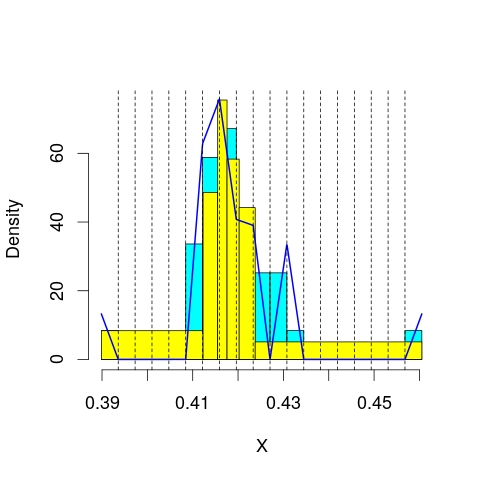

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.89923
mop.approx: Iteration 11. LL = 116.886
mop.approx: Iteration 21. LL = 116.9308
mop.approx: Converged. Iteration 28. LL = 116.9336
[1] "Computing the linear combination of B-splines"


80.5434087663
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.46188
mop.approx: Iteration 11. LL = 116.9912
mop.approx: Iteration 21. LL = 117.0255
mop.approx: Converged. Iteration 22. LL = 117.0257
[1] "Computing the linear combination of B-splines"


78.9026094205
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.11526
mop.approx: Iteration 11. LL = 111.407
mop.approx: Iteration 21. LL = 111.5053
mop.approx: Iteration 31. LL = 111.5178
mop.approx: Converged. Iteration 37. LL = 111.5192
[1] "Computing the linear combination of B-splines"


71.6632409764
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.95031
mop.approx: Iteration 11. LL = 111.8105
mop.approx: Iteration 21. LL = 111.8868
mop.approx: Iteration 31. LL = 111.897
mop.approx: Iteration 41. LL = 111.8996
mop.approx: Converged. Iteration 43. LL = 111.8999
[1] "Computing the linear combination of B-splines"


70.3111141102
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.78338
mop.approx: Iteration 11. LL = 111.0188
mop.approx: Iteration 21. LL = 111.2126
mop.approx: Iteration 31. LL = 111.2797
mop.approx: Iteration 41. LL = 111.3041
mop.approx: Iteration 51. LL = 111.3141
mop.approx: Iteration 61. LL = 111.3187
mop.approx: Iteration 71. LL = 111.3208
mop.approx: Converged. Iteration 75. LL = 111.3215
[1] "Computing the linear combination of B-splines"


67.9925961619
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.335914
mop.approx: Iteration 11. LL = 113.4829
mop.approx: Iteration 21. LL = 113.769
mop.approx: Iteration 31. LL = 113.8397
mop.approx: Iteration 41. LL = 113.8632
mop.approx: Iteration 51. LL = 113.8742
mop.approx: Iteration 61. LL = 113.8803
mop.approx: Iteration 71. LL = 113.8842
mop.approx: Iteration 81. LL = 113.8867
mop.approx: Iteration 91. LL = 113.8885
mop.approx: Iteration 101. LL = 113.8899
mop.approx: Converged. Iteration 101. LL = 113.89
[1] "Computing the linear combination of B-splines"


68.8291240457
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.431817
[1] "Computing the linear combination of B-splines"


134.366785195
('best: ', 84.612333793816248, 'accepted difference:', 143.84096744948761, 'cur BIC:', 134.3667851948212)
m reached
('Sum of Probabilities:', 12.589863800164645)
('Order:', 2)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 84.34265
mop.approx: Iteration 11. LL = 118.2316
mop.approx: Iteration 21. LL = 118.256
mop.approx: Converged. Iteration 24. LL = 118.2567
[1] "Computing the linear combination of B-splines"


81.8664647967
('best: ', -99999, 'accepted difference:', -29999.70000000001, 'cur BIC:', 81.866464796709622)
m reached
('Sum of Probabilities:', 0.9862134729726867)
chosen


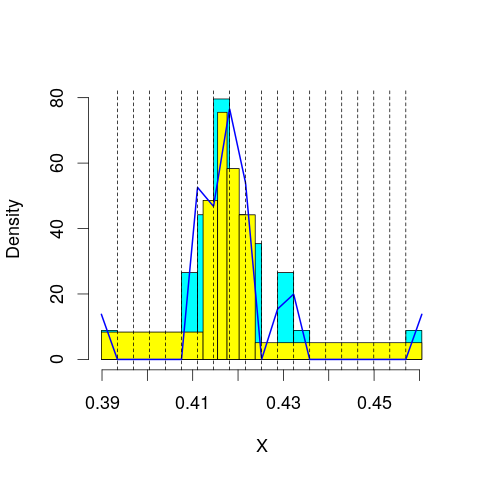

('Order:', 3)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.89923
mop.approx: Iteration 11. LL = 118.0911
mop.approx: Converged. Iteration 16. LL = 118.0939
[1] "Computing the linear combination of B-splines"


79.9708009207
('Order:', 4)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 83.46188
mop.approx: Iteration 11. LL = 116.416
mop.approx: Iteration 21. LL = 116.4782
mop.approx: Converged. Iteration 28. LL = 116.4811
[1] "Computing the linear combination of B-splines"


76.6251102462
('Order:', 5)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 24.11526
mop.approx: Iteration 11. LL = 112.3069
mop.approx: Iteration 21. LL = 112.3984
mop.approx: Iteration 31. LL = 112.4142
mop.approx: Iteration 41. LL = 112.4177
mop.approx: Converged. Iteration 43. LL = 112.4181
[1] "Computing the linear combination of B-splines"


70.8292380552
('Order:', 6)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 17.95031
mop.approx: Iteration 11. LL = 111.507
mop.approx: Iteration 21. LL = 111.5782
mop.approx: Iteration 31. LL = 111.59
mop.approx: Converged. Iteration 39. LL = 111.592
[1] "Computing the linear combination of B-splines"


68.2702348492
('Order:', 7)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 12.78338
mop.approx: Iteration 11. LL = 111.6817
mop.approx: Iteration 21. LL = 111.8469
mop.approx: Iteration 31. LL = 111.8811
mop.approx: Iteration 41. LL = 111.8949
mop.approx: Iteration 51. LL = 111.9024
mop.approx: Iteration 61. LL = 111.907
mop.approx: Iteration 71. LL = 111.9099
mop.approx: Iteration 81. LL = 111.9118
mop.approx: Iteration 91. LL = 111.9131
mop.approx: Converged. Iteration 91. LL = 111.9132
[1] "Computing the linear combination of B-splines"


66.8663963686
('Order:', 8)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 8.335914
mop.approx: Iteration 11. LL = 110.7849
mop.approx: Iteration 21. LL = 110.8711
mop.approx: Iteration 31. LL = 110.8936
mop.approx: Iteration 41. LL = 110.9014
mop.approx: Iteration 51. LL = 110.9052
mop.approx: Iteration 61. LL = 110.9077
mop.approx: Iteration 71. LL = 110.9096
mop.approx: Iteration 81. LL = 110.9111
mop.approx: Iteration 91. LL = 110.9124
mop.approx: Converged. Iteration 93. LL = 110.9127
[1] "Computing the linear combination of B-splines"


63.6645490098
('Order:', 9)
okay


[1] "Computing B-splines for dimension 1"
[1] "Computing the maximum likelihood estimators of the mixing coefficients"
mop.approx: Iteration 1. LL = 4.431817
[1] "Computing the linear combination of B-splines"


104.367167057
('best: ', 81.866464796709622, 'accepted difference:', 139.17299015440636, 'cur BIC:', 104.36716705723983)
m reached
('Sum of Probabilities:', 4.584910113596199)


In [9]:
#

_, featurecount = my_data.shape
for feature in xrange(featurecount):
    filename = 'lfps_' + str(feature)
    print filename
    automateHybrids(my_data[feature,:],filename)
    


In [ ]:
automateHybrids(gauss_1000,'gauss')

In [ ]:
automateHybrids(exp_1000,'exp1000')

In [ ]:
runPipelineExhaustive(sample,'filebeta_gauss')

In [15]:

beta_gauss=np.sort(sample)
didi=rPipeline(beta_gauss,'equal-width',9,4)
y=calcPolynomials(beta_gauss,didi)

#best_gmm=learnGMM(exp_100)
#print(best_gmm.score_samples(intro_Example.reshape(-1,1))
#print(best_gmm.means_)
#density = np.exp(best_gmm.score_samples(exp_100.reshape(-1,1)))

plt.hist(beta_gauss, 80, normed=True, alpha=0.5)
#plt.plot(sample, stats.expon.pdf(exp_100),'-b')
#plt.plot(exp_100, density, 'r:')
plt.plot(beta_gauss,y,'k--')
plt.xlim(0, 1)
plt.savefig('betagauss.png')


Error in withVisible({ : object 'attrVec' not found


PermissionError: [WinError 32] The process cannot access the file because it is being used by another process: 'C:\\Users\\Andreas\\AppData\\Local\\Temp\\tmpvmx4f64m\\Rplots001.png'

In [ ]:
polys,cuts,vals

In [ ]:
gauss_1000=np.random.normal(0.7,0.2,1000)

In [ ]:
runPipelineExhaustive(gauss_1000,'gaus1000')

In [ ]:
beta_gauss=np.sort(gauss_1000)
didi=rPipeline(beta_gauss,'equal-freq',3,3)
y=calcPolynomials(beta_gauss,didi)

#best_gmm=learnGMM(exp_100)
#print(best_gmm.score_samples(intro_Example.reshape(-1,1))
#print(best_gmm.means_)
#density = np.exp(best_gmm.score_samples(exp_100.reshape(-1,1)))

plt.hist(beta_gauss, 80, normed=True, alpha=0.5)
#plt.plot(sample, stats.expon.pdf(exp_100),'-b')
#plt.plot(exp_100, density, 'r:')
plt.plot(beta_gauss,y,'k--')
plt.xlim(0, 1.5)
plt.savefig('gaussian.png')

In [ ]:
exp_1000=np.random.exponential(1,1000)

In [ ]:
runPipelineExhaustive(exp_1000,'exp1000')

In [ ]:
beta_gauss=np.sort(exp_1000)
didi=rPipeline(beta_gauss,'equal-width',2,3)
y=calcPolynomials(beta_gauss,didi)

#best_gmm=learnGMM(exp_100)
#print(best_gmm.score_samples(intro_Example.reshape(-1,1))
#print(best_gmm.means_)
#density = np.exp(best_gmm.score_samples(exp_100.reshape(-1,1)))

plt.hist(beta_gauss, 80, normed=True, alpha=0.5)
#plt.plot(sample, stats.expon.pdf(exp_100),'-b')
#plt.plot(exp_100, density, 'r:')
plt.plot(beta_gauss,y,'k--')
plt.xlim(0, 6)
plt.savefig('expon.png')

In [ ]:
import pandas as pd 
df = pd.DataFrame(exp_1000)
df.to_csv("exponential_data.csv")